In [6]:
import esutil
import numpy as np
import h5py
import os

/cvmfs/des.opensciencegrid.org/fnal/anaconda2/envs/des18a/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [7]:
import matplotlib.pyplot as plt

In [8]:
from astropy.table import Table, vstack, join
from astropy.io.fits import getdata

In [9]:
import sys
sys.path.append('/home/s1/jesteves/git/ccopa/python/bma')

In [10]:
import loadPopColors
from smass import *

libPath= '/data/des61.a/data/pbarchi/galaxyClusters/simha_miles_Nov2016/'
splines, zmet = loadPopColors.doAll(libPath, lib="miles")

In [11]:
dz   = 0.01
zvec = np.arange(0.1,1.+dz,dz)

spline_list_Dict = [get_spline(splines[sp],zmet[sp],zvec) for sp in range(len(splines))]

In [12]:
def _get_spline(spline,zmet,zed):
    # for speed
    sgr  = float(spline[0](zed))
    sri  = float(spline[1](zed))
    siz  = float(spline[2](zed))
    sgrr = float(spline[4](zed)) ;# restframe g-r
    sgir = float(spline[5](zed)) ;# restframe g-i
    skii = float(spline[6](zed)) ;# kcorrection: i_o - i_obs
    skri = float(spline[7](zed)) ;# kcorrection: r_o - i_obs
    sml  = float(spline[8](zed)) ;# log(mass/light)  (M_sun/L_sun)
    ssfr = float(spline[9](zed))
    if (ssfr<-20.): ssfr=-20.
    sage_cosmic = float(spline[10](zed))
    sage = float(spline[11](zed))
    szmet = float(zmet)
    return np.array([sgr,sri,siz,sgrr,sgir,skii,skri,sml,ssfr,sage,szmet])


In [249]:
def get_minimal(x,dx_min=0.02):
    xmin    = np.nanmin(x,axis=0)
    xmin_q1 = np.nanpercentile(x,25,axis=0)
    res      = xmin#np.where(xmin<dx_min,xmin,xmin_q1)
    return res

def get_color_min_z(zp,x,dx_min=0.01):
    dgr,dri,diz = [],[],[]
    for i in range(len(splines)):
        out = _get_spline(splines[i],zmet[i],zp)
        dgr.append((x - out[0]))
        dri.append((x - out[1]))
        diz.append((x - out[2]))
    
    c3 = np.sqrt(np.array(dgr)**2+np.array(dri)**2+np.array(diz)**2)
    cmin_gr = get_minimal(np.abs(dgr),dx_min=dx_min)
    cmin_ri = get_minimal(np.abs(dri),dx_min=dx_min)
    cmin_iz = get_minimal(np.abs(diz),dx_min=dx_min)
    cmin_c3 = get_minimal(c3)
    return cmin_gr,cmin_ri,cmin_iz,cmin_c3

In [250]:
# dgr,dri,diz = [],[],[]
# for i in range(len(splines)):
#     out = _get_spline(splines[i],zmet[i],0.1)
#     dgr.append(x - out[0])
#     dri.append(x - out[1])
#     diz.append(x - out[2])

# d3 = np.sqrt(np.array(dgr)**2+np.array(dri)**2+np.array(diz)**2).T
# myidx = np.argmin(d3,axis=1)
# cmin_gr = np.abs(dgr)[myidx]
# cmin_ri = np.abs(dri)[myidx]
# cmin_iz = np.abs(diz)[myidx]

In [251]:
# plt.hist(np.log10(d3[myidx]))d3

In [255]:
xvec = np.linspace(0.1,1.,200)
yvec = np.linspace(-1.,3,1200)

dgr,dri,diz,d3 = [],[],[],[]
for z in xvec:
    c1,c2,c3,ct = get_color_min_z(z,yvec)
    dgr.append(c1)
    dri.append(c2)
    diz.append(c3)
    d3.append(ct)

In [256]:
out = [dgr,dri,diz]

In [257]:
np.array(dgr).shape

(200, 1200)

In [258]:
xvec.size

200

In [259]:
res_map = dict()
res_map['gr'] = np.array(dgr)
res_map['ri'] = np.array(dri)
res_map['iz'] = np.array(diz)
res_map['d3'] = np.array(d3)
res_map['zvec']    = xvec
res_map['cvec']    = yvec
res_map['indices'] = np.arange(0,xvec.size,1,dtype=np.int)

In [260]:
# out = [res_map['gr'][:],res_map['ri'][:],res_map['iz'][:]]


In [261]:
def read_map(infile):
    hf = h5py.File(infile, 'r')
    cols  = list(hf.keys())
    mydict= dict().fromkeys(cols)
    for col in cols:
        mydict[col] = hf[col][:]
    hf.close()
    return mydict


In [262]:
def save_map(outfile,mymap):
    columns = mymap.keys()
    hf = h5py.File(outfile,'w')
    for col in columns:
        hf.create_dataset('%s/'%col,data=mymap[col][:])
    hf.close()

In [263]:
save_map('/data/des61.a/data/johnny/COSMOS/BMA/res_map.hdf5',res_map)

In [264]:
# mymap = read_map('/data/des61.a/data/johnny/COSMOS/BMA/res_map.hdf5')

In [265]:
def get_res(zi,ci,label):
#     print(res_map['zvec'][:].size)
#     print(res_map['indices'][:].size)
    idx = int(np.interp(zi,res_map['zvec'][:],res_map['indices'][:].astype(np.int)))
#     print(res_map[label][idx,:].size)
    err = np.interp(ci,res_map['cvec'],res_map[label][idx,:])
    return err

In [266]:
# res_map = mymap

In [267]:
xx, yy = np.meshgrid(xvec, yvec)

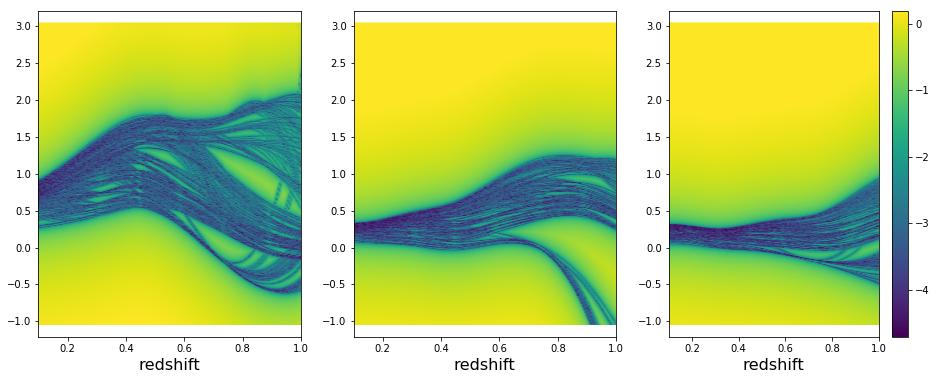

In [268]:
fig, axis = plt.subplots(1, 3, figsize=(16,6), sharex='all')

for i in range(3): 
    im = axis[i].scatter(xx,yy,c=np.log10(out[i]).T,zorder=-1,vmin=np.log(0.009),vmax=.2)
    axis[i].set_xlabel('redshift',fontsize=16)
    
# plot_color_evolution(axis[0],'gr',ylims=[-.5,3.])
# plot_color_evolution(axis[1],'ri',ylims=[-.5,2.5])
# plot_color_evolution(axis[2],'iz',ylims=[-.5,1.75])
axis[0].set_xlim(zmin,zmax)
fig.colorbar(im, ax=axis[2])

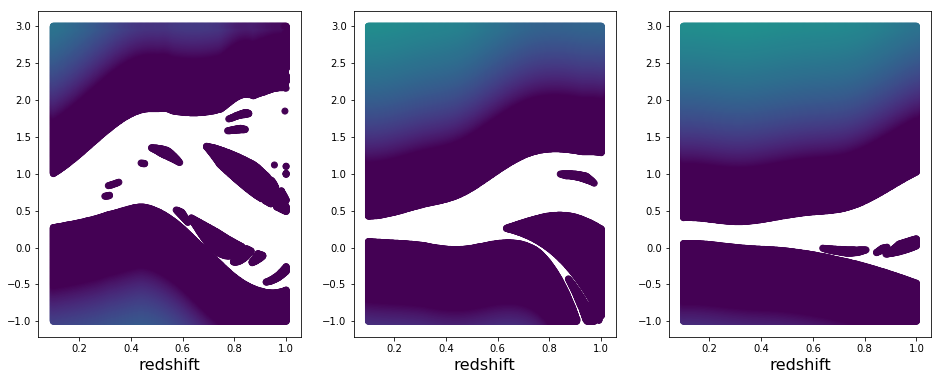

In [269]:
fig, axis = plt.subplots(1, 3, figsize=(16,6), sharex='all')

for i in range(3): 
    z = np.array(out[i]).T
    row,col = np.where(z>0.04)
    im = axis[i].scatter(xx[row,col],yy[row,col],c=np.log10(z[row,col]),zorder=-1,vmin=-0.092,vmax=0.96)
    axis[i].set_xlabel('redshift',fontsize=16)
    
# plot_color_evolution(axis[0],'gr',ylims=[-.5,3.])
# plot_color_evolution(axis[1],'ri',ylims=[-.5,2.5])
# plot_color_evolution(axis[2],'iz',ylims=[-.5,1.75])
# axis[0].set_xlim(zmin,zmax)
# fig.colorbar(im, ax=axis[2])

In [161]:
xx[row,col]

array([0.1       , 0.10452261, 0.10904523, ..., 0.99095477, 0.99547739,
       1.        ])

(array([ 0,  0,  0, ..., 99, 99, 99]),
 array([  0,   1,   2, ..., 297, 298, 299]))

In [35]:
## load des deep field
des_deep_field_infile = '/data/des70.a/data/annis/StellarMass-2021/y3_deep_fields.fits'
des0 = Table(getdata(des_deep_field_infile))

## load bma output
bma_out_file = '/data/des61.a/data/johnny/COSMOS/BMA/bma_test_large.fits'
bma0 = Table(getdata(bma_out_file))

In [36]:
## make a cut
mask = (bma0['zmet']<=1.)&(bma0['zmet']>=0.1)
bma = bma0[mask]

In [37]:
des    = des0[bma['row']]
des['row']       = bma['row']
des['rowCOSMOS'] = bma['rowCOSMOS']

des['z_true']    = bma['zmet']

In [38]:
bad = bma['best_chisq']>=100
good= (bma['best_chisq']<=0.9)&(bma['best_chisq']<=1.1)

In [74]:
zmax,zmin = 1.,0.1
zvec = np.linspace(zmin,zmax,100)
#spline_list_Dict = [get_spline(splines[sp],zmet[sp],zvec) for sp in range(len(splines))]

In [60]:
w, = np.where((zvec<=zmax)&(zvec>=zmin))

def plot_color_evolution(ax,ci,ylims=[0.,1.]):
    for i in range(len(splines)):
        ax.plot(zvec[w],spline_list_Dict[i]['s%s'%ci][w],alpha=0.1)
    ax.set_title(ci)
    ax.set_ylim(ylims[0],ylims[1])


In [409]:
# fig, axis = plt.subplots(1, 3, figsize=(16,6), sharex='all')

# plot_color_evolution(axis[0],'gr',ylims=[-.5,2.5])
# plot_color_evolution(axis[1],'ri',ylims=[-.5,1.75])
# plot_color_evolution(axis[2],'iz',ylims=[-.5,1.])
# axis[0].set_xlim(zmin,zmax)
# for i in range(3): axis[i].set_xlabel('redshift',fontsize=16)
# # plt.set_ylabel(r'$(g-r)$',fontsize=16)

In [196]:
gr_err = np.array([get_res(zi,ci,'gr') for zi,ci in zip(bma['zmet'],bma['gr'])])
ri_err = np.array([get_res(zi,ci,'ri') for zi,ci in zip(bma['zmet'],bma['ri'])])
iz_err = np.array([get_res(zi,ci,'iz') for zi,ci in zip(bma['zmet'],bma['iz'])])

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200

1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200
1200
200
200

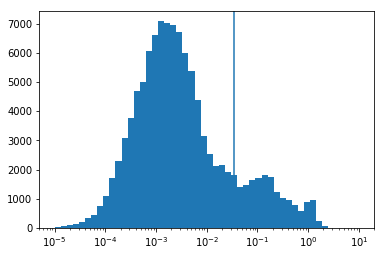

In [132]:
plt.hist(gr_err,bins=np.logspace(-5,1.,51))
plt.axvline(0.034)
plt.xscale('log')

In [123]:
q1,q3 = np.nanpercentile(np.log10(gr_err),[25,75])
iqr = q3-q1

In [140]:
nhigh, nlow = q1-1.0*iqr, q3+1.5*iqr

In [141]:
print(10**nhigh, 10**nlow)

(5.8833906842025765e-05, 0.43716090165648647)


In [139]:
np.nanmedian(np.log10(gr_err))

-2.6405573112817255

In [25]:
## Make Grid
res = 1e-1
dz  = 0.1
x = np.arange(0.1,1.+dz,dz)
y = np.arange(-1.,2.5+res,res)
xx, yy = np.meshgrid(x, y)

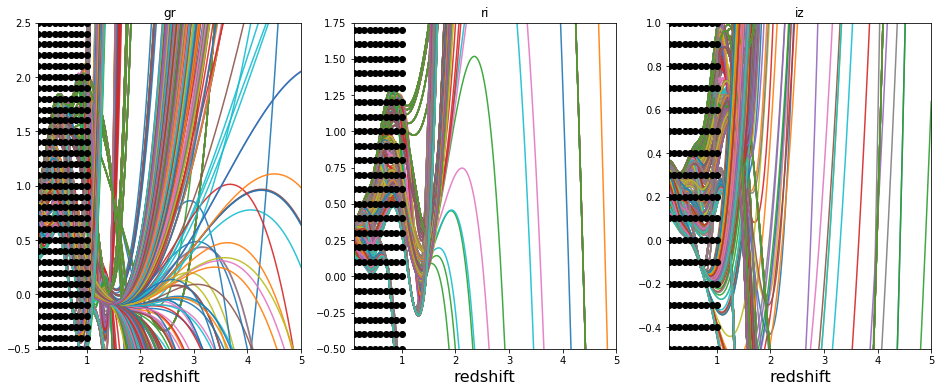

In [26]:
fig, axis = plt.subplots(1, 3, figsize=(16,6), sharex='all')

plot_color_evolution(axis[0],'gr',ylims=[-.5,2.5])
plot_color_evolution(axis[1],'ri',ylims=[-.5,1.75])
plot_color_evolution(axis[2],'iz',ylims=[-.5,1.])
axis[0].set_xlim(zmin,zmax)
for i in range(3): 
    axis[i].scatter(xx,yy,color='k',zorder=1000)
    axis[i].set_xlabel('redshift',fontsize=16)

### Run BMA on Bad Sample

In [270]:
def create_input_file(files,table,nsize,nchunks):
    columns = table.keys()
    idxs    = np.linspace(0,nsize,nchunks+1,dtype=np.int64)
    
    for i,infile in enumerate(files):
        hf = h5py.File(infile,'w')
        hf.create_group('bma')
        for col in columns:
            ilo,iup = idxs[i],idxs[i+1]
            hf.create_dataset('bma/%s/'%col,data=table[col][ilo:iup])
        hf.close()

In [271]:
def make_bma_input_temp_file(des,files,nsize,nchunks):
    out = dict()
    ## defining IDs
    out['mid']     = des['row']
    out['CID']     = des['rowCOSMOS']
    out['indices'] = np.arange(0,len(des),1,dtype=np.int64)
    
    out['redshift'] = des['z_true']
    out['i']    = des['MAG_I']
    out['ierr'] = des['MAGERR_I']

    out['gr']   = des['MAG_G']-des['MAG_R']
    out['ri']   = des['MAG_R']-des['MAG_I']
    out['iz']   = des['MAG_I']-des['MAG_Z']
    
    gr_err = np.array([get_res(zi,ci,'gr') for zi,ci in zip(out['redshift'],out['gr'])])
    ri_err = np.array([get_res(zi,ci,'ri') for zi,ci in zip(out['redshift'],out['ri'])])
    iz_err = np.array([get_res(zi,ci,'iz') for zi,ci in zip(out['redshift'],out['iz'])])

    out['grerr']= np.sqrt(des['MAGERR_G']**2+des['MAGERR_R']**2+gr_err**2)
    out['rierr']= np.sqrt(des['MAGERR_R']**2+des['MAGERR_I']**2+ri_err**2)
    out['izerr']= np.sqrt(des['MAGERR_I']**2+des['MAGERR_Z']**2+iz_err**2)

    create_input_file(files,out,nsize,nchunks)
    return out

In [272]:
nsize   = len(des)
nchunks = 50

basename  = '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_{}_{:03d}.hdf5'
infiles = [basename.format('drop_floor_in',i) for i in range(nchunks)]
outfiles= [basename.format('drop_floor_out',i) for i in range(nchunks)]

In [273]:
data = make_bma_input_temp_file(des,infiles,nsize,nchunks)

(-1.1, 3)

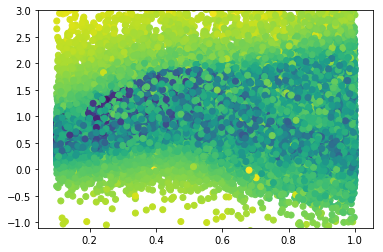

In [274]:
plt.scatter(data['redshift'],data['gr'],c=np.log10(data['grerr']),vmax=0.5)
plt.ylim(-1.1,3)

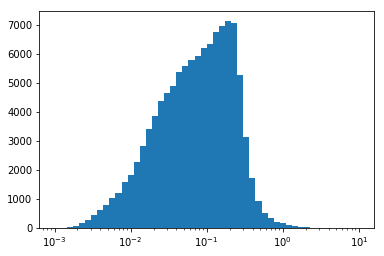

In [275]:
plt.hist(data['rierr'],bins=np.logspace(-3,1.,51))
plt.xscale('log')

In [276]:
nsize

110301

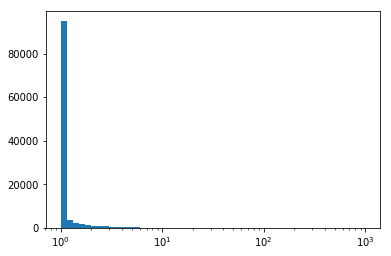

In [277]:
plt.hist(data['grerr']/bma['grerr'],bins=np.logspace(0,+3.0,51))
plt.xscale('log')

# Running BMA

In [278]:
from joblib import Parallel, delayed
import sys

sys.path.append('/home/s1/jesteves/git/ccopa/python/bma')
import smass

def bma_trigger(infiles,outfiles,inPath,
               nCores=2,batchStart=0,batchEnd=None,overwrite=False):
    if batchEnd is None: batchEnd = self.bma_nchunks

    batches = np.arange(batchStart,batchEnd,1,dtype=np.int64)

    print('starting parallel process')
    print('nsize,nchunks,ncores:',nsize,nchunks,nCores)
    print('runing on the following batches:',batches)
    Parallel(n_jobs=nCores)(
        delayed(calc_copa_v2)(infiles[i], outfiles[i], inPath) for i in batches)
    print('ended smass calc')

In [279]:
nCores = 61
libPath= '/data/des61.a/data/pbarchi/galaxyClusters/simha_miles_Nov2016/'

bma_trigger(infiles, outfiles, libPath,
            nCores=nCores,batchStart=0,batchEnd=nchunks)

starting parallel process
('nsize,nchunks,ncores:', 110301, 50, 61)
('runing on the following batches:', array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]))
fraction of small errors: gr [0.01541251 0.01586582 0.02175884 0.02311877 0.024932   0.02583862
 0.0294651  0.03354488 0.04669084 0.05485041 0.05802357 0.0643699
 0.06572983 0.0693563  0.07298277 0.08658205 0.08975521 0.09927471
 0.10698096 0.10834089 0.11106074 0.11196736 0.11242067 0.11514053
 0.11831369 0.118767   0.12012693 0.12420671 0.12692656 0.13553944
 0.13644606 0.1486854  0.14959202 0.15095195 0.15231188 0.15457842
 0.15548504 0.15911151 0.16228468 0.16591115 0.17135086 0.17361741
 0.17452403 0.1781505  0.17951043 0.1831369  0.18585675 0.19038985
 0.19356301 0.19401632 0.19628286 0.20081596 0.20761559 0.21441523
 0.21622847 0.2175884  0.21940163 0.22212

 0.99365367 0.99773345]
fraction of small errors: ri 0.163191296464
fraction of small errors: iz 0.154125113327


fraction of small errors: gr [4.53309157e-04 2.71985494e-03 1.22393472e-02 1.31459655e-02
 1.76790571e-02 1.99456029e-02 2.08522212e-02 2.26654578e-02
 2.44786945e-02 2.81051677e-02 3.49048051e-02 3.58114234e-02
 4.48776065e-02 4.75974615e-02 4.89573889e-02 5.21305530e-02
 5.84768812e-02 6.07434270e-02 6.11967362e-02 6.43699003e-02
 6.48232094e-02 7.79691750e-02 8.15956482e-02 8.20489574e-02
 9.06618314e-02 9.33816863e-02 1.02447869e-01 1.03354488e-01
 1.07434270e-01 1.16953762e-01 1.18766999e-01 1.21486854e-01
 1.29646419e-01 1.41432457e-01 1.45965549e-01 1.46418858e-01
 1.47778785e-01 1.48685403e-01 1.55031732e-01 1.57751587e-01
 1.59564823e-01 1.60924751e-01 1.63644606e-01 1.64551224e-01
 1.65457842e-01 1.79057117e-01 1.80417044e-01 1.84043518e-01
 1.84496827e-01 1.89936537e-01 1.90843155e-01 1.91296464e-01
 2.01722575e-01 2.05349048e-01 2.06708976e-01 2.13508613e-01
 2.

 9.82774252e-01 9.85494107e-01 9.86400725e-01 9.98640073e-01]
fraction of small errors: ri 0.141432456936
fraction of small errors: iz 0.14369900272


fraction of small errors: gr [0.00362647 0.00543971 0.00906618 0.01087942 0.01133273 0.01586582
 0.01677244 0.02221215 0.024932   0.02674524 0.02901179 0.0294651
 0.0394379  0.04351768 0.04759746 0.05167724 0.05711695 0.05802357
 0.05847688 0.0593835  0.06255666 0.0643699  0.06844968 0.06980961
 0.07660925 0.07978241 0.08068903 0.08204896 0.08476881 0.08794198
 0.09519492 0.10244787 0.11287398 0.11423391 0.11514053 0.12239347
 0.13055304 0.13327289 0.14143246 0.143699   0.14596555 0.15412511
 0.15729828 0.15775159 0.16636446 0.16727108 0.16908432 0.16953762
 0.17044424 0.17089755 0.18540345 0.18585675 0.18631006 0.18857661
 0.19265639 0.1931097  0.19854941 0.20126927 0.20580236 0.20716228
 0.20852221 0.20942883 0.21260199 0.22030825 0.22076156 0.22846782
 0.23164098 0.23300091 0.23844062 0.2425204  0.24433364 0.24841342
 0.24932004 0.249

 0.98866727 0.99592022]
fraction of small errors: ri 0.151405258386
fraction of small errors: iz 0.14369900272


fraction of small errors: gr [0.         0.00543971 0.00589302 0.00861287 0.01133273 0.01269266
 0.01314597 0.01450589 0.01722575 0.01813237 0.02085222 0.02402539
 0.02719855 0.03581142 0.0394379  0.04125113 0.04215775 0.04669084
 0.04759746 0.05349048 0.05621034 0.05666364 0.0593835  0.06074343
 0.06255666 0.06618314 0.06754306 0.07252947 0.07796917 0.08204896
 0.08476881 0.08612874 0.08794198 0.0893019  0.09020852 0.09292838
 0.09746147 0.10743427 0.1087942  0.11468722 0.11604714 0.11650045
 0.11831369 0.11922031 0.12647325 0.12783318 0.13191296 0.13599275
 0.14052584 0.14324569 0.14823209 0.14913871 0.16273799 0.16409791
 0.16455122 0.17089755 0.17135086 0.17361741 0.17543064 0.17588395
 0.17679057 0.17724388 0.1781505  0.18223028 0.18359021 0.18449683
 0.20580236 0.2080689  0.21033545 0.21532185 0.21985494 0.22076156
 0.2225748  0.22348141 0.22438803 0.22574796 0.2311876

 0.95784225 0.97144152 0.975068   0.97778785 0.97914778 0.98232094]

fraction of small errors: ri 0.149592021759
fraction of small errors: iz 0.147778785131


fraction of small errors: gr [0.00407978 0.00861287 0.01586582 0.01677244 0.01722575 0.01903898
 0.02583862 0.03263826 0.03309157 0.04487761 0.04578422 0.04623753
 0.0494107  0.05530372 0.05802357 0.06029012 0.06300997 0.06799637
 0.07706256 0.08023572 0.08204896 0.0843155  0.08703536 0.10426111
 0.1137806  0.11423391 0.11468722 0.118767   0.13145966 0.13463282
 0.14823209 0.15185857 0.1536718  0.15503173 0.16092475 0.1631913
 0.16727108 0.16863101 0.16908432 0.16999093 0.17135086 0.17860381
 0.17951043 0.18041704 0.18132366 0.18177697 0.18766999 0.18948323
 0.19401632 0.19764279 0.19945603 0.20353581 0.20398912 0.20761559
 0.20988214 0.2175884  0.2180417  0.22212149 0.22574796 0.2275612
 0.23300091 0.23390752 0.23617407 0.24025385 0.24297371 0.24342702
 0.24433364 0.24705349 0.25113327 0.25294651 0.2574796  0.262466
 0.26291931 

 9.93200363e-01 9.93653672e-01 9.99093382e-01]
fraction of small errors: ri 0.164097914778
fraction of small errors: iz 0.155031731641


fraction of small errors: gr [0.00453309 0.00770626 0.01359927 0.03263826 0.03354488 0.04714415
 0.04986401 0.05031732 0.05213055 0.06119674 0.06799637 0.08340888
 0.08386219 0.08658205 0.08839529 0.0893019  0.09066183 0.093835
 0.10199456 0.10335449 0.10516772 0.10562103 0.10698096 0.10788758
 0.11332729 0.11831369 0.12330009 0.12647325 0.13281958 0.13417951
 0.13508613 0.13689937 0.143699   0.16591115 0.16727108 0.17135086
 0.17497733 0.19854941 0.21532185 0.22076156 0.22166818 0.22302811
 0.22982774 0.2425204  0.24660018 0.24932004 0.2574796  0.25793291
 0.27017226 0.27198549 0.27289211 0.27334542 0.27470535 0.27878513
 0.28059837 0.2819583  0.28377153 0.2869447  0.29646419 0.2969175
 0.29918404 0.30643699 0.30825023 0.31051677 0.31097008 0.31459655
 0.31640979 0.31776972 0.31912965 0.3318223  0.3368087  0.34406165
 0.35040798 0.35176791 0.35494107

 0.99546691]
fraction of small errors: ri 0.160018132366
fraction of small errors: iz 0.151405258386


fraction of small errors: gr [0.00861287 0.01133273 0.01269266 0.02447869 0.03173164 0.03354488
 0.03671804 0.0394379  0.03989121 0.04306437 0.04487761 0.04578422
 0.04850408 0.05077063 0.06663645 0.0743427  0.07842248 0.07978241
 0.08023572 0.08159565 0.08250227 0.0893019  0.09202176 0.09564823
 0.09700816 0.10018132 0.10924751 0.11060743 0.11967362 0.12012693
 0.12783318 0.13009973 0.13463282 0.14551224 0.14641886 0.14732548
 0.14913871 0.1532185  0.16137806 0.16908432 0.17271079 0.17407072
 0.17633726 0.17860381 0.18223028 0.1831369  0.18721668 0.19492294
 0.19764279 0.19854941 0.20262919 0.20444243 0.20625567 0.21441523
 0.2175884  0.22166818 0.22846782 0.23118767 0.23209429 0.23572076
 0.23889393 0.24070716 0.24116047 0.24297371 0.24388033 0.25611967
 0.26110607 0.2774252  0.28377153 0.28422484 0.28513146 0.28830462
 0.28875793 0.29465095 0.29737081 0.29782412 0.29873073 0.301903

 0.98050771 0.98413418 0.98730734 0.98821396 0.99229374 0.99592022]

fraction of small errors: ri 0.146872166818
fraction of small errors: ri 0.157751586582
fraction of small errors: iz 0.134632819583
fraction of small errors: iz 0.146872166818




fraction of small errors: gr [0.00000000e+00 4.53309157e-04 4.53309157e-03 6.34632820e-03
 6.79963735e-03 1.04261106e-02 1.63191296e-02 2.17588395e-02
 2.40253853e-02 2.44786945e-02 2.71985494e-02 4.57842248e-02
 4.66908432e-02 4.71441523e-02 5.53037171e-02 5.57570263e-02
 5.84768812e-02 6.30099728e-02 6.39165911e-02 6.57298277e-02
 6.89029918e-02 7.11695376e-02 8.25022665e-02 8.70353581e-02
 9.33816863e-02 9.92747053e-02 9.97280145e-02 1.06527652e-01
 1.09247507e-01 1.14233908e-01 1.17407072e-01 1.20126927e-01
 1.20580236e-01 1.21940163e-01 1.38259293e-01 1.39165911e-01
 1.40979148e-01 1.48232094e-01 1.55031732e-01 1.56391659e-01
 1.65457842e-01 1.68177697e-01 1.70897552e-01 1.74977335e-01
 1.79510426e-01 1.80870354e-01 1.83136899e-01 1.840

 0.97869447 0.97914778 0.98413418 0.99093382 0.99773345]
fraction of small errors: ri 0.135992747053
fraction of small errors: iz 0.141885766092


fraction of small errors: gr [0.00861287 0.01223935 0.01269266 0.01541251 0.01813237 0.01949229
 0.02402539 0.02901179 0.03082502 0.03218495 0.03535811 0.03671804
 0.03853128 0.03989121 0.04623753 0.04850408 0.04986401 0.0543971
 0.05666364 0.05893019 0.06482321 0.07660925 0.07978241 0.08023572
 0.08295558 0.08340888 0.08703536 0.08794198 0.08839529 0.09474161
 0.09564823 0.10516772 0.11604714 0.12103354 0.12511333 0.12964642
 0.13055304 0.13145966 0.13191296 0.13553944 0.13599275 0.13780598
 0.14233908 0.14596555 0.14777879 0.15004533 0.15095195 0.1532185
 0.15457842 0.1582049  0.1586582  0.15911151 0.17271079 0.17497733
 0.18449683 0.18857661 0.18993654 0.19265639 0.1931097  0.19446963
 0.19537625 0.19764279 0.20398912 0.20670898 0.21713509 0.22121487
 0.22348141 0.22484134 0.22665458 0.22982774 0.23118767 0.23662738
 0.24161378 0.24297371

 9.93653672e-01]fraction of small errors: gr [0.00271985 0.00725295 0.00770626 0.00906618 0.01903898 0.02629193
 0.03626473 0.03762466 0.04034451 0.04125113 0.04170444 0.04397099
 0.04759746 0.04895739 0.05213055 0.05303717 0.05349048 0.05893019
 0.06119674 0.06618314 0.07162285 0.07298277 0.07388939 0.07524932
 0.07660925 0.07706256 0.08159565 0.08658205 0.08794198 0.10244787
 0.1038078  0.10698096 0.10743427 0.10788758 0.11060743 0.1137806
 0.11740707 0.118767   0.12103354 0.12239347 0.12647325 0.12692656
 0.13553944 0.143699   0.14460562 0.14551224 0.14596555 0.15457842
 0.15548504 0.15593835 0.15775159 0.15956482 0.16273799 0.16591115
 0.17769719 0.17860381 0.17996374 0.18268359 0.18359021 0.18404352
 0.18676337 0.19038985 0.19854941 0.20126927 0.21396192 0.21441523
 0.21713509 0.22846782 0.23617407 0.23662738 0.24116047 0.24161378
 0.24388033 0.25339982 0.25430644 0.25521306 0.25566636 0.27923844
 0.29102448 0.2969175  0.31323663 0.32094288 0.32502267 0.32592928
 0.33091568 0.3363

 0.975068   0.97642792 0.97688123 0.98957389 0.99138713 0.99546691]
fraction of small errors: gr [0.00181324 0.00679964 0.00906618 0.0099728  0.01042611 0.01223935
 0.02447869 0.02810517 0.03127833 0.04306437 0.04487761 0.04578422
 0.04623753 0.05077063 0.05167724 0.05349048 0.05394379 0.05802357
 0.07660925 0.08476881 0.08658205 0.08703536 0.09202176 0.0988214
 0.10562103 0.11015413 0.11242067 0.11332729 0.11604714 0.11740707
 0.12239347 0.1237534  0.13100635 0.13735267 0.1387126  0.14188577
 0.14551224 0.15412511 0.15548504 0.15639166 0.15911151 0.16092475
 0.16364461 0.16455122 0.1781505  0.18177697 0.18223028 0.18404352
 0.18585675 0.19628286 0.19718948 0.1980961  0.20036265 0.20081596
 0.20489574 0.20534905 0.20716228 0.20942883 0.21396192 0.21441523
 0.21532185 0.21622847 0.2180417  0.22348141 0.23300091 0.23345422
 0.23390752 0.23662738 0.24116047 0.24796011 0.25022665 0.25203989
 0.2524932  0.25611967 0.26427924 0.27017226 0.27606528 0.27787851
 0.28558477 0.28966455 0.29374433

 0.99909338]fraction of small errors: ri 0.157751586582


fraction of small errors: gr [0.01223935 0.01359927 0.01541251 0.0299184  0.03037171 0.03535811
 0.03581142 0.03853128 0.04261106 0.04351768 0.04623753 0.04850408
 0.0494107  0.0593835  0.06029012 0.06572983 0.07706256 0.07842248
 0.09655485 0.10970082 0.11604714 0.11967362 0.12330009 0.13100635
 0.13145966 0.13191296 0.14007253 0.14732548 0.16092475 0.16455122
 0.17180417 0.18676337 0.1881233  0.19084316 0.19129646 0.19220308
 0.19446963 0.1980961  0.20217588 0.20262919 0.21214869 0.22393472
 0.2325476  0.23436083 0.24025385 0.24388033 0.2574796  0.25793291
 0.26427924 0.26835902 0.26881233 0.27425204 0.27561197 0.28014506
 0.28513146 0.2919311  0.29737081 0.30417044 0.30462375 0.30643699
 0.32275612 0.32774252 0.33000907 0.3318223  0.33726201 0.33771532
 0.34496827 0.35766092 0.36083409 0.36310063 0.36899365 0.37080689
 0.37216682 0.3762466  0.37851315 0.38304624 0.38531278 0.38984587
 0.39029918 0.39256573 0.39301904 0.395285

 9.84587489e-01 9.85040798e-01 9.87760653e-01 9.95920218e-01]
fraction of small errors: gr [0.0049864  0.00589302 0.01133273 0.02583862 0.0294651  0.0299184
 0.04034451 0.04215775 0.04986401 0.0543971  0.05847688 0.06210335
 0.06255666 0.07298277 0.07842248 0.08975521 0.093835   0.10607434
 0.10698096 0.11015413 0.11287398 0.11695376 0.12148685 0.12330009
 0.12828649 0.12919311 0.1337262  0.13417951 0.13689937 0.13961922
 0.14097915 0.14823209 0.15231188 0.16047144 0.16092475 0.16137806
 0.16455122 0.16953762 0.17633726 0.17724388 0.17951043 0.17996374
 0.18404352 0.18585675 0.19356301 0.19537625 0.19854941 0.19945603
 0.20262919 0.20761559 0.20942883 0.21577516 0.2175884  0.22529465
 0.2275612  0.23209429 0.23708069 0.23889393 0.23934723 0.24025385
 0.24116047 0.24388033 0.24569356 0.24705349 0.2475068  0.25022665
 0.25113327 0.25294651 0.2574796  0.25974615 0.26790571 0.26881233
 0.27198549 0.27470535 0.28603808 0.29238441 0.29873073 0.29963735
 0.30145059 0.30553037 0.30734361 0.313

 0.99728015]fraction of small errors: ri 0.169990933817
fraction of small errors: iz 0.150951949229
fraction of small errors: iz 0.166364460562
fraction of small errors: gr [0.00634633 0.00815956 0.01178604 0.01450589 0.0149592  0.01858568
 0.03581142 0.03671804 0.03762466 0.03853128 0.04170444 0.0444243
 0.04578422 0.04623753 0.04669084 0.05258386 0.06210335 0.06346328
 0.06482321 0.06572983 0.06890299 0.06980961 0.07343608 0.0743427
 0.07479601 0.07796917 0.08068903 0.08204896 0.08476881 0.08567543
 0.0942883  0.09972801 0.10154125 0.10698096 0.1087942  0.11332729
 0.1137806  0.118767   0.12012693 0.12556664 0.12919311 0.14052584
 0.14143246 0.143699   0.14596555 0.15004533 0.15593835 0.16364461
 0.16591115 0.1781505  0.17860381 0.19129646 0.19401632 0.19718948
 0.20081596 0.20262919 0.21532185 0.22076156 0.22121487 0.22529465
 0.22801451 0.23028105 0.23209429 0.23526745 0.25067996 0.25339982
 0.25430644 0.26473255 0.26609248 0.26654578 0.26699909 0.26790571
 0.26835902 0.27606528 0.

 0.98050771 0.98640073 0.99138713]fraction of small errors: ri 0.159111514053
fraction of small errors: iz 0.154578422484
fraction of small errors: gr [0.00226655 0.00271985 0.0049864  0.00725295 0.02085222 0.02221215
 0.02629193 0.03037171 0.04079782 0.04623753 0.0543971  0.06074343
 0.06799637 0.0693563  0.07116954 0.07298277 0.07343608 0.0743427
 0.07524932 0.08386219 0.0843155  0.08567543 0.08748867 0.08794198
 0.09066183 0.0942883  0.09610154 0.10199456 0.10471442 0.10562103
 0.11060743 0.12012693 0.12783318 0.13553944 0.13780598 0.1387126
 0.14596555 0.14823209 0.1486854  0.14959202 0.15095195 0.15140526
 0.15276519 0.16001813 0.16273799 0.16591115 0.16772439 0.17497733
 0.17951043 0.18177697 0.1831369  0.18495014 0.18676337 0.18902992
 0.18993654 0.19084316 0.19220308 0.19401632 0.19718948 0.20036265
 0.20489574 0.20534905 0.20580236 0.20942883 0.20988214 0.21214869
 0.21486854 0.21849501 0.22166818 0.22892112 0.23028105 0.23073436
 0.24206709 0.24342702 0.24433364 0.24478694 0.

 9.91840435e-01 9.95013599e-01]


fraction of small errors: iz 0.157751586582

fraction of small errors: ri 0.139619220308

fraction of small errors: ri 0.148685403445

fraction of small errors: iz 0.140072529465
fraction of small errors: iz 0.146872166818
fraction of small errors: gr [4.53309157e-04 9.06618314e-04 3.17316410e-03 4.07978241e-03
 1.13327289e-02 1.81323663e-02 2.26654578e-02 2.76518586e-02
 2.99184044e-02 3.21849501e-02 3.98912058e-02 4.30643699e-02
 4.35176791e-02 4.94106981e-02 5.71169538e-02 6.43699003e-02
 6.84496827e-02 6.89029918e-02 6.98096102e-02 7.66092475e-02
 8.29555757e-02 8.34088849e-02 8.38621940e-02 9.56482321e-02
 9.61015413e-02 9.79147779e-02 1.00181324e-01 1.07887579e-01
 1.14687217e-01 1.16047144e-01 1.17407072e-01 1.22393472e-01
 1.36446056e-01 1.46418858e-01 1.48232094e-01 1.49592022e-01
 1.53218495e-01 1.54125113e-01 1.56391659e-01 1.63644606e-01
 1.70444243e-01 1.71350861e-01 1.72710789e-01 1.77697189e-01
 1.78150499e-01 1.91749773e-01 1.93563010e-

 0.99184044 0.99229374 0.99274705 0.99456029 0.99592022]fraction of small errors: ri 0.176337262013
fraction of small errors: iz 0.129193109701
fraction of small errors: gr [0.         0.00679964 0.01269266 0.01405258 0.01541251 0.01722575
 0.01858568 0.03127833 0.03490481 0.03581142 0.03626473 0.03717135
 0.04034451 0.04261106 0.04669084 0.05077063 0.05258386 0.05485041
 0.05893019 0.05983681 0.06119674 0.07343608 0.0843155  0.0942883
 0.0988214  0.10108794 0.10335449 0.10743427 0.11196736 0.11287398
 0.11468722 0.11559383 0.11922031 0.12012693 0.12601995 0.12919311
 0.13145966 0.13417951 0.15004533 0.15593835 0.15911151 0.16953762
 0.17044424 0.17271079 0.17361741 0.17452403 0.17497733 0.17543064
 0.17679057 0.1831369  0.18404352 0.18449683 0.18585675 0.19084316
 0.19220308 0.19446963 0.19945603 0.20172257 0.20398912 0.20670898
 0.21622847 0.22846782 0.23345422 0.23844062 0.24433364 0.24705349
 0.25113327 0.25385313 0.25430644 0.26427924 0.26518586 0.26881233
 0.26926564 0.26971895 0

 116.58117586]
probs, chisq [3.89637433e-05 3.89568376e-05 3.85473357e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.30575801  20.3061125   20.32724715 ...  85.64932836  85.65027521
 466.52021816]
probs, chisq [2.88657986e-15 2.22044605e-15 1.77635684e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   66.99280703    67.52823623    67.9283573  ...   428.94624771
    97.12434901 15080.45902924]
probs, chisq [2.05265683e-05 1.91433646e-05 1.66618414e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.58758099   21.72710879   22.0047788  ... 8791.24101509 5078.62873152
 9877.84870879]
probs, chisq [0.00021759 0.00021753 0.00021594 ... 0.         0.         0.        ] [  16.86581364   16.86632636   16.88100889 ...  124.15603898  184.9868691
 2452.90108528]
probs, chisq [0.03060074 0.03059635 0.03041501 ... 0.         0.         0.        ] [  6.97346193   6.97374924   6.98563811 ... 172.56302991  83.43656704
  96.92443328]
probs, chisq [0.25715841 0.22270027 0

 5.86358342e+02 8.00513645e+02]
probs, chisq [0.31055657 0.31055657 0.31055657 ... 0.01313285 0.01213224 0.01162259] [2.33877839 2.33877839 2.33877839 ... 8.66527778 8.82377702 8.90960883]
probs, chisq [2.85286065e-05 2.77093131e-05 2.75446436e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.92920648   20.98748397   20.99940493 ...  310.56851436  315.33510007
 1098.45178764]
probs, chisq [0.34449157 0.33818857 0.33779655 ... 0.         0.         0.        ] [2.13137130e+00 2.16830325e+00 2.17062300e+00 ... 1.40616713e+02
 3.15988997e+03 1.90544449e+02]
probs, chisq [0.00792079 0.00792079 0.00792079 ... 0.         0.         0.        ] [  9.67652827   9.67652827   9.67652827 ... 115.31272223 121.37598186
 658.30427435]
probs, chisq [0.68334092 0.42638146 0.23499362 ... 0.         0.         0.        ] [  0.76152279   1.70484179   2.89639379 ... 486.59970994 486.97063356
 483.18811027]
probs, chisq [6.13410390e-01 5.72769346e-01 5.70809388e-01 ... 5.21085286e-10
 5.2106452

  82.65937214]
probs, chisq [5.67983484e-01 5.67698874e-01 5.67171892e-01 ... 8.91509089e-13
 8.90953977e-13 8.88622509e-13] [ 1.13132588  1.1323283   1.13418572 ... 55.49163967 55.49297003
 55.49817314]
probs, chisq [0.07579601 0.0757501  0.06030926 ... 0.         0.         0.        ] [   5.15941932    5.16063114    5.6165392  ...  145.83661888  145.8567945
 2268.2284044 ]
probs, chisq [8.26265786e-07 8.17494228e-07 8.13785137e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 28.01269868  28.03404399  28.04313893 ... 208.24764823  99.21151933
 248.20139865]
probs, chisq [0.33360839 0.33360839 0.33360839 ... 0.03763568 0.03746976 0.03715809] [2.19557494 2.19557494 2.19557494 ... 6.55960535 6.56844213 6.58514768]
probs, chisq [0.00027255 0.00027225 0.00026794 ... 0.         0.         0.        ] [  16.41535564   16.41759534   16.44947881 ...  280.82073104  243.4738988
 2333.97323724]
probs, chisq [0.31596414 0.3145179  0.31428293 ... 0.05923818 0.05916933 0.05652197] [2.304253

 18.84818876]
probs, chisq [0.02096272 0.02048413 0.02044147 ... 0.         0.         0.        ] [   7.73001886    7.77620946    7.78037902 ... 2564.5784907   908.01162504
 2739.72813249]
probs, chisq [0.68690545 0.68592052 0.68189001 ... 0.         0.         0.        ] [ 0.75111726  0.75398704  0.76577383 ... 92.1167164  92.1167164
 76.82590965]
probs, chisq [6.17185471e-05 5.73110611e-05 5.72253554e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.44753703e-01 1.41359769e-01 1.41357110e-01 ... 5.43623619e-08
 5.43623619e-08 5.42563522e-08] [  19.38585214   19.53403383   19.53702696 ...  102.67016853 1220.53580142
  775.26918564] [ 3.86544316  3.91289417  3.91293179 ... 33.4551876  33.4551876
 33.45909152]

probs, chisq [0.74052148 0.7293507  0.72893937 ... 0.         0.         0.        ] [  0.60080127   0.63120119   0.63232944 ...  78.95179852  84.4642925
 102.79338142]
probs, chisq [0.1553911  0.14761465 0.14525163 ... 0.         0.         0.        ] [   

 7357.26597669]
probs, chisq [9.12622810e-03 7.86420157e-03 7.37327498e-03 ... 8.95498438e-05
 8.95253440e-05 8.94835377e-05] [ 9.39320561  9.69086853  9.81978661 ... 18.64143035 18.6419776
 18.64291177]
probs, chisq [0.02639762 0.02631657 0.02630654 ... 0.         0.         0.        ] [  7.26896276   7.27511321   7.27587547 ...  78.65700186  84.7045387
 253.50501852]
probs, chisq [0.00478236 0.00466139 0.00437575 ... 0.         0.         0.        ] [ 10.68564039  10.73688157  10.8633564  ... 888.74254969  93.93850434
 110.5922714 ]
probs, chisq [0.00357694 0.00357585 0.00352975 ... 0.         0.         0.        ] [ 11.26649257  11.26710199  11.29305593 ... 182.49641953 360.99321095
 185.51698633]
probs, chisq [0.06112669 0.06112669 0.06112669 ... 0.         0.         0.        ] [  5.58961343   5.58961343   5.58961343 ... 388.61063861 358.79174521
 125.73900621]
probs, chisq [5.63608517e-01 5.61771047e-01 5.60702150e-01 ... 8.84372147e-07
 8.84372147e-07 8.84349349e-07] [ 1.146

 79.68611311]
probs, chisq [9.99887165e-01 9.99859739e-01 9.98507232e-01 ... 1.24011912e-13
 1.22013510e-13 1.16462395e-13] [2.25682120e-04 2.80541814e-04 2.98776613e-03 ... 5.94368693e+01
 5.94691327e+01 5.95622119e+01]
probs, chisq [0.61167872 0.61027913 0.60600117 ... 0.         0.         0.        ] [  0.98309619   0.98767768   1.00174672 ...  93.43249944 134.11978879
  81.62963536]
probs, chisq [0.00848356 0.00834644 0.00834644 ... 0.         0.         0.        ] [  9.53924921   9.57184077   9.57184077 ... 539.48960715 567.78974262
  99.16249365]
probs, chisq [0.07908079 0.07592981 0.07346952 ... 0.         0.         0.        ] [  5.07457065   5.15589188   5.22176934 ... 300.79900006 296.69182362
 199.73502124]probs, chisq [4.48917659e-01 4.48916631e-01 4.48559599e-01 ... 1.41273682e-09
 1.41228285e-09 1.41016232e-09]
 [ 1.60183159  1.60183617  1.60342744 ... 40.755474   40.75611673
 40.75912207]
probs, chisq [2.78721916e-05 2.31745960e-05 2.30893933e-05 ... 0.00000000e+00
 0

 49.97745086]

probs, chisq [3.60841439e-07 3.39131735e-07 3.32023035e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.66965441   29.79375441   29.83612298 ...  710.12851645  834.96276951
 1258.50138028]
probs, chisq [1.47315539e-01 1.42467238e-01 1.41762155e-01 ... 1.37359393e-04
 1.37359393e-04 1.37357977e-04] [ 3.83035694  3.89728643  3.90720918 ... 17.78581952 17.78581952
 17.78584014]
probs, chisq [0.84427517 0.81923627 0.81092757 ... 0.         0.         0.        ] [3.38553622e-01 3.98765510e-01 4.19153084e-01 ... 2.28655195e+02
 4.71667699e+02 3.51455740e+02]
probs, chisq [0.66856883 0.66856883 0.66856883 ... 0.03831369 0.03815567 0.03800081] [0.80523184 0.80523184 0.80523184 ... 6.52389616 6.53216178 6.54029543]
probs, chisq [0.24308436 0.23734535 0.22863565 ... 0.         0.         0.        ] [  2.82869345   2.87647804   2.95125119 ... 299.88139066 114.62541946
 192.67444291]
probs, chisq [0.46139616 0.46103052 0.45940747 ... 0.00965658 0.00965654 0.00955974] [

 128.05603035]
probs, chisq [0.15465113 0.15220355 0.15006287 ... 0.         0.         0.        ] [ 3.73316693  3.76507301  3.79340185 ... 76.86160499 84.21677602
 82.29911289]
probs, chisq [8.38573655e-12 8.22175661e-12 8.21609447e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.54039665 0.53113246 0.5126453  ... 0.         0.         0.        ] [  1.23090374   1.26548766   1.33634218 ... 102.1417571  174.65311958
 110.30580289]
 [ 51.00899049  51.04846262  51.04985686 ... 960.42395774 649.67882812
 770.43435015]
probs, chisq [0.24868599 0.24868599 0.24868599 ... 0.         0.         0.        ] [ 2.78312855  2.78312855  2.78312855 ... 92.75093082 87.03781802
 91.43249532]
probs, chisq [0.89058433 0.85956905 0.66950919 ... 0.         0.         0.        ] [2.31754955e-01 3.02648250e-01 8.02420769e-01 ... 2.27798154e+02
 2.84452659e+02 2.87506164e+02]probs, chisq [1.20542925e-05 6.42813269e-09 2.05046247e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 

 0.00000000e+00 0.00000000e+00] [ 20.27433778  20.27828806  20.27829599 ... 175.96049078 445.75174884
 353.31813142]
probs, chisq [0.11246874 0.10996826 0.10683256 ... 0.         0.         0.        ] [  4.37016      4.41512701   4.472985   ... 338.5387521  175.50229652
 258.49783319]
probs, chisq [0.00361193 0.00354339 0.00346899 ... 0.         0.         0.        ] [ 11.24702484  11.28534342  11.32778496 ... 172.01922629 568.28444774
 571.57189621]
probs, chisq [6.20279439e-01 6.19101090e-01 6.14621165e-01 ... 1.06914622e-09
 1.06884190e-09 1.06772291e-09] [ 0.95517039  0.95897342  0.97349839 ... 41.31281079 41.31338029
 41.31547524]
probs, chisq [7.36831944e-01 7.36475891e-01 7.36448931e-01 ... 2.30302609e-04
 2.29174807e-04 2.26305717e-04] [ 0.61079088  0.61175756  0.61183077 ... 16.75223284 16.76205099
 16.78724749]
probs, chisq [0.68501007 0.68425645 0.68418914 ... 0.         0.         0.        ] [  0.75664348   0.75884502   0.75904175 ... 226.52400001  78.89793671
 100.03644

 550.58092455]
probs, chisq [0.41875488 0.40879573 0.40704858 ... 0.         0.         0.        ] [  1.74093908   1.78907937   1.79764549 ... 156.96179768 124.65209279
  86.79381896]
probs, chisq [0.35156995 0.3513419  0.3513419  ... 0.         0.         0.        ] [ 2.09069314  2.09199093  2.09199093 ... 76.3676178  76.63824364
 80.27796319]
probs, chisq [0.16438452 0.16437679 0.16391488 ... 0.         0.         0.        ] [  3.61109387   3.61118799   3.61681607 ... 130.16862894 136.62656454
  79.37032088]
probs, chisq [0.00497523 0.00497473 0.00496956 ... 0.         0.         0.        ] [  10.60656893   10.60676652   10.60884596 ... 1713.47207251 2941.93752128
 3175.75684586]probs, chisq [6.43014541e-01 4.71931896e-01 4.29899910e-01 ... 1.52722324e-09
 1.52636848e-09 1.52353752e-09]
 [ 0.88317588  1.50184119  1.68840573 ... 40.59962924 40.60074901
 40.6044618 ]
probs, chisq [0.01883018 0.01507033 0.01104634 ... 0.         0.         0.        ] [  7.94458849   8.3900545    9.

  93.63866579]probs, chisq [0.33876005 0.33864401 0.33864401 ... 0.         0.         0.        ] [  2.16492645   2.16561167   2.16561167 ... 199.85501986 119.67895727
 136.74824315]

probs, chisq [0.23450072 0.23402319 0.23293911 ... 0.00334947 0.00334945 0.00329024] [ 2.90059326  2.90467015  2.91395639 ... 11.39790761 11.39791868
 11.43358659]probs, chisq [1.64317002e-01 1.64219516e-01 1.64219516e-01 ... 2.99931713e-09
 2.99931713e-09 2.99896419e-09]
 [ 3.61191555  3.61310246  3.61310246 ... 39.2497624  39.2497624
 39.24999774]
probs, chisq [0.0005449  0.00054425 0.00054226 ... 0.         0.         0.        ] [  15.02983171   15.03219021   15.03954383 ... 1804.43572886 1573.05587975
 3950.30722597]
probs, chisq [8.23163432e-03 8.22821512e-03 8.22745485e-03 ... 8.37921099e-06
 8.26350193e-06 8.12826540e-06] [ 9.59954141  9.60037232  9.60055713 ... 23.3795136  23.4073242
 23.44032603]probs, chisq [0.33407338 0.33312081 0.33229581 ... 0.00814499 0.00814495 0.00808819] [2.19278924 2.1

 1.53389541e-05 1.51447538e-05] [ 2.43615229  2.46229286  2.47386458 ... 22.13115492 22.17022989
 22.19571274]probs, chisq [0.13093115 0.13040281 0.12863452 ... 0.         0.         0.        ] [  4.06616733   4.07425414   4.10156009 ... 234.88237245 225.7310973
 127.00822925]

probs, chisq [4.65206019e-01 4.65137952e-01 4.65133654e-01 ... 3.07275908e-04
 3.05801877e-04 2.50076795e-04]probs, chisq [2.41517917e-12 2.19446683e-12 2.13795648e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.53054984  1.53084249  1.53086097 ... 16.17552898 16.18514626
 16.58748502] [  53.49849232   53.69016587   53.74232081 ... 1572.31707416  313.3582677
 1840.61419175]

probs, chisq [2.03042714e-01 2.01481275e-01 2.01276325e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 3.18867781  3.20411766  3.20615313 ... 73.85022865 74.81979807
 74.74601179]
probs, chisq [1.66547215e-01 1.66542345e-01 1.66541872e-01 ... 2.40817464e-06
 2.34137087e-06 2.33926343e-06] [ 3.58495288  3.58501136  3.5850

 2928.12461295]
probs, chisq [2.24543798e-02 2.24531987e-02 2.24531987e-02 ... 6.99336622e-09
 6.99336622e-09 6.99305036e-09] [ 7.59253919  7.59264439  7.59264439 ... 37.55660765 37.55660765
 37.55669797]
probs, chisq [0.00806102 0.00786646 0.00758239 ... 0.         0.         0.        ] [  9.6414314    9.69029364   9.76385432 ... 223.77426527 212.79121906
 911.68380426]probs, chisq [0.55889781 0.42405299 0.24892151 ... 0.         0.         0.        ] [1.16357725e+00 1.71579370e+00 2.78123533e+00 ... 8.51147372e+01
 3.15704118e+03 3.39220269e+03]

probs, chisq [0.22005925 0.21953578 0.21946326 ... 0.         0.         0.        ] [  3.0277169    3.03248006   3.0331409  ... 138.39506568 124.84439293
 100.80384306]
probs, chisq [1.36879205e-07 1.36851186e-07 1.29540139e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.60833403   31.60874347   31.7185501  ... 1381.16941504 1321.44515304
  602.72345827]
probs, chisq [0.27084975 0.26955751 0.269146   ... 0.         0.        

 932.86565921]
probs, chisq [4.03610225e-01 4.03610225e-01 4.03610225e-01 ... 1.23123733e-13
 9.95870053e-14 9.69224700e-14]probs, chisq [0.00149852 0.00124462 0.00111571 ... 0.         0.         0.        ] [ 13.00655049  13.37784328  13.59653513 ... 394.94076941 243.92942872
 359.17267272]
 [ 1.81461131  1.81461131  1.81461131 ... 59.45104466 59.87495569
 59.93029981]probs, chisq [0.01055596 0.00920477 0.00807792 ... 0.         0.         0.        ] [  9.10212981   9.37606647   9.63724213 ... 456.64990295 457.11936453
 113.32928112]probs, chisq [4.48545682e-01 4.43419932e-01 4.41485546e-01 ... 1.45359129e-07
 1.44512977e-07 1.44460010e-07]

probs, chisq [1.71469789e-01 1.71019567e-01 1.66583909e-01 ... 7.92044208e-12
 7.91833266e-12 7.90933985e-12] [ 1.6034895   1.62647606  1.63521999 ... 31.4881168  31.49979305
 31.50052624] [ 3.52669637  3.53195461  3.58451228 ... 51.12316005 51.12368482
 51.12595106]

probs, chisq [0.0010628  0.00105471 0.00103522 ... 0.         0.         0.   

 3.72257780e-12 3.72113451e-12] [ 0.72187601  0.72665826  0.72757048 ... 52.63314465 52.63319572
 52.63396215]
probs, chisq [0.23807421 0.22280973 0.2105011  ... 0.         0.         0.        ] [  2.8703457    3.00287416   3.11652884 ... 112.35232316  92.17588842
  78.01086983]
probs, chisq [0.23945318 0.23890968 0.23790952 ... 0.00046033 0.00045913 0.00045549] [ 2.85879473  2.86333943  2.87172968 ... 15.36713308 15.37235829
 15.38826544]probs, chisq [0.00094628 0.00016784 0.00015991 ... 0.         0.         0.        ] [  13.92595194   17.38504408   17.48179526 ...  436.11173104  103.95070952
 2105.03743868]

probs, chisq [0.37944557 0.37665636 0.37583681 ... 0.00234141 0.00233956 0.00232146] [ 1.93808823  1.95284404  1.95720047 ... 12.11400657 12.11558398
 12.13112121]
probs, chisq [0.83274864 0.83022509 0.83022509 ... 0.         0.         0.        ] [  0.36604686   0.37211685   0.37211685 ... 166.78217605 136.08068851
  88.14607811]
probs, chisq [0.0058145  0.00578037 0.0056158

 464.69218865]
probs, chisq [0.16460706 0.13044951 0.12560945 ... 0.         0.         0.        ] [   3.60838816    4.0735381     4.14915552 ... 1269.95766055  282.66567912
 1915.29053719]
probs, chisq [0.76026982 0.74088476 0.70004108 ... 0.         0.         0.        ] [  0.54816375   0.59982037   0.71323252 ... 407.9896231  414.13565251
 320.31570805]
probs, chisq [0.15814773 0.15814773 0.15814773 ... 0.00153003 0.00152982 0.00152944] [ 3.68845133  3.68845133  3.68845133 ... 12.96494142 12.96521338
 12.96570087]
probs, chisq [4.16506583e-01 4.14488824e-01 4.13129697e-01 ... 2.88463264e-09
 2.88450086e-09 2.88385105e-09] [ 1.75170603  1.76141854  1.7679874  ... 39.32773659 39.32782793
 39.32827857]
probs, chisq [2.43215930e-01 2.41127627e-01 2.39965105e-01 ... 2.27574419e-06
 2.24666292e-06 2.23130607e-06] [ 2.82761126  2.84485782  2.85452353 ... 25.98640689 26.01212918
 26.02584693]probs, chisq [0.00012235 0.00012219 0.00012188 ... 0.         0.         0.        ] [ 18.01730042

 549.99482402]
probs, chisq [0.59287592 0.59070112 0.58996216 ... 0.00063472 0.00063469 0.00062793] [ 1.04554027  1.05289022  1.05539377 ... 14.72466367 14.72474721
 14.74617204]
probs, chisq [0.10065805 0.10022152 0.1001694  ... 0.00057034 0.00056409 0.00056001] [ 4.59205223  4.60074475  4.60178501 ... 14.9385649  14.96058388
 14.97511489]
probs, chisq [0.78503772 0.78503772 0.78503772 ... 0.         0.         0.        ] [  0.48404703   0.48404703   0.48404703 ... 188.81364393 160.54826775
 107.71935325]
probs, chisq [8.32421801e-01 8.31870885e-01 8.25965593e-01 ... 1.33226763e-15
 1.33226763e-15 1.22124533e-15]probs, chisq [0.66991885 0.62594422 0.60638198 ... 0.         0.         0.        ] [8.01197384e-01 9.36988045e-01 1.00049034e+00 ... 1.78274257e+03
 1.45328858e+03 3.03797808e+03]
 [ 0.36683199  0.36815607  0.38240432 ... 68.56416847 68.56416847
 68.71232009]
probs, chisq [0.00943136 0.00886518 0.00744849 ... 0.         0.         0.        ] [   9.32743036    9.45124776   

 6.31576643e-05 6.31564767e-05] [ 2.08415544  2.09325333  2.09339613 ... 19.33968622 19.3397527
 19.33979031]
probs, chisq [0.03994265 0.03908581 0.01874387 ... 0.         0.         0.        ] [  6.44062103   6.4839917    7.95377672 ... 257.13629686 288.80599912
 274.93670017]
probs, chisq [0.09167844 0.09161269 0.09125791 ... 0.         0.         0.        ] [  4.77893607   4.78037088   4.78813115 ... 474.22934845 205.85775482
 306.46252665]
probs, chisq [0.07603831 0.07476466 0.07472412 ... 0.         0.         0.        ] [   5.15303585    5.18682005    5.18790472 ...  317.89373283  317.89373283
 2479.87452224]
probs, chisq [8.00909729e-02 8.00902425e-02 8.00891561e-02 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]probs, chisq [0.26817476 0.26614489 0.26530179 ... 0.         0.         0.        ] [  2.63223285   2.64742882   2.65377456 ... 135.19105695 435.94122654
 436.18074192]
 [ 5.04918426  5.0492025   5.04922963 ... 71.8542437  72.13225091
 71.82357726]
probs, chisq [0

 204.90086146]
probs, chisq [1.51462434e-06 1.46792959e-06 1.39300320e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.80068623   26.86331518   26.96809713 ...  929.66684819  910.37965092
 1027.42962471]
probs, chisq [0.56653243 0.56556351 0.56527908 ... 0.         0.         0.        ] [  1.13644192   1.13986535   1.14087146 ... 302.81836879 218.80360678
 190.94371494]
probs, chisq [9.31050072e-02 9.29632299e-02 9.24787954e-02 ... 2.61122690e-09
 2.45428999e-09 2.38951903e-09] [ 4.74805463  4.75110248  4.7615518  ... 39.52689131 39.65085669
 39.70434746]probs, chisq [0.94397013 0.94368261 0.94366555 ... 0.05633351 0.05633028 0.05631635] [0.11532151 0.11593078 0.11596693 ... 5.75293128 5.75304612 5.75354072]

probs, chisq [0.87082542 0.87018935 0.87001007 ... 0.         0.         0.        ] [ 0.27662751  0.27808889  0.27850098 ... 77.40356302 77.40580281
 77.40356302]
probs, chisq [7.45931900e-01 7.42704884e-01 7.41284030e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605

 79.42358252]
probs, chisq [1.32841593e-05 1.02656753e-05 9.30738210e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.45787652   22.97340944   23.1694054  ... 1842.27598058 1840.82512878
 2069.87898024]
probs, chisq [0.12440648 0.09161924 0.08277698 ... 0.         0.         0.        ] [  4.16840197   4.78022807   4.98321045 ... 200.84892885 272.4973472
 161.48876722]
probs, chisq [0.08125745 0.07280808 0.07196815 ... 0.         0.         0.        ] [   5.02026561    5.23985661    5.26306325 ... 1624.03576401  192.18691435
 2685.43369242]probs, chisq [7.77156117e-16 4.44089210e-16 4.44089210e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [4.16843116e-01 4.06644218e-01 3.98328110e-01 ... 7.00328684e-13
 7.00328684e-13 6.99551528e-13] [ 69.6502849   70.92586396  70.90553499 ... 166.52677684 926.86649693
 467.45328982] [ 1.7500907   1.79963327  1.84095843 ... 55.97435169 55.9743873
 55.9766077 ]

probs, chisq [0.36106473 0.36045245 0.35944144 ... 0.    

 2327.7042337 ]
probs, chisq [0.00185578 0.0014662  0.00128786 ... 0.         0.         0.        ] [ 12.57890371  13.05016071  13.30955074 ... 365.34571869 387.84136407
 211.15537511]
probs, chisq [0.53129675 0.5233985  0.51708688 ... 0.         0.         0.        ] [  1.26486913   1.2948243    1.31908874 ... 122.59549486 119.65246819
  89.30088167]
probs, chisq [0.95789289 0.95761335 0.95746407 ... 0.         0.         0.        ] [8.60386308e-02 8.66223644e-02 8.69341614e-02 ... 9.55422982e+01
 1.10582088e+02 8.68094715e+01]
probs, chisq [5.78779330e-01 5.78779330e-01 5.78779330e-01 ... 8.73509781e-08
 8.47102350e-08 8.24229449e-08] [ 1.09366799  1.09366799  1.09366799 ... 32.50666321 32.56805881
 32.62280396]
probs, chisq [0.74712905 0.68639299 0.64283919 ... 0.         0.         0.        ] [5.83034713e-01 7.52609892e-01 8.83721358e-01 ... 1.72037065e+03
 3.11831557e+03 3.26809492e+03]
probs, chisq [4.46884282e-01 4.46169184e-01 4.46166742e-01 ... 2.56109509e-04
 2.55714368e-

 1.62092583e+02 6.28672918e+02]
probs, chisq [7.37629687e-08 6.11670128e-08 1.43929580e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 32.84481802  33.2193156   36.11305354 ... 240.14619124 240.14619124
 115.91335698]
probs, chisq [0.67004956 0.66101146 0.63847156 ... 0.         0.         0.        ] [  0.80080719   0.8279682    0.89735628 ...  85.77335174  93.0215265
 110.85003087]
probs, chisq [2.90617789e-06 2.84747386e-06 2.83049356e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 25.49734356  25.53815664  25.55011891 ... 126.33415955 785.48679604
  80.67216135]
probs, chisq [5.76548253e-01 5.76528880e-01 5.76528880e-01 ... 3.65253131e-07
 3.65253131e-07 3.64925206e-07] [ 1.10139248  1.10145969  1.10145969 ... 29.64535043 29.64535043
 29.64714684]
probs, chisq [9.15627763e-02 9.14069410e-02 9.14051048e-02 ... 4.93714954e-06
 4.66182240e-06 4.63776466e-06] [ 4.78146092  4.78486772  4.7849079  ... 24.43744482 24.55220823
 24.56255612]
probs, chisq [0.22101181 0.2156

 1.46426127e-04 1.21614596e-04]probs, chisq [1.89434135e-10 1.19388388e-10 1.16044396e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.33027259  2.33027259  2.33027259 ... 17.35075097 17.65797902
 18.02930712] [ 3.0571592   3.07664083  3.08197287 ... 55.91106914 55.95559383
 56.07473392]

 [ 44.77395911  45.69727916  45.75409665 ... 450.00308671 167.32187637
 686.66303683]
probs, chisq [0.05112774 0.04951876 0.04753651 ... 0.         0.         0.        ] [   5.946856      6.01080727    6.09251441 ...  117.99588441  390.71943945
 2074.68004138]
probs, chisq [0.00162976 0.00156236 0.00119218 ... 0.         0.         0.        ] [  12.83864337   12.92311147   13.46394101 ...  143.68984364  656.19857483
 4002.24462801]probs, chisq [0.66559493 0.66530521 0.66442625 ... 0.01188773 0.01188689 0.0118819 ] [0.81414801 0.81501875 0.81766279 ... 8.86449683 8.8646389  8.86547825]

probs, chisq [0.11366209 0.09746898 0.09101031 ... 0.         0.         0.        ] [  4.34905067   4.65

 1388.77080144]
probs, chisq [0.04805084 0.04805084 0.04805084 ... 0.         0.         0.        ] [  6.07099145   6.07099145   6.07099145 ... 261.88420988 245.22118351
 307.23114797]
probs, chisq [0.04029004 0.03282463 0.03097221 ... 0.         0.         0.        ] [  6.42330187   6.8331522    6.94933014 ... 465.82573423 112.67140055
 291.80216083]
probs, chisq [0.2715725  0.27127369 0.26766717 ... 0.         0.         0.        ] [  2.60705225   2.60925408   2.63602195 ... 395.73451016 301.75940038
 250.2503832 ]
probs, chisq [0.1325461  0.13204566 0.1302059  ... 0.         0.         0.        ] [ 4.04164961  4.04921508  4.07727645 ... 81.8673841  86.57031195
 81.21505165]
probs, chisq [0.04063544 0.03625452 0.02916478 ... 0.         0.         0.        ] [  6.40622919   6.6343827    7.06958682 ... 204.15484617 343.67523612
 223.34788732]
probs, chisq [0.18444581 0.17126441 0.16107586 ... 0.00100528 0.00100516 0.00100355] [ 3.38079917  3.5290933   3.65175966 ... 13.80497275 13

 83.29375307]

probs, chisq [0.60915732 0.60847739 0.60718536 ... 0.01076086 0.01076085 0.01069377] [0.99135745 0.99359103 0.99784233 ... 9.06368004 9.06368099 9.07618822]
probs, chisq [0.037385   0.03175844 0.02694665 ... 0.         0.         0.        ] [ 6.57297138  6.89919337  7.22779234 ... 76.83135728 76.6867557
 76.67088652]probs, chisq [0.69503853 0.68648417 0.6743676  ... 0.         0.         0.        ] [  0.72757598   0.75234422   0.78795985 ... 667.79183502 720.54271223
 148.20525637]

probs, chisq [0.44950787 0.01637291 0.01453614 ... 0.         0.         0.        ] [  1.59920382   8.22425383   8.46223523 ... 159.12823945 157.38259242
 174.21976602]
probs, chisq [0.16277582 0.1121     0.09893317 ... 0.         0.         0.        ] [3.63076277e+00 4.37672788e+00 4.62662143e+00 ... 2.10277604e+03
 2.64409432e+02 3.70652657e+03]
probs, chisq [0.05834782 0.05756273 0.05623455 ... 0.         0.         0.        ] [ 5.6826665   5.70976008  5.75644804 ... 78.28498169 77.48

 7.67566799e+01 7.94152926e+01]
 [ 2.0344422   2.0344422   2.0344422  ... 63.59678296 63.95799864
 65.34624634]

probs, chisq [0.00266909 0.00264841 0.00261459 ... 0.         0.         0.        ] [ 11.85203456  11.86759353  11.89329856 ...  85.62097687 116.58692687
  85.63070118]
probs, chisq [0.33264098 0.32843818 0.32660563 ... 0.         0.         0.        ] [  2.20138301   2.22681327   2.23800369 ... 133.35919842 160.24261096
 199.02794342]
probs, chisq [0.42242606 0.42131439 0.41821634 ... 0.         0.         0.        ] [  1.72348169   1.7287519    1.74351282 ... 103.27619227  96.07186051
  96.77325427]probs, chisq [2.68178147e-05 2.04918611e-05 1.82242038e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 21.05288833  21.59096554  21.82551994 ... 582.95549434 582.95549434
 123.61981233]
probs, chisq [0.66411749 0.66346426 0.66345833 ... 0.         0.         0.        ] [  0.81859242   0.82056057   0.82057845 ...  92.44001778  90.52641092
 141.3971201 ]
probs, chisq

 63.01961164]
probs, chisq [0.82575137 0.79154018 0.76935699 ... 0.         0.         0.        ] [3.82923105e-01 4.67549280e-01 5.24400381e-01 ... 5.28100835e+02
 4.86096393e+02 1.44241798e+02]
probs, chisq [0.08955015 0.07485451 0.07485357 ... 0.         0.         0.        ] [  4.82591302   5.18441792   5.18444308 ... 110.66637163 110.66637163
 104.08631097]
probs, chisq [0.04428876 0.04281338 0.04281338 ... 0.         0.         0.        ] [  6.23404865   6.30180919   6.30180919 ...  82.80779168  82.7920391
 301.88843645]
probs, chisq [0.62360409 0.4875296  0.42402416 ... 0.         0.         0.        ] [9.44479169e-01 1.43680853e+00 1.71592967e+00 ... 3.43771336e+03
 1.14800530e+03 3.67579283e+03]probs, chisq [4.12825726e-01 4.12506893e-01 4.04484323e-01 ... 2.08389761e-06
 2.07916988e-06 2.03577745e-06]
 [ 1.76945949  1.77100473  1.8102846  ... 26.16254114 26.16708368
 26.20926554]
probs, chisq [7.08093471e-05 7.08093471e-05 7.05872257e-05 ... 0.00000000e+00
 0.00000000e+00 

 32.11845169]
probs, chisq [0.0003769  0.0003143  0.00016925 ... 0.         0.         0.        ] [ 15.76708709  16.13035056  17.36824765 ... 118.12088145 113.10845896
 123.2378076 ]probs, chisq [0.63412459 0.59598028 0.57534782 ... 0.         0.         0.        ] [9.11019660e-01 1.03509540e+00 1.10556103e+00 ... 1.41623250e+03
 9.31779891e+01 1.49123456e+03]

probs, chisq [5.43026522e-02 5.28747458e-02 5.28478596e-02 ... 2.20040627e-08
 2.20032695e-08 2.19419032e-08]probs, chisq [1.00058292e-01 9.94107876e-02 9.84447319e-02 ... 2.84526680e-09
 2.84070545e-09 2.75521694e-09] [ 5.82636442  5.8796589   5.88067613 ... 35.26407747 35.26414956
 35.26973529] [ 4.60400469  4.61698929  4.63651997 ... 39.35521796 39.35842683
 39.41953933]

probs, chisq [0.01017815 0.00978267 0.00959614 ... 0.         0.         0.        ] [  9.17502498   9.25428482   9.29278859 ... 230.33503497 142.36146377
 413.86923951]
probs, chisq [0.1987076  0.18798856 0.1854643  ... 0.         0.         0.        ] [

 119.75774375]
probs, chisq [9.96104710e-01 9.94846577e-01 9.94156927e-01 ... 1.60316205e-13
 1.60316205e-13 1.59761093e-13]probs, chisq [0.44346671 0.44346671 0.44346671 ... 0.         0.         0.        ] [  1.62626507   1.62626507   1.62626507 ... 129.31961617 247.34743696
 127.34991252] [7.80579265e-03 1.03334962e-02 1.17204217e-02 ... 5.89237673e+01
 5.89237673e+01 5.89302180e+01]

probs, chisq [0.00242342 0.00241185 0.00217815 ... 0.         0.         0.        ] [  12.04515222   12.05471989   12.25855791 ... 1452.6503754   859.92220881
 1539.51095182]
probs, chisq [0.01761484 0.01631838 0.01595046 ... 0.         0.         0.        ] [  8.07802682   8.2309266    8.27653561 ... 271.06647809 787.7709302
 540.61303807]
probs, chisq [0.24729259 0.24716396 0.24716396 ... 0.02510977 0.02492321 0.0248279 ] [2.79436614 2.79540673 2.79540673 ... 7.3689963  7.38391152 7.39157477]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3253.66727783 6386.3630007  6386.3630007  ...  687.67303062  119.955

 12.79644028]
probs, chisq [2.96955216e-05 2.41561088e-05 1.90904384e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.84902862  21.26194651  21.73264591 ... 128.62546678 267.36226201
 874.1424549 ]
probs, chisq [0.344173   0.30913466 0.30701718 ... 0.         0.         0.        ] [  2.13322167   2.34795661   2.36170318 ...  83.55719183 179.53152091
  85.73743258]
probs, chisq [0.0136461 0.0136461 0.0136461 ... 0.        0.        0.       ] [  8.58860363   8.58860363   8.58860363 ... 689.3319001   93.16589506
 128.53627325]
probs, chisq [1.81499582e-01 1.81499582e-01 1.81499582e-01 ... 2.90710515e-07
 2.87229704e-07 2.19588353e-07] [ 3.41300386  3.41300386  3.41300386 ... 30.10187572 30.12596715
 30.66302234]
probs, chisq [3.08924866e-06 1.58884178e-06 8.69389419e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  25.3751653    26.70501049   27.91094938 ... 6171.13833162 6357.93668045
 7519.73926939]
probs, chisq [0.85581622 0.84679476 0.84592002 ... 0.         0.   

 12.9812103 ]
probs, chisq [0.28593836 0.27660059 0.26818174 ... 0.         0.         0.        ] [  2.50395806   2.57036142   2.63218075 ... 107.47368801 109.92105239
  84.63953846]
probs, chisq [0.15393951 0.15144427 0.1512768  ... 0.         0.         0.        ] [  3.74239109   3.7750752    3.77728804 ...  91.95580493 125.50618698
 107.76914344]
probs, chisq [0.25040943 0.25039104 0.25013467 ... 0.         0.         0.        ] [  2.76931598   2.76946281   2.77151169 ... 164.81675217 192.73291084
 122.12290569]
probs, chisq [1.84786922e-01 1.84778693e-01 1.84768112e-01 ... 2.27818098e-10
 2.27711627e-10 2.27604047e-10] [ 3.37710378  3.37719285  3.37730737 ... 44.40494759 44.40588232
 44.40682742]
probs, chisq [0.56857772 0.556957   0.53562107 ... 0.         0.         0.        ] [ 1.12923452  1.17053448  1.24865665 ... 78.1488182  78.1488182
 79.61836211]
probs, chisq [0.89963601 0.89956744 0.89956742 ... 0.         0.         0.        ] [2.11530061e-01 2.11682508e-01 2.116825

 193.57287076]
probs, chisq [0.43162342 0.42721925 0.42717367 ... 0.         0.         0.        ] [  1.68040355   1.70091587   1.70112923 ... 493.69037081 512.64097445
 579.48967679]probs, chisq [0.60451236 0.5798412  0.57478406 ... 0.         0.         0.        ] [  1.00666634   1.090002     1.10752171 ...  85.46965737  75.37754715
 212.46541235]

probs, chisq [0.00463036 0.00289167 0.00159354 ... 0.         0.         0.        ] [  10.75024049   11.69183896   12.8835993  ... 9313.25321278 8845.48591911
 9883.24622322]
probs, chisq [0.30724486 0.30541205 0.28573523 ... 0.         0.         0.        ] [  2.36022055   2.37218683   2.50537932 ... 199.55436786  87.42557992
 199.57262557]
probs, chisq [0.16103686 0.16062758 0.1550701  ... 0.         0.         0.        ] [  3.65224396   3.65733349   3.72775605 ... 241.40471968 251.2320728
 173.01467523]
probs, chisq [0.02816283 0.02791354 0.02789251 ... 0.         0.         0.        ] [   7.1395043     7.15728678    7.15879447 ..

 922.15061392]
probs, chisq [0.74765362 0.74762716 0.74446471 ... 0.         0.         0.        ] [  0.58163096   0.58170174   0.59017967 ... 123.29841393 124.14461668
  89.28857055]
probs, chisq [0.00497388 0.00495361 0.0047822  ... 0.         0.         0.        ] [  10.60710947   10.61527576   10.68571001 ...   80.59855566 2786.01953988
 2935.37332907]
probs, chisq [0.00228127 0.00161397 0.00141286 ... 0.         0.         0.        ] [  12.16604987   12.8581116    13.12428075 ... 3183.46319415 2667.05110418
 4502.20734915]
probs, chisq [0.74646401 0.74610506 0.74607588 ... 0.         0.         0.        ] [  0.58481574   0.58577771   0.58585594 ...  99.9785237  111.8996547
  94.61426156]probs, chisq [3.23502974e-01 3.23439744e-01 3.23439744e-01 ... 8.60694493e-09
 8.60694493e-09 8.60122795e-09]
 [ 2.25709395  2.25748489  2.25748489 ... 37.14139281 37.14139281
 37.14272171]
probs, chisq [8.01129860e-01 7.85187534e-01 7.69111649e-01 ... 1.83741911e-13
 1.36668454e-13 1.27897692e

 948.91414638]
probs, chisq [2.45272894e-06 2.41975598e-06 2.40682527e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.51864663 0.5137089  0.50985441 ... 0.00397603 0.00397522 0.00397362] [ 1.31306499  1.33219703  1.34726014 ... 11.05494212 11.05534874
 11.05615678] [  25.8366186    25.86368771   25.87440398 ... 1064.22106019 1294.91528259
 1674.12711332]

probs, chisq [0.89101471 0.88164605 0.87130505 ... 0.         0.         0.        ] [2.30788685e-01 2.51929211e-01 2.75526275e-01 ... 1.22407684e+02
 4.78852174e+02 5.60569725e+02]probs, chisq [0.09746635 0.09746439 0.09707696 ... 0.         0.         0.        ] [ 4.65649617  4.65653641  4.66450253 ... 81.14588539 96.94590225
 96.02741318]

probs, chisq [1.68995981e-05 1.33240947e-05 1.12198115e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.97644144   22.45187307   22.79565892 ...  326.24901169  326.24901169
 2932.14986845]
probs, chisq [0.13013833 0.12958672 0.12957712 ... 0.00063752 0.00063225 

 0.00000000e+00 0.00000000e+00]
 [ 20.6429371   20.64297786  20.64297786 ... 144.72826588 200.75951138
 525.24793491]
probs, chisq [0.20796458 0.14547852 0.14132772 ... 0.         0.         0.        ] [   3.140775      3.85545362    3.91334767 ... 2671.63662464  600.87259028
 2943.67320104]
probs, chisq [0.12918792 0.12735484 0.12540289 ... 0.         0.         0.        ] [  4.09297437   4.12155621   4.15244725 ... 156.15203753 109.48525012
  86.08822838]probs, chisq [1.19330121e-05 8.96357392e-06 8.96357392e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.0884157  0.08800968 0.08778206 ... 0.         0.         0.        ] [  4.85141151   4.86061698   4.86579628 ... 112.19034796 119.51561726
 119.51561726]

 [  22.67240375   23.24468307   23.24468307 ...  202.89692336 7693.62324293
 8052.48524986]
probs, chisq [0.00020489 0.00019489 0.00018717 ... 0.         0.         0.        ] [  16.986099     17.08618356   17.16694214 ...  159.7937981  2690.81444353
 3318

 2.76628387e-09 2.76506473e-09]probs, chisq [0.00243172 0.00114727 0.00114727 ... 0.         0.         0.        ] [  12.03831356   13.54074254   13.54074254 ... 3673.26412666  779.41721269
 4501.5830167 ] [ 3.65495068  3.74306991  3.74327335 ... 39.39095423 39.41152198
 39.41240358]

probs, chisq [6.05077968e-01 6.05077968e-01 6.05077968e-01 ... 3.47490925e-11
 3.33844064e-11 2.91818791e-11] [ 1.00479591  1.00479591  1.00479591 ... 48.16573231 48.24586612
 48.51494694]
probs, chisq [4.22826143e-01 4.22421271e-01 4.12911284e-01 ... 2.92502011e-06
 2.69625898e-06 2.61403114e-06] [ 1.72158839  1.72350438  1.76904504 ... 25.48441841 25.64729062
 25.70923406]
probs, chisq [0.41340229 0.41332984 0.41332984 ... 0.         0.         0.        ] [1.76666821e+00 1.76701872e+00 1.76701872e+00 ... 1.15748470e+03
 2.66690620e+02 2.33893975e+03]
probs, chisq [0.00535083 0.00529624 0.00516521 ... 0.         0.         0.        ] [ 10.46100849  10.48151688  10.53161988 ... 220.0687293  179.2208444

 157.68144957]
probs, chisq [0.42425185 0.42423684 0.42420368 ... 0.         0.         0.        ] [  1.71485604   1.71492679   1.71508314 ... 124.87817719 137.11329124
  84.18129093]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 2917.93448411  6457.61892691  6457.61892691 ...  1355.64511825
   486.0391083  12522.23352699]
probs, chisq [0.00983299 0.00961317 0.00897638 ... 0.         0.         0.        ] [  9.24402476   9.28924299   9.42631648 ... 871.70693151 843.46601925
 193.35377082]
probs, chisq [0.50370151 0.50370151 0.50370151 ... 0.         0.         0.        ] [1.37154286e+00 1.37154286e+00 1.37154286e+00 ... 8.26633938e+01
 1.51886932e+03 1.56873947e+03]
probs, chisq [1.51393628e-06 1.51143066e-06 1.28682295e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 26.80159498  26.8049078   27.12666841 ... 485.05697978 485.05697978
 822.48981311]
probs, chisq [0.01641321 0.01535178 0.01502701 ... 0.         0.         0.        ] [  8.21933762   8.35304765   8.39581218 ... 190.3

 1423.4019959 ]
probs, chisq [0.06464229 0.06458695 0.06457571 ... 0.         0.         0.        ] [  5.47777287   5.47948572   5.47983375 ... 201.90110949 239.21009284
 161.7343237 ]
probs, chisq [2.17384905e-01 2.17384905e-01 2.17384905e-01 ... 1.87580441e-07
 1.86563088e-07 1.85301729e-07] [ 3.05217149  3.05217149  3.05217149 ... 30.97811613 30.98899276
 31.00256075]probs, chisq [0.09387155 0.09367389 0.09298986 ... 0.         0.         0.        ] [  4.73165587   4.73587156   4.75052958 ... 178.20816116  84.08538147
 128.12064488]

probs, chisq [1.45408919e-05 1.04087463e-06 9.42084105e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.02544846 0.02518213 0.02518185 ... 0.         0.         0.        ] [  7.34219983   7.36324147   7.36326338 ... 135.17005597 135.17005597
 442.00047057]probs, chisq [0.69377469 0.6930953  0.69301948 ... 0.         0.         0.        ] [  0.73121604   0.73317554   0.73339434 ... 161.7439544  161.7439544
 609.32646553] [  22.27

  94.26834898]
probs, chisq [1.00145002e-01 9.95673302e-02 9.95213391e-02 ... 4.39877912e-10
 3.38003292e-10 2.67255107e-10] [ 4.60227224  4.61384236  4.61476639 ... 43.08904779 43.61593085
 44.08563472]
probs, chisq [0.02406423 0.02405851 0.02405851 ... 0.         0.         0.        ] [  7.45405757   7.45453315   7.45453315 ... 110.8692458  107.7885888
 336.35771433]
probs, chisq [0.71535129 0.71529606 0.7152834  ... 0.00178759 0.00178749 0.00178718] [ 0.66996309  0.67011751  0.6701529  ... 12.65377403 12.65388694
 12.65423758]
probs, chisq [0.37464882 0.3705707  0.37056156 ... 0.         0.         0.        ] [  1.96353232   1.98542204   1.98547141 ... 300.4518444  300.39356184
 120.19191006]
probs, chisq [0.04526509 0.04444311 0.04429174 ... 0.         0.         0.        ] [  6.19043857   6.2270906    6.23391433 ... 113.52781944 354.89516995
 106.64522953]
probs, chisq [3.29380733e-01 3.27317488e-01 3.27311256e-01 ... 1.50546242e-11
 1.49796842e-11 1.44000367e-11] [ 2.22108191 

 115.58015021]
probs, chisq [8.94781091e-01 8.93210925e-01 8.82972069e-01 ... 1.06185807e-07
 1.06185668e-07 1.06030723e-07]probs, chisq [0.79627019 0.7950188  0.79498555 ... 0.         0.         0.        ] [  0.45563343   0.45877904   0.45886269 ... 121.96106023 198.80790005
 148.95640731]probs, chisq [0.86823752 0.86783066 0.86783066 ... 0.         0.         0.        ] [2.82579912e-01 2.83517353e-01 2.83517353e-01 ... 1.63197688e+03
 3.79777798e+02 3.45827538e+03] [ 0.22235236  0.22586506  0.24892342 ... 32.11615077 32.11615338
 32.11907389]


probs, chisq [1.91016917e-01 1.89564219e-01 1.89523989e-01 ... 8.63280499e-05
 7.88311669e-05 7.78020773e-05] [ 3.31078657  3.32605485  3.32647935 ... 18.71471197 18.89640424
 18.92268485]
probs, chisq [2.66326699e-02 2.66253865e-02 2.66242112e-02 ... 3.69212283e-08
 3.04829231e-08 2.93804417e-08] [ 7.25123325  7.25178028  7.25186856 ... 34.22895832 34.61219842
 34.68587326]
probs, chisq [0.00302316 0.00300859 0.00225299 ... 0.         0.  

  87.24014459]

probs, chisq [0.35473466 0.336281   0.32790325 ... 0.         0.         0.        ] [  2.07277039   2.17961633   2.23007336 ... 196.64516638  94.81824945
 354.68775646]probs, chisq [0.53819203 0.53809563 0.53672377 ... 0.         0.         0.        ] [1.23907969e+00 1.23943798e+00 1.24454342e+00 ... 1.31367470e+03
 2.85511718e+02 1.49756112e+03]

probs, chisq [0.89183408 0.89170403 0.89170403 ... 0.         0.         0.        ] [2.28950348e-01 2.29242008e-01 2.29242008e-01 ... 4.66099566e+02
 1.00238063e+02 2.49167990e+02]probs, chisq [0.00046944 0.00046343 0.00046329 ... 0.         0.         0.        ] [  15.32795225   15.35371164   15.35433295 ...  580.84198862  580.73332339
 1664.07684239]

probs, chisq [0.39751388 0.38329879 0.37429419 ... 0.         0.         0.        ] [  1.84505085   1.91788091   1.96542636 ... 104.92455175 110.74238935
  91.81660162]
probs, chisq [7.22298977e-01 7.20886004e-01 7.20458839e-01 ... 1.57089942e-08
 1.57082621e-08 1.56737106

 32.60634109]
probs, chisq [9.52656554e-02 9.40440585e-02 8.87717809e-02 ... 8.85885297e-05
 8.83998833e-05 8.83342748e-05] [ 4.70217184  4.7279838   4.84337292 ... 18.66301634 18.66727982
 18.66876473]
probs, chisq [0.84339601 0.83187892 0.78455537 ... 0.         0.         0.        ] [  0.34063733   0.36813675   0.48527625 ... 199.82760986 198.99263703
 198.24433786]
probs, chisq [0.00373208 0.00370882 0.00370605 ... 0.         0.         0.        ] [ 11.1815771   11.1940827   11.19557646 ... 229.43413786 552.70134832
 386.04297143]
probs, chisq [3.58730801e-01 3.51477762e-01 3.48262567e-01 ... 1.04254179e-06
 1.04254179e-06 1.04252558e-06] [ 2.05036606  2.09121767  2.10959716 ... 27.54769759 27.54769759
 27.54772869]
probs, chisq [0.15052185 0.15011682 0.15008424 ... 0.         0.         0.        ] [  3.78729405   3.79268293   3.79311705 ... 329.64403584 325.47785407
 320.64406186]probs, chisq [0.09602864 0.09507311 0.09494682 ... 0.         0.         0.        ] [ 4.68621769  

 0.00000000e+00 0.00000000e+00]
 [  17.99245088   38.52883888   44.21391493 ...   89.81694443   90.63399287
 1590.02018821]probs, chisq [3.68739605e-05 3.07229540e-05 3.05861103e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 20.41600987  20.78100099  20.78992913 ... 807.11413337 422.12674925
 212.93141525]
probs, chisq [4.88494537e-01 4.87325787e-01 4.84844530e-01 ... 5.55867819e-06
 5.55772284e-06 5.55745783e-06]probs, chisq [0.60505074 0.54781785 0.517617   ... 0.         0.         0.        ] [  1.0048859    1.20362487   1.31703939 ...  82.57270493  82.57181185
 404.25823267] [ 1.43285398  1.43764483  1.44785399 ... 24.20030043 24.20064419
 24.20073956]

probs, chisq [0.582472   0.58075729 0.58068551 ... 0.         0.         0.        ] [  1.08094834   1.08684472   1.08709191 ... 383.35270318 383.35438987
 672.85326603]
probs, chisq [4.86103067e-07 4.82209879e-07 4.81256712e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.07369033  29.08977277  29.09373001 ..

 6.94999883e-05 6.92109785e-05] [ 1.82828772  1.83041159  1.83450671 ... 19.14417483 19.14836795
 19.15670212]probs, chisq [0.01711405 0.0168755  0.01561399 ... 0.         0.         0.        ] [   8.13571089    8.16378488    8.31917568 ... 1009.99838575 1053.53693747
 1192.16441891]
probs, chisq [0.20609422 0.20609415 0.20609415 ... 0.01069372 0.01069001 0.01068902] [3.15884369 3.15884436 3.15884436 ... 9.0761966  9.07689124 9.07707573]

probs, chisq [8.00981566e-01 7.96827196e-01 7.92663804e-01 ... 3.99791311e-13
 3.78141962e-13 3.25961480e-13]probs, chisq [1.91125584e-02 1.63687960e-02 1.58915980e-02 ... 1.29019018e-12
 1.28741462e-12 1.27764466e-12] [ 0.44383469  0.45423488  0.4647122  ... 57.09551085 57.20691991
 57.50402268]
 [ 7.91481931  8.22475688  8.28392948 ... 54.75242309 54.75684586
 54.77193272]
probs, chisq [0.78795737 0.78795737 0.78795737 ... 0.01048506 0.0104808  0.00942028] [0.47662258 0.47662258 0.47662258 ... 9.11560852 9.11641977 9.32978198]
probs, chisq [0.00999

probs, chisq [2.75740863e-01 2.75715013e-01 2.75709905e-01 ... 5.30550109e-07
 5.27384376e-07 5.24146464e-07] [ 2.57658751  2.57677501  2.57681207 ... 28.89870285 28.91067238
 28.92298936]
probs, chisq [0.86647709 0.86604943 0.86601795 ... 0.         0.         0.        ] [ 0.28663922  0.28762658  0.28769929 ... 84.96743584 87.15628906
 88.26832151]
probs, chisq [0.28298202 0.27869203 0.27787089 ... 0.         0.         0.        ] [  2.5247438    2.55529587   2.5611974  ...  78.57695631 176.53950057
 122.24673934]
probs, chisq [8.06726425e-01 8.05881728e-01 8.05873437e-01 ... 2.00076363e-05
 2.00037509e-05 1.90222382e-05] [ 0.42954134  0.43163657  0.43165715 ... 21.63879308 21.63918152
 21.73980367]probs, chisq [0.61801558 0.54909472 0.54867107 ... 0.         0.         0.        ] [ 0.96248322  1.19896864  1.20051232 ... 80.29526283 81.37753296
 97.66379604]

probs, chisq [0.15027096 0.15027064 0.15027064 ... 0.00020517 0.00019848 0.00017286] [ 3.79063044  3.7906347   3.7906347  ..

 11.49226414] [  27.36052026   27.4838538    27.66601638 ...  994.17034723 3177.9537396
 1079.03908809]


probs, chisq [0.17995802 0.17842792 0.17786827 ... 0.         0.         0.        ] [ 3.43006335  3.44714114  3.45342407 ... 90.98353467 90.98353467
 90.98353467]
probs, chisq [0.11894043 0.09617717 0.09399498 ... 0.         0.         0.        ] [   4.25826503    4.68312653    4.72902786 ...  132.32600498 1706.41402364
  214.63300202]
probs, chisq [0.92404182 0.92157771 0.92045849 ... 0.         0.         0.        ] [1.57995900e-01 1.63336353e-01 1.65766758e-01 ... 2.33604732e+02
 2.28380549e+02 1.37403941e+02]
probs, chisq [2.80210521e-09 2.48068999e-09 2.07664796e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  39.38578964   39.62945815   39.98502163 ...  464.03408446  495.62927026
 6123.12374092]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1280.14619559 2413.04923134 2413.04923134 ...  269.13638866  216.8926385
 3506.47160444]
probs, chisq [0.64193857 0.63683388 0.633865

 582.48701858]
probs, chisq [0.52086144 0.50417358 0.47659125 ... 0.         0.         0.        ] [  1.30454246   1.36966934   1.48219213 ... 248.87435312  90.99471953
 184.23397017]
probs, chisq [0.58058435 0.58058219 0.58058219 ... 0.         0.         0.        ] [  1.08744038   1.08744782   1.08744782 ... 146.78582713 374.22437327
 187.97180499]probs, chisq [0.00489741 0.00415214 0.00415214 ... 0.         0.         0.        ] [1.06380958e+01 1.09682621e+01 1.09682621e+01 ... 3.84539196e+03
 2.56122058e+03 2.19527279e+04]probs, chisq [1.08188041e-02 1.08188041e-02 1.08186478e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.50565957 0.47037802 0.4442897  ... 0.         0.         0.        ] [ 1.36378324  1.50843721  1.62255691 ... 93.7687264  93.65518511
 93.50918146]
 [ 9.05293907  9.05293907  9.05296797 ... 73.13015451 73.13015451
 73.13015451]


probs, chisq [2.08640758e-01 2.08539198e-01 2.07937112e-01 ... 3.51048072e-07
 3.51048072e-07 3.50766873e-07] 

 5.80807255e-07 5.77521581e-07] [ 2.70156612  2.82439611  2.8327407  ... 28.61927298 28.71769377
 28.72904005]
probs, chisq [5.48402361e-05 5.38583588e-05 5.34590355e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [19.6221728  19.65830589 19.67318978 ... 74.88755553 74.87833677
 77.99924909]probs, chisq [0.9368006  0.93396929 0.92640207 ... 0.         0.         0.        ] [  0.13056964   0.13662343   0.15289388 ... 106.29927706 106.33971383
  96.96376061]

probs, chisq [4.56606450e-02 4.56534038e-02 4.56528497e-02 ... 1.79856130e-14
 1.22124533e-14 7.54951657e-15] [ 6.17303702  6.17335422  6.1733785  ... 63.29310837 64.07124185
 65.04254701]
probs, chisq [0.00681486 0.00675767 0.0067569  ... 0.         0.         0.        ] [ 9.9773002   9.99415318  9.99438172 ... 94.49259552 94.37759891
 93.7002358 ]
probs, chisq [0.30206824 0.27789325 0.27577111 ... 0.         0.         0.        ] [2.39420468e+00 2.56103646e+00 2.57636812e+00 ... 2.34054755e+03
 2.40458706e+03 2.45053108e

 2409.455942  ]
probs, chisq [0.07577738 0.07509844 0.07364346 ... 0.         0.         0.        ] [  5.15991094   5.17791087   5.21703986 ...  97.3654507  151.4270946
 103.95307867]
probs, chisq [1.54606921e-05 1.51963446e-05 1.23180985e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.1544195    22.1889113    22.6088819  ...  450.76404864  450.76515046
 1040.79057192]
probs, chisq [0.58099776 0.5787091  0.57368802 ... 0.00179322 0.00179015 0.00177919] [ 1.08601676  1.09391068  1.11133909 ... 12.64748369 12.65090807
 12.66319609]
probs, chisq [1.28054619e-01 1.27952553e-01 1.27848635e-01 ... 3.26838556e-11
 3.25591776e-11 3.24956728e-11] [ 4.11059679  4.11219152  4.11381651 ... 48.28828044 48.2959228
 48.29982663]
probs, chisq [0.63404392 0.61788525 0.59898434 ... 0.         0.         0.        ] [9.11274091e-01 9.62905036e-01 1.02503964e+00 ... 1.03347778e+03
 1.04060387e+02 1.10164161e+03]
probs, chisq [0.11787664 0.11785098 0.11680727 ... 0.         0.         0.     

 6087.14513524]
probs, chisq [0.4751555  0.46159449 0.46159449 ... 0.         0.         0.        ] [  1.48822634   1.546137     1.546137   ... 615.74643732 108.56588427
 118.06088886]
probs, chisq [0.13721277 0.13599371 0.13519016 ... 0.         0.         0.        ] [  3.972445     3.99029328   4.00214587 ... 342.60406033 341.26514674
 756.26154196]
probs, chisq [5.48267020e-01 5.47457919e-01 5.46942887e-01 ... 6.71462885e-13
 6.71129818e-13 6.69575506e-13]probs, chisq [0.34993736 0.3191436  0.31814057 ... 0.         0.         0.        ] [2.10000224e+00 2.28422824e+00 2.29052391e+00 ... 1.32644422e+02
 7.98655390e+02 3.11880471e+03] [ 1.2019857   1.20493936  1.20682179 ... 56.05858472 56.05962281
 56.06427381]

probs, chisq [3.22538032e-08 3.04992250e-08 3.03229769e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  34.49925974   34.61112913   34.6227202  ...  482.87644196  431.21593594
 2039.66174803]
probs, chisq [0.04046584 0.02969641 0.02674113 ... 0.         0.        

 501.87856435]probs, chisq [0.98185296 0.97479411 0.96807083 ... 0.         0.         0.        ] [3.66274413e-02 5.10579892e-02 6.49000414e-02 ... 8.60905550e+01
 8.51928635e+01 8.51515598e+01]

probs, chisq [0.00692182 0.00666819 0.00656242 ... 0.         0.         0.        ] [  9.94615395  10.02081273  10.05279278 ... 148.68424317  95.3020785
 122.83096179]
probs, chisq [0.13540524 0.0425845  0.0018462  ... 0.         0.         0.        ] [3.99896650e+00 6.31252995e+00 1.25892488e+01 ... 5.57123493e+03
 5.72893855e+03 6.06908329e+03]
probs, chisq [0.11073919 0.10644461 0.10573479 ... 0.         0.         0.        ] [   4.40115494    4.48026101    4.49364268 ...  789.80062727 1033.29863967
 1532.51533941]
probs, chisq [0.0397848  0.03243835 0.02573365 ... 0.         0.         0.        ] [   6.44854085    6.85682767    7.31991185 ... 1502.68984893 1731.50395127
 3047.39279602]
probs, chisq [0.00015935 0.00014846 0.00013559 ... 0.         0.         0.        ] [  17.48876188 

   428.79515224 11295.19854508]
probs, chisq [0.83614151 0.812313   0.80707815 ... 0.         0.         0.        ] [3.57914824e-01 4.15739091e-01 4.28669557e-01 ... 3.99989775e+02
 2.09375647e+02 2.00665197e+03]
probs, chisq [0.33053503 0.23066143 0.2083419  ... 0.         0.         0.        ] [  2.21408529   2.93360859   3.13714963 ... 127.36468673 146.96970038
 104.06844028]
probs, chisq [0.02352455 0.0135658  0.01355944 ... 0.         0.         0.        ] [   7.4994215     8.60040684    8.60134387 ... 2112.94159334 1765.74995909
 2028.86822248]
probs, chisq [0.74102943 0.73880801 0.73683141 ... 0.         0.         0.        ] [  0.59942987   0.60543437   0.61079232 ... 101.96506128 109.35784878
 102.19161075]
probs, chisq [2.71523426e-06 4.72920779e-07 1.80570122e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  25.63326465   29.1286759    31.0542933  ... 4056.2604225  4130.52872297
 4346.50059684]probs, chisq [0.30435918 0.30408978 0.30397185 ... 0.         0.      

 143.76379039]
probs, chisq [0.20255266 0.20255266 0.20255266 ... 0.0048341  0.00483407 0.00483194] [ 3.19351079  3.19351079  3.19351079 ... 10.66412146 10.66413448
 10.66501393]
probs, chisq [0.00165918 0.00164952 0.00164932 ... 0.         0.         0.        ] [ 12.80286928  12.8145448   12.81478567 ... 167.64465269 267.31439533
 134.01543028]
probs, chisq [0.05922775 0.05620472 0.05415177 ... 0.         0.         0.        ] [  5.65273005   5.757509     5.8319294  ... 932.27675659 935.34447686
 979.15262977]
probs, chisq [0.68007843 0.67357755 0.6735605  ... 0.         0.         0.        ] [  0.77109431   0.79030428   0.79035491 ... 105.61537511 128.35655318
 717.73622855]
probs, chisq [0.02155588 0.02129951 0.02129464 ... 0.         0.         0.        ] [  7.6742137    7.69814214   7.69860014 ... 107.80680102  93.75905477
 107.01676531]probs, chisq [4.82444900e-01 4.82325419e-01 4.81704625e-01 ... 1.44247108e-07
 1.44201757e-07 1.43936127e-07]
 [ 1.45777712  1.4582725   1.460

 4.06045373e-06 4.06045373e-06] [ 6.56401062  6.56632201  6.56757601 ... 24.82843167 24.82843167
 24.82843167]
probs, chisq [0.28785114 0.28785114 0.28785114 ... 0.06143919 0.06129711 0.06108683] [2.49062365 2.49062365 2.49062365 ... 5.57941477 5.58404517 5.59091804]
probs, chisq [0.06678682 0.0623436  0.04520148 ... 0.         0.         0.        ] [  5.412499     5.55018866   6.19325106 ... 134.51955088 134.51955088
 151.77742308]
probs, chisq [0.00626837 0.00618987 0.00556933 ... 0.         0.         0.        ] [  10.14447758   10.16968313   10.38095983 ...  150.85094616   77.98933119
 1512.63894949]
probs, chisq [0.55560298 0.53969407 0.53783581 ... 0.         0.         0.        ] [  1.17540261   1.23350566   1.24040391 ... 418.82283234 418.86138832
 627.28116728]
probs, chisq [0.1804733  0.17963981 0.17963981 ... 0.         0.         0.        ] [  3.42434482   3.43360299   3.43360299 ... 125.62110779 131.88877153
 768.78096863]
probs, chisq [0.22315647 0.22314098 0.22314098

 5.65982401e-05 5.65295095e-05] [ 0.92103234  0.93025316  0.94784063 ... 19.55903521 19.55906533
 19.56149553]
probs, chisq [5.48309765e-01 5.44887139e-01 5.41582364e-01 ... 4.39759340e-12
 4.34186020e-12 4.19753121e-12] [ 1.20182978  1.21435318  1.22652024 ... 52.29991031 52.32543608
 52.39304957]
probs, chisq [0.43287834 0.43283045 0.42819358 ... 0.         0.         0.        ] [  1.67459712   1.6748184    1.69635979 ... 252.92412527 252.92412527
 212.37533086]
probs, chisq [0.42378064 0.42066811 0.42042644 ... 0.         0.         0.        ] [  1.71707865   1.7318222    1.73297149 ... 433.72285763 402.49075225
 175.89926653]
probs, chisq [0.66973587 0.66763765 0.66762057 ... 0.00100666 0.00100666 0.00100648] [ 0.80174374  0.80801939  0.80807056 ... 13.80222737 13.80222737
 13.80259065]
probs, chisq [0.95883149 0.95067694 0.95012316 ... 0.         0.         0.        ] [8.40798719e-02 1.01161958e-01 1.02327312e-01 ... 8.15495797e+02
 8.89953036e+01 8.56202973e+02]
probs, chisq [

 148.78792988]
probs, chisq [0.58304855 0.56980782 0.53369117 ... 0.         0.         0.        ] [  1.07896965   1.12491228   1.25587587 ... 335.22993718 519.21319951
 288.17365274]probs, chisq [0.0419146  0.04140414 0.03997958 ... 0.         0.         0.        ] [  6.344242     6.36874862   6.43877316 ...  79.16151628  79.07056501
 214.32708211]

probs, chisq [1.89909166e-09 1.76042203e-09 1.68189274e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.14439591 0.14439591 0.14439591 ... 0.         0.         0.        ] [  3.87039282   3.87039282   3.87039282 ... 624.55949774 626.02321737
 232.15339052] [  40.16378026   40.31542453   40.40669206 ... 2335.83274013  309.84747454
 2773.22417381]

probs, chisq [0.47801459 0.47266374 0.47257262 ... 0.         0.         0.        ] [  1.47622806   1.49874211   1.4991277  ... 106.94895913  98.86218143
 292.41529496]
probs, chisq [0.75672727 0.75672727 0.75672727 ... 0.         0.         0.        ] [  0.55750473   0.5

 1.80518776e+03 7.75017277e+01]
probs, chisq [3.91190843e-01 3.90626685e-01 3.89865640e-01 ... 9.67352864e-11
 9.67340652e-11 9.58619850e-11] [ 1.8771195   1.88000589  1.88390622 ... 46.11808545 46.11811093
 46.13622222]
probs, chisq [0.49156862 0.45638562 0.45185242 ... 0.         0.         0.        ] [  1.42030747   1.56883434   1.58879932 ... 199.7907264  350.60470525
  82.42965587]
probs, chisq [4.83730174e-01 4.83595933e-01 4.83595933e-01 ... 2.46989508e-06
 2.46989508e-06 2.46807349e-06] [ 1.45245604  1.45301114  1.45301114 ... 25.82266977 25.82266977
 25.82414535]
probs, chisq [0.18796981 0.18684052 0.18673053 ... 0.         0.         0.        ] [ 3.34294779  3.35499972  3.35617741 ... 81.01287527 78.04321444
 77.83899035]
probs, chisq [0.67483578 0.67429659 0.67428806 ... 0.         0.         0.        ] [  0.78657181   0.78817044   0.78819573 ...  97.96591139 310.9995302
 247.0753619 ]
probs, chisq [0.00016879 0.00013633 0.00013609 ... 0.         0.         0.        ] [ 

 0.00000000e+00 0.00000000e+00] [ 23.60817595  25.61258994  25.66182854 ... 119.60470138 968.61130737
 181.49768047]
probs, chisq [0.00543293 0.00543161 0.00543138 ... 0.         0.         0.        ] [  10.43055432   10.431041     10.43112544 ...  719.49644252  683.93494071
 1324.67130883]
probs, chisq [0.5304527  0.52960969 0.52764355 ... 0.00546148 0.00546145 0.00539986] [ 1.26804897  1.27122994  1.27866862 ... 10.42007269 10.4200815
 10.4427642 ]
probs, chisq [0.47089381 0.34904386 0.34538529 ... 0.         0.         0.        ] [  1.50624534   2.10511537   2.1261894  ...  89.15081434 447.51111282
 288.78321952]
probs, chisq [0.52848466 0.52447601 0.52140494 ... 0.         0.         0.        ] [  1.27548301   1.2907112    1.3024566  ... 624.39704174 153.17616916
 115.06863315]
probs, chisq [0.63063036 0.63060436 0.63060436 ... 0.10190104 0.10190078 0.10183325] [0.92207078 0.92215324 0.92215324 ... 4.56750631 4.56751145 4.56883728]
probs, chisq [3.11808057e-09 3.07321069e-09 3.0

 198.63292594]
probs, chisq [0.00192896 0.00192683 0.00177787 ... 0.         0.         0.        ] [ 12.50155193  12.50376033  12.66467832 ... 267.49989858 137.03211023
 300.14022303]probs, chisq [6.53820806e-01 6.53738281e-01 6.53373571e-01 ... 1.03724911e-04
 1.03686464e-04 1.02228567e-04]
 [ 0.84984393  0.85009638  0.85121246 ... 18.3475365  18.34827796
 18.3765988 ]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3264.88098018  6940.32045401  6940.32045401 ...  1110.37025572
   309.82220028 11287.65646358]
probs, chisq [0.25344053 0.23856525 0.2384771  ... 0.00563525 0.00562863 0.00559367] [ 2.74525212  2.86622483  2.866964   ... 10.35742879 10.35977732
 10.37224066]
probs, chisq [0.01292245 0.0128909  0.01288028 ... 0.         0.         0.        ] [  8.69757799   8.70246769   8.70411622 ...  94.6715596  101.28983494
  83.51600294]
probs, chisq [0.01830139 0.01660271 0.01111646 ... 0.         0.         0.        ] [   8.00155601    8.19637902    8.99865719 ... 1587.37573592 1691.0680725

 106.73161408] [  39.73005539   41.56488357   45.37959129 ...  437.09613311  291.78913969
 2836.09440157]

probs, chisq [3.07923756e-02 3.07708157e-02 3.07178701e-02 ... 4.29569824e-08
 4.29567163e-08 4.29538161e-08] [ 6.96097633  6.96237716  6.96582141 ... 33.92613326 33.92614565
 33.92628069]
probs, chisq [4.54133160e-04 7.65786942e-05 2.12408805e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  15.3942402    18.95438333   26.124336   ... 1458.2354327   292.10756066
 1645.28777951]
probs, chisq [0.40544181 0.40114078 0.37436663 ... 0.         0.         0.        ] [1.80555583e+00 1.82688567e+00 1.96503933e+00 ... 8.92273784e+01
 1.08954690e+02 2.30198349e+03]
probs, chisq [0.59839362 0.59281898 0.59269166 ... 0.         0.         0.        ] [  1.02701302   1.04573237   1.04616196 ... 248.07737181 248.07737181
 105.40090429]
probs, chisq [0.24329081 0.24328067 0.24317789 ... 0.13026036 0.13020933 0.12977089] [2.82699559 2.82707898 2.82792407 ... 4.07644019 4.07722377 4.0839

 1.79745108e-13 1.62647673e-13]
 [ 5.04144874  5.38271148  5.41724151 ... 58.62855478 58.69449839
 58.89464431]
probs, chisq [0.00025797 0.00025575 0.00025457 ... 0.         0.         0.        ] [  16.52536177   16.54258952   16.55188134 ... 1253.38447418   88.4245651
 1084.26900173]
probs, chisq [3.85583713e-05 3.81250302e-05 3.78740112e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.32667465   20.34927906   20.3624908  ... 2014.09554693  169.18293656
 2246.29404709]probs, chisq [3.47637291e-03 3.47608164e-03 3.44818451e-03 ... 1.36557432e-14
 1.36557432e-14 1.36557432e-14]
probs, chisq [0.62320751 0.62305179 0.62279345 ... 0.00931131 0.00931006 0.00928211] [0.94575146 0.94625125 0.94708071 ... 9.35305075 9.35331944 9.3593333 ]
 [11.32353159 11.32369917 11.33981483 ... 63.85694589 63.85700946
 63.85694589]
probs, chisq [0.62100213 0.6166778  0.61667257 ... 0.         0.         0.        ] [9.52841531e-01 9.66817194e-01 9.66834145e-01 ... 1.37494666e+02
 1.37498942e+02 

 85.42839478]
probs, chisq [0.06814729 0.00086813 0.0001535  ... 0.         0.         0.        ] [  5.37216778  14.09834143  17.56365581 ... 566.0633923  182.16721167
 624.31678594]
probs, chisq [0.05984634 0.05821251 0.05809879 ... 0.         0.         0.        ] [  5.63195005   5.68731011   5.69122104 ... 294.51393173 294.52588838
  75.79641965]
probs, chisq [0.31067725 0.31001959 0.30990825 ... 0.00169123 0.00169123 0.00167812] [ 2.33800135  2.34223959  2.342958   ... 12.76459873 12.7646024
 12.78015819]
probs, chisq [0.14110884 0.13603365 0.13219471 ... 0.         0.         0.        ] [  3.91644749   3.98970599   4.04695869 ... 653.96272643 639.10502094
 122.56410306]
probs, chisq [0.01627822 0.01627822 0.01627822 ... 0.         0.         0.        ] [ 8.23585434  8.23585434  8.23585435 ... 90.35145302 84.40347005
 94.63856113]
probs, chisq [7.58423736e-02 7.54053640e-02 7.53969164e-02 ... 8.38383921e-07
 8.17132384e-07 7.80838702e-07] [ 5.15819625  5.16975373  5.1699778  ..

 76.5737705 ]
probs, chisq [2.82503455e-05 2.82503455e-05 2.81855663e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.94880974  20.94880974  20.95340109 ...  99.40999631 380.23091263
 344.37680524]probs, chisq [0.00204835 0.00168491 0.00167996 ... 0.         0.         0.        ] [ 12.38144256  12.77208999  12.77797125 ... 106.94698018 303.51836739
 283.2139753 ]

probs, chisq [0.09942932 0.07067829 0.07061883 ... 0.         0.         0.        ] [  4.6166164    5.29923358   5.300917   ... 160.33474177 198.98576189
 205.61748244]
probs, chisq [5.10132783e-03 5.10132783e-03 5.10132783e-03 ... 2.78932988e-10
 2.20843455e-10 1.93124627e-10] [10.55650883 10.55650883 10.55650883 ... 44.00009932 44.46713394
 44.7353707 ]
probs, chisq [0.06420692 0.06191501 0.06113319 ... 0.         0.         0.        ] [   5.4912886     5.5639853     5.58940078 ... 2987.08602093 1784.70335945
 3544.49576345]probs, chisq [0.89362239 0.89031933 0.87924741 ... 0.         0.         0.        ] [2

 104.92166341]
probs, chisq [0.90186207 0.90121309 0.90044256 ... 0.03263641 0.03261224 0.02865806] [0.20658737 0.20802709 0.2097378  ... 6.84465342 6.84613524 7.10464137]
probs, chisq [0.66990349 0.5970077  0.49751134 ... 0.         0.         0.        ] [8.01243235e-01 1.03165052e+00 1.39627386e+00 ... 2.28189184e+03
 2.05580018e+03 4.26797048e+03]
probs, chisq [0.00399407 0.00371747 0.00341144 ... 0.         0.         0.        ] [ 11.04588959  11.18942505  11.36124386 ... 895.96671982 880.1639846
 322.73036196]
probs, chisq [0.37011456 0.34249433 0.33865238 ... 0.         0.         0.        ] [  1.98788538   2.14300037   2.16556226 ... 158.83537218 599.37947502
 548.13565715]probs, chisq [0.01825827 0.01711149 0.01514484 ... 0.         0.         0.        ] [  8.0062739    8.1360104    8.38019138 ... 234.43047211 229.11159789
  82.58962016]

probs, chisq [0.99998372 0.99983032 0.99965348 ... 0.35016586 0.35016586 0.35016586] [3.25677590e-05 3.39395744e-04 6.93152373e-04 ... 2.

 7.44199085e-08 7.44199085e-08]probs, chisq [0.25433861 0.24805595 0.22276616 ... 0.         0.         0.        ] [  2.73817761   2.78820192   3.00326537 ... 743.70538015 620.84105084
 522.9292363 ]
 [ 9.30379615  9.30505865  9.30509033 ... 32.82708469 32.82708469
 32.82708469]

probs, chisq [0.0494583  0.04566207 0.0450556  ... 0.         0.         0.        ] [  6.01325079   6.17297458   6.19971592 ... 186.25393915 829.86567444
 839.91209161]
probs, chisq [3.25959464e-01 3.25950001e-01 3.25392924e-01 ... 7.71605002e-14
 6.07291994e-14 5.59552404e-14] [ 2.2419645   2.24202256  2.24544366 ... 60.38560107 60.86540933
 61.02914592]probs, chisq [0.01240021 0.01225886 0.01178956 ... 0.         0.         0.        ] [   8.78008454    8.80301274    8.88108119 ... 1406.43755472 1368.48546344
 1440.78001604]

probs, chisq [0.19513279 0.19130996 0.18450757 ... 0.         0.         0.        ] [  3.26814999   3.30772064   3.38012952 ... 179.861144   166.94227828
 141.35017636]
probs, chisq 

 2.62881659e-06 2.62273754e-06] [ 5.97346567  5.98779256  6.19743711 ... 25.69751037 25.69795355
 25.70258385]
probs, chisq [0.13473873 0.13278037 0.1303528  ... 0.         0.         0.        ] [  4.00883543   4.03811778   4.07502129 ... 358.69132112 128.36568955
  95.24531857]
probs, chisq [0.0004207  0.00034558 0.00029703 ... 0.         0.         0.        ] [  15.54718691   15.9405499    16.24334512 ... 2343.63966957 2453.94941035
 2846.00742589]
probs, chisq [0.00164489 0.00137582 0.0013461  ... 0.         0.         0.        ] [  12.82016624   13.17740955   13.22108904 ...  458.50461596  397.1834986
 1403.74059325]
probs, chisq [0.19491643 0.18107776 0.1808911  ... 0.         0.         0.        ] [   3.27036878    3.41765741    3.4197202  ...  765.71448176   88.18816358
 1989.81156987]
probs, chisq [6.02818266e-01 6.00143733e-01 5.97846958e-01 ... 1.94218983e-08
 1.94138476e-08 1.93824229e-08] [ 1.01227902  1.02117219  1.02884096 ... 35.51372925 35.51455845
 35.51779844]
pro

 79.04911534]probs, chisq [6.22977472e-02 6.19054801e-02 6.19054801e-02 ... 1.44844581e-10
 1.31135103e-10 1.14750098e-10]
 [ 5.55166003  5.56429314  5.56429314 ... 45.3107193  45.50958533
 45.77652836]
probs, chisq [0.07648891 0.07617812 0.0753547  ... 0.         0.         0.        ] [  5.14121895   5.14936194   5.17109787 ... 150.9936275  160.29050883
  91.17640122]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3814.54809396 7675.31316802 7675.31316802 ...  804.47705645  231.15734093
 9122.98600001]probs, chisq [0.75079566 0.73596575 0.71141478 ... 0.         0.         0.        ] [  0.5732435    0.6131434    0.6809993  ... 148.12668722 325.08809848
 175.00794707]
probs, chisq [0.50654652 0.50652176 0.50568308 ... 0.         0.         0.        ] [  1.36027821   1.36037598   1.36369025 ... 506.08394317 232.25117187
 304.50432707]

probs, chisq [0.47066314 0.45793496 0.45494723 ... 0.         0.         0.        ] [  1.5072253    1.56205621   1.5751477  ... 665.79073756 497.19028111
 889

 1.85500235e+03 1.55727902e+04] [  20.63076183   20.64343361   20.67943024 ...  167.94602871 1130.74792324
  183.6628525 ]probs, chisq [2.13087722e-01 2.04192746e-01 2.04136921e-01 ... 2.90413249e-11
 2.88133961e-11 2.84657853e-11]

 [ 3.09210271  3.1773818   3.17792866 ... 48.52460625 48.54036083
 48.56463437]
probs, chisq [0.56776892 0.56669777 0.56642788 ... 0.         0.         0.        ] [ 1.13208156  1.13585832  1.13681104 ... 90.17670679 92.48166745
 75.88168312]
probs, chisq [0.18591433 0.18591433 0.18591433 ... 0.         0.         0.        ] [  3.36493858   3.36493858   3.36493858 ... 105.19387528 107.805489
 143.36433527]
probs, chisq [8.30987287e-01 8.30246072e-01 7.74625545e-01 ... 3.10862447e-15
 3.10862447e-15 2.99760217e-15] [ 0.37028157  0.3720663   0.51075107 ... 66.81904893 66.81881383
 66.90326445]
probs, chisq [0.01293846 0.01180432 0.00923866 ... 0.         0.         0.        ] [   8.69510164    8.87857971    9.36871631 ...  322.40200009 1228.3970734
 2085.2

 1143.1580768 ]probs, chisq [0.29443491 0.29432489 0.29421991 ... 0.         0.         0.        ] [  2.44539467   2.44614213   2.44685561 ... 703.58801655 694.75471705
 737.37617583]

probs, chisq [0.01191588 0.01191502 0.01147446 ... 0.         0.         0.        ] [   8.85976697    8.85991173    8.93526338 ...  644.22579832  846.48712263
 1233.62642789]
probs, chisq [0.63226055 0.63030005 0.63024791 ... 0.         0.         0.        ] [  0.91690742   0.92311862   0.92328407 ...  80.02824663 128.8456079
  83.621937  ]
probs, chisq [0.32180127 0.25414871 0.14362615 ... 0.         0.         0.        ] [2.26764221e+00 2.73967144e+00 3.88108310e+00 ... 2.66892427e+03
 5.34763449e+02 5.86783508e+03]probs, chisq [7.79827028e-01 7.79708566e-01 7.79708566e-01 ... 7.28031110e-06
 7.27032664e-06 4.68836954e-06]
 [ 0.49736628  0.49767013  0.49767013 ... 23.66067393 23.66341867
 24.54085137]
probs, chisq [0.64594765 0.63987376 0.62744242 ... 0.         0.         0.        ] [8.74073630e-

 36.14441668]
probs, chisq [5.20984481e-01 5.20196975e-01 5.19311931e-01 ... 1.24431649e-04
 1.24430027e-04 1.24076293e-04] [ 1.30407005  1.30709548  1.3105011  ... 17.98350799 17.98353406
 17.98922784]
probs, chisq [6.48002652e-10 6.47347398e-10 6.44213682e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00185335 0.00185335 0.00150019 ... 0.         0.         0.        ] [ 12.58152437  12.58152437  13.00432105 ... 173.06262072 173.41260828
 128.34163196] [ 42.31425259  42.31627593  42.32598113 ... 457.26775518 142.67688562
 703.08466676]

probs, chisq [7.33427833e-01 7.32951780e-01 7.32903088e-01 ... 4.85167462e-14
 4.85167462e-14 4.82947016e-14] [ 0.62005215  0.62135073  0.6214836  ... 61.31565149 61.31423362
 61.32438351]
probs, chisq [0.25150418 0.25138478 0.25135819 ... 0.         0.         0.        ] [ 2.76059138  2.76154102  2.76175262 ... 78.72187696 86.95599063
 86.56866948]
probs, chisq [0.04032112 0.03888498 0.03657633 ... 0.         0.         0.    

 1.80231345e+03 2.05196801e+03]
probs, chisq [6.09859909e-01 6.09859909e-01 6.09859909e-01 ... 7.40488061e-05
 7.27324656e-05 7.21119604e-05] [ 0.98905201  0.98905201  0.98905201 ... 19.02157228 19.05744541
 19.07458128]
probs, chisq [0.78517932 0.78517932 0.78418211 ... 0.02162061 0.02157877 0.01967722] [0.48368631 0.48368631 0.48622799 ... 7.66821669 7.67209026 7.85658763]
probs, chisq [0.263545   0.12256139 0.07919866 ... 0.         0.         0.        ] [  2.66706231   4.19828645   5.07159171 ...  90.50191543 563.98012353
 555.16162299]
probs, chisq [0.01088166 0.00728557 0.00429258 ... 0.         0.         0.        ] [9.04135294e+00 9.84371978e+00 1.09017344e+01 ... 5.38227239e+03
 3.70448893e+03 9.63936943e+03]
probs, chisq [4.79577435e-01 4.77846103e-01 4.77421551e-01 ... 1.82373250e-09
 1.82173387e-09 1.76840542e-09] [ 1.46969981  1.47693312  1.47871085 ... 40.24476123 40.2469542
 40.30637514]probs, chisq [4.48281007e-08 4.35179168e-08 4.31930952e-08 ... 0.00000000e+00
 0.00

 0.00000000e+00 0.00000000e+00]probs, chisq [4.84124282e-01 4.82642286e-01 4.81982528e-01 ... 2.21931390e-04
 2.21869261e-04 2.19001276e-04]probs, chisq [0.00135543 0.00133429 0.00133413 ... 0.         0.         0.        ] [ 13.20727064  13.238707    13.23895388 ... 240.71104214  77.12471296
 317.21517403] [ 0.12045348  0.1223947   0.15172136 ... 17.99815559 18.00300175
 18.003135  ] [  23.03931449   25.17194158   25.47407862 ...  461.51312989 1183.95071354
  245.8992439 ]
 [ 1.45082725  1.45695902  1.45969483 ... 16.82628455 16.82684452
 16.852866  ]


probs, chisq [0.00168436 0.00163129 0.001409   ... 0.         0.         0.        ] [ 12.77273959  12.83677362  13.1297542  ... 448.32941404 923.55520855
 923.55520855]
probs, chisq [0.02871916 0.02858533 0.02848274 ... 0.         0.         0.        ] [   7.10038172    7.10972347    7.11691376 ... 1918.04592749  465.83517455
 3206.00807254]
probs, chisq [5.81918892e-07 5.78672654e-07 5.78269237e-07 ... 0.00000000e+00
 0.00000000e+0

 230.07347007]
probs, chisq [8.96581479e-01 8.96496082e-01 8.95763346e-01 ... 7.24166282e-11
 7.10618231e-11 7.09711179e-11] [ 0.21833221  0.21852271  0.22015805 ... 46.69717051 46.73494284
 46.73749682]probs, chisq [6.16809367e-02 5.99566401e-02 5.60995864e-02 ... 1.91204798e-07
 1.91202613e-07 1.89483787e-07]
 [ 5.57156073  5.62826729  5.76125368 ... 30.93984149 30.93986434
 30.95792474]
probs, chisq [0.00682039 0.00616867 0.00614021 ... 0.         0.         0.        ] [   9.97567741   10.17654309   10.18579322 ... 4363.5051823  1831.62296495
 4636.62409345]probs, chisq [1.40393958e-01 1.33670943e-01 1.33667801e-01 ... 6.07841086e-08
 5.11268680e-08 4.42781786e-08]
 [ 3.92660565  4.02474829  4.02479531 ... 33.23187491 33.57791137
 33.86554773]
probs, chisq [0.19488904 0.19248759 0.18004662 ... 0.         0.         0.        ] [   3.27064981    3.29544717    3.42907897 ...  793.18826397 1051.85609927
 1609.29548159]
probs, chisq [0.00014473 0.00014438 0.00014434 ... 0.         0.  

 1.41545562e+03 6.09451159e+03]

probs, chisq [0.00180042 0.00169091 0.00167823 ... 0.         0.         0.        ] [ 12.63947437  12.76497453  12.78003372 ... 276.70611882 120.66417862
 276.70611882]
probs, chisq [0.0624612  0.0623596  0.06233563 ... 0.00256141 0.00255222 0.00254968] [ 5.54641958  5.5496752   5.55044406 ... 11.93439247 11.9415808
 11.94357839]
probs, chisq [0.15222417 0.15222046 0.15222008 ... 0.         0.         0.        ] [  3.7648021    3.76485087   3.76485577 ...  95.51602707 101.63132028
 101.63132028]probs, chisq [4.97507054e-01 4.97443846e-01 4.97443846e-01 ... 2.93268103e-06
 2.93104551e-06 2.83776162e-06]
 [ 1.39629109  1.3965452   1.3965452  ... 25.47918705 25.48030274
 25.54498995]probs, chisq [0.04129873 0.04095373 0.04093886 ... 0.         0.         0.        ] [  6.37384702   6.390625     6.39135129 ... 125.26978884 115.49399853
 126.08816892]

probs, chisq [0.64353033 0.61300043 0.6042101  ... 0.         0.         0.        ] [ 0.88157225  0.9787

  77.37299278]
probs, chisq [0.26935366 0.05810582 0.04721287 ... 0.         0.         0.        ] [   2.62346007    5.69097885    6.10617754 ... 1018.24158843 1026.36313752
 1114.18293104]
probs, chisq [0.00232285 0.00231617 0.00227305 ... 0.         0.         0.        ] [ 12.12992219  12.13568179  12.17326341 ... 642.58904573 631.56385374
 706.88903436]probs, chisq [3.85461256e-01 3.85114448e-01 3.84467113e-01 ... 2.42659453e-05
 2.42659453e-05 2.42655472e-05]
 [ 1.90662919  1.90842944  1.91179405 ... 21.25287324 21.25287324
 21.25290605]
probs, chisq [0.2808552  0.27690864 0.27627826 ... 0.         0.         0.        ] [  2.53983207   2.56813527   2.57269345 ... 318.04944997 309.0611451
 261.61055531]
probs, chisq [1.23165327e-01 1.23108690e-01 1.23099659e-01 ... 5.24114085e-12
 3.54738461e-12 2.50544030e-12] [ 4.18845541  4.1893753   4.18952203 ... 51.94897078 52.72961089
 53.4251414 ]
probs, chisq [3.81207518e-01 3.80344070e-01 3.80322393e-01 ... 2.82938394e-05
 2.82938394e-0

 0.00000000e+00 0.00000000e+00] [  33.09372355   33.09412661   33.09801025 ...  208.09962143 1012.19195973
 1308.33588136]
probs, chisq [3.50990004e-01 7.32001043e-03 1.88464866e-04 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.49337966 0.49329654 0.49329654 ... 0.         0.         0.        ] [  1.41295259   1.41328956   1.41328956 ...  94.64512746 106.55932767
  81.25683848] [   2.09399507    9.83428705   17.15319791 ...  445.86383587  122.42184232
 1532.69970967]

probs, chisq [0.62989922 0.56522943 0.54537071 ... 0.         0.         0.        ] [9.24390876e-01 1.14104711e+00 1.21257902e+00 ... 6.37805906e+03
 6.37810251e+03 6.69669265e+03]
probs, chisq [0.24292397 0.22321012 0.22314187 ... 0.         0.         0.        ] [   2.8300135     2.9992834     2.99989501 ...  304.33676033  888.70320216
 1272.17426815]probs, chisq [0.11231954 0.11189728 0.10249006 ... 0.00013955 0.00013952 0.00013939] [ 4.37281493  4.38034798  4.55597886 ... 17.75410746 17.75462024

 3.59475358e-06 3.59336751e-06] [ 2.58263741  2.66483492  2.68605164 ... 25.07194524 25.07207023
 25.07284154]
probs, chisq [0.30929064 0.30898989 0.30898985 ... 0.04564851 0.04546612 0.04534693] [2.3469477  2.34889343 2.34889367 ... 6.17356846 6.18157557 6.18682543]
probs, chisq [1.38541698e-01 1.37067889e-01 1.37060507e-01 ... 7.19035942e-12
 7.05624448e-12 6.99595937e-12]probs, chisq [0.0122828  0.01210378 0.01210353 ... 0.         0.         0.        ] [  8.79911118   8.82847472   8.82851676 ... 322.38673303 310.27724956
 648.59920338] [ 3.95316786  3.97455787  3.97466559 ... 51.31656838 51.35422684
 51.37136731]probs, chisq [0.00573788 0.00525673 0.00498996 ... 0.         0.         0.        ] [ 10.32133212  10.4964913   10.60065434 ... 663.31667062  88.84612526
 663.31667062]
probs, chisq [0.08299838 0.08215456 0.08185991 ... 0.         0.         0.        ] [  4.97786846   4.99830581   5.00549175 ... 179.98871537 273.43841507
  96.35053248]probs, chisq [0. 0. 0. ... 0. 0. 0.]

 560.22825888]
probs, chisq [7.97722683e-01 6.98904422e-01 6.09031818e-01 ... 3.21964677e-15
 3.21964677e-15 3.21964677e-15] [ 0.45198851  0.71648256  0.99176953 ... 66.74624324 66.74381176
 66.74381176]
probs, chisq [0.05923281 0.04765502 0.02928693 ... 0.         0.         0.        ] [ 5.6525592   6.0875344   7.06122778 ... 85.24991032 74.99762854
 86.418042  ]probs, chisq [0.19784586 0.19643892 0.19234418 ... 0.         0.         0.        ] [  3.24053408   3.25480749   3.29693777 ... 271.18476185 296.63464071
 246.47788128]

probs, chisq [0.00530595 0.00527053 0.00525971 ... 0.         0.         0.        ] [ 10.47785434  10.49124819  10.49535897 ... 115.06654952  97.54410475
  84.04913974]
probs, chisq [4.04775589e-06 1.85284324e-06 1.45189397e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 24.83469586  26.39757843  26.88528334 ... 312.34603604 145.45138788
 580.61590483]
probs, chisq [0.44059989 0.43991273 0.43973531 ... 0.         0.         0.        ] [  1.6392361

 120.78364973]
probs, chisq [0.00325496 0.00305125 0.00303358 ... 0.         0.         0.        ] [  11.45514795   11.584405     11.59602268 ...  782.5727496   218.50015753
 1012.29302129]
probs, chisq [0.37053001 0.36025115 0.35633169 ... 0.00895487 0.00894006 0.00889543] [1.98564166 2.04190769 2.06378656 ... 9.4311162  9.43442566 9.44443515]
probs, chisq [0.00674008 0.00673979 0.00673962 ... 0.         0.         0.        ] [  9.9993678    9.99945211   9.9995025  ... 391.69377015 140.18184411
 380.52184841]
probs, chisq [0.02732357 0.02705364 0.02538787 ... 0.         0.         0.        ] [  7.2000112    7.21986765   7.34696793 ... 263.22494953 343.2433546
 256.96678036]
probs, chisq [0.28446609 0.27640145 0.2750673  ... 0.         0.         0.        ] [   2.51428244    2.57180192    2.58147894 ... 1500.63664595 1498.25527591
 1598.07545734]
probs, chisq [0.00996807 0.00814564 0.00490032 ... 0.         0.         0.        ] [  9.21673746   9.62054556  10.63690945 ... 417.5245

 100.44401161]

probs, chisq [0.18696827 0.18335414 0.18279592 ... 0.         0.         0.        ] [  3.35363273   3.39267165   3.39876983 ...  89.28549745 183.16070622
 340.55552692]probs, chisq [0.66282737 0.66250834 0.6610453  ... 0.         0.         0.        ] [  0.8224814    0.82344426   0.82786582 ... 181.28862733 177.29731381
 153.75662935]

probs, chisq [8.42389208e-01 8.41770795e-01 8.41697375e-01 ... 9.82158612e-05
 9.81977979e-05 9.67982314e-05] [ 0.34302626  0.34449503  0.34466948 ... 18.45668567 18.45705353
 18.48576367]
probs, chisq [0.36477637 0.36477637 0.36477637 ... 0.1233036  0.12330231 0.12328562] [2.01694161 2.01694161 2.01694161 ... 4.1862114  4.18623221 4.18650306]
probs, chisq [0.00235531 0.00056163 0.00052817 ... 0.         0.         0.        ] [ 12.10216333  14.96932034  15.09218094 ...  86.02230941 168.25365638
 196.63718465]
probs, chisq [0.55687791 0.52862986 0.51681404 ... 0.         0.         0.        ] [  1.17081849   1.27493357   1.32014431 ...

 279.12660282]

probs, chisq [0.57519971 0.572305   0.57227237 ... 0.         0.         0.        ] [1.10607594e+00 1.11616641e+00 1.11628044e+00 ... 1.71452530e+03
 1.06508025e+02 1.71452530e+03]probs, chisq [0.40120879 0.36204012 0.34875269 ... 0.         0.         0.        ] [   1.82654665    2.03200048    2.10678444 ...  394.99705806  396.03606177
 1590.71628935]

probs, chisq [5.01829997e-02 5.01829997e-02 5.01829997e-02 ... 5.40417610e-06
 4.57337616e-06 4.55782790e-06] [ 5.98415792  5.98415792  5.98415792 ... 24.2566771  24.59051772
 24.59732877]
probs, chisq [0.95546971 0.94902763 0.93968387 ... 0.         0.         0.        ] [9.11044233e-02 1.04634731e-01 1.24423538e-01 ... 1.81884791e+02
 5.95379699e+02 1.16044025e+03]
probs, chisq [0.28196858 0.28196564 0.28192717 ... 0.0044765  0.00445953 0.00434304] [ 2.53191924  2.5319401   2.53221304 ... 10.81782674 10.82542502
 10.87836125]
probs, chisq [0.52654927 0.52649098 0.52634459 ... 0.         0.         0.        ] [  1.2

 1360.27861082]
probs, chisq [0.15081847 0.15032256 0.15029102 ... 0.         0.         0.        ] [  3.7833567    3.78994373   3.7903634  ...  76.42557667  84.708623
 100.66990321]probs, chisq [3.32400130e-01 3.32209388e-01 3.32129302e-01 ... 2.37894809e-04
 2.35700361e-04 2.33097631e-04]
 [ 2.20283165  2.20397965  2.20446184 ... 16.68736392 16.70589843
 16.72810635]
probs, chisq [0.64362406 0.64126194 0.64040279 ... 0.07366639 0.07359897 0.07325577] [0.88128097 0.88863452 0.8913159  ... 5.21641724 5.21824861 5.22759647]
probs, chisq [4.06294265e-01 4.06206567e-01 4.05804206e-01 ... 1.14542793e-08
 1.14497580e-08 1.14299418e-08] [ 1.80135518  1.80178693  1.80376898 ... 36.56980487 36.57059449
 36.57405891]
probs, chisq [0.32998284 0.32988394 0.32988394 ... 0.         0.         0.        ] [ 2.21742922  2.21802877  2.21802877 ... 97.88292086 96.01111666
 78.90219382]
probs, chisq [0.72078994 0.68620817 0.68390627 ... 0.         0.         0.        ] [  0.65481506   0.7531485    0.7

probs, chisq [0.51796383 0.51796383 0.5163606  ... 0.03207872 0.03193657 0.03050741] [1.31569974 1.31569974 1.32189986 ... 6.8791246  6.88800676 6.97957113]
probs, chisq [0.58711598 0.58629381 0.57557133 ... 0.         0.         0.        ] [  1.06506581   1.06786846   1.10478423 ... 129.11544473 107.87564656
 121.85282454]
probs, chisq [0.10667694 0.10258915 0.09824795 ... 0.00096826 0.00095628 0.00093995] [ 4.47590048  4.55404617  4.64052187 ... 13.88001025 13.90492068
 13.93936752]
probs, chisq [1.39443088e-07 1.94237330e-08 9.03841701e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.57121858   35.51354035   37.04356357 ... 1513.91648412  562.3439161
  102.91891919]
probs, chisq [0.15332269 0.15315793 0.14996581 ... 0.         0.         0.        ] [  3.75042097   3.75257137   3.79469583 ... 100.05520592 138.13199036
 114.70045893]probs, chisq [0.99674934 0.9946681  0.98631222 ... 0.         0.         0.        ] [6.51190083e-03 1.06923253e-02 2.75646509e-02 ... 8.170

 121.5574308 ]

probs, chisq [4.33431925e-05 4.33431925e-05 4.32388720e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01898388 0.0189301  0.01889065 ... 0.         0.         0.        ] [  7.92833041   7.93400415   7.93817632 ... 137.43169901 207.22467295
  75.4345325 ] [ 20.09272181  20.09272181  20.0975413  ... 648.24913508 272.76873964
 402.60355674]
probs, chisq [8.88355982e-01 8.88284815e-01 8.87321521e-01 ... 1.60568169e-04
 1.60539492e-04 1.60485223e-04]
 [ 0.23676547  0.2369257   0.23909576 ... 17.47358395 17.47394118
 17.47461737]
probs, chisq [3.97062404e-07 3.83279717e-07 3.46916264e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.47578235 0.47234003 0.46905751 ... 0.         0.         0.        ] [ 1.48558956  1.50011231  1.51405978 ... 96.2785861  94.45625647
 80.78267793] [ 29.47834476  29.54900157  29.7483648  ... 320.86074887 251.43754792
 353.42469762]

probs, chisq [0.01751765 0.01747443 0.01739414 ... 0.         0.       

 2037.75264753]
 [ 2.80718044  2.81372074  2.81372074 ... 24.78012516 24.79222076
 24.81683787]probs, chisq [0.00373084 0.00369395 0.00369314 ... 0.         0.         0.        ] [ 11.1822459   11.20211798  11.20255903 ... 128.58675944 156.93897575
 153.77186122]

probs, chisq [1.05114041e-08 1.02447553e-08 1.02157615e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  36.74161012   36.79299988   36.79866813 ... 2833.68220665  407.05274256
 3313.56658476]
probs, chisq [0.0035958 0.0035958 0.0035958 ... 0.        0.        0.       ] [ 11.25598031  11.25598031  11.25598031 ... 314.51117855 404.92548973
 567.12409687]
probs, chisq [0.41356166 0.40860812 0.37784905 ... 0.         0.         0.        ] [1.76589734e+00 1.78999744e+00 1.94652102e+00 ... 2.22816437e+02
 2.77348172e+02 2.26129137e+03]
probs, chisq [0.36038301 0.36038301 0.36038301 ... 0.23176261 0.23131537 0.23034936] [2.0411758  2.0411758  2.0411758  ... 2.92408335 2.92794656 2.93631633]
probs, chisq [0.1403668  0.140

  77.57091913]
probs, chisq [8.96041635e-06 8.55721677e-06 7.98575495e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  23.24538773   23.33747113   23.47570247 ...  120.51642944  126.15764488
 2112.24920262]
probs, chisq [0.5286517  0.52800376 0.52799863 ... 0.         0.         0.        ] [  1.27485097   1.27730375   1.2773232  ... 102.00885178 333.1971195
 296.85532667]
probs, chisq [1.14912464e-05 1.05694614e-05 1.02478417e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.74784999  22.91508342  22.97688689 ... 669.03150585 665.38093046
 759.96011467]
probs, chisq [0.21715375 0.21467708 0.21213518 ... 0.         0.         0.        ] [ 3.05429933  3.07724063  3.10106309 ... 77.4835955  77.4668651
 77.48339883]
probs, chisq [0.18716623 0.17172733 0.16957876 ... 0.         0.         0.        ] [  3.3515162    3.52369466   3.54887556 ...  92.55930422 482.14592831
 224.11162438]
probs, chisq [0.99254846 0.99254637 0.99250248 ... 0.         0.         0.        ] [1

 277.47959998]
probs, chisq [1.38773582e-01 1.37918616e-01 1.37882083e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16] [ 3.94982316  3.96218302  3.96271285 ... 72.30042217 72.30042217
 72.30042217]
probs, chisq [0.00020478 0.00018094 0.00011316 ... 0.         0.         0.        ] [ 16.98718543  17.23469553  18.17335768 ... 105.54819077  81.47439442
  82.07073747]
probs, chisq [4.80556436e-01 4.80208169e-01 4.79864280e-01 ... 8.12913314e-08
 6.48111187e-08 6.33948785e-08] [ 1.46562121  1.46707117  1.46850393 ... 32.6504529  33.10357733
 33.14776552]
probs, chisq [0.2047679  0.20286449 0.20260822 ... 0.         0.         0.        ] [  3.17175625   3.19043414   3.19296226 ...  91.21846104 397.45406057
 235.88668088]
probs, chisq [0.00279546 0.00279546 0.00279534 ... 0.         0.         0.        ] [11.75951367 11.75951367 11.75959993 ... 82.02887806 92.39999433
 91.90182396]
probs, chisq [0.18117445 0.17940534 0.17894476 ... 0.         0.         0.        ] [  3.41658979   3.

 334.59076049]
probs, chisq [0.06098467 0.0609832  0.06057597 ... 0.         0.         0.        ] [  5.59426549   5.59431364   5.60771411 ... 157.88105707 157.73326128
  98.64157861]
probs, chisq [0.0008391  0.00075988 0.0006201  ... 0.         0.         0.        ] [  14.16636686   14.3647072    14.77125578 ...  183.1803655  1553.95398651
  336.56008204]
probs, chisq [2.47975190e-01 2.47971529e-01 2.47971529e-01 ... 3.16555640e-04
 2.91727332e-04 2.47082495e-04]probs, chisq [0.00016215 0.00015991 0.00015991 ... 0.         0.         0.        ] [  17.45403666   17.48178869   17.48178869 ...  385.16091006 1070.86885216
 1461.79418647] [ 2.78885316  2.78888269  2.78888269 ... 16.11602307 16.27938197
 16.61157658]probs, chisq [0.15311223 0.15242948 0.15242136 ... 0.         0.         0.        ] [  3.75316816   3.76210643   3.76221292 ... 145.90028776 506.86479804
 494.89469564]


probs, chisq [0.10020515 0.09756935 0.09650216 ... 0.         0.         0.        ] [  4.60107146   4.6

 4.37570452e+02 2.08898333e+02]
probs, chisq [2.84732071e-09 2.44439302e-09 2.13001561e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.1417366  0.1411676  0.13958912 ... 0.         0.         0.        ] [  3.90756969   3.91561494   3.93810402 ... 100.26534447 100.08813187
  77.81252823] [ 39.35377473  39.65893801  39.93427301 ... 198.59384818 198.47738683
 884.42254199]

probs, chisq [0.06903181 0.06903159 0.0689539  ... 0.         0.         0.        ] [  5.3463758    5.346382     5.3486341  ... 226.50695041 202.92649892
  76.8575732 ]probs, chisq [0.38682876 0.38640059 0.38558575 ... 0.         0.         0.        ] [  1.89954633   1.90176128   1.90598333 ... 112.0993808  115.57948723
 104.6911979 ]probs, chisq [0.13050062 0.12953565 0.12840556 ... 0.00014855 0.00014855 0.00014843] [ 4.0727546   4.08759831  4.10512325 ... 17.6291919  17.6291919
 17.63079164]
probs, chisq [0.00961744 0.00893363 0.00889848 ... 0.         0.         0.        ] [  9.28835404   9

  524.49982986]probs, chisq [0.22043215 0.16995808 0.14210474 ... 0.         0.         0.        ] [  3.02433066   3.54440689   3.90238182 ... 187.11300446 151.70638311
 312.4458594 ]

probs, chisq [0.00177278 0.00161118 0.00149886 ... 0.         0.         0.        ] [  12.67040902   12.86157508   13.00610101 ...  514.97415126  419.31829499
 1550.93405898]
probs, chisq [1.54179516e-01 1.53836505e-01 1.50928717e-01 ... 3.76665258e-08
 3.76659871e-08 3.64973385e-08]probs, chisq [0.020569   0.01675078 0.01666881 ... 0.         0.         0.        ] [   7.76794032    8.1786212     8.18843233 ...  652.35020877  639.00875151
 1491.03857889] [ 3.73927533  3.7437298   3.78189525 ... 34.18898809 34.18901669
 34.252053  ]
probs, chisq [1.55953641e-01 1.55953641e-01 1.55953641e-01 ... 3.32014848e-07
 3.28003527e-07 3.04119170e-07]
 [ 3.71639298  3.71639298  3.71639298 ... 29.83617229 29.86048295
 30.01169241]
probs, chisq [2.10576379e-06 2.09763856e-06 1.79185915e-06 ... 0.00000000e+00
 0.000

 184.18450098]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2970.21489229 5338.49572765 5338.49572765 ...  366.46114319 1085.18078797
 2001.97216423]

probs, chisq [0.4057057  0.40559829 0.40559437 ... 0.         0.         0.        ] [ 1.80425452  1.8047841   1.80480342 ... 95.21125139 77.02483265
 84.06915858]
probs, chisq [0.31992184 0.29145442 0.21817087 ... 0.         0.         0.        ] [  2.27935711   2.46574332   3.04495343 ... 107.72386766 107.72386766
 151.22473359]
probs, chisq [0.00418503 0.00388016 0.00373811 ... 0.         0.         0.        ] [ 10.95248084  11.10375853  11.17835068 ... 166.55423192 174.34457367
 274.67477514]
probs, chisq [5.57840862e-09 5.15890475e-09 5.14141740e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  38.00872459   38.16508308   38.17187408 ... 6519.59035487  225.40467951
 6778.6682362 ]probs, chisq [0.02061541 0.02049408 0.02037215 ... 0.         0.         0.        ] [   7.76343237    7.77523879    7.78717262 ...  108.82332697  122.92

  78.57568527]
 [ 19.53672443  19.61986493  19.68399673 ... 378.35177376 188.1973263
 379.03097426]
probs, chisq [3.94225016e-01 3.76902801e-01 3.70573768e-01 ... 3.23293224e-06
 3.23183447e-06 3.22784317e-06] [ 1.86166685  1.95153589  1.9854055  ... 25.28424204 25.28492127
 25.28739279]
probs, chisq [0.68283615 0.68283615 0.68244816 ... 0.         0.         0.        ] [ 0.7630007   0.7630007   0.76413742 ... 92.19394188 76.92637408
 85.74008713]
probs, chisq [0.01036629 0.00837999 0.00758301 ... 0.         0.         0.        ] [  9.13839193   9.56381671   9.76368883 ... 587.18948786 587.18948786
 445.36879622]probs, chisq [0.3887488  0.37663254 0.37661518 ... 0.         0.         0.        ] [   1.88964381    1.95297054    1.9530627  ...  585.84869761  320.72937239
 1148.47874358]

probs, chisq [0.86844027 0.85809147 0.83836438 ... 0.         0.         0.        ] [2.82112940e-01 3.06089145e-01 3.52604904e-01 ... 1.69355107e+02
 5.74006123e+02 6.23268797e+02]
probs, chisq [0.130

 51.75471907]
probs, chisq [0.36299478 0.35013444 0.34969334 ... 0.         0.         0.        ] [  2.02673363   2.09887618   2.10139737 ... 159.88271814 111.34232475
  89.34425514]
probs, chisq [0.19523813 0.18895943 0.18818475 ... 0.01935513 0.01933838 0.01933675] [3.26707055 3.33244593 3.34066214 ... 7.88959566 7.89132716 7.89149582]
probs, chisq [0.25580046 0.24828902 0.24818677 ... 0.00067519 0.00066636 0.00066504] [ 2.72671521  2.78632362  2.78714741 ... 14.60104141 14.62735006
 14.63133999]
probs, chisq [0.00244017 0.00148861 0.00121866 ... 0.         0.         0.        ] [  12.03137361   13.01981857   13.42000847 ... 2416.35334692 1880.81209094
 2463.72202961]probs, chisq [0.17494211 0.17475592 0.16691697 ... 0.         0.         0.        ] [   3.48660035    3.48872999    3.58051761 ... 1488.28404758  853.92877398
 2771.56330785]

probs, chisq [0.00080616 0.00071379 0.00068214 ... 0.         0.         0.        ] [ 14.24646868  14.48983558  14.58053824 ... 245.45368806 2

 39.23960018]
probs, chisq [0.20011406 0.19991035 0.19962285 ... 0.02849716 0.02848289 0.0282541 ] [3.21773553 3.21977253 3.2226509  ... 7.11590153 7.11690373 7.13303329]
probs, chisq [0.13174355 0.13174355 0.13174355 ... 0.0277424  0.02765988 0.02746858] [4.05379608 4.05379608 4.05379608 ... 7.16958704 7.17554427 7.18942516]
probs, chisq [0.07063241 0.00082183 0.00010426 ... 0.         0.         0.        ] [  5.30053221  14.2079508   18.33732955 ... 576.97719547 148.18579631
 636.46312387]
probs, chisq [0.01505946 0.01439724 0.01418577 ... 0.         0.         0.        ] [  8.39149802   8.48143736   8.51103151 ... 420.5427298  454.55785255
 688.08579256]
probs, chisq [0.44788706 0.44575761 0.43527201 ... 0.0092351  0.00923503 0.00911264] [1.60642837 1.61595988 1.66356828 ... 9.3694877  9.36950191 9.39618608]
probs, chisq [0.62599289 0.62558674 0.62558674 ... 0.01066176 0.01063029 0.01014912] [0.93683254 0.93813058 0.93813058 ... 9.08218284 9.08809604 9.18073749]
probs, chisq [0.03

 0.00000000e+00 0.00000000e+00] [ 19.79206909  19.80631486  19.81298298 ... 313.72437904 260.05148026
 856.39650349]
probs, chisq [1.07632325e-04 6.32686949e-05 4.51556914e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.27357907   19.33623981   20.01078846 ... 3702.39532019  195.00424803
 5775.84215247]
probs, chisq [2.97793231e-01 2.96772998e-01 2.91412417e-01 ... 5.52002888e-13
 5.52002888e-13 5.34017275e-13] [ 2.42271178  2.4295755   2.46603155 ... 56.45036741 56.45040477
 56.51666876]probs, chisq [0.00196911 0.00196911 0.00196911 ... 0.         0.         0.        ] [ 12.46035134  12.46035134  12.46035134 ... 244.72747179 687.03097356
 691.70924697]

probs, chisq [1.89784665e-01 1.89738301e-01 1.89732392e-01 ... 1.00187611e-07
 9.74928075e-08 9.49327900e-08] [ 3.32373038  3.32421904  3.32428132 ... 32.2324426  32.28697446
 32.34019334]probs, chisq [0.00076482 0.0006842  0.00056031 ... 0.         0.         0.        ] [ 14.35173905  14.57451382  14.97403963 ... 832.03

probs, chisq [0.1698329 0.1698329 0.1698329 ... 0.        0.        0.       ] [  3.54588055   3.54588055   3.54588055 ... 133.34615297 131.07876881
 140.83236652]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [5146.87798659 9002.36693639 9002.36693639 ...  710.48471433  401.95829057
 2437.77719684]
probs, chisq [5.40516930e-01 5.40513515e-01 5.40507534e-01 ... 8.63438165e-09
 8.63438165e-09 8.63351146e-09] [ 1.23045864  1.23047128  1.2304934  ... 37.13502747 37.13502747
 37.13522904]
probs, chisq [4.27964867e-05 3.29997984e-05 3.29971015e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.59522359 0.59263222 0.5924282  ... 0.         0.         0.        ] [  1.03763631   1.04636256   1.04705119 ... 108.2764099  111.66725663
  92.2226321 ]
 [ 20.11810909  20.63801821  20.63818167 ... 519.27379266 522.24094621
 327.81140101]
probs, chisq [1.40822744e-05 7.61899335e-06 1.60719228e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.34118738  23.56973261  26.68204365 ... 

 4.72671784e-05 4.72592144e-05]probs, chisq [0.29168586 0.27866742 0.27833693 ... 0.         0.         0.        ] [2.46415573e+00 2.55547253e+00 2.55784581e+00 ... 1.26888932e+03
 1.31638018e+03 5.15331978e+03] [ 2.81119012  2.81155123  2.81592839 ... 19.91930308 19.91938881
 19.91972582]probs, chisq [1.03077841e-04 1.00831688e-04 9.97555785e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.37845855 0.37733935 0.37540005 ... 0.         0.         0.        ] [  1.94329747   1.94922071   1.95952605 ... 350.61462579 378.25618457
 297.04174903] [ 18.36005223  18.40411577  18.42557516 ... 403.22990389 878.80179534
 261.64071412]

probs, chisq [0.2135674  0.13933438 0.10488704 ... 0.         0.         0.        ] [3.08760562e+00 3.94175731e+00 4.50974255e+00 ... 9.33723925e+02
 4.42792582e+03 5.02293828e+03]
probs, chisq [0.1886077  0.18809061 0.18808653 ... 0.         0.         0.        ] [ 3.33617218  3.34166291  3.34170633 ... 78.67691332 78.07353629
 78.676913

 54.32181987]
probs, chisq [9.34410269e-05 8.74511589e-05 8.39185185e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.5563601    18.68886021   18.77132849 ...  546.5440527   484.73925685
 1345.45042191]
probs, chisq [0.99237159 0.99236991 0.99114851 ... 0.         0.         0.        ] [1.53153166e-02 1.53186972e-02 1.77817907e-02 ... 3.37638925e+02
 6.08263617e+02 3.78581017e+02]probs, chisq [0.2352196  0.23499655 0.22941913 ... 0.         0.         0.        ] [   2.89447145    2.89636891    2.94440936 ...  214.77487057  391.04104896
 1977.12775221]

probs, chisq [0.00100223 0.00098228 0.00097442 ... 0.         0.         0.        ] [  13.8110536    13.85126479   13.86734428 ...  239.50595579  239.50595579
 2358.30454581]probs, chisq [5.14839939e-02 5.14839939e-02 5.14839939e-02 ... 3.83956070e-08
 3.04981926e-08 2.56065492e-08]
 [ 5.93296864  5.93296864  5.93296864 ... 34.15064557 34.61119683
 34.96083538]
probs, chisq [1.22962718e-09 1.08832365e-09 8.92705576e-10 ...

 1.89784472e+03 1.25833174e+04]probs, chisq [0.04354284 0.04333209 0.0424892  ... 0.         0.         0.        ] [  6.26802015   6.27772351   6.31701093 ... 345.6059741  150.04994398
 274.84180708]

probs, chisq [0.78053315 0.77906515 0.77619677 ... 0.00257347 0.00255855 0.00252819] [ 0.49555615  0.49932122  0.50669845 ... 11.92499673 11.93662874
 11.96050412]
probs, chisq [5.33646562e-01 5.32285578e-01 5.31666648e-01 ... 3.82901044e-09
 3.82793519e-09 3.82701604e-09] [ 1.25604305  1.26115027  1.26347718 ... 38.76131886 38.7618806
 38.76236089]
probs, chisq [6.23545585e-01 6.22075075e-01 6.21891972e-01 ... 9.99200722e-16
 9.99200722e-16 9.99200722e-16] [ 0.94466681  0.94938899  0.94997776 ... 68.9863926  68.9863926
 68.97973975]
probs, chisq [0.00071311 0.00071259 0.00071124 ... 0.         0.         0.        ] [ 14.49174812  14.49320465  14.49699322 ... 226.09403111 232.39620275
 155.56048514]
probs, chisq [1.77828543e-02 1.77828543e-02 1.77828543e-02 ... 1.78547022e-05
 1.6526549

 1.72942278e-07 1.65558500e-07] [ 0.8649156   0.86923336  0.86935628 ... 31.13608159 31.1406159
 31.22788246]
probs, chisq [8.21893437e-07 8.03320458e-07 7.92902910e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.54281967 0.53781153 0.53665512 ... 0.         0.         0.        ] [ 1.22195623  1.2404942   1.24479924 ... 82.53054248 76.51797117
 79.60987323] [ 28.02331018  28.06902425  28.09513011 ... 698.97440935 111.7527079
 794.06487414]

probs, chisq [0.00215328 0.00198186 0.00169277 ... 0.         0.         0.        ] [  12.28153032   12.44744058   12.76277529 ... 1294.36888271 1436.73082083
 2943.00706724]
probs, chisq [0.0763831  0.07608795 0.07572937 ... 0.         0.         0.        ] [  5.1439875    5.15173087   5.16117847 ... 267.00038441 248.35100309
 170.70007452]probs, chisq [1.40583643e-01 1.40388945e-01 1.39687694e-01 ... 1.02140518e-14
 1.02140518e-14 1.02140518e-14]
 [ 3.92390528  3.92667706  3.93669221 ... 64.42751251 64.42751251
 64.4275125

 495.38114913]

probs, chisq [0.52553721 0.52242172 0.52205264 ... 0.         0.         0.        ] [ 1.28666857  1.29856025  1.29997369 ... 90.60460035 90.60460035
 91.04863535]probs, chisq [0.04078573 0.0044665  0.00402371 ... 0.         0.         0.        ] [  6.39884592  10.82230051  11.03110106 ... 341.73331678 391.03289695
 396.47256214]

probs, chisq [0.10940344 0.09548807 0.08995273 ... 0.         0.         0.        ] [  4.42542587   4.6975079    4.81694192 ... 360.62125465 950.45394187
 131.18750066]
probs, chisq [0.64381988 0.64380434 0.64380434 ... 0.         0.         0.        ] [  0.88067255   0.88072083   0.88072083 ... 188.47838496 127.81758966
 151.52090787]
probs, chisq [6.27016844e-06 3.94859238e-06 3.93620082e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.11850532 0.1185015  0.11846288 ... 0.         0.         0.        ] [  4.26559488   4.2656593    4.26631124 ... 168.64021913 188.64932915
 147.90968194] [  23.95941468   24.8843028    

 76.74539967]


probs, chisq [0.01400509 0.01400381 0.01398043 ... 0.         0.         0.        ] [  8.53666866   8.53685124   8.54019292 ... 137.69161088 137.6942516
 132.23074793]
probs, chisq [0.04509092 0.03610644 0.03225079 ... 0.         0.         0.        ] [6.19814864e+00 6.64256786e+00 6.86842538e+00 ... 1.84619148e+03
 8.14917171e+02 8.19733304e+03]
probs, chisq [0.00734503 0.00732429 0.0067155  ... 0.         0.         0.        ] [  9.8274631    9.83311713  10.00667286 ... 352.37507488 553.04483483
 676.42194351]
probs, chisq [0.25861811 0.25834957 0.25829537 ... 0.00127532 0.00127456 0.00126488] [ 2.70480555  2.70688336  2.70730304 ... 13.32911486 13.33030372
 13.34556299]
probs, chisq [0.61665366 0.61654572 0.6165317  ... 0.         0.         0.        ] [  0.96689549   0.9672456    0.96729107 ...  92.28975974 101.4698993
 101.26502854]
probs, chisq [0.10429298 0.07011366 0.03281427 ... 0.         0.         0.        ] [   4.52110245    5.31527541    6.83378341 ..

 4764.34130008]
probs, chisq [0.14609065 0.14584265 0.14584265 ... 0.         0.         0.        ] [   3.84705587    3.85045393    3.85045393 ... 1376.3493056   317.62980238
 1658.96196195]probs, chisq [4.07028755e-01 3.92492871e-01 3.92488304e-01 ... 7.35051760e-05
 7.21319684e-05 6.80404512e-05]
 [ 1.79774289  1.87047381  1.87049708 ... 19.03630946 19.07402644
 19.19081632]probs, chisq [0.28047606 0.27900442 0.27686085 ... 0.         0.         0.        ] [  2.5425338    2.55305529   2.56848048 ... 192.50004724 212.13726945
 170.70110257]

probs, chisq [0.37468094 0.32566788 0.20398446 ... 0.         0.         0.        ] [1.96336089e+00 2.24375435e+00 3.17942295e+00 ... 7.83964513e+03
 1.87843457e+03 8.84885003e+03]probs, chisq [1.94501954e-01 1.91728698e-01 1.91048923e-01 ... 8.36529711e-07
 8.36529711e-07 8.34539118e-07]
 [ 3.27462614  3.30334787  3.31045148 ... 27.9880076  27.9880076
 27.99277244]
probs, chisq [0.39898358 0.39546443 0.39427999 ... 0.         0.         0.    

 101.72867301]
probs, chisq [0.80075284 0.78062345 0.77281163 ... 0.         0.         0.        ] [ 0.44440588  0.49532477  0.5154399  ... 75.3867767  82.68564786
 79.1881403 ]
probs, chisq [1.44325725e-01 1.41168718e-01 1.23072427e-01 ... 4.58522109e-14
 4.58522109e-14 3.86357613e-14]probs, chisq [7.25433644e-01 7.25433644e-01 7.25433644e-01 ... 4.08942169e-09
 3.83198551e-09 3.82535670e-09] [ 3.87136511  3.91559905  4.18996452 ... 61.42521902 61.42617361
 61.7664644 ] [ 0.64197135  0.64197135  0.64197135 ... 38.62972453 38.75976553
 38.76322825]

probs, chisq [0.34983602 0.34981445 0.34960143 ... 0.         0.         0.        ] [  2.10058147   2.10070482   2.10192308 ... 111.71377604 112.23760222
 109.18209577]probs, chisq [0.08028615 0.08027015 0.08027015 ... 0.         0.         0.        ] [   5.04431639    5.04471484    5.04471484 ...  311.2149323  2299.80135456
 2971.19519736]

probs, chisq [0.43147798 0.42869397 0.42615318 ... 0.         0.         0.        ] [  1.6810775

 46.01809841]
probs, chisq [0.73065791 0.72758941 0.7273882  ... 0.         0.         0.        ] [  0.62761981   0.63603677   0.63658993 ... 135.18980663 125.80700367
  96.30561554]probs, chisq [1.67571763e-01 1.67406442e-01 1.66910718e-01 ... 4.40115058e-07
 4.39894513e-07 4.37473568e-07]
 [ 3.57268717  3.57466128  3.58059246 ... 29.2724593  29.27346177
 29.2844991 ]
probs, chisq [0.60774156 0.51135418 0.44005227 ... 0.         0.         0.        ] [  0.99601112   1.34138562   1.64172353 ... 152.06479315 191.39161945
  84.64951336]
probs, chisq [6.86314743e-01 6.86313237e-01 6.86313237e-01 ... 8.10091994e-07
 8.10087087e-07 8.10068296e-07] [ 0.75283789  0.75284228  0.75284228 ... 28.05223605 28.05224816
 28.05229455]
probs, chisq [1.62678378e-01 1.55790054e-01 1.52992853e-01 ... 7.83218035e-05
 7.80226384e-05 7.71976625e-05]probs, chisq [9.59864792e-07 8.27641694e-07 8.22218507e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 3.63196034  3.71849197  3.75472814 ... 18.90936

 169.38166047]


probs, chisq [3.17677370e-04 8.50217456e-05 6.87061530e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [1.61089485e+01 1.87452070e+01 1.91713436e+01 ... 3.70623052e+03
 3.87086480e+03 2.59387865e+04]
probs, chisq [1.94686019e-04 8.89373832e-05 8.11522867e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 17.08824491  18.65515599  18.83836617 ... 100.82749562 877.70013376
 166.9770081 ]
probs, chisq [0.84133492 0.63033854 0.49513239 ... 0.         0.         0.        ] [3.45530916e-01 9.22996482e-01 1.40586021e+00 ... 1.73660217e+03
 1.66765023e+03 1.90519117e+03]probs, chisq [0.06051083 0.0603257  0.05989091 ... 0.00290704 0.00287052 0.00286748] [ 5.6098659   5.61599411  5.63046105 ... 11.68123853 11.70652484
 11.70864275]

probs, chisq [0.26222418 0.26052766 0.2585459  ... 0.00052374 0.00052374 0.00052369] [ 2.67711098  2.69009251  2.70536407 ... 15.10901302 15.10903957
 15.10921228]
probs, chisq [2.46974586e-01 2.46760145e-01 2.45862643e-01 ... 3.776722

 5.88975177e+03 6.91755946e+03]
 [ 21.48543212  21.67982625  21.67982625 ... 252.19881188 286.80203838
 310.41962708]
probs, chisq [0.16091666 0.16087857 0.16087857 ... 0.         0.         0.        ] [  3.65373744   3.65421082   3.65421082 ... 173.76649149 173.34026211
  97.54681954]
probs, chisq [0.27049105 0.27013469 0.26886251 ... 0.04634064 0.04634043 0.0459378 ] [2.61503255 2.61766918 2.62711026 ... 6.14347183 6.14348085 6.16093379]
probs, chisq [0.15978585 0.15964415 0.15839902 ... 0.         0.         0.        ] [  3.66784156   3.66961599   3.68527602 ... 117.18429479 117.18429479
 100.70072763]probs, chisq [0.21646692 0.21608025 0.21468428 ... 0.         0.         0.        ] [   3.0606351     3.06421086    3.07717356 ...  397.26430686  241.18039032
 1032.67163209]probs, chisq [0.84484073 0.84267909 0.83904314 ... 0.         0.         0.        ] [3.37214319e-01 3.42338139e-01 3.50986320e-01 ... 1.23796422e+02
 5.65291579e+02 7.74478887e+02]probs, chisq [0.77865028 0.727

 198.77179921]
probs, chisq [3.79697211e-01 3.79614135e-01 3.79601708e-01 ... 1.88595836e-05
 1.88558996e-05 1.88288200e-05] [ 1.93676231  1.93719995  1.93726542 ... 21.75697872 21.75736943
 21.76024376]
probs, chisq [1.75130684e-01 1.71866917e-01 1.69640238e-01 ... 2.66484612e-11
 2.16945351e-11 2.05085948e-11] [ 3.48444563  3.52206968  3.54815066 ... 48.69658026 49.10792059
 49.22035303]
probs, chisq [0.49301795 0.49293967 0.49293967 ... 0.00295171 0.00292374 0.00290208] [ 1.41441939  1.41473697  1.41473697 ... 11.6507435  11.66978283
 11.6846577 ]
probs, chisq [0.24646239 0.24646239 0.24646239 ... 0.         0.         0.        ] [ 2.80109173  2.80109173  2.80109173 ... 76.19160602 87.68918683
 86.86213478]
probs, chisq [0.04992282 0.04992282 0.04992282 ... 0.         0.         0.        ] [   5.99455406    5.99455406    5.99455406 ... 1290.7936482  1156.84112803
 1596.39230181]
probs, chisq [7.31105530e-05 6.63461872e-05 6.29380897e-05 ... 0.00000000e+00
 0.00000000e+00 0.0000000

 0.00000000e+00 0.00000000e+00] [  42.71025758   42.71689288   42.71737028 ... 1699.28683194 1712.52952521
 1959.74550964]
 [ 35.7527305   39.67515372  40.86739881 ... 108.0826982  145.3882558
 311.82998235]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2043.28538851 3570.25172203 3570.25172203 ...  183.57393493 1862.50132553
  524.53695306]
probs, chisq [4.67826969e-07 4.32760840e-07 3.92017460e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.04296368 0.04285714 0.04284563 ... 0.         0.         0.        ] [  6.29480044   6.29976604   6.3003033  ... 312.90889096 610.81103635
 602.34693301]
 [  29.15033467   29.30616119   29.50391892 ... 2254.2696403  1750.01529443
 3802.36001739]
probs, chisq [0.05357368 0.05331894 0.05331894 ... 0.         0.         0.        ] [  5.85339473   5.86292727   5.86292727 ... 206.95137421 193.82386434
 157.69891234]
probs, chisq [9.05639413e-01 9.05633410e-01 9.05633410e-01 ... 7.03327174e-10
 6.85545509e-10 6.61444788e-10] [ 0.1982281  

 1.39305686e-05 1.37394954e-05]probs, chisq [3.55715864e-01 3.50863097e-01 3.50250233e-01 ... 1.21021360e-06
 1.21018231e-06 1.20608219e-06]probs, chisq [7.63735708e-05 4.55321139e-08 4.39476386e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 3.10156793  3.10156891  3.10156891 ... 22.34355226 22.3628499
 22.390472  ] [ 2.067246    2.09471834  2.09821486 ... 27.24942737 27.24947909
 27.25626662] [  18.95974771   33.80969592   33.88053388 ...  658.90746126  336.08447343
 6940.97040869]


probs, chisq [0.00066094 0.00042111 0.00022152 ... 0.         0.         0.        ] [  14.64369923   15.54525039   16.83002865 ...  202.4441743   295.03527082
 2387.88966523]
probs, chisq [0.27509858 0.27416376 0.26726294 ... 0.         0.         0.        ] [  2.58125155   2.58805939   2.63904459 ... 162.0836217  174.87943723
 104.27075312]
probs, chisq [0.00523501 0.00419196 0.00411573 ... 0.         0.         0.        ] [  10.50477485   10.94917305   10.98587679 ...  339.53685503 1031.271

 0.00000000e+00 0.00000000e+00] [  21.94140832   23.63866993   23.64869021 ... 2046.38819455 2244.3071448
 4570.52878262]probs, chisq [2.54885769e-01 2.54059794e-01 2.53750543e-01 ... 6.64793609e-09
 6.64793609e-09 6.64790534e-09]
 [ 2.7338796   2.74037126  2.74280721 ... 37.6579188  37.6579188
 37.65792802]
probs, chisq [0.20082423 0.19714193 0.19599653 ... 0.00302572 0.0030257  0.00301518] [ 3.21065048  3.24766273  3.25931666 ... 11.60121326 11.60122851
 11.60819187]
probs, chisq [8.74422975e-07 4.57451550e-07 4.06061321e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.89940325   29.19518972   29.4335233  ... 4860.95425421 5057.03562564
 4665.67665457]
probs, chisq [0.93291565 0.93271263 0.93130937 ... 0.         0.         0.        ] [  0.13888098   0.13931627   0.14232751 ... 129.936249    91.99561354
  97.5904378 ]
probs, chisq [0.04571787 0.04548976 0.04538767 ... 0.         0.         0.        ] [  6.17053199   6.18053605   6.18502951 ... 160.15098124 299.70849174


 77.55171743]
probs, chisq [0.03715938 0.03608087 0.02764349 ... 0.         0.         0.        ] [6.58507827e+00 6.64398481e+00 7.17672973e+00 ... 5.10132311e+03
 9.87927602e+03 1.02004533e+04]
probs, chisq [1.46345169e-09 1.46345169e-09 1.45688162e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 40.68493609  40.68493609  40.69393506 ... 583.74416876  91.93562004
 460.22460772]probs, chisq [9.04688530e-01 9.04688530e-01 9.04688530e-01 ... 8.53347393e-11
 8.02937716e-11 7.85068677e-11]
 [ 0.20032912  0.20032912  0.20032912 ... 46.36887815 46.49065798
 46.53566935]
probs, chisq [2.17844390e-06 1.31225347e-06 1.14290919e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.2085749  0.20153946 0.07799076 ... 0.         0.         0.        ] [   3.13491413    3.20354022    5.10232994 ... 2403.56106911  707.29244776
 2449.68444537] [ 26.07379949  27.08752939  27.36386726 ... 320.52955459 149.89651119
 474.10669099]

probs, chisq [0.60823216 0.6078181  0.6078081  ..

 1119.91702559]
probs, chisq [0.51773479 0.51659276 0.51657996 ... 0.         0.         0.        ] [  1.31658429   1.32100083   1.32105039 ... 108.85883065 367.4293104
 387.81063909]


probs, chisq [0.07722377 0.07557164 0.07554202 ... 0.         0.         0.        ] [   5.12209582    5.16534838    5.1661324  ...  103.83616049 1252.28723437
  819.66770037]probs, chisq [0.00257524 0.00256431 0.0025631  ... 0.         0.         0.        ] [ 11.92362295  11.93213008  11.933073   ... 123.36228449 141.22733515
 112.66013227]

probs, chisq [0.01154139 0.01142027 0.01139314 ... 0.         0.         0.        ] [   8.92363146    8.94473002    8.94948838 ...  392.7371082   184.50482486
 1868.277474  ]
probs, chisq [0.36399793 0.363702   0.36361456 ... 0.         0.         0.        ] [  2.02121419   2.02284086   2.02332176 ... 104.06474943 833.30310848
 318.64218774]probs, chisq [9.10405733e-01 9.04706127e-01 9.03382292e-01 ... 3.44169138e-15
 3.44169138e-15 3.33066907e-15]
 [ 0.1877298

 545.11881855]
 [ 2.86340818  2.86884189  2.87062669 ... 18.17349337 18.17368928
 18.17422049]
probs, chisq [0.42085088 0.4200149  0.41967664 ... 0.03960193 0.0394878  0.03907935] [1.73095342 1.73493019 1.73654154 ... 6.45775479 6.463527   6.48432233]
probs, chisq [0.07249414 0.07201992 0.06710718 ... 0.         0.         0.        ] [   5.24849919    5.2616252     5.40292854 ...  446.33303253 2117.4577438
  483.83513795]
probs, chisq [5.98787686e-12 5.64182034e-12 5.41722223e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  51.68256734   51.80162355   51.88287347 ...  253.36410025  253.99369434
 3546.19537584]
probs, chisq [0.17056974 0.16951567 0.16684474 ... 0.         0.         0.        ] [  3.53722205   3.54961978   3.58138316 ... 124.88053242 134.53423504
 121.6034313 ]
probs, chisq [0.25488717 0.25261277 0.2482791  ... 0.         0.         0.        ] [  2.73386864   2.75179503   2.78640352 ... 132.87595396 315.05510012
  77.41351804]
probs, chisq [0.7494962  0.74949

 0.00000000e+00 0.00000000e+00]probs, chisq [7.67763303e-01 7.67309102e-01 7.67042793e-01 ... 3.72441985e-08
 3.72429455e-08 3.72217970e-08] [  41.50269697   41.51532597   41.5729402  ... 5837.27732392  589.06235516
 6969.42266423] [ 0.52854759  0.52973112  0.53042537 ... 34.2115393  34.21160658
 34.21274262]

probs, chisq [1.21785847e-04 5.11430285e-05 4.77242949e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.09470731 0.09457017 0.09455854 ... 0.         0.         0.        ] [  4.71392818   4.7168264    4.71707242 ... 136.58254063 136.58254063
 205.4733227 ] [ 18.02649282  19.76176874  19.90013992 ... 567.96750737 730.27464374
 248.33575204]

probs, chisq [0.40160855 0.40160855 0.40160855 ... 0.0030979  0.00309785 0.00309097] [ 1.82455482  1.82455482  1.82455482 ... 11.55405922 11.55409411
 11.55854093]
probs, chisq [8.64245888e-01 8.55875168e-01 8.55875168e-01 ... 3.42772355e-09
 3.42766293e-09 3.42343498e-09] [ 0.29179592  0.31126149  0.31126149 ... 38.98273

 30.99283972]
probs, chisq [0.37538274 0.33496286 0.3113078  ... 0.         0.         0.        ] [1.95961824e+00 2.18747124e+00 2.33394626e+00 ... 1.64839225e+03
 6.26331212e+02 1.05932549e+04]
probs, chisq [0.44984751 0.38901308 0.33657322 ... 0.         0.         0.        ] [1.59769324e+00 1.88828460e+00 2.17787912e+00 ... 1.42569877e+03
 2.63455782e+02 3.16106394e+03]probs, chisq [0.52684332 0.47429529 0.45440215 ... 0.         0.         0.        ] [  1.28170415   1.49185034   1.57754537 ... 115.69804994 108.23210879
 108.35195003]

probs, chisq [0.81256267 0.7980412  0.79047025 ... 0.         0.         0.        ] [  0.41512447   0.4511901    0.47025452 ... 106.87899885 110.0143592
  84.97050386]
probs, chisq [0.49302776 0.47145272 0.46903514 ... 0.         0.         0.        ] [1.41437960e+00 1.50387290e+00 1.51415518e+00 ... 6.20207410e+02
 8.99863625e+02 1.76182163e+03]
probs, chisq [3.13885867e-02 2.86168856e-02 2.41882915e-02 ... 5.55111512e-16
 5.55111512e-16 4.44089

 4.03913908e+03 1.08741325e+04]
probs, chisq [0.65158775 0.64272041 0.64016241 ... 0.         0.         0.        ] [  0.85668641   0.88409093   0.89206673 ... 136.70355801 385.99147327
 414.76992041]probs, chisq [0.18846839 0.18382471 0.18043046 ... 0.         0.         0.        ] [ 3.33764993  3.38754523  3.42481963 ... 75.00014251 81.89158079
 78.94226211]
probs, chisq [0.78485604 0.74685945 0.73633149 ... 0.         0.         0.        ] [4.84509941e-01 5.83756532e-01 6.12149747e-01 ... 8.53626016e+01
 6.97987718e+02 7.40656729e+02]probs, chisq [0.00035386 0.00014633 0.00014458 ... 0.         0.         0.        ] [ 15.89323937  17.65930562  17.68340451 ... 801.59523532 764.65044029
 594.20607867]
probs, chisq [0.11026817 0.11022893 0.11012244 ... 0.00999893 0.00999502 0.00999387] [4.40967992 4.41039186 4.41232492 ... 9.21055497 9.21133686 9.21156705]
probs, chisq [0.14745949 0.14650328 0.14528545 ... 0.         0.         0.        ] [   3.82840353    3.84141496    3.85810972

 3629.98370604]
probs, chisq [0.00675732 0.0067286  0.00649849 ... 0.         0.         0.        ] [  9.99425896  10.00277525  10.07236967 ... 221.5774076  135.28617979
 216.91395403]probs, chisq [0.53788199 0.53786866 0.53786866 ... 0.         0.         0.        ] [ 1.2402322   1.24028174  1.24028174 ... 77.22732639 79.61372527
 77.52554566]

probs, chisq [1.27797311e-05 6.42944369e-06 4.93084410e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  22.5353003    23.90924508   24.44000074 ... 3458.27151947 4218.79242332
 5437.59029995]
probs, chisq [0.42456818 0.42371369 0.42349317 ... 0.00167957 0.00167956 0.00166642] [ 1.71336536  1.7173946   1.71843579 ... 12.77843905 12.77844688
 12.79415492]
probs, chisq [0.01602678 0.01594242 0.01594076 ... 0.         0.         0.        ] [  8.26698801   8.27754328   8.27775219 ... 219.40975115 196.95651259
 110.82011007]
probs, chisq [0.2398584  0.23899179 0.21973343 ... 0.         0.         0.        ] [  2.85541309   2.86265214  

 511.62981058]
probs, chisq [0.02940155 0.02917581 0.02875003 ... 0.         0.         0.        ] [  7.05341546   7.06883044   7.09823287 ... 265.38056463 265.38056463
  91.82126272]
probs, chisq [3.51584468e-07 1.06490893e-07 9.81348983e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.72163169  32.11041274  32.27384558 ... 198.62008866 334.46120807
 558.36364764]
probs, chisq [3.88192035e-01 3.88100207e-01 3.88100207e-01 ... 8.00296058e-05
 8.00296058e-05 8.00296058e-05]probs, chisq [0.68643418 0.68224699 0.68224699 ... 0.         0.         0.        ] [  0.75248986   0.76472706   0.76472706 ... 412.14869079 409.68707117
 208.01399439]
probs, chisq [2.82329715e-11 2.69837486e-11 2.69549938e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.89251025  1.89298342  1.89298342 ... 18.86622784 18.86622784
 18.86622784] [  48.58105809   48.67157458   48.6737067  ... 1162.66222696 1062.36657718
 1145.89339659]

probs, chisq [2.93750712e-01 2.93750712e-01 2.90957412e-01 .

 242.24877582]probs, chisq [0.00953241 0.00575227 0.0057452  ... 0.         0.         0.        ] [   9.30611497   10.31632305   10.31878072 ... 1430.99517163 1598.73902258
 2960.75001367]

probs, chisq [0.25941974 0.25468181 0.2516014  ... 0.         0.         0.        ] [  2.69861584   2.73548065   2.75981836 ... 183.67394263  77.62838641
 122.96638841]
probs, chisq [1.18837990e-02 1.18777658e-02 1.18761248e-02 ... 2.31266228e-10
 2.31266228e-10 2.28782771e-10] [ 8.86515848  8.86617409  8.86645042 ... 44.37490322 44.37490322
 44.39649639]
probs, chisq [0.03384045 0.03199048 0.02943901 ... 0.         0.         0.        ] [  6.77219714   6.88463355   7.05086893 ... 237.44720993 237.4889152
 282.93299855]
probs, chisq [0.77780003 0.77036799 0.77008936 ... 0.         0.         0.        ] [  0.50257164   0.52177394   0.52249744 ... 189.9534417  190.94242743
 189.29803382]
probs, chisq [0.03624709 0.03612509 0.03611854 ... 0.         0.         0.        ] [   6.63479245    6.641535

 12.96552103]
probs, chisq [2.92732657e-02 2.92701403e-02 2.92701403e-02 ... 8.74905948e-05
 8.74775862e-05 8.26164654e-05] [ 7.06216122  7.06237477  7.06237477 ... 18.68795852 18.68825591
 18.80260312]
probs, chisq [0.00069053 0.0006695  0.00062773 ... 0.         0.         0.        ] [  14.55610806   14.61797166   14.74679118 ...  773.56822973 1345.04939003
   77.05384789]
probs, chisq [1.89128918e-05 1.32347951e-05 5.97955033e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.75133352  22.4653224   24.05433038 ... 185.37401976 157.80907005
 128.80020495]
probs, chisq [0.45113261 0.44918135 0.44772782 ... 0.         0.         0.        ] [  1.59198792   1.60065714   1.60713955 ... 285.41116286  92.79376832
 214.12292384]probs, chisq [2.00199737e-05 1.98476085e-05 1.98220116e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.00243163 0.00243009 0.00242981 ... 0.         0.         0.        ] [ 12.0383885   12.03965203  12.03988269 ... 202.52179792 285.5

 4.20412092e-06 4.20282238e-06] [ 1.19290888  1.19962192  1.20263509 ... 40.74346648 40.74346648
 40.74591452] [ 0.17729068  0.17880734  0.17894062 ... 24.75889068 24.75889068
 24.75950853]

probs, chisq [0.01827186 0.01822124 0.01813854 ... 0.         0.         0.        ] [  8.00478581   8.01033481   8.01943238 ... 144.47769257 103.23030033
  91.07016564]
probs, chisq [0.29960817 0.2688534  0.26731759 ... 0.         0.         0.        ] [  2.41055949   2.62717807   2.63863567 ... 172.83433401 110.47407685
 142.59506677]
probs, chisq [0.56932629 0.5664701  0.56563904 ... 0.         0.         0.        ] [  1.12660312   1.13666195   1.13959827 ... 231.8069532  120.68451631
 231.8069532 ]probs, chisq [1.33053938e-01 1.32881245e-01 1.32879173e-01 ... 3.47619423e-06
 3.43760208e-06 3.41056644e-06]
 [ 4.03400136  4.03659889  4.03663007 ... 25.13914495 25.1614728
 25.17726434]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3025.38686806 6055.77934436 6055.77934436 ...  769.13721208  165.14358823

 157.21845339]

probs, chisq [0.46003254 0.45238143 0.45075635 ... 0.         0.         0.        ] [  1.55291609   1.58645918   1.59365665 ... 115.81108923  99.330368
 124.55249242]
probs, chisq [0.00355974 0.00124879 0.00108561 ... 0.         0.         0.        ] [  11.27613426   13.37116512   13.65122613 ... 3133.02866328 2448.6718034
 8754.6127874 ]
probs, chisq [5.43038908e-02 5.18251724e-02 4.73572414e-02 ... 5.63214506e-08
 5.63188508e-08 4.84910386e-08]probs, chisq [2.13194409e-01 2.11920407e-01 2.11791552e-01 ... 7.05610864e-07
 7.05575480e-07 7.05565947e-07]probs, chisq [1.38563013e-06 6.33311847e-10 1.29107391e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 5.8263188   5.91975859  6.10007107 ... 33.38438074 33.38447306
 33.68377365] [ 3.09110163  3.10308903  3.10430547 ... 28.32840387 28.32850417
 28.32853119] [  26.9787111    42.36011643   45.5407533  ...  485.33986953  247.38867032
 5624.54779896]


probs, chisq [0.6257516  0.62298073 0.61354187 ... 0.         

 160.21049286]probs, chisq [0.46345128 0.29204997 0.08293803 ... 0.         0.         0.        ] [  1.53810804   2.46166075   4.9793232  ...  84.88718538 269.45144447
 481.94677844]

probs, chisq [1.67374943e-05 1.67306266e-05 1.62724649e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.99571837  21.99653919  22.05207229 ... 692.40660979 692.40660979
 325.77449473]probs, chisq [0.48053724 0.47201299 0.43521441 ... 0.         0.         0.        ] [  1.46570111   1.50149756   1.66383295 ...  93.51041526 129.56482922
  75.66884729]

probs, chisq [0.00276193 0.00164071 0.00107286 ... 0.         0.         0.        ] [ 11.78365198  12.8252515   13.67485796 ... 158.92330267 195.62951681
 149.78297526]
probs, chisq [0.84029039 0.84011734 0.83856226 ... 0.         0.         0.        ] [  0.34801549   0.34842741   0.35213289 ... 149.38623601 106.6158841
  94.96105157]
probs, chisq [0.00088561 0.00087765 0.00087718 ... 0.         0.         0.        ] [ 14.0584657   14.07651903

  93.78581633]

probs, chisq [0.27309928 0.26370544 0.26009685 ... 0.         0.         0.        ] [  2.5958398    2.66584513   2.69340244 ... 272.72342201 380.19950546
 376.76067734]
probs, chisq [0.40873292 0.40774066 0.40695986 ... 0.         0.         0.        ] [ 1.78938667  1.79424791  1.79808146 ... 97.63215736 88.91104811
 84.70487547]
probs, chisq [0.08603143 0.07273004 0.0725814  ... 0.         0.         0.        ] [  4.90608511   5.24200141   5.24609323 ... 132.77873663 230.2839386
 197.09128041]
probs, chisq [0.18024593 0.17962794 0.16064177 ... 0.         0.         0.        ] [3.42686614e+00 3.43373514e+00 3.65715684e+00 ... 7.75349756e+03
 8.38200456e+02 8.09909503e+03]
probs, chisq [0.03938003 0.03920108 0.0382992  ... 0.         0.         0.        ] [   6.46899299    6.47810209    6.52465246 ...  234.10461215  248.34362152
 1226.81352746]probs, chisq [0.52828493 0.52824618 0.52789505 ... 0.         0.         0.        ] [  1.276239     1.27638572   1.27771555

 1.05659483e+04 1.18234112e+04]probs, chisq [0.15322283 0.15289793 0.15273492 ... 0.00092946 0.00090707 0.00090369] [ 3.75172408  3.75596935  3.75810283 ... 13.961808   14.01057199
 14.01803733]

probs, chisq [0.75096195 0.74399081 0.74041339 ... 0.         0.         0.        ] [ 0.5728006   0.59145319  0.60109323 ... 75.26023557 74.88787713
 74.88787713]
probs, chisq [0.0183345 0.0092917 0.0068878 ... 0.        0.        0.       ] [   7.99794163    9.35726649    9.95600785 ... 1860.66756856  509.02665515
 1995.47203548]
probs, chisq [4.80015891e-05 7.69368329e-06 5.51259358e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.55473907 0.54865794 0.54029643 ... 0.0414192  0.04138396 0.04086549] [1.17851483 1.20056017 1.23127469 ... 6.36802154 6.36972407 6.39493864]
 [  19.88855288   23.55022184   28.82212087 ...  906.11991073  572.54326884
 2525.01556315]
probs, chisq [0.00098048 0.00097793 0.00097758 ... 0.         0.         0.        ] [ 13.85494261  13.86014043 

 203.93664217]
probs, chisq [0.11430006 0.11391065 0.1136297  ... 0.         0.         0.        ] [  4.33785629   4.34468183   4.34962066 ... 650.75356927 454.08845236
 148.76695407]probs, chisq [0.09148248 0.00409281 0.00323761 ... 0.         0.         0.        ] [  4.78321549  10.99704708  11.46583922 ... 604.93393649 637.03538445
 471.40811354]

probs, chisq [0.0498794  0.04981608 0.04981581 ... 0.         0.         0.        ] [  5.99629456   5.99883487   5.99884582 ...  84.09387429 125.1840795
 121.81690977]
probs, chisq [0.14621589 0.14621589 0.14621589 ... 0.         0.         0.        ] [  3.84534207   3.84534207   3.84534207 ... 100.58054602  97.46857226
 130.27995768]
probs, chisq [0.46746474 0.46687282 0.46582809 ... 0.         0.         0.        ] [ 1.52086272  1.52339677  1.52787725 ... 82.35040691 75.87133821
 77.45514683]probs, chisq [2.66685058e-04 2.64301545e-04 9.83866031e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  16.45888431   16.47683978   1

 163.94718974]probs, chisq [0.00224785 0.00220639 0.00219271 ... 0.         0.         0.        ] [12.19556147 12.23279857 12.24523276 ... 79.04481457 99.36640126
 94.2467935 ]

probs, chisq [0.0470664  0.04614218 0.04568989 ... 0.         0.         0.        ] [  6.1123916    6.15205567   6.17175647 ... 102.62433827 102.62433827
 156.78052224]probs, chisq [5.98283875e-01 5.97977169e-01 5.97698639e-01 ... 6.16089402e-11
 5.16463539e-11 5.00899322e-11]
 [ 1.02737986  1.02840541  1.0293372  ... 47.02042855 47.37320093
 47.43440309]
probs, chisq [5.26853708e-08 5.26853708e-08 5.26853708e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 33.51785602  33.51785602  33.51785602 ... 210.38537245  82.24951691
  81.23805181]probs, chisq [0.54472946 0.51425939 0.51294796 ... 0.         0.         0.        ] [1.21493203e+00 1.33005500e+00 1.33516178e+00 ... 1.52292302e+03
 1.84035398e+03 3.85660597e+03]

probs, chisq [0.00304483 0.00302517 0.00300221 ... 0.         0.         0.        ] 

 [ 20.89549628  21.14079552  21.16281931 ... 234.74414067 188.53021798
 546.32785372]
probs, chisq [0.02737452 0.02636229 0.0263327  ... 0.         0.         0.        ] [   7.19628545    7.27164152    7.27388742 ...  124.34232301  124.34232301
 1134.36782158]
probs, chisq [0.17258711 0.16530364 0.16338344 ... 0.         0.         0.        ] [  3.51370635   3.59994248   3.6233109  ...  97.19831931 128.95807497
 126.78334906]probs, chisq [0.08899139 0.08824171 0.08819259 ... 0.         0.         0.        ] [  4.83843129   4.85535111   4.85646468 ... 117.08423096 136.15318571
 136.63840048]

probs, chisq [0.00194468 0.00054368 0.00018683 ... 0.         0.         0.        ] [ 12.48531591  15.03430118  17.17061264 ...  90.34902642  80.29898552
 576.47960893]
probs, chisq [0.46568269 0.46492323 0.43299859 ... 0.         0.         0.        ] [  1.52850159   1.53176596   1.67404164 ...  99.26052291 163.73293111
 275.43956709]
probs, chisq [0.01436217 0.01436177 0.01417442 ... 0.     

  83.28248938]
probs, chisq [0.46910235 0.44399405 0.40943719 ... 0.         0.         0.        ] [1.51386863e+00 1.62388821e+00 1.78594353e+00 ... 1.70203828e+03
 1.84170349e+03 4.90673466e+03]
probs, chisq [1.91081186e-06 1.18003203e-06 8.65998501e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.3359647    27.29993796   27.91876532 ...  721.82335733  178.40280689
 2164.12064881]
probs, chisq [5.81538476e-01 5.81506601e-01 5.81506601e-01 ... 6.50237253e-05
 6.49285952e-05 6.43798088e-05] [ 1.08415628  1.08426591  1.08426591 ... 19.2815167  19.28444485
 19.301421  ]probs, chisq [0.04513698 0.04210006 0.03919962 ... 0.         0.         0.        ] [  6.19610688   6.33541231   6.47817641 ... 136.4625526  596.21176068
 926.70635676]

probs, chisq [0.10495879 0.1025418  0.10119381 ... 0.         0.         0.        ] [   4.50837494    4.55496953    4.58143535 ...  139.95950092  139.54510794
 1029.25832365]
probs, chisq [8.76721659e-01 8.74563169e-01 8.73204236e-01 ... 8.94

 470.87329485]
probs, chisq [0.2221235  0.22209902 0.22209902 ... 0.         0.         0.        ] [  3.00904352   3.0092639    3.0092639  ... 164.77264835 176.14751144
 104.2219886 ]probs, chisq [0.0143423  0.01427692 0.01410237 ... 0.         0.         0.        ] [  8.48908402   8.49822151   8.52282438 ... 528.72482813 652.30017003
 425.24946183]

probs, chisq [0.25421856 0.24703114 0.24365864 ... 0.         0.         0.        ] [  2.73912185   2.79648176   2.82397414 ... 212.97306071 191.76332019
 409.48577137]

probs, chisq [0.44008696 0.42161412 0.41064698 ... 0.         0.         0.        ] [  1.64156586   1.72732959   1.78004274 ... 135.13895236 172.13672561
 129.83648413]
probs, chisq [5.03826679e-02 4.79725569e-02 4.48279493e-02 ... 3.45336929e-05
 3.44107696e-05 3.42199127e-05]probs, chisq [2.71480447e-01 2.70678917e-01 2.70467644e-01 ... 1.94289029e-14
 1.94289029e-14 1.94289029e-14]probs, chisq [0.00074696 0.00073292 0.00069132 ... 0.         0.         0.        ] [

 1423.78710999]

probs, chisq [0.5956643  0.58568765 0.56442509 ... 0.         0.         0.        ] [1.03615604e+00 1.06993731e+00 1.14389521e+00 ... 6.05972526e+02
 6.33885479e+02 1.24068892e+03]
probs, chisq [0.48300677 0.47754331 0.47476235 ... 0.         0.         0.        ] [  1.45544923   1.47820085   1.48988182 ... 143.90422155 137.43447558
 127.62611067]
probs, chisq [0.06417892 0.0640537  0.06393139 ... 0.         0.         0.        ] [  5.49216088   5.49606699   5.49988954 ... 379.91307262 876.22147333
 583.94597407]probs, chisq [5.46470228e-01 5.45986757e-01 5.45986757e-01 ... 4.12284599e-05
 4.12284599e-05 4.12271449e-05]
 [ 1.2085509   1.21032112  1.21032112 ... 20.19276353 20.19276353
 20.19282732]
probs, chisq [0.52918423 0.48755154 0.4863449  ... 0.         0.         0.        ] [  1.27283731   1.43671855   1.44167446 ... 181.45792886 176.5256586
 182.47650244]
probs, chisq [0.01570563 0.01555048 0.01534026 ... 0.         0.         0.        ] [   8.30747156    

 1876.35547837]
probs, chisq [4.84891963e-02 4.84837782e-02 4.84738847e-02 ... 5.10235648e-05
 5.06620826e-05 4.90335939e-05] [ 6.05282852  6.05305201  6.05346017 ... 19.76644595 19.78066561
 19.84600981]
probs, chisq [0.09529065 0.09495446 0.0946261  ... 0.         0.         0.        ] [  4.70164706   4.70871574   4.71564384 ... 143.44499731 131.37036401
  97.84320543]
probs, chisq [0.42855749 0.4277013  0.42762744 ... 0.01814135 0.01813545 0.01798054] [1.69466079 1.69866047 1.69900585 ... 8.0191231  8.01977384 8.03693048]
probs, chisq [0.86958983 0.86365231 0.8557952  ... 0.         0.         0.        ] [2.79467268e-01 2.93170027e-01 3.11448379e-01 ... 1.85540650e+02
 8.18795830e+02 1.05564226e+03]
probs, chisq [0.25441395 0.25441278 0.25418707 ... 0.         0.         0.        ] [ 2.73758523  2.73759446  2.73936958 ... 83.75905002 80.16060322
 76.85182736]
probs, chisq [0.00135375 0.00132308 0.00116245 ... 0.         0.         0.        ] [ 13.20975859  13.25558775  13.514452

 10.52765172]
probs, chisq [0.30303055 0.300682   0.29406745 ... 0.         0.         0.        ] [  2.38784329   2.40340413   2.44789226 ... 133.19745699 266.28686375
 183.16442673]
probs, chisq [0.00629569 0.00554791 0.0052934  ... 0.         0.         0.        ] [1.01357793e+01 1.03886686e+01 1.04825878e+01 ... 3.09206775e+03
 3.10468445e+03 1.09322640e+04]
probs, chisq [0.79471845 0.79400072 0.79360835 ... 0.01236339 0.01227752 0.01184585] [0.45953476 0.46134182 0.46233039 ... 8.78603096 8.79997046 8.87155523]
probs, chisq [0.00066442 0.0006644  0.00066382 ... 0.         0.         0.        ] [  14.63318723   14.63323824   14.63498868 ...  363.49532431  554.02524716
 4629.92881313]probs, chisq [3.01760162e-05 2.99376558e-05 2.98554167e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.01652951 0.0164916  0.0164916  ... 0.         0.         0.        ] [  8.20521659   8.20980873   8.20980873 ... 203.4431535  123.4431786
 133.75611932] [  20.81692623   20.832

 87.88460219]

probs, chisq [0.00144513 0.00143442 0.00122627 ... 0.         0.         0.        ] [  13.07911532   13.09399073   13.40756206 ...  336.83959543  887.28797785
 1307.893754  ]
probs, chisq [0.70579766 0.70286214 0.70071838 ... 0.04053222 0.04053196 0.04016775] [0.69685337 0.70518902 0.71129844 ... 6.41131602 6.41132874 6.42938172]
probs, chisq [0.86094409 0.85983963 0.85865143 ... 0.         0.         0.        ] [2.99451437e-01 3.02018774e-01 3.04784442e-01 ... 1.20200760e+02
 1.20282822e+02 4.31704389e+02]
probs, chisq [0.81118554 0.81115661 0.81089505 ... 0.52913906 0.5286958  0.52865431] [0.41851694 0.41858828 0.41923328 ... 1.27300803 1.27468413 1.27484108]
probs, chisq [0.00031218 0.00031008 0.00030817 ... 0.         0.         0.        ] [  16.14383074   16.1573645    16.16974446 ...  114.75250175  511.48232491
 1304.48892686]probs, chisq [0.946076   0.93881973 0.93684021 ... 0.         0.         0.        ] [1.10864747e-01 1.26263599e-01 1.30485088e-01 ... 2.7


probs, chisq [0.59451837 0.59303084 0.59269519 ... 0.         0.         0.        ] [ 1.04000734  1.04501774  1.04615004 ... 84.62160639 81.70565236
 89.3399847 ]

probs, chisq [3.25324429e-01 3.25227791e-01 3.25227791e-01 ... 9.36258386e-08
 9.36258386e-08 9.36247825e-08] [ 2.2458647   2.24645889  2.24645889 ... 32.36791887 32.36791887
 32.36794144]probs, chisq [0.5127587  0.45991987 0.3169057  ... 0.         0.         0.        ] [1.33589982e+00 1.55340599e+00 2.29830208e+00 ... 1.09322764e+02
 2.36742345e+03 2.71432697e+03]

probs, chisq [0.43169432 0.43169432 0.43169432 ... 0.         0.         0.        ] [  1.68007505   1.68007505   1.68007505 ... 156.93540731  97.34950251
 265.42067399]
probs, chisq [0.29630437 0.29262545 0.29247167 ... 0.         0.         0.        ] [  2.43273613   2.45772361   2.45877497 ... 161.34687617 256.13008908
 103.08245643]
probs, chisq [0.10008144 0.09969018 0.09903868 ... 0.         0.         0.        ] [  4.60354202   4.61137619   4.6244896

 309.99376268]probs, chisq [0.78832477 0.73217335 0.709057   ... 0.         0.         0.        ] [4.75690251e-01 6.23475966e-01 6.87638735e-01 ... 3.59428734e+02
 3.59590137e+02 1.14302598e+03]

probs, chisq [0.17999811 0.17841295 0.17517537 ... 0.         0.         0.        ] [3.42961790e+00 3.44730899e+00 3.48393540e+00 ... 1.27508572e+02
 1.94913409e+02 3.63250426e+03]
probs, chisq [0.17184114 0.17169938 0.17141959 ... 0.         0.         0.        ] [  3.52236966   3.5240203    3.52728203 ... 286.89653713 286.89653713
 182.25377242]
probs, chisq [0.07295574 0.06268379 0.03962711 ... 0.         0.         0.        ] [  5.23580477   5.53930485   6.45648341 ...  88.49079271 364.02788129
 317.35249817]
probs, chisq [0.02083448 0.00181801 0.00153176 ... 0.         0.         0.        ] [   7.74229212   12.62002707   12.9626743  ... 1597.60859118  333.45611025
 1757.58243074]
probs, chisq [3.01285722e-01 2.98644666e-01 2.97790171e-01 ... 8.08270240e-09
 8.07895351e-09 8.05898626e

 [ 3.40286391  3.41383356  3.41996201 ... 18.75152688 18.75153856
 18.77555301]

probs, chisq [0.97664015 0.9724306  0.97157229 ... 0.         0.         0.        ] [4.72740278e-02 5.59131282e-02 5.76792119e-02 ... 1.90703131e+02
 1.38527204e+02 2.35156822e+02]
probs, chisq [0.37554847 0.37077914 0.37057821 ... 0.         0.         0.        ] [  1.95873546   1.9842974    1.98538155 ... 120.92122954  94.65717159
  95.97132852]
probs, chisq [0.09422847 0.06723146 0.05838718 ... 0.         0.         0.        ] [  4.72406573   5.39922784   5.68131796 ... 529.13033088 518.03868702
 123.24213925]
probs, chisq [3.96011622e-01 3.94794602e-01 3.94073061e-01 ... 2.00757222e-09
 2.00106420e-09 1.99525407e-09] [ 1.85262344  1.85877929  1.86243791 ... 40.0526794  40.05917341
 40.06498886]
probs, chisq [0.72003299 0.5362004  0.531015   ... 0.         0.         0.        ] [  0.6569165    1.24649461   1.26593003 ... 145.97466678 236.04742447
 176.88509243]
probs, chisq [8.54168283e-01 8.5258457

 0.00000000e+00 0.00000000e+00]
 [ 13.20536115  18.66037574  22.06225124 ... 520.88570616 114.41844543
 596.34131747]
probs, chisq [8.71525074e-14 7.84927678e-14 2.68673972e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  60.14200107   60.3508497    62.49233416 ...  583.02571358  531.32876554
 9022.26076426]probs, chisq [0.11003537 0.11003537 0.10047037 ... 0.         0.         0.        ] [  4.41390692   4.41390692   4.59578489 ... 126.93103014 515.96600172
 138.46354259]

probs, chisq [0.00026005 0.00025998 0.00025998 ... 0.         0.         0.        ] [ 16.50930953  16.50979286  16.50979286 ... 102.71796305 221.78736109
 221.8002687 ]probs, chisq [0.37593788 0.37593788 0.37593788 ... 0.         0.         0.        ] [1.95666275e+00 1.95666275e+00 1.95666275e+00 ... 1.80103563e+03
 1.79998080e+03 4.19613612e+03]

probs, chisq [0.72137459 0.71785758 0.71783145 ... 0.         0.         0.        ] [6.53193476e-01 6.62968182e-01 6.63040961e-01 ... 1.83409936e+02
 6.661869

 1.51832089e+03 1.64793381e+03]
probs, chisq [0.04568898 0.04547959 0.04542414 ... 0.         0.         0.        ] [  6.17179609   6.18098342   6.1834231  ... 110.37366034 133.62112321
 131.6861183 ]
probs, chisq [0.41988605 0.41987556 0.4198713  ... 0.         0.         0.        ] [  1.73554384   1.73559382   1.73561408 ... 301.88371529 102.81468054
 322.34643168]
probs, chisq [0.35371416 0.30969389 0.27667906 ... 0.         0.         0.        ] [2.07853230e+00 2.34434183e+00 2.56979417e+00 ... 1.90488124e+03
 2.92156096e+02 3.73084138e+03]
probs, chisq [0.42236931 0.42075619 0.42029785 ... 0.         0.         0.        ] [  1.7237504    1.73140348   1.7335833  ... 187.16296479 177.78680114
  92.93289953]probs, chisq [0.39896242 0.39341263 0.39322727 ... 0.         0.         0.        ] [  1.83777609   1.86579251   1.86673508 ... 136.44012106 119.18301058
  76.67346828]

probs, chisq [7.78936571e-01 7.78844943e-01 7.78844943e-01 ... 6.60010143e-07
 6.60010143e-07 6.59974088e-

 821.17221963]
probs, chisq [0.02714949 0.02640713 0.02613238 ... 0.         0.         0.        ] [  7.2127943    7.26824276   7.28916001 ... 108.80804095 465.63175177
 719.72982595]probs, chisq [0.00673615 0.0067184  0.00671492 ... 0.         0.         0.        ] [ 10.00053323  10.00580947  10.00684622 ... 206.65556846 244.19222339
 150.4722764 ]probs, chisq [7.11453612e-01 7.06883312e-01 7.06663088e-01 ... 2.09178785e-10
 2.09178785e-10 2.08814632e-10]

 [ 0.68089012  0.69377935  0.69440253 ... 44.5756631  44.5756631
 44.57914874]probs, chisq [7.48609158e-06 7.48609158e-06 7.48609158e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.05063243 0.02566601 0.0242507  ... 0.         0.         0.        ] [   5.96632616    7.32517552    7.43861936 ... 1156.70552807 1158.18651352
 1236.18157311]probs, chisq [0.11497934 0.11487666 0.10747209 ... 0.         0.         0.        ] [  4.32600562   4.32779252   4.46104823 ... 371.72680492 239.66000434
 241.86329807]


 [

 33.49896725]
probs, chisq [0.02919444 0.02873044 0.02862964 ... 0.         0.         0.        ] [   7.06755375    7.09959625    7.10662527 ...  396.41608658  430.1655073
 1159.20793127]
probs, chisq [6.45948522e-01 6.42724740e-01 6.42724740e-01 ... 6.98330282e-14
 6.98330282e-14 6.94999613e-14]probs, chisq [0.69796846 0.69314527 0.69302931 ... 0.         0.         0.        ] [  0.71916274   0.73303135   0.73336598 ... 122.61452515 110.39381235
  78.49322908] [ 0.87407093  0.88407747  0.88407747 ... 60.58631776 60.58631776
 60.59457564]

probs, chisq [1.13020704e-13 1.07136522e-13 1.06692433e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.69348342e-05 1.69348342e-05 1.35028710e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  59.62337238   59.73009706   59.73780872 ...  288.93685202  338.9757403
 3290.99948228] [ 21.97227573  21.97227573  22.42521646 ... 228.90596077 229.92480277
 137.3580648 ]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [1489.31455059 3162.

 0.00000000e+00 0.00000000e+00]probs, chisq [0.03326572 0.03290763 0.03246229 ... 0.         0.         0.        ] [  6.80645542   6.82810157   6.85535245 ... 107.20172745 318.35073031
 103.79741096] [ 22.55332469  22.57363583  22.57397554 ... 627.60449546 143.94169861
 882.57390025]

probs, chisq [0.31219697 0.29199234 0.26735754 ... 0.         0.         0.        ] [2.32824196e+00 2.46205545e+00 2.63833679e+00 ... 6.29348075e+02
 1.63551497e+03 3.67134839e+03]
probs, chisq [0.23050215 0.23050129 0.23037936 ... 0.         0.         0.        ] [  2.93499016   2.93499763   2.93605592 ... 105.59459104 105.59446263
 163.46805992]
probs, chisq [3.46128573e-07 1.38165765e-07 3.47036865e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.75291107   31.58962336   34.35283984 ...  933.14407613   99.62430551
 1040.88088507]
probs, chisq [0.43400229 0.43374679 0.43373512 ... 0.         0.         0.        ] [1.66941091e+00 1.67058869e+00 1.67064253e+00 ... 3.20014926e+03
 1.5226876

 1.47841209e-05 1.47814049e-05] [ 2.39217511  2.39282242  2.40109794 ... 22.24377974 22.24391373
 22.24428118]
probs, chisq [0.11111228 0.11052298 0.11004125 ... 0.00346151 0.00346145 0.00345348] [ 4.39442813  4.40506355  4.41379999 ... 11.33209967 11.33213365
 11.3367475 ]probs, chisq [0.18459411 0.1819237  0.17758372 ... 0.         0.         0.        ] [  3.37919171   3.40833579   3.45662619 ... 859.62996826 935.93738041
  99.94126109]
probs, chisq [0.22483888 0.22476338 0.22335412 ... 0.         0.         0.        ] [  2.98474241   2.98541416   2.99799353 ... 130.14449816 130.14449816
  80.26058436]

probs, chisq [6.84659198e-01 6.65855704e-01 6.61239869e-01 ... 8.33263404e-08
 8.33239256e-08 8.32475404e-08] [ 0.75766817  0.81336459  0.82727724 ... 32.60100225 32.60106021
 32.60289451]
probs, chisq [0.00610906 0.00606042 0.00605684 ... 0.         0.         0.        ] [  10.19596497   10.21195394   10.2131343  ...  489.5899399  1457.82709486
  959.22876749]probs, chisq [0.02459

 10.29618541] [ 3.68327734  3.68451123  3.68451123 ... 74.5029005  74.50456318
 74.50456318]

probs, chisq [0.02234494 0.02221849 0.02145328 ... 0.         0.         0.        ] [  7.60231101   7.61366106   7.6837551  ... 393.31847427 287.0139266
 214.87805921]
probs, chisq [0.00035466 0.00035393 0.00035384 ... 0.         0.         0.        ] [ 15.88871489  15.89284124  15.89335361 ... 116.84943002 116.63433011
 115.83789114]
probs, chisq [0.0512387  0.04945528 0.04750922 ... 0.         0.         0.        ] [   5.94252015    6.01337283    6.09366293 ...  127.48750547 1489.77274282
  981.18643707]
probs, chisq [1.63982773e-04 9.59211990e-05 9.58706010e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  17.43149835   18.50396709   18.50502236 ... 5888.17503747 5930.23166524
 7287.5081548 ]probs, chisq [0.09792242 0.09753219 0.09751013 ... 0.         0.         0.        ] [  4.64715949   4.65514551   4.65559812 ...  85.17124492 106.34526867
 268.72777618]probs, chisq [4.722929

 14.80027238]
probs, chisq [0.00744264 0.00352135 0.00283433 ... 0.         0.         0.        ] [   9.8010586    11.29782184   11.73189681 ... 6802.94506687 6728.19810843
 8365.0884388 ]
probs, chisq [0.73617125 0.65526213 0.46951025 ... 0.         0.         0.        ] [6.12585030e-01 8.45439842e-01 1.51213028e+00 ... 1.19884064e+03
 1.20006697e+03 9.61509024e+03]
probs, chisq [0.01196576 0.01196219 0.01187385 ... 0.         0.         0.        ] [  8.85141276   8.8520091    8.86683289 ... 394.74371569 436.48614543
 188.37239129]
probs, chisq [0.30703283 0.30243831 0.28642958 ... 0.         0.         0.        ] [2.36160117e+00 2.39175593e+00 2.50052516e+00 ... 7.42650501e+02
 1.26979577e+03 3.75905353e+03]
probs, chisq [3.08796855e-01 3.08796620e-01 3.07626405e-01 ... 1.87627691e-14
 1.87627691e-14 1.87627691e-14] [ 2.35014329  2.35014482  2.35773841 ... 63.20998088 63.21038298
 63.21038298]
probs, chisq [3.40377502e-01 3.40006397e-01 3.39668168e-01 ... 1.11022302e-16
 0.000000

 2.14460909e+03 2.35224847e+03]
probs, chisq [1.29848157e-01 1.29606995e-01 1.29600623e-01 ... 2.88498114e-10
 2.84612889e-10 2.75725998e-10]probs, chisq [0.50500708 0.50500708 0.50500708 ... 0.         0.         0.        ] [   1.36636566    1.36636566    1.36636566 ...  372.61853579  372.48331966
 1312.48723043] [ 4.08277907  4.08649705  4.08659538 ... 43.93266484 43.95978254
 44.02322701]
probs, chisq [0.00452704 0.00037283 0.00012135 ... 0.         0.         0.        ] [  10.79537175   15.78877959   18.0337045  ... 1805.70232187  805.68187332
 2113.77775128]

probs, chisq [0.04650877 0.04637204 0.04636491 ... 0.         0.         0.        ] [ 6.13622872  6.1421171   6.14242469 ... 82.13215196 86.34086785
 82.13215196]
probs, chisq [0.83440953 0.82903625 0.82595371 ... 0.         0.         0.        ] [3.62061904e-01 3.74982803e-01 3.82433091e-01 ... 6.40035325e+02
 6.86949507e+02 1.10382855e+02]probs, chisq [7.06754423e-02 6.72374187e-05 2.87717306e-06 ... 0.00000000e+00
 0.0

   174.26529552 11508.9195057 ]probs, chisq [0.04490059 0.04486269 0.04475998 ... 0.         0.         0.        ] [  6.20660862   6.20829766   6.21288156 ...  79.10248393 106.43658219
 106.43658219]
probs, chisq [0.02234179 0.02216564 0.02134561 ... 0.         0.         0.        ] [  7.60259281   7.61842377   7.69381825 ... 272.74578694 164.62450103
 570.18866377]

probs, chisq [0.60577776 0.60536328 0.60536328 ... 0.         0.         0.        ] [  1.00248417   1.00385307   1.00385307 ... 287.56568195 266.54415321
 212.83621872]
probs, chisq [0.00601859 0.00599993 0.00599715 ... 0.         0.         0.        ] [ 10.22580478  10.23201368  10.23294109 ... 341.05622624 305.4262919
 156.732684  ]
probs, chisq [0.01141804 0.01077039 0.01072275 ... 0.         0.         0.        ] [   8.9451222     9.06190851    9.0707758  ...   96.91090816 1295.46119278
  175.59572503]
probs, chisq [2.54188092e-01 2.53747380e-01 2.46856965e-01 ... 1.57925621e-06
 1.57925621e-06 1.57924440e-06] [ 2

 2.23791144e-04 2.21091030e-04] [ 1.76011549  1.76011549  1.76011549 ... 16.79229521 16.80959466
 16.83387208]
probs, chisq [7.58590113e-09 7.38250383e-09 7.37278738e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  37.39394885   37.44830597   37.45094    ... 1771.2162455  2529.67441657
 2978.13692923]
probs, chisq [2.44328552e-04 1.75646531e-04 9.81133985e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.13462378 0.13225158 0.13150704 ... 0.00203333 0.0020333  0.0020301 ] [ 4.01054238  4.0460985   4.05738983 ... 12.39616147 12.39618569
 12.39934116] [ 16.63399343  17.29407386  18.45877324 ... 145.95894681  84.06875493
 586.31641041]probs, chisq [1.46063159e-01 1.36318232e-01 1.36191887e-01 ... 1.29383131e-07
 1.29383131e-07 1.28571741e-07]

 [ 3.84743231  3.98552636  3.9873809  ... 31.72097565 31.72097565
 31.73355759]probs, chisq [0.18975212 0.18514544 0.18513683 ... 0.         0.         0.        ] [  3.32407334   3.37322722   3.37332017 ... 484.2555685 

 130.76853619]probs, chisq [4.28590025e-01 4.17308330e-01 3.90706484e-01 ... 3.88578059e-15
 3.88578059e-15 3.55271368e-15]
 [ 1.69450894  1.74785986  1.87959736 ... 66.34011064 66.34011064
 66.53065667]
probs, chisq [6.01151945e-06 5.82340380e-06 5.40204613e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.08005889 0.07826207 0.07718963 ... 0.         0.         0.        ] [  5.04998568   5.09538433   5.12298021 ... 278.58641103 269.46339656
 232.98473514]probs, chisq [6.50717728e-01 6.50233613e-01 6.50198411e-01 ... 1.15675247e-11
 1.15575327e-11 1.15367715e-11]probs, chisq [4.54346995e-05 3.88968817e-05 3.86703870e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  24.04366604   24.10725124   24.25746553 ...  236.77086181  246.80236392
 1600.40838832] [ 0.85935866  0.86084715  0.86095543 ... 50.36564436 50.36736895
 50.37095662]probs, chisq [3.24238870e-01 3.23816535e-01 3.23129682e-01 ... 2.41229859e-08
 2.41229859e-08 2.41193013e-08] [  19.99846888   20

 366.17605289]
probs, chisq [4.22823904e-02 4.19576045e-02 4.18419580e-02 ... 1.18904886e-13
 1.18904886e-13 1.18460797e-13]
 [ 6.32676916  6.34219117  6.34771133 ... 59.5202931  59.5202931
 59.52782092]probs, chisq [0.80733454 0.80510607 0.805095   ... 0.         0.         0.        ] [  0.4280343    0.43356248   0.43359    ... 134.44882594 140.51861247
  83.76005308]probs, chisq [6.83920809e-10 1.71207049e-10 1.43630219e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.30647686 0.29790323 0.29686541 ... 0.         0.         0.        ] [  2.36522607   2.42197312   2.42895285 ...  75.49508299  90.95095389
 100.20875781]


probs, chisq [2.27755896e-01 2.25383608e-01 2.20195715e-01 ... 6.55765108e-06
 6.55765108e-06 6.55757694e-06] [  42.2063579    44.97629437   45.32755761 ...  828.79188364 1404.14245076
   95.81150683]probs, chisq [0.24767453 0.24506356 0.2443997  ... 0.         0.         0.        ] [ 2.79127952  2.81247535  2.81790052 ... 86.16160271 86.161602

 2.22044605e-16 1.11022302e-16]probs, chisq [0.65397278 0.65161402 0.63298494 ... 0.         0.         0.        ] [  0.84937908   0.85660576   0.91461729 ... 100.98294589 112.57830639
 156.0315248 ] [ 3.90151788  3.90244889  3.90252264 ... 70.10154776 71.87707221
 72.77663638]probs, chisq [0.00266848 0.00266602 0.00266602 ... 0.         0.         0.        ] [ 11.85249236  11.8543376   11.8543376  ... 503.63647128 584.00430221
 651.30082922]
probs, chisq [0.65576203 0.6555565  0.65516478 ... 0.00088526 0.00088448 0.00088044] [ 0.84391464  0.84454158  0.845737   ... 14.05925024 14.06101808
 14.07016738]


probs, chisq [0.04886948 0.04687378 0.04684162 ... 0.         0.         0.        ] [   6.0372043     6.1205936     6.12196627 ...   89.67333832 3128.35288411
 3215.37884473]
probs, chisq [0.45537089 0.45466623 0.44999391 ... 0.         0.         0.        ] [  1.5732861    1.57638336   1.59704247 ... 103.08067741 349.75863298
 127.86340491]
probs, chisq [8.03327402e-01 7.93148735

 0.00000000e+00 0.00000000e+00] [  25.46106319   26.17903641   26.41282901 ... 1005.96023474  892.86470724
  994.38216947]
probs, chisq [0.01516051 0.01333378 0.01333149 ... 0.         0.         0.        ] [  8.37812223   8.63490919   8.63525238 ... 250.77247803 505.75841567
 430.57376027]
probs, chisq [0.02359751 0.0229021  0.02280606 ... 0.         0.         0.        ] [  7.4932282    7.55305373   7.56145818 ... 189.7403374  136.30392705
 248.43808776]
probs, chisq [0.30165308 0.28900874 0.27826027 ... 0.         0.         0.        ] [  2.39695531   2.48259669   2.55839673 ... 106.43646153 233.57846622
 243.55610662]
probs, chisq [0.01602026 0.01586839 0.01582095 ... 0.         0.         0.        ] [   8.26780216    8.28685223    8.29284032 ...  369.37139605  298.91883235
 1061.76593544]
probs, chisq [0.40319638 0.40300069 0.40244532 ... 0.00414516 0.00414224 0.00413944] [ 1.81666308  1.81763403  1.82039207 ... 10.97162747 10.97303642
 10.97439066]probs, chisq [3.57573205e-01

  79.9752214 ]

probs, chisq [0.16448469 0.16448469 0.16448469 ... 0.         0.         0.        ] [3.60987555e+00 3.60987555e+00 3.60987555e+00 ... 4.70101677e+03
 4.42304063e+03 5.09622074e+03]
probs, chisq [0.00289675 0.00285779 0.00285774 ... 0.         0.         0.        ] [ 11.6883301   11.71541349  11.71544839 ... 156.17534176 105.73500806
 154.2907649 ]
probs, chisq [0.21212982 0.17710634 0.17710634 ... 0.         0.         0.        ] [  3.10111366   3.46200987   3.46200987 ... 159.88643523 157.64332041
 161.01132521]
probs, chisq [0.08795408 0.08767366 0.08767366 ... 0.         0.         0.        ] [   4.86188088    4.86826761    4.86826761 ... 2098.6256299   594.3114316
 2300.12104679]
probs, chisq [5.44025588e-03 5.39990109e-03 5.31748053e-03 ... 3.33066907e-16
 2.22044605e-16 2.22044605e-16] [10.42785837 10.44274929 10.47351134 ... 71.30747528 71.87323664
 71.93510664]
probs, chisq [0.35133317 0.35117441 0.35076222 ... 0.07082288 0.07042792 0.07036279] [2.0920406  2

 174.50457975] [ 1.64374789  1.64445038  1.64545208 ... 16.57979969 16.5803196
 16.58213626]

probs, chisq [0.97731579 0.96071186 0.96066615 ... 0.00996719 0.00996718 0.00985235] [0.04589091 0.0801615  0.08025665 ... 9.21691295 9.21691465 9.24009001]
probs, chisq [0.70030179 0.64093977 0.3943968  ... 0.         0.         0.        ] [7.12487828e-01 8.89639591e-01 1.86079555e+00 ... 2.46650970e+02
 1.49816190e+02 9.32164952e+02]
probs, chisq [0.51798553 0.50176312 0.49087577 ... 0.         0.         0.        ] [1.31561593e+00 1.37925428e+00 1.42312839e+00 ... 1.20867157e+02
 1.94102567e+02 3.71870339e+03]
probs, chisq [6.43733231e-01 6.40923019e-01 6.40860650e-01 ... 3.24763745e-07
 3.24677911e-07 3.24334067e-07] [ 0.88094175  0.88969185  0.88988648 ... 29.88033571 29.88086438
 29.88298356]probs, chisq [0.09012757 0.08901218 0.088199   ... 0.         0.         0.        ] [  4.81305835   4.83796417   4.85631939 ... 188.55632146 189.74288737
 115.30218715]
probs, chisq [0.54604766 0.

 890.57576789]probs, chisq [0.01292249 0.01291659 0.01291596 ... 0.         0.         0.        ] [   8.69757182    8.69848527    8.69858326 ... 1104.95077692  989.36976232
 1860.79288574]
probs, chisq [0.02064872 0.01893043 0.01882956 ... 0.         0.         0.        ] [   7.76020429    7.9339694     7.94465507 ... 1247.49849203 1270.99509989
 1318.68442574]
probs, chisq [7.94165359e-07 7.43798390e-07 5.89703541e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.00367055 0.00364422 0.00364267 ... 0.         0.         0.        ] [ 11.21482671  11.22922435  11.23007639 ... 175.85975342  97.89097551
 172.05438066] [ 28.09194827  28.22299164  28.6872918  ... 299.85279313 299.85279313
 252.85332333]probs, chisq [0.22437725 0.22437559 0.22437554 ... 0.00029689 0.00029309 0.00029269] [ 2.988853    2.98886778  2.98886823 ... 16.24431386 16.27003955
 16.27277183]


probs, chisq [0.00241264 0.00170147 0.00125075 ... 0.         0.         0.        ] [  12.05407118   1

 67.44275212]probs, chisq [0.0561322  0.04833691 0.04651301 ... 0.         0.         0.        ] [   5.76009126    6.05911963    6.13604632 ...  940.14633864  940.14633864
 1368.89153503]


probs, chisq [0.37143948 0.36951141 0.36945806 ... 0.         0.         0.        ] [ 1.98073866  1.99114734  1.99143608 ... 76.98421263 76.98090859
 93.57842971]
probs, chisq [0.31015314 0.2252214  0.18695991 ... 0.         0.         0.        ] [  2.34137821   2.98134275   3.35372216 ... 778.28405549 778.28405549
 138.98888569]
probs, chisq [0.19202355 0.0268035  0.0263311  ... 0.         0.         0.        ] [   3.30027457    7.23844538    7.27400884 ...  747.87332013  778.27105605
 1096.32393459]
probs, chisq [0.05216141 0.05211573 0.05165994 ... 0.00116454 0.00116454 0.00115343] [ 5.90682465  5.9085771   5.92614527 ... 13.51085299 13.51086228
 13.53002823]
probs, chisq [0.46547653 0.46541993 0.4654141  ... 0.         0.         0.        ] [  1.52938718   1.52963042   1.52965545 ... 161.93

 3.58829140e-05 3.58442486e-05] [ 4.00816601  4.02043793  4.07429778 ... 20.42767925 20.47049862
 20.47265487]
probs, chisq [0.15823332 0.15744788 0.15593424 ... 0.         0.         0.        ] [ 3.68736921  3.69732155  3.71664183 ... 77.31008583 83.83822325
 77.16016902]
probs, chisq [0.03034966 0.02827606 0.02663168 ... 0.         0.         0.        ] [  6.98993997   7.13147968   7.25130749 ... 726.84558923 714.51488365
 272.5773155 ]
probs, chisq [0.13941763 0.13896466 0.13797742 ... 0.00026503 0.00026451 0.00026187] [ 3.94056265  3.94707123  3.96133044 ... 16.47131453 16.4752929
 16.4953241 ]
probs, chisq [0.25205579 0.24403855 0.24368294 ... 0.         0.         0.        ] [  2.75620966   2.82085818   2.82377463 ... 511.17191544 185.30003964
 153.7338719 ]
probs, chisq [0.05520497 0.05497825 0.05341414 ... 0.         0.         0.        ] [   5.79340465    5.80163512    5.8593594  ...  636.34801997  121.49940205
 1009.29103866]
probs, chisq [0.6920864  0.69154594 0.67642687

  97.03191392]
probs, chisq [0.81171124 0.811306   0.81055908 ... 0.00137233 0.00137233 0.00137149] [ 0.41722124  0.41821996  0.42006209 ... 13.18248819 13.18248819
 13.18371443]
probs, chisq [0.35151563 0.35126304 0.35054332 ... 0.         0.         0.        ] [  2.09100221   2.09243986   2.09654195 ... 105.76441919  78.56685154
 101.20806527]probs, chisq [0.33483783 0.33147794 0.33141482 ... 0.0084799  0.00831774 0.00830677] [2.18821789 2.20838805 2.20876889 ... 9.54011234 9.57872892 9.58136829]

probs, chisq [9.67790292e-11 9.65700853e-11 9.41416944e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.21500191e-01 1.21214080e-01 1.20806203e-01 ... 1.90958360e-14
 1.89848137e-14 1.89848137e-14]probs, chisq [0.11754768 0.08390516 0.07952913 ... 0.         0.         0.        ] [  4.28182244   4.95613632   5.06326394 ... 259.65196822 255.42525401
 989.6971991 ] [  46.11718172   46.12150384   46.17244047 ...  618.92405669  674.67568232
 5162.08339656]probs, chisq [6.

 120.12194879]
probs, chisq [0.09815584 0.09813774 0.09792271 ... 0.         0.         0.        ] [  4.64239768   4.64276663   4.64715365 ... 834.99693977 834.75456197
 808.4094785 ]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2589.85556652 5356.91735205 5356.91735205 ...  704.99088701  166.47462549
 8522.78111728]

probs, chisq [0.93779703 0.93779703 0.93766828 ... 0.         0.         0.        ] [  0.12844348   0.12844348   0.12871808 ...  83.18298433 104.79876735
  83.18298433]
probs, chisq [2.45910135e-04 9.59234771e-05 9.59234771e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.59134180e-05 2.56381034e-06 1.86042916e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.61816097 0.61816097 0.61816097 ... 0.05998126 0.05784542 0.05747553] [0.96201276 0.96201276 0.96201276 ... 5.62744629 5.69996199 5.71279181]
 [  16.62108879   18.5039196    18.5039196  ... 1750.61439593 1822.41492426
 2037.33575098] [  19.25433705   25.74803198   30.99457692 ... 29

 0.00000000e+00 0.00000000e+00] [ 19.45063719  19.5851806   19.81669934 ... 574.90327301 241.00810825
 747.02656491]probs, chisq [3.90172930e-01 3.85138425e-01 3.73964642e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
probs, chisq [0.03160458 0.02896736 0.02728895 ... 0.         0.         0.        ] [  6.90890646   7.08317086   7.20254652 ... 470.29052872 270.24167405
 636.32091408] [ 1.88233046  1.90830493  1.96718805 ... 73.12591264 73.12591264
 73.18055886]

probs, chisq [0.16287177 0.16248587 0.16109049 ... 0.         0.         0.        ] [ 3.6295841   3.63432852  3.65157809 ... 80.23839289 80.22773723
 80.22773723]
probs, chisq [0.13145696 0.11678647 0.07563086 ... 0.         0.         0.        ] [ 4.0581516   4.29481613  5.16378186 ... 75.28131534 79.84972499
 80.33919206]
probs, chisq [0.52082097 0.52081812 0.52081812 ... 0.01789621 0.01789363 0.01787182] [1.30469784 1.3047088  1.3047088  ... 8.04633309 8.04662136 8.04906064]
probs, chisq [0.08736442 0.08724838 0.0

 1233.28514639]
probs, chisq [6.68877365e-01 6.68219024e-01 6.67946793e-01 ... 2.58836224e-06
 2.58668522e-06 2.52607668e-06]probs, chisq [0.35703071 0.35585654 0.35570331 ... 0.         0.         0.        ] [  2.05986694   2.06645522   2.06731659 ... 156.93199967 157.00857746
 102.44379489]
 [ 0.80430909  0.80627856  0.80709352 ... 25.72897044 25.73026668
 25.77768635]
probs, chisq [4.31900510e-01 4.30379686e-01 4.30347297e-01 ... 2.28176389e-08
 2.28152928e-08 2.28040076e-08]probs, chisq [0.51807996 0.51729953 0.51729953 ... 0.         0.         0.        ] [  1.31525137   1.31826643   1.31826643 ...  92.37840257 102.19209724
  97.05598779] [ 1.67912004  1.68617494  1.68632546 ... 35.19146393 35.19166958
 35.19265909]probs, chisq [0.00593939 0.00498685 0.00456292 ... 0.         0.         0.        ] [ 10.25229695  10.60190057  10.77958432 ... 536.30984949 745.22508423
  86.18195987]


probs, chisq [5.01477559e-01 4.99115667e-01 4.97637051e-01 ... 4.92156749e-09
 4.88283869e-09 4.

 529.26620588]
probs, chisq [0.23942646 0.22264846 0.22141176 ... 0.         0.         0.        ] [   2.85901789    3.00432233    3.01546225 ...  118.89645393 1356.85922791
 1769.94233128]

probs, chisq [0.03960636 0.03953037 0.03952667 ... 0.         0.         0.        ] [  6.45753098   6.46137223   6.46155954 ... 117.97821236 117.84067465
  85.86024983]
probs, chisq [9.00143184e-01 8.96365324e-01 8.95989673e-01 ... 3.99680289e-15
 1.99840144e-15 1.77635684e-15]probs, chisq [0.01858804 0.01858783 0.01858767 ... 0.         0.         0.        ] [   7.97047386    7.97049654    7.97051341 ... 1432.40066515 1432.34329204
 1993.84716813]probs, chisq [3.20394959e-01 2.97043728e-01 2.80796893e-01 ... 5.30191775e-05
 5.27189849e-05 4.91785541e-05] [ 0.21040287  0.21881444  0.21965278 ... 66.3114998  67.64947364
 67.89050436]probs, chisq [0.20056432 0.19908179 0.19900486 ... 0.         0.         0.        ] [   3.21324057    3.22807907    3.22885203 ... 1243.36268165 1127.96349107
 1781.

 580.65566939]
probs, chisq [0.43538967 0.2194085  0.1762783  ... 0.         0.         0.        ] [ 1.66302771  3.03363994  3.47138254 ... 82.17492394 95.72898382
 83.10600399]
probs, chisq [0.01016011 0.01014737 0.01014215 ... 0.         0.         0.        ] [  9.17857116   9.18108046   9.18211129 ... 230.09771935 198.767201
 191.09008554]probs, chisq [1.72617025e-08 1.03406509e-08 9.39970546e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 35.74955103  36.77436603  36.96517496 ... 265.37878777 244.85077101
 711.979713  ]
probs, chisq [4.06762612e-09 3.84209986e-09 3.83729082e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.68226551 0.68124663 0.67733531 ... 0.         0.         0.        ] [  0.76467277   0.76766176   0.77917767 ... 119.71431635 192.13749682
 114.14188634]
 [  38.64041252   38.75449355   38.75699844 ...  330.20743673 1038.73728224
 1420.72483097]
probs, chisq [0.01664056 0.01662544 0.01658605 ... 0.         0.         0.        ] [

 9.60853069e+01 4.93835255e+02]

probs, chisq [0.35539458 0.35247779 0.35183585 ... 0.         0.         0.        ] [  2.06905323   2.08553536   2.08918111 ... 107.35284811 265.53722858
 167.15609227]
probs, chisq [5.40218026e-01 4.67007661e-01 4.62268838e-01 ... 1.39108884e-06
 1.39105815e-06 1.38763569e-06]probs, chisq [0.22712072 0.22699807 0.22684398 ... 0.         0.         0.        ] [  2.96454717   2.96562757   2.96698565 ... 155.72799732 155.72799732
 101.10435025] [ 1.23156494  1.52281923  1.54321731 ... 26.97084756 26.97089168
 26.97581841]
probs, chisq [0.00472415 0.00417882 0.00399659 ... 0.         0.         0.        ] [ 10.71013584  10.95545331  11.04462955 ... 213.04876653 244.95460022
 552.21462   ]

probs, chisq [0.12615887 0.12528054 0.12478986 ... 0.00050837 0.00050837 0.00050102] [ 4.14042659  4.15439945  4.16224818 ... 15.16860896 15.16861291
 15.19773293]
probs, chisq [3.75137137e-03 2.79481866e-03 2.76647625e-03 ... 3.48842955e-10
 3.48165385e-10 3.47634033

 0.00000000e+00 0.00000000e+00]
 [  11.92472082   30.07875893   34.5142535  ... 1329.70649683   77.51383562
 1705.52220518]
probs, chisq [5.03072250e-02 5.02960378e-02 5.02955414e-02 ... 2.14871526e-05
 2.14859802e-05 2.14797732e-05]probs, chisq [5.57478870e-07 4.41841119e-07 4.17073643e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 5.97921315  5.97965795  5.97967769 ... 21.49611071 21.49621984
 21.49679769]probs, chisq [0.07311502 0.07172616 0.07105678 ... 0.         0.         0.        ] [   5.23144283    5.26979959    5.28855209 ...  154.70517934  198.49867965
 1148.99366665] [  28.79968247   29.26463096   29.38000606 ...  101.39461585  319.20708157
 1261.83543215]


probs, chisq [0.26154975 0.20665533 0.19591242 ... 0.         0.         0.        ] [ 2.68226152  3.15340591  3.2601751  ... 84.44057826 84.27383647
 83.68523721]
probs, chisq [0.15805196 0.15719179 0.15708746 ... 0.00299447 0.00294541 0.00293567] [ 3.68966289  3.70057731  3.70190514 ... 11.62197867 11.65501

 295.28570071]
probs, chisq [5.93711427e-05 5.04345303e-05 5.00464645e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.73463737  0.74114241  0.78956854 ... 40.24590965 40.24599507
 40.24675806]
probs, chisq [0.08388477 0.08361887 0.0835286  ... 0.         0.         0.        ] [  4.95662247   4.9629721    4.96513236 ... 101.01071156 123.74326156
 103.6876751 ] [  19.46340453   19.78966898   19.80511739 ...  214.46321112  216.26307114
 1930.73821151]


probs, chisq [0.67300502 0.63875057 0.63549677 ... 0.00098953 0.00098934 0.00098892] [ 0.79200497  0.8964825   0.90669654 ... 13.83656588 13.83694522
 13.83779567]
probs, chisq [0.43715338 0.42971245 0.42893661 ... 0.         0.         0.        ] [  1.65494232   1.68927802   1.69289227 ... 198.84307075 203.70494839
  84.20491492]
probs, chisq [0.09030744 0.08543341 0.08444388 ... 0.         0.         0.        ] [  4.80907075   4.92003604   4.94333612 ... 277.76647015  90.26068729
 384.48747866]probs, chisq [1.34368624e-01 1

 66.50444958]
probs, chisq [0.82716335 0.81810378 0.81205788 ... 0.         0.         0.        ] [3.79506166e-01 4.01532151e-01 4.16367310e-01 ... 4.05990393e+02
 2.54060295e+02 1.66407273e+02]

probs, chisq [8.02773470e-01 7.94333151e-01 7.91280612e-01 ... 3.20757575e-06
 3.20746616e-06 3.17897060e-06]probs, chisq [0.17442969 0.17177741 0.17165782 ... 0.         0.         0.        ] [  3.49246705   3.52311148   3.52450444 ... 274.07507993 761.78900736
 610.27792454]probs, chisq [0.26503886 0.25972042 0.25539551 ... 0.         0.         0.        ] [2.65575765e+00 2.69629907e+00 2.72988386e+00 ... 4.22063570e+03
 4.28419210e+03 4.64628411e+03] [ 0.43936542  0.46050464  0.46820524 ... 25.29999025 25.30005858
 25.31790625]


probs, chisq [0.07799316 0.07682593 0.07667174 ... 0.00049611 0.00049611 0.00049611] [ 5.10226833  5.13242605  5.13644424 ... 15.21740893 15.21740893
 15.21742249]probs, chisq [0.0948966  0.09477374 0.0947679  ... 0.         0.         0.        ] [  4.70993476 

  118.03868828]
probs, chisq [2.06726829e-01 2.06644890e-01 2.06644890e-01 ... 4.41428745e-06
 4.41428745e-06 4.41190988e-06] [ 3.15271405  3.15350693  3.15350693 ... 24.66132826 24.66132826
 24.66240576]
probs, chisq [0.5909844  0.50471012 0.43910853 ... 0.         0.         0.        ] [1.05193132e+00 1.36754207e+00 1.64601735e+00 ... 1.91142741e+03
 8.06080601e+02 1.98815680e+03]
probs, chisq [2.32896711e-05 2.18299547e-05 1.70228965e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [8.46329841e-02 8.35988874e-02 8.35202650e-02 ... 3.03448916e-05
 3.02440089e-05 2.95910540e-05]probs, chisq [0.00016661 0.00016374 0.00015892 ... 0.         0.         0.        ] [  17.3997094    17.43441764   17.49416884 ... 1624.43182771   79.89279791
 2044.63427364] [  21.3350012    21.46445493   21.96190253 ...  498.16754194  631.89224003
 2317.44318469] [ 4.93886241  4.96345014  4.96533196 ... 20.80576474 20.81242489
 20.85607694]


probs, chisq [1.11022302e-16 1.11022302e-16 1.1

 47.47196433]probs, chisq [0.04599344 0.04592009 0.04589848 ... 0.         0.         0.        ] [ 6.15851284  6.16170501  6.1626464  ... 75.26986927 74.94163724
 75.12530949]

probs, chisq [0.36545363 0.36541255 0.36335968 ... 0.0505825  0.05045493 0.05026742] [2.01323177 2.01345656 2.02472417 ... 5.96829903 5.97334961 5.9807961 ]
probs, chisq [1.33846017e-07 1.07826727e-07 1.07715971e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.07619996 0.07598943 0.07598943 ... 0.         0.         0.        ] [  5.14878876   5.1543221    5.1543221  ... 710.40206516 797.81634593
 128.29926926] [ 31.65315165  32.08548055  32.08753594 ... 808.04193638 808.04193638
 311.76295353]

probs, chisq [7.64003478e-01 7.59226897e-01 7.33869089e-01 ... 7.54951657e-15
 7.54951657e-15 7.54951657e-15]probs, chisq [0.98299585 0.97518184 0.96781742 ... 0.         0.         0.        ] [3.43007574e-02 5.02626399e-02 6.54236594e-02 ... 1.40075232e+02
 3.27918227e+02 3.28508587e+02] [ 0.53836

 130.67112877]
probs, chisq [0.00982509 0.00976201 0.00976078 ... 0.         0.         0.        ] [   9.24563248    9.2585135     9.25876537 ... 2478.59924696 2539.87035871
 2569.50797617]
probs, chisq [0.12731332 0.12702394 0.12683207 ... 0.         0.         0.        ] [   4.12220821    4.12675941    4.12978273 ... 2523.61798639  392.29831164
 3058.71322804]probs, chisq [9.62371949e-09 8.14722734e-10 4.41807813e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  36.91807001   41.85634642   43.08029206 ...  203.64551175  205.10771782
 1992.32201289]
probs, chisq [0.02964171 0.02847744 0.02725649 ... 0.         0.         0.        ] [  7.03714582   7.11728617   7.20492741 ... 376.27520811 695.68776289
 391.54659298]probs, chisq [0.17165575 0.15165921 0.15115543 ... 0.         0.         0.        ] [   3.52452854    3.7722386     3.77889333 ...  397.57864112  989.47349101
 1062.92995734]
probs, chisq [2.63461383e-01 2.56609463e-01 2.56346448e-01 ... 8.64965588e-09
 8.212781

 3.20781058e+02 3.33158473e+03]probs, chisq [0.07585405 0.07581014 0.07581014 ... 0.         0.         0.        ] [  5.15788823   5.15904641   5.15904641 ... 113.69132949 119.05016635
  80.92622557]

probs, chisq [0.13869737 0.1144255  0.10455601 ... 0.         0.         0.        ] [3.95092187e+00 4.33566258e+00 4.51606480e+00 ... 4.24744894e+03
 2.65970894e+03 1.77436742e+04]
probs, chisq [8.55376972e-01 8.46017998e-01 8.45952233e-01 ... 1.32769351e-11
 1.31629152e-11 1.28703714e-11]probs, chisq [0.49551182 0.4928405  0.49245221 ... 0.00261902 0.00261738 0.00261458] [ 1.40432814  1.41513937  1.41671573 ... 11.88991385 11.89116405
 11.8933004 ]
 [ 0.31242601  0.33442929  0.33458477 ... 50.08999235 50.10724115
 50.15218215]
probs, chisq [7.17426119e-11 5.90463234e-11 4.32782699e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  46.71587155   47.1053974    47.72674207 ... 1746.04967568 1500.97191176
 2280.78863172]
probs, chisq [0.00364964 0.00358656 0.00356587 ... 0.         

 167.09029858]
probs, chisq [0.00621605 0.00621605 0.00621605 ... 0.         0.         0.        ] [  10.16123965   10.16123965   10.16123965 ... 1492.96990239 1373.21110083
 1750.53870897]probs, chisq [0.05625241 0.05595473 0.05545182 ... 0.         0.         0.        ] [ 5.75581294  5.76642453  5.78448148 ... 83.81111138 83.72717972
 86.1290077 ]probs, chisq [6.44284626e-12 6.33826325e-12 5.57420776e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.0039106  0.00387253 0.00382581 ... 0.         0.         0.        ] [ 11.08812659  11.10769703  11.13197009 ... 110.94226278 517.27455096
 942.6651888 ] [  51.53610333   51.56884194   51.82572689 ...  109.12102717   86.01571499
 1537.26891886]

probs, chisq [0.17333668 0.14352894 0.14306531 ... 0.         0.         0.        ] [ 3.50503895  3.88243724  3.88890811 ... 84.53526309 90.7600288
 80.2648646 ]probs, chisq [1.39290801e-11 1.33004718e-11 1.32850397e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [

 1322.90925162]
probs, chisq [0.0001338  0.00013331 0.00013329 ... 0.         0.         0.        ] [ 17.83836965  17.84559208  17.84595211 ... 181.18241599 329.70014702
 185.28086612]
probs, chisq [0.29076501 0.26580609 0.26036514 ... 0.         0.         0.        ] [  2.47047975   2.64997647   2.69134048 ... 108.74897735  91.7132833
 369.52144554]probs, chisq [0.27409965 0.26695612 0.21842814 ... 0.         0.         0.        ] [2.58852710e+00 2.64134195e+00 3.04259643e+00 ... 6.67381694e+02
 1.43662880e+03 6.11635250e+03]
probs, chisq [0.22947706 0.22868075 0.22867919 ... 0.         0.         0.        ] [  2.9439044    2.95085674   2.95087036 ... 176.87830847 125.9910041
 125.9910041 ]

probs, chisq [5.91222725e-05 5.36874435e-05 4.91586165e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.47180569   19.66466282   19.84091683 ... 1638.28965086 1639.75222353
 1722.62463707]
probs, chisq [0.0006691  0.00066512 0.00066481 ... 0.         0.         0.        ] [  14.61

 336.3817366 ]

probs, chisq [0.48059851 0.4599184  0.43346411 ... 0.         0.         0.        ] [   1.46544612    1.5534124     1.67189254 ...   86.42356765  348.08196638
 1183.64103529]probs, chisq [0.28063996 0.28063996 0.28063996 ... 0.         0.         0.        ] [2.54136539e+00 2.54136539e+00 2.54136539e+00 ... 3.75974455e+03
 5.81915625e+02 4.31642953e+03]

probs, chisq [0.61006945 0.60811737 0.58937202 ... 0.         0.         0.        ] [  0.98836496   0.99477474   1.05739536 ... 423.62130823  82.24100837
 408.15226931]
probs, chisq [0.50497708 0.50479956 0.50183228 ... 0.         0.         0.        ] [  1.36648448   1.36718767   1.37897863 ...  76.10069836  78.65081452
 109.92003633]
probs, chisq [9.02163759e-07 7.30138636e-07 5.32579146e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 27.83693956  28.26006282  28.89106864 ... 519.56897423 484.90111424
 642.77298812]
probs, chisq [0.85269743 0.85222577 0.85221059 ... 0.         0.         0.        ] [  0.3

probs, chisq [0.51852005 0.51842002 0.51841298 ... 0.         0.         0.        ] [  1.31355317   1.31393904   1.31396617 ... 371.98919494 371.68511291
 852.29093352]
probs, chisq [9.90426449e-02 9.90369946e-02 9.89868608e-02 ... 4.06480347e-08
 4.06477823e-08 4.06465938e-08]probs, chisq [7.89556148e-02 4.87525518e-02 4.81806047e-02 ... 1.42885703e-13
 1.42885703e-13 1.41886503e-13] [ 4.62440953  4.62452363  4.62553631 ... 34.0366307  34.03664312
 34.0367016 ]
 [ 5.07773885  6.04199548  6.06559746 ... 59.15381035 59.15381035
 59.1681687 ]
probs, chisq [3.04281116e-01 2.81762060e-01 2.81729737e-01 ... 1.39264576e-05
 1.39264355e-05 1.38570825e-05]probs, chisq [3.80459167e-01 3.80448406e-01 3.80447487e-01 ... 1.16684440e-13
 6.92779167e-14 6.67244038e-14] [ 2.37960656  2.53338464  2.5336141  ... 22.3634402  22.36344338
 22.37342817]
 [ 1.93275284  1.93280941  1.93281424 ... 59.55808294 60.60055169
 60.67560609]
probs, chisq [0.00210381 0.00156416 0.00103488 ... 0.         0.         0

 158.59327868]
probs, chisq [0.48590739 0.4523502  0.41961685 ... 0.         0.         0.        ] [  1.44347447   1.58659725   1.73682651 ... 414.33912108  86.30259081
 461.07817105]
probs, chisq [0.00791289 0.00791289 0.00738003 ... 0.         0.         0.        ] [  9.67852424   9.67852424   9.81795488 ... 787.9929807  405.43398225
 211.19889683]
probs, chisq [0.21857802 0.16195722 0.14071    ... 0.         0.         0.        ] [  3.04122449   3.64084609   3.92210844 ...  85.01236383 125.12339171
 404.47892396]probs, chisq [0.05250634 0.05222508 0.05211226 ... 0.         0.         0.        ] [  5.89364278   5.90438475   5.9087102  ... 389.26542019 389.10642053
 193.12715316]

probs, chisq [1.48925188e-01 1.47699016e-01 1.42122152e-01 ... 4.45503323e-09
 4.07581957e-09 4.02468781e-09]probs, chisq [0.03385174 0.03261662 0.03261662 ... 0.         0.         0.        ] [  6.77152972   6.84586691   6.84586691 ... 101.03940766 127.44931191
 202.05090875] [ 3.80862239  3.8251575   

 2.35455657e-06 2.33821413e-06]
probs, chisq [3.26863691e-01 3.26863691e-01 3.26863691e-01 ... 1.11022302e-16
 1.11022302e-16 0.00000000e+00] [ 0.43994745  0.44252777  0.44531063 ... 25.91356002 25.91831628
 25.93224623]probs, chisq [0.0003382  0.00033787 0.00033664 ... 0.         0.         0.        ] [  15.98372772   15.98572506   15.99299937 ...  139.44246351 2176.20469569
  206.19863891] [ 2.23642408  2.23642408  2.23642408 ... 73.47184693 72.76635587
 77.23315137]
probs, chisq [0.00079006 0.00079006 0.00072327 ... 0.         0.         0.        ] [  14.28680109   14.28680109   14.46344213 ... 2114.67937519  670.97626501
 2301.79479932]


probs, chisq [5.45006805e-02 5.38487582e-02 5.20436866e-02 ... 3.93826083e-11
 3.93821642e-11 3.67301745e-11] [ 5.81908418  5.84315187  5.91134357 ... 47.91539634 47.91541851
 48.05484385]probs, chisq [2.44648338e-01 2.44571508e-01 2.44571508e-01 ... 1.78627814e-04
 1.78627814e-04 1.78555922e-04]probs, chisq [9.91763849e-08 9.68428553e-08 8.7907

 10.20107108]
probs, chisq [0.18290972 0.17176693 0.17102169 ... 0.         0.         0.        ] [   3.39752514    3.52323359    3.53192982 ... 2178.05173171  309.77190503
  130.47908416]
probs, chisq [0.01098212 0.01082562 0.01068516 ... 0.         0.         0.        ] [  9.02297381   9.05167874   9.07779877 ... 164.36708958 178.0178466
 735.32563541]
probs, chisq [0.23971264 0.23963648 0.23896568 ... 0.         0.         0.        ] [  2.85662879   2.85726437   2.86287067 ... 180.37638033 170.0798643
 121.19297791]
probs, chisq [0.23932887 0.23810567 0.23746836 ... 0.         0.         0.        ] [  2.85983327   2.87008141   2.87544173 ... 470.47486371 429.86036563
 244.2873726 ]
probs, chisq [0.3129701  0.31285413 0.31123157 ... 0.00415127 0.00415125 0.0040715 ] [ 2.32329526  2.3240365   2.3344361  ... 10.96868234 10.96869212
 11.00748924]
probs, chisq [0.00549638 0.00515441 0.0049074  ... 0.         0.         0.        ] [ 10.40733057  10.53580675  10.63402226 ... 256.59004

 1.10762826e-05 1.09676761e-05] [ 1.7689659   1.78040688  1.78040688 ... 22.82134121 22.82140888
 22.84111629]
probs, chisq [0.0146279  0.01454193 0.01446771 ... 0.         0.         0.        ] [   8.44964911    8.46143878    8.47167135 ...  103.64270925 1242.86036506
  124.63763633]
probs, chisq [0.00027139 0.00024397 0.00011673 ... 0.         0.         0.        ] [  16.42387404   16.63692827   18.1112741  ...  986.10014811  927.47945855
 1414.71659038]
probs, chisq [1.94038788e-01 1.93379828e-01 1.92723925e-01 ... 1.07034348e-09
 1.06986719e-09 1.06616627e-09] [ 3.2793944   3.28619801  3.29299311 ... 41.31057251 41.3114626
 41.31839303]
probs, chisq [0.37056008 0.36134825 0.36106467 ... 0.00122643 0.00122591 0.00122556] [ 1.98547938  2.03582623  2.03739642 ... 13.40728781 13.40813696
 13.40872021]probs, chisq [0.02985788 0.02944869 0.02712206 ... 0.         0.         0.        ] [   7.02261273    7.05021161    7.21481574 ...  382.99233842  977.72414853
 1417.90912852]

probs, ch

 44.3240934 ]
probs, chisq [1.45317445e-01 1.43773951e-01 1.37782723e-01 ... 9.70299791e-08
 9.23263410e-08 9.22321307e-08] [ 3.8576693   3.879026    3.96415461 ... 32.29649169 32.3958727
 32.39791456]
probs, chisq [0.09025142 0.08903591 0.08863513 ... 0.         0.         0.        ] [  4.81031192   4.837431     4.8464541  ... 174.95370881 196.43078871
 130.222571  ]
probs, chisq [0.3326192  0.2733165  0.27246921 ... 0.         0.         0.        ] [   2.20151399    2.59424964    2.60045935 ... 1885.54035866  141.95383844
 2054.18664298]probs, chisq [0.23249076 0.23230012 0.23229737 ... 0.         0.         0.        ] [2.91780957e+00 2.91945026e+00 2.91947395e+00 ... 5.22521644e+03
 7.06454551e+02 6.11321615e+03]

probs, chisq [0.21438973 0.20900912 0.15386314 ... 0.         0.         0.        ] [  3.07991955   3.13075474   3.74338359 ...  97.39791503 107.41962148
 116.06682632]
probs, chisq [0.27806782 0.27806782 0.27616565 ... 0.00982702 0.009827   0.00969943] [2.55978051 2.5

 5146.90595436] [ 40.04696707  40.32157726  40.52384968 ... 824.77134242 704.09054417
 914.95970798]

probs, chisq [0.03192965 0.030838   0.02692265 ... 0.         0.         0.        ] [  6.88844056   6.95801532   7.22957454 ... 107.3076621  106.92825529
 107.06008125]probs, chisq [0.32822831 0.32678773 0.32597947 ... 0.00087467 0.0008738  0.00087266] [ 2.2280917   2.2368889   2.24184173 ... 14.08332817 14.08530911
 14.08792517]

probs, chisq [8.67841298e-01 8.67123732e-01 8.66052537e-01 ... 7.24529325e-11
 7.24300619e-11 7.23505700e-11] [ 0.28349283  0.2851472   0.28761941 ... 46.69616804 46.69680038
 46.6989951 ]
probs, chisq [0.03590024 0.03553379 0.03543472 ... 0.         0.         0.        ] [   6.65402271    6.67454231    6.68012611 ...  119.95471169  119.95691956
 1548.85856644]
probs, chisq [0.22276751 0.22046499 0.22027777 ... 0.         0.         0.        ] [  3.00325319   3.0240327    3.02573189 ... 173.99095794 137.98456229
 107.6251438 ]probs, chisq [0.21276704 0.212

 203.31670026]probs, chisq [0.0858116  0.08508549 0.08506911 ... 0.         0.         0.        ] [   4.91120206    4.92819759    4.92858268 ... 1037.42671359 1392.48994783
 1195.42318481]

probs, chisq [0.0089288  0.00852971 0.00847573 ... 0.         0.         0.        ] [  9.43694552   9.52839991   9.54109802 ... 107.68109133 306.3328642
 213.98336608]
probs, chisq [0.69188493 0.68620723 0.67030013 ... 0.         0.         0.        ] [  0.73667124   0.75315124   0.80005943 ... 122.33342441 127.63373316
  91.32620566]
probs, chisq [0.05604859 0.05600221 0.05598486 ... 0.         0.         0.        ] [  5.76307244   5.76472816   5.76534789 ... 231.42413164 198.32631641
 302.32209131]
probs, chisq [0.19987464 0.19771534 0.19637847 ... 0.00334736 0.00334731 0.00334059] [ 3.22012982  3.24185397  3.25542304 ... 11.39916492 11.39919464
 11.40321865]probs, chisq [0.12982014 0.12975802 0.12960174 ... 0.00504873 0.00504873 0.00504783] [ 4.08321061  4.08416794  4.0865781  ... 10.57723683

 3296.73731813]probs, chisq [0.0005037  0.00043794 0.00043777 ... 0.         0.         0.        ] [  15.18705435   15.46687225   15.46762185 ...   96.06351439 1082.49419311
  213.74905022]


probs, chisq [0.02475654 0.02432061 0.02286    ... 0.         0.         0.        ] [   7.39733105    7.43286216    7.55673301 ...  242.64472401  217.14182791
 3280.81862593]
probs, chisq [0.67984005 0.67762668 0.67761464 ... 0.         0.         0.        ] [7.71795473e-01 7.78317511e-01 7.78353066e-01 ... 7.79198667e+02
 2.01023511e+02 1.12381445e+03]
probs, chisq [7.84351695e-10 2.15712226e-10 1.91568650e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  41.93232732   44.51415195   44.75154968 ... 1132.06283893 1116.86633042
 1239.8459504 ]
probs, chisq [8.71602135e-02 8.28861978e-02 7.94665127e-02 ... 4.44089210e-16
 4.44089210e-16 4.44089210e-16] [ 4.88001464  4.98057345  5.06483914 ... 70.67413747 70.67413747
 70.67413747]
probs, chisq [0.09023444 0.08606361 0.08600572 ... 0.007998

 2.03689243e-09 2.03526773e-09] [ 0.29741545  0.30007616  0.3002699  ... 40.02321388 40.02368101
 40.02527694]probs, chisq [1.60636163e-07 1.07019420e-07 9.19862352e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.2012093  0.2011876  0.20110575 ... 0.00087353 0.00087059 0.0008692 ] [ 3.20681923  3.20703493  3.20784883 ... 14.08593451 14.09268831
 14.09586776]

 [  31.28824777   32.10051104   32.40325378 ... 1017.05132791  234.41757017
 1100.92266614]
probs, chisq [4.96133415e-01 4.96131781e-01 4.96131781e-01 ... 6.44947509e-05
 6.44946063e-05 6.44922693e-05] [ 1.40182081  1.4018274   1.4018274  ... 19.29785344 19.29785792
 19.29793039]probs, chisq [0.06337706 0.00311304 0.00151827 ... 0.         0.         0.        ] [   5.5173067    11.54431108   12.98036668 ... 1048.74280703  299.97137691
 1128.61715491]
probs, chisq [0.08681284 0.08680879 0.08680708 ... 0.         0.         0.        ] [   4.88800137    4.88809473    4.88813412 ...  721.09936512 1148.31202348


 4.67979442e-04 4.67407958e-04]
 [ 1.67908385  1.68100216  1.68906159 ... 64.79474464 64.79474464
 64.79474464] [ 0.64169992  0.6602634   0.66052312 ... 15.33416818 15.33417238
 15.33661622]

probs, chisq [0.09823098 0.09819056 0.09818462 ... 0.00016156 0.00016156 0.00016156] [ 4.6408673   4.64169047  4.64181129 ... 17.46124493 17.46126043
 17.46126187]
probs, chisq [0.4592652  0.45572773 0.45562951 ... 0.         0.         0.        ] [ 1.55625491  1.57171944  1.57215057 ... 77.40763614 77.40869146
 77.75798948]probs, chisq [0.4899404  0.48978071 0.48972702 ... 0.         0.         0.        ] [  1.42694305   1.42759504   1.4278143  ...  85.48369331  78.52079715
 585.61347153]

probs, chisq [1.81276720e-01 1.80954776e-01 1.80778041e-01 ... 2.72647523e-07
 2.72583124e-07 2.72481333e-07] [ 3.41546115  3.41901627  3.42097059 ... 30.230172   30.23064446
 30.23139146]
probs, chisq [0.0013257  0.00132557 0.00132468 ... 0.         0.         0.        ] [  13.2516242    13.25181849   13.25

probs, chisq [0.49952964 0.49043609 0.48905981 ... 0.         0.         0.        ] [  1.38817669   1.42492061   1.43054098 ... 348.10672441 420.29007655
  78.87640053]
probs, chisq [0.00899404 0.00855337 0.0085069  ... 0.         0.         0.        ] [   9.42238671    9.52285912    9.53375591 ... 5723.57717653 2833.52472553
 6410.72953589]
probs, chisq [0.00058604 0.00058596 0.00057405 ... 0.         0.         0.        ] [ 14.88425766  14.88450414  14.92558388 ... 105.08565024 517.98437929
 252.62494831]
probs, chisq [0.06717645 0.0020884  0.00066387 ... 0.         0.         0.        ] [   5.40086509   12.34271289   14.63484483 ... 1428.54002088  430.5344559
 1533.26578667]probs, chisq [0.00057386 0.00051505 0.00051278 ... 0.         0.         0.        ] [  14.92624799   15.14247786   15.15131708 ...  965.98998325 1239.85761354
 1817.73046715]

probs, chisq [0.02395666 0.02393495 0.0239312  ... 0.         0.         0.        ] [  7.46301816   7.46483145   7.46514409 ... 269.

 105.70177775]
probs, chisq [0.29962559 0.27391251 0.25711499 ... 0.         0.         0.        ] [   2.41044322    2.58989306    2.71646369 ... 1821.67711391 1821.59891794
 1904.40957159]probs, chisq [0.99710261 0.99598342 0.99540009 ... 0.         0.         0.        ] [5.80318923e-03 8.04932630e-03 9.22104300e-03 ... 3.57109564e+02
 2.70024447e+02 1.35392136e+02]
probs, chisq [0.00026006 0.00025744 0.00024004 ... 0.         0.         0.        ] [  16.50921467   16.52947668   16.66938476 ...  446.17756706  448.12041849
 1174.6575583 ]
probs, chisq [0.01922044 0.01922001 0.01907104 ... 0.         0.         0.        ] [  7.90356224   7.90360674   7.91916823 ... 213.72229306 157.2978999
 133.11482644]

probs, chisq [2.36212048e-01 2.36145078e-01 2.34725192e-01 ... 1.54946056e-10
 1.54931512e-10 1.54923518e-10]probs, chisq [0.00223286 0.00222413 0.00222228 ... 0.         0.         0.        ] [ 12.20894639  12.2167799   12.21844029 ... 258.76563775 258.76563775
 467.98764853] [ 2

 436.18500377]
probs, chisq [8.8817842e-16 8.8817842e-16 8.8817842e-16 ... 0.0000000e+00 0.0000000e+00
 0.0000000e+00]probs, chisq [0.84468231 0.84151916 0.8399713  ... 0.00111507 0.00111505 0.00111354] [ 0.33758938  0.345093    0.34877511 ... 13.59767131 13.59771224
 13.60041897]

 [  69.44149551   69.44266768   69.44266768 ...  565.74179661  107.8485656
 2694.48317358]
probs, chisq [3.50746719e-01 3.50369874e-01 3.50243213e-01 ... 1.52042630e-04
 1.52042630e-04 1.52042630e-04] [ 2.09538183  2.0975318   2.09825494 ... 17.58269923 17.58269923
 17.58269923]
probs, chisq [0.67068788 0.66170296 0.66088246 ... 0.         0.         0.        ] [  0.79890282   0.82587705   0.82835856 ...  92.83778729 121.77424538
 115.1233393 ]
probs, chisq [0.33174709 0.32274531 0.32274531 ... 0.         0.         0.        ] [2.20676478e+00 2.26178355e+00 2.26178355e+00 ... 1.41114455e+03
 2.77675242e+02 2.92847597e+03]probs, chisq [6.09922259e-01 6.09764762e-01 6.07621075e-01 ... 6.61465814e-06
 6.61402

  843.90996426]
probs, chisq [1.71129763e-01 1.70453167e-01 1.68742172e-01 ... 1.43417533e-09
 1.43410639e-09 1.43221057e-09] [ 3.53066632  3.53858941  3.55876668 ... 40.7253516  40.72544786
 40.72809341]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3144.14408765 6026.12545569 6026.12545569 ...  516.82882424  196.84227184
 4443.7340245 ]
probs, chisq [0.50428848 0.49584837 0.49352301 ... 0.         0.         0.        ] [ 1.36921361  1.40297021  1.41237157 ... 84.92969182 86.54742084
 76.42225569]probs, chisq [0.21177028 0.21141105 0.21051233 ... 0.         0.         0.        ] [  3.10450638   3.10790188   3.11642213 ... 111.9138787  111.9138787
  89.55019596]

probs, chisq [0.54489604 0.54447227 0.54446994 ... 0.00845888 0.00844403 0.00813336] [1.21432052 1.21587654 1.21588509 ... 9.54507754 9.54859013 9.62356254]
probs, chisq [1.21245475e-05 8.14619698e-06 2.92298869e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.64055689   23.43591874   25.48580788 ...  553.00816756  923.6

 1.63608427e-09 1.61370062e-09]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2699.4382539  4915.01928156 4915.01928156 ...  362.71286804  993.85331671
 1990.48163333] [ 2.28354498  2.28595878  2.28715442 ... 40.45973238 40.46192025
 40.48947159]

probs, chisq [0.50932075 0.50930708 0.50930708 ... 0.         0.         0.        ] [  1.34935462   1.3494083    1.3494083  ... 153.53536526 223.63875323
 198.02437747]
probs, chisq [0.0237145  0.01429555 0.01394345 ... 0.         0.         0.        ] [  7.4833368    8.49561338   8.54549086 ... 562.43686453 237.2561985
 835.10474428]probs, chisq [0.41070608 0.40320112 0.40150565 ... 0.0489202  0.04892015 0.04887443] [1.7797549  1.81663957 1.82506736 ... 6.03512992 6.03513185 6.03700175]

probs, chisq [7.10275596e-01 6.62085183e-01 6.59187290e-01 ... 4.01416143e-08
 3.88581018e-08 3.52627890e-08] [ 0.68420444  0.82472211  0.83349516 ... 34.06170456 34.12669848
 34.32087513]
probs, chisq [0.2437439  0.24374277 0.24351685 ... 0.         0.         0. 

 3.44485187e-05 3.44250890e-05]

 [ 0.10118467  0.10122138  0.10123593 ... 20.54871573 20.55208912
 20.55344986]
probs, chisq [0.19321883 0.19030007 0.18698335 ... 0.         0.         0.        ] [  3.28786383   3.31830631   3.35347138 ... 409.85289274  75.38487042
 327.78429262]
probs, chisq [0.39189937 0.39189937 0.39189937 ... 0.         0.         0.        ] [  1.87350037   1.87350037   1.87350037 ... 133.9919973  134.132476
 482.47319815]probs, chisq [0.62832115 0.61938154 0.59957306 ... 0.         0.         0.        ] [  0.92940772   0.95806764   1.0230749  ... 102.52257009 105.77119751
 126.44679704]

probs, chisq [0.01887917 0.01137145 0.01102789 ... 0.         0.         0.        ] [  7.93939188   8.95329904   9.0146563  ... 169.55148307 169.55148307
 763.15798643]
probs, chisq [0.00058339 0.00049534 0.00047609 ... 0.         0.         0.        ] [  14.89330705   15.22051503   15.29979879 ...  956.07183866  334.95836486
 1199.57514234]probs, chisq [7.63511365e-10 4.599

 1601.11544401]probs, chisq [0.0545975  0.05418346 0.05257166 ... 0.         0.         0.        ] [  5.8155342    5.83075913   5.89115633 ... 958.65265034 956.8012524
 214.99827807]

probs, chisq [0.42743608 0.42743541 0.42743541 ... 0.26110974 0.26072493 0.26001932] [1.69990104 1.69990416 1.69990416 ... 2.68562903 2.68857864 2.69399871]
probs, chisq [0.00012317 0.0001217  0.00010233 ... 0.         0.         0.        ] [ 18.00381927  18.02783615  18.3746681  ... 375.35364107 514.12696587
 284.77764354]
probs, chisq [0.00043409 0.00042379 0.0003199  ... 0.         0.         0.        ] [ 15.48451388  15.53253955  16.0949855  ... 737.69804169  93.92230799
 839.05666269]probs, chisq [0.25358093 0.25238367 0.25238367 ... 0.         0.         0.        ] [  2.74414451   2.75360969   2.75360969 ... 148.25627108 151.44393943
  94.51082286]probs, chisq [0.55328789 0.49346234 0.48710386 ... 0.         0.         0.        ] [1.18375363e+00 1.41261746e+00 1.43855582e+00 ... 9.46750895e+02


 15.29997388]probs, chisq [0.01692339 0.0168738  0.01686997 ... 0.         0.         0.        ] [  8.15811744   8.163986     8.16444029 ... 125.6524917  360.21447669
 434.76794902]

probs, chisq [0.00038952 0.00038579 0.00038559 ... 0.         0.         0.        ] [ 15.70118287  15.72042298  15.72146391 ...  80.72916077  80.78118982
 360.14005003]
probs, chisq [0.47170601 0.47074325 0.47049211 ... 0.         0.         0.        ] [ 1.5027987   1.50688489  1.5079522  ... 96.17993428 94.41478136
 94.74112427]
probs, chisq [9.88907719e-07 8.14617056e-07 7.69556938e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 27.65332963  28.04109541  28.15490179 ... 357.59773737 186.94935247
 698.37568086]
probs, chisq [0.02135868 0.02134631 0.02128209 ... 0.         0.         0.        ] [ 7.69259459  7.69375273  7.69977876 ... 79.29756507 79.29630988
 79.2977092 ]
probs, chisq [0.56550243 0.50858349 0.50854737 ... 0.         0.         0.        ] [  1.14008137   1.35225177   1.3523938

 2.58511150e+02 3.43724984e+02]
probs, chisq [1.49006390e-01 1.47157886e-01 1.43682901e-01 ... 8.69900240e-05
 8.66565489e-05 7.82119953e-05] [ 3.80753217  3.83249843  3.88029297 ... 18.69943423 18.70711593
 18.91217506]
probs, chisq [0.01618873 0.01579477 0.01578307 ... 0.         0.         0.        ] [   8.24687966    8.296153      8.29763428 ...  142.75559722  465.97698461
 1339.51029983]
probs, chisq [2.84346440e-02 2.79475892e-02 2.78437646e-02 ... 6.72795153e-14
 6.22835117e-14 5.50670620e-14] [ 7.12029404  7.15484868  7.16229246 ... 60.6587977  60.81297608
 61.05997386]
probs, chisq [0.95568746 0.95302893 0.95264959 ... 0.00205825 0.0020376  0.00201769] [ 0.0906487   0.09622005  0.09701628 ... 12.37179918 12.39196866
 12.41160395]
probs, chisq [0.12598705 0.1259864  0.12590434 ... 0.         0.         0.        ] [ 4.14315233  4.14316259  4.14446572 ... 95.22033359 95.66017651
 84.31911918]probs, chisq [0.03212566 0.03202638 0.03202598 ... 0.         0.         0.        ] [ 

 825.85807705]
 [  55.82432257   56.31437428   56.38340925 ... 2001.26816647  104.79306192
 2398.24625817]probs, chisq [0.03294077 0.03198595 0.03149154 ... 0.         0.         0.        ] [  6.82608828   6.88491727   6.91607255 ... 121.70032606 131.40321537
  80.2976975 ]
probs, chisq [3.20332036e-02 3.18828249e-02 3.18784351e-02 ... 1.34559031e-13
 1.34559031e-13 1.34336986e-13]
 [ 6.8819646   6.89137564  6.89165103 ... 59.27277892 59.27277892
 59.2767265 ]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1508.03165475 2857.48179403 2857.48179403 ...  210.37384295  128.48027108
 5200.04970274]
probs, chisq [0.06813945 0.06787219 0.0663261  ... 0.         0.         0.        ] [  5.37239773   5.38025782   5.42634345 ... 126.23373416  77.7275174
 138.7517895 ]
probs, chisq [0.3726151  0.37060184 0.36279821 ... 0.         0.         0.        ] [  1.97441858   1.985254     2.02781701 ... 414.98834437 136.09465212
 670.68621282]
probs, chisq [1.18177761e-01 1.17168079e-01 1.16970141e-01 ... 1.88

 495.54201433]
probs, chisq [0.6298908  0.6285018  0.62578101 ... 0.         0.         0.        ] [ 0.92441763  0.92883278  0.93750958 ... 75.75298848 78.99146325
 84.08632619]
probs, chisq [0.14349611 0.14220505 0.13963411 ... 0.         0.         0.        ] [  3.8828947    3.90097047   3.9374595  ... 295.51297904 288.60373903
 171.94823841]
probs, chisq [0.13015604 0.12039075 0.11438869 ... 0.         0.         0.        ] [  4.07804254   4.23402508   4.33630617 ... 356.48440612 346.65529864
 299.20451638]

probs, chisq [3.20697365e-08 9.18686349e-10 8.64837091e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  34.51070608   41.61615277   41.73695987 ...  376.62168146  398.61181762
 3300.48438087]
probs, chisq [0.05871924 0.05842969 0.05815191 ... 0.         0.         0.        ] [  5.66997567   5.67986217   5.68939326 ... 215.8381592  229.13026999
 123.3269765 ]
probs, chisq [0.0007632  0.00074136 0.00072177 ... 0.         0.         0.        ] [ 14.35599144  14.414058

 0.00000000e+00 0.00000000e+00]probs, chisq [0.30631356 0.27591681 0.27199632 ... 0.         0.         0.        ] [  2.36629196   2.57531175   2.60393349 ... 105.29079767 112.42922066
 105.73039567] [  28.76621991   28.91976416   29.16267029 ...  535.44081328  220.5969329
 1280.37080946]

probs, chisq [2.22044605e-16 2.22044605e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.09470553e-01 4.09334646e-01 4.09196047e-01 ... 4.72649775e-09
 4.72649775e-09 4.72638939e-09] [  72.55314486   72.61104147   72.63347667 ...  103.97949993  103.95001816
 2339.10947389] [ 1.78578057  1.78644451  1.78712181 ... 38.34016269 38.34016269
 38.34020851]

probs, chisq [0.2234886  0.21636849 0.21377558 ... 0.         0.         0.        ] [   2.99678973    3.06154466    3.085657   ...  373.18058865  372.96404205
 2028.96023237]probs, chisq [0.26475592 0.2608849  0.25880292 ... 0.         0.         0.        ] [  2.65789389   2.68735194   2.70337684 ... 336.00904797 1

 1.82251192e-06 1.81828442e-06]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2764.72956571 4997.11629443 4997.11629443 ...  331.0869877   987.58733219
 1922.44628731] [ 7.76799257  7.9746192   8.17858533 ... 26.43019529 26.43058966
 26.43523426]
probs, chisq [5.92692562e-12 1.23567823e-13 3.80806497e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.07608496 0.07608496 0.07602451 ... 0.         0.         0.        ] [  5.15180942   5.15180942   5.15339908 ... 200.73771502 440.22414551
 317.76726618]
probs, chisq [0.16263178 0.16153944 0.16028269 ... 0.         0.         0.        ] [  3.63253329   3.64601195   3.66163238 ... 550.33158269 246.60010407
 165.27872994]

 [  51.70303576   59.44380704   61.79533557 ...  408.78965835  125.39935258
 2184.57876353]
probs, chisq [2.51611268e-01 2.50011036e-01 2.50009187e-01 ... 5.27166623e-06
 5.27079079e-06 5.26983211e-06] [ 2.75973994  2.77250044  2.77251522 ... 24.30632814 24.3066603
 24.30702411]
probs, chisq [0.00055046 0.00050

 53.19159365] [ 1.63267241  1.64145261  1.64597998 ... 27.34838849 27.35246392
 27.35371911]

probs, chisq [0.18148072 0.17590102 0.16266003 ... 0.         0.         0.        ] [  3.41321174   3.47566768   3.63218588 ... 145.36638762 126.10435748
 105.28458372]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1025.00374129 1998.78330242 1998.78330242 ...  248.20902085  162.85886492
 3195.41985466]probs, chisq [0.63143137 0.62876195 0.62757863 ... 0.         0.         0.        ] [  0.91953203   0.92800509   0.93177261 ... 182.83686892 184.51973758
 267.39388673]

probs, chisq [5.45880975e-08 3.43091794e-08 2.20742020e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.21404904 0.21202771 0.21202771 ... 0.         0.         0.        ] [3.08310028e+00 3.10207658e+00 3.10207658e+00 ... 2.85480534e+03
 4.03138413e+03 4.26279133e+03]probs, chisq [8.43881696e-01 8.43111470e-01 8.42812364e-01 ... 5.79671654e-07
 5.79549208e-07 5.79047412e-07]probs, chisq [0.65510408 0.38598264 0.2

 835.15526018]

probs, chisq [0.921614   0.91933429 0.91660406 ... 0.         0.         0.        ] [1.63257588e-01 1.68210935e-01 1.74159346e-01 ... 3.72035668e+02
 3.30660235e+02 1.28069513e+02]probs, chisq [7.17195703e-02 3.81912240e-02 2.75744508e-02 ... 1.64441545e-08
 1.64441545e-08 1.64441545e-08]probs, chisq [0.21895138 0.13036658 0.05092747 ... 0.         0.         0.        ] [3.03781115e+00 4.07480997e+00 5.95470578e+00 ... 5.33007815e+02
 4.75826876e+03 5.52376477e+03]probs, chisq [0.26218775 0.26116964 0.25598474 ... 0.         0.         0.        ] [  2.67738889   2.68517027   2.72527492 ... 501.63060363 506.38144307
 501.10690692]

 [ 5.26998324  6.53029906  7.18173126 ... 35.84659155 35.84659155
 35.84659155]

probs, chisq [5.93889469e-01 5.90962439e-01 5.90893269e-01 ... 3.97758604e-10
 3.97710087e-10 3.97152200e-10]probs, chisq [4.93917236e-02 4.48480661e-02 4.38105103e-02 ... 1.39981995e-05
 1.38860958e-05 1.36829401e-05] [ 1.04212411  1.05200564  1.05223974 ... 4

 0.00000000e+00 0.00000000e+00]
 [ 21.34465227  22.25499429  27.06889533 ... 380.89158341 196.49453581
 317.9070213 ]
probs, chisq [0.06012588 0.03177542 0.03141362 ... 0.         0.         0.        ] [  5.62262994   6.89812433   6.92102716 ... 258.33889934  99.4869145
 313.54627738]
probs, chisq [5.85670623e-10 5.02897723e-11 4.36285452e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  42.51652698   47.4264393    47.71061807 ...  351.74954832  342.64274341
 1475.95527888]probs, chisq [0.01122978 0.01122156 0.01119603 ... 0.         0.         0.        ] [  8.97837154   8.97983603   8.98439166 ... 299.36883314 299.31629286
  77.44077761]
probs, chisq [0.90632702 0.89869337 0.89865382 ... 0.         0.         0.        ] [  0.19671017   0.21362677   0.21371478 ... 125.3197169   94.64777851
 115.82213956]
probs, chisq [0.06205678 0.06205431 0.06204591 ... 0.00185416 0.00184995 0.00179524] [ 5.5594111   5.55949065  5.55976136 ... 12.58065087 12.58519082
 12.64522925]
probs, ch

 147.88562024]
probs, chisq [0.04407921 0.0440054  0.04400277 ... 0.         0.         0.        ] [  6.24353417   6.24688588   6.24700554 ... 183.07645314 183.13748506
  93.30178832]
probs, chisq [6.21896652e-05 3.96787357e-05 1.38589814e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.37064345   20.26939027   22.37315412 ... 1345.78408243 1343.57739789
 1459.00607264]probs, chisq [0.57975794 0.57923034 0.57668261 ... 0.         0.         0.        ] [  1.0902892    1.09211011   1.10092648 ... 250.25554305 325.24483536
 225.67339058]

probs, chisq [8.88178420e-16 7.77156117e-16 5.55111512e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   69.40653251    69.57563737    70.3050965  ...   551.8360882
   155.41066536 11884.64681829]
probs, chisq [8.51729551e-01 8.51677696e-01 8.51015644e-01 ... 6.76949174e-09
 6.69796862e-09 5.85692495e-09]probs, chisq [0.63215519 0.53914615 0.48029964 ... 0.         0.         0.        ] [  0.91724071   1.23553719   1.46669024 ... 

 113.67786396]
probs, chisq [0.02451859 0.0235663  0.02278476 ... 0.         0.         0.        ] [   7.41664708    7.49587508    7.56332637 ...   85.62397904  258.80397578
 1656.90169565] [  53.12971524   53.1306825    53.27579217 ... 1152.01516368 3455.99949378
 1553.02831703]
probs, chisq [0.24353838 0.12587099 0.10469176 ... 0.         0.         0.        ] [2.82496143e+00 4.14499552e+00 4.51346980e+00 ... 1.81853798e+03
 7.51631529e+01 3.55343006e+03]


probs, chisq [3.67268198e-03 3.64170327e-03 3.64170327e-03 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.42320649 0.42318821 0.42318799 ... 0.15936873 0.15935974 0.15906977] [1.71979015 1.71987653 1.71987757 ... 3.67306946 3.67318219 3.67682468]
 [11.2136662  11.23060755 11.23060755 ... 73.40213675 73.85700672
 73.52912007]
probs, chisq [1.14671694e-08 1.03924999e-08 1.03344274e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.20729533e-05 3.00165264e-05 2.74249085e-05 ... 0.00000000e+00
 

 785.90917923]
 [ 2.10691457  2.11956689  2.12557434 ... 56.3582028  56.3582028
 56.3583003 ]

 [ 0.13275668  0.14309992  0.20773458 ... 20.30043199 20.30538405
 20.30688337]
probs, chisq [0.14828524 0.14792016 0.14557435 ... 0.         0.         0.        ] [  3.81723516   3.82216527   3.85413663 ... 200.57168881 106.94407823
 192.27738395]probs, chisq [0.01007859 0.01002734 0.00993765 ... 0.         0.         0.        ] [  9.19468479   9.20488053   9.22284852 ... 232.13132144 271.12063713
 271.12063713]
probs, chisq [0.1482916  0.14827698 0.14827359 ... 0.         0.         0.        ] [  3.81714935   3.8173466    3.81739229 ... 199.93789502 153.21862875
 153.21862875]

probs, chisq [2.19011220e-09 1.85458815e-09 1.06386810e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.70370357e-01 6.32975254e-01 6.15146792e-01 ... 1.73470078e-04
 1.73467642e-04 1.72563439e-04] [  39.8786261    40.21120641   41.32270891 ...  545.03640639  546.37135684
 9652.25605308] [ 0.7

 101.10861435]


probs, chisq [0.32584461 0.31001353 0.30884806 ... 0.         0.         0.        ] [  2.24266931   2.34227865   2.34981167 ... 148.61528227 171.266256
  96.91139403]
probs, chisq [3.84195886e-09 3.72570041e-09 3.64440889e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  38.75456699   38.81602196   38.86014334 ...  764.67327489  683.64815682
 1048.06973434]
probs, chisq [0.05218642 0.05176593 0.05105985 ... 0.         0.         0.        ] [ 5.90586602  5.92204612  5.94951352 ... 96.02163071 97.58581136
 86.38722665]
probs, chisq [0.03000063 0.03000063 0.03000063 ... 0.         0.         0.        ] [   7.01307409    7.01307409    7.01307409 ... 3379.08489297  258.18337375
 3578.66025412]
probs, chisq [0.38457957 0.36948653 0.36940112 ... 0.         0.         0.        ] [ 1.91120911  1.99128198  1.99174436 ... 76.60772101 76.95403013
 76.59227327]probs, chisq [2.09653371e-01 2.09276990e-01 2.08673188e-01 ... 5.30778310e-10
 5.30778310e-10 5.18131316e-10]
 

 1568.76565505]
probs, chisq [7.73048292e-13 5.44342349e-13 5.25357535e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.58710743e-01 1.43316084e-01 1.40535577e-01 ... 1.25627072e-06
 1.25586567e-06 1.11194472e-06]probs, chisq [0.19009167 0.18973223 0.18843804 ... 0.         0.         0.        ] [ 3.32049771  3.32428306  3.33797209 ... 75.75468211 75.76043405
 75.75468211] [  55.77673304   56.47830392   56.54921209 ...  745.2236932   746.17489084
 3126.73539275]
 [ 3.68134392  3.88540541  3.92458921 ... 27.17472595 27.17537089
 27.41880015]

probs, chisq [5.85346345e-01 5.84630004e-01 5.84293228e-01 ... 3.15171177e-07
 3.15128692e-07 3.15120685e-07] [ 1.07110313  1.07355221  1.07470464 ... 29.94029985 29.94056947
 29.94062029]
probs, chisq [5.82468944e-01 5.81881343e-01 5.77354600e-01 ... 3.62376795e-13
 3.62376795e-13 3.61155550e-13] [ 1.08095882  1.08297746  1.09859728 ... 57.29227266 57.29227266
 57.29913839]probs, chisq [0.05565945 0.05565077 0.05564349 ... 0.

 0.00000000e+00 0.00000000e+00]

 [ 45.98531826  46.00737792  46.07161135 ... 591.32961135 591.32961135
 103.44469548]
probs, chisq [1.16875444e-05 8.02382971e-06 5.41743021e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.71397373   23.46618946   24.25177797 ... 1238.10542689  311.68065559
 3311.72123614]probs, chisq [4.80167285e-07 4.14879774e-07 3.49982444e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.02201114 0.02145649 0.02046919 ... 0.         0.         0.        ] [   7.63241308    7.68345638    7.7776692  ...  418.58798252  834.50354815
 1319.70004683]
probs, chisq [0.00165732 0.00163227 0.00162146 ... 0.         0.         0.        ] [ 12.80510436  12.83556644  12.84885637 ... 359.08469094  88.72379223
  84.73379299]probs, chisq [0.50453189 0.4153605  0.40890437 ... 0.         0.         0.        ] [  1.36824847   1.75721693   1.78854792 ... 131.37130826 190.37589476
 346.57711735] [  29.09826257   29.39055412   29.73076569 ...  915.56666

 76.18635113]
probs, chisq [0.32182473 0.23078952 0.17278173 ... 0.         0.         0.        ] [  2.26749642   2.93249835   3.51145233 ... 145.51938218 123.0776345
 156.97032057]probs, chisq [0.00075064 0.00072067 0.00071685 ... 0.         0.         0.        ] [ 14.38915755  14.47066111  14.4812955  ... 247.58951093 222.99550165
 201.28094039]

probs, chisq [0.64561192 0.64488119 0.64488119 ... 0.         0.         0.        ] [8.75113402e-01 8.77378359e-01 8.77378359e-01 ... 1.08102680e+03
 7.46853073e+02 5.65997810e+03]
probs, chisq [3.46283052e-01 3.44656136e-01 3.44645837e-01 ... 1.61595626e-10
 1.61572200e-10 1.61448188e-10]probs, chisq [2.25555538e-05 1.47346961e-05 1.35120597e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.29160013 0.27575467 0.27408959 ... 0.         0.         0.        ] [  2.46474366   2.57648737   2.58860052 ...  92.3488087  165.48456956
 739.36216588] [ 2.12099754  2.13041613  2.1304759  ... 45.09184832 45.0921376
 45.09367331]

 522.78440022]probs, chisq [0.48390863 0.47093644 0.4707981  ... 0.         0.         0.        ] [  1.45171836   1.50606427   1.50665188 ...  98.3077876   99.80716534
 466.50376402]

probs, chisq [4.64357181e-01 4.63219641e-01 4.63057145e-01 ... 7.60798754e-08
 7.60706755e-08 7.60597799e-08]probs, chisq [0.31271441 0.30955985 0.30668856 ... 0.         0.         0.        ] [  2.32492985   2.34520768   2.36384503 ... 144.99324637 119.87895566
 141.23318239] [ 1.53420247  1.5391079   1.53980962 ... 32.78296411 32.78320598
 32.78349246]

probs, chisq [0.10883713 0.10812124 0.10763651 ... 0.         0.         0.        ] [ 4.43580541  4.44900426  4.45799077 ... 77.39599256 79.14144373
 82.43910615]
probs, chisq [0.80263193 0.80127144 0.79982517 ... 0.         0.         0.        ] [ 0.43971808  0.44311103  0.44672423 ... 76.74468208 75.04921298
 76.74468208]
probs, chisq [4.53129856e-09 2.65701294e-09 3.24857585e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  38.42451457   3

 2083.91571887]
probs, chisq [0.00227651 0.00227467 0.00226937 ... 0.         0.         0.        ] [  12.17022302   12.17183702   12.1765087  ...   79.05157338 1021.34941637
  118.04047189]

probs, chisq [0.03083444 0.02626098 0.02244447 ... 0.         0.         0.        ] [   6.95824622    7.27934235    7.59342228 ...  117.3507581  2245.67447226
 2892.91809992]probs, chisq [0.0012316  0.00027213 0.00017846 ... 0.         0.         0.        ] [ 13.39888009  16.41849564  17.26223926 ... 865.46788075 982.27088488
 461.1269983 ]

probs, chisq [1.09846173e-05 1.04342026e-05 9.66012987e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.55503844 0.55002142 0.54985616 ... 0.         0.         0.        ] [  1.1774358    1.19559612   1.19619714 ... 223.23367848 223.23367848
 127.81204878] [ 22.83802938  22.94084288  23.09500693 ... 227.49492007 231.09173589
 837.41704409]

probs, chisq [0.2550246  0.22043722 0.20088632 ... 0.         0.         0.        ] [2.73279050

 88.0654552 ]
probs, chisq [1.49556327e-02 7.71828499e-03 7.42594986e-03 ... 4.05231404e-14
 4.05231404e-14 4.03010958e-14] [ 8.40533456  9.72832618  9.80554935 ... 61.67489567 61.67489567
 61.68229281]
probs, chisq [0.0020948  0.00191214 0.00186648 ... 0.         0.         0.        ] [ 12.33658971  12.51906965  12.56740715 ... 423.42800974 399.87961709
 333.89925219]probs, chisq [0.03566111 0.03488219 0.03302486 ... 0.         0.         0.        ] [  6.66738923   6.71155767   6.82098957 ... 628.4224378  813.08413338
 838.59608193]probs, chisq [0.09868464 0.077335   0.06952371 ... 0.         0.         0.        ] [   4.63165199    5.11921739    5.33217501 ... 1403.28991579 1544.24633807
 3592.29995376]probs, chisq [0.41277986 0.41263405 0.41263405 ... 0.         0.         0.        ] [  1.76968172   1.77038831   1.77038831 ... 697.00093114 746.77458473
 122.03131649]

probs, chisq [0.30600624 0.28952588 0.27988425 ... 0.03558446 0.03554503 0.03550996] [2.36829958 2.47902116 2.546

 182.64615207]
probs, chisq [0.80631714 0.79334639 0.78741728 ... 0.         0.         0.        ] [  0.43055628   0.4629907    0.47799392 ... 387.75457355 376.51660502
 303.91226138]
probs, chisq [5.01081319e-02 4.92088073e-02 4.91832502e-02 ... 2.22044605e-16
 2.22044605e-16 1.11022302e-16] [ 5.98714394  6.02336532  6.02440431 ... 72.14948458 72.16718299
 73.66908059]
probs, chisq [0.02434523 0.02426692 0.02426616 ... 0.         0.         0.        ] [  7.43083892   7.43728219   7.43734467 ...  98.10697327 105.25460275
  96.45778328]probs, chisq [0.64457834 0.61384276 0.61269564 ... 0.         0.         0.        ] [  0.87831782   0.97603294   0.97977395 ... 105.16971406 420.57300652
 392.42872169]probs, chisq [1.06168139e-01 1.06077777e-01 1.05788145e-01 ... 2.65520939e-12
 2.65476530e-12 2.65143463e-12]

 [ 4.48546246  4.48716541  4.49263363 ... 53.30897474 53.30933038
 53.31182146]
probs, chisq [3.35733385e-01 3.35066717e-01 3.33879000e-01 ... 2.69215333e-07
 2.69215333e-07 2.6

 0.00000000e+00 0.00000000e+00] [ 15.52863486  19.94700972  19.99755866 ... 113.0019045  142.90726616
 157.49789844]
probs, chisq [0.86120533 0.85794827 0.8579348  ... 0.         0.         0.        ] [2.98844649e-01 3.06422940e-01 3.06454357e-01 ... 4.85704017e+02
 9.00806689e+01 1.92763159e+02]
probs, chisq [0.00305124 0.00282061 0.00272527 ... 0.         0.         0.        ] [ 11.58441167  11.74160432  11.81037915 ... 138.62057654 230.71174488
 146.47485552]
probs, chisq [0.8370107  0.83430014 0.83200828 ... 0.         0.         0.        ] [  0.35583685   0.36232413   0.36782578 ... 290.93801685 189.81598307
 171.27333652]probs, chisq [0.3251845 0.3251845 0.3251845 ... 0.        0.        0.       ] [  2.24672515   2.24672515   2.24672515 ... 333.35415763 288.23989438
 191.20071693]

probs, chisq [0.48525185 0.48508373 0.48437194 ... 0.00074853 0.0007465  0.00074632] [ 1.44617447  1.44686751  1.4498044  ... 14.39479917 14.40023226
 14.40071309]
probs, chisq [0.21626805 0.215815

 1.29532921e-05 1.27320271e-05]probs, chisq [0.00669453 0.00650901 0.0062625  ... 0.         0.         0.        ] [1.00129294e+01 1.00691344e+01 1.01463514e+01 ... 1.86802080e+03
 1.47314563e+04 1.66457704e+04] [ 5.72012908  5.72065617  5.72080957 ... 22.50029619 22.50832118
 22.54277984]

probs, chisq [0.0112676  0.01106723 0.01085166 ... 0.         0.         0.        ] [ 8.97164725  9.0075327   9.04687491 ... 82.58310084 82.58840066
 75.10002735]
probs, chisq [0.70750629 0.68260449 0.682264   ... 0.         0.         0.        ] [  0.69201751   0.76367932   0.7646772  ... 221.96227463 198.09840141
  93.3084612 ]
probs, chisq [0.18060555 0.18055101 0.18040428 ... 0.         0.         0.        ] [ 3.42287985  3.42348389  3.42510984 ... 99.25753099 98.4672207
 97.42733041]
probs, chisq [0.40482681 0.39787268 0.39607861 ... 0.         0.         0.        ] [  1.80859188   1.84324646   1.85228516 ... 523.99045797 523.99045797
 602.02873853]
probs, chisq [8.90498748e-01 8.45325846e

 54.88669081]
probs, chisq [0.21080033 0.16599168 0.15439481 ... 0.         0.         0.        ] [  3.11368779   3.59163523   3.73648457 ... 562.58506568 562.58506568
 449.20836339]
probs, chisq [0.24193562 0.24082678 0.23958178 ... 0.         0.         0.        ] [  2.8381672    2.8473547    2.85772091 ... 181.23953879 567.30763146
 503.2040436 ]
probs, chisq [3.13594845e-05 3.13375045e-05 3.13353396e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.22908945 0.22771222 0.22542722 ... 0.         0.         0.        ] [   2.9472855     2.9593453     2.97951586 ... 1012.9494784  1012.9494784
  518.05116112] [ 20.7399876   20.7413899   20.74152807 ... 537.39493873 469.80576698
 996.97593477]

probs, chisq [0.00491741 0.00472291 0.00443574 ... 0.         0.         0.        ] [10.62994751 10.71066062 10.83612286 ... 78.21847786 77.59700933
 74.97215218]probs, chisq [1.11437413e-01 1.10390873e-01 9.73260767e-02 ... 2.50303729e-08
 2.50188857e-08 2.49607724e-08]
pro

 1.41072060e-07 1.41029600e-07] [  29.03878797   29.10707512   29.1096926  ... 1725.99693792 1725.99693792
 2698.47022689]probs, chisq [0.24962559 0.2254782  0.21948927 ... 0.         0.         0.        ] [   2.77558623    2.9790636     3.03290383 ...  139.14964813   83.60113849
 1928.36665931] [ 2.80208124  2.80640466  2.81089218 ... 31.54753842 31.54799003
 31.54859208]probs, chisq [4.16734907e-02 4.16512981e-02 4.16512981e-02 ... 1.33201875e-05
 1.33201875e-05 1.33172359e-05]probs, chisq [0.51217724 0.46452835 0.45480669 ... 0.         0.         0.        ] [1.33816910e+00 1.53346537e+00 1.57576560e+00 ... 6.24605069e+02
 1.85425513e+03 2.18807527e+03]



 [ 6.35578013  6.35684549  6.35684549 ... 22.45245964 22.45245964
 22.45290285]probs, chisq [0.26582284 0.2658208  0.2658208  ... 0.02972788 0.02971382 0.027797  ] [2.64985043 2.64986578 2.64986578 ... 7.03133993 7.03228572 7.16565423]

probs, chisq [9.83809382e-02 9.80633678e-02 9.79109867e-02 ... 3.53294771e-09
 3.53173835e-09

 2.35575756e+03 5.42248493e+03]

probs, chisq [7.96558909e-01 7.95996758e-01 7.78787081e-01 ... 1.12132525e-14
 8.10462808e-15 6.21724894e-15]probs, chisq [0.26915566 0.19958872 0.15381916 ... 0.         0.         0.        ] [2.62493083e+00 3.22299289e+00 3.74395533e+00 ... 3.13473544e+02
 2.89191492e+02 4.84742285e+03] [ 0.45490838  0.45632033  0.50003519 ... 64.2406121  64.88055247
 65.40669651]

probs, chisq [5.51780843e-14 5.51780843e-14 4.96269692e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  61.0571718    61.05552878   61.26962715 ...  818.89836532   81.2613156
 1008.62843469]
probs, chisq [3.33066907e-16 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.52728225e-01 3.50843816e-01 3.48916436e-01 ... 8.17530488e-11
 6.30209218e-11 5.40918421e-11]probs, chisq [1.50277783e-01 1.50239134e-01 1.50238114e-01 ... 9.99200722e-15
 8.65973959e-15 8.21565038e-15] [  71.27065956 1794.2985365  4181.51519017 ... 1572.98848297  112.37

 47.94223557]

probs, chisq [0.89338602 0.8896454  0.88938909 ... 0.         0.         0.        ] [2.25473034e-01 2.33864645e-01 2.34440941e-01 ... 4.86445225e+02
 7.09456998e+02 3.99928003e+02]
probs, chisq [1.36089413e-01 1.35753893e-01 1.35612563e-01 ... 1.42276515e-07
 1.32916708e-07 1.28559496e-07] [ 3.98888632  3.99382329  3.99590652 ... 31.53098677 31.66708633
 31.73374807]
probs, chisq [9.61975801e-08 7.11839345e-08 5.49525548e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  32.31372327   32.91599737   33.43359133 ... 1445.56080548   84.32998801
 1725.044157  ]
probs, chisq [3.16806181e-09 3.01431424e-09 8.05862155e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.4449387  0.43483193 0.41439546 ... 0.         0.         0.        ] [ 1.61963754  1.6655914   1.76186909 ... 97.42903866 94.69196593
 92.42357519]
 [ 39.14029173  39.23978699  41.87821689 ... 119.26012691 207.57480929
 266.40818322]
probs, chisq [0.74951136 0.73565083 0.73473734 ... 0. 

 0.00000000e+00 0.00000000e+00] [ 40.02901105  41.39676767  41.97344242 ... 342.39428373 119.51711402
 141.93096098]
probs, chisq [1.36376010e-07 1.35419596e-07 1.35320275e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.61569997   31.62977553   31.63124292 ... 4852.36096176 1523.08211552
 5136.16414737]probs, chisq [0.77456463 0.77280385 0.77255649 ... 0.         0.         0.        ] [ 0.51090836  0.51546004  0.51610029 ... 92.85817803 96.05885994
 79.51362905]

probs, chisq [0.58632323 0.57464086 0.55786055 ... 0.         0.         0.        ] [1.06776811e+00 1.10802004e+00 1.16729250e+00 ... 1.67072923e+03
 1.66453728e+03 3.49814785e+03]probs, chisq [6.16514165e-01 5.88003820e-01 5.79628890e-01 ... 5.15143483e-14
 5.15143483e-14 5.15143483e-14]probs, chisq [0.35707263 0.34125529 0.31002468 ... 0.         0.         0.        ] [  2.05963217   2.15024885   2.34220671 ...  98.57286128 298.38478837
 310.85362586]

 [ 0.96734796  1.06204367  1.09073445 ... 61.19316295 61.

 482.6493037 ]
probs, chisq [0.22220332 0.21886092 0.21853397 ... 0.         0.         0.        ] [  3.00832496   3.03863763   3.04162761 ... 215.52431433 102.73052123
 161.28811823]probs, chisq [0.38938929 0.38938929 0.38938929 ... 0.         0.         0.        ] [1.88635139e+00 1.88635139e+00 1.88635139e+00 ... 1.88051323e+03
 1.05423642e+02 5.27604766e+03]

probs, chisq [6.35466460e-01 6.34710177e-01 6.33903938e-01 ... 1.09816305e-06
 1.09812123e-06 1.07154917e-06] [ 0.90679194  0.9091736   0.91171571 ... 27.44374346 27.44381961
 27.49281027]probs, chisq [4.32581529e-01 4.26281473e-01 4.26087137e-01 ... 1.32964035e-07
 1.31746902e-07 9.99782640e-08]
 [ 1.67596893  1.70531083  1.70622281 ... 31.66637432 31.68476633
 32.23662607]
probs, chisq [0.01381425 0.01338412 0.01295171 ... 0.         0.         0.        ] [   8.56410955    8.62737293    8.69305533 ...  105.95104596  105.93108054
 2718.31028597]
probs, chisq [0.05115852 0.04870609 0.04094178 ... 0.         0.         0.    

 14.5016765 ]
probs, chisq [0.36665851 0.32118303 0.29116156 ... 0.         0.         0.        ] [  2.00664874   2.27148825   2.46775398 ... 139.92430287 676.02238929
 716.73263431]
probs, chisq [0.14288654 0.14006717 0.13959228 ... 0.         0.         0.        ] [   3.89140882    3.93126635    3.93805881 ...  117.5840502   340.16244333
 3271.77428582]
probs, chisq [9.93753046e-01 9.93752741e-01 9.93752655e-01 ... 1.05424173e-04
 1.04982415e-04 1.03911868e-04]
 [1.25330965e-02 1.25337096e-02 1.25338820e-02 ... 1.83150372e+01
 1.83234354e+01 1.83439349e+01]probs, chisq [0.0815826  0.07558057 0.07432793 ... 0.         0.         0.        ] [  5.01227866   5.16511195   5.198537   ... 190.81631084 560.00219056
 327.92820659]

probs, chisq [0.54938444 0.52774341 0.5252101  ... 0.         0.         0.        ] [  1.19791365   1.27829016   1.28791381 ... 254.10868275 174.2388818
 282.85099356]
probs, chisq [0.03596019 0.02809829 0.02257906 ... 0.         0.         0.        ] [  6.650

 2.53286281e-12 2.08089102e-12]
 [ 1.9463762   1.98267428  2.13436276 ... 53.40258587 53.40337942
 53.79650049]
probs, chisq [5.74968147e-01 5.71174278e-01 5.71147854e-01 ... 1.92290628e-12
 1.92101890e-12 1.86883842e-12]probs, chisq [0.00787197 0.00437567 0.00393491 ... 0.         0.         0.        ] [  9.6888932   10.863393    11.07573466 ...  96.29382002  91.94021402
 136.96019773]
 [ 1.10688127  1.1201218   1.12021433 ... 53.95435737 53.95638238
 54.01141726]probs, chisq [4.30677505e-01 4.30112975e-01 4.29456257e-01 ... 2.94732352e-04
 2.94578445e-04 2.94072213e-04]probs, chisq [9.62076493e-05 9.62076493e-05 7.92500078e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 1.68479143  1.68741475  1.69047078 ... 16.25888579 16.25993044
 16.2633704 ] [  18.49800338   18.49800338   18.88580609 ...   79.65551787  443.24454024
 2637.40559068]
probs, chisq [0.87246347 0.83518613 0.78788877 ... 0.         0.         0.        ] [  0.27286899   0.36020133   0.4767967  ... 166.5273933

 1.32486686e+02 1.70277936e+02]
probs, chisq [1.12112761e-06 1.12078299e-06 1.12007930e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.03954203 0.03657812 0.03647864 ... 0.         0.         0.        ] [  6.46078205   6.6166101    6.62205673 ... 115.34080129 115.24382022
 114.4613656 ] [  27.40235117   27.40296603   27.40422214 ... 3432.73394019 2370.1150703
 5054.43790114]

probs, chisq [3.89577795e-01 3.77070750e-01 3.76477792e-01 ... 2.15310935e-07
 2.15310935e-07 2.15305601e-07]probs, chisq [0.38232789 0.36386133 0.35491097 ... 0.         0.         0.        ] [1.92295336e+00 2.02196487e+00 2.07177665e+00 ... 1.77257446e+03
 2.44240233e+02 3.19381689e+03] [ 1.88538341  1.95064489  1.95379244 ... 30.70236529 30.70236529
 30.70241484]

probs, chisq [8.05703189e-01 8.05195607e-01 8.03965803e-01 ... 3.82631582e-09
 3.66955466e-09 3.35923589e-09] [ 0.43207971  0.43334008  0.43639709 ... 38.76272682 38.84639105
 39.0231046 ]
probs, chisq [8.79889236e-02 8.7913428

 182.55301149]

probs, chisq [0.15387708 0.15299225 0.15298979 ... 0.         0.         0.        ] [  3.74320237   3.75473603   3.75476816 ... 330.10034551 216.21980928
 186.61188215]
probs, chisq [1.94902227e-05 1.87354789e-05 1.85004191e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.69119523  21.77018312  21.79543435 ... 195.83795192 217.98855723
 178.50830239]
probs, chisq [0.86656624 0.8629759  0.85663657 ... 0.         0.         0.        ] [ 0.28643345  0.29473702  0.30948304 ... 92.21342084 92.18832209
 98.26754209]
probs, chisq [4.45473662e-01 4.36912805e-01 4.36643197e-01 ... 2.80664565e-07
 2.79574167e-07 2.79017534e-07] [ 1.61723431  1.65604327  1.6572778  ... 30.1722112  30.17999645
 30.18398242]
probs, chisq [5.62007319e-01 5.62007319e-01 5.62007319e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [4.94778413e-05 4.88763567e-05 4.55616375e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.15248081  1.15248081  1.15248081 ... 73.954

  78.52034589]
probs, chisq [0.01746699 0.01711572 0.01559173 ... 0.         0.         0.        ] [  8.09488522   8.13551641   8.32202888 ... 766.96667993 309.98869331
 355.80567366]probs, chisq [0.16185584 0.16172017 0.16169934 ... 0.         0.         0.        ] [ 3.64209849  3.64377553  3.64403318 ... 84.74759345 85.31567688
 84.24637651]

probs, chisq [0.77147386 0.7497905  0.73768212 ... 0.0318064  0.0317659  0.03174239] [0.51890497 0.57592288 0.60848455 ... 6.89617527 6.89872375 6.90020432]
probs, chisq [0.94183994 0.93854232 0.93831191 ... 0.         0.         0.        ] [1.19839874e-01 1.26854652e-01 1.27345714e-01 ... 1.19089489e+02
 1.28658917e+02 1.28641979e+02]
probs, chisq [0.87520067 0.87457736 0.85945436 ... 0.         0.         0.        ] [2.66604172e-01 2.68029043e-01 3.02915120e-01 ... 2.86257477e+02
 1.15056291e+02 2.15760059e+02]probs, chisq [0.03797502 0.03723167 0.03450857 ... 0.         0.         0.        ] [   6.54165325    6.58119106    6.7330949  ...

  78.46601829]
probs, chisq [3.70011924e-01 3.61830998e-01 3.41995142e-01 ... 1.01141318e-13
 1.00808251e-13 9.67004254e-14]probs, chisq [1.99690242e-09 1.30554034e-09 1.19977761e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.98844009  2.03315606  2.1459175  ... 59.84363328 59.85111182
 59.9350591 ]
 [   40.06333734    40.91329772    41.08225918 ...   538.90991498
  4648.29299065 10523.86957307]
probs, chisq [0.27136926 0.21216905 0.21073633 ... 0.         0.         0.        ] [  2.60854959   3.10074387   3.11429505 ... 169.26385813 199.0188293
 253.08962293]
probs, chisq [5.74602080e-01 5.74594225e-01 5.73800803e-01 ... 8.29373295e-06
 8.29360802e-06 8.23600865e-06] [ 1.10815503  1.10818237  1.11094595 ... 23.40002079 23.40005092
 23.41398944]
probs, chisq [0.11572329 0.11349888 0.11349888 ... 0.         0.         0.        ] [  4.31310668   4.35192467   4.35192467 ...  93.0602602   93.06005386
 108.37821863]
probs, chisq [0.00167591 0.00166176 0.00161883 ... 0.        

 0.00000000e+00 0.00000000e+00]
 [  51.95103992   54.38812333   54.68519282 ...  254.74186899  407.36552061
 1402.93836148]
probs, chisq [0.00269567 0.00267865 0.00267809 ... 0.         0.         0.        ] [ 11.83221599  11.84488257  11.84530443 ... 201.93777709 228.49337717
 230.17946969]
probs, chisq [1.11890497e-11 1.04394271e-11 1.01807451e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 50.43217851  50.57086277  50.62104661 ...  86.23206921 197.56755754
 706.53667502]
probs, chisq [0.34172499 0.3413564  0.34031559 ... 0.         0.         0.        ] [  2.14749797   2.1496564    2.1557638  ... 317.73113356 510.86794594
 300.86337032]probs, chisq [0.1704838  0.16923172 0.16884641 ... 0.         0.         0.        ] [  3.53823006   3.55297279   3.55753159 ... 168.59195249 171.21316575
 112.06261497]

probs, chisq [0.47693937 0.25900799 0.25420382 ... 0.         0.         0.        ] [1.48073179e+00 2.70179273e+00 2.73923780e+00 ... 1.14477169e+03
 1.17384885e+03 7.390

 77.76019831]
probs, chisq [0.27121909 0.23474042 0.19402303 ... 0.         0.         0.        ] [  2.60965665   2.89854993   3.27955683 ... 160.74514883 154.59604341
 183.52757691]
probs, chisq [0.12752451 0.10829588 0.10597016 ... 0.         0.         0.        ] [   4.11889336    4.44577635    4.48919551 ...  683.59247841 2966.15573794
 3187.0633185 ]probs, chisq [1.69223819e-03 1.69212189e-03 1.69212189e-03 ... 2.33025417e-06
 2.32998580e-06 2.32562042e-06]
 [12.76340651 12.76354396 12.76354396 ... 25.93906642 25.93929677
 25.94304741]probs, chisq [5.23123543e-08 2.96209133e-08 2.30336407e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [   33.53206655    34.66957039    35.17262011 ...  2440.46817007
  2441.20829159 11832.19776242]
probs, chisq [0.21365696 0.21364585 0.21360017 ... 0.00403588 0.00403586 0.00403534] [ 3.08676707  3.08687109  3.08729879 ... 11.02506151 11.02506993
 11.02532843]probs, chisq [0.05314215 0.05292399 0.05284146 ... 0.         0.         0.      

 37.24271197]
probs, chisq [0.00159233 0.00156945 0.00152401 ... 0.         0.         0.        ] [  12.88511877   12.9140657    12.97281483 ...  109.90801819  516.29459261
 2986.93643385] [ 8.64069875  8.64114403  8.64119008 ... 42.82628344 43.76698525
 44.23793575] [ 2.16931539  2.2177866   2.21865281 ... 25.23020236 25.23020236
 25.23025147] [ 3.16760838  3.1773885   3.17779807 ... 57.13527972 57.15586544
 57.15962911]probs, chisq [0.0470381  0.04701501 0.0464416  ... 0.         0.         0.        ] [  6.11359492   6.1145769    6.13911937 ... 112.91503261  86.455768
 515.61705871]probs, chisq [0.11567374 0.11433014 0.11336671 ... 0.00935206 0.009352   0.00933708] [4.31396331 4.33733012 4.35425506 ... 9.34431701 9.34433096 9.34752403]








probs, chisq [2.08523997e-04 1.12004746e-04 1.86403672e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 16.95091286  18.19393863  21.7803621  ... 445.79673329 359.75750196
 200.87164802]
probs, chisq [0.82821562 0.51006715 0.49976531 

 12.38237316]probs, chisq [2.05515109e-01 4.24227224e-05 1.78595542e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.81917937 0.80168489 0.80082228 ... 0.         0.         0.        ] [3.98904425e-01 4.42079307e-01 4.44232463e-01 ... 5.71749706e+02
 1.39805586e+02 1.32921326e+03]probs, chisq [0.73946899 0.73061228 0.73059098 ... 0.         0.         0.        ] [6.03645858e-01 6.27744703e-01 6.27803025e-01 ... 1.14305601e+03
 1.16597296e+03 3.89675253e+03]probs, chisq [1.49676544e-01 1.45154231e-01 1.38866679e-01 ... 6.46298691e-05
 6.46296986e-05 6.43049923e-05] [   3.16447145   20.13565287   21.86594388 ...  346.29884158  481.5787048
 1438.95365082]


 [ 3.79855737  3.85991688  3.9484819  ... 19.29366777 19.29367304
 19.30374658]probs, chisq [0.00042506 0.00042464 0.0003919  ... 0.         0.         0.        ] [  15.52655791   15.52851814   15.68901238 ...  988.87862338 3761.58924818
 1093.54130746]

probs, chisq [1.84666794e-01 1.82819407e-01 1.80454523e-0

 2.22749182e+02 2.91227846e+02]probs, chisq [0.99332506 0.98965948 0.93994185 ... 0.         0.         0.        ] [1.33946372e-02 2.07887094e-02 1.23874538e-01 ... 6.55393180e+02
 2.86144590e+02 9.70507973e+02]
probs, chisq [0.05812274 0.05804009 0.05502247 ... 0.         0.         0.        ] [   5.6903967     5.69324245    5.8000274  ...  771.56314167  123.18318277
 1135.37460367]
probs, chisq [0.48683449 0.47702418 0.47629719 ... 0.         0.         0.        ] [  1.43966213   1.48037621   1.48342654 ...  80.79396575 370.04881678
 242.7032032 ]

probs, chisq [0.2135024  0.21316997 0.21274053 ... 0.05734252 0.05734246 0.05728192] [3.0882144  3.09133086 3.09536405 ... 5.71742589 5.7174278  5.71954058]
probs, chisq [0.69236566 0.69195582 0.69058665 ... 0.         0.         0.        ] [  0.73528209   0.73646633   0.74042766 ... 127.19137003 127.19137003
 106.80085686]probs, chisq [0.00730669 0.00722873 0.00691228 ... 0.         0.         0.        ] [   9.83792931    9.85938396 

 79.77469677]
probs, chisq [4.89875950e-01 4.83387260e-01 4.75131088e-01 ... 1.31008125e-04
 1.31006710e-04 1.30882515e-04]probs, chisq [2.57160282e-09 2.56747335e-09 2.56615063e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.42720617  1.45387433  1.48832907 ... 17.88050243 17.88052403
 17.88242094]probs, chisq [0.33737481 0.33682558 0.33609705 ... 0.         0.         0.        ] [  2.17312153   2.17638008   2.18071064 ... 519.24461655 519.24461655
 301.81950783] [  39.55747294   39.56068709   39.56171778 ...  756.10360269  716.07505349
 1805.33729771]probs, chisq [0.33852189 0.3382434  0.33732405 ... 0.         0.         0.        ] [   2.16633305    2.16797907    2.17342247 ...  330.4892199   265.11588895
 1032.14789467]
probs, chisq [0.43291926 0.41796285 0.41795909 ... 0.         0.         0.        ] [  1.67440805   1.74472543   1.74474343 ... 118.31761658 207.62662569
 144.70360168]



probs, chisq [0.23933113 0.23865041 0.23578807 ... 0.         0.         0.     

 1.21746990e+03 4.11922291e+03]
probs, chisq [0.58312444 0.48161123 0.46712855 ... 0.         0.         0.        ] [1.07870933e+00 1.46123612e+00 1.52230157e+00 ... 4.25686958e+02
 3.34125829e+03 3.59172872e+03]probs, chisq [0.14501923 0.10235357 0.09419306 ... 0.         0.         0.        ] [  3.86177783   4.55864411   4.72481757 ... 402.62149082 138.87633103
  76.12978045]probs, chisq [0.03256256 0.03247783 0.03247154 ... 0.         0.         0.        ] [ 6.8491844   6.85439545  6.85478274 ... 78.26048678 80.85778488
 80.31312171]


probs, chisq [2.35529297e-05 1.92401388e-05 1.84205263e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.31252069  21.71702379  21.80408991 ... 246.45019676 323.82399566
 714.9027605 ]probs, chisq [7.19166529e-01 7.12415600e-01 7.11622600e-01 ... 2.94329248e-04
 2.94111436e-04 2.90822179e-04]probs, chisq [0.85699881 0.85669618 0.8512272  ... 0.         0.         0.        ] [  0.30863751   0.30934387   0.3221524  ... 129.57220032 123.701

  1894.03558205 26234.88501559]
probs, chisq [0.42120513 0.42060453 0.41949033 ... 0.08205909 0.08204278 0.08184411] [1.72927062 1.73212451 1.73742962 ... 5.00063144 5.00102888 5.0058778 ]
probs, chisq [0.20733186 0.17881105 0.16325263 ... 0.         0.         0.        ] [  3.14686918   3.44285123   3.62491277 ...  81.15202597  81.15377022
 469.59987502]
probs, chisq [0.91566485 0.91486073 0.91398778 ... 0.         0.         0.        ] [  0.17620972   0.17796687   0.17987616 ... 137.40128304 137.40128304
  97.32249887]
probs, chisq [0.10308884 0.09981998 0.06969175 ... 0.         0.         0.        ] [   4.54432823    4.60877379    5.32734667 ... 2159.37581458 2401.1134887
 4532.13332205]probs, chisq [1.65280672e-01 1.57859486e-01 1.50011174e-01 ... 1.06519560e-09
 1.06515341e-09 1.06368037e-09]
 [ 3.60022042  3.69209994  3.79409099 ... 41.3202148  41.32029409
 41.32306177]
probs, chisq [5.41197979e-01 5.29155675e-01 5.28283034e-01 ... 2.46923705e-04
 2.46423650e-04 2.45705468e-0

 6029.72624479]

probs, chisq [0.00011031 0.00011031 0.00011031 ... 0.         0.         0.        ] [ 18.22441552  18.22441552  18.22441552 ...  78.84188431 273.88860812
 377.66190715]

probs, chisq [0.22266826 0.22017613 0.21744851 ... 0.         0.         0.        ] [  3.00414445   3.02665495   3.0515864  ... 373.82658364 295.04297159
 237.51208741]probs, chisq [0.03146525 0.03051164 0.03025004 ... 0.         0.         0.        ] [   6.91774279    6.9792938     6.99651533 ...  223.3409024  1064.4351959
 1076.14689523]

probs, chisq [0.07494052 0.07012293 0.05954339 ... 0.         0.         0.        ] [  5.18212113   5.31501087   5.64210002 ... 153.02037273 626.64918102
 931.1392304 ]probs, chisq [1.86966298e-01 1.85238481e-01 1.85171636e-01 ... 8.07489164e-09
 8.07489164e-09 8.07482037e-09]
 [ 3.3536538   3.3722224   3.37294424 ... 37.26901277 37.26901277
 37.26903042]
probs, chisq [0.06898715 0.02976904 0.01449102 ... 0.         0.         0.        ] [   5.34766997    7.028

 0.00000000e+00 0.00000000e+00] [  18.05331509   18.18565596   18.99026062 ... 3296.56859251 4179.27326343
 4801.04334273]
probs, chisq [6.80539993e-01 6.65431510e-01 6.62366094e-01 ... 7.77156117e-15
 7.77156117e-15 7.32747196e-15]probs, chisq [0.00262565 0.00259977 0.0023776  ... 0.         0.         0.        ] [  11.88485337   11.90466075   12.08332553 ...  783.62107193 2064.15027191
 2809.04785587]
 [ 0.76973738  0.81463912  0.82387373 ... 64.9803637  64.98509833
 65.09479183]probs, chisq [2.43367418e-01 2.42803311e-01 2.42707706e-01 ... 4.29069773e-08
 4.29069201e-08 4.27204141e-08]
 [ 2.82636594  2.83100717  2.83179483 ... 33.92846276 33.92846543
 33.9371779 ]probs, chisq [0.10705245 0.10705171 0.10705171 ... 0.         0.         0.        ] [   4.46887268    4.46888667    4.46888667 ...  982.46045881  167.08818241
 1319.89967541]

probs, chisq [6.23163513e-01 6.16596408e-01 6.16538910e-01 ... 3.08380450e-07
 3.07466589e-07 3.02917730e-07] [ 0.94589267  0.96708118  0.96726769 

 413.71556304]


probs, chisq [0. 0. 0. ... 0. 0. 0.] [3986.15127045 6245.71180231 6245.71180231 ...  319.21058167 1144.61909847
 1299.89900497]
probs, chisq [0.1590429  0.15886397 0.15886202 ... 0.         0.         0.        ] [  3.67716257   3.67941394   3.67943856 ... 125.66727762 120.82044338
 162.0133162 ]
probs, chisq [0.08235226 0.06793986 0.05702621 ... 0.         0.         0.        ] [  4.99349882   5.37826477   5.7284886  ... 176.29629527 224.91684315
 232.60558932]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 2864.01224918  5847.57039644  5847.57039644 ...   735.05455377
   297.72815503 16348.96670406]

probs, chisq [7.15597896e-01 7.15597332e-01 7.15597281e-01 ... 1.37918534e-04
 1.36974694e-04 1.33856288e-04]probs, chisq [4.32189366e-01 4.32085860e-01 4.31587341e-01 ... 5.22470955e-13
 5.22026866e-13 5.19917442e-13] [ 0.66927373  0.66927531  0.66927545 ... 17.77769477 17.79142873
 17.83748762] [ 1.67778288  1.67826192  1.68057076 ... 56.56061356 56.56192767
 56.57000704]

pro

 61.52629717]probs, chisq [1.36921018e-06 7.28936399e-07 3.93882739e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.77459446   26.93622909   26.9497961  ...  871.39270463  837.93870516
 1001.26134087] [  52.43917963   52.54010396   52.88066027 ... 1670.96938476 1670.96938476
 1090.57015442] [ 23.48211322  23.63224026  23.70771071 ... 470.73597651  88.8975448
 727.4849255 ]
probs, chisq [0.07588046 0.07585917 0.07585917 ... 0.         0.         0.        ] [   5.15719201    5.15775343    5.15775343 ... 2653.79567875 2566.24207291
 2732.97154304]probs, chisq [2.18383910e-06 2.10102097e-06 1.54192730e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 27.00255299  28.26335871  29.49442518 ... 101.63180081 352.22858538
 179.76103115]


probs, chisq [0.48517934 0.46663746 0.45472909 ... 0.         0.         0.        ] [  1.44647335   1.52440528   1.57610687 ...  81.92464232 123.60684321
 315.81804951]
 [ 26.06885235  26.14617431  26.76495486 ... 127.62347125 123.674315

 0.00000000e+00 0.00000000e+00] [  47.42729114   61.53783821   61.90117507 ...  270.57910923  270.57910923
 4372.02196239]
probs, chisq [0.48736515 0.48201428 0.47317956 ... 0.         0.         0.        ] [  1.43748327   1.45956306   1.49656067 ... 187.32136319 616.748675
 664.70569196]
probs, chisq [0.00011688 0.00011045 0.00010163 ... 0.         0.         0.        ] [  18.10877888   18.22185781   18.38825352 ... 1074.86389594 1086.715308
 1219.80593597]probs, chisq [2.64748136e-06 1.97042763e-06 1.95631639e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  25.6838036    26.27451994   26.28889449 ... 2714.88587204 2481.62078008
 2958.34794926]
probs, chisq [0.23489904 0.23409189 0.23409189 ... 0.         0.         0.        ] [  2.89719893   2.90408308   2.90408308 ... 151.3204178  197.89141487
 119.93482948]
probs, chisq [0.56816681 0.56816681 0.56816681 ... 0.         0.         0.        ] [  1.13068043   1.13068043   1.13068043 ... 160.0191964  171.10816686
 143.7498

 0.00000000e+00 0.00000000e+00] [  31.88470349   32.72533077   32.82111832 ... 1330.14959991  979.57784335
 9521.74218583]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 870.76354816 1940.01413282 1940.01413282 ...  473.03950233  104.37741519
 6218.64794773]
probs, chisq [0.33455958 0.33320059 0.33155888 ... 0.         0.         0.        ] [  2.18988061   2.19802122   2.20789972 ... 430.22579692 430.22579692
 118.49070874]
probs, chisq [5.06798916e-01 5.06340002e-01 5.06105420e-01 ... 9.86479131e-07
 9.52225654e-07 9.46847084e-07] [ 1.35928194  1.36109379  1.36202058 ... 27.65824733 27.7289276
 27.74025646]
probs, chisq [4.14094567e-07 4.04789120e-07 2.86779236e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.39434293  29.4397992   30.12910626 ... 828.04012662 846.82697234
 922.3937815 ]
probs, chisq [1.14086557e-04 1.07741582e-04 9.78981027e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 18.15710624  18.27154991  18.46316678 ...  97.50184815  97.48737469
 126.39429601]pr

 203.05525894]


probs, chisq [0.02837756 0.02829907 0.02423677 ... 0.         0.         0.        ] [  7.12431347   7.12985236   7.43976873 ... 185.86592265 864.0362333
 373.65408637]
probs, chisq [9.03531936e-01 9.02968486e-01 9.00511383e-01 ... 1.44328993e-15
 1.44328993e-15 1.44328993e-15] [ 0.20288764  0.20413525  0.20958495 ... 68.34597698 68.34597698
 68.34597698]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1738.28374434 3243.42997074 3243.42997074 ...  464.81773206 1806.89813767
  105.50782645]probs, chisq [0.48708261 0.4857389  0.48471742 ... 0.         0.         0.        ] [ 1.43864308  1.44416806  1.44837838 ... 79.10361594 76.22026647
 77.34634275]

probs, chisq [3.41628578e-02 3.41628578e-02 3.41628578e-02 ... 5.55111512e-16
 5.55111512e-16 5.55111512e-16] [ 6.75323251  6.75323251  6.75323251 ... 70.32627555 70.32610618
 70.35366474]
probs, chisq [0.05320568 0.04509355 0.04465709 ... 0.         0.         0.        ] [  5.86718028   6.1980323    6.21748444 ... 381.38506011  9

 31.12698728]probs, chisq [2.35941042e-01 2.35912569e-01 2.35912569e-01 ... 1.56797173e-04
 1.56797173e-04 1.56772055e-04]probs, chisq [0.32817776 0.00208228 0.00193853 ... 0.         0.         0.        ] [  2.22839976  12.34858466  12.49165493 ... 383.7489906  534.88561098
 557.66833072]
 [ 2.88834665  2.88858803  2.88858803 ... 17.52111496 17.52111496
 17.52143537]
probs, chisq [6.93412289e-01 6.92652032e-01 6.92579160e-01 ... 2.60020990e-05
 2.59936071e-05 2.55141862e-05]
 [ 0.73226105  0.73445505  0.73466547 ... 21.11466658 21.11531986
 21.15255188]
probs, chisq [3.63237226e-01 3.63110856e-01 3.63108310e-01 ... 3.11053069e-08
 2.96707172e-08 2.96537993e-08] [ 2.02539829  2.02609421  2.02610823 ... 34.57177478 34.66621046
 34.66735117]
probs, chisq [0.18561747 0.18427635 0.18425453 ... 0.         0.         0.        ] [  3.36813463   3.38263749   3.38287436 ... 107.33069675 107.33296687
  90.48410673]probs, chisq [0.1169184  0.11528888 0.11341287 ... 0.         0.         0.     

 3.31540451e-09 3.21290161e-09] [ 14.54985087  20.98370464  23.59099695 ... 490.35571284 527.09322947
 594.03257866]

 [ 2.31800833  2.32768027  2.36132004 ... 39.04618892 39.04937239
 39.11218279]
probs, chisq [0.00864476 0.00864476 0.00864476 ... 0.         0.         0.        ] [  9.5016038    9.5016038    9.5016038  ... 313.39004221 182.79512899
 357.70955049]probs, chisq [0.30962262 0.30794722 0.30793486 ... 0.         0.         0.        ] [   2.34480216    2.35565375    2.35573403 ...  212.39022154  221.91314902
 1669.19852533]probs, chisq [5.05369824e-02 5.01207067e-02 5.01167187e-02 ... 9.88098492e-15
 8.88178420e-15 6.66133815e-15]probs, chisq [0.23959817 0.23955296 0.23942591 ... 0.         0.         0.        ] [  2.85758414   2.85796152   2.85902256 ...  76.6288274  424.59402106
 521.69092896]

probs, chisq [0.01578778 0.0128838  0.00959234 ... 0.         0.         0.        ] [   8.2970378     8.70356843    9.29357991 ... 1060.02340477  480.19017841
 1108.42715736] [ 

 2.29503551e+02 1.67777324e+03]
probs, chisq [0.01566139 0.01554878 0.01554409 ... 0.         0.         0.        ] [  8.31311366   8.32754638   8.32814916 ...  93.8910351  101.52851864
 101.52851864]
probs, chisq [6.91002811e-13 1.13353771e-13 1.01474384e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 56.00111006  59.61720413  59.83703348 ... 284.97202842 149.50758308
  95.58025886]
probs, chisq [1.75283576e-02 1.75026973e-02 1.74989142e-02 ... 3.37195050e-10
 2.79481216e-10 2.51179189e-10] [ 8.08787055  8.09080055  8.0912329  ... 43.62071889 43.99617228
 44.2097095 ]
probs, chisq [9.84398020e-01 9.81410551e-01 9.76117521e-01 ... 2.09396906e-08
 2.05920542e-08 1.80163339e-08] [3.14499446e-02 3.75288091e-02 4.83445789e-02 ... 3.53632388e+01
 3.53967211e+01 3.56639741e+01]
probs, chisq [1.02563812e-06 1.01850683e-06 9.29494638e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00092222 0.00089443 0.00089274 ... 0.         0.         0.        ] [  13.977445

 558.80475821]probs, chisq [0.00808206 0.00801219 0.00797615 ... 0.         0.         0.        ] [  9.63621592   9.65358329   9.66259827 ... 385.17432318 385.30370769
 501.58197869]probs, chisq [0.01918161 0.01910643 0.01909491 ... 0.         0.         0.        ] [  7.90760664   7.91546092   7.91666676 ... 526.08495996 234.98625829
 661.70990354]


probs, chisq [4.10475275e-01 3.80523471e-01 3.78496207e-01 ... 1.10483055e-07
 1.10479597e-07 1.10153382e-07]probs, chisq [0.13571915 0.13462112 0.13441678 ... 0.         0.         0.        ] [ 3.99433523  4.01058199  4.01361997 ... 79.42618125 89.74187803
 80.09558725] [ 1.78087917  1.93241484  1.94309846 ... 32.03680736 32.03686994
 32.04278412]
probs, chisq [0.18691687 0.18299274 0.18143217 ... 0.00114933 0.00114932 0.00114542] [ 3.35418262  3.39661765  3.41374681 ... 13.5371604  13.53717644
 13.54396732]

probs, chisq [0.0176954  0.01763978 0.01763978 ... 0.         0.         0.        ] [ 8.06890075  8.07519732  8.07519732 ... 75

 353.8342001 ]probs, chisq [0.50937874 0.50892266 0.50892223 ... 0.00762714 0.00759475 0.00756247] [1.3491269  1.35091844 1.35092014 ... 9.7520856  9.76059481 9.76911429]

probs, chisq [0.0275691  0.02751354 0.02690078 ... 0.         0.         0.        ] [   7.18211942    7.18615426    7.23120007 ...   91.09839125   91.09839125
 1355.35931801]
probs, chisq [0.00017015 0.000168   0.000168   ... 0.         0.         0.        ] [  17.35761062   17.3831264    17.3831264  ... 1092.1080629   216.32401245
 1593.71374167]
probs, chisq [0.69349545 0.69340789 0.69261349 ... 0.02017145 0.02017144 0.02011896] [0.7320212  0.73227374 0.73456633 ... 7.80697365 7.80697496 7.81218508]
probs, chisq [0.08180147 0.08021111 0.07780966 ... 0.         0.         0.        ] [  5.00692004   5.04618655   5.10697927 ... 318.89366197 188.5850656
 182.12949162]
probs, chisq [1.50243066e-01 1.50000113e-01 1.48595539e-01 ... 3.26607002e-06
 3.26212670e-06 3.18922001e-06]probs, chisq [4.96988113e-01 4.96697269e-

 102.07371321]
probs, chisq [0.41207925 0.41193265 0.41154574 ... 0.         0.         0.        ] [ 1.77307917  1.77379082  1.77567024 ... 89.87157924 87.61667681
 80.58123381]
probs, chisq [0.13226453 0.1308648  0.13078384 ... 0.         0.         0.        ] [ 4.04590268  4.0671811   4.06841884 ... 85.22418004 85.22418004
 76.34429787]probs, chisq [9.55768797e-12 9.53725987e-12 8.23385804e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 479.87364575  974.04701179  974.04701179 ...  353.48300655  183.10961698
 3465.48548994] [  50.74736058   50.75161885   51.04553077 ...  216.60147255  273.41093729
 2774.16040951]

probs, chisq [0.00106356 0.00063124 0.00047864 ... 0.         0.         0.        ] [ 13.69227495  14.73564847  15.28913368 ... 153.72160236 179.25781223
 142.43201174]probs, chisq [0.12150861 0.12045869 0.11532885 ... 0.00133455 0.00133414 0.0013326 ] [ 4.21554033  4.23289674  4.31993526 ... 13.23832932 13.2389388
 13.241241

 1432.0993208 ]probs, chisq [0.39687 0.39687 0.39687 ... 0.      0.      0.     ] [  1.848293     1.848293     1.848293   ... 113.04398756 155.97323383
 139.90358804]

probs, chisq [9.32130978e-01 9.31701903e-01 9.25068178e-01 ... 6.98065565e-05
 6.96071169e-05 6.92096871e-05] [ 0.14056388  0.14148472  0.15577568 ... 19.13956524 19.14528748
 19.15673944]
probs, chisq [2.92077196e-02 2.91442226e-02 2.89843686e-02 ... 1.86739513e-13
 1.86517468e-13 1.82964754e-13] [ 7.06664447  7.07099716  7.08199722 ... 58.61792555 58.62052659
 58.65910076]probs, chisq [0.01556263 0.01555157 0.01545822 ... 0.         0.         0.        ] [  8.32576579   8.32718677   8.33922893 ... 156.61952628 157.61467452
 154.63704686]
probs, chisq [0.00018616 0.00018241 0.00018234 ... 0.         0.         0.        ] [ 17.17785565  17.21849742  17.21924555 ... 377.08115402 316.85711746
 133.6968824 ]probs, chisq [0.42165181 0.42107575 0.42087356 ... 0.         0.         0.        ] [  1.72715082   1.72988506   1.

 492.95969689]probs, chisq [3.24046993e-01 3.22828699e-01 3.22704142e-01 ... 5.70593267e-08
 5.70427203e-08 5.69929881e-08]
 [ 2.25373347  2.26126688  2.26203869 ... 33.35834858 33.35893074
 33.36067518]
probs, chisq [0.31931528 0.31900466 0.31900466 ... 0.         0.         0.        ] [  2.28315262   2.28509914   2.28509914 ... 917.42372893 920.22581402
 914.91377981]
probs, chisq [0.00093162 0.00093136 0.00093061 ... 0.         0.         0.        ] [  13.95717583   13.95772031   13.95933379 ... 1521.66397043 1379.00114353
 2724.89397608]
probs, chisq [0.15296435 0.12132084 0.10443605 ... 0.         0.         0.        ] [  3.75510075   4.21863331   4.51836079 ... 520.05461795 170.19438916
 181.48626357]probs, chisq [0.25012684 0.23061341 0.23058718 ... 0.         0.         0.        ] [  2.77157424   2.93402502   2.93425257 ... 227.50482875 227.8069177
 227.47497709]

probs, chisq [0.0416764  0.01846612 0.01707547 ... 0.         0.         0.        ] [   6.3556403     7.983634

 567.3347878 ]probs, chisq [0.11367634 0.11329142 0.11280578 ... 0.         0.         0.        ] [  4.34879996   4.35558361   4.36417534 ...  88.77390394  75.05175235
 100.55456634]

probs, chisq [2.56819525e-01 2.54466186e-01 2.54213872e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 2.71876335  2.73717463  2.7391587  ... 73.59357089 73.59357089
 73.59357089]
probs, chisq [0.10282094 0.10281068 0.10280647 ... 0.         0.         0.        ] [  4.5495325    4.54973213   4.54981407 ... 336.21837026 376.84473931
 161.25909145]
probs, chisq [0.87602031 0.87534645 0.85175664 ... 0.         0.         0.        ] [2.64732015e-01 2.66271061e-01 3.20908864e-01 ... 4.86802046e+02
 4.19733596e+02 4.31892985e+02]
probs, chisq [0.01002523 0.01002503 0.01002503 ... 0.         0.         0.        ] [   9.20530066    9.20534138    9.20534138 ... 2463.74376512  830.07985864
 2003.31556398]probs, chisq [0.04025765 0.0377856  0.03777863 ... 0.         0.         0.        ] [  6.4249107  

 267.85949964]
probs, chisq [1.59362257e-05 1.54919818e-05 1.39679925e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.09383139   22.15037594   22.35748419 ... 1026.48047593  936.55240762
 1623.20405517]
probs, chisq [1.35052071e-05 4.52644704e-06 3.60158424e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.43124208 0.43075596 0.42991367 ... 0.04850652 0.04850635 0.04821247] [1.68217137 1.68442713 1.68834171 ... 6.05211408 6.05212125 6.06427511]
 [  22.42487047   24.61114649   25.06827348 ... 1052.14642256 1177.08737916
 1136.56221063]probs, chisq [0.11311258 0.11136021 0.11105365 ... 0.00187052 0.0018705  0.00186952] [ 4.35874332  4.38997039  4.39548379 ... 12.56307917 12.56310413
 12.564146  ]
probs, chisq [0.02892103 0.02884084 0.02863791 ... 0.         0.         0.        ] [  7.08637279   7.09192573   7.10604814 ... 150.59396371 222.37137372
  89.51697512]
probs, chisq [0.14959171 0.13138106 0.11593786 ... 0.         0.         0.        ] [  3.799

 1.04546460e-09 9.94221039e-10]probs, chisq [4.54639393e-01 4.50497348e-01 4.49652821e-01 ... 2.25186240e-07
 2.25179558e-07 2.25125318e-07]

 [ 2.67047799  2.67825394  2.70776065 ... 41.35760884 41.35760884
 41.45812303]
 [ 1.57650144  1.59480618  1.598559   ... 30.61267609 30.61273544
 30.61321724]
probs, chisq [0.1392199 0.1374529 0.1370619 ... 0.        0.        0.       ] [  3.94340113   3.96894791   3.9746452  ... 178.90861001 179.50472669
 262.5239453 ]
probs, chisq [0.353558   0.34730503 0.34314118 ... 0.         0.         0.        ] [  2.07941549   2.11510367   2.13922665 ... 492.39359489  85.63546161
 499.87087348]probs, chisq [0.16171293 0.16170449 0.16165738 ... 0.0003222  0.00032219 0.00032214] [ 3.64386509  3.64396945  3.64455219 ... 16.08070315 16.08071654
 16.08105664]probs, chisq [0.00367395 0.0036219  0.00362143 ... 0.         0.         0.        ] [ 11.21297621  11.24151555  11.24177066 ... 146.13277932 153.88492109
 184.73219037]


probs, chisq [0.00467454 0.004

 76.09310134]

probs, chisq [1.37078341e-07 1.34517353e-07 1.34517353e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 31.60542648  31.64314526  31.64314526 ... 331.24595067 149.0823031
 425.17258973]probs, chisq [0.73686819 0.73623707 0.73194734 ... 0.         0.         0.        ] [  0.61069249   0.61240621   0.62409342 ... 139.79626953 122.34034157
  76.57863001]

probs, chisq [0.13469052 0.1342646  0.13416307 ... 0.         0.         0.        ] [  4.00955109   4.01588562   4.01739859 ... 106.75365172  85.27370578
  81.30354788]probs, chisq [0.00059991 0.00042467 0.00036007 ... 0.         0.         0.        ] [  14.83747437   15.52840997   15.85843943 ... 3348.85076478   90.6901071
 3429.68275011]

probs, chisq [6.50857430e-05 6.49583776e-05 6.49328200e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.27961007  19.28352767  19.28431472 ... 100.30183416 104.77017051
 103.30762887]
probs, chisq [0.30672599 0.30221426 0.29388329 ... 0.         0.         0.      

 137.92057525]
probs, chisq [0.14457694 0.14446953 0.14383065 ... 0.07477386 0.07477386 0.07462168] [3.8678869  3.86937328 3.87823745 ... 5.1865738  5.1865738  5.19064847]
probs, chisq [0.92575587 0.92562693 0.92562693 ... 0.         0.         0.        ] [  0.15428944   0.15456802   0.15456802 ... 120.81063026 118.32002933
 111.24272207]probs, chisq [5.56958647e-01 5.55782248e-01 5.55771369e-01 ... 2.64058811e-04
 2.64057603e-04 2.64053514e-04]probs, chisq [0.20919437 0.206336   0.20617935 ... 0.         0.         0.        ] [   3.12898294    3.15649871    3.15801771 ...  819.86509502  586.15850278
 1186.12052989]

 [ 1.17052857  1.1747574   1.17479655 ... 16.47867742 16.47868657
 16.47871754]
probs, chisq [0.1000692  0.09304575 0.09265433 ... 0.         0.         0.        ] [ 4.6037866   4.749328    4.75775929 ... 85.67152797 80.02391201
 77.70250964]probs, chisq [0.41404756 0.41346245 0.41336147 ... 0.         0.         0.        ] [  1.76354884   1.76637714   1.76686568 ... 1

 1519.65302716]

 [  13.44289975   19.53439272   22.32211305 ...  537.06922043  289.10535606
 2584.02775226]
probs, chisq [0.92486058 0.92480316 0.92479608 ... 0.05570998 0.05563058 0.05376872] [0.15622455 0.15634872 0.15636403 ... 5.77519203 5.77804437 5.8461269 ]
probs, chisq [1.41693135e-01 1.41693135e-01 1.41693135e-01 ... 7.05654046e-05
 7.05640490e-05 7.05184728e-05]probs, chisq [0.1560603  0.15538896 0.15508395 ... 0.00235165 0.00235039 0.002335  ] [ 3.71502567  3.72364782  3.72757734 ... 12.1052736  12.1063439
 12.11948775] [ 3.90818316  3.90818316  3.90818316 ... 19.11794111 19.11797953
 19.11927171]probs, chisq [1.44040787e-07 1.06104130e-07 9.61859743e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.21559729 0.21558441 0.21556951 ... 0.00652579 0.00650406 0.00636126] [ 3.06868607  3.06880554  3.06894374 ... 10.06398561 10.07065604
 10.11505865] [ 31.50633867  32.11768973  32.31396457 ... 378.77769075 356.73743124
 125.14948788]probs, chisq [0.12910542 

 99.90836593]


 [ 5.6662717   5.66733371  5.66733371 ... 18.49757223 18.49757223
 18.49757223]probs, chisq [0.00022815 0.0002148  0.00021475 ... 0.         0.         0.        ] [  16.77097899   16.89165139   16.89206118 ...  200.39198894  987.60218691
 1022.37782634]probs, chisq [4.92340922e-07 4.80334517e-07 4.60460707e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.09672973 0.0385768  0.0381352  ... 0.         0.         0.        ] [  4.67166891   6.51020834   6.53323529 ...  78.53814828 156.37593074
  78.58148019]

 [  29.04818886   29.09756613   29.18207662 ... 1129.12399072  733.74451551
  133.96226122]

probs, chisq [0.16620749 0.1660978  0.1653823  ... 0.         0.         0.        ] [  3.58903671   3.59035704   3.59899109 ... 464.94235642 427.27489259
 252.04492001]
probs, chisq [0.00458498 0.00441615 0.00417217 ... 0.         0.         0.        ] [  10.76993822   10.84497475   10.95863879 ... 3292.00580973 1963.46490105
 6830.63878881]
probs, chis

 155.8376859 ]probs, chisq [0.08923783 0.08183331 0.08182695 ... 0.         0.         0.        ] [   4.83290038    5.00614188    5.00629719 ...  945.82927198  496.0573785
 1001.7913806 ]probs, chisq [0.01600236 0.01594028 0.01594028 ... 0.         0.         0.        ] [  8.27003784   8.2778115    8.2778115  ...  96.26000632 287.44985749
 301.78825629]


probs, chisq [0.20088691 0.1986984  0.19629363 ... 0.         0.         0.        ] [  3.21002634   3.2319344    3.25628725 ... 117.55392144  85.38419323
  84.46633941]
probs, chisq [0.08691099 0.0866244  0.0866244  ... 0.         0.         0.        ] [  4.88574148   4.8923474    4.8923474  ... 267.54679349 114.1858884
 218.48635323]
probs, chisq [0.03966029 0.03898357 0.03719358 ... 0.         0.         0.        ] [  6.45480983   6.48922978   6.5832381  ... 394.17410534 332.26681304
 120.57639587]
probs, chisq [0.0412811  0.04011805 0.0398506  ... 0.         0.         0.        ] [  6.37470078   6.43185769   6.4452354  ... 26

 17.17539881]
probs, chisq [0.04384043 0.03757463 0.03734649 ... 0.         0.         0.        ] [  6.25439754   6.5628522    6.57503276 ... 656.47363821 209.02994781
 723.14042076]

probs, chisq [0.16375719 0.15989471 0.15922515 ... 0.         0.         0.        ] [   3.61874102    3.66647954    3.67487203 ... 1305.76963598 1100.56213168
 1392.09954552]
probs, chisq [0.03489755 0.03316228 0.0322051  ... 0.         0.         0.        ] [  6.71067718   6.81268429   6.87126091 ... 461.66439846 461.66439846
 621.7197085 ]probs, chisq [0.05635863 0.05587237 0.05191095 ... 0.         0.         0.        ] [  5.75203968   5.76937076   5.91645104 ... 255.94140141 334.02205108
 222.09531935]

probs, chisq [0.00361962 0.00361932 0.00361932 ... 0.         0.         0.        ] [ 11.24277462  11.24293836  11.24293836 ... 146.08916704 473.30077586
 487.31078821]probs, chisq [1.05362036e-01 1.05348178e-01 1.05348178e-01 ... 1.07913678e-13
 1.07913678e-13 1.07913678e-13]
probs, chisq [4.2755

 77.88924504]
probs, chisq [0.03484503 0.03249782 0.03122037 ... 0.         0.         0.        ] [   6.71368966    6.85316468    6.93336929 ...   84.93828111  108.18314057
 2977.11860559]
probs, chisq [5.33709298e-01 5.02870610e-01 5.02870610e-01 ... 1.94744221e-12
 1.94744221e-12 1.81044069e-12] [ 1.25580795  1.37484476  1.37484476 ... 53.92897156 53.92897156
 54.07484966]
probs, chisq [0.02637121 0.02555558 0.02555558 ... 0.         0.         0.        ] [   7.27096455    7.33379933    7.33379933 ...  940.60167567  929.00078215
 1305.26671745]probs, chisq [0.22961925 0.22782799 0.22781039 ... 0.         0.         0.        ] [  2.94266553   2.95832872   2.95848324 ... 233.67001229 317.78794004
 399.51516524]

probs, chisq [0.00014357 0.00012644 0.00010515 ... 0.         0.         0.        ] [  17.69734709   17.95154896   18.32029858 ...  317.92343022  317.81806517
 1655.64917676]probs, chisq [0.80223981 0.80209284 0.80190043 ... 0.         0.         0.        ] [  0.4406954   

 157.42026514]probs, chisq [0.35817762 0.35223886 0.32861249 ... 0.         0.         0.        ] [  2.05345253   2.08689148   2.22575212 ... 533.51720602 491.14909157
 571.33368235]

probs, chisq [7.57571724e-06 7.54331196e-06 6.99783149e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  23.58112505   23.58969844   23.73982049 ... 1173.30753194 1173.30753194
 1216.81749906]
probs, chisq [0.00369533 0.00325526 0.00324734 ... 0.         0.         0.        ] [  11.20136945   11.4549678    11.45983904 ...   91.92109449   77.90454419
 2126.34248005]probs, chisq [0.01509533 0.01149545 0.01144214 ... 0.         0.         0.        ] [   8.38673934    8.93160739    8.94090474 ...  644.78743536 1156.43069637
 1314.21878257]probs, chisq [0.30524808 0.30339954 0.29817686 ... 0.         0.         0.        ] [  2.37326088   2.38540947   2.42013694 ... 115.22204209 115.22204209
  81.76133126]


probs, chisq [3.62051697e-01 3.62048199e-01 3.62048199e-01 ... 2.83352752e-09
 2.83275325e-0

 4.17655916e+03 4.55502836e+03]probs, chisq [0.26255097 0.25440339 0.24963587 ... 0.         0.         0.        ] [   2.67462011    2.73766825    2.77550387 ...  253.71099008 1023.61206582
  368.02840049]

probs, chisq [6.63130831e-06 6.61533206e-06 6.31385642e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.09659974e-02 7.58819018e-03 7.29537619e-03 ... 2.76512281e-07
 2.76512281e-07 2.69492143e-07] [ 23.84741688  23.85224113  23.94552782 ... 174.89905836 189.14919282
 208.61757481]
 [ 9.02591189  9.76232433  9.84102906 ... 30.2020212  30.2020212
 30.2534532 ]
probs, chisq [0.0463551  0.0463551  0.0463521  ... 0.00065967 0.00065643 0.00065514] [ 6.14284807  6.14284807  6.14297725 ... 14.64753055 14.65738077
 14.66132188]
probs, chisq [0.98087865 0.98054783 0.97601836 ... 0.         0.         0.        ] [3.86130626e-02 3.92877010e-02 4.85477673e-02 ... 5.89480766e+02
 1.43704888e+02 1.32994664e+02]probs, chisq [0.36838562 0.36831116 0.36831026 ... 0.01059905 0.

 134.12219901]probs, chisq [6.87978857e-03 6.86128127e-03 6.82145491e-03 ... 5.96422911e-12
 5.66213743e-12 5.32118793e-12]
 [ 9.95833472  9.96372216  9.975365   ... 51.69049677 51.79445802
 51.91863011]probs, chisq [0.85841533 0.85840122 0.85025269 ... 0.         0.         0.        ] [  0.30533447   0.30536732   0.32444339 ... 111.06340084  98.60321956
  98.58459569]

probs, chisq [0.01843656 0.01831422 0.01716433 ... 0.         0.         0.        ] [   7.98683887    8.00015464    8.12984415 ...  476.26683238  458.2071724
 1005.39195712]
probs, chisq [0.3688908  0.36687533 0.36684035 ... 0.         0.         0.        ] [  1.99450925   2.00546635   2.00565707 ... 197.74718338 197.84656395
 118.96930672]probs, chisq [0.07192293 0.07182251 0.0716801  ... 0.00022671 0.00022668 0.00022666] [ 5.26432039  5.26711468  5.27108428 ... 16.78365159 16.78392248
 16.78411953]
probs, chisq [4.76296137e-01 4.58423621e-01 4.47014181e-01 ... 2.74225087e-14
 2.74225087e-14 2.70894418e-14]probs, ch

 934.85392016]
probs, chisq [0.69301965 0.6922284  0.69101901 ... 0.         0.         0.        ] [ 0.73339386  0.73567863  0.7391759  ... 87.37950809 91.54814638
 91.5474984 ]
probs, chisq [0.1496492  0.14953309 0.14809587 ... 0.         0.         0.        ] [  3.79892282   3.80047517   3.81979092 ...  82.34994805 122.24345379
  79.04018327]
probs, chisq [0.00019616 0.00019546 0.00019528 ... 0.         0.         0.        ] [  17.0731959    17.08027238   17.0821724  ...   83.29747394   83.29747394
 2013.3709396 ]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1348.0415121  2739.67112327 2739.67112327 ...  320.25327772 1382.68995715
  211.24474238]probs, chisq [0.00246895 0.00246031 0.00246018 ... 0.         0.         0.        ] [ 12.00792719  12.01493718  12.01504158 ... 108.19277021 108.19277021
 121.4927133 ]

probs, chisq [0.69236563 0.58627394 0.57614421 ... 0.         0.         0.        ] [  0.7352822    1.06793625   1.10279458 ... 175.35337952 175.35337952
 116.4853174 ]
probs, 

 2026.55508386]probs, chisq [0.09858276 0.09784153 0.09752654 ... 0.         0.         0.        ] [  4.63371776   4.64881225   4.65526155 ... 101.11430655  93.29606148
  80.58295331]

probs, chisq [0.0010804  0.00086243 0.00046229 ... 0.         0.         0.        ] [ 13.66084661  14.11151678  15.35861937 ... 306.99537648  89.51296176
 339.0214285 ]
probs, chisq [5.48320441e-01 5.36010712e-01 4.94849363e-01 ... 1.04360964e-14
 1.04360964e-14 9.32587341e-15]probs, chisq [0.18023345 0.17243047 0.16599563 ... 0.         0.         0.        ] [  3.42700469   3.51552245   3.59158763 ... 651.02415708 671.36913617
 529.79168808] [ 1.20179083  1.24720227  1.40700376 ... 64.39408983 64.39408983
 64.60477297]

probs, chisq [0.00182148 0.0017842  0.00177604 ... 0.         0.         0.        ] [ 12.61621464  12.65757119  12.66673514 ... 177.28989293 228.68875641
 125.1262306 ]probs, chisq [0.65219916 0.651304   0.64941412 ... 0.         0.         0.        ] [ 0.85481061  0.85755754  0.863

 3.51091741e-04 3.47004143e-04] [ 0.18990082  0.18992041  0.18999346 ... 15.90868806 15.908926
 15.93234768]
probs, chisq [0.13061405 0.13042489 0.13019087 ... 0.         0.         0.        ] [  4.07101698   4.07391551   4.07750731 ... 194.72941026 145.36334237
 150.19181637]probs, chisq [0.56013743 0.33995374 0.33510507 ... 0.         0.         0.        ] [1.15914621e+00 2.15789147e+00 2.18662233e+00 ... 5.29490997e+03
 5.81328344e+03 6.33327750e+03]

probs, chisq [1.42653280e-04 1.11521913e-04 9.60128739e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.04846519 0.04028016 0.03811772 ... 0.         0.         0.        ] [  6.05381879   6.42379256   6.53415226 ... 512.55125412 511.32330293
 649.79120753]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 101.57920838  379.86435748  379.86435748 ... 1121.52149668  241.58854701
 3676.98921364] [ 17.71018698  18.20257891  18.50205655 ... 306.03877422  97.94841582
 237.89465819]

probs, chisq [0.19849613 0.19763885 0.19748754 

  91.28443995]
probs, chisq [0.36773679 0.36715174 0.36628883 ... 0.         0.         0.        ] [  2.00077567   2.00396013   2.00866621 ... 164.35504293 123.71548066
 110.45103514]
probs, chisq [0.34056803 0.33763474 0.32686746 ... 0.         0.         0.        ] [  2.15428074   2.17158122   2.23640103 ... 203.67285913  86.73418619
 134.91096555]
probs, chisq [0.0005341  0.00040581 0.0003889  ... 0.         0.         0.        ] [  15.06986714   15.6192558    15.70438767 ...  197.41220099  265.35198939
 1072.97988442]
probs, chisq [0.00681511 0.00672362 0.00664606 ... 0.         0.         0.        ] [   9.97722643   10.00425594   10.02746124 ...  145.22323368  724.43590845
 1395.573593  ]
probs, chisq [0.82564874 0.82504901 0.81898305 ... 0.         0.         0.        ] [ 0.3831717   0.38462498  0.39938379 ... 75.06031345 83.10520246
 85.34309675]probs, chisq [0.40787933 0.35997523 0.35184892 ... 0.         0.         0.        ] [  1.79356779   2.04344014   2.08910677 ... 2

 0.00000000e+00 0.00000000e+00] [  70.67985363   71.28037947   72.0193172  ...  282.13364239  109.51858695
 1461.58675627] [ 24.98065784  25.91939876  26.26211919 ... 715.0472143  198.87376935
 428.0676687 ]
probs, chisq [0.49837162 0.49662151 0.49654251 ... 0.0319183  0.03189129 0.03183902] [1.3928185  1.39985417 1.40017237 ... 6.88915165 6.89084492 6.89412565]

probs, chisq [0.00082353 0.00072917 0.00072827 ... 0.         0.         0.        ] [  14.20382629   14.44721373   14.44967306 ...  307.29344902  307.29344902
 2600.3730675 ]
probs, chisq [0.48808815 0.47857061 0.4749669  ... 0.         0.         0.        ] [  1.43451851   1.47390302   1.48902032 ... 118.35779226 125.1001106
 139.28746341]
probs, chisq [0.68887891 0.68884828 0.68856563 ... 0.00447904 0.00447071 0.00446877] [ 0.74537953  0.74546847  0.74628928 ... 10.81669386 10.82041435
 10.82128551]
probs, chisq [0.30786452 0.30233364 0.30133378 ... 0.         0.         0.        ] [ 2.35619091  2.39244819  2.39907344 ...

 0.00000000e+00 0.00000000e+00] [  62.46139625   62.69604201   62.69625614 ...  999.89671733  100.64758061
 2818.01900524]probs, chisq [0.6137753  0.6035751  0.59405203 ... 0.         0.         0.        ] [  0.97625275   1.00976962   1.04157675 ... 322.5527586  344.91749319
 254.4691607 ]
probs, chisq [1.93391327e-01 1.92504805e-01 1.87988280e-01 ... 7.49963425e-11
 7.49665885e-11 7.49473816e-11]
probs, chisq [0.07490794 0.06902013 0.06534604 ... 0.         0.         0.        ] [  5.18299076   5.34671408   5.4561168  ... 543.94337406 700.35154096
 630.84965874] [ 3.28607908  3.29526833  3.34275131 ... 46.62716417 46.62795686
 46.62847113]

probs, chisq [5.47753251e-01 5.46889499e-01 5.45678798e-01 ... 2.57092071e-08
 2.51460511e-08 2.21075518e-08] [ 1.20386073  1.20701702  1.21144952 ... 34.95283331 34.99712993
 35.25469316]
probs, chisq [0.98754853 0.98636883 0.9856808  ... 0.00692148 0.00692145 0.00682144] [0.02505929 0.02744986 0.02884542 ... 9.94625109 9.94626112 9.97536984]
pr

 222.13295438]
probs, chisq [0.70847072 0.70285046 0.68554884 ... 0.         0.         0.        ] [  0.6892931    0.70522226   0.75507106 ... 381.88318594 409.42263031
 109.63801442]

 [ 2.00800596  2.01193077  2.01343419 ... 21.30053985 21.30053985
 21.30057561]


probs, chisq [0.25367409 0.23432731 0.23054363 ... 0.0008381  0.00083738 0.00083662] [ 2.7434099   2.90207278  2.93463032 ... 14.16875061 14.17045814
 14.17229043]
probs, chisq [0.41753418 0.41612556 0.41426482 ... 0.00049999 0.00049816 0.00049802] [ 1.74677773  1.75353649  1.76249968 ... 15.20182942 15.20916293
 15.20972536]
probs, chisq [1.53081611e-03 1.46103284e-03 1.46089204e-03 ... 1.77612598e-08
 1.77612598e-08 1.77326497e-08] [12.96390856 13.05722334 13.05741608 ... 35.69249234 35.69249234
 35.69571656]
probs, chisq [5.33462872e-01 5.29699523e-01 5.29699523e-01 ... 4.67685514e-08
 4.67334453e-08 4.51811307e-08]probs, chisq [0.1386331 0.136228  0.1341776 ... 0.        0.        0.       ] [  3.95184875   3.98685061 

  94.25012507]probs, chisq [0.00413328 0.00410384 0.00404457 ... 0.         0.         0.        ] [ 10.97736994  10.99166671  11.02075822 ... 264.07604234 170.44752632
 882.94571829]

probs, chisq [0.00659164 0.00581359 0.00551178 ... 0.         0.         0.        ] [  10.04390581   10.29511282   10.40173562 ... 6735.18827647 6744.92476395
 7588.35277507]probs, chisq [0.05129293 0.05049092 0.05018055 ... 0.         0.         0.        ] [  5.94040454   5.97192335   5.98425557 ... 110.22363045 110.38959717
 110.79869821]
probs, chisq [0.18413967 0.1834817  0.18322072 ... 0.         0.         0.        ] [  3.38412148   3.39128068   3.39412751 ... 120.23946126  94.03292801
 112.86399478]

probs, chisq [0.46536737 0.46352664 0.46273544 ... 0.         0.         0.        ] [  1.5298563    1.53778284   1.5411996  ... 132.66122434 159.23400182
 157.21016739]probs, chisq [0.30049185 0.30048985 0.30048214 ... 0.         0.         0.        ] [  2.40466928   2.4046826    2.40473395 ... 1

 24.86553366]probs, chisq [5.02744584e-02 5.00326087e-02 4.98671602e-02 ... 3.60199204e-10
 3.56786489e-10 3.37191608e-10]
 [ 5.98051623  5.99016062  5.99678521 ... 43.48872764 43.50776731
 43.62073944]
probs, chisq [0.01989944 0.01981424 0.01974232 ... 0.         0.         0.        ] [  7.83412736   7.84270915   7.84998162 ... 724.35984206 368.9800066
 104.10893476]probs, chisq [1.30572045e-01 1.30267265e-01 1.30239385e-01 ... 1.17077618e-07
 1.17077618e-07 1.17019905e-07]
 [ 4.07166027  4.07633411  4.0767622  ... 31.92085744 31.92085744
 31.92184357]
probs, chisq [2.79795076e-11 1.78812520e-12 9.39359701e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  48.5990982    54.09970441   55.38717066 ...  270.10936539  211.15058941
 1021.70725694]probs, chisq [2.91830073e-01 2.91577108e-01 2.91549733e-01 ... 6.59076152e-05
 6.57449598e-05 6.55315002e-05]
 [ 2.46316717  2.46490157  2.46508935 ... 19.25451313 19.25945509
 19.26595922]
probs, chisq [0.02234853 0.01962888 0.00804127 ..

 3105.73665425]
probs, chisq [7.95406285e-06 7.57942706e-06 7.52040212e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.41640028 0.39223692 0.38485916 ... 0.00685675 0.00684052 0.00683767] [1.75221656 1.87177847 1.90975565 ... 9.96504283 9.96978209 9.97061666]
 [ 23.48365542  23.58014589  23.59578189 ... 413.47858767 248.42572627
 101.68487558]
probs, chisq [0.74598565 0.73806177 0.71777958 ... 0.         0.         0.        ] [  0.58609783   0.60745551   0.6631855  ... 173.3312528  199.54762188
 313.34938868]
probs, chisq [0.05605111 0.05069674 0.04917608 ... 0.         0.         0.        ] [  5.76298273   5.96378749   6.02469575 ... 100.42030869  86.99791864
  99.54375932]
probs, chisq [0.29355202 0.2709983  0.26126075 ... 0.         0.         0.        ] [   2.45140083    2.61128549    2.68447264 ...  996.64143244 1169.76477188
 1684.37145446]probs, chisq [0.5506461  0.5498966  0.54971363 ... 0.300836   0.29984127 0.29977399] [1.19332592 1.19605005 1.1967156

 518.54802623]probs, chisq [0.30117029 0.29247647 0.26535003 ... 0.         0.         0.        ] [   2.40015887    2.45874211    2.6534109  ...  284.80096385 1222.84715835
 1899.78937912]probs, chisq [2.70165783e-01 2.64396610e-01 2.63592529e-01 ... 2.00940509e-09
 2.00007189e-09 1.90381699e-09]

 [ 2.617439    2.66060999  2.66670164 ... 40.05085427 40.06016539
 40.15881   ]probs, chisq [0.14462627 0.14462543 0.14303003 ... 0.         0.         0.        ] [   3.86720462    3.86721628    3.88940128 ...  246.06507071  218.28815009
 3387.07380095]
probs, chisq [0.20965002 0.06397376 0.02264744 ... 0.         0.         0.        ] [   3.12463144    5.49856453    7.57541686 ...   75.62098963   75.42609739
 1340.19826922]
probs, chisq [0.07658315 0.07658315 0.07658315 ... 0.         0.         0.        ] [   5.13875641    5.13875641    5.13875641 ... 1862.99010496 1356.34697966
 3315.57808998]probs, chisq [0.05864968 0.05152927 0.03995335 ... 0.         0.         0.        ] [   5.672

 11.20749291]probs, chisq [0.0260311  0.02550595 0.02545859 ... 0.         0.         0.        ] [   7.29692665    7.33768682    7.34140404 ...   94.18082323 1356.29823565
 1086.3937828 ]probs, chisq [4.37924805e-02 4.26547913e-02 4.01460278e-02 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]


 [ 6.25658631  6.30923134  6.43046355 ... 71.21016647 71.21016647
 71.21016647]probs, chisq [0.1365377  0.13619611 0.13502783 ... 0.         0.         0.        ] [ 3.98230905  3.9873189   4.00454874 ... 76.15989831 74.93654072
 81.66639651]

probs, chisq [0.16656312 0.16586157 0.16364432 ... 0.         0.         0.        ] [  3.58476193   3.59320354   3.62011995 ...  88.33481359  97.36336163
 443.80433919]probs, chisq [0.5285525  0.52586868 0.52578965 ... 0.         0.         0.        ] [  1.27522627   1.2854075    1.28570809 ... 294.7886019  604.03885498
 458.73330576]

probs, chisq [4.33077441e-09 4.32695590e-09 4.19518820e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, 

 1924.13351782]probs, chisq [0.2164876  0.21646138 0.21516564 ... 0.         0.         0.        ] [  3.060444     3.06068625   3.07269429 ... 167.69615138 312.15948478
 156.33482193] [ 1.94420824  1.95076418  1.95633677 ... 74.67895474 74.32705051
 74.95036457]

probs, chisq [0.00162847 0.00151898 0.0014334  ... 0.         0.         0.        ] [ 12.84023472  12.97943137  13.09540965 ...  90.52786093 517.32148926
 178.43459616]

probs, chisq [1.11022302e-16 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  73.46072876 1714.20837031 3265.54309407 ...  479.20780156 1755.004577
  113.08818344]
probs, chisq [0.46817757 0.36109379 0.33111234 ... 0.         0.         0.        ] [  1.51781527   2.03723508   2.21059515 ... 510.39296802 716.37741152
 575.4865063 ]
probs, chisq [0.0566568  0.05641034 0.05639989 ... 0.         0.         0.        ] [  5.74148637   5.75020566   5.75057613 ... 178.55120142 182.61722318
 116.45519466]
probs, chisq [6.11622401e

 83.94044274]
probs, chisq [0.06695501 0.06685688 0.06681473 ... 0.         0.         0.        ] [  5.40746873   5.41040221   5.41166339 ... 124.38879359 116.85101794
  76.32378713]
probs, chisq [0.00541318 0.0053964  0.00536912 ... 0.         0.         0.        ] [ 10.43783827  10.444047    10.45418258 ... 214.82765946 214.82765946
 164.78893248]
probs, chisq [0.00212183 0.00190666 0.00157064 ... 0.         0.         0.        ] [ 12.31095677  12.52479966  12.91254396 ... 336.4647347  114.77606593
 331.03145165]
probs, chisq [0.00669826 0.00614758 0.00609653 ... 0.         0.         0.        ] [1.00118147e+01 1.01833932e+01 1.02000700e+01 ... 5.73906834e+03
 3.93734655e+03 1.01667197e+04]
probs, chisq [0.10915321 0.10900812 0.10891334 ... 0.         0.         0.        ] [   4.43000555    4.43266577    4.43440558 ... 1288.65982585   94.92679077
  113.78218893]probs, chisq [1.50275934e-01 1.47000601e-01 1.46535188e-01 ... 1.51842761e-10
 1.51821999e-10 1.43656309e-10]
 [ 3.7905

 79.22043546]
probs, chisq [0.5463002  0.54246646 0.54183372 ... 0.         0.         0.        ] [  1.20917329   1.22325805   1.22559224 ... 277.42232427 278.14525889
 789.444785  ]
 [  19.05099417   19.66949222   19.79933491 ...  365.29565147  367.05597185
 2097.21923564]

probs, chisq [0.00425494 0.00377447 0.00331758 ... 0.         0.         0.        ] [  10.91934768   11.15899297   11.41703789 ...  937.94575622  914.81928614
 1403.39829089]
probs, chisq [0.58271727 0.58130547 0.57830136 ... 0.         0.         0.        ] [  1.08010635   1.0849578    1.09532032 ... 145.72062766 106.00128276
  92.37437579]probs, chisq [0.592877   0.43926096 0.43630292 ... 0.         0.         0.        ] [1.04553664e+00 1.64532319e+00 1.65883700e+00 ... 3.31836984e+03
 3.30593318e+03 6.47839384e+03]

probs, chisq [0.1825194  0.18243262 0.17694716 ... 0.         0.         0.        ] [  3.40179758   3.40274878   3.46380824 ...  82.08486394 126.38089837
 338.32951066]
probs, chisq [0.07547783 

 0.00000000e+00 0.00000000e+00]probs, chisq [0.13237768 0.13237768 0.13237768 ... 0.         0.         0.        ] [  4.04419248   4.04419248   4.04419248 ... 423.11260777 421.17641723
 116.04699271]probs, chisq [0.16031468 0.13829536 0.13684379 ... 0.         0.         0.        ] [  3.66123334   3.95672725   3.97783051 ... 221.4505523  137.53479272
 103.15795183] [ 42.64055354  43.31593724  43.5236384  ...  79.14877469 201.49089168
 476.75879826]


probs, chisq [0.09323801 0.09289129 0.09287655 ... 0.         0.         0.        ] [  4.74519971   4.75265089   4.75296816 ...  81.68876256  79.04220919
 134.84268867]
probs, chisq [2.04942147e-01 2.04942147e-01 2.04942147e-01 ... 1.43092306e-06
 1.43087395e-06 1.42677566e-06]probs, chisq [0.10699458 0.10684258 0.10606398 ... 0.         0.         0.        ] [  4.46995416   4.47279753   4.48742556 ... 752.58302118 242.77574615
 276.01684467] [ 3.1700551   3.1700551   3.1700551  ... 26.91438166 26.91445029
 26.92018689]

probs, chisq [

 313.3966501 ]
probs, chisq [0.00218933 0.00203161 0.0020203  ... 0.         0.         0.        ] [  12.24831939   12.39784947   12.40901571 ...   81.46024995   87.34472312
 2079.7204082 ]
probs, chisq [0.26443972 0.236885   0.21629383 ... 0.00973726 0.00972008 0.00971915] [2.66028392 2.88036099 3.06223495 ... 9.26359078 9.2671238  9.26731511]
probs, chisq [0.07242579 0.07191176 0.0683641  ... 0.         0.         0.        ] [   5.25038569    5.26463094    5.36581496 ...  595.23804373  595.25651007
 1212.61839669]probs, chisq [1.51874069e-11 1.51874069e-11 1.02776676e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 49.82110876  49.82110876  50.60208676 ... 104.09503779 418.96405205
 170.69198755]probs, chisq [0.01631815 0.01631815 0.01631815 ... 0.         0.         0.        ] [  8.23095438   8.23095438   8.23095438 ...  86.76884468 318.65319673
 304.24791466]

probs, chisq [0.00755611 0.00737514 0.00737444 ... 0.         0.         0.        ] [  9.77079838   9.81928172

 1.11022302e-16 1.11022302e-16]
probs, chisq [0.93872596 0.93462386 0.9317771  ... 0.         0.         0.        ] [  0.12646337   0.13522224   0.14132331 ... 114.0799242  114.25151335
 114.08613967] [ 7.95003714  7.9571016   7.95938697 ... 74.00226728 73.85508625
 73.39772329]

probs, chisq [2.10907198e-03 2.10797998e-03 2.10782769e-03 ... 4.40897430e-10
 4.20521507e-10 4.06165657e-10] [12.3230145  12.32405029 12.32419478 ... 43.08441765 43.17905114
 43.24851982]
probs, chisq [0.18858197 0.18312853 0.15733195 ... 0.         0.         0.        ] [3.33644499e+00 3.39513399e+00 3.69879474e+00 ... 8.48238633e+02
 1.63932760e+03 3.34237730e+03]probs, chisq [0.00041883 0.00039708 0.00038637 ... 0.         0.         0.        ] [ 15.55608376  15.66273915  15.71742917 ... 161.83097944 501.78490061
 349.87384656]

probs, chisq [0.0776144  0.07535488 0.07411912 ... 0.         0.         0.        ] [  5.11200449   5.17109326   5.2041634  ... 173.87390617 653.46283034
 593.97656592]probs, c

 2.22418750e-11 2.22275531e-11] [ 0.85801707  0.99797651  1.01893877 ... 49.05762589 49.05808818
 49.05937574]
probs, chisq [0.02195469 0.02080609 0.0191502  ... 0.         0.         0.        ] [   7.63754887    7.74501882    7.91088471 ...  310.60091212  308.05766266
 1860.39585323]
probs, chisq [0.30258217 0.30258217 0.30258217 ... 0.         0.         0.        ] [  2.39080482   2.39080482   2.39080482 ... 843.05894629 813.78615696
 229.52925276]
probs, chisq [2.90283904e-05 2.85671531e-05 2.43727755e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.45245972 0.45175546 0.45175546 ... 0.         0.         0.        ] [  1.58611309   1.58922851   1.58922851 ... 124.17505462 163.09821162
 100.19161899] [  20.89447246   20.92650599   21.24408761 ...  288.87324819  288.75247432
 1601.90272669]

probs, chisq [0.34659589 0.34632314 0.34476962 ... 0.         0.         0.        ] [  2.11919149   2.120766     2.12975772 ... 132.04376306 132.01233228
 139.50843469]pro

 1767.31751696]
probs, chisq [7.15757398e-08 5.95538427e-08 5.86774080e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [5.85908326e-02 5.82533310e-02 5.82533310e-02 ... 7.77156117e-15
 7.54951657e-15 6.55031585e-15] [ 5.67435407  5.68590801  5.68590801 ... 64.97510649 65.02019262
 65.30872238] [ 32.9050193   33.27277003  33.30242211 ... 298.62596326 146.27559619
 266.72968226]

probs, chisq [0.00078275 0.00078215 0.00078124 ... 0.         0.         0.        ] [ 14.30538981  14.30692056  14.30926666 ... 623.79982376 252.14845108
 389.69245206]probs, chisq [5.43783493e-02 5.43466626e-02 5.43466626e-02 ... 6.43929354e-15
 6.43929354e-15 6.43929354e-15]
 [ 5.82357839  5.82474415  5.82474415 ... 65.367016   65.36727453
 65.36727453]
probs, chisq [0.49710716 0.48434042 0.40033093 ... 0.         0.         0.        ] [  1.39789934   1.44993456   1.83092749 ...  89.79919436 612.47039217
 785.9477989 ]probs, chisq [0.0860394  0.08596222 0.08587325 ... 0.         0.        

 58.77289613]
 [  15.63826205   22.42771993   23.09447488 ...  604.20890711  606.54956842
 2311.584973  ]
probs, chisq [0.65045713 0.63806643 0.63802711 ... 0.         0.         0.        ] [ 0.86015977  0.89862575  0.898749   ... 82.24493403 82.24493403
 82.24493403]
probs, chisq [1.31402005e-06 9.21710335e-07 4.85770773e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [27.08483876 27.79406967 29.07505797 ... 84.16263426 96.22126362
 89.31028201]
probs, chisq [0.00377104 0.00374343 0.00370643 ... 0.         0.         0.        ] [ 11.16081146  11.1755056   11.19537132 ... 105.0495217  120.77944563
  94.62104815]probs, chisq [0.20122642 0.18268977 0.18073744 ... 0.         0.         0.        ] [   3.20664905    3.39993158    3.42141983 ...  106.67003812 2811.65119225
 2988.52032129]

probs, chisq [0.12103727 0.08062058 0.04978563 ... 0.         0.         0.        ] [   4.22331356    5.03600258    6.00005758 ... 3842.5451871  1903.84397206
 4019.48485637]probs, chisq [0.0032

 103.9944542 ]probs, chisq [1.88640385e-05 1.87774867e-05 1.87724538e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  21.75650635   21.76570384   21.76623997 ... 1690.60223952 1556.47993278
 1624.48066026]

probs, chisq [0.13918686 0.13677753 0.13637103 ... 0.         0.         0.        ] [ 3.94387583  3.97879911  3.98475188 ... 77.84678827 77.84379038
 77.84640427]
probs, chisq [0.5352856  0.30870493 0.12136806 ... 0.         0.         0.        ] [  1.24990968   2.35073875   4.21785512 ... 434.07315385 185.45324685
  91.31739196]
probs, chisq [0.30991721 0.30823198 0.30823192 ... 0.         0.         0.        ] [  2.34290018   2.35380517   2.35380558 ... 181.8177019  157.72291618
 107.85165777]
probs, chisq [0.55300844 0.54899992 0.53100158 ... 0.         0.         0.        ] [  1.18476404   1.19931398   1.26598055 ...  95.76144722 130.94624344
  74.88203038]probs, chisq [0.00209541 0.00209541 0.00209541 ... 0.         0.         0.        ] [ 12.33601247  12.3360124

 6.90782766e+02 7.50618482e+02]probs, chisq [6.36621553e-01 6.35115181e-01 6.34852194e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
 [ 0.90315982  0.90789782  0.90872615 ... 74.54380216 74.52772369
 74.52772369]
probs, chisq [0.03954103 0.03904664 0.03904004 ... 0.         0.         0.        ] [  6.46083289   6.48599698   6.48633473 ... 148.23334324 148.35350494
 192.65313172]probs, chisq [0.10150583 0.10102385 0.10024659 ... 0.         0.         0.        ] [  4.57527816   4.58479729   4.60024441 ...  75.81751957 120.98766207
 103.22567311]

probs, chisq [0.00031749 0.00031259 0.00031248 ... 0.         0.         0.        ] [ 16.11014966  16.14122689  16.14191304 ... 323.27739005 635.50045474
 239.37733785]
probs, chisq [0.00273453 0.00230866 0.00087477 ... 0.         0.         0.        ] [  11.80359098   12.14217781   14.08309015 ... 2569.63772261 1077.60641446
 2737.4051978 ]
probs, chisq [9.10402541e-01 9.09370595e-01 9.08117598e-01 ... 6.07049855e-10
 6.05442918e-10

 1.41919787e-09 1.41916079e-09]probs, chisq [0.59414272 0.5924061  0.58857088 ... 0.         0.         0.        ] [ 1.04127144  1.04712581  1.06011585 ... 97.46910198 96.36712319
 95.14751825] [ 2.74664186  2.74679672  2.74733944 ... 40.74634806 40.74634806
 40.74640034]

probs, chisq [0.48004389 0.47857539 0.47724075 ... 0.06594236 0.06594201 0.06542049] [1.46775549 1.47388307 1.47946839 ... 5.43794849 5.43795919 5.45383953]
probs, chisq [0.0016329  0.00042606 0.00010368 ... 0.         0.         0.        ] [  12.83479222   15.52183898   18.348336   ...  466.97312576  598.84915743
 2665.69650599]probs, chisq [0.60584117 0.60580486 0.60566237 ... 0.         0.         0.        ] [  1.00227483   1.0023947    1.00286519 ... 108.13204958 101.89300762
 113.31036652]
probs, chisq [0.33406497 0.3334951  0.33251106 ... 0.         0.         0.        ] [  2.1928396    2.1962542    2.20216432 ... 149.21919111 174.62066388
 276.46531073]
probs, chisq [0.0035116 0.0035116 0.0035116 ... 0.   

 0.00000000e+00 0.00000000e+00]probs, chisq [0.5756501  0.57098401 0.57025222 ... 0.         0.         0.        ] [  1.10451054   1.12078815   1.12335306 ...  84.2957159  821.60095417
  87.5249895 ]

 [  16.00330672   17.79900813   21.84210308 ... 8052.21288005 6275.98390419
 9158.59109039]probs, chisq [0.16982229 0.16976131 0.16976131 ... 0.         0.         0.        ] [  3.54600553   3.54672376   3.54672376 ... 186.1289952  186.1289952
 180.85058532]probs, chisq [3.55095745e-04 3.54185894e-04 3.54185894e-04 ... 7.77156117e-16
 7.77156117e-16 7.77156117e-16]

 [15.8862462  15.89137732 15.89137732 ... 69.66836515 69.50063032
 69.68585466]probs, chisq [1.71932296e-06 1.64685091e-06 1.63158120e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 26.54715995  26.63329127  26.65192191 ... 238.75721011 185.8792362
 257.18382618]
probs, chisq [6.19464584e-05 5.29784709e-05 5.27708891e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.33421003 0.33421003 0.3342100

 108.17421111]
probs, chisq [6.16173779e-14 5.01820807e-14 4.17443857e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.66926246 0.66092901 0.65114457 ... 0.         0.         0.        ] [  0.80315796   0.82821769   0.85804718 ... 114.20385062 109.18207206
 154.30938351] [ 60.83719636  61.2480617   61.61563539 ... 116.80908666 161.20582522
 322.03386432]

probs, chisq [0.51042984 0.50947049 0.50923366 ... 0.         0.         0.        ] [  1.34500417   1.34876668   1.34969662 ... 231.09291539 324.06293766
 274.06226264]probs, chisq [0.00034924 0.00022981 0.0002279  ... 0.         0.         0.        ] [ 15.91953096  16.7565534   16.77322996 ... 314.95987298 189.21729526
 503.8381078 ]

probs, chisq [0.04783794 0.02713405 0.0165435  ... 0.         0.         0.        ] [  6.07987227   7.21393212   8.20352368 ... 120.84616726 137.89931199
 126.46383254]probs, chisq [0.00016996 0.00014843 0.00014793 ... 0.         0.         0.        ] [ 17.35986369  17.63075561

 116.60382211]
probs, chisq [0.28826002 0.23860474 0.21844324 ... 0.         0.         0.        ] [   2.48778474    2.86589378    3.04245817 ...  104.29411291 1788.91334614
  207.87605495]
probs, chisq [0.17259793 0.17013543 0.16736711 ... 0.         0.         0.        ] [  3.513581     3.54232103   3.57513122 ... 501.70353906 229.9793304
 244.05721397]
probs, chisq [0.78023519 0.77975953 0.7730239  ... 0.         0.         0.        ] [  0.49631975   0.4975394    0.51489062 ... 101.37228626 100.90949492
 429.44428257]
probs, chisq [4.29423242e-05 3.89447423e-05 3.82883388e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.11130528   20.30673356   20.34073036 ... 1329.27703056  229.33674641
  310.3097876 ]
probs, chisq [0.94163304 0.92424775 0.92152087 ... 0.         0.         0.        ] [1.20279270e-01 1.57550236e-01 1.63459700e-01 ... 4.35556906e+02
 8.65674928e+02 3.38342737e+03]probs, chisq [0.34977421 0.30836533 0.28247094 ... 0.         0.         0.        ] [  

 44.85727835]probs, chisq [0.00016085 0.00015605 0.00011386 ... 0.         0.         0.        ] [  17.47008721   17.53069978   18.16111496 ...  357.68913189  357.60566923
 1013.47165433]




probs, chisq [0.92374656 0.91808608 0.90915279 ... 0.         0.         0.        ] [1.58635055e-01 1.70928242e-01 1.90484215e-01 ... 6.32607869e+02
 6.14873085e+02 2.34204561e+02]probs, chisq [0.33344957 0.33060216 0.32927859 ... 0.00666514 0.00666021 0.00661295] [ 2.19652727  2.21367911  2.22170223 ... 10.02172737 10.02321
 10.03745053]

probs, chisq [0.49208011 0.49100924 0.48882667 ... 0.         0.         0.        ] [  1.41822751   1.42258466   1.43149461 ... 168.23889898 186.98642669
  93.77653376]
probs, chisq [2.59999360e-01 2.59991539e-01 2.59009579e-01 ... 4.40663542e-06
 4.40663542e-06 4.40617438e-06] [ 2.69415222  2.69421238  2.70178047 ... 24.66479821 24.66479821
 24.66500747]probs, chisq [4.33149742e-01 4.26175752e-01 4.26175752e-01 ... 1.56874513e-13
 1.56430424e-13 1.45661261e-

 534.47073638]
probs, chisq [1.10368337e-05 3.33247321e-06 2.67966197e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.30955297 0.30872278 0.30796803 ... 0.         0.         0.        ] [   2.34525212    2.35062311    2.3555186  ... 1858.32416149 1737.86880905
  292.5077429 ]probs, chisq [0.01386253 0.01383956 0.01383524 ... 0.         0.         0.        ] [  8.55713107   8.56044756   8.56107327 ...  79.21730831 103.15674883
 122.72588316]probs, chisq [0.23830564 0.21966674 0.1773654  ... 0.         0.         0.        ] [  2.86840247   3.03128743   3.45908649 ... 226.60182186  77.99287154
 435.26640423]probs, chisq [3.26689273e-01 3.25613886e-01 3.23655251e-01 ... 8.24129653e-12
 8.23452417e-12 8.18467516e-12]
 [ 22.82854473  25.22359165  25.6596398  ... 501.60604205 437.31474773
 535.96078926]
probs, chisq [0.01718357 0.01692982 0.01692396 ... 0.         0.         0.        ] [  8.12760312   8.15735725   8.15804996 ... 184.61448496 211.16874765
 168.6688049

 196.70679535]

probs, chisq [0.40335397 0.38720124 0.3848839  ... 0.00048951 0.00048638 0.00047857] [ 1.81588154  1.89762144  1.9096271  ... 15.244221   15.25702408
 15.28943659]
probs, chisq [0.09907078 0.09776187 0.09763885 ... 0.         0.         0.        ] [  4.6238415    4.65044122   4.6529597  ...  83.74820492 166.61460429
 108.1017841 ]probs, chisq [0.5793571  0.56837965 0.53561496 ... 0.         0.         0.        ] [1.09167247e+00 1.12993138e+00 1.24867948e+00 ... 1.70706344e+02
 7.54660830e+02 1.26954687e+03]probs, chisq [0.26245215 0.26237642 0.26237642 ... 0.         0.         0.        ] [  2.67537299   2.67595022   2.67595022 ... 293.99403274  90.01122183
 227.53544319]


probs, chisq [0.01205338 0.01144683 0.01139413 ... 0.         0.         0.        ] [  8.83682086   8.9400841    8.9493143  ...  75.51017752 324.92143278
 205.64141566]probs, chisq [0.81276006 0.81272236 0.81271339 ... 0.         0.         0.        ] [4.14638692e-01 4.14731446e-01 4.14753537e-0

  77.56993069]
probs, chisq [0.02104966 0.02067382 0.02040417 ... 0.         0.         0.        ] [  7.72174157   7.75777426   7.78403224 ...  88.72979006 122.98747758
 395.80138316]
probs, chisq [0.13821684 0.13421207 0.13151714 ... 0.         0.         0.        ] [ 3.95786306  4.01666821  4.05723613 ... 75.95627512 75.46540829
 81.05925849]
probs, chisq [0.03679203 0.03622321 0.03609843 ... 0.         0.         0.        ] [  6.60494834   6.63611044   6.64301191 ... 134.32054101 347.70646922
 231.15025723]probs, chisq [8.25761681e-12 5.02176078e-12 4.88464824e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 762.44789569 1487.03717966 1487.03717966 ...  171.53546254  104.52065191
 1770.34975564] [  51.03976089   52.03447149   52.08986095 ... 1372.8026056  1090.30353499
 1473.53776373]

probs, chisq [0.60912321 0.57759155 0.57417455 ... 0.         0.         0.        ] [  0.99146944   1.09777666   1.10964368 ... 608.34612666 910.613857

  853.61384716]

probs, chisq [7.77156117e-16 1.11022302e-16 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.08557309 0.04052478 0.03435815 ... 0.         0.         0.        ] [   4.91676885    6.41168319    6.74183193 ...  405.08897397 2339.84117556
 2531.1219489 ] [  69.69935632   72.66529469 1435.94568507 ...  359.63299917  534.67731935
 1561.55862709]

probs, chisq [0.21284256 0.20805687 0.20578262 ... 0.         0.         0.        ] [   3.09440512    3.13988767    3.16186983 ...  159.23902718 1410.56312654
 1480.88255199]
probs, chisq [0.00988943 0.00967783 0.00961703 ... 0.         0.         0.        ] [   9.23257725    9.27583421    9.28843986 ...   95.33977899 1112.549068
  795.38756443]
probs, chisq [0.08450934 0.08439708 0.08438342 ... 0.         0.         0.        ] [  4.94178634   4.94444494   4.94476876 ... 148.14251047 142.3572459
  94.56810613]
probs, chisq [3.70094854e-01 3.60409547e-01 3.58173814e-01 ... 1.85071041e-08
 1.850684

  93.85111492]
 [ 1.52992144  1.53254     1.53571268 ... 39.80900575 39.80901185
 39.90546862]probs, chisq [0.13867368 0.13818179 0.13818179 ... 0.         0.         0.        ] [  3.95126344   3.95837026   3.95837026 ... 430.69012589 397.1773686
 117.45239046]

probs, chisq [3.47272961e-01 3.46528716e-01 3.45974786e-01 ... 1.16573418e-14
 1.16573418e-14 1.15463195e-14]probs, chisq [0.41286662 0.41286662 0.41286662 ... 0.         0.         0.        ] [1.76926140e+00 1.76926140e+00 1.76926140e+00 ... 1.48773614e+03
 2.31719989e+02 2.63132715e+03]probs, chisq [0.06730288 0.06730288 0.06730288 ... 0.         0.         0.        ] [   5.39710441    5.39710441    5.39710441 ...  177.10173518  239.54389832
 4135.56644906] [ 2.11528835  2.11957918  2.12277876 ... 64.1717232  64.1717232
 64.17778378]


probs, chisq [0.19213149 0.18903834 0.18648788 ... 0.         0.         0.        ] [   3.2991506     3.33161091    3.35877801 ...  109.63700155   76.34710579
 1167.7073688 ]probs, chisq [2

  611.64044556] [ 0.46770478  0.46770478  0.46770478 ... 50.09248068 50.09251124
 50.093239  ]

probs, chisq [0.15863396 0.15863396 0.15863396 ... 0.0270772  0.02613949 0.02609318] [3.68231168 3.68231168 3.68231168 ... 7.21812681 7.28861601 7.29216264]
probs, chisq [0.11504846 0.11503183 0.11503117 ... 0.00326216 0.00326216 0.00325677] [ 4.32480377  4.32509281  4.32510428 ... 11.45073169 11.45073172
 11.45404108]
probs, chisq [0.86016184 0.86016184 0.86016184 ... 0.04479837 0.04478557 0.04124686] [0.30126945 0.30126945 0.30126945 ... 6.21116719 6.21173852 6.37636045]
probs, chisq [0.33931997 0.3388757  0.33887127 ... 0.         0.         0.        ] [  2.16162351   2.16424382   2.16426997 ... 221.67733374 247.940277
 243.26183238]probs, chisq [0.43613389 0.43342186 0.43284583 ... 0.         0.         0.        ] [  1.65961201   1.67208751   1.67474735 ... 113.93447481  89.8159556
  76.70764512]

probs, chisq [0.40808157 0.40328146 0.3944584  ... 0.         0.         0.        ] [  1

 5.32907052e-15 4.88498131e-15]probs, chisq [0.48423371 0.47167224 0.46487439 ... 0.         0.         0.        ] [  1.45037524   1.5029419    1.53197608 ... 413.73819168 525.64876042
 742.40447355] [ 0.08787376  0.09002343  0.0903623  ... 64.55602386 65.74631378
 65.88866765]

probs, chisq [0.00082671 0.00079842 0.00079398 ... 0.         0.         0.        ] [ 14.19611348  14.26576014  14.27689435 ... 329.38924551 741.03488759
 295.56760006]probs, chisq [0.65165463 0.65126323 0.63638675 ... 0.00076589 0.00076588 0.00076371] [ 0.85648114  0.85768276  0.9038976  ... 14.34894192 14.34898262
 14.35464222]

probs, chisq [0.59089214 0.590882   0.58878765 ... 0.         0.         0.        ] [  1.05224356   1.05227787   1.05937939 ...  82.94630298 758.95394282
 371.71973774]probs, chisq [2.71126582e-02 2.59568387e-02 2.59568387e-02 ... 1.30817579e-11
 1.28078659e-11 1.25438548e-11]
probs, chisq [0.46123396 0.46119426 0.45766957 ... 0.         0.         0.        ] [  1.54769973   1.547

 8808.14294436]
probs, chisq [0.00069966 0.00069966 0.00065909 ... 0.         0.         0.        ] [ 14.52982207  14.52982207  14.64928817 ... 298.86807339 124.80170722
  88.87546892]
probs, chisq [0.90181385 0.89924548 0.89619309 ... 0.06245492 0.06245475 0.06239565] [0.20669432 0.21239844 0.21919877 ... 5.54662055 5.54662589 5.54851946]
probs, chisq [5.34540637e-01 5.20387152e-01 5.18423112e-01 ... 1.33092765e-04
 1.33091108e-04 1.29779683e-04]probs, chisq [0.78359186 0.71677916 0.7136155  ... 0.         0.         0.        ] [  0.48773395   0.66597499   0.67482197 ... 126.54682366  92.32905172
 121.45205272] [ 1.25269505  1.30636444  1.3139271  ... 17.84892838 17.84895329
 17.89934458]

probs, chisq [0.00756948 0.00740026 0.00738596 ... 0.         0.         0.        ] [  9.76726115   9.8124799    9.81634904 ...  76.04351824 242.92864308
 168.1093368 ]probs, chisq [0.8056194  0.80517375 0.80514027 ... 0.         0.         0.        ] [  0.4322877    0.43339438   0.43347755 ... 

 6531.39127327]
probs, chisq [0.02892342 0.0285198  0.02802146 ... 0.         0.         0.        ] [  7.08620702   7.1143137    7.14956955 ... 241.17891316 163.85604311
 173.81155177]probs, chisq [0.07653917 0.07653917 0.07653917 ... 0.         0.         0.        ] [  5.13990539   5.13990539   5.13990539 ... 392.26389318 242.0196997
 742.48778239]
probs, chisq [0.45232489 0.45187617 0.45187617 ... 0.         0.         0.        ] [1.58670916e+00 1.58869418e+00 1.58869418e+00 ... 3.47856369e+02
 1.90282373e+03 4.51624729e+02]
probs, chisq [0.00270008 0.00270008 0.00270008 ... 0.         0.         0.        ] [11.82894604 11.82894604 11.82894604 ... 93.91670352 81.79151288
 80.52908922]

probs, chisq [0.79601269 0.76008044 0.75732392 ... 0.         0.         0.        ] [4.56280294e-01 5.48662021e-01 5.55928427e-01 ... 1.00772614e+03
 2.18086247e+02 1.59618455e+03]probs, chisq [5.31645078e-05 3.71240165e-05 3.70391851e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.6

 122.58376655]probs, chisq [2.07149878e-05 2.07149878e-05 2.07146449e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  21.56930614   21.56930614   21.56933925 ... 3664.70803747 3716.89337119
 4268.85825091]probs, chisq [3.35718213e-01 3.35704084e-01 3.35703117e-01 ... 9.87286679e-07
 9.86972670e-07 9.85857981e-07]
probs, chisq [0.0132939  0.0107343  0.01057475 ... 0.         0.         0.        ] [  8.64090041   9.06862203   9.09857263 ... 545.99879197 194.34304351
 594.73592397] [ 2.18296625  2.18305042  2.18305618 ... 27.65661077 27.65724698
 27.65950706]

probs, chisq [9.21943644e-06 9.15956333e-06 8.69242094e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 23.18839329  23.2014241   23.30611814 ... 144.23794177 151.54644067
 148.67412058]
probs, chisq [0.55115438 0.54271004 0.5308389  ... 0.         0.         0.        ] [  1.19148065   1.22236018   1.2665934  ... 213.0117724  532.9926615
 623.97216205]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2504.04007812 5079.2668

 2898.55788691]

probs, chisq [0.0716769 0.0702611 0.0702607 ... 0.        0.        0.       ] [   5.2711736     5.31107399    5.31108526 ... 2080.45450378  541.27934877
 4012.26933397]
probs, chisq [2.11568882e-01 2.11553398e-01 2.11549698e-01 ... 1.16237565e-04
 1.16021603e-04 1.15524947e-04] [ 3.1064093   3.10655567  3.10659066 ... 18.11974897 18.1234683
 18.13204812]
probs, chisq [4.89841601e-01 4.88791736e-01 4.88263132e-01 ... 1.02233667e-04
 1.02233667e-04 1.02191970e-04]probs, chisq [0.03262922 0.0293458  0.02720314 ... 0.         0.         0.        ] [  6.84509403   7.05721182   7.20884562 ... 181.02634203 181.02634203
 284.0675663 ]probs, chisq [9.96537429e-01 9.96537279e-01 9.96103453e-01 ... 4.08097285e-07
 4.01508853e-07 3.98785314e-07] [ 1.42734641  1.43163756  1.43380163 ... 18.37649902 18.37649902
 18.37731491]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [2953.21293032 5781.87217029 5781.87217029 ...  694.98149318  182.13246802
 4414.31822079] [6.93715968e-03 6.93745953e-0

 257.08775387]
probs, chisq [0.00646348 0.00600846 0.00460256 ... 0.         0.         0.        ] [ 10.08317456  10.22917502  10.76228642 ... 233.55867292 165.3292439
 206.17637583] [   40.95532986    44.14986349    45.21811821 ...  6223.00588327
   128.30854627 10529.86551222]
 [  40.57860053   40.71894469   41.75971283 ... 2235.83790356 2142.30313804
 3069.73662678]


probs, chisq [0.25291486 0.24255218 0.23879731 ... 0.00077082 0.00077076 0.00072485] [ 2.74940473  2.83307682  2.86428031 ... 14.33611838 14.33626866
 14.45907983]
probs, chisq [0.00304024 0.00301715 0.00290592 ... 0.         0.         0.        ] [  11.59163473   11.60688641   11.68201187 ... 2166.02314421 2236.23638922
 2482.31322436]
probs, chisq [0.34287636 0.34262882 0.3364164  ... 0.         0.         0.        ] [  2.14077072   2.14221514   2.1788112  ... 120.19604843 119.74987148
 605.94029008]
probs, chisq [9.80075596e-01 9.79506290e-01 9.75863235e-01 ... 2.67870487e-06
 2.66770273e-06 2.65517133e-06] [ 0.0

 1.72200587e-10 1.67714842e-10] [ 5.00876814  5.00923999  5.00984548 ... 22.87032342 22.87690686
 23.17138995]probs, chisq [0.50487673 0.50237302 0.50190161 ... 0.         0.         0.        ] [  1.36688194   1.37682475   1.37870234 ... 102.20050409 101.18687622
 105.52391939]
 [ 3.50492071  3.50581933  3.50595715 ... 44.89446508 44.96472281
 45.01751187]probs, chisq [0.48514543 0.48267284 0.48267199 ... 0.00732681 0.00732639 0.00732274] [1.44661314 1.45683243 1.45683594 ... 9.8324304  9.83254512 9.83354125]


probs, chisq [0.95111316 0.95079368 0.9507889  ... 0.         0.         0.        ] [1.00244464e-01 1.00916371e-01 1.00926435e-01 ... 1.05833628e+02
 9.98575652e+01 1.21991653e+02]probs, chisq [9.07158414e-01 9.07139408e-01 9.07139408e-01 ... 3.47670387e-08
 3.47427878e-08 3.46260336e-08]
 [ 0.19487637  0.19491828  0.19491828 ... 34.34919213 34.35058767
 34.35732005]probs, chisq [0.04318336 0.04318336 0.04232751 ... 0.         0.         0.        ] [  6.28459991   6.28459991 

 1060.82765914]

probs, chisq [0.01827509 0.0180132  0.01795483 ... 0.         0.         0.        ] [ 8.00443272  8.0333009   8.03979211 ... 79.0002841  81.85412268
 81.85412268]


probs, chisq [0.41836065 0.41808933 0.41808628 ... 0.04157568 0.04155246 0.04144367] [1.74282284 1.74412034 1.74413493 ... 6.36047983 6.36159693 6.36684032]
probs, chisq [3.84550684e-01 3.83263442e-01 3.83247685e-01 ... 2.42357769e-05
 2.42356178e-05 2.38735480e-05]probs, chisq [4.57381776e-01 4.54848327e-01 4.51132798e-01 ... 4.50750548e-14
 4.50750548e-14 4.49640325e-14] [ 1.91135936  1.91806538  1.9181476  ... 21.25536127 21.25537439
 21.28547898]
probs, chisq [0.67710507 0.67658507 0.67656677 ... 0.         0.         0.        ] [  0.77985765   0.78139419   0.78144826 ... 116.61857772 265.29594496
 202.10831257] [ 1.56447368  1.57558253  1.59198706 ... 61.46044007 61.46044007
 61.46434338]probs, chisq [0.54417507 0.54238226 0.51218662 ... 0.         0.         0.        ] [1.21696852e+00 1.22356848e+0

  75.45785492]

probs, chisq [0.47520261 0.46781554 0.4668716  ... 0.         0.         0.        ] [  1.48802803   1.51936242   1.52340203 ... 307.49167437 405.29604393
 550.20556219]probs, chisq [0.93478151 0.93266947 0.93265153 ... 0.         0.         0.        ] [1.34884903e-01 1.39408810e-01 1.39447276e-01 ... 8.02019190e+01
 1.38181995e+03 1.54869095e+03]
probs, chisq [0.31883395 0.31838664 0.31598799 ... 0.         0.         0.        ] [   2.28616966    2.28897757    2.30410213 ...  895.48024153  220.2731074
 2166.74697078]
probs, chisq [0.5125826  0.51231793 0.51118061 ... 0.         0.         0.        ] [1.33658684e+00 1.33761977e+00 1.34206462e+00 ... 1.50460719e+03
 3.44612834e+02 6.90679892e+03]

probs, chisq [0.00156551 0.00138077 0.00136762 ... 0.         0.         0.        ] [  12.9190823    13.17022258   13.18936001 ... 1035.00849511 1035.00849511
  223.93869902]probs, chisq [4.93250636e-01 4.92386885e-01 4.92180102e-01 ... 1.13458705e-07
 1.13458705e-07 1.1331

 150.04135043]probs, chisq [0.21696687 0.15107291 0.14642203 ... 0.         0.         0.        ] [3.05602118e+00 3.77998538e+00 3.84252437e+00 ... 3.86036587e+03
 2.19798780e+03 1.57160463e+04]



probs, chisq [0.25571811 0.24901798 0.24482174 ... 0.         0.         0.        ] [  2.72735912   2.78046033   2.81444981 ... 813.60658431 110.04308856
 153.64660916]probs, chisq [0.41083281 0.40997983 0.40976766 ... 0.00146976 0.00146434 0.00139413] [ 1.77913789  1.78329462  1.78432993 ... 13.04531345 13.05270147
 13.15096431]probs, chisq [0.40987658 0.40284237 0.39257734 ... 0.         0.         0.        ] [  1.78379838   1.81841987   1.87004342 ...  82.10444795  82.36218917
 252.47121367]probs, chisq [0.00091399 0.00091397 0.00091397 ... 0.         0.         0.        ] [ 13.99538734  13.99542914  13.99542914 ... 247.0191169  247.58017234
 263.14071835]probs, chisq [0.02285041 0.02263514 0.01632213 ... 0.         0.         0.        ] [   7.55757254    7.57650339    8.23046636 ...


probs, chisq [4.55976325e-01 4.55937314e-01 4.55931691e-01 ... 2.57316168e-10
 2.52548316e-10 2.44521403e-10]
probs, chisq [0.36095345 0.36061258 0.35975048 ... 0.         0.         0.        ] [  2.03801253   2.03990219   2.04468921 ...  79.58079829 142.16028354
 536.5303994 ]probs, chisq [0.00138895 0.00138797 0.00138477 ... 0.         0.         0.        ] [  13.15841701   13.15981904   13.16444965 ...  151.58840346  601.21997303
 1053.98329502] [ 1.57062878  1.5707999   1.57082456 ... 44.1614314  44.19883671
 44.2634363 ]


probs, chisq [2.98302953e-01 2.96978569e-01 2.95059956e-01 ... 5.88860405e-10
 5.88770144e-10 5.71745207e-10]probs, chisq [1.82337196e-06 1.80995860e-06 1.77795225e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.44334678 0.44334484 0.44331799 ... 0.         0.         0.        ] [  1.62680604   1.62681479   1.62693589 ... 107.84672442 387.3613708
 637.80800369] [ 2.41929138  2.4281906   2.4411534  ... 42.50566385 42.5059705
 42.5646555 

 115.00282497]
probs, chisq [2.22229179e-01 2.22228990e-01 2.21911910e-01 ... 1.40998324e-14
 1.40998324e-14 1.40998324e-14]probs, chisq [0.13572994 0.13572994 0.1354889  ... 0.         0.         0.        ] [   3.99417622    3.99417622    3.99773115 ...   90.57914341  548.31938361
 1656.13837899]
 [ 3.00809218  3.00809389  3.01094956 ... 63.78210068 63.78210068
 63.77813768]
probs, chisq [0.48565726 0.46548928 0.46441315 ... 0.         0.         0.        ] [  1.44450427   1.52933242   1.53396141 ... 654.05590681 669.28866613
 821.11074079]probs, chisq [0.25158553 0.18099025 0.1567648  ... 0.         0.         0.        ] [  2.75994451   3.41862424   3.70601735 ... 191.01165511 193.57953301
 492.50340579]

probs, chisq [0.91063154 0.91000785 0.90992699 ... 0.         0.         0.        ] [1.87233845e-01 1.88604116e-01 1.88781816e-01 ... 3.71703728e+02
 3.30226805e+02 5.76962991e+02]probs, chisq [0.18828042 0.18674829 0.18674829 ... 0.10028077 0.0997529  0.09958363] [3.3396457  3.

 0.00000000e+00 0.00000000e+00] [  22.78878287   23.41510021   23.56872506 ...  529.75636349 1590.13023047
  609.70465611]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 845.65379904 1687.23203721 1687.23203721 ...  321.6909677   178.76980338
 1316.52453204]
probs, chisq [0.50931481 0.5027458  0.49921117 ... 0.         0.         0.        ] [  1.34937792   1.37534123   1.38945217 ... 111.76829192 100.53665007
 155.94163433]
probs, chisq [0.98250102 0.9822269  0.98217264 ... 0.         0.         0.        ] [3.53077977e-02 3.58658759e-02 3.59763671e-02 ... 8.66123556e+01
 1.02276786e+02 9.80033916e+01]probs, chisq [3.83494844e-04 3.72329197e-04 3.58804622e-04 ... 1.13875620e-09
 1.13875620e-09 1.13563825e-09]
 [15.73236876 15.79146431 15.86546509 ... 41.18665837 41.18665837
 41.19214205]probs, chisq [0.22550614 0.21892581 0.21880588 ... 0.         0.         0.        ] [  2.9788158    3.03804479   3.03914065 ... 572.14297247 125.00653865
 636.44646127]

probs, chisq [2.34778030e-09 2.2225177

 177.26142574]
probs, chisq [0.46898625 0.33031318 0.32950208 ... 0.         0.         0.        ] [  1.51436367   2.21542807   2.2203452  ... 141.78154863 380.0054818
 560.8806543 ]
probs, chisq [0.03513743 0.03395787 0.03386977 ... 0.         0.         0.        ] [  6.69697657   6.76526921   6.77046496 ...  81.91092774  82.79461568
 114.2769182 ]
probs, chisq [2.47187716e-01 2.46413998e-01 2.44952608e-01 ... 1.01643690e-06
 1.01354051e-06 9.91073076e-07] [ 2.79521449  2.80148448  2.81338105 ... 27.59841456 27.60412181
 27.64895513]
probs, chisq [0.53852195 0.53800216 0.5379009  ... 0.         0.         0.        ] [ 1.23785404  1.23978542  1.24016188 ... 76.63959169 76.63959169
 76.63974035]
probs, chisq [0.01276498 0.01238548 0.01222086 ... 0.         0.         0.        ] [   8.72209945    8.78246166    8.80922193 ... 1062.63276593 1323.19862019
 3053.18292148]
probs, chisq [0.66827725 0.66535151 0.66134323 ... 0.         0.         0.        ] [  0.80610431   0.81487959   0.8

 4487.92023799]
probs, chisq [1.94113961e-05 1.89618707e-05 1.80075453e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.69930047  21.7461608   21.84943941 ... 461.26863488 269.09752847
 122.21847609]
probs, chisq [0.97855817 0.97794454 0.9777901  ... 0.         0.         0.        ] [4.33501010e-02 4.46046452e-02 4.49205110e-02 ... 1.79211161e+02
 4.54508932e+02 3.40654013e+03]probs, chisq [0.01110322 0.01092514 0.01021858 ... 0.         0.         0.        ] [ 9.00103985  9.03337764  9.1670951  ... 76.08238081 76.08169141
 75.07044333]probs, chisq [0.36809172 0.36256969 0.36047986 ... 0.00110052 0.00109747 0.00107407] [ 1.99884625  2.02907717  2.04063836 ... 13.62394355 13.62949053
 13.67259362]


probs, chisq [0.01416959 0.01392717 0.01347082 ... 0.         0.         0.        ] [  8.51331389   8.54782729   8.61445909 ... 910.60261536 197.32380398
 248.5503183 ]
probs, chisq [0.04951747 0.04798468 0.04733007 ... 0.         0.         0.        ] [   6.01085929    6.0737

 875.96706103]

probs, chisq [5.84126844e-01 5.68687808e-01 5.68184113e-01 ... 2.39794462e-07
 2.39792889e-07 2.38745120e-07]probs, chisq [0.55488117 0.554784   0.5547427  ... 0.         0.         0.        ] [1.17800261e+00 1.17835287e+00 1.17850174e+00 ... 1.03225959e+03
 1.02969494e+03 2.74893601e+03]probs, chisq [0.31895495 0.31738954 0.31717116 ... 0.         0.         0.        ] [  2.28541084   2.29525084   2.29662744 ... 233.48747678 260.91343832
 104.68366891] [ 1.07527424  1.12884733  1.13061954 ... 30.48696737 30.4869805
 30.4957386 ]


probs, chisq [2.99027520e-05 6.51532206e-06 5.89954629e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.83512008  23.88270783  24.08127022 ... 792.41259033 440.88610764
 483.02650257]probs, chisq [0.49201879 0.49201879 0.49201879 ... 0.10952397 0.10904656 0.1090145 ] [1.41847675 1.41847675 1.41847675 ... 4.42322363 4.43196065 4.43254874]

probs, chisq [0.00135125 0.00133893 0.00133697 ... 0.         0.         0.        ] [  13.2

 24.59973265]

probs, chisq [0.00108039 0.001027   0.001027   ... 0.         0.         0.        ] [ 13.66085831  13.76222684  13.76222684 ... 562.2067739  227.25606549
 131.58127073]
probs, chisq [3.09660945e-07 2.77874876e-07 2.71450136e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.97557573   30.19218982   30.23897475 ... 1292.35541146 1787.21248562
 1436.09247093]
probs, chisq [0.37088346 0.36714093 0.36707215 ... 0.         0.         0.        ] [ 1.9837348   2.00401902  2.00439373 ... 91.6002367  91.6002367
 74.93203087]
probs, chisq [0.00551248 0.00540025 0.00511334 ... 0.         0.         0.        ] [  10.40148092   10.44262111   10.55180542 ... 2521.28765147 2135.80521997
 3084.4810092 ]
probs, chisq [0.60870192 0.60817482 0.60596398 ... 0.         0.         0.        ] [  0.99285318   0.99458581   1.00186947 ... 122.7896814  122.7896814
 315.47531571]
probs, chisq [0.50686835 0.50665097 0.50550059 ... 0.         0.         0.        ] [1.35900795e+00 1.359

 289.60871972]
probs, chisq [8.42891592e-01 8.40819976e-01 8.40518499e-01 ... 7.69652131e-04
 7.68868908e-04 7.66039158e-04]probs, chisq [0.86513727 0.86095374 0.86091531 ... 0.         0.         0.        ] [2.89734186e-01 2.99429011e-01 2.99518274e-01 ... 2.41027520e+02
 5.00321711e+02 4.01463833e+02] [ 0.34183385  0.3467554   0.34747263 ... 14.33914385 14.34118015
 14.34855454]

probs, chisq [0.00026269 0.00024341 0.00019833 ... 0.         0.         0.        ] [   16.48908032    16.64155495    17.05115004 ...  9048.86058391
  8824.72113478 10014.03497431]probs, chisq [0.01100369 0.01022962 0.01022962 ... 0.         0.         0.        ] [ 9.01904942  9.16493527  9.16493527 ... 93.81011713 85.71778177
 77.63964836]probs, chisq [0.94468175 0.94451157 0.94449384 ... 0.         0.         0.        ] [ 0.11381436  0.11417468  0.11421223 ... 75.7660145  91.61756976
 91.61756976]

probs, chisq [1.39882625e-06 1.39882625e-06 1.39822551e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e

 90.61219506]
probs, chisq [0.23583046 0.2350866  0.23503225 ... 0.         0.         0.        ] [ 2.88928428  2.89560268  2.89606505 ... 79.42163665 76.64467163
 79.71300555]probs, chisq [0.88707075 0.88706474 0.88641893 ... 0.         0.         0.        ] [  0.23966106   0.23967463   0.24113122 ... 124.17053754 132.9709957
  75.18114306]

probs, chisq [2.17715856e-01 2.17654718e-01 2.17654718e-01 ... 2.88577261e-08
 2.88576094e-08 2.88280833e-08]probs, chisq [1.81104049e-01 1.80942071e-01 1.80806766e-01 ... 1.61228565e-05
 1.61177696e-05 1.61164741e-05]probs, chisq [0.34599646 0.34486992 0.32717313 ... 0.         0.         0.        ] [  2.12265344   2.12917595   2.2345316  ... 124.26838358 124.26838358
 100.02977897] [ 3.04912896  3.04969067  3.04969067 ... 34.72177616 34.72178424
 34.72383163]
 [ 3.41736712  3.41915669  3.42065281 ... 22.07054527 22.07117639
 22.07133714]

probs, chisq [0.59172866 0.59156827 0.59156827 ... 0.         0.         0.        ] [ 1.04941418  1.0499

 32.23931883]
probs, chisq [2.16692100e-05 2.16687566e-05 2.14416301e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.4792364   21.47927825  21.50035239 ... 173.63442461 123.60220467
 123.32125713]probs, chisq [0.07254672 0.07251715 0.07250729 ... 0.         0.         0.        ] [  5.24704912   5.24786445   5.24813647 ... 109.16193116 101.9705286
 118.19072433]
probs, chisq [0.00144303 0.00118021 0.00050155 ... 0.         0.         0.        ] [ 13.08202625  13.48412701  15.19561618 ... 811.94271226 863.13283588
 549.92156814]

probs, chisq [0.00151867 0.00149342 0.00148689 ... 0.         0.         0.        ] [ 12.97983929  13.01336922  13.02214266 ... 243.17649598 443.45986715
 241.45290548]
probs, chisq [0.00076158 0.00076022 0.00075337 ... 0.         0.         0.        ] [ 14.36022284  14.36381382  14.38190105 ... 242.91899298 209.84667003
 168.74024526]probs, chisq [0.53444008 0.4951945  0.07785961 ... 0.         0.         0.        ] [1.25307133e+00 1.40560934e+



probs, chisq [9.12313597e-04 8.14582926e-04 7.90699166e-04 ... 3.03534975e-13
 3.03423953e-13 3.02535774e-13] [13.99905354 14.22566865 14.28518597 ... 57.64692422 57.64765029
 57.65286917]probs, chisq [4.18206786e-02 3.75975834e-02 3.31763641e-02 ... 1.44328993e-15
 1.44328993e-15 1.33226763e-15]
 [ 6.34872872  6.561631    6.81183516 ... 68.42087128 68.42087128
 68.42562384]
probs, chisq [4.32464212e-02 2.03273075e-02 1.73361164e-02 ... 5.21804822e-15
 5.21804822e-15 5.10702591e-15]probs, chisq [0.48472132 0.48468811 0.48468773 ... 0.0433193  0.04320898 0.04307491] [1.44836229 1.44849935 1.44850089 ... 6.27831418 6.28341368 6.28962925]
 [ 6.28168159  7.7915802   8.10992661 ... 65.78716518 65.78133113
 65.81203283]
probs, chisq [0.11063895 0.11057785 0.11021436 ... 0.         0.         0.        ] [  4.40296624   4.40407097   4.41065614 ... 451.2865277  446.7409953
 271.73188411]probs, chisq [0.65641022 0.65321567 0.65320482 ... 0.         0.         0.        ] [8.41938703e-01 8.516

 556.29237276]probs, chisq [0.03845621 0.03717647 0.03438061 ... 0.         0.         0.        ] [  6.51647001   6.58415867   6.7405248  ... 109.30291353 100.47214767
 101.97180126]probs, chisq [0.02444977 0.02444977 0.02444977 ... 0.         0.         0.        ] [  7.42226905   7.42226905   7.42226905 ... 229.49472761 272.98772723
 334.1616012 ]



probs, chisq [1.92384140e-01 1.91699729e-01 1.91640307e-01 ... 4.62187228e-06
 4.62128163e-06 4.61393034e-06]probs, chisq [0.00434202 0.00387936 0.00193199 ... 0.         0.         0.        ] [10.87883002 11.1041676  12.49841025 ... 95.78737625 95.78737625
 76.8464609 ] [ 3.29652235  3.30365009  3.30427013 ... 24.56942136 24.56967696
 24.57286099]

probs, chisq [0.05253243 0.05220173 0.05219375 ... 0.         0.         0.        ] [   5.89264926    5.90527915    5.90558524 ... 1985.2619078   721.57129814
  411.79874342]probs, chisq [0.4606091  0.42002895 0.40471161 ... 0.01947797 0.0194715  0.01946489] [1.55041107 1.73486329 1.809161

 197.56623838]probs, chisq [3.78496706e-01 3.39881704e-01 3.39774192e-01 ... 1.56245043e-05
 1.56071670e-05 1.55636977e-05]
probs, chisq [1.01211942e-05 1.00738245e-05 1.00715054e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.94309582  2.1583153   2.15894805 ... 22.13334017 22.13556065
 22.14113885] [ 23.0017578   23.01114026  23.01160074 ... 158.3340542  315.27992611
 208.10675706]
probs, chisq [0.00028139 0.00028076 0.00026513 ... 0.         0.         0.        ] [  16.35151501   16.35599646   16.47061074 ... 2056.9192056  2055.93709001
 2143.81262081]

probs, chisq [7.36752435e-08 6.95649605e-08 6.92185983e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  32.84719801   32.96200968   32.9719925  ...  325.68218062  741.35250877
 2068.46282943]probs, chisq [0.95787469 0.94009007 0.93903397 ... 0.         0.         0.        ] [8.60766326e-02 1.23559170e-01 1.25807248e-01 ... 1.10753624e+02
 2.37982260e+02 2.09349435e+02]probs, chisq [1.65407577e-10 4.02214928e-11 

 1.67848535e+03 3.48655598e+03]probs, chisq [0.00774104 0.00774104 0.00774104 ... 0.         0.         0.        ] [  9.72243804   9.72243804   9.72243804 ... 106.09542382  89.19347481
 163.15283213]

probs, chisq [0.71005058 0.70550749 0.69447911 ... 0.         0.         0.        ] [6.84838142e-01 6.97675794e-01 7.29186384e-01 ... 2.17327476e+02
 8.00658683e+02 6.34196645e+02]
probs, chisq [1.50547697e-01 1.47762577e-01 1.47197624e-01 ... 5.55111512e-14
 5.54001289e-14 4.35207426e-14]probs, chisq [2.13946566e-01 2.13776437e-01 2.13021634e-01 ... 2.16811569e-10
 2.16811569e-10 2.16811569e-10]probs, chisq [7.87557728e-01 7.87473701e-01 7.80899743e-01 ... 2.10152955e-06
 2.10129992e-06 2.07389760e-06]probs, chisq [0.25513095 0.25513095 0.25513095 ... 0.01542829 0.01542679 0.01540683] [2.7319567  2.7319567  2.7319567  ... 8.34310486 8.34329944 8.34588927]
 [ 3.08405798  3.08564899  3.0927231  ... 44.50398538 44.50398538
 44.50398538] [ 3.78695064  3.82429701  3.83195843 ... 61.04242483

 128.42063058]
probs, chisq [0.01916805 0.00050898 0.00050465 ... 0.         0.         0.        ] [  7.9090206   15.16621509  15.18329066 ... 272.22885169 330.53521047
 274.46903939]probs, chisq [5.36356214e-01 5.30746807e-01 5.29632953e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.08470061 0.07001552 0.06769895 ... 0.         0.         0.        ] [  4.93726494   5.31807668   5.38536914 ... 205.20923705 980.67806028
 473.21301538]
probs, chisq [0.50215949 0.40984635 0.40930454 ... 0.         0.         0.        ] [  1.37767499   1.78394591   1.78659159 ... 760.31724621 123.22727909
 353.54212233] [ 1.24591352  1.26694039  1.27114211 ... 73.42115008 73.42250114
 73.42115008]
probs, chisq [0.49922699 0.49872486 0.498689   ... 0.09946754 0.09932232 0.0991831 ] [1.38938878 1.39140143 1.39154526 ... 4.6158479  4.61876982 4.62157535]

probs, chisq [0.00035568 0.00030995 0.00030186 ... 0.         0.         0.        ] [  15.88298168   16.15822294   16.211121   ..

 374.22025561]

probs, chisq [0.00817286 0.00807426 0.00806633 ... 0.         0.         0.        ] [  9.61387198   9.63814862   9.6401124  ... 585.21156032 205.90270609
  77.94443995]
probs, chisq [2.35714037e-03 2.97019707e-06 3.01549852e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00184682 0.00175789 0.00158499 ... 0.         0.         0.        ] [ 12.58858072  12.68728278  12.8943591  ... 231.28971738  81.25435839
 506.74307871] [  12.10061221   25.45376451   30.02866097 ... 1111.22025726  921.86014909
 1162.9525263 ]

probs, chisq [0.05869727 0.05805624 0.04900649 ... 0.         0.         0.        ] [   5.67072422    5.69268602    6.03160495 ... 2092.22598723 2086.53268722
 2157.45931632]
probs, chisq [0.39905714 0.39492702 0.38819664 ... 0.         0.         0.        ] [  1.83730132   1.85810856   1.89248653 ... 412.95459516 412.95459516
 403.1515722 ]
probs, chisq [7.24096482e-01 6.80766943e-01 6.74948845e-01 ... 8.71587930e-05
 8.71578243e-05 8.4

probs, chisq [0.32946656 0.32890364 0.32768874 ... 0.         0.         0.        ] [ 2.22056086  2.2239809   2.23138219 ... 83.92957004 79.94394574
 81.15788254]probs, chisq [5.89036488e-01 5.88544168e-01 5.88112333e-01 ... 9.32444834e-06
 9.32436977e-06 9.31661758e-06]
probs, chisq [0.302709   0.30074908 0.3006088  ... 0.         0.         0.        ] [  2.38996667   2.40295794   2.40389106 ... 111.05069264  76.7366805
 108.72128023]probs, chisq [1.97994499e-01 1.87679857e-01 1.72548954e-01 ... 7.98518762e-09
 7.89409382e-09 6.75639344e-09]
 [ 1.0585343   1.06020661  1.06167461 ... 23.16574151 23.16575836
 23.16742183] [ 3.23903207  3.34603532  3.51414858 ... 37.29135513 37.31430193
 37.62555322]

probs, chisq [0.04847197 0.04846874 0.04846874 ... 0.         0.         0.        ] [  6.05353934   6.05367235   6.05367235 ... 111.36596218 163.65935239
 402.06272299]
probs, chisq [0.0005647  0.00055863 0.00055733 ... 0.         0.         0.        ] [  14.95844823   14.98004165   14.

 158.21777264]probs, chisq [1.86850535e-13 7.77156117e-16 7.77156117e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  58.61674833   69.56839407   69.59788705 ...  410.75217364   96.56286689
 2584.06965235]probs, chisq [0.58307026 0.57791551 0.57783955 ... 0.         0.         0.        ] [  1.07889516   1.0966552    1.0969181  ... 114.98138962 259.68100461
 160.00873644]

probs, chisq [1.79346017e-05 1.31637229e-05 1.31497224e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.85755731  22.47609156  22.47821982 ... 970.43288317 292.80145097
 566.42859962]
probs, chisq [0.12891097 0.12832259 0.12812321 ... 0.00218229 0.00218229 0.00217654] [ 4.09726649  4.10641596  4.10952572 ... 12.25476079 12.25476293
 12.26003399]
probs, chisq [0.0211028  0.00898266 0.00821495 ... 0.         0.         0.        ] [  7.71669878   9.42491751   9.60359804 ... 456.08732604 420.56910537
 452.23413521]
probs, chisq [0.9747305  0.97289246 0.97132725 ... 0.         0.         0.        ] 

  95.84271662]probs, chisq [0.14764061 0.14233415 0.1406768  ... 0.         0.         0.        ] [   3.82594854    3.89915562    3.92258043 ... 1016.9787541  1148.99135977
 1352.79293834]probs, chisq [0.04100697 0.01417255 0.01404776 ... 0.         0.         0.        ] [   6.38802652    8.51289655    8.53058459 ... 2759.65152649 2690.25492761
 5952.39990354]probs, chisq [0.00234491 0.00234299 0.0023427  ... 0.         0.         0.        ] [ 12.11101396  12.11265246  12.11290443 ... 141.52400901 127.74585815
  94.23810845]



probs, chisq [2.67366737e-01 2.67315263e-01 2.67315263e-01 ... 2.68517208e-09
 2.68517208e-09 2.68509015e-09]probs, chisq [0.89203487 0.81498391 0.76398396 ... 0.         0.         0.        ] [  0.22850011   0.40917383   0.53841697 ... 158.5826633  172.05441891
 125.5074014 ]
 [ 2.63826803  2.63865312  2.63865312 ... 39.47104202 39.47104202
 39.47110308]
probs, chisq [0.0821552  0.0819183  0.08163123 ... 0.0281838  0.0281838  0.0281815 ] [4.99829029 5.00406

 84.94434642]
probs, chisq [0.46409134 0.4569218  0.45690654 ... 0.         0.         0.        ] [   1.53534778    1.56648604    1.56655282 ...  335.03706492  128.69288605
 1384.57452063]
probs, chisq [0.02615144 0.02406023 0.0238784  ... 0.         0.         0.        ] [   7.28770183    7.45439005    7.46956209 ...  996.47683136 1134.69677467
 1200.64035759]
probs, chisq [0.21632884 0.21431391 0.21316706 ... 0.         0.         0.        ] [  3.06191123   3.08062692   3.09135818 ... 188.63025166 156.0816096
 205.72165955]
probs, chisq [0.0022126  0.00221055 0.00216201 ... 0.         0.         0.        ] [  12.22717656   12.22902402   12.27343193 ... 1491.30920559  121.21407704
 1763.0644369 ]
probs, chisq [0.01723446 0.01721699 0.01715654 ... 0.         0.         0.        ] [  8.12168875   8.12371731   8.13075156 ... 256.65343225 266.02950776
 750.73817017]probs, chisq [0.00455687 0.00455687 0.00455687 ... 0.         0.         0.        ] [  10.78223691   10.78223691   10.7

 0.00000000e+00 0.00000000e+00] [   7.82167208   17.2843129    19.40349719 ... 1729.60410191 1549.02423651
 1838.50150386]
probs, chisq [0.24545271 0.229914   0.22804507 ... 0.         0.         0.        ] [  2.80930198   2.94009991   2.95642401 ... 246.0563552  246.0563552
 394.13016195]
probs, chisq [2.44912721e-01 2.44740575e-01 2.44617073e-01 ... 1.95670734e-04
 1.82174028e-04 1.69154556e-04]probs, chisq [0.00014691 0.00011793 0.00010689 ... 0.         0.         0.        ] [  17.65138897   18.09076295   18.28744473 ... 1052.44518725  500.28043629
  186.88292144] [ 2.81370675  2.81511301  2.81612252 ... 17.07815448 17.22109626
 17.36939545]

probs, chisq [0.76955125 0.76933813 0.76933813 ... 0.         0.         0.        ] [  0.52389545   0.5244494    0.5244494  ...  96.53799242 166.51313171
 203.21256872]
probs, chisq [0.44663249 0.44663249 0.44663249 ... 0.00378803 0.00374686 0.00370368] [ 1.6120384   1.6120384   1.6120384  ... 11.15181699 11.17367494
 11.19685809]
probs, ch

 124.26236404]
probs, chisq [0.71674908 0.71459623 0.70771224 ... 0.         0.         0.        ] [  0.66605892   0.67207521   0.69143541 ... 217.49328232 163.50947967
 154.86356004]
probs, chisq [4.51235773e-01 4.51175016e-01 4.51175016e-01 ... 3.78744825e-04
 3.78744825e-04 3.78640431e-04]probs, chisq [0.16997081 0.16054735 0.09639745 ... 0.         0.         0.        ] [3.54425714e+00 3.65833267e+00 4.67855115e+00 ... 3.65976121e+03
 3.94974119e+03 1.28672961e+04]probs, chisq [0.01176017 0.01175097 0.01173509 ... 0.         0.         0.        ] [   8.88607315    8.88763923    8.89034348 ... 1569.9276467   562.69497969
  668.50712995]probs, chisq [9.82246703e-01 9.32498887e-01 9.17210527e-01 ... 1.37408129e-09
 1.37398237e-09 1.32530042e-09]probs, chisq [0.10815171 0.09024061 0.07215087 ... 0.         0.         0.        ] [ 4.44844055  4.81055144  5.25799197 ... 76.52281073 75.92052905
 75.92052905] [ 1.5915306   1.59179991  1.59179991 ... 15.75729573 15.75729573
 15.75784707

 216.88433773]
probs, chisq [0.6299539  0.62732526 0.62609433 ... 0.         0.         0.        ] [  0.92421729   0.93258024   0.93650847 ... 119.06419058  89.53449727
 132.33886348]
probs, chisq [0.05035288 0.04901678 0.04897589 ... 0.         0.         0.        ] [  5.97739904   6.03118504   6.03285428 ... 750.72415293 800.58760334
  77.83420139]probs, chisq [0.39361778 0.38968252 0.37263121 ... 0.         0.         0.        ] [  1.8647499    1.88484584   1.97433213 ... 107.49747199 379.84613184
 341.30130441]

probs, chisq [0.39712976 0.39674987 0.39674455 ... 0.         0.         0.        ] [  1.8469844    1.84889847   1.84892532 ... 115.5007693  110.96352096
 117.9571269 ]
probs, chisq [0.973717   0.97314292 0.97306765 ... 0.         0.         0.        ] [5.32691513e-02 5.44486446e-02 5.46033411e-02 ... 1.60824271e+02
 1.12229186e+02 9.88812112e+01]
probs, chisq [0.07726992 0.07639805 0.07580609 ... 0.         0.         0.        ] [   5.12090113    5.14359619    5.1591

 7.24542648e-12 7.19324600e-12] [ 2.29876533  2.34780766  2.39457144 ... 51.26500128 51.30131607
 51.31576377]
probs, chisq [0.05887899 0.05833302 0.05812913 ... 0.         0.         0.        ] [ 5.66454204  5.68317397  5.69017672 ... 82.67727034 82.70252099
 85.14901191]
probs, chisq [0.00402681 0.00402681 0.00402681 ... 0.         0.         0.        ] [ 11.02956152  11.02956152  11.02956152 ... 335.40078768 191.46993844
 381.58692604]
probs, chisq [1.81010258e-07 1.79485673e-07 1.49361272e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.04942427   31.0663409    31.43379564 ...  277.84598459  277.39841294
 1106.1706925 ]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 718.14764021 1456.01472478 1456.01472478 ...  460.30739002  775.03503661
  792.01970029]

probs, chisq [0.98982619 0.9889368  0.98680469 ... 0.         0.         0.        ] [2.04518281e-02 2.22496982e-02 2.65662869e-02 ... 1.29964263e+02
 8.31618048e+01 1.61556052e+02]
probs, chisq [0.81286995 0.43614703 0.166851

 24.71645474]

probs, chisq [7.37573169e-01 7.36876588e-01 7.36709858e-01 ... 4.44089210e-16
 4.44089210e-16 4.44089210e-16] [ 0.60877997  0.6106697   0.61112229 ... 70.53311186 70.53486734
 70.50820911]
probs, chisq [0.04229367 0.03914339 0.03908894 ... 0.         0.         0.        ] [   6.32623577    6.48104727    6.48383144 ...  887.03412719  205.37953111
 1837.98096353]probs, chisq [4.70412738e-01 4.69299866e-01 4.68673121e-01 ... 7.54452056e-12
 7.51654294e-12 7.45503659e-12]
 [ 1.50828961  1.51302668  1.51569945 ... 51.22039559 51.22784079
 51.2442737 ]
probs, chisq [0.4899391  0.48939142 0.48937965 ... 0.         0.         0.        ] [ 1.42694836  1.42918533  1.42923341 ... 98.3536365  91.64861767
 89.312541  ]
probs, chisq [0.00340233 0.00340177 0.00340177 ... 0.         0.         0.        ] [  11.36659174   11.36691791   11.36691791 ... 2658.90867954 2719.5546135
 2776.09650844]probs, chisq [2.75486169e-02 2.75473851e-02 2.75473851e-02 ... 6.52148209e-07
 6.51712713e-07

 0.00000000e+00 0.00000000e+00] [   31.46884523    31.89038075    32.05712105 ... 10905.63591457
   584.59298803 12499.10032627]
probs, chisq [0.16000386 0.15876955 0.15820702 ... 0.         0.         0.        ] [  3.66511462   3.68060305   3.68770167 ... 693.83931124 730.18780582
 994.54259312]probs, chisq [0.33080912 0.30911415 0.30911415 ... 0.         0.         0.        ] [   2.21242749    2.34808932    2.34808932 ...  416.99870542  951.57535938
 1352.23637823]probs, chisq [0.28527292 0.26561973 0.2535434  ... 0.00512333 0.00511655 0.00510049] [ 2.50861787  2.65137919  2.74444055 ... 10.5479019  10.55054905
 10.55683543]

probs, chisq [0.48642225 0.44992227 0.43881658 ... 0.         0.         0.        ] [   1.44135643    1.59736087    1.64734754 ... 1268.80800036  123.62042814
 1350.61422966]
probs, chisq [0.16292609 0.16259557 0.16258893 ... 0.         0.         0.        ] [  3.62891724   3.63297869   3.63306034 ... 113.9748746  396.05666369
 388.62656962]probs, chisq [1.6

 1.85407245e-14 1.58761893e-14]probs, chisq [0.09292042 0.08877505 0.08570777 ... 0.         0.         0.        ] [   4.75202375    4.84329917    4.91362352 ...  576.48704734  569.1033594
 2414.37327063]
 [10.22705883 10.22784468 10.23501684 ... 63.23355057 63.23579023
 63.54421394]

probs, chisq [0.24615237 0.23068848 0.2260287  ... 0.         0.         0.        ] [   2.80360909    2.93337411    2.97418662 ...  319.47537227 1602.64217507
  485.70272382]probs, chisq [0.83250741 0.81471946 0.80875794 ... 0.         0.         0.        ] [3.66626309e-01 4.09822900e-01 4.24511227e-01 ... 1.39233112e+03
 1.01606971e+03 1.55439611e+03]

probs, chisq [0.00671309 0.00669329 0.00663792 ... 0.         0.         0.        ] [ 10.00739285  10.01329956  10.02991244 ... 512.60988034 136.01041267
 450.57956416]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 552.64102985 1505.40678385 1505.40678385 ... 1431.04464484  661.98881073
 8918.50790236]
probs, chisq [7.99019647e-06 6.20859695e-06 5.92973033e-0

 2491.96020973]
probs, chisq [0.21232255 0.20071955 0.20038544 ... 0.         0.         0.        ] [   3.09929739    3.21169325    3.21502514 ...  142.32839425  710.97375862
 1082.30684972]
probs, chisq [0.02200185 0.02200185 0.02200185 ... 0.         0.         0.        ] [ 7.63325763  7.63325763  7.63325763 ... 86.90081937 89.21511743
 87.37410515]probs, chisq [4.03236987e-01 4.02657904e-01 4.01194771e-01 ... 7.22773508e-10
 7.21306681e-10 7.14396653e-10]
 [ 1.81646167  1.8193359   1.82661651 ... 42.09585056 42.09991344
 42.11916568]
probs, chisq [0.13130421 0.1275302  0.12752446 ... 0.         0.         0.        ] [   4.06047681    4.11880421    4.11889415 ...  163.11061126  169.04572608
 2033.57910039]
probs, chisq [0.31541452 0.28323116 0.27953302 ... 0.         0.         0.        ] [  2.30773514   2.52298378   2.54926969 ... 198.47188843 179.77772955
 167.1119281 ]
probs, chisq [0.24133626 0.24133626 0.24133626 ... 0.03605813 0.03603144 0.03421298] [2.84312806 2.84312806 2

 1804.21091255]
probs, chisq [0.8968441  0.89677602 0.89674303 ... 0.20459175 0.20381892 0.20240922] [0.21774646 0.21789829 0.21797186 ... 3.17347753 3.18104669 3.19492756]
probs, chisq [1.26817556e-10 5.34812195e-11 2.10811368e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.39799139e-01 6.39332734e-01 6.35610115e-01 ... 4.55931737e-10
 4.55599780e-10 4.54813853e-10]probs, chisq [0.73341483 0.72453276 0.72452519 ... 0.         0.         0.        ] [  0.62008761   0.6444566    0.64447751 ... 204.63012135 204.47759423
 123.65115184] [  45.57654336   47.30338094   49.1652876  ...  913.12558026  187.25189372
 8833.20110766]
 [ 0.893202    0.8946605   0.90633986 ... 43.01735604 43.0188129
 43.02226583]

probs, chisq [0.17083026 0.15469564 0.10486691 ... 0.         0.         0.        ] [   3.53416969    3.73259145    4.51012646 ...  823.1269339  1096.99319153
  376.20920369]
probs, chisq [0.01903502 0.01890823 0.01887969 ... 0.         0.         0.        ] [  7.92

 1.43271991e+03 1.45433381e+03] [  8.28967887  16.54815128  18.77479083 ... 758.79633138 231.54485507
 817.85552773]



probs, chisq [0.0088453  0.00862051 0.00861865 ... 0.         0.         0.        ] [   9.45573854    9.50722279    9.50765408 ...  111.94570642 1616.35368943
 1928.32897202]
probs, chisq [0.63001361 0.62964802 0.62400191 ... 0.         0.         0.        ] [  0.92402772   0.92518862   0.94320371 ... 178.74763653 218.38350025
 265.91684102]
probs, chisq [0.51847397 0.50821747 0.5070601  ... 0.         0.         0.        ] [1.31373092e+00 1.35369167e+00 1.35825149e+00 ... 9.99564227e+01
 1.42316117e+03 1.03818768e+03]
probs, chisq [0.7862843  0.67414523 0.67193393 ... 0.         0.         0.        ] [  0.4808737    0.78861943   0.79519053 ... 105.65389042 105.79097616
 102.4999444 ]probs, chisq [2.62697735e-05 2.58556351e-05 2.37179850e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  21.09418315   21.12596397   21.29855387 ... 1301.47700496 1207.966325

probs, chisq [0.00023878 0.00022603 0.00022362 ... 0.         0.         0.        ] [  16.67990297   16.78968017   16.81108945 ...   83.52619794 1206.54556046
 1199.63328112]
probs, chisq [9.71271330e-01 9.71252220e-01 9.71245913e-01 ... 2.07473261e-06
 2.07282148e-06 2.03739825e-06]probs, chisq [0.02644304 0.02636511 0.02580966 ... 0.         0.         0.        ] [  7.2655244    7.27142723   7.31401318 ... 185.83045256 279.51647042
 122.38948034]
probs, chisq [6.61620509e-05 6.54299772e-05 6.51402340e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.05829883  0.05833818  0.05835117 ... 26.17135655 26.17319969
 26.20767386]
 [  19.24680702   19.26906007   19.27793633 ... 1390.53362271 1514.15149747
  615.78301458]
probs, chisq [0.2131723  0.21317195 0.21262911 ... 0.         0.         0.        ] [ 3.09130901  3.09131232  3.09641176 ... 76.36301537 75.00371575
 75.00371575]
probs, chisq [3.29294087e-01 3.27892257e-01 3.27640141e-01 ... 1.03072239e-08
 1.03072239e-08 1.0306

 11.30378259]probs, chisq [8.33548273e-02 8.32076822e-02 8.31521670e-02 ... 4.70283812e-11
 3.01779712e-11 2.99841263e-11]
 [ 4.96929751  4.9728312   4.97416603 ... 47.5605375  48.44781717
 48.4607046 ]
probs, chisq [4.28562962e-07 3.62348081e-07 2.41560027e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.32565635  29.66132108  30.47229567 ... 265.54305755 305.50562333
 283.68559177]
probs, chisq [9.65515527e-01 9.65441529e-01 9.64855128e-01 ... 7.77156117e-15
 7.77156117e-15 7.66053887e-15] [ 0.07018619  0.07033948  0.07155463 ... 64.98622163 64.98622163
 64.99282263]
probs, chisq [0.23726726 0.2372548  0.2372548  ... 0.         0.         0.        ] [2.87713616e+00 2.87724121e+00 2.87724121e+00 ... 6.40775489e+02
 6.42752173e+02 3.67389304e+03]probs, chisq [0.00018403 0.00013945 0.00013216 ... 0.         0.         0.        ] [ 17.20081195  17.75564315  17.86297593 ... 190.59880503 184.04238182
 441.67226598]

probs, chisq [0.01042675 0.00992327 0.0097289  ... 0.        

 1.45674184e-09 1.45670309e-09] [ 2.77776241  2.77789447  2.77818918 ... 40.69411073 40.69412699
 40.6941802 ]
probs, chisq [0.43346001 0.43345223 0.4334521  ... 0.04395751 0.04394369 0.04374335] [1.67191147 1.67194737 1.67194795 ... 6.24906353 6.24969255 6.25883147]
probs, chisq [5.51760693e-01 5.48652572e-01 5.43599182e-01 ... 1.31539578e-08
 1.31488510e-08 1.31425184e-08] [ 1.18928171  1.20057975  1.2190862  ... 36.29308629 36.29386291
 36.29482636]
probs, chisq [0.00040065 0.0004006  0.00039729 ... 0.         0.         0.        ] [ 15.64485724  15.64510344  15.6617079  ... 162.18031682 186.29989335
 234.18962995]
probs, chisq [3.37784344e-01 3.37784344e-01 3.37784344e-01 ... 3.78586051e-14
 3.67483821e-14 3.47499807e-14]probs, chisq [0.91674881 0.91585913 0.9149498  ... 0.         0.         0.        ] [  0.17384354   0.17578542   0.17777215 ... 123.94303965  89.58250964
  79.48503378] [ 2.17069525  2.17069525  2.17069525 ... 61.81254533 61.87225736
 61.98235622]

probs, chisq [

 16.85836646]


probs, chisq [0.74427982 0.63139584 0.48919632 ... 0.         0.         0.        ] [5.90676420e-01 9.19644588e-01 1.42998281e+00 ... 1.49235925e+03
 7.39140284e+02 4.14470442e+03]probs, chisq [2.04658512e-12 1.92734717e-12 1.92734717e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  53.82970697   53.94977527   53.94977527 ...  139.29346932  118.46026062
 3297.65418445]
probs, chisq [9.67464250e-01 9.67171522e-01 9.66559663e-01 ... 5.84265428e-05
 5.84255459e-05 5.83009795e-05] [ 0.06615361  0.06675885  0.0680245  ... 19.49548054 19.49551467
 19.49978333]
probs, chisq [0.81349598 0.81234024 0.81230797 ... 0.         0.         0.        ] [4.12828591e-01 4.15672013e-01 4.15751465e-01 ... 9.07540449e+01
 4.99206137e+02 2.03772595e+02]
probs, chisq [0.23852994 0.2384626  0.23553798 ... 0.16710304 0.1665999  0.16648499] [2.8665209  2.86708561 2.89176619 ... 3.57828931 3.58432027 3.5857002 ]
probs, chisq [0.00012882 0.00011943 0.00011943 ... 0.         0.         

 2573.58963626]
probs, chisq [0.86038754 0.85904409 0.85898358 ... 0.         0.         0.        ] [  0.30074472   0.30387005   0.30401094 ... 228.24229449 214.21752339
 123.54696975]probs, chisq [1.20155335e-04 8.62918596e-05 8.61354356e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [9.44020180e-01 9.43828862e-01 9.43264993e-01 ... 1.76828774e-10
 1.76780035e-10 1.76641257e-10] [  18.05345038   18.71555058   18.71917934 ...  670.34144608 1897.82325695
 1119.7914748 ]
 [ 0.11521547  0.11562084  0.11681605 ... 44.9116783  44.91222919
 44.91380077]
probs, chisq [0.94682659 0.9445371  0.94382341 ... 0.2108931  0.21089238 0.21087337] [0.10927863 0.11412062 0.11563239 ... 3.11280783 3.11281463 3.1129949 ]
probs, chisq [0.00032749 0.00032749 0.00032709 ... 0.         0.         0.        ] [ 16.04812207  16.04812207  16.05055914 ... 214.07377487 216.12637232
 404.50288281]
probs, chisq [0.07294527 0.07251189 0.07071233 ... 0.         0.         0.        ] [  5.2360916

 3.79150144e-08 3.72411896e-08] [ 2.95424613  2.97365221  2.97632707 ... 34.17033099 34.17583729
 34.21170088]
probs, chisq [5.44734282e-01 5.44734282e-01 5.44097375e-01 ... 2.52647994e-04
 2.52378090e-04 2.48813728e-04] [ 1.21491432  1.21491432  1.2172541  ... 16.56702673 16.56916447
 16.59761204]probs, chisq [2.56065746e-09 2.44137088e-09 2.42117182e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.43666829e-02 6.43620242e-02 6.43620242e-02 ... 3.99680289e-15
 3.88578059e-15 3.44169138e-15]probs, chisq [3.23400163e-06 2.20513516e-06 2.01319673e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 5.48631825  5.48646301  5.48646301 ... 66.31238908 66.38753196
 66.58228276] [ 39.56600355  39.66141224  39.67802839 ... 520.06261083 126.24012441
 992.84786765] [ 25.28358059  26.04944351  26.23157338 ... 669.58574106 867.73469102
  82.69918362]


probs, chisq [4.57820555e-06 4.57650714e-06 4.57328179e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq

 550.21859391]
probs, chisq [0.99551276 0.99535479 0.99533917 ... 0.43489459 0.43080826 0.42487366] [0.00899467 0.00931206 0.00934346 ... 1.6653032  1.68418433 1.71192683]
probs, chisq [1.47992729e-13 3.47499807e-14 3.17523785e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 59.08316244  61.98249691  62.16403764 ... 504.9073325  317.04287169
  77.4663899 ]
probs, chisq [0.67257841 0.67257841 0.67257841 ... 0.         0.         0.        ] [  0.79327317   0.79327317   0.79327317 ... 764.32813603 756.85686608
 667.51901697]
probs, chisq [0.08227823 0.05905835 0.04810755 ... 0.         0.         0.        ] [  4.99529739   5.65845854   6.06863218 ...  74.95042655  84.16837952
 100.93040625]
probs, chisq [0.03970377 0.0328066  0.01768996 ... 0.         0.         0.        ] [  6.45261814   6.83425138   8.06951597 ... 342.52909946 377.73818953
 189.50299446]probs, chisq [6.57999291e-05 6.55648913e-05 6.47963999e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1

 9529.82344522]
probs, chisq [0.59381098 0.54590814 0.23605924 ... 0.         0.         0.        ] [1.04238844e+00 1.21060910e+00 2.88734498e+00 ... 1.55918355e+03
 1.53729858e+03 1.66364484e+03]
probs, chisq [0.0054626  0.00535497 0.005107   ... 0.         0.         0.        ] [10.41966224 10.45946181 10.55428744 ... 81.41855577 81.41855577
 77.20319565]
probs, chisq [8.49047084e-07 8.47955935e-07 8.47762751e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 27.95830239  27.96087433  27.96133003 ... 471.51998843 183.5864206
 393.62783162]probs, chisq [1.55530915e-01 1.54696136e-01 1.54664826e-01 ... 4.21294161e-08
 4.21284324e-08 4.21019503e-08]
probs, chisq [0.84160038 0.81535372 0.81265169 ... 0.01151386 0.01151383 0.01136971] [0.34489997 0.40826649 0.41490538 ... 8.92840746 8.92841317 8.95360565]
 [ 3.72182151  3.732585    3.73298983 ... 33.96503925 33.96508594
 33.96634355]
probs, chisq [0.63187557 0.62403534 0.61737218 ... 0.         0.         0.        ] [  0.91812558

 16.37776973] [ 2.93852408  2.94063951  2.94068297 ... 42.97639627 43.01831108
 43.10029133]



probs, chisq [4.24760227e-12 1.16573418e-14 1.01030295e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  52.36933919   64.1660134    64.46105579 ...  168.76309323  153.85523239
 1067.10677922]
probs, chisq [5.56492160e-01 5.55282748e-01 5.54338112e-01 ... 8.28279412e-09
 8.28239477e-09 8.25969715e-09] [ 1.17220439  1.17655568  1.17996094 ... 37.21817095 37.21826737
 37.22375583]
probs, chisq [0.05148314 0.05129667 0.05128925 ... 0.         0.         0.        ] [  5.93300193   5.94025903   5.94054815 ... 114.4172388  246.96299323
 210.29537478]
probs, chisq [3.20341719e-01 3.19718143e-01 3.19557862e-01 ... 1.64426836e-05
 1.64355779e-05 1.64201326e-05]probs, chisq [0.47500875 0.46792679 0.46708203 ... 0.         0.         0.        ] [  1.48884411   1.51888683   1.52250076 ... 693.34764235 799.7836306
 253.05218948] [ 2.27673396  2.28063095  2.28163384 ... 22.03125989 22.03212438
 

 1242.48595828] [ 23.32869042  23.32963284  23.32963284 ... 110.67693352 794.94827344
 221.33691976]


probs, chisq [0.02238209 0.01842357 0.01518432 ... 0.         0.         0.        ] [  7.59898798   7.98824878   8.37498432 ... 575.55436573 575.55436573
 657.2208119 ]probs, chisq [0.18656472 0.18656472 0.18656472 ... 0.02150753 0.0214527  0.0208713 ] [3.35795412 3.35795412 3.35795412 ... 7.67870468 7.68380952 7.73876094]

probs, chisq [0.07618426 0.07612414 0.07612414 ... 0.         0.         0.        ] [  5.1492008    5.15077976   5.15077976 ...  77.33649003 111.04064174
 101.33423269]probs, chisq [0.53882409 0.53677593 0.53477517 ... 0.         0.         0.        ] [ 1.23673223  1.24434908  1.25181774 ... 82.29023822 86.03132602
 92.1887556 ]

probs, chisq [0.15787883 0.15209346 0.15037946 ... 0.         0.         0.        ] [  3.69185482   3.76652012   3.78918689 ... 163.93204424  91.77714544
 146.55978491]
probs, chisq [0.54325112 0.53614019 0.53501446 ... 0.         0.  

 8.22271329e-09 8.21363988e-09]
probs, chisq [0.97603324 0.97551527 0.97545628 ... 0.         0.         0.        ] [4.85172762e-02 4.95789370e-02 4.96998856e-02 ... 1.12916916e+02
 1.92653737e+02 1.88830955e+02] [ 1.35985077  1.3967353   1.44952524 ... 37.23266429 37.2327312
 37.23493934]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [2795.80176461 5042.67793139 5042.67793139 ...  363.79725857 1154.16141032
 1885.66634434]probs, chisq [0.29663301 0.29430019 0.29411459 ... 0.         0.         0.        ] [ 2.43051913  2.44630996  2.44757165 ... 84.14754099 75.86809624
 77.57573522]

probs, chisq [0.30616201 0.30615411 0.3061537  ... 0.         0.         0.        ] [  2.36728176   2.36733334   2.36733603 ...  87.30632226 189.04035179
 113.67481509]probs, chisq [5.06941762e-01 5.05396935e-01 5.05376988e-01 ... 8.88178420e-16
 8.88178420e-16 7.77156117e-16]
 [ 1.3587183   1.3648223   1.36490123 ... 69.24769155 69.22970177
 69.48541597]probs, chisq [0.13375446 0.08198811 0.06327859 ... 0.    

 0.00000000e+00 0.00000000e+00]probs, chisq [7.16126246e-01 7.09759979e-01 7.09740876e-01 ... 4.25770530e-13
 4.11559675e-13 3.98459044e-13]probs, chisq [4.22384060e-01 4.22378126e-01 4.22377905e-01 ... 2.96691697e-04
 2.94421541e-04 2.91497893e-04] [ 0.66779761  0.68565685  0.68571068 ... 56.96956013 57.03764445
 57.10236612] [ 18.66871536  18.74977474  18.75333915 ... 152.08250616 476.93409842
 490.24452665]
probs, chisq [0.0080956  0.00797016 0.00796796 ... 0.         0.         0.        ] [  9.63286981   9.66410034   9.66465282 ...  99.28589335 100.15141881
  98.29689025]
 [ 1.72368057  1.72370867  1.72370971 ... 16.24563403 16.26099601
 16.28095556]

probs, chisq [4.10339228e-01 4.10335783e-01 4.10335783e-01 ... 8.68849299e-05
 8.59733321e-05 8.57145688e-05] [ 1.78154215  1.78155894  1.78155894 ... 18.70185192 18.7229468
 18.7289755 ]
probs, chisq [0.91394688 0.82406025 0.69422772 ... 0.         0.         0.        ] [1.79965647e-01 3.87023273e-01 7.29910482e-01 ... 2.29554418e+

 885.87839105]
probs, chisq [0.72415241 0.71890401 0.71828745 ... 0.         0.         0.        ] [ 0.64550679  0.66005487  0.66177088 ... 87.58224051 86.80790334
 82.23361991]
probs, chisq [0.01819936 0.01467337 0.01467334 ... 0.         0.         0.        ] [   8.01273772    8.44344256    8.44344656 ... 1554.09133697  173.62072977
 2567.40572722]probs, chisq [0.07062047 0.06777926 0.0677462  ... 0.         0.         0.        ] [ 5.30087058  5.38299793  5.38397382 ... 96.42426505 97.23649741
 89.75353865]probs, chisq [1.93991325e-01 1.93991325e-01 1.93991325e-01 ... 7.69384556e-14
 4.17443857e-14 3.51940699e-14]

probs, chisq [7.67143004e-02 7.65449019e-02 7.65219716e-02 ... 3.02911246e-05
 2.94764704e-05 2.94586772e-05] [ 3.27988368  3.27988368  3.27988368 ... 60.3923243  61.61250939
 61.95489408] [ 5.13533429  5.13975551  5.14035474 ... 20.80931161 20.86383645
 20.8650441 ]probs, chisq [0.03943067 0.03693653 0.03595563 ... 0.         0.         0.        ] [  6.46642263   6.59

 209.47335524]
probs, chisq [0.47358503 0.46141841 0.3917715  ... 0.         0.         0.        ] [   1.49484759    1.54690007    1.87415303 ...  659.92042742  174.28133804
 1322.64351251]
probs, chisq [7.84194057e-05 7.71487854e-05 7.21558392e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.02079416 0.01563355 0.00636795 ... 0.         0.         0.        ] [   7.74616637    8.31667148   10.11295474 ... 1969.3892068   685.58675278
 2107.89046409]probs, chisq [0.00050026 0.00049598 0.00046254 ... 0.         0.         0.        ] [ 15.20075282  15.21794796  15.35755338 ... 369.77913078 369.75536147
 873.15256862] [ 18.90687828  18.93954944  19.07336469 ... 301.13494578 139.78851751
 255.9026402 ]


probs, chisq [0.17618582 0.17618582 0.17618582 ... 0.         0.         0.        ] [   3.47243204    3.47243204    3.47243204 ... 1502.9518764  1666.87206784
 3033.41741733]
probs, chisq [0.00053949 0.00051368 0.00044454 ... 0.         0.         0.        ] [ 15.04

 62.82319882]probs, chisq [0.0104721  0.00884774 0.00884411 ... 0.         0.         0.        ] [   9.1180816     9.45518607    9.45600782 ... 4002.48021336 1914.52525416
 4412.873393  ]


probs, chisq [0.48745921 0.48644427 0.48625164 ... 0.00199924 0.00199923 0.00198351] [ 1.43709735  1.44126586  1.44205801 ... 12.42997892 12.42998579
 12.4457752 ]
probs, chisq [0.39200462 0.38984652 0.38984333 ... 0.02455563 0.02455327 0.02448429] [1.87296329 1.88400432 1.88402069 ... 7.41362831 7.41382083 7.41944701]
probs, chisq [0.00613859 0.00611532 0.00592894 ... 0.         0.         0.        ] [10.1863191  10.19391782 10.25581842 ... 76.83938415 75.45953837
 76.70712197]probs, chisq [0.02193917 0.01715505 0.01708418 ... 0.         0.         0.        ] [   7.6389635     8.13092552    8.13920433 ...  928.00026565  931.55031506
 1025.3819569 ]probs, chisq [0.93492855 0.89335096 0.89335096 ... 0.         0.         0.        ] [1.34570336e-01 2.25551523e-01 2.25551523e-01 ... 1.56475576e+03


 324.37780084]probs, chisq [5.25442608e-01 5.25440485e-01 5.25440414e-01 ... 3.19307185e-06
 3.08293655e-06 3.04476572e-06]probs, chisq [0.15415    0.15414872 0.15414872 ... 0.         0.         0.        ] [  3.73965821   3.7396749    3.7396749  ... 105.58493734 783.07498696
 762.70106691]

 [ 1.28702862  1.2870367   1.28703697 ... 25.30905428 25.37925598
 25.4041732 ]probs, chisq [0.46822266 0.46821694 0.46821694 ... 0.1060716  0.10572319 0.10519223] [1.51762267 1.51764708 1.51764708 ... 4.48728182 4.49386211 4.50393171]
probs, chisq [0.122098   0.11169249 0.11167044 ... 0.00093277 0.00093273 0.00093244] [ 4.20586263  4.38401159  4.38440648 ... 13.95469574 13.95478555
 13.95541997]

probs, chisq [1.33629175e-01 1.25769066e-01 1.24355163e-01 ... 7.49411644e-12
 7.49411644e-12 7.49367235e-12] [ 4.02537333  4.14661573  4.16922718 ... 51.23379488 51.23379488
 51.23391635]probs, chisq [0.27179024 0.27169269 0.27085156 ... 0.         0.         0.        ] [   2.60544939    2.60616733    

 781.70040239]
probs, chisq [0.91578247 0.79353135 0.60221095 ... 0.         0.         0.        ] [1.75952844e-01 4.62524467e-01 1.01429496e+00 ... 3.27239930e+03
 3.27074449e+03 3.52481880e+03]probs, chisq [0.85837756 0.85122091 0.84547702 ... 0.06082721 0.06082719 0.06031941] [0.30542245 0.32216719 0.33570858 ... 5.59943598 5.59943678 5.61620251]


probs, chisq [0.00624586 0.00309072 0.00175125 ... 0.         0.         0.        ] [ 10.15167353  11.55870507  12.69484583 ... 369.0302131  662.70917672
 129.87063634]
probs, chisq [0.70744857 0.70235986 0.69253046 ... 0.00096396 0.00096071 0.00096049] [ 0.6921807   0.70661877  0.73480611 ... 13.88891669 13.89568551
 13.89614033]
probs, chisq [0.06736695 0.06613527 0.06602774 ... 0.         0.         0.        ] [  5.39520155   5.43210616   5.43536051 ... 104.48893831 130.9020333
  82.76338211]probs, chisq [7.05536398e-05 6.93025940e-05 5.95681561e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.09338059 0.045211


probs, chisq [0.40786705 0.40785808 0.40785779 ... 0.05904363 0.05885345 0.05851969] [1.79362803 1.79367199 1.79367345 ... 5.65895714 5.66540955 5.67678393]
probs, chisq [0.36182907 0.36182867 0.36182847 ... 0.00039493 0.0003947  0.00039348] [ 2.03316673  2.03316893  2.03317002 ... 15.67357961 15.67475483
 15.68098521]probs, chisq [0.25117611 0.25090415 0.24893097 ... 0.         0.         0.        ] [ 2.7632019   2.76536858  2.78115927 ... 84.96775423 81.27613732
 93.09091074]

probs, chisq [0.05155433 0.02370649 0.02368561 ... 0.         0.         0.        ] [  5.93023805   7.48401253   7.48577493 ... 152.41184764 248.18201427
 266.5106712 ]
probs, chisq [0.24426428 0.24383648 0.24377993 ... 0.         0.         0.        ] [  2.81900906   2.82251492   2.82297875 ... 110.3564215  129.21952424
 128.74122785]
probs, chisq [0.14616489 0.13668642 0.13088967 ... 0.         0.         0.        ] [  3.84603979   3.98013182   4.06680104 ... 594.50516803 587.9437579
 793.16495139]
probs

 3.99680289e-15 3.99680289e-15]probs, chisq [0.1867048  0.11893043 0.0894315  ... 0.         0.         0.        ] [  3.35645309   4.25843323   4.82856471 ... 549.83602945 559.05109373
 290.4553081 ]probs, chisq [0.04509362 0.04488968 0.04411562 ... 0.         0.         0.        ] [   6.19802894    6.20709451    6.2418828  ...  198.37518595 1279.86734504
  305.14648006]
 [ 1.8422974   1.84882462  1.84973448 ... 66.32581959 66.32581959
 66.32669265]

probs, chisq [0.00554833 0.0042412  0.00411598 ... 0.         0.         0.        ] [  10.38851786   10.92581743   10.98575902 ...  795.99250287  788.72508077
 2951.2993831 ]
probs, chisq [9.64544354e-06 8.89122214e-06 1.36527110e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  23.09804985   23.26089209   27.00831509 ... 1786.05411784 1771.88162183
 1955.64214134]
probs, chisq [0.13431575 0.13414566 0.12945508 ... 0.         0.         0.        ] [  4.01512381   4.01765808   4.08884273 ... 282.8715291  283.79805303
 450.290469

 268.13631436]


probs, chisq [0.53742245 0.53664657 0.53634627 ... 0.         0.         0.        ] [  1.24194163   1.24483111   1.2459506  ... 529.68204193 372.79552557
 120.10730603]
probs, chisq [0.1749608  0.17493825 0.17493825 ... 0.0009745  0.0009745  0.0009745 ] [ 3.48638663  3.4866445   3.4866445  ... 13.86717711 13.86717711
 13.86717711]
probs, chisq [0.12851508 0.12838674 0.12829936 ... 0.         0.         0.        ] [  4.10341808   4.10541627   4.10677799 ...  90.90659705 103.30442342
 112.84616927]
probs, chisq [5.05714466e-01 5.04663375e-01 5.03965827e-01 ... 6.85821400e-11
 6.85470569e-11 6.84097223e-11] [ 1.36356613  1.36772731  1.37049363 ... 46.80597929 46.80700268
 46.81101256]
probs, chisq [0.70069406 0.66764621 0.5860734  ... 0.         0.         0.        ] [  0.71136785   0.80799376   1.06862049 ... 117.2042821  125.81177428
  83.39300728]
probs, chisq [0.83447382 0.83447382 0.83447382 ... 0.00086601 0.00086555 0.0008466 ] [ 0.36190782  0.36190782  0.3619078

 91.92921193]probs, chisq [0.00029    0.0002818  0.00028115 ... 0.         0.         0.        ] [  16.2912357    16.34859369   16.35325474 ...  707.67256044  860.16043952
 1195.88865572]probs, chisq [0.23185404 0.2276839  0.2276839  ... 0.         0.         0.        ] [  2.92329445   2.959594     2.959594   ... 237.36693934 204.00817606
  79.66190369]


probs, chisq [1.08004258e-01 1.07961647e-01 1.04824382e-01 ... 2.54352095e-13
 2.54352095e-13 2.53685961e-13]probs, chisq [1.80025994e-11 1.75994774e-11 1.67614811e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 4.45116925  4.45195847  4.51093776 ... 57.9999552  57.9999552
 58.00525592] [  49.48101269   49.52630855   49.62387932 ...  954.71135117  955.6163016
 7245.15338238]

probs, chisq [0.13193419 0.13191339 0.13190965 ... 0.00013793 0.00013751 0.0001369 ] [ 4.05090407  4.05121945  4.0512761  ... 17.77746354 17.7836776
 17.79247758]
probs, chisq [0.02985683 0.02977629 0.02862599 ... 0.         0.         0.        ] [  7

 222.95999398]
probs, chisq [1.12219978e-09 1.12219978e-09 1.11648457e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.10772257 0.10743451 0.10506522 ... 0.00238347 0.00236483 0.00235689] [ 4.45639223  4.46174771  4.50634805 ... 12.07839382 12.09409507
 12.10082834]probs, chisq [3.76366496e-01 3.62189585e-01 3.60281380e-01 ... 6.53739298e-08
 6.53492471e-08 6.40219613e-08]
 [ 41.21595003  41.21595003  41.22616166 ...  77.96616508  98.61445015
 406.19910914] [ 1.95438377  2.03117498  2.04173988 ... 33.08628457 33.08703984
 33.12807933]
probs, chisq [0.56759659 0.56554433 0.55276504 ... 0.         0.         0.        ] [1.13268868e+00 1.13993318e+00 1.18564450e+00 ... 8.40987461e+02
 1.46904534e+03 4.67807711e+03]

probs, chisq [0.44014621 0.42110703 0.42099862 ... 0.00045018 0.00045007 0.00044976] [ 1.64129664  1.72973651  1.73025146 ... 15.4117318  15.41221319
 15.41359861]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2326.33507629 4319.13587514 4319.13587514 ...  207.560

 0.00000000e+00 0.00000000e+00]probs, chisq [0.00621018 0.00612065 0.00611238 ... 0.         0.         0.        ] [  10.16312994   10.19217448   10.19487792 ... 3797.16758859 3590.0624154
 4772.75371826]probs, chisq [4.65254655e-01 4.65049513e-01 4.64543952e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]
probs, chisq [0.09584283 0.0775184  0.0746957  ... 0.         0.         0.        ] [  4.69009118   5.11447981   5.18866543 ...  98.31514907 131.10614944
 135.32066856] [ 20.36823161  20.41548267  20.54719943 ... 103.69064509 514.5474175
 621.14001155]probs, chisq [0.06373345 0.062161   0.06164498 ... 0.         0.         0.        ] [  5.5060916    5.55605495   5.57272689 ... 161.20439202 153.93946556
 266.45368771] [ 1.53034076  1.5312228   1.53339821 ... 71.66105602 72.17230239
 71.71910855]probs, chisq [0.13979614 0.1338537  0.13346092 ... 0.         0.         0.        ] [   3.93514017    4.02201571    4.02789313 ...  695.54702098   98.22834579
 1883.95000624]




prob

 919.74797963]probs, chisq [0.78961401 0.76283441 0.76104709 ... 0.01857885 0.01841238 0.01813931] [0.47242211 0.5414286  0.54612009 ... 7.97146239 7.98946418 8.01934721]

probs, chisq [0.46048077 0.25185415 0.2481411  ... 0.         0.         0.        ] [  1.55096836   2.75781027   2.78751548 ... 613.26888564 613.26888564
 428.73752688]
probs, chisq [2.47490937e-01 2.45395114e-01 2.45244937e-01 ... 3.96349620e-14
 3.96349620e-14 3.96349620e-14] [ 2.79276263  2.80977132  2.81099565 ... 61.71647402 61.71647402
 61.71588394]
probs, chisq [0.70184967 0.69865611 0.69863218 ... 0.         0.         0.        ] [  0.7080721    0.71719327   0.71726176 ... 339.7095955  346.29661862
 338.44736547]
probs, chisq [0.28641559 0.28623446 0.28623108 ... 0.         0.         0.        ] [ 2.50062283  2.50188802  2.50191168 ... 81.13155206 80.6133619
 77.88604254]probs, chisq [0.01839296 0.01828231 0.01826518 ... 0.         0.         0.        ] [   7.99157512    8.0036428     8.00551751 ... 2584.

 2.30206346e-07 2.30190090e-07] [ 3.65404817  3.65420431  3.65430252 ... 30.56854281 30.56857954
 30.56872078]
probs, chisq [3.75797365e-01 3.74581653e-01 3.74579340e-01 ... 4.45135464e-05
 4.43231822e-05 4.42277661e-05] [ 1.95741041  1.96389093  1.96390329 ... 20.03943401 20.04800543
 20.05231555]
probs, chisq [0.01464902 0.0144114  0.0144114  ... 0.         0.         0.        ] [  8.44676337   8.47947176   8.47947176 ... 198.69185127 240.1656478
 169.93472916]
probs, chisq [0.03323709 0.02105781 0.02096436 ... 0.         0.         0.        ] [  6.80817773   7.72096718   7.72986273 ... 178.07915192 158.17007123
 100.61229729]probs, chisq [0.01835114 0.01827508 0.01814029 ... 0.         0.         0.        ] [ 7.99612675  8.00443407  8.01923929 ... 93.9421723  94.88347272
 93.88468473]

probs, chisq [2.93941897e-01 2.83917578e-01 2.81993557e-01 ... 2.22044605e-15
 2.22044605e-15 2.22044605e-15]probs, chisq [0.00364042 0.00333581 0.00311223 ... 0.         0.         0.        ] [  

 0.00000000e+00 0.00000000e+00] [  41.81284454   41.82633963   41.97206701 ... 5730.31372639  329.47308381
 6708.23608014]
probs, chisq [9.21732506e-01 9.21567667e-01 9.21444545e-01 ... 1.28668598e-09
 1.28620681e-09 1.28616573e-09] [ 0.16300044  0.16335815  0.16362536 ... 40.94239187 40.94313678
 40.94320065]
probs, chisq [1.46035911e-05 1.44352000e-05 1.33539757e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.26848619  22.29168178  22.44739283 ... 445.52012147 481.08456748
 533.43519847]probs, chisq [0.0240567  0.02377128 0.02280278 ... 0.         0.         0.        ] [  7.45468346   7.47855469   7.56174605 ... 154.30369885  78.9125887
 433.5837483 ]

probs, chisq [0.84882018 0.84856403 0.84680316 ... 0.         0.         0.        ] [3.27815835e-01 3.28419478e-01 3.32574004e-01 ... 1.39926216e+02
 5.38563570e+02 1.29801168e+02]probs, chisq [0.34258046 0.31578156 0.31540768 ... 0.         0.         0.        ] [2.14249748e+00 2.30540912e+00 2.30777848e+00 ... 2.563729

 4546.46567589]probs, chisq [2.08093911e-01 2.07890453e-01 2.07873395e-01 ... 8.40538912e-06
 8.40317357e-06 8.39493687e-06]
probs, chisq [0.96031855 0.92412794 0.91743734 ... 0.         0.         0.        ] [8.09804536e-02 1.57809497e-01 1.72341984e-01 ... 1.53745011e+02
 1.37364175e+02 1.05462004e+02] [ 3.13953161  3.14148801  3.14165213 ... 23.37327499 23.37380224
 23.37576358]

probs, chisq [0.11856193 0.11784616 0.1178273  ... 0.         0.         0.        ] [4.26463966e+00 4.27675040e+00 4.27707052e+00 ... 4.39754021e+03
 7.32893492e+02 5.05125466e+03]
probs, chisq [0.00341766 0.00339814 0.00331131 ... 0.         0.         0.        ] [  11.35759761   11.36905242   11.42082262 ...  298.83360791  298.83360791
 1267.53139058]
probs, chisq [6.42461339e-01 6.40791164e-01 6.38875452e-01 ... 6.36434055e-08
 6.35046030e-08 6.23617911e-08] [ 0.88489727  0.89010335  0.89609151 ... 33.13994024 33.14430689
 33.18062614]
probs, chisq [9.57540524e-06 9.18654439e-06 8.53150084e-06 ... 0.0

 276.50779495]
probs, chisq [0.00115476 0.00106345 0.00105992 ... 0.         0.         0.        ] [ 13.52771822  13.69248278  13.69911482 ... 449.40909983 392.90751132
 719.07475686]
probs, chisq [3.71442617e-01 3.65266667e-01 3.60114887e-01 ... 5.37697838e-07
 4.73224107e-07 4.71697116e-07] [ 1.98072178  2.01425519  2.04266434 ... 28.87193815 29.12739352
 29.13385752]
probs, chisq [0.15764292 0.15748242 0.1574796  ... 0.         0.         0.        ] [ 3.69484565  3.69688288  3.69691869 ... 77.38763973 80.73322801
 78.45971432]
probs, chisq [0.50830026 0.46740901 0.41554785 ... 0.         0.         0.        ] [  1.35336589   1.52110118   1.75631501 ... 144.42916068 123.60262898
 101.11778435]
probs, chisq [0.01715916 0.01713343 0.01585348 ... 0.         0.         0.        ] [   8.13044651    8.13344744    8.28873202 ... 1112.30331124  977.5157081
 2634.56685502]probs, chisq [0.2374828  0.23356204 0.2308126  ... 0.         0.         0.        ] [  2.87532013   2.90861506   2.93

 581.52747443]
probs, chisq [9.53073202e-02 9.53065443e-02 9.53065443e-02 ... 1.55431223e-15
 1.55431223e-15 1.55431223e-15] [ 4.70129732  4.7013136   4.7013136  ... 68.19475304 68.26278105
 68.23440534]
probs, chisq [0.71806374 0.7171524  0.71567519 ... 0.         0.         0.        ] [6.62393883e-01 6.64933814e-01 6.69057730e-01 ... 2.05620371e+02
 9.72310584e+02 1.02548277e+03]
probs, chisq [0.37431909 0.35809297 0.33723085 ... 0.         0.         0.        ] [  1.96529334   2.05392527   2.17397516 ... 590.94359765 491.38264878
 514.24626516]
probs, chisq [0.18148337 0.18129014 0.1811067  ... 0.         0.         0.        ] [  3.41318249   3.41531311   3.41733783 ... 175.46045628 123.90726213
 140.15864056]
probs, chisq [0.96660951 0.9539108  0.85861128 ... 0.         0.         0.        ] [6.79213638e-02 9.43702230e-02 3.04877975e-01 ... 2.16663814e+02
 3.62572652e+02 2.55074272e+02]
probs, chisq [0.72538078 0.72328089 0.7197298  ... 0.         0.         0.        ] [  0.64

 3179.56258923]
probs, chisq [0.0026674  0.00241013 0.00179838 ... 0.         0.         0.        ] [  11.85330452   12.05615277   12.64173253 ... 2059.70071177 1731.5845515
 2799.76974585]probs, chisq [8.11460455e-01 8.11410470e-01 8.10821608e-01 ... 4.56634730e-12
 4.56634730e-12 4.56057414e-12]
 [ 0.41783925  0.41796245  0.41941443 ... 52.2246021  52.2246021
 52.22716397]probs, chisq [0.8711753  0.86873508 0.86842906 ... 0.00202136 0.00202136 0.00201161] [ 0.27582413  0.28143411  0.28213875 ... 12.40797326 12.40797431
 12.41764341]
probs, chisq [0.07413036 0.07389213 0.07246704 ... 0.         0.         0.        ] [  5.2038602    5.21029798   5.24924679 ... 205.68275328 113.9268068
 155.01291375]

probs, chisq [4.03516789e-01 4.03516789e-01 4.03516789e-01 ... 4.85167462e-14
 4.85167462e-14 4.84057239e-14] [ 1.81507437  1.81507437  1.81507437 ... 61.31532659 61.31532659
 61.31959493]
probs, chisq [0.60968579 0.609611   0.609611   ... 0.         0.         0.        ] [  0.9896231  

 6.20066507e+01 6.20133642e+01]probs, chisq [0.00531799 0.00435101 0.00351935 ... 0.         0.         0.        ] [ 10.47331949  10.87469561  11.29895679 ... 475.90590163 461.62578989
 406.17637115]probs, chisq [0.02130437 0.02128827 0.02128827 ... 0.         0.         0.        ] [  7.69768623   7.69919815   7.69919815 ... 879.48924814 154.79740015
 194.99064687]probs, chisq [9.64621953e-01 9.64620676e-01 9.64566661e-01 ... 4.10656174e-06
 4.10647403e-06 4.10584753e-06]


 [ 0.07203803  0.07204067  0.07215267 ... 24.80584888 24.8058916
 24.80619675]
probs, chisq [4.25632793e-01 4.25521184e-01 4.23516308e-01 ... 1.65849210e-04
 1.65848563e-04 1.63786113e-04] [ 1.70835659  1.70888109  1.71832651 ... 17.40886311 17.40887091
 17.43389834]probs, chisq [5.35126956e-05 4.04462114e-05 3.08704710e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.67118326   20.23107516   20.77142092 ...  881.02124856  336.31942303
 1256.78050891]
probs, chisq [0.02413206 0.02394356 0.0238977  ...

 1742.41932171]
probs, chisq [1.33250366e-01 1.31239603e-01 1.25973732e-01 ... 3.91708888e-12
 3.91686683e-12 3.86646271e-12] [ 4.03105094  4.0614612   4.14336373 ... 52.53131877 52.53145339
 52.55734423]probs, chisq [2.66199639e-02 2.65290087e-02 2.63530655e-02 ... 3.48499007e-13
 3.48387985e-13 3.47610829e-13]
 [ 7.25218764  7.25903295  7.27234135 ... 57.37001568 57.37074618
 57.37558176]
probs, chisq [0.20006    0.1939404  0.17969705 ... 0.00080835 0.00080499 0.00080337] [ 3.21827591  3.28040876  3.43296581 ... 14.24103173 14.24934906
 14.25339488]probs, chisq [0.01626283 0.01473346 0.0145182  ... 0.         0.         0.        ] [  8.23774612   8.43526856   8.46470489 ... 456.74340585 189.04239445
 462.69631309]

probs, chisq [0.22322845 0.22322845 0.22317837 ... 0.         0.         0.        ] [  2.99911921   2.99911921   2.9995679  ... 140.60137656 187.80429455
  84.9370087 ]probs, chisq [6.84337213e-01 6.27106776e-01 6.23577377e-01 ... 1.59094959e-13
 1.59094959e-13 1.3666845

 4619.77307084]
probs, chisq [0.76215951 0.75709354 0.75286713 ... 0.         0.         0.        ] [5.43198822e-01 5.56536945e-01 5.67733047e-01 ... 6.50277926e+03
 5.36186183e+03 1.65888001e+04]probs, chisq [0.01943353 0.01826205 0.01797059 ... 0.         0.         0.        ] [  7.88151032   8.00585982   8.03803755 ... 411.64331114 234.9006391
  94.09352014]

probs, chisq [6.04580899e-01 6.04565672e-01 6.03396668e-01 ... 2.72310829e-09
 2.72260114e-09 2.72120715e-09]probs, chisq [0.15676651 0.15530142 0.15514776 ... 0.         0.         0.        ] [  3.70599561   3.72477479   3.72675461 ...  80.60986484 217.76072529
 210.37267723]
 [ 1.00643958  1.00648995  1.01036095 ... 39.44298372 39.44335625
 39.44438048]probs, chisq [0.55547515 0.5550792  0.55421721 ... 0.00069764 0.00069762 0.00069577] [ 1.1758628   1.17728895  1.18039717 ... 14.53562566 14.53568269
 14.5409758 ]

probs, chisq [0.04481112 0.04451579 0.04451448 ... 0.         0.         0.        ] [  6.21059787   6.2238226

 116.43941985]probs, chisq [3.31660710e-09 2.97601133e-09 2.86047486e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 3.58857159  3.73447153  3.74747778 ... 24.88973574 24.91861795
 24.92434728] [  39.04864707   39.26536386   39.34455638 ...  573.61299192  497.71761338
 1859.17856435]

probs, chisq [0.45199853 0.44448968 0.44314382 ... 0.         0.         0.        ] [  1.5881527    1.62165688   1.6277218  ... 134.55545649  78.34848615
 197.37484721]probs, chisq [2.79971022e-05 1.92736978e-05 1.82257425e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.39236541 0.37154638 0.35318723 ... 0.         0.         0.        ] [  1.87112339   1.98016316   2.08151396 ... 220.82555332 421.4630838
 446.58377961] [ 20.96681909  21.7135384   21.82535108 ...  92.91438943 474.78095865
 202.18869825]

probs, chisq [0.85762386 0.85762291 0.85656788 ... 0.         0.         0.        ] [ 0.30717934  0.30718155  0.30964342 ... 95.8852767  85.57746458
 85.54340768]
probs,

 1.44501258e+03 2.48086173e+03]
probs, chisq [0.73688559 0.73642521 0.73642455 ... 0.00131809 0.00130483 0.00128569] [ 0.61064528  0.6118952   0.61189699 ... 13.26313578 13.28336217
 13.31291641]probs, chisq [0.29158093 0.29121097 0.29115935 ... 0.00470404 0.00470331 0.00470239] [ 2.46487533  2.46741459  2.46776912 ... 10.71866648 10.71897822
 10.71936997]

probs, chisq [0.51622689 0.51434996 0.51428927 ... 0.06467533 0.06465641 0.06434801] [1.3224178  1.32970278 1.32993877 ... 5.47675092 5.4773361  5.48689851]
probs, chisq [5.68310069e-01 5.67944104e-01 5.67397050e-01 ... 8.53206394e-13
 8.52762305e-13 8.51430038e-13] [ 1.13017623  1.13146455  1.13339191 ... 55.57964271 55.58051119
 55.5836594 ]probs, chisq [0.01943645 0.01763972 0.0173682  ... 0.         0.         0.        ] [   7.88121001    8.07520401    8.10622837 ...  949.00225741  224.62444796
 1239.36416619]

probs, chisq [0.42738123 0.42660206 0.42614833 ... 0.00949657 0.00949654 0.00945266] [1.7001577  1.70380727 1.70593562

  75.22829814]

probs, chisq [0.82440356 0.8241722  0.8241722  ... 0.         0.         0.        ] [  0.38619023   0.38675159   0.38675159 ... 148.56564223 154.90064757
  80.42967214]
probs, chisq [0.00191974 0.00186211 0.00179018 ... 0.         0.         0.        ] [  12.51113183   12.57209423   12.65087749 ... 2511.10833087  894.11154701
 1363.21061319]
probs, chisq [0.00150153 0.0014824  0.0012701  ... 0.         0.         0.        ] [  13.00254446   13.02818004   13.33731484 ...  217.45089909 1101.71253547
  324.19741421]probs, chisq [0.2044215  0.19394647 0.18702254 ... 0.         0.         0.        ] [  3.17514246   3.28034619   3.35305232 ... 104.56671489 116.41463261
 677.9363684 ]

probs, chisq [0.35440063 0.35395    0.35377995 ... 0.         0.         0.        ] [ 2.07465458  2.07719926  2.07816034 ... 81.3214458  85.0008756
 78.26169957]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [  921.72464883  2935.87381318  2935.87381318 ...  2746.47670677
  1910.74585087 19404.81916

 1.68233998e+03 1.71921923e+03]probs, chisq [0.06660937 0.06660481 0.06660481 ... 0.         0.         0.        ] [  5.41781997   5.41795708   5.41795708 ...  75.32739308 117.36880899
 111.88734073]

probs, chisq [0.0103833  0.01000352 0.009432   ... 0.         0.         0.        ] [   9.13511398    9.20963586    9.32729457 ...  106.75900935 3724.67115231
 3983.46386089]
probs, chisq [0.08306373 0.05126681 0.04144202 ... 0.         0.         0.        ] [   4.97629437    5.94142337    6.36692009 ... 3674.63051545 3755.13587245
 4012.80995401]
probs, chisq [0.08512229 0.08435783 0.08421209 ... 0.         0.         0.        ] [ 4.92733261  4.94537538  4.94883352 ... 76.95465754 76.95465754
 76.95465754]
probs, chisq [0.05923766 0.05446966 0.05415954 ... 0.         0.         0.        ] [  5.65239565   5.82022301   5.83164213 ... 296.30267496 466.182061
 597.90641239]probs, chisq [0.92645626 0.92378969 0.91626236 ... 0.         0.         0.        ] [1.52776888e-01 1.58541694e-01

  83.56734449]probs, chisq [8.93537484e-02 8.93537484e-02 8.93537484e-02 ... 9.80818345e-08
 9.80186223e-08 9.74893488e-08]
 [ 4.83030417  4.83030417  4.83030417 ... 32.27492732 32.27621671
 32.28704542]
probs, chisq [5.02529106e-05 4.84743819e-05 4.77896934e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.12839112 0.11758369 0.11630961 ... 0.         0.         0.        ] [   4.10534805    4.28120997    4.30299913 ... 1103.55076798  693.31357765
 1471.41580316]
 [ 19.79688418  19.86895022  19.89740112 ... 406.2858516  406.06701172
 285.45354189]probs, chisq [0.10412233 0.10375586 0.10325765 ... 0.         0.         0.        ] [  4.52437764   4.53142936   4.54105584 ... 189.89368415  82.40980533
 182.46919162]

probs, chisq [0.19322426 0.19241671 0.19208608 ... 0.         0.         0.        ] [  3.28780754   3.29618376   3.29962339 ...  93.68601392 101.83815715
 102.35869418]probs, chisq [0.35026503 0.34686597 0.34585958 ... 0.         0.         0.        ] [

 242.10419681]
probs, chisq [0.32245627 0.31266559 0.29681357 ... 0.         0.         0.        ] [2.26357550e+00 2.32524210e+00 2.42930208e+00 ... 8.51564588e+01
 3.19325066e+02 2.89350171e+03]
probs, chisq [1.03932137e-01 1.03932137e-01 1.03932137e-01 ... 6.28625429e-07
 5.75469674e-07 4.89655681e-07]probs, chisq [0.02779749 0.02768673 0.02768328 ... 0.         0.         0.        ] [  7.16561916   7.1736038    7.17385301 ... 149.75558062 169.65371586
 125.64580117] [ 4.52803425  4.52803425  4.52803425 ... 28.55946052 28.73615861
 29.05912677]

probs, chisq [0.00020065 0.00017765 0.00016949 ... 0.         0.         0.        ] [ 17.02786144  17.27138828  17.36540285 ... 142.79471388 142.79471388
 194.88710065]
probs, chisq [0.13653847 0.13607978 0.13607292 ... 0.         0.         0.        ] [  3.98229781   3.98902789   3.98912867 ... 116.25563651 116.25563651
 119.05994762]
probs, chisq [0.00477954 0.00477954 0.00477706 ... 0.         0.         0.        ] [  10.68682223   10

 61.39392829]

probs, chisq [0.00502815 0.00483107 0.00475334 ... 0.         0.         0.        ] [ 10.58540516  10.66537263  10.69781369 ... 311.27852794 118.02784175
 311.27852794]
probs, chisq [0.00075307 0.00057909 0.00052716 ... 0.         0.         0.        ] [  14.38270355   14.90809524   15.09601123 ...  505.99396681 1108.48402749
 1373.25223561]
probs, chisq [3.69154888e-01 3.66428766e-01 3.64402888e-01 ... 8.48909831e-12
 8.46556159e-12 2.92876834e-12]probs, chisq [0.76147335 0.7591731  0.75436673 ... 0.         0.         0.        ] [  0.54500021   0.55105093   0.56375331 ... 117.78778334 469.60119605
 526.2160741 ] [ 1.99307795  2.00790228  2.01899037 ... 50.98448761 50.99003846
 53.11284952]probs, chisq [0.74261164 0.74195099 0.74127121 ... 0.06600344 0.06600317 0.06565636] [0.59516412 0.59694419 0.59877743 ... 5.4360968  5.43610506 5.44664166]


probs, chisq [0.78872179 0.6877682  0.63183239 ... 0.         0.         0.        ] [  0.47468326   0.74860684   0.9182622

 424.54608189] [ 1.18483964  1.18556343  1.18663744 ... 62.65232395 62.65232395
 62.65244651]


probs, chisq [6.17493824e-01 6.15394805e-01 6.15120114e-01 ... 4.06845880e-08
 4.06614405e-08 4.02669259e-08]probs, chisq [3.66796183e-01 3.66785691e-01 3.66782297e-01 ... 3.74405800e-05
 3.71994787e-05 3.44031153e-05] [ 0.96417242  0.97098252  0.97187545 ... 34.03483298 34.0359712
 34.0554708 ]
 [ 2.00589789  2.0059551   2.00597361 ... 20.38551083 20.39843162
 20.55472688]
probs, chisq [0.0307162  0.03021134 0.03020914 ... 0.         0.         0.        ] [  6.96592991   6.99907583   6.99922181 ... 123.04054974 123.04054974
 128.59854993]
probs, chisq [9.35250377e-09 9.35250377e-09 6.75452583e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01643675 0.01643474 0.01635436 ... 0.         0.         0.        ] [  8.21647137   8.21671529   8.22652166 ... 386.72074665 100.28142302
 750.1489418 ] [ 36.97524348  36.97524348  37.62610614 ... 677.66707584 677.66707584
 154.391

 177.25298013]

probs, chisq [0.01290539 0.01216394 0.01093611 ... 0.         0.         0.        ] [  8.70021983   8.81855812   9.03137058 ... 121.63325233 158.13624079
 224.78633614]
probs, chisq [0.16073134 0.16032115 0.15976811 ... 0.         0.         0.        ] [ 3.65604199  3.66115252  3.66806364 ... 97.04904603 97.05724139
 97.04904603]
probs, chisq [0.9107906  0.90825428 0.90688339 ... 0.         0.         0.        ] [  0.18688454   0.1924618    0.19548282 ... 129.44106795 113.16447101
  91.39042329]
probs, chisq [3.61448764e-01 3.55028719e-01 3.15685618e-01 ... 1.91600833e-05
 1.91025706e-05 1.87138420e-05] [ 2.03526996  2.07111319  2.30601688 ... 21.72536287 21.73137529
 21.77249419]probs, chisq [0.09556879 0.09497424 0.09497424 ... 0.         0.         0.        ] [   4.69581787    4.70829911    4.70829911 ... 1121.54502025  227.43310753
  257.05583763]

probs, chisq [0.57362695 0.56152212 0.55901555 ... 0.         0.         0.        ] [1.11155200e+00 1.15420822e+00

 373.99724728]
probs, chisq [2.44768976e-05 2.41646247e-05 2.41443985e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.23556168  21.26124157  21.2629163  ... 701.36968466 315.77702
 495.07697002]probs, chisq [0.21699331 0.21674059 0.2167328  ... 0.         0.         0.        ] [  3.05577754   3.05810815   3.05818008 ... 100.96007856  79.50393335
 100.57398021]

probs, chisq [0.52527857 0.48416191 0.46648635 ... 0.         0.         0.        ] [1.28765308e+00 1.45067181e+00 1.52505303e+00 ... 2.77578870e+03
 2.54952943e+02 4.74194880e+03]
probs, chisq [0.03016277 0.03016277 0.03016277 ... 0.         0.         0.        ] [   7.00229355    7.00229355    7.00229355 ... 2451.19333737 2196.45524691
 2629.28454707]
probs, chisq [0.77487712 0.67314059 0.67311212 ... 0.         0.         0.        ] [  0.51010163   0.79160215   0.79168673 ... 131.55908563 243.41112718
 217.05389448]
probs, chisq [2.75142821e-06 2.42214492e-06 2.27448251e-06 ... 0.00000000e+00
 0.00000000e+00 0

   160.83562326 11905.0133061 ] [ 0.80188838  0.80302394  0.80349432 ... 39.46819738 39.47243701
 39.49272288]

probs, chisq [1.54032473e-08 1.53887652e-08 1.53210687e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.14230506 0.14182375 0.14177143 ... 0.         0.         0.        ] [  3.89956449   3.90634034   3.90707835 ... 191.12056982 191.13104888
 152.67106708] [  35.97737496   35.97925626   35.98807383 ...  262.26675075  262.26675075
 4734.71104807]

probs, chisq [2.05067835e-06 1.98382518e-06 1.98282004e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.19467984   26.26096734   26.26198093 ... 1412.76257465  544.83670247
  639.97715386]
probs, chisq [0.3974046  0.39243589 0.38856158 ... 0.         0.         0.        ] [  1.84560073   1.87076421   1.89060725 ... 332.56271121 450.92383085
 467.35423774]
probs, chisq [0.0079373  0.00752829 0.00736124 ... 0.         0.         0.        ] [   9.67236504    9.7781742     9.82305261 ...   97.92999703 

 110.79509182]

probs, chisq [0.0033186  0.00202735 0.00162448 ... 0.         0.         0.        ] [  11.41642405   12.40205152   12.84513253 ... 2399.35323445 1709.24900606
 4053.97707093]
probs, chisq [0.38179502 0.28197764 0.26481999 ... 0.         0.         0.        ] [  1.92574284   2.53185497   2.65740992 ... 151.12536542 226.54836019
 121.76801799]
probs, chisq [0.00472722 0.00465421 0.00428273 ... 0.         0.         0.        ] [ 10.70883596  10.73996759  10.90633126 ... 503.6812558  357.18987371
 544.85332031]
probs, chisq [0.58455246 0.58453667 0.58372989 ... 0.23244944 0.23242597 0.22636887] [1.07381751 1.07387154 1.07663384 ... 2.91816508 2.918367   2.97117886]
probs, chisq [0.22164115 0.21992578 0.2195979  ... 0.         0.         0.        ] [ 3.0133913   3.02893034  3.03191424 ... 76.52197316 74.93778348
 79.9564195 ]probs, chisq [0.26522681 0.26522674 0.26522674 ... 0.00066276 0.00065289 0.00065167] [ 2.65433987  2.65434036  2.65434036 ... 14.638181   14.6681915

 3.33805652e+03 1.40378492e+04]
probs, chisq [0.00048401 0.00043015 0.00034335 ... 0.         0.         0.        ] [  15.26681466   15.50275542   15.95353684 ...  109.96424948  703.43386681
 1079.49639333]probs, chisq [2.77893499e-01 2.71938897e-01 2.68811730e-01 ... 5.42780866e-06
 5.42780866e-06 5.40280253e-06]
probs, chisq [0.00079948 0.00079937 0.00079937 ... 0.         0.         0.        ] [14.2630865  14.26337622 14.26337622 ... 81.03061316 80.80362401
 80.65833549]

probs, chisq [0.08333616 0.08241928 0.07845396 ... 0.         0.         0.        ] [  4.96974535   4.99187176   5.09048657 ... 204.42663473 204.87236299
 172.80562107]probs, chisq [2.32961443e-01 2.32405694e-01 2.31323846e-01 ... 1.05287665e-07
 1.05287665e-07 1.05272753e-07] [ 2.56103467  2.60435576  2.62748807 ... 24.24795014 24.24795014
 24.2571855 ]probs, chisq [0.08483861 0.06969383 0.06727929 ... 0.         0.         0.        ] [   4.93400899    5.32728698    5.39780568 ... 2093.81554484 2325.8007088
 4

 7007.8755744 ]probs, chisq [7.10551234e-01 7.09169967e-01 7.06945328e-01 ... 5.92536309e-09
 5.90412974e-09 5.75787873e-09]
 [ 0.68342845  0.68732011  0.69360389 ... 37.88804773 37.89522756
 37.94539343] [  59.704159     60.15909781   61.61242464 ...  835.67377089  256.62721757
 8991.84205585]probs, chisq [0.25720866 0.25720841 0.25720841 ... 0.         0.         0.        ] [ 2.71573522  2.71573718  2.71573718 ... 93.27623446 92.75364771
 90.44726368]
probs, chisq [2.11714429e-06 2.09554650e-06 2.09287807e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 26.13088482  26.15139236  26.15394074 ... 194.23871657 503.60431895
 632.30706953]
probs, chisq [4.03950747e-02 3.71867829e-02 3.22707003e-02 ... 3.46157547e-11
 3.45325990e-11 3.42479378e-11]probs, chisq [8.27100446e-01 8.18167365e-01 8.11992655e-01 ... 1.88737914e-15
 1.88737914e-15 1.88737914e-15] [ 6.41809483  6.58360376  6.86719114 ... 48.17342199 48.1782318
 48.19478984]
 [ 0.37965827  0.40137672  0.41652797 ... 67.85

  92.36624924]
probs, chisq [0.21499889 0.20633145 0.20633145 ... 0.         0.         0.        ] [  3.07424481   3.1565428    3.1565428  ... 107.20822533  82.4837734
 105.47187543]probs, chisq [0.68366351 0.66798659 0.66750423 ... 0.         0.         0.        ] [7.60578858e-01 8.06974355e-01 8.08419097e-01 ... 2.19148051e+03
 1.61643168e+02 2.55979160e+03]probs, chisq [0.723384   0.62909515 0.62909515 ... 0.         0.         0.        ] [  0.64763015   0.92694553   0.92694553 ... 564.14374861 567.6646748
 299.76646411]probs, chisq [2.54473674e-01 2.54453788e-01 2.54372554e-01 ... 2.93622386e-06
 2.93597469e-06 2.93356204e-06]


probs, chisq [0.00223593 0.0022261  0.00222602 ... 0.         0.         0.        ] [ 12.20620014  12.21500997  12.21508018 ... 135.61114199 135.60645144
 198.78878807] [ 2.73711578  2.73727208  2.73791068 ... 25.47677241 25.47694214
 25.47858632]

probs, chisq [0.44588845 0.44309161 0.44173717 ... 0.         0.         0.        ] [  1.61537293   1.627

 7785.84845192]probs, chisq [0.5630315  0.52888713 0.48667253 ... 0.         0.         0.        ] [1.14883942e+00 1.27396046e+00 1.44032762e+00 ... 1.25448099e+03
 1.05702774e+03 2.57846094e+03]probs, chisq [5.58037156e-01 5.55503580e-01 5.55246425e-01 ... 4.20468071e-09
 4.20465340e-09 4.19219837e-09]

probs, chisq [0.20021093 0.19921438 0.19853981 ... 0.         0.         0.        ] [  3.21676764   3.22674748   3.23353131 ... 143.41741091 129.01743103
 226.33460515]
probs, chisq [0.04976969 0.04909473 0.0469726  ... 0.         0.         0.        ] [  6.00069839   6.02800697   6.11638149 ... 545.07341037 537.27402818
 571.96617732] [ 1.16665946  1.17576045  1.17668651 ... 38.57413493 38.57414792
 38.58008116]


probs, chisq [0. 0. 0. ... 0. 0. 0.] [2933.39444619 6355.48190268 6355.48190268 ... 1228.32044442  360.47697735
 9486.46128124]probs, chisq [0.93930523 0.93705647 0.93470917 ... 0.         0.         0.        ] [1.25229597e-01 1.30023474e-01 1.35039696e-01 ... 1.02908341

 4.98704300e-09 4.87887253e-09]probs, chisq [0.33221807 0.330047   0.32942072 ... 0.         0.         0.        ] [  2.2039274    2.21704044   2.22083911 ... 116.32686405 124.46554428
 116.32686405] [ 1.61386519  1.67763676  1.69112005 ... 38.23279252 38.23284535
 38.27670336]

probs, chisq [0.34672396 0.34634139 0.34633541 ... 0.05694168 0.05694168 0.05693691] [2.11845262 2.12066061 2.12069515 ... 5.73145546 5.73145546 5.73162284]
probs, chisq [0.12433374 0.11384648 0.10803753 ... 0.         0.         0.        ] [  4.16957168   4.3458088    4.45055329 ...  75.35858183 750.42807141
 196.14289782]
probs, chisq [0.56577684 0.56422504 0.56365502 ... 0.         0.         0.        ] [  1.13911109   1.14460421   1.14662577 ... 150.6654725  206.374059
 132.77151437]
probs, chisq [0.19326665 0.19317902 0.19317161 ... 0.         0.         0.        ] [3.28736888e+00 3.28827592e+00 3.28835266e+00 ... 3.21891885e+03
 9.18139942e+02 3.43986316e+03]
probs, chisq [6.97847941e-02 3.68131218e-0

 250.70047259]probs, chisq [0.16293634 0.16283668 0.16283668 ... 0.         0.         0.        ] [  3.62879146   3.63001512   3.63001512 ... 143.13870108  90.21153598
 411.56329816] [ 1.68906827  1.78441161  1.83249056 ... 49.31869582 49.33229291
 49.45142154]probs, chisq [0.10695226 0.10615451 0.10600466 ... 0.00010783 0.00010783 0.00010783] [ 4.47074537  4.4857192   4.48854438 ... 18.26994846 18.26994846
 18.26996968]



probs, chisq [0.49061144 0.44964278 0.44942176 ... 0.00132845 0.00132824 0.00132742] [ 1.42420565  1.59860368  1.59958698 ... 13.24748134 13.24779893
 13.24903914]probs, chisq [0.00275236 0.00163513 0.00101756 ... 0.         0.         0.        ] [  11.79059503   12.83206264   13.78068619 ...  333.95906979  128.32895785
 1313.52704964]

probs, chisq [9.59247755e-08 9.20971593e-08 7.88047273e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [9.02848925e-05 8.69037635e-05 8.48007225e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 32.3194030

  88.35069769]probs, chisq [0.41435415 0.41374902 0.41363659 ... 0.04709893 0.04709882 0.04709758] [1.76206848 1.76499142 1.765535   ... 6.11100999 6.11101467 6.11106721]
probs, chisq [1.73507737e-07 1.73411408e-07 1.73403705e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.29670303 0.29670303 0.29670303 ... 0.         0.         0.        ] [  2.43004707   2.43004707   2.43004707 ... 951.01433133 942.8544999
 242.7974924 ] [  31.13408729   31.13519797   31.13528681 ... 2132.12985134  853.70387501
 2683.95486783]

probs, chisq [0.05678948 0.05657023 0.05628158 ... 0.         0.         0.        ] [  5.7368085    5.74454489   5.75477584 ... 165.93624332 162.60461706
 166.54708478]
probs, chisq [6.12519875e-01 6.12108425e-01 6.11166302e-01 ... 3.34457552e-07
 3.34443414e-07 3.33809752e-07]probs, chisq [0.16938013 0.1504858  0.14623083 ... 0.         0.         0.        ] [  3.55121964   3.78777317   3.84513779 ... 404.2505525  192.43767827
 801.99183167]
 [ 0.9803

 315.10523934]probs, chisq [0.58149813 0.57735804 0.56962917 ... 0.         0.         0.        ] [   1.08429505    1.09858536    1.12553942 ...   95.55170379  110.74941217
 1025.77793293]
probs, chisq [0.28875866 0.2862024  0.28598649 ... 0.         0.         0.        ] [   2.48432808    2.50211207    2.50362141 ... 1257.30407863 1307.1933651
 1329.23964389]


probs, chisq [9.86162628e-01 9.85737110e-01 9.85300653e-01 ... 2.45758969e-11
 2.44196885e-11 2.33556507e-11]probs, chisq [0.07248821 0.07145625 0.071053   ... 0.         0.         0.        ] [   5.24866277    5.27733991    5.28865834 ...  446.95767791 2638.62953994
 1100.16114986] [2.78680011e-02 2.87311658e-02 2.96169049e-02 ... 4.88585080e+01
 4.88712610e+01 4.89603663e+01]

probs, chisq [0.40005074 0.39834609 0.39039808 ... 0.         0.         0.        ] [  1.83232776   1.84086818   1.8811767  ...  93.62897182 118.66145729
  92.38107519]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 4368.70272526  8633.37712594  8633.3771259

 19.57505818]

probs, chisq [0.40989715 0.40895659 0.40822787 ... 0.         0.         0.        ] [   1.78369799    1.78829251    1.79185949 ...  113.14623132 1527.54199608
 1373.48243121]
probs, chisq [2.16908083e-06 2.15390931e-06 2.15390931e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.44272989 0.24489133 0.21713168 ... 0.         0.         0.        ] [1.62959085e+00 2.81388145e+00 3.05450259e+00 ... 2.03650850e+03
 2.11710637e+03 1.26943893e+04]probs, chisq [1.52422519e-12 7.71605002e-13 1.28785871e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 26.08241412  26.09645217  26.09645217 ... 230.91182629 297.36051506
 203.87325368]

probs, chisq [0.09120744 0.08872173 0.08867162 ... 0.         0.         0.        ] [  4.78923762   4.84450094   4.84563078 ... 316.63698805 354.77409468
 123.81146381] [  54.41908135   55.7805774    59.36105231 ... 3762.86050717  367.86777945
 8609.40575029]

probs, chisq [0.60261137 0.60253984 0.6020706  ... 0.34489862

 76.31830605] [ 19.52833069  19.58485916  20.09196336 ... 610.67001263 130.51573251
 714.38337666]

probs, chisq [8.47443200e-01 8.46445867e-01 8.45295232e-01 ... 2.78596490e-09
 2.78593237e-09 2.78561052e-09] [ 0.33106292  0.33341806  0.33613865 ... 39.39734312 39.39736651
 39.39759755]probs, chisq [8.46265274e-01 8.44721203e-01 8.44124654e-01 ... 3.21055558e-05
 3.19970098e-05 3.18801457e-05]
 [ 0.33384481  0.33749729  0.3389102  ... 20.69296293 20.69973621
 20.70705427]
probs, chisq [0.38744197 0.38743095 0.38743095 ... 0.         0.         0.        ] [1.89637838e+00 1.89643530e+00 1.89643530e+00 ... 2.54228254e+03
 2.49842564e+03 2.65320432e+03]probs, chisq [0.53328784 0.48518649 0.48481584 ... 0.         0.         0.        ] [1.25738793e+00 1.44644389e+00 1.44797236e+00 ... 9.17122393e+02
 2.33970902e+02 2.48019867e+03]

probs, chisq [6.60269524e-01 6.60132858e-01 6.60132858e-01 ... 2.58782533e-07
 2.58782533e-07 2.58596009e-07] [ 0.83021432  0.83062833  0.83062833 ... 30.3345

 1.72013587e-05 1.71954281e-05]
 [ 1.40847639  1.41248263  1.41278682 ... 21.9408838  21.94104437
 21.94173403]probs, chisq [0.2900073  0.28366507 0.27698332 ... 0.         0.         0.        ] [2.47569838e+00 2.51992214e+00 2.56759597e+00 ... 1.26560098e+03
 1.39729230e+03 3.40982340e+03]probs, chisq [0.00792586 0.0038197  0.0030398  ... 0.         0.         0.        ] [  9.67524846  11.1351683   11.59192516 ... 629.75402934 629.75402934
 393.81397931]


probs, chisq [0.03138432 0.03050137 0.0297306  ... 0.         0.         0.        ] [   6.92289405    6.97996758    7.03115695 ... 1155.1595051   323.55156768
 2749.3550101 ]
probs, chisq [2.90428945e-05 2.90391446e-05 2.90391446e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.8934734   20.89373165  20.89373165 ... 210.46883163 656.91588929
 828.2683927 ]
probs, chisq [9.67648658e-01 9.09146254e-01 9.08707955e-01 ... 2.60902411e-13
 2.60902411e-13 2.59348099e-13]probs, chisq [0.19429737 0.19429734 0.19429734 ... 0.   

 667.11583865] [ 41.71170956  42.21067606  42.30798326 ... 618.36748334 730.72898286
 184.98675736]

probs, chisq [0.91085308 0.91085308 0.91085308 ... 0.         0.         0.        ] [  0.18674734   0.18674734   0.18674734 ... 151.02830695 159.4320354
  96.45002676]probs, chisq [0.06097075 0.06096989 0.06096989 ... 0.         0.         0.        ] [ 5.59472215  5.59475041  5.59475041 ... 81.76157588 82.20535774
 79.13368551]

probs, chisq [4.28212326e-01 4.27351689e-01 4.26486534e-01 ... 6.68548771e-05
 6.66810498e-05 6.62990448e-05]probs, chisq [0.17038371 0.08396236 0.03165989 ... 0.         0.         0.        ] [  3.53940448   4.95477327   6.90540951 ... 770.25371529 675.44375494
 745.64937067] [ 1.69627223  1.70029596  1.70434897 ... 19.2259726  19.23117951
 19.24267014]

probs, chisq [0.25603289 0.2516801  0.24829082 ... 0.         0.         0.        ] [  2.72489874   2.75919289   2.78630911 ... 108.58579047 410.70465552
 464.96126913]probs, chisq [0.21754568 0.21754517 0.

 888.30817354]
probs, chisq [2.84879261e-01 2.84708542e-01 2.84628701e-01 ... 3.95528055e-12
 3.95505850e-12 3.94972943e-12] [ 2.51137967  2.51257856  2.5131395  ... 52.51191649 52.5120602
 52.51472519]
probs, chisq [0.35976221 0.35954521 0.35954521 ... 0.         0.         0.        ] [  2.044624     2.0458307    2.0458307  ...  88.38520056 106.78292157
 105.28934548]probs, chisq [0.92934045 0.9291986  0.9291832  ... 0.         0.         0.        ] [ 0.14656028  0.14686556  0.14689872 ... 87.72946055 91.28868816
 88.85369148]

probs, chisq [0.08838239 0.08243444 0.06491825 ... 0.         0.         0.        ] [   4.85216507    4.99150393    5.46925307 ... 1055.05685928 2369.94220515
 2950.50258896]probs, chisq [1.05779399e-06 1.05779399e-06 1.05779399e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  27.51864992   27.51864992   27.51864992 ...  587.77841617 1737.88692332
 3969.07541474]
probs, chisq [0.96239733 0.884973   0.86712375 ... 0.         0.         0.        ] [

 128.48159277]

probs, chisq [0.73082652 0.7305913  0.72649031 ... 0.         0.         0.        ] [ 0.62715834  0.62780216  0.63906026 ... 95.61993345 90.1800474
 86.49157505]
probs, chisq [0.17236181 0.1695278  0.16241129 ... 0.         0.         0.        ] [  3.51631897   3.54947671   3.63524661 ... 101.84160795 163.60565317
 361.38130532]probs, chisq [0.40935528 0.40076786 0.39610106 ... 0.         0.         0.        ] [  1.78634368   1.82874584   1.85217178 ... 361.14529275 361.14529275
 921.77386471]

probs, chisq [0.12881637 0.1276696  0.12500379 ... 0.         0.         0.        ] [  4.09873468   4.11661924   4.15882238 ...  89.15949115 177.17965514
 117.89869797]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 4718.52222811  9105.57112895  9105.57112895 ...   565.39218167
   182.1399628  13945.3479689 ]probs, chisq [6.20698346e-05 6.12033497e-05 6.08528194e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 19.37450088  19.40261727  19.41410481 ... 128.45295203  94.296703

 1123.97939392]
probs, chisq [1.52385570e-01 1.39134230e-01 1.39114601e-01 ... 3.42095360e-07
 3.39183550e-07 3.33540139e-07]probs, chisq [7.25369694e-02 7.21143160e-02 7.21141123e-02 ... 9.82159565e-09
 9.82159565e-09 9.52825552e-09] [ 3.76268264  3.94463226  3.94491444 ... 29.77635262 29.79344886
 29.82700524]
 [ 5.24731785  5.25900539  5.25901104 ... 36.87736447 36.87736447
 36.93800838]
probs, chisq [0.81638343 0.79771356 0.77330803 ... 0.         0.         0.        ] [4.05742281e-01 4.52011381e-01 5.14155635e-01 ... 7.28215537e+02
 3.11558796e+02 4.73199388e+02]probs, chisq [0.34037211 0.34037211 0.34037211 ... 0.00082459 0.00082255 0.00082172] [ 2.15543162  2.15543162  2.15543162 ... 14.20125397 14.20620067
 14.20821115]probs, chisq [4.40560228e-01 4.39613625e-01 4.39527285e-01 ... 1.66533454e-15
 1.33226763e-15 1.22124533e-15]

 [ 1.63941623  1.64371813  1.64411096 ... 68.0840662  68.46102611
 68.66773743]
probs, chisq [0.43062221 0.40797371 0.40170197 ... 0.         0.       

 1234.51133423]probs, chisq [0.07493263 0.07491525 0.07405899 ... 0.         0.         0.        ] [  5.18233164   5.18279564   5.20578667 ... 228.47929128 502.72974988
 419.51820263]probs, chisq [5.93749595e-04 2.26451434e-05 3.99631566e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  14.85810577   21.3911303    29.4654456  ... 8345.36435506 6761.94817843
 9065.17448149]
probs, chisq [0.25602281 0.20060703 0.16761833 ... 0.         0.         0.        ] [   2.72497744    3.21281474    3.57213145 ... 1407.5868877   803.32171892
 1432.40278851]probs, chisq [0.00066882 0.00066576 0.00061903 ... 0.         0.         0.        ] [  14.61997888   14.62917123   14.7747172  ...  269.96423535 1083.61271769
 1583.24681765]

probs, chisq [0.00073274 0.00072022 0.00069165 ... 0.         0.         0.        ] [  14.43744374   14.47189704   14.55284856 ... 3324.77388138  658.44097995
 3501.20968963]probs, chisq [0.03470305 0.03389135 0.03388332 ... 0.         0.         0.        ] [

 6.49959595e-05 6.31058104e-05]
probs, chisq [4.15730760e-01 4.13669778e-01 4.11918566e-01 ... 1.01379772e-04
 1.01358509e-04 1.01333260e-04]probs, chisq [0.11434832 0.11424508 0.11372869 ... 0.00080681 0.00080649 0.0008017 ] [ 4.33701205  4.33881864  4.3478791  ... 14.24484924 14.24563698
 14.257556  ] [ 1.41161964  1.41161964  1.41967258 ... 19.28234566 19.2823709
 19.34139542] [ 1.75543488  1.76537452  1.77385921 ... 18.39327394 18.39369347
 18.39419173]


probs, chisq [0.16993059 0.16989139 0.16980425 ... 0.         0.         0.        ] [  3.5447304    3.54519182   3.54621793 ... 279.67530476 410.14383099
 112.27936269]probs, chisq [6.67253991e-04 6.67253991e-04 6.67253991e-04 ... 1.79996462e-07
 1.53197834e-07 1.51119775e-07]
 [14.62467958 14.62467958 14.62467958 ... 31.06065728 31.38307144
 31.41038621]
probs, chisq [0.00042967 0.00032006 0.00031467 ... 0.         0.         0.        ] [ 15.50497565  16.09402685  16.12796149 ... 184.95274852 172.73341458
 715.20061324]
probs, 

 961.69901643]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [3121.21982731 6189.38864873 6189.38864873 ...  753.43300001  137.36719615
 5169.32120576]
probs, chisq [1.89274941e-01 1.89259901e-01 1.89258066e-01 ... 5.97855099e-12
 5.97155658e-12 5.54134516e-12] [ 3.32910921  3.32926814  3.32928753 ... 51.6856883  51.6880125
 51.83755782]
probs, chisq [0.12286965 0.11850737 0.11799746 ... 0.         0.         0.        ] [  4.19326254   4.26556023   4.27418436 ...  86.10217289 259.89380374
  78.55293757]
probs, chisq [0.02709125 0.02584564 0.0253824  ... 0.         0.         0.        ] [  7.21708871   7.31122638   7.34739818 ... 102.24764777 142.0506176
 426.25189157]probs, chisq [0.076252   0.07569666 0.07166056 ... 0.         0.         0.        ] [  5.14742325   5.1620425    5.27162942 ... 127.39981773 127.39981773
  79.10877779]probs, chisq [0.00024777 0.00023659 0.00019955 ... 0.         0.         0.        ] [ 16.6060516   16.69834246  17.03887821 ... 246.30917168 305.14446746
 546.3

 333.26042692]
probs, chisq [0.21856608 0.21737781 0.21309224 ... 0.         0.         0.        ] [ 3.04133381  3.0522368   3.09206031 ... 83.99643968 89.50595874
 83.35712994]

probs, chisq [4.35824960e-01 4.33959100e-01 4.33924292e-01 ... 2.69434954e-04
 2.69263463e-04 2.65377847e-04]probs, chisq [2.27553176e-09 2.24462682e-09 2.10622353e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.66102917  1.66960998  1.6697704  ... 16.43836711 16.43964048
 16.46871182] [  39.80210414   39.8294531    39.95673855 ... 1128.49888869 1134.8096096
 1131.44351737]

probs, chisq [0.0036473  0.00364504 0.00360166 ... 0.         0.         0.        ] [ 11.22753559  11.22877329  11.25272256 ... 574.15907049 366.26428664
 187.87012483]probs, chisq [0.0002012  0.0002012  0.00019902 ... 0.         0.         0.        ] [ 17.02239268  17.02239387  17.04424026 ... 208.55055236 158.71907292
 141.58809882]

probs, chisq [7.27772134e-01 7.27770384e-01 7.27770384e-01 ... 4.55968596e-13
 4.50528503e-

 338.10060103]probs, chisq [0.00476399 0.00476396 0.00464426 ... 0.         0.         0.        ] [ 10.69333928  10.69335026  10.7442456  ... 845.86227046 283.94520077
 305.7214866 ]
probs, chisq [0.14305355 0.14143631 0.14041415 ... 0.         0.         0.        ] [  3.88907243   3.91181149   3.92631804 ...  98.58616797 163.52746443
  98.17723995]


probs, chisq [0.06876389 0.06607239 0.06100917 ... 0.         0.         0.        ] [ 5.35415293  5.43400875  5.59346228 ... 89.86254892 76.43204435
 76.42752713]
probs, chisq [0.07371308 0.07107141 0.06011566 ... 0.         0.         0.        ] [  5.21515006   5.28814035   5.62296981 ... 240.96116666 217.1659341
 136.77771156]
probs, chisq [1.92861003e-05 9.16967216e-06 7.92487018e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.71225183  23.19921805  23.49100924 ... 218.6389058  263.73956621
 567.67226968]
probs, chisq [0.10936834 0.07866174 0.05333216 ... 0.         0.         0.        ] [  4.42606756   5.08519668   5.

 650.71205717]
probs, chisq [0.2689788  0.25873337 0.25558181 ... 0.         0.         0.        ] [2.62624544e+00 2.70391439e+00 2.72842548e+00 ... 3.33788049e+03
 3.33810140e+03 6.60525971e+03]
probs, chisq [0.00141878 0.0014014  0.00136186 ... 0.         0.         0.        ] [ 13.11591603  13.14056474  13.19780426 ... 128.78265745 101.45707199
 141.20280866]probs, chisq [1.47996957e-01 1.47190504e-01 1.46955779e-01 ... 4.44089210e-16
 4.44089210e-16 4.44089210e-16]
probs, chisq [1.21913717e-01 1.21009786e-01 1.20684112e-01 ... 3.07531778e-14
 2.26485497e-14 1.90958360e-14] [ 3.82112714  3.83205518  3.83524713 ... 70.50796276 70.50796276
 70.50796276]probs, chisq [0.14677001 0.14673014 0.14410394 ... 0.         0.         0.        ] [   3.83777692    3.83832035    3.87444082 ... 1112.67524925 1126.28221557
 1169.32212716] [ 4.20888344  4.22376772  4.22915758 ... 62.22362795 62.83906628
 63.17357962]
probs, chisq [0.33295032 0.33190546 0.33083261 ... 0.         0.         0.      

 337.92446435]
probs, chisq [0.34849588 0.34353579 0.34229128 ... 0.         0.         0.        ] [   2.10825772    2.13692796    2.14418644 ... 1644.5877266   636.36709892
  113.4259488 ]
probs, chisq [0.83064804 0.62491516 0.62329403 ... 0.         0.         0.        ] [  0.37109822   0.94027876   0.94547381 ... 232.62073324 136.54440198
 104.56079131]

probs, chisq [0.20662393 0.20511213 0.20464362 ... 0.         0.         0.        ] [3.15370980e+00 3.16839692e+00 3.17297050e+00 ... 1.47162560e+02
 2.24230062e+02 3.56999324e+03]probs, chisq [0.86172523 0.85979342 0.85977159 ... 0.         0.         0.        ] [  0.29763764   0.30212627   0.30217704 ... 102.36012131 115.02694037
  75.15457605]probs, chisq [0.52791048 0.52789663 0.52788961 ... 0.17474534 0.17472174 0.17449146] [1.2776571  1.27770959 1.27773617 ... 3.48885115 3.4891212  3.49175895]


probs, chisq [0.28749073 0.28739369 0.2873914  ... 0.07202199 0.0720216  0.07199227] [2.49312934 2.49380449 2.49382044 ... 5.2615

 1542.82132131] [  44.36547422   50.46857392   63.82180965 ...  290.93165501 1037.12082754
 1726.12859702]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [4634.18826805 8483.22612239 8483.22612239 ...  393.8317486   331.88636893
 4683.2182435 ]probs, chisq [8.53685579e-01 8.45074681e-01 8.36052443e-01 ... 8.02545360e-06
 7.99316660e-06 7.89799217e-06]
 [ 0.31638466  0.33666055  0.35812787 ... 23.46578474 23.47384711
 23.49780397]probs, chisq [0.00041804 0.00038301 0.00038301 ... 0.         0.         0.        ] [ 15.55986684  15.73490371  15.73490371 ... 434.2062451  368.66614708
 478.76830141]
probs, chisq [0.55146522 0.55129393 0.55129088 ... 0.00477155 0.00477057 0.00473453] [ 1.19035303  1.19097433  1.19098541 ... 10.69016718 10.69057814
 10.70574444]probs, chisq [0.12221608 0.11168051 0.11027869 ... 0.         0.         0.        ] [  4.20392937   4.38422621   4.40948911 ...  90.06259769  90.17692985
 273.80908893]


probs, chisq [0.0476866  0.0472721  0.04718748 ... 0.         0.       

 5.90779739e+03 6.71266757e+03]

probs, chisq [0.04898333 0.04898333 0.04898333 ... 0.         0.         0.        ] [   6.03255033    6.03255033    6.03255033 ...  234.83007499  188.87638579
 3393.05668227]
probs, chisq [0.10184395 0.09761031 0.09516449 ... 0.         0.         0.        ] [   4.56862698    4.65354421    4.70429687 ...   93.54152509  803.14120728
 1235.98285392]
probs, chisq [0.00517883 0.00512214 0.00497663 ... 0.         0.         0.        ] [ 10.52635172  10.54836577  10.60600527 ... 122.34816484  94.48026677
  87.92285935]
probs, chisq [0.6317249 0.6261692 0.6261692 ... 0.        0.        0.       ] [  0.91860253   0.9362693    0.9362693  ... 101.83845744  83.97764811
 101.8663641 ]
probs, chisq [0.03087343 0.03078554 0.03078399 ... 0.         0.         0.        ] [  6.9557188    6.96142063   6.96152129 ... 684.7502339  677.70490959
 360.47370298]
probs, chisq [7.08221431e-01 7.06120032e-01 7.05229499e-01 ... 2.10942375e-15
 1.99840144e-15 1.88737914e-15]pr

 26.99967229]probs, chisq [2.35174113e-01 2.32185796e-01 2.26593007e-01 ... 2.33146835e-15
 2.33146835e-15 2.33146835e-15]
 [ 6.81038332  6.96186486  7.2355845  ... 43.2325354  43.24740102
 43.29029344] [ 2.89485827  2.92043477  2.96919958 ... 67.4071708  67.4071708
 67.4071708 ]

probs, chisq [7.06659553e-01 7.06473435e-01 7.06361701e-01 ... 5.90185456e-10
 5.90185456e-10 5.87271898e-10]probs, chisq [8.34439268e-01 8.32990762e-01 8.32634901e-01 ... 4.44512205e-11
 4.44485559e-11 4.42281767e-11] [ 0.69441253  0.69493936  0.6952557  ... 42.5011685  42.5011685
 42.51106629] [ 0.36199063  0.36546545  0.36632005 ... 47.67325606 47.67337483
 47.68331849]

probs, chisq [0.02649767 0.02649382 0.02649194 ... 0.         0.         0.        ] [  7.26139684   7.26168732   7.26182923 ... 112.8933708  127.70241913
 352.59651579]
probs, chisq [0.05558348 0.05553623 0.05545041 ... 0.         0.         0.        ] [  5.77973853   5.78143944   5.7845324  ... 237.64162582 236.37009257
 119.37168116]
p

probs, chisq [0.05237363 0.05162289 0.04412961 ... 0.         0.         0.        ] [5.89870405e+00 5.92758008e+00 6.24124860e+00 ... 5.19138798e+03
 2.51752858e+03 6.14048489e+03]probs, chisq [0.74634933 0.74617526 0.7456241  ... 0.         0.         0.        ] [  0.58512303   0.58558955   0.5870674  ...  87.36076239  87.49890917
 496.96065434]
 [ 0.84930199  0.84934761  0.84934761 ... 64.67592093 64.71944801
 64.71811703]probs, chisq [5.76888669e-08 5.72276946e-08 5.72024307e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  33.33640326   33.35245577   33.35333889 ... 1215.49310342  780.04625218
  885.01094036]probs, chisq [0.10693326 0.10689504 0.10681942 ... 0.         0.         0.        ] [  4.4711007    4.47181576   4.47323107 ... 272.17237812 169.01213067
  84.45233173]
probs, chisq [0.04209954 0.04106557 0.0409634  ... 0.         0.         0.        ] [6.33543699e+00 6.38517027e+00 6.39015248e+00 ... 4.06349750e+03
 4.92263195e+02 6.55560967e+03]
probs, chisq [0.

 1581.44416434]probs, chisq [8.58656242e-07 7.18977938e-07 7.18977938e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.04282915 0.0378937  0.03758491 ... 0.         0.         0.        ] [   6.30107247    6.5459409     6.56230514 ...  209.15887218  929.40725542
 1198.20208587]probs, chisq [0.16649714 0.14528522 0.08252526 ... 0.         0.         0.        ] [  3.58555433   3.85811293   4.98930177 ...  82.17321791 318.87738298
 313.71926575] [  27.93579436   28.29087033   28.29087033 ... 3070.37078725 3153.97203837
 3229.79815726]


probs, chisq [0.22228826 0.22228826 0.22228826 ... 0.00035294 0.000347   0.00033914] [ 3.00756059  3.00756059  3.00756059 ... 15.89842157 15.93236596
 15.97821553]probs, chisq [0.13066516 0.12641971 0.12598637 ... 0.         0.         0.        ] [  4.07023457   4.13629573   4.14316306 ... 118.39791353 105.75633482
 485.14746556]

probs, chisq [8.15954459e-01 8.14941588e-01 8.13340606e-01 ... 7.91700039e-13
 7.91589017e-13 7.8992368

 40.32198945]
probs, chisq [0.5016327  0.49102827 0.48729241 ... 0.         0.         0.        ] [  1.37977421   1.42250714   1.43778183 ... 283.76712319 136.30325194
 246.50156366]
probs, chisq [0.06642833 0.06515929 0.05855129 ... 0.         0.         0.        ] [  5.42326323   5.46184063   5.67570444 ... 596.53171399 178.63185182
 244.30475388]probs, chisq [2.67269084e-02 2.34883534e-02 2.28230995e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.00236584 0.00236391 0.00236384 ... 0.         0.         0.        ] [  12.09324347   12.09487949   12.09493358 ...  118.78432011  109.45896114
 1214.46838768]
 [ 7.24416883  7.50250116  7.55996424 ... 73.55658681 73.56741137
 73.55658681]

probs, chisq [0.76467073 0.67123565 0.64999352 ... 0.         0.         0.        ] [5.36619901e-01 7.97270022e-01 8.61585772e-01 ... 7.62731318e+02
 7.66641669e+02 8.17921351e+02]
probs, chisq [0.06194359 0.05954175 0.05764113 ... 0.         0.         0.        ] [   5.56306231

 14.36132056]probs, chisq [0.28205112 0.28182444 0.28125949 ... 0.         0.         0.        ] [  2.53133388   2.53294192   2.5369552  ... 446.44036784 207.22596177
 337.17798232]



probs, chisq [6.66133815e-16 1.11022302e-16 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 69.90359975  74.10515779 715.1687518  ... 242.05960588 268.91553037
 884.93209769]
probs, chisq [0.00017743 0.00013058 0.00012631 ... 0.         0.         0.        ] [ 17.27388779  17.88706869  17.95359292 ... 261.84114947 233.87790836
 386.14031312]
probs, chisq [0.00123478 0.00119047 0.00117983 ... 0.         0.         0.        ] [ 13.39372803  13.46681762  13.48476818 ... 360.05354125 367.30044048
 170.64829419]
probs, chisq [8.34709311e-01 8.26581154e-01 8.26578793e-01 ... 8.80339994e-06
 8.66227063e-06 8.25447488e-06]probs, chisq [0.00053332 0.00053332 0.00053332 ... 0.         0.         0.        ] [ 15.07278925  15.07278952  15.07278993 ...  80.79796631 753.57349513
 425.26432106] 

  95.90035213]
probs, chisq [0.13387742 0.13231723 0.13089381 ... 0.00671871 0.00668836 0.0066157 ] [ 4.02166136  4.04510599  4.06673778 ... 10.00571755 10.01477446
 10.03661826]probs, chisq [3.41249960e-01 3.11372433e-01 3.00938341e-01 ... 1.76283990e-08
 1.76275982e-08 1.75856035e-08]
probs, chisq [1.48670016e-01 1.47381925e-01 1.47153771e-01 ... 5.55000490e-13
 5.54778445e-13 5.54112312e-13] [ 2.1502801   2.3335311   2.40169976 ... 35.70750932 35.70760017
 35.71237051]
 [ 3.81205217  3.82945587  3.83255436 ... 56.43956241 56.44028323
 56.44286503]probs, chisq [2.58287068e-01 2.55816294e-01 2.52384166e-01 ... 4.33248992e-11
 4.33028058e-11 4.32650582e-11]
 [ 2.70736729  2.72659139  2.75360577 ... 47.72458668 47.72560735
 47.72735032]
probs, chisq [0.00112752 0.00083866 0.00065855 ... 0.         0.         0.        ] [  13.57547151   14.16741897   14.65093006 ...  661.88924265  137.65755529
 2897.20685466]probs, chisq [0.10377754 0.09862868 0.09481571 ... 0.         0.         0.    

 2.70259980e+02 1.49698513e+03]

probs, chisq [0.12419724 0.09277335 0.07866174 ... 0.         0.         0.        ] [   4.17176862    4.75519167    5.08519678 ...  165.4628392   180.7518466
 2327.89589078]probs, chisq [1.35126601e-01 1.33906583e-01 1.33846553e-01 ... 2.55351296e-15
 2.55351296e-15 2.44249065e-15] [ 4.00308631  4.02122573  4.02212253 ... 67.22548334 67.24087961
 67.24795073]
probs, chisq [0.23138606 0.21792768 0.21783921 ... 0.         0.         0.        ] [2.92733541e+00 3.04718406e+00 3.04799609e+00 ... 3.67250549e+03
 1.97630548e+03 2.36497834e+03]

probs, chisq [0.76979281 0.73383599 0.62282069 ... 0.         0.         0.        ] [5.23267755e-01 6.18939457e-01 9.46993248e-01 ... 1.85096009e+03
 4.46842958e+03 5.77052043e+03]
probs, chisq [0.18496177 0.18495714 0.18495714 ... 0.         0.         0.        ] [  3.37521225   3.37526232   3.37526232 ... 130.31560382 140.86868071
 156.71865777]
probs, chisq [3.35498756e-01 3.35258640e-01 3.34135939e-01 ... 3.0017

 227.47318844]
probs, chisq [0.00028193 0.00027715 0.00024014 ... 0.         0.         0.        ] [ 16.34772283  16.38188408  16.66860396 ... 260.65085659  83.16581474
 587.0287136 ]
probs, chisq [0.59513971 0.59464042 0.59448166 ... 0.         0.         0.        ] [  1.0379182    1.03959677   1.04013084 ... 234.44917775 237.02339745
 157.37680738]probs, chisq [0.04422013 0.04352374 0.00058649 ... 0.         0.         0.        ] [6.23715013e+00 6.26889730e+00 1.48827224e+01 ... 9.56418027e+02
 9.88134823e+02 6.40144824e+03]probs, chisq [0.00507365 0.00507324 0.00507313 ... 0.         0.         0.        ] [10.56739119 10.5675506  10.56759589 ... 95.31980757 95.34603346
 95.10397219]


probs, chisq [5.56732868e-02 5.56336304e-02 5.56267552e-02 ... 3.84278648e-06
 3.80014762e-06 3.77572062e-06] [ 5.77650968  5.77793479  5.77818197 ... 24.93862561 24.96094129
 24.9738386 ]
probs, chisq [0.09113802 0.09037515 0.09029387 ... 0.         0.         0.        ] [ 4.79076034  4.80757182 

  86.64682058]probs, chisq [0.45314954 0.45164398 0.4506225  ... 0.         0.         0.        ] [1.58306618e+00 1.58972214e+00 1.59425063e+00 ... 1.76358776e+03
 1.20400400e+03 6.80694853e+03]
 [ 1.80079307  1.80693086  1.81594245 ... 21.28225007 21.28225902
 21.2918593 ]
probs, chisq [0.27975444 0.26114474 0.25375954 ... 0.         0.         0.        ] [ 2.54768613  2.68536091  2.7427363  ... 91.52527933 86.83012279
 80.93190641]probs, chisq [9.60093386e-01 9.59313904e-01 9.59281716e-01 ... 3.16803530e-08
 3.16695266e-08 2.84716873e-08]

probs, chisq [0.13990361 0.13106778 0.12880377 ... 0.         0.         0.        ] [  3.93360312   4.06408131   4.09893044 ... 728.40824986 659.45000489
 550.63997081] [ 0.08144944  0.08307387  0.08314097 ... 34.53513825 34.53582185
 34.74871134]

probs, chisq [0.7938629  0.78584253 0.78584253 ... 0.         0.         0.        ] [  0.461689     0.4819977    0.4819977  ... 257.93781025 237.25645645
 100.77391966]
probs, chisq [0.07296154 0.069

 1830.35004749]probs, chisq [0.24524277 0.21265775 0.17092399 ... 0.         0.         0.        ] [  2.81101331   3.09614239   3.53307268 ... 168.19532221 122.73785424
  93.36359012]probs, chisq [0.00257901 0.00244371 0.00239124 ... 0.         0.         0.        ] [ 11.92069664  12.02847182  12.07188602 ... 108.81898206 217.49476248
 130.89298325]
probs, chisq [0.00427061 0.0040624  0.0040624  ... 0.         0.         0.        ] [ 10.91199604  11.01196153  11.01196153 ...  79.84829773  79.84829773
 767.45568297]probs, chisq [0.78873638 0.78856313 0.78852214 ... 0.         0.         0.        ] [  0.47464627   0.47508563   0.47518959 ... 147.78690807 150.81266615
  78.50273762]probs, chisq [0.00107048 0.00106597 0.00106088 ... 0.         0.         0.        ] [  13.67928976   13.68773735   13.69730727 ...  185.49415979  254.67945815
 3897.25681527]probs, chisq [0.66337705 0.65943567 0.65943567 ... 0.         0.         0.        ] [ 0.82082349  0.8327417   0.8327417  ... 75.1518

 3977.14821965]probs, chisq [0.46253302 0.46167292 0.46054957 ... 0.00090479 0.00090478 0.00088878] [ 1.54207465  1.5457972   1.55066955 ... 14.01561502 14.01562682
 14.05131155]probs, chisq [2.69441084e-01 2.68704446e-01 2.67998719e-01 ... 9.05543432e-05
 9.05191508e-05 9.03475882e-05]
probs, chisq [0.66764686 0.66762568 0.66745413 ... 0.         0.         0.        ] [  0.80799179   0.80805525   0.80856922 ... 141.02858925 103.95402497
 283.11452879]

 [ 2.62281105  2.62828643  2.63354616 ... 18.61912082 18.61989824
 18.62369247]

probs, chisq [9.77287275e-01 9.77249646e-01 9.77096176e-01 ... 3.78901322e-04
 3.78898934e-04 3.77680330e-04]probs, chisq [0.66072118 0.63392205 0.62781642 ... 0.         0.         0.        ] [  0.82884667   0.91165857   0.93101495 ... 301.39511986 617.49272413
 473.01468734]probs, chisq [1.06581410e-14 2.77555756e-15 7.77156117e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 0.04594926  0.04602627  0.04634038 ... 15.7564695  15.75648211
 15.76

 249.77589563]probs, chisq [0.53814738 0.53804448 0.53662391 ... 0.         0.         0.        ] [1.23924565e+00 1.23962810e+00 1.24491557e+00 ... 1.76965437e+03
 1.36612284e+03 4.17053121e+03]probs, chisq [0.3429635  0.34247434 0.34222683 ... 0.13495583 0.13495568 0.13463695] [2.14026249 2.14311706 2.14456305 ... 4.00561542 4.00561764 4.01034681]


probs, chisq [0.09625796 0.09337165 0.09048263 ... 0.         0.         0.        ] [ 4.68144719  4.74233511  4.8051948  ... 91.1560321  84.34353579
 89.82246606]probs, chisq [0.08057686 0.07680992 0.07536775 ... 0.         0.         0.        ] [  5.03708755   5.13284298   5.17075169 ...  78.81151864 131.81354254
 680.61184695]

probs, chisq [0.37830623 0.37731033 0.37726773 ... 0.         0.         0.        ] [  1.94410253   1.94937453   1.94960037 ... 116.5423451  314.33045098
 417.08378945]probs, chisq [0.63466111 0.63462649 0.62658068 ... 0.         0.         0.        ] [  0.90932822   0.90943732   0.93495547 ... 112.21367118 1

  380.55974948]probs, chisq [0.1765237  0.17608037 0.17605752 ... 0.         0.         0.        ] [  3.46860031   3.47362945   3.47388899 ... 107.96521403 109.43537718
  98.53996452]

probs, chisq [0.98153498 0.9814728  0.98146355 ... 0.         0.         0.        ] [3.72752539e-02 3.74019524e-02 3.74208017e-02 ... 1.30186251e+02
 1.12421971e+02 1.09929326e+02]
probs, chisq [0.38801661 0.37926656 0.37892919 ... 0.00110021 0.00110021 0.00110021] [ 1.89341427  1.93903198  1.94081186 ... 13.62450141 13.62450141
 13.62451248]probs, chisq [0.2791901  0.27811047 0.27708047 ... 0.         0.         0.        ] [ 2.5517247   2.55947376  2.56689459 ... 96.61351949 96.61351949
 96.61351949]

probs, chisq [0.00017763 0.00017687 0.00017574 ... 0.         0.         0.        ] [ 17.27166878  17.28023904  17.29300672 ... 130.28366793 130.38744599
 128.84148546]probs, chisq [0.02137749 0.02033901 0.02022842 ... 0.         0.         0.        ] [  7.69083396   7.79042885   7.80133373 ... 398.26

 1223.38031195]


probs, chisq [0.93370918 0.93291299 0.93277752 ... 0.         0.         0.        ] [ 0.13718053  0.13888669  0.13917712 ... 86.96060953 87.60953961
 86.57075647]probs, chisq [0.01542819 0.01537865 0.01518466 ... 0.         0.         0.        ] [ 8.34311796  8.34955061  8.37493906 ... 81.01629125 95.74506989
 77.208269  ]

probs, chisq [0.06029735 0.05744204 0.05737124 ... 0.         0.         0.        ] [ 5.61693424  5.71395785  5.7164244  ... 76.24587858 75.50264653
 82.73060236]probs, chisq [0.12267052 0.12219765 0.11974543 ... 0.         0.         0.        ] [  4.19650642   4.20423088   4.24477442 ... 251.92400909 251.92400909
 424.90322391]probs, chisq [9.20923852e-01 9.19877072e-01 9.19708295e-01 ... 2.45846827e-05
 2.45844101e-05 2.45220889e-05]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 289.48669118  585.63787578  585.63787578 ...  283.01419035  225.81243458
 2550.1150535 ]
probs, chisq [6.19233666e-01 6.18139703e-01 6.17764526e-01 ... 4.51948253e-08
 4.5171

 6.61082973e-07 6.46708817e-07]probs, chisq [0.74644603 0.73879171 0.73864455 ... 0.         0.         0.        ] [  0.58486392   0.60547849   0.60587691 ... 106.34281855 112.11711394
  82.1614143 ]
 [ 1.10541428  1.19116317  1.21049532 ... 28.45320715 28.45877296
 28.50273939]probs, chisq [0.32139636 0.31944148 0.31807911 ... 0.         0.         0.        ] [  2.27016032   2.28236236   2.29091029 ... 182.85561567 172.49740768
 172.49740768]
probs, chisq [8.91609151e-01 8.85461518e-01 8.79658821e-01 ... 2.08055795e-13
 1.95843342e-13 1.82076576e-13]
probs, chisq [0.3253855  0.32512791 0.32498321 ... 0.         0.         0.        ] [ 2.24548927  2.24707322  2.2479635  ... 91.03115186 97.62550055
 89.74682453]probs, chisq [0.04191566 0.01438875 0.00853242 ... 0.         0.         0.        ] [  6.34419137   8.48261729   9.5277645  ... 321.31893152 244.79426304
 180.69714566]
 [ 0.22945483  0.24329256  0.2564423  ... 58.40235061 58.52322658
 58.66878139]
probs, chisq [0.2901243  0.

 9.33349441e+02 2.22485655e+03]probs, chisq [6.75754423e-01 6.55012687e-01 6.41288687e-01 ... 4.51544953e-07
 4.51535635e-07 4.50558801e-07]
 [ 0.7838511   0.84620135  0.88855111 ... 29.22118181 29.22122308
 29.22555449]probs, chisq [0.008302   0.00824977 0.00824977 ... 0.         0.         0.        ] [  9.58251744   9.59513939   9.59513939 ... 709.58378176  96.39150436
 766.60897715]
probs, chisq [8.42193798e-01 8.30752218e-01 8.28152950e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]
probs, chisq [0.47489266 0.47489044 0.47485955 ... 0.00225601 0.00225444 0.00218642] [ 1.48933296  1.48934232  1.48947242 ... 12.18831271 12.1897091
 12.25097503] [ 0.34349026  0.3708474   0.37711484 ... 71.18143469 71.18143469
 71.18143469]

probs, chisq [0.4041998  0.39826436 0.39658243 ... 0.         0.         0.        ] [  1.81169193   1.84127856   1.84974276 ... 135.70445564 139.46175296
  86.63098913]
probs, chisq [7.05407996e-01 7.05306357e-01 7.05306357e-01 ... 4.16175328e-09
 4.081881

 18.33895557]
probs, chisq [0.13456985 0.12972573 0.12968495 ... 0.         0.         0.        ] [  4.01134372   4.08466569   4.08529439 ... 263.70226151 328.62893546
 325.02504285]
probs, chisq [0.86867833 0.86840286 0.86837038 ... 0.         0.         0.        ] [2.81564761e-01 2.82199098e-01 2.82273904e-01 ... 1.35195735e+02
 3.69696426e+02 1.76599137e+02]probs, chisq [0.11729748 0.11693368 0.1161144  ... 0.00046845 0.00046844 0.00045953] [ 4.28608405  4.29229674  4.30635875 ... 15.33217981 15.33219158
 15.37061948]probs, chisq [0.49909805 0.48379861 0.45136901 ... 0.         0.         0.        ] [  1.38990544   1.4521731    1.59094016 ... 526.13426137 307.81748512
 555.23901759]


probs, chisq [0.93018262 0.93003562 0.9246035  ... 0.         0.         0.        ] [ 0.14474869  0.14506478  0.15678056 ... 90.56710715 90.05515927
 90.01777851]probs, chisq [5.90290049e-06 2.69462843e-06 2.54529472e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.45893221 0.

 116.65862005]probs, chisq [0.11873798 0.11866657 0.11330347 ... 0.         0.         0.        ] [  4.26167205   4.26287533   4.35537096 ... 127.82693791 129.94952911
  98.84271261]probs, chisq [9.48596383e-01 9.26309429e-01 9.25731208e-01 ... 5.92917022e-05
 5.92913238e-05 5.78848303e-05]

 [ 0.10554376  0.15309389  0.15434272 ... 19.46608238 19.46609514
 19.51411041]
probs, chisq [0.78593705 0.27954925 0.27863982 ... 0.         0.         0.        ] [4.81757170e-01 2.54915356e+00 2.55567061e+00 ... 2.57431630e+03
 1.96986715e+03 8.03863880e+03]probs, chisq [8.44379992e-01 8.44329095e-01 8.44279761e-01 ... 1.11533005e-12
 1.11533005e-12 1.11277654e-12]
 [ 0.33830532  0.33842587  0.33854274 ... 55.04377921 55.04377921
 55.04836026]probs, chisq [3.68522187e-02 3.62956835e-02 2.99250040e-02 ... 1.81148078e-07
 1.79648666e-07 1.57939797e-07]
 [ 6.60167891  6.63211291  7.01812179 ... 31.04790206 31.06452549
 31.32210382]probs, chisq [0.23116858 0.2289024  0.2288721  ... 0.         0.   

 5837.27575859]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [3315.9844517  5837.13762966 5837.13762966 ...  271.20837536 1125.22722908
 1914.60406935]
probs, chisq [0.00196667 0.00142982 0.00073513 ... 0.         0.         0.        ] [ 12.46283039  13.10041281  14.43093073 ... 507.69284458 182.21019994
 705.43816805]probs, chisq [0.47966168 0.43655936 0.43446831 ... 0.         0.         0.        ] [  1.46934852   1.65766187   1.66726456 ... 299.15586821 704.66564593
 345.5233354 ]

probs, chisq [0.11732082 0.03584615 0.03204929 ... 0.         0.         0.        ] [4.28568610e+00 6.65703841e+00 6.88096080e+00 ... 4.94861242e+03
 2.91900026e+02 7.98913113e+03]probs, chisq [0.01245966 0.00909656 0.00714939 ... 0.         0.         0.        ] [  8.77051795   9.39971776   9.88145629 ... 239.68253126 208.25254655
 145.77367124]probs, chisq [6.83908651e-01 6.82865789e-01 6.82760703e-01 ... 7.25784862e-08
 7.25625411e-08 7.25003836e-08]

 [ 0.75986184  0.76291388  0.76322168 ... 32.87719458 

 0.00000000e+00 0.00000000e+00] [   65.33092147    68.15557495    69.27206705 ...  1647.86479022
   670.45094131 14110.61092033]probs, chisq [0.533627   0.53324955 0.53149003 ... 0.         0.         0.        ] [ 1.25611636  1.25753154  1.26414168 ... 82.4007313  84.38074814
 82.4007313 ]probs, chisq [0.52055078 0.52054343 0.52053511 ... 0.         0.         0.        ] [  1.30573566   1.3057639    1.30579587 ...  88.08535267 101.07648865
 101.07648865]
probs, chisq [0.00710349 0.00605584 0.00570164 ... 0.         0.         0.        ] [  9.89433876  10.21346314  10.33400293 ... 422.7901206  103.00926892
 653.2213741 ]probs, chisq [0.25656074 0.07839399 0.03648248 ... 0.         0.         0.        ] [2.72077965e+00 5.09201601e+00 6.62184628e+00 ... 2.53877916e+03
 1.80351023e+03 5.22948495e+03]
probs, chisq [0.29748274 0.29635528 0.29635301 ... 0.         0.         0.        ] [  2.42479816   2.43239257   2.4324079  ... 221.61469049 151.5416291
 290.9377415 ]



probs, chisq [5.

 25.7791408 ]probs, chisq [0.06894131 0.06800185 0.06687642 ... 0.         0.         0.        ] [  5.34899956   5.37644079   5.40981762 ... 121.30599728 121.2855954
 874.6122989 ]



probs, chisq [0.04416193 0.04205247 0.03700877 ... 0.         0.         0.        ] [  6.23978428   6.33767438   6.59320069 ... 221.57539779  99.23495184
 179.13654396]

probs, chisq [0.24277316 0.24252097 0.24252097 ... 0.01197081 0.01197075 0.01181595] [2.83125552 2.83333417 2.83333417 ... 8.85056811 8.85057819 8.87661011]
probs, chisq [0.82265934 0.77278152 0.77183541 ... 0.         0.         0.        ] [  0.39042617   0.51551783   0.51796791 ... 116.00451247  81.8720161
 359.70288134]
probs, chisq [0.99062027 0.98965913 0.9618673  ... 0.         0.         0.        ] [1.88479897e-02 2.07894109e-02 7.77575691e-02 ... 1.62059356e+02
 3.06430288e+02 2.13084699e+02]
probs, chisq [0.11508474 0.11421044 0.11419481 ... 0.         0.         0.        ] [  4.32417317   4.33942521   4.33969887 ... 134.827

  422.29482633]


probs, chisq [0.93329009 0.92913437 0.91528352 ... 0.         0.         0.        ] [  0.1380784    0.14700381   0.17704282 ... 108.87998293 109.49448399
  90.89427274]
probs, chisq [0.82471443 0.7941739  0.72886408 ... 0.         0.         0.        ] [3.85436191e-01 4.60905636e-01 6.32536027e-01 ... 7.90462600e+02
 1.66424556e+02 2.21961181e+03]probs, chisq [0.14667531 0.12597111 0.12287679 ... 0.         0.         0.        ] [ 3.8390678   4.14340529  4.19314634 ... 81.98243516 81.73176796
 78.78309524]
probs, chisq [0.35757907 0.34534461 0.32976553 ... 0.         0.         0.        ] [   2.05679753    2.126425      2.21874678 ...  313.08594332  835.99026879
 1187.36782672]
probs, chisq [0.05369753 0.05244633 0.05242519 ... 0.         0.         0.        ] [ 5.8487767   5.89592998  5.8967363  ... 81.32790829 86.96178766
 75.76856833]probs, chisq [0.07380302 0.07370491 0.07370328 ... 0.         0.         0.        ] [  5.21271137   5.21537166   5.215416   ...

 1.50992441e-10 1.22349353e-10]probs, chisq [0.55395209 0.55170311 0.55166797 ... 0.         0.         0.        ] [1.18135415e+00 1.18949045e+00 1.18961784e+00 ... 2.50105706e+02
 2.50105706e+02 4.38569548e+03] [ 0.20685729  0.28168232  0.36372601 ... 45.22692104 45.22758304
 45.64828199]
probs, chisq [0.75105082 0.74235286 0.74235286 ... 0.         0.         0.        ] [  0.57256392   0.59586119   0.59586119 ... 423.83711436 408.99740232
 211.81720555]

probs, chisq [0.67550418 0.67538007 0.67408661 ... 0.         0.         0.        ] [  0.78459187   0.78495937   0.78879334 ... 185.64958246 282.81834574
  89.22949082]
probs, chisq [1.39190584e-01 1.38759598e-01 1.38759598e-01 ... 2.16493490e-14
 1.34336986e-14 1.32116540e-14]probs, chisq [0.34451287 0.33905007 0.33840341 ... 0.         0.         0.        ] [ 2.13124766  2.16321497  2.16703314 ... 75.65219622 80.87995188
 81.21333591]probs, chisq [0.36133708 0.36133006 0.3613299  ... 0.11851979 0.1183178  0.11830959] [2.0358880

 4.69073603e+02 3.64589223e+03]
probs, chisq [0.51618177 0.48559945 0.48047742 ... 0.         0.         0.        ] [1.32259262e+00 1.44474234e+00 1.46595010e+00 ... 1.47997272e+03
 1.47771564e+03 1.52673599e+03]
probs, chisq [0.00311905 0.00169009 0.00140494 ... 0.         0.         0.        ] [ 11.5404532   12.76595141  13.13551694 ... 709.82938019 717.56418458
 810.80391482]
probs, chisq [4.22465198e-06 3.90006636e-06 3.86259075e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00408046 0.00407423 0.00407423 ... 0.         0.         0.        ] [ 11.00308976  11.00614675  11.00614675 ... 131.81617773  86.78415247
  78.91300496] [  24.74914735   24.90903398   24.92834484 ...  540.07267468  539.9569249
 2139.63986861]

probs, chisq [9.67961867e-01 9.67320404e-01 9.62923350e-01 ... 4.15114391e-05
 4.12036616e-05 3.89350178e-05]probs, chisq [8.92010217e-03 8.91874828e-03 8.91863268e-03 ... 4.08451573e-09
 4.00556377e-09 3.88064536e-09] [ 0.06512517  0.066451    0

 161.07810142]


probs, chisq [4.41515726e-01 4.41215413e-01 4.41151338e-01 ... 3.78036317e-06
 3.78029671e-06 3.77938986e-06] [ 1.63508328  1.63644412  1.63673458 ... 24.97138095 24.97141611
 24.97189595]
probs, chisq [0.14203887 0.14154874 0.13940107 ... 0.         0.         0.        ] [ 3.90330899  3.91022238  3.94080022 ... 82.14716812 84.10999106
 99.25205071]probs, chisq [0.00658069 0.00632995 0.006006   ... 0.         0.         0.        ] [ 10.04723221  10.12492502  10.229991   ... 172.78463859 295.42616274
 381.74023881]

probs, chisq [0.16665571 0.16473587 0.15930877 ... 0.         0.         0.        ] [   3.58365042    3.60682376    3.67382201 ...  368.13865903  662.65619296
 1022.79070878]probs, chisq [1.65604264e-06 1.54160396e-06 1.49314032e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.01560844e-01 9.62095695e-02 9.33037482e-02 ... 1.31917530e-05
 1.31646149e-05 1.20164054e-05] [  26.62215951   26.7653743    26.82925812 ...  263.39691317 1284.

 963.56163849]

probs, chisq [0.00267644 0.00267621 0.00267621 ... 0.         0.         0.        ] [ 11.84653384  11.8467069   11.8467069  ...  91.05654304 219.50484062
 130.61268432]
probs, chisq [0.12473125 0.1209767  0.12024443 ... 0.         0.         0.        ] [  4.16318765   4.2243147    4.23645745 ... 204.75022277 296.51305976
 447.84899881]
probs, chisq [2.42816108e-01 2.42739027e-01 2.42569369e-01 ... 1.22124533e-15
 1.22124533e-15 1.22124533e-15] [ 2.83090176  2.83153675  2.8329351  ... 68.68750991 68.67334985
 68.69066862]probs, chisq [0.00253713 0.00245542 0.0023444  ... 0.         0.         0.        ] [  11.95344625   12.01891586   12.11145111 ... 1026.61243727  467.62386952
  513.2541542 ]

probs, chisq [0.39584481 0.3764569  0.37609849 ... 0.         0.         0.        ] [  1.85346609   1.95390341   1.95580847 ... 341.87447657 269.14974334
 338.02103025]probs, chisq [6.12426434e-01 6.11516231e-01 6.07338610e-01 ... 2.58612465e-10
 2.58156052e-10 2.48459475e-10]


 312.06476767]
probs, chisq [0.39626951 0.39587095 0.39581463 ... 0.         0.         0.        ] [ 1.85132145  1.85333401  1.85361856 ... 98.95596521 93.23583339
 79.3233801 ]
probs, chisq [0.08662318 0.08525565 0.08495361 ... 0.         0.         0.        ] [  4.89237569   4.9242018    4.93129981 ... 124.94028698 122.5649491
  75.42124466]
probs, chisq [0.00065866 0.00065805 0.00065805 ... 0.         0.         0.        ] [  14.6505979    14.6524443    14.6524443  ... 1879.97172134 2113.67410964
 3325.66604804]
probs, chisq [0.42049878 0.41825767 0.41197757 ... 0.         0.         0.        ] [  1.73262742   1.74331519   1.77357277 ... 706.87012266 126.06026131
 762.41383252]
probs, chisq [0.02151801 0.02151697 0.02131763 ... 0.         0.         0.        ] [  7.67772982   7.67782633   7.69644142 ... 446.06499506 441.63724264
 326.92815728]
probs, chisq [0.72230726 0.71721143 0.71676324 ... 0.         0.         0.        ] [  0.65060933   0.66476921   0.6660194  ... 137.291

 239.9698087 ]
probs, chisq [0.650183 0.650183 0.650183 ... 0.       0.       0.      ] [  0.86100283   0.86100283   0.86100283 ... 184.74521266 184.79235627
  95.97695261]probs, chisq [0.44748377 0.44600322 0.445127   ... 0.         0.         0.        ] [  1.60823003   1.61485822   1.61879127 ... 109.16661755 110.34279677
 117.64007907]
probs, chisq [9.01564542e-02 9.00894059e-02 8.66077123e-02 ... 2.10183327e-07
 1.99662843e-07 1.97783609e-07]
probs, chisq [0.05256405 0.04980053 0.0431848  ... 0.         0.         0.        ] [   5.89144571    5.99945916    6.28453341 ...  236.28281496 1079.88485293
 1747.37951048]probs, chisq [4.98381795e-01 4.95988948e-01 4.95699181e-01 ... 9.83105160e-05
 9.83090052e-05 9.81711003e-05]
 [ 4.81241748  4.81390541  4.89273282 ... 30.7505714  30.85327135
 30.87218457]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1344.37654825 2738.52604191 2738.52604191 ...  385.94531858 1384.75140744
  231.06398605]probs, chisq [0.7999303  0.7999303  0.7999303  ... 0.0254

 42.67549059]
probs, chisq [0.65686005 0.65436382 0.65267683 ... 0.         0.         0.        ] [  0.84056858   0.84818358   0.85334633 ... 453.69024441 458.69821498
 122.16386045]
probs, chisq [4.56672422e-02 4.55934344e-02 4.51944665e-02 ... 7.56782512e-05
 7.50380827e-05 7.41658404e-05]probs, chisq [2.46767828e-01 2.45032539e-01 2.44885011e-01 ... 9.30433508e-12
 9.14268661e-12 8.08531020e-12] [ 6.17274808  6.17598311  6.19356124 ... 18.97803948 18.99502961
 19.01841377]
 [ 2.7986147   2.81272853  2.81393305 ... 50.80108052 50.8361422
 51.0819559 ]
probs, chisq [0.20337794 0.20297719 0.20293341 ... 0.         0.         0.        ] [  3.18537849   3.18932331   3.18975474 ... 114.65725954 496.53046717
 840.18083597]
probs, chisq [0.02303972 0.02296284 0.02252093 ... 0.         0.         0.        ] [  7.54107078   7.54775644   7.58662037 ... 308.18842685 308.18842685
 175.21862939]probs, chisq [0.86989732 0.86965528 0.86945023 ... 0.00551449 0.00540194 0.00525755] [ 0.27876018  0

 143.9838126 ]probs, chisq [0.07342163 0.07341499 0.07310438 ... 0.         0.         0.        ] [  5.2230733    5.22325429   5.23173412 ...  91.79963109 252.12983886
 156.807795  ]

probs, chisq [0.37987472 0.37311828 0.37288813 ... 0.00058283 0.00058283 0.00058191] [ 1.93582751  1.97171961  1.97295363 ... 14.89523498 14.89523796
 14.89840049]probs, chisq [0.02663888 0.02656722 0.02656722 ... 0.         0.         0.        ] [  7.25076703   7.25615454   7.25615454 ... 329.95581525 428.60631653
 262.13938924]

probs, chisq [0.25533935 0.25332537 0.25263111 ... 0.         0.         0.        ] [ 2.73032367  2.74616115  2.75164986 ... 76.45992187 76.47542605
 76.45992187]probs, chisq [0.47315582 0.47221205 0.47219011 ... 0.         0.         0.        ] [  1.49666103   1.50065426   1.5007472  ...  99.0641117  307.88700045
 200.08828155]probs, chisq [0.00255302 0.00172567 0.00164183 ... 0.         0.         0.        ] [ 11.94095561  12.72427478  12.82388622 ... 484.4581665  484.215

 2.33550956e-11 2.15505391e-11]
 [  18.22886843   19.16779112   23.85751441 ... 1848.01341637 5150.76398083
 5799.39721748]probs, chisq [0.01929458 0.01916714 0.01916714 ... 0.         0.         0.        ] [  7.89586254   7.90911585   7.90911585 ... 118.70929115 115.32530941
  79.92246256] [ 1.16842363  1.17428615  1.17674866 ... 48.50240579 48.96041498
 49.12124152]

probs, chisq [0.03959427 0.03959295 0.03957154 ... 0.         0.         0.        ] [  6.45814162   6.45820825   6.45929045 ... 185.92651058 517.32469882
 368.21161295]
probs, chisq [0.0002786  0.00027854 0.00027289 ... 0.         0.         0.        ] [ 16.37145785  16.37187836  16.41287695 ... 230.0919107  129.31534009
 620.6685857 ]

probs, chisq [0.00580278 0.00220935 0.00218218 ... 0.         0.         0.        ] [ 10.29883625  12.23011515  12.25486298 ... 236.58156927 272.80821582
 148.778182  ]probs, chisq [0.83163036 0.75934103 0.74552314 ... 0.         0.         0.        ] [  0.36873444   0.55060857   0.5

 951.56803993] [ 1.23226376  1.2333849   1.23693079 ... 37.70359004 37.70476166
 37.70736854]

probs, chisq [0.23810563 0.23810563 0.23810563 ... 0.         0.         0.        ] [ 2.87008173  2.87008173  2.87008173 ... 75.19797458 86.12625152
 78.70209365]
probs, chisq [5.44717633e-01 5.38114009e-01 5.34348286e-01 ... 6.66133815e-16
 6.66133815e-16 5.55111512e-16]probs, chisq [4.44297289e-01 4.44110905e-01 4.44088351e-01 ... 4.92710764e-05
 4.71327438e-05 4.56460763e-05] [ 1.21497545  1.23936966  1.25341486 ... 69.82715039 70.024672
 70.17762054] [ 1.62252274  1.62336192  1.6234635  ... 19.83634667 19.9250852
 19.98918581]
probs, chisq [1.41552212e-08 1.41120338e-08 1.31899096e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  36.14636457   36.15247589   36.28762745 ... 3113.67751195  210.02875981
 3740.60433836]probs, chisq [8.66376891e-01 8.66285219e-01 8.66068069e-01 ... 2.94678509e-04
 2.94581978e-04 2.93203226e-04]probs, chisq [0.88721051 0.88709624 0.88699543 ... 0.    

 42.51374418] [ 0.42449058  0.42823273  0.4412411  ... 39.49514269 39.5015633
 39.54075932]
probs, chisq [0.067617   0.06761648 0.06761648 ... 0.00019246 0.00019245 0.00019238] [ 5.38779165  5.38780708  5.38780708 ... 17.11123718 17.11138831
 17.11212103]

probs, chisq [0.16555112 0.16498178 0.16490359 ... 0.         0.         0.        ] [  3.5969505    3.60384042   3.60478855 ... 125.3781329  146.74058572
 145.42476872]probs, chisq [0.23824637 0.23652634 0.23297156 ... 0.         0.         0.        ] [  2.86889999   2.8833914    2.91367778 ... 124.00587707  88.82254098
  95.07694397]probs, chisq [0.09260372 0.03931647 0.03928957 ... 0.         0.         0.        ] [  4.758852     6.47222335   6.4735925  ...  86.90868077 176.59532654
 105.78022688]


probs, chisq [0.53859934 0.53803086 0.53769261 ... 0.00490811 0.00490345 0.00487427] [ 1.23756663  1.23967874  1.24093647 ... 10.63373196 10.63563064
 10.64757002]
probs, chisq [0.00356095 0.00289827 0.00289434 ... 0.         0.     

 88.68543889]
probs, chisq [0.39787838 0.39683518 0.39680027 ... 0.04281686 0.04280078 0.04265974] [1.8432178  1.84846847 1.84864444 ... 6.30164675 6.30239777 6.30899939]
probs, chisq [0.00097687 0.00095293 0.00084688 ... 0.         0.         0.        ] [  13.86230861   13.91193748   14.14789794 ...  226.5934424  1060.66668841
 2408.92069493]
probs, chisq [0.59417379 0.57727935 0.56079675 ... 0.04251942 0.04242956 0.04240762] [1.04116686 1.09885799 1.15679347 ... 6.3155888  6.31981975 6.32085453]
probs, chisq [2.10100074e-02 2.10066080e-02 2.10054062e-02 ... 4.06130685e-12
 4.05964151e-12 4.05553369e-12]probs, chisq [0.05252168 0.05038214 0.05038214 ... 0.         0.         0.        ] [  5.89305855   5.97623703   5.97623703 ... 143.63723167 143.64547967
 272.57983325]
 [ 7.72551282  7.72583645  7.72595087 ... 52.45904481 52.45985981
 52.46188189]
probs, chisq [2.58444796e-01 2.57768015e-01 2.54043095e-01 ... 3.62123278e-08
 3.62123278e-08 3.62072470e-08] [ 2.70614632  2.71139053  2

 12.49955759]

probs, chisq [0.00099497 0.0009876  0.00098163 ... 0.         0.         0.        ] [ 13.82559977  13.84046377  13.85259648 ... 189.06275208 393.70814616
 210.88259189]
probs, chisq [0.02138213 0.02123569 0.02057219 ... 0.         0.         0.        ] [   7.6903992     7.70414414    7.76763044 ...  226.00593018 3330.5971093
 3693.42303044]
probs, chisq [0.74220911 0.74219596 0.74219572 ... 0.05340528 0.05312259 0.05292524] [0.59624852 0.59628394 0.5962846  ... 5.85969138 5.87030618 5.87774991]
probs, chisq [0.04136489 0.04132721 0.04132721 ... 0.         0.         0.        ] [  6.37064555   6.37246847   6.37246847 ...  92.94988153  89.18701531
 162.680481  ]
probs, chisq [0.71806083 0.71791754 0.71733708 ... 0.         0.         0.        ] [  0.66240199   0.66280112   0.66441885 ... 104.96048954 251.67812689
  95.69389801]
probs, chisq [1.90331243e-01 1.89175229e-01 1.83600048e-01 ... 9.50695078e-11
 9.50186596e-11 9.49762491e-11]probs, chisq [0.12550956 0.1254848

  455.67313012]
probs, chisq [0.05066541 0.04902504 0.04777571 ... 0.         0.         0.        ] [  5.96502386   6.0308482    6.0824757  ... 135.92612008 122.15812546
 310.54192451]
probs, chisq [0.6355479  0.63537331 0.63511208 ... 0.         0.         0.        ] [  0.90653564   0.90708513   0.90790757 ... 608.33979968 273.6104888
 420.73068828]probs, chisq [0.61521495 0.59702624 0.59218689 ... 0.         0.         0.        ] [9.71567132e-01 1.03158844e+00 1.04786600e+00 ... 3.92374041e+02
 1.49197762e+02 3.10564914e+03]
probs, chisq [0.70747342 0.70677911 0.70677911 ... 0.00268704 0.00268068 0.00267697] [ 0.69211045  0.69407419  0.69407419 ... 11.83862963 11.84336734
 11.84614053]

probs, chisq [0.27410773 0.25355294 0.25211616 ... 0.         0.         0.        ] [  2.58846815   2.74436527   2.75573072 ... 269.13287626 433.43940105
 156.02947714]probs, chisq [0.09246624 0.08692364 0.08316532 ... 0.         0.         0.        ] [  4.76182326   4.88545058   4.97384967 ... 1

 190.5403719 ]
probs, chisq [1.13254216e-01 1.11816456e-01 1.11309580e-01 ... 1.03025953e-06
 1.02921421e-06 9.12869387e-07]probs, chisq [4.91059158e-02 4.89473881e-02 4.88614285e-02 ... 7.95561395e-11
 7.95183919e-11 7.92397259e-11]probs, chisq [0.60096789 0.59502359 0.59502359 ... 0.         0.         0.        ] [  1.01842753   1.03830845   1.03830845 ...  93.33103754 177.94355028
 453.11502125]probs, chisq [3.84661973e-01 3.60573303e-01 3.59767421e-01 ... 7.49432365e-06
 7.49416318e-06 7.48533871e-06] [ 4.35624058  4.38179307  4.39087991 ... 27.57139964 27.5734299
 27.81334605]
 [ 6.02755153  6.03401854  6.03753396 ... 46.50911558 46.51006424
 46.51708808]

 [ 1.91078065  2.04012001  2.04459502 ... 23.60272934 23.60277217
 23.60512858]probs, chisq [0.63345872 0.63339003 0.63339003 ... 0.         0.         0.        ] [  0.91312088   0.91333778   0.91333778 ... 123.73128428 146.24086762
  92.10817718]
probs, chisq [0.32743972 0.30423096 0.2649016  ... 0.         0.         0.     

 1727.36187102] [ 0.39396482  0.3952189   0.39714335 ... 19.22089164 19.22090517
 19.2209242 ]

probs, chisq [3.22997452e-01 3.00501854e-01 2.97254793e-01 ... 1.93030403e-04
 1.92290657e-04 1.89178370e-04]probs, chisq [0.02706827 0.02575358 0.01074883 ... 0.         0.         0.        ] [   7.21878646    7.31836342    9.06591734 ... 5924.57732933 1907.53321061
 6400.54206227] [ 2.26022169  2.40460271  2.42633124 ... 17.1053257  17.11300498
 17.14564046]

probs, chisq [7.81881818e-01 7.81468951e-01 7.81374866e-01 ... 3.10184822e-08
 2.69291819e-08 2.61931759e-08] [ 0.49210336  0.49315972  0.49340052 ... 34.57736522 34.86011062
 34.91553385]
probs, chisq [6.18016749e-11 4.87436758e-11 3.44455575e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  47.01418294   47.4888923    48.18327935 ...  171.80883625 1283.30277055
 1439.77141094]
probs, chisq [2.73792100e-12 2.27495800e-12 2.23321361e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.79957556e-05 3.78060594e

 0.00000000e+00 0.00000000e+00] [ 26.25318049  26.25324571  26.27727773 ... 328.02529745  85.16658229
  78.64198586]
probs, chisq [0.81590978 0.81515802 0.81515802 ... 0.         0.         0.        ] [4.06902987e-01 4.08746594e-01 4.08746594e-01 ... 3.42851627e+02
 9.05037022e+02 4.11834174e+03]probs, chisq [0.02285991 0.02278052 0.02176331 ... 0.         0.         0.        ] [  7.55674091   7.56369865   7.65505936 ... 101.61925174 101.84803351
 156.7500881 ]
probs, chisq [0.35750717 0.35750716 0.35705443 ... 0.         0.         0.        ] [  2.05719969   2.05719977   2.0597341  ... 184.79284276 124.73815644
 108.38894164]

probs, chisq [0.83310283 0.80667568 0.76579808 ... 0.         0.         0.        ] [  0.36519639   0.42966716   0.5336735  ... 213.15218951 236.24169403
 187.29562958]
probs, chisq [0.49422731 0.48811934 0.4820574  ... 0.         0.         0.        ] [1.40951945e+00 1.43439072e+00 1.45938418e+00 ... 6.26213334e+02
 1.34218297e+03 1.99352514e+03]
probs, ch

 308.71926294]
probs, chisq [0.42845831 0.42795141 0.4268372  ... 0.03266524 0.03266517 0.03257216] [1.69512367 1.69749124 1.70270519 ... 6.84288739 6.84289164 6.8485948 ]
probs, chisq [0.00058105 0.00049672 0.00044904 ... 0.         0.         0.        ] [  14.90134678   15.21495638   15.41678953 ... 1162.61417062 1174.58831605
 1305.81526153]probs, chisq [4.93444946e-01 4.91032047e-01 4.90881343e-01 ... 8.45667980e-12
 8.45346015e-12 8.45179482e-12]
 [ 1.41268797  1.42249177  1.42310569 ... 50.99213569 50.99289712
 50.99328979]
probs, chisq [4.18309831e-12 3.22841753e-12 3.03246317e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.02692744 0.01563059 0.01377032 ... 0.         0.         0.        ] [   7.22921883    8.31705053    8.57047919 ... 1106.33273397  131.66917082
 1106.33273397]
 [  52.39992117   52.9180282    53.04327624 ...  143.42495717  146.79183132
 1581.86260319]probs, chisq [0.73219744 0.69840418 0.69718444 ... 0.         0.         0.        ] [6

 1571.32060576]
probs, chisq [3.91349318e-05 3.49513300e-05 2.61307186e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00085599 0.00077925 0.00060528 ... 0.         0.         0.        ] [ 14.12649727  14.31434511  14.81965416 ... 376.43836415 181.51939642
 107.23288836] [ 20.29699018  20.52310807  21.10479796 ... 211.77630424 319.41230734
 105.22238324]
probs, chisq [0.00389201 0.00388924 0.00388883 ... 0.         0.         0.        ] [11.09765916 11.09908146 11.0992936  ... 96.396848   95.09027882
 75.96667437]

probs, chisq [0.87620489 0.84065585 0.80089452 ... 0.         0.         0.        ] [2.64310650e-01 3.47145839e-01 4.44052044e-01 ... 7.72363814e+01
 1.36025535e+02 6.81292002e+02]probs, chisq [0.04647462 0.04637325 0.04625418 ... 0.         0.         0.        ] [  6.13769788   6.14206506   6.14720689 ... 127.36035572 140.58662449
  99.16752331]

probs, chisq [5.56030403e-01 5.54700619e-01 5.54124938e-01 ... 1.03250741e-14
 1.03250741e-14 1.0325074

 2150.56815205] [ 53.18001323  53.24094814  53.33276738 ... 891.69734585 569.54427177
 133.9919506 ]probs, chisq [0.11913241 0.11829261 0.11798068 ... 0.         0.         0.        ] [  4.25503941   4.26918802   4.27446876 ... 110.91633666 110.90447292
  87.75863139]


probs, chisq [0.00134011 0.00074008 0.00074008 ... 0.         0.         0.        ] [  13.23001351   14.417513     14.417513   ... 1051.81907054 1335.05955552
 1924.43910488]
probs, chisq [0.00382654 0.00372186 0.00370254 ... 0.         0.         0.        ] [  11.13158778   11.187062     11.19747001 ...  121.73711111 1240.87905068
  751.46637051]probs, chisq [1.11022302e-16 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  72.95275539  935.85286457 2114.3004008  ...  261.23229869  965.58997004
  334.4530421 ]
probs, chisq [0.81083624 0.80704396 0.80702726 ... 0.         0.         0.        ] [  0.41937833   0.42875428   0.42879567 ... 150.5359017  148.09595621
 173.31618872]
probs

 3.59079118e+02 3.26366099e+03]
probs, chisq [2.88734413e-08 1.83580751e-09 1.83157223e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  34.7206873    40.23156274   40.23618225 ...  177.15911251  177.15911251
 4002.20114824]probs, chisq [0.34901158 0.34893082 0.34890216 ... 0.         0.         0.        ] [  2.10530035   2.1057632    2.10592747 ... 122.54527831 122.54527831
 109.23104418]probs, chisq [0.00332578 0.00321028 0.00272136 ... 0.         0.         0.        ] [  11.41210393   11.48279685   11.81325065 ...  758.50199475 1001.67022622
  851.37160908]probs, chisq [0.29497861 0.2932414  0.29290315 ... 0.         0.         0.        ] [ 2.44170488  2.45351822  2.45582657 ... 77.8127859  81.49435984
 81.49431658]



probs, chisq [5.21570614e-03 1.15647495e-05 1.15307431e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  10.51216159   22.73509784   22.74098755 ... 1194.42291977  996.70232137
 1256.50891107]
probs, chisq [6.28930298e-01 6.28767378e-01 6.27749492e-

 5.90631441e+03 8.83975954e+03]
probs, chisq [0.44369374 0.44324231 0.44324231 ... 0.         0.         0.        ] [ 1.62524148  1.62727735  1.62727735 ... 75.29574879 75.29553759
 75.34688885]probs, chisq [0.53891745 0.53450126 0.53424639 ... 0.         0.         0.        ] [1.23638574e+00 1.25284237e+00 1.25379627e+00 ... 1.49069348e+02
 2.27078149e+02 3.58521717e+03]

probs, chisq [3.61753039e-01 3.61549837e-01 3.60569496e-01 ... 7.92109822e-10
 7.91739896e-10 7.90538746e-10]probs, chisq [3.27374046e-06 3.25323056e-06 3.17048937e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.17616973 0.14358073 0.14344443 ... 0.         0.         0.        ] [  3.47261477   3.88171564   3.88361508 ... 459.61676156 459.61676156
  86.98965889] [ 2.03358702  2.03471077  2.04014113 ... 41.91264218 41.91357641
 41.91661298]
 [ 25.25915471  25.27172407  25.32324921 ... 340.84420885  86.69781794
 319.83725523]
probs, chisq [0.7188152  0.7184011  0.71837707 ... 0.         0.     

   254.45745094 11134.470247  ]
probs, chisq [3.05038208e-05 2.80495077e-05 2.78095265e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.79531722   20.96307895   20.98026383 ...  639.61700052  693.69611791
 1122.4055106 ]
probs, chisq [0.02621633 0.0259798  0.02576569 ... 0.         0.         0.        ] [  7.28274551   7.30087171   7.31742303 ... 261.66361195 425.83463008
 154.18552027]probs, chisq [0.00972196 0.00950538 0.00950179 ... 0.         0.         0.        ] [   9.26673624    9.31179418    9.31255117 ...  963.6909755   187.33269278
 1754.21628352]

probs, chisq [0.44630097 0.44604959 0.44604852 ... 0.00148792 0.00148792 0.00147314] [ 1.61352347  1.61465028  1.61465507 ... 13.020752   13.020752
 13.04072441]probs, chisq [0.00018018 0.00016948 0.00013511 ... 0.         0.         0.        ] [  17.24307021   17.36560085   17.81881128 ... 1340.31833507  553.80719441
  769.80378768]probs, chisq [4.71132063e-02 4.69682932e-02 4.69668536e-02 ... 2.66453526e-15
 2.5535

 73.86400252]probs, chisq [3.25466640e-01 3.23649432e-01 3.20756215e-01 ... 4.63127451e-06
 4.63122782e-06 4.62629070e-06]
probs, chisq [0.53957346 0.53211824 0.53165092 ... 0.         0.         0.        ] [ 1.2339527   1.2617791   1.26353632 ... 94.16045278 85.11361393
 87.49987149] [ 2.24499062  2.2561887   2.2741478  ... 24.56535691 24.56537708
 24.56751031]

probs, chisq [0.56602089 0.29545565 0.21877012 ... 0.         0.         0.        ] [1.13824857e+00 2.43847306e+00 3.03946753e+00 ... 1.27229208e+03
 8.85956444e+02 3.34411619e+03]probs, chisq [0.93882397 0.93608206 0.93346261 ... 0.         0.         0.        ] [ 0.12625456  0.13210428  0.13770874 ... 78.43345144 85.86583896
 85.86563006]

probs, chisq [0.89789031 0.89644003 0.89640764 ... 0.         0.         0.        ] [2.15414728e-01 2.18647753e-01 2.18720017e-01 ... 8.37127841e+01
 4.05205624e+02 3.78609494e+02]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3290.20379875 6528.05189328 6528.05189328 ...  568.24892361  101.923

 914.97392066]probs, chisq [3.93429820e-01 3.87108752e-01 3.86241226e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]probs, chisq [8.31195529e-01 8.30390288e-01 8.30131260e-01 ... 1.89780003e-09
 1.89771066e-09 1.89515947e-09]
 [ 1.86570515  1.89809922  1.90258633 ... 71.50123992 71.38684553
 71.42195283] [ 0.36978044  0.37171893  0.37234289 ... 40.16514099 40.16523519
 40.1679257 ]probs, chisq [1.44328993e-15 8.88178420e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [   68.41571735    69.39745757    73.4231356  ...   404.31105123
    98.78176326 15138.99575948]
probs, chisq [0.58423931 0.53380703 0.48142348 ... 0.         0.         0.        ] [1.07488921e+00 1.25544176e+00 1.46201597e+00 ... 6.50004179e+02
 1.83526126e+02 1.66679015e+03]
probs, chisq [0.58586671 0.58574914 0.58574914 ... 0.         0.         0.        ] [  1.06932594   1.06972733   1.06972733 ... 202.15119694 237.57194893
 113.25137938]probs, chisq [0.03287409 0.03229616 0.02970971 ..

 509.41858024]

probs, chisq [0.39826012 0.39456588 0.39385833 ... 0.         0.         0.        ] [  1.84129982   1.85993829   1.86352803 ...  88.2857744  107.25939203
  83.25385317]
probs, chisq [4.80661479e-01 4.77248267e-01 4.76630695e-01 ... 6.90003610e-13
 6.12399020e-13 5.93414207e-13] [ 1.46518408  1.47943689  1.48202662 ... 56.00431422 56.24272335
 56.30564897]
probs, chisq [9.43911616e-13 9.42135259e-13 9.41913214e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.36571171 0.36525116 0.35685166 ... 0.03162001 0.03161994 0.03156119] [2.01181987 2.01434012 2.06087022 ... 6.9079303  6.90793448 6.91165385]
 [ 55.37757936  55.38116511  55.38173914 ... 429.0541616  458.22176333
 280.57891462]
probs, chisq [0.01144076 0.00872364 0.00694281 ... 0.         0.         0.        ] [   8.94114643    9.4834371     9.94009852 ... 3984.58744712 1356.36417251
 4272.05798428]
probs, chisq [0.57244055 0.56555867 0.56027532 ... 0.         0.         0.        ] [1.11569280e

 51.91823377]probs, chisq [0.2818994  0.27930945 0.27928768 ... 0.         0.         0.        ] [ 2.53241001  2.55086992  2.5510258  ... 82.67203922 82.54549268
 81.83859445]

probs, chisq [0.99895977 0.99893751 0.99892897 ... 0.19750442 0.1972899  0.19597069] [2.08154697e-03 2.12611772e-03 2.14321074e-03 ... 3.24398866e+00
 3.24616212e+00 3.25958034e+00]
probs, chisq [0.1486076  0.14857418 0.14857416 ... 0.         0.         0.        ] [  3.81289203   3.81334183   3.8133421  ... 569.04316628 589.54331867
  94.04065326]
probs, chisq [0.87191638 0.87117889 0.87034205 ... 0.         0.         0.        ] [  0.27412351   0.27581587   0.27773796 ... 150.08113815 140.6151413
 112.95634353]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1639.13367526 3146.59137999 3146.59137999 ...  245.10452609  101.49202184
 2590.58720542]
probs, chisq [0.02836139 0.02835627 0.02833033 ... 0.         0.         0.        ] [ 7.12545286  7.12581418  7.12764437 ... 91.69072855 91.69072855
 99.75835533]
probs, ch

  87.26367716]
probs, chisq [0.0588699  0.05837323 0.05713329 ... 0.         0.         0.        ] [  5.66485074   5.68179577   5.72473661 ... 195.85580352  94.90960697
 182.91402289]
probs, chisq [0.07259467 0.07117469 0.06802695 ... 0.         0.         0.        ] [  5.24572756   5.28523611   5.37570254 ... 144.53492596  95.26776003
 206.08060317]
probs, chisq [0.6441986  0.64404015 0.64401654 ... 0.         0.         0.        ] [8.79496427e-01 8.79988408e-01 8.80061729e-01 ... 1.48478411e+02
 2.20231161e+03 2.10999279e+03]
probs, chisq [2.24007419e-05 2.22172644e-05 2.21498002e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.41283296  21.42928179  21.43536416 ...  93.7132263  112.81996717
 106.02748207]probs, chisq [5.34142306e-08 2.15112372e-11 1.28529409e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  33.49037727   49.1248948    50.1548912  ...  646.64538729  764.65779926
 3414.02499589]probs, chisq [0.2828556  0.264338   0.26401719 ... 0.         0.    

 1.57084938e+02 7.28737279e+03]
probs, chisq [0.53266657 0.53114225 0.53114225 ... 0.1075948  0.10750524 0.1070414 ] [1.25971924 1.26545081 1.26545081 ... 4.45876597 4.46043134 4.46907913]
probs, chisq [8.56936997e-02 8.56623270e-02 8.54736956e-02 ... 2.72234231e-08
 2.72101401e-08 2.71641677e-08] [ 4.91395194  4.91468428  4.91909321 ... 34.83837618 34.83935226
 34.84273419]
probs, chisq [0.45970794 0.45916027 0.45765486 ... 0.         0.         0.        ] [ 1.55432781  1.55671191  1.56327992 ... 76.12795359 76.12795359
 76.12795359]probs, chisq [0.0753273  0.07527114 0.07526944 ... 0.         0.         0.        ] [  5.17182544   5.17331693   5.17336201 ... 102.38968876  92.64461221
  90.92024993]

probs, chisq [0.53127916 0.5312785  0.5312785  ... 0.         0.         0.        ] [   1.26493535    1.26493783    1.26493783 ...  325.31791939 1015.98300572
 1157.90893006]
probs, chisq [0.06151862 0.06151138 0.06148444 ... 0.         0.         0.        ] [   5.57683063    5.5770661

 293.09880496]

probs, chisq [6.29389905e-01 6.29349884e-01 6.29295119e-01 ... 1.16104670e-09
 1.16063759e-09 1.15880239e-09] [ 0.92600867  0.92613585  0.92630989 ... 41.14788785 41.14859268
 41.15175766]
probs, chisq [0.16120579 0.16112791 0.16112346 ... 0.         0.         0.        ] [ 3.65014702  3.65111355  3.6511687  ... 82.63483354 78.93730953
 75.75331861]
probs, chisq [0.4287523  0.42813396 0.42647814 ... 0.         0.         0.        ] [  1.69375184   1.6966383    1.70438832 ... 293.97864485 557.25165627
 848.30781987]
probs, chisq [1.82072732e-01 1.80142996e-01 1.79982359e-01 ... 8.69637695e-13
 8.69082584e-13 8.68527472e-13] [ 3.40669809  3.42800864  3.42979288 ... 55.54128316 55.54265402
 55.54403131]
probs, chisq [0.30878474 0.30868868 0.30845001 ... 0.         0.         0.        ] [2.35022178e+00 2.35084401e+00 2.35239101e+00 ... 2.78693636e+03
 2.37339873e+03 4.91560399e+03]
probs, chisq [0.65313062 0.65313062 0.65313062 ... 0.         0.         0.        ] [  0.

 73.97945998] [ 21.15006262  21.15067238  21.1508618  ... 662.16406499 616.14250037
 860.13979849]
 [ 1.61801935  1.61801935  1.61801935 ... 19.52814654 19.54121634
 19.55604982]


probs, chisq [9.97819605e-11 9.90361126e-11 9.83312320e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  46.05606714   46.07107407   46.0853584  ...  778.10193527  113.55717302
 1054.69243533]
probs, chisq [0.01217396 0.01136599 0.01064583 ... 0.         0.         0.        ] [   8.81691165    8.95425936    9.0851732  ...   86.3537111   184.66337394
 2021.27037723]probs, chisq [0.5249136  0.52417994 0.5241778  ... 0.         0.         0.        ] [  1.28904319   1.2918405    1.29184867 ... 673.14159982 295.62661504
 872.14436297]
probs, chisq [0.60808499 0.60807589 0.60807589 ... 0.         0.         0.        ] [  0.99488125   0.99491117   0.99491117 ... 103.16648445 109.12710349
  86.6062599 ]

probs, chisq [0.00293271 0.00155516 0.00068579 ... 0.         0.         0.        ] [  11.6636593    

  97.24151465]probs, chisq [0.25529554 0.25401028 0.25215157 ... 0.         0.         0.        ] [  2.73066684   2.74076106   2.75544985 ... 158.98872146  75.41083029
 158.98872146]


 [ 0.59561049  0.61774975  0.64599782 ... 48.15176247 48.15177949
 48.2787262 ]
probs, chisq [1.40165997e-07 1.32717471e-07 1.32227202e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 31.56087685  31.67008649  31.67748834 ... 521.01372985 523.95812337
 598.14885977]
probs, chisq [7.11347294e-01 7.06158395e-01 7.01537813e-01 ... 8.14019367e-08
 8.11366022e-08 7.97948124e-08]probs, chisq [4.12674130e-08 3.67646995e-08 3.67561104e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.02833385 0.02788266 0.02769754 ... 0.         0.         0.        ] [  7.1273964    7.15950036   7.17282317 ... 311.82197409 315.45625127
 351.89653631] [ 0.68118902  0.69583142  0.70896096 ... 32.64773354 32.65426331
 32.68761468] [ 34.00638536  34.23745541  34.23792271 ... 158.63345898 217.58041602
 1

 78.73175356]probs, chisq [0.29626716 0.2962627  0.2962627  ... 0.00038358 0.00038358 0.00038354] [ 2.4329873   2.43301746  2.43301746 ... 15.73194627 15.73194627
 15.73211804]

probs, chisq [2.28567235e-01 2.28250853e-01 2.28250045e-01 ... 8.24306948e-08
 7.68301616e-08 7.40824584e-08]probs, chisq [0.36037482 0.35918929 0.35808276 ... 0.         0.         0.        ] [  2.04122125   2.0478115    2.05398229 ... 126.43756497 195.81915957
 150.46523836]
 [ 2.95184974  2.95462004  2.95462713 ... 32.62261592 32.76333709
 32.83617412]
probs, chisq [4.93235420e-05 4.56535241e-05 4.05292011e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.83421813  19.98885951  20.22697566 ... 623.26565972 338.58624951
 781.19021503]
probs, chisq [6.58696904e-01 6.58552126e-01 6.58396491e-01 ... 1.62021618e-10
 1.62021618e-10 1.61928138e-10] [ 0.83498357  0.83542321  0.83589592 ... 45.08658325 45.08658325
 45.08773762]probs, chisq [0.00047132 0.00041854 0.00034602 ... 0.         0.         0.     

 0.00000000e+00 0.00000000e+00] [  24.46043894   24.46043894   24.46043894 ...  141.35690093  337.53235182
 3839.06938531]probs, chisq [5.59730306e-01 5.58683195e-01 5.55657079e-01 ... 8.53622075e-05
 8.49890991e-05 8.48307824e-05]probs, chisq [0.02216381 0.02215268 0.02213983 ... 0.         0.         0.        ] [  7.61858873   7.61959369   7.62075407 ...  91.20663801 316.60102598
 460.88471868]

 [ 1.16060041  1.1643454   1.17520788 ... 18.73721418 18.74597511
 18.74970416]probs, chisq [0.4982173  0.46404932 0.45374987 ... 0.         0.         0.        ] [  1.39343791   1.53552886   1.58041837 ... 242.00263781 238.28602916
 163.25919484]

probs, chisq [0.04617157 0.04487904 0.04487698 ... 0.         0.         0.        ] [   6.15078204    6.20756868    6.20766052 ... 1886.64733444 2157.53889233
 3648.63014966]
probs, chisq [0.0625372  0.05544507 0.05362203 ... 0.00040372 0.00038623 0.00037629] [ 5.54398736  5.78472489  5.85159062 ... 15.62956982 15.71816734
 15.77029187]
probs, c

 2233.66057457]probs, chisq [0.52529376 0.52306064 0.52290074 ... 0.         0.         0.        ] [  1.28759525   1.29611576   1.29672724 ... 120.74896068 102.12353342
  82.42957683]

probs, chisq [0.02540111 0.02157843 0.02128482 ... 0.         0.         0.        ] [  7.34592495   7.67212213   7.6995222  ... 366.79522436 431.77310743
 429.09236108]
probs, chisq [0.25533002 0.18619149 0.17461062 ... 0.         0.         0.        ] [  2.73039674   3.36195928   3.49039357 ... 164.13024485 156.55283199
 609.82316733]probs, chisq [1.93933865e-01 1.93847870e-01 1.93847870e-01 ... 8.27726776e-12
 8.27726776e-12 8.26894109e-12]
probs, chisq [0.51848609 0.51684094 0.51684094 ... 0.05655419 0.05653354 0.05615796] [1.31368417 1.32004021 1.32004021 ... 5.74511204 5.74584234 5.7591736 ]
 [ 3.28047616  3.2813632   3.2813632  ... 51.03501211 51.03501211
 51.0370399 ]probs, chisq [0.36895151 0.15983624 0.08315067 ... 0.         0.         0.        ] [1.99418013e+00 3.66721100e+00 4.97420193e+0

 751.54746676]
probs, chisq [6.81245501e-06 6.48015858e-06 5.66940706e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  23.793516     23.89353115   24.16085204 ... 4069.64383752 3233.27330073
 5606.53617043]
probs, chisq [0.40094476 0.32140649 0.28326531 ... 0.00101457 0.00101211 0.0010094 ] [ 1.82786325  2.27009727  2.52274264 ... 13.78659005 13.79143123
 13.7967903 ]
probs, chisq [0.40930974 0.40911816 0.40911816 ... 0.         0.         0.        ] [  1.78656621   1.78750253   1.78750253 ... 633.09278703 635.44704483
 666.72650442]probs, chisq [0.29273695 0.24751666 0.24570588 ... 0.         0.         0.        ] [  2.45696171   2.79255475   2.80724015 ...  88.16179413  88.21606871
 196.83729729]probs, chisq [4.62632499e-05 4.46882771e-05 4.44902741e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 19.9623253   20.0315987   20.04047991 ... 332.14247247 366.73917636
 413.15658685]probs, chisq [0.15278593 0.15278588 0.15276214 ... 0.         0.         0.        ] [

 3.25052449e-07 3.19412190e-07] [ 2.10060146  2.10653086  2.11240285 ... 29.87854803 29.87855857
 29.91356687]
probs, chisq [0.0180809  0.01630098 0.01416033 ... 0.         0.         0.        ] [   8.02579786    8.23305956    8.51462113 ...  919.11359816  174.89765029
 2336.12208906]
probs, chisq [0.60265686 0.59155448 0.57687376 ... 0.09328262 0.09316287 0.09314596] [1.01281459 1.05000299 1.10026365 ... 4.74424291 4.74681214 4.7471751 ]
probs, chisq [0.64614663 0.64226308 0.6400467  ... 0.         0.         0.        ] [  0.87345763   0.88551455   0.89242826 ... 558.64816321 378.81035493
  94.44048553]
probs, chisq [0.33317969 0.33313985 0.33312989 ... 0.0323571  0.03231775 0.03169119] [2.19814663 2.19838583 2.19844561 ... 6.86184368 6.86427759 6.90343282]
probs, chisq [0.712851   0.53739222 0.43715534 ... 0.         0.         0.        ] [6.76965715e-01 1.24205413e+00 1.65493338e+00 ... 1.81606879e+03
 2.09250677e+03 2.15546766e+03]
probs, chisq [6.63709744e-01 6.61203102e-01 6.6

 0.00000000e+00 0.00000000e+00]
probs, chisq [2.88573012e-02 2.87481503e-02 2.84301576e-02 ... 4.56747973e-11
 4.56747973e-11 4.56592542e-11] [  26.83968974   26.8984707    27.31350936 ...  246.47623245  899.85334035
 1264.0352662 ] [  18.86087877   19.05885647   19.41224053 ...  819.90696654 1630.39640188
  983.14567035]
probs, chisq [0.02414426 0.01702596 0.00751465 ... 0.         0.         0.        ] [  7.44741732   8.14603248   9.78180236 ... 251.07867622 210.74564607
 172.88315343] [ 7.09078449  7.0983637   7.12060962 ... 47.61895117 47.61895117
 47.61962724]

probs, chisq [0.99026753 0.98808485 0.9865348  ... 0.         0.         0.        ] [1.95602878e-02 2.39734178e-02 2.71133654e-02 ... 1.37080426e+02
 2.49905128e+02 2.48455835e+02]

probs, chisq [3.82290808e-02 3.77380232e-02 3.76787521e-02 ... 1.31720579e-09
 1.31095568e-09 8.47172776e-10] [ 6.52831755  6.55417424  6.5573179  ... 40.89550627 40.9050189
 41.77823283]
probs, chisq [9.72247432e-02 9.72204861e-02 9.72204861e

 23.59978178]
probs, chisq [0.96704503 0.9659045  0.96579364 ... 0.         0.         0.        ] [6.70204450e-02 6.93806299e-02 6.96101866e-02 ... 1.82108472e+02
 1.46938415e+02 2.25879393e+02]probs, chisq [0.75744871 0.75740817 0.75740817 ... 0.         0.         0.        ] [  0.55559891   0.55570595   0.55570595 ... 276.40428639 266.55105821
 230.89447876]

probs, chisq [4.75343791e-01 4.74872708e-01 4.74872625e-01 ... 4.78900678e-04
 4.75455950e-04 4.73587956e-04]probs, chisq [5.91678422e-01 5.91668147e-01 5.91667930e-01 ... 1.31117339e-13
 1.28341782e-13 1.21125332e-13] [ 1.48743393  1.48941699  1.48941734 ... 15.28803467 15.30247264
 15.31034581]probs, chisq [4.65707972e-01 4.65698800e-01 4.65354322e-01 ... 5.52704775e-07
 5.52704775e-07 5.52485382e-07] [ 1.04958399  1.04961873  1.04961946 ... 59.32568281 59.36777158
 59.48396389]probs, chisq [2.58525378e-07 1.76158713e-07 1.76158713e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 1.52839302  1.52843241  1.52991236 

 77.50859435]
probs, chisq [0.08938189 0.08937584 0.08931546 ... 0.         0.         0.        ] [  4.82967446   4.82980976   4.83116132 ... 109.93698632 109.93698632
 109.93698632]

probs, chisq [1.21926247e-10 6.46868115e-11 5.92854654e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.83394314e-01 3.81431391e-01 3.81159818e-01 ... 3.19675683e-05
 3.19361284e-05 3.18633338e-05]probs, chisq [1.00150499e-06 3.25561384e-07 3.06091515e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.51267538e-02 1.49777712e-02 1.49270431e-02 ... 3.54384300e-11
 2.67419420e-11 2.39599451e-11]probs, chisq [0.91568349 0.89577933 0.89577321 ... 0.         0.         0.        ] [  0.17616901   0.22012236   0.22013602 ... 148.89534673 149.66736088
 156.87186733] [ 45.65520868  46.92292679  47.09731383 ... 296.64561188 285.76369888
 118.13438823] [ 1.91738256  1.92764857  1.92907305 ... 20.70157732 20.70354527
 20.70810924] [   27.6280134     29.87542962    29.99876342

 30.74664172]probs, chisq [0.62540384 0.62539444 0.62416482 ... 0.         0.         0.        ] [ 0.93871538  0.93874546  0.94268162 ... 78.57140536 86.37252445
 78.24692608]

probs, chisq [0.50975247 0.50191236 0.46968025 ... 0.         0.         0.        ] [  1.34766004   1.3786595    1.51140626 ... 883.62641998 739.38124759
 916.43283221]probs, chisq [0.04182243 0.03428838 0.03388914 ... 0.         0.         0.        ] [  6.34864519   6.74589734   6.7693213  ... 516.35375989 579.81049516
 414.37939871]
probs, chisq [1.05434482e-01 1.05434482e-01 1.05434482e-01 ... 1.11022302e-15
 1.11022302e-15 6.66133815e-16]
 [ 4.49933109  4.49933109  4.49933109 ... 68.93875412 68.88931962
 70.05679237]
probs, chisq [0.09654211 0.09496753 0.08900871 ... 0.         0.         0.        ] [   4.67555207    4.70844045    4.83804216 ... 4169.48599776 4019.75330282
 4479.37586815]probs, chisq [0.95926682 0.95867538 0.95779876 ... 0.         0.         0.        ] [8.31720334e-02 8.44055140e-02 8.

 8.06615339e-05 8.06323855e-05] [ 1.41635129  1.41674523  1.41674523 ... 33.15188828 33.15188828
 33.15422948]

 [ 3.68257269  3.68341999  3.68341999 ... 18.8504975  18.8504975
 18.85122037]

probs, chisq [0.28572074 0.28372875 0.28214661 ... 0.         0.         0.        ] [ 2.50548077  2.51947318  2.53065692 ... 91.70677813 87.55740631
 89.73998362]probs, chisq [1.57324262e-01 1.57283659e-01 1.57269858e-01 ... 1.48179491e-09
 1.48135038e-09 1.40808454e-09]
 [ 3.69889249  3.69940872  3.69958421 ... 40.66002343 40.66062348
 40.76207111]
probs, chisq [0.00176849 0.00173363 0.00170277 ... 0.         0.         0.        ] [ 12.67526385  12.71507441  12.75099693 ... 143.28472848 160.25123174
 105.61755653]probs, chisq [3.02270905e-01 2.97431313e-01 2.94143459e-01 ... 7.07849735e-07
 7.06173899e-07 7.01617168e-07]
probs, chisq [0.87271998 0.86651144 0.86447471 ... 0.         0.         0.        ] [  0.27228105   0.28655993   0.29126645 ... 131.46754763 130.82507414
 147.45190437] [ 2.39

 137.24814433]probs, chisq [0.47716058 0.47585719 0.47556054 ... 0.00104445 0.00104445 0.00104424] [ 1.4798044   1.48527498  1.48652218 ... 13.72853484 13.72853484
 13.72892966]probs, chisq [0.2547746  0.25477437 0.25477437 ... 0.03292264 0.03292242 0.03292234] [2.73475207 2.73475392 2.73475392 ... 6.82718915 6.82720307 6.8272075 ]



probs, chisq [8.38326287e-02 8.36706771e-02 8.36386505e-02 ... 7.62001573e-12
 5.68167735e-12 5.54811752e-12] [ 4.95786597  4.96173339  4.96249908 ... 51.20048467 51.78755127
 51.83514264]probs, chisq [0.51101824 0.50741204 0.50498014 ... 0.         0.         0.        ] [  1.34269998   1.35686382   1.36647235 ... 124.47055529  79.5274343
 100.67331129]
probs, chisq [3.88018494e-02 3.87915135e-02 3.87893168e-02 ... 3.39839601e-10
 3.20542815e-10 2.72915912e-10]
probs, chisq [0.00693923 0.00682103 0.00600833 ... 0.         0.         0.        ] [  9.94112817   9.97548969  10.22921562 ... 700.10292598 658.33546919
 225.58959832] [ 6.49857473  6.49910756  

 127.18052023] [  41.17114015   41.34985576   42.91201539 ... 1824.52652795  130.9043988
 2010.90563388]
probs, chisq [0.60032186 0.60027304 0.59970568 ... 0.01236315 0.01234079 0.01220399] [1.02057866 1.02074132 1.02263254 ... 8.78607021 8.78969098 8.81198466]

probs, chisq [1.09256213e-06 8.75538822e-07 6.96880909e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00370899 0.00340234 0.00323009 ... 0.         0.         0.        ] [ 11.19398955  11.36658277  11.47048765 ... 185.24887381 364.9095496
 409.82059144]probs, chisq [0.00189405 0.00172347 0.00160101 ... 0.         0.         0.        ] [ 12.53807465  12.726829    12.87424097 ... 670.37807343 452.26904936
 714.13691221]probs, chisq [0.01276862 0.01275421 0.01271909 ... 0.         0.         0.        ] [  8.72152879   8.72378749   8.72930306 ... 241.22172473 255.34238807
 144.62085001]
 [ 27.45397008  27.89685269  28.35330261 ... 243.31331487 618.07852825
 730.87448785]

probs, chisq [0.10899144 0.1057981

 254.08278677]probs, chisq [5.41793526e-01 5.41728574e-01 5.41728574e-01 ... 5.53741466e-07
 5.53737078e-07 5.53732693e-07]probs, chisq [4.23767982e-01 4.23491330e-01 4.22843001e-01 ... 2.59792188e-14
 2.59792188e-14 2.59792188e-14]


 [ 1.2257406   1.22598038  1.22598038 ... 28.81313586 28.8131517
 28.81316754] [ 1.71713837  1.71844447  1.72150865 ... 62.56089613 62.56089613
 62.56089613]probs, chisq [0.45694703 0.43551251 0.4312527  ... 0.         0.         0.        ] [  1.5663756    1.66246349   1.6821221  ... 423.65482643 406.56811313
 955.49932214]
probs, chisq [0.16745715 0.15103993 0.13541206 ... 0.         0.         0.        ] [  3.57405559   3.78042213   3.99886565 ... 100.09988632 303.56768428
 310.19770139]


probs, chisq [0. 0. 0. ... 0. 0. 0.] [2221.82636058 4311.16506274 4311.16506274 ...  348.53135854  143.66996842
 5244.61519424]probs, chisq [0.24324342 0.24293061 0.24117012 ... 0.         0.         0.        ] [   2.8273852     2.82995884    2.8445054  ...  303.40


probs, chisq [0.0029288  0.00280792 0.00280792 ... 0.         0.         0.        ] [  11.66632625   11.75062213   11.75062213 ... 1037.47607069  333.06073217
 1283.29121247]probs, chisq [0.4820166  0.45455391 0.44518111 ... 0.         0.         0.        ] [   1.45955344    1.57687753    1.6185482  ...  828.70302529  749.014147
 1163.43784106]

probs, chisq [0.7105631  0.70998746 0.70898112 ... 0.00412476 0.00409663 0.00401889] [ 0.68339505  0.68501594  0.68785276 ... 10.98149524 10.99517955
 11.03350153]
probs, chisq [0.01493971 0.01426934 0.0141896  ... 0.         0.         0.        ] [  8.40746516   8.49928389   8.51049203 ... 114.30510605 104.89855611
  76.84970108]probs, chisq [0.00402533 0.00047171 0.00039709 ... 0.         0.         0.        ] [  11.03029454   15.31828339   15.66267179 ... 1597.06947709  504.99965085
 1712.34405878]

probs, chisq [7.85825111e-01 7.52356467e-01 6.66199576e-01 ... 1.05027098e-13
 1.04916076e-13 7.53841434e-14]probs, chisq [0. 0. 0. ... 0. 

 0.00000000e+00 0.00000000e+00]

 [ 24.44397139  24.44413429  24.44413429 ... 136.45074391 202.00268517
 165.67932516]probs, chisq [0.27941316 0.26502382 0.26196827 ... 0.         0.         0.        ] [  2.55012749   2.65587114   2.67906381 ... 872.53176249 855.86715819
 927.10186202]probs, chisq [0.403831   0.39622863 0.3699641  ... 0.         0.         0.        ] [   1.81351763    1.85152779    1.98869862 ...  435.73399058 1100.05035329
 1100.05035329]


probs, chisq [6.04817319e-01 5.91128361e-01 5.86329097e-01 ... 2.14273044e-14
 2.12052598e-14 2.10942375e-14] [ 1.00565764  1.05144418  1.0677481  ... 62.95128463 62.97283881
 62.97591118]probs, chisq [0.00244042 0.00244036 0.00240977 ... 0.         0.         0.        ] [ 12.03117399  12.03122161  12.05644888 ... 108.94286074  89.96635368
 124.37122645]

probs, chisq [0.00685561 0.00684543 0.0068365  ... 0.         0.         0.        ] [  9.96537578   9.96834772   9.97095741 ... 142.1776003  146.34282006
 100.69614129]probs, 

 19.0112721 ]
probs, chisq [2.11649897e-01 2.11535318e-01 2.10746588e-01 ... 2.03315142e-12
 2.03193018e-12 2.02593498e-12]
 [ 3.1056436   3.10672661  3.11419775 ... 53.84281998 53.84409321
 53.84995774]probs, chisq [0.62485122 0.62484415 0.62327512 ... 0.00642708 0.00642708 0.006427  ] [ 0.94048342  0.94050606  0.94553451 ... 10.09446944 10.09446944
 10.09449583]
probs, chisq [0.04214206 0.04192647 0.04127204 ... 0.         0.         0.        ] [  6.33341797   6.34367577   6.3751399  ... 385.09385006 684.97368487
 607.47308198]
probs, chisq [0.49111442 0.49111442 0.49111442 ... 0.00123478 0.00123476 0.00123326] [ 1.42215629  1.42215629  1.42215629 ... 13.39372832 13.39376444
 13.39618317]

probs, chisq [0.0077289  0.00740573 0.00608226 ... 0.         0.         0.        ] [  9.7255777    9.81100268  10.20475828 ... 212.53718868 225.24757877
  89.56929221]
probs, chisq [2.20605290e-09 2.09412254e-09 2.08529849e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.001

 102.27998099]probs, chisq [0.52425054 0.52421411 0.52390716 ... 0.         0.         0.        ] [ 1.29157117  1.29171013  1.29288155 ... 76.13367024 81.86982505
 75.65660273]
probs, chisq [0.05839516 0.05770776 0.05765611 ... 0.         0.         0.        ] [  5.68104445   5.70472715   5.70651814 ... 297.5177898  751.01280452
 552.13491544]probs, chisq [3.06652691e-01 2.82718469e-01 2.70651585e-01 ... 2.63169410e-04
 2.63168407e-04 2.61354841e-04]

 [ 2.36407894  2.52660737  2.6138459  ... 16.48542517 16.4854328
 16.49926306]probs, chisq [3.27282534e-10 3.27282534e-10 3.20427018e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [   43.68039453    43.68039453    43.72273344 ...  9007.5035432
  6928.30084818 10497.21062938]probs, chisq [2.53441669e-02 2.44875729e-02 2.43315040e-02 ... 8.66036132e-11
 8.65909566e-11 8.31765767e-11]
probs, chisq [0.24246295 0.24108095 0.24108095 ... 0.         0.         0.        ] [  2.83381274   2.84524502   2.84524502 ... 585.88555716 193.16

 3.00138111e-07 2.98933135e-07] [ 0.59759565  0.61073316  0.61282566 ... 30.03185961 30.03804619
 30.04609183]probs, chisq [0.16938894 0.1668091  0.16641394 ... 0.0009177  0.0009056  0.00090273] [ 3.55111556  3.58181043  3.58655398 ... 13.98728782 14.01383553
 14.02017863]
probs, chisq [4.93325980e-02 4.93255126e-02 4.93248882e-02 ... 2.22044605e-16
 1.11022302e-16 1.11022302e-16]
probs, chisq [0.68729971 0.68723766 0.68723314 ... 0.0732623  0.07323408 0.07277494] [0.74996963 0.75015022 0.75016337 ... 5.22741815 5.22818892 5.24076724]
 [ 6.0183404   6.01862767  6.01865299 ... 71.98792198 73.71789384
 73.22136747]
probs, chisq [0.40428207 0.40392134 0.39143036 ... 0.         0.         0.        ] [ 1.81128492  1.81307024  1.87589532 ... 77.07522578 78.12352071
 78.2386949 ]probs, chisq [0.59261468 0.57819389 0.57543655 ... 0.         0.         0.        ] [  1.04642176   1.09569202   1.1052526  ... 114.52714286  78.49200906
  81.62474944]

probs, chisq [0.20192506 0.20192506 0.2019250

  76.53651805]probs, chisq [0.75257571 0.70342959 0.69983822 ... 0.         0.         0.        ] [5.68507357e-01 7.03574990e-01 7.13812183e-01 ... 2.76499603e+03
 2.25870071e+02 2.87914253e+03]


 [ 3.17327586  3.17327586  3.17327586 ... 21.34689115 21.34695342
 21.3565862 ]
probs, chisq [3.02921392e-01 2.76652576e-01 2.63099212e-01 ... 2.55351296e-15
 2.55351296e-15 2.55351296e-15]probs, chisq [1.11022302e-16 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.06558733 0.0649596  0.06465947 ... 0.         0.         0.        ] [ 5.44874557  5.46797943  5.47724134 ... 83.8719695  77.72007293
 83.92470407]
 [ 2.38856388  2.56998559  2.67044817 ... 67.18717541 67.18717541
 67.18717541] [  74.40855961 3155.23735126 5751.23335822 ...  301.70349886  327.22413826
 2925.48757699]

probs, chisq [0.45431455 0.45402543 0.45402543 ... 0.         0.         0.        ] [  1.57793097   1.57920412   1.57920412 ...  75.67782679 106.91007896
 112.05314813

probs, chisq [0.02676677 0.00555157 0.00555155 ... 0.         0.         0.        ] [   7.24118824   10.38734904   10.38735486 ...  936.78968844  918.00842618
 1042.09070734]

probs, chisq [0.3119379  0.29096971 0.29096971 ... 0.         0.         0.        ] [ 2.32990233  2.46907222  2.46907222 ... 75.78454631 81.13745815
 88.19910255]probs, chisq [0.01790832 0.01788049 0.01756922 ... 0.         0.         0.        ] [  8.04497946   8.04808971   8.08321379 ...  90.07701873 947.71100335
 637.48510388]

probs, chisq [0.0011141  0.00072446 0.00059747 ... 0.         0.         0.        ] [ 13.59940827  14.46016375  14.84561442 ... 146.18289442 169.60903995
 118.74555889]probs, chisq [0.00059806 0.00058886 0.00058484 ... 0.         0.         0.        ] [ 14.84365417  14.87463781  14.88834825 ... 389.13392829 404.95197042
 314.41134711]

probs, chisq [0.30912904 0.30888394 0.3028322  ... 0.         0.         0.        ] [  2.34799297   2.34957932   2.38915282 ... 198.42978567  88.336

 119.06847867]
 [3.66145517e-02 3.69276061e-02 3.80098204e-02 ... 7.40074131e+01
 7.39992107e+01 7.40074131e+01]
probs, chisq [0.03092967 0.03092961 0.03038081 ... 0.         0.         0.        ] [  6.9520789    6.95208258   6.98788799 ... 261.69435597 655.71969791
 365.68151839]
probs, chisq [0.08827426 0.08774439 0.08747201 ... 0.         0.         0.        ] [  4.85461354   4.86665464   4.87287276 ...  83.49230043 109.85206268
 107.65721976]
probs, chisq [0.0779573  0.05696519 0.05678274 ... 0.         0.         0.        ] [   5.10318796    5.73062986    5.73704574 ... 4149.40236786  818.29884218
 4651.34979505]
probs, chisq [3.90728520e-01 3.90728520e-01 3.90728520e-01 ... 1.44843634e-05
 1.44843634e-05 1.44814483e-05] [ 1.87948456  1.87948456  1.87948456 ... 22.28488175 22.28488175
 22.28528431]
probs, chisq [0.60568558 0.6049249  0.59539962 ... 0.00570014 0.00570009 0.00569445] [ 1.00278854  1.00530192  1.03704492 ... 10.33452782 10.33454822
 10.33652735]probs, chisq [0.012



probs, chisq [0.0777335  0.07756265 0.07724974 ... 0.         0.         0.        ] [ 5.1089379   5.11333864  5.12142346 ... 90.49885678 89.91531492
 88.56391147]
probs, chisq [2.81400331e-02 2.22215440e-02 1.64223494e-02 ... 9.40670875e-11
 9.40204581e-11 9.38066291e-11] [ 7.1411241   7.61338602  8.21822421 ... 46.17402528 46.175018
 46.17957   ]
probs, chisq [0.01362796 0.01358851 0.01327216 ... 0.         0.         0.        ] [  8.59126367   8.59706157   8.64417371 ... 657.49118858 598.02926402
 256.34316135]
probs, chisq [0.04313941 0.04306075 0.04304814 ... 0.         0.         0.        ] [  6.28663683   6.29028691   6.29087228 ... 234.93739164 215.67827991
  84.32334946]
probs, chisq [0.01506048 0.01489027 0.01464179 ... 0.         0.         0.        ] [  8.39136285   8.41409471   8.44775106 ... 745.87298756 724.69228515
 192.25846871]probs, chisq [3.22166974e-01 3.21111604e-01 3.20331604e-01 ... 4.17443857e-13
 4.17443857e-13 4.17332835e-13]
probs, chisq [6.99184838e-01

 11.73578842]
probs, chisq [0.42759678 0.42408003 0.42037867 ... 0.         0.         0.        ] [ 1.69914926  1.71566619  1.73319878 ... 80.38153331 80.90603542
 79.7351347 ]probs, chisq [0.09351576 0.09193163 0.08998111 ... 0.         0.         0.        ] [  4.73925066   4.77342033   4.81631105 ... 191.72232371 195.9372775
  78.73815562] [ 0.38318724  0.38753131  0.38955289 ... 48.60010097 48.60039664
 48.6022023 ]



probs, chisq [2.83272822e-01 2.82698203e-01 2.81921022e-01 ... 1.22124533e-15
 1.22124533e-15 1.22124533e-15] [ 2.52268962  2.52675074  2.53225662 ... 68.73700257 68.73700257
 68.73700257]
probs, chisq [0.00056679 0.0005558  0.00055546 ... 0.         0.         0.        ] [  14.95104388   14.99021971   14.9914245  ... 2324.26894452 2468.90545153
 2739.15709877]
probs, chisq [1.46292946e-07 1.46292444e-07 1.36710055e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.5084872  0.50491238 0.50485371 ... 0.         0.         0.        ] [ 1.35263046 

 0.00000000e+00 0.00000000e+00] [  42.0242546    44.30553893   44.31607764 ... 1300.07301371 1321.69232659
 1443.08173566]
 [  29.22615124   29.36561989   29.69655179 ...  817.05414818  849.44008965
 8172.58268596]

probs, chisq [2.52829660e-05 3.61102040e-06 4.94656237e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.13484567 0.13392429 0.13367382 ... 0.         0.         0.        ] [  4.00724865   4.0209613    4.02470518 ... 221.72866554 159.30031483
 145.89832463]probs, chisq [0.00692994 0.0068908  0.00688977 ... 0.         0.         0.        ] [  9.94380775   9.95513501   9.95543374 ...  88.30029224 108.48978
 912.65761959]
 [  21.17075934   25.06304034   29.03880557 ... 3396.34351693 3204.05727981
 3780.95890225]probs, chisq [1.91532282e-02 1.91400573e-02 1.91400573e-02 ... 9.20374887e-14
 9.20374887e-14 9.19264664e-14]

 [ 7.910568    7.9119438   7.9119438  ... 60.0339047  60.0339047
 60.03529775]
probs, chisq [0.00406169 0.00405001 0.00374455 ... 0.     

 1.10356668e-09 1.10252962e-09]

 [ 0.65035884  0.65219879  0.65672304 ... 41.2484549  41.249437
 41.25131725]
probs, chisq [0.25134212 0.25134212 0.25134212 ... 0.01707914 0.01707726 0.0169569 ] [2.76188045 2.76188045 2.76188045 ... 8.1397953  8.14001481 8.1541614 ]
probs, chisq [0.72629354 0.72627574 0.72627574 ... 0.         0.         0.        ] [  0.63960203   0.63965105   0.63965105 ...  75.83344194 101.53279077
 186.54721491]probs, chisq [0.46054824 0.38605982 0.32800245 ... 0.         0.         0.        ] [1.55067534e+00 1.90352590e+00 2.22946842e+00 ... 2.10718008e+03
 2.31448667e+03 2.52087578e+03]probs, chisq [3.30344859e-01 3.30222379e-01 3.29898192e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]

probs, chisq [0.06028273 0.06028273 0.06028273 ... 0.         0.         0.        ] [  5.61741927   5.61741927   5.61741927 ... 276.45067066 215.22043812
 188.33566468] [ 2.21523629  2.21597795  2.21794236 ... 74.54995364 74.54995364
 74.54995364]

probs, chisq [0.01502

 685.90772088]
probs, chisq [5.59004454e-05 3.86533292e-05 3.80634607e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.03287336 0.03019751 0.02980316 ... 0.         0.         0.        ] [   6.83018561    6.99999167    7.02628191 ...  125.28793381  569.16983781
 1154.17442942]
 [ 19.58387642  20.3217553   20.35251154 ... 377.0620448   99.22403254
 301.01176414]
probs, chisq [0.541813   0.54118363 0.54098379 ... 0.04884681 0.04873501 0.04720559] [1.22566869 1.22799325 1.22873193 ... 6.0381325  6.04271541 6.10648573]
probs, chisq [0.0184319  0.01573479 0.01552109 ... 0.         0.         0.        ] [   7.98734478    8.30376228    8.3311107  ...  865.90696946  867.74163359
 4858.89614194]
probs, chisq [6.75144385e-11 6.74595935e-11 6.74595935e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  46.83735834   46.838983     46.838983   ... 2804.15101154 2698.75275248
 3347.51622424]probs, chisq [7.04886742e-02 7.03643791e-02 6.92090692e-02 ... 9.42989924e-05
 9.

 90.00194378]probs, chisq [1.04114217e-09 1.03751929e-09 9.99508365e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.96731637  2.9700823   2.97714971 ... 25.9139994  25.9139994
 25.91584048]probs, chisq [0.13211186 0.13046151 0.12838487 ... 0.         0.         0.        ] [  4.04821263   4.07335406   4.10544543 ... 103.85960634 113.00547549
 100.41817585]
 [  41.36589506   41.37286663   41.44751515 ... 1653.26636923 1653.26636923
 1106.71628055]


probs, chisq [0.18767849 0.18756518 0.18756518 ... 0.         0.         0.        ] [  3.34604992   3.3472577    3.3472577  ... 118.28570641 125.26748375
  75.47340811]probs, chisq [0.78261897 0.78004041 0.78004041 ... 0.09234645 0.0922983  0.08546395] [0.49021866 0.49681911 0.49681911 ... 4.76441606 4.76545913 4.91932119]

probs, chisq [0.03222284 0.03212966 0.03093456 ... 0.         0.         0.        ] [  6.87015972   6.8759515    6.95176279 ... 139.45979269 139.41169066
 378.54641458]
probs, chisq [0.97715899 0.97125521 0.9

 9.47726353e-06 9.32392550e-06]
 [ 3.74557314  3.79943332  3.9352642  ... 23.12052343 23.13322988
 23.16585365]
probs, chisq [0.21260039 0.21259312 0.21258962 ... 0.01681241 0.01681102 0.01679511] [3.09668192 3.09675033 3.09678332 ... 8.17127587 8.17144132 8.17333512]
probs, chisq [0.01893294 0.01859344 0.01858859 ... 0.         0.         0.        ] [  7.93370455   7.96989252   7.97041442 ... 297.34936664 297.34936664
 344.48479017]
probs, chisq [0.49585727 0.48999035 0.46622361 ... 0.         0.         0.        ] [  1.40293432   1.42673918   1.52617981 ... 179.40902968 120.65620611
  99.43768431]probs, chisq [0.46002897 0.45935848 0.45935665 ... 0.         0.         0.        ] [  1.55293163   1.55584876   1.55585669 ... 170.03314668 168.30136707
 166.74654978]

probs, chisq [0.62581073 0.62477449 0.62315853 ... 0.15452385 0.15402611 0.15400274] [0.93741459 0.94072901 0.94590867 ... 3.73481359 3.74126633 3.74156972]
probs, chisq [0.0379504  0.03786382 0.03771351 ... 0.         0.

 12.79292636]
probs, chisq [0.15313196 0.15297972 0.15297705 ... 0.         0.         0.        ] [  3.75291046   3.75489988   3.75493473 ... 111.86070659 111.80890862
 108.9794636 ]
probs, chisq [0.11057471 0.11014928 0.11014833 ... 0.01388151 0.0138812  0.01388099] [4.40412779 4.41183752 4.41185475 ... 8.55439554 8.55443989 8.5544695 ]
probs, chisq [4.43295647e-08 3.67542978e-08 3.23706395e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 33.86322802  34.23802134  34.49202802 ...  88.80180116 250.24333879
 455.99590967]probs, chisq [0.2993414  0.29830809 0.29759279 ... 0.         0.         0.        ] [  2.41234112   2.41925692   2.42405843 ... 139.76417326 133.85839841
 147.0616162 ]probs, chisq [0.02374532 0.02353533 0.02194555 ... 0.         0.         0.        ] [  7.48073979   7.49850534   7.63838178 ... 113.88236187 111.18732187
 112.01681232]
probs, chisq [5.63216740e-09 5.61606250e-09 5.59098945e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  37.98954299

 219.36097982]
probs, chisq [0.02287317 0.0217061  0.02137824 ... 0.         0.         0.        ] [   7.55558157    7.66032393    7.69076372 ... 1848.34387697  282.76869621
 3548.18701561]
probs, chisq [0.15465036 0.15420555 0.15404065 ... 0.00646228 0.00646228 0.00646088] [ 3.73317691  3.73893759  3.74107748 ... 10.08354768 10.08354768
 10.08397837]
probs, chisq [6.63533774e-06 6.08690671e-06 5.93963621e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.15349394 0.11711094 0.11579594 ... 0.         0.         0.        ] [  3.74818839   4.28926723   4.31185152 ... 130.57141586 103.93095838
 138.4017529 ]probs, chisq [0.21821283 0.20566912 0.1718541  ... 0.         0.         0.        ] [  3.04456877   3.16297323   3.52221879 ... 306.40124614 419.38517337
 595.10679029] [ 23.84620198  24.01874107  24.06772534 ... 143.54059726 143.71820971
 947.59307375]


probs, chisq [0.10840979 0.10617753 0.10340816 ... 0.         0.         0.        ] [4.44367385e+00 4.4852856

 1.81970883e-10 1.81966331e-10] [ 3.32813846  3.33326974  3.33340916 ... 44.85434206 44.85434916
 44.85439947]
probs, chisq [0.00074551 0.00062683 0.00051706 ... 0.         0.         0.        ] [  14.40287869   14.74967963   15.13470855 ... 1634.84707741 1402.22383041
 2759.86327915]
probs, chisq [0.12743273 0.12656351 0.12618912 ... 0.         0.         0.        ] [  4.12033333   4.13402211   4.13994704 ... 150.33615411 140.81124717
 141.88062042]
probs, chisq [0.14436398 0.14344423 0.14303202 ... 0.         0.         0.        ] [  3.87083511   3.88361793   3.88937356 ... 204.7930507  204.7948003
  89.90472389]probs, chisq [0.82333627 0.82114893 0.79604407 ... 0.         0.         0.        ] [  0.38878113   0.39410157   0.45620147 ...  76.79404225 207.6184363
 173.25752535]

probs, chisq [0.14883166 0.10660777 0.10386542 ... 0.         0.         0.        ] [   3.80987886    4.47719774    4.52931847 ...  209.71335271  892.70205362
 1273.66585539]probs, chisq [0.05778317 0.054

 5.55111512e-16 3.33066907e-16] [ 1.33960614  1.41272858  1.57586547 ... 70.35061745 70.23787443
 71.02958841]probs, chisq [0.00380192 0.00375743 0.00373671 ... 0.         0.         0.        ] [  11.14449807   11.16804137   11.17910162 ... 6655.99225979  695.96655197
 7993.56255227]

probs, chisq [0.01490446 0.00815405 0.00445638 ... 0.         0.         0.        ] [  8.41218984   9.61848167  10.82683536 ... 650.00669683 303.13479327
 794.96727013]
probs, chisq [0.08521159 0.08433351 0.08363151 ... 0.         0.         0.        ] [  4.92523561   4.94595193   4.96266991 ... 233.45503163 394.59885661
 270.37215893]
probs, chisq [0.53485094 0.52984981 0.52640594 ... 0.00564714 0.00564621 0.00558476] [ 1.25153439  1.27032336  1.28336522 ... 10.35321074 10.35354016
 10.37542767]probs, chisq [0.01253785 0.01231401 0.01214582 ... 0.         0.         0.        ] [  8.75800713   8.79403522   8.82154038 ... 140.66215387 491.15999104
 187.07477185]probs, chisq [1.60727345e-01 1.60243923e-

 246.32729235]probs, chisq [0.53098791 0.53016987 0.52873266 ... 0.0406089  0.04039396 0.0403159 ] [1.26603207 1.26911562 1.27454469 ... 6.40753595 6.41815018 6.4220189 ]
probs, chisq [0.00316439 0.00316412 0.00316412 ... 0.         0.         0.        ] [  11.51158719   11.51176188   11.51176188 ... 1308.27353738  234.80436583
 3377.1401504 ]probs, chisq [0.39139355 0.38689033 0.38684924 ... 0.         0.         0.        ] [   1.8760834     1.89922803    1.89944047 ...   97.23842986 1305.55193691
 1297.0421208 ]probs, chisq [0.36036593 0.35928757 0.34918954 ... 0.         0.         0.        ] [  2.0412706    2.04726437   2.10428082 ...  87.3368168  342.40108508
 491.47769556]






IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)







probs, chisq [0.00729112 0.00652389 0.00555167 ... 0.         0.         0.        ] [   9.8421968    10.06456923   10.38731214 ... 1923.47071802 2204.67980965
 2695.64943416]

probs, chisq [0.00010504 0.00010467 0.00010199 ... 0.         0.         0.        ] [ 18.32234892  18.32948197  18.38118569 ... 709.55236927 586.62930942
 769.14657212]
probs, chisq [0.80470884 0.75335351 0.75295    ... 0.         0.         0.        ] [  0.4345495    0.56644139   0.5675129  ... 211.79826103 112.50081235
 379.56744812]probs, chisq [0.06535965 0.05696957 0.0366031  ... 0.         0.         0.        ] [  5.4557005    5.7304761    6.61524464 ... 229.48070108 341.95715936
 527.74773803]

probs, chisq [0.82638846 0.82208833 0.81889018 ... 0.         0.         0.        ] [3.81380647e-01 3.91814871e-01 3.99610596e-01 ... 5.33415396e+02
 5.33415396e+02 9.21118816e+01]
probs, chisq [2.48177034e-11 2.42486031e-11 1.58867364e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  48.83893112   

 1436.15794632] [  30.51427543   30.85019733   30.88564848 ... 1299.57918805 1299.57918805
  365.37862808]



probs, chisq [5.60410095e-06 5.18360005e-06 3.73635603e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.34999684 0.34899792 0.34021296 ... 0.00132103 0.00132102 0.00130028] [ 2.09966232  2.10537866  2.15636702 ... 13.25868754 13.25870253
 13.29034657] [  24.18402383   24.34002151   24.99479949 ...  877.72193452  126.68886337
 1049.79148518]
probs, chisq [0.10485819 0.10455571 0.10380848 ... 0.         0.         0.        ] [   4.5102929     4.51607049    4.53041526 ...  105.89545162 1090.37974295
  759.27676799]

probs, chisq [0.09519793 0.06610265 0.06296286 ... 0.         0.         0.        ] [   4.70359414    5.43309303    5.53042037 ... 1987.75615419  239.18742825
 3539.60449773]probs, chisq [0.01768194 0.01734371 0.01694476 ... 0.         0.         0.        ] [  8.07042283   8.10905052   8.15559378 ... 242.05090298 112.43144893
 467.33934916]

pro

 2.27656619e+03 9.19334026e+03]

probs, chisq [0.50006733 0.49777758 0.48282935 ... 0.         0.         0.        ] [  1.38602505   1.39520384   1.456184   ... 113.33452195 241.56228311
 186.80302382]
probs, chisq [9.38561879e-01 9.38535337e-01 9.38365054e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]probs, chisq [0.16911251 0.14910316 0.14709917 ... 0.         0.         0.        ] [  3.55438212   3.80623369   3.83329653 ... 226.20510722  75.1320414
 183.4172892 ] [ 0.12681298  0.12686954  0.12723245 ... 71.44749232 71.44749232
 71.44749232]

probs, chisq [0.83127192 0.77741184 0.77588534 ... 0.         0.         0.        ] [ 0.36959663  0.50357007  0.50750104 ... 82.70592591 91.90291683
 90.64754992]probs, chisq [0.04200731 0.04199656 0.04199656 ... 0.         0.         0.        ] [  6.33982313   6.34033507   6.34033507 ... 108.62337362 188.1652815
 110.08745591]
probs, chisq [0.00914283 0.00910468 0.00909941 ... 0.         0.         0.        ] [  9.38957153   9.3979

  86.30252708]
probs, chisq [0.57700395 0.57031167 0.5663078  ... 0.         0.         0.        ] [ 1.09981233  1.12314454  1.13723507 ... 78.65325869 78.68190747
 75.8139003 ]

probs, chisq [4.78241051e-01 4.72678553e-01 4.72468217e-01 ... 2.42663667e-11
 2.41781040e-11 2.39976927e-11] [ 1.47528076  1.49867943  1.4995696  ... 48.88385667 48.89115066
 48.90612988]probs, chisq [5.16359415e-01 5.14803334e-01 5.14369891e-01 ... 3.12536996e-10
 2.86754176e-10 2.65084843e-10]probs, chisq [0.50315046 0.42940451 0.41855754 ... 0.         0.         0.        ] [  1.37373205   1.6907118    1.7418818  ...  99.81886454  78.53151931
 109.96464075]
 [ 1.32190443  1.32794066  1.32962528 ... 43.77259648 43.94479157
 44.10194216]

probs, chisq [0.27461978 0.27251343 0.26640063 ... 0.         0.         0.        ] [  2.5847355    2.60013473   2.64550798 ... 290.57372321 435.28495711
 628.81538596]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3912.5034374  7493.47972617 7493.47972617 ...  558.88923438  165.

 45.50946994]
probs, chisq [0.9617935  0.96101245 0.95709477 ... 0.         0.         0.        ] [7.79110228e-02 7.95358257e-02 8.77057323e-02 ... 1.00498219e+03
 9.74357218e+02 7.90607789e+01]
probs, chisq [0.14196753 0.11993391 0.11875098 ... 0.00114123 0.00114039 0.00113981] [ 3.90431382  4.24162893  4.26145313 ... 13.55129722 13.5527725
 13.55378402]probs, chisq [0.79886132 0.79767523 0.79479917 ... 0.         0.         0.        ] [  0.44913583   0.45210748   0.45933163 ... 138.22501516  95.26543838
 132.90653929]probs, chisq [0.66798858 0.66798858 0.66798858 ... 0.         0.         0.        ] [8.06968409e-01 8.06968409e-01 8.06968409e-01 ... 2.93675183e+02
 2.91654183e+02 1.41498287e+03]


probs, chisq [0.01595548 0.01562202 0.01560024 ... 0.         0.         0.        ] [   8.27590588    8.31814749    8.32093857 ... 1858.32418596 2318.17402714
 3916.35408779]
probs, chisq [1.24966635e-02 1.23196851e-02 1.23177233e-02 ... 2.12128093e-11
 2.09579021e-11 2.01584305e-11]prob

probs, chisq [3.88133969e-13 3.60822483e-13 3.59823282e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.76847482e-01 2.76813352e-01 2.76812226e-01 ... 1.21038187e-04
 1.20851460e-04 1.20570577e-04] [  57.15477656   57.30102266   57.30626425 ...  754.10809327  136.77704357
 4004.93765035] [ 2.56857706  2.56882364  2.56883178 ... 18.03880893 18.04189673
 18.04655055]

probs, chisq [2.95086178e-12 2.38598030e-12 2.36910491e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.6189047  0.59433802 0.59267666 ... 0.         0.         0.        ] [  0.95960794   1.04061412   1.04621259 ... 156.1599772  160.99140999
 131.35932763]
 [  53.09786199   53.52277686   53.53702105 ... 1368.10815338 1657.21152627
  170.23363908]probs, chisq [0.00947808 0.00943627 0.00940897 ... 0.         0.         0.        ] [  9.31754605   9.32638889   9.33218369 ... 351.94631952 138.08193905
 342.82063572]
probs, chisq [0.00062737 0.00062646 0.00062591 ... 0.         0.      

 315.81830046]


probs, chisq [1.73924368e-05 1.73906319e-05 1.67595736e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.91895022   21.91915778   21.99308181 ...  922.28737113  226.19232038
 1056.78262247]
probs, chisq [4.28465299e-01 4.25963849e-01 4.20442221e-01 ... 1.99840144e-15
 1.99840144e-15 1.99840144e-15] [ 1.69509105  1.7068016   1.73289643 ... 67.7160339  67.70653686
 67.7160339 ]
probs, chisq [0.00439601 0.00150132 0.00148817 ... 0.         0.         0.        ] [ 10.85411697  13.00282721  13.02041774 ... 193.64502299 206.55295266
  89.91185135]probs, chisq [0.00227706 0.00221822 0.00215119 ... 0.         0.         0.        ] [ 12.16974018  12.22210361  12.28346413 ... 935.07298866 935.33056774
 163.54535485]

probs, chisq [0.04903521 0.04833517 0.04833024 ... 0.         0.         0.        ] [  6.03043319   6.05919183   6.05939568 ... 215.819492    90.26060112
 130.745122  ]
probs, chisq [0.73890028 0.72155409 0.72048998 ... 0.         0.         0.        

 0.00000000e+00 0.00000000e+00]
 [ 32.67672648  32.86451602  33.01039563 ... 410.32273344 427.66911913
 502.81563826]
probs, chisq [0.02599704 0.02576415 0.02574415 ... 0.         0.         0.        ] [   7.29954553    7.31754276    7.31909558 ...   91.11616399 1650.16401997
 1731.41657459]probs, chisq [0.01700435 0.01392827 0.01156771 ... 0.         0.         0.        ] [  8.14857246   8.54767006   8.91907537 ... 148.27149993 171.10549491
 106.2094595 ]

probs, chisq [0.01621641 0.01621641 0.01621641 ... 0.         0.         0.        ] [  8.24346338   8.24346338   8.24346338 ... 138.14581752 137.95730564
 729.43818553]probs, chisq [1.07867613e-05 8.74415581e-06 7.05626885e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.89095936 0.86458586 0.86458586 ... 0.         0.         0.        ] [2.30912929e-01 2.91009327e-01 2.91009327e-01 ... 1.79233475e+03
 8.85446878e+02 9.60096811e+03]probs, chisq [0.13978573 0.13821224 0.13316824 ... 0.         0.         0. 

 2.22044605e-15 2.22044605e-15]probs, chisq [0.55926973 0.16851373 0.11883014 ... 0.         0.         0.        ] [  1.16224678   3.56147614   4.26012045 ... 406.11925421 527.29261727
 601.46832826]probs, chisq [5.95528770e-01 5.95312106e-01 5.94380188e-01 ... 9.23709713e-06
 9.15087451e-06 7.80594238e-06]probs, chisq [0.05748605 0.05561858 0.04903738 ... 0.         0.         0.        ] [   5.71242603    5.7784758     6.03034465 ...  146.38836894 3467.57319332
 3906.09400814] [ 0.61355435  0.61452758  0.61904594 ... 67.43526768 67.43526768
 67.43526768]

probs, chisq [0.7821645  0.77482576 0.77472943 ... 0.         0.         0.        ] [  0.49138042   0.51023421   0.51048288 ...  92.17487931 153.78125782
 100.55019436] [ 1.03661116  1.03733893  1.04047223 ... 23.18456577 23.20332222
 23.52125054]


probs, chisq [0.46971562 0.46950331 0.4693792  ... 0.         0.         0.        ] [ 1.51125566  1.51215986  1.51268863 ... 88.84555486 90.30990359
 88.01298093]
probs, chisq [6.9526

 2.67907918e-12 2.67730282e-12]probs, chisq [0.55521462 0.55487615 0.5536038  ... 0.         0.         0.        ] [  1.17680106   1.1780207    1.18261201 ... 200.32609908 600.87834444
 479.81951981] [ 1.14845603  1.15341928  1.196943   ... 53.2711342  53.29108804
 53.29244806]probs, chisq [0.89597574 0.88358227 0.88135614 ... 0.         0.         0.        ] [2.19683886e-01 2.47541755e-01 2.52586985e-01 ... 3.04208955e+02
 3.04208955e+02 1.86162297e+02]


probs, chisq [0.00818253 0.00814814 0.00814619 ... 0.         0.         0.        ] [  9.61150798   9.61993172   9.62041077 ... 236.87588804  83.29576869
 899.85776332]
probs, chisq [0.52355904 0.47548846 0.44153134 ... 0.         0.         0.        ] [1.29421097e+00 1.48682535e+00 1.63501255e+00 ... 1.23037221e+03
 1.82550240e+03 2.64789459e+03]
probs, chisq [0.42243838 0.40976648 0.39687905 ... 0.         0.         0.        ] [  1.72342339   1.7843357    1.8482474  ... 145.63446958 528.40785661
 458.26405474]probs, chisq [5.

 164.60447961] [  59.43996932   59.6806575    59.87531621 ... 6561.29480425 6095.93260022
 7640.2113656 ] [   47.25978881    47.71005857    48.74331511 ...  1611.74476886
   617.66274743 12776.98864942]
 [ 0.84889013  0.84914735  0.84953315 ... 59.68553598 59.68553598
 59.68776779]


probs, chisq [0.24392073 0.23696655 0.22696562 ... 0.00067298 0.00067289 0.00067248] [ 2.821824    2.8796726   2.96591344 ... 14.6075922  14.60786314
 14.60906406]
probs, chisq [0.41778152 0.36722236 0.34126118 ... 0.         0.         0.        ] [1.74559333e+00 2.00357548e+00 2.15021434e+00 ... 2.42678924e+03
 1.30904864e+02 3.60620875e+03]probs, chisq [0.36062959 0.359788   0.35868504 ... 0.02679612 0.02679606 0.02662903] [2.03980785 2.04448061 2.0506212  ... 7.23899672 7.23900057 7.25150667]

probs, chisq [0.37580382 0.36790001 0.3632577  ... 0.         0.         0.        ] [  1.95737607   1.99988817   2.02528555 ... 380.96761753 378.68534211
 113.51690364]
probs, chisq [6.52696700e-03 6.43258135e-0

 163.6194174 ]probs, chisq [0.00212699 0.00182386 0.00157864 ... 0.         0.         0.        ] [  12.30609727   12.61360224   12.90238635 ... 2664.78708538  457.33362904
 4873.48605291]


probs, chisq [0.00922306 0.0088581  0.00865777 ... 0.         0.         0.        ] [  9.37209786   9.45284547   9.49859597 ... 387.48836421 331.40969286
 195.62514412]probs, chisq [9.65943616e-02 9.59469687e-02 9.54380687e-02 ... 1.08357767e-13
 1.04138920e-13 9.11493103e-14]
 [ 4.67446982  4.6879193   4.69855547 ... 59.70679366 59.78627221
 60.05328739]probs, chisq [1.45541694e-01 1.43470059e-01 1.41600380e-01 ... 7.77156117e-16
 7.77156117e-16 7.77156117e-16]
 [ 3.85458535  3.88325783  3.90949283 ... 69.63269569 69.63642504
 69.63642504]
probs, chisq [0.33749823 0.33377994 0.33280975 ... 0.         0.         0.        ] [ 2.17239002  2.19454673  2.20036853 ... 75.87679257 75.8760892
 75.87679257]
probs, chisq [1.88181658e-06 1.70842038e-06 1.24303601e-06 ... 0.00000000e+00
 0.00000000e+00 0.0

 350.92792929]
probs, chisq [0.02241861 0.02181463 0.02131085 ... 0.         0.         0.        ] [  7.59572806   7.65034857   7.69707776 ... 103.05645183 225.31499794
 433.40803956]probs, chisq [0.45586078 0.45586078 0.45586078 ... 0.         0.         0.        ] [  1.57113563   1.57113563   1.57113563 ... 287.47270148 327.6631288
 192.60948723]

probs, chisq [2.23411293e-01 2.23380678e-01 2.23380678e-01 ... 1.08812621e-06
 1.08812621e-06 1.08812621e-06]probs, chisq [7.70840967e-06 7.43043327e-06 7.40138557e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.99748169  2.99775577  2.99775577 ... 27.46210684 27.46210684
 27.46210684] [ 23.54639732  23.61985278  23.62768667 ... 146.895955   425.77800482
 692.32776762]

probs, chisq [0.35650823 0.34942467 0.33853469 ... 0.         0.         0.        ] [2.06279592e+00 2.10293454e+00 2.16625743e+00 ... 2.17156850e+03
 5.45897146e+02 4.34591234e+03]probs, chisq [0.32791794 0.32791794 0.32791794 ... 0.00811862 0.00805873 0.008015

 7119.2899641 ]

 [ 1.49412194  1.49780357  1.49780357 ... 34.94770228 34.94770779
 34.94966096] [ 0.52600327  0.5267069   0.52754781 ... 52.59433107 52.62368458
 52.7337471 ]

probs, chisq [3.01368533e-07 2.91408833e-07 2.87627149e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.18054965 0.18047061 0.18046809 ... 0.         0.         0.        ] [  3.42349895   3.42437466   3.42440264 ... 150.63131068  96.15694852
 147.42732654] [ 30.02986392  30.09707726  30.12320164 ...  99.03202648 350.09896718
 809.49670305]probs, chisq [3.25546428e-05 3.22849094e-05 3.20957727e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 20.66518113  20.68182128  20.69357246 ... 117.54938107  78.51842398
 349.71810617]
probs, chisq [0.01169065 0.01147414 0.01102919 ... 0.         0.         0.        ] [  8.89793096   8.93531923   9.01441927 ...  90.39680406 391.34130985
 906.96547008]probs, chisq [0.78388159 0.78337522 0.78313117 ... 0.         0.         0.        ] [ 0.48699

 11.20202908] [  36.06039865   39.20434935   39.90869465 ... 4062.75594214 4015.53442793
 4235.34196845]

probs, chisq [1.74971149e-13 1.33670852e-13 1.27120536e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.53977396e-03 9.54936130e-12 4.78506124e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  58.74796782   59.28748067   59.38737423 ...  297.76233284  514.95950101
 3091.33920391]probs, chisq [0.86245309 0.85867804 0.85867804 ... 0.00337159 0.00337157 0.0033002 ] [ 0.29594903  0.30472248  0.30472248 ... 11.38473936 11.3847508
 11.42754582]probs, chisq [0.39931804 0.39915932 0.39900565 ... 0.         0.         0.        ] [ 1.83599416  1.83678929  1.83755939 ... 86.51438264 86.51438264
 86.51438264] [1.12873848e+01 5.07490854e+01 6.13415676e+01 ... 1.81766388e+03
 1.08266840e+03 1.62708975e+04]probs, chisq [0.18313189 0.1628086  0.15741114 ... 0.         0.         0.        ] [   3.39509738    3.63035994    3.69778833 ... 1444.3709507   106.2932674
 154

 115.9247446 ]
probs, chisq [0.00398132 0.00319232 0.0031918  ... 0.         0.         0.        ] [ 11.05228199  11.49401741  11.49434233 ... 151.37582518 171.2937495
  90.57572641]probs, chisq [0.43238423 0.41674113 0.3538373  ... 0.         0.         0.        ] [1.67688133e+00 1.75058009e+00 2.07783614e+00 ... 8.99407936e+02
 1.64057138e+03 8.51824522e+03]
probs, chisq [0.29400845 0.2837264  0.27747076 ... 0.         0.         0.        ] [  2.44829356   2.5194898    2.56407947 ... 134.31040436 642.58889897
 724.17891352]

probs, chisq [0.00211486 0.00211197 0.00211186 ... 0.         0.         0.        ] [ 12.31753562  12.32027037  12.3203721  ... 153.75358677 153.75358677
 104.24908395]probs, chisq [0.5000603  0.40111063 0.39813824 ... 0.         0.         0.        ] [  1.38605319   1.82703603   1.84191202 ... 465.20284105 232.09188467
 760.46963951]

probs, chisq [0.00016871 0.00015629 0.00015478 ... 0.         0.         0.        ] [ 17.37459959  17.52764137  17.54695917

 1.11022302e-16 1.11022302e-16]
 [ 0.86260536  0.87406021  0.94374577 ... 73.62624874 73.95556386
 73.15047908]probs, chisq [1.09819511e-06 1.08550791e-06 1.05473620e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.44368507   27.46692512   27.52443974 ... 1051.97305176  547.34747801
  166.44470999]

probs, chisq [0.00015875 0.00015516 0.0001527  ... 0.         0.         0.        ] [  17.4963934    17.54216136   17.57407578 ...  165.34864016  165.34864016
 2869.386611  ]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2823.38848774 5153.44865185 5153.44865185 ...  398.85454439  928.76265157
 2203.01978395]

probs, chisq [0.85977694 0.85901499 0.85837717 ... 0.         0.         0.        ] [ 0.30216459  0.30393781  0.30542337 ... 90.28323032 90.28323032
 80.49289289]
probs, chisq [1.11022302e-15 9.99200722e-16 9.99200722e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.30211361 0.17041213 0.08585867 ... 0.         0.         0.        ] [2.39390428e+00 3.5390709

 275.42334869]probs, chisq [0.01249828 0.01237279 0.01069903 ... 0.         0.         0.        ] [ 8.76432908  8.7845108   9.07520507 ... 88.04440271 87.52179162
 88.95492008]

probs, chisq [0.26688157 0.26573566 0.26491685 ... 0.         0.         0.        ] [  2.64190057   2.65050645   2.65667853 ... 788.82636375 755.27070519
 188.05364283]probs, chisq [0.47125672 0.47122438 0.47115203 ... 0.00269652 0.00269023 0.00268208] [ 1.50470454  1.5048418   1.50514891 ... 11.8315828  11.83625655
 11.84232406]

probs, chisq [0.01136801 0.01135282 0.01135282 ... 0.         0.         0.        ] [  8.95390374   8.95657884   8.95657884 ... 346.09390519 389.99225933
 148.64913085]
probs, chisq [0.06247632 0.06203294 0.06124462 ... 0.         0.         0.        ] [  5.54593534   5.56017957   5.58575847 ... 100.65487671  79.48353167
 109.9141453 ]probs, chisq [4.29479767e-03 3.91056282e-03 3.86609877e-03 ... 3.33066907e-16
 2.22044605e-16 2.22044605e-16]
probs, chisq [1.34579809e-02 1.3457980

 1625.07693691]

probs, chisq [0.24970723 0.24205535 0.24204009 ... 0.         0.         0.        ] [  2.77493226   2.83717769   2.83730384 ... 440.29817556 283.50232071
 699.23152232]
probs, chisq [0.39035598 0.36943621 0.36274939 ... 0.         0.         0.        ] [ 1.88139239  1.99155438  2.02808613 ... 77.60646835 77.60646835
 77.60646835]probs, chisq [4.54056292e-01 4.53529917e-01 4.53198995e-01 ... 8.26169517e-05
 8.25387328e-05 8.10446567e-05]
 [ 1.57906819  1.58138809  1.58284794 ... 18.80259134 18.80448577
 18.84102048]
probs, chisq [0.17402321 0.17369838 0.17353361 ... 0.11339578 0.11320466 0.11314215] [3.49713323 3.50086984 3.50276794 ... 4.35374222 4.35711588 4.35822054]
probs, chisq [0.48204033 0.47795546 0.47436229 ... 0.         0.         0.        ] [  1.45945498   1.47647545   1.49156786 ... 182.84577606 190.39968515
  97.21662794]probs, chisq [0.30760929 0.30744118 0.30744118 ... 0.         0.         0.        ] [2.35784969e+00 2.35894296e+00 2.35894296e+00 ...

  88.05139257] [ 0.36764639  0.36834401  0.37114754 ... 26.74396415 26.74396415
 26.7461109 ]probs, chisq [5.76834891e-07 2.42256860e-07 2.28154699e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 28.73141953  30.46653454  30.58648387 ... 149.56004189 149.42977765
 996.20244818]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2073.55611286 3735.83169718 3735.83169718 ...  724.35190312 2124.50263084
   99.71156635]
probs, chisq [0.00023453 0.00013188 0.0001091  ... 0.         0.         0.        ] [  16.71585736   17.86721095   18.24643399 ...  153.81224934  507.73782851
 1211.57633532]probs, chisq [0.75992472 0.75703795 0.75609591 ... 0.01642417 0.01635878 0.01609492] [0.54907182 0.5566838  0.55917408 ... 8.21800211 8.22598064 8.25850347]

probs, chisq [8.05859273e-01 8.04415031e-01 8.04120574e-01 ... 2.94536678e-04
 2.94536678e-04 2.94515924e-04]probs, chisq [0.6776207  0.36070667 0.350141   ... 0.         0.         0.        ] [7.78335161e-01 2.03938040e+00 2.09883872e+00 ... 2.051

 53.43738743] [  34.2163321    34.24460762   34.24776776 ... 6600.90962329  631.95508857
 7895.80581025]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 2002.30875054  4126.25135041  4126.25135041 ...   625.95801118
   269.01082815 16377.419421  ]

probs, chisq [0.3361823  0.33606057 0.33590626 ... 0.         0.         0.        ] [  2.18020344   2.18092776   2.18184628 ... 230.60528403 230.60563901
 120.81773093]probs, chisq [0.32099212 0.2984259  0.29368942 ... 0.         0.         0.        ] [  2.2726774    2.41846722   2.4504649  ... 785.63780641 717.56245973
 754.30952013]probs, chisq [4.34498127e-01 4.21830060e-01 4.21066850e-01 ... 7.13762383e-13
 7.13540338e-13 6.68798350e-13]probs, chisq [0.36771274 0.33368667 0.32966859 ... 0.01650161 0.01650097 0.01649732] [2.00090647 2.19510569 2.21933479 ... 8.20859457 8.20867236 8.20911518]


 [ 1.66712729  1.72630549  1.72992734 ... 55.93645513 55.93711127
 56.06669611]probs, chisq [0.65769822 0.65725344 0.6534489  ... 0.         0.         0

 91.86354358]
probs, chisq [0.00566332 0.00520186 0.00434805 ... 0.         0.         0.        ] [  10.34748872   10.51747908   10.87605435 ... 1033.89612589 2132.26917669
 2742.94894332]
probs, chisq [0.86015544 0.8601042  0.8601042  ... 0.         0.         0.        ] [3.01284330e-01 3.01403467e-01 3.01403467e-01 ... 2.50008864e+02
 6.69015866e+02 4.20888554e+03]probs, chisq [9.52276483e-02 9.33337612e-02 9.06298941e-02 ... 8.10462808e-15
 7.99360578e-15 6.88338275e-15]
probs, chisq [6.71321801e-05 6.60971811e-05 6.49430827e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 4.70296991  4.74314676  4.80194233 ... 64.89381082 64.93108262
 65.219297  ]probs, chisq [7.76712028e-13 6.35824726e-13 6.07958128e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.21769409  19.24876892  19.28399865 ... 351.28443264 351.28443264
 694.75373646]
probs, chisq [1.88978154e-01 1.88831312e-01 1.88729822e-01 ... 2.88657986e-15
 1.99840144e-15 1.33226763e-15]
 [  55.76730852   56.16765

 34.61341758]probs, chisq [2.33444626e-03 2.33386150e-03 2.33378288e-03 ... 3.39346329e-11
 3.31272787e-11 3.10313997e-11]
 [12.11996113 12.12046217 12.12052955 ... 48.21316999 48.26132746
 48.39204097]
probs, chisq [0.24237194 0.23964072 0.23928603 ... 0.02328333 0.02328333 0.02328331] [2.83456358 2.85722898 2.86019131 ... 7.52003548 7.52003548 7.52003704]
probs, chisq [0.01854225 0.01645524 0.01609181 ... 0.         0.         0.        ] [  7.97540642   8.2142231    8.25889027 ... 318.42807642 333.83548836
 256.35839952]probs, chisq [0.29447305 0.29346854 0.28878491 ... 0.         0.         0.        ] [  2.44513561   2.45196964   2.48414626 ... 412.56553764 177.69539429
 376.76961771]

probs, chisq [1.54032342e-12 1.03983488e-12 3.60600438e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  54.39812344   55.18398293   57.30204145 ...  793.37962044  160.79332116
 3316.39957318]
probs, chisq [0.02910202 0.02806262 0.02662857 ... 0.         0.         0.        ] [  7.07389529 

 101.19868449]probs, chisq [1.91822114e-11 6.73860967e-12 6.46860343e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  40.02805063   40.02989508   40.10103393 ...  972.62112613  985.85420629
 1173.25166227]probs, chisq [0.4852774  0.47128408 0.45551577 ... 0.         0.         0.        ] [1.44606920e+00 1.50458845e+00 1.57264986e+00 ... 6.31876450e+03
 6.13391397e+03 6.77107077e+03] [  49.35407485   51.4463299    51.52812627 ...  910.32820768  153.57757572
 1001.79624387]


probs, chisq [0.00725244 0.00572689 0.00478408 ... 0.         0.         0.        ] [  9.85283545  10.32516644  10.68492304 ...  75.71188887 301.11035084
 109.11759819]probs, chisq [0.00300366 0.00147893 0.00142037 ... 0.         0.         0.        ] [ 11.61584866  13.0328709   13.11366973 ...  81.09662711 573.13110426
 254.07837169]

probs, chisq [0.52471574 0.52389926 0.52218152 ... 0.         0.         0.        ] [  1.28979723   1.29291173   1.29948002 ... 163.41421653 157.83069316
 103.37273536]


 94.44240035]probs, chisq [0.00904328 0.00520966 0.00508963 ... 0.         0.         0.        ] [  9.4114656   10.51448127  10.56110095 ... 128.77660229  77.67610404
 127.60126265]probs, chisq [0.0126652  0.01238302 0.01202532 ... 0.         0.         0.        ] [  8.73779488   8.7828575    8.84148178 ... 429.35514644 348.08415594
 453.41012682]

probs, chisq [0.62130994 0.62118434 0.62118434 ... 0.         0.         0.        ] [9.51850453e-01 9.52254785e-01 9.52254785e-01 ... 4.03101621e+02
 2.38617885e+02 3.11803250e+03]probs, chisq [3.53941910e-01 3.53870697e-01 3.53825087e-01 ... 8.54367765e-08
 8.54333414e-08 8.53374549e-08]
probs, chisq [0.62351135 0.49697703 0.49303024 ... 0.         0.         0.        ] [  0.94477661   1.39842295   1.41436952 ... 123.77294019 164.1901209
  82.38077983] [ 2.07724495  2.07764739  2.07790518 ... 32.55097838 32.55105879
 32.55330477]


probs, chisq [0.29508955 0.22692403 0.14596393 ... 0.         0.         0.        ] [   2.44095284    2.9

 1.85209778e-04 1.85084625e-04]
probs, chisq [0.45111166 0.36886127 0.30905827 ... 0.         0.         0.        ] [1.59208076e+00 1.99466935e+00 2.34845090e+00 ... 9.41393668e+02
 1.56807909e+03 8.73670400e+03]
 [ 1.52817356  1.65419609  1.69186128 ... 17.18755243 17.18804288
 17.18939481]

probs, chisq [0.56229553 0.56219184 0.56219184 ... 0.         0.         0.        ] [1.15145542e+00 1.15182428e+00 1.15182428e+00 ... 1.38398028e+03
 1.46417456e+02 1.48761711e+03]
probs, chisq [0.52505891 0.51997973 0.51970755 ... 0.00098426 0.00098426 0.00098192] [ 1.28848963  1.3079309   1.30897806 ... 13.84724403 13.84724631
 13.85200099]probs, chisq [0.00012548 0.00012297 0.0001088  ... 0.         0.         0.        ] [  17.96678251   18.00714421   18.25200075 ...  136.97649283 1601.31009722
 1601.31009722]

probs, chisq [3.41848547e-01 3.39114993e-01 3.38142272e-01 ... 8.24737517e-05
 8.24725132e-05 7.95281539e-05]probs, chisq [0.29309207 0.29257204 0.29255229 ... 0.         0.         0

 166.58512975] [ 26.60211196  26.60243054  26.60247764 ... 283.3943726  338.22156469
 285.23453249] [   63.52306382    63.72201938    63.91000466 ...   634.38341276
   662.99896766 11010.13274402]
 [ 0.62545488  0.63249175  0.64236373 ... 35.71269153 35.7528765
 35.93476963]


probs, chisq [6.49000019e-05 5.71992573e-05 5.40871622e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.28532581   19.53793929   19.64982739 ... 1054.89014957  215.71132717
 1413.2642627 ]probs, chisq [0.16023121 0.1600729  0.15914045 ... 0.         0.         0.        ] [ 3.66227495  3.66425191  3.67593624 ... 77.66957342 99.84210376
 95.16525701]

probs, chisq [0.01553264 0.01532722 0.01391748 ... 0.         0.         0.        ] [   8.3296239     8.35624933    8.54921991 ...  326.91478798  765.36426982
 1526.6480892 ]
probs, chisq [0.9833918  0.9830627  0.98218423 ... 0.         0.         0.        ] [3.34953304e-02 3.41647548e-02 3.59527695e-02 ... 2.68218208e+02
 3.43950766e+02 3.39819748e+02]

 700.58312406]
probs, chisq [0.44518868 0.44502202 0.44498541 ... 0.00081778 0.00081778 0.00081777] [ 1.61851418  1.61926304  1.61942756 ... 14.21784532 14.21784532
 14.21785485]
probs, chisq [0.00099363 0.00099122 0.0009898  ... 0.         0.         0.        ] [  13.82828548   13.83315713   13.83601289 ...  448.98024541  203.64395821
 2204.53378189]probs, chisq [9.87189623e-05 9.79098558e-05 5.19536273e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 18.44646702  18.46292668  19.73031804 ... 363.34625162 187.56381241
 200.70824815]
probs, chisq [0.01213567 0.01108092 0.00622924 ... 0.         0.         0.        ] [   8.82321291    9.00506199   10.15700242 ... 3133.80010358  711.19461269
 4275.18169375]
probs, chisq [0.34212616 0.33961401 0.33554539 ... 0.         0.         0.        ] [  2.14515144   2.15989116   2.18399611 ... 716.76657154 503.85093021
 176.86833326]probs, chisq [0.0691353  0.06912317 0.06906896 ... 0.         0.         0.        ] [  5.34337968   5.34

 8.78697598e+01 9.64600029e+02]
probs, chisq [0.31780118 0.31600647 0.31256381 ... 0.         0.         0.        ] [  2.29265863   2.30398519   2.3258933  ... 226.00846592 495.00891306
 435.39491402]probs, chisq [0.00011349 0.00011349 0.00010722 ... 0.         0.         0.        ] [  18.16760904   18.16762732   18.28133854 ... 2478.27885217 1207.425756
 1486.66783671]probs, chisq [0.06173691 0.05995849 0.05470195 ... 0.         0.         0.        ] [  5.56974648   5.62820551   5.81171191 ... 190.78946427 203.17250979
 148.35897506]


probs, chisq [0.26014289 0.13228795 0.11906481 ... 0.         0.         0.        ] [   2.69304848    4.04554858    4.25617458 ... 2154.0706383   513.58374437
 2390.84752901]
probs, chisq [5.14886873e-01 5.14850321e-01 5.13073200e-01 ... 7.69852215e-09
 7.69799602e-09 7.69712838e-09]probs, chisq [0.85587357 0.8197816  0.80457201 ... 0.         0.         0.        ] [  0.31126522   0.39743462   0.43488962 ... 260.72433924 248.03838612
 188.1536166 ]

  498.54255655]probs, chisq [0.00132137 0.00125638 0.00125591 ... 0.         0.         0.        ] [  13.25816921   13.359036     13.35979018 ...   85.78622812 1193.60563693
  888.82336061]
probs, chisq [0.5219048  0.52190361 0.51971323 ... 0.         0.         0.        ] [  1.30054016   1.30054472   1.30895622 ... 136.59070786 137.05313738
  98.16494707]


probs, chisq [0.18557013 0.17985809 0.17857158 ... 0.         0.         0.        ] [  3.36864484   3.43117429   3.44553154 ... 115.37316646 505.68471237
 600.03381308]probs, chisq [0.13089661 0.1296432  0.12939558 ... 0.         0.         0.        ] [ 4.06669503  4.08593839  4.08976203 ... 78.71972536 78.79559964
 99.70186734]

probs, chisq [0.05504142 0.05499492 0.05499492 ... 0.         0.         0.        ] [  5.79933849   5.80102877   5.80102877 ... 109.10875905 167.91989192
 113.52191975]
probs, chisq [0.00180281 0.0017497  0.00174509 ... 0.         0.         0.        ] [ 12.63681584  12.69661863  12.7019029  ... 532.

 1703.27233438]probs, chisq [3.93174382e-12 2.60902411e-14 2.47579734e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.13415972e-05 2.86256209e-05 2.81553039e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  52.52386668   62.5578131    62.65973306 ...  652.87231774  212.97734596
 2869.10818273] [  20.74112872   20.92241681   20.95554961 ... 1263.18658807  630.45154239
  136.88274945]

probs, chisq [0.70554483 0.50980978 0.50966323 ... 0.         0.         0.        ] [6.97569944e-01 1.34743521e+00 1.34801022e+00 ... 2.27280031e+03
 4.71150962e+02 2.35896645e+03]probs, chisq [0.01871745 0.0183228  0.01832009 ... 0.         0.         0.        ] [  7.95659791   7.99921838   7.99951417 ... 192.4197248  709.02249814
 802.56121988]

probs, chisq [0.05087063 0.04707403 0.04699221 ... 0.         0.         0.        ] [  5.95693892   6.11206773   6.1155467  ... 565.94010243 552.8732187
 158.69791373]
probs, chisq [0.0050971  0.00501992 0.00483317 ... 0.        

 1108.14368989]probs, chisq [0.37688848 0.36581124 0.36185176 ... 0.         0.         0.        ] [ 1.9516119   2.01127565  2.03304132 ... 81.85719103 76.41860989
 88.19504857]

probs, chisq [4.65183447e-14 4.49640325e-14 4.06341627e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 61.39622827  61.46521545  61.66785985 ... 755.1374715  321.2459783
 823.3959592 ]
probs, chisq [0.01458708 0.01359612 0.01348648 ... 0.         0.         0.        ] [   8.45523779    8.59594233    8.61213514 ...  633.04512834 1078.79464262
 1603.14358477]probs, chisq [0.08396763 0.08185094 0.08079802 ... 0.         0.         0.        ] [ 4.9546479   5.00571093  5.03160565 ... 82.35573039 82.35573039
 82.35573039]

probs, chisq [0.02266458 0.01725074 0.01084603 ... 0.         0.         0.        ] [   7.57390411    8.11980058    9.04791202 ...  803.42650439 1008.35176749
  409.84163251]
probs, chisq [0.92777172 0.92777172 0.92769758 ... 0.         0.         0.        ] [1.49939144e-01 1.4993914

 139.28182167]

probs, chisq [0.02438246 0.00204468 0.00152765 ... 0.         0.         0.        ] [  7.42778288  12.38503065  12.96804299 ... 421.53827637 368.14838917
 950.07886241]
probs, chisq [0.18113538 0.18112279 0.18025962 ... 0.         0.         0.        ] [  3.41702117   3.41716013   3.42671428 ... 150.08764631 142.03095665
  81.18949468]
probs, chisq [0.18276141 0.18230709 0.1810107  ... 0.         0.         0.        ] [  3.39914748   3.40412542   3.41839828 ...  83.96522823  84.47465069
 106.1032662 ]
probs, chisq [0.0020228  0.00189768 0.00179348 ... 0.         0.         0.        ] [  12.40654079   12.53424626   12.64719486 ...  789.05592409 1072.55499127
 1157.56875512]probs, chisq [5.26638735e-01 5.22079477e-01 5.19066400e-01 ... 3.26414895e-10
 3.26352279e-10 3.08553627e-10]
 [ 1.28248096  1.2998709   1.31144693 ... 43.68570358 43.68608771
 43.79825125]
probs, chisq [0.12935044 0.12779932 0.12605266 ... 0.00187237 0.00187235 0.00186867] [ 4.0904599   4.11458819

 2.85847390e-07 2.85829763e-07]
 [ 5.2067626   5.20676929  5.20757504 ... 30.13550126 30.13561554
 30.13573887]probs, chisq [0.3742083  0.37410569 0.37410569 ... 0.01512967 0.01508809 0.01380293] [1.96588539 1.96643386 1.96643386 ... 8.38219542 8.38769889 8.56574808]

probs, chisq [0.3273104  0.24455227 0.24315751 ... 0.         0.         0.        ] [   2.23369267    2.81665238    2.82809172 ...  149.91807718  106.65711768
 1642.71014346]
probs, chisq [5.07365552e-01 5.06446428e-01 5.03348931e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]probs, chisq [0.00077482 0.0007736  0.00077104 ... 0.         0.         0.        ] [ 14.3257574   14.32890454  14.33553146 ... 684.69240808  86.03311518
 225.00420134] [ 1.35704705  1.36067346  1.3729433  ... 71.98295324 71.97567689
 71.98295324]

probs, chisq [0.08394256 0.08394256 0.08289191 ... 0.         0.         0.        ] [   4.95524508    4.95524508    4.98043571 ...  798.72715568  177.46203002
 2642.66432243]
probs, chisq [0.6915

 1936.64911696]

probs, chisq [0.64411351 0.60145383 0.59095825 ... 0.         0.         0.        ] [  0.87976063   1.01681101   1.05201983 ... 104.66862226 103.6791912
  84.70256487]
probs, chisq [0.3351001  0.33327884 0.33326648 ... 0.         0.         0.        ] [  2.18665198   2.19755154   2.19762575 ... 232.54011803 336.78204739
 331.29770963]probs, chisq [0.00224701 0.00223644 0.00222378 ... 0.         0.         0.        ] [  12.19630663   12.20574175   12.21709631 ...  469.89056431  216.54788459
 2256.95523061]

probs, chisq [0.00095897 0.00084935 0.00082003 ... 0.         0.         0.        ] [  13.89930331   14.14206825   14.21233869 ...   93.9978305    96.41634372
 2287.55335552]
probs, chisq [0.00828496 0.00826265 0.00730671 ... 0.         0.         0.        ] [   9.5866263     9.59202015    9.8379233  ... 1094.49512329  282.43141832
 3733.18655443]
probs, chisq [0.00233776 0.00233684 0.00233683 ... 0.         0.         0.        ] [ 12.11712092  12.11791416  12.

 136.3031215 ]

probs, chisq [0.08560986 0.08524027 0.0849049  ... 0.         0.         0.        ] [  4.91590968   4.9245625    4.93244687 ... 272.47549385 272.47549385
 194.46836286]
probs, chisq [4.90605605e-05 3.49636884e-05 2.69245751e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00161463 0.00156981 0.00156126 ... 0.         0.         0.        ] [  12.85730068   12.91360383   12.92451962 ...  494.49304322  494.49304322
 2535.44271047]
 [  19.84491019   20.52240102   21.04494223 ...  486.98971247  483.23524339
 3519.28386432]
probs, chisq [0.48129837 0.4768297  0.47186996 ... 0.         0.         0.        ] [  1.46253579   1.48119177   1.50210368 ... 172.14766828 347.28158466
 211.10164969]
probs, chisq [0.15022791 0.14504019 0.13347817 ... 0.         0.         0.        ] [   3.7912035     3.86148874    4.0276346  ... 2017.8262418  2423.38172632
 2955.00709126]
probs, chisq [0.06514653 0.06504034 0.06504034 ... 0.         0.         0.        ] [  5.4

 426.78976795] [ 7.61178602  7.61178799  7.61178799 ... 60.14334868 60.20719457
 60.28348034]

probs, chisq [0.14216325 0.14189085 0.14060299 ... 0.         0.         0.        ] [  3.90155853   3.90539431   3.92363002 ...  87.34368852  87.34368852
 146.69197135]
probs, chisq [0.05943182 0.05730226 0.05697851 ... 0.00025849 0.00025849 0.00025849] [ 5.64585096  5.71883031  5.73016231 ... 16.5212801  16.5212801
 16.52130136]probs, chisq [0.02895499 0.02842359 0.02512046 ... 0.         0.         0.        ] [   7.08402542    7.12107182    7.36814519 ...  308.43890461  832.06675965
 1063.34526012]

probs, chisq [0.00061582 0.00061216 0.00029948 ... 0.         0.         0.        ] [  14.78511052   14.79702391   16.22693963 ...  587.0354609   581.60315445
 2689.84448461]
probs, chisq [1.61707238e-06 1.31784430e-06 6.64660998e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.66978643   27.07902652   28.44797741 ... 7591.46678378  718.34134038
 9111.55512065]
probs, chisq [0.207

 1.80824244e-10 1.80456095e-10] [ 3.07070778  3.61681829  3.87983557 ... 44.86568763 44.86699068
 44.8710671 ] [ 1.99203312  2.00766543  2.03156829 ... 23.02560786 23.04307523
 23.07570504]probs, chisq [0.62273509 0.59138001 0.5831995  ... 0.         0.         0.        ] [  0.94726813   1.05059296   1.0784519  ... 756.70652689 728.20958082
 781.98411443]


probs, chisq [0.08832007 0.08782019 0.08767344 ... 0.00775883 0.00775882 0.00775052] [4.85357589 4.86492773 4.86827265 ... 9.7178487  9.71785081 9.7199915 ]
probs, chisq [0.16230565 0.14570939 0.14528176 ... 0.         0.         0.        ] [  3.63654795   3.8522822    3.85816051 ... 120.42115425  94.24845753
  91.40270769]
probs, chisq [0.3626396  0.35806182 0.32394482 ... 0.         0.         0.        ] [2.02869157e+00 2.05409928e+00 2.25436419e+00 ... 3.18243525e+03
 3.34500167e+02 5.43485917e+03]
probs, chisq [0.02276857 0.02276857 0.02276857 ... 0.         0.         0.        ] [  7.56474855   7.56474855   7.56474855 ... 1

 1288.70693968]probs, chisq [0.28091362 0.27736779 0.27676768 ... 0.05961906 0.059272   0.05924965] [2.5394161  2.5648218  2.56915362 ... 5.63956004 5.6512365  5.65199081]

probs, chisq [0.01672661 0.00553133 0.0044702  ... 0.         0.         0.        ] [  8.18150935  10.39465271  10.82064635 ... 116.33734709 116.88922635
 180.03022809]probs, chisq [2.18193374e-09 2.17562857e-09 2.13030260e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  39.88610866   39.89189642   39.93400356 ...  795.51702034 1192.92388378
 4105.90557619]
probs, chisq [0.29077138 0.21075418 0.20737876 ... 0.         0.         0.        ] [   2.47043591    3.11412567    3.14641679 ...  916.82221207  200.72103611
 2056.08330442]
probs, chisq [0.59284619 0.53663249 0.50266237 ... 0.         0.         0.        ] [  1.04564058   1.24488358   1.37567312 ...  92.74618914 154.43712444
 429.96990828]probs, chisq [0.74491881 0.7345479  0.73391351 ... 0.         0.         0.        ] [ 0.5889601   0.61700015  

 0.00000000e+00 0.00000000e+00]probs, chisq [1.29806347e-01 1.29806347e-01 1.29806347e-01 ... 3.02082018e-07
 2.49359521e-07 2.28845554e-07] [ 41.39978889  41.44449737  41.78500988 ...  91.19823392  91.47078901
 285.73082356] [ 4.08342316  4.08342316  4.08342316 ... 30.02513455 30.40874025
 30.580437  ]

probs, chisq [0.56302368 0.55957036 0.55905657 ... 0.         0.         0.        ] [  1.14886718   1.161172     1.16300924 ... 751.58108259 164.97832304
 978.23457972]
probs, chisq [0.55074752 0.50206821 0.48769871 ... 0.         0.         0.        ] [ 1.19295759  1.3780386   1.43611494 ... 75.86987451 78.98109247
 75.39278447]
probs, chisq [0.41443928 0.41438201 0.41203263 ... 0.00871827 0.00871824 0.00866887] [1.76165759 1.76193398 1.77330545 ... 9.48466795 9.48467569 9.49603313]
probs, chisq [0.14536776 0.14533595 0.14533247 ... 0.         0.         0.        ] [  3.85697692   3.85741471   3.85746257 ... 184.64731555 238.29010635
 235.4737632 ]probs, chisq [3.08467006e-01 2.875

 0.00000000e+00 0.00000000e+00]probs, chisq [6.07331205e-01 6.06580641e-01 6.05494590e-01 ... 1.49826818e-11
 1.49790180e-11 1.49711354e-11]
 [  54.05281726   54.276534     54.66635248 ...  807.03180238  868.97227011
 8724.97406518] [ 0.99736199  0.99983519  1.0034193  ... 49.84825191 49.84873734
 49.84979637]

probs, chisq [4.30753435e-02 3.67514481e-02 3.40487348e-02 ... 2.84821722e-10
 2.84697599e-10 2.84194668e-10]probs, chisq [4.24363717e-01 4.23722624e-01 4.22247650e-01 ... 3.29023051e-05
 3.29023051e-05 3.29017783e-05]probs, chisq [1.18272857e-01 1.16539569e-01 1.15634739e-01 ... 3.50783375e-06
 3.50772357e-06 3.49369874e-06] [ 6.28960905  6.6071553   6.75992481 ... 43.95831545 43.95918696
 43.96272333] [ 1.71432874  1.71735245  1.72432658 ... 20.64393568 20.64393568
 20.6439677 ]
 [ 4.26952195  4.29904882  4.31463772 ... 25.12102375 25.12108657
 25.12909914]

probs, chisq [0.41441443 0.41238241 0.41036767 ... 0.         0.         0.        ] [  1.76177751   1.77160837   1.7814

 75.32791034]
 [ 1.7530649   1.75907635  1.75919662 ... 17.54205313 17.54206139
 17.5598379 ]

probs, chisq [8.63740565e-01 8.63567353e-01 8.63252034e-01 ... 8.87767637e-12
 6.28297414e-12 6.13531448e-12]probs, chisq [0.29188555 0.291484   0.29146581 ... 0.         0.         0.        ] [  2.46278703   2.46554036   2.46566512 ... 293.69100534 279.44478927
 343.94474514] [ 0.29296565  0.29336677  0.29409717 ... 50.89496296 51.58634713
 51.63392993]

probs, chisq [0.06689517 0.06650781 0.06643308 ... 0.00036884 0.00036884 0.00036349] [ 5.40925694  5.42087185  5.42312035 ... 15.81028379 15.81029902
 15.8395053 ]
probs, chisq [0.61478843 0.61423898 0.6141616  ... 0.         0.         0.        ] [  0.97295416   0.97474241   0.97499438 ... 138.63666671 110.58630298
  90.60693939]
probs, chisq [1.96647095e-04 6.01653536e-05 5.52615716e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01616393 0.0141482  0.0018766  ... 0.         0.         0.        ] [  8.24994665   8.

 398.74252497]
probs, chisq [0.23158766 0.20613554 0.19179611 ... 0.         0.         0.        ] [   2.9255936     3.15844276    3.30264481 ... 2041.63351662  114.77230609
 2271.87868549]probs, chisq [0.00803552 0.00721447 0.00717105 ... 0.         0.         0.        ] [  9.64776753   9.86333227   9.8754077  ...  88.92521884 527.90891
 371.18836806]

probs, chisq [4.60537809e-01 4.46054147e-01 4.41446645e-01 ... 7.14872095e-09
 7.14858550e-09 7.12705872e-09]probs, chisq [0.62076208 0.61786267 0.61780269 ... 0.         0.         0.        ] [  0.9536148    0.96297811   0.96317229 ... 100.1174696   87.70445168
  99.089241  ]
 [ 1.55072065  1.61462986  1.63539623 ... 37.51266478 37.51270265
 37.51873441]
probs, chisq [0.00029716 0.00027902 0.00027385 ... 0.         0.         0.        ] [  16.24246514   16.3684816    16.40588568 ... 1128.31335439  563.5664709
 2479.01602071]probs, chisq [0.13247346 0.12220836 0.12220836 ... 0.         0.         0.        ] [  4.04274593   4.204055

 16.04166893]
probs, chisq [0.0335353  0.0333989  0.03270797 ... 0.         0.         0.        ] [  6.79031351   6.79846492   6.8402728  ... 216.1244642  357.10673206
 328.36645462]probs, chisq [0.35658966 0.35528065 0.35380862 ... 0.         0.         0.        ] [  2.06233912   2.06969448   2.07799827 ... 465.56208664 134.32039009
 465.56208664]
probs, chisq [2.88574720e-11 2.88139512e-11 2.88126190e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.05728012 0.05704334 0.05704282 ... 0.         0.         0.        ] [   5.71960347    5.72788791    5.72790627 ...  545.0708689   545.0708689
 1736.45434628] [  48.53730687   48.54032588   48.54041239 ...   99.53443233 2229.53196913
 3251.35949215]probs, chisq [0.00856818 0.0071644  0.00479015 ... 0.         0.         0.        ] [  9.51940035   9.87726092  10.68238725 ... 417.1119749  416.31832212
 549.1216553 ]

probs, chisq [1.06257627e-08 9.88286275e-09 9.88269400e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000

 815.3345221 ]probs, chisq [0.18337832 0.14860323 0.1334043  ... 0.         0.         0.        ] [3.39240783e+00 3.81295087e+00 4.02874176e+00 ... 3.39607245e+03
 1.89770794e+03 4.41933683e+03]probs, chisq [0.44424119 0.42733662 0.41910393 ... 0.         0.         0.        ] [  1.6227753    1.70036647   1.7392727  ... 137.08807253 150.75670119
 149.91766498]


probs, chisq [9.11933410e-07 8.51149905e-07 8.45767264e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.40052713 0.40052713 0.40052713 ... 0.         0.         0.        ] [1.82994753e+00 1.82994753e+00 1.82994753e+00 ... 1.22388428e+03
 2.54536291e+02 2.42622879e+03]
 [  27.81539773   27.95335515   27.96604323 ... 3500.99288291 3323.37573129
 4249.94566143]
probs, chisq [0.25351249 0.25010758 0.25010678 ... 0.         0.         0.        ] [   2.7446844     2.77172823    2.77173467 ...  382.14417754  679.5284201
 1247.35649131]probs, chisq [2.00452109e-06 1.83623641e-06 1.83527434e-06 ... 0.00000000e+0

 2722.81280302]
probs, chisq [0.37630581 0.37610757 0.3746214  ... 0.         0.         0.        ] [  1.95470631   1.95576018   1.96367871 ...  97.13958113 130.72980784
 220.60061143]
probs, chisq [0.38540095 0.38441372 0.38326301 ... 0.         0.         0.        ] [  1.90694213   1.91207184   1.91806765 ... 112.57294732 361.75721725
 274.89286029]
probs, chisq [0.01607877 0.01600329 0.01600329 ... 0.0050356  0.00502971 0.00502878] [ 8.26051089  8.26992148  8.26992148 ... 10.58244527 10.58478502
 10.58515465]
probs, chisq [0.56862868 0.56855133 0.55933689 ... 0.         0.         0.        ] [  1.12905528   1.12932735   1.16200665 ... 274.63209029 186.36673743
 131.34928421]
probs, chisq [0.00138595 0.00111225 0.00068161 ... 0.         0.         0.        ] [ 13.16273802  13.60274348  14.58210726 ... 818.36714476 818.36714476
 140.728962  ]
probs, chisq [2.41627097e-01 2.40498448e-01 2.40469797e-01 ... 6.80330792e-10
 6.47312870e-10 5.91359739e-10]probs, chisq [7.13466922e-01 6.

 118.18157367]
probs, chisq [7.58892011e-01 7.56609863e-01 7.33301207e-01 ... 2.06916451e-09
 2.06560302e-09 1.98509653e-09] [ 0.55179158  0.55781506  0.62039748 ... 39.99224188 39.99568728
 40.07519655]probs, chisq [0.55254703 0.55205167 0.5490336  ... 0.         0.         0.        ] [  1.18643344   1.18822727   1.19919128 ...  86.13511626 127.95249134
 111.44843515]
probs, chisq [0.39217865 0.38975342 0.3893121  ... 0.         0.         0.        ] [  1.8720756    1.88448199   1.88674788 ... 370.15529345 848.96511985
 848.96511985]
probs, chisq [0.00160622 0.0015183  0.00151781 ... 0.         0.         0.        ] [ 12.86774451  12.98033375  12.98097343 ... 258.33068931 257.76681216
 256.70394903]
probs, chisq [0.23604326 0.21978899 0.21341529 ... 0.         0.         0.        ] [   2.88748034    3.03017465    3.08903056 ...  133.16182875 1056.50682866
  833.07930744]

probs, chisq [0.03342823 0.03104398 0.02996062 ... 0.         0.         0.        ] [  6.79670889   6.9447006

  256.23504893]

probs, chisq [0.70447566 0.67936706 0.58375905 ... 0.         0.         0.        ] [7.00603004e-01 7.73187426e-01 1.07653393e+00 ... 2.35397079e+03
 2.88324715e+03 2.93345281e+03]
probs, chisq [0.09367903 0.09324146 0.09323863 ... 0.         0.         0.        ] [  4.73576189   4.74512555   4.74518639 ...  80.66141941 102.76381863
 118.35475275]
probs, chisq [0.96756206 0.95871032 0.95044693 ... 0.         0.         0.        ] [6.59514199e-02 8.43326239e-02 1.01645907e-01 ... 1.85405056e+02
 2.06169208e+02 1.60027817e+02]probs, chisq [0.05600097 0.05426915 0.05184369 ... 0.         0.         0.        ] [  5.76477243   5.82759869   5.91904414 ... 497.09551036 491.23034575
 609.84144032]

probs, chisq [0.19479054 0.17224055 0.15333817 ... 0.         0.         0.        ] [  3.27166085   3.51772651   3.75021909 ... 213.65855479 213.36224445
 139.52048907]probs, chisq [3.78617224e-07 6.23604446e-09 8.68508154e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


 500.66732793]


probs, chisq [0.00761926 0.00449424 0.0011225  ... 0.         0.         0.        ] [   9.75415131   10.80991523   13.58439916 ... 2065.35578866  129.98425102
  164.49735317]probs, chisq [0.02014897 0.02012003 0.02010951 ... 0.         0.         0.        ] [  7.80920417   7.81207923   7.81312509 ... 136.38263959 136.33610534
 361.21999314]
probs, chisq [0.42532159 0.42532123 0.4228601  ... 0.         0.         0.        ] [  1.70981945   1.70982111   1.72142779 ... 102.35907921 102.29375485
 108.03450776]

probs, chisq [1.00902287e-10 9.58612079e-11 9.21381860e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  46.03373671   46.13624046   46.21546404 ... 4583.51601246  417.28833138
 5526.1738223 ]
probs, chisq [2.91676593e-01 2.83294209e-01 2.80994755e-01 ... 4.06265022e-11
 4.05961931e-11 4.04745126e-11] [ 2.4642193   2.52253863  2.53883855 ... 47.85319861 47.85469618
 47.86069604]
probs, chisq [9.95938021e-01 9.95937997e-01 9.95913513e-01 ... 1.08933196e-10

 7.14095449e-13 6.90891788e-13]
probs, chisq [2.88934431e-01 2.88932597e-01 2.88932597e-01 ... 2.22044605e-16
 2.22044605e-16 1.11022302e-16] [ 2.23347342  2.37781151  2.40663545 ... 55.8509893  55.93560246
 56.00172543]probs, chisq [0.29857897 0.29850996 0.29845985 ... 0.         0.         0.        ] [ 2.41744167  2.41790396  2.41823973 ... 76.92878012 76.93044722
 76.93044722] [ 2.483111    2.48312369  2.48312369 ... 72.26637027 72.0585004
 72.83934399]


probs, chisq [0.01667006 0.01589735 0.01496881 ... 0.         0.         0.        ] [  8.18828225   8.28320525   8.40357347 ...  91.98315293 116.52325728
  91.23828758]probs, chisq [5.21725543e-01 5.20160702e-01 5.19900963e-01 ... 5.44094991e-10
 5.44090772e-10 5.43551648e-10]probs, chisq [7.05373515e-01 7.00651033e-01 7.00553384e-01 ... 1.11022302e-16
 0.00000000e+00 0.00000000e+00]
 [ 1.30122722  1.30723495  1.30823388 ... 42.66379434 42.66381002
 42.6657928 ] [ 0.69805562  0.71149066  0.71176942 ... 74.32381931 75.51775886
 75

 11.08571097]
probs, chisq [5.84080413e-01 5.83674098e-01 5.82973001e-01 ... 1.38430611e-08
 1.38430611e-08 1.38412137e-08]probs, chisq [6.04608196e-01 6.03782470e-01 6.03123829e-01 ... 6.11277695e-12
 6.10911322e-12 6.08979533e-12] [ 1.07543322  1.07682501  1.07922881 ... 36.19096346 36.19096346
 36.19123039] [ 1.00634928  1.00908259  1.0112655  ... 51.64126948 51.64249032
 51.64879683]probs, chisq [0.69770515 0.69760033 0.69676356 ... 0.         0.         0.        ] [  0.71991736   0.72021787   0.72261832 ... 100.09949546  76.95149156
  77.02798949]probs, chisq [0.00111177 0.00103785 0.00055813 ... 0.         0.         0.        ] [  13.60361192   13.74120288   14.9818314  ... 2352.61662975 2366.00464511
 2579.1680786 ]



probs, chisq [0.27599746 0.27436258 0.27434922 ... 0.         0.         0.        ] [  2.5747272    2.58660954   2.58670692 ... 238.00597438 341.99182796
 341.99182796]
probs, chisq [2.99796146e-01 2.86174150e-01 2.67883572e-01 ... 9.97320337e-10
 9.96675964e-1

 336.98862702]


probs, chisq [0.60684375 0.59569705 0.58675121 ... 0.         0.         0.        ] [  0.99896788   1.03604608   1.06630878 ... 237.81986534 212.71337738
  99.88261844]
probs, chisq [0.42019081 0.42007998 0.42007998 ... 0.         0.         0.        ] [  1.73409274   1.73462031   1.73462031 ...  89.38237359 107.64001963
 256.99393103]
probs, chisq [0.00481141 0.0048026  0.00463857 ... 0.         0.         0.        ] [ 10.67352852  10.67719592  10.74669751 ... 188.10781181 257.73979772
 120.08121423]probs, chisq [0.15395464 0.15338193 0.1511582  ... 0.         0.         0.        ] [  3.74219454   3.74964845   3.77885657 ... 275.70471972 221.73516258
 201.87079181]
probs, chisq [3.41136196e-01 3.38193796e-01 3.36880844e-01 ... 9.53080325e-05
 9.48617404e-05 8.69736478e-05]
 [ 2.15094696  2.16827237  2.17605198 ... 18.51679293 18.52618018
 18.69981077]
probs, chisq [0.62814065 0.6281394  0.62813825 ... 0.         0.         0.        ] [  0.92998234   0.92998632   

 429.81698659]probs, chisq [0.02207764 0.02139561 0.02103749 ... 0.         0.         0.        ] [   7.62637996    7.68913943    7.72289801 ...  961.78769839  624.76360963
 1357.8734758 ]probs, chisq [5.05852270e-01 5.05852270e-01 5.05207671e-01 ... 1.29563027e-13
 1.29563027e-13 1.22346577e-13]

 [ 1.36302122  1.36302122  1.36557141 ... 59.34880719 59.34880719
 59.46297312]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3246.52561271 6113.14323951 6113.14323951 ...  551.69043812  401.65578774
 3560.58838862]
probs, chisq [6.58174332e-06 5.71012711e-06 5.32782387e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.30843998e-02 1.14764655e-02 1.11269138e-02 ... 9.95936666e-12
 9.44122558e-12 8.31790192e-12] [ 8.67266923  8.93491364  8.99677688 ... 50.66502613 50.77187485
 51.02520899] [ 23.86242181  24.14653855  24.28513537 ... 386.60945927 386.60945927
 294.16542125]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 4545.74885161  8816.32803106  8816.32803106 ...   605.15956586
   235.

 50.77037511]
probs, chisq [3.74036301e-05 3.57889261e-05 3.56660703e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.3874856   20.47574408  20.48262147 ... 236.91424365 648.53390261
 484.07417173]probs, chisq [0.22537235 0.2193186  0.21421991 ... 0.         0.         0.        ] [   2.98000274    3.03445964    3.08150434 ...  212.86206779  114.25298574
 1110.54806722]
probs, chisq [7.55037564e-02 7.51954627e-02 7.48654879e-02 ... 3.29636711e-07
 3.29636711e-07 3.29631868e-07]
 [ 5.16714574  5.17532877  5.18412454 ... 29.85054933 29.85054933
 29.85057872]probs, chisq [0.36860241 0.36859244 0.36733449 ... 0.         0.         0.        ] [  1.9960734    1.99612747   2.00296486 ... 143.0207973  266.49853417
 121.26585394]probs, chisq [0.890592   0.88168219 0.87959175 ... 0.         0.         0.        ] [ 0.23173774  0.25184723  0.2565948  ... 99.77870597 91.69816997
 85.22072181]probs, chisq [2.18353197e-05 1.96720685e-05 1.85664259e-05 ... 0.00000000e+00
 0.00000000e+00 0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



probs, chisq [0.64791782 0.60903195 0.60858835 ... 0.         0.         0.        ] [  0.86798281   0.99176911   0.99322638 ...  90.67271099 116.33855324
 120.07369968]probs, chisq [0.87005911 0.86975051 0.86886441 ... 0.         0.         0.        ] [2.78388250e-01 2.79097764e-01 2.81136391e-01 ... 4.25322977e+02
 4.96200841e+02 6.31049319e+02]

probs, chisq [1.97323377e-06 1.76007392e-06 1.72374240e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.27167371   26.5003095    26.54202564 ...  806.99035948  322.67888458
 1171.59588775]
probs, chisq [2.36587767e-02 2.36472346e-02 2.36458728e-02 ... 9.83035875e-12
 6.33570973e-12 5.92725868e-12] [ 7.48804225  7.4890182   7.48913338 ... 50.69109866 51.5696502
 51.702933  ]
probs, chisq [8.62288941e-05 2.07167480e-05 2.04716539e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.49064382 0.48984379 0.48865424 ... 0.         0.         0.        ] [1.42407365e+00 1.42733748e+00 1.43220024e+00 ... 1.55637697e+03


 127.3151335 ]

probs, chisq [4.16822132e-12 3.99391631e-12 3.73667763e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.62720431 0.60220023 0.60220023 ... 0.         0.         0.        ] [9.32965891e-01 1.01433056e+00 1.01433056e+00 ... 1.40591302e+03
 1.38739590e+02 1.51058725e+03] [  52.40704964   52.49247213   52.62566647 ... 1280.59653245  126.90235003
 2500.89748164]
probs, chisq [0.04388412 0.03957453 0.03432814 ... 0.         0.         0.        ] [  6.25240556   6.45913927   6.74357962 ... 332.70489694 382.71613732
 227.97710616]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1935.15666703 4049.7670374  4049.7670374  ...  652.09636003  195.5360792
 7365.21847246]


probs, chisq [0.71056805 0.6802476  0.65395329 ... 0.         0.         0.        ] [ 0.68338112  0.77059686  0.84943871 ... 88.30210825 79.68662638
 79.73124003]
probs, chisq [0.00294393 0.00291341 0.00291333 ... 0.         0.         0.        ] [11.65601724 11.67686393 11.67691412 ... 91.09725049 88

 95.09928931]

probs, chisq [8.41171264e-01 8.41035042e-01 8.40776967e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]probs, chisq [2.94357137e-06 4.74509491e-07 4.72420236e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.34591999  0.34624391  0.34685771 ... 71.19488609 71.12330659
 70.98652523]probs, chisq [4.13167725e-01 3.92890099e-01 3.89874778e-01 ... 5.58535874e-05
 5.58493565e-05 5.06286329e-05] [ 25.47177393  29.12196843  29.13079383 ... 137.45881823 137.45035545
 194.22957935]
 [ 1.76780331  1.8684507   1.88385935 ... 19.5855536  19.58570511
 19.78198655]

probs, chisq [0.00018615 0.00013948 0.00011192 ... 0.         0.         0.        ] [  17.17789934   17.75518301   18.19551322 ... 1788.68274355 1156.97188936
 2692.66913482]
probs, chisq [0.6673397  0.66031253 0.63175712 ... 0.         0.         0.        ] [  0.80891215   0.83008405   0.91850053 ... 366.63909583 455.41293646
 277.73934394]probs, chisq [0.19774332 0.19773815 0.19773815 ... 0.         0.   



probs, chisq [0.37891645 0.37774286 0.3675247  ... 0.         0.         0.        ] [1.94087911e+00 1.94708313e+00 2.00192952e+00 ... 1.14179706e+02
 1.14192845e+02 2.01078601e+03]
probs, chisq [0.55723944 0.55696806 0.5568773  ... 0.         0.         0.        ] [ 1.16952052  1.17049476  1.17082071 ... 91.51042766 96.6516805
 81.49657584]probs, chisq [0.0506755  0.05016796 0.04263299 ... 0.         0.         0.        ] [   5.96462552    5.98475727    6.310254   ... 1322.43401365 1458.01079223
 3096.51120339]probs, chisq [0.49954093 0.47284987 0.47040449 ... 0.         0.         0.        ] [1.38813150e+00 1.49795468e+00 1.50832469e+00 ... 1.57059013e+03
 8.97837031e+02 2.86978690e+03]


probs, chisq [0.19947921 0.18129698 0.18129226 ... 0.         0.         0.        ] [  3.22409055   3.41523761   3.41528973 ... 243.27308423 243.27308423
 163.00392082]probs, chisq [0.0303991  0.02922552 0.02900735 ... 0.         0.         0.        ] [  6.98668475   7.06542619   7.08041206 .

 750.57394243]
probs, chisq [0.28631012 0.28631012 0.28631012 ... 0.00368977 0.00368899 0.00366924] [ 2.50135941  2.50135941  2.50135941 ... 11.20438111 11.20480261
 11.21554277]
probs, chisq [5.08476772e-01 5.08476772e-01 5.08476772e-01 ... 8.68168484e-06
 8.68168484e-06 8.67500416e-06]probs, chisq [0.49203249 0.49127928 0.45857631 ... 0.         0.         0.        ] [1.41842106e+00 1.42148503e+00 1.55925714e+00 ... 1.69312699e+03
 1.79223281e+03 2.02578692e+03] [ 1.35267149  1.35267149  1.35267149 ... 23.30858989 23.30858989
 23.3101295 ]

probs, chisq [0.01471834 0.01470661 0.01467037 ... 0.         0.         0.        ] [  8.4373223    8.4389171    8.44385157 ... 223.40073773 221.12065009
 119.46741097]probs, chisq [0.54262334 0.54262181 0.54220929 ... 0.         0.         0.        ] [  1.22267971   1.22268536   1.22420642 ... 291.22477911 283.95076479
 177.52016338]
probs, chisq [0.92019419 0.89063914 0.8499921  ... 0.         0.         0.        ] [1.66341109e-01 2.31631873

 13.69495926]
probs, chisq [0.59076703 0.59026396 0.59009495 ... 0.         0.         0.        ] [1.05266707e+00 1.05437090e+00 1.05494363e+00 ... 1.07403695e+03
 1.70888428e+02 1.83348079e+03]probs, chisq [0.88671165 0.87630733 0.87043983 ... 0.00254423 0.00253474 0.00253108] [ 0.24047088  0.26407683  0.2775133  ... 11.94785234 11.95532621
 11.95821963]


probs, chisq [0.01150692 0.01030786 0.01017039 ... 0.         0.         0.        ] [   8.92961298    9.14969731    9.17654944 ... 1155.17188013 1170.12237244
 1205.59816986]
probs, chisq [0.25606991 0.24424577 0.23354191 ... 0.         0.         0.        ] [  2.72460956   2.81916059   2.90878743 ... 300.5439986   85.23735843
 288.9161347 ]
probs, chisq [3.09926530e-01 3.09926530e-01 3.09926530e-01 ... 4.84232054e-09
 4.84212115e-09 4.83233509e-09] [ 2.34284002  2.34284002  2.34284002 ... 38.29174356 38.29182591
 38.29587206]
probs, chisq [0.3769669  0.37300181 0.36817349 ... 0.08685349 0.08630914 0.08345349] [1.95119577 1.97234

 0.00000000e+00 0.00000000e+00] [ 0.61392644  0.6141197   0.61412235 ... 21.19369162 21.2254479
 21.28730228]

 [ 25.67552748  26.65235017  26.6797027  ... 200.90525065 194.98174612
 280.12209199]probs, chisq [0.07713132 0.07713132 0.07713132 ... 0.         0.         0.        ] [  5.12449164   5.12449164   5.12449164 ... 175.58766766 563.47800271
 766.25047549]

probs, chisq [8.56708360e-09 6.45752107e-09 6.26878538e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  37.15067694   37.71604064   37.77536645 ... 1148.42959307  117.24644132
  209.70617813]probs, chisq [0.02394294 0.01997658 0.01935504 ... 0.         0.         0.        ] [  7.46416355   7.82638959   7.88960459 ... 425.53619644 249.01003478
 561.23685515]
probs, chisq [0.00148061 0.00146917 0.00141177 ... 0.         0.         0.        ] [ 13.03060192  13.04611152  13.125818   ... 186.01468212 185.78138455
 255.90887254]probs, chisq [0.48436943 0.48428567 0.4842854  ... 0.         0.         0.        ] [  1.4498

 0.00000000e+00 0.00000000e+00] [  30.54819956   37.1235752    38.25976839 ... 1112.67115133  264.98489896
 1212.10401879]
probs, chisq [5.67555196e-02 5.66966045e-02 5.66473730e-02 ... 8.21992352e-09
 7.98714561e-09 7.62046337e-09]probs, chisq [3.36151251e-01 3.35250925e-01 3.11756125e-01 ... 1.75771619e-11
 1.75619519e-11 1.75034431e-11]probs, chisq [0.81897829 0.79089999 0.77362709 ... 0.         0.         0.        ] [3.99395406e-01 4.69167506e-01 5.13330632e-01 ... 8.87037346e+01
 6.29894011e+02 6.90347475e+02] [ 5.73800473  5.74008191  5.74181933 ... 37.23340987 37.29086477
 37.38485732] [ 2.18038814  2.185752    2.3310681  ... 49.52884441 49.53056705
 49.53724284]

probs, chisq [2.67796553e-06 2.42571962e-06 2.04936029e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  25.66090636   25.85876465   26.19596573 ... 5071.93811447 5486.12276378
 9695.02455877]probs, chisq [0.02084584 0.02046737 0.02046737 ... 0.         0.         0.        ] [   7.7412018     7.77784709    

 12.56438666]
probs, chisq [0.97575716 0.97575716 0.97575716 ... 0.01027839 0.01027782 0.01027753] [0.04908307 0.04908307 0.04908307 ... 9.15542405 9.15553491 9.15559137]
probs, chisq [0.04602804 0.04488785 0.04475323 ... 0.         0.         0.        ] [  6.15700904   6.20717643   6.2131833  ... 814.80309264 814.80309264
 228.96929446]probs, chisq [0.06282334 0.06250857 0.062055   ... 0.         0.         0.        ] [   5.53485718    5.54490318    5.55946834 ...  942.85830786  853.97664029
 1894.60958588]

probs, chisq [0.76503058 0.76163233 0.76111584 ... 0.         0.         0.        ] [  0.53567893   0.54458269   0.54593943 ...  81.70466137 142.71428076
  86.75669369]probs, chisq [0.2287626  0.22199546 0.21245598 ... 0.         0.         0.        ] [  2.95014101   3.0101967    3.09804096 ... 126.4754344  105.72005737
 123.51537902]

probs, chisq [5.46188254e-01 5.44314328e-01 5.43553119e-01 ... 1.19294399e-05
 1.19125335e-05 1.18913822e-05] [ 1.20958315  1.21645678  1.21925

 42.45988104]
probs, chisq [0.34866742 0.30957679 0.24462117 ... 0.         0.         0.        ] [  2.10727355   2.34509819   2.81608905 ... 148.34928262 932.53946828
 657.7458557 ]
probs, chisq [0.00437379 0.00437148 0.00436619 ... 0.         0.         0.        ] [ 10.86425244  10.86530872  10.8677276  ... 695.49230758 713.12962863
 262.52701324]probs, chisq [4.09917878e-01 4.09804701e-01 4.09804701e-01 ... 1.03836502e-06
 1.03836502e-06 1.03836502e-06]
 [ 1.78359687  1.78414914  1.78414914 ... 27.55572636 27.55572636
 27.55572636]probs, chisq [0.29311178 0.29271379 0.29271364 ... 0.00334576 0.0033009  0.00330047] [ 2.45440245  2.45711994  2.45712095 ... 11.40012301 11.42712109
 11.42737982]probs, chisq [9.42455610e-01 9.41908933e-01 9.40806506e-01 ... 2.98136937e-07
 2.98009752e-07 2.97668485e-07]

probs, chisq [0.00115571 0.00115571 0.00115571 ... 0.         0.         0.        ] [  13.52608301   13.52608301   13.52608301 ... 2185.81642599 2292.79412791
 7474.47488954] [ 0.1185

 75.22707182]probs, chisq [1.36452331e-07 1.08786995e-07 1.07099056e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.3158437  0.30521479 0.30208422 ... 0.         0.         0.        ] [  2.3050156    2.37347905   2.39409888 ... 935.78967831 922.41757626
 244.38167431]
 [  31.61458101   32.06774809   32.09902335 ... 1020.11758279 1019.70887242
 6472.28989398]
probs, chisq [1.57907798e-05 1.50636824e-05 1.48614201e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.11216869  22.2064477   22.23348392 ... 198.09193421 706.76316052
 982.31725293]
probs, chisq [4.86829162e-01 4.83083268e-01 4.82102303e-01 ... 4.43366877e-06
 4.42659192e-06 4.32884795e-06] [ 1.43968403  1.45513249  1.45919788 ... 24.6525663  24.65576117
 24.70041823]
probs, chisq [4.23030870e-02 4.22678958e-02 4.22678958e-02 ... 1.79265861e-08
 1.77343575e-08 1.74048662e-08] [ 6.32579043  6.32745489  6.32745489 ... 35.67396193 35.69552395
 35.733032  ]probs, chisq [1.53815287e-08 1.38267042e-08

 20.22419574]
probs, chisq [0.00652056 0.00453284 0.00420204 ... 0.         0.         0.        ] [ 10.06558908  10.79281471  10.94436868 ... 111.12063158 983.98281658
 588.52117072]probs, chisq [9.03205991e-01 9.02784831e-01 9.02507870e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]
probs, chisq [3.57643360e-05 3.57471701e-05 3.53494018e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.20360927  0.20454207  0.20515574 ... 70.97219752 70.97348095
 70.97348095]
 [  20.47711873   20.4780789    20.50045818 ...  417.10260856 2534.82869637
  530.64182646]probs, chisq [0.27866948 0.26160226 0.25587706 ... 0.         0.         0.        ] [  2.55545769   2.68186002   2.72611641 ... 337.50231334 326.03064685
 291.19858711]

probs, chisq [0.26118761 0.25483991 0.25026506 ... 0.         0.         0.        ] [   2.68503264    2.73423948    2.7704694  ... 1776.02646376   77.23295547
 1952.91734   ]
probs, chisq [0.79647167 0.75964749 0.69105435 ... 0.         0.         0.     

 2.93311161e-06 2.68074261e-06]probs, chisq [0.08211088 0.06960638 0.05626063 ... 0.         0.         0.        ] [ 4.99936943  5.32979811  5.75552043 ... 77.21015798 75.79945276
 77.95628169]
 [ 0.08584873  0.09876179  0.09877989 ... 25.15143525 25.47889343
 25.65883342]
probs, chisq [0.4190705  0.4184664  0.41824794 ... 0.00869311 0.00866081 0.0084959 ] [1.73943225 1.74231734 1.74336175 ... 9.49044993 9.49789303 9.53634354]
probs, chisq [7.75385469e-01 7.75333667e-01 7.74578180e-01 ... 4.15034474e-06
 4.15032249e-06 4.14980635e-06] [ 0.50878999  0.50892361  0.51087336 ... 24.78463831 24.78464904
 24.78489777]
probs, chisq [1.08649488e-06 1.06791372e-06 1.06586914e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.46510751   27.49960721   27.50344    ... 2624.87809162  497.60301799
 3274.60729131]
probs, chisq [0.01093293 0.01088559 0.01012146 ... 0.         0.         0.        ] [  9.03195138   9.04063047   9.18619429 ... 156.1069974  161.99584627
 163.19482529]
probs, c

 96.32278372]probs, chisq [0.32493336 0.31993892 0.31903621 ... 0.         0.         0.        ] [  2.24827034   2.27925033   2.28490134 ... 173.85807508  82.21555859
 481.36328254]

probs, chisq [2.42365228e-01 2.35675546e-01 2.35257554e-01 ... 3.54758123e-05
 3.54749824e-05 3.54440940e-05] [ 2.83461896  2.89059845  2.89414878 ... 20.49331888 20.49336566
 20.49510784]probs, chisq [0.63573164 0.55609977 0.54333652 ... 0.         0.         0.        ] [9.05957495e-01 1.17361511e+00 1.22005281e+00 ... 2.03489171e+03
 4.58870136e+02 2.94635060e+03]

probs, chisq [0.06390392 0.06143981 0.06116898 ... 0.         0.         0.        ] [  5.50074925   5.57939451   5.58823025 ... 122.30072146 374.67044764
 389.18808377]
probs, chisq [0.27962812 0.2790598  0.27905784 ... 0.         0.         0.        ] [  2.54858937   2.55265837   2.55267243 ... 112.60823329 184.88846963
 184.88846963]
probs, chisq [6.63480620e-07 4.49629657e-07 1.69668322e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e

 9.76552172e-13 9.74331726e-13]
 [ 23.68319904  23.90675741  24.14401683 ... 473.38881396 407.97576941
 436.79609193] [14.53203198 14.62745925 14.63962758 ... 55.30945814 55.30945814
 55.31413996]
probs, chisq [0.86694382 0.77153582 0.69615746 ... 0.         0.         0.        ] [2.85562207e-01 5.18744364e-01 7.24358827e-01 ... 9.95097158e+02
 1.28430051e+03 1.89432238e+03]
probs, chisq [0.29103526 0.2857004  0.28374279 ... 0.         0.         0.        ] [  2.46862173   2.50562317   2.51937424 ... 339.49733611 358.01492378
 203.70250739]

probs, chisq [0.09570777 0.09570747 0.09562083 ... 0.         0.         0.        ] [  4.69291161   4.69291777   4.69472913 ... 320.54147692 351.5425463
 101.61465613]probs, chisq [1.11022302e-16 1.11022302e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.80570275 0.80352132 0.80352132 ... 0.         0.         0.        ] [4.32080790e-01 4.37503132e-01 4.37503132e-01 ... 8.94924139e+01
 5.37868962e+02 5.58709

 76.09891939]probs, chisq [0. 0. 0. ... 0. 0. 0.] [4121.7998369  8055.35550798 8055.35550798 ...  658.49400665  220.08744061
 7827.00101301]


probs, chisq [0.24629511 0.24629511 0.24629511 ... 0.00038079 0.00038048 0.00031189] [ 2.80244964  2.80244964  2.80244964 ... 15.74652202 15.74817066
 16.14574273]probs, chisq [3.95976283e-07 3.87106679e-07 2.76956264e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  29.48382304   29.52913105   30.19881247 ... 1518.99986934 1584.77699452
 1770.15837438]probs, chisq [0.21261766 0.21154103 0.21150764 ... 0.         0.         0.        ] [  3.09651952   3.10667262   3.10698834 ... 134.12384778 111.9486809
  89.3593282 ]

probs, chisq [0.38795323 0.38205905 0.38200166 ... 0.         0.         0.        ] [  1.89374099   1.92436023   1.92466064 ...  75.59985743 129.94921069
  96.21502958]
probs, chisq [0.01042254 0.00986333 0.00982213 ... 0.         0.         0.        ] [  9.12756931   9.23786195   9.24623391 ... 584.56436566 338.8534017

 [ 4.4886431   4.51112762  4.54524702 ... 23.50528082 23.5129418
 24.14275922]
probs, chisq [3.49137199e-02 3.48568166e-02 3.28103989e-02 ... 2.17865948e-10
 2.17857177e-10 2.17460161e-10]probs, chisq [0.04369537 0.02529994 0.02468629 ... 0.         0.         0.        ] [  6.26102629   7.35390646   7.40301412 ... 221.00900916 206.97257482
 154.53846561] [ 6.70975081  6.71301313  6.83401955 ... 44.49428239 44.4943633
 44.49801099]probs, chisq [0.03387858 0.03377147 0.03373272 ... 0.         0.         0.        ] [  6.76994483   6.77627787   6.77857404 ... 230.93944037 101.723292
 164.87726498]
probs, chisq [0.15873135 0.15854071 0.15854071 ... 0.         0.         0.        ] [  3.68108431   3.6834877    3.6834877  ... 176.90573574 199.88837731
 110.24520117]
probs, chisq [7.02455689e-02 7.02411679e-02 7.02410511e-02 ... 9.99200722e-16
 9.99200722e-16 8.88178420e-16]

probs, chisq [0.13491634 0.13491634 0.13491634 ... 0.         0.         0.        ] [  4.00620081   4.00620081   4.

 173.45702065]
probs, chisq [1.18361495e-01 1.17945974e-01 1.17906473e-01 ... 7.33009440e-08
 7.32685703e-08 7.32094093e-08]
 [ 4.26802364  4.27505722  4.27572715 ... 32.8573847  32.8582682
 32.85988376]
probs, chisq [0.31764544 0.31623944 0.31556058 ... 0.         0.         0.        ] [  2.29363899   2.30251128   2.30680919 ... 108.5558363  104.50656598
  78.18156606]
probs, chisq [5.78869682e-01 5.78536058e-01 5.77079300e-01 ... 2.72617310e-05
 2.72616309e-05 2.67001944e-05] [ 1.0933558   1.09450881  1.09955117 ... 21.02005327 21.02006061
 21.06167942]
probs, chisq [0.95139984 0.94752279 0.94616131 ... 0.3407196  0.33988739 0.33743719] [0.09964173 0.10780859 0.11068442 ... 2.15339086 2.15828186 2.17275179]
probs, chisq [0.06670036 0.06592784 0.06505729 ... 0.00665567 0.00665564 0.00661821] [ 5.41508988  5.43838899  5.46497417 ... 10.02457373 10.02458274
 10.03586196]
probs, chisq [2.83156216e-01 2.83156216e-01 2.83156216e-01 ... 1.67028771e-06
 1.66004280e-06 1.63889535e-06]probs, 

 81.69898195]


probs, chisq [0.60007611 0.57938651 0.57911098 ... 0.         0.         0.        ] [  1.02139758   1.09157094   1.09252227 ... 119.79264841  88.12595571
 118.31603705]probs, chisq [8.21643675e-09 7.93237231e-09 7.86136256e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  37.23425842   37.30462737   37.32261178 ... 1094.77959996 1443.92290736
 1691.68850006]probs, chisq [0.14913838 0.12378023 0.1234358  ... 0.         0.         0.        ] [  3.80576135   4.17849524   4.18406824 ... 119.73957267 135.81523234
 119.2569023 ]probs, chisq [0.67587434 0.67550284 0.6751345  ... 0.         0.         0.        ] [  0.78349623   0.78459585   0.7856867  ...  75.93199667  83.15442871
 419.64741917]


probs, chisq [6.82712744e-01 6.75117686e-01 6.67100992e-01 ... 7.83128263e-08
 7.81669716e-08 7.66323064e-08]probs, chisq [0.73723018 0.73210995 0.73210995 ... 0.06309359 0.06287744 0.05991829] [0.60971023 0.62364914 0.62364914 ... 5.52627234 5.53313563 5.62954705]
 [ 0.76

 112.64781162]
probs, chisq [7.68639021e-02 7.68639021e-02 7.68639021e-02 ... 7.53841434e-14
 7.18314297e-14 6.87228052e-14] [ 5.13143785  5.13143785  5.13143785 ... 60.43249546 60.52848632
 60.61867705]probs, chisq [0.82176829 0.80251214 0.80078634 ... 0.         0.         0.        ] [  0.39259362   0.4400166    0.44432222 ... 164.97939677 222.1807295
 135.12801579]

probs, chisq [0.57855592 0.57395036 0.56615044 ... 0.         0.         0.        ] [  1.09444014   1.11042473   1.13779087 ...  80.40385253  99.03802987
 111.15905892]
probs, chisq [0.46444618 0.46441403 0.46441403 ... 0.00131568 0.00130682 0.00130134] [ 1.5338192   1.53395764  1.53395764 ... 13.26680312 13.28032201
 13.28872133]probs, chisq [0.22848964 0.2284846  0.2284846  ... 0.02118511 0.02118511 0.02118511] [2.95252878 2.95257297 2.95257297 ... 7.70891325 7.70891325 7.70891325]

probs, chisq [0.64876433 0.63966701 0.62143397 ... 0.         0.         0.        ] [  0.8653715    0.89361507   0.95145124 ... 116.372

 129.9463997 ]
probs, chisq [0.13416551 0.13416355 0.13416088 ... 0.03080061 0.0308003  0.0307998 ] [4.01736217 4.01739147 4.01743118 ... 6.96044133 6.96046142 6.96049406]
 [ 23.25449861  23.3170369   23.90329971 ... 280.56152042 191.7617591
 955.25341812]

probs, chisq [0.00072896 0.00072164 0.00068854 ... 0.         0.         0.        ] [ 14.44777134  14.4679774   14.56187882 ... 741.41399643 162.68039484
 281.10868533]
probs, chisq [0.07011458 0.07011458 0.07011458 ... 0.         0.         0.        ] [   5.31524903    5.31524903    5.31524903 ... 2410.07545883 2409.29861669
  641.91768494]probs, chisq [1.47083218e-02 1.14336766e-02 1.12734025e-02 ... 1.27960975e-11
 1.27955424e-11 1.26172406e-11]probs, chisq [4.67315076e-12 4.55779858e-12 4.52282656e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 8.43868367  8.94238439  8.97061818 ... 50.16376574 50.16384338
 50.19191261] [  52.17836833   52.2283486    52.24376612 ... 2575.84618362 5260.47481704
 6611.93227526]

probs,

 111.48819862]probs, chisq [2.93527701e-01 2.91882116e-01 2.90127931e-01 ... 1.37589676e-05
 1.37589676e-05 1.37489095e-05]
probs, chisq [0.58079182 0.58079068 0.58079068 ... 0.         0.         0.        ] [  1.0867258    1.08672974   1.08672974 ... 376.45310695 229.09330601
 376.45310695] [ 2.45156653  2.46281054  2.47486663 ... 22.38763951 22.38763951
 22.3891021 ]

probs, chisq [3.97087041e-01 3.80868477e-01 3.80854885e-01 ... 6.83453294e-13
 6.73017198e-13 6.68576305e-13]probs, chisq [0.00130036 0.00121806 0.00118674 ... 0.         0.         0.        ] [ 13.29023058  13.4209924   13.47309582 ... 281.40673234  92.30546047
 289.23335194] [ 1.84719955  1.93060234  1.93067371 ... 56.02318231 56.05394074
 56.06715643]
probs, chisq [6.79345678e-01 6.70461011e-01 6.66611707e-01 ... 3.44091422e-12
 3.43858275e-12 2.81885626e-12]
 [ 0.77325037  0.79957945  0.8110951  ... 52.79056985 52.79194941
 53.18941526]probs, chisq [0.00485817 0.00485115 0.00485115 ... 0.         0.         0.    

 280.73941285]
probs, chisq [0.11432972 0.11126678 0.11080077 ... 0.         0.         0.        ] [  4.33733745   4.3916491    4.40004316 ... 213.40121733 213.40121733
 188.51343562]probs, chisq [6.54032342e-01 6.53459091e-01 6.53440467e-01 ... 7.56061880e-14
 4.76285678e-14 3.68594044e-14]
 [ 0.84919695  0.85095069  0.8510077  ... 60.42633355 61.35096928
 61.86512828]
probs, chisq [5.07864229e-05 4.93149626e-05 4.92750585e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.88297071 0.88058882 0.87897362 ... 0.         0.         0.        ] [ 0.24892651  0.25432897  0.25800079 ... 77.921555   74.98462041
 77.921555  ] [  19.77576301   19.83456604   19.83618504 ... 1448.23159287 1441.38189643
 1664.76095614]
probs, chisq [5.11370291e-01 5.10018945e-01 5.09647598e-01 ... 1.20566881e-05
 1.20399050e-05 1.19562993e-05]probs, chisq [0.00157952 0.00095444 0.00093673 ... 0.         0.         0.        ] [  12.90126329   13.90876163   13.94623698 ...  206.1728654  1059.37

 255.81781175] [ 1.70746082  1.70751086  1.71047059 ... 34.20808024 34.20851131
 34.20994108] [  55.52502527   55.9726079    56.0097509  ... 1319.32056711  278.84460844
  179.92592949]probs, chisq [0.05122746 0.0510838  0.05041543 ... 0.         0.         0.        ] [ 5.94295929  5.94857579  5.97491611 ... 77.70001127 76.17908168
 74.89680141]



probs, chisq [0.71237377 0.71200626 0.71200626 ... 0.         0.         0.        ] [6.78305084e-01 6.79337146e-01 6.79337146e-01 ... 2.05209953e+03
 2.05824106e+03 2.12547014e+03]
probs, chisq [2.72834768e-02 2.71541040e-02 2.69750741e-02 ... 8.76867021e-06
 8.73836504e-06 8.70286520e-06] [ 7.20294801  7.21245417  7.22568404 ... 23.28865078 23.2955749
 23.30371651]
probs, chisq [0.01320492 0.0130604  0.01298231 ... 0.         0.         0.        ] [   8.654332      8.67634118    8.6883351  ... 1733.10035488  347.07750098
  402.93944474]
probs, chisq [0.03145296 0.0167492  0.00629072 ... 0.         0.         0.        ] [   6.9185246     

probs, chisq [0.04203919 0.04186017 0.04181837 ... 0.         0.         0.        ] [  6.33830609   6.34684095   6.34883893 ... 111.18124606 111.34708122
 112.47223916]
probs, chisq [0.90483594 0.9046861  0.90454416 ... 0.         0.         0.        ] [2.00003265e-01 2.00334490e-01 2.00648314e-01 ... 1.38262418e+02
 5.73155334e+02 5.95670204e+02]probs, chisq [4.33233765e-01 4.32667143e-01 4.31507509e-01 ... 9.13552446e-08
 9.13552446e-08 9.12888221e-08]
probs, chisq [0.02178305 0.02175217 0.02175217 ... 0.         0.         0.        ] [  7.65324608   7.65608321   7.65608321 ...  87.51162933 853.28998537
 414.83817221]probs, chisq [4.43160562e-01 4.42063165e-01 4.41855679e-01 ... 4.78606125e-06
 4.78023240e-06 4.73255973e-06]
 [ 1.67295565  1.67557314  1.68094073 ... 32.41702029 32.41702029
 32.41847497] [ 1.62764626  1.632605    1.63354394 ... 24.49960554 24.50204279
 24.52208866]probs, chisq [0.60569926 0.58256087 0.56519324 ... 0.         0.         0.        ] [  1.00274338   1

 1.00949615e-04 9.81252620e-05]
 [ 5.18619259  5.19011949  5.19168123 ... 18.39341359 18.40177805
 18.45853142]
probs, chisq [0.02383185 0.02383185 0.02383185 ... 0.         0.         0.        ] [7.47346512e+00 7.47346512e+00 7.47346512e+00 ... 8.73121953e+03
 8.75820051e+03 9.15419056e+03]
probs, chisq [0.12939431 0.12877508 0.1283702  ... 0.         0.         0.        ] [  4.08978173   4.09937593   4.10567404 ... 409.54927892 123.11432165
 212.22511351]
probs, chisq [0.16403151 0.16403151 0.16403151 ... 0.00500128 0.00484989 0.00451852] [ 3.61539351  3.61539351  3.61539351 ... 10.59612157 10.65759984
 10.79913942]
probs, chisq [0.29556682 0.29045495 0.28971003 ... 0.         0.         0.        ] [  2.43772068   2.47261357   2.47774948 ...  83.66884683  94.74967797
 104.04824257]
probs, chisq [3.02419230e-02 2.87011361e-02 2.70535710e-02 ... 1.45540084e-06
 1.45501013e-06 1.45219777e-06]probs, chisq [0.03163415 0.03085436 0.03085277 ... 0.         0.         0.        ] [  6.907

 42.43211959]probs, chisq [3.60268402e-01 3.60267037e-01 3.60264435e-01 ... 1.25239316e-08
 1.24986053e-08 1.21774685e-08]
 [ 2.04181193  2.04181951  2.04183395 ... 36.391249   36.39529756
 36.44735688]
probs, chisq [5.77759529e-07 4.34323572e-08 1.21851089e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  28.72821619   33.90412223   36.44610242 ...  351.83795422  353.15432094
 2602.33151488]
probs, chisq [0.17858249 0.17858249 0.17858249 ... 0.         0.         0.        ] [  3.44540936   3.44540936   3.44540936 ... 196.49021402 196.3596095
 203.40992342]probs, chisq [0.98400122 0.98344775 0.98342825 ... 0.         0.         0.        ] [3.22562781e-02 3.33815425e-02 3.34212018e-02 ... 1.55318918e+02
 8.67719785e+01 1.53769646e+02]

probs, chisq [0.51030721 0.50620181 0.4808465  ... 0.         0.         0.        ] [ 1.34548472  1.36163971  1.46441439 ... 91.32376658 94.37630419
 87.63256082]probs, chisq [0.00987811 0.00937384 0.00871078 ... 0.         0.         0.       

  76.99626384]
probs, chisq [9.93349488e-02 9.87471163e-02 9.86803242e-02 ... 1.61110369e-09
 1.61110369e-09 1.61032832e-09] [ 4.61851564  4.63038616  4.6317394  ... 40.49269274 40.49269274
 40.4936555 ]probs, chisq [0.02294188 0.02293237 0.02265529 ... 0.         0.         0.        ] [  7.54958281   7.55041151   7.57472343 ... 139.1920014   82.70375719
 380.82013717]probs, chisq [0.41531932 0.4147852  0.41468205 ... 0.         0.         0.        ] [   1.7574152     1.75998898    1.7604864  ... 1258.03578129 1333.05513264
 1541.00709814]

probs, chisq [0.0160558  0.0160364  0.01496874 ... 0.         0.         0.        ] [  8.26337075   8.2657885    8.40358187 ... 178.38186121 102.06613058
 940.04859147]
probs, chisq [2.48106937e-01 2.42397064e-01 2.31009782e-01 ... 4.44089210e-15
 4.44089210e-15 4.32986980e-15]
 [ 2.78779086  2.83435627  2.93059044 ... 66.11025491 66.11025491
 66.14411965]probs, chisq [1.36832410e-01 1.35669597e-01 1.33270814e-01 ... 6.66133815e-15
 6.66133815e-1

 284.43708804]
probs, chisq [0.96795419 0.94568019 0.94136479 ... 0.         0.         0.        ] [6.51410432e-02 1.11701670e-01 1.20849096e-01 ... 1.56435645e+03
 9.99068503e+02 2.10731259e+03]

probs, chisq [0.00527884 0.00527884 0.00482076 ... 0.         0.         0.        ] [ 10.48809883  10.48809883  10.66964921 ... 707.5789731  452.0325675
 699.88686244]
probs, chisq [0.03077142 0.02985919 0.0266689  ... 0.         0.         0.        ] [   6.96233815    7.02252517    7.24851451 ...  233.08701335 2263.47421025
  332.86450047]probs, chisq [0.00057494 0.00045675 0.00029553 ... 0.         0.         0.        ] [ 14.92249669  15.38273158  16.25349604 ... 108.34504075 223.62926969
 107.8434638 ]

probs, chisq [0.40297041 0.39900766 0.39713241 ... 0.         0.         0.        ] [  1.81778427   1.83754935   1.84697108 ...  79.08014822  81.61229952
 123.3867807 ]probs, chisq [2.65449650e-02 2.65331495e-02 2.65313988e-02 ... 1.57404399e-07
 1.56059768e-07 1.50463989e-07]
 [ 7.257

 616.44618537]
probs, chisq [9.21683601e-01 9.10004924e-01 8.60490685e-01 ... 1.88837661e-05
 1.88139076e-05 1.86808250e-05]probs, chisq [2.86204808e-01 2.84663681e-01 2.83346685e-01 ... 1.97077910e-11
 1.97077910e-11 1.96981320e-11]probs, chisq [0.63565007 0.6356363  0.63563486 ... 0.         0.         0.        ] [  0.90621415   0.90625747   0.90626199 ... 108.79520177 101.49739943
 101.19693813]probs, chisq [0.23748124 0.23653348 0.23652505 ... 0.         0.         0.        ] [  2.87533332   2.883331     2.8834023  ... 118.64567119 113.7318524
 124.31165885]probs, chisq [0.32512785 0.32021778 0.27540067 ... 0.         0.         0.        ] [   2.24707355    2.27750793    2.57905655 ... 1535.93765004   95.2657056
 1679.82501212]probs, chisq [2.33512943e-01 2.33411716e-01 2.33411716e-01 ... 7.22089055e-13
 7.22089055e-13 7.20867810e-13]probs, chisq [0.24155985 0.24147565 0.24070884 ... 0.         0.         0.        ] [  2.84127605   2.84197331   2.84833442 ... 109.2905196  123.4

 23.27315398]

probs, chisq [0.9433954  0.93924499 0.93898659 ... 0.         0.         0.        ] [1.16539559e-01 1.25357848e-01 1.25908160e-01 ... 3.33612054e+02
 3.19471877e+02 8.08673205e+01]probs, chisq [0.8065049 0.8065049 0.8065049 ... 0.        0.        0.       ] [  0.43009061   0.43009061   0.43009061 ... 336.72656332 309.5522676
 114.83086376]

probs, chisq [8.23894223e-01 8.23614017e-01 8.17953467e-01 ... 8.85787564e-05
 8.85706169e-05 8.85197519e-05] [ 0.38742626  0.38810657  0.40189966 ... 18.663237   18.66342079
 18.66456969]
probs, chisq [0.01081515 0.01081515 0.01081515 ... 0.         0.         0.        ] [   9.05361427    9.05361427    9.05361427 ... 3900.55904111 3910.5419178
 4409.52256222]probs, chisq [1.01970546e-04 1.94406211e-07 1.77274525e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.0036774  0.00352353 0.00304994 ... 0.         0.         0.        ] [ 11.21109694  11.29658313  11.58526874 ... 113.18747344 463.47703475
 784.5829107

 4.51005899e-12 4.41657821e-12] [ 34.70988296  35.81256061  42.54965042 ... 396.2557383  372.1295503
 423.92462898]probs, chisq [0.00177316 0.00147774 0.00122665 ... 0.         0.         0.        ] [ 12.66998092  13.03448695  13.40693853 ... 385.03196853 195.8700365
 245.7087088 ] [ 0.13052851  0.1319757   0.1324498  ... 52.04530303 52.24944186
 52.29130546]


probs, chisq [0.06387553 0.05949112 0.05808424 ... 0.         0.         0.        ] [   5.50163784    5.64385637    5.69172198 ... 1785.64402072  304.88571939
 3715.54527316]
probs, chisq [2.57612193e-01 2.52992639e-01 2.45778305e-01 ... 3.93442668e-05
 3.93395523e-05 3.93015856e-05]probs, chisq [0.99334974 0.99331319 0.99329357 ... 0.         0.         0.        ] [1.33449429e-02 1.34185389e-02 1.34580389e-02 ... 1.97812911e+02
 1.97812911e+02 1.76683963e+02]probs, chisq [0.10893593 0.10525013 0.10115994 ... 0.         0.         0.        ] [  4.43399081   4.50283111   4.5821049  ... 306.7266774  134.88884163
 343.06906767]

 2851.74360424] [ 3.4003787   3.40038223  3.40038223 ... 18.84319056 18.88826768
 18.910541  ]probs, chisq [0.04192445 0.04120223 0.04110207 ... 0.         0.         0.        ] [  6.34377237   6.37852561   6.38339374 ... 225.59218753  79.20634488
 101.25695101]


probs, chisq [0.00653446 0.00439348 0.00432095 ... 0.         0.         0.        ] [  10.06133054   10.85526645   10.88856032 ... 1293.87170232  669.33253253
 4367.11868304]
probs, chisq [0.06266226 0.06266226 0.06266226 ... 0.         0.         0.        ] [   5.53999175    5.53999175    5.53999175 ... 3247.49128798 3303.29705494
 3680.91512092]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [4196.82354082 6397.09907749 6397.09907749 ...  166.25947856 1240.41724916
  779.99774435]probs, chisq [0.48524956 0.29139616 0.28874199 ... 0.         0.         0.        ] [1.44618391e+00 2.46614315e+00 2.48444349e+00 ... 2.49513923e+03
 2.49487300e+03 2.16457882e+04]

probs, chisq [6.23972317e-01 6.23691461e-01 6.23691461e-01 ... 1.1102230

 313.67182679]
 [ 5.77414392  5.79203194  6.08646328 ... 63.80440366 63.92787344
 64.30166324]
probs, chisq [0.23282943 0.23258812 0.23257492 ... 0.         0.         0.        ] [  2.91489832   2.91697224   2.9170857  ... 119.22071604 110.20484934
  93.8453868 ]
probs, chisq [0.08166785 0.08094968 0.08087843 ... 0.         0.         0.        ] [  5.01018972   5.02785498   5.02961631 ... 213.54535541 251.33255084
 176.8848888 ]

probs, chisq [0.07417408 0.07411397 0.07408679 ... 0.         0.         0.        ] [  5.20268112   5.20430256   5.20503601 ... 119.09091282 119.09091282
 345.48750855]probs, chisq [0.64749067 0.6220939  0.59952543 ... 0.         0.         0.        ] [8.69301791e-01 9.49328473e-01 1.02323379e+00 ... 1.55320084e+03
 2.76600427e+03 2.88089514e+03]

probs, chisq [0.04610848 0.04498245 0.04406214 ... 0.         0.         0.        ] [   6.15351668    6.20296582    6.24430852 ... 1922.44913941  234.08252167
 1747.76987413]probs, chisq [0.11352337 0.11319159 0

 237.58592326]
probs, chisq [0.58129849 0.58055449 0.57747457 ... 0.         0.         0.        ] [  1.0849818    1.08754323   1.09818173 ... 101.01646168  89.52802617
  98.7359551 ]
probs, chisq [0.00617319 0.00617319 0.00616274 ... 0.         0.         0.        ] [ 10.1750795   10.1750795   10.17846664 ... 182.73817014 182.65169168
 250.7269323 ]probs, chisq [0.00326473 0.00316164 0.00299897 ... 0.         0.         0.        ] [11.44915945 11.51332805 11.61897377 ... 76.41527722 76.32528559
 99.03098373]

probs, chisq [3.68860231e-01 3.67667865e-01 3.67579236e-01 ... 8.57271120e-05
 8.56762372e-05 8.55351468e-05] [ 1.99467497  2.00115058  2.00163275 ... 18.72868285 18.7298701
 18.73316639]
probs, chisq [7.71491757e-01 7.59436804e-01 7.59114535e-01 ... 1.22021986e-04
 1.21854225e-04 1.20478750e-04] [ 0.51885858  0.55035634  0.55120522 ... 18.02261863 18.02537021
 18.04807434]
probs, chisq [0.08147457 0.07778045 0.0751357  ... 0.         0.         0.        ] [  5.01492867   5.1

 301.38514254]probs, chisq [0.00458267 0.00458261 0.00458261 ... 0.         0.         0.        ] [ 10.77094768  10.77097177  10.77097177 ... 125.02932981 102.40184773
 163.91537443]

probs, chisq [0.00540886 0.00540256 0.00487803 ... 0.         0.         0.        ] [  10.43943415   10.441764     10.6460268  ...  129.41618969   89.73484781
 1454.16713188]
probs, chisq [6.90922570e-01 6.90372470e-01 6.90048869e-01 ... 3.15365810e-07
 3.15365810e-07 3.14992535e-07]probs, chisq [0.0449907 0.0449907 0.0448118 ... 0.        0.        0.       ] [  6.20259887   6.20259888   6.21056771 ... 114.49799016 109.30634225
  95.60577366]probs, chisq [7.42785462e-01 7.42625069e-01 7.42359511e-01 ... 8.09352585e-14
 6.19504448e-14 6.12843110e-14]probs, chisq [2.32112305e-06 2.01931464e-06 2.00258788e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [2.69722498e-08 2.68642414e-08 2.68642414e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.73945503  0.74104803  0.74198572 .

 45.41885831]

probs, chisq [0.01786449 0.01736127 0.01732977 ... 0.         0.         0.        ] [   8.04988039    8.10702636    8.1106592  ...  309.11988186  892.12576214
 2074.56693476]
probs, chisq [0.09855261 0.09613086 0.09604549 ... 0.         0.         0.        ] [ 4.6343296   4.68408973  4.68586674 ... 76.52003825 78.58682841
 75.73531753]probs, chisq [0.07370946 0.07217727 0.07211985 ... 0.00137687 0.0013634  0.00135876] [ 5.21524816  5.25726007  5.25885203 ... 13.17588288 13.1955488
 13.20236187]

probs, chisq [1.93497815e-01 1.93308369e-01 1.92715613e-01 ... 6.92935820e-10
 6.92496172e-10 6.91849911e-10]probs, chisq [9.16014827e-01 9.14996399e-01 9.14002173e-01 ... 9.59854671e-06
 9.56842966e-06 9.47064250e-06]probs, chisq [0.39896038 0.39896038 0.39893684 ... 0.06406041 0.06406035 0.06357565] [1.83778631 1.83778631 1.83790435 ... 5.49585747 5.49585935 5.51104957]
 [ 3.28497811  3.2869372   3.29307937 ... 42.18016732 42.18143693
 42.18330425] [ 0.17544546  0.1776703   0

 962.00773769]probs, chisq [1.05210684e-07 1.02288237e-07 1.01517721e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.65322486e-02 2.30511321e-02 1.73450693e-02 ... 3.46589424e-11
 3.46366269e-11 3.45270479e-11]probs, chisq [0.00043527 0.00042991 0.00012246 ... 0.         0.         0.        ] [ 15.479102    15.5038874   18.01539815 ... 222.86921423  90.3266312
 159.89813587]
 [ 32.13460197  32.19094232  32.20606493 ... 149.79575107  80.36025766
 532.37332759]
 [ 7.25878871  7.54008079  8.10889401 ... 48.17093317 48.17221854
 48.1785551 ]probs, chisq [0.62527312 0.62514087 0.62514015 ... 0.00842389 0.00833732 0.00822953] [0.93913347 0.93955652 0.93955884 ... 9.55336646 9.57402665 9.60005346]


probs, chisq [0.00037467 0.00032073 0.00020148 ... 0.         0.         0.        ] [ 15.77893923  16.08982461  17.01959813 ... 509.59451354  77.30139499
 681.74912057]probs, chisq [0.00281247 0.00279573 0.00279565 ... 0.         0.         0.        ] [  11.74738717   11.7

 0.00000000e+00 0.00000000e+00]probs, chisq [2.81733077e-01 2.80038744e-01 2.79844595e-01 ... 3.53850282e-12
 3.53794771e-12 3.53483909e-12]probs, chisq [0.00016307 0.00016186 0.00016092 ... 0.         0.         0.        ] [ 17.44269202  17.45756642  17.46925958 ... 251.89868535 427.83962093
 154.36853889] [  15.16068441   19.23774823   19.42800604 ... 1546.28438175  261.47624057
 1705.45847377]probs, chisq [9.72495862e-01 9.68519249e-01 9.60616941e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]

 [ 2.53359039  2.54565463  2.5470417  ... 52.73465813 52.73494581
 52.73673096]probs, chisq [0.00083908 0.00083886 0.00082003 ... 0.         0.         0.        ] [ 14.16641745  14.16692596  14.21234896 ... 246.56260977 246.32247901
 194.7388881 ] [5.57789168e-02 6.39738416e-02 8.03591077e-02 ... 7.35412063e+01
 7.36217576e+01 7.31681465e+01]
probs, chisq [0.07968246 0.07849517 0.07846032 ... 0.         0.         0.        ] [  5.05941152   5.0894363    5.09032449 ... 125.94972872 1

 8034.32878006]
 [ 4.01885947  4.08700851  4.10956125 ... 44.37896585 44.37902053
 44.38131592]
probs, chisq [0.03462984 0.03461971 0.03456554 ... 0.         0.         0.        ] [  6.72607917   6.72666428   6.72979634 ... 105.55015024 112.27891157
  81.85326774]
probs, chisq [0.56062873 0.56026511 0.55909571 ... 0.00179607 0.00179154 0.0017914 ] [ 1.15739278  1.15869041  1.1628692  ... 12.64430682 12.64935502
 12.6495145 ]
probs, chisq [0.08853453 0.08852697 0.08852697 ... 0.         0.         0.        ] [  4.84872524   4.84889595   4.84889595 ... 150.94084635 157.9875965
 108.425612  ]
probs, chisq [1.12513476e-04 8.27245673e-05 7.23517375e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.21197337 0.21178891 0.21178403 ... 0.         0.         0.        ] [  3.10258922   3.1043304    3.10437655 ...  94.03430744 273.71326413
 221.97320526]probs, chisq [0.03538272 0.03538173 0.03537878 ... 0.         0.         0.        ] [ 6.68306327  6.68311956  6.68328618 .

  98.46195628]
 [  72.12849697   72.49300886   72.12849697 ...  543.2428559   781.61272323
 1256.49246914]
probs, chisq [2.30804638e-03 2.30804220e-03 2.30804220e-03 ... 5.40030243e-11
 4.99337238e-11 4.93207697e-11]
probs, chisq [7.59995301e-01 7.58724511e-01 7.53635712e-01 ... 1.82182457e-08
 1.82177364e-08 1.82086358e-08]probs, chisq [0.26831526 0.26051116 0.25306179 ... 0.         0.         0.        ] [  2.63118527   2.69021914   2.74824315 ... 280.4883258  340.21702935
 379.76835055] [12.14270767 12.14271129 12.14271129 ... 47.28396147 47.44065038
 47.46535019]
 [ 0.54888606  0.55223306  0.56569234 ... 35.64168447 35.64174038
 35.64273972]
probs, chisq [3.05920255e-01 3.05358177e-01 3.02924685e-01 ... 8.32667268e-15
 8.32667268e-15 8.21565038e-15]
probs, chisq [2.61543331e-01 2.53854862e-01 2.53329939e-01 ... 6.55755117e-10
 6.55747789e-10 6.49918785e-10]probs, chisq [6.98795875e-02 6.94787442e-02 6.91243116e-02 ... 2.36229925e-11
 2.35979014e-11 2.25695018e-11] [ 2.36886163  2.

 0.00000000e+00 0.00000000e+00]
 [ 27.65222233  27.75371834  27.90148902 ... 130.06551093 129.02893805
 301.41806721]probs, chisq [0.26230151 0.26105835 0.25714616 ... 0.         0.         0.        ] [  2.67652125   2.68602268   2.71622129 ... 100.64481696 100.41299552
  78.2974217 ]
probs, chisq [0.46220362 0.45213697 0.45213697 ... 0.         0.         0.        ] [  1.54349949   1.58754022   1.58754022 ... 180.37603395 140.56326291
  87.13666413]

probs, chisq [0.75959338 0.75815568 0.75638445 ... 0.13994712 0.13993828 0.13951292] [0.54994404 0.55373307 0.558411   ... 3.93298123 3.9331076  3.93919608]
probs, chisq [0.00181589 0.00180535 0.00178824 ... 0.         0.         0.        ] [ 12.62235553  12.63400304  12.65304938 ... 227.37520894 702.38036392
 721.65743678]probs, chisq [0.09218131 0.08977579 0.08932019 ... 0.         0.         0.        ] [  4.76799582   4.82087983   4.8310555  ... 232.29360042 218.36964623
 174.09619117]probs, chisq [3.41804543e-01 3.40425646e-01 3.4

 0.00000000e+00 0.00000000e+00] [  39.65340495   39.81238885   39.83043071 ... 1169.06120414  143.76916923
 1334.37190503]
probs, chisq [0.02761004 0.02749402 0.02556326 ... 0.         0.         0.        ] [  7.17915189   7.18757384   7.33319791 ... 138.46578343 513.57633395
 478.96931271]
probs, chisq [0.04970349 0.04839601 0.04607768 ... 0.         0.         0.        ] [6.00336036e+00 6.05667602e+00 6.15485327e+00 ... 2.74017993e+03
 2.74004445e+03 2.26079549e+04]
probs, chisq [0.14158708 0.13768307 0.13768307 ... 0.         0.         0.        ] [  3.90968064   3.96560162   3.96560162 ... 213.79213853 468.08996016
 238.67090581]
probs, chisq [0.30112811 0.21115626 0.19898563 ... 0.         0.         0.        ] [ 2.40043896  3.11031372  3.22904535 ... 82.11414217 92.19021329
 85.22707461]
probs, chisq [0.07385816 0.05637206 0.0523769  ... 0.         0.         0.        ] [  5.21121766   5.75156343   5.89857926 ...  78.98166922 106.565971
 277.18886521]
probs, chisq [0.4503738

 4.06400777e+02 2.97251959e+02]

probs, chisq [0.00018654 0.0001678  0.00015985 ... 0.         0.         0.        ] [ 17.17375815  17.38541822  17.48258093 ... 409.49716119 479.0043238
 586.77639477]

probs, chisq [9.03594021e-01 9.02935967e-01 9.02935512e-01 ... 4.95351595e-06
 4.92302015e-06 4.89947893e-06]probs, chisq [6.67664438e-01 6.66571786e-01 6.53232501e-01 ... 9.87877974e-05
 9.82741146e-05 9.82693011e-05]probs, chisq [6.86230758e-01 6.84002942e-01 6.82292180e-01 ... 5.56286128e-11
 5.55039348e-11 5.36988232e-11] [ 0.20275022  0.20420728  0.20420829 ... 24.43082588 24.44317673
 24.4527634 ]probs, chisq [8.13198398e-11 7.44849737e-11 4.29752900e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.80793914  0.81121488  0.85164432 ... 18.44507294 18.45549979
 18.45559776] [ 0.75308265  0.75958612  0.76459459 ... 47.2246482  47.22913249
 47.29525864]
 [  46.4652627    46.64084742   47.74079079 ... 5023.94719068 2101.69037372
 6924.14041271]probs, chisq [0.66623587 0.62106

 126.85801327]probs, chisq [0.67573253 0.67565892 0.67089881 ... 0.         0.         0.        ] [7.83915902e-01 7.84133782e-01 7.98273922e-01 ... 2.27358165e+02
 1.12134398e+02 2.24644559e+03]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2321.4767585  4435.73154706 4435.73154706 ...  629.31341994  733.49539048
 2582.29562389]
 [ 1.83770281  2.00553966  2.00571577 ... 39.38795563 39.3880582
 39.39088268]
probs, chisq [0.00090225 0.00088921 0.0008167  ... 0.         0.         0.        ] [ 14.02124009  14.05034519  14.22047669 ... 500.42686772 477.24384562
 327.92332052]


probs, chisq [6.70254939e-05 6.03928950e-05 5.18449502e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.4290169  0.424937   0.42074946 ... 0.         0.         0.        ] [1.69251794e+00 1.71162873e+00 1.73143546e+00 ... 1.72472177e+03
 2.49789840e+02 3.13518125e+03]probs, chisq [2.13033391e-02 3.39138691e-04 2.92452055e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.22087501   19.42927

 2.22044605e-16 2.22044605e-16]probs, chisq [2.15309326e-10 2.10397810e-10 2.10226170e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  44.5178906    44.56404202   44.56567435 ...  363.11131441  448.34695653
 3082.10373519] [11.24285788 11.27877865 11.28072234 ... 72.14104101 72.14104101
 72.14104101]probs, chisq [4.16375868e-01 4.12756260e-01 4.10657648e-01 ... 7.27489965e-08
 7.26152922e-08 7.06194784e-08]

probs, chisq [0.00237539 0.002256   0.00222678 ... 0.         0.         0.        ] [  12.08518805   12.18832701   12.21439344 ...  258.13339723 1736.48614753
 3549.97338307]probs, chisq [0.02488903 0.02480459 0.02480009 ... 0.         0.         0.        ] [  7.38665611   7.39345302   7.39381577 ... 275.27114363 275.27114363
 772.45495505] [ 1.75233379  1.76979606  1.77999077 ... 32.87250145 32.8761806
 32.93191967]

probs, chisq [0.91019436 0.82985814 0.7634538  ... 0.         0.         0.        ] [  0.18819423   0.37300102   0.53980534 ... 145.05879946 113.66457189


 447.45283062]probs, chisq [1.74386423e-05 1.63240071e-05 1.63240071e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  21.91364398   22.04574741   22.04574741 ...  465.96385684 1140.142659
 1671.40144199]
probs, chisq [0.1923285  0.19173141 0.19171164 ... 0.         0.         0.        ] [  3.29710087   3.30331956   3.30352587 ...  75.03095313 144.7366046
 142.61885066]
probs, chisq [3.56358441e-08 3.32826513e-08 3.22476472e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.82147697e-01 1.82000105e-01 1.81758135e-01 ... 1.44328993e-15
 1.44328993e-15 1.33226763e-15] [  34.2998277    34.43645912   34.4996415  ... 2280.38434677  171.24495028
 4108.18620508] [ 3.4058748   3.40749604  3.41015681 ... 68.40146859 68.40146859
 68.42424734]

probs, chisq [6.56430215e-01 6.56411177e-01 6.56411177e-01 ... 9.44350165e-09
 9.44350165e-09 9.44136824e-09] [ 0.84187778  0.84193578  0.84193578 ... 36.95587798 36.95587798
 36.95632984]
probs, chisq [0.00318217 0.00316792 0

 783.08830459]probs, chisq [0.00061038 0.00056725 0.00050426 ... 0.         0.         0.        ] [  14.80286818   14.94940842   15.18482459 ...  478.0693372   108.11161937
 1746.62255676]probs, chisq [0.11111644 0.11053221 0.11025967 ... 0.         0.         0.        ] [  4.39435317   4.40489657   4.40983407 ... 165.8785011  142.44748116
  90.27090302]

probs, chisq [0.00086989 0.00079251 0.00076928 ... 0.         0.         0.        ] [ 14.09429173  14.28060143  14.34010288 ... 247.09031438  86.54387776
 506.98934717]probs, chisq [0.00031481 0.00010331 0.00010283 ... 0.         0.         0.        ] [  16.12710196   18.35547815   18.3648613  ... 5934.33961426  414.09919519
 6069.33713313]probs, chisq [4.92554725e-01 4.90735469e-01 4.90042464e-01 ... 6.66133815e-16
 6.66133815e-16 6.66133815e-16]


 [ 1.41629941  1.42370011  1.42652646 ... 69.97724341 69.88443318
 69.88443318]
probs, chisq [2.68313628e-06 2.61251220e-06 2.61251220e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000

 295.70708742]

probs, chisq [0.81958519 0.80697189 0.80696803 ... 0.0189359  0.01860748 0.01813512] [0.39791385 0.42893289 0.42894246 ... 7.93339117 7.96838281 8.01980967]
probs, chisq [2.41718740e-01 2.34587145e-01 2.27482477e-01 ... 2.97317726e-13
 2.93209901e-13 2.92765812e-13] [ 2.83996092  2.89985628  2.96136413 ... 57.68787453 57.71585866
 57.71872241]
probs, chisq [0.0707096  0.07008084 0.07006775 ... 0.         0.         0.        ] [  5.29834779   5.31621182   5.31658531 ... 253.94936195 320.72338895
 600.86613384]
probs, chisq [0.00084576 0.00084533 0.00084529 ... 0.         0.         0.        ] [14.15054099 14.15155729 14.15165061 ... 82.02367851 78.73938276
 81.72501515]probs, chisq [0.60005135 0.59982067 0.59928444 ... 0.         0.         0.        ] [  1.02148009   1.02224911   1.02403786 ...  91.8502678  813.41740122
 893.60613307]

probs, chisq [0.12331833 0.05951635 0.00940308 ... 0.         0.         0.        ] [4.18597252e+00 5.64300827e+00 9.33343511e+00 ...

 147.9786805 ]
probs, chisq [0.9293072  0.91906679 0.85942318 ... 0.         0.         0.        ] [  0.14663183   0.16879297   0.30298768 ... 125.0627312  125.32763685
 125.13047905]
probs, chisq [0.72648453 0.7264704  0.7264696  ... 0.         0.         0.        ] [  0.63907617   0.63911507   0.63911727 ... 100.44484624 304.42309447
 274.43865983]probs, chisq [0.40520109 0.40500842 0.39934086 ... 0.         0.         0.        ] [  1.80674362   1.80769486   1.83587988 ... 409.0097642  142.03803007
  92.67701661]

probs, chisq [0.47878065 0.47868564 0.47727079 ... 0.00136995 0.00136686 0.00135955] [ 1.47302545  1.47342236  1.4793425  ... 13.18596433 13.19047623
 13.20120856]
probs, chisq [0.31239736 0.30702354 0.30698915 ... 0.         0.         0.        ] [   2.3269586     2.36166169    2.36188575 ...   82.67187665 1291.24989484
 1542.22058057]probs, chisq [2.75401923e-10 5.92469407e-11 5.12606624e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.00194674 0

 133.94787788]probs, chisq [0.30867796 0.30867796 0.30867796 ... 0.22878121 0.22877561 0.22787837] [2.35091349 2.35091349 2.35091349 ... 2.94997828 2.95002727 2.95788652]

probs, chisq [1.30785591e-06 1.30034818e-06 1.29554435e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.09424294   27.105757     27.11315921 ...  904.56413306  903.86216798
 1030.40109026]
probs, chisq [4.11856778e-05 4.07823969e-05 4.07800912e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.19483998   20.21452004   20.21463311 ... 1481.1147002   509.97846001
 1153.74562654]
probs, chisq [0.11483132 0.11354506 0.10984311 ... 0.01074932 0.01074079 0.01061653] [4.32858193 4.35111106 4.41740434 ... 9.0658261  9.06741359 9.09068576]
probs, chisq [0.7556852  0.75488587 0.75433867 ... 0.37375328 0.37375283 0.37270692] [0.56026079 0.56237741 0.5638277  ... 1.96831876 1.96832116 1.97392582]
probs, chisq [0.93712471 0.93675704 0.93574155 ... 0.70138225 0.70138193 0.70098264] [0.12987781 0.13066265 0.13

 1871.1826171 ]
probs, chisq [0.22861103 0.22341138 0.22047621 ... 0.         0.         0.        ] [  2.95146656   2.99748095   3.02393093 ... 204.61793902 171.34088016
 162.57536035]

probs, chisq [0.93038689 0.90973302 0.85115962 ... 0.         0.         0.        ] [1.44309535e-01 1.89208212e-01 3.22311197e-01 ... 1.24960046e+03
 1.39511362e+03 6.79070251e+03]

probs, chisq [0.66221324 0.62864911 0.62653594 ... 0.         0.         0.        ] [  0.82433533   0.92836405   0.93509827 ... 606.11309259 356.39491097
 152.26601314]
probs, chisq [0.01480846 0.01478222 0.0146238  ... 0.         0.         0.        ] [  8.4251127    8.4286609    8.4502101  ... 231.08659767 282.24832322
 386.58052815]

 [ 2.97420014  2.98149182  3.00984755 ... 27.30700816 27.3101367
 27.31939223]
probs, chisq [0.36639837 0.35810771 0.35739713 ... 0.         0.         0.        ] [  2.0080682    2.05384293   2.05781541 ... 246.28557107 253.96895534
 189.74675721]
probs, chisq [0.46477296 0.46160692 0.46

 500.4107137 ]

probs, chisq [3.25615953e-01 3.24957502e-01 3.23523300e-01 ... 4.69513317e-12
 4.21607194e-12 3.84292598e-12]probs, chisq [0.15994977 0.11490619 0.10583086 ... 0.         0.         0.        ] [   3.66579089    4.32727839    4.4918263  ... 1078.49380241 1079.48042596
 1130.02595317] [ 2.2440733   2.24812174  2.25696828 ... 52.16900175 52.38424684
 52.56958264]
probs, chisq [0.22148576 0.11085421 0.11085421 ... 0.         0.         0.        ] [3.01479394e+00 4.39907877e+00 4.39907877e+00 ... 9.21642572e+03
 9.36597554e+03 1.02546758e+04]probs, chisq [1.61515821e-05 1.61248844e-05 1.13019129e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 22.06698509  22.07029373  22.78107713 ... 530.98358557 531.20495078
 101.12108528]
probs, chisq [0.15340292 0.15153682 0.14998361 ... 0.00135313 0.00135311 0.00135221] [ 3.7493747   3.77385325  3.79445855 ... 13.21067701 13.21069339
 13.21202915]probs, chisq [0.85086103 0.8367472  0.82281928 ... 0.         0.         0.    

 114.85905317]probs, chisq [0.5926276  0.57859662 0.57706937 ... 0.00765289 0.00761877 0.00708838] [1.04637813 1.09429947 1.0995856  ... 9.74534333 9.75427942 9.89859598]
probs, chisq [0.05135262 0.0510162  0.05099771 ... 0.         0.         0.        ] [  5.9380788    5.95122422   5.95194907 ... 401.3880659  268.90692512
 465.86250405]

probs, chisq [5.22193400e-12 1.61892721e-12 1.61892721e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  51.95631831   54.29853838   54.29853838 ...  402.72469379 1192.86966653
  371.622931  ]
probs, chisq [7.29169656e-05 7.15600791e-05 6.90608278e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.05237844   19.08994639   19.16104576 ... 1250.00780576  599.53886088
 1338.69565455]probs, chisq [0.76619049 0.756701   0.75649242 ... 0.         0.         0.        ] [5.32648917e-01 5.57574156e-01 5.58125523e-01 ... 9.87116289e+02
 2.37968519e+02 1.56553141e+03]probs, chisq [6.08092115e-01 6.06578509e-01 6.02856032e-01 ... 1.60224052e-0

 3.17235146e-06 3.17232616e-06]probs, chisq [0.52049467 0.49948526 0.49654979 ... 0.         0.         0.        ] [ 1.30595126  1.3883544   1.40014304 ... 99.44165053 82.93742872
 99.44170625]probs, chisq [0.62156795 0.61990585 0.61712494 ... 0.01212288 0.01210594 0.01205732] [0.95102008 0.95637532 0.96536757 ... 8.82532218 8.82811796 8.83616626]
 [ 4.08933146  4.0895038   4.09012872 ... 25.32207492 25.32207492
 25.32209087]

probs, chisq [0.26298205 0.2599511  0.18769739 ... 0.         0.         0.        ] [2.67133899e+00 2.69452352e+00 3.34584851e+00 ... 3.48087878e+03
 6.55321680e+02 4.71226466e+03]
probs, chisq [0.23252424 0.23252424 0.23252424 ... 0.         0.         0.        ] [  2.91752157   2.91752157   2.91752157 ...  78.22714673 177.07626607
  95.27468092]probs, chisq [5.02006341e-01 5.01774229e-01 5.00570705e-01 ... 8.96823726e-10
 8.96823726e-10 8.96515862e-10]
 [ 1.37828506  1.37921001  1.38401284 ... 41.6643236  41.6643236
 41.66501037]
probs, chisq [6.16501945e-01

 112.39176611]probs, chisq [0.11719944 0.0923471  0.08935687 ... 0.         0.         0.        ] [  4.28775634   4.76440189   4.83023436 ... 130.87730027 117.56790401
 205.22983498]probs, chisq [0.43863103 0.03371834 0.00142193 ... 0.         0.         0.        ] [1.64819341e+00 6.77942687e+00 1.31114873e+01 ... 1.29618863e+03
 6.77416179e+02 8.52796350e+03]


probs, chisq [1.67550106e-06 1.66705803e-06 1.66170004e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2081.63994648 3911.47290805 3911.47290805 ...  498.0085958   623.14022238
 2086.8122032 ] [ 26.5987966   26.60890029  26.61533872 ... 261.83856437 262.43324176
 451.83059017]

probs, chisq [0.43136116 0.42879038 0.42859214 ... 0.         0.         0.        ] [ 1.68161916  1.6935742   1.69449905 ... 79.69222292 79.6930404
 76.55352894]
probs, chisq [1.63339585e-01 1.61735416e-01 1.60194638e-01 ... 5.13911136e-12
 5.13600273e-12 5.13000753e-12] [ 3.6238478   3.64358703  3.66273143 

 27.43458579]


probs, chisq [0.29392112 0.2693663  0.23614707 ... 0.         0.         0.        ] [   2.44888772    2.62336625    2.88660096 ...  108.86084856  108.86084856
 1811.95338197]
probs, chisq [0.10342462 0.10339528 0.10337967 ... 0.         0.         0.        ] [  4.53782446   4.53839198   4.53869386 ... 273.68427553 324.24460097
 445.75996036]
probs, chisq [0.53993968 0.53993968 0.53993968 ... 0.         0.         0.        ] [  1.2325957    1.2325957    1.2325957  ...  87.73512761 118.36850145
 115.69834924]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2506.25026179 4711.87195639 4711.87195639 ...  474.84058667  662.94747334
 2468.42851583]
probs, chisq [0.01084679 0.00829856 0.00352452 ... 0.         0.         0.        ] [  9.04777135   9.58334735  11.29601941 ...  76.20357891 247.54549209
 530.87301007]
probs, chisq [0.06825155 0.06047619 0.0558882  ... 0.         0.         0.        ] [   5.3691104     5.61101102    5.76880394 ... 3194.75933731 3193.41137608
 3421.0026

 2.12481139e-08 1.61684452e-08]probs, chisq [0.05783415 0.0578155  0.05781362 ... 0.         0.         0.        ] [ 5.70035159  5.70099684  5.70106175 ... 81.86845213 80.86260709
 80.7307526 ] [ 3.04176606  3.04176606  3.05166152 ... 35.29416791 35.3339954
 35.88040863]

probs, chisq [0.14069978 0.13253842 0.12138005 ... 0.         0.         0.        ] [  3.92225369   4.04176545   4.21765751 ...  76.99352823 227.97927837
 237.04083182]probs, chisq [0.35629398 0.35556756 0.35522528 ... 0.         0.         0.        ] [ 2.06399821  2.06808     2.07000622 ... 98.28005921 84.18464954
 97.17738781]

probs, chisq [0.97614938 0.97389249 0.9582538  ... 0.         0.         0.        ] [4.82793026e-02 5.29087296e-02 8.52852212e-02 ... 1.42853559e+02
 8.32753421e+01 8.05155263e+01]
probs, chisq [0.06217339 0.05736224 0.05736224 ... 0.         0.         0.        ] [   5.55565638    5.71673811    5.71673811 ...  778.49568635  141.49134376
 1208.00070666]
probs, chisq [0.25688439 0.2348842

 21.88277275]
probs, chisq [0.00025087 0.00022231 0.00021699 ... 0.         0.         0.        ] [  16.58112647   16.82287441   16.87136149 ...  573.5356574   574.85162628
 1962.7890138 ]
probs, chisq [1.05639941e-11 1.00274233e-11 1.00274233e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.78124777 0.78104233 0.78095564 ... 0.03316464 0.03314983 0.03304753] [0.49372588 0.49425187 0.49447385 ... 6.81254198 6.81343549 6.81961675]
probs, chisq [6.93722650e-07 6.40755796e-07 6.39110071e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 50.54713285  50.65139994  50.65139994 ... 274.75252254 192.31013198
 519.6396132 ]
 [  28.36238719   28.52123485   28.52637829 ... 2624.02581267 1731.24199779
 2392.07096079]probs, chisq [0.15934548 0.15723335 0.14317726 ... 0.         0.         0.        ] [   3.67336118    3.70004857    3.88734373 ...  606.74882972 1800.67913735
  659.20619082]probs, chisq [0.54900322 0.54558873 0.54265045 ... 0.         0.         0.        

  84.31442363]

probs, chisq [0.88199416 0.88008381 0.87279439 ... 0.         0.         0.        ] [2.51139687e-01 2.55476276e-01 2.72110540e-01 ... 2.34653841e+03
 1.51028542e+02 2.67237116e+03]probs, chisq [8.88308606e-01 8.87949895e-01 8.76221964e-01 ... 2.51316743e-04
 2.51311746e-04 2.50714895e-04]
 [ 0.23687213  0.23767992  0.26427167 ... 16.57759298 16.57763275
 16.58238828]
probs, chisq [0.20042112 0.20042112 0.20042112 ... 0.0064306  0.00643042 0.00642907] [ 3.21466905  3.21466905  3.21466905 ... 10.09337387 10.09343014
 10.09385019]
probs, chisq [0.36206982 0.34796582 0.31379515 ... 0.         0.         0.        ] [   2.03183642    2.11130202    2.31802979 ...   76.55402553  100.93352259
 1605.65336679]
probs, chisq [0.00829515 0.00702616 0.00676186 ... 0.         0.         0.        ] [   9.58416753    9.91622941    9.99291437 ...  100.48795733 1261.36505359
  911.10219633]
probs, chisq [0.59510286 0.58790853 0.57888994 ... 0.00159405 0.00159396 0.00157064] [ 1.03804204

 8.72134709e-09 8.72134565e-09]probs, chisq [0.881742   0.80844564 0.75135033 ... 0.         0.         0.        ] [2.51711562e-01 4.25283678e-01 5.71766514e-01 ... 4.71295134e+02
 4.74304116e+02 4.05211494e+02] [ 1.60568852  1.60606036  1.60906167 ... 37.11454773 37.11498424
 37.11498459]

probs, chisq [0.78971723 0.75441116 0.2993567  ... 0.         0.         0.        ] [4.72160675e-01 5.63635496e-01 2.41223886e+00 ... 1.78660383e+03
 6.16458514e+03 6.77588618e+03]
probs, chisq [3.63906639e-05 3.60674666e-05 3.57216356e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.35983403 0.35503665 0.35501078 ... 0.         0.         0.        ] [2.04422479e+00 2.07106852e+00 2.07121427e+00 ... 1.22808224e+03
 2.03089971e+03 3.73460753e+03] [ 20.44239661  20.4602386   20.47950803 ... 264.26936282 504.14741713
 339.83238559]

probs, chisq [0.0816487  0.08159788 0.08159788 ... 0.         0.         0.        ] [  5.01065882   5.0119041    5.0119041  ... 484.02648685 167.72

 139.89325435]
 [ 1.32118091  1.34892178  1.35452159 ... 61.39922174 61.40151999
 61.49880161]
probs, chisq [3.21964677e-15 2.99760217e-15 2.33146835e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [5.38822995e-01 5.30035912e-01 5.19331453e-01 ... 3.68765120e-07
 3.68755911e-07 3.68704222e-07] [ 1.23673632  1.26962103  1.31042592 ... 29.62621185 29.6262618
 29.62654216]
 [  66.7491389    66.90084384   67.39366042 ...  281.58200817  806.77402295
 1047.06662859]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [4882.05565414 9115.91368081 9115.91368081 ...  376.12567992  138.22672768
 7700.86720761]
probs, chisq [0.00295864 0.00076734 0.00054059 ... 0.         0.         0.        ] [ 11.64605025  14.34516948  15.04570229 ... 329.6419815  407.94804987
 400.66705437]probs, chisq [0.02327823 0.01068533 0.01062051 ... 0.         0.         0.        ] [  7.52047347   9.07776629   9.08993566 ... 260.08438145 260.09756014
 140.40993131]probs, chisq [0.49502225 0.49214215 0.4920921  ...

 [ 3.24056473  3.24056473  3.24056473 ... 24.09056806 24.09063656
 24.10581516]
probs, chisq [7.38590879e-01 7.38575201e-01 7.38515363e-01 ... 1.18396121e-04
 1.18365311e-04 1.11344516e-04] [ 0.60602225  0.6060647   0.60622675 ... 18.08294919 18.08346973
 18.20576283]
probs, chisq [5.98517891e-01 5.92372375e-01 5.88943688e-01 ... 5.70192290e-06
 5.70183632e-06 5.69415620e-06] [ 1.02659772  1.04723966  1.05884941 ... 24.14941418 24.14944455
 24.15214027]probs, chisq [0.00419886 0.00416769 0.00396396 ... 0.         0.         0.        ] [  10.94588245   10.96078669   11.06102542 ...  163.73106695  209.0271385
 2688.44839765]

probs, chisq [0.01911465 0.01862637 0.01613366 ... 0.         0.         0.        ] [  7.91460069   7.9663543    8.25369467 ... 100.75582774 111.13530451
 131.68506552]probs, chisq [7.78611240e-02 7.73639681e-02 7.69127931e-02 ... 3.36397576e-14
 3.36397576e-14 3.35287353e-14]probs, chisq [0.10720282 0.09803675 0.09695124 ... 0.         0.         0.        ] [   

 122.12531951]
probs, chisq [1.67687307e-01 1.00918160e-01 1.00805656e-01 ... 3.01590974e-11
 3.01588754e-11 2.99248404e-11]probs, chisq [4.09065053e-01 3.98227904e-01 3.98219137e-01 ... 7.38201278e-10
 6.49345244e-10 5.39321365e-10] [ 3.5713086   4.58689078  4.58912163 ... 48.44907018 48.44908379
 48.46466512]
probs, chisq [0.03773271 0.02601065 0.01803813 ... 0.         0.         0.        ] [  6.55445566   7.29849821   8.03053513 ... 422.95652477 483.99614737
 531.40751431] [ 1.78776216  1.84146163  1.84150566 ... 42.05360921 42.31011332
 42.68141885]

probs, chisq [0.03045249 0.03022983 0.03021166 ... 0.         0.         0.        ] [  6.98317535   6.99785233   6.99905451 ... 165.80193857 344.39675354
 221.43875801]
probs, chisq [0.84916182 0.84861368 0.84844278 ... 0.         0.         0.        ] [ 0.32701101  0.32830246  0.32870527 ... 85.9387164  79.03892435
 79.03089006]
probs, chisq [5.62401756e-06 5.53071265e-06 5.52599610e-06 ... 0.00000000e+00
 0.00000000e+00 0.0000000

 194.38957068]

probs, chisq [1.11775294e-07 3.75087684e-08 2.89334809e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 32.01355057  34.19738222  34.71653281 ... 563.7684334  341.82508701
 324.70042252]probs, chisq [9.31357051e-01 9.31349953e-01 9.31348772e-01 ... 1.77695467e-05
 1.77679741e-05 1.73689562e-05]
 [ 0.14222512  0.14224037  0.1422429  ... 21.87604885 21.87622586
 21.92165215]probs, chisq [0.04281216 0.03442972 0.0340117  ... 0.         0.         0.        ] [   6.30186607    6.73767021    6.76210145 ...  417.00579898  544.41066164
 1407.0848294 ]

probs, chisq [0.00541116 0.00406733 0.00401211 ... 0.         0.         0.        ] [  10.43858198   11.0095354    11.03687806 ...   79.65954506 1177.83275392
  152.32696588]probs, chisq [9.70689385e-01 9.68950102e-01 9.68338112e-01 ... 5.89328984e-04
 5.87254302e-04 5.86789529e-04]probs, chisq [0.11199073 0.10855978 0.10813517 ... 0.         0.         0.        ] [   4.37867841    4.4409085     4.4487465  ... 2742.326

 18.09579632] [  38.19373496   45.51116978   47.75934738 ...  510.37063153  740.23054709
 1624.97537654]

probs, chisq [2.14451318e-05 2.13567182e-05 2.10087619e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00388673 0.00343755 0.00340323 ... 0.         0.         0.        ] [  11.10037293   11.34599315   11.36606215 ... 3345.86575153  381.24040064
 5513.26375789]
 [21.50002579 21.5082884  21.54114195 ... 88.10413585 81.49089188
 76.10662567]probs, chisq [0.0625334  0.06238063 0.06161295 ... 0.00034467 0.00034458 0.00034452] [ 5.544109    5.54900085  5.57376638 ... 15.94587101 15.94635076
 15.94669462]

probs, chisq [0.81331845 0.80951297 0.80687129 ... 0.         0.         0.        ] [  0.41326511   0.42264497   0.42918223 ... 252.10465538 116.51660907
 163.04246253]
probs, chisq [0.0841046  0.08410242 0.08405414 ... 0.         0.         0.        ] [ 4.95138792  4.95143991  4.95258832 ... 82.30229854 85.04411161
 78.13212669]
probs, chisq [0.09856265 0.0977

 3830.28304752]
probs, chisq [9.87908553e-02 9.87816458e-02 9.86347388e-02 ... 3.45878881e-12
 3.45690143e-12 3.45568019e-12]probs, chisq [0.6251553  0.61956369 0.61275883 ... 0.         0.         0.        ] [  0.93951035   0.95747955   0.97956768 ... 418.17051674 153.51285436
 408.94671452]
probs, chisq [1.42405079e-01 1.42233506e-01 1.42225770e-01 ... 3.09640041e-06
 3.09640041e-06 3.09495925e-06] [ 4.62950047  4.62968693  4.63266352 ... 52.78021918 52.78130348
 52.78197845]probs, chisq [3.75753173e-01 3.75753173e-01 3.75753173e-01 ... 2.12729845e-09
 2.12729845e-09 2.12669893e-09] [ 3.89815923  3.90057032  3.90067911 ... 25.37054056 25.37054056
 25.37147164]

 [ 1.95764561  1.95764561  1.95764561 ... 39.93682596 39.93682596
 39.93738976]probs, chisq [0.01379879 0.01354207 0.01347496 ... 0.         0.         0.        ] [   8.56634803    8.60390789    8.61384453 ... 4460.84764464 1920.01118887
 4719.71878198]probs, chisq [4.23959734e-02 4.23959734e-02 4.23959734e-02 ... 1.21348709

 387.14341467]probs, chisq [0.0409033  0.04080495 0.04059628 ... 0.00042925 0.0004237  0.00042314] [ 6.39308916  6.3979039   6.40815755 ... 15.50692428 15.53295048
 15.53562841]

probs, chisq [6.78887594e-03 6.64885944e-03 6.60989726e-03 ... 1.33226763e-15
 1.22124533e-15 1.11022302e-15] [ 9.9849398  10.0266199  10.03837434 ... 68.47078851 68.75740911
 68.93431922]
probs, chisq [1.93327877e-01 1.93327877e-01 1.93327877e-01 ... 3.21597836e-08
 2.94817200e-08 1.53696238e-08]probs, chisq [1.21373967e-06 8.13200760e-07 6.05714779e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [8.12153724e-06 7.93508095e-06 7.93171849e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 3.28673537  3.28673537  3.28673537 ... 34.50509824 34.67899086
 35.98174552] [  27.24360865   28.04457564   28.63371325 ... 3040.04116408 3470.99822206
 4843.4237115 ]
probs, chisq [0.20210997 0.20144291 0.19617622 ... 0.         0.         0.        ] [  3.19788667   3.20449848   3.2574839  ...  76.1

 66.49057627]probs, chisq [0.00045388 0.00045388 0.00045388 ... 0.         0.         0.        ] [  15.39535308   15.39535308   15.39535308 ...  197.8510635  1036.30684363
  348.04830359]
probs, chisq [0.38267334 0.38020852 0.38018792 ... 0.         0.         0.        ] [   1.92114708    1.93407087    1.93417927 ...  120.53409824  585.09697525
 1181.22242743]

probs, chisq [0.15103191 0.15101263 0.15098773 ... 0.00172396 0.0016945  0.00169386] [ 3.78052834  3.78078363  3.78111336 ... 12.72626294 12.76074054
 12.76149534]
probs, chisq [0.05123881 0.05057138 0.05056183 ... 0.         0.         0.        ] [   5.94251618    5.96873914    5.96911675 ...   87.35840247 1389.41267975
 1569.9139617 ]
probs, chisq [0.97480533 0.93184419 0.87438412 ... 0.         0.         0.        ] [5.10349717e-02 1.41179312e-01 2.68471018e-01 ... 4.44701275e+02
 1.77710907e+02 1.10960968e+02]
probs, chisq [0.07806185 0.07746908 0.07743723 ... 0.         0.         0.        ] [  5.10050752   5.11575287 

 8.05425014e+01 7.80021068e+01]


probs, chisq [0.34720089 0.32982544 0.32820336 ... 0.         0.         0.        ] [  2.11570346   2.21838346   2.22824374 ... 136.20638226 238.65276153
 154.16143045]probs, chisq [0.45322336 0.44181773 0.41755288 ... 0.         0.         0.        ] [   1.58274043    1.6337157     1.74668816 ... 1180.81116912  855.95671145
  686.8527432 ]

probs, chisq [4.45775767e-01 4.32567881e-01 4.20364777e-01 ... 7.51672336e-05
 7.49569713e-05 7.37572436e-05] [ 1.61587844  1.67603203  1.73326486 ... 18.99159029 18.99719265
 19.0294627 ]probs, chisq [4.23643225e-01 4.22640603e-01 4.20858581e-01 ... 2.33030025e-05
 2.32863142e-05 2.31880196e-05]
 [ 1.71772726  1.7224662   1.73091683 ... 21.33385669 21.33528949
 21.34374962]
probs, chisq [0.30168711 0.30165948 0.30049401 ... 0.0142905  0.0141727  0.01412667] [2.3967297  2.39691288 2.40465489 ... 8.49632057 8.51287491 8.51938103]
probs, chisq [0.81235564 0.78957156 0.78935029 ... 0.01712288 0.01710286 0.01696455] 

  235.86777211]probs, chisq [0.16167539 0.15889815 0.15524775 ... 0.         0.         0.        ] [  3.64432947   3.6789837    3.7254661  ... 331.60198771 255.79597999
 101.65538617]probs, chisq [0.06643541 0.06456718 0.06413919 ... 0.         0.         0.        ] [  5.4230501    5.48009821   5.49339928 ...  86.43170077  82.60601116
 110.80641368]


probs, chisq [0.00709839 0.00329834 0.0022091  ... 0.         0.         0.        ] [9.89577547e+00 1.14286723e+01 1.22303439e+01 ... 2.91258104e+03
 2.23222109e+03 1.17662667e+04]
probs, chisq [0.55766216 0.53393953 0.52568532 ... 0.         0.         0.        ] [1.16800389e+00 1.25494537e+00 1.28610499e+00 ... 2.05897889e+03
 1.43975351e+03 5.14187063e+03]
probs, chisq [5.93965473e-01 5.91887483e-01 5.91811086e-01 ... 1.13171108e-07
 1.12908330e-07 1.09335615e-07]probs, chisq [8.38187124e-02 7.41910889e-02 6.38291184e-02 ... 1.81643935e-05
 1.81615064e-05 1.81408739e-05] [ 1.04186818  1.04887745  1.04913561 ... 31.98872987 31.99337

 0.00000000e+00 0.00000000e+00]
 [  52.98219605   53.0169702    53.02724361 ...  245.46357328 1458.90639405
 1743.47320805]probs, chisq [4.88506700e-01 4.82555922e-01 4.82546521e-01 ... 1.34336986e-14
 1.34336986e-14 1.32116540e-14]
 [ 1.43280418  1.45731693  1.45735589 ... 63.8740386  63.87796849
 63.90889591]probs, chisq [0.00215531 0.00215525 0.00215524 ... 0.         0.         0.        ] [12.27964    12.27969905 12.27970574 ... 74.95216604 76.29576146
 94.82856514]

probs, chisq [6.93577386e-01 6.93015933e-01 6.92772844e-01 ... 1.14431710e-08
 9.68225888e-09 8.58319948e-09] [ 0.73178492  0.73340458  0.73410624 ... 36.57174542 36.90594122
 37.14691819]probs, chisq [0.09607188 0.08971502 0.08894977 ... 0.         0.         0.        ] [  4.68531723   4.82223406   4.83936689 ... 144.94617187 136.75480118
 111.63344972]

probs, chisq [0.77577915 0.77452165 0.77333271 ... 0.         0.         0.        ] [ 0.5077748   0.51101933  0.51409181 ... 80.14720175 78.29454145
 77.39131831]p

 1462.57304582]probs, chisq [0.54691226 0.53785712 0.51518396 ... 0.         0.         0.        ] [  1.20693377   1.24032467   1.32646249 ...  88.17947943  95.7650882
 113.58814861]

probs, chisq [0.47706871 0.47533906 0.47531144 ... 0.         0.         0.        ] [   1.48018949    1.48745384    1.48757006 ... 1005.12728743 1033.93660281
 1063.19463515]
probs, chisq [0.98644499 0.98164711 0.97880127 ... 0.         0.         0.        ] [2.72954440e-02 3.70467969e-02 4.28533070e-02 ... 7.95100294e+01
 7.95910690e+01 1.79835420e+02]probs, chisq [1.24344979e-14 1.24344979e-14 1.17683641e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  64.03114684   64.02809045   64.14941702 ...   92.5292244   118.2787776
 1331.29468656]
probs, chisq [0.29160553 0.17415557 0.1173621  ... 0.         0.         0.        ] [2.46470663e+00 3.49561264e+00 4.28498242e+00 ... 1.08969183e+03
 6.84521985e+02 5.77803535e+03]probs, chisq [0.84570006 0.83932258 0.82787406 ... 0.         0.         0. 

 9.34483718e-07 9.33538320e-07] [ 1.32034853  1.32034853  1.32034853 ... 27.76649284 27.76654327
 27.76856765]probs, chisq [0.00037022 0.00036532 0.00033525 ... 0.         0.         0.        ] [  15.80284301   15.82946271   16.00123937 ...  794.14613244 1233.66698607
  994.72042944]

probs, chisq [5.21359079e-01 5.21359079e-01 5.21359079e-01 ... 2.27636647e-05
 2.27636647e-05 2.27603707e-05]probs, chisq [0.33941379 0.33622308 0.33417426 ... 0.         0.         0.        ] [   2.16107059    2.17996081    2.19218535 ...   76.43256017   76.14147159
 1052.16793277]probs, chisq [0.73658093 0.72438687 0.6507682  ... 0.         0.         0.        ] [  0.61147233   0.64485937   0.85920353 ... 258.10278867 177.87628805
 451.90663353] [ 1.30263253  1.30263253  1.30263253 ... 21.38068989 21.38068989
 21.38097932]


probs, chisq [0.02197104 0.02178589 0.0217605  ... 0.         0.         0.        ] [  7.63606049   7.65298519   7.65531737 ... 949.18192929 243.87644881
 296.512628  ]probs, ch

 0.00000000e+00 0.00000000e+00]
 [  40.77365533   41.11980593   41.49437367 ... 2871.86625084 4941.04147364
 6162.30319823]probs, chisq [0.00062222 0.00049418 0.00049418 ... 0.         0.         0.        ] [ 14.76442713  15.22523264  15.22523264 ... 326.24169157  91.03233042
 301.46025886] [  45.84640919   45.84659817   45.94181649 ... 1104.2776083  1008.90267849
 1299.02624925]


probs, chisq [0.00502994 0.00502992 0.00502992 ... 0.         0.         0.        ] [ 10.58469455  10.58470113  10.58470113 ... 193.32065397 519.43918573
 455.43212192]probs, chisq [0.19562304 0.0462105  0.02768694 ... 0.         0.         0.        ] [  3.26313151   6.14909668   7.17358869 ...  95.772296    95.86772853
 289.75693506]
probs, chisq [0.17046165 0.17044376 0.17044376 ... 0.         0.         0.        ] [  3.53848991   3.53869976   3.53869976 ... 129.0661881  315.50715845
 308.86491416]

probs, chisq [0.02379613 0.02317655 0.023086   ... 0.         0.         0.        ] [   7.47646499    7

 77.18235494]probs, chisq [0.24089296 0.2408529  0.23993507 ... 0.         0.         0.        ] [  2.84680521   2.8471378    2.85477388 ... 100.00941019 100.16396431
 104.1169597 ]

probs, chisq [0.37378345 0.05773819 0.03078242 ... 0.         0.         0.        ] [  1.96815731   5.70367298   6.96162333 ... 605.08497853 504.70254991
 641.10686927]
probs, chisq [0.60803413 0.60694907 0.60449424 ... 0.         0.         0.        ] [  0.99504853   0.99862078   1.00672628 ... 123.52115916  98.06077426
 109.6830303 ]

probs, chisq [0.07748312 0.07571433 0.07571015 ... 0.         0.         0.        ] [   5.11539027    5.16157564    5.1616862  ...  252.69678564  113.17869933
 2173.73362844]probs, chisq [0.00061674 0.00055038 0.00054374 ... 0.         0.         0.        ] [  14.78211186   15.00979181   15.03409618 ... 1006.94096526  599.35179677
  111.10012882]probs, chisq [0.35603643 0.35309471 0.35018995 ... 0.         0.         0.        ] [  2.06544446   2.08203791   2.09855913 

 1.40496288e+02 1.41970389e+02]

probs, chisq [0.2607566  0.2527038  0.24599816 ... 0.00080435 0.00080428 0.00080399] [ 2.68833575  2.75107449  2.80486248 ... 14.25095797 14.25111835
 14.25185545]probs, chisq [3.77816760e-01 3.77245721e-01 3.74417896e-01 ... 1.22959853e-09
 1.22931654e-09 1.22680421e-09]
probs, chisq [0.23609282 0.23607291 0.23607291 ... 0.         0.         0.        ] [2.88706051e+00 2.88722918e+00 2.88722918e+00 ... 3.90743680e+02
 1.04698343e+03 4.72201612e+03] [ 1.94669193  1.94971705  1.96476547 ... 41.03315618 41.03361505
 41.03770656]probs, chisq [0.006477   0.00640105 0.00639502 ... 0.         0.         0.        ] [ 10.07899512  10.10258574  10.10447274 ... 157.68631584 392.72757935
 277.07842639]
probs, chisq [0.08040503 0.0798659  0.07564371 ... 0.         0.         0.        ] [  5.04135705   5.05481255   5.16344206 ... 135.59054918 121.94711027
  80.0894291 ]

probs, chisq [3.84604849e-02 3.77123762e-02 3.70660484e-02 ... 8.26466673e-11
 8.26373414e-11

 2.40282128e-10 2.40186093e-10]
probs, chisq [0.00190807 0.00180886 0.00179658 ... 0.         0.         0.        ] [ 12.5233302   12.63011801  12.64374637 ... 174.60308846 198.94129921
 172.71443153] [ 3.96588754  4.88677391  4.89129158 ... 44.29807799 44.2984149
 44.29921451]
probs, chisq [8.09654065e-01 8.09654065e-01 8.09654065e-01 ... 7.54951657e-15
 7.54951657e-15 7.54951657e-15]
 [ 0.42229641  0.42229641  0.42229641 ... 65.04063135 65.04169297
 65.04063135]probs, chisq [0.09673064 0.09581306 0.09528395 ... 0.         0.         0.        ] [  4.67165004   4.69071264   4.70178772 ... 131.63460429 103.15986366
 129.24510739]

probs, chisq [0.81111226 0.81056189 0.80103085 ... 0.         0.         0.        ] [  0.41869762   0.42005515   0.44371163 ...  82.94000838 140.91676718
 376.29941471]
probs, chisq [0.05506615 0.03919034 0.0391489  ... 0.         0.         0.        ] [   5.79844009    6.47864974    6.48076588 ... 1562.16731315 2883.03295153
 3066.18644302]
probs, chisq [

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



probs, chisq [0.2351743  0.22811939 0.22415143 ... 0.         0.         0.        ] [ 2.89485667  2.95577231  2.99086686 ... 85.46745874 85.46745874
 85.46745874]probs, chisq [2.77295303e-01 2.68394871e-01 2.65762116e-01 ... 3.76920717e-13
 3.24518190e-13 2.85882429e-13]
probs, chisq [0.93789388 0.93745665 0.9361261  ... 0.         0.         0.        ] [1.28236949e-01 1.29169532e-01 1.32010179e-01 ... 2.47741153e+02
 2.47741153e+02 2.20743886e+02]probs, chisq [6.90167149e-01 6.89796462e-01 6.89038157e-01 ... 9.99200722e-16
 7.77156117e-16 7.77156117e-16] [ 2.56534453  2.63059197  2.65030734 ... 57.21345069 57.51262902
 57.76631931]

 [ 0.74164293  0.74271742  0.74491726 ... 69.08398882 69.46312911
 69.44943174]probs, chisq [2.86519178e-05 2.82284997e-05 2.52104775e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.06391227 0.06151417 0.06147297 ... 0.         0.         0.        ] [  5.50048794   5.57697536   5.57831539 ...  79.66874186 179.23487494
  90.8902007

 465.05788675]
probs, chisq [4.72130520e-06 5.78634014e-07 1.03021530e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  24.52685054   28.72519132   32.17665569 ...  647.85043977 1209.8847611
  709.59758408]
probs, chisq [0.34480231 0.33617757 0.32856697 ... 0.         0.         0.        ] [  2.12956806   2.18023153   2.2260292  ... 193.98534018 248.6197647
 325.12619877]probs, chisq [0.15688463 0.15585766 0.15313699 ... 0.         0.         0.        ] [  3.70448915   3.71762419   3.75284485 ... 125.79599568 118.17767995
 328.21191568]

probs, chisq [0.79312721 0.76621083 0.76456237 ... 0.         0.         0.        ] [  0.46354332   0.53259582   0.53690334 ...  96.17309519 115.70607732
 108.79698933]probs, chisq [0.00080691 0.0008069  0.00075686 ... 0.         0.         0.        ] [ 14.24460119  14.24462647  14.37267273 ... 134.24454686 194.65651535
 772.80854274]
probs, chisq [0.00047026 0.00045607 0.00038601 ... 0.         0.         0.        ] [ 15.32443517  15.3857

 1.22124533e-15 1.22124533e-15]
 [ 3.92300508  3.94571981  4.03939541 ... 59.65243153 59.6739202
 59.72714568] [10.05477059 12.36777928 13.17769786 ... 68.6064812  68.6064812
 68.6064812 ]

probs, chisq [0.02479143 0.02476421 0.02471422 ... 0.         0.         0.        ] [  7.39451413   7.3967114    7.40075326 ... 128.00016464 119.63456803
  94.89320557]probs, chisq [2.50240200e-07 1.93143898e-07 1.88327833e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  30.40168916   30.91966068   30.9701632  ... 1189.73171115  626.71795942
 8938.50010005]probs, chisq [4.17221813e-13 2.83217894e-13 2.31037411e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.25844593e-05 3.24879055e-05 3.24709772e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 57.01020379  57.7847313   58.19223109 ...  79.41918089 250.26571634
 502.37132094]probs, chisq [0.00192663 0.00192662 0.00190072 ... 0.         0.         0.        ] [ 12.50396507  12.50398094  12.53105027 ...  97.229

 108.37986921]
probs, chisq [8.42088142e-01 8.42081315e-01 8.42044635e-01 ... 3.97929066e-05
 3.95324742e-05 3.94220808e-05] [ 0.34374118  0.34375739  0.34384451 ... 20.26364378 20.27677619
 20.28236895]
probs, chisq [0.19694059 0.19660933 0.19653103 ... 0.         0.         0.        ] [  3.24970635   3.25307324   3.25386992 ... 127.5263303  126.51546018
 133.00547439]probs, chisq [0.02093098 0.01811484 0.01608591 ... 0.         0.         0.        ] [  7.73304943   8.02204733   8.2596234  ... 345.76155562 221.67034653
 348.26535083]probs, chisq [0.00121819 0.00121506 0.00121019 ... 0.         0.         0.        ] [13.42077719 13.42592959 13.43395405 ... 94.19424493 86.04429078
 93.41368987]
probs, chisq [0.63390432 0.60699068 0.59483165 ... 0.08715586 0.08707394 0.08660472] [0.9117145  0.99848369 1.03895371 ... 4.88011444 4.88199537 4.89280195]


probs, chisq [0.0005372  0.00052857 0.00052576 ... 0.         0.         0.        ] [  15.05828793   15.09066222   15.10134953 ... 103

 2193.12307938]
probs, chisq [0.40772396 0.3356378  0.33477799 ... 0.         0.         0.        ] [1.79432980e+00 2.18344534e+00 2.18857536e+00 ... 1.95277627e+03
 1.94570058e+03 3.98532608e+03]
probs, chisq [0.85936996 0.85271669 0.83858126 ... 0.00610898 0.00610795 0.00585053] [ 0.30311152  0.31865585  0.35208759 ... 10.19598975 10.19632878
 10.28244622]probs, chisq [0.06781457 0.06355527 0.05283523 ... 0.         0.         0.        ] [   5.38195653    5.51169059    5.88115424 ... 3558.49608705  571.87170792
  701.79458275]probs, chisq [0.5788506  0.57875772 0.57811549 ... 0.0185988  0.01859874 0.01831601] [1.09342174 1.09374268 1.09596323 ... 7.9693168  7.96932336 7.9999594 ]
probs, chisq [8.07042917e-06 8.00693883e-06 8.00142960e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  23.45460779   23.47040408   23.47178067 ... 1177.47399116  343.20310427
 1394.32642453]probs, chisq [9.43062079e-01 9.35402190e-01 9.22008408e-01 ... 4.05231404e-14
 4.05231404e-14 4.04121181e

 17.25483992]probs, chisq [0.00452432 0.00447752 0.00386172 ... 0.         0.         0.        ] [ 10.79657713  10.81737106  11.11328699 ... 244.68126207 553.21793582
 764.1328352 ]
probs, chisq [0.12044892 0.11998556 0.11997876 ... 0.         0.         0.        ] [ 4.23305905  4.24076782  4.24088111 ... 87.18890369 98.29195911
 87.18890369]



probs, chisq [0.08491256 0.0832664  0.07716357 ... 0.         0.         0.        ] [  4.93226656   4.97142043   5.12365571 ... 610.25103778 240.48525632
 641.92106867]probs, chisq [0.19653628 0.19551528 0.19539566 ... 0.         0.         0.        ] [  3.25381644   3.26423352   3.26545755 ... 119.0447131  118.7274385
  86.42653889]probs, chisq [0.49277024 0.49176967 0.49032389 ... 0.         0.         0.        ] [  1.4154245    1.41948963   1.42537823 ... 212.35537897  87.71187362
  85.47667189]
probs, chisq [0.15287663 0.15209983 0.14928128 ... 0.         0.         0.        ] [  3.75624798   3.76643645   3.80384591 ... 216.12556428 7

 2047.6416246 ]

probs, chisq [0.06893346 0.06133438 0.06117686 ... 0.         0.         0.        ] [   5.34922729    5.58282941    5.58797247 ... 1122.90514304  267.86963339
 1649.77931992]
probs, chisq [0.41200745 0.41191351 0.41122009 ... 0.         0.         0.        ] [  1.77342767   1.77388377   1.77725343 ... 550.8389894  553.49198348
  97.1129295 ]probs, chisq [0.50236847 0.4927947  0.48612351 ... 0.         0.         0.        ] [  1.37684287   1.41532525   1.4425851  ... 129.15043197 271.11240802
 196.30130169]probs, chisq [0.3315097  0.3251107  0.30582555 ... 0.         0.         0.        ] [  2.20819643   2.2471791    2.3694809  ... 327.93637361 211.45072063
 572.14075332]

probs, chisq [0.5296186  0.52263683 0.517116   ... 0.         0.         0.        ] [  1.27119629   1.29773691   1.31897613 ...  89.93628407 101.92474012
  89.93628407]

probs, chisq [0.06825735 0.0666869  0.03280705 ... 0.         0.         0.        ] [5.36894039e+00 5.41549348e+00 6.83422390e

 12.25269299]


probs, chisq [0.50389626 0.48123083 0.41785469 ... 0.         0.         0.        ] [1.37076973e+00 1.46281645e+00 1.74524308e+00 ... 9.98442813e+02
 1.10178655e+03 1.52551343e+03]probs, chisq [0.22265595 0.22265586 0.22260799 ... 0.         0.         0.        ] [ 3.00425501  3.00425584  3.00468593 ... 75.46473497 92.91691697
 75.46473497]

probs, chisq [0.13172411 0.13066503 0.12719234 ... 0.         0.         0.        ] [  4.05409117   4.07023647   4.12410972 ... 223.16981528 175.68640427
 216.63971074]
probs, chisq [0.63782932 0.62862853 0.62483229 ... 0.         0.         0.        ] [8.99369117e-01 9.28429551e-01 9.40543999e-01 ... 1.58085689e+02
 2.26762937e+02 3.34649193e+03]probs, chisq [0.20546856 0.20283564 0.20274828 ... 0.         0.         0.        ] [  3.16492448   3.19071862   3.19158017 ... 118.43412413 106.82589776
  82.87032246]

probs, chisq [0.28346297 0.28317949 0.28276139 ... 0.         0.         0.        ] [  2.52134758   2.52334869   2.

 38.19636889]


 [ 1.56782732  1.58504091  1.58845971 ... 18.7698158  18.77069348
 18.81185865]
probs, chisq [0.16230732 0.16220937 0.16176323 ... 0.         0.         0.        ] [  3.63652737   3.63773477   3.64324309 ... 106.07292368 174.60166292
 236.58482402]
probs, chisq [0.00581873 0.00573939 0.00562582 ... 0.         0.         0.        ] [ 10.29334793  10.3208063   10.3607758  ... 204.643759   194.82485146
 129.26152308]probs, chisq [3.77175048e-01 3.76640631e-01 3.76639552e-01 ... 2.71434661e-04
 2.69563120e-04 2.68190146e-04]probs, chisq [6.31369587e-05 3.07157832e-05 2.49542442e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 1.95009176  1.95292756  1.95293329 ... 16.42357821 16.43741597
 16.44762866] [ 19.34040849  20.78146785  21.19693328 ... 410.07468157 826.29993107
 827.82323165]
probs, chisq [0.85578927 0.85342409 0.85029366 ... 0.17027476 0.17022564 0.16969857] [0.31146223 0.31699736 0.32434701 ... 3.54068381 3.54126088 3.54746311]

probs, chisq [0.1121706

   472.50693272 11288.09673777]
probs, chisq [0.01228385 0.01197011 0.01195892 ... 0.         0.         0.        ] [  8.79893997   8.85068456   8.8525554  ... 447.60377754  91.3211884
 223.77373162]
probs, chisq [0.0003772  0.0003629  0.00035132 ... 0.         0.         0.        ] [ 15.7654803   15.84275177  15.90762602 ... 167.28367293 204.98954603
 821.40903304]
probs, chisq [0.9940203  0.98411261 0.9793028  ... 0.         0.         0.        ] [1.19953074e-02 3.20299014e-02 4.18287724e-02 ... 1.44514364e+02
 3.28608347e+02 3.29507448e+02]
probs, chisq [0.30423602 0.30043693 0.29714516 ... 0.         0.         0.        ] [  2.37990302   2.40503484   2.42706901 ...  80.78390205 115.71931209
 126.13053285]
probs, chisq [0.46403274 0.46356808 0.46302365 ... 0.19427443 0.19427379 0.19394854] [1.53560033 1.53760404 1.53995429 ... 3.27696708 3.27697368 3.28032485]
probs, chisq [0.10676076 0.10675832 0.10580072 ... 0.         0.         0.        ] [  4.47432972   4.47437534   4.4923

 4970.04788131]
probs, chisq [0.25167591 0.25126506 0.25125413 ... 0.03559304 0.03556828 0.03487047] [2.75922618 2.76249375 2.76258078 ... 6.67121061 6.67260213 6.71222976]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3660.72490945 6358.28699495 6358.28699495 ...  249.49524752 1089.34438174
 1936.70794112]
probs, chisq [0.05883683 0.05432204 0.05425968 ... 0.         0.         0.        ] [   5.66597442    5.82565039    5.82794785 ...  129.45443848 1367.31965534
  339.79550904]
probs, chisq [0.26019349 0.25747056 0.25417582 ... 0.         0.         0.        ] [  2.69265949   2.71369979   2.73945809 ... 161.80015672 226.81053148
 587.22818093]
probs, chisq [0.74880932 0.73306604 0.73288249 ... 0.         0.         0.        ] [  0.57854183   0.62103896   0.62153982 ...  91.98604324  92.07202253
 200.55203335]probs, chisq [3.33066907e-16 2.22044605e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [   71.45099475    71.72034015    72.54027862 ...   282.03839641
   771.5

 0.00000000e+00 0.00000000e+00] [ 2.97557441  2.9761739   2.98715729 ... 54.52091665 54.52163736
 54.5237057 ]probs, chisq [0.08226615 0.08021737 0.07857488 ... 0.         0.         0.        ] [  4.99559107   5.04603046   5.08740654 ... 183.15026005 602.4137579
 537.06945891]
 [  26.74626605   26.92688933   26.93605691 ... 4274.36911377 2347.87660624
 5071.13051954]

probs, chisq [4.23087797e-01 4.23052669e-01 4.23052669e-01 ... 4.98428727e-05
 4.98428727e-05 4.98424969e-05] [ 1.72035113  1.72051719  1.72051719 ... 19.8132701  19.8132701
 19.81328517]probs, chisq [0.67337937 0.64308975 0.64278153 ... 0.         0.         0.        ] [ 0.79089283  0.88294197  0.88390076 ... 85.83032093 77.56645396
 77.56645396]

probs, chisq [8.34057261e-03 7.60691743e-03 5.66391556e-03 ... 7.26806049e-09
 7.26605809e-09 7.24490545e-09] [ 9.57324681  9.75739451 10.34727966 ... 37.47955272 37.48010381
 37.48593462]
probs, chisq [0.00328859 0.00301222 0.00298938 ... 0.         0.         0.        ] [ 

 1.85407245e-14 1.85407245e-14] [ 0.11960135  0.11968618  0.11984757 ... 63.22296467 63.23387959
 63.23845431]probs, chisq [7.50525778e-01 7.50525778e-01 7.50525778e-01 ... 4.94381342e-05
 4.89059038e-05 4.85796845e-05]
 [ 0.57396256  0.57396256  0.57396256 ... 19.82957697 19.85122487
 19.86461026]
probs, chisq [0.69365868 0.69364932 0.69257796 ... 0.         0.         0.        ] [7.31550510e-01 7.31577499e-01 7.34668933e-01 ... 1.04018978e+02
 1.16820542e+03 6.60395362e+02]probs, chisq [1.34075367e-07 1.30249021e-07 1.23097430e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  31.64972751   31.70763535   31.82057937 ... 2818.77208506 4923.4980243
 6264.053737  ]
probs, chisq [0.492695   0.49014676 0.48951023 ... 0.00118258 0.00118174 0.00117629] [ 1.4157299   1.42610083  1.42869982 ... 13.48012182 13.48154271
 13.49078357]
probs, chisq [0.00028026 0.00028026 0.0002795  ... 0.         0.         0.        ] [ 16.35955674  16.35955674  16.36505149 ... 259.27976274 125.79404799

 1534.59172574]



probs, chisq [0.00193195 0.00188284 0.00188189 ... 0.         0.         0.        ] [ 12.4984459   12.54994549  12.55095837 ... 202.36443366 397.62183535
 214.5114498 ]
probs, chisq [0.00254222 0.00231694 0.00186432 ... 0.         0.         0.        ] [ 11.94943593  12.135018    12.5697223  ...  93.50704495 122.75218752
 646.8397442 ]
probs, chisq [0.32071385 0.31146104 0.30320456 ... 0.         0.         0.        ] [  2.274412     2.33296207   2.38669516 ... 168.04207483 212.5103386
 266.08055313]
probs, chisq [0.25538512 0.25439729 0.25421502 ... 0.         0.         0.        ] [2.72996516e+00 2.73771619e+00 2.73914971e+00 ... 4.56632864e+03
 1.50492423e+03 4.87331388e+03]
probs, chisq [0.18072771 0.15528536 0.14722297 ... 0.         0.         0.        ] [   3.42152754    3.7249816     3.83161401 ... 1132.71254542 1115.29058482
 1171.90897338]
probs, chisq [0.21458364 0.21142761 0.2005636  ... 0.         0.         0.        ] [  3.07811136   3.10774517   

 0.00000000e+00 0.00000000e+00]
 [ 21.73858359  21.73858359  21.80000098 ... 591.81497451 535.24589498
 682.31083299]probs, chisq [0.6839268  0.68375407 0.68374168 ... 0.         0.         0.        ] [ 0.75980877  0.76031396  0.76035019 ... 76.08285915 75.65467728
 76.08285915]
probs, chisq [0.67172836 0.65881707 0.61606755 ... 0.         0.         0.        ] [7.95802478e-01 8.34618747e-01 9.68797334e-01 ... 5.16266316e+02
 8.79282554e+02 8.79282554e+02]

probs, chisq [0.40308127 0.40090858 0.40064789 ... 0.         0.         0.        ] [  1.81723416   1.82804373   1.82934462 ... 296.11161181 267.74089875
 442.61113604]
probs, chisq [3.96079836e-11 3.90811827e-11 3.86631838e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 47.90397805  47.93075862  47.95226412 ... 599.15495256 519.2401323
 193.75075735]
probs, chisq [0.01696432 0.01212985 0.0118429  ... 0.         0.         0.        ] [  8.15328553   8.82417122   8.8720532  ... 149.26096984  80.51260808
  82.21038286]
pr

  84.03439689] [ 18.89186539  19.84758455  19.86800303 ... 368.86783088 465.89899063
 496.49428117]

probs, chisq [0.01835058 0.01823902 0.01676478 ... 0.         0.         0.        ] [  7.99618824   8.00838437   8.17695053 ... 782.61902513 955.48731724
 148.1291489 ]
probs, chisq [0.68485726 0.6773371  0.67688621 ... 0.         0.         0.        ] [ 0.75708967  0.7791724   0.78050419 ... 76.97888251 77.74273014
 76.12431189]
probs, chisq [0.19553854 0.19553854 0.19553854 ... 0.02663442 0.02552515 0.02518673] [3.26399553 3.26399553 3.26399553 ... 7.25110161 7.33618192 7.36287594]
probs, chisq [0.55764455 0.5561031  0.55609445 ... 0.         0.         0.        ] [ 1.16806706  1.17360313  1.17363426 ... 84.12346442 74.94767398
 75.85862254]probs, chisq [0.7381799  0.73560776 0.73456806 ... 0.         0.         0.        ] [  0.60713543   0.61411646   0.61694525 ...  79.39418694 156.6010689
 124.98575936]

probs, chisq [8.79262702e-01 8.78349133e-01 8.77522700e-01 ... 4.00576447e-

 4996.67029451]probs, chisq [0.02526623 0.02525439 0.02524802 ... 0.         0.         0.        ] [7.35657345e+00 7.35751079e+00 7.35801513e+00 ... 1.65721514e+03
 1.66579403e+03 9.22991262e+03]
probs, chisq [0.1674787  0.15456106 0.14989073 ... 0.00455906 0.00455257 0.00455247] [ 3.57379815  3.73433216  3.79569745 ... 10.78127669 10.78412531
 10.7841711 ]

probs, chisq [0.11856153 0.11727299 0.11727196 ... 0.02150156 0.02150156 0.02146766] [4.26464637 4.28650165 4.28651922 ... 7.6792595  7.6792595  7.6824153 ]
probs, chisq [0.24892787 0.24529628 0.24129904 ... 0.00056003 0.00055834 0.00055784] [ 2.78118421  2.81057702  2.84343657 ... 14.97505746 14.98110176
 14.98288888]probs, chisq [0.77037093 0.77036152 0.77036152 ... 0.         0.         0.        ] [5.21766312e-01 5.21790731e-01 5.21790731e-01 ... 3.94308012e+02
 3.55152521e+02 6.63157262e+02]

probs, chisq [7.11774132e-04 7.20247212e-05 1.18962734e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.27624273 0

 83.27033742]


probs, chisq [0.97814536 0.97447987 0.9586855  ... 0.         0.         0.        ] [4.41939876e-02 5.17028335e-02 8.43843983e-02 ... 1.13844042e+02
 1.13734225e+02 9.52172594e+01]probs, chisq [0.05720352 0.05537774 0.05265362 ... 0.         0.         0.        ] [   5.72227959    5.7871552     5.88804048 ...  502.37278811  502.58962877
 4189.29637189]

probs, chisq [0.64029492 0.55242716 0.45022648 ... 0.         0.         0.        ] [8.91652792e-01 1.18686738e+00 1.59600906e+00 ... 1.06140109e+03
 9.86019192e+02 4.58136457e+02]
probs, chisq [1.73890531e-04 1.49630959e-04 8.06730251e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 17.31416918  17.61467713  18.8502126  ...  97.58564975 124.37499385
 131.80080531]
probs, chisq [5.58930766e-01 5.58874700e-01 5.58825298e-01 ... 2.93098879e-14
 2.17603713e-14 1.46549439e-14]probs, chisq [0.02555411 0.02399086 0.02378651 ... 0.         0.         0.        ] [  7.33391439   7.46016508   7.47727318 ...  96.7482574


probs, chisq [4.90162053e-01 4.75606806e-01 4.74315085e-01 ... 5.35704814e-12
 5.33961764e-12 5.33451061e-12]
probs, chisq [0.00066307 0.00065975 0.000659   ... 0.         0.         0.        ] [ 14.63725427  14.64729334  14.64958491 ... 501.74754915 457.21421227
 659.21120088] [ 1.42603845  1.48632761  1.49176688 ... 51.90520693 51.91174521
 51.91366041]

probs, chisq [0.4379419  0.41787887 0.4178613  ... 0.         0.         0.        ] [  1.65133806   1.74512735   1.74521145 ... 109.55189122  76.32863705
 231.56674955]
probs, chisq [0.00397353 0.00397323 0.00397318 ... 0.         0.         0.        ] [11.05619897 11.05635067 11.05637483 ... 76.42890752 76.51595752
 76.60412503]probs, chisq [4.47616586e-01 4.47395136e-01 4.46170832e-01 ... 4.13354087e-05
 4.13250069e-05 4.08597782e-05]
 [ 1.6076365   1.60862621  1.61410674 ... 20.18758214 20.18808549
 20.2107288 ]
probs, chisq [0.34941923 0.33667466 0.31933147 ... 0.         0.         0.        ] [2.10296568e+00 2.17727642e+00 

 15.09364729]probs, chisq [0.02086528 0.02079433 0.02066275 ... 0.         0.         0.        ] [   7.7393379     7.74614966    7.75884556 ...   93.66045214  142.7378662
 2184.25305042]

probs, chisq [0.1291773  0.12198093 0.1176129  ... 0.         0.         0.        ] [  4.09313876   4.20778112   4.28071317 ... 195.28716649 739.6876246
 782.68035472]
probs, chisq [8.10534323e-01 8.10534323e-01 8.10534323e-01 ... 7.66053887e-15
 7.66053887e-15 3.33066907e-15] [ 0.42012318  0.42012318  0.42012318 ... 65.00717685 65.0177193
 66.69319319]
probs, chisq [4.20768573e-05 4.14328812e-05 4.12061999e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.84856751e-05 1.21729593e-06 6.66315888e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.15202535   20.18287152   20.19384366 ...  523.37518848  836.0412053
 1007.91163547] [  20.93221845   27.23775722   28.44300394 ... 1780.6502996  1772.80485104
 1955.07589431]

probs, chisq [0.38369024 0.38338962 0.38287957 ... 0.

 134.91143597]probs, chisq [0.25370153 0.25233065 0.25175844 ... 0.         0.         0.        ] [  2.74319353   2.75402987   2.75857042 ... 443.58860207 241.85634415
 227.78861374]

probs, chisq [0.66479748 0.65349488 0.65187312 ... 0.         0.         0.        ] [  0.81654567   0.85084116   0.85581067 ...  90.41219572  90.71543456
 260.98711724]
probs, chisq [0.07956731 0.07912786 0.06852234 ... 0.         0.         0.        ] [  5.06230379   5.07338039   5.36119088 ... 263.99449771 364.91281061
 538.95246419]
probs, chisq [4.55603964e-02 3.44324460e-02 3.39796313e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [5.35125176e-05 5.32096766e-05 5.27203317e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.99099163 0.99072426 0.99047503 ... 0.12297363 0.12296996 0.12295681] [0.01809839 0.01863806 0.01914125 ... 4.1915706  4.19163041 4.19184422]
probs, chisq [0.46590341 0.41822989 0.32409034 ... 0.         0.         0.        ] [  1.52755388  

 4.56636045e+02 3.73872350e+03]

probs, chisq [1.35684736e-01 1.35432069e-01 1.34528403e-01 ... 7.48699168e-05
 7.48687944e-05 7.48449182e-05] [ 3.99484241  3.9985702   4.01195985 ... 18.99951678 18.99954677
 19.00018468]
probs, chisq [1.99662507e-01 1.99579333e-01 1.99578087e-01 ... 1.64930854e-05
 1.62927259e-05 1.50560139e-05]probs, chisq [3.16393813e-02 3.13276452e-02 2.96050152e-02 ... 4.22257440e-09
 4.22257440e-09 4.22241486e-09]probs, chisq [0.07912242 0.07895982 0.07828547 ... 0.         0.         0.        ] [  5.07351804   5.07763242   5.09478649 ... 333.5490558  333.5490558
 132.99334022] [ 3.22225361  3.22308693  3.22309941 ... 22.02513866 22.04958363
 22.20746611]

 [ 6.90670538  6.92650867  7.039623   ... 38.56564171 38.56564171
 38.56571724]probs, chisq [5.95074189e-08 5.94064633e-08 5.28895486e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 33.27432969  33.27772561  33.51012017 ... 250.43655424 250.46012385
 917.71517111]
probs, chisq [0.00419687 0.00418862 

 750.70391807]probs, chisq [4.59709769e-01 4.58652578e-01 4.58640252e-01 ... 9.95870053e-14
 5.20694599e-14 3.88578059e-14]
probs, chisq [0.01022704 0.00741514 0.00627853 ... 0.         0.         0.        ] [  9.16544043   9.80846412  10.14123769 ... 877.52212493 877.52212493
 132.69494947]
 [ 1.55431985  1.55892453  1.55897828 ... 59.87578747 61.17233679
 61.75770516]probs, chisq [0.96636443 0.91172925 0.7894985  ... 0.         0.         0.        ] [6.84285139e-02 1.84824413e-01 4.72714689e-01 ... 1.49224689e+03
 1.02777654e+02 1.67630270e+03]

probs, chisq [0.28362315 0.28339065 0.28339065 ... 0.         0.         0.        ] [ 2.5202177   2.52185786  2.52185786 ... 83.98909388 83.77543527
 79.88752683]probs, chisq [8.67584033e-01 8.67581235e-01 8.67527768e-01 ... 1.41276415e-08
 9.66450431e-09 8.76699047e-09]
 [ 0.28408581  0.28409226  0.28421552 ... 36.15026513 36.90961203
 37.1045445 ]probs, chisq [0.02509209 0.02509209 0.02291839 ... 0.         0.         0.        ] [  7.37

 46.04486896]probs, chisq [0.15790586 0.15652658 0.15457981 ... 0.         0.         0.        ] [  3.69151249   3.70905886   3.73408955 ... 256.78341659 233.4208475
 158.46752053] [  67.3197764    67.74423885   67.75270061 ...  147.93143976  148.97319443
 2289.83411805]


probs, chisq [0.30009847 0.29316976 0.29316602 ... 0.         0.         0.        ] [  2.40728928   2.45400692   2.45403239 ... 468.97825503 659.87470963
 938.18815653]probs, chisq [2.20551356e-05 1.83444749e-05 8.15153378e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [8.87196143e-01 8.86764497e-01 8.86758116e-01 ... 9.88442661e-12
 9.72866232e-12 8.25672863e-12] [ 21.44393016  21.81236425  23.43460891 ...  91.60547377 312.67786252
 126.61767528] [ 0.23937838  0.24035167  0.24036607 ... 50.6801179  50.71189222
 51.03999362]
probs, chisq [9.41781736e-02 9.41368193e-02 9.41368193e-02 ... 2.41584530e-13
 2.11608508e-13 1.95954364e-13]
probs, chisq [0.07251188 0.07111682 0.07093749 ... 0.         

 103.7320182 ]

probs, chisq [2.10634086e-01 2.04862096e-01 2.02036303e-01 ... 4.34376813e-05
 4.34370935e-05 4.33522106e-05] [ 3.11526568  3.17083646  3.19861576 ... 20.08836652 20.08839358
 20.09230572]probs, chisq [0.15149769 0.15028222 0.14444084 ... 0.00117586 0.00117564 0.00114835] [ 3.77436975  3.79048056  3.86977051 ... 13.49151582 13.49188552
 13.53885344]

probs, chisq [0.31662936 0.31525849 0.31486968 ... 0.         0.         0.        ] [  2.30004683   2.30872476   2.31119288 ... 157.37276743 114.73725688
 128.16517933]probs, chisq [0.50281063 0.50044044 0.49982239 ... 0.         0.         0.        ] [ 1.3750833   1.38453339  1.38700491 ... 74.88403038 76.77508137
 76.84240081]
probs, chisq [0.84700188 0.81950879 0.74996089 ... 0.         0.         0.        ] [3.32104736e-01 3.98100305e-01 5.75468444e-01 ... 3.58288577e+02
 9.98516389e+02 5.11958033e+03]

probs, chisq [3.90206569e-01 3.88759312e-01 3.88729192e-01 ... 5.38524780e-11
 5.38524780e-11 5.38518119e-11]probs,

 76.36545388]probs, chisq [1.91869715e-01 1.91352855e-01 1.90639353e-01 ... 1.19127634e-07
 1.19093278e-07 1.19001276e-07]
probs, chisq [0.72681865 0.69513625 0.69255167 ... 0.         0.         0.        ] [6.38156559e-01 7.27294813e-01 7.34744854e-01 ... 7.19830459e+02
 7.64133355e+01 2.60218286e+03] [ 3.30187741  3.30727229  3.31474368 ... 31.88614073 31.8867176
 31.88826324]
probs, chisq [4.59739871e-01 4.59708743e-01 4.59707678e-01 ... 1.51480466e-06
 1.49740040e-06 1.49733400e-06]
 [ 1.55418889  1.55432432  1.55432895 ... 26.80044813 26.82356004
 26.82364873]
probs, chisq [0.20196248 0.20131577 0.20126994 ... 0.         0.         0.        ] [ 3.1993467   3.20576122  3.20621653 ... 76.31688838 76.31688838
 76.31688838]
probs, chisq [0.00862566 0.00495194 0.00446891 ... 0.         0.         0.        ] [   9.5060285    10.61595371   10.82122349 ...  115.05291216  143.24159023
 1073.01035471]
probs, chisq [6.59343666e-02 6.59290746e-02 6.59270229e-02 ... 7.39408534e-14
 7.349676

 1.07164810e+03 3.92896746e+03]
probs, chisq [0.00535365 0.00535365 0.0053473  ... 0.         0.         0.        ] [ 10.45995398  10.45995398  10.46232625 ... 404.72896111 108.28876118
 210.39774661]

probs, chisq [0.78612327 0.78253756 0.77421244 ... 0.         0.         0.        ] [4.81283345e-01 4.90426706e-01 5.11817954e-01 ... 2.84611738e+02
 2.94335451e+02 6.86556172e+02]probs, chisq [5.66158231e-11 5.45856693e-11 4.81497064e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 47.18946552  47.26249754  47.5134108  ... 248.83533357 126.27962919
 855.55065058]probs, chisq [2.89101821e-02 2.75966877e-02 2.64179965e-02 ... 3.66373598e-15
 3.66373598e-15 3.44169138e-15]
 [ 7.08712285  7.18011905  7.26741963 ... 66.47349608 66.4552085
 66.61942229]
probs, chisq [0.03035586 0.03023806 0.03008525 ... 0.         0.         0.        ] [  6.98953121   6.99730769   7.00744023 ...  75.72503407 159.59040308
 130.21419433]
probs, chisq [0.84761778 0.84377922 0.84377239 ... 0.         

 667.35270859]



probs, chisq [0.93610967 0.92812629 0.90380897 ... 0.         0.         0.        ] [1.32045273e-01 1.49174937e-01 2.02274505e-01 ... 1.13858713e+02
 2.21845106e+02 8.17207927e+01]
probs, chisq [0.2716008  0.25884366 0.21544957 ... 0.         0.         0.        ] [  2.60684391   2.70306205   3.0700568  ... 106.16313011 203.96024566
 501.1388391 ]probs, chisq [3.25818150e-08 3.17303940e-08 3.17061644e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 34.47902305  34.53198163  34.53350943 ... 840.15160478 894.86242692
 823.97652459]
probs, chisq [0.06462009 0.06462009 0.06462009 ... 0.         0.         0.        ] [  5.4784597    5.4784597    5.4784597  ... 449.88400638 450.92405329
 829.50825391]probs, chisq [4.63891526e-06 4.43320402e-06 3.40471220e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 24.56206     24.65277596  25.18070029 ... 265.47279044 322.23871478
 210.07640834]probs, chisq [0.37843541 0.37655575 0.37655575 ... 0.         0.       

 103.24363852]
probs, chisq [0.46349383 0.4301229  0.42375925 ... 0.         0.         0.        ] [  1.53792439   1.68736858   1.7171796  ...  91.61907007 392.53304927
 369.03704024]probs, chisq [0.04171989 0.04169007 0.04148197 ... 0.         0.         0.        ] [  6.35355459   6.3549848    6.36499301 ... 328.54299623 328.4381985
 229.01554607]probs, chisq [0.01331075 0.01323721 0.01310249 ... 0.         0.         0.        ] [   8.63836709    8.64944736    8.66990638 ...  883.89895203  215.64460358
 1032.97886253]


probs, chisq [0.12984567 0.03432703 0.02079278 ... 0.         0.         0.        ] [  4.08281735   6.74364441   7.74629872 ... 799.39532183 304.12833948
 871.46511192]probs, chisq [6.82830568e-03 6.70848810e-03 6.69685408e-03 ... 4.77395901e-15
 4.77395901e-15 4.77395901e-15]
 [ 9.97335741 10.00876335 10.01223481 ... 65.93352324 65.93352324
 65.93352324]
probs, chisq [0.00551839 0.00482733 0.00417546 ... 0.         0.         0.        ] [ 10.39933685  10.66692538

 2469.75183284]
probs, chisq [0.629325   0.62853788 0.62745069 ... 0.         0.         0.        ] [  0.92621492   0.92871797   0.9321804  ... 108.91419798 108.96582343
 108.91716902]


probs, chisq [0.02783202 0.02772615 0.02772239 ... 0.         0.         0.        ] [  7.16313659   7.17075827   7.17102961 ... 189.30556461 170.16626455
 118.93763839]probs, chisq [2.56283218e-02 2.56158845e-02 2.56144286e-02 ... 2.66453526e-15
 1.88737914e-15 1.66533454e-15]
 [ 7.32811444  7.32908526  7.32919894 ... 67.12562589 67.80571212
 68.09805241]
probs, chisq [3.42100095e-01 3.38279775e-01 3.33246558e-01 ... 9.01729802e-11
 8.99708086e-11 8.91718921e-11]probs, chisq [3.62362058e-01 3.61572353e-01 3.61418531e-01 ... 5.19157218e-06
 5.19157218e-06 5.19151422e-06]probs, chisq [0.39026178 0.34361156 0.23472003 ... 0.         0.         0.        ] [1.88187506e+00 2.13648692e+00 2.89872364e+00 ... 2.84219313e+03
 7.43328838e+02 6.54872740e+03] [ 2.14530382  2.16776398  2.1977453  ... 46.25858193 

 0.00000000e+00 0.00000000e+00]probs, chisq [0.02995128 0.02973687 0.02792972 ... 0.         0.         0.        ] [ 7.01636611  7.03073517  7.15612815 ... 95.21091808 95.21091808
 95.21091808]probs, chisq [0.0194055  0.01161515 0.01026106 ... 0.         0.         0.        ] [  7.88439771   8.91088922   9.1587979  ... 122.38993126 404.24396492
 193.13061006]probs, chisq [2.03868744e-06 1.98482493e-06 9.19040439e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00316172 0.00287205 0.00284904 ... 0.         0.         0.        ] [  11.51327867   11.70545668   11.72154325 ... 2101.06877931 1999.5056647
 2410.60390227]
probs, chisq [0.00034807 0.000348   0.00034768 ... 0.         0.         0.        ] [ 15.92619046  15.92658973  15.92844279 ... 187.81719366 276.75685151
 126.83271025] [ 20.01304596  22.28503543  22.57664368 ... 854.82042586 759.00742233
 914.52736717]probs, chisq [6.63981177e-01 6.63747407e-01 6.63679676e-01 ... 8.10462808e-15
 5.44009282e-15 5.218

 1.32920050e-05 1.32909549e-05]probs, chisq [1.02270762e-02 8.35189266e-03 7.98151882e-03 ... 9.99200722e-16
 9.99200722e-16 9.99200722e-16]probs, chisq [2.02098718e-06 1.86024560e-06 1.74242133e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 9.16543309  9.5705342   9.66125312 ... 69.02333103 69.02333103
 69.02333103] [ 1.76124567  1.76191167  1.76580574 ... 22.45618272 22.45669566
 22.45685367]probs, chisq [0.23785879 0.23629534 0.2362881  ... 0.         0.         0.        ] [ 2.87215617  2.88534565  2.88540694 ... 85.03765269 76.85937801
 90.5963016 ]
 [ 26.22384893  26.38960407  26.52046969 ... 326.46037604 618.93534977
 281.8479559 ]
probs, chisq [0.35785244 0.3511829  0.35030353 ... 0.         0.         0.        ] [2.05526909e+00 2.09289623e+00 2.09791052e+00 ... 2.25729834e+03
 1.35542886e+03 9.06629911e+03]


probs, chisq [9.58894084e-05 9.57871598e-05 9.48328614e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.50463005   18.50676383   18.52678914 ... 15

 2.86626187e+03 1.65634025e+04]probs, chisq [0.22662706 0.22659324 0.22653716 ... 0.15784284 0.15779071 0.15744572] [2.96889902 2.96919755 2.96969254 ... 3.69231083 3.69297151 3.69734908]

probs, chisq [0.20979387 0.20617015 0.20488594 ... 0.00027827 0.00027332 0.00027221] [ 3.12325964  3.15810701  3.17060366 ... 16.37385764 16.4097617
 16.41786746]
probs, chisq [0.69767829 0.69607996 0.69592414 ... 0.23485883 0.23419282 0.23382986] [0.71999436 0.72458147 0.72502925 ... 2.89754132 2.90322096 2.90632303]
probs, chisq [0.48952794 0.48602932 0.39306805 ... 0.         0.         0.        ] [1.42862749e+00 1.44297264e+00 1.86754503e+00 ... 1.37923059e+03
 2.83933378e+02 1.63742353e+03]
probs, chisq [0.00361904 0.00361828 0.00361822 ... 0.         0.         0.        ] [ 11.2430943   11.24351532  11.24354464 ... 103.8882233   96.03446966
  95.61718682]probs, chisq [0.22706679 0.22692477 0.22628021 ... 0.         0.         0.        ] [  2.96502213   2.96627344   2.9719624  ...  88.9386378

 114.91102636]
probs, chisq [1.26503029e-04 1.02462236e-04 7.23724675e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00018176 0.00017674 0.0001732  ... 0.         0.         0.        ] [  17.22569109   17.28162392   17.32212229 ...  319.70878543  199.25559871
 1478.74789251] [ 9.21871673  9.23613703  9.24504165 ... 39.07655341 39.07655341
 39.0774513 ]


probs, chisq [0.08676503 0.0866489  0.08181744 ... 0.         0.         0.        ] [   4.88910323    4.89178202    5.00652975 ... 1833.63475716  817.06400613
 4410.7949092 ] [ 17.9504886   18.37203251  19.06736923 ... 103.48767039 138.68314465
  86.98944186]

probs, chisq [7.08335667e-01 7.07505812e-01 6.99038306e-01 ... 1.05473408e-10
 1.05423337e-10 9.08081388e-11]probs, chisq [0.04832827 0.04072751 0.03062082 ... 0.         0.         0.        ] [  6.05947738   6.40170276   6.97215019 ... 345.85865008 117.70169501
 470.5772364 ] [ 0.68967438  0.69201887  0.71609947 ... 45.94512351 45.94607518
 46.24454388]

 316.35577258]
probs, chisq [0.00831941 0.00811685 0.00811685 ... 0.         0.         0.        ] [  9.57832803   9.62762636   9.62762636 ... 419.53434661 130.11454952
 166.70198644]probs, chisq [0.653806   0.65191093 0.65143351 ... 0.15854498 0.15750611 0.15719008] [0.84988921 0.85569468 0.85715989 ... 3.68343391 3.69658206 3.70059896]




probs, chisq [1.20003762e-04 2.01136031e-06 1.82073592e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.05597493   26.23339859   26.43253958 ... 4695.43626815  328.35527257
 6027.67519837]probs, chisq [4.56468310e-05 4.56403618e-05 4.42966108e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.81233194e-06 1.22020260e-06 3.93831305e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 19.98915275  19.98943621  20.04920478 ... 208.77949785  75.63081173
 496.57232403] [  26.44179235   27.2329873    29.49468636 ... 4369.21604943 4658.71983566
 6434.55534666]

probs, chisq [0.00064402 0.00057571 0.00047858 ... 0.     

 4544.40834817]probs, chisq [1.64008688e-07 1.55831595e-07 1.55711924e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.17569616 0.17479784 0.17479716 ... 0.         0.         0.        ] [  3.47799833   3.48825039   3.48825813 ...  75.42483364  75.42483364
 152.10649789] [  74.16564132 1380.89816717 2701.05906998 ...  238.03095323  118.2606029
 5710.48848004]


 [  31.24669287   31.34897987   31.35051636 ...  305.60195399 1033.60709461
 1135.63155614]
probs, chisq [0.44588802 0.44243407 0.43860978 ... 0.         0.         0.        ] [1.61537489e+00 1.63092764e+00 1.64829028e+00 ... 7.70873014e+02
 7.70545582e+02 4.50122486e+03]
probs, chisq [0.11732735 0.11730693 0.11624386 ... 0.         0.         0.        ] [  4.2855748    4.28592282   4.30413007 ... 275.39246361 275.39246361
 275.57304108]
probs, chisq [0.74462165 0.73520825 0.69319176 ... 0.         0.         0.        ] [5.89758071e-01 6.15202984e-01 7.32897211e-01 ... 7.19583237e+03
 1.79790395e+03 8.02

 0.00000000e+00 0.00000000e+00]probs, chisq [7.97990376e-01 7.97919580e-01 7.97468053e-01 ... 2.51486632e-05
 2.51455452e-05 2.51351063e-05]probs, chisq [0.75810169 0.75800823 0.75800823 ... 0.         0.         0.        ] [  0.5538755    0.55412208   0.55412208 ... 178.71074504 178.71074504
  91.13047275]
 [  23.32133522   23.50413625   24.01397873 ... 2395.69992357 2273.52316614
 2845.73888321] [ 0.45131748  0.45149493  0.45262701 ... 21.18141163 21.18165961
 21.18249006]

probs, chisq [0.14767907 0.05594961 0.03424805 ... 0.         0.         0.        ] [   3.82542756    5.76660756    6.74825115 ... 1428.50882847  858.88194106
  927.8488588 ]probs, chisq [0.04372633 0.04295084 0.04270181 ... 0.         0.         0.        ] [  6.25960979   6.29539808   6.30702804 ... 589.35945129 369.94741226
 139.71694738]

probs, chisq [1.16195155e-06 1.09804103e-06 1.06421326e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.32813821 0.32567752 0.3250547  ... 0.         0

 87.29521024]

probs, chisq [0.15972756 0.14767709 0.14653422 ... 0.         0.         0.        ] [3.66857135e+00 3.82545437e+00 3.84099253e+00 ... 4.05732942e+03
 1.60747609e+02 8.74495155e+03]probs, chisq [0.08102891 0.06260511 0.06247891 ... 0.         0.         0.        ] [5.02589853e+00 5.54181684e+00 5.54585237e+00 ... 3.90507663e+03
 8.96994457e+02 7.71659868e+03]

probs, chisq [0.74504734 0.72105818 0.72072841 ... 0.         0.         0.        ] [ 0.58861503  0.65407091  0.6549858  ... 99.17182615 99.97267285
 87.29856539]
probs, chisq [6.36360379e-01 6.22988458e-01 6.22697893e-01 ... 1.47703912e-04
 1.47667405e-04 1.47513423e-04]probs, chisq [3.59714779e-01 3.58863451e-01 3.57963095e-01 ... 6.19620355e-10
 6.12421669e-10 5.67370262e-10] [ 0.90398049  0.94645457  0.9473876  ... 17.64060176 17.64109615
 17.64318276] [ 2.04488768  2.04962665  2.05465077 ... 42.4038282  42.42720025
 42.5800181 ]

probs, chisq [0.55264526 0.54873765 0.5275931  ... 0.         0.         0.    

 118.52339342]
probs, chisq [0.28214745 0.22268998 0.19414172 ... 0.         0.         0.        ] [   2.53065098    3.00394939    3.2783337  ... 1189.63943393  312.2127418
 1809.7194957 ]
probs, chisq [0.09854429 0.09845454 0.09843952 ... 0.         0.         0.        ] [  4.63449839   4.63632073   4.63662577 ... 179.30151897 152.54160713
 127.17801563]
probs, chisq [0.12294055 0.09429314 0.0889321  ... 0.         0.         0.        ] [4.19210877e+00 4.72269362e+00 4.83976428e+00 ... 3.42921422e+03
 2.29775164e+03 6.76047417e+03]probs, chisq [0.00075393 0.00075075 0.00073844 ... 0.         0.         0.        ] [ 14.38042966  14.3888766   14.42193807 ... 262.87087263 189.85897667
 118.00820104]

probs, chisq [0.01234338 0.00974738 0.00955546 ... 0.         0.         0.        ] [ 8.78927064  9.26151341  9.3012859  ... 81.68912101 76.59803637
 78.02789048]
probs, chisq [0.39455065 0.39455065 0.39455065 ... 0.         0.         0.        ] [  1.86001549   1.86001549   1.86001549

 17.84900776]
probs, chisq [0.00284174 0.00227726 0.0022089  ... 0.         0.         0.        ] [ 11.72667695  12.16956284  12.23052414 ...  85.70735799  85.70984403
 276.95702833]
probs, chisq [7.66316757e-05 6.53024900e-05 6.24677416e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 18.95300009  19.27296078  19.36172054 ... 113.53530469 132.754595
 716.98295977]probs, chisq [0.43905334 0.37594363 0.37350806 ... 0.         0.         0.        ] [  1.64626875   1.95663215   1.96963139 ... 300.98898431 133.41192823
  83.93183658]

probs, chisq [2.18576190e-04 1.30831804e-04 6.33846301e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [9.13114307e-01 9.11300254e-01 9.10286674e-01 ... 9.23705556e-14
 9.23705556e-14 9.23705556e-14] [  16.85675182   17.883196     19.33257831 ... 1066.64368199  985.43603
  499.81013738]probs, chisq [1.33676252e-06 8.50362758e-07 8.50362758e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 0.18178841  0.1857657   0.1879914 

 3860.23920929]probs, chisq [0.3339884 0.3339884 0.3339884 ... 0.        0.        0.       ] [  2.19329806   2.19329806   2.19329806 ... 331.17673673 331.17673673
 297.55168271]

probs, chisq [9.58596895e-08 8.08305473e-08 7.98946849e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.57521646e-01 1.57521257e-01 1.57521257e-01 ... 3.76664874e-08
 3.76200906e-08 3.74949091e-08]probs, chisq [0.00779782 0.00779773 0.00779598 ... 0.         0.         0.        ] [   9.70782305    9.70784442    9.70829522 ...  537.97582418 1062.87045137
 3162.81274138] [ 32.32076057  32.66182177  32.68511302 ... 221.92701684 230.33470355
 248.97140631]
 [ 3.69638479  3.69638972  3.69638972 ... 34.18899013 34.19145521
 34.19812135]

probs, chisq [0.00031723 0.00031723 0.00028966 ... 0.         0.         0.        ] [ 16.11177321  16.11177321  16.29359879 ... 681.47248893 435.06520634
 673.78083986]probs, chisq [0.18296908 0.18279801 0.18150884 ... 0.0156787  0.01551197 0.01549796] [3.396

 98.56978325]
 [ 1.70503021  1.70934918  1.75076732 ... 47.92666937 47.92676287
 47.92725618]
probs, chisq [0.00903869 0.00809383 0.00663706 ... 0.         0.         0.        ] [   9.41248212    9.63330692   10.03017268 ...  189.28302883  798.69190988
 1339.65031   ]probs, chisq [0.46495912 0.46481895 0.46479914 ... 0.         0.         0.        ] [  1.53161159   1.53221463   1.53229986 ... 161.45465157 206.03580923
 131.01743985]
probs, chisq [7.57788209e-01 7.54391616e-01 7.51888441e-01 ... 9.68114477e-14
 9.67004254e-14 9.65894031e-14]
 [ 0.55470268  0.56368732  0.57033463 ... 59.93172877 59.9332487
 59.9374588 ]
probs, chisq [1.59593384e-07 1.57324821e-07 1.56425967e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.98866364 0.98782822 0.98630556 ... 0.         0.         0.        ] [2.28022155e-02 2.44929278e-02 2.75781577e-02 ... 1.14074837e+02
 8.78316286e+01 8.63573244e+01] [ 31.30127322  31.32990649  31.34136599 ... 153.9367801  101.20043909
 498.762086

probs, chisq [0.45280622 0.43015626 0.29976818 ... 0.         0.         0.        ] [   1.58458201    1.68721349    2.40949168 ...  297.16206859  458.00820629
 1068.43566322]
 [ 42.95685899  42.96149268  43.13103536 ... 686.20089168 684.30075422
 771.6758236 ]probs, chisq [0.00037593 0.00034888 0.00034888 ... 0.         0.         0.        ] [  15.77221734   15.92158896   15.92158896 ...  782.91736951  159.94786939
 1248.65328325]
probs, chisq [0.64551009 0.64512066 0.64471138 ... 0.         0.         0.        ] [  0.87542887   0.87663581   0.87790508 ... 108.74407353 126.45029322
 122.19283988]

probs, chisq [0.72255091 0.72253925 0.72253859 ... 0.         0.         0.        ] [  0.64993478   0.64996706   0.64996889 ... 140.88493839 140.88493839
 159.55471657]probs, chisq [1.02204534e-04 6.53022872e-05 6.13533420e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


 [ 18.37706903  19.27296699  19.39772183 ... 258.62254505 448.95546709
 274.27873451]
probs, chisq [2.54772476e

 0.00000000e+00 0.00000000e+00] [  25.5006038    25.55662673   25.56207011 ...  765.23151849  165.72145016
 2169.40137228]
probs, chisq [0.00281729 0.00281252 0.00281201 ... 0.         0.         0.        ] [  11.7439568    11.74735043   11.74770835 ... 2278.26330945 2278.85114073
 2449.80564658]probs, chisq [0.09227065 0.09227065 0.09227065 ... 0.         0.         0.        ] [   4.76605836    4.76605836    4.76605836 ...   88.55319832   88.56579394
 2421.15449616]
probs, chisq [0.08651894 0.08607895 0.08588232 ... 0.00014172 0.00014172 0.00014105] [ 4.89478397  4.90498072  4.9095546  ... 17.72324986 17.72324986
 17.73278208]

probs, chisq [0.00237483 0.00167026 0.00162456 ... 0.         0.         0.        ] [ 12.08566235  12.7895555   12.84503763 ... 127.08805657 141.60722415
 105.31019031]probs, chisq [0.00024566 0.000233   0.0002324  ... 0.         0.         0.        ] [ 16.62312427  16.72892742  16.73410781 ... 232.5890336  393.14593978
 108.10303824]probs, chisq [0.2420223

 0.00000000e+00 0.00000000e+00]

 [  21.29333956   21.31267113   21.31610888 ...  991.06356012 1004.13933602
 1375.53425815]
probs, chisq [3.68740660e-05 3.63740415e-05 3.39013908e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.41600414   20.44331037   20.58410904 ...  362.44382823 1453.03723409
 2215.76866249]
probs, chisq [2.72781797e-13 2.05946371e-13 1.82298621e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   57.86000111    58.42273106    58.66602488 ...   817.80116933
   818.27897266 18211.57999769]
probs, chisq [7.67353939e-01 7.65691340e-01 7.65172976e-01 ... 1.23234756e-14
 1.23234756e-14 1.23234756e-14]probs, chisq [8.07863215e-01 7.93816499e-01 7.87631043e-01 ... 2.05419284e-08
 2.05416323e-08 1.95086249e-08]probs, chisq [0.43754425 0.26193686 0.12049814 ... 0.         0.         0.        ] [1.65315486e+00 2.67930357e+00 4.23224199e+00 ... 1.95075159e+02
 2.42098498e+02 2.32256047e+03]probs, chisq [0.17537791 0.17461583 0.17391839 ... 0.09929506 0.0992

 14.40116424]
probs, chisq [0.00078833 0.00078833 0.00078768 ... 0.         0.         0.        ] [ 14.29117904  14.29117904  14.29284285 ... 443.12724392 442.98764449
 366.1279641 ]
probs, chisq [0.89175703 0.89017239 0.89015769 ... 0.         0.         0.        ] [2.29123143e-01 2.32680267e-01 2.32713306e-01 ... 6.96778510e+02
 7.35775039e+02 3.10292331e+02]
probs, chisq [0.01245184 0.00698612 0.00421679 ... 0.         0.         0.        ] [   8.77177445    9.92765962   10.9373626  ... 3911.73191278 3927.51314177
 6697.64307592]probs, chisq [0.09164491 0.08678183 0.08312426 ... 0.         0.         0.        ] [  4.77966777   4.88871598   4.97483742 ... 163.39453464 633.82192789
 937.61941913]
probs, chisq [4.78760276e-09 4.44413994e-09 4.33895553e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.35019658 0.219053   0.21424535 ... 0.         0.         0.        ] [2.09852126e+00 3.03688314e+00 3.08126689e+00 ... 2.75412165e+03
 1.47088118e+03 6.62835870e+02

 681.81760814]
probs, chisq [0.47605533 0.47605463 0.47605463 ... 0.         0.         0.        ] [  1.4844424    1.48444531   1.48444531 ... 227.5155343  715.81086036
 771.47101749]
probs, chisq [0.92962936 0.92661468 0.92269863 ... 0.         0.         0.        ] [1.45938624e-01 1.52434916e-01 1.60905217e-01 ... 6.90681720e+02
 9.08467090e+02 6.08503477e+02]
probs, chisq [0.08935555 0.0890909  0.08687526 ... 0.         0.         0.        ] [  4.83026394   4.83619618   4.88656403 ...  94.80191683  90.25121472
 397.73755291]probs, chisq [0.01314417 0.01312387 0.01312131 ... 0.         0.         0.        ] [ 8.66355429  8.66664493  8.66703575 ... 75.57777653 78.68057119
 77.5084509 ]probs, chisq [0.04170446 0.04070717 0.03961324 ... 0.         0.         0.        ] [   6.35429429    6.40270211    6.45718363 ... 1763.64174726 1837.15363696
  732.82686793]probs, chisq [0.07492    0.06253575 0.06164766 ... 0.         0.         0.        ] [  5.18266875   5.54403389   5.57264012 .

probs, chisq [0.00104796 0.00104796 0.00099362 ... 0.         0.         0.        ] [ 13.72181491  13.72181491  13.82830887 ... 729.91866596 429.60664759
 176.56194984]
probs, chisq [0.17985066 0.179803   0.17966121 ... 0.         0.         0.        ] [  3.43125684   3.43178691   3.43336477 ...  76.9443458  156.65009943
  90.57533062]
probs, chisq [8.60099740e-08 8.59940769e-08 8.59853321e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [5.58656139e-01 5.58246467e-01 5.58217088e-01 ... 1.18349774e-13
 1.18349774e-13 1.17905685e-13] [  32.53760514   32.53797483   32.53817822 ... 1208.93157031 1209.67356845
 1292.88731274] [ 1.16444226  1.16590944  1.16601469 ... 59.53030826 59.53030826
 59.53840952]

probs, chisq [6.54831494e-05 6.42068585e-05 6.17598464e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00233043 0.0022707  0.00226419 ... 0.         0.         0.        ] [ 12.12340146  12.17533675  12.18107886 ...  75.96521443 508.46988081
 332.9

probs, chisq [0.41151372 0.40199649 0.39886442 ... 0.         0.         0.        ] [  1.77582582   1.82262384   1.83826745 ... 114.18553383 102.95744794
 119.55127787]
probs, chisq [0.63091879 0.62189501 0.56286612 ... 0.         0.         0.        ] [9.21156254e-01 9.49968000e-01 1.14942694e+00 ... 2.75952127e+03
 1.83640372e+03 5.43492730e+03]
probs, chisq [0.60022172 0.59829489 0.5859298  ... 0.         0.         0.        ] [  1.02091232   1.02734304   1.06911057 ...  96.92620183 282.25980759
 921.32242371]
probs, chisq [0.52325795 0.4832355  0.48300046 ... 0.         0.         0.        ] [   1.29536147    1.45450232    1.45547536 ...   89.82311692  210.45303677
 1078.4973575 ]
probs, chisq [5.14372544e-01 5.14354543e-01 5.13836883e-01 ... 2.94765004e-08
 2.94737308e-08 2.94677670e-08] [ 1.32961497  1.32968496  1.33169882 ... 34.67934498 34.67953291
 34.67993763]probs, chisq [0.04632315 0.04570609 0.04466584 ... 0.         0.         0.        ] [   6.14422694    6.17104755 

 145.6273976 ]
probs, chisq [7.04474313e-05 6.26343780e-05 5.01766583e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.12128756   19.35639252   19.79992123 ... 3417.97050052 2696.03582745
 5419.09797384]probs, chisq [0.17728195 0.17603938 0.17340256 ... 0.00048245 0.00047628 0.00047446] [ 3.4600277   3.47409509  3.50427896 ... 15.27325668 15.29902
 15.30666494]

probs, chisq [0.04769496 0.04732262 0.04726238 ... 0.         0.         0.        ] [  6.08585906   6.10153364   6.10408118 ... 354.1552695  511.04299522
 287.54669766]probs, chisq [0.1413452  0.14011625 0.13938211 ... 0.09221681 0.09221681 0.0922168 ] [3.91310035 3.9305657  3.9410723  ... 4.76722562 4.76722562 4.76722597]

probs, chisq [0.92050589 0.92045739 0.92045444 ... 0.12781873 0.12769867 0.12708982] [0.16566375 0.16576915 0.16577554 ... 4.11428437 4.11616385 4.12572247]
probs, chisq [0.77281097 0.73892123 0.73892123 ... 0.         0.         0.        ] [5.15441597e-01 6.05127907e-01 6.05127907e-01 ... 1.10

 5714.24840255]


probs, chisq [0.002601   0.00260076 0.00260076 ... 0.         0.         0.        ] [  11.90372123   11.90390458   11.90390458 ... 1427.54231507 1427.40178053
 1522.67572802]
probs, chisq [8.77954968e-07 8.77954968e-07 8.77954968e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [7.24817282e-01 7.08032406e-01 7.07149943e-01 ... 5.70654635e-14
 5.70654635e-14 5.70654635e-14] [ 27.89134107  27.89134107  27.89134107 ... 226.01040704 102.78183868
 693.83539361]probs, chisq [0.02709742 0.02701437 0.02666999 ... 0.         0.         0.        ] [  7.21663322   7.22277293   7.24843295 ... 133.882716   123.13127841
 125.02419644]probs, chisq [0.53962508 0.53940874 0.47813734 ... 0.         0.         0.        ] [  1.23376137   1.23456332   1.47571455 ... 262.92511013 123.84661838
 491.86525896]
probs, chisq [0.07103157 0.07103157 0.07103157 ... 0.         0.         0.        ] [  5.2892616    5.2892616    5.2892616  ... 118.36308552 103.85456997
  89.6723

 1053.63288811]probs, chisq [3.14200550e-05 2.45532075e-05 1.99839897e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [2.32216479e-01 2.32216479e-01 2.32216479e-01 ... 1.77636391e-05
 1.76254351e-05 1.64916526e-05] [ 20.73612835  21.22933612  21.64115824 ... 297.68637045 343.1490293
 206.47555692]probs, chisq [0.43908096 0.43872943 0.43854593 ... 0.         0.         0.        ] [  1.64614291   1.64774476   1.64858147 ... 112.38730393 168.68967782
 149.04876069] [ 2.92017049  2.92017049  2.92017049 ... 21.87671388 21.89233505
 22.02531241]


probs, chisq [0.94921897 0.94919436 0.94919436 ... 0.02307005 0.02307005 0.02306961] [0.10423155 0.1042834  0.1042834  ... 7.53843989 7.53843989 7.53847823]
probs, chisq [0.15282371 0.15037683 0.1481259  ... 0.         0.         0.        ] [  3.75694046   3.78922187   3.8193854  ...  78.37806788  99.24351456
 138.20543646]
probs, chisq [5.47343567e-01 5.47268111e-01 5.42370649e-01 ... 7.78002638e-08
 7.75401898e-08 7.65332383

 631.36769114]
probs, chisq [0.49631521 0.49631521 0.49631521 ... 0.03510429 0.03510407 0.03504133] [1.40108811 1.40108811 1.40108811 ... 6.69886409 6.69887629 6.70245425]
probs, chisq [1.58160206e-01 1.57937604e-01 1.57937514e-01 ... 1.66533454e-15
 1.44328993e-15 1.44328993e-15]probs, chisq [0.03089261 0.02950075 0.02716841 ... 0.         0.         0.        ] [  6.95447672   7.04667919   7.21140082 ... 573.43009647 600.87144121
 666.42554659] [ 3.68829359  3.69111047  3.69111161 ... 68.03624211 68.33512881
 68.28753529]probs, chisq [1.25281450e-01 1.25120444e-01 1.25052495e-01 ... 4.95451033e-06
 4.92823981e-06 4.69876936e-06]

 [ 4.15438494  4.1569569   4.15804333 ... 24.43042444 24.44105734
 24.53641984]probs, chisq [2.12331852e-05 2.12192939e-05 2.12188195e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00032117 0.00031883 0.00031872 ... 0.         0.         0.        ] [ 16.08710409  16.10168067  16.10239508 ... 250.71298023 250.52043773
 504.38104847]
 [

  138.93413794]

probs, chisq [8.71454705e-01 8.70828764e-01 8.63858042e-01 ... 5.63028460e-04
 5.62436731e-04 5.50724867e-04]probs, chisq [4.62201840e-01 4.60935654e-01 4.60366371e-01 ... 1.55431223e-15
 1.33226763e-15 1.11022302e-15] [ 0.27518278  0.27661984  0.29269365 ... 14.96436076 14.96646382
 15.00855041]probs, chisq [0.43110988 0.43110988 0.43110988 ... 0.         0.         0.        ] [  1.68278455   1.68278455   1.68278455 ... 406.26022954 281.35035282
 127.21685181] [ 1.5435072   1.54899365  1.5514653  ... 68.15215001 68.54436043
 68.7815328 ]
probs, chisq [0.25228667 0.25181667 0.25179126 ... 0.         0.         0.        ] [2.75437849e+00 2.75810795e+00 2.75830975e+00 ... 3.27301495e+03
 3.51358407e+03 7.04282729e+03]probs, chisq [0.07120306 0.0710515  0.0700341  ... 0.         0.         0.        ] [  5.28443906   5.28870055   5.31754595 ... 330.9310388  330.9310388
 730.52219505]



probs, chisq [0. 0. 0. ... 0. 0. 0.] [3053.63256    6366.22046388 6366.22046388 ... 

 2249.95918255] [ 1.77511477  1.78118521  1.7813022  ... 21.30445932 21.30573896
 21.32807453]


probs, chisq [1.93294989e-01 1.93278480e-01 1.93174302e-01 ... 3.15932802e-05
 3.15929270e-05 3.15903504e-05] [ 3.28707564  3.28724645  3.28832476 ... 20.72513222 20.72515459
 20.7253177 ]probs, chisq [0.0001478  0.00013497 0.00011001 ... 0.         0.         0.        ] [ 17.63923647  17.82097204  18.22990752 ... 225.76894354 390.50601415
 181.11205396]
probs, chisq [0.1532366  0.13056155 0.12609537 ... 0.         0.         0.        ] [3.75154433e+00 4.07182100e+00 4.14143358e+00 ... 2.66994029e+03
 1.99925430e+03 1.01426317e+04]probs, chisq [0.52269348 0.52119154 0.52070347 ... 0.         0.         0.        ] [  1.29752012   1.30327533   1.30514911 ...  80.28564524  96.16589803
 103.58389755]


probs, chisq [7.16037490e-01 7.05989846e-01 6.93809919e-01 ... 7.31970040e-13
 7.29416527e-13 7.19535542e-13]probs, chisq [0.73488759 0.62877238 0.58406631 ... 0.         0.         0.        

 0.00000000e+00 0.00000000e+00] [  57.36777765   57.47243961   57.47611165 ...  158.197849    219.0287836
 2761.06958661]probs, chisq [0.00204459 0.00182452 0.00173498 ... 0.         0.         0.        ] [ 12.38511161  12.61287761  12.71352336 ...  99.88107763 756.46661509
 454.45255445]probs, chisq [1.12820013e-05 9.98773353e-06 8.01316242e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.00713088 0.00711856 0.00711509 ... 0.         0.         0.        ] [  9.88664246   9.89009973   9.89107612 ... 116.77187542 112.00611432
 172.60480628] [ 22.78460381  23.02830573  23.46885013 ...  96.24391463 551.46709525
 497.54578097]
probs, chisq [0.03874353 0.03283124 0.0253365  ... 0.         0.         0.        ] [   6.50158319    6.83274958    7.35101837 ...  256.32238777 2103.93435277
 2271.47139325]
probs, chisq [0.22253216 0.21747712 0.21747712 ... 0.         0.         0.        ] [  3.00536732   3.05132328   3.05132328 ... 253.03134683 231.00401668
 189.27400257

 0.00000000e+00 0.00000000e+00]probs, chisq [0.88992199 0.88988274 0.88940176 ... 0.00141504 0.00141504 0.00141465] [ 0.23324294  0.23333115  0.23441244 ... 13.12119979 13.12119979
 13.1217456 ]probs, chisq [4.12775959e-02 4.12739447e-02 4.12733362e-02 ... 7.44884281e-05
 7.31011893e-05 7.26809340e-05]
 [  17.64732141   20.20681322   20.20691452 ...  967.05624148 1022.8285979
  452.28238642]probs, chisq [0.00655922 0.00645798 0.0064541  ... 0.         0.         0.        ] [ 10.05376734  10.08487808  10.08607948 ... 343.39069271 366.07657097
 244.06098421]

 [ 6.37487079  6.37504771  6.3750772  ... 19.00973354 19.04733184
 19.05886293]probs, chisq [5.32924706e-03 5.22356152e-03 3.58831803e-03 ... 3.96846001e-10
 3.96704669e-10 3.95504629e-10]
 [10.46909063 10.50915165 11.2601434  ... 43.29494572 43.29565808
 43.30171753]probs, chisq [1.45199204e-01 1.45129103e-01 1.44377188e-01 ... 3.32992773e-07
 3.32907892e-07 3.32907103e-07]probs, chisq [0.40065746 0.40065746 0.40065746 ... 0.01157

 60.50735938]
probs, chisq [0.00476763 0.00476652 0.00476652 ... 0.         0.         0.        ] [  10.69181243   10.69227858   10.69227858 ... 2795.1161847  1657.88861515
 2890.24890485]
probs, chisq [0.0215387 0.0215387 0.0215387 ... 0.        0.        0.       ] [  7.67580794   7.67580794   7.67580794 ... 498.42902849 469.72113393
 121.82414727]
probs, chisq [0.29485385 0.29311798 0.29311798 ... 0.         0.         0.        ] [   2.44255093    2.45436015    2.45436015 ...  917.4756875   958.38779339
 2003.62183053]probs, chisq [0.18335288 0.18324876 0.18096649 ... 0.         0.         0.        ] [  3.39268541   3.39382136   3.41888681 ...  99.45401624 117.99715128
 151.4665447 ]

probs, chisq [0.70956401 0.70712995 0.70468052 ... 0.         0.         0.        ] [  0.68620913   0.69308164   0.70002148 ...  74.99488098  86.9361846
 125.91711076]probs, chisq [0.069528   0.06770985 0.06730528 ... 0.         0.         0.        ] [  5.33205156   5.38504732   5.39703325 ... 527

 382.28397202]probs, chisq [2.44760976e-01 2.44679087e-01 2.44668677e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
 [ 2.8149463   2.81561555  2.81570064 ... 73.38684601 73.40646883
 73.03453483]probs, chisq [0.49677307 0.49402817 0.49091815 ... 0.         0.         0.        ] [1.39924392e+00 1.41032547e+00 1.42295573e+00 ... 1.01708822e+03
 8.04595869e+02 3.67313770e+03]
probs, chisq [0.44792629 0.44792117 0.44792117 ... 0.03830281 0.03830281 0.03830281] [1.60625318 1.60627603 1.60627603 ... 6.52446408 6.52446408 6.52446408]

probs, chisq [0.09489765 0.09489765 0.09489765 ... 0.         0.         0.        ] [  4.7099126    4.7099126    4.7099126  ... 143.06212001 380.29326884
 175.0787518 ]
probs, chisq [0.06167714 0.05872364 0.05822291 ... 0.         0.         0.        ] [ 5.57168399  5.66982565  5.68695264 ... 80.29999019 75.74406232
 75.64933014]probs, chisq [0.99183541 0.98804192 0.98391083 ... 0.2496413  0.24942141 0.24939623] [0.01639622 0.02406031 0.03244001 ... 2

 228.19856316] [ 0.38396783  0.38396783  0.38396783 ... 26.19908301 26.20979739
 26.28244098] [  28.68584442   28.80173074   29.03196935 ... 1984.19719207 1993.85239085
 2204.57813511]

probs, chisq [0.02670588 0.02559964 0.02526168 ... 0.         0.         0.        ] [   7.24574308    7.3303541     7.35693321 ... 2609.75187173  828.74292755
 1696.57629224]


probs, chisq [0.09217107 0.09217107 0.09217107 ... 0.         0.         0.        ] [ 4.76821797  4.76821797  4.76821797 ... 77.90128857 81.20456042
 79.21553826]
probs, chisq [0.09671846 0.09645147 0.09456357 ... 0.         0.         0.        ] [  4.67190189   4.67743069   4.71696588 ... 274.92503238 453.57853124
 527.14026781]probs, chisq [0.10772882 0.10722597 0.10696374 ... 0.         0.         0.        ] [ 4.45627636  4.46563353  4.47053073 ... 75.84492765 88.14545977
 82.42377304]

probs, chisq [0.30760071 0.28013192 0.27349817 ... 0.01109709 0.01109082 0.01106811] [2.35790548 2.54498931 2.59292073 ... 9.00214529 9.00

 3876.28041896]probs, chisq [0.52573443 0.52464732 0.52300748 ... 0.         0.         0.        ] [ 1.28591816  1.29005803  1.29631902 ... 77.64886692 77.62746566
 77.62746566]

probs, chisq [0.30712897 0.30706923 0.30495362 ... 0.         0.         0.        ] [  2.36097507   2.36136408   2.37519117 ... 291.29332646 552.26948128
 360.31057059]
probs, chisq [0.87690133 0.85762954 0.80010168 ... 0.         0.         0.        ] [2.62721605e-01 3.07166084e-01 4.46032909e-01 ... 5.39945691e+02
 1.44054448e+03 6.14576466e+03]
probs, chisq [3.18366814e-07 1.95991626e-07 1.83519957e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [9.07592653e-01 9.06444724e-01 9.06109510e-01 ... 1.95510859e-05
 1.95506531e-05 1.94816195e-05] [  29.92012323   30.8903878    31.02188483 ... 2677.65021028 2752.52872747
 2951.2893472 ] [ 0.19391924  0.19645046  0.19719022 ... 21.68495945 21.68500373
 21.69207825]probs, chisq [0.35456213 0.30065164 0.29728774 ... 0.         0.         0.     

 28.24973478]probs, chisq [4.69469592e-01 4.67995203e-01 4.67918793e-01 ... 6.48196903e-05
 6.48192392e-05 6.22970235e-05]probs, chisq [0.56966684 0.48086922 0.38291024 ... 0.         0.         0.        ] [1.12540717e+00 1.46431988e+00 1.91990934e+00 ... 1.04630297e+04
 2.27652253e+03 1.18462446e+04]probs, chisq [9.18244011e-04 8.09516848e-05 1.61604346e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.10134986e-01 3.96939694e-01 3.75743979e-01 ... 6.43263970e-08
 6.42965547e-08 6.41817585e-08]
 [ 1.5123035   1.51859447  1.51892104 ... 19.28780228 19.28781619
 19.36719382]

 [   13.98609479    18.84331613    22.06588923 ... 10174.25263513
  3725.93411466 11813.7976793 ] [ 1.78253788  1.84794183  1.95769455 ... 33.11859152 33.11951958
 33.12309361]

probs, chisq [5.65528953e-01 5.63438583e-01 5.58436456e-01 ... 2.00035544e-11
 2.00011119e-11 1.99551486e-11]probs, chisq [0.06356489 0.05497721 0.05472292 ... 0.         0.         0.        ] [   5.51138812    5.80167

 80.3851009 ]
probs, chisq [3.69651090e-02 3.68931462e-02 3.65775542e-02 ... 8.16598644e-09
 8.16457113e-09 8.15862655e-09] [ 6.59556162  6.59945897  6.616641   ... 37.24657661 37.24692329
 37.24838   ]
probs, chisq [0.28668266 0.28668266 0.28668266 ... 0.08396556 0.08390018 0.08231104] [2.4987588  2.4987588  2.4987588  ... 4.95469721 4.95625493 4.99450011]
probs, chisq [0.91003305 0.91002261 0.90996103 ... 0.00272171 0.00269681 0.00265824] [ 0.18854873  0.18857167  0.188707   ... 11.81298852 11.8313726
 11.86018147]
probs, chisq [0.5729121  0.57219092 0.57125881 ... 0.         0.         0.        ] [ 1.11404594  1.11656514  1.11982584 ... 82.07941012 82.07941012
 75.65864538]probs, chisq [0.3053468  0.30096297 0.28320568 ... 0.         0.         0.        ] [   2.37261417    2.40153612    2.5231637  ...  637.02032267  570.13604449
 1423.02143906]
probs, chisq [0.55259822 0.54913569 0.54759342 ... 0.         0.         0.        ] [  1.18624818   1.19881943   1.20444441 ... 301.05413

 1503.27848406] [ 1.96092009  1.96112496  1.96112496 ... 71.90686437 71.90686437
 71.90781926]

probs, chisq [0.4829382  0.46976192 0.46098657 ... 0.         0.         0.        ] [  1.45573318   1.51105853   1.54877276 ... 433.40487848 399.39956678
 253.8528893 ]
probs, chisq [0.05755705 0.05445293 0.05445293 ... 0.         0.         0.        ] [   5.70995719    5.82083709    5.82083709 ... 3102.82943153 3007.74636035
 3274.27898805]
probs, chisq [0.40043007 0.40043007 0.40043007 ... 0.         0.         0.        ] [  1.83043229   1.83043229   1.83043229 ... 131.08204767 348.08062033
 287.83558365]probs, chisq [0.20289126 0.19484112 0.17491905 ... 0.         0.         0.        ] [   3.19017025    3.27114167    3.48686396 ...  261.72129076 1301.61772491
 2503.89899338]
probs, chisq [0.00831023 0.00778565 0.00750004 ... 0.         0.         0.        ] [  9.5805349    9.71094549   9.7856926  ... 200.77788974 129.53715621
 228.4970426 ]

probs, chisq [5.72706433e-01 5.71599017e-0

 6.46807052e-11 5.90513194e-11]probs, chisq [7.06024259e-01 7.05941437e-01 7.05801465e-01 ... 9.28876741e-06
 9.28556207e-06 9.27804194e-06]probs, chisq [0.14442756 0.06924814 0.06921993 ... 0.         0.         0.        ] [  3.86995448   5.34011791   5.34093299 ... 200.52017811 181.05416705
 120.08005316] [ 2.41044245  2.47139957  2.48136787 ... 46.90355783 46.92311784
 47.10522782]probs, chisq [2.64013230e-05 2.57180113e-05 2.38197871e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.12947347 0.12947347 0.12947347 ... 0.00025607 0.00025572 0.00020925] [ 4.08855864  4.08855864  4.08855864 ... 16.54015668 16.54287063
 16.94394066]
probs, chisq [9.60423285e-09 8.54041804e-09 8.39963965e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.69621136  0.69644599  0.69684258 ... 23.17340939 23.17409966
 23.17572006]
 [  21.08419287   21.13663796   21.28998787 ... 2303.32192876  521.95677116
 2502.32406794]

 [  36.92212383   37.15691175   37.19015407 ... 1060.3187

 3.11598748e+02 2.27191816e+02]
probs, chisq [0.20642582 0.20355007 0.19907297 ... 0.         0.         0.        ] [   3.15562832    3.18368648    3.22816768 ... 1167.89073101  153.37969476
 2074.61093428]probs, chisq [0.00129717 0.00129678 0.00110333 ... 0.         0.         0.        ] [  13.29514061   13.29574658   13.61884602 ... 4349.21368514 1557.08145498
 4635.3435387 ]

probs, chisq [0.36680466 0.36662277 0.36662277 ... 0.         0.         0.        ] [  2.00585167   2.00684368   2.00684368 ... 159.92390569 182.50656587
 105.70660257]
probs, chisq [0.12987325 0.12837628 0.12553854 ... 0.02409078 0.02408142 0.02329025] [4.0823926  4.10557924 4.15028494 ... 7.45185207 7.45262929 7.51944081]
probs, chisq [0.07847261 0.07760727 0.07701853 ... 0.         0.         0.        ] [  5.09001126   5.11218828   5.12741853 ... 303.88050665 282.64044809
  85.89863358]
probs, chisq [8.35220781e-13 8.04245559e-13 8.02802269e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chi

 8.04235234e-09 8.04053568e-09]
 [ 1.57178263  1.57180979  1.57180979 ... 37.27708843 37.27708843
 37.27754025]probs, chisq [0.00601193 0.00601193 0.00601193 ... 0.         0.         0.        ] [ 10.2280197   10.2280197   10.2280197  ...  84.59002172  84.81601094
 509.37041442]

probs, chisq [4.02785583e-11 4.02775591e-11 4.02763378e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  47.87040634   47.87045415   47.87051213 ...  612.17468257 6279.05730614
 7596.98604022]probs, chisq [0.02665383 0.02665277 0.02664382 ... 0.         0.         0.        ] [  7.24964475   7.24972418   7.25039644 ... 131.51236848 131.51236848
 204.8329219 ]probs, chisq [0.08460355 0.08251862 0.07918499 ... 0.         0.         0.        ] [  4.93955806   4.98946251   5.07193715 ... 111.59612902 136.92816492
 163.96903363]probs, chisq [6.04792574e-02 6.04781400e-02 6.04706530e-02 ... 3.78706306e-06
 3.78216248e-06 3.73843146e-06]


 [ 5.61090965  5.6109466   5.61119421 ... 24.96783952 24.97042925
 2

 1855.1327324 ]

probs, chisq [0.1152594  0.11400067 0.11376813 ... 0.         0.         0.        ] [  4.32114008   4.34310184   4.34718575 ... 620.82170623  92.09106584
 851.13525783]
probs, chisq [0.27519989 0.27197383 0.27131735 ... 0.         0.         0.        ] [  2.58051514   2.60409889   2.60893219 ... 139.02289314 364.39933719
 261.55640734]probs, chisq [0.02651329 0.02433193 0.02190591 ... 0.         0.         0.        ] [  7.26021858   7.43193171   7.64199741 ... 215.59568046 101.04652595
  77.21247497]probs, chisq [0.00167392 0.00124945 0.00077348 ... 0.         0.         0.        ] [  12.78516931   13.37010452   14.32921423 ... 3283.84635953 1432.81139629
 3453.01643257]probs, chisq [0.59200084 0.59185216 0.59185146 ... 0.         0.         0.        ] [1.04849445e+00 1.04899680e+00 1.04899919e+00 ... 3.95993940e+03
 3.99999171e+03 6.13269542e+03]



probs, chisq [1.46077854e-07 1.42822677e-07 1.39648170e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs,

 13.6809229 ]


probs, chisq [0.03516802 0.03513842 0.03513842 ... 0.         0.         0.        ] [  6.69523637   6.69692012   6.69692012 ...  86.06843957 265.95015852
 159.17418911]
probs, chisq [0.10805063 0.09684282 0.0965539  ... 0.         0.         0.        ] [  4.45031065   4.669332     4.67530769 ... 120.8376214  105.5529055
 109.70255231]
probs, chisq [0.4072313  0.40707481 0.40364863 ... 0.         0.         0.        ] [  1.79674788   1.79751663   1.81442103 ... 465.93288225 588.23205961
 486.34249523]
probs, chisq [0.07956768 0.07066765 0.0667166  ... 0.         0.         0.        ] [  5.06229466   5.29953465   5.41460288 ... 405.86567032 147.71731739
 243.3216365 ]
probs, chisq [0.03450081 0.00789219 0.00373888 ... 0.         0.         0.        ] [  6.73354517   9.68376388  11.17793633 ...  89.02837738 283.5444009
 192.8268522 ]
probs, chisq [1.70516388e-01 1.70510595e-01 1.70490375e-01 ... 2.49755772e-11
 2.45490295e-11 2.33276731e-11]probs, chisq [0.34951302 0.

 345.40458592]
probs, chisq [0.22176509 0.22160519 0.21970756 ... 0.         0.         0.        ] [   3.01227322    3.01371584    3.03091582 ... 1075.5441551   284.2289841
  328.90266478]probs, chisq [0.06114757 0.02492664 0.00912371 ... 0.         0.         0.        ] [5.58893016e+00 7.38363627e+00 9.39375703e+00 ... 3.07291599e+03
 9.21322628e+02 1.76847953e+04]

probs, chisq [0.07515075 0.07514292 0.07513828 ... 0.01459477 0.01459477 0.01459306] [5.17651846 5.17672671 5.17685018 ... 8.45418368 8.45418368 8.45441869]
probs, chisq [3.46058279e-01 3.44494878e-01 3.43911299e-01 ... 2.56016759e-07
 2.54005345e-07 2.45605649e-07] [ 2.12229616  2.13135211  2.13474301 ... 30.35604586 30.37182105
 30.43907728]probs, chisq [0.00028675 0.00028558 0.00027981 ... 0.         0.         0.        ] [  16.3137873    16.32197289   16.36278061 ... 1776.67361923 1799.31930238
 2053.02140502]

probs, chisq [0.69277636 0.68380098 0.6810803  ... 0.         0.         0.        ] [  0.73409608   0.760

 153.30094421]
probs, chisq [0.06532326 0.06500369 0.06496827 ... 0.         0.         0.        ] [  5.45681415   5.46662247   5.46771247 ... 102.57592466 151.45877967
 296.75947779]
probs, chisq [3.67191588e-01 2.16504546e-01 1.93746665e-01 ... 1.38224719e-08
 1.37764580e-08 1.37749875e-08]probs, chisq [0.0159767  0.01597424 0.01593874 ... 0.         0.         0.        ] [  8.27324723   8.27355593   8.27800556 ...  88.96852207 180.46293892
  96.44019218] [ 2.00374306  3.06028747  3.28240764 ... 36.19394033 36.20060929
 36.20082278]
probs, chisq [0.05739455 0.05693138 0.0549433  ... 0.         0.         0.        ] [  5.71561196   5.73181716   5.80290697 ... 124.04308533 124.04308533
 235.6664582 ]
probs, chisq [0.07415227 0.07371387 0.07237267 ... 0.         0.         0.        ] [  5.20326926   5.21512872   5.25185313 ... 214.25491242 304.52342025
 249.57869513]probs, chisq [0.93756409 0.91945816 0.8982324  ... 0.         0.         0.        ] [1.28940313e-01 1.67941470e-01 2.

 161.38802917]probs, chisq [0.32792181 0.32792181 0.32792181 ... 0.00389355 0.00388613 0.00388255] [ 2.22996019  2.22996019  2.22996019 ... 11.09686774 11.10068491
 11.10252693]

probs, chisq [0.12201792 0.11210661 0.10884989 ... 0.         0.         0.        ] [   4.20717474    4.37660992    4.43557091 ...  801.34913774 2277.09814205
 2435.44654959]
probs, chisq [0.15718096 0.15651266 0.1560885  ... 0.         0.         0.        ] [  3.70071499   3.70923674   3.71466426 ... 103.16643346  88.12651225
  84.99584146]
probs, chisq [0.31494966 0.30958195 0.29744171 ... 0.         0.         0.        ] [  2.31068493   2.34506489   2.42507399 ... 166.42387775  94.22819208
 189.94574238]probs, chisq [0.73965563 0.73253786 0.73253476 ... 0.         0.         0.        ] [  0.60314114   0.6224805    0.62248898 ... 115.28610718 111.53308351
 114.71998107]

probs, chisq [0.04577344 0.04553121 0.0454583  ... 0.         0.         0.        ] [  6.16810254   6.1787145    6.18191982 ... 193.54

  92.5534892 ]
probs, chisq [0.50282745 0.50282745 0.50279536 ... 0.         0.         0.        ] [  1.37501642   1.37501642   1.37514407 ... 111.86472715 130.73198353
  90.14164836]probs, chisq [0.25965875 0.25718069 0.25716873 ... 0.         0.         0.        ] [  2.69677398   2.71595274   2.71604573 ... 109.32110005 436.4371296
 442.78614205]

probs, chisq [6.30067756e-01 6.30049345e-01 6.30049345e-01 ... 4.26985268e-07
 4.26968659e-07 4.26838422e-07] [ 0.92385583  0.92391427  0.92391427 ... 29.33303265 29.33311045
 29.3337206 ]probs, chisq [0.34771183 0.34202681 0.34103319 ... 0.         0.         0.        ] [  2.11276243   2.14573231   2.15155098 ... 469.20747876 168.78468026
 112.41525581]

probs, chisq [9.69390799e-01 9.69390799e-01 9.69390799e-01 ... 3.68516027e-04
 3.68283246e-04 3.55894280e-04] [ 0.06217489  0.06217489  0.06217489 ... 15.81205271 15.81331645
 15.88175368]probs, chisq [0.21004339 0.21004193 0.20915048 ... 0.         0.         0.        ] [  3.12088226 

 39.47367787]

probs, chisq [0.60564765 0.58735279 0.58086299 ... 0.         0.         0.        ] [  1.00291381   1.06425927   1.08648073 ... 295.21844409 141.44388306
 474.32772315]
probs, chisq [0.57303853 0.57267106 0.57260046 ... 0.         0.         0.        ] [  1.11360465   1.11488759   1.11513417 ... 251.06193258 349.29895809
 288.52616845]probs, chisq [0.00315428 0.003014   0.00272635 ... 0.         0.         0.        ] [ 11.51799042  11.60897248  11.80958345 ... 148.88801279 740.08940562
 251.4866325 ]

probs, chisq [8.13892546e-07 7.94236322e-07 7.93414035e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.24717226 0.24315578 0.24118637 ... 0.         0.         0.        ] [  2.79533959   2.82810597   2.84437066 ... 124.60626117  89.07745885
  78.9425421 ]
 [  28.04287497   28.09176957   28.09384128 ... 1590.20899421 1582.09226162
 1850.65422947]
probs, chisq [0.70449704 0.70084802 0.68750749 ... 0.         0.         0.        ] [  0.70054231   0.7

 11.92309409]

 [  29.2035783    29.20545501   29.23807667 ... 1499.66718945 1482.62570066
 1632.90352041]

probs, chisq [0.03152826 0.03131244 0.03131244 ... 0.         0.         0.        ] [   6.91374218    6.92747983    6.92747983 ...  866.13517408  912.22832265
 1019.38271927]
probs, chisq [0.45893423 0.2813232  0.22547454 ... 0.         0.         0.        ] [1.55769675e+00 2.53650218e+00 2.97909607e+00 ... 4.13922872e+03
 3.53485967e+02 7.01974277e+03]probs, chisq [0.00019147 0.00019054 0.00018568 ... 0.         0.         0.        ] [ 17.12152922  17.13126967  17.18299681 ... 128.0549856  127.9418925
 947.7536196 ]

probs, chisq [0.07140445 0.07116526 0.06802493 ... 0.         0.         0.        ] [   5.27879025    5.28550087    5.37576211 ...  441.25835876 2648.82935818
 1100.07950485]
probs, chisq [0.00043262 0.00043033 0.00042989 ... 0.         0.         0.        ] [  15.49131242   15.50189709   15.50395021 ... 1335.30190002 1195.29912037
 2947.2644676 ]probs, chisq [

  311.61324757]
probs, chisq [0.01076256 0.01074705 0.01044717 ... 0.         0.         0.        ] [  9.06336387   9.06624723   9.12284839 ...  92.3931263  113.20828288
 103.83525095]
probs, chisq [0.80439197 0.80433344 0.8042976  ... 0.         0.         0.        ] [ 0.43533722  0.43548273  0.43557185 ... 84.32132369 84.32132369
 93.38534173]
probs, chisq [0.94569379 0.84655861 0.83714104 ... 0.         0.         0.        ] [1.11672908e-01 3.33151687e-01 3.55525441e-01 ... 1.40360117e+02
 1.43845578e+02 1.53203614e+02]
probs, chisq [0.29308562 0.25916506 0.22453338 ... 0.         0.         0.        ] [2.45458096e+00 2.70058024e+00 2.98746183e+00 ... 2.02909203e+03
 3.18775764e+02 4.06488124e+03]
probs, chisq [0.21835845 0.21740926 0.21733423 ... 0.         0.         0.        ] [  3.04323458   3.05194739   3.05263773 ... 133.38719991 133.38719991
 518.76110757]probs, chisq [3.62185516e-01 3.60463343e-01 3.60371863e-01 ... 2.32196817e-10
 2.32101116e-10 2.31773600e-10]
 [ 2.03

 2.78376839e-08 2.77752550e-08]

 [ 2.00733573  2.01567289  2.01727653 ... 29.8641748  29.86455933
 29.86568135] [ 1.95557321  1.95786529  1.96053874 ... 34.79292679 34.7937504
 34.79824064]probs, chisq [0.79348083 0.79347899 0.78712263 ... 0.         0.         0.        ] [4.62651792e-01 4.62656427e-01 4.78742444e-01 ... 8.19872889e+02
 1.14520218e+03 2.07099077e+02]



probs, chisq [3.10320847e-09 1.30484035e-09 9.14618825e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.59775181 0.59460447 0.59411643 ... 0.         0.         0.        ] [  1.02915931   1.03971771   1.04135994 ... 158.0116211  122.60684217
  90.99093735] [  39.18165856   40.91437028   41.62502734 ...  795.12818037 1080.6566267
  102.66640964]

probs, chisq [0.57080179 0.56324987 0.56044884 ... 0.00986653 0.00976907 0.00972707] [1.12142653 1.14806388 1.15803464 ... 9.23721338 9.25706831 9.26568445]
probs, chisq [3.95357699e-02 3.95357699e-02 3.95357699e-02 ... 1.64828138e-05
 1.63205967e-05 1.62

probs, chisq [9.59996410e-08 9.06831596e-08 8.78635261e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.11840298 0.11840158 0.11830735 ... 0.         0.         0.        ] [  4.26732285   4.26734638   4.26893869 ...  85.59161065  80.34705817
 102.13702996] [  32.31784277   32.43178834   32.49496213 ... 1042.12951898  442.15158035
 1137.02716324]

probs, chisq [0.61077238 0.60927399 0.60927399 ... 0.00814334 0.00814334 0.00814318] [0.98606184 0.99097441 0.99097441 ... 9.6211096  9.6211096  9.62114942]
probs, chisq [0.01621694 0.01621694 0.01621694 ... 0.         0.         0.        ] [ 8.24339825  8.24339825  8.24339825 ... 87.19046212 87.18455453
 75.88065248]
probs, chisq [0.32153192 0.32134419 0.32074015 ... 0.         0.         0.        ] [   2.26931691    2.27048495    2.274248   ...   93.06072199  426.81396018
 1219.64947791]
probs, chisq [4.14350615e-05 3.88016855e-05 3.85771265e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.6886818


probs, chisq [4.64191228e-05 4.64170776e-05 4.50224750e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.56608852  0.56726032  0.56728557 ... 52.7178078  52.71846752
 52.85983619] [  19.95559811   19.95568623   20.0166975  ...  998.50691385  962.91613337
 1135.60374883]

probs, chisq [0.07089111 0.07050523 0.06982218 ... 0.         0.         0.        ] [  5.29322046   5.30413669   5.32360705 ... 188.22050231 146.15781086
 117.64222985]
probs, chisq [0.32690623 0.3258796  0.32340039 ... 0.         0.         0.        ] [ 2.23616382  2.24245458  2.25772823 ... 86.46094989 95.13195037
 84.94282573]probs, chisq [3.98978439e-09 2.34363784e-09 2.32316644e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 38.67905729  39.74312299  39.76066952 ... 647.53648627 667.38197491
 737.16594348]
probs, chisq [0.56441277 0.56312186 0.56097012 ... 0.         0.         0.        ] [ 1.14393888  1.14851844  1.15617526 ... 75.6975687  75.44048161
 75.77414905]probs, chisq [4.61801996e-

 3.78467903e+03 5.93677699e+03]
probs, chisq [0.03939896 0.0392411  0.03916713 ... 0.         0.         0.        ] [ 6.46803196  6.47606131  6.47983466 ... 79.96456615 80.18574211
 77.84722224]
probs, chisq [0.00784182 0.00746442 0.00710928 ... 0.         0.         0.        ] [   9.69656747    9.79521518    9.89270818 ... 1134.45231455 1134.48284058
 2465.36537478]probs, chisq [0.38039734 0.37988659 0.37963396 ... 0.         0.         0.        ] [  1.93307791   1.93576504   1.93709553 ... 138.4267799  133.43154735
  80.46559023]probs, chisq [0.34360386 0.34360386 0.34360386 ... 0.         0.         0.        ] [  2.13653169   2.13653169   2.13653169 ... 731.60055541 783.8235812
 124.83228377]
probs, chisq [0.6266187  0.62439099 0.62394508 ... 0.         0.         0.        ] [ 0.93483413  0.94195705  0.94338586 ... 77.66556261 91.66556394
 79.43032289]

probs, chisq [9.98823298e-01 9.97622194e-01 9.97487505e-01 ... 9.96444428e-07
 8.05205593e-07 7.88366658e-07]
 [2.35478959e-03

 110.8884857 ]

probs, chisq [1.92524662e-05 1.25448410e-05 1.24800441e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.28494746 0.17699935 0.08341218 ... 0.         0.         0.        ] [  2.51090095   3.46321841   4.96792199 ... 387.04230227 387.04230227
 175.89004559]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1379.21772156 2657.8249513  2657.8249513  ... 1010.18982156 1439.08625976
   83.67402253] [  21.71574278   22.5724021    22.58275932 ... 2370.1714011  1838.5018186
 4257.57555847]


probs, chisq [7.10702941e-10 7.05509540e-10 6.58711308e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.42135448e-01 3.41615558e-01 3.40648088e-01 ... 6.42360698e-09
 6.38083586e-09 5.55802671e-09]probs, chisq [0.20111024 0.20098651 0.20035774 ... 0.         0.         0.        ] [ 3.20780415  3.209035    3.2153016  ... 80.56218209 80.56218209
 77.8993314 ]
 [  42.12953307   42.1442017    42.28147162 ... 1052.40226987  865.31799256
 1224.98748935] [ 2.1450971

 63.98184128]
probs, chisq [0.38297867 0.37944123 0.35785159 ... 0.         0.         0.        ] [1.91955197e+00 1.93811110e+00 2.05527384e+00 ... 8.32137648e+02
 1.45250350e+03 4.64574121e+03]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [1562.07507403 3376.03606269 3376.03606269 ...  652.32644413  198.24498924
 6252.59421334]
probs, chisq [0.00439193 0.00436528 0.00436528 ... 0.         0.         0.        ] [ 10.85597417  10.86814558  10.86814558 ... 386.00043495 328.15616509
 263.5304673 ]probs, chisq [1.98908141e-01 1.94725256e-01 1.93905717e-01 ... 1.10962226e-06
 1.10391540e-06 1.08330829e-06]
probs, chisq [0.74321555 0.74316894 0.74316894 ... 0.         0.         0.        ] [  0.59353835   0.59366377   0.59366377 ... 110.89414599 145.62690446
  99.52327372] [ 3.22982432  3.27233132  3.28076647 ... 27.42298181 27.43329448
 27.47098193]

probs, chisq [3.74877757e-01 3.58606276e-01 3.58368736e-01 ... 3.50613403e-04
 3.50231686e-04 3.50068524e-04]probs, chisq [0.00662478 0.00251288 0

   270.45620358 11057.89935572]
 [ 0.26372496  0.26801169  0.26836779 ... 51.59313099 51.59317783
 51.60733546]probs, chisq [5.93352641e-05 4.61857438e-05 4.61181187e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.46461351   19.96567877   19.96860931 ...  295.95589934  296.76844812
 1508.63972137]
probs, chisq [2.33173481e-11 1.70926606e-11 1.69834147e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  48.96364913   49.58474388   49.5975733  ... 1148.93595725  170.08547525
 9954.54572619]
probs, chisq [0.45268198 0.44023765 0.43195461 ... 0.         0.         0.        ] [ 1.58513086  1.64088117  1.67886955 ... 80.6198287  80.62225501
 93.78644751]
probs, chisq [0.502569   0.4974827  0.49662408 ... 0.         0.         0.        ] [  1.37604467   1.396389     1.39984382 ... 168.01632762 157.54368439
 138.22740624]probs, chisq [0.00022328 0.00022274 0.00019699 ... 0.         0.         0.        ] [ 16.81413073  16.81896634  17.06474049 ... 816.76449781 423.9653415

 3.54420770e+03 6.86377685e+03]

probs, chisq [0.47209369 0.39983399 0.3959845  ... 0.         0.         0.        ] [  1.50115562   1.83341167   1.85276043 ... 287.76831097 311.59860603
 319.04181736]
probs, chisq [3.64528555e-01 3.62495478e-01 3.62204362e-01 ... 8.72692802e-08
 8.72692802e-08 8.70790963e-08] [ 2.01830078  2.02948656  2.03109338 ... 32.50853465 32.50853465
 32.51289796]
probs, chisq [0.9121711  0.90919117 0.90788955 ... 0.         0.         0.        ] [ 0.1838554   0.1903998   0.1932651  ... 79.56230791 89.81803421
 86.60205724]probs, chisq [4.15358776e-05 1.46329759e-05 1.32146668e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  20.17790597   22.2644659    22.46836645 ... 1036.29650021 1532.30726205
  490.32389384]
probs, chisq [0.51798866 0.37372046 0.17316661 ... 0.         0.         0.        ] [1.31560387e+00 1.96849438e+00 3.50700216e+00 ... 2.55508486e+03
 3.89119821e+02 2.94215630e+03]probs, chisq [0.19211459 0.19147508 0.1914654  ... 0.         

 1.87753370e-07 1.87675905e-07]probs, chisq [0.09512659 0.09447122 0.09438423 ... 0.         0.         0.        ] [  4.7050936    4.71891998   4.72076264 ... 210.42158077 210.42158077
 969.83582106] [ 8.50424459  8.50424459  8.50424459 ... 30.97612663 30.9762732
 30.97709854]probs, chisq [1.12018123e-04 1.07868640e-04 8.56718912e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.30344127 0.30247645 0.30227772 ... 0.         0.         0.        ] [  2.3851344    2.39150372   2.39281814 ... 649.67557452 650.49257829
 696.68606743] [  18.19369977   18.26919274   18.72997155 ...  127.04574909 2424.73149633
 2086.43711283]

probs, chisq [0.82145547 0.82072874 0.82064952 ... 0.08102007 0.08101983 0.08094896] [0.3933551  0.39512524 0.39531831 ... 5.02611678 5.02612266 5.02787301]
probs, chisq [0.01692687 0.01691932 0.01691745 ... 0.         0.         0.        ] [  8.15770538   8.15859859   8.15881921 ... 805.41137767 906.21153145
 287.04297399]
probs, chisq [0.043914

 111.81664407]
probs, chisq [0.04669144 0.04590888 0.04590888 ... 0.         0.         0.        ] [  6.12838893   6.16219355   6.16219355 ... 718.6963739  118.94594528
 774.47234845]probs, chisq [0.11427695 0.11426596 0.11349805 ... 0.00062293 0.00062293 0.00062292] [ 4.3382608   4.33845315  4.35193919 ... 14.76216816 14.76216816
 14.76219734]probs, chisq [0.92921801 0.91988573 0.91843454 ... 0.00269782 0.00269715 0.00269596] [ 0.14682379  0.16701164  0.17016929 ... 11.8306206  11.83111825
 11.83200502]


probs, chisq [0.55498816 0.55428159 0.55285966 ... 0.         0.         0.        ] [ 1.17761701  1.18016489  1.18530218 ... 81.50031104 83.50613327
 88.71745695]

probs, chisq [3.68303002e-01 3.68299700e-01 3.68009210e-01 ... 3.44169138e-15
 3.44169138e-15 3.44169138e-15]probs, chisq [0.02876025 0.02827661 0.02802355 ... 0.         0.         0.        ] [  7.09752176   7.13144053   7.14941986 ... 468.88199876 203.89956734
 284.73877915]
 [ 1.99769861  1.99771654  1.99929463 ... 6

 153.69866093]probs, chisq [0.00695974 0.00551979 0.00541451 ... 0.         0.         0.        ] [  9.93522524  10.39883018  10.43734498 ...  76.29878843 141.35565849
 195.76424481]probs, chisq [4.70030466e-01 4.69645402e-01 4.68074748e-01 ... 8.07354184e-13
 8.06910094e-13 8.05688849e-13]

probs, chisq [1.56203930e-01 1.56016161e-01 1.55583216e-01 ... 1.06348708e-10
 1.06338383e-10 1.05198406e-10] [ 1.50991553  1.51155467  1.51825455 ... 55.68995594 55.69113196
 55.6941839 ]

 [ 3.71318576  3.71559136  3.72114907 ... 45.92859512 45.92878894
 45.95034526]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1217.43459787 2613.22557129 2613.22557129 ...  610.78267863  125.51816934
 3297.82876901]
probs, chisq [0.20618    0.19640832 0.19565544 ... 0.         0.         0.        ] [3.15801146e+00 3.25511904e+00 3.26280021e+00 ... 1.34805120e+03
 1.41372164e+03 5.02745506e+03]
probs, chisq [1.32794886e-11 7.27651273e-12 3.35054207e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.9

 2537.4608925 ]
probs, chisq [0.68132517 0.67716109 0.67551005 ... 0.         0.         0.        ] [  0.76743119   0.77969218   0.78457447 ...  80.36647576  81.382593
 177.10428644]
probs, chisq [1.38570476e-06 1.29369820e-06 1.21792474e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00130588 0.00036479 0.00032289 ... 0.         0.         0.        ] [  13.28175603   15.8324       16.07641106 ... 1308.30408851 1298.65738674
 1417.70998904] [  26.97860339   27.11601125   27.23672437 ... 1447.488493    473.81308998
 1513.88354898]

probs, chisq [0.39976573 0.39833188 0.39362567 ... 0.         0.         0.        ] [ 1.83375314  1.84093949  1.86470978 ... 86.68661794 90.87559415
 97.70757336]
probs, chisq [0.87920104 0.87919915 0.87919892 ... 0.         0.         0.        ] [  0.25748339   0.25748768   0.25748821 ... 172.76349737 133.02614138
 170.44753376]
probs, chisq [0.91018622 0.88779628 0.855439   ... 0.         0.         0.        ] [1.88212132e-01 2.38

 429.26301176]probs, chisq [0.53544409 0.50603679 0.50241122 ... 0.00648819 0.00648814 0.00642088] [ 1.24931759  1.36229181  1.37667267 ... 10.07554418 10.07555839
 10.09639894]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [2454.23741879 4604.3460198  4604.3460198  ...  297.08606028  179.08849257
 2988.38006386]probs, chisq [0.00463216 0.00407502 0.00403887 ... 0.         0.         0.        ] [  10.74946274   11.00575755   11.02358012 ... 2769.25491262 2750.72415191
 6628.31842414]
probs, chisq [1.94475606e-01 1.94438661e-01 1.94431118e-01 ... 1.62539093e-04
 1.61989633e-04 1.60313258e-04]
 [ 3.27489709  3.27527706  3.27535465 ... 17.44918402 17.45595643
 17.47676159]
probs, chisq [3.09336755e-02 3.09176877e-02 3.09151697e-02 ... 6.21724894e-13
 4.41757741e-13 4.20996571e-13]probs, chisq [4.20709318e-02 4.14508503e-02 4.13952581e-02 ... 2.07056594e-13
 2.06945572e-13 2.06945572e-13] [ 6.95181973  6.95285368  6.95301657 ... 56.21264707 56.89603028
 56.99208296]
 [ 6.33679646  6.36649377  6.3

 389.51272605]
probs, chisq [0.49642519 0.481588   0.48029672 ... 0.         0.         0.        ] [  1.40064496   1.46133259   1.46670242 ... 107.79815078 108.55043562
  78.45812955]probs, chisq [7.72474407e-01 7.72402640e-01 7.70916147e-01 ... 2.43814626e-05
 2.43810198e-05 2.43758139e-05]
probs, chisq [0.63293208 0.59978782 0.56550023 ... 0.         0.         0.        ] [ 0.91478431  1.02235863  1.14008916 ... 79.71887992 82.43354891
 83.4860865 ] [ 0.5163128   0.51649862  0.52035134 ... 21.24337488 21.24341121
 21.2438383 ]

probs, chisq [6.56569910e-08 5.58525123e-08 5.45298444e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 33.07764351  33.40110266  33.44903536 ... 152.85284602 158.50767937
 469.86698207]probs, chisq [0.97551351 0.91417282 0.88297395 ... 0.         0.         0.        ] [4.95825446e-02 1.79471290e-01 2.48919165e-01 ... 1.10647762e+03
 2.61471203e+02 1.70439876e+03]

probs, chisq [0.74899183 0.74848597 0.7465025  ... 0.         0.         0.        ] 

 0.00000000e+00 0.00000000e+00]probs, chisq [0.20789802 0.20568735 0.20459834 ... 0.00026067 0.00026066 0.00025403] [ 3.14141518  3.16279595  3.17341309 ... 16.50454774 16.50456093
 16.55611864] [  22.61555451   22.69309252   22.77781725 ...  160.63568727  965.53642462
 2225.65261029]

probs, chisq [0.59542954 0.592145   0.59214249 ... 0.         0.         0.        ] [  1.03694444   1.04800749   1.04801596 ...  98.63550573 131.64611284
 118.03943638]
probs, chisq [5.52018223e-01 5.22165630e-01 5.18670428e-01 ... 1.30694344e-11
 1.30691014e-11 1.23212551e-11]probs, chisq [5.55111512e-16 4.44089210e-16 4.44089210e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00193107 0.00192938 0.00192937 ... 0.         0.         0.        ] [ 12.49936341  12.50111644  12.50112844 ... 235.79570263 271.35382715
 191.05239211] [ 1.18834844  1.29954088  1.31297322 ... 50.12148808 50.1215427
 50.23939284]
 [  70.216287     70.59481506   70.68587598 ...  488.25565808  229.35654754
 

 2035.7021081 ]
probs, chisq [0.00118191 0.00110234 0.00104345 ... 0.         0.         0.        ] [  13.48124727   13.620646     13.73045454 ...  346.77884939  346.77884939
 1865.95869371]
probs, chisq [0.15600989 0.15595558 0.1559469  ... 0.         0.         0.        ] [  3.71567177   3.7163681    3.71647938 ... 134.52603935 333.57839585
 300.71383013]

probs, chisq [0.78207523 0.63544688 0.63401108 ... 0.         0.         0.        ] [ 0.49160869  0.90685355  0.91137771 ... 87.21348743 80.20706037
 78.97465977]
probs, chisq [0.01615607 0.01614414 0.01612111 ... 0.         0.         0.        ] [ 8.2509191   8.25239688  8.25525157 ... 75.54138293 75.54138293
 75.53600656]probs, chisq [0.16580253 0.16395711 0.1638953  ... 0.         0.         0.        ] [  3.5939155    3.61630078   3.6170549  ... 110.87777615  81.43848929
  95.75173274]
probs, chisq [0.81661222 0.81651517 0.81643103 ... 0.         0.         0.        ] [  0.40518186   0.40541957   0.40562569 ...  95.3760007

 1.69832439e+03 1.06292569e+04]
probs, chisq [0.0092877  0.0082955  0.00827814 ... 0.         0.         0.        ] [  9.35812826   9.58408442   9.58827349 ... 203.98181045 242.82096863
 522.70238944]
probs, chisq [0.0042918  0.0040055  0.00398783 ... 0.         0.         0.        ] [ 10.90210023  11.04017141  11.0490185  ... 115.1803813  104.58846079
  94.38790155]
probs, chisq [0.76811426 0.76767196 0.76767196 ... 0.09121928 0.09074219 0.09048271] [0.52763356 0.52878555 0.52878555 ... 4.78897809 4.79946584 4.805193  ]
probs, chisq [0.49727807 0.49727089 0.49727089 ... 0.         0.         0.        ] [ 1.39721182  1.39724069  1.39724069 ... 81.70663959 76.56796697
 93.79452979]probs, chisq [1.81201720e-11 1.77170500e-11 1.64881442e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  49.46799098   49.51298306   49.65676395 ... 1155.7810976  1040.92126958
 1305.60844273]
probs, chisq [0.14208714 0.06104301 0.01832235 ... 0.         0.         0.        ] [   3.90262948    5.5

 157.37693769]
probs, chisq [0.1065356  0.10618023 0.10605627 ... 0.00011086 0.00011086 0.00011084] [ 4.47855221  4.48523477  4.48757103 ... 18.21446547 18.21457419
 18.21482868]probs, chisq [0.51639889 0.51639889 0.51639889 ... 0.         0.         0.        ] [  1.32175155   1.32175155   1.32175155 ... 250.96306442 837.56119688
 771.25923137]

probs, chisq [0.22214332 0.21535857 0.21333609 ... 0.         0.         0.        ] [ 3.00886504  3.07090176  3.0897729  ... 90.86359047 90.83789303
 94.69956283]probs, chisq [0.80680472 0.80591185 0.80390146 ... 0.         0.         0.        ] [  0.42934723   0.43156182   0.43655717 ...  96.85892413 101.41016314
 101.41016314]

probs, chisq [0.13851956 0.13653739 0.13071465 ... 0.         0.         0.        ] [  3.95348753   3.98231354   4.06947713 ... 242.20381039 197.74190105
 617.1299028 ]
probs, chisq [3.09237759e-06 1.62764963e-06 7.75334270e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 25.37314063  26.65674706  28.139943

 114.11208092]
probs, chisq [0.01590004 0.01578515 0.01572192 ... 0.         0.         0.        ] [   8.28286761    8.2973712     8.30539849 ... 3368.54198076 1419.9071491
 3550.56243759]
probs, chisq [0.9313525  0.93102827 0.93062601 ... 0.05564118 0.0556279  0.05532263] [0.1422349  0.14293126 0.14379559 ... 5.77766325 5.77814067 5.7891463 ]
probs, chisq [0.0497231  0.04968639 0.04579055 ... 0.         0.         0.        ] [   6.00257138    6.00404862    6.16735494 ... 1221.19504045 1221.52601952
  240.87468619]
probs, chisq [0.01245432 0.01222287 0.01163856 ... 0.         0.         0.        ] [   8.77137494    8.80889286    8.90686384 ... 1190.94571111 1191.19558238
  228.65625174]
probs, chisq [0.6486816  0.63842046 0.63512076 ... 0.         0.         0.        ] [  0.86562658   0.89751637   0.90788025 ... 112.82348763 195.5879734
 195.4419551 ]probs, chisq [7.27450111e-01 7.22980420e-01 7.22931255e-01 ... 7.23962001e-11
 7.21666060e-11 7.14506232e-11]
 [ 0.63641972  0.648746

 1.33226763e-15 1.33226763e-15]probs, chisq [0.54501118 0.5411467  0.53986219 ... 0.         0.         0.        ] [  1.21389794   1.22812975   1.23288274 ... 207.76346066 135.9116052
 117.97699063]
 [ 4.80088516  5.48611101  6.00344454 ... 68.50263214 68.49812238
 68.49812238]probs, chisq [0.04000406 0.0376074  0.0373363  ... 0.         0.         0.        ] [  6.43754846   6.56110906   6.5755784  ... 301.95798552 301.95763351
 730.21987872]

probs, chisq [0.05568608 0.03850345 0.03782151 ... 0.         0.         0.        ] [   5.7760501     6.51401476    6.54975484 ...  109.17738309 1016.24423226
 1091.1672961 ]
probs, chisq [1.21732635e-01 1.21374435e-01 1.20529287e-01 ... 6.44645448e-11
 6.44645448e-11 6.44519993e-11] [ 4.21185632  4.21775002  4.23172501 ... 46.92981207 46.92981207
 46.93019985]
probs, chisq [2.90656388e-13 2.69451128e-13 4.25215418e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  57.73341017   57.88474814   61.5790304  ...  345.75777991  489.92272181


 2.57166488e+02 5.07774905e+02]
probs, chisq [0.36540857 0.35307983 0.31791167 ... 0.         0.         0.        ] [  2.01347838   2.08212219   2.29196343 ... 442.08110955 478.43475203
 348.84620549]
probs, chisq [0.2047535  0.20471971 0.20471971 ... 0.         0.         0.        ] [  3.17189692   3.17222701   3.17222701 ... 153.04565559 332.03928597
 353.23719091]probs, chisq [1.46040245e-05 1.45968114e-05 1.45968114e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  22.26842684   22.2694149    22.2694149  ... 1732.08929747  118.26805374
 1852.06281051]
probs, chisq [0.58851961 0.58049618 0.58045646 ... 0.         0.         0.        ] [  1.06029007   1.0877441    1.08788096 ... 491.38416505 427.63998279
 196.93705001]
probs, chisq [8.57461795e-01 8.28267806e-01 8.19186056e-01 ... 5.55111512e-16
 5.55111512e-16 5.55111512e-16] [ 0.30755731  0.37683748  0.39888809 ... 70.09620165 70.09620165
 70.09620165]
probs, chisq [0.29677522 0.27024341 0.20062032 ... 0.         0.    

 104.87974845]probs, chisq [0.69193254 0.68985476 0.68604487 ... 0.         0.         0.        ] [  0.73653363   0.74254839   0.75362449 ... 344.4228274   79.79546845
 226.87740469]

probs, chisq [0.2384429  0.23844163 0.23844131 ... 0.         0.         0.        ] [ 2.86725086  2.86726148  2.8672642  ... 79.04811113 78.36253606
 77.16134986]probs, chisq [8.61045977e-01 8.61035102e-01 8.60386831e-01 ... 2.26818564e-13
 1.60538249e-13 1.58317803e-13]probs, chisq [0.48956014 0.48367443 0.48340759 ... 0.         0.         0.        ] [ 1.42849592  1.45268652  1.45379021 ... 78.12762105 78.1239813
 78.1239813 ]
 [ 0.29921475  0.29924001  0.30074637 ... 58.2288568  58.9207678
 58.94811832]

probs, chisq [0.07997643 0.07997643 0.07997643 ... 0.00291638 0.00291458 0.00274695] [ 5.05204664  5.05204664  5.05204664 ... 11.67482439 11.67605954
 11.79452958]
probs, chisq [0.00783542 0.00096462 0.00021842 ... 0.         0.         0.        ] [   9.69820162   13.88754327   16.85813805 ... 3743

 1.44457514e-04 1.41074783e-04]probs, chisq [0.14503654 0.14217187 0.14177527 ... 0.         0.         0.        ] [  3.86153915   3.9014372    3.90702415 ... 129.33241568 139.91520496
 101.10349753] [ 0.63156507  0.74849361  0.77670049 ... 17.6850465  17.68505023
 17.73244087]

probs, chisq [0.08084187 0.07952482 0.07950588 ... 0.         0.         0.        ] [  5.0305204    5.06337212   5.06384863 ... 387.30942286  84.38639466
 123.48399444]probs, chisq [7.97984814e-05 7.45394820e-05 6.42729016e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 18.87201217  19.00836323  19.30474491 ... 142.44693246 103.39989249
 150.48784484]probs, chisq [0.30783723 0.30379045 0.26758997 ... 0.         0.         0.        ] [  2.35636819   2.38283422   2.63659889 ... 152.03373928 157.16719411
  99.65246772]

probs, chisq [0.40002835 0.38044824 0.376591   ... 0.         0.         0.        ] [1.83243970e+00 1.93281028e+00 1.95319112e+00 ... 1.31669929e+03
 2.80352541e+03 2.95552794e+03]pro

 422.66881771]

 [ 3.89266661  3.9014443   3.90274884 ... 53.21183475 53.21212474
 53.21289821]

probs, chisq [0.06583631 0.0656766  0.06460528 ... 0.01180284 0.01176022 0.01172112] [5.44116761 5.44602517 5.47891826 ... 8.8788297  8.88606512 8.89272564]
probs, chisq [0.14415253 0.14049308 0.09086723 ... 0.         0.         0.        ] [3.87376656e+00 3.92519411e+00 4.79671171e+00 ... 3.34614393e+03
 2.38950294e+03 1.77147509e+04]
probs, chisq [0.05243301 0.05137288 0.05129698 ... 0.         0.         0.        ] [  5.89643786   5.93728975   5.94024675 ...  82.53817751 125.26806299
 111.0395557 ]
probs, chisq [0.56441172 0.56345207 0.56345207 ... 0.10510889 0.10449621 0.10434273] [1.14394258 1.14734601 1.14734601 ... 4.50551686 4.51720899 4.5201486 ]
probs, chisq [0.00016908 0.00012462 0.0001235  ... 0.         0.         0.        ] [  17.37026805   17.98043493   17.99852863 ...  336.11239969  336.15974429
 1893.08406782]
probs, chisq [0.54424857 0.53444287 0.53414715 ... 0.        

 180.36377768]

probs, chisq [0.45810954 0.24422704 0.22392831 ... 0.         0.         0.        ] [   1.56129389    2.81931401    2.99285861 ... 1082.61411878 1124.96228408
  753.18164875]
probs, chisq [0.09156868 0.09147287 0.09081582 ... 0.         0.         0.        ] [   4.78133208    4.7834256     4.79784359 ... 1044.89249396 1031.88595392
 1167.7291009 ]
probs, chisq [0.4007128  0.38744536 0.38687811 ... 0.         0.         0.        ] [  1.82902065   1.89636092   1.89929117 ... 151.63261613 163.67951805
  92.41573635]
probs, chisq [0.49839088 0.49545684 0.49466163 ... 0.         0.         0.        ] [  1.39274122   1.40455007   1.40776265 ... 137.30884218 131.24177286
 109.30959274]
probs, chisq [1.21145030e-01 1.21145030e-01 1.21145030e-01 ... 6.78479491e-06
 6.78463350e-06 6.76929066e-06]probs, chisq [8.93066316e-01 8.92552329e-01 8.91692112e-01 ... 1.14219745e-12
 1.11133325e-12 1.02051700e-12] [ 4.2215337   4.2215337   4.2215337  ... 23.80165299 23.80170057
 23.8062

 3.63890556e+02 7.86534021e+02]
probs, chisq [0.00287744 0.0028239  0.00280743 ... 0.         0.         0.        ] [  11.70171128   11.73927461   11.75097045 ...  558.23167515  558.23167515
 1260.79004279]probs, chisq [2.09273842e-06 2.05822566e-06 2.03944532e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.85834131e-02 4.68944416e-02 4.67634573e-02 ... 9.14823772e-14
 9.14823772e-14 9.14823772e-14]
 [ 26.1540742   26.18733255  26.20566538 ... 965.67899911 230.91900964
 264.76801095] [ 6.0489462   6.11971225  6.12530642 ... 60.04585304 60.04575082
 60.04585304]

probs, chisq [0.12913632 0.12404643 0.07886499 ... 0.         0.         0.        ] [4.09377331e+00 4.17419874e+00 5.08003565e+00 ... 1.55278107e+03
 1.70498471e+03 5.93407577e+03]probs, chisq [0.49587667 0.49536112 0.48880966 ... 0.         0.         0.        ] [ 1.40285606  1.40493649  1.4315642  ... 87.02302746 87.92616747
 88.13790274]

probs, chisq [0.24355542 0.24334566 0.24334566 ... 0.         

 1.44670350e+03 4.63855567e+03]
 [ 23.16072535  23.17798295  23.17865678 ... 681.35122181 660.54728108
 760.33903032]probs, chisq [0.33269586 0.31697051 0.31541459 ... 0.         0.         0.        ] [2.20105309e+00 2.29789308e+00 2.30773468e+00 ... 1.93937459e+03
 2.02506856e+03 8.86245302e+03]

probs, chisq [0.20140185 0.20054109 0.20049534 ... 0.         0.         0.        ] [  3.20490627   3.21347227   3.2139285  ... 107.7357335  123.05124959
 122.07249627]
probs, chisq [0.44921231 0.4388089  0.43865037 ... 0.         0.         0.        ] [  1.60051931   1.64738253   1.64810521 ... 134.86820746 191.41496277
 253.0823948 ]
probs, chisq [0.17397139 0.16984891 0.1680238  ... 0.00414892 0.00410097 0.0040954 ] [ 3.49772879  3.54569198  3.5672993  ... 10.96981248 10.99306448
 10.99578017]probs, chisq [0.2479532  0.23844868 0.23493013 ... 0.         0.         0.        ] [  2.78903053   2.86720234   2.89693426 ...  85.18755938 149.90829402
  80.6293994 ]

probs, chisq [0.15470293 0

 77.12823284]
probs, chisq [0.01942707 0.0117491  0.00893037 ... 0.         0.         0.        ] [  7.88217564   8.88795653   9.43659414 ... 238.53399012 280.09622726
 219.82926344]probs, chisq [0.38847362 0.38845216 0.38841386 ... 0.02078385 0.02075196 0.02054026] [1.89106003 1.89117051 1.89136774 ... 7.74715788 7.75022911 7.77073639]

probs, chisq [9.42990060e-01 9.42990060e-01 9.42990060e-01 ... 6.88475943e-11
 6.77329304e-11 3.80271370e-11] [ 0.11739907  0.11739907  0.11739907 ... 46.79825256 46.83089579
 47.98544458]
probs, chisq [0.09301847 0.09301129 0.09301051 ... 0.         0.         0.        ] [  4.74991451   4.75006875   4.75008564 ... 176.16395729  96.26135068
  93.49663181]
probs, chisq [0.49978125 0.49464274 0.49419486 ... 0.02041778 0.02041765 0.02038925] [1.38716955 1.40783904 1.40965077 ... 7.782698   7.78271099 7.78549541]
probs, chisq [0.47871493 0.45743763 0.45701907 ... 0.         0.         0.        ] [  1.4733       1.56422947   1.56606031 ... 205.31868659 1

  86.40477554]
probs, chisq [0.37205851 0.37204186 0.37202636 ... 0.         0.         0.        ] [ 1.97740832  1.97749778  1.97758112 ... 91.01949159 80.23962197
 77.32720026]
probs, chisq [0.0037556  0.00302561 0.00296751 ... 0.         0.         0.        ] [ 11.16901558  11.60128417  11.64006524 ... 135.29716834 206.74977809
 118.93908805]
probs, chisq [0.88317775 0.88108127 0.88057068 ... 0.         0.         0.        ] [2.48457596e-01 2.53210829e-01 2.54370161e-01 ... 1.52116056e+02
 2.61274262e+02 2.55310258e+02]
probs, chisq [0.34286815 0.33608924 0.33608924 ... 0.         0.         0.        ] [   2.14081859    2.18075712    2.18075712 ...  154.41280514  932.86246879
 1016.26588826]
probs, chisq [0.19534767 0.18949588 0.18948126 ... 0.         0.         0.        ] [  3.26594882   3.32677603   3.32693031 ... 193.38653912 193.6243629
 193.77182656]
probs, chisq [0.3646197  0.36191571 0.36151206 ... 0.00260074 0.00258637 0.0025757 ] [ 2.01780077  2.03268787  2.03491976 ..

 128.81814699]


probs, chisq [0.12005173 0.11762552 0.11709323 ... 0.         0.         0.        ] [  4.23966502   4.28049849   4.28956966 ... 286.38083369 502.67336262
 297.9581736 ]
probs, chisq [0.31875918 0.16761783 0.13946097 ... 0.         0.         0.        ] [  2.28663878   3.57213745   3.93994096 ... 399.05060161 405.75118094
 271.72670778]
probs, chisq [4.88034615e-01 4.85002619e-01 4.61734197e-01 ... 3.87245092e-09
 3.87241694e-09 3.67313591e-09]probs, chisq [0.1845951  0.18439206 0.18394737 ... 0.00292888 0.00289452 0.00288696] [ 3.37918101  3.38138203  3.38621117 ... 11.6662708  11.68986879
 11.69510514] [ 1.43473789  1.44720198  1.54553177 ... 38.73875642 38.738774
 38.84444016]

probs, chisq [5.45119505e-14 1.93178806e-14 8.10462808e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   61.08117801    63.16074637    64.90398568 ...   261.8864433
    98.8351616  14484.05601213]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2450.87871458 4569.57328347 4569.57328347 ...  6

 785.35095539]probs, chisq [1.22212751e-09 1.13893250e-09 9.61319579e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.5628591  0.5628591  0.5628591  ... 0.05290321 0.05248066 0.05230755] [1.1494519  1.1494519  1.1494519  ... 5.87858255 5.8946212  5.90122916]
 [  41.04534533   41.18634874   41.52542837 ... 1275.88665926  158.6318867
 1412.41812269]
probs, chisq [0.64768554 0.64682399 0.64531103 ... 0.         0.         0.        ] [  0.86869995   0.87136212   0.87604572 ... 102.30159808 378.96259278
 288.31472229]
probs, chisq [0.00071323 0.00067319 0.00064941 ... 0.         0.         0.        ] [  14.49140075   14.60696321   14.6789023  ... 1343.44296647 1345.28344654
 1372.20517683]
probs, chisq [0.2526413  0.24930521 0.24930339 ... 0.         0.         0.        ] [   2.75156918    2.77815478    2.77816937 ...  221.80577474  955.8396052
 1306.69159288]probs, chisq [0.50422843 0.50313786 0.50313166 ... 0.0415425  0.0414704  0.04147035] [1.36945176 1.37378215

 741.09981649]

probs, chisq [4.47054458e-01 4.47023676e-01 4.47023676e-01 ... 3.60052199e-06
 3.60021332e-06 3.59976503e-06]probs, chisq [0.15994879 0.15984801 0.15976992 ... 0.         0.         0.        ] [3.66580320e+00 3.66706366e+00 3.66804097e+00 ... 4.50582336e+03
 4.59711610e+03 5.09701212e+03]
 [ 1.61014972  1.61028744  1.61028744 ... 25.06886345 25.06903492
 25.06928397]probs, chisq [8.54668578e-01 8.53090309e-01 8.49189679e-01 ... 2.05596826e-08
 2.00731919e-08 1.97747071e-08]
 [ 0.31408303  0.31777973  0.32694541 ... 35.39986767 35.4477613
 35.47772427]probs, chisq [0.06537942 0.06449844 0.06433831 ... 0.         0.         0.        ] [  5.45509542   5.4822286    5.48719998 ... 118.02275901 309.83107664
 230.28697117]

probs, chisq [0.33594774 0.33370476 0.33348138 ... 0.         0.         0.        ] [ 2.18159932  2.19499728  2.19633647 ... 92.82433103 92.82433103
 89.34470886]probs, chisq [2.95708088e-01 2.95017432e-01 2.95014485e-01 ... 4.16333634e-14
 3.90798505e-1

 3.34864358e-11 3.24811289e-11]
 [ 0.21627493  0.26341545  0.26425316 ... 48.14875424 48.23976105
 48.30072681]probs, chisq [0.43097979 0.42780965 0.4277719  ... 0.00105619 0.00104166 0.00103753] [ 1.68338816  1.69815387  1.69833035 ... 13.70616709 13.73387618
 13.74183409]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 705.40030871 1545.36618156 1545.36618156 ...  441.38115288  163.47033509
 1617.94409866]
probs, chisq [0.02275672 0.02272441 0.02268892 ... 0.         0.         0.        ] [  7.56578917   7.56863161   7.57175752 ... 314.41720646 221.67280736
 671.59630965]probs, chisq [0.74515712 0.55070222 0.44689745 ... 0.         0.         0.        ] [  0.58832038   1.1931221    1.61085227 ... 581.78410873 441.5784688
 244.511185  ]

probs, chisq [0.10408893 0.10223433 0.10222036 ... 0.         0.         0.        ] [   4.52501933    4.56097555    4.56124876 ... 4015.93916364 4018.72219901
 4375.99647789]probs, chisq [3.33066907e-16 3.33066907e-16 3.33066907e-16 ... 0.00000000e+00
 0.0

probs, chisq [2.82104198e-01 2.82070153e-01 2.81890449e-01 ... 2.35446673e-09
 2.35446673e-09 2.35325370e-09]probs, chisq [1.71774460e-08 3.31855321e-09 4.60745886e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [9.55532471e-01 9.54578096e-01 9.43881070e-01 ... 1.57355148e-05
 1.57296508e-05 1.57128811e-05] [ 2.53095756  2.53119894  2.53247352 ... 39.73390317 39.73390317
 39.73493385]probs, chisq [0.89774837 0.8976955  0.89720423 ... 0.         0.         0.        ] [2.15730921e-01 2.15848721e-01 2.16943530e-01 ... 1.11919648e+02
 3.18996915e+02 1.75996834e+02]
 [   35.75933719    39.04747384    47.60151744 ...  2476.79310112
  1426.42793799 21552.97466041]
 [ 0.09097307  0.09297164  0.11551021 ... 22.11918062 22.11992608
 22.12205946]
probs, chisq [3.75837832e-01 3.71247773e-01 3.71004112e-01 ... 2.42694753e-13
 2.37587727e-13 2.33368880e-13]
 [ 1.95719505  1.98177117  1.98308427 ... 58.09410699 58.13654241
 58.17212485]
probs, chisq [0.08623022 0.08145521 0.074272

 1183.52504304]
probs, chisq [0.3506085  0.34906298 0.34804641 ... 0.         0.         0.        ] [  2.09617014   2.10500585   2.11083888 ... 327.88895704 290.31543362
 425.81424738]
probs, chisq [4.86165607e-01 4.84487557e-01 4.83153574e-01 ... 8.41092536e-07
 8.41079870e-07 8.15757463e-07]probs, chisq [0.63962844 0.63956995 0.63956995 ... 0.         0.         0.        ] [8.93735675e-01 8.93918561e-01 8.93918561e-01 ... 1.86496004e+02
 7.99247421e+02 2.15703701e+03] [ 1.44241192  1.44932706  1.45484143 ... 27.97712831 27.97715842
 28.0382975 ]probs, chisq [0.01741748 0.01736658 0.01735964 ... 0.         0.         0.        ] [ 8.10056152  8.10641503  8.10721406 ... 83.86874378 91.15189014
 79.89475541]

probs, chisq [0.00342986 0.00326183 0.00299105 ... 0.         0.         0.        ] [  11.35047038   11.45093219   11.62425881 ...  139.53943753  735.14415354
 1221.00526079]

probs, chisq [0.06521966 0.06518719 0.06518719 ... 0.         0.         0.        ] [  5.45998858   5.

 1122.52459124]

 [ 1.19937776  1.2169043   1.23403745 ... 36.1164333  36.11649216
 36.116914  ]
probs, chisq [0.03868119 0.03860493 0.03774037 ... 0.         0.         0.        ] [  6.50480367   6.50875037   6.55404992 ... 621.45125829 610.43692869
  83.54097451]
probs, chisq [0.27013228 0.19942632 0.17274917 ... 0.         0.         0.        ] [  2.61768704   3.22462092   3.51182925 ... 194.42510129 208.61861873
  83.82102427]probs, chisq [5.60226613e-01 5.59939750e-01 5.59636208e-01 ... 7.30526750e-12
 7.30515648e-12 7.28761496e-12]
 [ 1.15882782  1.15985218  1.16093667 ... 51.28486008 51.28487777
 51.28967571]
probs, chisq [0.00054041 0.00052486 0.00051025 ... 0.         0.         0.        ] [ 15.04637566  15.10476452  15.16120123 ... 419.36189716 176.67742426
 713.75961592]
probs, chisq [0.73615993 0.7361218  0.73609269 ... 0.00207165 0.00207134 0.00207118] [ 0.61261579  0.61271937  0.61279845 ... 12.35882398 12.35911545
 12.35927702]probs, chisq [0.17776668 0.17739817 0.176

 3.19269056e-11 3.18878257e-11]probs, chisq [0.01161075 0.01160432 0.0115876  ... 0.         0.         0.        ] [   8.91164701    8.91275652    8.91564007 ...  323.57600844  481.0362573
 1111.95488945]
 [ 1.68026954  1.69177362  1.6935462  ... 48.33503535 48.33514604
 48.33759489]
probs, chisq [5.97327124e-01 5.95047008e-01 5.94858742e-01 ... 5.13589171e-13
 5.12923037e-13 4.50750548e-13]
 [ 1.03058074  1.03822974  1.03886262 ... 56.59467497 56.59716374
 56.85562724]probs, chisq [7.78971028e-02 7.77029374e-02 7.75683299e-02 ... 1.67136266e-06
 1.66486737e-06 1.66385007e-06]
 [ 5.10473304  5.10972444  5.11319211 ... 26.6037426  26.61153019
 26.61275264]
probs, chisq [0.00051638 0.00048815 0.00048351 ... 0.         0.         0.        ] [ 15.13735228  15.24975994  15.26887738 ... 476.88114086 465.5526403
 503.9043965 ]
probs, chisq [0.38765931 0.38755492 0.38752825 ... 0.06198155 0.06196385 0.05908924] [1.89525677 1.89579541 1.89593305 ... 5.56183705 5.56240816 5.65741301]
probs, ch

 78.42627643]probs, chisq [2.98310047e-01 2.98289244e-01 2.98251771e-01 ... 7.60462692e-05
 7.60459126e-05 7.60416456e-05]
 [ 2.41924381  2.41938329  2.41963456 ... 18.9683372  18.96834657
 18.9684588 ]probs, chisq [0.22351718 0.18123056 0.14213768 ... 0.         0.         0.        ] [   2.99653401    3.41597044    3.90191816 ...  313.7586085   348.19841788
 1306.64752933]

probs, chisq [0.07050429 0.07050148 0.07050092 ... 0.         0.         0.        ] [  5.3041635    5.30424326   5.30425896 ... 618.79028347  85.9213209
 908.12658661]
probs, chisq [0.16531295 0.16078831 0.16068859 ... 0.         0.         0.        ] [  3.59982985   3.6553333    3.65657408 ... 534.67557112 474.27638293
 197.08500048]
probs, chisq [0.41790012 0.41770949 0.41698627 ... 0.05693296 0.05684273 0.0566934 ] [1.74502566 1.74593817 1.74940397 ... 5.73176175 5.73493401 5.7401949 ]
probs, chisq [0.61361239 0.61361239 0.61357096 ... 0.         0.         0.        ] [  0.97678367   0.97678367   0.9769187  

 177.12513689]
probs, chisq [0.11016548 0.10840324 0.10787337 ... 0.00448559 0.00448557 0.00447618] [ 4.41154329  4.4437946   4.45359441 ... 10.81376872 10.81378139
 10.81797164]
probs, chisq [2.06986586e-05 2.04571958e-05 2.04104604e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00608969 0.00605939 0.00605918 ... 0.         0.         0.        ] [ 10.20231737  10.21229091  10.21236013 ... 401.11425057 401.11425057
 322.73685236] [  21.57088332   21.59435173   21.59892605 ...  710.32059027  668.44894474
 1725.48890352]
probs, chisq [0.01919108 0.01859457 0.01812327 ... 0.         0.         0.        ] [  7.90661932   7.96977174   8.02111677 ... 114.07738214 114.92697907
  76.93769079]probs, chisq [0.16815539 0.16760188 0.16746673 ... 0.         0.         0.        ] [  3.56573359   3.57232769   3.57394119 ...  91.90256313  92.07822232
 100.16769101]

probs, chisq [0.06593829 0.06517907 0.06500611 ... 0.         0.         0.        ] [  5.43807183   5.46123382

 0.00000000e+00 0.00000000e+00]
probs, chisq [0.00141104 0.00140737 0.00139532 ... 0.         0.         0.        ] [13.12685037 13.13207206 13.14925905 ... 78.62464113 75.07818472
 77.18610867] [   36.91290666    37.37432286    38.5099837  ... 13163.04582358
  1456.15790992 16843.77774629]
probs, chisq [0.01542035 0.01496366 0.01406057 ... 0.         0.         0.        ] [   8.34413378    8.40426132    8.52876208 ... 1745.90895712 1785.00208275
 1956.79307678]
probs, chisq [0.89403323 0.7758954  0.71128906 ... 0.         0.         0.        ] [2.24024658e-01 5.07475130e-01 6.81352758e-01 ... 5.22080380e+02
 8.57837669e+02 1.04843697e+02]

probs, chisq [6.98003877e-09 4.78133078e-09 5.68265990e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  37.56042272   38.31709387   42.57686318 ...   82.88348491 2857.98718689
   95.68740172]
probs, chisq [0.28694908 0.28185269 0.28102674 ... 0.         0.         0.        ] [ 2.49690098  2.53274142  2.53861094 ... 91.4271934  88.812917

  80.22437751]
probs, chisq [0.57522257 0.57296663 0.57287329 ... 0.00214674 0.00213341 0.00213092] [ 1.10599647  1.11385561  1.11418145 ... 12.28760656 12.3000699
 12.30240759]probs, chisq [0.00233362 0.00233362 0.00233362 ... 0.         0.         0.        ] [ 12.12066595  12.12066595  12.12066595 ...  78.64391564 187.5743245
 257.10118376]

probs, chisq [0.45736952 0.45736952 0.45736952 ... 0.0443341  0.04433406 0.04433281] [1.56452727 1.56452727 1.56452727 ... 6.23200218 6.23200397 6.23206039]
probs, chisq [0.99106186 0.99090873 0.9900243  ... 0.         0.         0.        ] [1.79566454e-02 1.82656863e-02 2.00515796e-02 ... 5.60222858e+02
 5.60222858e+02 2.79537545e+02]probs, chisq [0.1595331  0.15482557 0.14834194 ... 0.         0.         0.        ] [3.67100775e+00 3.73091232e+00 3.81647057e+00 ... 3.89306661e+03
 3.63129811e+03 4.17168477e+03]

probs, chisq [0.33627561 0.31615896 0.29782714 ... 0.         0.         0.        ] [   2.17964835    2.30302031    2.42248408 ... 

 213.01814015]
probs, chisq [0.79343513 0.63725709 0.22613999 ... 0.         0.         0.        ] [4.62766998e-01 9.01164220e-01 2.97320211e+00 ... 1.52446397e+02
 5.52042292e+02 1.25425638e+02]
probs, chisq [6.78887974e-01 6.76572482e-01 6.76552827e-01 ... 2.01176618e-08
 2.01166768e-08 2.01151219e-08]probs, chisq [9.91846505e-01 9.91366452e-01 9.91359302e-01 ... 8.13060730e-12
 8.13038525e-12 8.03956901e-12] [ 0.7745983   0.78143139  0.78148949 ... 35.44333543 35.44343335
 35.44358795] [1.63738330e-02 1.73420662e-02 1.73564897e-02 ... 5.10707786e+01
 5.10708303e+01 5.10933001e+01]

probs, chisq [0.93621292 0.93618112 0.93617124 ... 0.         0.         0.        ] [ 0.1318247   0.13189263  0.13191374 ... 81.99776665 80.04350292
 80.04350292]probs, chisq [0.00282728 0.00253918 0.00206121 ... 0.         0.         0.        ] [ 11.7368783   11.95182706  12.36892875 ... 474.71393208 557.11261899
 863.49113413]
probs, chisq [0.51833862 0.51833719 0.51820702 ... 0.         0.         0

 41.85587337]
probs, chisq [0.11210387 0.1011453  0.10003961 ... 0.         0.         0.        ] [  4.37665877   4.58239443   4.6043781  ... 482.20047807 781.86198865
  84.89546731]
probs, chisq [1.14932709e-01 1.14506608e-01 1.13614048e-01 ... 7.15205672e-13
 7.15205672e-13 7.15205672e-13]probs, chisq [1.55513991e-01 1.55481834e-01 1.54306560e-01 ... 5.23470156e-13
 5.23248112e-13 5.22581978e-13] [ 3.72203916  3.72245276  3.73762801 ... 56.55663168 56.55725848
 56.56008304] [ 4.32681692  4.33424549  4.34989624 ... 55.93247659 55.93247659
 55.93247659]

probs, chisq [6.12679553e-05 6.12592080e-05 5.88322687e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.40050721  19.40079277  19.48164013 ... 309.80795989 484.02075381
 241.62699573]
probs, chisq [0.17761022 0.1763556  0.17112879 ... 0.         0.         0.        ] [  3.45632785   3.47050572   3.5306777  ...  85.37206468 138.50406016
  79.79072611]probs, chisq [5.58648986e-06 5.58632810e-06 5.55687276e-06 ... 0.00000000e

 1.79503128e-05 1.79379125e-05]probs, chisq [0.30384587 0.2692038  0.23839812 ... 0.         0.         0.        ] [  2.38246942   2.62457315   2.86762644 ... 111.86928828 936.38684412
 362.31875992]probs, chisq [0.17880513 0.17880513 0.17880513 ... 0.         0.         0.        ] [  3.44291749   3.44291749   3.44291749 ...  92.9055644  106.73230835
  98.64378343] [ 3.19991404  3.20094981  3.20609533 ... 21.85567157 21.85580603
 21.85718814]
probs, chisq [0.01361915 0.00810693 0.00507055 ... 0.         0.         0.        ] [   8.59255686    9.63007239   10.56861157 ...  103.04532715  103.35380388
 1699.91674194]


probs, chisq [4.85369325e-05 4.54377848e-05 4.37998521e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.86637111  19.99833307  20.07176023 ... 365.12588731 382.5076357
 413.57909544]
probs, chisq [6.33966218e-01 6.32019158e-01 6.31696271e-01 ... 6.66133815e-15
 6.66133815e-15 6.66133815e-15] [ 0.91151922  0.91767114  0.91869317 ... 65.26953845 65.26953845
 65.

 13.1882037 ]probs, chisq [0.05806432 0.05755621 0.05728857 ... 0.         0.         0.        ] [  5.69240776   5.7099865    5.71930817 ...  75.43967447  75.44352139
 100.97438225]

probs, chisq [0.3284594  0.32747534 0.32745261 ... 0.18475234 0.18440558 0.18424045] [2.22668411 2.23268503 2.23282385 ... 3.37747807 3.3812354  3.38302711]
probs, chisq [0.00072323 0.00070528 0.00068519 ... 0.         0.         0.        ] [  14.46357577   14.5138275    14.57162673 ...  166.5754538   723.55017872
 1343.86473458]
probs, chisq [2.22044605e-16 2.22044605e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  72.31643397   72.63249648   71.6899135  ...  503.11180114 4428.89051679
 5939.82527122]probs, chisq [0.18250636 0.18206924 0.18203794 ... 0.         0.         0.        ] [  3.40194056   3.4067364    3.40708027 ... 101.85880305 978.80096105
 442.16749098]

probs, chisq [0.25475167 0.24482961 0.24369508 ... 0.         0.         0.        ] [  2.73493207   2.81438555 

 3.14022686e-09 3.06460757e-09]
 [ 2.51259333  2.51278968  2.51280431 ... 39.11764322 39.15794162
 39.20669261]probs, chisq [5.48490426e-01 5.46942019e-01 5.46927681e-01 ... 2.10785395e-05
 2.10783448e-05 2.06702871e-05]
 [ 1.20117091  1.20682496  1.20687739 ... 21.53451024 21.53452871
 21.57362659]probs, chisq [0.0001996  0.00012517 0.00012474 ... 0.         0.         0.        ] [  17.03843686   17.97169863   17.9786062  ... 3101.76261275 3699.22180456
 7972.96222825]

probs, chisq [0.42362665 0.39022934 0.32618624 ... 0.         0.         0.        ] [  1.71780553   1.88204133   2.24057352 ... 595.43130779 883.30631799
 641.21301707]
probs, chisq [0.01753882 0.01753882 0.01753882 ... 0.         0.         0.        ] [ 8.08667698  8.08667698  8.08667698 ... 79.24302646 79.24947062
 79.46232304]
probs, chisq [0.75517742 0.75515868 0.75515868 ... 0.0095428  0.0095213  0.00949143] [0.56160513 0.56165477 0.56165477 ... 9.30393581 9.30844814 9.31473157]
probs, chisq [0.21131062 0.21123

 9.75789365e-07 9.37352701e-07]probs, chisq [0.64437221 0.61694094 0.58557686 ... 0.         0.         0.        ] [  0.87895752   0.96596395   1.07031567 ... 284.24053239 188.33266802
 153.98164952]probs, chisq [1.79837611e-01 1.79469152e-01 1.79285684e-01 ... 2.89864133e-10
 2.85641510e-10 2.84790969e-10]probs, chisq [0.56219768 0.54108099 0.5162599  ... 0.         0.         0.        ] [  1.15180349   1.22837261   1.3222899  ... 493.10684782 508.41807018
 422.58632087]
 [ 3.09430566  3.09430566  3.12748214 ... 27.68002956 27.68003818
 27.76041242]probs, chisq [6.39026056e-01 6.36975123e-01 6.36834237e-01 ... 1.40063694e-09
 1.40063694e-09 1.39324396e-09]
 [ 3.43140199  3.43550388  3.43754949 ... 43.92321761 43.95256697
 43.95853136]
 [ 0.8956201   0.90204935  0.90249176 ... 40.77267755 40.77267755
 40.78326198]

probs, chisq [8.42483722e-01 8.41280125e-01 8.35038833e-01 ... 1.17605522e-05
 1.17605522e-05 1.17479334e-05] [ 0.34280188  0.34566118  0.3605541  ... 22.70151931 22.70151

 2320.21825074]
probs, chisq [0.72679281 0.72451647 0.71359589 ... 0.         0.         0.        ] [  0.63822766   0.64450158   0.67487691 ... 224.86931543 117.0281092
 224.86931543]
probs, chisq [1.22636472e-08 1.20895627e-08 1.20574131e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.83843531e-01 2.83371740e-01 2.82035767e-01 ... 3.45574680e-11
 3.32908145e-11 3.21074278e-11] [  36.43325293   36.46184668   36.46717235 ... 1742.38171587 1743.47650767
 4707.39512212]probs, chisq [1.00360994e-01 9.99808480e-02 9.89710745e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 2.51866428  2.52199135  2.53144277 ... 48.17679689 48.25148207
 48.32386993]

 [ 4.59796331  4.60555326  4.6258553  ... 73.67831448 73.67831448
 73.68921741]probs, chisq [8.27482780e-01 8.18950536e-01 8.18761293e-01 ... 6.12936812e-04
 6.12928086e-04 6.12920759e-04]
 [ 0.37873396  0.39946318  0.3999254  ... 14.79449741 14.79452589
 14.79454979]
probs, chisq [0.02824569 0.02824546 0.02795814 

 5.23130774e-08 5.23085905e-08]
 [ 4.43460912  4.43460912  4.43462021 ... 33.51845496 33.5320389
 33.53221045]
probs, chisq [0.00826868 0.00802054 0.00657921 ... 0.         0.         0.        ] [   9.5905597     9.65150022   10.0476826  ...  943.21451903  950.07341847
 5467.24679091]
probs, chisq [0.05872841 0.05726602 0.05233965 ... 0.         0.         0.        ] [  5.66966339   5.7200958    5.90000215 ...  85.66538925 601.71344931
 585.81935678]
probs, chisq [0.99459807 0.99422868 0.99422866 ... 0.11688353 0.11685933 0.11682627] [0.01083314 0.01157609 0.01157613 ... 4.29315455 4.29356878 4.2941347 ]
probs, chisq [8.50062921e-01 8.49499835e-01 8.48763572e-01 ... 2.16411444e-10
 2.16411444e-10 2.16012985e-10] [ 0.32488982  0.32621506  0.32794922 ... 44.50767903 44.50767903
 44.5113651 ]
probs, chisq [0.05173656 0.05173391 0.05173218 ... 0.         0.         0.        ] [ 5.92318099  5.92328372  5.92335063 ... 88.11070186 79.6861274
 88.11070186]
probs, chisq [0.61571935 0.6050802

 170.86505347]probs, chisq [0.04252928 0.04224667 0.04224634 ... 0.         0.         0.        ] [  6.3151251    6.32845973   6.32847528 ... 197.02369847 202.66394787
 193.19220207]

probs, chisq [0.30617185 0.29387199 0.25877039 ... 0.         0.         0.        ] [2.36721747e+00 2.44922206e+00 2.70362828e+00 ... 1.58329079e+03
 1.82681910e+03 8.44254488e+03]
probs, chisq [0.55633838 0.55351787 0.54968318 ... 0.         0.         0.        ] [  1.17275715   1.18292249   1.19682639 ... 139.85159629 139.44040948
 489.51759519]probs, chisq [3.33066907e-16 3.33066907e-16 3.33066907e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [9.89609417e-02 9.88372479e-02 9.88102046e-02 ... 2.55059337e-06
 2.51890219e-06 2.40626466e-06] [ 71.028548    71.03912821  71.028548   ... 271.79910787 741.62020022
 459.57200287]
 [ 4.62606007  4.62856148  4.62910879 ... 25.75836906 25.78337478
 25.87486989]probs, chisq [0.00621475 0.00537376 0.00461217 ... 0.         0.         0.     

  99.82977704]

probs, chisq [0.05529403 0.05157885 0.04151479 ... 0.         0.         0.        ] [  5.79018057   5.92928717   6.36341099 ... 209.45809204 136.53646157
 221.38238265]
probs, chisq [4.47259230e-10 4.40039227e-10 4.07108569e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.71152638e-02 2.75329064e-02 2.48178630e-02 ... 5.44009282e-15
 5.44009282e-15 4.88498131e-15]probs, chisq [0.05570936 0.04915501 0.04423145 ... 0.         0.         0.        ] [   5.77521409    6.02555311    6.23663825 ... 2580.2733082    83.14069223
 2456.15918379]
 [  43.05576543   43.08831429   43.24388232 ...  452.35496569 1337.28402688
 1843.60606233] [ 6.58745394  7.18474679  7.3923832  ... 65.69861291 65.69891102
 65.88694082]probs, chisq [8.06510057e-01 7.89203427e-01 7.70927205e-01 ... 3.54227758e-12
 3.54127838e-12 2.82984747e-12]probs, chisq [0.247962   0.2373163  0.23641205 ... 0.         0.         0.        ] [   2.78895952    2.87672288    2.88435807 ... 2354.8074

 5.76998486e-07 5.76414183e-07] [  41.31825056   41.54772011   41.56681231 ... 1862.85121333  562.23665163
 2025.63641035]probs, chisq [0.01260839 0.01216987 0.00893278 ... 0.         0.         0.        ] [   8.74678523    8.8175848     9.43605551 ... 1669.61701147 1732.13950984
 1918.60378227]probs, chisq [2.16735692e-01 2.15658103e-01 2.15529546e-01 ... 5.55111512e-16
 5.55111512e-16 5.55111512e-16]probs, chisq [0.01773882 0.01223048 0.01213715 ... 0.         0.         0.        ] [  8.0639997    8.80764852   8.82296805 ... 386.22526356 660.10450718
 116.56360598]
 [ 0.21681943  0.27272231  0.28442606 ... 28.72977181 28.73085239
 28.73287873]

 [ 3.05815335  3.06812197  3.06931455 ... 70.23579415 70.23421141
 70.23421141]
probs, chisq [3.02733927e-09 2.37932773e-09 2.15988105e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [   39.23116345    39.71289573    39.90642536 ...  1093.8987951
   132.59802525 12833.4747537 ]probs, chisq [0.04723525 0.04698251 0.04633078 ... 0.    

 3.61013952e-09 3.60731089e-09]

 [ 4.21728335  4.53308851  4.5333181  ... 38.8786398  38.87903886
 38.88060652]
probs, chisq [0.46749571 0.46411974 0.46225475 ... 0.         0.         0.        ] [1.52073020e+00 1.53522538e+00 1.54327828e+00 ... 6.23746327e+03
 4.37259663e+03 2.22862998e+04]
probs, chisq [0.35809361 0.35758068 0.35758068 ... 0.01240788 0.0123448  0.01227156] [2.05392171 2.05678854 2.05678854 ... 8.77884718 8.78903996 8.8009423 ]
probs, chisq [0.09215362 0.08646388 0.07858991 ... 0.         0.         0.        ] [   4.76859654    4.89605694    5.08702389 ...  104.99576342 1061.05791973
   84.39938727]
probs, chisq [0.49789558 0.49781926 0.49781926 ... 0.00107695 0.00107695 0.00107695] [ 1.39472979  1.39503638  1.39503638 ... 13.66724788 13.66724788
 13.66724788]probs, chisq [0.222589   0.21611399 0.1691095  ... 0.         0.         0.        ] [  3.00485651   3.06389853   3.55441775 ...  77.18812813  84.70157578
 310.9617304 ]

probs, chisq [0.34716283 0.34703612 0.

 172.82388228]
 [ 3.39692838  3.40795943  3.40901573 ... 20.08223331 20.08291984
 20.08313872]probs, chisq [3.75259253e-07 3.46463584e-07 3.13949066e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


 [  29.59129742   29.75097624   29.94807015 ...  455.48823167 2041.38201623
  495.67514973] [ 3.63321957  3.63345999  3.63402769 ... 44.51846664 44.53783904
 44.90302632]probs, chisq [0.08520879 0.08329408 0.08294917 ... 0.         0.         0.        ] [  4.92530135   4.97075572   4.97905442 ... 104.67097908 100.65852171
 106.49373605]


probs, chisq [0.1427012  0.14122232 0.14078167 ... 0.         0.         0.        ] [  3.89400474   3.91483981   3.92109006 ... 216.61550888 197.34831282
 251.87982261]
probs, chisq [0.03415261 0.03277172 0.03271767 ... 0.         0.         0.        ] [  6.75383264   6.83637894   6.83968021 ... 658.77615461 632.66749753
 251.92883906]
probs, chisq [1.43226928e-01 1.43225160e-01 1.43222008e-01 ... 2.15598942e-05
 2.10503091e-05 2.05399191e-05] [ 

 131.92862028] [   72.51327325    74.66661947  6445.56722918 ...   225.58898047
   129.77823361 12818.98871547]
probs, chisq [0.54630447 0.54494478 0.54494464 ... 0.         0.         0.        ] [  1.20915766   1.21414164   1.21414212 ... 237.61782292 203.82876871
 168.2022483 ]
probs, chisq [5.97237906e-05 1.86069926e-05 1.77101655e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.45156023   21.7839462    21.88274353 ... 2238.59693935 2582.49337866
 6379.82521379]
probs, chisq [0.46883488 0.4687379  0.46856531 ... 0.04835926 0.04834893 0.04811171] [1.51500929 1.51542304 1.51615958 ... 6.05819521 6.05862251 6.06845938]
probs, chisq [0.03400313 0.03377054 0.03083218 ... 0.         0.         0.        ] [  6.76260523   6.77633315   6.95839295 ... 338.42807522 365.21720349
 217.89754294]probs, chisq [0.35594741 0.34930843 0.34851628 ... 0.01681295 0.0167751  0.0165651 ] [2.06594459 2.10359997 2.10814066 ... 8.17121152 8.17571916 8.20091446]
probs, chisq [0.33058168 0.323782

 0.00000000e+00 0.00000000e+00]probs, chisq [1.77093219e-06 1.63473593e-06 1.62750685e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 26.48800898  26.64805856  26.65692251 ... 532.54601918 483.95938635
 813.15929455] [ 29.25563115  29.6627812   30.96331305 ... 668.61801634  80.50122629
 743.34626933]
probs, chisq [0.33892886 0.26051339 0.25426436 ... 0.         0.         0.        ] [  2.16393011   2.69020205   2.73876156 ... 152.19386033 140.90583776
 101.43225782]
probs, chisq [1.76085265e-01 1.72535094e-01 1.72525584e-01 ... 4.54302249e-06
 4.54302249e-06 4.53402802e-06]probs, chisq [0.85978208 0.84867815 0.84787218 ... 0.         0.         0.        ] [  0.30215263   0.32815051   0.33005077 ... 201.25193552 124.64779616
 253.39773169]

 [ 3.47357389  3.51430924  3.51441949 ... 24.60383604 24.60383604
 24.60779965]
probs, chisq [1.48103090e-01 1.48094757e-01 1.48094757e-01 ... 4.25205035e-07
 4.24622547e-07 2.75149420e-07] [ 3.81969338  3.81980592  3.81980592 ... 29.3413

 9.12626588e+01 4.25770198e+03]
probs, chisq [0.12842223 0.10976812 0.06260801 ... 0.         0.         0.        ] [   4.10486351    4.41877029    5.54172401 ... 1525.46133002  128.83776197
 1680.9020694 ]
probs, chisq [0.02605755 0.02605659 0.02605659 ... 0.         0.         0.        ] [   7.29489583    7.29496903    7.29496903 ...  572.31388668  999.23350672
 3255.66018445]
probs, chisq [0.60396607 0.5324143  0.49174969 ... 0.         0.         0.        ] [1.00847451e+00 1.26066667e+00 1.41957089e+00 ... 4.32160688e+03
 3.03076247e+03 1.29961026e+04]
probs, chisq [0.00092329 0.00092135 0.00092135 ... 0.         0.         0.        ] [13.97513447 13.97934201 13.97935053 ... 91.15214461 89.20728399
 89.20728399]
probs, chisq [4.45896832e-01 4.27632129e-01 4.19587202e-01 ... 1.12025944e-11
 9.27879995e-12 8.35320701e-12] [ 1.61533534  1.69898393  1.73696781 ... 50.42975439 50.80658411
 51.01674406]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [  933.31161449  2199.2422495   2199.2422495

 3.62445846e+03 4.83931123e+03]

probs, chisq [0.52886508 0.5282486  0.52823597 ... 0.         0.         0.        ] [  1.27404386   1.27637653   1.27642435 ...  86.4540543  106.73369698
 128.63440945]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3196.76099923 6127.84612206 6127.84612206 ...  646.41462027  303.25544899
 4076.83108518]
probs, chisq [0.00343267 0.00071067 0.00020053 ... 0.         0.         0.        ] [ 11.34883516  14.49860329  17.02911022 ... 465.69275286 515.11829034
 347.23288154]
probs, chisq [4.78019031e-01 4.73371324e-01 4.67329147e-01 ... 3.67302513e-08
 3.67302513e-08 3.67133343e-08]probs, chisq [0.00022408 0.00021086 0.00020931 ... 0.         0.         0.        ] [  16.8070258    16.92867064   16.94342799 ...  993.06798049   94.42639218
 1142.85228674]
 [ 1.47620947  1.49575032  1.52144292 ... 34.23933027 34.23933027
 34.24025163]
probs, chisq [0.02632977 0.0263238  0.02627856 ... 0.         0.         0.        ] [   7.27410973    7.27456333    7.27800347 ... 22

 13.8783706 ]
probs, chisq [0.00014407 0.00013071 0.00012459 ... 0.         0.         0.        ] [  17.690385     17.88508473   17.98093889 ...  831.42022933  513.70842101
 1060.46868866]probs, chisq [2.58903601e-01 2.33042539e-01 2.19630278e-01 ... 1.86448110e-04
 1.85940287e-04 1.85340985e-04]
 [ 2.70259897  2.91306855  3.0316194  ... 17.17471517 17.18016994
 17.18662654]
probs, chisq [0.55824864 0.55715489 0.55625804 ... 0.         0.         0.        ] [ 1.16590166  1.16982401  1.17304599 ... 79.63553947 79.7647954
 80.21721804]
probs, chisq [9.99200722e-16 5.55111512e-16 3.33066907e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  69.06170758   70.41302936   71.59697654 ...  123.21640148  258.58975305
 6549.00020881]probs, chisq [0.01569414 0.00105938 0.00014489 ... 0.         0.         0.        ] [   8.30893626   13.70014242   17.67906784 ...  456.73540089 1645.49488631
 1826.81895433]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 103.36357231  368.23980868  368.23980868 .

 115.37967102]


probs, chisq [9.03743445e-08 6.35085800e-08 5.25352525e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 32.43861082  33.14418165  33.52356283 ... 246.77436217 246.63192932
 684.62440439]
probs, chisq [4.00390096e-03 3.79877651e-03 3.67982705e-03 ... 1.58881153e-05
 1.58865233e-05 1.58703127e-05]probs, chisq [9.73439406e-01 9.69147468e-01 9.65588274e-01 ... 2.31866737e-09
 2.03658779e-09 1.86968863e-09] [11.04097231 11.14615247 11.20977905 ... 22.09987838 22.10007879
 22.10212064]
 [ 0.0538394   0.06267699  0.07003551 ... 39.76454642 40.02398011
 40.19498788]
probs, chisq [0.92131022 0.56188118 0.49389181 ... 0.         0.         0.        ] [1.63916934e-01 1.15292974e+00 1.41087759e+00 ... 2.46355675e+03
 2.52920376e+03 1.16818909e+04]
probs, chisq [2.89544217e-01 2.88907586e-01 2.80595665e-01 ... 1.70524176e-08
 1.70472675e-08 1.62901669e-08] [ 2.47889452  2.48329683  2.54168112 ... 35.77394769 35.77455183
 35.86540835]
probs, chisq [0.20203765 0.20081347 0.2

 75.1386924 ]

probs, chisq [5.95139057e-01 5.87675009e-01 5.86972638e-01 ... 2.09750721e-04
 2.07217037e-04 1.95528553e-04]probs, chisq [0.00953354 0.00953354 0.00953354 ... 0.         0.         0.        ] [   9.30587783    9.30587783    9.30587783 ... 2063.66433872 1249.07064258
 2341.57486068]
 [ 1.03792038  1.06316238  1.06555415 ... 16.93918155 16.96348766
 17.07960828]probs, chisq [0.29487937 0.29487937 0.28244251 ... 0.         0.         0.        ] [  2.44237782   2.44237782   2.52856054 ... 291.50217864 284.84683173
 227.26683429]

probs, chisq [9.15838251e-01 9.15838251e-01 9.15071316e-01 ... 5.11035658e-13
 5.11035658e-13 4.83835194e-13]probs, chisq [0.03067828 0.03053494 0.02923579 ... 0.         0.         0.        ] [  6.96840081   6.97776761   7.06472329 ... 326.3855795  429.71572105
 560.32052488]
 [ 0.17583102  0.17583102  0.17750655 ... 56.60456052 56.60461675
 56.71416394]
probs, chisq [8.74730796e-02 8.74730796e-02 8.74730796e-02 ... 5.41265713e-05
 5.38015750e-

 0.00000000e+00 0.00000000e+00]probs, chisq [6.98940383e-08 6.73064823e-08 5.71478509e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.06239995   26.97343861   27.2371486  ... 2272.45919208 1837.09934771
 4339.38553381]
 [  32.95257096   33.02801857   33.3552481  ...  281.76321557  281.76012667
 1578.63633322]
probs, chisq [0.09605537 0.09603162 0.09603162 ... 0.00142697 0.00142697 0.00142697] [ 4.68566095  4.68615563  4.68615563 ... 13.10440033 13.10440033
 13.10440033]
probs, chisq [5.24270891e-01 5.20683533e-01 5.19661629e-01 ... 9.08384479e-13
 9.08384479e-13 8.08908496e-13] [ 1.29149352  1.30522569  1.30915479 ... 55.45430995 55.45424875
 55.68605523]
probs, chisq [2.73034703e-05 2.06572332e-05 1.75700549e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.41465104 0.39422175 0.39420642 ... 0.         0.         0.        ] [  1.76063595   1.86168344   1.86176118 ... 160.15613162 125.75818088
 159.59048479]probs, chisq [5.89270210e-09 5.42379308e-09 4

 5.25126670e-05 5.25063485e-05] [ 1.52624393  1.52734805  1.52734805 ... 19.70891228 19.70891228
 19.70915295]probs, chisq [0.59955103 0.50961157 0.45840632 ... 0.         0.         0.        ] [  1.02314836   1.34821295   1.55999866 ... 578.19379321 846.03663596
 887.2061909 ]

probs, chisq [0.44783823 0.44689885 0.44548702 ... 0.0149104  0.0148759  0.01487544] [1.60664643 1.61084598 1.61717434 ... 8.41139283 8.41602587 8.41608745]
probs, chisq [0.23942529 0.23363952 0.2219672  ... 0.         0.         0.        ] [  2.85902768   2.9079517    3.01045131 ... 129.96223348 477.65663684
 521.50792834]probs, chisq [0.0788651  0.0783885  0.07790882 ... 0.         0.         0.        ] [  5.08003304   5.09215613   5.10443225 ... 116.31109879 147.82653022
  82.63112677]

probs, chisq [0.38621791 0.38540933 0.38089517 ... 0.         0.         0.        ] [  1.90270707   1.90689865   1.93046216 ... 116.46696383 166.1794034
  81.93475732]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 4688.20819478  

 4098.69259096]


probs, chisq [9.10581230e-01 9.10274440e-01 9.09606193e-01 ... 5.36036892e-06
 5.36033936e-06 5.34004654e-06]probs, chisq [0.28816455 0.25257131 0.22045534 ... 0.         0.         0.        ] [  2.48844722   2.75212327   3.02412033 ... 508.68094089 168.53664822
 268.06105888]
probs, chisq [0.29200582 0.2057892  0.15400678 ... 0.         0.         0.        ] [2.46196307e+00 3.16180588e+00 3.74151727e+00 ... 4.47547702e+03
 4.28043648e+03 4.87525513e+03] [   6.54759407   21.21106963   21.25212512 ... 1509.54467559  177.79234179
 1635.70890507]probs, chisq [3.23424731e-01 3.15068899e-01 3.15034052e-01 ... 3.20521387e-13
 3.19411164e-13 3.06976666e-13]
 [ 1.68306986  1.68580118  1.68651938 ... 32.95500676 32.95500676
 32.95503502]

 [ 0.18734434  0.18801828  0.18948706 ... 24.27295551 24.27296654
 24.28055238]
probs, chisq [2.83898149e-01 2.83573346e-01 2.82379958e-01 ... 8.08269987e-05
 8.08262504e-05 7.92604309e-05]probs, chisq [6.91151864e-01 6.89562028e-01 6.88529

 2141.91598786]

probs, chisq [0.40385347 0.40075209 0.39966795 ... 0.         0.         0.        ] [  1.81340633   1.82882456   1.8342424  ... 109.2702029   99.68531186
 109.2702029 ]


probs, chisq [0.36458603 0.31418601 0.31321731 ... 0.         0.         0.        ] [  2.01798549   2.31554017   2.32171611 ... 218.89798272 193.39893948
 218.14072116]probs, chisq [0.64319174 0.64319174 0.64319174 ... 0.16920587 0.16915949 0.16892504] [0.88262482 0.88262482 0.88262482 ... 3.55327832 3.55382662 3.55660047]


probs, chisq [3.06245227e-01 3.06245227e-01 3.06216893e-01 ... 1.63629021e-09
 1.63629021e-09 1.63622527e-09]


 [ 2.3667382   2.3667382   2.36692326 ... 40.46166844 40.46166844
 40.4617478 ]
probs, chisq [0.27176864 0.24809782 0.2347253  ... 0.         0.         0.        ] [  2.60560831   2.78786432   2.89867875 ... 366.56899488 355.58511723
 168.38426392]probs, chisq [0.01177913 0.00050748 0.00027227 ... 0.         0.         0.        ] [   8.88285111   15.17209509   16.417

 0.00000000e+00 0.00000000e+00] [  55.96502388   55.9755228    55.97842735 ...  476.67085333  475.89034164
 5543.77302883]
probs, chisq [6.48657940e-02 4.89613983e-02 3.63439841e-02 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16] [ 5.4708697   6.03344616  6.62945318 ... 71.38376316 71.40305172
 71.40305172]probs, chisq [8.17719749e-02 8.13426517e-02 8.02698443e-02 ... 1.03508313e-11
 1.03325126e-11 9.96025484e-12]
 [ 5.0076414   5.01816956  5.04472253 ... 50.58790284 50.59145522
 50.66484474]
probs, chisq [0.69242758 0.68812824 0.68780671 ... 0.         0.         0.        ] [  0.73510325   0.74756013   0.74849484 ...  93.333243   255.85175094
 189.19908297]
probs, chisq [6.10424401e-01 3.72654868e-01 3.71847832e-01 ... 5.26412804e-08
 5.26382785e-08 5.26308346e-08]probs, chisq [8.31542526e-01 8.30922802e-01 8.29783547e-01 ... 3.88580279e-11
 3.88580279e-11 3.87282428e-11] [ 0.98720165  1.97420515  1.97854112 ... 33.51953045 33.51964451
 33.51992736]probs, chisq [5.58247368e-01 5.5

 3520.30235218]probs, chisq [0.42271371 0.42271273 0.42271272 ... 0.0006497  0.00064733 0.00064017] [ 1.72212027  1.72212493  1.72212496 ... 14.67799479 14.68532163
 14.70755416]probs, chisq [0.46778977 0.46524686 0.4651485  ... 0.00897692 0.00896974 0.00889326] [1.51947258 1.53037426 1.53079715 ... 9.42619717 9.42779744 9.44492417]

 [ 1.1224164   1.1657664   1.16614411 ... 21.69539963 21.69542881
 21.69658553]probs, chisq [0.24379549 0.24221373 0.24185835 ... 0.         0.         0.        ] [   2.82285113    2.83586951    2.83880608 ...  112.0752036   112.1156493
 1306.70163292]


probs, chisq [0.07722559 0.07708309 0.07690162 ... 0.         0.         0.        ] [  5.12204884   5.1257427    5.13045671 ...  90.96427914 100.0281571
  88.03589322]probs, chisq [0.76192768 0.76126624 0.76034525 ... 0.         0.         0.        ] [  0.54380726   0.54554425   0.54796535 ...  84.6343291  142.45238663
 105.71259672]
probs, chisq [9.41022559e-02 9.23073667e-02 8.95148958e-02 ... 5.32907

  99.40516188]

probs, chisq [0.15499702 0.15463123 0.15462563 ... 0.         0.         0.        ] [  3.72869883   3.73342434   3.73349671 ... 221.17044935 221.17044935
 186.3710749 ]
probs, chisq [0.58745398 0.53754153 0.52319538 ... 0.         0.         0.        ] [   1.06391472    1.24149851    1.29560061 ...  231.81767903  934.19882158
 1035.50041875]probs, chisq [0.33079895 0.33007393 0.33005135 ... 0.         0.         0.        ] [ 2.212489    2.21687723  2.21701408 ... 80.47225354 84.4391009
 82.13022226]probs, chisq [2.80221567e-01 2.80221567e-01 2.80221567e-01 ... 1.23314692e-11
 1.23274724e-11 1.23181465e-11]probs, chisq [6.14325420e-07 6.00618645e-07 5.97013282e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [5.21550398e-01 5.03120154e-01 5.03057743e-01 ... 1.70882486e-04
 1.70880448e-04 1.70787537e-04]
 [ 2.54434936  2.54434936  2.54434936 ... 50.23774179 50.23838329
 50.23989606] [  28.6054821    28.65061128   28.66265295 ... 2148.51794226 2378.46

 1.86040072e-12 1.85984561e-12]probs, chisq [0.27444044 0.26674822 0.26544028 ... 0.         0.         0.        ] [  2.58604204   2.64290015   2.65273078 ... 101.93205749 186.71738858
 124.64387331] [ 0.57960823  0.57978904  0.57978904 ... 54.02048296 54.02048296
 54.02108167]

probs, chisq [3.40643521e-05 2.11377151e-05 8.45329562e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.57451823   21.52890333   23.36190836 ... 1049.81747603 1063.10411699
 1132.33172034]
probs, chisq [0.00538322 0.00263406 0.00179652 ... 0.         0.         0.        ] [  10.44893783   11.8784599    12.64380821 ... 1882.04360743 2076.13846416
 7314.80554844]
probs, chisq [6.80227100e-01 6.68261283e-01 6.60652949e-01 ... 6.27620957e-05
 6.22180197e-05 5.59693786e-05]probs, chisq [0.59977322 0.59055851 0.58923173 ... 0.         0.         0.        ] [  1.02240733   1.05337312   1.0578715  ...  91.27718349 129.01530783
 285.3279019 ]probs, chisq [0.25874257 0.25539963 0.25370845 ... 0.         0.

  91.37427155]probs, chisq [0.00744406 0.00744358 0.00742882 ... 0.         0.         0.        ] [   9.80067676    9.8008066     9.80477598 ... 4812.84939325 1509.72055223
 5122.34004995]

probs, chisq [0.88260292 0.88259382 0.88180204 ... 0.         0.         0.        ] [  0.24975974   0.24978036   0.25157538 ... 218.76802206 188.99403541
 150.78210637]
probs, chisq [0.00133286 0.0013244  0.0013244  ... 0.         0.         0.        ] [ 13.24086375  13.25358793  13.25359232 ...  78.01583307 178.35162069
 364.30805846]
probs, chisq [0.1364313  0.08218086 0.04811246 ... 0.         0.         0.        ] [   3.98386814    4.99766567    6.06842801 ...  909.41597241 1076.38296697
 2014.6497477 ]probs, chisq [0.00373892 0.00336855 0.00176199 ... 0.         0.         0.        ] [ 11.17791495  11.38654815  12.6826247  ... 176.4309718  734.40622837
 322.25628622]

probs, chisq [0.90859402 0.90101671 0.90087349 ... 0.         0.         0.        ] [1.91713814e-01 2.08462943e-01 2.08780

 163.57821735] [ 2.14312416  2.15518239  2.16759753 ... 31.99969089 31.99970314
 32.06883869]

probs, chisq [1.56152262e-02 1.54959207e-02 1.54856510e-02 ... 2.77445876e-07
 2.77445876e-07 2.77284135e-07] [ 8.31901761  8.33435694  8.33568286 ... 30.19527993 30.19527993
 30.19644619]
probs, chisq [0.85479346 0.84437369 0.84437369 ... 0.         0.         0.        ] [3.13790819e-01 3.38320249e-01 3.38320249e-01 ... 1.13228368e+02
 3.70017307e+02 2.83288663e+03]probs, chisq [3.23189610e-02 3.22605191e-02 3.22498482e-02 ... 1.41454160e-05
 1.41454160e-05 1.41453897e-05]probs, chisq [0.22826527 0.22802193 0.22801749 ... 0.         0.         0.        ] [ 2.95449373  2.9566269   2.95666593 ... 76.69638571 79.75396468
 76.8400814 ]

 [ 6.86420238  6.86782223  6.86848389 ... 22.33223989 22.33223989
 22.33224361]probs, chisq [0.02889126 0.02748198 0.02565014 ... 0.         0.         0.        ] [   7.08843245    7.1884497     7.32641256 ...  277.33671071 1106.03116596
 1271.32036565]

probs

 81.07859378]
probs, chisq [8.97719899e-01 8.97699620e-01 8.97687165e-01 ... 1.03178983e-04
 1.03176875e-04 1.03087498e-04] [ 0.21579435  0.21583953  0.21586728 ... 18.35809075 18.35813163
 18.35986487]
probs, chisq [6.36413127e-01 6.36289140e-01 6.35129016e-01 ... 4.53859172e-13
 4.53859172e-13 4.53859172e-13]probs, chisq [0.76940972 0.72908418 0.72455591 ... 0.         0.         0.        ] [  0.5242633    0.63193216   0.64439269 ... 272.5825798  276.22952406
  94.50914737] [ 0.90381471  0.90420439  0.90785425 ... 56.84173597 56.84173597
 56.84174941]

probs, chisq [0.48060762 0.47514025 0.47247595 ... 0.         0.         0.        ] [  1.46540821   1.48829051   1.49953689 ... 333.68184132 333.78117776
  75.4836034 ]
probs, chisq [0.01665963 0.01597187 0.0138446  ... 0.         0.         0.        ] [  8.18953356   8.2738523    8.55972026 ... 574.31814318 694.82849029
 687.63912143]probs, chisq [2.43524094e-05 1.02817479e-05 1.01512790e-05 ... 0.00000000e+00
 0.00000000e+00 0.000

 117.30808006]
probs, chisq [0.22056535 0.22002783 0.21894961 ... 0.         0.         0.        ] [  3.02312249   3.02800249   3.03782733 ...  96.05370456 115.33810157
  85.2914152 ]
probs, chisq [0.28605501 0.28548991 0.27829912 ... 0.         0.         0.        ] [  2.50314229   2.50709716   2.55811755 ...  96.27378904  93.78969249
 121.60569115]
probs, chisq [8.28115354e-13 6.94555524e-13 5.60884672e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01780042 0.01584278 0.01514472 ... 0.         0.         0.        ] [   8.05706696    8.29008222    8.38020634 ... 1393.24893715  331.42025428
 2314.3114245 ]probs, chisq [1.42322174e-01 1.39253609e-01 1.39148824e-01 ... 3.24104726e-05
 3.24096574e-05 3.23444905e-05] [  55.63913455   55.99089097   56.41850327 ...  129.12057721  223.79558308
 2424.68973149]
probs, chisq [5.47655846e-01 5.44058984e-01 5.41969321e-01 ... 3.80162239e-08
 3.80162239e-08 3.77830566e-08]
 [ 3.89932392  3.94291696  3.94442249 ... 20.67405

 4791.24646805]
probs, chisq [0.33783217 0.33402025 0.33302928 ... 0.00647005 0.00647002 0.00646427] [ 2.17041212  2.1931073   2.19904971 ... 10.08114335 10.08115275
 10.08293   ]
probs, chisq [4.50880884e-01 4.42753412e-01 4.37169481e-01 ... 1.56201829e-10
 1.55709223e-10 1.54285695e-10]probs, chisq [0.55260894 0.53609729 0.52392655 ... 0.         0.         0.        ] [1.18620939e+00 1.24687924e+00 1.29280753e+00 ... 1.22135985e+03
 1.17472708e+03 2.50898298e+02]probs, chisq [6.09995872e-06 5.82125736e-06 5.78697263e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.59310418  1.62948459  1.65486866 ... 45.15974487 45.16606157
 45.18443013]
 [ 24.01445711  24.10798855  24.11980253 ... 172.38229342 197.10801828
 116.33874578]
probs, chisq [0.02724186 0.02701484 0.0270127  ... 0.         0.         0.        ] [  7.20600129   7.2227375    7.22289666 ...  99.49059729 209.45104169
 202.29514843]

probs, chisq [0.147383   0.14734822 0.14674077 ... 0.         0.         0.        ]

 75.81267277]probs, chisq [0.00083331 0.00079824 0.00079824 ... 0.         0.         0.        ] [ 14.18020327  14.26621459  14.26621459 ... 756.84794244 445.88819167
 170.70890207]

probs, chisq [6.55520579e-01 6.54184047e-01 6.54012339e-01 ... 4.60390615e-11
 4.58003635e-11 4.57609506e-11]probs, chisq [0.99300587 0.99296653 0.98861289 ... 0.         0.         0.        ] [1.40374139e-02 1.41166462e-02 2.29048795e-02 ... 1.72854044e+02
 3.59420059e+02 3.49796905e+02]probs, chisq [5.98217999e-05 5.45167010e-05 4.86119465e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.84465116  0.8487331   0.84925812 ... 47.60306098 47.61345662
 47.61517941]
 [  19.44828083   19.63400692   19.86328249 ...  128.4168259  3163.75722867
 1597.73233304]

probs, chisq [7.97775695e-01 7.97213544e-01 7.93518841e-01 ... 9.28146449e-14
 9.27036226e-14 9.25926003e-14] [ 0.45185561  0.4532654   0.46255599 ... 60.01660257 60.01781795
 60.02121808]
probs, chisq [1.62937097e-09 4.17398116e-10 2.23726371e

  83.72385186]probs, chisq [1.47696300e-10 1.42163947e-10 1.41895051e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [1.23234756e-14 9.65894031e-15 9.32587341e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.15808001 0.15799256 0.15748978 ... 0.         0.         0.        ] [   3.68930802    3.69041467    3.6967894  ...  870.8213346   162.20348715
 2144.81099474] [  45.27172567   45.34807973   45.35186678 ...  135.69185306  267.41830229
 3916.37759563] [  64.04617507   64.54949455   64.61724779 ...  361.1073099   371.09664358
 3248.7323792 ]


probs, chisq [0.67945718 0.67932665 0.67859905 ... 0.         0.         0.        ] [ 0.77292214  0.7733064   0.77544965 ... 81.61071258 82.15925552
 79.79167847]
probs, chisq [0.33859077 0.31830506 0.31782073 ... 0.         0.         0.        ] [  2.16592616   2.2894901    2.29253559 ... 406.142398   564.43349382
 818.51715532]
probs, chisq [0.04348697 0.04348149 0.04320801 ... 0.         0.         

 110.4343699 ]probs, chisq [0.12488491 0.12394832 0.12369592 ... 0.         0.         0.        ] [  4.16072543   4.17578117   4.17985799 ... 232.80413988 196.43306845
 198.38807302]


probs, chisq [5.01255862e-01 4.99906459e-01 4.99902131e-01 ... 3.13393580e-07
 3.13253317e-07 3.12958396e-07]probs, chisq [0.32826125 0.30144122 0.28795343 ... 0.         0.         0.        ] [  2.22789097   2.3983605    2.48991303 ... 291.84733039 408.83146897
 514.6680394 ]probs, chisq [0.23990481 0.2385312  0.22936295 ... 0.         0.         0.        ] [   2.85502615    2.86651031    2.94489917 ... 1187.47670233  346.25254322
  440.0945663 ]probs, chisq [0.06979122 0.0692985  0.06796133 ... 0.         0.         0.        ] [   5.32449427    5.33866394    5.37763288 ...   84.66617104   84.66617104
 3295.30613187] [ 1.38127721  1.38666856  1.38668588 ... 29.95161199 29.95250731
 29.95439115]



probs, chisq [3.71755357e-04 1.07411650e-04 5.67745385e-06 ... 0.00000000e+00
 0.00000000e+00 0.0000000

 690.71378429] [ 3.17342508  3.17720362  3.18018172 ... 29.83587756 29.83587756
 29.83644583]

probs, chisq [0.054316   0.05366793 0.05283026 ... 0.         0.         0.        ] [  5.82587303   5.84987921   5.8813421  ... 176.06351179 632.30326959
 252.51163096]
probs, chisq [0.89950952 0.8992781  0.89202842 ... 0.         0.         0.        ] [2.11811293e-01 2.12325908e-01 2.28514579e-01 ... 9.32031078e+01
 2.52310079e+02 1.95857309e+02]
probs, chisq [5.00470589e-02 4.30962797e-02 3.84692506e-02 ... 7.01950398e-06
 7.01793588e-06 7.00509934e-06]probs, chisq [0.60808972 0.60665333 0.60618828 ... 0.08780057 0.08749604 0.08500402] [0.99486569 0.99959555 1.0011293  ... 4.86537466 4.87232341 4.93011351]
 [ 5.98958308  6.28863721  6.51579208 ... 23.733636   23.73408283
 23.73774439]probs, chisq [0.03643922 0.03643922 0.03643922 ... 0.         0.         0.        ] [   6.62421929    6.62421929    6.62421929 ...  348.90670142  349.32915154
 1525.81070242]

probs, chisq [0.45631206 0.4556

 2448.59089241] [ 1.57953321  1.57962811  1.5824003  ... 32.0708415  32.07101725
 32.07136029]

probs, chisq [0.43409909 0.4339001  0.43389382 ... 0.00102985 0.00102567 0.00101781] [ 1.66896492  1.66988189  1.66991084 ... 13.75668713 13.7648247
 13.78020523]
probs, chisq [7.19339773e-01 7.18863997e-01 7.12710414e-01 ... 1.50723878e-12
 1.50657264e-12 1.50557344e-12]probs, chisq [2.23282929e-05 2.19964243e-05 2.15976278e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.08728579e-09 1.96563155e-09 1.94803285e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.65884294  0.66016619  0.67736018 ... 54.44148329 54.44242255
 54.44367221] [ 39.97480257  40.0949045   40.11289155 ... 224.86940619 222.05558409
 542.72089931]probs, chisq [0.35728033 0.35665592 0.35664433 ... 0.         0.         0.        ] [ 2.05846914  2.06196755  2.06203255 ... 78.93952581 86.10825042
 85.17545353]probs, chisq [0.50302329 0.50297183 0.50297076 ... 0.         0.         0.        ] [1

 0.00000000e+00 0.00000000e+00] [  71.7538517    72.63490271   72.63052289 ...  475.51782581 1097.20567641
 6151.96449399]
probs, chisq [0.02927601 0.0284512  0.02825516 ... 0.         0.         0.        ] [  7.06197361   7.11913014   7.13295821 ... 815.97907103 121.80093888
 114.85631507]
probs, chisq [0.94862226 0.947649   0.94742931 ... 0.02226493 0.02225673 0.0222239 ] [0.1054892  0.10754221 0.1080059  ... 7.60948484 7.61022196 7.6131738 ]
probs, chisq [5.14029413e-01 5.12488973e-01 5.12052106e-01 ... 5.00201828e-05
 5.00190514e-05 4.99674809e-05] [ 1.33094958  1.33695217  1.33865778 ... 19.80616796 19.80621319
 19.80827629]probs, chisq [0.00259135 0.00254023 0.00245939 ... 0.         0.         0.        ] [  11.91115455   11.95100124   12.01568238 ... 4261.1333958  4347.77194757
 4841.90143327]probs, chisq [0.02232385 0.02232359 0.02231735 ... 0.         0.         0.        ] [  7.60419891   7.60422278   7.6047822  ... 121.07209906  87.31714587
  86.40119864]


probs, chisq [8

 86.36490546]probs, chisq [1.93901067e-01 1.93588556e-01 1.92745120e-01 ... 1.21348487e-11
 1.20975452e-11 1.19723120e-11]
 [ 3.28081443  3.28404043  3.29277317 ... 50.26987597 50.27603017
 50.29685723]
probs, chisq [0.00078549 0.0003329  0.0003223  ... 0.         0.         0.        ] [ 14.29840057  16.01531174  16.08002651 ... 363.18561878 497.27292918
 289.7675671 ]probs, chisq [0.33623651 0.3355861  0.33523085 ... 0.         0.         0.        ] [  2.17988096   2.18375344   2.18587178 ...  93.7387947  114.47689909
  95.02574029]
probs, chisq [3.33581698e-08 3.14181334e-08 3.05442015e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  34.43192625   34.55176123   34.60818195 ... 1327.84016356  645.56375358
  768.79999842]
probs, chisq [0.36897192 0.35478733 0.3404298  ... 0.00042467 0.00042462 0.00042414] [ 1.99406948  2.0724735   2.15509271 ... 15.52838963 15.52864089
 15.53089919]probs, chisq [0.28773777 0.28765153 0.28759541 ... 0.01561978 0.01561978 0.01561793] [2.49141

 1498.77705594]probs, chisq [0.9439785  0.94230595 0.94224029 ... 0.         0.         0.        ] [1.15303786e-01 1.18850546e-01 1.18989911e-01 ... 1.33144726e+02
 1.33603073e+02 1.24537049e+02]

probs, chisq [0.04588441 0.04553725 0.04538907 ... 0.         0.         0.        ] [  6.16325955   6.17844935   6.18496771 ... 201.64130858 269.72675928
 169.17224563]probs, chisq [0.22211506 0.22115388 0.22002437 ... 0.         0.         0.        ] [3.00911950e+00 3.01779310e+00 3.02803390e+00 ... 2.76964569e+03
 1.74465038e+03 1.15868379e+04]probs, chisq [1.23727731e-05 1.05382810e-05 5.45278386e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.16652317 0.07522989 0.03965816 ... 0.         0.         0.        ] [  3.5852417    5.17441327   6.45491733 ...  76.30585991 567.40682672
 555.56423266]
probs, chisq [0.01784355 0.01780502 0.01778248 ... 0.         0.         0.        ] [  8.05222647   8.0565497    8.05908295 ... 668.88972033 744.92306927
 245.17772573] [ 

probs, chisq [0.60289634 0.59808144 0.59711962 ... 0.13130231 0.13070037 0.1304949 ] [1.01202    1.02805668 1.03127565 ... 4.06050583 4.06969571 4.07284219]
 [ 0.11472689  0.11506478  0.11513146 ... 66.5039163  67.61610785
 67.55765312]
 [ 1.38724651  1.38763411  1.39228961 ... 28.98519267 28.98530209
 28.98573713]
probs, chisq [0.18863765 0.18860087 0.18739181 ... 0.         0.         0.        ] [  3.33585455   3.33624455   3.34910723 ... 240.93881549  85.41288964
  85.98670652]

probs, chisq [2.58154993e-01 2.57125332e-01 2.14499221e-01 ... 1.76183418e-06
 1.76122218e-06 1.75764978e-06] [ 2.70839025  2.71638328  3.07889834 ... 26.49831029 26.49900514
 26.50306598]probs, chisq [0.35826973 0.35688055 0.3429834  ... 0.         0.         0.        ] [  2.05293827   2.0607083    2.14014646 ... 104.72024848 220.73136879
  76.16167163]probs, chisq [0.11830383 0.11790146 0.11763003 ... 0.         0.         0.        ] [   4.26899823    4.27581213    4.28042181 ... 1093.4809415   290.9029

 312.0709544 ]
probs, chisq [0.01280182 0.01280182 0.01203569 ... 0.         0.         0.        ] [   8.71633635    8.71633635    8.83975695 ...   80.178814   3591.00542727
 3963.0962849 ]probs, chisq [0.39324603 0.39240312 0.39081632 ... 0.         0.         0.        ] [  1.86663967   1.8709312    1.87903522 ... 257.08098495 257.17982077
 141.12261998]
probs, chisq [6.75062325e-05 6.41166251e-05 6.30232403e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.05133751 0.051168   0.05115316 ... 0.         0.         0.        ] [  5.93866734   5.94528206   5.94586182 ...  80.30070996 115.53167232
  97.34146428] [  19.20658126   19.30961373   19.34401401 ...  390.89809357  801.72120019
 1281.50780223]

probs, chisq [0.00212862 0.00207388 0.00206573 ... 0.         0.         0.        ] [ 12.30456314  12.35666704  12.36454496 ... 450.64394466 476.54819512
 120.76582145]probs, chisq [0.28816525 0.28801457 0.28676486 ... 0.0156657  0.01560979 0.01501402] [2.48844234 2.

   210.44179744 11283.0454139 ]
probs, chisq [0.45232182 0.44866901 0.44786265 ... 0.         0.         0.        ] [  1.58672273   1.60293966   1.60653736 ... 180.20216645  96.46341303
 116.51405958]
probs, chisq [0.07496225 0.07275982 0.07251164 ... 0.         0.         0.        ] [   5.18154134    5.24118278    5.24801636 ...  590.82823415  128.16404515
 2734.28431524]probs, chisq [0.00250677 0.00237714 0.00234352 ... 0.         0.         0.        ] [  11.97751918   12.0837185    12.11220358 ...  837.81408173  287.02001556
 2034.01436772]

probs, chisq [0.26624319 0.12173526 0.12017075 ... 0.         0.         0.        ] [  2.6466903    4.21181322   4.23768326 ... 115.36307069  91.76595494
 163.64173479]
probs, chisq [0.62796727 0.60574934 0.59419573 ... 0.         0.         0.        ] [  0.93053448   1.00257801   1.04109302 ... 114.10866771 108.8449581
  87.03915082]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 871.8624745  2215.55540037 2215.55540037 ... 1250.56134262  158.5063

 6.46779848e-05 6.46715887e-05] [ 1.25156397  1.27987309  1.32191445 ... 19.29204429 19.29217936
 19.29237715]probs, chisq [5.33824277e-06 5.33813716e-06 5.28257716e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 24.28122806  24.28126762  24.30219296 ... 786.7520777  762.17414495
 877.60308505]
probs, chisq [1.72133136e-01 1.69162186e-01 1.68987363e-01 ... 6.96603094e-05
 6.95795118e-05 6.94292846e-05]probs, chisq [0.80480424 0.80413176 0.8039522  ... 0.         0.         0.        ] [  0.43431242   0.4359843    0.43643092 ...  99.45169051  92.15393429
 139.72727238] [ 3.51897411  3.55379468  3.55586269 ... 19.1437597  19.14608081
 19.15040362]

probs, chisq [0.11397157 0.11276833 0.11161968 ... 0.         0.         0.        ] [  4.34361243   4.36483942   4.38531579 ... 622.56628866 724.9074088
 892.12596999]
probs, chisq [1.54280626e-07 1.52106171e-07 1.07872310e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.31546374 0.30746735 0.30639873 ... 0.    

 102.93695251]


probs, chisq [0.88255654 0.88158573 0.80293448 ... 0.         0.         0.        ] [2.49864854e-01 2.52066045e-01 4.38964326e-01 ... 1.75161627e+03
 1.57678795e+02 2.03796892e+03]
probs, chisq [0.00277077 0.00276631 0.00273385 ... 0.         0.         0.        ] [  11.77726334   11.78048533   11.80408873 ... 1120.61867203 1120.61867203
  303.58148493]probs, chisq [1.43313262e-01 1.43209298e-01 1.43093349e-01 ... 2.24832375e-11
 2.24832375e-11 2.24569252e-11]
 [ 3.8854448   3.88689619  3.88851614 ... 49.03650466 49.03650466
 49.03884185]probs, chisq [7.21932553e-01 7.21474891e-01 7.21445242e-01 ... 2.22044605e-16
 1.11022302e-16 1.11022302e-16]
 [ 0.65164712  0.6529154   0.6529976  ... 72.49627631 73.23897308
 73.49291832]
probs, chisq [0.70998602 0.66953917 0.65805784 ... 0.         0.         0.        ] [6.85019986e-01 8.02331219e-01 8.36924887e-01 ... 3.34460465e+02
 8.31227773e+02 1.02014480e+02]
probs, chisq [0.13812918 0.13812918 0.13812918 ... 0.00807251 0.0

 1.76080913e+02 1.74880977e+02]
probs, chisq [0.36288991 0.36088604 0.36080072 ... 0.         0.         0.        ] [2.02731152e+00 2.03838607e+00 2.03885898e+00 ... 2.40032371e+02
 6.20839846e+02 3.98537544e+03] [ 0.84951376  0.85497108  0.85497108 ... 18.75787321 18.77055469
 18.77720146]
probs, chisq [0.12134268 0.11731432 0.11551874 ... 0.00087183 0.00087183 0.00087139] [ 4.21827335  4.28579692  4.31664508 ... 14.08983891 14.08983891
 14.09084225]
probs, chisq [9.43365434e-01 9.42824525e-01 9.37231072e-01 ... 2.44822725e-07
 2.44806626e-07 2.22924608e-07]

 [ 0.1166031   0.11775019  0.12965084 ... 30.44546292 30.44559444
 30.6328644 ]
probs, chisq [0.07496732 0.04520453 0.03559642 ... 0.         0.         0.        ] [   5.18140611    6.19311607    6.67102035 ...  572.56509513 1576.22806073
 5179.98705915]
probs, chisq [0.00805442 0.00758536 0.00745338 ... 0.         0.         0.        ] [  9.64306852   9.76307114   9.79817526 ... 459.52547924 440.11231696
 436.43789444]probs, 

 12.71016119] [ 0.58364041  0.59072198  0.59077166 ... 49.11289825 49.11289825
 49.11372201]
probs, chisq [0.06675676 0.06374282 0.0634945  ... 0.         0.         0.        ] [   5.41339945    5.50579731    5.51360404 ...  160.50439839  396.78712559
 3093.05785399]
probs, chisq [0.00022513 0.00022241 0.00021905 ... 0.         0.         0.        ] [ 16.79763045  16.82201244  16.85241968 ... 198.20329773  78.33056831
 158.51799211]
probs, chisq [0.69577673 0.65267095 0.64692703 ... 0.         0.         0.        ] [  0.72545293   0.85336435   0.87104353 ... 482.72277011 157.61010083
 527.31181927]

probs, chisq [0.78376906 0.78350063 0.78334067 ... 0.         0.         0.        ] [  0.48728173   0.48796683   0.4883752  ...  77.01112477 115.98137474
  99.41030378]
probs, chisq [9.86834848e-01 9.86390528e-01 9.82384124e-01 ... 7.78502790e-05
 7.78492970e-05 7.56859892e-05]probs, chisq [0.01509817 0.01485461 0.01338595 ... 0.         0.         0.        ] [   8.38636379    8.418889

 1225.66411544] [ 1.97515492  1.97570527  1.97570527 ... 20.04293797 20.04293797
 20.04293797]
probs, chisq [7.06081863e-01 7.04314641e-01 7.03115288e-01 ... 7.88203704e-07
 7.88197149e-07 7.85673682e-07]
 [ 0.69604819  0.70106018  0.70446881 ... 28.10701854 28.10703518
 28.11344859]
probs, chisq [0.31906798 0.31890452 0.31839858 ... 0.03596578 0.03593582 0.03591557] [2.28470221 2.28572705 2.28890257 ... 6.65037458 6.65204115 6.6531687 ]
probs, chisq [3.63271930e-06 2.99388799e-06 2.40635496e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 25.05105814  25.43787537  25.87479484 ... 341.51340454 628.16641362
 953.74855078]probs, chisq [7.08854643e-01 7.06322801e-01 7.05937093e-01 ... 2.85222885e-04
 2.85222885e-04 2.85167540e-04]
probs, chisq [0.46874281 0.46834673 0.46766863 ... 0.         0.         0.        ] [  1.5154021    1.51709276   1.5199906  ...  75.8988394   80.33926709
 119.16447162] [ 0.68820958  0.69536584  0.6964583  ... 16.32447926 16.32447926
 16.32486738]

prob

 2784.73859646]
probs, chisq [1.16398002e-11 1.15769616e-11 1.15700782e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 50.35317827  50.36400481  50.3651952  ... 778.32087739 176.61892099
 920.07603297]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2677.68827124 4958.5309903  4958.5309903  ...  479.81065607  887.92718659
 2318.24148506]
probs, chisq [0.66533133 0.65017946 0.64217573 ... 0.         0.         0.        ] [8.14940240e-01 8.61013711e-01 8.85786577e-01 ... 2.82849856e+02
 9.70577616e+02 1.00310073e+03]
probs, chisq [0.67100697 0.63580988 0.63007774 ... 0.00745466 0.00745461 0.00735839] [0.79795151 0.9057114  0.92382414 ... 9.79783221 9.7978453  9.82382875]
probs, chisq [0.17378732 0.17377907 0.17353163 ... 0.         0.         0.        ] [ 3.49984606  3.499941    3.50279076 ... 82.31491403 78.77294308
 82.23074791]
probs, chisq [3.59115888e-01 3.56715266e-01 3.56617341e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]probs, chisq [2.82628191e-05 2.65514977e-05 2.382

 272.26354466]probs, chisq [0.97243137 0.97016863 0.96951753 ... 0.         0.         0.        ] [5.59115524e-02 6.05707582e-02 6.19134553e-02 ... 8.99345323e+01
 9.25312972e+01 1.02682774e+02]


probs, chisq [0.54104235 0.53543398 0.53203224 ... 0.         0.         0.        ] [  1.22851545   1.24935536   1.26210237 ... 144.68936033  75.99383783
 404.77804746]
probs, chisq [0.64063013 0.6404496  0.64041117 ... 0.         0.         0.        ] [ 0.89060601  0.8911697   0.89128972 ... 96.72036427 88.5916908
 97.48426034]probs, chisq [7.87820920e-11 3.95884436e-11 2.86396462e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.48305985 0.47829654 0.47662535 ... 0.01455574 0.01455568 0.01453039] [1.45522945 1.47504874 1.48204904 ... 8.45953905 8.45954825 8.46302637]
 [ 46.52867148  47.90496931  48.55245611 ...  96.70182541  88.62886351
 506.52395487]probs, chisq [5.98904182e-01 5.81260732e-01 5.75794015e-01 ... 7.18324869e-05
 7.18035140e-05 7.18018810e-05]
 [ 1.025

 83.7173025 ]
probs, chisq [8.92635808e-01 8.92633690e-01 8.92633690e-01 ... 1.18041132e-11
 1.18031140e-11 1.18013377e-11]
 [ 0.22715322  0.22715797  0.22715797 ... 50.32513863 50.32531035
 50.32562279]
probs, chisq [0.00209161 0.00201574 0.00160856 ... 0.         0.         0.        ] [ 12.33964619  12.41354259  12.86483306 ... 577.2324381  598.65495312
 674.04022956]
probs, chisq [0.0005887  0.00034905 0.00032647 ... 0.         0.         0.        ] [ 14.87518988  15.92057324  16.05435493 ... 529.21141884 529.45840494
  97.64331843]probs, chisq [0.35978533 0.35863185 0.35861511 ... 0.         0.         0.        ] [  2.04449547   2.05091782   2.05101117 ... 195.29973026 195.63104344
 236.82352575]
probs, chisq [0.37715702 0.37704033 0.37009164 ... 0.         0.         0.        ] [  1.95018735   1.95080626   1.98800923 ...  94.31363719 100.53702475
  91.10720898]

probs, chisq [0.10832701 0.10748283 0.10713475 ... 0.         0.         0.        ] [ 4.44520152  4.46084837  4.467

 4347.81994188]
probs, chisq [3.81195612e-01 3.81195612e-01 3.81195612e-01 ... 3.41198181e-11
 3.33427730e-11 3.27278205e-11] [ 1.92888524  1.92888524  1.92888524 ... 48.20228714 48.24835926
 48.28559202]probs, chisq [0.03125754 0.03125631 0.03125631 ... 0.00022736 0.00022734 0.0002273 ] [ 6.93098944  6.93106796  6.93106796 ... 16.77794971 16.77815117
 16.77846508]

probs, chisq [0.76873556 0.76873556 0.76873556 ... 0.         0.         0.        ] [  0.52601649   0.52601649   0.52601649 ... 173.16973032 172.23199349
  82.2227967 ]probs, chisq [0.04483833 0.0444033  0.04364394 ... 0.         0.         0.        ] [  6.20938377   6.22888319   6.26338157 ... 245.34263944 245.2757751
 150.07614855]

probs, chisq [4.57702576e-01 4.55079946e-01 4.54400905e-01 ... 1.04864754e-04
 1.04770056e-04 1.04449127e-04]probs, chisq [0.82355672 0.8189974  0.81891252 ... 0.         0.         0.        ] [  0.3882457    0.39934873   0.39955603 ... 178.50371006 178.50371006
 130.94353949] [ 1.56307141 

 5.03942193e+02 2.19020319e+03]

probs, chisq [1.80811942e-01 1.80811942e-01 1.80064855e-01 ... 1.71771930e-10
 1.69986913e-10 1.65341518e-10] [ 3.42059556  3.42059556  3.42887638 ... 44.9697064  44.99059931
 45.04601656]
probs, chisq [0.33928982 0.15798448 0.06925039 ... 0.         0.         0.        ] [  2.16180125   3.690517     5.34005289 ... 119.84427715 126.98936737
 139.76915086]
probs, chisq [0.24194998 0.23906832 0.23905996 ... 0.         0.         0.        ] [  2.83804853   2.86201178   2.86208179 ...  97.8148206  273.92194032
 173.11548664]
probs, chisq [4.13809275e-01 4.11419431e-01 4.11216998e-01 ... 8.88178420e-16
 8.88178420e-16 8.88178420e-16] [ 1.7647002   1.77628414  1.77726845 ... 69.33217918 69.33217918
 69.33233313]
probs, chisq [0.88918579 0.88918498 0.88918498 ... 0.         0.         0.        ] [  0.23489815   0.23489998   0.23489998 ... 118.36657391 118.36657391
 138.10864974]
probs, chisq [0.01372191 0.01372149 0.01360802 ... 0.         0.         0.    

 33.79498845]
probs, chisq [0.33453019 0.29352607 0.25191107 ... 0.         0.         0.        ] [   2.1900563     2.45157766    2.75735833 ...  663.14799137  191.65494094
 1536.22788741]
probs, chisq [6.36310123e-02 6.36310123e-02 6.36310123e-02 ... 4.84057239e-14
 4.64073224e-14 4.48530102e-14] [ 5.50930862  5.50930862  5.50930862 ... 61.31885718 61.4033668
 61.47323163]
probs, chisq [0.91826711 0.91512198 0.91439929 ... 0.         0.         0.        ] [  0.17053392   0.17739583   0.1789759  ... 142.87251599 147.97481751
 147.97481751]
probs, chisq [1.56906857e-01 1.56878703e-01 1.56878703e-01 ... 6.30974587e-08
 5.99360261e-08 5.57277794e-08]probs, chisq [0.91650299 0.91627896 0.91627585 ... 0.         0.         0.        ] [1.74379891e-01 1.74868835e-01 1.74875628e-01 ... 2.30276357e+02
 3.18278648e+02 3.30990877e+02]
 [ 3.70420584  3.70456473  3.70456473 ... 33.15717068 33.25997615
 33.40557416]
probs, chisq [0.00155247 0.00149652 0.00148054 ... 0.         0.         0.      

 1.81577864e-10 1.81136994e-10]
probs, chisq [0.34255577 0.33732038 0.33596698 ... 0.         0.         0.        ] [  2.14264158   2.17344421   2.1814848  ...  91.48425551 100.90528904
  96.53222068] [ 0.23886859  0.24049181  0.24272469 ... 44.8573919  44.85867349
 44.86353475]

probs, chisq [7.75376249e-05 7.18619277e-05 7.12465300e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 18.92949451  19.0815279   19.09872888 ... 377.52464583  95.13258589
 396.86826359]
probs, chisq [1.30731644e-08 1.28030149e-08 1.12073624e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.81438147 0.81349354 0.81348839 ... 0.         0.         0.        ] [  0.41065278   0.41283458   0.41284726 ... 233.38570457 185.20717178
 151.02296619] [ 36.30540845  36.34717031  36.61338983 ... 474.07595099 134.23779439
 699.74181304]

probs, chisq [4.97296648e-10 4.75598894e-10 4.10341205e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 42.84366876  42.93289232  43.22806434 ... 335.

 1.11022302e-16 1.11022302e-16]
 [ 7.29853164  7.3056885   7.3363773  ... 73.00045562 73.00110145
 73.00045562]probs, chisq [0.48268296 0.47759659 0.47580307 ... 0.         0.         0.        ] [  1.4567905    1.47797772   1.48550246 ... 143.01108875 150.09931338
 530.22120169]probs, chisq [0.21143411 0.21135356 0.21129548 ... 0.         0.         0.        ] [  3.10768373   3.10844582   3.10899548 ... 697.60529289 697.60529289
 104.88918069]


probs, chisq [0.32070123 0.32035753 0.32035098 ... 0.00187162 0.00187133 0.00187131] [ 2.27449066  2.27663523  2.27667612 ... 12.56189827 12.56221128
 12.56223471]
probs, chisq [7.25281924e-01 7.23266513e-01 7.23078934e-01 ... 1.22124533e-14
 1.22124533e-14 1.22124533e-14] [ 0.64238968  0.64795501  0.64847378 ... 64.07551106 64.07551106
 64.07551106]
probs, chisq [0.1939328  0.19181977 0.18937552 ... 0.         0.         0.        ] [  3.28048714   3.30239808   3.32804669 ... 333.44340756 304.9018863
 122.71988134]
probs, chisq [0.51029094 0

 311.00035064]

probs, chisq [1.85497856e-07 9.66141044e-08 6.88826880e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   31.00044503    32.3050822     32.98172191 ...   500.71092536
   516.28145695 11572.15515569]probs, chisq [0.0105986  0.01059664 0.01059645 ... 0.         0.         0.        ] [  9.09406683   9.09443744   9.09447336 ... 128.27179409  95.03814116
  84.64821474]

probs, chisq [0.74891393 0.74020784 0.72064233 ... 0.         0.         0.        ] [  0.57826243   0.60164853   0.65522468 ... 221.96075877 149.4920945
 126.30476481]
probs, chisq [0.03737227 0.03676439 0.03658036 ... 0.         0.         0.        ] [  6.57365242   6.60645092   6.61648773 ... 281.01070413 200.23490346
 167.65716679]
probs, chisq [0.47522573 0.46458501 0.46458337 ... 0.         0.         0.        ] [  1.48793072   1.53322143   1.53322851 ... 100.64577259 104.84660311
 105.450178  ]
probs, chisq [1.49402712e-12 1.40920609e-12 1.22568622e-12 ... 0.00000000e+00
 0.00000000e+00 0.00

probs, chisq [0. 0. 0. ... 0. 0. 0.] [1762.62885019 3320.39901118 3320.39901118 ...  334.51652875 1801.4099306
  194.94952638]
probs, chisq [0.59344394 0.59340793 0.59219661 ... 0.         0.         0.        ] [  1.04362507   1.04374642   1.04783316 ... 103.15900734 118.29912315
 114.62090824]
probs, chisq [0.8057943  0.79847961 0.79847961 ... 0.         0.         0.        ] [  0.43185356   0.45009168   0.45009168 ... 114.45375051 115.77043047
 111.85438736]probs, chisq [0.10050098 0.09779736 0.09751617 ... 0.         0.         0.        ] [   4.59517559    4.64971541    4.65547417 ... 1424.42356347 1296.29328236
  723.0142766 ]probs, chisq [0.55671601 0.54920254 0.53221748 ... 0.         0.         0.        ] [  1.17140006   1.19857597   1.26140615 ... 179.53174316  80.74341149
 102.82379961]


probs, chisq [1.49924517e-12 1.49646961e-12 1.48769885e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 54.45218787  54.45581793  54.46761656 ... 553.86391164 134.39530226
 147.01

  456.13643146]probs, chisq [0.00057844 0.00054359 0.00047285 ... 0.         0.         0.        ] [ 14.9103669   15.03462623  15.31347731 ... 600.21501444 271.78268874
 580.2209171 ]

probs, chisq [2.90314618e-01 2.87365637e-01 2.86862129e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 2.47358011  2.49399975  2.49750713 ... 73.95069595 73.95069595
 73.95480592]
probs, chisq [8.13445503e-01 8.12008013e-01 8.11847774e-01 ... 3.66028490e-05
 3.65987853e-05 3.65919230e-05]probs, chisq [0.0004236  0.00032164 0.00031415 ... 0.         0.         0.        ] [ 15.53345827  16.08416514  16.1313025  ... 347.24770639 128.92207206
 348.72201377]probs, chisq [0.57375998 0.57066662 0.57063357 ... 0.         0.         0.        ] [  1.11108825   1.12190018   1.12201601 ... 122.2629249  456.32976581
 530.47499207]

 [ 0.41295269  0.41649014  0.41688485 ... 20.43076896 20.43099101
 20.43136605]
probs, chisq [0.24044311 0.24008725 0.23718226 ... 0.         0.         0.        ] [   2.85054

 193.13488526]probs, chisq [0.01135135 0.00329792 0.00224526 ... 0.         0.         0.        ] [   8.95683652   11.42892398   12.19787085 ...  228.63889526 1389.52820839
 1655.38814719]
 [  67.05458296   69.53714874   70.68696105 ...  452.12578539  100.37279198
 2622.39102472]probs, chisq [0.89620132 0.89561643 0.89561643 ... 0.         0.         0.        ] [2.19180405e-01 2.20486090e-01 2.20486090e-01 ... 1.35768069e+02
 2.55212406e+02 2.53960432e+02]

probs, chisq [6.61168453e-10 6.61168453e-10 6.61168453e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.67829686 0.67829686 0.67829686 ... 0.         0.         0.        ] [  0.77634047   0.77634047   0.77634047 ... 272.32883114 517.13395091
 617.10041438]
probs, chisq [0.39301731 0.38896815 0.38649183 ... 0.         0.         0.        ] [  1.86780325   1.88851562   1.9012891  ...  87.14076995  79.84997892
 126.05948439] [  42.27402485   42.27402485   42.27402485 ... 1010.87466102 1020.46990504
 1393.01163

 1566.31835958]

probs, chisq [0.36064036 0.35886883 0.29915932 ... 0.         0.         0.        ] [  2.03974809   2.04959667   2.41355799 ... 174.70698696 147.55272553
 164.63691714]
probs, chisq [0.52932012 0.52910348 0.52910348 ... 0.         0.         0.        ] [  1.27232379   1.27314251   1.27314251 ... 105.04549886 105.04549886
 129.96035261]probs, chisq [2.73521407e-01 2.73171336e-01 2.69406776e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]
 [ 2.59275078  2.59531215  2.62306573 ... 71.64727354 71.64727354
 71.64727354]
probs, chisq [0.08337686 0.08337686 0.08337686 ... 0.         0.         0.        ] [   4.96876897    4.96876897    4.96876897 ...  175.38018834  227.38570471
 4229.02930029]
probs, chisq [0.10522389 0.1040608  0.10000228 ... 0.         0.         0.        ] [ 4.50332985  4.52555978  4.6051246  ... 75.18891377 76.23705312
 76.22747437]probs, chisq [0.46831352 0.4565371  0.4433803  ... 0.         0.         0.        ] [ 1.51723458  1.56817061  1.62

 1.11022302e-14 1.08801856e-14]probs, chisq [0.46160578 0.44947369 0.44941915 ... 0.         0.         0.        ] [   1.54608807    1.59935593    1.59959862 ... 1167.52255067  335.71432689
  453.15983461]
 [ 1.66656337  1.66947328  1.6698187  ... 64.2584134  64.2655866
 64.29945621]
probs, chisq [0.3770159  0.36380154 0.35954163 ... 0.         0.         0.        ] [ 1.95093585  2.02229355  2.04585059 ... 79.59267433 79.59267433
 82.64216449]
probs, chisq [0.03647844 0.00692044 0.00214605 ... 0.         0.         0.        ] [   6.62206778    9.94655097   12.28825167 ...  394.88599037  524.7275647
 1244.8745316 ]
probs, chisq [0.40055351 0.40053524 0.39749443 ... 0.         0.         0.        ] [  1.82981583   1.82990705   1.84514869 ... 145.01046874 233.97049712
 113.18006083]
probs, chisq [0.02071581 0.02071385 0.02071385 ... 0.         0.         0.        ] [  7.75371579   7.75390519   7.75390519 ... 125.58683269 969.34828151
 477.41639843]
probs, chisq [6.28579623e-01 6.2634

 309.13731754]probs, chisq [1.16658996e-01 1.16268678e-01 1.14974738e-01 ... 2.38811458e-05
 2.38811458e-05 2.38763521e-05] [ 1.36837094  1.37062083  1.37064241 ... 24.31706853 24.31722283
 24.32387543]

 [ 4.29700032  4.30370315  4.32608568 ... 21.28484258 21.28484258
 21.28524408]probs, chisq [0.70566148 0.68122957 0.68023348 ... 0.01331914 0.01327665 0.01296288] [0.6972393  0.76771186 0.77063837 ... 8.63710598 8.64349617 8.69133021]

probs, chisq [0.97481359 0.96193706 0.96046253 ... 0.         0.         0.        ] [5.10180313e-02 7.76125053e-02 8.06806265e-02 ... 1.39988506e+02
 1.31566980e+02 8.74094338e+01]probs, chisq [0.0546807  0.0546807  0.0546807  ... 0.00478849 0.0046538  0.00449995] [ 5.81248876  5.81248876  5.81248876 ... 10.68308208 10.74014124
 10.8073781 ]

probs, chisq [0.02384373 0.0126875  0.00844557 ... 0.         0.         0.        ] [  7.47246805   8.73427529   9.54822532 ... 151.17119544 151.22959728
 162.18058448]
probs, chisq [0.29460786 0.26209011 0.24726

 383.17175455]probs, chisq [1.71144765e-10 1.40235157e-10 1.33917544e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  44.97702241   45.37540097   45.46759437 ... 2258.30564205 2125.71822838
 2805.24434082]
probs, chisq [0.54551664 0.54264055 0.54258291 ... 0.         0.         0.        ] [  1.21204393   1.2226163    1.22282876 ...  78.80442899 359.15666993
 249.69057435]

probs, chisq [1.39258954e-03 1.39233418e-03 1.39233418e-03 ... 1.82548998e-09
 1.79981607e-09 1.59408264e-09]probs, chisq [0.02105482 0.02104772 0.02051035 ... 0.         0.         0.        ] [  7.72125111   7.72192575   7.77365136 ...  85.47612219  96.5963469
 396.25881058]probs, chisq [0.13782807 0.13782057 0.13781772 ... 0.         0.         0.        ] [  3.96349648   3.96360538   3.96364669 ... 136.62286402 125.59162605
 144.96647133]
 [13.15318057 13.15354735 13.15354735 ... 40.24283481 40.27116273
 40.51393477]probs, chisq [0.50628848 0.49805419 0.49769296 ... 0.         0.         0.        ] [  

 34.93196965]
 [ 18.91540933  22.23700346  22.36652842 ... 739.32919052 190.33644454
 805.37359969]

probs, chisq [0.14158081 0.10593925 0.10591016 ... 0.         0.         0.        ] [   3.90976931    4.48977896    4.49032816 ...  718.13367377  950.26127557
 1410.39255041]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3402.22437506 5996.07485047 5996.07485047 ...  302.89405141  529.24528619
 2148.45378826]
probs, chisq [0.06528591 0.06138306 0.06128441 ... 0.         0.         0.        ] [  5.45795813   5.58124276   5.58445962 ...  87.56187316 328.6183782
 353.11917268]

probs, chisq [0.84816438 0.84805295 0.84804948 ... 0.         0.         0.        ] [3.29361644e-01 3.29624404e-01 3.29632583e-01 ... 2.68524859e+02
 8.13079703e+02 7.14821838e+02]
probs, chisq [0.00605034 0.00598145 0.00562688 ... 0.         0.         0.        ] [  10.21528057   10.23818303   10.36039994 ...  294.0907342  1140.09021867
 1165.82269214]
probs, chisq [5.85486095e-01 5.84303836e-01 5.84285288e-01 ... 9.992

 2.40995792e+02 1.63818404e+04]
probs, chisq [0.10364298 0.02648028 0.02595418 ... 0.         0.         0.        ] [   4.53360642    7.26270971    7.30284515 ...  618.56603648  618.74031824
 1720.6207585 ]
probs, chisq [6.35175890e-05 5.73648587e-05 5.32601361e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.3283874    19.53215732   19.68064484 ... 1409.5014428   227.18229287
  511.27863089]probs, chisq [3.51558705e-07 3.46995880e-07 3.46834060e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  29.72177825   29.74790586   29.74883877 ... 2082.21165201 2121.21307726
 2515.58978078]probs, chisq [6.45275423e-01 5.18153136e-01 5.18071016e-01 ... 6.65234704e-06
 6.65233713e-06 6.59950895e-06]
 [ 0.87615608  1.3149689   1.3152859  ... 23.84108165 23.84108463
 23.85703063]probs, chisq [0.23045627 0.23024338 0.23024338 ... 0.00459545 0.00456966 0.00454097] [ 2.93538828  2.9372367   2.9372367  ... 10.76537733 10.77663444
 10.78922891]

probs, chisq [3.00831761e-01 2.99363

probs, chisq [0.00083613 0.00044433 0.00043558 ... 0.         0.         0.        ] [ 14.17345084  15.43788719  15.47768563 ... 121.45428723 120.04349326
  99.16744012]
probs, chisq [0.03430318 0.03300221 0.0310968  ... 0.         0.         0.        ] [   6.74503473    6.82236139    6.941301   ...  181.56488231 3756.67772974
 4324.2506442 ]
probs, chisq [0.9999995  0.99999741 0.99999572 ... 0.65570869 0.65570869 0.65570869] [1.00300513e-06 5.18761963e-06 8.55292646e-06 ... 8.44077305e-01
 8.44077305e-01 8.44077305e-01]
probs, chisq [9.86466447e-08 8.16558293e-08 6.44409098e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 32.26344323  32.64150525  33.11503432 ... 320.96294884 247.44522987
 398.04673557]
probs, chisq [6.96707299e-01 6.77265816e-01 6.65735049e-01 ... 1.20030932e-05
 1.20015036e-05 1.19870783e-05]probs, chisq [0.50050904 0.49996594 0.49983868 ... 0.         0.         0.        ] [ 1.38425926  1.38643059  1.38693974 ... 88.94474769 78.08300831
 83.2206177 ] [ 0.

 1515.87157359]
probs, chisq [0.13684948 0.09291181 0.07007992 ... 0.         0.         0.        ] [  3.97774721   4.75220906   5.31623792 ... 533.22635233 485.51842144
 523.60456546]


probs, chisq [2.58926056e-01 2.58071582e-01 2.57995054e-01 ... 3.47048978e-09
 3.33903449e-09 3.27307692e-09] [ 2.70242551  2.70903657  2.70962973 ... 38.95794023 39.03516829
 39.07507066]
probs, chisq [0.95929377 0.95547187 0.95395716 ... 0.         0.         0.        ] [8.31158525e-02 9.10999033e-02 9.42730280e-02 ... 1.80015631e+02
 1.67138055e+02 4.36760091e+02]
probs, chisq [5.20956158e-01 5.18626623e-01 5.18277465e-01 ... 1.12937198e-04
 1.12936332e-04 1.10132379e-04] [ 1.30417878  1.31314214  1.31448907 ... 18.17735733 18.17737266
 18.22765495]
probs, chisq [8.26246706e-07 8.26246706e-07 6.49202873e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 28.01274487  28.01274487  28.49504115 ... 451.27770303 451.27770303
 161.93443125]
probs, chisq [0.142921   0.14249727 0.1403668  ... 0.    

 14.86281812]probs, chisq [0.00017299 0.00017174 0.00017165 ... 0.         0.         0.        ] [ 17.32457548  17.33902538  17.34007586 ...  80.98856293 200.24706455
 126.10668225]
probs, chisq [0.41935457 0.41935457 0.41935457 ... 0.         0.         0.        ] [1.73807697e+00 1.73807697e+00 1.73807697e+00 ... 1.67962114e+03
 2.99929228e+02 3.46859815e+03]probs, chisq [0.00594004 0.00585633 0.00568386 ... 0.         0.         0.        ] [ 10.25207964  10.28046313  10.34024894 ... 224.91496359 291.95555444
 395.28996343]


probs, chisq [0.26663167 0.26533134 0.26520445 ... 0.0032712  0.0032712  0.00325522] [ 2.64377417  2.65355178  2.65450852 ... 11.44519907 11.44519907
 11.45499268]
probs, chisq [0.00676812 0.00594571 0.00458462 ... 0.         0.         0.        ] [  9.99106405  10.25016919  10.77009743 ... 843.24789805 106.96203546
 123.99872714]
probs, chisq [0.43851656 0.43851656 0.43779724 ... 0.         0.         0.        ] [  1.64871539   1.64871539   1.65199879 ... 1

 84.59305804]
probs, chisq [0.1368641  0.13543189 0.13308965 ... 0.         0.         0.        ] [  3.97753357   3.99857286   4.03346469 ... 100.00110872 126.17837788
 121.3446799 ]
probs, chisq [0.25084289 0.25069861 0.25048748 ... 0.         0.         0.        ] [ 2.76585693  2.76700766  2.76869269 ... 85.5003094  83.98222207
 79.65004224]
probs, chisq [3.06413670e-05 2.01521632e-05 1.94625049e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.39171316e-01 2.38946296e-01 2.38933138e-01 ... 5.25923749e-12
 5.25768318e-12 5.25057775e-12] [  20.7863192    21.62439784   21.69404154 ... 2566.30355975 2566.30355975
 2691.42594732]
 [ 2.86115036  2.86303291  2.86314305 ... 51.9420799  51.94264142
 51.94537426]probs, chisq [0.04377229 0.04176168 0.04023019 ... 0.         0.         0.        ] [  6.25750854   6.35155199   6.42627534 ...  77.06697133 139.70352753
 141.60890865]

probs, chisq [0.04690831 0.04656994 0.04538019 ... 0.         0.         0.        ] [  6.11

  97.62878451]
 [ 1.63523101  1.63523101  1.63523101 ... 18.37293672 18.37294947
 18.37294981]
probs, chisq [0.86741103 0.86741103 0.86741103 ... 0.         0.         0.        ] [  0.28448467   0.28448467   0.28448467 ...  97.30575156  90.88832726
 182.12618715]probs, chisq [1.29187731e-01 1.29146969e-01 1.29139233e-01 ... 2.88657986e-15
 2.88657986e-15 2.88657986e-15]
 [ 4.0929773   4.09360845  4.09372826 ... 66.99201474 66.99296895
 66.99201474]probs, chisq [8.98806100e-08 8.59085251e-08 8.57570427e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 32.44956721  32.53996554  32.54349525 ... 270.23845369 375.09781055
 578.03018337]
probs, chisq [4.96224699e-01 4.96000845e-01 4.95680374e-01 ... 5.86530824e-13
 5.86530824e-13 5.82978110e-13]probs, chisq [0.06326952 0.06287409 0.06287138 ... 0.         0.         0.        ] [ 5.5207032   5.53324217  5.53332841 ... 76.16384043 74.88935718
 85.51866303] [ 1.40145286  1.4023553   1.40364794 ... 56.32915852 56.32915852
 56.34115227]

 0.00000000e+00 0.00000000e+00]probs, chisq [0.15913089 0.15913089 0.15913089 ... 0.         0.         0.        ] [ 3.67605642  3.67605642  3.67605642 ... 86.70406602 81.94553374
 75.02950043]probs, chisq [3.94674061e-02 1.60662819e-05 6.17679844e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 68.30803953  70.09805198  70.09451092 ... 862.53425817  90.00243561
 122.34522155] [   6.46456022   22.07757554   28.59459113 ... 1368.11545833 1009.28570633
 1742.12623372]probs, chisq [0.70964451 0.70567442 0.70531027 ... 0.         0.         0.        ] [  0.68598224   0.69720261   0.69823494 ... 302.13410336 563.69337351
 559.05885857]
probs, chisq [0.00013977 0.00011801 0.00010054 ... 0.         0.         0.        ] [1.77510904e+01 1.80894688e+01 1.84099954e+01 ... 1.58874477e+04
 6.10777549e+02 1.79742297e+04]


probs, chisq [1.00479272e-06 1.70543479e-07 2.95994933e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.62145858   31.16855113   34.67101719 ... 2420.3170

 1602.69199689]

probs, chisq [9.52154611e-01 9.51467767e-01 9.50675560e-01 ... 1.70552095e-09
 1.69699976e-09 1.69382708e-09]probs, chisq [0.1695405  0.16398479 0.16045854 ... 0.         0.         0.        ] [   3.54932683    3.61596318    3.65943939 ...  909.40861788  924.17981102
 1016.5848418 ]
 [ 0.0980557   0.09949894  0.10116486 ... 40.37879049 40.38880796
 40.39255065]
probs, chisq [0.00045461 0.00034901 0.00030338 ... 0.         0.         0.        ] [ 15.39215761  15.92082613  16.20105751 ... 326.56380305 512.93199736
 551.88585651]
probs, chisq [0.2264395  0.226293   0.22617205 ... 0.01944106 0.01942801 0.01932648] [2.97055495 2.97184929 2.97291858 ... 7.88073572 7.88207918 7.89255863]
probs, chisq [1.94284588e-10 1.92725502e-10 1.92654781e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.46368021e-05 2.46368021e-05 2.46368021e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  44.72339386   44.73950805   44.74024297 ...  272.57324802  274.396649

 335.98474608]
probs, chisq [0.00047207 0.00047067 0.00046107 ... 0.         0.         0.        ] [  15.31676806   15.32272228   15.36394073 ... 1952.53709885 1973.18508386
 2362.34882748]
probs, chisq [0.00038674 0.00038087 0.00038073 ... 0.         0.         0.        ] [  15.71552391   15.74611224   15.74683127 ... 1130.48032665   86.64574914
 1447.50645199]
probs, chisq [0.023917   0.02357387 0.02356985 ... 0.         0.         0.        ] [   7.46633192    7.49523246    7.49557399 ...   82.68861846 1033.50341976
  979.05674012]
probs, chisq [0.08801839 0.08196091 0.08162228 ... 0.         0.         0.        ] [   4.86041897    5.00302575    5.01130609 ...  976.26271469   81.52179755
 1530.77108559]
probs, chisq [1.85322034e-01 1.82390267e-01 1.71937103e-01 ... 6.53887722e-10
 6.53728405e-10 6.53008980e-10]probs, chisq [0.71426567 0.71420617 0.70759586 ... 0.         0.         0.        ] [  0.67300061   0.67316721   0.69176432 ... 221.87218269 283.59921048
 136.00141089] [ 

 1.95395607e-08 1.95343283e-08]probs, chisq [9.09122039e-05 7.13656590e-05 6.94241812e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.27571013 0.27558653 0.27422276 ... 0.00211741 0.0021174  0.0020923 ] [ 2.57681043  2.57770723  2.58762901 ... 12.31512191 12.31513542
 12.3389783 ] [ 18.61123262  19.09538754  19.15055064 ... 277.93009581 484.5894664
  98.28536871]
 [ 1.67363176  1.70252233  1.76962406 ... 35.50156355 35.50164934
 35.50218499]

probs, chisq [0.79258398 0.79241173 0.7831737  ... 0.         0.         0.        ] [  0.46491361   0.46534832   0.48880153 ...  97.90297662 139.07265091
  82.52023915]
probs, chisq [0.90178612 0.86955025 0.86061448 ... 0.         0.         0.        ] [2.06755812e-01 2.79558306e-01 3.00217261e-01 ... 1.10360192e+03
 2.65886443e+02 1.57999883e+03]
probs, chisq [0.32185507 0.31938666 0.31925006 ... 0.         0.         0.        ] [  2.26730788   2.28270559   2.28356118 ... 126.10591552 127.33924584
 126.10591552]
probs, c

 4.61215916e+02 4.92669650e+03]probs, chisq [0.00992215 0.00989013 0.00846428 ... 0.         0.         0.        ] [   9.2259722     9.23243565    9.5438013  ...  101.41553879  252.86022042
 1221.08430716]

probs, chisq [0.02125161 0.01256045 0.00629617 ... 0.         0.         0.        ] [   7.70264563    8.75440536   10.1356263  ...  667.10101047 2343.86213542
  100.99081481]
probs, chisq [0.54008507 0.53980757 0.53970041 ... 0.         0.         0.        ] [  1.23205723   1.2330851    1.23348219 ... 100.42034473 103.84873114
  78.83457194]
probs, chisq [0.57701966 0.31022336 0.31022336 ... 0.         0.         0.        ] [1.09975789e+00 2.34092544e+00 2.34092544e+00 ... 2.02887940e+03
 2.02988157e+03 2.15722027e+03]
probs, chisq [0.00147227 0.00144774 0.00138786 ... 0.         0.         0.        ] [ 13.04189725  13.07550962  13.15998282 ... 686.65168315 716.34667723
 810.23020745]
probs, chisq [2.12401020e-01 2.11791989e-01 2.10254651e-01 ... 4.13592938e-10
 4.13592938e-10 

  96.84256222]
probs, chisq [0.03855668 0.03792486 0.03770504 ... 0.         0.         0.        ] [  6.51125159   6.54429677   6.55592311 ... 279.17314997 264.18367654
 191.02700043]
probs, chisq [0.77594771 0.77593459 0.77593459 ... 0.         0.         0.        ] [  0.50734029   0.5073741    0.5073741  ... 202.60621176 185.50905426
 129.85511141]
probs, chisq [0.78455674 0.22839423 0.19969542 ... 0.         0.         0.        ] [4.85272761e-01 2.95336410e+00 3.22192392e+00 ... 1.51640430e+03
 5.70674148e+02 1.60328301e+03]
probs, chisq [0.54552534 0.54552348 0.54531686 ... 0.         0.         0.        ] [  1.21201203   1.21201886   1.21277651 ... 100.63782221  99.06507113
 100.63782221]
probs, chisq [0.8148397  0.81463579 0.81461616 ... 0.29753428 0.29753428 0.29751232] [0.40952774 0.4100283  0.4100765  ... 2.42445168 2.42445168 2.42459928]
probs, chisq [0.02790608 0.0279025  0.02786484 ... 0.         0.         0.        ] [  7.15782173   7.15807779   7.16077894 ... 276.608

 1.12608007e+03 1.04451292e+03]
probs, chisq [0.93989883 0.93934941 0.93925097 ... 0.01381928 0.01375164 0.01361568] [0.12396607 0.12513551 0.12534513 ... 8.56338045 8.57319483 8.59306617]
probs, chisq [0.89793798 0.81118918 0.77787611 ... 0.         0.         0.        ] [2.15308557e-01 4.18507968e-01 5.02376007e-01 ... 4.33529160e+02
 2.07156275e+02 4.25634523e+02]
probs, chisq [7.97486741e-02 7.97359582e-02 7.94155535e-02 ... 7.74330057e-06
 7.70824045e-06 7.69608367e-06] [ 5.05775033  5.05806925  5.06612208 ... 23.53736506 23.54644123
 23.54959795]
probs, chisq [0.02036908 0.02036501 0.02036468 ... 0.         0.         0.        ] [  7.78747483   7.78787391   7.7879066  ... 170.09977148 434.93920842
 262.65580286]probs, chisq [0.35133344 0.2478402  0.22678155 ... 0.         0.         0.        ] [  2.09203909   2.78994216   2.96753609 ... 106.68260825 106.73218747
 257.19523418]probs, chisq [0.66049798 0.66027845 0.65999804 ... 0.21622545 0.2159922  0.21579959] [0.82952243 0.830

 1.41470457e+02 4.11528544e+03]
probs, chisq [0.45434449 0.45393631 0.45368196 ... 0.         0.         0.        ] [  1.57779917   1.57959677   1.58071773 ... 104.10590454  75.70580801
  83.39236038]
probs, chisq [5.00865728e-01 5.00830781e-01 5.00829547e-01 ... 2.98460534e-09
 2.86087076e-09 2.79702317e-09]probs, chisq [4.74134065e-11 4.17919033e-11 3.07207593e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.05345781 0.05339769 0.05339659 ... 0.         0.         0.        ] [ 5.85772523  5.85997545  5.86001664 ... 86.07539444 85.23656331
 84.38609786]probs, chisq [0.78743896 0.78609756 0.78272133 ... 0.00504762 0.00498993 0.00492164] [ 0.47793886  0.48134874  0.48995709 ... 10.57767618 10.60066859
 10.62822722]
 [ 1.38283444  1.382974    1.38297892 ... 39.25959662 39.34427958
 39.38942028] [  47.54423333   47.79663703   48.41216713 ... 3514.92064759 3851.16775655
 4856.7067575 ]
probs, chisq [0.00969602 0.00078932 0.00051881 ... 0.         0.         0.       

 2155.55364621]probs, chisq [0.05651928 0.05648419 0.05583944 ... 0.         0.         0.        ] [  5.74634698   5.74758914   5.7705498  ... 171.4494499  116.76584232
 107.34894558]

probs, chisq [1.00642405e-01 9.82521739e-02 9.81746483e-02 ... 1.17687945e-06
 1.16259993e-06 1.14811353e-06]probs, chisq [7.82543492e-01 7.80967039e-01 7.80541329e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]probs, chisq [0.55923522 0.55905778 0.5585146  ... 0.02846572 0.02842142 0.02836545] [1.1623702  1.16300489 1.16494905 ... 7.11810947 7.12122405 7.12516674]
probs, chisq [0.67112175 0.66987135 0.66976463 ... 0.         0.         0.        ] [ 0.79760941  0.80133919  0.80165785 ... 75.5921843  81.52599367
 81.52955582]probs, chisq [0.04214732 0.04206897 0.04206583 ... 0.         0.         0.        ] [  6.33316823   6.33688955   6.33703914 ... 773.75579282  89.6863986
 314.58975271] [ 0.49041155  0.49444467  0.49553518 ... 71.74348655 72.38575393
 72.1823769 ] [ 4.59236319  4.6404358   4.

 74.34323647]probs, chisq [5.13799987e-01 5.13751606e-01 5.13751606e-01 ... 4.76285678e-13
 4.76285678e-13 4.76063633e-13]

probs, chisq [0.59901798 0.59765618 0.59707887 ... 0.00174405 0.00174404 0.00172303] [ 1.02492731  1.02947927  1.03141212 ... 12.70308574 12.70310537
 12.7273384 ] [ 1.33184244  1.33203077  1.33203077 ... 56.74560883 56.74560883
 56.74624438]

probs, chisq [0.00124322 0.00122431 0.00121898 ... 0.         0.         0.        ] [  13.38010067   13.41076056   13.41948926 ...   76.27267449  411.36547455
 1147.33889721]
probs, chisq [0.17560764 0.16911357 0.16646264 ... 0.00021317 0.00021316 0.00021258] [ 3.47900617  3.55436951  3.5859688  ... 16.90688617 16.90691151
 16.91239981]probs, chisq [0.00117747 0.00116942 0.00106544 ... 0.         0.         0.        ] [ 13.48878011  13.50249091  13.6887329  ... 181.65662639 147.76705926
 106.71665547]

probs, chisq [0.26262817 0.26241391 0.25996511 ... 0.         0.         0.        ] [ 2.67403211  2.67566439  2.69441572 

 3462.81114823] [  29.49666985   30.00752776   31.64662245 ... 1107.13779195 3941.94171972
 6538.07043721]probs, chisq [8.52143471e-02 8.52087830e-02 8.50486890e-02 ... 5.72031311e-12
 4.07562872e-12 3.64752673e-12]

 [ 4.92517093  4.92530153  4.92906275 ... 51.77400485 52.451983
 52.67394553]probs, chisq [1.22394317e-11 1.19360077e-11 1.19269039e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.88818357 0.87779748 0.87526428 ... 0.         0.         0.        ] [  0.23715367   0.26067876   0.26645881 ... 111.14424088  75.33771859
  88.40546892]
 [ 50.25271666  50.30291548  50.30445095 ... 754.36076622 175.90751171
 847.00028453]
probs, chisq [3.48699830e-01 3.47622434e-01 3.45070010e-01 ... 1.89408704e-06
 1.89408704e-06 1.89208537e-06]probs, chisq [4.64289763e-02 4.63426446e-02 4.63033681e-02 ... 1.46660462e-13
 1.41331391e-13 1.36557432e-13] [ 2.10708762  2.1132767   2.12801591 ... 26.35354722 26.35354722
 26.35566193] [ 6.13966305  6.14338538  6.14508115 ... 5

 70.72294745]
probs, chisq [0.00014322 0.0001293  0.00011642 ... 0.         0.         0.        ] [  17.70226739   17.90670792   18.11669628 ...  740.07340157  674.68947945
 3730.84892837]probs, chisq [0.92506712 0.92048092 0.92048092 ... 0.         0.         0.        ] [1.55777969e-01 1.65718014e-01 1.65718014e-01 ... 2.39323603e+02
 1.29872958e+02 1.08251944e+02]

probs, chisq [2.17552698e-05 1.67896093e-05 1.61013099e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.47130908  21.98950071  22.07321985 ... 455.50963682 112.50555553
 168.53011449]
probs, chisq [0.09334486 0.09213544 0.0919447  ... 0.         0.         0.        ] [  4.74290899   4.76899117   4.77313593 ... 116.21970203  89.20324934
  83.62611811]
probs, chisq [0.3269867  0.3250564  0.32066205 ... 0.         0.         0.        ] [  2.23567155   2.24751313   2.27473503 ... 286.59857304 437.2473305
 746.79024984]probs, chisq [0.15265169 0.14964988 0.1441656  ... 0.         0.         0.        ] [  3.75919

 592.12414806]
probs, chisq [2.47385474e-05 9.69228988e-06 7.58268916e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.21429582  23.08835969  23.5792853  ... 470.1199906  368.09285629
 198.20799024]
probs, chisq [4.31140347e-07 1.24416477e-07 1.24197451e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.31366434   31.79926243   31.80278639 ... 7288.57001626 2099.38338019
 8360.35581722]
probs, chisq [0.00684037 0.00664966 0.00576579 ... 0.         0.         0.        ] [   9.96982683   10.02637767   10.31162565 ... 1790.80871007 1964.28445901
 4142.38113134]probs, chisq [0.94649088 0.93894923 0.93890319 ... 0.         0.         0.        ] [1.09987883e-01 1.25987732e-01 1.26085806e-01 ... 8.70481016e+01
 2.93627065e+02 1.08510504e+03]

probs, chisq [6.52191480e-01 6.52180737e-01 6.51863119e-01 ... 4.91995333e-12
 4.91995333e-12 4.91939822e-12] [ 0.85483416  0.8548671   0.85584136 ... 52.07545495 52.07545495
 52.0756824 ]
probs, chisq [7.84805554e-12 7.35200789e-1

 330.49738691]
probs, chisq [3.26434867e-07 3.11548748e-07 2.96699733e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.0006426  0.00064259 0.00064235 ... 0.         0.         0.        ] [  14.6999741    14.6999927    14.70075278 ... 1712.02935872 2079.2137886
 3686.38840744] [  29.87007079   29.96342003   30.06109042 ... 1321.87802795  232.10832961
 1476.19547882]

probs, chisq [0.1340577  0.13125348 0.1308341  ... 0.         0.         0.        ] [ 4.01896989  4.06124978  4.06765038 ... 84.64511003 75.46972511
 76.40136372]probs, chisq [0.00485636 0.00476438 0.00472903 ... 0.         0.         0.        ] [ 10.65493391  10.69317615  10.70807021 ... 184.88654459 145.67628355
 238.0483633 ]

probs, chisq [7.56827934e-12 7.50888240e-12 1.16628929e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  51.21410373   51.22986908   54.95438763 ... 1139.64404742  692.36790187
  254.34679111]
probs, chisq [1.87365355e-01 1.87176449e-01 1.86518439e-01 ... 1.83630888e

 200.34098185]

probs, chisq [0.00061754 0.00058021 0.00054816 ... 0.         0.         0.        ] [  14.77954109   14.90422994   15.01788925 ...  144.05859207  155.75733232
 2398.11137906]probs, chisq [1.22124533e-15 1.22124533e-15 1.11022302e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  68.76685078   68.76775196   68.93425555 ...  196.87787013 1038.77682709
 1245.63834918]
probs, chisq [0.84549325 0.84399988 0.83585387 ... 0.         0.         0.        ] [3.35670193e-01 3.39205862e-01 3.58602959e-01 ... 7.31288580e+02
 5.37755395e+02 3.49508574e+02]probs, chisq [4.74928518e-01 4.73990985e-01 4.68699742e-01 ... 1.68864922e-13
 1.68864922e-13 1.58539848e-13]probs, chisq [4.87851956e-01 4.87836767e-01 4.87683001e-01 ... 1.25959147e-07
 1.25908901e-07 1.25678308e-07]
 [ 1.48918195  1.49313395  1.51558585 ... 58.81882251 58.81882251
 58.94607092] [ 1.43548658  1.43554885  1.43617934 ... 31.77461643 31.77541439
 31.77908061]

probs, chisq [0.5250154  0.5242123  0.52412215 

 278.35304925]

probs, chisq [1.36572447e-07 4.52802462e-10 5.00206543e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 31.61282123  43.03113045  47.43717046 ... 589.3265557  424.50742192
 734.05181132]
probs, chisq [0.34764887 0.34761688 0.34751111 ... 0.         0.         0.        ] [ 2.11312462  2.11330868  2.11391728 ... 85.95933561 82.0427758
 93.25798001]
probs, chisq [0.00238571 0.00180454 0.00180313 ... 0.         0.         0.        ] [  12.07651474   12.63489493   12.63646729 ... 4176.71273106 4288.86711239
 4791.06062237]probs, chisq [4.11363269e-02 3.97140412e-02 3.84044713e-02 ... 2.20620366e-09
 2.09834328e-09 2.01616090e-09]
 [ 6.38172736  6.45210094  6.51916277 ... 39.86398515 39.96423542
 40.04414139]
probs, chisq [0.40724125 0.40724125 0.40724125 ... 0.         0.         0.        ] [1.79669903e+00 1.79669903e+00 1.79669903e+00 ... 3.39165105e+02
 1.81631879e+03 4.51033072e+02]
probs, chisq [0.18977607 0.18956288 0.18945834 ... 0.         0.         0.    

 103.02015233]
 [ 2.72625273  2.73594727  2.74540151 ... 48.63134383 48.66139457
 48.93767655]probs, chisq [0.18804879 0.18786919 0.18785295 ... 0.00041531 0.00041499 0.00041333] [ 3.34210764  3.34401867  3.34419165 ... 15.57295551 15.57453245
 15.58255175]probs, chisq [0.81398993 0.81362275 0.81256064 ... 0.09031216 0.09031216 0.08967526] [0.41161456 0.41251695 0.41512946 ... 4.80896634 4.80896634 4.8231208 ]


probs, chisq [0.19559853 0.19443075 0.19404047 ... 0.         0.         0.        ] [3.26338210e+00 3.27535849e+00 3.27937702e+00 ... 2.96326826e+02
 4.00708204e+03 4.52935250e+03]
probs, chisq [1.99581516e-04 1.20454797e-04 2.12405903e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 17.03857561  18.04847201  21.51919314 ... 196.90706581 506.84159937
 126.13201684]
probs, chisq [0.39698391 0.39654858 0.39652562 ... 0.         0.         0.        ] [  1.84771906   1.84991346   1.85002923 ... 199.84853326 506.19702578
 452.04758744]probs, chisq [7.72332462e-01 7.7139913

 304.03483726] [ 43.02817031  43.04056355  43.07804727 ... 154.72956348 498.64251214
 203.23732343]

probs, chisq [4.87534419e-06 4.66687674e-06 4.66687674e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.69972554 0.69885742 0.69798087 ... 0.         0.         0.        ] [  0.71413421   0.71661706   0.71912716 ... 180.86897077 175.24065872
  96.23005192]probs, chisq [0.52394897 0.50583117 0.50311706 ... 0.         0.         0.        ] [  1.29272196   1.36310465   1.37386481 ... 204.95541569 191.9527107
 148.01682778] [ 24.46263971  24.550041    24.550041   ... 141.55877487 141.12191773
 154.31213103]


probs, chisq [4.16581519e-06 3.62984917e-06 3.24576788e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.03993489e-11 2.03513872e-11 2.03498329e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 24.77719715  25.05263892  25.2763172  ... 204.18558955 228.5940147
 439.83552125] [  49.23103363   49.23574019   49.23589514 ...  334.59388597  

 62.00343671]probs, chisq [0.01015986 0.00980741 0.00967643 ... 0.         0.         0.        ] [  9.17862176   9.2492344    9.27612363 ... 909.91441705 909.91441705
 252.36078029]


probs, chisq [0.57874487 0.57852302 0.57824762 ... 0.05515317 0.05507907 0.05439688] [1.09378706 1.09455388 1.0955062  ... 5.79528221 5.79797108 5.82289702]
probs, chisq [0.10775079 0.10272493 0.10249002 ... 0.         0.         0.        ] [  4.45586845   4.55140087   4.55597963 ...  75.16359964  87.06115504
 206.78823088]probs, chisq [0.87935449 0.83649192 0.80088425 ... 0.         0.         0.        ] [  0.25713436   0.35707683   0.44407771 ... 112.79076855 150.69980955
 255.76761058]

probs, chisq [3.05801796e-01 3.05349447e-01 3.00985362e-01 ... 5.53211528e-07
 5.21124705e-07 5.14832276e-07]probs, chisq [7.56746539e-01 7.56738036e-01 7.56692656e-01 ... 8.81871734e-06
 8.78103818e-06 8.75165302e-06]probs, chisq [0.44939063 0.36714778 0.36572245 ... 0.         0.         0.        ] [  1.59972553  

 1.57730773e+02 4.68648252e+02]
probs, chisq [0.06938397 0.06520442 0.06326596 ... 0.         0.         0.        ] [   5.33619892    5.46045607    5.52081559 ...   76.85422042   76.85422042
 3365.62584602]probs, chisq [0.03430938 0.03421926 0.03398979 ... 0.         0.         0.        ] [  6.74467277   6.74993324   6.76339025 ... 484.51000884 484.51000884
  80.64992172]probs, chisq [7.13594841e-01 7.12814404e-01 7.10502221e-01 ... 1.51876158e-04
 1.51874989e-04 1.49335611e-04]probs, chisq [0.91639903 0.91346945 0.91059483 ... 0.         0.         0.        ] [  0.17460677   0.18101069   0.18731447 ...  99.06788459 140.62172683
 135.44807285]


 [ 0.67487985  0.67706839  0.68356641 ... 17.58489024 17.58490563
 17.61862872]
probs, chisq [1.37285488e-01 1.37285488e-01 1.37285488e-01 ... 8.53761506e-14
 6.59472477e-14 6.17284002e-14]probs, chisq [0.11786366 0.10524079 0.10362618 ... 0.         0.         0.        ] [   4.27645351    4.50300858    4.53393047 ...  442.28009173  791.352

 9.78528881e+02 1.37628670e+03]

probs, chisq [0.67478994 0.6722851  0.66713454 ... 0.         0.         0.        ] [7.86707663e-01 7.94145531e-01 8.09527099e-01 ... 2.12877907e+03
 1.01360587e+02 4.30080840e+03]

probs, chisq [0.19971477 0.19672683 0.1966724  ... 0.         0.         0.        ] [  3.22173019   3.25187829   3.25243173 ... 418.90828229 418.90828229
 130.90182369]
probs, chisq [1.31137293e-01 1.31110595e-01 1.31109749e-01 ... 7.79795173e-09
 7.67299235e-09 7.67206432e-09] [ 4.06302094  4.06342816  4.06344105 ... 37.33880947 37.37111833
 37.37136024]probs, chisq [3.77980636e-01 3.75954425e-01 3.75834364e-01 ... 3.20162175e-06
 3.20162175e-06 3.20153118e-06]
 [ 1.94582462  1.95657471  1.95721351 ... 25.30370616 25.30370616
 25.30376274]
probs, chisq [0.1195075  0.11950559 0.1187449  ... 0.         0.         0.        ] [  4.24875233   4.24878422   4.26155552 ...  90.73901721 981.16490263
 580.03428935]probs, chisq [0.18989941 0.18853015 0.18789847 ... 0.         0.   

 402.94547054]
probs, chisq [8.58584786e-01 8.56208238e-01 8.45731698e-01 ... 9.36226577e-06
 9.32745178e-06 9.29856004e-06]probs, chisq [0.54514908 0.54341709 0.54157362 ... 0.         0.         0.        ] [  1.21339196   1.21975627   1.22655252 ... 194.7218928  101.67436058
 176.28152684] [ 0.30493969  0.31048333  0.33510622 ... 23.15764646 23.1650974
 23.17130201]

probs, chisq [0.73151466 0.62885371 0.51509416 ... 0.         0.         0.        ] [6.25276048e-01 9.27713258e-01 1.32681113e+00 ... 4.40086569e+03
 4.42684995e+03 4.79602271e+03]
probs, chisq [2.32380642e-04 1.58091701e-04 3.11518582e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 16.73426767  17.50467062  20.75327333 ... 169.98096182 107.33757871
 107.33757871]
probs, chisq [0.15238596 0.15202774 0.15192182 ... 0.         0.         0.        ] [  3.76267753   3.7673846    3.76877848 ... 116.39290253  81.0597179
 114.29632789]probs, chisq [4.21039695e-05 2.64036717e-05 2.14810223e-05 ... 0.00000000e+00
 0.0

 237.01552376]

probs, chisq [0.46300319 0.4339468  0.4192422  ... 0.         0.         0.        ] [ 1.54004266  1.66966665  1.73861295 ... 78.39551031 78.27568648
 78.80301779]
probs, chisq [0.48619146 0.48491845 0.32586457 ... 0.         0.         0.        ] [1.44230555e+00 1.44754910e+00 2.24254682e+00 ... 2.48830933e+03
 1.97182844e+03 6.58514735e+03]probs, chisq [0.17666507 0.17425718 0.17337954 ... 0.         0.         0.        ] [  3.46699915   3.49444601   3.50454443 ... 151.89036335 119.20643719
 102.40724487]probs, chisq [0.01701687 0.01610919 0.01610834 ... 0.         0.         0.        ] [   8.14710003    8.25673018    8.256836   ... 1075.05312139  112.48100353
 1829.01139528]


probs, chisq [0.34427848 0.34360218 0.34335466 ... 0.         0.         0.        ] [   2.1326088     2.13654149    2.13798272 ...  774.31155999 1494.04735444
 1140.16387975]
probs, chisq [0.03433871 0.03130028 0.02751424 ... 0.         0.         0.        ] [  6.74296392   6.92825618   7.

 204.63490949]
probs, chisq [5.56928956e-01 5.52759320e-01 5.51859948e-01 ... 7.40606010e-09
 7.40344930e-09 7.40150097e-09]probs, chisq [0.09844245 0.09783716 0.09686688 ... 0.         0.         0.        ] [  4.63656642   4.6489016    4.66883514 ... 196.26483559 206.59369776
 174.21736984] [ 1.17063519  1.18566519  1.18892197 ... 37.44193446 37.44263964
 37.44316605]

probs, chisq [3.3915890e-05 3.1613047e-05 3.1613047e-05 ... 0.0000000e+00 0.0000000e+00
 0.0000000e+00] [ 20.58325384  20.72388129  20.72388129 ... 860.54209991 484.00049413
 878.69517482]
probs, chisq [9.11774994e-01 9.11759214e-01 9.11743558e-01 ... 1.07741027e-09
 1.07688314e-09 9.14385678e-10]probs, chisq [0.58471224 0.58470961 0.58470961 ... 0.0772776  0.07727753 0.07727458] [1.07327089 1.07327989 1.07327989 ... 5.12070217 5.12070405 5.12078037]
 [ 0.18472407  0.18475869  0.18479303 ... 41.29741113 41.29838996
 41.6255374 ]
probs, chisq [0.74882764 0.74552669 0.74472408 ... 0.         0.         0.        ] [  0.5

 0.00000000e+00 0.00000000e+00] [ 24.44246313  24.44370984  24.47729949 ...  91.13687328 678.86809309
 274.24061064]probs, chisq [5.36708393e-02 5.22042237e-02 5.21338881e-02 ... 2.81721744e-06
 2.79463684e-06 2.57015979e-06]
probs, chisq [1.67482161e-01 1.66003278e-01 1.63293623e-01 ... 1.34320391e-05
 1.30247185e-05 1.26544738e-05] [ 5.84977091  5.90518375  5.9078802  ... 25.55952177 25.57561679
 25.74308497] [ 3.57375687  3.59149549  3.62441066 ... 22.43573545 22.49732316
 22.55499949]

probs, chisq [0.11489839 0.11343146 0.11319897 ... 0.         0.         0.        ] [  4.32741416   4.35311293   4.35721645 ... 214.69320553 319.76198441
 136.26108225]probs, chisq [0.13383226 0.13271308 0.13242628 ... 0.         0.         0.        ] [  4.02233612   4.03913157   4.04345834 ... 305.61910822 137.52856331
 168.12382804]

probs, chisq [0.28417945 0.28257449 0.28239587 ... 0.         0.         0.        ] [  2.51629876   2.52762615   2.5288908  ... 154.84292239 157.40837961
 156.31442

 2.72875500e-10 2.72855849e-10] [ 0.90722743  0.91618536  0.91651262 ... 44.04394813 44.04401132
 44.04415477]
probs, chisq [0.71471137 0.71470944 0.71470076 ... 0.00319809 0.0031888  0.00311941] [ 0.67175299  0.6717584   0.6717827  ... 11.49040208 11.49622102
 11.54022068]probs, chisq [7.01768237e-07 2.02049393e-07 1.95914477e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.68221071 0.67028743 0.66929977 ... 0.12238401 0.1223257  0.12210997] [0.76483342 0.80009733 0.80304646 ... 4.20118315 4.20213629 4.20566657]

 [  28.33932527   30.8295073    30.89117523 ... 2340.98484527 1131.169692
 2424.99320601]
probs, chisq [0.3986383  0.36286336 0.35159687 ... 0.         0.         0.        ] [  1.8394016    2.02745786   2.09054006 ... 142.89346631 139.23127091
 155.2565856 ]
probs, chisq [0.24635239 0.24482109 0.22626558 ... 0.         0.         0.        ] [   2.80198455    2.81445512    2.97209171 ... 1478.88742955  962.42641333
 1576.21869901]
probs, chisq [9.6378460

 1.10211840e-11 1.10210729e-11]
 [ 2.29646433  2.2995854   2.29963178 ... 50.46240055 50.46240055
 50.46242195]probs, chisq [0.83594865 0.8147493  0.77300437 ... 0.         0.         0.        ] [3.58376188e-01 4.09749635e-01 5.14941160e-01 ... 6.58742488e+02
 6.68118956e+02 2.04565679e+02]
probs, chisq [0.38506285 0.38347461 0.38233776 ... 0.         0.         0.        ] [ 1.90869744  1.91696371  1.92290172 ... 77.40549636 80.12296245
 80.72439904]

probs, chisq [8.31489242e-02 7.40320857e-02 7.31700178e-02 ... 7.05911607e-09
 7.05668057e-09 7.04523329e-09] [ 4.97424402  5.20651338  5.22993907 ... 37.53789198 37.53858215
 37.54182914]
probs, chisq [0.0002407  0.00023892 0.00023865 ... 0.         0.         0.        ] [  16.6639313    16.67877301   16.68102733 ...  220.86749779  177.83945069
 1156.58186633]probs, chisq [7.01596890e-03 6.45794897e-03 6.41828552e-03 ... 3.49736218e-09
 3.49729279e-09 3.46082918e-09]
 [ 9.91913291 10.08488702 10.0972085  ... 38.94251366 38.94255331
 3

  650.12719322]
 [ 0.39242433  0.40711772  0.44861029 ... 72.28848974 73.18343027
 73.3162885 ]

probs, chisq [5.50395422e-01 5.44501227e-01 5.44501227e-01 ... 1.42761411e-06
 1.42656439e-06 1.38935733e-06] [ 1.19423662  1.21577017  1.21577017 ... 26.91901193 26.92048306
 26.97333854]
probs, chisq [0.16321232 0.16074345 0.14588489 ... 0.         0.         0.        ] [3.62540671e+00 3.65589138e+00 3.84987475e+00 ... 4.16521244e+03
 4.17046452e+03 4.30601765e+03]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3120.1369005  6555.12057733 6555.12057733 ...  978.96003197  244.06838207
 9616.45016621]
probs, chisq [0.2136777  0.21365814 0.21365814 ... 0.01344369 0.01344369 0.01344369] [3.08657294 3.08675605 3.08675605 ... 8.6184915  8.6184915  8.6184915 ]

probs, chisq [0.03896215 0.03896215 0.03896215 ... 0.         0.         0.        ] [  6.49032905   6.49032905   6.49032905 ... 108.90357709 117.44967296
 105.87212706]probs, chisq [0.51183033 0.49628453 0.49184677 ... 0.         0.         0.   

 119.57296153]probs, chisq [0.00094145 0.00088114 0.00084573 ... 0.         0.         0.        ] [  13.93618415   14.06857919   14.15061949 ...  873.20483097  828.56680727
 1484.14881132]probs, chisq [0.00819909 0.00747459 0.00671911 ... 0.         0.         0.        ] [   9.60746374    9.7924932    10.00560037 ... 1177.675698   1245.16463181
 2265.2454182 ]


probs, chisq [0.00064995 0.00053173 0.00049356 ... 0.         0.         0.        ] [ 14.6772358   15.07874478  15.22775183 ... 418.00751904 489.74066141
 325.58952078]
probs, chisq [0.5488405  0.54846893 0.54289795 ... 0.         0.         0.        ] [  1.19989481   1.20124931   1.22166784 ... 840.84092466 261.23156162
 385.81698279]probs, chisq [0.62639323 0.625236   0.62443989 ... 0.00498243 0.00498242 0.00492778] [ 0.9355539   0.93925221  0.94180042 ... 10.60367393 10.60368025
 10.62573527]probs, chisq [0.06106784 0.05932981 0.05642809 ... 0.         0.         0.        ] [ 5.5915398   5.64928679  5.74957638 ... 88.58

 3.89775499e+02 3.89775499e+02]
probs, chisq [0.30889183 0.3088701  0.3087176  ... 0.         0.         0.        ] [  2.34952827   2.34966897   2.35065667 ... 113.0419926  118.140807
 136.05261864]probs, chisq [0.14607524 0.14489348 0.13619929 ... 0.         0.         0.        ] [  3.84726684   3.86351281   3.98727213 ... 179.39621537 186.87777987
 108.75955799]

probs, chisq [3.96270075e-05 3.81739189e-05 3.78117847e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.88168454 0.88167077 0.88163951 ... 0.         0.         0.        ] [2.51841906e-01 2.51873148e-01 2.51944040e-01 ... 2.80579897e+03
 2.43196844e+02 2.91859590e+03]probs, chisq [0.3128547  0.31255137 0.31171776 ... 0.         0.         0.        ] [  2.32403285   2.32597288   2.33131422 ... 144.78385344 180.07183963
 199.37799238]probs, chisq [0.20106541 0.20088964 0.20042683 ... 0.         0.         0.        ] [  3.20825003   3.20999919   3.21461212 ...  84.58309883  92.44533372
 420.61289099]
 

 11.08557502]

probs, chisq [5.20978715e-01 5.07219018e-01 4.86223584e-01 ... 2.13603626e-05
 2.13602482e-05 2.06483265e-05]probs, chisq [0.14625796 0.14346178 0.14158113 ... 0.         0.         0.        ] [  3.84476679   3.88337329   3.90976478 ... 111.31922078  96.37674032
 794.94013326] [ 1.30409219  1.35762476  1.44217342 ... 21.50794714 21.50795785
 21.57575257]

probs, chisq [1.98546123e-01 1.95272732e-01 1.88248322e-01 ... 5.72097925e-13
 5.71764858e-13 5.71431791e-13] [ 3.2334677   3.26671614  3.33998665 ... 56.3788351  56.38009159
 56.38123038]
probs, chisq [0.08883274 0.08763313 0.08761375 ... 0.         0.         0.        ] [  4.84199999   4.86919223   4.86963472 ... 180.72311559 180.69386455
 152.98495099]probs, chisq [0.03403034 0.03403034 0.03403034 ... 0.         0.         0.        ] [ 6.7610056   6.7610056   6.7610056  ... 92.45836778 92.30703591
 84.69762528]

probs, chisq [1.59306949e-05 1.45157887e-05 1.36993152e-05 ... 0.00000000e+00
 0.00000000e+00 0.0000000

 4.99741992e-05 4.99728892e-05] [ 4.17755798  4.17766473  4.18414941 ... 33.3469323  33.64278458
 33.90324116]

probs, chisq [0.43945423 0.43770679 0.43676795 ... 0.0380616  0.03797372 0.03551424] [1.64444339 1.65241206 1.65670648 ... 6.53709893 6.54172188 6.67564335]

 [ 0.67923789  0.6807102   0.72228815 ... 19.78920812 19.8080074
 19.80805983]
probs, chisq [0.37146672 0.37078114 0.37026262 ... 0.         0.         0.        ] [   1.98059199    1.98428662    1.98708547 ...  791.42305247 1022.22997057
 1125.18779916]
probs, chisq [0.00016567 0.00015408 0.00014722 ... 0.         0.         0.        ] [ 17.41100296  17.55608709  17.64722044 ... 700.16149639 474.25964822
 761.70486707]probs, chisq [3.77259701e-06 3.70333098e-06 3.70147206e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00023361 0.00018416 0.00011059 ... 0.         0.         0.        ] [ 16.72369586  17.19935989  18.21938634 ... 133.25936372 284.73253212
 872.44038672]
probs, chisq [0.40415351 0.

 2.88029420e-04 2.77962531e-04]

probs, chisq [0.11520887 0.11341425 0.1117497  ... 0.         0.         0.        ] [  4.32201702   4.35341652   4.38298747 ... 114.46037875 109.00623047
 102.85253362]probs, chisq [0.00793121 0.00368188 0.003665   ... 0.         0.         0.        ] [  9.67389887  11.20866328  11.21785215 ... 636.63060152 521.71253746
 710.23348635] [ 0.94679995  0.94681674  0.94768045 ... 49.79789535 49.79877641
 49.80102039]
 [ 1.58845172  1.64544051  1.64976368 ... 16.27950604 16.30489586
 16.37604847]

probs, chisq [0.01675262 0.00059418 0.00025441 ... 0.         0.         0.        ] [   8.17840093   14.85665212   16.55314498 ...  646.76226627 2441.72063081
 2651.47692151]
probs, chisq [0.63856345 0.59104171 0.567769   ... 0.         0.         0.        ] [8.97068458e-01 1.05173738e+00 1.13208128e+00 ... 9.58990665e+02
 4.83524949e+02 3.40467448e+03]

probs, chisq [0.17663871 0.16057512 0.12902809 ... 0.         0.         0.        ] [  3.46729763   3.657986

 14.46078247] [ 2.05759299  2.08575062  2.16866688 ... 33.06455331 33.11616143
 33.29405046]

probs, chisq [0.15979748 0.15979748 0.15979748 ... 0.         0.         0.        ] [  3.66769606   3.66769606   3.66769606 ... 463.84164062 529.67270086
 296.99080897]probs, chisq [4.01709363e-01 3.65024666e-01 3.56975472e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
 [ 1.82405286  2.0155807   2.06017641 ... 74.22242811 73.8760204
 74.28316366]
probs, chisq [0.50361276 0.41071051 0.40505591 ... 0.         0.         0.        ] [  1.3718953    1.77973331   1.80746032 ... 150.75907571 215.03168347
 499.22829104]
probs, chisq [3.59320586e-01 3.58328003e-01 3.57649719e-01 ... 9.22547043e-05
 9.22547043e-05 9.21841062e-05] [ 2.04708058  2.052613    2.05640242 ... 18.58191456 18.58191456
 18.58344565]
probs, chisq [0.28800503 0.28792997 0.28780576 ... 0.         0.         0.        ] [2.48955465e+00 2.49007599e+00 2.49093892e+00 ... 3.48690345e+02
 1.98367192e+02 2.53814520e+03]
probs, 

probs, chisq [0.17709275 0.17636691 0.17635804 ... 0.         0.         0.        ] [ 3.46216333  3.47037753  3.4704781  ... 90.23258567 85.68661396
 90.10324002]

probs, chisq [0.04865922 0.04719837 0.04519636 ... 0.         0.         0.        ] [  6.04582795   6.10679198   6.19347742 ... 203.73631792 246.08009905
 575.41233255]
probs, chisq [0.17929272 0.17929272 0.17929272 ... 0.10274256 0.10273416 0.10266864] [3.43747104 3.43747104 3.43747104 ... 4.55105766 4.55122123 4.5524972 ]
probs, chisq [0.09503932 0.08966787 0.07274501 ... 0.         0.         0.        ] [   4.70692924    4.82328562    5.24159    ... 2507.94382632 2142.82776143
 3717.50151551]
probs, chisq [0.50332787 0.50164258 0.49975537 ... 0.         0.         0.        ] [  1.37302699   1.37973481   1.38727313 ...  76.55632118  85.1379067
 192.12666086]probs, chisq [0.23302397 0.21742325 0.18294153 ... 0.         0.         0.        ] [  2.91322795   3.05181874   3.39717738 ... 100.78253393 257.28557957
 404.1377

  94.44745986]probs, chisq [0.1155067  0.11303835 0.11280997 ... 0.         0.         0.        ] [  4.31685345   4.36005628   4.36410109 ... 608.04385586 153.74538508
 733.39912004]probs, chisq [0.41536627 0.3823669  0.33526188 ... 0.         0.         0.        ] [  1.75718916   1.9227493    2.18568666 ... 120.62639423 847.5466263
 886.45429945]



probs, chisq [3.59729644e-01 3.47047221e-01 3.35852313e-01 ... 8.88178420e-16
 8.88178420e-16 8.88178420e-16] [ 2.04480504  2.11658885  2.18216752 ... 69.41159921 69.41159921
 69.41159921]probs, chisq [2.14219831e-08 1.58776589e-08 1.07060001e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 35.31769639  35.91670564  36.704923   ... 162.54606559 626.83156076
 129.33959548]
probs, chisq [0.94786782 0.91216502 0.89218047 ... 0.         0.         0.        ] [1.07080438e-01 1.83868725e-01 2.28173698e-01 ... 1.23160811e+02
 2.65726120e+02 1.96210728e+02]probs, chisq [0.19739029 0.19586081 0.19527046 ... 0.         0.         0.     

 185.4254492 ]probs, chisq [1.09042107e-06 9.93623152e-07 9.57015129e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  27.45789327   27.64381565   27.71889327 ...  226.86419231  226.86419231
 1417.21950008]
probs, chisq [0.02859768 0.02036812 0.00950489 ... 0.         0.         0.        ] [  7.10885946   7.78756873   9.31189698 ... 350.29726383 174.40153491
 118.42075909]probs, chisq [1.98007498e-08 1.05719676e-08 8.52340576e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  35.47509206   36.7301198    37.16089968 ...  127.65507344 2761.72940078
 2947.97819187]probs, chisq [0.37019513 0.36593556 0.35125282 ... 0.00042256 0.00042256 0.00042192] [ 1.98745006  2.01059603  2.09249808 ... 15.53834647 15.53837922
 15.5413819 ]

probs, chisq [8.80724885e-01 8.80143481e-01 8.78919538e-01 ... 1.25189263e-04
 1.25185205e-04 1.24568959e-04]probs, chisq [8.20298605e-02 8.05394516e-02 8.00303491e-02 ... 3.50427465e-11
 3.50418583e-11 3.48071572e-11] [ 0.25401996  0.25534068  0.25

   135.8512765  12267.8553085 ]


probs, chisq [6.23330590e-01 6.23330383e-01 6.22678096e-01 ... 2.90623968e-08
 2.90618795e-08 2.90602057e-08]probs, chisq [3.27565997e-01 3.16818327e-01 3.14466749e-01 ... 2.10976898e-06
 2.10917301e-06 2.10391465e-06] [ 0.94535652  0.94535718  0.94745119 ... 34.70764141 34.70767701
 34.7077922 ]probs, chisq [0.88246316 0.7672267  0.75838248 ... 0.         0.         0.        ] [2.50076476e-01 5.29945904e-01 5.53134867e-01 ... 2.77265634e+02
 4.57028936e+02 3.04034026e+02]probs, chisq [0.88609455 0.87689903 0.83747841 ... 0.         0.         0.        ] [2.41863233e-01 2.62726843e-01 3.54719584e-01 ... 8.01703582e+02
 8.01500040e+02 3.80362852e+03]
 [ 2.23213145  2.29885354  2.31375387 ... 26.13786421 26.13842925
 26.14342166]


probs, chisq [0.47783243 0.4530724  0.4220345  ... 0.         0.         0.        ] [  1.47699036   1.5834067    1.72533644 ... 242.84154803 265.76711709
 117.25934424]
probs, chisq [0.58238735 0.42045334 0.41566478 ... 0. 

 181.90495763]

probs, chisq [0.0034571  0.00343867 0.00343715 ... 0.         0.         0.        ] [ 11.33464984  11.34534115  11.34622758 ... 184.31243056 162.63796227
 178.22266552]
probs, chisq [7.08360803e-01 7.08360214e-01 7.08360214e-01 ... 2.67470493e-07
 2.67470493e-07 2.67251457e-07]probs, chisq [0.60313906 0.59747125 0.59629272 ... 0.         0.         0.        ] [  1.01121499   1.03009823   1.03404718 ...  77.72899288 216.99064093
 211.31762495]probs, chisq [0.63122836 0.60931178 0.60587858 ... 0.         0.         0.        ] [9.20175161e-01 9.90850392e-01 1.00215134e+00 ... 9.98272819e+01
 1.84308291e+03 1.61712860e+03]probs, chisq [4.54428884e-05 2.42012106e-05 9.33716914e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.68960341  0.68960507  0.68960507 ... 30.26851317 30.26851317
 30.27015167]


 [ 19.99810844  21.2582158   23.16301488 ... 339.09923019 339.09923019
 351.50990039]probs, chisq [0.84572188 0.84465485 0.84465485 ... 0.         0.         0.    

 6.22181709e-06 6.21498042e-06] [ 3.45299967  3.74717     3.84856656 ... 28.19496425 28.19573798
 28.19990985]

 [ 1.7484058   1.74871336  1.74871336 ... 23.97489711 23.97489711
 23.97709597]probs, chisq [6.96511481e-06 2.43074241e-06 1.47921374e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.6852585  0.68466777 0.68460579 ... 0.         0.         0.        ] [  0.75591829   0.75764314   0.75782418 ... 191.34046861 211.74497118
 132.19675491] [  23.74919293   25.85462766   26.84799973 ...  567.20819879 1463.53782306
 4283.56542551]

probs, chisq [0.73446793 0.73423741 0.7291257  ... 0.         0.         0.        ] [  0.61721789   0.6178457    0.63181826 ... 128.47670062 119.93497148
 129.88307668]
probs, chisq [0.48714635 0.47916873 0.47853829 ... 0.         0.         0.        ] [  1.43838138   1.47140496   1.4740381  ... 723.77828927 866.29053789
 142.89013526]
probs, chisq [0.27369273 0.27369273 0.27369273 ... 0.         0.         0.        ] [  2.5914984

 5.09543257e+02 5.02276456e+02] [ 16.91652421  17.98192201  18.61377417 ... 900.46293353 255.53130534
 229.89688087]

probs, chisq [3.43450175e-01 3.42677198e-01 3.42573150e-01 ... 4.40125714e-12
 4.40125714e-12 4.40114611e-12] [ 2.13742646  2.14193278  2.14254014 ... 52.29826244 52.29826244
 52.29832421]probs, chisq [0.19356813 0.19239798 0.19239129 ... 0.         0.         0.        ] [  3.28425146   3.29637849   3.29644805 ... 137.15751254  79.35456133
 145.94864399]
probs, chisq [0.38266817 0.38103938 0.38050997 ... 0.         0.         0.        ] [ 1.92117411  1.92970512  1.93248578 ... 75.38631565 75.24514059
 75.24514059]probs, chisq [0.93921809 0.93809773 0.9373043  ... 0.         0.         0.        ] [1.25415145e-01 1.27802295e-01 1.29494581e-01 ... 9.04265023e+02
 3.46891245e+02 1.31233613e+03]probs, chisq [0.4571214  0.45426962 0.45337435 ... 0.         0.         0.        ] [ 1.56561255  1.57812877  1.58207424 ... 85.39673747 96.91615992
 95.77744075]probs, chisq [3.4

  99.58505024]probs, chisq [0.5084838  0.44140061 0.43951442 ... 0.         0.         0.        ] [   1.35264383    1.6356048     1.64416949 ... 1139.85649509  651.92631413
 1173.1218025 ]probs, chisq [0.08258845 0.08192244 0.07844522 ... 0.         0.         0.        ] [  4.98777079   5.00396467   5.09070953 ... 282.51846766 247.90514922
 555.54304046]
probs, chisq [0.00647905 0.0062782  0.00627229 ... 0.         0.         0.        ] [  10.07836347   10.14134236   10.14322813 ...  120.37781874 1404.80593088
  935.56874016]


probs, chisq [0.52412626 0.52410673 0.52410673 ... 0.00117324 0.00117128 0.00110834] [ 1.29204534  1.29211986  1.29211986 ... 13.49596846 13.49932056
 13.60978908]probs, chisq [0.27399187 0.27399184 0.27399182 ... 0.         0.         0.        ] [  2.58931372   2.58931391   2.58931406 ... 302.48150316 163.78860613
 288.56859944]probs, chisq [7.15237479e-01 6.86705847e-01 6.85954910e-01 ... 2.18095554e-04
 2.18092307e-04 2.16543027e-04]

 [ 0.67028131  0.751

 137.94863877]probs, chisq [0.02170534 0.02160541 0.02146306 ... 0.         0.         0.        ] [  7.66039401   7.66962304   7.68284355 ... 129.59807363 131.33555605
  95.27761761]

probs, chisq [0.19311001 0.1779812  0.17338939 ... 0.         0.         0.        ] [   3.28899046    3.45215472    3.50443076 ... 1351.27143622 1349.17995218
 1448.91832168]
probs, chisq [0.37989762 0.37196944 0.34974626 ... 0.         0.         0.        ] [   1.93570696    1.97788715    2.1010947  ...  162.84661799  336.88267639
 1156.91249307]probs, chisq [0.30850388 0.30850307 0.30850221 ... 0.02125985 0.02113201 0.02112744] [2.35204169 2.352047   2.35205255 ... 7.7018697  7.7139324  7.71436498]

probs, chisq [2.60646171e-10 9.99890171e-11 3.48734375e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  44.1357148    46.05192176   48.15859052 ... 1228.0968864   502.60306559
 3787.73021302]probs, chisq [0.78757173 0.7875696  0.7875696  ... 0.         0.         0.        ] [  0.47760166   0.477

 19.53268246]

probs, chisq [0.43428107 0.43337857 0.43226438 ... 0.         0.         0.        ] [  1.66812665   1.67228729   1.67743578 ... 108.05007624 158.11018989
 179.00093455]probs, chisq [0.32484998 0.3220359  0.31672708 ... 0.         0.         0.        ] [2.24878358e+00 2.26618448e+00 2.29942962e+00 ... 2.38212896e+03
 1.23598754e+02 4.35004241e+03]
probs, chisq [0.32129926 0.32110012 0.32108409 ... 0.0696368  0.06952324 0.06939217] [2.27076466 2.2720046  2.27210445 ... 5.3289242  5.33218835 5.3359626 ]

probs, chisq [0.14596527 0.1459405  0.14557286 ... 0.         0.         0.        ] [  3.84877308   3.84911253   3.85415709 ... 106.63323053 105.18499732
  92.69368316]
probs, chisq [0.00292881 0.00283489 0.00277356 ... 0.         0.         0.        ] [  11.66631777   11.73150733   11.77524456 ... 2183.36405414 2260.34201212
 6072.14968062]
probs, chisq [7.79705885e-02 7.36511531e-02 6.79752897e-02 ... 5.96241723e-10
 5.95852145e-10 5.94442051e-10]probs, chisq [0.52592

 325.96385933]probs, chisq [0.10428507 0.10319044 0.1030087  ... 0.         0.         0.        ] [  4.52125418   4.54235809   4.5458837  ... 270.32749087 297.62003928
  87.17715276]


probs, chisq [0.13790014 0.12846195 0.12842885 ... 0.         0.         0.        ] [  3.96245102   4.10424503   4.10476038 ... 538.09851637 538.09851637
 178.03487098]probs, chisq [7.78095353e-01 7.74161103e-01 7.42702734e-01 ... 2.75113266e-13
 2.73892020e-13 2.24265051e-13]
 [ 0.5018124   0.51195057  0.59491881 ... 57.84289772 57.85210496
 58.25173375]
probs, chisq [0.00810855 0.00801715 0.00783422 ... 0.         0.         0.        ] [  9.6296722    9.65234561   9.69850878 ... 352.77802424 349.50686011
 617.45719467]
probs, chisq [0.98656638 0.8147748  0.80177149 ... 0.         0.         0.        ] [2.70493395e-02 4.09687049e-01 4.41863267e-01 ... 2.07635502e+02
 1.73233409e+03 5.67581214e+03]probs, chisq [0.79760654 0.78428126 0.78405264 ... 0.         0.         0.        ] [4.52279719e-01 4.8

 24.73052113]

probs, chisq [4.36915205e-01 4.36890276e-01 4.36885651e-01 ... 1.04704397e-05
 1.03075887e-05 1.01584462e-05] [ 1.65603229  1.6561464   1.65616757 ... 22.93390907 22.96526034
 22.99441013]probs, chisq [0.1303554  0.123604   0.11969165 ... 0.         0.         0.        ] [   4.07498137    4.18134478    4.24567294 ... 1215.80808629 1211.84585261
 1345.43874684]

probs, chisq [0.00043997 0.00042702 0.00039063 ... 0.         0.         0.        ] [ 15.45759145  15.5173368   15.69550249 ... 226.18302999 325.70128696
 943.68574919]probs, chisq [0.06872378 0.06799696 0.06751907 ... 0.         0.         0.        ] [  5.35532003   5.37658454   5.3906905  ... 147.28036244  90.26254168
  92.50131561]

probs, chisq [0.10415306 0.10372572 0.10317312 ... 0.         0.         0.        ] [  4.52378741   4.53201042   4.54269394 ... 197.62309445 195.96039503
 204.18899566]probs, chisq [0.0032697  0.00326671 0.00325435 ... 0.         0.         0.        ] [11.44611416 11.44794122 1

 125.24983547]probs, chisq [0.6861189  0.68336664 0.67583056 ... 0.         0.         0.        ] [  0.75340868   0.76144752   0.78362577 ...  79.19523331 114.65435541
 122.48062724]

 [  35.71463178   35.84932992   35.96586041 ...   99.31782462  450.36901646
 1186.39799426]
probs, chisq [0.13308605 0.12604324 0.12594311 ... 0.         0.         0.        ] [ 4.03351879  4.14226045  4.14385    ... 78.62480727 74.93235937
 78.2056949 ]
probs, chisq [6.21379240e-01 6.02543019e-01 5.79373394e-01 ... 7.63848318e-10
 7.63840435e-10 7.23842097e-10]probs, chisq [0.36479714 0.36461322 0.36118394 ... 0.         0.         0.        ] [ 2.01682772  2.01783631  2.03673583 ... 98.26002036 90.72870896
 81.90118355] [ 0.95162738  1.01319243  1.09161623 ... 41.98530381 41.9853244
 42.09289577]

probs, chisq [0.26935584 0.26077153 0.26077153 ... 0.         0.         0.        ] [  2.62344386   2.68822123   2.68822123 ... 204.03167637 204.03167637
  78.64185919]probs, chisq [0.04748148 0.04682248 0.

 576.52788847]

 [ 2.45981202  2.60843663  2.72203035 ... 16.68786496 16.69090932
 16.70124423]probs, chisq [0.28892656 0.2875102  0.28749272 ... 0.         0.         0.        ] [  2.48316549   2.49299386   2.49311549 ... 140.5192667   92.03946816
  90.98830091]

probs, chisq [5.48606304e-01 5.48595383e-01 5.48595383e-01 ... 8.50168480e-09
 8.46955228e-09 4.53863336e-09]probs, chisq [0.66198706 0.65752602 0.65752602 ... 0.         0.         0.        ] [  0.82501855   0.83854187   0.83854187 ... 127.58595321 121.22095128
 120.40586183]
 [ 1.20074842  1.20078823  1.20078823 ... 37.16600296 37.17357637
 38.42127978]probs, chisq [5.50546274e-05 5.31431511e-05 5.20639678e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 19.61436928  19.68504264  19.72607489 ...  91.81620769 182.30368074
 100.96940824]
probs, chisq [0.7519466  0.73337001 0.72448212 ... 0.         0.         0.        ] [  0.57017994   0.62020982   0.6445964  ... 173.08240104 158.58961986
 191.4292012 ]
probs, chi

 183.37094424]
probs, chisq [0.12971488 0.12912695 0.12911119 ... 0.         0.         0.        ] [  4.08483294   4.09391842   4.09416266 ...  87.47720261  86.54166201
 156.88180946]
probs, chisq [0.59753452 0.59681932 0.59474187 ... 0.         0.         0.        ] [ 1.02988644  1.03228171  1.03925561 ... 84.33784128 91.22438137
 77.21360679]
probs, chisq [9.40076160e-02 9.28563851e-02 9.19087252e-02 ... 2.04281037e-13
 1.82298621e-13 1.61093361e-13] [ 4.72875896  4.75340245  4.77391862 ... 58.43831063 58.66571814
 58.91424085]
probs, chisq [0.03448542 0.03439427 0.03438329 ... 0.         0.         0.        ] [ 6.73443713  6.73973043  6.74036896 ... 91.55990072 91.55990072
 91.55990072]
probs, chisq [0.10021294 0.09887614 0.09217668 ... 0.         0.         0.        ] [  4.60091594   4.6277747    4.7680962  ... 198.00597311 762.13277164
 783.87019518]
probs, chisq [0.16666045 0.166318   0.16623221 ... 0.         0.         0.        ] [  3.58359352   3.58770733   3.58873922 ...

 0.00000000e+00 0.00000000e+00] [ 20.41669671  20.41743832  20.42097945 ... 742.91264431 233.93184253
 427.20654156]probs, chisq [0.04553146 0.0175362  0.0121482  ... 0.         0.         0.        ] [   6.17870362    8.0869758     8.82114854 ... 3033.13746991  726.55252279
 3261.8651022 ]

probs, chisq [0.02223079 0.01987116 0.01961445 ... 0.         0.         0.        ] [   7.61255391    7.83697203    7.86297794 ...  243.51489026 1057.37584513
 1197.61208279]probs, chisq [9.87936670e-01 9.87606349e-01 9.87561606e-01 ... 3.70819782e-04
 3.70760846e-04 3.70564429e-04]
 [ 0.02427336  0.02494219  0.0250328  ... 15.79958875 15.79990665
 15.80096646]
probs, chisq [0.35020858 0.35002199 0.35002199 ... 0.         0.         0.        ] [  2.09845273   2.09951857   2.09951857 ... 120.1488059  120.43747898
 101.36403805]probs, chisq [0.50494385 0.50468709 0.50382113 ... 0.04569144 0.04569137 0.04525138] [1.36661607 1.36763332 1.37106796 ... 6.17168862 6.17169184 6.19104421]
probs, chisq [1.

 111.81699098] [ 25.59822578  25.73111862  25.90211546 ... 324.01460933 175.32712224
 298.13327032]

probs, chisq [6.18454418e-01 6.18398439e-01 6.17905889e-01 ... 2.15243379e-11
 2.15204521e-11 2.15129026e-11] [ 0.96106357  0.96124461  0.96283823 ... 49.12367331 49.12403032
 49.1247356 ]probs, chisq [1.88664642e-01 1.82893313e-01 1.82879680e-01 ... 2.81996648e-14
 2.81996648e-14 2.77555756e-14]
 [ 3.33556844  3.39770457  3.39785366 ... 62.40020084 62.40020084
 62.43416518]
probs, chisq [0.8068042  0.8067898  0.8067898  ... 0.00153537 0.00153537 0.00153528] [ 0.42934853  0.42938422  0.42938422 ... 12.95797034 12.95797034
 12.958089  ]
probs, chisq [0.00207178 0.00199684 0.0018684  ... 0.         0.         0.        ] [  12.35869889   12.43237983   12.56535036 ... 1383.7752265   469.39544536
  512.80620185]probs, chisq [1.27852087e-06 9.37573002e-07 8.95335528e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.01718598 0.01675045 0.01665564 ... 0.         0.        

probs, chisq [0.43398332 0.43397911 0.43397903 ... 0.03302025 0.03281337 0.03252843] [1.66949838 1.66951774 1.66951814 ... 6.82126866 6.83383816 6.85128153]
probs, chisq [0.01054467 0.01001341 0.00904368 ... 0.         0.         0.        ] [   9.10426944    9.20765949    9.4113776  ... 1833.57526947  265.6360486
 3446.0949266 ]
probs, chisq [0.87036553 0.87020804 0.87018611 ... 0.         0.         0.        ] [ 0.277684    0.27804594  0.27809634 ... 77.25191351 76.27772348
 76.27772348]
probs, chisq [0.25214378 0.24991834 0.24942831 ... 0.         0.         0.        ] [ 2.75551161  2.77324213  2.7771675  ... 78.68485719 76.18270892
 76.54875057]
probs, chisq [0.47110893 0.47053083 0.47028839 ... 0.12451155 0.12418969 0.12404009] [1.50533187 1.50778759 1.50881836 ... 4.16671357 4.17189028 4.17430087]
probs, chisq [0.12811259 0.12666862 0.12120029 ... 0.         0.         0.        ] [4.10969154e+00 4.13236187e+00 4.22062159e+00 ... 8.37646083e+03
 5.11123521e+03 1.01036450e+04]
p

 0.00000000e+00 0.00000000e+00] [  71.63617094   71.46476991   71.63841529 ...  767.99944509  156.10263877
 3722.55380619]
 [  19.55131786   19.5678841    19.5686789  ... 1289.24218786   98.63364601
 1461.07493319]
probs, chisq [0.02174657 0.0217125  0.02056986 ... 0.         0.         0.        ] [  7.65659821   7.65973457   7.76785654 ... 226.99592791 216.60968517
 191.23230158]probs, chisq [3.48906925e-05 2.78515110e-05 2.21522000e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  20.52658091   20.97724667   21.43514749 ... 1905.47522375  817.76471348
 3954.17792906]
probs, chisq [0.08428026 0.08412482 0.08406783 ... 0.00096564 0.00096564 0.00095604] [ 4.94721522  4.95090735  4.95226262 ... 13.88543831 13.88543849
 13.90542633]
probs, chisq [0.03850806 0.03592403 0.03474675 ... 0.         0.         0.        ] [   6.51377536    6.65269759    6.71933819 ...  488.79371093  488.6600011
 1531.55595765]
probs, chisq [3.52352211e-01 3.52229707e-01 3.49915018e-01 ... 6.28719299e-

 363.42592092]probs, chisq [0.00194113 0.00174693 0.00154519 ... 0.         0.         0.        ] [  12.4889652    12.69979511   12.945221   ... 3908.75970286 3211.23288166
 5646.60144695]probs, chisq [0.00921602 0.00921414 0.00921403 ... 0.         0.         0.        ] [  9.37362322   9.37403124   9.37405575 ...  92.64962672  99.80214627
 106.33102112]
probs, chisq [2.99609695e-01 2.99558203e-01 2.99558203e-01 ... 2.59792188e-14
 2.59792188e-14 2.59792188e-14] [  36.34349019   36.43841154   36.46267953 ... 1779.088553   1363.65585884
 2006.81992693]

 [ 2.41054934  2.41089309  2.41089309 ... 62.56143303 62.56115557
 62.56115557]probs, chisq [0.00588978 0.00583945 0.00540161 ... 0.         0.         0.        ] [  10.26907221   10.28623877   10.4421173  ... 1829.44889597  692.89852412
 2713.68092211]


probs, chisq [0.1542638  0.15392976 0.15376411 ... 0.         0.         0.        ] [   3.7381823     3.7425178     3.7446712  ...   97.53561052  234.38862572
 1570.52179423]probs, 

 187.04849292]
probs, chisq [0.00136163 0.00043431 0.00033234 ... 0.         0.         0.        ] [  13.19813962   15.48349399   16.0187114  ... 1075.19371755  104.9821097
 1157.19705592]
probs, chisq [3.92364798e-01 3.90829290e-01 3.89488800e-01 ... 1.44844893e-07
 1.44533290e-07 1.43903914e-07]probs, chisq [0.38006447 0.3788851  0.3786581  ... 0.         0.         0.        ] [  1.93482875   1.94104457   1.94224319 ... 146.55632489 133.42033136
 106.83559454]
probs, chisq [0.54049608 0.51139348 0.48153213 ... 0.         0.         0.        ] [1.23053581e+00 1.34123194e+00 1.46156462e+00 ... 1.81425302e+03
 1.81238119e+03 4.13765609e+03] [ 1.87112653  1.87896882  1.88584034 ... 31.49520474 31.49951195
 31.50824005]

probs, chisq [0.54169539 0.54099039 0.53986162 ... 0.         0.         0.        ] [  1.22610288   1.22870754   1.23288486 ... 126.48350469 126.48350469
 181.78732641]
probs, chisq [0.00757943 0.00513379 0.00512857 ... 0.         0.         0.        ] [   9.76463521

 114.9821821 ]probs, chisq [0.00032427 0.00032096 0.00032096 ... 0.         0.         0.        ] [ 16.06789365  16.08835779  16.08835779 ...  81.01858284 116.28686299
 402.62451172]probs, chisq [0.01385778 0.01128939 0.01128533 ... 0.         0.         0.        ] [  8.55781715   8.96778409   8.96850339 ... 108.56026363  96.80788549
 108.56026363]
probs, chisq [9.13653130e-01 9.09551830e-01 9.08880020e-01 ... 8.32696335e-06
 8.27161366e-06 8.18183328e-06]

probs, chisq [0.17857987 0.17857987 0.17857987 ... 0.         0.         0.        ] [  3.44543861   3.44543861   3.44543861 ... 358.54001814 334.89718228
 114.22105399] [ 0.18060857  0.18960659  0.19108437 ... 23.39202342 23.40536189
 23.42718863]

probs, chisq [4.50367860e-01 4.48682503e-01 4.46631875e-01 ... 1.10234044e-12
 1.01607611e-12 9.73110481e-13] [ 1.59538113  1.60287952  1.61204114 ... 55.06718462 55.23011303
 55.31666053]probs, chisq [0.0313013  0.00547162 0.00546457 ... 0.         0.         0.        ] [  6.92819127

 119.4595983 ]

 [ 8.78177313  9.16606732  9.17310889 ... 52.23122905 52.23172323
 52.23652162]
probs, chisq [0.80213605 0.80012264 0.79780092 ... 0.         0.         0.        ] [4.40954089e-01 4.45980532e-01 4.51792362e-01 ... 4.87211536e+02
 5.11764398e+02 3.51686754e+02]probs, chisq [0.1295527  0.12908704 0.12558531 ... 0.         0.         0.        ] [  4.08733504   4.09453676   4.14954006 ... 245.62451869 289.54121746
 288.07435931]

probs, chisq [0.53765357 0.53710992 0.53707844 ... 0.         0.         0.        ] [  1.24108169   1.24310501   1.24322225 ... 206.68149775 206.10511219
 133.37891683]probs, chisq [0.0056551  0.00513834 0.00472696 ... 0.         0.         0.        ] [ 10.35039366  10.54205201  10.70894655 ... 219.23984518  85.85645368
  96.13649108]

probs, chisq [0.04053551 0.04022731 0.0402156  ... 0.         0.         0.        ] [  6.41115377   6.4264183    6.42700078 ... 879.79421591 798.36395592
 886.18187713]probs, chisq [8.83515483e-13 8.38107361e-13

 111.2144567 ]
probs, chisq [0.34816057 0.34727967 0.34704815 ... 0.11120557 0.11108765 0.11077686] [2.110183   2.1152497  2.1165835  ... 4.39274969 4.39487144 4.40047478]
probs, chisq [0.96346353 0.96216427 0.95641918 ... 0.         0.         0.        ] [7.44412886e-02 7.71401646e-02 8.91179714e-02 ... 7.60055651e+01
 2.12699377e+02 2.06651740e+02]
probs, chisq [0.97031375 0.97030899 0.97025612 ... 0.         0.         0.        ] [6.02716131e-02 6.02814274e-02 6.03903960e-02 ... 1.86078487e+02
 1.50420009e+02 1.62548201e+02]
probs, chisq [0.09166858 0.09166707 0.09137199 ... 0.         0.         0.        ] [  4.77915124   4.77918416   4.78563255 ...  89.31256171 706.87061831
 311.91640747]
probs, chisq [2.22155627e-12 2.02104999e-12 2.00450767e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 53.66564737  53.8548079   53.87125682 ... 414.8379326  475.21040762
  87.12741485]
probs, chisq [0.68348523 0.68096609 0.68067742 ... 0.         0.         0.        ] [ 0.76110047  

 5987.99105546]probs, chisq [0.42659    0.3821698  0.36387455 ... 0.         0.         0.        ] [   1.70386384    1.92378055    2.02189224 ...  163.34495565  760.72633363
 1424.97207026]
probs, chisq [0.02354622 0.00151651 0.00132635 ... 0.         0.         0.        ] [  7.49758028  12.98269304  13.25064221 ... 545.59840924 564.92476578
 611.54514241]
probs, chisq [3.02565884e-02 3.02325964e-02 3.02280619e-02 ... 7.69273534e-12
 7.42705897e-12 7.16837700e-12]
 [ 6.99608264  6.99766917  6.99796917 ... 51.18147771 51.25178153
 51.32267475]
probs, chisq [0.58923158 0.56307377 0.56239695 ... 0.         0.         0.        ] [  1.05787201   1.14868927   1.15109471 ... 110.71982075 103.16593274
 103.16593274]
probs, chisq [5.22326797e-01 5.21222853e-01 5.21222853e-01 ... 6.37068620e-10
 6.35622555e-10 6.08512352e-10] [ 1.29892368  1.30315517  1.30315517 ... 42.34828755 42.35283257
 42.44000794]
probs, chisq [0.81813629 0.81051526 0.80960869 ... 0.         0.         0.        ] [  0.

 1642.77282271]
 [1.48237859e-02 1.62952705e-02 1.87439362e-02 ... 4.69149789e+01
 4.69379025e+01 4.69650828e+01]
probs, chisq [0.24565754 0.23943385 0.21329961 ... 0.         0.         0.        ] [  2.80763369   2.85895624   3.09011495 ... 464.94844777 465.12387132
 728.34766379]
probs, chisq [8.80600312e-03 8.68622803e-03 8.67942963e-03 ... 6.55510116e-05
 6.55492442e-05 6.54015292e-05] [ 9.46464323  9.49203298  9.49359893 ... 19.26536383 19.26541776
 19.26992983]
probs, chisq [0.00126144 0.00125109 0.00122201 ... 0.         0.         0.        ] [  13.35100969   13.36747755   13.41451414 ...  759.50190933 1099.02870924
  451.17731591]
probs, chisq [0.12095798 0.12007568 0.11992581 ... 0.         0.         0.        ] [  4.22462413   4.23926615   4.24176388 ...  93.78903647 102.86158273
 101.53242468]
probs, chisq [5.60346404e-03 5.59351114e-03 5.59335983e-03 ... 4.94062014e-10
 4.91618635e-10 4.90355201e-10]probs, chisq [0.01234608 0.01212286 0.01211501 ... 0.         0.        

  98.33032875]
probs, chisq [0.45298604 0.44954298 0.44954298 ... 0.         0.         0.        ] [  1.58378793   1.59904763   1.59904763 ... 203.56663614  94.52882856
 974.05737999]probs, chisq [0.57383208 0.4591771  0.42163451 ... 0.         0.         0.        ] [1.11083694e+00 1.55663861e+00 1.72723286e+00 ... 2.17484242e+03
 2.42899470e+03 4.51316386e+03]

probs, chisq [0.15831562 0.1409531  0.04291874 ... 0.         0.         0.        ] [3.68632926e+00 3.91865608e+00 6.29689358e+00 ... 3.96968242e+03
 8.83869023e+03 1.02803399e+04]
probs, chisq [0.07964267 0.07535685 0.07486568 ... 0.         0.         0.        ] [   5.06041055    5.17104077    5.1841195  ...  202.87905735  906.09139205
 1231.82066474]
probs, chisq [0.71267251 0.71256858 0.71090175 ... 0.00460694 0.00459989 0.00455068] [ 0.67746655  0.67775825  0.6824421  ... 10.76038414 10.76344595
 10.78495752]probs, chisq [0.04909397 0.0066377  0.00208648 ... 0.         0.         0.        ] [   6.0280381    10.0299791

  932.71803622]
probs, chisq [0.03757718 0.03749756 0.02991612 ... 0.         0.         0.        ] [ 6.56271653  6.56695862  7.01871546 ... 95.25382245 95.25382245
 84.50988887]
probs, chisq [8.59918045e-07 7.06987475e-07 6.98315939e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.02854966 0.02836113 0.02836113 ... 0.         0.         0.        ] [ 7.11222043  7.12547167  7.12547167 ... 74.89687172 76.3480411
 75.19170759] [ 27.9328575   28.32450577  28.3491884  ...  88.4336257   89.25868896
 131.40146997]

probs, chisq [0.43821953 0.43821894 0.43761287 ... 0.         0.         0.        ] [  1.65007055   1.65007326   1.65284125 ...  75.18194078 105.3829372
 105.06816683]
probs, chisq [0.48229723 0.46626914 0.44175807 ... 0.         0.         0.        ] [ 1.45838937  1.52598452  1.6339858  ... 84.71769883 84.71769883
 87.79565535]probs, chisq [8.90158232e-05 5.66876917e-05 4.08720441e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 18.65339283  19.5

 76.44794861]



probs, chisq [0.59989006 0.59611393 0.58893797 ... 0.00134851 0.00134711 0.00132855] [ 1.02201776  1.03464694  1.05886882 ... 13.21751539 13.21958199
 13.247333  ]probs, chisq [1.09449388e-02 1.03783241e-02 9.59096795e-03 ... 1.11022302e-16
 0.00000000e+00 0.00000000e+00]
 [ 9.02975628  9.13607174  9.29386692 ... 74.29776422 75.35226938
 75.62981701]
probs, chisq [0.41477295 0.41473223 0.41453758 ... 0.         0.         0.        ] [  1.76004803   1.7602444    1.76118331 ... 216.5517597  141.35222745
 110.80410896]
probs, chisq [4.38699452e-01 4.38696330e-01 4.38107926e-01 ... 1.74538162e-12
 1.74538162e-12 1.74116277e-12] [ 1.64788144  1.64789567  1.65057999 ... 54.14807161 54.14807161
 54.15292322]
probs, chisq [0.32158211 0.32055182 0.31847668 ... 0.         0.         0.        ] [  2.26900476   2.27542266   2.28841205 ... 141.67950731 133.611712
  91.55630936]probs, chisq [0.38971862 0.32295629 0.31983411 ... 0.         0.         0.        ] [  1.88466059   2.2

 3.49552367e+03 1.73143307e+04]
probs, chisq [0.18016252 0.17748792 0.17748339 ... 0.         0.         0.        ] [   3.42779184    3.45770541    3.45775649 ...  126.03574389  126.37174398
 1675.16205375]
probs, chisq [3.48640784e-01 3.48580053e-01 3.48439448e-01 ... 1.58624854e-08
 1.57604577e-08 1.53990771e-08] [ 2.10742632  2.10777474  2.10858163 ... 35.91861785 35.93152342
 35.97791651]
probs, chisq [0.81871355 0.81871355 0.81764384 ... 0.00301217 0.00301217 0.00301217] [ 0.40004202  0.40004202  0.40265688 ... 11.61019109 11.61019109
 11.61019109]probs, chisq [0.00538674 0.00535741 0.00506067 ... 0.         0.         0.        ] [ 10.44763047  10.45854754  10.57251395 ... 359.63156182 385.56762281
 447.43458527]

probs, chisq [0.02044579 0.01922568 0.01732829 ... 0.         0.         0.        ] [  7.7799569    7.90301658   8.11082995 ... 112.7128253  118.12258273
 186.00047631]
probs, chisq [0.00046756 0.00038799 0.00037155 ... 0.         0.         0.        ] [  15.33598503

 6.66133815e-16 6.66133815e-16]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3015.22619609 5434.21009065 5434.21009065 ...  361.64837587  984.36490045
 2130.23392519]
 [ 0.54127518  0.54139837  0.54267658 ... 69.84870175 69.84870175
 69.8360773 ]
probs, chisq [3.05420575e-06 2.51507071e-06 2.44064374e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  25.39798197   25.78641928   25.84649745 ...  488.28130162  345.14067687
 1173.15684013]
probs, chisq [0.10990413 0.10989897 0.10951715 ... 0.         0.         0.        ] [  4.41629368   4.41638759   4.42334821 ... 387.57004264 657.53316176
 400.08046796]
probs, chisq [4.58374489e-07 4.15550404e-07 4.14764942e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.19115865   29.38732384   29.39110777 ... 2555.89996997 2761.77253185
 3238.02306736]
probs, chisq [4.24280322e-02 4.17402707e-02 4.17221734e-02 ... 7.04118628e-08
 6.96325660e-08 6.02114313e-08] [ 6.319892    6.35257778  6.35344511 ... 32.93780816 32.96006695
 33.25080723]


 2.23633813e-05 2.23385046e-05]
 [ 0.31202955  0.31344491  0.3146108  ... 21.41542263 21.4161714
 21.41839741]probs, chisq [0.00048943 0.00047016 0.0004426  ... 0.         0.         0.        ] [15.24454489 15.3248563  15.4456925  ... 77.49859058 77.68072852
 76.53284788]

probs, chisq [0.28774143 0.28774143 0.28774143 ... 0.         0.         0.        ] [  2.49138603   2.49138603   2.49138603 ... 123.39081669 123.42986541
 186.05989636]
probs, chisq [0.00416914 0.00415394 0.00415262 ... 0.         0.         0.        ] [  10.96009127   10.9673958    10.96802981 ...  671.97872141 1153.30650671
 1391.32137613]
probs, chisq [4.64018018e-01 4.63736210e-01 4.60906145e-01 ... 7.11840981e-06
 7.11826799e-06 7.09107964e-06]probs, chisq [9.46417111e-01 9.40942084e-01 9.26215425e-01 ... 3.64153152e-14
 3.64153152e-14 3.64153152e-14]probs, chisq [5.67666007e-01 5.44685222e-01 5.44193453e-01 ... 8.17790280e-13
 8.17790280e-13 8.16458012e-13]probs, chisq [9.35830347e-06 3.16016852e-06 2.546148

 11.02770631]probs, chisq [8.33031797e-01 8.24904873e-01 7.44312060e-01 ... 6.55031585e-15
 6.55031585e-15 5.99520433e-15]



 [ 0.36536693  0.38497441  0.59058979 ... 65.30189116 65.30189116
 65.47750528]probs, chisq [0.00761574 0.00756233 0.00712075 ... 0.         0.         0.        ] [  9.75507698   9.76915302   9.8894838  ... 193.4303078  118.58379282
 151.19956427]

probs, chisq [0.411804 0.411804 0.411804 ... 0.       0.       0.      ] [ 1.77441556  1.77441556  1.77441556 ... 78.09239063 75.46059766
 78.09239063]
probs, chisq [6.22035880e-01 6.21848254e-01 6.21847700e-01 ... 5.44453371e-13
 4.93050045e-13 4.89164265e-13]probs, chisq [7.72697516e-03 7.66138346e-03 7.65817063e-03 ... 9.77928849e-12
 9.77928849e-12 9.75464154e-12] [ 0.949515    0.95011836  0.95012014 ... 56.47785355 56.6761747
 56.69223871] [ 9.72607561  9.74312541  9.74396429 ... 50.70149961 50.70149961
 50.70656582]

probs, chisq [0.49221209 0.49111706 0.49086693 ... 0.12198826 0.1216801  0.1215084 ] [1.4176911

 1278.59497609]
 [ 2.90233534  2.90238468  2.90238468 ... 55.88933963 55.9574488
 55.98387019]
probs, chisq [0.61817163 0.60956473 0.60916455 ... 0.00658286 0.00658266 0.00635311] [ 0.96197829  0.99002026  0.99133371 ... 10.04657257 10.04663282
 10.117622  ]
probs, chisq [0.00951025 0.00931157 0.00927509 ... 0.         0.         0.        ] [  9.31077103   9.35299486   9.360846   ... 205.94668212 208.77123682
 115.05206773]

probs, chisq [0.00615677 0.0059151  0.00586458 ... 0.         0.         0.        ] [  10.18040512   10.26049437   10.27764899 ... 2201.80924119 4355.86939643
 5030.10774776]
probs, chisq [0.01800269 0.01797012 0.01771923 ... 0.         0.         0.        ] [   8.03446842    8.03809013    8.06620908 ... 1051.61334734 1051.61334734
  955.08562104]probs, chisq [6.04305583e-06 4.96604657e-06 4.62158645e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 24.03320148  24.42577299  24.56954505 ... 136.38709865 181.98164011
 245.95963624]
probs, chisq [0.7889869

 6470.89480986]probs, chisq [0.00447747 0.00433482 0.00429185 ... 0.         0.         0.        ] [  10.81739411   10.88215012   10.90207422 ...  136.74801393 1085.28027493
  150.2950286 ]

probs, chisq [0.58939196 0.58885069 0.58750371 ... 0.         0.         0.        ] [  1.05732769   1.05916525   1.06374542 ...  92.9430011  111.00087163
 167.32866965]probs, chisq [0.87897116 0.87840092 0.87683937 ... 0.07688988 0.07645394 0.07577435] [0.25800638 0.25930432 0.26286292 ... 5.13076197 5.14213361 5.15999094]

probs, chisq [0.02072398 0.00775283 0.0076086  ... 0.         0.         0.        ] [   7.75292744    9.71939461    9.75695204 ...  827.59954028 1031.3046752
 1109.42755913]
probs, chisq [0.17166563 0.1710176  0.16867106 ... 0.00060411 0.00059452 0.00058848] [ 3.52441342  3.5319776   3.55960964 ... 14.82351496 14.85549708
 14.87591906]
probs, chisq [1.56636719e-01 1.56636719e-01 1.56636719e-01 ... 6.90975055e-11
 6.58797461e-11 6.40919540e-11]probs, chisq [0.13467586 0.123887

 143.14942695]
probs, chisq [0.36162333 0.36089938 0.36073977 ... 0.         0.         0.        ] [  2.03430424   2.03831218   2.03919689 ...  87.8296896  113.27469698
  98.89878289]
probs, chisq [7.89329909e-01 7.87416793e-01 7.87358274e-01 ... 4.60979311e-05
 4.60976025e-05 4.60973159e-05]
probs, chisq [0.01261741 0.01260581 0.012599   ... 0.         0.         0.        ] [  8.74535481   8.74719529   8.74827492 ... 316.53759761 334.3888704
 322.71632755] [ 0.47314182  0.47799515  0.47814379 ... 19.96948497 19.96949923
 19.96951167]

probs, chisq [0.00573806 0.00538643 0.0045766  ... 0.         0.         0.        ] [  10.32126668   10.44774607   10.77359676 ... 2856.47055038  937.82566235
 2041.77431806]
probs, chisq [1.91663483e-07 1.75835380e-07 1.72944252e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  30.93504939   31.10743524   31.14059307 ... 2115.30129894 2959.89640222
 3582.63232646]
probs, chisq [0.08865974 0.07103589 0.06368539 ... 0.         0.         0.    

 0.00000000e+00 0.00000000e+00] [ 56.86713084  57.02804323  57.08370207 ... 151.81571967 151.71976049
 489.386847  ]
probs, chisq [0.01501664 0.01484235 0.01484222 ... 0.         0.         0.        ] [  8.39719211   8.4205411    8.4205594  ... 223.98667918 254.33622333
 157.84372709]
probs, chisq [0.00261489 0.00261489 0.00261489 ... 0.         0.         0.        ] [ 11.89306567  11.89306567  11.89306567 ... 117.16036358 114.95955939
 291.91947919]
probs, chisq [4.79271210e-01 4.63726467e-01 4.46435754e-01 ... 9.61897229e-13
 9.18709553e-13 7.60058683e-13]probs, chisq [3.90010205e-05 2.29548198e-05 2.29359053e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.47097728  1.53692082  1.61291956 ... 55.33967191 55.4316857
 55.81066761]
 [  20.30384549   21.36396526   21.36561392 ...  114.3893668   101.20126973
 1000.83533912]
probs, chisq [1.38131729e-06 1.15217404e-06 6.51721496e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.51045361 0.495632   0.4630878

 422.77539892]
probs, chisq [7.24925744e-01 7.24904278e-01 7.24903883e-01 ... 5.87307980e-14
 5.61772850e-14 5.38458167e-14]probs, chisq [0.22612077 0.22477041 0.22309422 ... 0.         0.         0.        ] [ 2.97337212  2.98535156  3.00032214 ... 86.19231171 94.92964374
 94.34673586]probs, chisq [0.00035053 0.00026971 0.00025551 ... 0.         0.         0.        ] [ 15.91214677  16.43629276  16.54449904 ... 119.97311151 148.92065689
 263.70572736]probs, chisq [7.58950928e-01 7.57246324e-01 7.53186041e-01 ... 9.57419316e-05
 9.57241668e-05 6.66723503e-05] [ 0.6433721   0.64343133  0.64343242 ... 60.9314964  61.01935136
 61.10566419]


 [ 0.55163631  0.55613337  0.56688603 ... 18.5077084  18.50807953
 19.23144046]
probs, chisq [1.51468632e-01 1.51385421e-01 1.49717723e-01 ... 2.39339905e-05
 2.39043662e-05 2.35155471e-05] [ 3.77475345  3.77585248  3.79800721 ... 21.28042182 21.28289886
 21.31569756]
probs, chisq [5.20265598e-01 5.19849607e-01 5.19429714e-01 ... 1.47585861e-08
 1.475

 5038.84515189]
probs, chisq [0.01143376 0.01142614 0.01132293 ... 0.         0.         0.        ] [8.94236940e+00 8.94370260e+00 8.96185140e+00 ... 7.08815589e+03
 2.15169350e+03 1.50614024e+04]
probs, chisq [0.11634056 0.11523501 0.1150475  ... 0.         0.         0.        ] [ 4.3024671   4.32156332  4.32482031 ... 97.68920211 87.78554531
 93.17560387]
probs, chisq [0.46468592 0.46114554 0.46070338 ... 0.         0.         0.        ] [  1.53278708   1.54808315   1.55000173 ... 477.43345205 186.01257644
 533.47099905]probs, chisq [0.28390182 0.27520623 0.27445402 ... 0.         0.         0.        ] [  2.51825358   2.58046909   2.58594305 ... 299.36448167 291.41740046
 158.63621476]
probs, chisq [0.07873905 0.07771494 0.07733287 ... 0.         0.         0.        ] [  5.08323212   5.10941549   5.11927228 ... 154.20159337 154.11224391
  79.4132308 ]

probs, chisq [0.99145858 0.96938977 0.95879999 ... 0.02854629 0.02854333 0.02853301] [0.01715621 0.06217702 0.08414557 ... 7.112

 276.84581353]probs, chisq [0.12912884 0.12834481 0.12547758 ... 0.         0.         0.        ] [  4.09388924   4.10606968   4.15125638 ... 611.30159684 629.5273227
 396.36709035]probs, chisq [8.63687533e-01 8.59703410e-01 8.54425870e-01 ... 4.18179602e-10
 4.17960000e-10 4.17956336e-10]probs, chisq [0.11809695 0.10354176 0.10330295 ... 0.         0.         0.        ] [   4.27249877    4.53556051    4.54017876 ...  779.44525207 1073.93424593
 3449.66849295]


probs, chisq [0.88886742 0.87971553 0.87943629 ... 0.         0.         0.        ] [  0.23561438   0.25631337   0.25694831 ... 170.51046263  94.61557826
 198.61610956] [ 0.29308845  0.30233564  0.31465106 ... 43.19022043 43.19127088
 43.19128829]

probs, chisq [0.54768496 0.54768394 0.54768394 ... 0.01110429 0.01110424 0.01110238] [1.20411008 1.20411383 1.20411383 ... 9.00084809 9.00085643 9.00119242]
probs, chisq [6.42276105e-02 5.83554025e-02 5.83299247e-02 ... 1.78802727e-05
 1.78784356e-05 1.78755213e-05]probs, chisq [0

 101.62717717]
probs, chisq [0.22956011 0.22948374 0.22948181 ... 0.         0.         0.        ] [   2.94318077    2.94384617    2.94386299 ...  132.08784056   96.45433719
 1096.09319409]probs, chisq [0.00332506 0.00170065 0.00128874 ... 0.         0.         0.        ] [ 11.41253679  12.75349121  13.3081797  ... 486.9167652  197.81166938
 108.46657435]

probs, chisq [0.05440919 0.05378557 0.05299803 ... 0.         0.         0.        ] [  5.82244443   5.84550021   5.8750009  ... 297.40876362  82.45407586
 297.40876362]
probs, chisq [0.00471685 0.00381353 0.00250456 ... 0.         0.         0.        ] [  10.7132272    11.13840145   11.97928516 ... 3782.30074385 4267.43831732
 6541.40913682]
probs, chisq [0.09104287 0.0248028  0.00568866 ... 0.         0.         0.        ] [4.79284956e+00 7.39359708e+00 1.03385613e+01 ... 3.05213232e+03
 3.05160853e+03 2.67078035e+04]probs, chisq [0.12232993 0.12067997 0.11832909 ... 0.00046368 0.00045576 0.00045369] [ 4.20206707  4.2292263   4

 351.09111005]
probs, chisq [2.18343051e-01 2.16936352e-01 2.16583120e-01 ... 3.70594666e-11
 3.70480313e-11 3.70352637e-11]probs, chisq [2.14885401e-05 2.11709341e-05 2.09278593e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 3.04337565  3.05630255  3.05956176 ... 48.0369925  48.03761398
 48.03829914] [  21.49598156   21.5257627    21.54885861 ... 6184.36948168 2080.7923371
 6886.80003082]

probs, chisq [6.94146542e-06 5.45932633e-06 4.81180750e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00093898 0.00086595 0.00086595 ... 0.         0.         0.        ] [ 13.9414297   14.10336116  14.10336116 ... 162.7916083  150.24582441
 113.77792117] [  23.7559953    24.23637032   24.48887553 ... 1842.28277642 1436.11865954
 3865.85386024]

probs, chisq [0.03397109 0.03394199 0.03394199 ... 0.         0.         0.        ] [  6.7644906    6.76620474   6.76620474 ... 720.16820031 226.91722545
 194.08507456]
probs, chisq [0.75894004 0.75540301 0.75513109 ... 0.  

 641.8112002 ]
probs, chisq [0.00419261 0.00391132 0.00350724 ... 0.         0.         0.        ] [ 10.9488652   11.08776109  11.30585345 ... 338.8726719  163.26121271
 802.66398525]

probs, chisq [0.26195315 0.26160805 0.26007853 ... 0.         0.         0.        ] [  2.6791792    2.68181574   2.69354329 ... 168.35421852 320.61492427
 543.6630751 ]probs, chisq [0.00010307 0.00010307 0.00010307 ... 0.         0.         0.        ] [ 18.36025903  18.36025903  18.36025903 ... 409.18833047 405.53100177
 565.7318203 ]

probs, chisq [0.0046949  0.00444596 0.00431514 ... 0.         0.         0.        ] [  10.72255704   10.83151943   10.89124914 ...  356.86839615   85.1990607
 1496.37816793]
probs, chisq [0.05689412 0.05398217 0.05354004 ... 0.         0.         0.        ] [   5.73312649    5.83820309    5.85465109 ... 2977.64179016 1573.64578114
 3135.40243249]probs, chisq [0.23204288 0.22950122 0.22948588 ... 0.         0.         0.        ] [  2.92166621   2.94369385   2.94382754

 20.74226663]

probs, chisq [0.30394367 0.30352372 0.30045455 ... 0.         0.         0.        ] [  2.38182577   2.38459105   2.40491758 ... 124.95897293  83.91212459
 115.16703069]probs, chisq [0.01926296 0.01651621 0.01443328 ... 0.         0.         0.        ] [   7.89914245    8.20682595    8.47643733 ...  117.44901484  121.29377018
 1023.63569698]probs, chisq [0.03185069 0.02813027 0.02704654 ... 0.         0.         0.        ] [  6.89339266   7.14181807   7.22039272 ...  85.9811976  764.87121561
 856.49959397]


probs, chisq [0.01846102 0.01221733 0.01007159 ... 0.         0.         0.        ] [  7.98418759   8.80979917   9.19607285 ... 349.51356175 728.5579238
 123.8543092 ]
probs, chisq [0.08972831 0.08785232 0.0862487  ... 0.         0.         0.        ] [  4.82193782   4.86419618   4.90104049 ... 505.9661757  152.39929813
 220.44654972]probs, chisq [0.58724746 0.58609592 0.58551552 ... 0.03799913 0.03799908 0.0376264 ] [1.06461795 1.06854362 1.07052519 ... 6.540383

 504.95625089]
probs, chisq [0.26466766 0.23587216 0.17450146 ... 0.         0.         0.        ] [   2.65856071    2.88893067    3.49164433 ... 1405.69118496  270.86247714
 1576.43959924]
probs, chisq [0.12173761 0.02509025 0.01265088 ... 0.         0.         0.        ] [  4.21177456   7.37055211   8.74005719 ... 256.8398778  128.95540661
 281.53696968]
probs, chisq [2.35897656e-01 2.35897656e-01 2.35897656e-01 ... 3.84541510e-10
 3.81815246e-10 1.56608282e-10] [ 2.88871446  2.88871446  2.88871446 ... 43.35793886 43.37216851
 45.15454681]
probs, chisq [3.76875028e-01 3.75637693e-01 3.74785351e-01 ... 1.99834337e-04
 1.99762772e-04 1.99473367e-04] [ 1.95168327  1.95826037  1.96280363 ... 17.0360437  17.03676007
 17.03965966]
probs, chisq [0.24363261 0.2372505  0.2343831  ... 0.         0.         0.        ] [2.82418780e+00 2.87727746e+00 2.90159667e+00 ... 2.83002962e+03
 1.07490087e+02 4.22942379e+03]
probs, chisq [1.03884508e-04 9.84933926e-05 9.64439564e-05 ... 0.00000000e+00
 

 16.91754358]
probs, chisq [9.26218805e-01 9.14029268e-01 9.14029268e-01 ... 2.99901360e-07
 2.99083838e-07 2.98537450e-07] [ 0.15328956  0.17978537  0.17978537 ... 30.03962443 30.04508382
 30.04874091]
probs, chisq [0.00079608 0.00062878 0.00062224 ... 0.         0.         0.        ] [ 14.27161563  14.74345276  14.7643703  ... 564.52324344  88.53414831
 546.0642875 ]
probs, chisq [3.77415439e-01 3.22351595e-01 3.22183946e-01 ... 1.41806566e-11
 1.41702206e-11 1.41253675e-11] [ 1.94881748  2.26422484  2.26526527 ... 49.95829032 49.95975751
 49.96609688]
probs, chisq [6.53944393e-01 6.53797815e-01 6.53786652e-01 ... 1.73381426e-04
 1.73378488e-04 1.73162691e-04] [ 0.84946592  0.84991425  0.8499484  ... 17.32003323 17.32006712
 17.32255799]
probs, chisq [0.16755971 0.12137578 0.06939063 ... 0.         0.         0.        ] [   3.57283105    4.21772785    5.33600696 ...  534.58489379  991.27815772
 2101.48934695]probs, chisq [0.75811411 0.75702234 0.75689545 ... 0.         0.         0

 54.18263414]

probs, chisq [0.50972471 0.50972471 0.50972471 ... 0.03701618 0.0370071  0.03378222] [1.34776898 1.34776898 1.34776898 ... 6.59280024 6.5932908  6.77564101]
probs, chisq [2.73556717e-01 2.73183120e-01 2.70550133e-01 ... 1.34336986e-14
 1.34336986e-14 1.34336986e-14] [ 2.5924926   2.59522588  2.61459573 ... 63.88637557 63.88486559
 63.88486559]probs, chisq [0.06507445 0.05770975 0.05422547 ... 0.         0.         0.        ] [  5.46444657   5.70465824   5.82920921 ...  89.26282434 101.03088974
  89.26282434]

probs, chisq [0.00012372 0.00012211 0.00012194 ... 0.         0.         0.        ] [ 17.99495797  18.02125311  18.02388598 ... 113.14015926 262.88261244
 194.29971017]
probs, chisq [0.6044669  0.60424217 0.59696346 ... 0.         0.         0.        ] [  1.00681673   1.00756042   1.03179874 ... 370.85980696 358.3388469
 195.33916654]
probs, chisq [1.07248799e-09 1.01140163e-09 9.67917080e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [7.98074

 19.77904656]
probs, chisq [6.25865350e-01 6.21673197e-01 6.14017105e-01 ... 4.73735695e-08
 4.73735695e-08 4.73727155e-08] [ 0.93724006  0.95068146  0.97546499 ... 33.73040274 33.73040274
 33.73043879]
probs, chisq [0.67876427 0.67796352 0.67796352 ... 0.         0.         0.        ] [  0.77496278   0.77732358   0.77732358 ... 121.39377192 120.8949493
 124.28073972]
probs, chisq [0.54901991 0.5483718  0.5471985  ... 0.01182055 0.01181421 0.01085954] [1.19924115 1.20160352 1.20588731 ... 8.87583189 8.8769046  9.04542287]
probs, chisq [4.59986778e-01 4.58251138e-01 4.57799884e-01 ... 9.03721542e-14
 8.87068197e-14 8.18234369e-14] [ 1.55311507  1.56067582  1.56264625 ... 60.07071451 60.10692221
 60.26813699]probs, chisq [2.24042026e-01 2.21025359e-01 2.19827002e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
probs, chisq [0.74126262 0.74032196 0.73932829 ... 0.         0.         0.        ] [ 0.5988006   0.60134023  0.60402645 ... 78.86122028 77.18497563
 75.48374427] [ 2.99184

 126.41059855]

probs, chisq [0.61273777 0.60991344 0.60746925 ... 0.00463526 0.00460295 0.00457836] [ 0.97963642  0.98887646  0.99690744 ... 10.74812396 10.76211476
 10.77282863]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2335.76129733 4382.28861659 4382.28861659 ...  472.75729871  962.44126318
 2116.06743674]
probs, chisq [0.13152745 0.13027775 0.12635864 ... 0.         0.         0.        ] [  4.05707946   4.0761732    4.13726221 ... 234.44336139 220.80701891
 491.08945034]probs, chisq [0.00027496 0.0002613  0.00024943 ... 0.         0.         0.        ] [ 16.39774008  16.49964677  16.59266017 ... 278.96982205 114.96189447
 455.1892544 ]

probs, chisq [0.11631344 0.11627483 0.11603863 ... 0.         0.         0.        ] [ 4.30293328  4.30359729  4.30766428 ... 84.71059524 85.48434422
 80.74098425]
probs, chisq [0.01350101 0.01209785 0.01204753 ... 0.         0.         0.        ] [  8.60998084   8.82945452   8.83779058 ... 157.13619299 118.67272005
 331.76951677]probs, chisq [0.104

 0.00000000e+00 0.00000000e+00]probs, chisq [0.01211288 0.00785142 0.0049012  ... 0.         0.         0.        ] [8.82697212e+00 9.69412265e+00 1.06365485e+01 ... 1.76831257e+03
 1.76757526e+03 1.19169596e+04]
 [ 19.45289915  20.10479372  20.13618422 ... 113.8558401  460.62267158
 629.05926018]probs, chisq [5.53857409e-01 5.53857409e-01 5.53857409e-01 ... 5.55111512e-16
 5.55111512e-16 5.55111512e-16]
probs, chisq [0.40432306 0.35205147 0.29164909 ... 0.         0.         0.        ] [  1.81108213   2.08795581   2.4644079  ... 933.27326119 138.52988503
 999.61152145] [ 1.18169602  1.18169602  1.18169602 ... 70.20378029 70.20348718
 70.20762643]

probs, chisq [0.04728744 0.04723493 0.0472335  ... 0.         0.         0.        ] [ 6.10302109  6.10524313  6.10530367 ... 85.7545148  88.3477087
 86.33006047]probs, chisq [0.31767191 0.31762796 0.31635233 ... 0.         0.         0.        ] [  2.29347232   2.29374906   2.30179745 ... 281.78629044  82.9087217
 218.96324094]

probs, chi

 163.25074765]probs, chisq [0.00235953 0.00235661 0.002192   ... 0.         0.         0.        ] [ 12.09858823  12.10106632  12.24587893 ... 107.39791703 667.63180989
 303.78139426] [  59.35747189   59.36086017   59.39401672 ...  111.57902807  369.74992719
 4325.45574742]


probs, chisq [0.83336991 0.82716916 0.81068009 ... 0.         0.         0.        ] [  0.36455533   0.37949211   0.41976354 ... 181.38432233 175.98964349
 151.91268573]
probs, chisq [0.0722767  0.07179438 0.07129559 ... 0.         0.         0.        ] [  5.2545069    5.26789802   5.28184147 ... 103.35466114 130.15256146
  80.67896749]
probs, chisq [4.33288383e-01 4.29279158e-01 4.28253611e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 1.67270352  1.69129571  1.69607942 ... 72.982373   72.982373
 72.98200428]probs, chisq [0.63789106 0.62230612 0.62225342 ... 0.         0.         0.        ] [8.99175533e-01 9.48646299e-01 9.48815686e-01 ... 8.60313838e+02
 9.89357446e+02 1.20962843e+03]

probs, chisq [

 183.03197553]
 [ 20.37469277  20.50885974  20.78267983 ... 233.81958038 364.44247216
 466.47758381]
probs, chisq [0.10708873 0.10519279 0.10481541 ... 0.         0.         0.        ] [   4.46819506    4.50392102    4.51110892 ...  539.14775226  315.47204927
 3125.33972065]
probs, chisq [0.18039222 0.17532858 0.1615229  ... 0.         0.         0.        ] [  3.42524364   3.48218694   3.64621675 ... 232.1817237   78.64975635
 499.94105566]
probs, chisq [3.35682630e-07 7.66577166e-08 6.60747720e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.81419935   32.76783113   33.06495765 ... 1476.27069025 1475.95522543
 4586.50360365]
probs, chisq [0.04934937 0.04932489 0.04932431 ... 0.         0.         0.        ] [  6.01766048   6.01865282   6.01867632 ... 195.15584139 241.71475537
 210.257206  ]
probs, chisq [0.68220002 0.68052252 0.68049622 ... 0.         0.         0.        ] [7.64864746e-01 7.69788735e-01 7.69866033e-01 ... 9.06006064e+02
 1.11150084e+02 1.49539740e+02]


 27.37832799] [ 7.74149909  7.74263227  7.74274661 ... 48.66268221 49.70994723
 50.01241115] [ 1.54276559  1.54649921  1.54699684 ... 27.69934932 27.69934932
 27.70254086]

probs, chisq [0.02242737 0.02068093 0.01862832 ... 0.         0.         0.        ] [   7.59494638    7.75708683    7.9661441  ...  115.37377753   84.61637508
 1826.44875866]probs, chisq [2.22044605e-16 2.22044605e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [5.36554440e-02 5.36503004e-02 5.33844292e-02 ... 7.43849426e-15
 4.77395901e-15 3.99680289e-15] [ 5.85034469  5.85053642  5.86047233 ... 65.06972749 65.96758604
 66.31587292] [  72.60677268   72.41986589   72.61433008 ...  398.22912006  136.52128055
 2442.61235639]

probs, chisq [8.18400622e-01 8.15993972e-01 8.15546691e-01 ... 1.22976965e-06
 1.22976965e-06 1.22932659e-06] [ 0.40080661  0.40669662  0.40779321 ... 27.21736736 27.21736736
 27.21808806]
probs, chisq [0.0148763  0.01386439 0.01130159 ... 0.         0.       

 862.73138073]probs, chisq [1.76452848e-01 1.76041268e-01 1.76041268e-01 ... 6.30574815e-10
 6.30574815e-10 6.30558716e-10]
 [ 3.46940318  3.47407367  3.47407367 ... 42.36877871 42.36877871
 42.3688296 ]
probs, chisq [0.99054468 0.90640259 0.81237746 ... 0.         0.         0.        ] [1.90006037e-02 1.96543426e-01 4.15580393e-01 ... 2.16297597e+03
 2.20024325e+03 2.23903841e+03]
probs, chisq [0.96540801 0.96495367 0.96406678 ... 0.0201959  0.02019559 0.02015444] [0.07040892 0.07135038 0.07318943 ... 7.80455137 7.80458248 7.80866109]
probs, chisq [0.00178018 0.0017773  0.00176102 ... 0.         0.         0.        ] [ 12.66208486  12.66532511  12.68372052 ... 383.9002492  381.63005191
 183.30987029]probs, chisq [4.78306445e-01 4.78306042e-01 4.78303449e-01 ... 2.29375408e-11
 2.16071605e-11 2.09450235e-11]
probs, chisq [1.00968429e-04 9.92409883e-05 9.03574543e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.47500731  1.47500899  1.47501984 ... 48.99648848 49.11598867
 49

 3985.80800928]
probs, chisq [0.00283388 0.00279358 0.00279148 ... 0.         0.         0.        ] [ 11.73221918  11.76086431  11.76236505 ... 175.33932602 452.59930099
 359.34194621]
probs, chisq [0.65969336 0.65509199 0.65320416 ... 0.         0.         0.        ] [  0.83196032   0.84595922   0.85173111 ... 127.43487825 189.5393926
 124.08105674]probs, chisq [0.48800152 0.47240766 0.47122814 ... 0.00940673 0.00940668 0.00939217] [1.4348735  1.49982597 1.50482586 ... 9.33265892 9.33266976 9.33575866]

probs, chisq [0.1743257  0.17076931 0.16361152 ... 0.         0.         0.        ] [   3.49365983    3.53488341    3.62052094 ...  403.66113443  271.9252308
 1065.79652442]
probs, chisq [0.0180116  0.01742075 0.01732673 ... 0.         0.         0.        ] [  8.03347818   8.10018657   8.11100994 ... 140.26022383 174.24658669
 629.99687444]
probs, chisq [4.88935004e-01 4.87214281e-01 4.84304274e-01 ... 3.53061418e-06
 3.53058774e-06 3.46850913e-06] [ 1.43105143  1.4381025   1.45008

 6197.80230653]probs, chisq [0.44782977 0.44044739 0.4265947  ... 0.         0.         0.        ] [ 1.6066842   1.63992853  1.70384181 ... 77.39848564 77.39848564
 77.73730152]

probs, chisq [0.3973306  0.38668224 0.37857874 ... 0.         0.         0.        ] [ 1.84597321  1.90030403  1.94266238 ... 79.31869874 79.31869874
 79.31869874]
probs, chisq [0.61318769 0.60876567 0.60594645 ... 0.         0.         0.        ] [  0.97816843   0.99264374   1.00192734 ... 121.10334485  81.93156966
  96.4911602 ]
probs, chisq [0.31492045 0.30784123 0.30698465 ... 0.00788045 0.00783278 0.00781994] [2.31087044 2.35634221 2.36191506 ... 9.68674009 9.69887598 9.70215713]
probs, chisq [0.0859104  0.08588952 0.08584057 ... 0.         0.         0.        ] [  4.90890071   4.90938699   4.91052718 ... 502.52741694 497.3175135
 558.78338125]
probs, chisq [0.8623141  0.84916432 0.79362365 ... 0.         0.         0.        ] [2.96271368e-01 3.27005142e-01 4.62291856e-01 ... 2.43847428e+03
 7.1245426

 0.00000000e+00 0.00000000e+00]


 [ 3.02594239  3.16154561  3.1733708  ... 44.43648548 44.43668488
 44.43739445] [ 21.50091484  21.50355792  21.71667365 ... 606.70668026 606.70668026
 116.96291113]
probs, chisq [0.00163082 0.00125075 0.00099721 ... 0.         0.         0.        ] [ 12.83734418  13.36802506  13.82109955 ... 380.74904407 182.02306118
 536.7046497 ]probs, chisq [0.02083583 0.01254913 0.01095632 ... 0.         0.         0.        ] [7.74216200e+00 8.75620830e+00 9.02767716e+00 ... 3.08271966e+03
 1.07821729e+03 8.79334854e+03]

probs, chisq [1.77547517e-03 1.71709409e-03 1.66809981e-03 ... 3.90539823e-11
 3.90539823e-11 3.90470989e-11]probs, chisq [0.28901044 0.28821353 0.28716619 ... 0.         0.         0.        ] [  2.48258495   2.48810731   2.49538838 ...  76.29779838 154.27609592
 137.9634536 ]
 [12.66737439 12.7342438  12.79214028 ... 47.93215529 47.93215529
 47.93250784]
probs, chisq [0.10016073 0.10016073 0.10004498 ... 0.         0.         0.        ] [  4.

 230.74805514]probs, chisq [0.16315876 0.16297645 0.16262015 ... 0.         0.         0.        ] [  3.62606315   3.62829912   3.63267635 ... 159.96752055 168.90318967
 119.09970197]


probs, chisq [0.05964381 0.05964381 0.05964381 ... 0.         0.         0.        ] [   5.63872975    5.63872975    5.63872975 ... 1567.52471311   99.64717783
 1944.9367357 ]
probs, chisq [0.24750787 0.24745556 0.24731621 ... 0.02141873 0.02115527 0.02113292] [2.79262577 2.79304857 2.79417515 ... 7.68697937 7.71173266 7.71384697]
probs, chisq [0.00080652 0.0008065  0.00078253 ... 0.         0.         0.        ] [ 14.24555695  14.24561557  14.30595873 ... 265.40699666 264.48072632
 325.51516694]
probs, chisq [0.18332535 0.18332503 0.18332503 ... 0.         0.         0.        ] [  3.39298565   3.3929892    3.3929892  ... 118.67058437 314.52680664
 264.28773424]
probs, chisq [0.23811394 0.16725143 0.15451715 ... 0.         0.         0.        ] [  2.87001193   3.57651408   3.73490042 ... 328.72753382

 4.90718577e-14 4.39648318e-14]
 [ 2.73531505  2.73819437  2.73831013 ... 60.12975739 61.29158746
 61.5086185 ]probs, chisq [0.28662674 0.10174535 0.09707961 ... 0.         0.         0.        ] [2.49914890e+00 4.57056425e+00 4.66444775e+00 ... 2.75103397e+03
 2.43590756e+03 2.95003650e+03]

probs, chisq [4.75157545e-02 4.73102767e-02 4.69268423e-02 ... 1.70758315e-07
 1.70757956e-07 1.65455803e-07] [ 6.0933879   6.10205548  6.11833087 ... 31.16603329 31.16603749
 31.22912346]probs, chisq [2.73787490e-02 2.40545776e-02 2.35452943e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
probs, chisq [0.05810459 0.05806849 0.05806849 ... 0.         0.         0.        ] [  5.69102125   5.69226406   5.69226406 ...  87.98144347  94.43939976
 101.04491008] [ 7.1959763   7.45485993  7.49765859 ... 74.1263576  74.1263576
 74.1263576 ]

probs, chisq [0.6349738  0.6345972  0.63209807 ... 0.         0.         0.        ] [ 0.90834308  0.90952963  0.91742145 ... 85.75888884 97.52092944
 91.48785

  78.25429947]

probs, chisq [0.38508576 0.37594932 0.37492089 ... 0.01399905 0.01393498 0.01393259] [1.90857845 1.95660188 1.96208048 ... 8.53753151 8.54670559 8.54704874]
probs, chisq [0.35820855 0.32581834 0.30917407 ... 0.         0.         0.        ] [2.05327986e+00 2.24283058e+00 2.34770168e+00 ... 6.92408439e+02
 1.43099837e+03 6.43543939e+03]
probs, chisq [0.01201782 0.01197747 0.01197139 ... 0.         0.         0.        ] [  8.84272952   8.84945595   8.85047078 ... 190.62611415 190.62322289
 846.9208649 ]
probs, chisq [0.94782123 0.93619606 0.93602204 ... 0.         0.         0.        ] [1.07178740e-01 1.31860725e-01 1.32232520e-01 ... 2.28637259e+02
 1.35899863e+03 1.35450359e+03]probs, chisq [0.23141979 0.23126479 0.23092742 ... 0.         0.         0.        ] [  2.92704389   2.92838392   2.93130362 ... 118.93924328 216.91241333
 152.4144915 ]

probs, chisq [0.98112495 0.97586328 0.97419717 ... 0.         0.         0.        ] [3.81109179e-02 4.88655725e-02 5.22831

 75.14264118]

probs, chisq [0.43590511 0.43590511 0.43590511 ... 0.00140563 0.00140363 0.0013995 ] [ 1.66066139  1.66066139  1.66066139 ... 13.13454073 13.1373807
 13.143276  ]

probs, chisq [0.26719516 0.25372235 0.25235401 ... 0.         0.         0.        ] [  2.63955188   2.74302941   2.75384476 ... 299.47236403 562.09040983
 562.09040983]
probs, chisq [0.24173369 0.20654829 0.20654829 ... 0.         0.         0.        ] [  2.83983724   3.15444209   3.15444209 ... 864.30004733 104.07948034
 922.00497143]
probs, chisq [0.68554862 0.68554639 0.68463602 ... 0.         0.         0.        ] [  0.7550717    0.75507822   0.75773588 ... 172.41123821 203.3085692
 190.86244416]
probs, chisq [0.05240076 0.05042312 0.05035573 ... 0.         0.         0.        ] [  5.89766835   5.97461087   5.97728565 ... 254.46356294 242.938995
 145.11206231]probs, chisq [0.65872902 0.639395   0.63207825 ... 0.         0.         0.        ] [8.34886060e-01 8.94465718e-01 9.17484172e-01 ... 7.22513265

 612.38398137]

probs, chisq [2.28012160e-02 2.28001994e-02 2.28001994e-02 ... 1.09309225e-06
 1.02520343e-06 9.49887282e-07] [ 7.56188282  7.561972    7.561972   ... 27.4529999  27.581239
 27.73384502]
probs, chisq [6.64345672e-01 6.64345672e-01 6.64345672e-01 ... 2.08721929e-14
 2.03170814e-14 2.03170814e-14] [ 0.81790535  0.81790535  0.81790535 ... 63.00158425 63.05894624
 63.0590766 ]probs, chisq [0.22789488 0.22784041 0.22783506 ... 0.         0.         0.        ] [ 2.95774165  2.95821969  2.95826664 ... 80.69340101 80.69340101
 76.00228829]

probs, chisq [0.72615924 0.59115094 0.58954749 ... 0.         0.         0.        ] [6.39971910e-01 1.05136779e+00 1.05680001e+00 ... 7.95036533e+01
 1.66561314e+03 1.85486065e+03]probs, chisq [0.16008763 0.16008418 0.1600833  ... 0.         0.         0.        ] [   3.66406785    3.66411092    3.66412198 ... 1443.83946963 1467.62842141
 1628.36461757]

probs, chisq [0.87847289 0.87711432 0.87493538 ... 0.         0.         0.        ] [

 1436.45254334]

probs, chisq [0.2546294  0.25426133 0.25425091 ... 0.         0.         0.        ] [  2.73589226   2.73878536   2.73886737 ... 129.59547859 385.0899613
 387.13966064]probs, chisq [0.16794689 0.16758015 0.166585   ... 0.         0.         0.        ] [  3.56821492   3.57258709   3.58449915 ... 243.14057841 233.43797518
 158.81242189]
probs, chisq [0.30832917 0.30694913 0.30667686 ... 0.         0.         0.        ] [  2.35317464   2.36214651   2.36392131 ... 166.07199595 169.45296697
  99.49949801]

probs, chisq [9.76946455e-01 9.75539453e-01 9.75539453e-01 ... 9.76489656e-09
 9.76461423e-09 9.15940657e-09]probs, chisq [3.41856663e-06 3.41856663e-06 3.41856663e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.04664687  0.04952935  0.04952935 ... 36.88894374 36.88900157
 37.0169689 ] [  25.17257842   25.17257842   25.17257842 ... 1353.03784567 1219.3885588
 1600.33042403]probs, chisq [0.31814133 0.30375076 0.30278876 ... 0.         0.         0.        ] [ 

 110.52798137]probs, chisq [0.10948942 0.10261311 0.09866588 ... 0.         0.         0.        ] [  4.42385463   4.55357914   4.63203227 ... 525.62483722 233.8244823
 551.59686647]probs, chisq [8.33293869e-01 8.33270727e-01 8.33268415e-01 ... 5.06113318e-09
 5.01297770e-09 4.98115804e-09]probs, chisq [0.45517392 0.45453078 0.45453078 ... 0.         0.         0.        ] [ 1.57415138  1.57697929  1.57697929 ... 76.49996973 76.80956062
 75.72485911]probs, chisq [0.04080549 0.04071929 0.04025936 ... 0.         0.         0.        ] [   6.39787717    6.40210668    6.42482568 ... 1104.37817684 1104.37817684
 1424.1578103 ]probs, chisq [1.74887085e-01 1.73211637e-01 1.72294376e-01 ... 6.13953333e-14
 6.13953333e-14 6.13953333e-14]probs, chisq [5.53471603e-01 5.53456525e-01 5.53447111e-01 ... 1.86666243e-06
 1.85113068e-06 1.80007020e-06]

 [   28.61663451    29.91182387    35.52424702 ...  3484.68164935
  2464.67966678 24252.73089236]
 [ 23.60358821  23.60358821  23.61097033 ... 138.2564

 87.47778539] [ 1.29006168  1.29266181  1.3094317  ... 34.17462181 34.17462181
 34.17471742]

probs, chisq [0.20663651 0.20538713 0.20461709 ... 0.         0.         0.        ] [  3.15358808   3.1657173    3.17322984 ... 346.45819843 286.93440596
 251.71081177]
probs, chisq [5.79772434e-01 5.66774330e-01 5.64830256e-01 ... 9.17710352e-13
 9.17266263e-13 8.41660075e-13]probs, chisq [2.24737196e-05 2.19840764e-05 1.61310231e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.41159384 0.41087907 0.41064075 ... 0.         0.         0.        ] [  1.7754365    1.7789127    1.78007307 ...  86.51485282 409.71840006
 266.47931836]probs, chisq [0.02074391 0.00396994 0.00396978 ... 0.         0.         0.        ] [   7.75100508   11.0580066    11.05808809 ... 3279.81060216 3309.78218687
 3799.64578088]
 [ 1.09023921  1.13558812  1.14246005 ... 55.433771   55.43464048
 55.6068732 ] [  21.4063279    21.45038433   22.06953247 ... 2640.93374518 4809.64837303
 6083.1974221 ]




  465.97186744]probs, chisq [5.91036954e-01 5.90930561e-01 5.90830927e-01 ... 2.30826469e-12
 2.21567209e-12 1.74205095e-12]

probs, chisq [0.55726066 0.55560953 0.55533983 ... 0.         0.         0.        ] [  1.16944434   1.17537902   1.1763501  ... 251.70841914 214.76001301
 455.63510301]
 [ 1.05175347  1.05211352  1.05245076 ... 53.58901368 53.67097861
 54.15185346]

probs, chisq [0.03726228 0.03535504 0.03344425 ... 0.         0.         0.        ] [  6.57954761   6.68462867   6.79575093 ... 331.20420014 130.47035967
 127.72333745]probs, chisq [7.26886201e-01 6.90007461e-01 6.89650111e-01 ... 1.55240676e-09
 1.55236279e-09 1.46748602e-09]
 [ 0.63797069  0.74210574  0.74314179 ... 40.56691865 40.56697534
 40.67943017]
probs, chisq [0.35476237 0.3547482  0.35398903 ... 0.         0.         0.        ] [  2.07261419   2.07269407   2.07697872 ... 127.10684605 175.3780324
 152.97849595]probs, chisq [0.08352681 0.07033579 0.04777069 ... 0.         0.         0.        ] [  4.965175

 15.450077  ]
 [ 2.2566244   2.2596152   2.26084759 ... 59.46215128 59.46441407
 59.46902304]
probs, chisq [0.37528719 0.37113781 0.37112366 ... 0.         0.         0.        ] [  1.96012743   1.98236367   1.9824399  ... 184.36470133 301.42325033
 365.76689712]

probs, chisq [0.41138002 0.41112586 0.41082312 ... 0.         0.         0.        ] [ 1.77647574  1.77771176  1.77918503 ... 78.46379747 75.18201948
 76.71467885]
probs, chisq [0.05645102 0.05645102 0.05645102 ... 0.         0.         0.        ] [  5.748764     5.748764     5.748764   ... 118.27819245 224.36087793
 220.19684712]
probs, chisq [0.13349779 0.13330752 0.13199918 ... 0.00699312 0.00696932 0.006945  ] [4.02734069 4.03019332 4.04991916 ... 9.92565565 9.93247382 9.93946636]
probs, chisq [0.84510669 0.84510627 0.84419979 ... 0.         0.         0.        ] [ 0.3365848   0.3365858   0.33873219 ... 92.6782034  85.4781771
 85.4781771 ]
probs, chisq [0.41880461 0.35108838 0.32602935 ... 0.         0.         0.      

 208.77209285]
probs, chisq [0.5707301  0.56990039 0.56551946 ... 0.         0.         0.        ] [ 1.12167772  1.12458738  1.14002113 ... 78.77731048 78.7847566
 74.971733  ]

probs, chisq [0.04983698 0.04267905 0.03732819 ... 0.         0.         0.        ] [  5.99799594   6.30809401   6.57601319 ... 114.06414385 112.25520938
 112.30950778]



probs, chisq [3.20848143e-07 3.20712251e-07 3.20712251e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.91282492 0.89272393 0.89121787 ... 0.         0.         0.        ] [1.82422353e-01 2.26955797e-01 2.30332718e-01 ... 2.65968777e+02
 3.22655288e+02 3.18063517e+02] [  29.9045958    29.90544306   29.90544306 ... 2618.54141158 2743.42219183
 3002.83995366]

probs, chisq [0.04274178 0.04273861 0.04250076 ... 0.         0.         0.        ] [  6.30515673   6.30530506   6.31646675 ... 150.28047651 151.72738616
 150.28047651]
probs, chisq [0.03317506 0.03291198 0.03253164 ... 0.         0.         0.        ] [   6.8119

 3133.38657772]
probs, chisq [1.80356492e-03 4.49367155e-06 1.15391468e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  12.63598012   24.62568095   27.34470065 ...  418.18271488  555.07617098
 1915.51102464]probs, chisq [8.24364677e-02 5.72741703e-02 5.70733007e-02 ... 1.09400338e-08
 1.09374306e-08 1.09072236e-08]probs, chisq [0.02008802 0.01963688 0.0195963  ... 0.         0.         0.        ] [  7.81526363   7.86069146   7.86482868 ... 193.30920444 186.75140629
 124.17709887]probs, chisq [0.32219842 0.31704617 0.31657066 ... 0.         0.         0.        ] [  2.26517541   2.29741573   2.30041759 ... 140.00389405 180.11429171
 103.18694304]

 [ 4.99145474  5.71981107  5.72683772 ... 36.66167391 36.66214985
 36.6676811 ]
probs, chisq [2.48455493e-01 2.44093027e-01 2.42218612e-01 ... 9.68236813e-09
 9.68196900e-09 9.65488767e-09]
 [ 2.78498311  2.82041173  2.83582921 ... 36.90591866 36.9060011
 36.91160311]probs, chisq [0.73872001 0.73830035 0.7377919  ... 0.         0.   

 2669.73251982] [ 4.94695654  4.94731769  4.94741153 ... 28.87122083 28.8756039
 28.88247761]

probs, chisq [0.755207   0.75511573 0.75511289 ... 0.         0.         0.        ] [  0.56152678   0.56176852   0.56177602 ... 122.3500374  123.3629219
 122.4703691 ]probs, chisq [0.99586674 0.99571282 0.99551877 ... 0.         0.         0.        ] [8.28364830e-03 8.59279153e-03 8.98260484e-03 ... 1.20439246e+03
 1.33543800e+03 1.09605630e+02]
probs, chisq [0.00054721 0.00054462 0.00054374 ... 0.         0.         0.        ] [ 15.02134067  15.03085443  15.03409159 ... 189.33113654 189.33113654
 245.353199  ]probs, chisq [0.43047742 0.43000598 0.42226947 ... 0.02355673 0.02354026 0.02307754] [1.6857208  1.68791233 1.72422325 ... 7.49668747 7.49808602 7.53779065]

probs, chisq [4.70222416e-01 4.67754018e-01 4.61268562e-01 ... 1.64519281e-06
 1.64512690e-06 1.64115174e-06]
 [ 1.50909894  1.51962545  1.54754968 ... 26.63530594 26.63538607
 26.64022457]probs, chisq [3.05389031e-02 3.05289667

 2255.17943576]

probs, chisq [0.06194098 0.06135498 0.06135206 ... 0.         0.         0.        ] [  5.56314645   5.58215796   5.58225313 ... 593.79942692 624.75273346
  92.28256712]probs, chisq [0.73612646 0.73388701 0.73387171 ... 0.         0.         0.        ] [  0.61270671   0.6188004    0.61884209 ... 162.05158392 180.97452625
  87.63844896]

probs, chisq [8.46030481e-01 8.06306248e-01 7.95825985e-01 ... 5.08935388e-06
 5.08800082e-06 5.08528140e-06]probs, chisq [0.00201011 0.00199194 0.00196927 ... 0.         0.         0.        ] [ 12.41912785  12.43728754  12.46018886 ... 185.10411471 350.22285146
 451.76442599]probs, chisq [0.07581341 0.07577308 0.07577244 ... 0.         0.         0.        ] [  5.15896006   5.16002439   5.1600413  ... 702.80463259 775.79217241
 100.33591768] [ 0.33439978  0.4305833   0.45674946 ... 24.37671935 24.37725114
 24.37832038]


probs, chisq [0.9862771 0.9862771 0.9862771 ... 0.        0.        0.       ] [2.76358598e-02 2.76358598e-02 2.76

 5.40025299e-05 5.39071425e-05]probs, chisq [0.12147116 0.11303093 0.1127007  ... 0.         0.         0.        ] [  4.21615682   4.36018763   4.36603925 ... 200.24578986 779.84073505
 656.01895927]probs, chisq [0.23485831 0.23275653 0.23222414 ... 0.0864559  0.08644827 0.08639839] [2.89754578 2.91552462 2.92010453 ... 4.89624158 4.89641822 4.89757259]
 [ 2.64473467  2.83949872  3.02062359 ... 19.65265596 19.65295933
 19.65649515]

probs, chisq [0.02538571 0.02436736 0.02429119 ... 0.         0.         0.        ] [  7.34713789   7.42902171   7.4352832  ... 103.00725107 103.00725107
  82.00025251]
probs, chisq [0.95764388 0.9542072  0.95419968 ... 0.         0.         0.        ] [8.65586082e-02 9.37488718e-02 9.37646379e-02 ... 7.93891217e+01
 3.35344063e+02 1.57055413e+03]probs, chisq [6.83533456e-07 4.46606863e-10 4.34321024e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 28.39198047  43.05868503  43.11447414 ... 303.6888301  228.01685821
 591.6569364 ]
probs, chisq [6

 72.26499767]probs, chisq [0.61709278 0.61249357 0.60884154 ... 0.         0.         0.        ] [  0.96547179   0.98043367   0.99239448 ... 180.94793922 180.94793922
 106.22812673]


probs, chisq [9.27057335e-01 9.26113549e-01 9.26042867e-01 ... 3.30948886e-06
 3.28988054e-06 3.23073849e-06]probs, chisq [4.24227820e-06 1.93907144e-06 1.85156985e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  24.74082024   26.30660267   26.39895342 ... 1632.88564612  711.0578717
 6008.60186745] [ 0.15147973  0.15351686  0.15366951 ... 25.2374336  25.24931861
 25.28559962]

probs, chisq [0.43390232 0.4335887  0.43337401 ... 0.         0.         0.        ] [  1.66987167   1.67131776   1.67230832 ... 300.89187565  92.7028864
 212.20713193]probs, chisq [0.17880791 0.17880791 0.17880791 ... 0.0560271  0.05578362 0.05574895] [3.44288638 3.44288638 3.44288638 ... 5.76383946 5.7725501  5.77379332]

probs, chisq [0.41279566 0.40515657 0.3958267  ... 0.         0.         0.        ] [1.76960516e+00

 14.64779937]probs, chisq [9.23627541e-09 8.50512616e-09 6.17071039e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 0.66263571  0.81993586  0.88657886 ... 17.55751428 17.55819162
 17.55962105]
 [  37.00025426   37.16519355   37.80690375 ... 4756.53480785  300.89361769
 5854.61328758]

probs, chisq [0.96670967 0.9659105  0.96414879 ... 0.         0.         0.        ] [6.77141283e-02 6.93681911e-02 7.30193024e-02 ... 9.00057915e+01
 9.30754991e+01 1.51358857e+02]probs, chisq [0.13607125 0.12957358 0.11424275 ... 0.         0.         0.        ] [  3.98915325   4.08701272   4.33885942 ... 255.57190108  84.76791273
 620.288651  ]
probs, chisq [0.28297033 0.28295125 0.28295125 ... 0.00478904 0.00478904 0.00478904] [ 2.52482648  2.52496133  2.52496133 ... 10.68285141 10.68285141
 10.68285141]
probs, chisq [0.23510515 0.23222808 0.23183873 ... 0.         0.         0.        ] [ 2.89544482  2.92007058  2.92342652 ... 76.41184832 82.09869447
 89.88232965]probs, chisq [0.79713268 0

probs, chisq [0.31852093 0.31847448 0.31847448 ... 0.         0.         0.        ] [2.28813418e+00 2.28842586e+00 2.28842586e+00 ... 1.16752688e+03
 8.19595209e+02 2.31690871e+03]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3847.69344344 7461.75375517 7461.75375517 ...  616.32813925  152.70756131
 6027.88654042]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3328.35693229 6504.80574004 6504.80574004 ...  541.12718934   86.11343669
 6259.22361488]
probs, chisq [2.02590161e-01 1.89902437e-01 1.66792681e-01 ... 2.54241073e-14
 2.50910404e-14 1.75415238e-14]

probs, chisq [0.01249522 0.01220074 0.01181145 ... 0.         0.         0.        ] [   8.76481876    8.81251707    8.87737159 ...  105.33695983 1146.49992872
  124.7265399 ] [ 3.19314051  3.32248966  3.58200733 ... 62.60260069 62.63529393
 63.34408814]probs, chisq [0.00086768 0.00073387 0.00059478 ... 0.         0.         0.        ] [ 14.09936881  14.43436241  14.85463551 ... 396.62606677 600.40777711
 896.68251059]
probs, chisq [6.95787057e-01 

 7.39641681e-12 7.19269089e-12]probs, chisq [1.85701063e-05 1.83343425e-05 1.83087550e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01007921 0.00419458 0.00254135 ... 0.         0.         0.        ] [   9.19456092   10.94792418   11.95012075 ... 4549.99554607 3472.84659816
 4686.45412528] [  49.21653703   49.42906085   50.62498219 ... 1048.41968152   77.67910406
 1490.38089198] [ 4.31722789  4.31735186  4.31773988 ... 51.15677189 51.26003842
 51.31590344] [  21.78791492   21.81346923   21.8162624  ... 1908.67170187 1748.99669936
 1678.5724363 ]
probs, chisq [1.05484621e-10 9.39983646e-11 9.25334254e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


 [  45.94491205   46.17548702   46.2069019  ...  109.3948753  2318.52953944
 1047.9554793 ]
probs, chisq [0.67202035 0.67202035 0.67202035 ... 0.         0.         0.        ] [  0.79493333   0.79493333   0.79493333 ... 222.06722871 192.62087312
 124.86118963]probs, chisq [0.02058581 0.0204784  0.02000874 ...

 9.00033044e+01 1.01215505e+02]probs, chisq [0.00998496 0.00853427 0.00733464 ... 0.         0.         0.        ] [  9.21335077   9.52733141   9.83029268 ... 377.55126544 444.76163534
 602.62757497]
 [ 1.08622949  1.722264    1.88408781 ... 36.1793822  36.18015973
 36.1826678 ]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [2879.15864691 5376.42939644 5376.42939644 ...  502.87861218  611.15264054
 2842.60905247]
probs, chisq [0.46371792 0.46092656 0.45318906 ... 0.00048504 0.00048503 0.00047591] [ 1.53695768  1.54903309  1.58289177 ... 15.26257724 15.26258368
 15.30055098]
probs, chisq [0.60352604 0.60351893 0.60351893 ... 0.         0.         0.        ] [1.00993220e+00 1.00995574e+00 1.00995574e+00 ... 2.12192095e+03
 2.68331666e+02 2.33368896e+03]probs, chisq [2.87457074e-01 2.87453402e-01 2.87169852e-01 ... 1.03064318e-05
 1.03064318e-05 1.03059769e-05]probs, chisq [0.00031305 0.00028469 0.00024262 ... 0.         0.         0.        ] [  16.13829924   16.3282361    16.64801162 ...  787

 50.21023627] [ 26.71990117  26.72102304  26.80806379 ... 806.13489667 805.85469597
 934.34247834]probs, chisq [0.03809369 0.031486   0.03126338 ... 0.         0.         0.        ] [   6.53541306    6.91642433    6.93061555 ...  198.28024956  438.14281856
 1480.18297044]
probs, chisq [0.04245374 0.04149338 0.0403366  ... 0.         0.         0.        ] [  6.31868057   6.36444297   6.42099212 ... 798.05550795 824.07049902
 851.63101818]

probs, chisq [0.46766892 0.46322619 0.46228785 ... 0.         0.         0.        ] [1.51998935e+00 1.53907961e+00 1.54313506e+00 ... 1.93610779e+03
 2.18310693e+03 8.94714173e+03]

probs, chisq [8.43812888e-01 8.42878880e-01 8.42878439e-01 ... 1.33226763e-15
 1.11022302e-15 5.55111512e-16] [ 0.33964901  0.34186402  0.34186506 ... 68.46581406 68.87233283
 70.0774384 ]
probs, chisq [3.52468052e-02 3.51379299e-02 3.51275820e-02 ... 1.27042821e-12
 1.16073817e-12 6.98108238e-13] [ 6.69076077  6.69694822  6.69753729 ... 54.78335757 54.96391155
 55.9807

 13.81613625]

probs, chisq [0.0733427  0.07330384 0.07329826 ... 0.         0.         0.        ] [  5.22522458   5.22628468   5.22643689 ... 174.62377128 153.83292834
 179.06766328]
probs, chisq [0.43699704 0.43390485 0.43070482 ... 0.00221764 0.0022139  0.00221306] [ 1.6556577   1.66986003  1.68466458 ... 12.22262331 12.22600185
 12.22675941]

probs, chisq [0.00839067 0.00837472 0.00837223 ... 0.         0.         0.        ] [  9.5612706    9.56507596   9.5656698  ... 197.26072375 328.91847227
 204.65918592]probs, chisq [0.02880294 0.02875951 0.02875173 ... 0.         0.         0.        ] [  7.09455597   7.09757356   7.0981144  ... 169.9557664  363.39145647
 198.79093923]

probs, chisq [0.02365472 0.0216099  0.01941053 ... 0.         0.         0.        ] [   7.48838554    7.66920779    7.8838789  ...  245.27982151  245.33386085
 2538.86202822]
probs, chisq [6.23095433e-02 6.13636995e-02 5.68063469e-02 ... 4.11446766e-09
 4.11446766e-09 4.11438272e-09] [ 5.55128136  5.58187366

 1750.20936748]
probs, chisq [3.01499497e-01 3.01455353e-01 3.00997921e-01 ... 2.57638781e-08
 2.57608700e-08 2.57519785e-08] [ 2.39797386  2.39826671  2.40130384 ... 34.9485848  34.94881832
 34.94950875]probs, chisq [0.14949212 0.14875074 0.14613274 ... 0.         0.         0.        ] [   3.80102316    3.81096658    3.84647973 ...   98.87121394   97.60817619
 2165.17959737]

probs, chisq [0.70551974 0.70405973 0.70405292 ... 0.         0.         0.        ] [  0.69764104   0.70178417   0.70180351 ... 206.79515537 399.10468401
 166.07421038]
probs, chisq [0.89742515 0.89483997 0.79430786 ... 0.         0.         0.        ] [2.16451122e-01 2.22220757e-01 4.60568315e-01 ... 4.89089788e+02
 4.05789691e+02 5.16337276e+02]probs, chisq [0.08609933 0.07803789 0.07560897 ... 0.         0.         0.        ] [   4.90450728    5.10112157    5.16436078 ... 1175.91600732 1086.90025778
  499.26355929]probs, chisq [1.28879804e-05 1.18409196e-05 1.18409196e-05 ... 0.00000000e+00
 0.00000000e+00

 2468.29176582]

probs, chisq [0.35752663 0.35590661 0.35414826 ... 0.         0.         0.        ] [  2.05709085   2.0661738    2.07607927 ... 205.41103289 164.20327815
 133.02102283]probs, chisq [0.03853201 0.03847917 0.03845168 ... 0.         0.         0.        ] [  6.51253207   6.51527657   6.51670597 ... 193.08327232 193.03892261
 181.8809056 ]probs, chisq [8.49117868e-06 8.34540340e-06 8.32600721e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  23.35296547   23.38759932   23.39225309 ...  967.18507048 2935.79135624
 7237.96222082]
probs, chisq [1.15527955e-01 1.14196729e-01 1.13455359e-01 ... 5.44009282e-15
 5.32907052e-15 2.99760217e-15]probs, chisq [0.81196797 0.79350997 0.78343489 ... 0.         0.         0.        ] [4.16588762e-01 4.62578339e-01 4.88134657e-01 ... 3.44527785e+02
 2.17250862e+02 5.54063873e+02] [ 4.31648548  4.33966525  4.35269167 ... 65.68575196 65.74975015
 66.90630925]

probs, chisq [0.09713182 0.09713182 0.09713182 ... 0.         0.       

 7.76208914e+01 1.09018341e+02]
probs, chisq [0.020663   0.02044175 0.02043976 ... 0.         0.         0.        ] [  7.75882161   7.78035228   7.7805464  ... 201.54413263 371.86279213
 362.03527345]probs, chisq [0.15598397 0.15598397 0.15598397 ... 0.0022124  0.00220129 0.00219667] [ 3.71600403  3.71600403  3.71600403 ... 12.22735919 12.23742064
 12.24162217]probs, chisq [4.86010202e-05 3.61195396e-05 2.72415350e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


probs, chisq [0.5195533  0.49892716 0.44672928 ... 0.         0.         0.        ] [ 1.30957176  1.39059034  1.61160501 ... 81.37483949 76.20796143
 91.10045566] [  19.86373207   20.45735315   21.02153545 ...  755.61117007 1150.21634123
 5115.22657019]

probs, chisq [0.19115201 0.13905158 0.13905158 ... 0.         0.         0.        ] [3.30937258e+00 3.94582069e+00 3.94582069e+00 ... 5.12120112e+03
 9.81643930e+02 5.51560323e+03]
probs, chisq [0.01442659 0.01415943 0.01306595 ... 0.         0.         0.        ] [

 2.79440866e-05 2.29365397e-05]probs, chisq [0.16343033 0.15178228 0.14109708 ... 0.         0.         0.        ] [  3.62273694   3.77061635   3.9166143  ... 147.39122051 129.99189352
 112.30371756]
probs, chisq [0.09456031 0.09444927 0.0943052  ... 0.03341382 0.03341382 0.03341251] [4.71703496 4.71938476 4.72243787 ... 6.79757146 6.79757146 6.79764978]

probs, chisq [0.02115688 0.02115688 0.02115688 ... 0.00053921 0.00050674 0.00049113] [ 7.71158059  7.71158059  7.71158059 ... 15.05080585 15.17503194
 15.2375853 ] [ 4.81319125  4.81319125  4.81319125 ... 20.82244161 20.9706099
 21.3655586 ]probs, chisq [0.00258813 0.00258813 0.00258813 ... 0.         0.         0.        ] [ 11.91363873  11.91363873  11.91363873 ...  92.60410191  96.77200867
 310.24657796]


probs, chisq [0.03637674 0.03636811 0.03636696 ... 0.         0.         0.        ] [  6.62765133   6.62812583   6.62818926 ... 343.14201303 325.97655715
 219.3171147 ]probs, chisq [6.59673358e-01 6.59651528e-01 6.58999572e-01 

 164.43821658]probs, chisq [8.74021508e-02 8.36739125e-02 8.33661589e-02 ... 2.04281037e-14
 1.98729921e-14 1.90958360e-14]
 [ 4.87447078  4.96165606  4.96902564 ... 63.03876438 63.0973646
 63.17707789]
probs, chisq [0.004995   0.00496649 0.00489496 ... 0.         0.         0.        ] [  10.59863437   10.61008471   10.63909915 ... 1634.28134682 1758.40260358
 2021.68116384]probs, chisq [0.50614679 0.46203938 0.44906459 ... 0.         0.         0.        ] [   1.36185709    1.54421031    1.6011771  ... 1006.65823587 1049.72821543
 1145.27257537]

probs, chisq [0.21466596 0.21455745 0.21341979 ... 0.         0.         0.        ] [ 3.07734424  3.07835549  3.08898841 ... 86.27066677 86.27035768
 86.27066677]
probs, chisq [0.04004349 0.03983329 0.03983246 ... 0.         0.         0.        ] [  6.4355785    6.44610445   6.44614629 ... 176.1524289  411.92636397
 222.01981211]probs, chisq [0.26995667 0.26942772 0.26941674 ... 0.         0.         0.        ] [  2.61898763   2.62291023 

 240.60442126]
probs, chisq [0.2315585 0.2315585 0.2315585 ... 0.        0.        0.       ] [   2.92584548    2.92584548    2.92584548 ...  854.40639177 1754.13968241
 1864.43811833]probs, chisq [9.60331861e-03 9.37860876e-03 9.37712205e-03 ... 1.35769840e-10
 1.34498634e-10 1.28210553e-10]
 [ 9.2912931   9.33864769  9.33896476 ... 45.4401208  45.45893347
 45.55469478]probs, chisq [4.44261126e-01 4.34754424e-01 4.32570215e-01 ... 9.53355704e-05
 9.49794942e-05 8.69124660e-05]
 [ 1.62268553  1.6659479   1.67602124 ... 18.51621514 18.52369908
 18.70121817]probs, chisq [0.07076073 0.07075534 0.07050123 ... 0.         0.         0.        ] [  5.29690218   5.29705455   5.30425025 ... 105.26910403 127.43331598
  95.19014796]probs, chisq [0.53851316 0.52795795 0.51502044 ... 0.04382251 0.04378775 0.04361288] [1.2378867  1.27747727 1.32709738 ... 6.25521513 6.25680234 6.26480543]
probs, chisq [0.90066111 0.90058498 0.90058496 ... 0.         0.         0.        ] [2.09252441e-01 2.09421489e

  91.19389532]

probs, chisq [0.10213306 0.10213248 0.10196306 ... 0.         0.         0.        ] [  4.56295762   4.56296902   4.56628929 ...  87.44151403 467.873518
 176.5862773 ]probs, chisq [0.00025258 0.00025258 0.00025258 ... 0.         0.         0.        ] [  16.56760002   16.56760002   16.56760002 ...   92.43162401  394.29288267
 4205.50524807]probs, chisq [0.74916288 0.7433849  0.72762028 ... 0.         0.         0.        ] [  0.57759771   0.59308268   0.63595193 ... 228.39077236 232.67545736
 246.89694597]
probs, chisq [0.03069721 0.03031047 0.02979549 ... 0.         0.         0.        ] [  6.96716689   6.99252392   7.02679676 ... 267.75597372 259.72967179
 222.47522592]


probs, chisq [0.14353414 0.14232417 0.14231025 ... 0.         0.         0.        ] [  3.88236478   3.89929582   3.89949143 ... 171.18944093 635.65500376
 821.1082873 ]
probs, chisq [2.49783215e-01 2.49783215e-01 2.49783215e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [5.79057

 763.5550057 ]

 [  43.24759187   43.65535249   45.03780472 ... 6888.49016187  637.46215594
 8259.57275445]probs, chisq [2.77859428e-01 2.77703727e-01 2.76881815e-01 ... 1.55931592e-04
 1.55920887e-04 1.55904692e-04]
 [ 2.5612799   2.56240093  2.56832905 ... 17.53218632 17.53232363
 17.53253137]
probs, chisq [8.78020773e-08 8.43806065e-08 6.76701082e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1445.68603352 3102.5461339  3102.5461339  ...  743.6854321   196.92210132
 3260.97848309]probs, chisq [0.941998   0.72376549 0.65238291 ... 0.         0.         0.        ] [1.19504264e-01 6.46575707e-01 8.54247203e-01 ... 2.41521989e+02
 7.87411663e+01 7.08353125e+02] [  32.49636136   32.57585649   33.01724257 ... 2925.20686477  569.75239479
 3433.87296612]

probs, chisq [1.08710399e-01 1.08613583e-01 1.08489287e-01 ... 2.07772215e-05
 2.06615590e-05 1.86750927e-05]
 [ 4.43813565  4.43991762  4.4422077  ... 21.56330658 21.57447128
 21.77663972]prob

probs, chisq [0.00833179 0.00832354 0.00832294 ... 0.         0.         0.        ] [  9.57535462   9.57733529   9.57748053 ... 123.99591085 108.28451062
 802.77724508]
probs, chisq [0.22799795 0.22546242 0.22522722 ... 0.05069669 0.05069525 0.0506401 ] [2.95683732 2.97920353 2.98129106 ... 5.96378927 5.96384623 5.96602302]
probs, chisq [0.35414131 0.35372608 0.34850108 ... 0.         0.         0.        ] [  2.07611854   2.07846491   2.10822787 ... 150.73482862 142.86994054
  87.48719501]probs, chisq [2.91483268e-01 2.91431189e-01 2.91431189e-01 ... 1.61962678e-08
 1.53182382e-08 1.47985956e-08]probs, chisq [8.24364380e-06 7.47930841e-06 7.32285134e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 2.46554535  2.46590272  2.46590272 ... 35.87697001 35.98844335
 36.05746711] [ 23.41213621  23.60674046  23.64902156 ... 170.24842283 213.50760257
 244.68841181]

probs, chisq [1.13340984e-02 1.13294390e-02 1.13286910e-02 ... 2.00246486e-11
 1.45516932e-11 1.45241597e-11] [ 8.95987

 0.00000000e+00 0.00000000e+00]
probs, chisq [4.70572305e-05 4.70572305e-05 3.70813182e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 35.86165381  35.86165381  35.87021129 ... 274.75084112 152.60689727
 469.66261188]
probs, chisq [0.73000891 0.71361095 0.69714231 ... 0.         0.         0.        ] [ 0.62939709  0.67483469  0.72153144 ... 84.22006976 86.31465827
 84.22006976] [ 19.92829206  19.92829206  20.40479454 ... 109.51699829 628.43567687
 155.18350032]probs, chisq [0.05802784 0.05688601 0.0508202  ... 0.         0.         0.        ] [  5.69366466   5.7334117    5.9589227  ... 527.55592917 542.67293483
 605.07647683]


probs, chisq [0.00260154 0.00249246 0.00240863 ... 0.         0.         0.        ] [ 11.903306    11.98896881  12.05739231 ... 286.23833292  85.22397383
 848.54056903]
probs, chisq [0.00254693 0.00254021 0.00254021 ... 0.         0.         0.        ] [  11.94573083   11.95101762   11.95101762 ...  136.166783   1045.70779363
  159.0498732 ]
probs, 

  94.60460086]probs, chisq [0.74374722 0.69071743 0.62832055 ... 0.         0.         0.        ] [5.92108125e-01 7.40048931e-01 9.29409632e-01 ... 2.30286599e+03
 2.29534394e+03 6.23781560e+03]

probs, chisq [2.91785018e-01 2.88728220e-01 2.82449773e-01 ... 2.90603185e-04
 2.90600449e-04 2.89795356e-04]probs, chisq [0.96298849 0.92353549 0.91356679 ... 0.         0.         0.        ] [7.54276354e-02 1.59092096e-01 1.80797585e-01 ... 4.62992994e+02
 9.20880980e+02 3.51973927e+03]
probs, chisq [3.49094486e-02 3.43558661e-02 3.27905187e-02 ... 6.84864166e-08
 6.84698014e-08 6.84560232e-08] [ 2.46347598  2.4845389   2.52850908 ... 16.28710369 16.28712252
 16.29267111] [ 6.70999551  6.741965    6.83523174 ... 32.99326082 32.99374609
 32.99414859]probs, chisq [0.03176437 0.03173698 0.0315819  ... 0.         0.         0.        ] [  6.89882033   6.9005455    6.91034212 ... 131.56805985 345.94382392
 276.80883791]


probs, chisq [0.45941399 0.45890595 0.45890595 ... 0.         0.         

 221.73047816]

probs, chisq [0.08479432 0.06444887 0.06135167 ... 0.         0.         0.        ] [  4.93505347   5.48376622   5.58226578 ... 499.99082742 458.81800729
 492.31380994]probs, chisq [0.45125646 0.44832396 0.44819041 ... 0.01001732 0.00995404 0.0097525 ] [1.5914389  1.60447838 1.60507424 ... 9.20687883 9.21955266 9.26046381]

probs, chisq [0.12082765 0.12082533 0.12082414 ... 0.         0.         0.        ] [  4.22678022   4.22681858   4.22683828 ...  98.35048285  98.60508187
 441.6148489 ]
probs, chisq [6.30330016e-02 6.27399127e-02 6.21067546e-02 ... 8.35554181e-10
 8.28901614e-10 7.97241606e-10]probs, chisq [0.9770036  0.89897279 0.85954879 ... 0.         0.         0.        ] [4.65298751e-02 2.13005013e-01 3.02695375e-01 ... 7.94288125e+01
 6.64778121e+02 8.74726040e+02] [ 5.52819371  5.53751494  5.55780105 ... 41.80585185 41.82183931
 41.89972669]
probs, chisq [0.00623016 0.00594618 0.00558301 ... 0.         0.         0.        ] [  10.15670571   10.25001102   1

 11.31875516]
probs, chisq [0.43080185 0.39433213 0.36697673 ... 0.         0.         0.        ] [  1.68421409   1.86112352   2.00491367 ... 197.06879643 165.72911677
 193.38471167]

 [ 31.15043003  31.2578785   31.92733925 ... 701.91851289 163.3986585
 886.41102961]
probs, chisq [0.98761778 0.98761751 0.98761699 ... 0.21055072 0.21055002 0.21008429] [0.02491903 0.02491958 0.02492064 ... 3.11605743 3.11606406 3.12049286]
probs, chisq [0.5821879  0.58010364 0.57989    ... 0.00315561 0.00315559 0.00310285] [ 1.08192406  1.08909699  1.08983371 ... 11.51714522 11.51716004
 11.55086824]
probs, chisq [5.34276243e-01 5.31873547e-01 5.28696969e-01 ... 4.94439790e-07
 4.94431785e-07 4.77935590e-07] [ 1.25368453  1.26269902  1.2746797  ... 29.03968091 29.03971329
 29.10757972]
probs, chisq [3.22107101e-01 3.21305481e-01 3.18382455e-01 ... 1.05238773e-09
 9.09938902e-10 8.16333556e-10] [ 2.26574235  2.27072591  2.28900386 ... 41.34440853 41.63528736
 41.85239602]probs, chisq [0.32290577 0.32290

 56.09361513]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3181.04250697 5900.13056994 5900.13056994 ...  395.93756432  330.620553
 3305.85539582]probs, chisq [7.53751355e-08 7.32567427e-08 6.77808276e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.74254556e-05 1.74108422e-05 1.72074619e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  32.80157677   32.85859109   33.01397292 ... 2060.5345675  2127.00864792
 2262.08534578] [ 21.91515691  21.91683486  21.94033487 ... 141.89860286 174.03466315
 436.90217771]probs, chisq [9.07052211e-13 8.52540261e-13 8.52540261e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  55.45720507   55.5810743    55.58103356 ...  630.54039299  697.45679656
 4383.61833084]
probs, chisq [0.07761067 0.05045025 0.04611058 ... 0.         0.         0.        ] [   5.1121007     5.97353531    6.15342552 ...   90.28056178 1336.85252461
 1573.93897715]
probs, chisq [0.57004113 0.55094309 0.54262358 ... 0.         0.         0.        ] [ 

probs, chisq [0.94274456 0.94274456 0.94274456 ... 0.         0.         0.        ] [1.17919820e-01 1.17919820e-01 1.17919820e-01 ... 8.87004811e+01
 2.09831595e+02 1.96487484e+02]
probs, chisq [7.62146304e-01 7.61626001e-01 7.58521740e-01 ... 4.90838062e-07
 4.90017890e-07 4.77559453e-07] [ 0.54323348  0.54459931  0.55276764 ... 29.05430315 29.05764787
 29.10915435]probs, chisq [0.85862389 0.85012467 0.83119361 ... 0.         0.         0.        ] [3.04848594e-01 3.24744538e-01 3.69785049e-01 ... 3.42857555e+02
 9.75606885e+02 5.07513777e+03]

probs, chisq [4.21606806e-02 3.64847775e-02 3.57204402e-02 ... 5.61986008e-05
 5.61953076e-05 5.60955963e-05] [ 6.33253446  6.62172032  6.6640644  ... 19.5732374  19.5733546
 19.57690649]
probs, chisq [0.27564235 0.26972694 0.25815279 ... 0.         0.         0.        ] [  2.57730221   2.62069031   2.70840732 ... 125.13443184 262.58720887
 359.96235131]
probs, chisq [0.36535885 0.3650134  0.36378264 ... 0.         0.         0.        ] [  2

 207.21874289]
probs, chisq [0.71593723 0.64951025 0.64951025 ... 0.         0.         0.        ] [6.68325574e-01 8.63073326e-01 8.63073326e-01 ... 8.38711927e+01
 4.38481096e+02 3.15880852e+03]probs, chisq [0.55418285 0.5523836  0.5523807  ... 0.         0.         0.        ] [ 1.1805212   1.18702511  1.1870356  ... 81.68048666 96.1301519
 90.89329857]

probs, chisq [0.59569407 0.59568892 0.59567922 ... 0.         0.         0.        ] [  1.03605611   1.0360734    1.03610596 ... 121.83724454 190.08648359
 225.12171442]probs, chisq [0.00011752 0.00011343 0.00010527 ... 0.         0.         0.        ] [ 18.09781262  18.16871432  18.31798305 ... 293.02305384 348.60018195
 302.04286005]

probs, chisq [1.14352972e-13 1.09245946e-13 1.01474384e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  59.59806785   59.6905919    59.8376369  ...  735.1548146   735.61038488
 4805.97164426]
probs, chisq [0.00041838 0.00039262 0.00039208 ... 0.         0.         0.        ] [ 15.55823251 

 78.96752792] [ 2.32031458  2.35053511  2.38564856 ... 34.03750462 34.03750462
 34.03750462]

probs, chisq [0.16756557 0.15590604 0.15576817 ... 0.         0.         0.        ] [3.57276114e+00 3.71700349e+00 3.71877290e+00 ... 7.14175584e+02
 7.32898673e+02 5.37428724e+03]
probs, chisq [0.34408984 0.33662385 0.33415832 ... 0.         0.         0.        ] [  2.13370499   2.17757827   2.19228076 ... 225.37184585 257.18637193
 136.654032  ]
probs, chisq [0.08312567 0.08312567 0.08312567 ... 0.         0.         0.        ] [  4.97480334   4.97480334   4.97480334 ... 104.11494526 119.21480731
 118.02792849]probs, chisq [0.00021449 0.00020973 0.00020972 ... 0.         0.         0.        ] [ 16.8944876   16.9393759   16.93945853 ... 175.97174813 665.45306799
 953.58807133]

probs, chisq [0.4737764  0.45181431 0.44902591 ... 0.         0.         0.        ] [  1.49403958   1.58896802   1.60134937 ... 126.02928017 618.01922074
 943.36373226]
probs, chisq [0.02187297 0.01893817 0.018643

 13.61021924]probs, chisq [0.28112874 0.28017062 0.28008027 ... 0.         0.         0.        ] [  2.53788514   2.54471303   2.54535811 ... 203.01618464 151.0258432
 339.23364992]probs, chisq [0.90813414 0.90749518 0.89573387 ... 0.         0.         0.        ] [  0.19272637   0.19413404   0.22022386 ...  81.5599728   80.29848311
 122.3273769 ]


probs, chisq [2.53448910e-02 2.53048863e-02 2.52488993e-02 ... 1.98558895e-07
 1.81390397e-07 1.79185142e-07] [ 7.35035622  7.35351554  7.35794543 ... 30.86436016 31.04522848
 31.0696925 ]
probs, chisq [0.00093359 0.00086375 0.00070738 ... 0.         0.         0.        ] [ 13.95295174  14.10845407  14.50789178 ... 676.33694461 603.80632542
 841.56958271]probs, chisq [0.54911774 0.54568517 0.52337771 ... 0.         0.         0.        ] [1.19888480e+00 1.21142615e+00 1.29490377e+00 ... 1.22458486e+02
 8.62553287e+02 1.36213043e+03]

probs, chisq [0.41743153 0.41720904 0.41685509 ... 0.0500374  0.04979578 0.04955962] [1.74726949 1.7483357

 762.94062122] [19.62715161 19.63258473 19.63394571 ... 47.36142941 47.739635
 47.85903767]probs, chisq [0.21790458 0.19716531 0.19679521 ... 0.         0.         0.        ] [   3.04739605    3.24742554    3.25118324 ... 2014.54515861 1926.23122099
 2094.54248497]

probs, chisq [5.88156579e-09 3.34667505e-09 2.86247481e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.21071635 0.21057618 0.21057618 ... 0.         0.         0.        ] [  3.11448474   3.11581561   3.11581561 ...  91.83613264 122.08951097
 121.87561162]probs, chisq [0.17358982 0.1676481  0.16678006 ... 0.         0.         0.        ] [  3.50212024   3.57177628   3.58215872 ... 188.65560291 468.39239603
 209.74198097]probs, chisq [4.75515774e-01 4.60411898e-01 4.55132169e-01 ... 2.83106871e-13
 2.82773804e-13 2.68673972e-13]probs, chisq [0.00034542 0.00029013 0.0002719  ... 0.         0.         0.        ] [ 15.94151415  16.2903755   16.42012976 ... 446.18013546 447.13123181
  96.7958147 ]probs

 47.26583092]

probs, chisq [0.0341965  0.03399711 0.03399142 ... 0.         0.         0.        ] [  6.75126421   6.76295942   6.76329436 ... 112.72780309 243.50069884
 207.4348704 ]
probs, chisq [1.68824903e-01 1.66654361e-01 1.65284876e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.20225943 0.20220952 0.20213748 ... 0.         0.         0.        ] [  3.19640819   3.19690175   3.19761439 ... 166.96327119 166.96327119
 599.27296808]probs, chisq [0.00172133 0.00165503 0.00165117 ... 0.         0.         0.        ] [ 12.72931695  12.80787682  12.81253693 ... 446.77365613 173.55129986
 587.52074702]probs, chisq [0.44438912 0.42597898 0.42390067 ... 0.         0.         0.        ] [1.62210942e+00 1.70673055e+00 1.71651222e+00 ... 3.83228550e+03
 2.62232790e+03 1.29410433e+04]probs, chisq [0.95849319 0.95675473 0.9563063  ... 0.         0.         0.        ] [8.47856426e-02 8.84164190e-02 8.93540320e-02 ... 9.84904770e+01
 1.24702580e+02 8.12255964e+01]


pro

 11.77789113]

 [ 18.27179095  19.18006548  19.18006548 ... 337.78353449  95.8647783
 330.81743384]
probs, chisq [0.89401532 0.89384675 0.89384087 ... 0.05317253 0.05300663 0.05300582] [0.22406473 0.22444189 0.22445503 ... 5.8684266  5.87467666 5.87470731]


probs, chisq [0.39646354 0.39624339 0.39623232 ... 0.01361133 0.01361069 0.01360736] [1.85034239 1.85145326 1.85150917 ... 8.59370619 8.5937989  8.59428894]
probs, chisq [0.37510123 0.37335007 0.26368528 ... 0.         0.         0.        ] [1.96111870e+00 1.97047754e+00 2.66599804e+00 ... 1.14665698e+03
 2.47787711e+03 5.16542920e+03]probs, chisq [0.52111394 0.51188075 0.48425565 ... 0.         0.         0.        ] [1.30357314e+00 1.33932719e+00 1.45028460e+00 ... 4.76030620e+03
 4.87052435e+02 6.07564895e+03]

probs, chisq [0.01782968 0.01782852 0.01761358 ... 0.         0.         0.        ] [  8.05378158   8.05391168   8.07817072 ... 104.42706386 624.23268821
 255.31661621]probs, chisq [0.14916722 0.14733181 0.14296187 ... 

 1.68951364e-09 1.67377701e-09]

probs, chisq [0.81190434 0.81123746 0.81123379 ... 0.         0.         0.        ] [  0.41674551   0.41838893   0.41839798 ... 115.82898031 174.20346914
 174.20346914] [ 1.78866085  1.78879516  1.78885607 ... 40.3105001  40.39765022
 40.41636611]

probs, chisq [0.14054126 0.14030036 0.14030036 ... 0.0024857  0.00245987 0.00245986] [ 3.92450834  3.9279394   3.9279394  ... 11.99440387 12.01529209
 12.01530125]
probs, chisq [0.02887241 0.00761524 0.00076261 ... 0.         0.         0.        ] [   7.08973738    9.75520638   14.35752264 ... 6319.9689647  6365.34460098
 6674.2517341 ]
probs, chisq [0.01326921 0.01319214 0.01313834 ... 0.         0.         0.        ] [   8.64461839    8.65626873    8.66444079 ... 1131.35034876 1089.71572393
  241.9400576 ]probs, chisq [0.78987125 0.65016297 0.65008918 ... 0.         0.         0.        ] [4.71770643e-01 8.61064445e-01 8.61291446e-01 ... 4.03603761e+03
 1.62350765e+02 5.34774930e+03]

probs, chisq [0.525

  159.25668121]

probs, chisq [3.47700757e-11 3.28128635e-11 3.03813641e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.11283522 0.10517082 0.10451244 ... 0.         0.         0.        ] [   4.36365345    4.50433879    4.51689827 ... 2393.6482832  3334.36262031
 3780.38250548]probs, chisq [8.39084668e-01 8.35220070e-01 8.34957180e-01 ... 3.42342158e-05
 3.42227745e-05 3.41676039e-05] [   48.16452766    48.28040211    48.4343835  ... 11569.31452731
   270.56111666 13935.54971047]

 [ 0.35088732  0.36012006  0.36074967 ... 20.5645699  20.56523843
 20.56846523]
probs, chisq [3.69471265e-04 3.69060921e-04 3.68999831e-04 ... 4.66293670e-15
 2.88657986e-15 2.77555756e-15] [15.80687517 15.80909766 15.80942874 ... 65.98565385 66.94418889
 67.01745738]
probs, chisq [0.84135715 0.84135507 0.84118873 ... 0.         0.         0.        ] [  0.34547807   0.34548301   0.34587848 ... 124.43618665 126.5895226
  78.39127374]probs, chisq [0.6573448  0.63321421 0.62657613 ... 0. 

 15.22567191]
probs, chisq [0.54880021 0.18152137 0.13400831 ... 0.         0.         0.        ] [1.20004165e+00 3.41276382e+00 4.01970697e+00 ... 3.49777600e+03
 1.84517964e+02 1.18511718e+04]probs, chisq [9.98660280e-01 9.98656006e-01 9.98656006e-01 ... 7.02071633e-04
 7.01674713e-04 6.80997909e-04]probs, chisq [3.59364397e-03 8.39193902e-05 8.39136824e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [2.68123684e-03 2.68979529e-03 2.68979529e-03 ... 1.45229502e+01
 1.45240813e+01 1.45839026e+01] [  11.25717712   18.77130772   18.77144376 ... 4852.35025045 1613.21730937
 5164.98892684]probs, chisq [5.41991803e-01 5.40232528e-01 5.35316653e-01 ... 5.01965136e-12
 4.78594941e-12 4.66870986e-12]

 [ 1.2250088   1.23151125  1.24979366 ... 52.03533774 52.13066574
 52.18027123]probs, chisq [2.18596357e-07 2.18595435e-07 2.12845028e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  30.67207786   30.67208629   30.72540301 ... 1934.07371281  914.05063149
 1146.74597954]
probs,

 32.84424128]
probs, chisq [5.50786833e-02 4.50432256e-02 4.29267915e-02 ... 1.04110495e-07
 1.04056768e-07 1.03823302e-07] [ 5.79798502  6.20026536  6.29651827 ... 32.15562609 32.15665849
 32.1611508 ]probs, chisq [1.40308321e-09 1.37033374e-09 1.26703570e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.06156418 0.06139205 0.06094166 ... 0.         0.         0.        ] [  5.57535027   5.58094975   5.59567664 ...  86.06425731 486.13117331
 117.56109969] [  40.7691874    40.8164231    40.97317151 ...  318.76129098 2170.66097485
  410.41666769]

probs, chisq [0.00011339 0.0001106  0.00011048 ... 0.         0.         0.        ] [  18.16937002   18.21910319   18.22131345 ... 3086.01305146 1048.39922679
  713.0039102 ]
probs, chisq [4.98550448e-01 4.97897241e-01 4.97272715e-01 ... 2.10475598e-04
 2.10474591e-04 2.06162077e-04] [ 1.39210099  1.39472313  1.39723336 ... 16.93228167 16.93229124
 16.97369584]probs, chisq [0.99346112 0.99062133 0.99035027 ... 0.         

  221.37400254]probs, chisq [0.21049762 0.21030965 0.21019952 ... 0.         0.         0.        ] [   3.11656189    3.11834859    3.11939622 ... 1488.43727995  200.15542608
  262.54403119]probs, chisq [0.14205953 0.13416028 0.11231655 ... 0.         0.         0.        ] [  3.90301818   4.01744018   4.3728681  ... 328.07828716 374.60345537
 529.79520415]


probs, chisq [0.048798   0.04866096 0.04763894 ... 0.         0.         0.        ] [   6.0401317     6.04575654    6.08820937 ...  296.43698887  475.39493796
 1159.79998022]
probs, chisq [0.01618615 0.01507006 0.01433297 ... 0.         0.         0.        ] [   8.24719878    8.39009076    8.49038518 ...  933.71394383 1146.79290954
 1552.03099366]probs, chisq [0.40097245 0.2108941  0.2108474  ... 0.         0.         0.        ] [1.82772510e+00 3.11279832e+00 3.11324128e+00 ... 2.95628979e+02
 1.56336540e+02 4.64466971e+03]probs, chisq [0.99865988 0.99865428 0.99846645 ... 0.         0.         0.        ] [2.68204259e-03 2.693

 99.48227476]

probs, chisq [0.0976418  0.07792681 0.07790045 ... 0.         0.         0.        ] [  4.65289918   5.10397043   5.10464717 ...  90.97032621 108.36684256
 206.42905438]probs, chisq [7.42334295e-01 7.41986880e-01 7.41760248e-01 ... 1.99668103e-07
 1.98786360e-07 1.95654434e-07]
 [ 0.59591121  0.59684744  0.59745841 ... 30.85321867 30.86207031
 30.89383165]
probs, chisq [6.64307769e-06 6.51603314e-06 5.91451810e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00572494 0.00572494 0.00562361 ... 0.         0.         0.        ] [1.03258447e+01 1.03258447e+01 1.03615631e+01 ... 5.22246337e+03
 5.25329875e+03 1.42243938e+04]probs, chisq [5.05545528e-01 5.03376638e-01 5.03102738e-01 ... 7.61701818e-06
 7.61390943e-06 7.44661940e-06] [  23.84387039   23.88248956   24.07620107 ...   96.31897198   97.2359583
 2218.99841665]
 [ 1.36423436  1.37283321  1.37392176 ... 23.57025116 23.57106759
 23.6155008 ]

probs, chisq [0.08222783 0.08222783 0.08222783 ... 0.00

 945.33760495]
probs, chisq [0.00084372 0.00076176 0.00073039 ... 0.         0.         0.        ] [14.1553704  14.35974692 14.44387252 ... 78.51720158 85.99033907
 85.99033907]
probs, chisq [0.01653623 0.01653623 0.01653623 ... 0.         0.         0.        ] [  8.20440276   8.20440276   8.20440276 ... 454.38439095 178.34299418
 749.01056611]
probs, chisq [0.86868018 0.74020221 0.74020221 ... 0.         0.         0.        ] [2.81560501e-01 6.01663748e-01 6.01663748e-01 ... 7.99495547e+01
 5.65773412e+02 6.02269917e+02]
probs, chisq [7.90279781e-03 1.48714660e-04 9.16796995e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00406257 0.00405608 0.00405451 ... 0.         0.         0.        ] [ 11.01187753  11.01507796  11.01585234 ... 187.31144554 279.01662122
 116.26419968]probs, chisq [7.09159149e-03 7.07221311e-03 7.07221311e-03 ... 1.32560629e-13
 1.27564626e-13 1.19237953e-13] [  9.68107686  17.62696225  18.59441917 ... 177.76180114 196.83140022
 238.705756

 86.25818316] [ 20.35458324  20.35458324  20.57531848 ... 754.05292042 906.14278017
 764.78800781]

probs, chisq [5.68751298e-01 5.64905577e-01 5.64843981e-01 ... 1.88737914e-14
 1.88737914e-14 1.87627691e-14] [ 1.12862405  1.14219336  1.14241145 ... 63.20510052 63.20510052
 63.20950524]
probs, chisq [0.01100159 0.01098534 0.0109745  ... 0.         0.         0.        ] [  9.01943086   9.02238654   9.02436127 ... 166.3838241  349.5786575
 167.82456365]probs, chisq [2.45983732e-01 2.45698636e-01 2.45693458e-01 ... 3.48610030e-14
 3.24185123e-14 3.19744231e-14]
 [ 2.80497975  2.8072991   2.80734125 ... 61.97682504 62.12297279
 62.15092383]
probs, chisq [0.68993687 0.68991128 0.68991128 ... 0.         0.         0.        ] [7.42310355e-01 7.42384532e-01 7.42384532e-01 ... 1.09337411e+03
 1.49238401e+03 2.94119450e+03]
probs, chisq [0.621357   0.58833758 0.58826154 ... 0.01301512 0.01301503 0.01301499] [0.95169896 1.06090874 1.06116726 ... 8.68328746 8.6833013  8.68330761]
probs, chisq [

 1054.11470042]probs, chisq [0.54127781 0.54127781 0.54127781 ... 0.         0.         0.        ] [1.22764525e+00 1.22764525e+00 1.22764525e+00 ... 1.43575176e+03
 1.42413970e+03 2.82112686e+02]
probs, chisq [0.58125504 0.58125504 0.58125504 ... 0.         0.         0.        ] [ 1.08513131  1.08513131  1.08513131 ... 80.42142449 79.57947976
 88.06811469]
probs, chisq [0.57758289 0.57758289 0.57758289 ... 0.01754995 0.01754895 0.01754684] [1.09780663 1.09780663 1.09780663 ... 8.08540796 8.08552219 8.0857626 ]

probs, chisq [2.22904335e-06 1.61142880e-06 1.52075283e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.02787611   26.67677864   26.79261012 ... 1328.10993782 1310.27933588
 1427.49559229]probs, chisq [2.67776952e-05 2.67651137e-05 2.67646874e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 21.05588257  21.05682249  21.05685435 ...  78.4878439  157.2496087
 452.29021496]probs, chisq [0.72332304 0.57993162 0.57959117 ... 0.         0.         0.        ] [ 

 4.55191440e-14 4.20774526e-14]probs, chisq [0.65591174 0.65326859 0.64841832 ... 0.         0.         0.        ] [  0.8434581    0.85153384   0.86643848 ... 181.73111161 175.56620017
 175.0497188 ]probs, chisq [0.42959088 0.4019249  0.38561487 ... 0.0064207  0.00641901 0.00639992] [ 1.68984392  1.82298006  1.9058323  ... 10.09645492 10.09698189
 10.1029391 ]


 [ 1.8804367   1.88447159  1.88772118 ... 61.43977725 61.43981373
 61.59946391]
probs, chisq [3.03554436e-01 3.03530484e-01 3.03476815e-01 ... 1.06936682e-12
 1.06936682e-12 1.06858966e-12] [ 2.38438865  2.38454646  2.38490012 ... 55.12798161 55.12798161
 55.12944196]
probs, chisq [0.29382164 0.29092039 0.29024929 ... 0.00121605 0.00118685 0.00118218] [ 2.44956473  2.46941124  2.47403024 ... 13.42429444 13.47291108
 13.48079095]probs, chisq [0.46413481 0.46313281 0.46057082 ... 0.00171549 0.00171547 0.00167742] [ 1.53516048  1.53948283  1.5505773  ... 12.73611052 12.73613341
 12.78099677]
probs, chisq [0.00539527 0.002337   0.

 1487.97167981]
probs, chisq [3.39823448e-01 3.39526583e-01 3.39384377e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]
probs, chisq [0.58280757 0.58273664 0.58067198 ... 0.         0.         0.        ] [  1.07979644   1.08003987   1.08713852 ... 103.19338999 107.16363013
 139.21836439] [ 2.15865813  2.16040607  2.16124392 ... 72.54454017 72.54454017
 72.54454017]
probs, chisq [0.60170077 0.42148637 0.28950863 ... 0.         0.         0.        ] [1.01599005e+00 1.72793566e+00 2.47914031e+00 ... 1.46119111e+02
 1.06301174e+03 1.14442270e+03]

probs, chisq [2.36446640e-10 1.52342472e-10 5.58109114e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.11297647 0.11296174 0.11232609 ... 0.         0.         0.        ] [  4.36115138   4.36141214   4.37269817 ... 136.7718835  129.07106403
 129.07106403]
 [  44.3305972    45.20977988   51.82327399 ...  883.77814732 3059.67306315
 3232.34937363]
probs, chisq [3.23634793e-01 3.22151751e-01 3.21202778e-01 ... 2.109423

 45.06084755]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3732.64443914 7433.70389578 7433.70389578 ...  690.93813894  189.4120673
 8946.15824833]probs, chisq [0.20885184 0.20624335 0.2039823  ... 0.         0.         0.        ] [  3.13226032   3.15739695   3.17944408 ... 291.40609558 187.69538191
 606.53615768]

probs, chisq [3.15329984e-11 2.55395705e-11 2.54276600e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  48.35997464   48.78158627   48.79036792 ... 1436.89476224 1736.48973456
  202.93739718]
probs, chisq [6.28647862e-01 6.26921388e-01 6.26339044e-01 ... 2.69151368e-12
 2.68984834e-12 2.68429723e-12] [ 0.92836803  0.93386825  0.9357269  ... 53.28182475 53.28309199
 53.28722837]probs, chisq [0.99770047 0.99673217 0.99673217 ... 0.         0.         0.        ] [4.60434756e-03 6.54636469e-03 6.54636469e-03 ... 2.03719658e+02
 6.80156803e+02 6.80266856e+02]probs, chisq [3.03677583e-01 3.03551818e-01 3.02067918e-01 ... 1.01074116e-09
 1.00844078e-09 9.59328061e-10]

 [ 2.383

 604.92212788]

probs, chisq [0.06271504 0.0610757  0.06060893 ... 0.         0.         0.        ] [ 5.53830786  5.5912824   5.60662597 ... 78.29127105 78.08053855
 79.1389475 ]
probs, chisq [5.17210121e-01 5.05800466e-01 4.95389234e-01 ... 4.99211783e-12
 3.75288689e-12 3.55604435e-12] [ 1.31861213  1.36322605  1.40482299 ... 52.04633065 52.6169857
 52.72471421]probs, chisq [9.16581660e-01 9.16543894e-01 9.16101822e-01 ... 2.81439923e-06
 2.81294078e-06 2.80680020e-06]
probs, chisq [0.00824596 0.0082283  0.00821937 ... 0.         0.         0.        ] [  9.59606457   9.60035099   9.60252279 ...  88.99285319  90.44552761
 732.54814645] [ 0.17420823  0.17429064  0.17525552 ... 25.56152347 25.56256016
 25.56693089]

probs, chisq [0.26723006 0.26328858 0.26288499 ... 0.         0.         0.        ] [  2.63929071   2.66900919   2.67207725 ... 102.01414891 185.14765766
 105.14366599]
probs, chisq [0.06179497 0.06148886 0.05897588 ... 0.         0.         0.        ] [   5.56786654    

 241.80949084]

probs, chisq [0.3469273  0.34690379 0.34516374 ... 0.         0.         0.        ] [  2.11728004   2.11741558   2.12747271 ... 130.76666369 117.97674215
  75.98516687]probs, chisq [6.87660896e-01 6.64650619e-01 6.54985722e-01 ... 1.18153265e-11
 1.18147714e-11 1.17812426e-11]
 [ 0.74891889  0.81698752  0.84628369 ... 50.32324134 50.32333209
 50.32903399]
probs, chisq [0.09072269 0.07501667 0.05161056 ... 0.         0.         0.        ] [4.79989550e+00 5.18008988e+00 5.92805792e+00 ... 1.98556352e+02
 4.69790260e+03 5.11163813e+03]probs, chisq [0.64861678 0.64843249 0.64791229 ... 0.         0.         0.        ] [  0.86582643   0.86639477   0.86799991 ... 106.42484322 189.87998122
 100.58470478]
probs, chisq [0.13228696 0.13171123 0.13119213 ... 0.         0.         0.        ] [ 4.04556352  4.05428676  4.06218476 ... 76.6099953  93.10870354
 90.18655685]probs, chisq [0.70064234 0.70056743 0.70049872 ... 0.         0.         0.        ] [  0.71151546   0.71172931

  98.12307656]probs, chisq [0.00855725 0.00777327 0.00738593 ... 0.         0.         0.        ] [   9.52195318    9.71412866    9.81635773 ... 1878.95460843 1880.03720105
 2085.54225467]

probs, chisq [0.28096763 0.27928371 0.27770024 ... 0.         0.         0.        ] [  2.5390316    2.55105427   2.56242606 ... 105.86895276  86.12434476
  95.12718967]probs, chisq [0.04267084 0.03753907 0.03750305 ... 0.         0.         0.        ] [  6.3084791    6.56474615   6.56666591 ... 267.27205914 478.59108897
 249.59899967]

probs, chisq [0.48205221 0.47375866 0.42870274 ... 0.         0.         0.        ] [  1.45940571   1.49411448   1.69398304 ... 106.5051511   90.11960894
  81.65830156]
probs, chisq [0.00038542 0.00019433 0.00018403 ... 0.         0.         0.        ] [ 15.7223347   17.09191104  17.20080949 ... 363.92283079 501.7519518
 331.95087102]
probs, chisq [2.47107890e-11 2.46928034e-11 2.46910270e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.59831

probs, chisq [0.20201954 0.20111558 0.20111422 ... 0.         0.         0.        ] [  3.19878171   3.207751     3.2077645  ... 182.80169953 189.14308593
 186.70624349]
probs, chisq [5.66285609e-06 5.66150441e-06 5.62575047e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01089256 0.00173956 0.00173202 ... 0.         0.         0.        ] [  9.03935125  12.7082428   12.71692871 ... 114.0582858  148.65053404
 163.2767899 ]
 [  24.16316437   24.16364181   24.1763124  ... 2265.9453966  2374.42020373
  927.82634483]
probs, chisq [0.02210953 0.02207966 0.02173425 ... 0.         0.         0.        ] [  7.62349336   7.6261965    7.65773183 ... 375.18794495 529.60071114
 315.35181578]
probs, chisq [0.31809399 0.30628538 0.29839884 ... 0.         0.         0.        ] [  2.29081672   2.36647597   2.4186486  ... 184.642503    85.4593473
 253.81023454]
probs, chisq [0.54212554 0.53900567 0.5387766  ... 0.00862037 0.00861702 0.00859262] [1.22451537 1.23605836 1.23690854 .

 1977.15312087] [ 2.03999946  2.07775848  2.08456272 ... 64.22997718 65.06162629
 65.36429385]
probs, chisq [0.57518843 0.57476812 0.57471534 ... 0.         0.         0.        ] [  1.10611516   1.10757718   1.10776086 ... 300.0719581  105.85987058
 585.65766246]

probs, chisq [6.72760734e-01 6.72442480e-01 6.69436750e-01 ... 7.43212418e-08
 7.42043199e-08 7.41608785e-08]probs, chisq [0.00541939 0.0046036  0.00458024 ... 0.         0.         0.        ] [  10.43554498   10.76183297   10.772006   ...  455.39550271  393.22793821
 1448.61660146] [ 0.79273107  0.7936774   0.80263718 ... 32.82973807 32.83288694
 32.83405814]

probs, chisq [0.22331089 0.20104435 0.18857725 ... 0.         0.         0.        ] [ 2.9983807   3.20845947  3.33649507 ... 96.46071239 85.92902425
 80.30812402]
probs, chisq [0.93323707 0.9331198  0.9310176  ... 0.         0.         0.        ] [  0.13819203   0.13844337   0.1429542  ... 136.85600981 136.85600981
 104.89499535]probs, chisq [0.31684594 0.19617161 

  77.92204109]
probs, chisq [1.11022302e-16 1.11022302e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 72.88697006  74.69263797  74.51691088 ... 127.76988332 138.32243746
 707.34997003]probs, chisq [0.27647127 0.27144215 0.27135619 ... 0.         0.         0.        ] [  2.57129674   2.60801248   2.60864591 ... 401.19183074 155.23457831
 304.66687806]

probs, chisq [0.02401489 0.02384651 0.02384604 ... 0.         0.         0.        ] [   7.45816206    7.47223465    7.47227389 ...  561.85564758  156.42516086
 2078.29665641]
probs, chisq [0.00094664 0.00063741 0.00063626 ... 0.         0.         0.        ] [ 13.92517283  14.71619101  14.71982038 ... 903.16648498 871.42548971
 333.19980945]
probs, chisq [0.77277482 0.77227172 0.77217247 ... 0.04050501 0.04041835 0.04041772] [0.51553517 0.51683764 0.51709469 ... 6.41265924 6.41694261 6.41697398]
probs, chisq [0.42364311 0.42350502 0.42350487 ... 0.07765957 0.07751853 0.07745962] [1.71772781 1.71837983 1.7183805

 628.36269171]probs, chisq [0.00279741 0.00276089 0.00243979 ... 0.         0.         0.        ] [ 11.75812157  11.78440462  12.03168819 ... 256.23408896 635.75590255
 635.75590255]


probs, chisq [0.00746439 0.00746355 0.00746355 ... 0.         0.         0.        ] [  9.79522387   9.7954485    9.7954485  ...  76.34129651 563.3234678
 159.37599176]probs, chisq [5.99420876e-08 5.98877655e-08 5.84117867e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  33.2597739    33.2615872    33.31149628 ... 1863.45300534 1863.6740454
 7093.44671703]
probs, chisq [0.34715712 0.34711921 0.34710292 ... 0.         0.         0.        ] [2.11595559e+00 2.11617402e+00 2.11626789e+00 ... 1.82598606e+03
 1.82486785e+03 4.65613372e+03]
probs, chisq [0.89478927 0.89478927 0.89478927 ... 0.38465888 0.38465798 0.38461008] [0.22233409 0.22233409 0.22233409 ... 1.91079672 1.9108014  1.91105047]
probs, chisq [0.32942991 0.32942991 0.32942991 ... 0.         0.         0.        ] [  2.22078334   2.220

 171.90921188]
 [ 2.91187297  2.91193106  2.91222926 ... 67.08575755 67.30304088
 67.3899368 ]
probs, chisq [0.15768654 0.15508618 0.1549761  ... 0.         0.         0.        ] [  3.69429233   3.72754863   3.72896868 ... 110.77057089 159.46655672
  84.87603105]

probs, chisq [2.09995323e-05 1.74680944e-05 1.74680944e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.54202079   21.91026904   21.91026904 ... 2046.2949617  2051.4483676
 2429.72601689]probs, chisq [0.09619514 0.08385019 0.05829252 ... 0.         0.         0.        ] [  4.6827529    4.95744715   5.68456301 ... 293.10936981  98.75457616
 877.39404846]

probs, chisq [1.80479322e-01 1.76744686e-01 1.76585886e-01 ... 1.91624716e-10
 1.36701428e-10 1.33352662e-10] [ 3.42427814  3.46609808  3.46789583 ... 44.75096448 45.42644318
 45.47604859]probs, chisq [0.21531413 0.20523951 0.20456364 ... 0.         0.         0.        ] [  3.07131453   3.1671553    3.17375236 ... 432.40518078 483.0998111
 544.30806875]

probs,

 196.87309075]probs, chisq [5.86154686e-01 5.81169801e-01 5.76155310e-01 ... 5.77315973e-15
 5.66213743e-15 5.55111512e-15]
 [ 1.06834311  1.08542462  1.10275604 ... 65.58753175 65.61753098
 65.63910714]
probs, chisq [0.10654629 0.10653836 0.10403639 ... 0.         0.         0.        ] [  4.47835152   4.47850029   4.526029   ... 308.95186248 612.81872523
 947.9354798 ]
probs, chisq [1.65497710e-06 1.64832780e-06 1.43069163e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 26.62344678  26.63149848  26.91470514 ... 330.67464983 353.50768607
  78.53204174]
probs, chisq [0.13558405 0.1350855  0.1350855  ... 0.         0.         0.        ] [  3.99632701   4.0036947    4.0036947  ... 208.69189622 470.16604237
 205.81804106]
probs, chisq [0.97707783 0.97626136 0.97556098 ... 0.         0.         0.        ] [4.63779278e-02 4.80498858e-02 4.94852248e-02 ... 1.29902202e+02
 1.05378582e+02 7.73992759e+01]
probs, chisq [0.09885615 0.09522754 0.09225082 ... 0.         0.         0.    

 103.21565986]
probs, chisq [0.85130004 0.85103657 0.85103657 ... 0.         0.         0.        ] [  0.32198129   0.32260035   0.32260035 ...  96.42878516 109.1296215
  98.69954002]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2898.1534336  5462.45414062 5462.45414062 ...  554.51813616  523.70766225
 3099.13913618]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2949.80421126 5869.64242533 5869.64242533 ...  778.97288422  123.47652084
 4999.37725155]
probs, chisq [0.06215594 0.06213409 0.06210877 ... 0.         0.         0.        ] [   5.55621771    5.55692096    5.55773614 ... 1036.71540468 2899.90964142
 3955.53788487]

probs, chisq [3.33908283e-06 2.78817450e-06 2.63532002e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.4809333  0.39569664 0.32836012 ... 0.         0.         0.        ] [1.46405339e+00 1.85421487e+00 2.22728871e+00 ... 3.62975294e+03
 1.09161309e+03 3.90440407e+03] [  25.21962878   25.58024696   25.69301186 ... 1021.36464286 1199.50713697
 2873.137325  ]

p

  83.27624673] [ 2.02799762  2.03431814  2.12095014 ... 54.77899666 54.77899475
 54.91554432]

probs, chisq [0.47766839 0.3255603  0.31392868 ... 0.         0.         0.        ] [  1.47767705   2.24441519   2.31717893 ... 450.94431737 451.56797353
 791.89947156]
probs, chisq [0.52464986 0.31867907 0.2596431  ... 0.         0.         0.        ] [1.29004834e+00 2.28714150e+00 2.69689460e+00 ... 2.40754157e+03
 2.49149816e+03 2.76455231e+03]probs, chisq [0.05072254 0.05059002 0.05009801 ... 0.         0.         0.        ] [  5.96276973   5.96800173   5.98754813 ... 513.86599622 513.86599622
 146.59212405]

probs, chisq [1.19186869e-01 1.19186869e-01 1.19186869e-01 ... 6.11415166e-08
 6.00140556e-08 5.93856233e-08]probs, chisq [0.64829024 0.59733642 0.59630078 ... 0.         0.         0.        ] [8.66833554e-01 1.03054960e+00 1.03402014e+00 ... 9.22185474e+02
 8.00768866e+02 9.60264891e+02]probs, chisq [0.06476086 0.05669126 0.05225816 ... 0.         0.         0.        ] [  5.474

 2.27206632e+03 2.59351631e+03]probs, chisq [4.99589872e-01 4.79187388e-01 4.76973588e-01 ... 1.11007037e-09
 1.11004461e-09 1.05332165e-09]
probs, chisq [1.82284188e-11 1.77599047e-11 1.76945125e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.38793555  1.4713271   1.48058832 ... 41.23768487 41.23773128
 41.3426343 ]probs, chisq [0.0070627  0.00706269 0.00706158 ... 0.         0.         0.        ] [  9.90585598   9.9058584    9.90617269 ...  86.201681   196.33911327
 117.07316507] [  49.45607371   49.50816104   49.51553005 ...  445.0600425   551.82792469
 5504.69245923]


probs, chisq [0.0598828  0.05914388 0.0591367  ... 0.00016312 0.00016312 0.00016304] [ 5.63073203  5.65556445  5.65580712 ... 17.44203141 17.44206611
 17.44303115]
probs, chisq [0.11401361 0.11394684 0.11394003 ... 0.00086971 0.00086971 0.00086946] [ 4.34287494  4.34404647  4.34416612 ... 14.09470128 14.09470128
 14.09527478]probs, chisq [0.22357619 0.22335979 0.22335424 ... 0.         0.         0.      

 24.13631059]
probs, chisq [2.56321155e-05 4.99745259e-06 3.95727106e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.14332896   24.41316451   24.87991179 ... 6603.72378299 6600.60893342
 7083.760139  ]probs, chisq [0.14366175 0.11000858 0.10992578 ... 0.         0.         0.        ] [  3.8805874    4.41439378   4.4158998  ... 170.89480591 236.28646568
 246.76017548]
probs, chisq [1.61665312e-03 1.57910322e-03 1.45245572e-03 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.00640656 0.00640007 0.00634177 ... 0.         0.         0.        ] [10.1008666  10.10289422 10.12119502 ... 84.2405759  74.97632368
 74.87566805]
probs, chisq [1.81187799e-01 1.79501743e-01 1.77936716e-01 ... 3.08975068e-12
 2.83639778e-12 2.59947619e-12]
 [12.85479448 12.90179634 13.06899911 ... 73.01267888 72.81507545
 72.93094933]probs, chisq [2.37128388e-06 2.00206259e-06 1.89550249e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 3.41644245  3.43514072  3.45265464 ... 53.

 318.17837876]probs, chisq [0.18048173 0.18048173 0.18048173 ... 0.02623327 0.0262176  0.02552699] [3.42425142 3.42425142 3.42425142 ... 7.28145397 7.28264838 7.33603758]
probs, chisq [0.22611095 0.17223287 0.17033523 ... 0.         0.         0.        ] [2.97345898e+00 3.51781559e+00 3.53997366e+00 ... 2.37405859e+02
 3.57463788e+03 3.79636836e+03]


probs, chisq [0.3175757  0.31114933 0.31109927 ... 0.01989483 0.01989476 0.01988145] [2.29407815 2.33496464 2.33528647 ... 7.83459111 7.83459785 7.83593611]
probs, chisq [1.46011311e-01 1.44598309e-01 1.43109554e-01 ... 1.38793532e-09
 1.38791900e-09 1.31373823e-09]probs, chisq [0.68112976 0.68039782 0.68026576 ... 0.3565015  0.3565015  0.35620243] [0.76800489 0.77015525 0.77054347 ... 2.06283365 2.06283365 2.06451216]
 [ 3.84814238  3.86759133  3.88828966 ... 40.79089722 40.79092069
 40.90077827]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3628.83865578 6564.76954438 6564.76954438 ...  403.67805574  665.52484481
 2839.84353285]
probs, chisq [

 0.00000000e+00 0.00000000e+00]probs, chisq [9.55789824e-02 9.55388609e-02 9.54333447e-02 ... 1.41172743e-07
 1.30976758e-07 1.24506934e-07]probs, chisq [9.82138076e-01 9.80088158e-01 9.77196806e-01 ... 9.31892201e-05
 9.31544551e-05 9.30620062e-05] [  67.23523485   68.09459338   68.15022508 ... 1206.51636648  486.49092502
 6789.33470344]probs, chisq [0.00280313 0.00280208 0.00280204 ... 0.         0.         0.        ] [  11.75403469   11.75478497   11.75481788 ... 1062.04396279 3225.02908686
  896.02970573] [ 4.69560467  4.69644439  4.69865447 ... 31.54656314 31.6964919
 31.79780885] [ 0.03604675  0.04022551  0.04613442 ... 18.56175701 18.56250327
 18.56448911]



probs, chisq [0.10962148 0.10904813 0.1089269  ... 0.         0.         0.        ] [  4.42144388   4.43193195   4.43415659 ... 764.22105369 273.85616212
 293.80549948]
probs, chisq [0.0550118 0.0550118 0.0550118 ... 0.        0.        0.       ] [  5.80041513   5.80041513   5.80041513 ... 348.84785427 340.99824546
 387.

 1.43902656e+02 9.15364101e+03]

probs, chisq [4.93207133e-01 4.90934491e-01 4.87773213e-01 ... 9.86677406e-11
 8.03088707e-11 7.52113927e-11] [ 1.41365209  1.42288916  1.43580942 ... 46.07852524 46.49028258
 46.62143623]
probs, chisq [0.02117525 0.02117525 0.02117525 ... 0.         0.         0.        ] [  7.7098447    7.7098447    7.7098447  ... 230.07982588 241.82970266
 240.1310331 ]
probs, chisq [1.41852293e-02 1.39953874e-02 1.39699794e-02 ... 9.32587341e-15
 8.77076189e-15 8.32667268e-15] [ 8.5111081   8.53805495  8.54168917 ... 64.60602764 64.72485009
 64.8458172 ]probs, chisq [0.37643311 0.36247876 0.36190139 ... 0.         0.         0.        ] [  1.95402985   2.02957879   2.03276699 ... 696.96848524 121.16955274
 770.46679221]probs, chisq [0.06868125 0.06763113 0.06659404 ... 0.         0.         0.        ] [ 5.35655795  5.38737372  5.41828042 ... 87.9740104  77.60698115
 75.98805172]


probs, chisq [0.15286316 0.11304215 0.11296367 ... 0.         0.         0.        ] 

 1.72084569e-13 1.65090164e-13] [ 8.33269935  8.33272218  8.33272218 ... 58.5906849  58.78157559
 58.86496773]
probs, chisq [0.37197811 0.37151086 0.371477   ... 0.         0.         0.        ] [   1.97784054    1.98035434    1.98053666 ...  525.54230004 1301.11339984
 1507.90281177]probs, chisq [0.0048641  0.00486407 0.0048273  ... 0.         0.         0.        ] [ 10.65174918  10.65176134  10.66693438 ... 435.25486233 161.35619483
 161.05571046]

probs, chisq [0.95816106 0.95739966 0.95738683 ... 0.         0.         0.        ] [8.54787805e-02 8.70687157e-02 8.70955170e-02 ... 2.63614566e+02
 8.97330947e+02 8.37364157e+02]
probs, chisq [8.59007699e-01 8.58942349e-01 8.58544797e-01 ... 4.91040543e-08
 4.90786324e-08 4.89985911e-08] [ 0.30395479  0.30410695  0.30503284 ... 33.65864847 33.65968417
 33.66294859]probs, chisq [0.00382012 0.00377664 0.00337194 ... 0.         0.         0.        ] [ 11.13494474  11.15783957  11.38453532 ... 708.51645431 669.83775577
 342.28652526]prob

 76.35520888]probs, chisq [0.26363879 0.26360306 0.26291933 ... 0.         0.         0.        ] [  2.66635063   2.6666217    2.67181607 ... 194.86157432 390.5293011
 221.79812641] [  28.70307999   28.71033257   28.71384781 ...  327.74067855  325.75470239
 1635.70437758]probs, chisq [0.44492993 0.15105141 0.09593586 ... 0.         0.         0.        ] [  1.61967695   3.78027003   4.68815088 ... 127.77606342 649.35834499
 873.88347635]



probs, chisq [2.20502375e-06 9.59299633e-07 9.52823129e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.04954456   27.71412474   27.72767309 ...  387.78479005  387.78479005
 8693.69270386]probs, chisq [3.38847789e-06 2.03040308e-06 1.98432425e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [4.06443677e-01 3.58923164e-01 3.16240853e-01 ... 4.44089210e-16
 4.44089210e-16 3.33066907e-16] [ 25.19025947  26.21455244  26.26046426 ... 925.6819754  513.34444929
 171.07487875]probs, chisq [0. 0. 0. ... 0. 0. 0.] [4302.78896261

 7.64116022e-05 7.16313083e-05]probs, chisq [0.00348824 0.00339557 0.00339271 ... 0.         0.         0.        ] [  11.31671326   11.37056481   11.37225007 ... 1575.84618527  628.87183289
 1145.22598361] [ 2.70911185  2.93405334  3.06386502 ... 18.95867996 18.95875202
 19.08795662]

probs, chisq [0.09325367 0.09214967 0.09214967 ... 0.         0.         0.        ] [4.74486372e+00 4.76868233e+00 4.76868233e+00 ... 4.64806400e+03
 4.64998140e+03 4.98647737e+03]
probs, chisq [0.86666305 0.86554737 0.86545775 ... 0.         0.         0.        ] [  0.28621002   0.28878634   0.28899345 ... 172.76467329  85.9330112
 149.65830354]probs, chisq [0.06910379 0.06910379 0.06910379 ... 0.         0.         0.        ] [   5.34429146    5.34429146    5.34429146 ...  251.4426495  1475.03317534
  464.98810542]
probs, chisq [1.33790407e-03 4.20550584e-04 7.00509618e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  13.23330203   15.54789158   19.13257511 ...  106.00555815   78.74836446
 1

probs, chisq [0.43773125 0.43773125 0.43773125 ... 0.         0.         0.        ] [ 1.65230026  1.65230026  1.65230026 ... 89.73291261 88.71447433
 87.99912762]
probs, chisq [4.09265999e-09 3.07718739e-10 2.52056709e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.79546171 0.48743031 0.32208547 ... 0.         0.         0.        ] [4.57665132e-01 1.43721592e+00 2.26587664e+00 ... 7.82624597e+03
 2.11265027e+03 9.32585437e+03] [  38.62814141   43.80366987   44.2027337  ... 2203.30746044 2192.78041614
 2432.14942641]

probs, chisq [0.35369028 0.35301828 0.35301828 ... 0.14391777 0.14376183 0.14345656] [2.07866731 2.08247085 2.08247085 ... 3.87702634 3.87919463 3.88344601]
probs, chisq [0.30771497 0.2997323  0.29526843 ... 0.         0.         0.        ] [  2.35716269   2.40973108   2.43974078 ... 725.02067596 150.25776817
 896.65664585]
probs, chisq [0.45911853 0.45845858 0.45834463 ... 0.00133752 0.00133752 0.00133746] [ 1.55689375  1.55977068  1.56026781 ... 

 1.13588061e+03 1.17605183e+03]
probs, chisq [0.00417625 0.00417607 0.00414805 ... 0.         0.         0.        ] [ 10.95668507  10.95676924  10.97023421 ...  82.90620182  83.0132512
 202.340925  ]
probs, chisq [0.26933466 0.0912196  0.09100615 ... 0.         0.         0.        ] [   2.62360118    4.78897091    4.79365629 ...  726.44525545 1766.91591994
 2118.96284228]
probs, chisq [0.28991572 0.28950269 0.28935093 ... 0.         0.         0.        ] [  2.47633004   2.47918135   2.48023006 ... 213.6700981   80.99415942
 135.89789831]
probs, chisq [0.02266846 0.02255538 0.02253896 ... 0.         0.         0.        ] [   7.57356146    7.58356364    7.58501941 ...  982.40592189 1505.20077151
 1821.34968685]probs, chisq [0.01225955 0.01120974 0.01116577 ... 0.         0.         0.        ] [   8.80289966    8.98194377    8.98980446 ...  167.57350545  167.57350545
 1150.68193332]
probs, chisq [4.22985001e-01 4.12179331e-01 4.08891512e-01 ... 1.80228828e-04
 1.80228673e-04 1.765181

 0.00000000e+00 0.00000000e+00] [ 3.89435686  3.90983889  3.91171727 ... 68.78718144 68.78718144
 68.78718144] [  54.76804797   54.93227506   55.26733599 ... 1193.35126365 1184.22563477
 1534.73220513]
probs, chisq [0.32517997 0.32011895 0.3194904  ... 0.         0.         0.        ] [  2.24675298   2.27812526   2.28205612 ... 360.45422642 136.07121334
 253.05000804]

probs, chisq [0.98157953 0.98076156 0.98052183 ... 0.         0.         0.        ] [3.71844794e-02 3.88518047e-02 3.93407379e-02 ... 4.30390897e+02
 4.25724223e+02 3.64950789e+02]probs, chisq [0.41661728 0.40565038 0.38205382 ... 0.00652084 0.0065208  0.0064283 ] [ 1.75117456  1.80452727  1.92438759 ... 10.06550533 10.06551699
 10.09409011]

probs, chisq [0.23687892 0.23677389 0.23519584 ... 0.         0.         0.        ] [  2.88041232   2.88129926   2.89467346 ... 249.69893049 192.68151177
 174.44536072]probs, chisq [6.26712422e-01 6.25062437e-01 6.24832852e-01 ... 1.40115984e-04
 1.40115490e-04 1.39831463e-04]
 [

 96.32195941]
probs, chisq [2.28266589e-01 2.26867533e-01 2.26867533e-01 ... 1.00996211e-10
 1.00996211e-10 1.00707775e-10] [ 2.95448216  2.96677798  2.96677798 ... 46.03187612 46.03187612
 46.03759556]probs, chisq [6.24970923e-01 6.20241134e-01 6.19370939e-01 ... 1.44328993e-15
 1.44328993e-15 1.44328993e-15]probs, chisq [0.34024027 0.25329228 0.24880735 ... 0.         0.         0.        ] [2.15620647e+00 2.74642244e+00 2.78215277e+00 ... 2.33454558e+03
 1.42956633e+03 7.85242349e+03]
 [ 0.94010031  0.9552939   0.95810186 ... 68.30313059 68.30136181
 68.30278712]probs, chisq [5.99336042e-06 5.99336042e-06 5.92523834e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 24.0497166   24.0497166   24.07257929 ... 401.74107162 489.21097319
 666.82875495]
probs, chisq [9.40312612e-01 9.40222692e-01 9.40073839e-01 ... 9.79216708e-14
 6.03961325e-14 6.02851102e-14]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3794.44223729 7387.95120646 7387.95120646 ...  524.04456335  100.97995235
 8361.3103

 5.70105591e+02 5.91391092e+02]

probs, chisq [0.00373412 0.00370775 0.00370554 ... 0.         0.         0.        ] [11.18048732 11.1946608  11.19585334 ... 81.12890298 78.04636307
 74.94350283]probs, chisq [8.70833448e-03 8.70188659e-03 8.49555109e-03 ... 1.44328993e-15
 1.44328993e-15 1.44328993e-15]
 [ 9.48694945  9.48843085  9.53642531 ... 68.27625816 68.27401932
 68.28998627]
probs, chisq [0.38620005 0.38620005 0.38594055 ... 0.11971394 0.11968739 0.11523947] [1.90279958 1.90279958 1.90414386 ... 4.2453005  4.24574408 4.32148601]
probs, chisq [0.08132465 0.07993592 0.0793702  ... 0.         0.         0.        ] [  5.01861217   5.05305987   5.06726449 ... 152.47912952  93.62650181
  92.13399299]probs, chisq [0.00010522 0.00010502 0.0001048  ... 0.         0.         0.        ] [  18.31894688   18.32271202   18.32686052 ... 1466.31272247  176.11017075
 1617.25576349]

probs, chisq [6.32031644e-02 6.32011992e-02 6.32003667e-02 ... 2.93027713e-10
 2.91050295e-10 2.83499890e-10]pr

 590.64533718]probs, chisq [0.84359307 0.81103326 0.8094893  ... 0.         0.         0.        ] [3.40170080e-01 4.18892418e-01 4.22703438e-01 ... 1.11648492e+03
 9.53840700e+01 1.20213061e+03]
probs, chisq [2.90880417e-01 2.90326571e-01 2.89443427e-01 ... 5.05958608e-11
 5.05873121e-11 5.05593345e-11]
probs, chisq [4.10148551e-01 4.09727386e-01 4.08278703e-01 ... 5.80411788e-06
 5.80411788e-06 5.80222715e-06]probs, chisq [5.83533222e-11 4.58874050e-11 4.47059056e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.46968607  2.47349777  2.47959084 ... 47.41430216 47.41464273
 47.41574912]probs, chisq [2.50982125e-02 2.50982125e-02 2.50982125e-02 ... 2.09201434e-05
 2.09192774e-05 2.09183167e-05] [ 1.78247173  1.78452651  1.79161048 ... 24.11388583 24.11388583
 24.11453744] [  47.12900963   47.60966131   47.66183208 ...  310.98747406 1138.9450503
 1225.93656967]

 [ 7.3699173   7.3699173   7.3699173  ... 21.54959613 21.54967892
 21.54977077]

probs, chisq [0.80195074 0.75863144 

probs, chisq [3.03712122e-09 2.08696249e-09 1.21580856e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [9.90996474e-09 9.90996474e-09 9.90996474e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  39.22471147   39.97511238   41.05571293 ... 3341.21229727 4076.60623892
 7254.11299546] [ 36.8594501   36.8594501   36.8594501  ... 503.47652779 450.8627887
 867.59783495]
probs, chisq [0.14919527 0.14819497 0.1481806  ... 0.01189539 0.01189531 0.01189326] [3.80499864 3.81845307 3.81864691 ... 8.86320787 8.86322207 8.8635667 ]

probs, chisq [0.00242875 0.00239932 0.00239854 ... 0.         0.         0.        ] [  12.04075817   12.06513804   12.06579127 ... 2103.82973476 1884.32254583
 1459.4685646 ]probs, chisq [4.92059221e-01 4.92036591e-01 4.92036591e-01 ... 1.84777729e-05
 1.84777729e-05 1.84757290e-05]
probs, chisq [0.01242896 0.01170832 0.01159378 ... 0.         0.         0.        ] [  8.77545203   8.89491139   8.91457374 ... 104.41432539 101.00669204
  77.725


probs, chisq [0.22025401 0.22002429 0.21433554 ... 0.         0.         0.        ] [  3.02594763   3.02803469   3.08042507 ... 145.57721052 145.57721052
 499.40516952]
probs, chisq [2.56561006e-09 1.07183340e-09 8.46572146e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.62910039e-06 4.50965959e-06 4.48127849e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 39.56213909  41.30779033  41.77965131 ... 452.89988844 116.79753481
 138.86675906]probs, chisq [0.17455413 0.10817905 0.07419125 ... 0.         0.         0.        ] [3.49104081e+00 4.44793517e+00 5.20221809e+00 ... 2.86893182e+03
 1.92925771e+03 1.40958681e+04] [  24.56629602   24.61857777   24.63120435 ... 2083.76095472  911.58091326
 2184.34292084]probs, chisq [0.18433453 0.18215906 0.18062492 ... 0.         0.         0.        ] [  3.38200617   3.40575006   3.42266535 ... 123.2934373  123.2934373
 392.80870198]

probs, chisq [0.34443234 0.31105487 0.31062676 ... 0.         0.         0.        ]

 196.02104898]

probs, chisq [0.01015215 0.00592425 0.00579744 ... 0.         0.         0.        ] [  9.1801391   10.25740228  10.30067692 ... 130.57075324 194.43467824
 147.01401674]
probs, chisq [0.00028436 0.00026066 0.00024467 ... 0.         0.         0.        ] [ 16.33053706  16.50460149  16.63123808 ... 398.76669385  80.81062881
 808.65982424]

probs, chisq [0.10274397 0.08552516 0.06877806 ... 0.         0.         0.        ] [  4.55103019   4.91788934   5.35374092 ... 121.53196606 137.99954792
 105.20090996]
probs, chisq [2.49330845e-01 2.39800746e-01 2.37649896e-01 ... 1.96606589e-06
 1.96606589e-06 1.96604082e-06]probs, chisq [0.39199297 0.39195771 0.39071275 ... 0.02147155 0.0214692  0.02146896] [1.87302272 1.87320267 1.87956528 ... 7.68205333 7.68227162 7.68229425]
probs, chisq [8.21152884e-01 8.10743431e-01 7.91816843e-01 ... 2.58140331e-05
 2.58052870e-05 2.57688442e-05]probs, chisq [0.01393758 0.01382871 0.01343966 ... 0.         0.         0.        ] [  8.54633248

 1.12243096e-05 1.11221017e-05]
probs, chisq [0.05772441 0.05716405 0.05363644 ... 0.         0.         0.        ] [  5.70415013   5.72366025   5.85105304 ... 104.25902372 114.7575826
  74.99114599]
 [ 3.66976828  3.91185946  3.96812816 ... 22.79442577 22.79485726
 22.81315257]probs, chisq [2.61260288e-01 2.60426720e-01 2.59893496e-01 ... 7.75864574e-05
 7.58381272e-05 7.46979299e-05]probs, chisq [5.85805170e-01 5.85291055e-01 5.81766477e-01 ... 3.87749832e-11
 3.87740950e-11 3.66929820e-11]
 [ 2.68447619  2.69086753  2.69496673 ... 18.92823533 18.97381879
 19.00411636]probs, chisq [0.28350041 0.2725161  0.26819249 ... 0.         0.         0.        ] [  2.52108344   2.60011519   2.6321006  ... 100.38497248 157.03455388
 294.26482059]probs, chisq [2.78430604e-05 2.78406167e-05 2.60404002e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.06953604  1.07129205  1.08337231 ... 47.94649392 47.94653487
 48.05687216]

probs, chisq [0.11255567 0.11000242 0.105655   ... 0.         0

 1.45295396e-08 1.45237679e-08]probs, chisq [9.05461054e-01 9.05425902e-01 9.05271386e-01 ... 9.29687515e-08
 9.29383277e-08 9.28246584e-08] [ 1.90095471  1.90555517  1.9074518  ... 36.09416409 36.09416409
 36.09495873]probs, chisq [1.14797061e-12 1.14397380e-12 1.14031007e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.2201595  0.22015666 0.21894583 ... 0.         0.         0.        ] [  3.02680599   3.02683179   3.03786188 ... 167.58462849 307.96813218
 133.75652412]probs, chisq [0.00503626 0.00503211 0.00502674 ... 0.         0.         0.        ] [ 10.58218469  10.58383361  10.58596582 ... 165.14500059 165.08125729
 124.87781875]probs, chisq [0.13108341 0.1310642  0.1310642  ... 0.         0.         0.        ] [   4.06384296    4.064136      4.064136   ...  106.94618355 1174.27887398
  125.01410104]probs, chisq [1.25224572e-01 1.25211583e-01 1.25176063e-01 ... 4.39720417e-06
 4.39482983e-06 4.39465858e-06]probs, chisq [0.07637428 0.07631761 0.07585034 ...

 1.45925300e+02 6.10590647e+02]probs, chisq [0.21643691 0.21354598 0.21339259 ... 0.         0.         0.        ] [  3.0609124    3.08780626   3.08924334 ... 142.93451562 130.73378082
  86.0525399 ]

probs, chisq [0.16356643 0.16343229 0.16311795 ... 0.         0.         0.        ] [   3.62107216    3.62271299    3.62656338 ... 1065.34437784  516.22030051
 1137.73798196]
probs, chisq [0.28235418 0.28113307 0.27655333 ... 0.06879178 0.06871175 0.0685859 ] [2.52918606 2.53785431 2.57070322 ... 5.35334204 5.35567021 5.35933675]
probs, chisq [6.02861117e-01 6.02074335e-01 5.98838562e-01 ... 3.62518256e-04
 3.56049404e-04 3.50116625e-04]probs, chisq [1.82600837e-01 1.81621794e-01 1.81590816e-01 ... 1.04374598e-04
 1.03735865e-04 9.71794468e-05]probs, chisq [0.21922869 0.21751516 0.21249205 ... 0.         0.         0.        ] [3.03527970e+00 3.05097346e+00 3.09770139e+00 ... 5.99438874e+02
 5.98140078e+02 3.46586559e+03] [ 1.01213686  1.01474872  1.02552646 ... 15.84487145 15.88088213


  76.17327611] [ 9.35504065  9.35731469  9.35731469 ... 63.0658961  63.0658961
 63.06568192]

probs, chisq [0.47682527 0.4761925  0.4761925  ... 0.         0.         0.        ] [  1.48121032   1.48386618   1.48386618 ... 451.87981258 462.15219919
  79.37452077]probs, chisq [1.11022302e-16 1.11022302e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.02026024 0.01956815 0.01940275 ... 0.         0.         0.        ] [   7.7981902     7.86770404    7.88468079 ...  221.57807397 1561.55821801
  329.4101302 ]
 [  73.91577266   74.56875227   74.58643775 ...  212.48716467  212.46791497
 5708.72575097]
probs, chisq [0.01860515 0.01819024 0.01698524 ... 0.         0.         0.        ] [  7.96863408   8.01374071   8.15082091 ... 556.98490512 606.32477645
 137.00115923]
probs, chisq [0.00778655 0.00778607 0.00778431 ... 0.         0.         0.        ] [  9.71071604   9.7108379    9.71129081 ... 258.72553413 627.74161682
 102.14612573]
probs, chisq [0.378

 1151.48629838]
probs, chisq [0.00392253 0.00363508 0.00353555 ... 0.         0.         0.        ] [  11.08203462   11.2342483    11.28977408 ...  796.1798115   925.25014209
 1373.79690433]probs, chisq [0.08501755 0.04797838 0.04243625 ... 0.         0.         0.        ] [   4.92979521    6.07400951    6.31950471 ... 2847.80671913 1583.59823324
 2965.71988501]

probs, chisq [8.25447627e-05 1.95279453e-05 1.12001603e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 18.80433967  21.68732806  22.79916493 ...  88.19070868 187.01049524
 299.73161902]
probs, chisq [0.0996003  0.09418302 0.09174587 ... 0.         0.         0.        ] [  4.61318016   4.72503075   4.77746561 ... 330.61551527 139.69107403
 159.35388586]
probs, chisq [0.62856488 0.62139169 0.619294   ... 0.         0.         0.        ] [  0.92863206   0.9515873    0.95835032 ... 703.60221761  97.93294446
  97.6877881 ]
probs, chisq [0.51145262 0.5062165  0.50597971 ... 0.         0.         0.        ] [  1.3410006

 265.7473545 ]

probs, chisq [3.0323609e-05 3.0323609e-05 3.0323609e-05 ... 0.0000000e+00 0.0000000e+00
 0.0000000e+00] [ 20.80716795  20.80716795  20.80716795 ... 113.50213592 279.43819851
 408.97426   ]
probs, chisq [0.00045545 0.0004539  0.0004536  ... 0.         0.         0.        ] [  15.38846827   15.39525734   15.39660774 ... 5778.31594521 1456.32521075
 6446.43588492]
probs, chisq [1.52567509e-07 1.51934330e-07 1.51894603e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.39131731   31.3996349    31.40015791 ... 1760.18880008 1725.04470956
 2062.89058213]
probs, chisq [4.72210279e-01 4.67844146e-01 4.61874888e-01 ... 1.88505209e-06
 1.88070858e-06 1.83756323e-06]probs, chisq [0.97800326 0.97356914 0.97053867 ... 0.57411572 0.57405838 0.57342009] [0.04448455 0.05357287 0.05980805 ... 1.1098486  1.11004837 1.11227339]
 [ 1.50066177  1.51924012  1.54492246 ... 26.36311021 26.36772389
 26.41414039]
probs, chisq [0.58572926 0.58127342 0.5481266  ... 0.         0.        

 0.00000000e+00 0.00000000e+00]
 [ 26.72718345  27.72663821  27.79462126 ... 906.40231164 506.80565794
 153.83511424]
probs, chisq [0.00270565 0.00205772 0.00205143 ... 0.         0.         0.        ] [ 11.82482899  12.37231243  12.37843875 ... 165.32073591 186.78217451
 142.63383764]
probs, chisq [0.88485862 0.86225309 0.85648288 ... 0.03765551 0.03765533 0.03739689] [0.24465479 0.29641288 0.30984191 ... 6.55855179 6.55856171 6.57233536]
probs, chisq [7.66173364e-08 7.57125111e-08 7.55217521e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 32.76888492  32.79264483  32.79769023 ... 217.3751512  103.49902455
  86.80455959]
probs, chisq [0.00841093 0.00831252 0.00816085 ... 0.         0.         0.        ] [  9.55644629   9.5799847    9.61681272 ... 421.77142329 321.99823556
 485.75182787]
probs, chisq [6.13198669e-01 6.12262196e-01 6.12211174e-01 ... 9.88098492e-15
 9.76996262e-15 8.65973959e-15] [ 0.97813261  0.98118933  0.981356   ... 64.48722619 64.51499324
 64.75743041]
p

 19.60513103]probs, chisq [0.88434724 0.82209865 0.76059466 ... 0.         0.         0.        ] [2.45810984e-01 3.91789759e-01 5.47309416e-01 ... 9.47696190e+02
 3.33241106e+02 5.72225204e+02]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3233.46087181  6584.32829536  6584.32829536 ...   727.52444564
   208.8369539  10864.55032763]
probs, chisq [0.43166349 0.43076621 0.43058429 ... 0.03440069 0.03420258 0.03408085] [1.68021791 1.68437954 1.68522437 ... 6.73935759 6.75090812 6.75803902]
probs, chisq [0.66304721 0.66296265 0.66271277 ... 0.         0.         0.        ] [ 0.82181816  0.82207324  0.82282721 ... 95.43034319 84.74649342
 86.34623766]
probs, chisq [4.47111905e-08 4.40290411e-08 4.39239358e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  33.84608404   33.87683279   33.88161286 ... 2682.83978484  115.35527813
 6302.62889379]probs, chisq [0.81144192 0.81109622 0.81084596 ... 0.00987091 0.00987086 0.00985098] [0.41788494 0.41873717 0.41935436 ... 9.23632699 9.23633689 9.24

 9.66913526e+01 1.69911639e+02]probs, chisq [4.11257373e-01 4.10844536e-01 4.09823685e-01 ... 2.26815966e-09
 2.26811725e-09 2.26769059e-09]
 [ 1.7770721   1.77908079  1.7840565  ... 39.80859409 39.80863146
 39.8090078 ]
probs, chisq [5.41757904e-01 5.41478373e-01 5.41085337e-01 ... 1.05200201e-06
 8.99375777e-07 8.20572828e-07] [ 1.2258721   1.2269043   1.22835655 ... 27.52963106 27.84312979
 28.02652634]probs, chisq [0.11541565 0.11535422 0.11535068 ... 0.         0.         0.        ] [  4.31843071   4.31949547   4.31955675 ... 122.40849524 256.89037126
 167.4479188 ]

probs, chisq [0.43295535 0.43292344 0.43292344 ... 0.00094382 0.00094376 0.00093677] [ 1.67424135  1.67438875  1.67438875 ... 13.93114465 13.93128553
 13.94615071]probs, chisq [0.00510783 0.00503536 0.00503137 ... 0.         0.         0.        ] [ 10.55396306  10.58253864  10.58412571 ... 789.5553483  814.67874
 917.72033142]

probs, chisq [2.73491347e-05 2.70381952e-05 2.56197300e-05 ... 0.00000000e+00
 0.00000000

 817.08854007]
probs, chisq [0.10850447 0.10694538 0.10624151 ... 0.         0.         0.        ] [4.44192788e+00 4.47087401e+00 4.48408074e+00 ... 4.21019856e+03
 2.63476660e+02 4.97550705e+03]
probs, chisq [0.18044808 0.18038228 0.18022452 ... 0.         0.         0.        ] [  3.42462436   3.42535382   3.4271037  ... 407.97376957 378.29052229
 290.50321285]
probs, chisq [8.53670753e-02 8.50244894e-02 8.50215284e-02 ... 1.02140518e-14
 1.02140518e-14 8.77076189e-15] [ 4.92158958  4.92963191  4.92970156 ... 64.44023669 64.44023669
 64.72213523]
probs, chisq [0.19698495 0.19626305 0.1961066  ... 0.00521324 0.00521238 0.00517154] [ 3.2492559   3.25659888  3.25819375 ... 10.51310788 10.51343826
 10.52916791]probs, chisq [2.99760217e-14 2.99760217e-14 2.97539771e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  62.27836146   62.27836146   62.28841402 ...  724.13144827  726.88163063
 6444.48757186]
probs, chisq [1.63463767e-01 1.61599465e-01 1.59882065e-01 ... 6.76023350e-05
 

 71.7599022 ]probs, chisq [0.52992535 0.52801357 0.52682671 ... 0.         0.         0.        ] [ 1.27003827  1.27726659  1.28176722 ... 95.66052279 95.66052279
 89.55883701]

probs, chisq [5.39482895e-01 5.39445336e-01 5.39370500e-01 ... 1.26865185e-12
 1.26521016e-12 1.15552012e-12] [ 1.2342884   1.23442764  1.23470512 ... 54.78615873 54.79163707
 54.97299502]
probs, chisq [0.09297404 0.09185351 0.09184869 ... 0.         0.         0.        ] [ 4.75086997  4.77512052  4.77522541 ... 75.3020798  76.13583229
 76.46863171]
probs, chisq [0.00380104 0.00351977 0.00348946 ... 0.         0.         0.        ] [  11.14496125   11.29871846   11.31601773 ...  450.09712533  399.17818679
 1155.42540538]probs, chisq [4.13967938e-08 3.85903990e-08 3.85820196e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.13877903 0.13801701 0.13790983 ... 0.0017571  0.00175709 0.00173234] [ 3.94974457  3.96075667  3.96231037 ... 12.6881807  12.68819082
 12.71656604] [  34.00012481   34.

 0.00000000e+00 0.00000000e+00] [ 0.73642136  0.73644521  0.73644521 ... 74.20513064 75.86826078
 75.65450757]
probs, chisq [0.22736506 0.22625983 0.22469121 ... 0.00361749 0.00361642 0.00351478] [ 2.96239675  2.9721425   2.98605642 ... 11.24394791 11.24454139
 11.30155485]
probs, chisq [6.24647755e-02 6.24647755e-02 6.24647755e-02 ... 9.27249388e-11
 9.17353971e-11 9.15952869e-11]probs, chisq [8.77011224e-02 8.47936799e-02 8.37564377e-02 ... 1.14757038e-05
 1.12269555e-05 1.11616387e-05]probs, chisq [0.08282827 0.08245446 0.08245289 ... 0.         0.         0.        ] [  4.9819717    4.99101839   4.99105635 ... 141.14697262 114.76360734
 144.96384195] [ 5.54630495  5.54630495  5.54630495 ... 46.20276835 46.22422441
 46.22728149]

 [ 4.86764116  4.93506854  4.95968449 ... 22.75055693 22.79438586
 22.80605554]
probs, chisq [0.80817862 0.76310664 0.73421658 ... 0.         0.         0.        ] [  0.42594436   0.54071498   0.61790245 ... 146.34674946 134.14215802
 108.20079361]
probs, 

 205.55407795]probs, chisq [0.04340786 0.04333422 0.04333267 ... 0.         0.         0.        ] [  6.27422961   6.27762511   6.27769676 ...  84.98535452  89.15142739
 102.48886421]
probs, chisq [2.75960323e-01 2.73590871e-01 2.73401180e-01 ... 4.26658708e-13
 4.26658708e-13 4.26103597e-13]
 [ 2.57499636  2.59224292  2.59363008 ... 56.9653395  56.9653395
 56.96819702]
probs, chisq [0.25764243 0.25633659 0.2528509  ... 0.         0.         0.        ] [  2.7123652    2.72252778   2.74991057 ... 248.41242215 390.45281592
 670.6498646 ]probs, chisq [0.37270676 0.36582001 0.36573245 ... 0.         0.         0.        ] [  1.97392665   2.01122767   2.01170642 ... 912.05866114 154.3067126
 202.14229781]

probs, chisq [2.12884932e-10 2.12668327e-10 2.02960648e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.35228053e-05 3.68387130e-05 3.57733510e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  44.54053916   44.54257491   44.63601789 ... 1809.83162865 1644.207

 1.58477303e+02 1.99129339e+02]probs, chisq [6.47308986e-01 6.45936667e-01 6.45840595e-01 ... 6.80102641e-10
 6.78938239e-10 6.62835342e-10]
 [ 0.86986306  0.87410764  0.87440512 ... 42.2175549  42.22098189
 42.26898891]
probs, chisq [1.45129294e-02 2.49866268e-06 2.44284548e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  8.46543069  25.7995098   25.84469403 ... 592.5669236  789.94111851
 931.65975813]
probs, chisq [0.68657128 0.68011755 0.67999665 ... 0.         0.         0.        ] [ 0.75209045  0.77097925  0.77133482 ... 88.79173686 88.79173686
 81.73390087]
probs, chisq [6.10971696e-01 6.09180346e-01 6.08028950e-01 ... 2.15231889e-06
 1.89439027e-06 1.88871975e-06] [ 0.98540929  0.99128184  0.99506556 ... 26.09792949 26.35322706
 26.35922268]
probs, chisq [4.54128513e-10 4.43774684e-10 3.95004474e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 43.02528187  43.07140806  43.30424803 ... 375.11199286 316.84619807
 400.79300812]probs, chisq [6.69237283e-02 6.683971

 1.34415111e+03 1.76233360e+02]
 [ 3.62243646  3.62349686  3.65588725 ... 74.834284   74.81279754
 74.90341389]probs, chisq [0.91796357 0.91495669 0.91418711 ... 0.         0.         0.        ] [1.71195144e-01 1.77757087e-01 1.79440037e-01 ... 1.44538478e+02
 2.28134927e+02 4.44734846e+02]
probs, chisq [0.13884024 0.09724674 0.06032805 ... 0.         0.         0.        ] [   3.94886275    4.66100769    5.61591627 ...   79.25884741 1617.11371314
  201.57956749]

probs, chisq [8.93929674e-02 8.90740481e-02 8.73141335e-02 ... 1.13396390e-06
 1.13378325e-06 1.13323458e-06] [ 4.82942653  4.83657451  4.87648587 ... 27.37958237 27.37990102
 27.38086911]
probs, chisq [0.44370191 0.43118016 0.42865185 ... 0.         0.         0.        ] [  1.62520463   1.68245855   1.69422044 ... 285.23085831 285.26193227
 447.62003875]
probs, chisq [3.75655221e-01 3.73312474e-01 3.71647414e-01 ... 2.05788275e-10
 2.03414618e-10 1.93917882e-10]probs, chisq [3.79585516e-01 3.76548248e-01 3.75493028e-01 ...

  74.99753976]

 [   19.32065128    19.55217179    19.66831627 ...  6406.74158439
   141.30109844 15244.87458681]

probs, chisq [0.00038505 0.0002837  0.00016415 ... 0.         0.         0.        ] [  15.72429977   16.3351943    17.42942937 ... 2460.95328723  624.51882864
 3744.08455859]
probs, chisq [0.00019571 0.00019571 0.00019534 ... 0.         0.         0.        ] [ 17.07778431  17.07778431  17.08150604 ... 333.05239235 951.14353759
 357.74611547]
probs, chisq [0.28501002 0.2830392  0.27757798 ... 0.         0.         0.        ] [  2.51046191   2.52433976   2.56330675 ... 434.4450782  200.37579717
 860.99367076]probs, chisq [0.06108667 0.06108301 0.06108301 ... 0.         0.         0.        ] [  5.59092305   5.59104314   5.59104314 ... 104.99123474 118.38558908
 194.19214791]

probs, chisq [0.22774152 0.22439056 0.21534066 ... 0.         0.         0.        ] [  2.95908794   2.98873439   3.07106807 ... 536.31269524 378.59820048
 255.81392342]probs, chisq [1.09367706e-05 1

 8342.31945535]

probs, chisq [0.3367585  0.31317547 0.30871348 ... 0.         0.         0.        ] [  2.17677842   2.32198325   2.35068336 ... 222.04233494 780.28203347
 684.87927395]
probs, chisq [0.00926393 0.00907362 0.00873498 ... 0.         0.         0.        ] [  9.36325434   9.4047688    9.48083891 ...  94.29795472 389.01948443
 529.33263594]probs, chisq [4.03310925e-01 4.02517263e-01 4.01964528e-01 ... 4.82526796e-10
 4.82526796e-10 4.82526130e-10]
 [ 1.81609498  1.82003459  1.82278287 ... 42.90396941 42.90396941
 42.90397217]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 930.30970681 2165.45542675 2165.45542675 ...  835.07800522  251.62936757
 3412.63985376]

probs, chisq [3.12927516e-01 3.11641569e-01 3.11621726e-01 ... 5.31796829e-14
 5.31796829e-14 5.31796829e-14]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 2744.40789385  6237.24938455  6237.24938455 ...  1553.33110663
   741.02802698 14741.64359577]probs, chisq [4.78142921e-01 4.38174691e-01 4.33851215e-01 ... 1.11022302e-15
 1.110

 24.76295193]
probs, chisq [0.50013906 0.49964871 0.49882928 ... 0.03119834 0.03119409 0.03091523] [1.38573818 1.3877     1.39098272 ... 6.93478066 6.93505323 6.95301252]
probs, chisq [1.24778000e-05 1.16597361e-05 1.14177478e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.15046191 0.11123482 0.11084215 ... 0.         0.         0.        ] [  3.78809068   4.39222361   4.39929635 ... 104.91059921 120.23630769
 120.23630769]
 [ 22.58311898  22.71873803  22.76068318 ... 288.92906499 267.54300656
  97.72578393]probs, chisq [0.28373904 0.28326456 0.28209594 ... 0.01210885 0.01209815 0.01207334] [2.5194007  2.52274797 2.53101613 ... 8.82763736 8.82940596 8.83351189]

probs, chisq [5.26093107e-06 5.15494890e-06 3.47999081e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 24.31040507  24.35110671  25.13696181 ... 839.94484901 118.27841998
 941.88017216]
probs, chisq [0.2773641  0.27177208 0.25475667 ... 0.         0.         0.        ] [2.56484839e+00 2.60558300e

 5.77315973e-15 5.66213743e-15]probs, chisq [4.49773552e-12 1.17639232e-12 9.96203120e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.21302913 0.21300004 0.21231718 ... 0.         0.         0.        ] [  3.09265275   3.09292583   3.099348   ...  87.50735312 188.86766879
 128.24215863] [2.64515615e-02 2.77417974e-02 2.78371123e-02 ... 6.55860743e+01
 6.55860743e+01 6.55955495e+01]
 [ 52.25489027  54.93704385  55.26958448 ...  90.34177989 402.56216079
 311.28999363]

probs, chisq [7.12965853e-05 6.93613914e-05 6.93532666e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1832.44266747 3768.44198147 3768.44198147 ...  502.61285606  156.37516304
 6364.50282149]probs, chisq [0.68894267 0.68854999 0.68536279 ... 0.         0.         0.        ] [  0.74519443   0.74633472   0.75561391 ... 136.70909085 363.23625715
 295.52499989] [ 19.09732425  19.15236033  19.15259462 ... 156.44081327 154.46826639
 170.43133659]


probs, chisq 

 359.27380693]
probs, chisq [2.33146835e-15 2.33146835e-15 2.33146835e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.12745489 0.12324215 0.11429209 ... 0.         0.         0.        ] [   4.11998549    4.18720836    4.33799579 ...  521.33915205 1007.74344503
 3696.8986352 ]probs, chisq [8.40395427e-01 8.39613198e-01 8.37993053e-01 ... 3.17490478e-12
 3.17235127e-12 3.16269233e-12]probs, chisq [0.29660004 0.29660004 0.29660004 ... 0.01417179 0.01401804 0.01398696] [2.43074141 2.43074141 2.43074141 ... 8.51300334 8.53482086 8.53925918]
probs, chisq [0.08914338 0.08651719 0.0857473  ... 0.         0.         0.        ] [   4.83501846    4.89482428    4.9127013  ... 1618.51804207  870.50817051
 2394.37210087]
 [ 0.3477655   0.34962794  0.35349094 ... 52.95150244 52.95310262
 52.95921883] [ 67.41392712  67.42049412  67.41392712 ... 111.22349497 933.72908224
 538.57849338]


probs, chisq [0.000344   0.00034234 0.00033559 ... 0.         0.         0.        ] [ 15.94

 244.73237592]

probs, chisq [0.99580971 0.97849298 0.97660588 ... 0.         0.         0.        ] [8.39819199e-03 4.34833308e-02 4.73442067e-02 ... 8.69576688e+01
 8.76499950e+01 3.67910807e+02]
probs, chisq [0.38728094 0.38701343 0.38701343 ... 0.         0.         0.        ] [1.89720980e+00 1.89859177e+00 1.89859177e+00 ... 1.18282455e+03
 1.44603401e+03 3.25367060e+03]
probs, chisq [0.60516885 0.60509262 0.60509262 ... 0.         0.         0.        ] [  1.00449553   1.00474749   1.00474749 ... 167.27191618 110.21349757
 128.73647347]
probs, chisq [0.07616345 0.07594684 0.06478686 ... 0.         0.         0.        ] [   5.14974717    5.15544339    5.473305   ...  952.17012578 1052.91838332
 1161.26581269]
probs, chisq [0.61991138 0.59692412 0.58653785 ... 0.         0.         0.        ] [  0.95635748   1.03193054   1.06703617 ... 320.89687134 213.11159173
 424.76639427]
probs, chisq [0.99527426 0.99527426 0.99527414 ... 0.         0.         0.        ] [9.47388253e-03 9.4

 287.07822167]
probs, chisq [0.10389498 0.10000348 0.09976935 ... 0.         0.         0.        ] [  4.52874943   4.60510067   4.60978846 ... 300.78475893 304.41561186
 113.07056323]
probs, chisq [0.05849974 0.05740241 0.05701867 ... 0.         0.         0.        ] [   5.67746591    5.71533805    5.72875309 ...  367.07434797  952.32635919
 1385.31924041]probs, chisq [0.00063992 0.00063411 0.00063084 ... 0.         0.         0.        ] [ 14.70832528  14.72657706  14.73691994 ... 203.54180239 274.97810076
 542.71151123]

probs, chisq [3.94398776e-08 3.39867907e-08 3.33783320e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 34.09697682  34.39458779  34.43071778 ... 823.19091848 258.76173114
 888.87926098]
probs, chisq [0.81783213 0.81498611 0.81389705 ... 0.         0.         0.        ] [4.02196372e-01 4.09168411e-01 4.11842789e-01 ... 1.15812117e+02
 5.03755022e+02 8.44601136e+02]
probs, chisq [0.0023003  0.0021803  0.00170095 ... 0.         0.         0.        ] [  12.

 440.14080754]
probs, chisq [1.46993528e-13 1.07913678e-13 9.81437154e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [4.64546542e-01 4.64532446e-01 4.64242017e-01 ... 1.25065595e-07
 1.25042774e-07 1.25041658e-07] [ 59.09732743  59.71513755  59.90580234 ... 136.6966049   87.72070869
 380.38770188]
 [ 1.53338706  1.53344774  1.53469855 ... 31.78885495 31.78921994
 31.78923778]
probs, chisq [0.0512826  0.05070113 0.05044679 ... 0.         0.         0.        ] [  5.94080765   5.96361399   5.97367247 ... 178.76780476 591.33430148
 674.43490211]
probs, chisq [0.02609281 0.02595057 0.02582191 ... 0.         0.         0.        ] [  7.29219115   7.30312315   7.31306355 ... 340.43841407 340.43026733
 119.8426571 ]
probs, chisq [1.19290918e-01 1.15882628e-01 1.15814739e-01 ... 4.18473276e-08
 3.89167069e-08 3.22402957e-08]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3453.63947115 6857.67353857 6857.67353857 ...  782.79252298  200.76540314
 6015.41849412] [ 4.25238015  4.3103548

 277.70160578]
probs, chisq [6.43056798e-01 6.29066176e-01 6.15878803e-01 ... 4.29791800e-05
 4.29116459e-05 4.22332044e-05]
 [ 0.88304445  0.92703764  0.96941017 ... 20.10958949 20.11273461
 20.14460762]probs, chisq [0.05809695 0.05803301 0.05801768 ... 0.         0.         0.        ] [ 5.6912843   5.69348657  5.69401485 ... 93.83913835 93.79236199
 82.99196878]probs, chisq [0.20614066 0.19856505 0.19583502 ... 0.         0.         0.        ] [  3.15839308   3.23327705   3.26096546 ... 105.67824216 127.10330883
 168.98992926]probs, chisq [0.44058746 0.43579543 0.43311244 ... 0.         0.         0.        ] [  1.63929262   1.66116471   1.67351582 ...  75.63726747 297.36803505
 412.68102307]



probs, chisq [0.48675171 0.48615772 0.4860368  ... 0.0107685  0.01076705 0.01076634] [1.44000223 1.44244438 1.44294186 ... 9.06226057 9.06252856 9.06266082]
probs, chisq [0.06528667 0.06352734 0.06285871 ... 0.         0.         0.        ] [  5.45793469   5.51256983   5.53373164 ... 114.7

 78.74539644]probs, chisq [0.78041958 0.76365507 0.76361202 ... 0.         0.         0.        ] [4.95847164e-01 5.39278130e-01 5.39390904e-01 ... 1.26518463e+03
 1.29405272e+03 4.20157166e+03]


probs, chisq [0.22791024 0.22226719 0.20111073 ... 0.         0.         0.        ] [   2.95760678    3.00775014    3.20779927 ... 2227.84542745 2167.07360218
 2309.73745691]probs, chisq [0.44165364 0.44098052 0.44074939 ... 0.20809    0.20742042 0.2070998 ] [1.63445867 1.63750916 1.6385577  ... 3.13956919 3.14601508 3.14910894]

probs, chisq [0.63060457 0.62892525 0.59664109 ... 0.         0.         0.        ] [9.22152585e-01 9.27485752e-01 1.03287906e+00 ... 4.03929214e+02
 4.82418296e+02 1.17787913e+03]
probs, chisq [7.73178748e-05 7.57185717e-05 7.27053473e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.10653153e-06 1.09149871e-06 1.09089048e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.93517078   18.97697419   19.05819125 ...  463.40771504  148.950

 18.45412275]

probs, chisq [0.25077303 0.25047061 0.23829892 ... 0.         0.         0.        ] [2.76641399e+00 2.76882736e+00 2.86845889e+00 ... 6.51263182e+02
 1.14796779e+03 3.61204189e+03]
probs, chisq [0.28829185 0.23589992 0.17350988 ... 0.         0.         0.        ] [  2.48756391   2.88869525   3.50304143 ... 533.27656299 521.33627007
 166.16292761]
probs, chisq [0.01492048 0.01490545 0.01490545 ... 0.         0.         0.        ] [ 8.41004061  8.41205717  8.41205717 ... 89.07954256 86.47298375
 79.03081833]probs, chisq [3.65342242e-07 2.91849278e-07 1.95223396e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.12497614 0.120945   0.11143664 ... 0.         0.         0.        ] [4.15926486e+00 4.22483878e+00 4.38859815e+00 ... 3.83278182e+03
 2.99702630e+03 6.86617842e+03]
 [  29.64486255   30.09405668   30.89824262 ... 3094.09592633 3067.83261121
 4302.15864915]
probs, chisq [0.00020194 0.00019801 0.00019221 ... 0.         0.         0.        ] [ 

 756.51414945]probs, chisq [0.94510787 0.94361763 0.94358833 ... 0.         0.         0.        ] [1.12912419e-01 1.16068486e-01 1.16130606e-01 ... 2.37687383e+02
 4.30412767e+02 1.94366803e+02]

probs, chisq [0.1781631  0.1765425  0.17474928 ... 0.         0.         0.        ] [  3.45011167   3.46838728   3.48880599 ... 276.00038966  81.77677529
 884.75876196]
probs, chisq [0.44295551 0.43902585 0.42812272 ... 0.         0.         0.        ] [  1.62857188   1.64639395   1.69669079 ... 113.27260918 113.27260918
 261.91990269]
probs, chisq [2.74871322e-01 2.74712496e-01 2.74542646e-01 ... 3.33192973e-09
 2.65532540e-09 2.54523447e-09]probs, chisq [5.10124964e-01 5.10044478e-01 5.09171973e-01 ... 7.72251788e-06
 7.72152487e-06 5.44306961e-06]probs, chisq [0.00302899 0.00302624 0.00302511 ... 0.         0.         0.        ] [  11.59905461   11.60087044   11.60161475 ... 2725.60979733 1331.77272429
 4145.20311102] [ 1.34619911  1.34651469  1.34993891 ... 23.54274019 23.54299738
 24.

 398.01137077]
probs, chisq [0.59300217 0.59153472 0.59147777 ... 0.         0.         0.        ] [  1.04511445   1.05006979   1.05026236 ... 102.67330303  99.79020328
 100.79354697]
probs, chisq [6.81236997e-01 6.81215333e-01 6.81215333e-01 ... 1.36848282e-04
 1.36848282e-04 1.36789491e-04] [ 0.76769004  0.76775364  0.76775364 ... 17.79327535 17.79327535
 17.79413475]
probs, chisq [0.34204912 0.3418382  0.34075997 ... 0.10254422 0.10228622 0.10204507] [2.14560184 2.14683549 2.15315393 ... 4.55492226 4.55996065 4.56468145]
probs, chisq [7.10374835e-01 7.08975878e-01 7.06977915e-01 ... 1.17786816e-04
 1.17692327e-04 1.16584235e-04] [ 0.68392502  0.68786755  0.6935117  ... 18.09326842 18.09487348
 18.11379299]
probs, chisq [0.0139641  0.01375852 0.0094553  ... 0.         0.         0.        ] [   8.54253046    8.57219451    9.32235919 ...  157.07513439 1418.43567654
 1527.98623453]
probs, chisq [0.2914661  0.29039268 0.28824956 ... 0.         0.         0.        ] [  2.46566316   2.4

  76.52381946] [  60.88163707   69.5000885    70.21607283 ...  150.93766006  122.99752737
 1187.37627328]

probs, chisq [0.40723369 0.30809664 0.17728542 ... 0.         0.         0.        ] [  1.79673618   2.35468359   3.45998864 ... 184.34794256 122.43483006
 395.33094018]
probs, chisq [0.1927971  0.184119   0.17432088 ... 0.         0.         0.        ] [   3.29223392    3.38434593    3.49371513 ...   79.88565786  319.64486532
 1054.00164219]probs, chisq [0.50616249 0.47702819 0.4770047  ... 0.         0.         0.        ] [  1.36179508   1.48035937   1.48045785 ... 111.27203692 709.65903465
 760.96528488]probs, chisq [0.24068161 0.24067855 0.23830249 ... 0.         0.         0.        ] [   2.84856067    2.84858608    2.86842887 ...   93.48095843 1074.63010675
  617.42920947]


probs, chisq [0.00433908 0.00432166 0.00431282 ... 0.         0.         0.        ] [10.88018707 10.88823198 10.89232453 ... 87.00353429 88.40806901
 97.32249565]
probs, chisq [0.02697253 0.02613344 0

 75.13523829]probs, chisq [4.13378422e-02 4.12992894e-02 4.12932024e-02 ... 4.86380936e-11
 4.53886928e-11 4.14490664e-11]

 [ 6.37195384  6.37381997  6.37411477 ... 47.49323016 47.63151429
 47.81311086]
probs, chisq [0.00202258 0.00201835 0.00201834 ... 0.         0.         0.        ] [ 12.40676391  12.41094805  12.41096322 ... 125.39398305 110.60830019
 976.08943543]
probs, chisq [0.2727847  0.24929273 0.24683556 ... 0.         0.         0.        ] [  2.59814485   2.77825491   2.7980658  ... 135.27374814 169.56986269
 208.43854954]
probs, chisq [3.67794788e-05 3.67612757e-05 3.64750611e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.42114102  20.42213112  20.43776358 ... 783.4355119  227.99877102
 886.46759702]
probs, chisq [0.96691669 0.66161966 0.61436843 ... 0.         0.         0.        ] [6.72858818e-02 8.26128835e-01 9.74320962e-01 ... 1.14229712e+02
 1.39758174e+02 1.49777756e+02]
probs, chisq [0.0354952  0.03349736 0.03067691 ... 0.         0.         0.    

  87.77366643]
probs, chisq [1.44980965e-01 1.44857570e-01 1.44566216e-01 ... 1.55227831e-10
 1.55109592e-10 1.54322888e-10]probs, chisq [0.0051167  0.003025   0.00299631 ... 0.         0.         0.        ] [  10.55049072   11.60169061   11.62074829 ...  339.57550076  923.00510582
 1353.88945702] [ 3.86230565  3.86400859  3.86803526 ... 45.17225433 45.17377867
 45.18394765]

probs, chisq [0.0004117  0.00040423 0.00039824 ... 0.         0.         0.        ] [  15.59043787   15.62705473   15.65692131 ...  384.28109096  372.00343833
 1692.64966455]probs, chisq [0.15322932 0.15318051 0.15105576 ... 0.         0.         0.        ] [  3.75163929   3.75227654   3.78021248 ... 376.0662779  354.36313887
 128.30289527]

probs, chisq [0.01833854 0.00569175 0.00533745 ... 0.         0.         0.        ] [  7.9975011   10.33747349  10.46601542 ... 269.39981594 225.29009939
 171.19339733]
probs, chisq [0.10752729 0.10729797 0.10183941 ... 0.         0.         0.        ] [  4.46002123   4.4

 0.00000000e+00 0.00000000e+00]probs, chisq [0.49014267 0.29222903 0.26307454 ... 0.         0.         0.        ] [1.42611754e+00 2.46043485e+00 2.67063576e+00 ... 2.26305284e+03
 2.13057811e+03 2.63312578e+03] [  23.8872177    23.88751089   23.88751089 ...  154.43252447  887.59526737
 1339.00899116]

probs, chisq [0.14465388 0.14348308 0.14210715 ... 0.         0.         0.        ] [  3.86682287   3.88307632   3.90234789 ... 588.05063011 632.54738191
 127.22761617]
probs, chisq [0.09753505 0.0974844  0.0974844  ... 0.         0.         0.        ] [ 4.65508689  4.65612584  4.65612584 ... 77.17994237 75.92940059
 77.17994237]
probs, chisq [0.06935248 0.06416359 0.00537326 ... 0.         0.         0.        ] [  5.3371067    5.49263882  10.45263949 ... 453.00473336 661.78962827
 116.99425721]
probs, chisq [1.49090718e-01 1.47622947e-01 1.45632258e-01 ... 9.11781761e-12
 9.11648534e-12 9.10649334e-12]probs, chisq [0.81380147 0.809474   0.78394838 ... 0.         0.         0.       

 84.30655509]probs, chisq [0.78054295 0.75377166 0.75033339 ... 0.         0.         0.        ] [4.95531018e-01 5.65331590e-01 5.74475315e-01 ... 3.50856208e+03
 1.51049245e+03 5.21110604e+03]

probs, chisq [0.11389452 0.10755347 0.10700015 ... 0.         0.         0.        ] [   4.34496507    4.45953433    4.46985012 ... 1205.11370126  230.53733869
 1905.2246749 ]
probs, chisq [5.14547553e-01 5.04223693e-01 5.03656799e-01 ... 1.88506513e-04
 1.87883461e-04 1.87847509e-04] [ 1.32893461  1.36947055  1.37172039 ... 17.152756   17.15937735
 17.15976009]
probs, chisq [0.00352223 0.00201901 0.00174276 ... 0.         0.         0.        ] [ 11.29731962  12.41029369  12.70457232 ... 236.41839191 333.94694456
 500.17061483]
probs, chisq [3.28387317e-11 3.09057224e-11 3.09057224e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 48.27882446  48.40015744  48.40015744 ... 582.02964413 484.58812108
 291.78882221]
probs, chisq [0.37977449 0.37783742 0.37731204 ... 0.00323046 0.0032243  0

 74.95280239]probs, chisq [6.21724894e-15 1.99840144e-15 1.88737914e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.56802884e-02 4.53945452e-02 4.53750644e-02 ... 2.96158795e-05
 2.96158795e-05 2.96087204e-05]probs, chisq [0.71180292 0.67660822 0.66175471 ... 0.         0.         0.        ] [  0.67990841   0.78132573   0.82572066 ... 184.16150975 203.2156476
 202.71382835]probs, chisq [0.65425404 0.65403723 0.65382146 ... 0.00077688 0.00077678 0.00077646] [ 0.84851911  0.84918199  0.84984192 ... 14.32046009 14.32070362
 14.32153309]probs, chisq [0.34050066 0.34031981 0.34031097 ... 0.         0.         0.        ] [  2.15467642   2.15573898   2.15579092 ... 818.96138086 322.17049935
 991.15411433]probs, chisq [0.00142368 0.00141174 0.00140905 ... 0.         0.         0.        ] [ 13.10902602  13.12586241  13.12967296 ...  81.85633942 479.70870539
 312.13342975]probs, chisq [0.20515495 0.20021474 0.17890693 ... 0.         0.         0.        ] [  3.16797942  

 144.87339238]probs, chisq [4.70745127e-01 4.70379474e-01 4.70305596e-01 ... 4.44089210e-16
 4.44089210e-16 4.44089210e-16]
probs, chisq [4.32965431e-06 4.10569515e-06 4.10376673e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.50687693  1.50843104  1.50874518 ... 70.73048428 70.73048428
 70.73220779]probs, chisq [0.00016287 0.0001474  0.0001148  ... 0.         0.         0.        ] [  17.44516233   17.64475412   18.14467767 ...  661.72371208 2345.59910716
 1039.3703533 ]

 [ 24.70004571  24.80627098  24.80721058 ... 678.65456305 679.91322235
 837.28888073]probs, chisq [0.42549045 0.4199006  0.41987848 ... 0.         0.         0.        ] [  1.70902555   1.73547451   1.73557986 ... 631.37983354 121.16043016
 942.28619054]probs, chisq [0.55220607 0.55198371 0.55115856 ... 0.         0.         0.        ] [  1.18766798   1.1884735    1.19146547 ... 103.50592342  75.36134948
  99.73570291]
probs, chisq [2.22443175e-11 6.51700915e-12 1.23334676e-12 ... 0.00000000e+00
 0.000000

 39.65668048]
probs, chisq [0.52794193 0.49187657 0.48902462 ... 0.         0.         0.        ] [  1.27753797   1.41905495   1.43068489 ... 199.99616867 194.01789276
 166.28857735]probs, chisq [9.72199814e-01 9.71138355e-01 9.70728091e-01 ... 3.40296989e-05
 3.40293013e-05 3.39117475e-05]probs, chisq [0.00010279 0.00010199 0.00010194 ... 0.         0.         0.        ] [  18.36573992   18.3812594    18.38227544 ... 1239.76756727  295.71061204
  100.89850859]
 [ 0.05638785  0.05857267  0.05941776 ... 20.57655384 20.5765772
 20.58349814]
probs, chisq [9.38968787e-08 5.71035672e-08 5.63049525e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [3.28557001e-03 2.89832188e-03 2.70009293e-03 ... 7.04316949e-09
 7.01407210e-09 6.45885567e-09] [   32.36213738    33.3567985     33.38496668 ...  1590.67594278
  1625.63744351 11139.13229399] [11.43643025 11.68724674 11.82893818 ... 37.5424151  37.55069483
 37.71562735]probs, chisq [3.10154923e-08 2.57612994e-08 2.41682695e-08

 37.4431946 ]probs, chisq [0.1437781  0.14373185 0.14365699 ... 0.         0.         0.        ] [  3.87896832   3.87961173   3.88065361 ... 147.25448877 146.32659464
 253.15881848]probs, chisq [0.23069798 0.23067575 0.23067575 ... 0.         0.         0.        ] [  2.93329176   2.93348443   2.93348443 ... 253.3938251  251.90225405
 269.0805588 ]


probs, chisq [3.74321517e-04 2.32547697e-04 9.95670841e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 15.78079092  16.73283041  18.42935786 ... 203.27881132 203.3026891
 118.8657991 ]
probs, chisq [0.49942059 0.47507014 0.4682072  ... 0.         0.         0.        ] [  1.38861333   1.48858566   1.51768869 ... 132.55567527 352.0894194
 376.66963714]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2523.25021588 5381.87231131 5381.87231131 ... 1132.21686937  107.71605913
 6373.63394452]
probs, chisq [0.9593304  0.95863985 0.95431572 ... 0.         0.         0.        ] [8.30394681e-02 8.44796374e-02 9.35214301e-02 ... 1.16985741e+02
 9.60

 97.72656793] [ 29.79595573  29.91641256  29.9817536  ... 538.64989905 121.42310523
 801.08881455]

probs, chisq [5.86059196e-05 5.60827066e-05 3.41832765e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.22044605e-15 2.22044605e-15 2.10942375e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.4893497   19.57736611  20.56754805 ... 360.3254045  135.97366447
 316.39279975] [  67.49840906   67.49630152   67.58096505 ...  129.34533428  162.28456629
 1317.57540436]
probs, chisq [0.07374588 0.07303449 0.0680538  ... 0.         0.         0.        ] [  5.21426025   5.23364685   5.37491335 ... 271.29999121 281.14534697
 323.19965391]
probs, chisq [4.92910811e-01 4.92618438e-01 4.91127289e-01 ... 6.71383294e-07
 6.69378716e-07 6.69013502e-07]
 [ 1.41485406  1.41604073  1.42210388 ... 28.42785127 28.43383169
 28.43492319]
probs, chisq [0.42554721 0.42107963 0.41412998 ... 0.         0.         0.        ] [   1.70875878    1.72986662    1.76315077 ...  205.8888556 

 228.8866363 ]
probs, chisq [0.28819921 0.07466165 0.05722628 ... 0.         0.         0.        ] [  2.48820664   5.18957743   5.72148418 ...  77.32449223  99.89528937
 165.53495172]
probs, chisq [9.08258299e-01 9.04431919e-01 9.02055641e-01 ... 1.69019332e-06
 1.69019332e-06 1.68584542e-06] [ 0.19245294  0.20089649  0.20615815 ... 26.58133529 26.58133529
 26.58648678]
probs, chisq [0.08442877 0.08394162 0.08394162 ... 0.         0.         0.        ] [  4.94369421   4.95526745   4.95526745 ... 107.28694432 107.58047044
  85.62073373]probs, chisq [5.19933780e-01 5.18789456e-01 5.18422485e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [5.46145890e-01 5.46145890e-01 5.46145890e-01 ... 1.28785871e-14
 1.28785871e-14 1.28785871e-14]
 [ 1.20973828  1.20973828  1.20973828 ... 63.96637868 63.96637868
 63.96637868] [ 1.30810764  1.3125143   1.31392952 ... 74.76753434 74.76747115
 74.76747115]

probs, chisq [0.00054738 0.00051571 0.00043186 ... 0.         0.         0.   

 169.37552656]
probs, chisq [0.34065279 0.32632795 0.32630783 ... 0.00978283 0.00969591 0.00965707] [2.15378304 2.23970486 2.23982819 ... 9.25425261 9.27210281 9.28012897]
probs, chisq [2.01836101e-01 2.01779077e-01 2.01776338e-01 ... 6.20289375e-10
 6.20289375e-10 6.15297147e-10] [ 3.20059859  3.20116371  3.20119087 ... 42.40166987 42.40166987
 42.41783159]
probs, chisq [0.83061734 0.82875183 0.82875183 ... 0.         0.         0.        ] [ 0.37117214  0.37566905  0.37566905 ... 79.80682352 79.83079472
 75.33940507]probs, chisq [3.45035162e-01 3.43976466e-01 3.43811366e-01 ... 8.48578465e-06
 8.46377177e-06 8.46305831e-06]
 [ 2.1282179   2.13436407  2.13532425 ... 23.35423638 23.3594313
 23.35959989]
probs, chisq [0.07499822 0.0731065  0.06952121 ... 0.         0.         0.        ] [  5.1805819    5.23167609   5.33224682 ... 287.39597082  76.48755023
 390.8242828 ]
probs, chisq [0.10464889 0.10401768 0.1040107  ... 0.00011467 0.00011163 0.00011136] [ 4.51428884  4.52638874  4.5265

 6.70007301e-08 5.69563219e-08]


 [ 0.59180885  0.5939692   0.59401156 ... 32.99167591 33.03712464
 33.36196229]
probs, chisq [0.43800959 0.43672312 0.42303526 ... 0.         0.         0.        ] [   1.65102893    1.65691175    1.72059948 ... 1213.91062618 1272.4754437
  460.51320227]
probs, chisq [2.45026833e-02 2.07761579e-02 2.06048529e-02 ... 1.42748622e-07
 1.37110948e-07 1.37032963e-07]probs, chisq [3.79092758e-01 3.76931858e-01 3.76908691e-01 ... 2.96847497e-06
 2.96764334e-06 2.96622626e-06] [ 7.41794529  7.7478984   7.76445731 ... 31.52436128 31.6049508
 31.60608866]probs, chisq [0.24649199 0.24484493 0.24484493 ... 0.         0.         0.        ] [   2.80085154    2.81426038    2.81426038 ...  784.64228503 1246.63082606
 2080.44653055] [ 1.93994872  1.95138171  1.95150464 ... 25.45492443 25.45548482
 25.45644007]


probs, chisq [0.0032946  0.00178892 0.00167557 ... 0.         0.         0.        ] [ 11.43094388  12.65228365  12.78320956 ... 621.85013196 215.48175227
  8

 1.88917770e-11 1.41540113e-11]
 [ 60.05290613  60.05483747  60.19696279 ...  83.1065283  210.21712446
 646.66528565] [ 5.63450813  5.6348087   5.63538354 ... 49.33169663 49.38458493
 49.96204403]

probs, chisq [0.13617477 0.12434833 0.1120806  ... 0.         0.         0.        ] [   3.98763226    4.169337      4.37707407 ...  829.45295645  831.63378112
 1165.47218925]probs, chisq [0.0896221  0.08757437 0.08434545 ... 0.         0.         0.        ] [   4.82430663    4.87053391    4.94566883 ...  556.14210725  417.18876954
 1389.65126536]

probs, chisq [0.95556286 0.9549256  0.95430094 ... 0.         0.         0.        ] [9.09094509e-02 9.22436884e-02 9.35524087e-02 ... 1.56399403e+02
 3.19680099e+02 1.46968987e+03]
probs, chisq [0.00484128 0.00338693 0.00311318 ... 0.         0.         0.        ] [10.66115399 11.37565992 11.54421944 ... 75.21926105 75.61590174
 75.21926105]
probs, chisq [0.50666435 0.49890168 0.48900144 ... 0.         0.         0.        ] [  1.35981307   1.3

 7.59875496e-11 7.12024883e-11] [ 9.0847595   9.08498923  9.08503487 ... 46.54117593 46.60090347
 46.73098546]probs, chisq [0.001241   0.00121405 0.00076051 ... 0.         0.         0.        ] [ 13.3836762   13.42758461  14.36302968 ... 621.50280888 606.16955646
 760.1770817 ]

probs, chisq [5.22108587e-01 5.22108587e-01 5.22108587e-01 ... 2.87631391e-07
 2.87618190e-07 2.84874471e-07] [ 1.29975938  1.29975938  1.29975938 ... 30.12317214 30.12326393
 30.14243441]
probs, chisq [0.31398276 0.31334313 0.31332367 ... 0.02269105 0.02266377 0.02264775] [2.31683437 2.32091288 2.32103709 ... 7.57156949 7.57397527 7.57538974]
probs, chisq [0.13065363 0.13056125 0.13036049 ... 0.00177193 0.00175528 0.00175418] [ 4.07041095  4.0718257   4.0749034  ... 12.67137718 12.69025446
 12.6915021 ]
probs, chisq [0.20754533 0.20705141 0.20633413 ... 0.         0.         0.        ] [  3.14481102   3.14957629   3.15651691 ... 272.21091266 363.39521532
 228.64724967]
probs, chisq [0.07484428 0.07461616 0.0

  79.54251481]

probs, chisq [3.02549544e-05 2.97022819e-05 2.62615863e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.17488703 0.17230757 0.17222761 ... 0.         0.         0.        ] [   3.48723013    3.51694845    3.51787672 ... 2207.24471395  148.31427454
 2422.55895682] [ 20.81170121  20.84857337  21.09480657 ... 502.54902077 522.2829916
 568.28622075]

probs, chisq [0.31264292 0.31260482 0.31180995 ... 0.         0.         0.        ] [ 2.32538717  2.32563091  2.33072284 ... 86.14768451 75.53497864
 75.53497864]
probs, chisq [0.20503391 0.20477624 0.20475053 ... 0.0002067  0.00020669 0.00020666] [ 3.16915983  3.17167479  3.17192591 ... 16.96845629 16.96861233
 16.968895  ]
probs, chisq [0.41460705 0.41049647 0.40936868 ... 0.         0.         0.        ] [  1.76084814   1.7807759    1.78627823 ...  80.35932784 196.63049095
 191.95149912]probs, chisq [0.91573071 0.91053102 0.90447366 ... 0.         0.         0.        ] [1.76065879e-01 1.87454615e-01 

 391.43207534]probs, chisq [1.19051619e-01 1.18986165e-01 1.18986165e-01 ... 9.45621137e-10
 9.45621137e-10 9.45002410e-10]probs, chisq [2.15260380e-04 3.82288418e-06 7.14563391e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 4.25639622  4.2574961   4.2574961  ... 41.55835826 41.55835826
 41.55966738]probs, chisq [2.82148262e-01 2.81876696e-01 2.81683124e-01 ... 1.58761893e-14
 1.56541446e-14 1.54321000e-14] [  16.88732438   24.9490108    32.90835843 ... 3150.8902027   693.26631737
 7898.87632965]
probs, chisq [7.23057472e-01 7.22437266e-01 7.22437266e-01 ... 1.72484249e-12
 1.62059255e-12 1.56719082e-12]
 [ 2.53064519  2.53257111  2.53394503 ... 63.55080581 63.56934941
 63.59889624] [ 0.64853314  0.65024938  0.65024938 ... 54.17175751 54.2964446
 54.3634419 ]

probs, chisq [9.72838954e-01 9.70054217e-01 9.67864981e-01 ... 2.61074073e-06
 2.19506946e-06 2.14660985e-06]probs, chisq [6.31153777e-01 6.29803381e-01 6.29768536e-01 ... 5.50434476e-10
 5.49409740e-10 5.27749955e-10]

 419.22151512] [  30.29366273   31.07406934   31.50564552 ... 2047.7437436   504.01283942
 2110.70013641]

probs, chisq [7.77156117e-16 6.66133815e-16 6.66133815e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.04700665 0.04020991 0.03946205 ... 0.         0.         0.        ] [  6.11493253   6.42728352   6.46483155 ... 329.74716455 338.73372714
 420.96332767] [  69.70424822   70.0162749    70.01663614 ...  211.32946149   87.67774446
 4996.47560918]probs, chisq [0.21917836 0.21898858 0.21715557 ... 0.         0.         0.        ] [  3.03573891   3.03747139   3.05428257 ... 124.15045168 137.59353747
 162.14801297]


probs, chisq [0.58560488 0.4756918  0.43154989 ... 0.         0.         0.        ] [  1.07021998   1.48597025   1.68074431 ... 109.99925622 116.06895524
 116.35677928]probs, chisq [0.00130362 0.00126993 0.00126386 ... 0.         0.         0.        ] [  13.28522195   13.33758123   13.34717175 ... 2525.56830962 2349.97674453
  578.47444649]

probs,

probs, chisq [0.00122219 0.00122164 0.00122144 ... 0.         0.         0.        ] [13.41422158 13.41511477 13.41544962 ... 76.54839046 75.38076283
 75.73925048]probs, chisq [1.57169387e-07 1.57169387e-07 1.48372518e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.46930944 0.46917623 0.469058   ... 0.00072749 0.00072742 0.00072629] [ 1.51298587  1.51355366  1.51405772 ... 14.45183025 14.45200776
 14.45511268]

 [ 31.33188343  31.33188343  31.44707942 ... 548.08383128 500.59367729
 221.70689141]
probs, chisq [0.42733326 0.42698996 0.42686057 ... 0.00106619 0.00106606 0.00106504] [ 1.70038221  1.70198956  1.70259569 ... 13.68733362 13.68756927
 13.6894791 ]probs, chisq [0.00019313 0.00018082 0.00017481 ... 0.         0.         0.        ] [ 17.10427848  17.23597673  17.303658   ...  86.86735683  86.8663343
 600.49084234]

probs, chisq [0.69446347 0.68204901 0.6489467  ... 0.         0.         0.        ] [7.29231441e-01 7.65307537e-01 8.64809384e-01 ... 2.2593548

 573.95859706]
probs, chisq [0.06993979 0.06970657 0.06787479 ... 0.         0.         0.        ] [  5.320241     5.32692132   5.38018127 ... 149.18197355 176.94388779
  82.64064966]
probs, chisq [0.71441695 0.70754543 0.70067045 ... 0.         0.         0.        ] [6.72577038e-01 6.91906887e-01 7.11435222e-01 ... 1.02731698e+02
 1.88660870e+02 7.70501118e+02]probs, chisq [8.41530097e-07 6.49320704e-07 6.33376820e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.22853481 0.22852759 0.22852759 ... 0.         0.         0.        ] [  2.95213349   2.95219669   2.95219669 ... 181.84474821 203.38922622
 157.86019746] [  27.97608812   28.49467818   28.5444006  ... 2305.37246586 1713.36103899
 2155.88046268]

probs, chisq [2.44778329e-04 1.71093852e-04 8.84123275e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00860995 0.00714695 0.0071432  ... 0.         0.         0.        ] [ 9.50967312  9.88214019  9.88318869 ... 85.41222124 85.06192334
 80

 0.00000000e+00 0.00000000e+00]
probs, chisq [0.0092496  0.00803063 0.00798447 ... 0.         0.         0.        ] [   9.36635002    9.64898483    9.66051335 ... 1668.75949683  335.23139912
 1899.40189155] [  68.22270567   68.69699393   68.69190779 ...  334.35874704  102.61082863
 2484.86938125]

probs, chisq [0.05961711 0.05960727 0.05959239 ... 0.         0.         0.        ] [  5.63962545   5.63995557   5.64045473 ... 227.03083324 108.29559898
 223.03178372]
probs, chisq [0.28648389 0.28357824 0.28294751 ... 0.03563352 0.0353987  0.03530611] [2.50014595 2.52053444 2.52498777 ... 6.66893717 6.68216062 6.68739836]
probs, chisq [6.63374168e-01 6.60657792e-01 6.59898733e-01 ... 8.47842631e-07
 8.47840426e-07 8.20327708e-07] [ 0.82083218  0.82903857  0.83133778 ... 27.96114159 27.96114679
 28.02712387]
probs, chisq [0.02476797 0.01832658 0.01832614 ... 0.         0.         0.        ] [   7.39640799    7.99880513    7.99885415 ... 2536.04625952  924.07883729
 2702.98456901]
probs, c

 0.00000000e+00 0.00000000e+00]probs, chisq [0.29040199 0.28819544 0.28680042 ... 0.         0.         0.        ] [ 2.47297826  2.48823282  2.49793743 ... 75.01587827 75.01596146
 75.01587827] [  39.31077752   39.4870452    39.48936837 ... 1016.41522016   76.23861415
 1144.92071103]probs, chisq [9.66209747e-07 9.66191972e-07 9.60076217e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.01959139 0.0136485  0.01364466 ... 0.         0.         0.        ] [  7.8653302    8.58825149   8.58881349 ... 298.56031016  87.16611575
 264.57237137] [ 27.69976979  27.69980659  27.71250633 ... 837.37884035 223.56107896
 545.04695504]

probs, chisq [3.38619586e-05 1.23634464e-05 9.09624762e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.58643668  22.60153261  23.21529716 ... 512.14742615 512.14742615
 265.77304397]
probs, chisq [0.00261491 0.00261201 0.00261146 ... 0.         0.         0.        ] [11.89304741 11.89527141 11.89569471 ... 84.84373581 88.01879944
 79

  378.27616499]
probs, chisq [7.44463334e-02 7.23018952e-02 7.21321806e-02 ... 2.36444198e-12
 2.36444198e-12 2.36444198e-12] [ 5.19535354  5.25380987  5.25851    ... 53.54099875 53.54099875
 53.54099875]probs, chisq [0.07073113 0.03639973 0.00791866 ... 0.         0.         0.        ] [   5.29773898    6.62638779    9.67706707 ...  471.03841482  843.82008858
 3276.07129636]

probs, chisq [0.01523875 0.01366327 0.01120122 ... 0.         0.         0.        ] [  8.36782705   8.58608747   8.98346498 ... 392.21355932 364.31493422
 230.24274105]
probs, chisq [0.31660518 0.31406541 0.31292826 ... 0.         0.         0.        ] [  2.30019952   2.31630798   2.32356261 ... 214.7262204  114.33640166
 135.23055463]
probs, chisq [0.16871061 0.1686518  0.16865144 ... 0.00801874 0.00801874 0.00801762] [3.55914081 3.55983811 3.5598424  ... 9.65194919 9.65194919 9.65222753]
probs, chisq [0.37585065 0.32373171 0.31931818 ... 0.         0.         0.        ] [  1.95712685   2.25568032   2.283134

 1151.70070234]

probs, chisq [6.54221091e-01 6.54215254e-01 6.53655678e-01 ... 2.92865261e-07
 2.42646080e-07 2.26718023e-07] [ 0.84861985  0.8486377   0.85034911 ... 30.08710639 30.46332383
 30.59911756]
probs, chisq [0.11463372 0.07684237 0.07656599 ... 0.         0.         0.        ] [  4.33202648   5.13199826   5.13920453 ... 352.9698921  298.11080504
 910.87464906]
probs, chisq [0.00267591 0.0025825  0.00235947 ... 0.         0.         0.        ] [1.18469324e+01 1.19179915e+01 1.20986352e+01 ... 1.18615354e+04
 2.35982165e+03 1.33556253e+04]
probs, chisq [0.2400597  0.24004885 0.23992738 ... 0.         0.         0.        ] [  2.85373525   2.85382565   2.85483797 ... 109.29146165 124.69819454
 107.5442596 ]probs, chisq [0.63194354 0.63158491 0.6315169  ... 0.         0.         0.        ] [  0.91791043   0.91904577   0.91926114 ...  98.9602824  140.22402846
 108.33013541]

probs, chisq [0.02742477 0.02588472 0.02580963 ... 0.         0.         0.        ] [  7.19261757   7

 210.07282409] [ 5.32921951  5.33157416  5.33775456 ... 57.50302029 57.5855807
 57.70112648]
probs, chisq [0.17053326 0.17008614 0.17008614 ... 0.         0.         0.        ] [ 3.53764989  3.54290054  3.54290054 ... 83.21228119 75.94780842
 75.84120329]

probs, chisq [1.19696859e-08 1.17145650e-08 1.09558501e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   36.48177711    36.5248658     36.65878454 ...  1534.60655286
  1532.65173306 10203.87729869]
probs, chisq [4.09293959e-01 4.09266631e-01 4.09263603e-01 ... 1.23111952e-06
 1.20047061e-06 1.16895314e-06] [ 1.78664331  1.78677685  1.78679165 ... 27.21517325 27.26559381
 27.31880393]probs, chisq [9.49366462e-01 9.48858599e-01 9.48753604e-01 ... 3.87257906e-04
 3.87256727e-04 3.87256621e-04]
 [ 0.1039208   0.10499098  0.1052123  ... 15.71283933 15.71284541
 15.71284596]
probs, chisq [0.21690445 0.21637239 0.21609121 ... 0.         0.         0.        ] [  3.05659673   3.06150867   3.06410936 ... 599.76433657  88.47979841
 6

 1.02140518e-14 8.99280650e-15] [ 5.42531897  5.44033939  5.44033939 ... 64.34588063 64.43860367
 64.67935613]
probs, chisq [2.38416450e-01 2.37960517e-01 2.37959219e-01 ... 3.10827153e-06
 3.10807221e-06 3.10709971e-06]probs, chisq [5.85024779e-01 5.83915542e-01 5.83834872e-01 ... 1.64057656e-12
 1.63991043e-12 1.63991043e-12] [ 2.86747269  2.87130103  2.87131194 ... 25.36288753 25.36301579
 25.36364167] [ 1.07220215  1.07599785  1.07627418 ... 54.2720007  54.27281092
 54.27282359]

probs, chisq [0.52485754 0.50711034 0.49748601 ... 0.         0.         0.        ] [1.28925680e+00 1.35805332e+00 1.39637567e+00 ... 9.72765680e+01
 2.97604885e+03 3.21570353e+03]probs, chisq [0.20565376 0.20565376 0.20565376 ... 0.         0.         0.        ] [  3.16312258   3.16312258   3.16312258 ... 210.46513894 280.197882
 278.70387439]

probs, chisq [0.60717628 0.60405468 0.59222399 ... 0.         0.         0.        ] [9.97872237e-01 1.00818110e+00 1.04774072e+00 ... 7.60887081e+01
 2.02508648

 206.06145244] [  23.6484358    23.6503692    23.65719526 ...  741.07121916  202.75723682
 1300.0203331 ]

probs, chisq [0.00358935 0.00355954 0.00355321 ... 0.         0.         0.        ] [  11.25956768   11.27624946   11.2798061  ...  477.9180195   201.00099233
 2075.06923719]probs, chisq [0.03925067 0.03608654 0.02881095 ... 0.         0.         0.        ] [   6.4755737     6.64367091    7.09399925 ...  397.6016712  1658.23484463
 2405.77687782]

probs, chisq [1.10531228e-07 1.03209273e-07 9.78876219e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.09005666 0.08979543 0.08978616 ... 0.         0.         0.        ] [  4.8146324    4.82044243   4.8206488  ... 215.50890325 195.81282148
 133.13451717]
 [  32.03593549   32.17301426   32.27889146 ...  415.35320594  474.23560027
 2321.36690833]probs, chisq [0.26455028 0.26347754 0.26337996 ... 0.         0.         0.        ] [ 2.65944788  2.66757434  2.66831512 ... 78.95269896 77.17557795
 91.10793738]probs, c

 159.05438434]probs, chisq [1.79059623e-09 1.50290580e-09 1.44493850e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 40.28143443  40.63173082  40.71039812 ... 119.92237322 280.03618472
 478.9615247 ]probs, chisq [0.2051883  0.20243121 0.20178079 ... 0.         0.         0.        ] [  3.1676544    3.19471028   3.20114675 ... 289.30433852 102.3853071
 921.17158547]probs, chisq [0.01554857 0.01550856 0.01550089 ... 0.         0.         0.        ] [  8.32757382   8.33272575   8.33371508 ... 110.3942878  721.66133663
 246.53843114]

probs, chisq [0.40477563 0.40477563 0.40477563 ... 0.         0.         0.        ] [   1.80884474    1.80884474    1.80884474 ...  638.3124039   235.69955439
 1631.10962062]
probs, chisq [0.01257829 0.01199411 0.01168227 ... 0.         0.         0.        ] [   8.75156535    8.84667844    8.89936611 ...  923.11181639 1188.79397621
 1740.10191615]

probs, chisq [0.04192224 0.03997231 0.03898412 ... 0.         0.         0.        ] [   6.34387741

 78.97296441]probs, chisq [0.022602   0.02260193 0.02251767 ... 0.         0.         0.        ] [  7.57943396   7.57944035   7.58690946 ... 194.75117823 528.31129129
 320.40312737]

probs, chisq [0.5114679  0.50968488 0.50794855 ... 0.0063844  0.00637093 0.00615747] [ 1.34094092  1.34792525  1.35475023 ... 10.10779704 10.11201829
 10.18017878]probs, chisq [0.00381586 0.00229861 0.00229065 ... 0.         0.         0.        ] [ 11.13717669  12.15090528  12.15784099 ... 125.67047907 102.66021508
 103.28140489]probs, chisq [0.47554336 0.47241954 0.47241954 ... 0.         0.         0.        ] [1.48659443e+00 1.49977567e+00 1.49977567e+00 ... 4.81185832e+03
 2.41069981e+03 5.00540590e+03]


probs, chisq [5.37411980e-01 5.35605511e-01 5.34440565e-01 ... 2.52132931e-06
 2.51940466e-06 2.47264124e-06] [ 1.24198058  1.24871475  1.2530695  ... 25.78144859 25.78297586
 25.8204473 ]
probs, chisq [0.0279637  0.02749391 0.02692738 ... 0.         0.         0.        ] [   7.15369603    7.187581

  89.51122195]

probs, chisq [0.74847378 0.74709353 0.74663748 ... 0.08868536 0.0885443  0.08805943] [0.5794382  0.58312978 0.58435103 ... 4.84532088 4.84850448 4.85948661]
probs, chisq [0.43875879 0.43453067 0.43068961 ... 0.         0.         0.        ] [  1.64761093   1.66697751   1.68473522 ... 261.94905156 262.10571945
 214.09482302]
probs, chisq [0.24953891 0.24943559 0.24937083 ... 0.         0.         0.        ] [  2.77628084   2.7771091    2.77762844 ... 188.46481684 235.79614564
 275.48776039]
probs, chisq [0.11528363 0.11341561 0.11282259 ... 0.         0.         0.        ] [ 4.32071968  4.35339242  4.36387736 ... 81.32663099 77.77294322
 81.32663099]probs, chisq [0.01261413 0.01218374 0.01216372 ... 0.         0.         0.        ] [  8.74587542   8.81530591   8.81859517 ... 100.88445216 206.05102849
 200.6715419 ]

probs, chisq [7.30851968e-01 7.30559202e-01 7.30323816e-01 ... 6.80233647e-13
 6.80233647e-13 6.78901380e-13]probs, chisq [0.19210404 0.19089442 0.190251

 114.11201725]
probs, chisq [1.65373874e-05 1.57122482e-05 1.42260977e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.01977367  22.12214002  22.32086483 ... 160.97768261 359.01570781
 842.38547051]
probs, chisq [0.48606553 0.43900129 0.39802786 ... 0.         0.         0.        ] [  1.44282367   1.64650583   1.84246654 ... 150.95494968 121.45748117
 133.76055221]probs, chisq [1.12999268e-08 1.12999268e-08 9.93512494e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 36.59693919  36.59693919  36.85437878 ... 704.68008859 453.67239985
 701.06036525]
probs, chisq [1.47062962e-09 1.40734180e-09 1.39633261e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  40.67515043   40.76312633   40.77883317 ... 1065.1840418   252.39761573
  143.21329524]
probs, chisq [0.04705878 0.03732168 0.03726424 ... 0.         0.         0.        ] [   6.11271544    6.57636197    6.57944218 ... 1557.48278374  596.29842906
  464.15074856]
probs, chisq [8.54871729e-15 7.10542736e-15 5.44

 1.65958254e+03 1.74483180e+04]
probs, chisq [0.37668482 0.37650828 0.3765082  ... 0.1312657  0.13088825 0.13005042] [1.9526929  1.9536305  1.95363089 ... 4.0610636  4.06682277 4.07966615]
probs, chisq [0.42848587 0.42848488 0.42848339 ... 0.         0.         0.        ] [ 1.69499505  1.69499966  1.6950066  ... 78.78806461 78.78859293
 80.51740168]
probs, chisq [0.03686212 0.03077949 0.02326923 ... 0.         0.         0.        ] [  6.60114164   6.96181364   7.52124636 ... 295.80642935 195.00876473
 488.62434105]
probs, chisq [6.59106380e-06 5.22868029e-06 2.23880462e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   23.85959159    24.32270329    26.01913698 ... 10156.51757166
 10309.2411555  12413.26253573]
probs, chisq [0.42731255 0.42707083 0.42706918 ... 0.         0.         0.        ] [  1.70047913   1.7016108    1.70161855 ... 124.83852478 271.56949947
  88.74624751]probs, chisq [0.04655437 0.04247388 0.04234729 ... 0.         0.         0.        ] [  6.13426873   

 78.00342385]
probs, chisq [4.84042379e-01 4.83926982e-01 4.83925677e-01 ... 6.69497791e-12
 6.20092866e-12 6.01807493e-12] [ 1.45116563  1.4516425   1.45164789 ... 51.45933341 51.61265206
 51.6725249 ]
probs, chisq [7.79335563e-01 7.78591505e-01 7.77369684e-01 ... 4.16333634e-14
 4.16333634e-14 4.15223411e-14] [ 0.49862713  0.50053751  0.50367851 ... 61.61997938 61.61997938
 61.62428145]probs, chisq [0.00635668 0.00635668 0.00634146 ... 0.         0.         0.        ] [ 10.1164986   10.1164986   10.12129354 ... 322.15675863 831.0071071
 348.08883918]

probs, chisq [1.20677327e-05 1.19888201e-05 5.60357537e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.64995078   22.663072     24.18421141 ...  458.68528913 1039.17815065
 1283.88763868]
probs, chisq [0.34469141 0.17084169 0.1689015  ... 0.         0.         0.        ] [  2.13021147   3.53403584   3.55687918 ... 593.75086104 176.14776465
 629.10430746]
probs, chisq [0.81625851 0.80919184 0.79020334 ... 0.         0.    

 0.00000000e+00 0.00000000e+00]probs, chisq [3.81221437e-01 3.32854949e-01 3.32814308e-01 ... 1.07056256e-04
 1.07020790e-04 1.06783922e-04] [  31.18884074   31.3824449    31.3850774  ...  789.49481408  493.51636336
 1351.42265988] [   43.40858869    53.91839687    54.33500372 ...   432.62320327
   451.78216222 19701.87615261] [ 1.92874975  2.20009695  2.20034115 ... 18.28431221 18.28497489
 18.28940638]


probs, chisq [0.002424   0.00095103 0.00024002 ... 0.         0.         0.        ] [  12.044672     13.91592694   16.66954247 ... 2800.63128891   91.00529179
 3008.67429049]probs, chisq [0.22684562 0.22684562 0.22684562 ... 0.0003046  0.00030057 0.00029766] [ 2.9669712   2.9669712   2.9669712  ... 16.19304019 16.21965242
 16.23908507]

probs, chisq [0.15060856 0.14900907 0.14274355 ... 0.         0.         0.        ] [   3.78614228    3.80749617    3.89341127 ... 1184.10483295   98.13302843
 1275.02743746]
probs, chisq [0.0036616  0.00360371 0.00273066 ... 0.         0.         0

 1657.55366677] [ 19.85660301  20.47265775  20.47642939 ... 309.19508467 307.36570873
 203.84884151]

probs, chisq [0.27369209 0.27106563 0.26616857 ... 0.         0.         0.        ] [   2.59150312    2.61078864    2.64725089 ...  228.08566726 1678.40090703
  328.4133036 ]probs, chisq [1.38812908e-01 1.38794877e-01 1.38775221e-01 ... 7.51620988e-14
 7.51620988e-14 7.51620988e-14]probs, chisq [9.69371621e-03 9.69371621e-03 9.69371621e-03 ... 1.02449774e-05
 9.72852696e-06 8.91118184e-06]probs, chisq [6.33755753e-01 6.33755753e-01 6.33755753e-01 ... 3.19231323e-05
 3.19061915e-05 2.33529558e-05]
 [ 3.94925648  3.94951628  3.94979955 ... 60.4384921  60.43866616
 60.4384921 ] [ 9.27255483  9.27255483  9.27255483 ... 22.97744597 23.08089613
 23.25640737] [ 0.91218329  0.91218329  0.91218329 ... 20.70435932 20.70542095
 21.32957399]


probs, chisq [0.00703899 0.00678004 0.0067789  ... 0.         0.         0.        ] [  9.91258101   9.98754391   9.98788185 ... 110.30053452  95.22912482


 10.53680342]
probs, chisq [0.00066105 0.00062388 0.00062075 ... 0.         0.         0.        ] [ 14.6433509   14.75910871  14.76915259 ... 331.16786732 108.91540744
 379.61832557]probs, chisq [0.05764469 0.04662883 0.02661197 ... 0.         0.         0.        ] [5.70691416e+00 6.13107243e+00 7.25278856e+00 ... 3.10207517e+03
 2.51715497e+03 6.78312376e+03]
probs, chisq [0.08524628 0.08518747 0.08515844 ... 0.         0.         0.        ] [   4.92442149    4.92580191    4.92648354 ... 1792.90789842 1785.59956583
 1920.87571624]

probs, chisq [0.12568766 0.07216903 0.05754744 ... 0.         0.         0.        ] [ 4.14791073  5.2574886   5.71029124 ... 77.67873843 94.27291336
 96.77403301]
probs, chisq [3.51683683e-01 3.51505264e-01 3.51448470e-01 ... 1.19073911e-05
 1.19060852e-05 1.18993511e-05] [ 2.09004627  2.09106118  2.09138436 ... 22.67670249 22.67692186
 22.67805337]
probs, chisq [1.45472819e-03 6.41040873e-04 8.87869889e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e

 8.46769288e+01 8.71355475e+01]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 4112.35059308  7958.08746851  7958.08746851 ...   535.40175691
   196.98939108 13626.74516566]
probs, chisq [9.71302876e-01 9.69825289e-01 9.59107118e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [5.82338743e-02 6.12786754e-02 8.35050264e-02 ... 7.28480360e+01
 7.28581723e+01 7.28480360e+01]
probs, chisq [8.16994545e-01 8.16889135e-01 8.16889135e-01 ... 4.03375999e-10
 4.03375999e-10 4.03358569e-10] [ 0.40424572  0.40450378  0.40450378 ... 43.26230411 43.26230411
 43.26239031]
probs, chisq [0.17068989 0.17048898 0.17039518 ... 0.         0.         0.        ] [ 3.53581375  3.53816927  3.53926987 ... 82.79065202 83.69612494
 82.35268906]probs, chisq [0.24565832 0.2401541  0.24013138 ... 0.         0.         0.        ] [ 2.80762729  2.85294893  2.85313817 ... 76.52445896 81.89266381
 81.39147119]

probs, chisq [0.0309881  0.03066855 0.02809744 ... 0.         0.         0.        ] [  6.94830412   6.9690349

 201.55236713]

probs, chisq [7.40536365e-05 7.40361803e-05 7.40361803e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [7.71374817e-01 7.60423604e-01 7.57735302e-01 ... 4.64896011e-10
 4.64884797e-10 4.63285521e-10]probs, chisq [9.48829915e-06 9.31777738e-06 8.17851472e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.63179496e-01 2.60105615e-01 2.59709973e-01 ... 8.35440728e-09
 8.33159564e-09 8.16594503e-09] [ 0.51916176  0.54775926  0.55484232 ... 42.97841466 42.97846319
 42.98535495] [ 19.02144182  19.02191332  19.02191332 ... 368.59986911 368.53663815
 278.91258284] [  23.13090237   23.16717287   23.428      ... 2435.27794475 3425.23594514
 4232.60602772] [ 2.66983797  2.69333504  2.69637951 ... 37.20095323 37.2064217
 37.24658676]



probs, chisq [0.52157762 0.471734   0.46426123 ... 0.         0.         0.        ] [  1.30179435   1.50268003   1.53461577 ...  96.74240918 209.0972171
 692.16574022]
probs, chisq [0.52662533 0.51739715 0.5150

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



probs, chisq [0.08924747 0.08452822 0.08437534 ... 0.         0.         0.        ] [  4.83268449   4.9413397    4.9449602  ... 292.21002194 224.41965133
  75.41256072]
probs, chisq [0.26212567 0.1807301  0.17174662 ... 0.         0.         0.        ] [2.67786247e+00 3.42150109e+00 3.52347000e+00 ... 3.35462464e+03
 1.41523419e+03 1.04420671e+04]
probs, chisq [0.0486322  0.0486322  0.0486322  ... 0.00026189 0.00022974 0.00022963] [ 6.04693877  6.04693877  6.04693877 ... 16.49518184 16.75710458
 16.75810948]

probs, chisq [0.05671417 0.05652642 0.05649649 ... 0.         0.         0.        ] [  5.7394623    5.74609441   5.74715341 ... 509.09463738 308.41498235
 192.8486044 ]
probs, chisq [0.50338449 0.46609845 0.44222277 ... 0.         0.         0.        ] [  1.37280201   1.52671681   1.63188304 ... 152.60486793 131.73141687
  97.33498422]
probs, chisq [0.11669427 0.11385306 0.10868999 ... 0.         0.         0.        ] [  4.29639563   4.34569331   4.43851108 ... 335.46377571 1

 97.69929918]probs, chisq [0.76815681 0.76628236 0.76523703 ... 0.         0.         0.        ] [  0.52752278   0.53240913   0.53513931 ... 103.81158206 140.95313154
 268.59134481]

probs, chisq [4.99366689e-01 4.99319090e-01 4.96044869e-01 ... 5.12438403e-08
 5.11243073e-08 4.99195458e-08] [ 1.38882921  1.38901986  1.40217779 ... 33.57334083 33.57801154
 33.62570642]
probs, chisq [0.46976645 0.4544234  0.4448361  ... 0.01092775 0.01090043 0.01089261] [1.51103926 1.57745182 1.62009876 ... 9.03289926 9.03790654 9.0393409 ]
probs, chisq [0.25027684 0.24886706 0.24867279 ... 0.         0.         0.        ] [ 2.77037525  2.78167282  2.78323471 ... 80.4171758  80.298104
 80.35314515]probs, chisq [1.84477612e-01 1.76352734e-01 1.69534622e-01 ... 4.77395901e-15
 4.77395901e-15 4.77395901e-15]
 [ 3.38045433  3.47053823  3.54939623 ... 65.94483254 65.94483254
 65.94657771]
probs, chisq [0.00620822 0.00617526 0.00574673 ... 0.         0.         0.        ] [ 10.16376344  10.17440963  10.318

 [  25.81006513   25.83824721   26.25352274 ...  163.27983281  726.14588276
 1311.18011145]
probs, chisq [0.34744923 0.34546103 0.34040934 ... 0.         0.         0.        ] [  2.11427347   2.12575084   2.1552129  ... 131.56401357  76.88694441
 154.0944418 ]probs, chisq [2.71921390e-01 2.36715012e-01 2.24328177e-01 ... 6.28051246e-07
 6.23187185e-07 5.39854983e-07]
 [ 2.60448452  2.88179669  2.98929045 ... 28.56128814 28.57683781
 28.86393057]
probs, chisq [0.85332577 0.83497385 0.83063882 ... 0.         0.         0.        ] [3.17227777e-01 3.60709736e-01 3.71120416e-01 ... 2.44545628e+02
 1.34814535e+02 6.13721277e+03]probs, chisq [6.40351902e-01 6.39870685e-01 6.39861290e-01 ... 3.33066907e-15
 2.77555756e-15 2.66453526e-15]probs, chisq [0.95640839 0.87907296 0.87809248 ... 0.         0.         0.        ] [8.91405406e-02 2.57774759e-01 2.60006730e-01 ... 2.77534777e+02
 3.76983582e+02 5.31568283e+02]

 [ 0.89147481  0.89297836  0.89300772 ... 66.65716987 67.02335055
 67.100357

 38.7329954 ]probs, chisq [0.80059293 0.74265542 0.71704333 ... 0.         0.         0.        ] [  0.44480534   0.59504623   0.66523802 ... 220.91136085 106.8436475
 188.70697252]probs, chisq [0.38109912 0.37982877 0.37029409 ... 0.         0.         0.        ] [1.92939158e+00 1.93606947e+00 1.98691552e+00 ... 1.99804434e+02
 1.08711663e+03 2.98827723e+03]
probs, chisq [1.02352182e-01 1.01868007e-01 1.01778320e-01 ... 1.98729921e-14
 1.98729921e-14 1.98729921e-14]

 [ 4.55867129  4.56815471  4.56991633 ... 63.09752493 63.099029
 63.09752493]
probs, chisq [0.49341017 0.48901317 0.48692752 ... 0.         0.         0.        ] [  1.41282893   1.4307317    1.43927998 ... 138.7622495  359.30325041
 490.26562112]probs, chisq [1.39836857e-01 1.36560153e-01 1.35228793e-01 ... 8.69786523e-07
 8.13957642e-07 8.09277664e-07]
probs, chisq [0.54434657 0.54300346 0.54276345 ... 0.         0.         0.        ] [  1.2163383    1.22127917   1.22216336 ... 218.73709216 400.80017458
 143.22492101]

 3.12504616e-08 3.02207873e-08]


probs, chisq [0.09413867 0.01876205 0.01869585 ... 0.         0.         0.        ] [  4.7259727    7.95183841   7.95890703 ... 195.9645744  512.40326306
 248.5348108 ]
probs, chisq [9.43497187e-01 9.43497187e-01 9.41605022e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]probs, chisq [7.70109546e-06 6.91338596e-06 6.42474980e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [8.88178420e-15 1.11022302e-15 7.77156117e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.11632379  0.11632379  0.12033878 ... 72.20377707 72.2280435
 72.20377707] [  64.71894921   68.91399569   69.64607144 ...  414.48821566   95.00711647
 2608.80198812] [  23.54829594   23.76410206   23.91070574 ...  157.26667924 1703.14276987
  191.59614826]

probs, chisq [0.00017071 0.00016817 0.00015023 ... 0.         0.         0.        ] [  17.35113891   17.38110134   17.60668334 ...  676.2728742  1235.85343651
  808.64702866]
probs, chisq [0.58093458 0.5800

 728.21737705]probs, chisq [1.48606834e-01 1.48159713e-01 1.48155329e-01 ... 5.10702591e-15
 4.55191440e-15 4.32986980e-15]
 [ 3.81290231  3.81892889  3.81898806 ... 65.8010643  66.05095893
 66.16797607]probs, chisq [0.00100906 0.00094947 0.00093775 ... 0.         0.         0.        ] [ 13.79747032  13.91922298  13.94405728 ... 470.63581452 551.10828272
 699.08360085]

probs, chisq [0.8978167  0.89749126 0.89749126 ... 0.         0.         0.        ] [  0.2155787    0.21630378   0.21630378 ... 126.49099616 126.85500602
 118.08321823]probs, chisq [9.05528741e-01 8.79435506e-01 8.79159246e-01 ... 3.24474370e-09
 3.24469374e-09 3.08811043e-09]
 [ 0.19847252  0.2569501   0.25757846 ... 39.09245892 39.09248974
 39.1914129 ]
probs, chisq [0.83041185 0.82999718 0.82992602 ... 0.         0.         0.        ] [ 0.371667    0.37266594  0.37283743 ... 88.91423343 78.89958231
 78.54386512]probs, chisq [0.00015203 0.00015107 0.00014918 ... 0.         0.         0.        ] [ 17.58283224  17.5

 10.41624   ] [ 3.19690045  3.20811157  3.21901071 ... 43.7754364  43.77863944
 43.84388067]probs, chisq [0.51797879 0.48802932 0.47670336 ... 0.         0.         0.        ] [1.31564195e+00 1.43475960e+00 1.48172176e+00 ... 1.70773249e+03
 1.02015156e+03 5.51078663e+03]probs, chisq [9.85152013e-01 9.73182235e-01 9.64733006e-01 ... 1.11501341e-09
 1.11090392e-09 9.85804771e-10]probs, chisq [0.7006967  0.69427609 0.48249921 ... 0.         0.         0.        ] [7.11360318e-01 7.29771135e-01 1.45755200e+00 ... 3.56175855e+03
 1.09097278e+03 3.84524428e+03]probs, chisq [0.00065029 0.00063918 0.00063676 ... 0.         0.         0.        ] [ 14.67619221  14.71065219  14.71823225 ... 299.71356513 309.31577748
 138.0853539 ]probs, chisq [0.07448987 0.07419782 0.05778535 ... 0.         0.         0.        ] [  5.19418438   5.202041     5.70204012 ... 343.48603177  92.29742256
 744.75327791]probs, chisq [3.62945295e-06 3.71167067e-08 1.59536218e-09 ... 0.00000000e+00
 0.00000000e+00 0.000

  496.64912681]
probs, chisq [0.89510462 0.89415313 0.89372247 ... 0.         0.         0.        ] [2.21629351e-01 2.23756454e-01 2.24719979e-01 ... 4.75330260e+02
 3.61736299e+02 2.95913404e+02]probs, chisq [0.23080782 0.23011404 0.23000399 ... 0.         0.         0.        ] [  2.93233968   2.9383605    2.93931721 ... 308.29337787 283.45489668
 241.33724581]

probs, chisq [3.40989400e-01 3.40989400e-01 3.40989400e-01 ... 2.82035506e-11
 2.81580315e-11 1.36843870e-11]probs, chisq [0.3748723  0.36829956 0.36020936 ... 0.         0.         0.        ] [  1.9623397    1.99771732   2.04213975 ...  92.60279179 130.46497004
 110.06259645]probs, chisq [5.85259583e-01 5.07921575e-01 5.07778495e-01 ... 4.44089210e-16
 4.44089210e-16 4.44089210e-16]probs, chisq [0.11394789 0.11246387 0.11224324 ... 0.         0.         0.        ] [  4.34402807   4.37024661   4.37417402 ...  89.78307963 369.63880371
 370.98534247]
probs, chisq [0.03394017 0.03254339 0.02415832 ... 0.         0.         0.

 40.95432363]
probs, chisq [0.79664877 0.787849   0.78583115 ... 0.         0.         0.        ] [  0.45468278   0.47689765   0.48202667 ...  83.79079431 104.54339961
 116.23832978]probs, chisq [0.68904854 0.68656533 0.68522959 ... 0.         0.         0.        ] [7.44887116e-01 7.52107794e-01 7.56002646e-01 ... 7.27136339e+02
 7.63350464e+02 8.66774183e+02]

probs, chisq [0.01473812 0.01439113 0.01422602 ... 0.         0.         0.        ] [   8.43463597    8.48228686    8.50536491 ...  128.47511762  497.94371249
 3589.8774968 ]probs, chisq [0.0181582  0.01596294 0.01595777 ... 0.         0.         0.        ] [   8.01726646    8.27497161    8.27561939 ... 4866.85927216 4918.36400103
 5333.19219567]
probs, chisq [1.35652155e-05 1.25915351e-05 9.18223274e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.00238241 0.00224351 0.00222172 ... 0.         0.         0.        ] [  12.07928452   12.19942658   12.2189506  ... 1199.413785   1072.15599199
 2302.4107979

 64.19724822]
 [ 5.06397904  5.07778977  5.079292   ... 22.54941467 22.55011584
 22.55030686]
probs, chisq [0.00242229 0.00242229 0.00242229 ... 0.         0.         0.        ] [ 12.04608512  12.04608512  12.04608512 ... 473.91057556 505.1491171
 142.8640309 ]probs, chisq [0.00144027 0.00140697 0.00140207 ... 0.         0.         0.        ] [ 13.08584432  13.13263122  13.13961719 ... 196.98270581 349.43565541
 173.13631968]
probs, chisq [0.44100697 0.43655289 0.43488105 ... 0.         0.         0.        ] [  1.63738919   1.65769148   1.66536549 ... 542.30232108 481.05139847
 182.11426926]

probs, chisq [0.08327161 0.06261882 0.06261882 ... 0.         0.         0.        ] [   4.97129528    5.54137893    5.54137893 ... 1873.10924752 1892.43829841
 2044.11417452]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1839.5268144  3432.90379431 3432.90379431 ...  327.26379542 1875.82811267
  118.11186729]
probs, chisq [4.54771789e-01 4.54504325e-01 4.54076173e-01 ... 3.78029853e-08
 3.77912349e-08 




probs, chisq [0.00357439 0.00319631 0.00294959 ... 0.         0.         0.        ] [ 11.26792058  11.49151465  11.65217729 ... 210.73431083 711.85383392
 705.66044389]
probs, chisq [0.4519972  0.45184365 0.45184365 ... 0.         0.         0.        ] [  1.58815857   1.58883811   1.58883811 ... 410.42940695 410.42940695
 263.30468911]probs, chisq [3.58498858e-01 3.49517894e-01 3.45188686e-01 ... 3.41728917e-05
 3.41722837e-05 3.33360689e-05]
 [ 2.05165961  2.10240104  2.12732819 ... 20.56815574 20.56819132
 20.61774119]probs, chisq [0.81090819 0.7986223  0.78116649 ... 0.         0.         0.        ] [  0.41920087   0.44973431   0.49393394 ...  87.73491805 139.55967344
 308.3484552 ]

probs, chisq [0.68889842 0.59959143 0.59382332 ... 0.         0.         0.        ] [  0.74532291   1.02301362   1.04234689 ... 228.49344129 328.64298684
 227.45364637]probs, chisq [0.95423035 0.95414714 0.95414714 ... 0.         0.         0.        ] [9.37003529e-02 9.38747684e-02 9.38747684e-0

 638.62583774]

probs, chisq [0.28248444 0.26108273 0.26094409 ... 0.         0.         0.        ] [  2.52826362   2.68583587   2.68689818 ... 271.83732394 141.9175036
 119.03562746]
probs, chisq [4.37770166e-01 4.37114189e-01 4.36652468e-01 ... 1.11022302e-16
 0.00000000e+00 0.00000000e+00]probs, chisq [0.04653459 0.04653459 0.04457751 ... 0.         0.         0.        ] [  6.13511879   6.13511879   6.2210516  ... 262.81900949 288.15580537
 381.32975453] [ 1.65212248  1.65512163  1.65723533 ... 73.92716817 75.17098749
 75.18479522]probs, chisq [0.71480462 0.66638818 0.64375915 ... 0.         0.         0.        ] [  0.67149207   0.81176586   0.88086123 ... 289.75874184 278.95251161
 249.32115282]


probs, chisq [0.58349444 0.56131571 0.56120114 ... 0.         0.         0.        ] [  1.0774407    1.15494354   1.1553518  ... 121.91354961 124.68981159
 111.72347382]probs, chisq [0.00381134 0.00343265 0.00306654 ... 0.         0.         0.        ] [  11.13954724   11.34884734   1

 3840.1995199 ]
probs, chisq [0.00092789 0.00091531 0.0009145  ... 0.         0.         0.        ] [ 13.96518492  13.99249006  13.99426058 ... 107.77353342 853.13074243
 633.56224198]probs, chisq [0.90578883 0.84761603 0.83773953 ... 0.         0.         0.        ] [1.97898160e-01 3.30655080e-01 3.54096089e-01 ... 1.40668187e+02
 2.21068825e+02 9.92723910e+01]


probs, chisq [0.39986816 0.39986816 0.39986816 ... 0.         0.         0.        ] [  1.83324075   1.83324075   1.83324075 ... 344.00726886 324.62215171
 289.76365646]
probs, chisq [3.64947431e-07 2.54442745e-09 8.16844925e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   29.64702504    39.57872034    41.85114379 ...  3200.53236242
  9577.70672925 21645.10421117]
probs, chisq [0.21959089 0.21887278 0.21887278 ... 0.00152312 0.00152311 0.00150161] [ 3.03197813  3.03852922  3.03852922 ... 12.97399511 12.97400221
 13.00244053]
probs, chisq [5.73296676e-01 5.53550087e-01 5.44686080e-01 ... 8.54871729e-15
 6.66133815e

 502.61656447]
probs, chisq [3.02715247e-05 2.93594075e-05 2.47953647e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 20.81060614  20.87179507  21.20970766 ... 228.77209878 228.69636396
 175.59625427]
probs, chisq [2.81429057e-01 2.46814955e-01 2.45909903e-01 ... 2.63016720e-09
 2.63004118e-09 2.62129418e-09] [ 2.53574976  2.79823278  2.80558012 ... 39.51243687 39.51253263
 39.51919536]probs, chisq [1.06029272e-01 1.06019909e-01 1.05648970e-01 ... 1.10275648e-08
 1.10275648e-08 1.09946985e-08]
 [ 4.48808014  4.48825676  4.49526657 ... 36.64573562 36.64573562
 36.65170528]
probs, chisq [0.59376473 0.59151587 0.59128371 ... 0.00085004 0.00085003 0.00084996] [ 1.04254424  1.05013353  1.05091864 ... 14.14046145 14.14048428
 14.14064094]
probs, chisq [6.54934776e-05 5.81943012e-05 5.38059388e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.26712     19.50344625  19.66025342 ... 150.25553465 209.60212011
 424.53292729]probs, chisq [0.19526682 0.19174613 0.19174613 ... 0

 87.85026963]
probs, chisq [0.07208372 0.07207897 0.07205727 ... 0.         0.         0.        ] [  5.25985405   5.25998579   5.26058801 ... 457.16235387 461.97781013
 144.30115922]
probs, chisq [9.81633715e-07 8.07054552e-07 6.21152774e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.66809519   28.05974915   28.58337754 ... 1092.97948592 1239.58659271
 1417.92085217]probs, chisq [0.38655094 0.38642376 0.38641039 ... 0.03892299 0.03891821 0.03872752] [1.90098324 1.90164139 1.90171057 ... 6.4923403  6.49258581 6.50240968]

probs, chisq [2.55593466e-05 6.71991739e-06 6.10519842e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.14901498   23.82086939   24.0127399  ... 1045.05060917 1031.06009289
 1130.63862921]probs, chisq [2.25043822e-01 2.24965861e-01 2.24119872e-01 ... 1.98041583e-12
 1.97963868e-12 1.97797334e-12]
probs, chisq [4.65721383e-04 6.73681258e-05 5.72287333e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.98292026  2.98361323  2.99114846 .

 0.00000000e+00 0.00000000e+00] [  39.07772114   42.9735951    42.99978335 ... 1016.01100947  237.35085672
 1105.14849062]probs, chisq [0.16327623 0.16287331 0.16210485 ... 0.         0.         0.        ] [  3.6246237    3.62956519   3.63902382 ... 144.46517861 161.1416673
 155.59405732]

probs, chisq [0.59323562 0.59082255 0.59060288 ... 0.         0.         0.        ] [  1.04432724   1.05247911   1.05322285 ... 115.9218945   89.86687461
  80.74166753]
probs, chisq [0.00299741 0.0010691  0.00074246 ... 0.         0.         0.        ] [ 11.62001339  13.68187402  14.41107327 ... 845.97453738 376.11937095
 292.19039479]
probs, chisq [0.45395614 0.45203869 0.45187484 ... 0.         0.         0.        ] [  1.57950937   1.58797503   1.58870006 ... 160.61344981 165.01838343
  98.43585134]
probs, chisq [3.06760919e-07 2.57549560e-07 2.51947979e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [7.55936598e-01 7.55884812e-01 7.55878513e-01 ... 3.77563947e-09
 3.77390241

 81.34181442]
 [10.70449403 10.86938358 10.87377759 ... 36.58765678 36.58774255
 36.59717434]


probs, chisq [0.32232437 0.31489571 0.31307069 ... 0.         0.         0.        ] [  2.26439375   2.31102752   2.32265256 ... 203.72047843 218.95024189
 325.9774035 ]probs, chisq [0.32244555 0.32167712 0.32035983 ... 0.         0.         0.        ] [ 2.26364197  2.26841396  2.2766209  ... 79.68797086 87.72246207
 87.17781759]

probs, chisq [0.85161636 0.85027642 0.85010941 ... 0.00698975 0.00698961 0.0069731 ] [0.32123827 0.32438756 0.32478044 ... 9.92662181 9.92666005 9.93139065]
probs, chisq [0.01179654 0.01077806 0.01077806 ... 0.         0.         0.        ] [  8.87989807   9.06048543   9.06048543 ... 187.55677003 599.4517364
 182.17978985]probs, chisq [3.74512316e-07 3.42980537e-07 1.80641317e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  29.59528229   29.77118427   31.0535049  ... 3831.86516325 1974.72876224
 4704.67686705]
probs, chisq [0.01846934 0.01838808 0.01838

 2062.77619236]
probs, chisq [1.32893696e-13 1.42108547e-14 8.21565038e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.66550863 0.45807232 0.36672901 ... 0.         0.         0.        ] [8.14407347e-01 1.56145639e+00 2.00626419e+00 ... 9.24235622e+01
 1.54357552e+03 1.76691669e+03]
 [   59.29919287    63.76487303    64.86970007 ...  1708.8350531
  1083.81746382 16864.20538261]probs, chisq [0.39314522 0.39314522 0.39314522 ... 0.01075539 0.01074402 0.01066947] [1.86715244 1.86715244 1.86715244 ... 9.06469719 9.06681229 9.08073845]

probs, chisq [0.39612835 0.39612835 0.39612835 ... 0.09263453 0.09261527 0.09231723] [1.85203401 1.85203401 1.85203401 ... 4.75818655 4.75860247 4.76504898]
probs, chisq [0.1003626  0.09932839 0.09881799 ... 0.         0.         0.        ] [  4.5979313    4.61864773   4.62895128 ... 277.72305564 255.02195092
 337.52139106]probs, chisq [0.00464471 0.00348013 0.00276984 ... 0.         0.         0.        ] [  10.74405269   11.3213702 

 0.00000000e+00 0.00000000e+00] [  21.71027411   22.5903545    23.81757936 ... 1015.90834694  144.63831237
  263.20361406]
probs, chisq [0.99688887 0.99681679 0.99678608 ... 0.36076096 0.3569407  0.3553931 ] [0.00623196 0.00637658 0.00643819 ... 2.0390794  2.06037125 2.06906156]
probs, chisq [1.65232394e-09 1.63801883e-09 1.59755487e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  40.4421662    40.45955676   40.50958314 ... 4164.92670372 4308.38792685
 5219.25022009]probs, chisq [1.72635897e-01 1.72202537e-01 1.69613504e-01 ... 5.54230638e-05
 5.54230638e-05 5.54086856e-05]
 [ 3.51314108  3.51816791  3.54846587 ... 19.60102947 19.60102947
 19.60154839]
probs, chisq [1.55531340e-01 1.54639596e-01 1.54525847e-01 ... 5.08926234e-12
 5.08915132e-12 5.06050757e-12]probs, chisq [0.24359252 0.23404662 0.23164552 ... 0.         0.         0.        ] [  2.82451692   2.9044699    2.92509401 ... 117.76695261 239.06762371
 325.4702908 ] [ 3.72181604  3.73331611  3.73478781 ... 52.0077680

 90.11130848]
probs, chisq [3.57914920e-10 2.85986790e-10 2.78029377e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  43.50145165   43.95015061   44.00658885 ...  646.11414053  726.09669228
 2296.01369321]
probs, chisq [4.57593537e-01 4.56380928e-01 4.56295606e-01 ... 3.30047956e-04
 3.30046692e-04 3.26524083e-04] [ 1.56354793  1.5688549   1.56922884 ... 16.03254519 16.03255284
 16.0540137 ]
probs, chisq [0.97504762 0.97504489 0.9749995  ... 0.04107652 0.04105122 0.04103674] [0.05053794 0.05054354 0.05063665 ... 6.38463728 6.38586941 6.3865748 ]
probs, chisq [0.0388882  0.03860375 0.03828686 ... 0.         0.         0.        ] [   6.49412872    6.50881172    6.52529701 ...  762.13390166  135.20542588
 1185.19034923]
probs, chisq [0.20710062 0.20665379 0.2058024  ... 0.         0.         0.        ] [ 3.149101    3.1534208   3.16167761 ... 80.97745328 88.90504616
 88.90504616]
probs, chisq [0.00836038 0.00724234 0.00621164 ... 0.         0.         0.        ] [  9.5685036  

 138.27300268]

probs, chisq [0.08899272 0.08899173 0.08678535 ... 0.         0.         0.        ] [  4.8384015    4.83842358   4.88863479 ... 471.00270686 474.64076227
 118.29898546]probs, chisq [0.40372047 0.27350313 0.27350313 ... 0.         0.         0.        ] [   1.81406512    2.59288446    2.59288446 ...  808.44678588 1053.84286383
 1612.75071026]

probs, chisq [0.28032168 0.2173394  0.21698795 ... 0.         0.         0.        ] [   2.54363494    3.05259017    3.05582694 ... 1687.82403705  124.71937821
 1872.21713422]
probs, chisq [0.64687606 0.63966756 0.6394696  ... 0.         0.         0.        ] [  0.87120113   0.89361336   0.89423241 ... 353.34065427 337.28538084
 206.89518067]
probs, chisq [0.0731301  0.07261347 0.07261347 ... 0.         0.         0.        ] [  5.23103043   5.24520975   5.24520975 ... 144.5086758  148.4115059
 125.8279468 ]
probs, chisq [0.0007575  0.0007505  0.00056316 ... 0.         0.         0.        ] [ 14.37097878  14.38952903  14.9638788

  209.79691137]probs, chisq [7.76546773e-06 7.31320754e-06 4.72741364e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 23.53164773  23.65165718  24.52426461 ... 813.66860656 982.34436933
  78.3726556 ]
probs, chisq [0.00112795 0.00104583 0.00104583 ... 0.         0.         0.        ] [ 13.57469812  13.72589501  13.72589501 ... 183.0852915  144.80457256
 357.38863138]
probs, chisq [3.82496031e-01 3.71939785e-01 3.68860718e-01 ... 3.33066907e-16
 3.33066907e-16 2.22044605e-16] [ 1.92207401  1.97804661  1.99467233 ... 71.57267126 71.60331916
 71.64209724]
probs, chisq [0.2852157  0.284087   0.28388291 ... 0.         0.         0.        ] [  2.5090191    2.51694951   2.51838686 ... 359.74794321 112.63660567
 112.82147158]
probs, chisq [0.00624066 0.00604657 0.00603622 ... 0.         0.         0.        ] [  10.15333723   10.21652873   10.21995526 ...  891.93848335 1642.14619086
 1985.23034696]
probs, chisq [0.0066066  0.00631013 0.00616557 ... 0.         0.         0.        ]

 159.82285807] [ 0.2541727   0.25417801  0.25429967 ... 50.56846399 50.56860219
 50.56897265]

probs, chisq [0.07511662 0.07511662 0.07511662 ... 0.         0.         0.        ] [  5.17742685   5.17742685   5.17742685 ... 137.37866681 411.40301423
 499.52775081]probs, chisq [8.04353839e-01 8.01269713e-01 8.00976862e-01 ... 3.01980663e-14
 3.01980663e-14 3.01980663e-14]
 [ 0.43543202  0.44311534  0.44384644 ... 62.26006465 62.26006465
 62.26006465]
probs, chisq [1.35105011e-07 1.33831880e-07 1.23617172e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00055571 0.00052058 0.00047558 ... 0.         0.         0.        ] [  14.99052063   15.12114884   15.30193145 ...  182.26133503  630.26111736
 6167.69509708]probs, chisq [0.2498995  0.24846562 0.24844847 ... 0.         0.         0.        ] [  2.77339285   2.78490157   2.78503962 ...  75.64219793 270.71626594
 259.48691664]
 [ 31.634427    31.6533629   31.81215274 ... 576.52469473 259.69548482
 609.95705209]

probs

 9.94396024e-05 9.51227818e-05]
 [ 0.91092281  0.92543994  0.9359468  ... 18.40375375 18.43192022
 18.52068412]probs, chisq [0.85961476 0.85482167 0.84965579 ... 0.         0.         0.        ] [3.02541876e-01 3.13724798e-01 3.25847928e-01 ... 4.30540360e+02
 1.46226155e+02 2.38075678e+02]

probs, chisq [2.70542828e-01 2.70542510e-01 2.69741815e-01 ... 1.88737914e-15
 1.88737914e-15 1.88737914e-15]probs, chisq [0.79276669 0.7918312  0.79109876 ... 0.         0.         0.        ] [4.64452626e-01 4.66814079e-01 4.68664931e-01 ... 3.34816475e+02
 5.33766411e+02 2.67067371e+02]
 [ 2.61464973  2.61465208  2.62058004 ... 67.82956338 67.82956338
 67.82956338]
probs, chisq [0.64353632 0.63822833 0.63812756 ... 0.         0.         0.        ] [  0.88155363   0.89811836   0.89843416 ... 166.66617186 349.42531943
 213.34821791]
probs, chisq [0.02648202 0.0264104  0.02640775 ... 0.         0.         0.        ] [  7.2625789    7.26799451   7.26819537 ... 199.40395637 176.0822829
 184.133838

 4.36278336e-09 4.36252523e-09]probs, chisq [7.06686585e-01 7.06686585e-01 7.06686585e-01 ... 3.55271368e-15
 3.10862447e-15 2.88657986e-15] [ 0.26349555  0.26566486  0.26673595 ... 38.50031121 38.50031121
 38.50042951] [ 0.69433603  0.69433603  0.69433603 ... 66.55630722 66.78801651
 66.97307069]

probs, chisq [0.06653113 0.06599177 0.06533323 ... 0.         0.         0.        ] [  5.42017068   5.43645062   5.45650902 ... 123.05719845  96.06989132
 139.96906821]probs, chisq [5.22942463e-01 5.22942463e-01 5.22942463e-01 ... 1.26620936e-12
 1.26343380e-12 7.33302308e-13]
 [ 1.29656767  1.29656767  1.29656767 ... 54.78991393 54.79444861
 55.88257759]probs, chisq [9.14750524e-01 9.13072797e-01 9.12977111e-01 ... 1.16218146e-12
 1.16207044e-12 1.16207044e-12]
probs, chisq [6.39183804e-05 4.59971186e-05 8.51937985e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [9.99536387e-09 7.14022741e-09 5.39562561e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [

 24.36348472]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [3952.37677172 6349.68042542 6349.68042542 ...  381.88954127  853.86276834
 1571.79690612]
probs, chisq [0.04341119 0.04331583 0.04331279 ... 0.         0.         0.        ] [  6.27407617   6.27847434   6.27861475 ... 234.63927424 257.70161963
 109.83202417]probs, chisq [5.17492413e-05 4.85632276e-05 4.85305065e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.28717926 0.28687999 0.28684069 ... 0.         0.         0.        ] [ 2.49529729  2.49738258  2.49765658 ... 86.9221308  85.51741735
 75.17523315]

 [  19.73820157   19.8652879    19.86663591 ... 1142.02761516  286.50129607
  321.03965526]
probs, chisq [0.28146005 0.28035718 0.27856698 ... 0.         0.         0.        ] [ 2.53552955  2.54338172  2.55619347 ... 79.70775728 79.70775728
 79.70775728]
probs, chisq [3.48557997e-06 3.94343385e-08 2.38134558e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  25.13375222   34.09725773   35.10603009 ...  

 60.15382474]

probs, chisq [0.20886422 0.20878965 0.20830316 ... 0.0002822  0.00028216 0.0002809 ] [ 3.13214177  3.13285595  3.13752154 ... 16.34577417 16.34607741
 16.3550249 ]probs, chisq [0.0717405  0.07174009 0.07173008 ... 0.00310072 0.00310068 0.00310055] [ 5.26939958  5.2694112   5.26969013 ... 11.55223971 11.55226875
 11.55235435]probs, chisq [1.57085971e-01 1.57060435e-01 1.57059683e-01 ... 9.10382880e-15
 9.10382880e-15 9.10382880e-15]
probs, chisq [0.00314638 0.00314605 0.00314596 ... 0.         0.         0.        ] [ 11.52300652  11.52321664  11.52327553 ... 242.11018804 237.45344959
 235.6042547 ]
 [ 3.70192407  3.70224922  3.7022588  ... 64.65329389 64.65329389
 64.65320257]

probs, chisq [4.05528959e-01 4.03912429e-01 3.99358132e-01 ... 6.77563119e-06
 6.67936707e-06 6.58176174e-06]probs, chisq [0.83666195 0.83663899 0.83663899 ... 0.         0.         0.        ] [ 0.35667033  0.35672524  0.35672524 ... 82.06737568 81.91979546
 84.86966144]
 [ 1.80512598  1.81311437

probs, chisq [0.95231102 0.94384241 0.93902328 ... 0.         0.         0.        ] [9.77271891e-02 1.15592133e-01 1.25830026e-01 ... 1.46826473e+03
 1.46826473e+03 1.82711000e+03]probs, chisq [3.32278637e-01 3.32089983e-01 3.31032491e-01 ... 3.16757731e-12
 2.55195864e-12 2.51187959e-12]
probs, chisq [0.17028383 0.16877839 0.1673892  ... 0.         0.         0.        ] [  3.54057725   3.55833743   3.57486724 ... 149.46491514 149.41289296
 551.6457224 ] [ 2.20356278  2.20469863  2.21107749 ... 52.95610126 53.38835111
 53.4199572 ]

probs, chisq [0.00241278 0.00228063 0.00226374 ... 0.         0.         0.        ] [  12.05395519   12.16660611   12.18147827 ... 4757.29526825  585.44654098
 5303.31856161]probs, chisq [0.30305733 0.30110967 0.29640369 ... 0.         0.         0.        ] [  2.38766658   2.40056145   2.43206587 ... 266.50837065  75.78565626
 308.46922103]

probs, chisq [0.01130848 0.01114184 0.01007417 ... 0.         0.         0.        ] [   8.96440516    8.99409547

 6.30520630e-07 6.12808287e-07] [ 1.24680199  1.25770598  1.26072741 ... 66.58288753 67.0321975
 67.55840043]probs, chisq [0.13122725 0.12980849 0.12855544 ... 0.         0.         0.        ] [  4.0616494    4.08339007   4.10279    ... 279.953386   206.35347416
 237.74145154]


 [ 1.40771015  1.40959023  1.40996857 ... 28.55295693 28.55343992
 28.61042739]probs, chisq [0.70118546 0.70071036 0.70046417 ... 0.         0.         0.        ] [  0.70996572   0.71132132   0.71202413 ... 259.87859037 263.25564647
 177.02633699]
probs, chisq [0.07444061 0.07444061 0.07444061 ... 0.         0.         0.        ] [  5.19550728   5.19550728   5.19550728 ... 193.19765796 151.26640593
 787.4283493 ]

probs, chisq [1.20083965e-01 1.19361966e-01 1.18572396e-01 ... 3.13635451e-10
 2.81500823e-10 2.44612219e-10]probs, chisq [0.53758545 0.5367223  0.53604355 ... 0.         0.         0.        ] [ 1.2413351   1.24454891  1.24707973 ... 76.4048348  82.31664825
 75.56312576] [ 4.23912814  4.25118935  

 609.02294657]probs, chisq [0.07076326 0.07074596 0.07060364 ... 0.         0.         0.        ] [  5.29683062   5.29731967   5.30134704 ... 744.47088733 658.72704059
 965.90985703]

probs, chisq [0.06770857 0.06735422 0.06486183 ... 0.00097237 0.00097227 0.00095807] [ 5.38508514  5.39557944  5.47099185 ... 13.87155574 13.87175941
 13.90118439]probs, chisq [0.8053063  0.8025313  0.80205943 ... 0.         0.         0.        ] [  0.43306514   0.43996885   0.44114513 ... 146.71571299 146.71571299
 121.87359901]

probs, chisq [0.00504109 0.00499999 0.00489942 ... 0.         0.         0.        ] [ 10.58026653  10.59663896  10.63727513 ... 274.03494771 280.11290162
 158.70558948]
probs, chisq [7.39150346e-01 7.32105902e-01 7.28854467e-01 ... 1.44328993e-15
 1.44328993e-15 1.11022302e-15]probs, chisq [6.18427383e-06 6.15441069e-06 6.11085980e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.62195209 0.62195209 0.61966245 ... 0.         0.         0.        ] [ 0.9497

 7.69118336e+01 3.56244979e+02] [ 2.54345957  2.54414363  2.54507758 ... 25.90835358 25.90843528
 25.90858884]

probs, chisq [1.70484738e-07 1.68250562e-07 1.67954507e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 31.16924011  31.19562306  31.19914537 ... 334.08375215 333.68554587
 362.10303966]probs, chisq [0.29565371 0.29488941 0.2948428  ... 0.         0.         0.        ] [ 2.43713279  2.44230977  2.4426259  ... 78.8202193  86.26358232
 78.8202193 ]probs, chisq [0.6662095  0.65666285 0.65298178 ... 0.         0.         0.        ] [  0.81230219   0.84116913   0.85241211 ... 147.74031144 307.81667592
 288.61488547]


probs, chisq [0.0032968  0.0032801  0.00320831 ... 0.         0.         0.        ] [ 11.42960688  11.4397629   11.48402477 ...  77.59561878 321.64798456
  90.79209245]
probs, chisq [0.23432431 0.22956994 0.21932281 ... 0.00076838 0.00076757 0.00068913] [ 2.90209836  2.9430951   3.03442122 ... 14.34245807 14.344552
 14.56015684]probs, chisq [0.30919148 0.3

 997.02453196]
probs, chisq [0.08262231 0.06725513 0.06079477 ... 0.         0.         0.        ] [   4.98695116    5.39852406    5.60050307 ...  357.33564572  357.47365666
 2672.10817701]
probs, chisq [0.3922525  0.2989997  0.27356596 ... 0.         0.         0.        ] [  1.87169904   2.41462543   2.59242505 ...  98.89384149 102.92624816
  78.99992307]
probs, chisq [2.18271358e-01 2.17729658e-01 2.13617116e-01 ... 1.40210066e-12
 1.39677159e-12 1.36202161e-12]probs, chisq [0.68557633 0.65322796 0.65308978 ... 0.         0.         0.        ] [ 0.75499086  0.85165822  0.85208134 ... 78.69097591 78.69107734
 78.69097591]
 [ 3.04403246  3.04900217  3.08714009 ... 54.58606041 54.59378163
 54.6441737 ]
probs, chisq [3.63658098e-01 3.60775940e-01 3.57279274e-01 ... 1.65190056e-05
 1.65184278e-05 1.65151902e-05] [ 2.02308229  2.03899636  2.05847505 ... 22.02199797 22.02206793
 22.02245996]
probs, chisq [0.17947736 0.17499589 0.16233823 ... 0.         0.         0.        ] [  3.4354124

  88.3920319 ]

probs, chisq [0.54605963 0.50429041 0.452373   ... 0.         0.         0.        ] [  1.21005419   1.36920595   1.58649643 ... 430.67373376 533.3080423
  78.57739898]
probs, chisq [1.36368566e-01 1.36368566e-01 1.36368566e-01 ... 5.02424243e-05
 5.02412645e-05 5.01917203e-05] [ 3.98478802  3.98478802  3.98478802 ... 19.79730156 19.79734773
 19.79932096]
probs, chisq [0.84146701 0.83959145 0.83579777 ... 0.11524194 0.11524113 0.11521206] [0.34521694 0.34967976 0.35873719 ... 4.32144308 4.32145712 4.32196172]
probs, chisq [0.23250192 0.23236384 0.23236349 ... 0.01227754 0.01226376 0.01220934] [2.91771355 2.91890171 2.9189047  ... 8.79996718 8.80221337 8.81110858]
probs, chisq [1.38756962e-02 1.38747378e-02 1.37655757e-02 ... 4.90274488e-13
 4.90274488e-13 4.90052443e-13] [ 8.55523289  8.55537103  8.57116864 ... 56.68779343 56.68779343
 56.68865183]
probs, chisq [9.36890719e-01 9.36193444e-01 9.35750818e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 0.13037726 

 189.11127798]

probs, chisq [1.76222260e-01 1.71790396e-01 1.69050368e-01 ... 1.42347544e-06
 1.42347544e-06 1.42345470e-06] [ 3.47201848  3.52296035  3.55511715 ... 26.92481836 26.92481836
 26.92484751]
probs, chisq [0.80398552 0.79973828 0.7995768  ... 0.         0.         0.        ] [  0.43634804   0.4469415    0.44734538 ... 151.29612548 120.96250734
  97.63468389]
probs, chisq [0.0010729  0.00105354 0.00097819 ... 0.         0.         0.        ] [  13.67477358   13.71120509   13.85961978 ...  128.91667466 4359.55252261
 4650.54491344]
probs, chisq [0.27773736 0.27756166 0.27703159 ... 0.         0.         0.        ] [  2.56215874   2.56342432   2.56724744 ... 276.13532835 303.20569673
 117.9801518 ]
probs, chisq [0.09644112 0.09586154 0.09101779 ... 0.         0.         0.        ] [  4.67764515   4.68970079   4.7934005  ... 609.16988803 147.6857676
 159.26262824]
probs, chisq [0.29350658 0.2915036  0.29115229 ... 0.         0.         0.        ] [2.45171041e+00 2.4654058

 36.74580136] [ 4.42002424  4.4873264   4.55880699 ... 26.05091505 26.0594118
 26.12400177] [ 0.05454335  0.05763812  0.05792956 ... 30.52398606 30.52404632
 30.60505766]


probs, chisq [0.4055525  0.40496123 0.40369382 ... 0.         0.         0.        ] [  1.80500988   1.8079279    1.8141971  ... 172.07069268 127.66253206
 565.14958991]
probs, chisq [9.31612419e-01 8.94147767e-01 8.93980380e-01 ... 3.96402192e-06
 3.96265468e-06 3.95716102e-06] [ 0.14167682  0.22376846  0.2241429  ... 24.87650282 24.87719277
 24.87996741]
probs, chisq [9.65321890e-01 9.64957391e-01 9.63693145e-01 ... 1.17683641e-14
 1.17683641e-14 1.17683641e-14]probs, chisq [0.00077436 0.00046202 0.00044654 ... 0.         0.         0.        ] [  14.32694885   15.35980516   15.42796061 ...  404.46087673  218.06415151
 3034.81900302] [ 0.07058734  0.07134267  0.0739647  ... 64.14189356 64.14189356
 64.14189356]

probs, chisq [0.20804697 0.20804643 0.20804643 ... 0.         0.         0.        ] [3.13998282e+00 3.

 1217.84448048]
probs, chisq [0.25773705 0.231563   0.2286667  ... 0.         0.         0.        ] [2.71163081e+00 2.92580657e+00 2.95097955e+00 ... 2.43069477e+03
 1.87040559e+03 2.84962578e+03]
probs, chisq [0.94686343 0.94676082 0.94673187 ... 0.09980858 0.09980542 0.09979577] [0.10920082 0.10941756 0.10947872 ... 4.60900222 4.60906552 4.60925906]
probs, chisq [0.0029125  0.00260113 0.00208046 ... 0.         0.         0.        ] [ 11.67748692  11.90361568  12.35033503 ... 204.13496908 193.66257268
 146.62510935]
probs, chisq [0.15650732 0.10414466 0.0867557  ... 0.         0.         0.        ] [3.70930502e+00 4.52394869e+00 4.88931832e+00 ... 3.16897199e+03
 2.56025831e+02 5.12138403e+03]probs, chisq [4.13405475e-01 4.12841402e-01 4.11770193e-01 ... 4.51727387e-05
 4.51689308e-05 4.44586555e-05]
 [ 1.76665278  1.76938355  1.77457974 ... 20.01003356 20.01020216
 20.04190178]
probs, chisq [0.64278043 0.6156799  0.59223357 ... 0.         0.         0.        ] [  0.88390419   0.9

 34.77721802]
probs, chisq [0.49211067 0.49174839 0.49130802 ... 0.         0.         0.        ] [ 1.4181033   1.41957621  1.42136804 ... 82.90639924 84.01534421
 86.08334222]
probs, chisq [0.43666527 0.43666527 0.43660039 ... 0.         0.         0.        ] [  1.65717668   1.65717668   1.6574739  ... 326.78870356 214.35186987
 176.05904771]probs, chisq [0.00368153 0.00367955 0.00367955 ... 0.         0.         0.        ] [ 11.20885397  11.2099291   11.2099291  ...  97.5479706  405.0044017
 329.27097484]

probs, chisq [0.05359513 0.05237041 0.05206534 ... 0.         0.         0.        ] [   5.85259427    5.89882694    5.91051161 ...  491.26443655 1516.70279857
  573.70412545]probs, chisq [0.00033522 0.00033416 0.00032397 ... 0.         0.         0.        ] [ 16.00145444  16.00780642  16.06971902 ... 406.68158009 512.17667839
  85.55648805]

probs, chisq [7.19922048e-03 3.44803041e-05 3.29757644e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   9.86756505   20.5502445

 78.27153834]
probs, chisq [1.30909983e-03 1.91664213e-05 2.77817617e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  13.27683106   21.72470141   25.5874318  ...  565.75887615  760.67522763
 2303.95282713]probs, chisq [0.5383239  0.53311754 0.46940174 ... 0.         0.         0.        ] [1.23858971e+00 1.25802672e+00 1.51259257e+00 ... 1.35545865e+03
 1.65668492e+03 7.53022042e+03]

probs, chisq [6.10625943e-01 6.07660624e-01 6.05913268e-01 ... 1.06746242e-07
 1.06445903e-07 1.05761298e-07]probs, chisq [9.90989508e-01 9.90937047e-01 9.90466060e-01 ... 3.75699472e-13
 3.75699472e-13 3.74700271e-13]probs, chisq [0.14128826 0.14128826 0.12814328 ... 0.         0.         0.        ] [  3.91390614   3.91390614   4.1092125  ... 130.23141501 537.63620818
 149.84286396] [ 0.98654142  0.99627747  1.00203685 ... 32.10562277 32.11125787
 32.12416238]

 [1.81026633e-02 1.82085428e-02 1.91593588e-02 ... 5.72200350e+01
 5.72202023e+01 5.72250759e+01]
probs, chisq [0.78430841 0.78367871 0

 112.02840676]probs, chisq [1.75042094e-02 1.75042094e-02 1.71620760e-02 ... 1.23284716e-11
 1.22709620e-11 1.18161037e-11]
 [ 8.09062777  8.09062777  8.13010642 ... 50.23821491 50.24756867
 50.32311871]
probs, chisq [0.02644666 0.0263623  0.02611176 ... 0.         0.         0.        ] [  7.26525071   7.27164097   7.29073863 ... 120.04528137  97.39638209
 131.43769357]probs, chisq [0.17760356 0.17614931 0.17506102 ... 0.         0.         0.        ] [  3.4564028    3.47284656   3.4852414  ... 144.84720625 158.88608512
  89.55753157]
probs, chisq [0.0243193  0.01255352 0.01017601 ... 0.         0.         0.        ] [   7.4329698     8.75550891    9.17544402 ...   94.97129698   94.97129698
 1752.68119606]

probs, chisq [2.48559986e-06 1.94924442e-06 1.46268696e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 25.80999307  26.29613748  26.87047086 ... 351.91186803 443.67630918
 638.99320487]probs, chisq [0.70976803 0.68994389 0.6831869  ... 0.         0.         0.        ] [

 77.0648491 ]probs, chisq [0.97724183 0.94627193 0.90982157 ... 0.         0.         0.        ] [4.60422701e-02 1.10450600e-01 1.89013545e-01 ... 2.23541662e+02
 2.16965399e+02 2.32976145e+02]

probs, chisq [0.8075518  0.80749752 0.80555858 ... 0.00551812 0.00551763 0.00551697] [ 0.42749616  0.4276306   0.43243871 ... 10.39943762 10.3996148
 10.39985318]
probs, chisq [0.74228785 0.672997   0.6032611  ... 0.         0.         0.        ] [5.96036347e-01 7.92028812e-01 1.01081034e+00 ... 1.12471810e+03
 2.46473150e+02 1.39499073e+03]
probs, chisq [0.40104045 0.39905549 0.36079165 ... 0.         0.         0.        ] [  1.82738597   1.83730962   2.03890925 ...  82.23790202 156.78880271
 181.74362664]probs, chisq [2.30115528e-01 2.28000084e-01 2.27614025e-01 ... 2.47752794e-05
 2.47748824e-05 2.40874673e-05]probs, chisq [0.06989786 0.00088968 0.00014483 ... 0.         0.         0.        ] [  5.32144056  14.04928654  17.67992968 ... 566.62590453 387.49096337
 430.5738113 ]

 [ 2.93834

 11.16971692]probs, chisq [1.22124533e-15 1.22124533e-15 1.22124533e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  68.7508618    68.73516883   68.59258621 ...   96.02709947 1149.41292167
  154.84571105]
probs, chisq [1.53679750e-02 1.53679750e-02 1.46549634e-02 ... 6.82338630e-11
 6.82329748e-11 6.64969191e-11]probs, chisq [0.02506761 0.00066745 0.00066401 ... 0.         0.         0.        ] [   7.37235702   14.62409222   14.63444112 ...  875.36122141  126.43828668
 2423.53505003]
 [ 8.35093896  8.35093896  8.4459524  ... 46.81615942 46.81618583
 46.86773024]
probs, chisq [1.70889158e-06 1.70243230e-06 1.40210582e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.55933119   26.56690513   26.95507059 ...  940.51945084  850.41080867
 1711.20387046]
probs, chisq [0.01047488 0.0098695  0.0095349  ... 0.         0.         0.        ] [  9.1175503    9.23661183   9.3055928  ... 174.94660021 652.53577933
 895.69915967]
probs, chisq [5.94323812e-09 5.22531074e-09 4.541

 114.4850614 ]


probs, chisq [0.99901364 0.99851292 0.99846032 ... 0.29485413 0.29435385 0.29317669] [1.97368705e-03 2.97637707e-03 3.08174239e-03 ... 2.44254903e+00
 2.44594535e+00 2.45395966e+00]
probs, chisq [4.05129196e-01 4.04299133e-01 4.03879050e-01 ... 2.98809089e-10
 2.98794434e-10 2.98752689e-10] [ 1.80709852  1.8112005   1.81327965 ... 43.86243236 43.86253093
 43.86281024]
probs, chisq [0.24552825 0.24552825 0.24552825 ... 0.02734945 0.02614853 0.02538079] [2.80868654 2.80868654 2.80868654 ... 7.19811805 7.28792443 7.34752551]
probs, chisq [0.757586   0.74652892 0.74361718 ... 0.         0.         0.        ] [5.55236422e-01 5.84641837e-01 5.92457846e-01 ... 6.49385713e+02
 3.47647133e+02 4.68538811e+02]probs, chisq [3.41100382e-02 3.30999369e-02 3.30716735e-02 ... 5.29654404e-05
 5.29642215e-05 5.28646463e-05]
 [ 6.75632712  6.81644781  6.8181563  ... 19.69174185 19.69178788
 19.69555151]
probs, chisq [9.61655149e-01 9.60551778e-01 9.56874761e-01 ... 6.31991126e-09
 6.317

 4.43349457e+02 3.34524541e+02]
probs, chisq [4.21916256e-01 4.21916256e-01 4.21916256e-01 ... 7.37603158e-05
 7.37596578e-05 7.37404460e-05]probs, chisq [0.12707616 0.10463686 0.08570659 ... 0.         0.         0.        ] [   4.12593743    4.51451873    4.91365114 ... 1213.34143546 1311.69018741
 3124.23869341]probs, chisq [2.97290081e-10 2.67538991e-10 2.48802423e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.72589686  1.72589686  1.72589686 ... 19.0293794  19.02939724
 19.02991823]probs, chisq [2.74836189e-02 2.74831963e-02 2.74829257e-02 ... 3.84961118e-05
 3.84949055e-05 3.83676162e-05]probs, chisq [0.13109011 0.13109011 0.13099    ... 0.         0.         0.        ] [  4.06374058   4.06374058   4.06526864 ... 437.22503689 133.50442658
 335.40840738]

 [ 43.87262537  44.08351164  44.22872402 ... 122.15097149 677.97885102
 133.21166651]
 [ 7.18833026  7.18836101  7.1883807  ... 20.32990663 20.3299693
 20.33659357]

probs, chisq [0.16087474 0.16020169 0.15964076 ...

 335.60105426]
probs, chisq [0.00288883 0.00288336 0.00272016 ... 0.         0.         0.        ] [ 11.69380624  11.69760136  11.81412737 ... 307.49369741 307.48880417
 778.10667453]
probs, chisq [7.35778313e-01 7.20401434e-01 7.17915971e-01 ... 1.11022302e-15
 6.66133815e-16 5.55111512e-16] [ 0.61365282  0.65589335  0.6628055  ... 68.96996696 69.73959789
 70.12872367]
probs, chisq [0.59986097 0.59972006 0.59851356 ... 0.00131347 0.00131347 0.00130929] [ 1.02211473  1.02258461  1.02661218 ... 13.27016366 13.2701676
 13.27654134]probs, chisq [3.99249611e-09 3.51294560e-09 3.50924834e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [1.21629257e-01 1.20747384e-01 1.19165489e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16] [  38.67769843   38.9336219    38.93572796 ...  226.72885036  323.35568419
 1016.39012122]probs, chisq [0.02332637 0.02319966 0.02290056 ... 0.         0.         0.        ] [   7.51634189    7.52723569    7.55318819 ... 2490.87001448 2205.188

 0.00000000e+00 0.00000000e+00]probs, chisq [0.23849767 0.23825341 0.23670437 ... 0.         0.         0.        ] [   2.86679148    2.86884086    2.88188661 ...  373.84638057  212.32176144
 2802.16133112] [  31.98579825   34.56567105   35.21890648 ... 1672.16601614 1100.76641702
   75.51743039]

probs, chisq [0.22579885 0.22574926 0.22574258 ... 0.         0.         0.        ] [ 2.97622144  2.97666073  2.97671987 ... 98.65307973 79.94745533
 98.52149005]probs, chisq [0.31867407 0.3186322  0.3186322  ... 0.         0.         0.        ] [  2.28717282   2.28743562   2.28743562 ... 116.0755955  115.49003311
 112.24052182]

probs, chisq [0.16913857 0.16870743 0.16422794 ... 0.         0.         0.        ] [ 3.55407395  3.55917853  3.61299994 ... 90.77017557 88.64797084
 81.65935431]probs, chisq [0.00035479 0.00035094 0.00030819 ... 0.         0.         0.        ] [  15.88795773   15.90976567   16.16958619 ... 3913.37450135 3960.1450963
 4098.48477176]probs, chisq [0.00862033 0.003

 1.99840144e-15 1.88737914e-15]
probs, chisq [0.15883305 0.15531896 0.15247374 ... 0.         0.         0.        ] [  3.6798032    3.72454898   3.76152575 ... 101.44725626 166.7389319
 123.80195012] [ 28.74089042  28.81241831  29.07310656 ... 766.09879948 132.04570906
 352.531015  ]probs, chisq [0.00038941 0.00038762 0.00038513 ... 0.         0.         0.        ] [ 15.70174193  15.71095507  15.72386834 ... 184.29007038  94.64607744
 595.35029979]probs, chisq [7.07581688e-07 6.69401866e-07 6.69401866e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.34918149  0.37059132  0.37518439 ... 67.73843907 67.72052053
 67.83647717]



 [ 28.32282551  28.43376252  28.43376252 ... 413.91447654 459.66779761
 515.37485306]
probs, chisq [0.14504516 0.1449691  0.14495776 ... 0.         0.         0.        ] [  3.86142033   3.86246928   3.8626258  ...  75.15171767  76.49356986
 110.84837027]probs, chisq [0.03420483 0.03398361 0.0339446  ... 0.         0.         0.        ] [  6.75077698 

 8.93630645e-08 8.92474783e-08]
 [ 8.43238295  8.58587904  8.62664135 ... 32.46023147 32.46111678
 32.46370534]probs, chisq [5.50077763e-01 5.48173614e-01 5.43489624e-01 ... 2.64049660e-07
 2.63783251e-07 2.52279408e-07]
 [ 1.19539125  1.20232646  1.21948933 ... 30.29425729 30.29627618
 30.3854572 ]
probs, chisq [0.61039589 0.61003631 0.61001728 ... 0.         0.         0.        ] [  0.98729507   0.98847358   0.988536   ... 107.84936109 295.88926227
 160.96783047]
probs, chisq [4.93951564e-01 4.84899307e-01 4.80037362e-01 ... 3.51072023e-05
 3.50429162e-05 3.48285300e-05]probs, chisq [0.04623931 0.04609611 0.04604544 ... 0.         0.         0.        ] [ 6.14785011  6.15405352  6.15625303 ... 76.45318676 76.65381511
 76.4667946 ] [ 1.41063563  1.44762805  1.46778268 ... 20.51420851 20.51787414
 20.53014736]
probs, chisq [1.55431223e-15 1.44328993e-15 1.11022302e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.25246069e-09 3.89225208e-10 1.69268044e-10 ... 0.000

 404.62674116] [ 1.30850157  1.30942192  1.31253124 ... 42.52042791 42.52150144
 42.52419142]
probs, chisq [0.63223571 0.62978263 0.62896379 ... 0.         0.         0.        ] [  0.91698599   0.92476111   0.92736318 ...  92.97685855  86.58924774
 117.01472559]

probs, chisq [6.57616999e-02 6.57406078e-02 6.55929336e-02 ... 3.18682307e-06
 3.18365639e-06 3.15203937e-06]probs, chisq [0.74952036 0.7494705  0.74944452 ... 0.         0.         0.        ] [  0.57664358   0.57677663   0.57684597 ... 155.29909171 322.30387777
 188.0061821 ] [ 5.44343536  5.44407693  5.44857462 ... 25.31297208 25.31496042
 25.33492179]

probs, chisq [2.38288338e-01 2.37698621e-01 2.37698621e-01 ... 1.49316290e-08
 1.45836225e-08 1.32628547e-08] [ 2.86854767  2.87350341  2.87350341 ... 36.03956823 36.08673336
 36.27659717]probs, chisq [0.23574385 0.23392924 0.22924535 ... 0.         0.         0.        ] [  2.89001886   2.90547322   2.94592494 ... 186.24007724 208.97043119
 163.20553461]

probs, chisq [5.9

 2.00142053e+03 9.75795598e+01] [ 0.65060048  0.65127661  0.65234175 ... 44.28783364 45.12233161
 45.28727592]

probs, chisq [0.02207445 0.02207445 0.02056079 ... 0.         0.         0.        ] [  7.62666908   7.62666908   7.76873924 ... 722.68061765 457.80661153
 710.23784975]probs, chisq [0.02010823 0.01740065 0.01648978 ... 0.00036105 0.0003609  0.00035859] [ 7.81325221  8.10249542  8.21002914 ... 15.852966   15.85383912
 15.86664194]

probs, chisq [0.81643916 0.81386098 0.80940521 ... 0.         0.         0.        ] [4.05605776e-01 4.11931430e-01 4.22911217e-01 ... 1.55827901e+02
 1.55827901e+02 5.76811338e+02]probs, chisq [0.4586252  0.45058316 0.37210802 ... 0.         0.         0.        ] [  1.55904391   1.59442526   1.9771422  ... 147.66901678 161.91276284
 114.30890264]

probs, chisq [0.00488152 0.00425344 0.00371594 ... 0.         0.         0.        ] [  10.64459526   10.92005648   11.19024972 ... 1347.01251387 1224.88781473
 1941.13938253]
probs, chisq [8.85338279e-

 4.23997931e+02 4.18996875e+03]probs, chisq [0.90265832 0.902656   0.90265445 ... 0.45695159 0.45695159 0.45695159] [0.20482237 0.20482751 0.20483094 ... 1.56635564 1.56635564 1.56635564]

probs, chisq [8.31129459e-01 8.31119493e-01 8.31095922e-01 ... 5.10702591e-15
 4.77395901e-15 4.66293670e-15]probs, chisq [9.44293884e-01 9.43225582e-01 9.43106488e-01 ... 1.96578029e-04
 1.96563517e-04 1.96529784e-04]probs, chisq [0.05103334 0.04371557 0.04267611 ... 0.         0.         0.        ] [   5.95055245    6.26010201    6.30823197 ...  210.7313264  1303.45548214
  310.73773349] [ 0.36993942  0.3699634   0.37002012 ... 65.81277528 65.9475151
 65.97547149]

 [ 0.11463569  0.11689962  0.11715216 ... 17.06890222 17.06904987
 17.06939313]
probs, chisq [0.40787189 0.40183892 0.4007731  ... 0.         0.         0.        ] [   1.79360428    1.82340792    1.82871969 ... 1159.40353777  500.06741943
 1481.28459691]
probs, chisq [9.86053121e-05 9.72537482e-05 8.04966999e-05 ... 0.00000000e+00
 0.0

 492.87180565]

probs, chisq [7.32694290e-01 7.32688052e-01 7.32387161e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 0.62205346  0.62207049  0.62289199 ... 73.78780765 73.94157035
 72.92293719]probs, chisq [0.45119886 0.44705098 0.44496368 ... 0.         0.         0.        ] [  1.59169421   1.6101653    1.61952526 ... 399.68580994 402.4811937
 330.46845188]

probs, chisq [0.06312533 0.06293642 0.06293553 ... 0.         0.         0.        ] [  5.52526637   5.53126061   5.53128887 ...  75.28215634 153.89439486
 146.92944151]
probs, chisq [0.09115547 0.09115539 0.08852813 ... 0.         0.         0.        ] [  4.79037746   4.7903793    4.84886976 ... 673.99317731 966.59522343
 206.74407627]
probs, chisq [0.01135274 0.00861904 0.00841433 ... 0.         0.         0.        ] [   8.95659261    9.50756418    9.55563795 ...  179.08150831  221.80166615
 1082.12071119]
probs, chisq [0.24797153 0.2279045  0.22432533 ... 0.         0.         0.        ] [  2.78888268   2.9576571

probs, chisq [0.2782187  0.27763741 0.2768505  ... 0.         0.         0.        ] [  2.5586956    2.56287859   2.56855528 ... 138.11358137 138.11358137
  80.6860019 ]probs, chisq [0.01044544 0.01034338 0.01032962 ... 0.         0.         0.        ] [  9.1231797    9.14281669   9.14547893 ...  79.62395751 121.39844851
 110.83767065]

probs, chisq [0.01804544 0.01191475 0.01140117 ... 0.         0.         0.        ] [   8.02972436    8.85995612    8.948078   ...  399.29456087  399.29456087
 1962.6056377 ]
probs, chisq [6.81878606e-05 6.52631822e-05 6.48082707e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.18648801  19.27416501  19.28815466 ... 711.67242004 154.50446555
 770.40910688]probs, chisq [0.59029078 0.55184264 0.51068812 ... 0.         0.         0.        ] [1.05428002e+00 1.18898468e+00 1.34399240e+00 ... 2.90299837e+03
 3.95105803e+03 7.58415522e+03]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 437.84915075 1017.10549662 1017.10549662 ...  352.38999298  100.910631

 1180.9595289 ]
probs, chisq [0.18768936 0.1833317  0.17162039 ... 0.         0.         0.        ] [  3.34593406   3.39291643   3.52494051 ... 128.37252671 128.37252671
 100.33566798]probs, chisq [4.48642234e-11 3.02853298e-11 2.95657943e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.82861441 0.82543382 0.81525032 ... 0.         0.         0.        ] [3.76000718e-01 3.83692367e-01 4.08520148e-01 ... 5.45462631e+02
 5.45287732e+02 2.56775352e+02]
 [  47.65475846   48.440718     48.48880796 ... 1304.24927619  346.27084401
 1393.79553572]

probs, chisq [0.0299039  0.028465   0.02648729 ... 0.         0.         0.        ] [  7.01953266   7.11816031   7.26218088 ... 422.18887305 320.64061618
 756.8942662 ]
probs, chisq [0.36592551 0.36590993 0.36520666 ... 0.         0.         0.        ] [  2.010651     2.01073614   2.0145838  ...  89.97941563 110.23178484
  90.02733334]
probs, chisq [0.88512434 0.88469588 0.88260354 ... 0.00230931 0.00230931 0.0022695 ] [ 0.

 206.93689983]probs, chisq [1.03310005e-09 3.70604214e-10 3.19903437e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.04147649 0.01762031 0.01555734 ... 0.         0.         0.        ] [   6.36525717    8.07740643    8.32644553 ...   95.43096416 1263.28058399
 3788.87672595] [  41.38140362   43.4317726    43.72600384 ...  454.42953071 4543.86636695
 9578.51028855]

probs, chisq [0.18423104 0.18409083 0.18405633 ... 0.         0.         0.        ] [  3.38312929   3.38465201   3.38502685 ... 209.46114147 175.00068695
 211.63818311]
probs, chisq [0.38722469 0.38716185 0.38715931 ... 0.01078951 0.01078849 0.01078687] [1.89750034 1.89782489 1.89783805 ... 9.05836107 9.05855094 9.05885063]
probs, chisq [1.44755464e-06 1.33935715e-06 1.27299613e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.89126976   27.0466416    27.14827455 ...  221.09976506  699.6535169
 1032.96748978]probs, chisq [0.56053671 0.56052748 0.56029167 ... 0.         0.         0.      

 3.08121865e+03 3.16998053e+03]
probs, chisq [0.3713749  0.36973357 0.36937748 ... 0.         0.         0.        ] [  1.98108641   1.98994523   1.99187238 ... 213.68816164 773.87639095
 600.18865526]
probs, chisq [2.20561870e-01 2.20539268e-01 2.20539268e-01 ... 1.58686830e-08
 1.58686830e-08 1.58651932e-08] [ 3.02315406  3.02335902  3.02335902 ... 35.91783659 35.91783659
 35.91827647]
probs, chisq [0.11980378 0.11924734 0.116158   ... 0.         0.         0.        ] [   4.24380009    4.2531109     4.3056079  ... 1320.93574037 1308.07777566
 1326.28742107]probs, chisq [0.95371408 0.9371203  0.93575858 ... 0.         0.         0.        ] [ 0.09478271  0.12988723  0.13279552 ... 76.25527828 75.29098833
 78.18525238]

probs, chisq [0.22346678 0.21565639 0.1875157  ... 0.         0.         0.        ] [  2.99698504   3.06813789   3.34778545 ... 630.91837078 697.12432838
 811.88373959]probs, chisq [0.18521515 0.18456073 0.18455199 ... 0.         0.         0.        ] [ 3.37247432  3

 6632.3881711 ]
probs, chisq [0.69321351 0.60226042 0.59484734 ... 0.         0.         0.        ] [  0.73283447   1.01413069   1.03890094 ... 385.33185176 134.0298733
 295.83900303]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1345.976419   2530.14704076 2530.14704076 ...  167.0406162    93.37533035
 1626.30188777]probs, chisq [7.85658159e-02 7.85643632e-02 7.85643632e-02 ... 3.71465669e-09
 3.71083442e-09 3.70127873e-09]
probs, chisq [0.00621363 0.00621363 0.00621233 ... 0.         0.         0.        ] [10.16201921 10.16202144 10.16243965 ... 75.20023919 75.20023919
 75.20023919] [ 5.08763717  5.08767415  5.08767415 ... 38.82195916 38.82401814
 38.82917497]probs, chisq [0.00898171 0.00741362 0.0072908  ... 0.         0.         0.        ] [  9.42512903   9.8088737    9.84228401 ... 462.89129702 342.8652884
 932.23990472]


probs, chisq [0.35479578 0.3509294  0.34865436 ... 0.         0.         0.        ] [  2.07242584   2.09434042   2.10734841 ... 131.08240751  82.68460977
 569.83042

 135.00011848] [ 24.93785189  25.27740162  25.3196769  ... 219.89035101 222.08339524
 660.73219048]
probs, chisq [0.24443431 0.24271037 0.23859178 ... 0.00304703 0.00304641 0.00301156] [ 2.81761738  2.83177291  2.86600245 ... 11.58717651 11.58758483
 11.61059637]

probs, chisq [0.00076003 0.00054536 0.00049979 ... 0.         0.         0.        ] [  14.36431368   15.02812241   15.20265408 ...  129.17929321 1714.6121351
 2007.29149411]
probs, chisq [0.25640583 0.2560341  0.2558199  ... 0.         0.         0.        ] [  2.7219876    2.72488932   2.72656318 ... 179.27145883 101.44241742
 109.82196142]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1746.65262895 3314.43635877 3314.43635877 ...  514.073099   1790.91992888
  123.42642096]probs, chisq [1.04951819e-04 3.32106102e-05 2.58129389e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.68224637e-01 6.65458346e-01 6.64581704e-01 ... 5.55411273e-12
 5.55078206e-12 5.54856161e-12]
probs, chisq [0.85890365 0.84928133 0.840281

 1273.31998317]
probs, chisq [2.20073271e-01 2.19977474e-01 2.19974985e-01 ... 2.88098190e-09
 2.87702639e-09 2.82296642e-09] [ 3.02758948  3.02846026  3.02848289 ... 39.3302693  39.33301713
 39.3709552 ]
probs, chisq [0.67429459 0.6729331  0.67049283 ... 0.         0.         0.        ] [ 0.78817637  0.79221873  0.79948453 ... 79.26511893 79.26517711
 79.26511893]
probs, chisq [0.95373719 0.91003774 0.90396881 ... 0.         0.         0.        ] [9.47342653e-02 1.88538420e-01 2.01920850e-01 ... 1.88450623e+02
 1.19507546e+02 2.45743480e+03]
probs, chisq [0.17893496 0.17354174 0.17327324 ... 0.00394626 0.00394623 0.00394259] [ 3.44146575  3.50267426  3.50577105 ... 11.06997632 11.06998745
 11.07183501]
probs, chisq [2.43555981e-01 2.43474186e-01 2.43445103e-01 ... 1.25532917e-12
 1.25477406e-12 1.13886678e-12]probs, chisq [2.21283148e-02 1.73543999e-02 1.29496586e-02 ... 1.32073241e-11
 1.32024391e-11 1.31605837e-11] [ 2.82481692  2.82548871  2.82572762 ... 54.80721433 54.80814591
 

 103.15604746]
probs, chisq [2.05643722e-03 9.09071710e-04 2.07024756e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [1.23735606e+01 1.40061732e+01 2.61756847e+01 ... 3.47598351e+03
 2.11704150e+04 2.75580022e+04]
probs, chisq [4.22716983e-01 4.18387189e-01 4.17941053e-01 ... 1.63801879e-04
 1.48481679e-04 1.40814266e-04] [ 1.72210479  1.74269597  1.74482976 ... 17.43370583 17.63009797
 17.73613759]
probs, chisq [0.09025535 0.08874086 0.02031551 ... 0.         0.         0.        ] [  4.81022482   4.84406959   7.792741   ... 659.18685969 669.5353804
 717.81234953]
probs, chisq [1.07347853e-07 9.99017834e-08 9.39402269e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.08395809 0.08331524 0.08248458 ... 0.         0.         0.        ] [  4.95487516   4.97024762   4.99028782 ...  80.73005771 126.57232424
  86.16418001] [   32.09438262    32.2381566     32.36121428 ...  4863.79391167
   336.05269464 11645.8631289 ]
probs, chisq [0.4718527  0.47159889 0.470443

 2.05430327e-08 2.05174691e-08] [ 0.36684935  0.3668786   0.3668786  ... 35.40148798 35.40148798
 35.40397833]
probs, chisq [0.18780583 0.18780565 0.18780565 ... 0.00030642 0.00030227 0.00029932] [ 3.34469336  3.34469529  3.34469529 ... 16.18109895 16.20838123
 16.2280052 ]
probs, chisq [0.09782304 0.08910664 0.0827522  ... 0.         0.         0.        ] [   4.64919024    4.8358428     4.98380926 ... 1194.06624818  252.89502143
 2370.80491363]probs, chisq [4.46965895e-02 3.72005540e-02 3.71695895e-02 ... 5.62687674e-11
 5.62438984e-11 5.60524960e-11]
 [ 6.21571615  6.58286325  6.58452868 ... 47.20176456 47.20264721
 47.20946507]probs, chisq [3.69279979e-01 3.69279979e-01 3.69279979e-01 ... 1.59044188e-07
 1.56953741e-07 1.56747367e-07]
 [ 1.99240034  1.99240034  1.99240034 ... 31.30816753 31.33462943
 31.3372609 ]probs, chisq [0.46071606 0.45918968 0.45850272 ... 0.         0.         0.        ] [  1.54994668   1.55658382   1.55957811 ... 105.95750665 102.37597791
 102.92129426]

p

  147.68654053]
probs, chisq [0.59493147 0.59253201 0.59180969 ... 0.         0.         0.        ] [  1.03861812   1.04670075   1.04914035 ...  94.35789411 103.09383693
 122.67814672]
probs, chisq [0.80172314 0.78055285 0.77836651 ... 0.         0.         0.        ] [4.41983876e-01 4.95505666e-01 5.01115542e-01 ... 1.81410547e+02
 2.46540406e+02 4.26300125e+03]probs, chisq [0.00632761 0.00632761 0.00632761 ... 0.         0.         0.        ] [10.12566543 10.12566543 10.12566543 ... 82.61729287 82.61729287
 78.95674283]

probs, chisq [0.31924578 0.30953844 0.29510111 ... 0.         0.         0.        ] [ 2.28358801  2.34534598  2.44087448 ... 78.47375889 78.47375889
 78.47375889]
probs, chisq [0.00696733 0.00055152 0.00053691 ... 0.         0.         0.        ] [   9.93304569   15.00567936   15.05935635 ... 1391.92936833 2142.36415259
 1588.6475105 ]
probs, chisq [8.17568235e-13 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  55.66484926 130

 165.90391203]
probs, chisq [0.21405429 0.21370515 0.21282549 ... 0.         0.         0.        ] [ 3.08305124  3.08631602  3.09456549 ... 89.86060336 94.48866944
 85.28555453]probs, chisq [0.62055195 0.62036056 0.62029561 ... 0.         0.         0.        ] [  0.95429191   0.95490885   0.95511826 ... 132.99520978 135.28356913
  83.08747031]

probs, chisq [0.04198959 0.04178508 0.04132703 ... 0.         0.         0.        ] [  6.34066711   6.35043181   6.37247688 ... 176.57875907 325.29344119
 102.17303065]
probs, chisq [5.67594271e-01 5.63616168e-01 5.63475031e-01 ... 2.05596769e-07
 2.04340621e-07 2.03472916e-07] [ 1.13269686  1.14676362  1.14726451 ... 30.79469803 30.80695505
 30.81546587]
probs, chisq [0.39148385 0.36021783 0.30762646 ... 0.         0.         0.        ] [1.87562205e+00 2.04209268e+00 2.35773807e+00 ... 3.23333514e+02
 8.91571117e+02 4.19477464e+03]probs, chisq [0.87391075 0.86234111 0.84888827 ... 0.         0.         0.        ] [2.69554061e-01 2.96208735

 5.54995362e+02 2.33944038e+02]probs, chisq [0.00407106 0.00405926 0.00403349 ... 0.         0.         0.        ] [ 11.00770543  11.01350779  11.02624496 ... 186.35518952 163.67093779
 145.91271643] [ 3.03400634  3.10431879  3.11278182 ... 31.3926865  31.3926865
 31.39346227]


probs, chisq [0.44707038 0.44353426 0.44152521 ... 0.         0.         0.        ] [  1.61007848   1.62596046   1.63504031 ...  93.73379936  77.24905744
 116.78893822]
probs, chisq [0.59808316 0.59768476 0.59768069 ... 0.30222064 0.30157926 0.30127842] [1.02805093 1.02938366 1.02939727 ... 2.39319585 2.39744484 2.39944091]
probs, chisq [2.77045054e-12 1.54276592e-12 1.12809762e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.70284012e-05 1.27855485e-05 9.93744977e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.9612559    22.5343901    23.03840027 ... 1677.40678763 1677.40678763
 1691.60583701] [  53.22403853   54.3948993    55.02104541 ... 1433.73271209 1731.37855538
  154.5

 1185.063628  ]probs, chisq [8.56218964e-01 8.56028508e-01 8.55790720e-01 ... 3.69313624e-08
 3.69300144e-08 3.69272812e-08]probs, chisq [0.15642119 0.1511257  0.14964537 ... 0.         0.         0.        ] [  3.71040594   3.77928664   3.79897399 ... 293.40514916 193.42509122
 293.78323264]

 [ 0.31045827  0.3109032   0.31145884 ... 34.22840943 34.22848244
 34.22863046]
probs, chisq [1.58220904e-06 1.56512697e-06 8.00974720e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.03708007 0.01436359 0.00993697 ... 0.         0.         0.        ] [  6.58935113   8.48611732   9.2229856  ...  83.68482527 116.96691537
 270.22207096]
 [  26.71337713   26.73508722   28.0748729  ... 1146.86152781 1149.35477268
 7053.21788953]probs, chisq [8.52692708e-07 7.96119611e-07 7.80007714e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.11648953 0.11080123 0.10403759 ... 0.         0.         0.        ] [  4.29990784   4.40003476   4.52600605 ... 696.48018383 115.

 261.40272268]



probs, chisq [0.00206766 0.0020554  0.0020554  ... 0.         0.         0.        ] [   12.36267708    12.37457215    12.37457215 ...  3789.42426797
  2994.94943973 10491.34723239]


probs, chisq [6.64487818e-01 6.64487818e-01 6.64487818e-01 ... 2.64683830e-11
 2.64669398e-11 2.64611666e-11] [  21.20160565   21.66674959   21.69001275 ... 1851.32212411 2137.0151391
 3350.7909679 ]

 [ 1.61439326  1.62819072  1.63545643 ... 23.9275225  24.26566786
 24.27056214]

probs, chisq [0.00537397 0.00496325 0.00479075 ... 0.         0.         0.        ] [  10.45237806   10.61138871   10.6821377  ... 1420.36671586  174.09922012
 1601.20481622]
 [ 0.81747747  0.81747747  0.81747747 ... 48.71014301 48.71024833
 48.71068304]



probs, chisq [9.69422784e-01 9.53481352e-01 9.52074317e-01 ... 5.14266407e-12
 5.14233101e-12 5.14144283e-12]probs, chisq [4.48077589e-07 3.96950999e-07 3.78793467e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.23659886   29.47890598   29.5725

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



probs, chisq [0.00088152 0.00058725 0.00058675 ... 0.         0.         0.        ] [ 14.06772605  14.88013042  14.8818122  ... 240.48355429 205.78856341
  81.28608013]probs, chisq [7.77156117e-16 6.66133815e-16 4.44089210e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.93452066 0.93205441 0.93037424 ... 0.04288257 0.04288219 0.04287311] [0.13544309 0.14072818 0.14433673 ... 6.29857946 6.29859729 6.29902077]
probs, chisq [0.19035968 0.19030033 0.19030011 ... 0.         0.         0.        ] [  3.31767993   3.31830355   3.31830589 ... 110.62476511 107.50127291
 107.33625451] [  69.57243409   70.06154711   70.93970534 ...  239.19033035 3450.04494348
 4278.82277529]probs, chisq [2.56535686e-01 2.55959749e-01 2.55942117e-01 ... 1.49690981e-07
 1.49690981e-07 1.49642919e-07]probs, chisq [0.01293541 0.01290976 0.01271196 ... 0.         0.         0.        ] [   8.69557386    8.6995428     8.73042389 ... 1031.06745377   84.20002174
  106.43712923]


 [ 2.72097499  2.

 32.36792261]probs, chisq [0.01038114 0.01019304 0.00925733 ... 0.         0.         0.        ] [  9.13552884   9.17209983   9.3646788  ... 684.23808738 684.23808738
 891.20395305] [ 2.04391331  2.08684165  2.08684823 ... 23.22857271 23.24175098
 23.35840783]
 [ 0.57241493  0.57394062  0.57672403 ... 52.70531208 52.71498791
 52.71662611]
probs, chisq [0.87424144 0.86969958 0.83249819 ... 0.         0.         0.        ] [ 0.26879739  0.27921487  0.36664846 ... 81.44229843 79.17951947
 79.17951947]
probs, chisq [3.76467176e-01 3.76164552e-01 3.76136919e-01 ... 1.48294331e-07
 1.48287076e-07 1.48247259e-07]

probs, chisq [0.00020762 0.00019915 0.00018362 ... 0.         0.         0.        ] [  16.95964475   17.0428964    17.20525662 ...  308.6340148   732.37967577
 1474.51054613] [ 1.95384883  1.95545718  1.95560411 ... 31.44813364 31.44823147
 31.44876857]

probs, chisq [0.18896186 0.18005367 0.17747496 ... 0.00307095 0.00302861 0.0030166 ] [ 3.33242017  3.42900065  3.45785146 ... 1

 3.12554442e-05 3.12310536e-05]probs, chisq [1.59448497e-05 1.39298558e-05 1.36254795e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 3.56850528  3.5769053   3.57778898 ... 20.74525017 20.74663397
 20.7481953 ]probs, chisq [0.07432807 0.07420432 0.07420432 ... 0.         0.         0.        ] [  5.19853315   5.20186593   5.20186593 ... 110.01277863 116.36982235
  75.61171119] [ 22.09274936  22.36295225  22.40713806 ... 116.72790725  77.15921516
 106.49690227]probs, chisq [0.8436761  0.84367258 0.84167804 ... 0.         0.         0.        ] [  0.33997325   0.33998159   0.34471542 ... 193.73857689 167.12631981
 130.45926118]



probs, chisq [0.74952778 0.74933051 0.74843387 ... 0.29569478 0.29569478 0.29568215] [0.57662379 0.57715024 0.57954485 ... 2.43685501 2.43685501 2.43694043]
probs, chisq [0.13497197 0.1349552  0.13484106 ... 0.         0.         0.        ] [  4.00537627   4.00562476   4.00731712 ...  98.81881334 127.40642955
 909.23098163]probs, chisq [3.72159914e-01

probs, chisq [0.6088605  0.5722879  0.54431303 ... 0.         0.         0.        ] [  0.9923322    1.11622619   1.21646153 ... 274.73679808 227.07659678
 503.96107125]
probs, chisq [3.57327626e-01 3.57327626e-01 3.56836998e-01 ... 1.44099599e-04
 1.44064943e-04 1.44029293e-04]probs, chisq [5.8327565e-11 5.8327565e-11 5.8327565e-11 ... 0.0000000e+00 0.0000000e+00
 0.0000000e+00]probs, chisq [0.02141724 0.02141649 0.02141649 ... 0.0012682  0.0012682  0.00126716] [ 7.68711827  7.68718817  7.68718817 ... 13.34030945 13.34031562
 13.34195346]probs, chisq [0.5514194  0.54272528 0.52609683 ... 0.         0.         0.        ] [1.19051919e+00 1.22230404e+00 1.28454001e+00 ... 1.18915739e+03
 1.18915739e+03 1.46573977e+03] [ 2.05820439  2.05820439  2.06095238 ... 17.69001168 17.69049274
 17.69098771]
 [  47.12989082   47.12989082   47.12989082 ...  628.1264132   172.40058131
 1899.57654909]probs, chisq [1.12064802e-11 8.05022715e-12 7.09809989e-12 ... 0.00000000e+00
 0.00000000e+00 0.0000000

 78.01871411]probs, chisq [0.04289142 0.03300321 0.02828123 ... 0.         0.         0.        ] [  6.29816709   6.82230069   7.13111373 ... 149.37266967 130.38252847
  82.14441559] [ 5.32521444  5.32537776  5.32541383 ... 42.88827151 42.88827151
 42.88828789]
 [ 25.81822304  26.39527086  26.41444006 ... 166.7691033  302.86427359
 268.76204802]



probs, chisq [3.11311174e-02 3.10761672e-02 3.10761672e-02 ... 2.79560708e-07
 2.76920720e-07 2.62116850e-07]probs, chisq [6.96841526e-01 6.94559150e-01 6.93772123e-01 ... 4.58931448e-10
 4.58931448e-10 4.58226124e-10] [ 6.9390948   6.94262816  6.94262816 ... 30.18009273 30.19906916
 30.30895088] [ 0.72239452  0.7289559   0.73122345 ... 43.00424042 43.00424042
 43.00731665]

probs, chisq [0.3573447  0.35697547 0.35697208 ... 0.16075075 0.16062031 0.15918129] [2.05810882 2.06017642 2.06019543 ... 3.65580049 3.65742403 3.6754231 ]
probs, chisq [0.01984375 0.01922162 0.01905143 ... 0.         0.         0.        ] [ 7.83973274  7.90343929  7.9

probs, chisq [0.28623515 0.27573184 0.26744944 ... 0.         0.         0.        ] [   2.5018832     2.57665294    2.63764951 ...  732.3279242   967.77758893
 1492.25490655]probs, chisq [2.04062481e-06 1.60617215e-06 1.02616836e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.23390464 0.23350697 0.23334957 ... 0.0025333  0.00253329 0.00251724] [ 2.90568351  2.90908674  2.9104353  ... 11.95646652 11.95647146
 11.96918662]
probs, chisq [2.44283181e-01 2.44248071e-01 2.44248071e-01 ... 6.29496455e-14
 6.29496455e-14 5.68434189e-14]
probs, chisq [0.59986803 0.59051498 0.58683389 ... 0.00086841 0.00086841 0.00085307] [ 1.02209119  1.05352056  1.06602697 ... 14.09769182 14.09769957
 14.1333324 ] [ 26.20450903  26.68331351  27.57935746 ... 403.93159517 403.93159517
 312.952507  ]probs, chisq [0.95937831 0.94816943 0.93953463 ... 0.         0.         0.        ] [8.29396022e-02 1.06444130e-01 1.24741193e-01 ... 3.24340763e+02
 3.15134250e+02 2.68232877e+02] [ 2.8188543 

 95.74434937]
probs, chisq [0.72168059 0.71857477 0.71832044 ... 0.         0.         0.        ] [  0.65234527   0.66097102   0.66167904 ... 242.67828739 245.75430898
 110.92545943]

probs, chisq [2.73652268e-01 2.72546913e-01 2.71473682e-01 ... 4.44089210e-16
 4.44089210e-16 4.44089210e-16] [ 2.59179414  2.59988904  2.60778016 ... 70.51591651 70.8635464
 70.51743212]
probs, chisq [1.80992904e-07 1.76318226e-07 1.76157745e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.63680422e-05 2.63255188e-05 2.63011710e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.04961602   31.10195075   31.10377193 ... 1200.48278494  850.72849149
 1393.68419479]
 [ 21.08671561  21.08994358  21.09179419 ... 290.36376466 290.36376466
 376.27532231]probs, chisq [0.00776718 0.00658502 0.00564353 ... 0.         0.         0.        ] [  9.71569551  10.04591719  10.3544912  ... 185.21560589 416.28022117
 642.50830522]probs, chisq [0.90238944 0.90238944 0.90238944 ... 0.         0

 1.31175490e-05 1.31084651e-05]probs, chisq [7.47496704e-01 7.31927473e-01 7.31926912e-01 ... 1.00416375e-09
 8.42665382e-10 6.93990643e-10] [ 6.31111104  6.33242803  6.33619624 ... 22.48306475 22.4831192
 22.48450469] [ 0.58205077  0.6241477   0.62414924 ... 41.43822136 41.78890224
 42.17712534]

probs, chisq [0.39598109 0.39504763 0.39476196 ... 0.         0.         0.        ] [  1.85277766   1.85749787   1.85894464 ... 463.28777462 453.2527523
 306.40878222]
probs, chisq [0.52565334 0.52537999 0.52537984 ... 0.10965407 0.10938034 0.10920684] [1.28622667 1.28726699 1.28726753 ... 4.4208494  4.42584825 4.42902323]
probs, chisq [0.00033473 0.00033454 0.00032749 ... 0.         0.         0.        ] [  16.00438977   16.00550034   16.04808535 ...  120.84070642  213.46374697
 2306.45658253]probs, chisq [0.39273783 0.39273783 0.39273783 ... 0.17033736 0.16983929 0.169382  ] [1.86922595 1.86922595 1.86922595 ... 3.53994865 3.54580533 3.55119746]

probs, chisq [0.0813325  0.08121087 0.0812

 6.66133815e-16 6.66133815e-16]probs, chisq [4.06356362e-01 4.02061989e-01 4.01837273e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.32815911 0.32813686 0.32813166 ... 0.         0.         0.        ] [  2.22851341   2.22864901   2.22868071 ... 211.36866679 211.50282091
 210.85138294]probs, chisq [0.00092645 0.00090483 0.00084786 ... 0.         0.         0.        ] [ 13.96830048  14.01552713  14.14559854 ... 561.98247618 794.7689046
  84.1305105 ]probs, chisq [3.60721876e-06 3.42724866e-06 3.17122588e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.31973851  0.32187896  0.32337479 ... 69.90652528 69.90652528
 69.90652528] [ 1.80104953  1.822298    1.82341613 ... 74.33536786 74.19222879
 74.19222879]


 [25.06514702 25.16750552 25.32278466 ... 87.77719819 88.52616487
 78.33139273]

probs, chisq [0.00417044 0.00416583 0.00415745 ... 0.         0.         0.        ] [  10.95946747   10.96168185   10.96570778 ... 4704.65551037 1632.10464213
 5059.722016

 78.17350954]probs, chisq [0.13723992 0.13192079 0.12253847 ... 0.         0.         0.        ] [   3.97204936    4.05110723    4.1986605  ... 2006.3417852   274.17879031
 2284.9289608 ]
probs, chisq [0.41898105 0.38943321 0.3807183  ... 0.         0.         0.        ] [1.73985917e+00 1.88612579e+00 1.93139110e+00 ... 1.23737308e+03
 2.90910836e+02 3.06549553e+03]
probs, chisq [0.08408035 0.0822971  0.07460212 ... 0.         0.         0.        ] [   4.95196476    4.99483881    5.19117258 ...  823.00265151  248.91877612
 2364.46064916]probs, chisq [0.00479767 0.00474786 0.00466399 ... 0.         0.         0.        ] [ 10.67925086  10.70012137  10.7357664  ... 347.69223998 699.14345268
 119.10452394]probs, chisq [0.1575722  0.15674054 0.15650941 ... 0.         0.         0.        ] [  3.69574308   3.7063269    3.70927824 ... 414.70757832 431.42943932
 266.12431756]



probs, chisq [0.06260384 0.03987967 0.03880041 ... 0.         0.         0.        ] [  5.54185727   6.44377703 

 260.40811962]probs, chisq [1.37667655e-14 1.31006317e-14 1.31006317e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.42787164 0.42781436 0.42781436 ... 0.         0.         0.        ] [  1.69786409   1.69813181   1.69813181 ... 129.26728175 267.79845041
 158.4335418 ]

 [  63.83496719   63.93150051   63.93819982 ...  275.51817844  277.89198659
 1020.07837148]probs, chisq [0.97725141 0.97724719 0.97724719 ... 0.         0.         0.        ] [4.60226545e-02 4.60313015e-02 4.60313015e-02 ... 1.06635995e+02
 1.05959716e+02 3.67799157e+02]probs, chisq [0.25965317 0.12331913 0.11988039 ... 0.         0.         0.        ] [2.69681701e+00 4.18595954e+00 4.24252157e+00 ... 1.85301850e+03
 1.27862141e+02 8.60567466e+03]


probs, chisq [0.83393773 0.8336032  0.83341955 ... 0.         0.         0.        ] [  0.3631931    0.36399554   0.3644362  ... 100.50339013  86.79764073
 108.09896469]
probs, chisq [0.00138024 0.0013556  0.00132194 ... 0.         0.         0.     

 2.80372820e+02 7.39870527e+02]



probs, chisq [0.44406853 0.42185238 0.42176856 ... 0.05017097 0.050138   0.0501271 ] [1.62355277 1.72619969 1.72659709 ... 5.98463743 5.98595204 5.98638697]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1002.89966047 2013.98570627 2013.98570627 ...  346.28866877  355.21270082
 1332.42565647]
probs, chisq [0.00066237 0.00012323 0.00010443 ... 0.         0.         0.        ] [  14.63937011   18.00291601   18.33393392 ... 1629.60778158 1629.25735457
 1769.43985545]probs, chisq [0.02348293 0.0230574  0.02270599 ... 0.         0.         0.        ] [  7.50296343   7.53953744   7.57025342 ... 502.98014935 153.65370421
  77.2554935 ]probs, chisq [0.06063852 0.0605459  0.06026702 ... 0.         0.         0.        ] [  5.60564975   5.60870698   5.61794057 ...  91.20367255 106.63004637
 119.22898164]

probs, chisq [0.02615635 0.02551358 0.02544593 ... 0.         0.         0.        ] [  7.2873264    7.33708873   7.34239922 ... 256.68872077 517.05155403
 279.79142

  79.57821318] [  15.3657984    19.7001625    20.03458676 ...  102.86146347  105.31075558
 1127.53103804]


probs, chisq [0.99697755 0.98590283 0.98559868 ... 0.         0.         0.        ] [6.05404396e-03 2.83949507e-02 2.90120475e-02 ... 1.84005484e+03
 7.81165102e+01 3.66723827e+03]probs, chisq [2.02295890e-01 2.02190423e-01 2.00849705e-01 ... 1.03878577e-04
 1.03877352e-04 1.02399922e-04]probs, chisq [0.81113444 0.76636974 0.7512049  ... 0.         0.         0.        ] [4.18642929e-01 5.32181063e-01 5.72153648e-01 ... 2.72189488e+02
 5.90452045e+02 6.74869718e+03]probs, chisq [0.0406434  0.03976349 0.03976164 ... 0.         0.         0.        ] [  6.40583741   6.44961246   6.44970528 ... 406.32071421 130.56026444
 406.32071421]

 [ 3.1960477   3.19709067  3.21039677 ... 18.34457574 18.34459933
 18.37324921]
probs, chisq [2.72107762e-02 4.86779078e-05 8.12797641e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.57403909 0.57341805 0.57299949 ... 0.       

 2.18024506e+03 7.56385204e+03]
probs, chisq [0.06844735 0.06597421 0.06463444 ... 0.02111866 0.02111866 0.02106717] [5.36338077 5.43698277 5.47801574 ... 7.71519629 7.71519629 7.72007877]




probs, chisq [0.00239543 0.00239243 0.00229754 ... 0.         0.         0.        ] [ 12.06838417  12.07089466  12.15183238 ... 119.38280064 190.45369111
 148.63577379]probs, chisq [0.1903391  0.1903391  0.19027988 ... 0.         0.         0.        ] [   3.31789615    3.31789615    3.31851849 ...  227.67217845 1030.76478869
  265.28059245]probs, chisq [8.14586627e-07 3.58032199e-07 8.81490715e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.74886594 0.74885135 0.74666514 ... 0.         0.         0.        ] [  0.57839059   0.57842957   0.58427693 ... 196.85940059 142.17843032
 251.96804126]probs, chisq [4.68975598e-05 4.50470602e-05 4.41663771e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]





 [  19.92530528   20.06377051   20.43820877 ...  466.60095455  572.6

 114.00247505]probs, chisq [0.07929862 0.07172591 0.06040621 ... 0.         0.         0.        ] [  5.06906912   5.2698064    5.61332668 ... 241.57036814 241.57036814
 242.25677647]


probs, chisq [6.82446596e-01 6.79728656e-01 6.76184640e-01 ... 2.30551428e-08
 2.30469488e-08 2.30367464e-08] [ 4.56426041  4.57254885  4.57509079 ... 47.46605477 47.46728196
 47.47253165]probs, chisq [8.23910118e-01 8.23823436e-01 8.23189258e-01 ... 5.52902168e-12
 5.52780044e-12 5.52724533e-12] [ 0.764142    0.77212319  0.78257821 ... 35.17075396 35.1714649
 35.17235046]
 [ 0.38738767  0.3875981   0.38913829 ... 51.8420268  51.84245608
 51.84264476]

probs, chisq [1.40743860e-01 1.40347409e-01 1.40302271e-01 ... 2.66037899e-08
 2.65830838e-08 2.59855011e-08] [ 3.92162727  3.92726887  3.92791221 ... 34.88442431 34.88598154
 34.93145421]

probs, chisq [0.00566134 0.00565941 0.00565932 ... 0.         0.         0.        ] [ 10.34818787  10.34887229  10.34890236 ... 259.87136749 259.82340833
 735.3332709

 1.77979009e-09 1.77804527e-09] [ 1.21542341  1.22211831  1.22388779 ... 40.29305307 40.29354082
 40.29550243]
probs, chisq [4.59218591e-01 3.81822877e-01 3.40441854e-01 ... 1.06803455e-12
 1.06703535e-12 1.06425979e-12]probs, chisq [0.06820488 0.06820488 0.06820488 ... 0.         0.         0.        ] [  5.37047827   5.37047827   5.37047827 ... 168.36320025  78.77145576
 169.37624458] [ 1.5564579   1.9255969   2.15502187 ... 55.13032474 55.13229136
 55.13750373]

probs, chisq [0.0313644  0.03124971 0.03086066 ... 0.         0.         0.        ] [  6.92416355   6.93149042   6.95654619 ... 172.81572779 535.10984984
 190.03694159]probs, chisq [8.89610597e-01 8.89593430e-01 8.89539489e-01 ... 1.79403768e-06
 1.79391381e-06 1.79344427e-06]
 [ 0.23394289  0.23398148  0.23410276 ... 26.46208359 26.46222167
 26.46274523]probs, chisq [0.28865715 0.28821441 0.28805091 ... 0.1597021  0.1597009  0.15936062] [2.48503128 2.48810118 2.48923605 ... 3.66889018 3.66890523 3.67317118]

probs, chisq [

 7.57761555e+02 8.68051831e+01]

probs, chisq [9.57129602e-01 9.57126691e-01 9.57126691e-01 ... 4.57365257e-11
 4.57353044e-11 4.57018867e-11]probs, chisq [2.08081605e-01 2.08081605e-01 2.08081605e-01 ... 1.10199397e-04
 1.09793199e-04 1.05512140e-04] [ 3.13964989  3.13964989  3.13964989 ... 18.22643827 18.23382395
 18.31336907] [ 0.08763294  0.08763902  0.08763902 ... 47.61624901 47.61630174
 47.61776394]

probs, chisq [0.02258297 0.01186594 0.00604194 ... 0.         0.         0.        ] [   7.58111798    8.86816606   10.21806183 ...  104.29959461 1006.51359694
 3348.51079016]
probs, chisq [0.81597187 0.81470814 0.80925129 ... 0.         0.         0.        ] [  0.4067508    0.40985069   0.42329157 ... 386.00360777 386.00360777
 240.37024239]
probs, chisq [0.01018203 0.00895071 0.00855504 ... 0.         0.         0.        ] [  9.17426269   9.4320446    9.52246971 ... 807.07322793 147.05510033
 588.25903318]
probs, chisq [0.00374684 0.00332953 0.00317156 ... 0.         0.         

 0.00000000e+00 0.00000000e+00] [ 20.40603154  20.52783517  20.56388619 ... 437.11756912 409.83169352
 136.40877955]
probs, chisq [0.40201734 0.40147234 0.39958977 ... 0.         0.         0.        ] [  1.82252012   1.82523326   1.83463366 ... 279.21921829 279.21921829
 405.94797594]
probs, chisq [1.33735154e-01 1.30407923e-01 1.24445855e-01 ... 2.49800894e-06
 2.47389850e-06 2.43070464e-06]probs, chisq [0.44102962 0.44024944 0.43921956 ... 0.         0.         0.        ] [   1.6372865     1.6408276     1.64551171 ...  665.87986093  185.91081397
 1044.89106338]probs, chisq [0.05835838 0.05790592 0.05790592 ... 0.         0.         0.        ] [  5.68230462   5.69787122   5.69787122 ... 860.65602999 798.51103204
 281.38020823]probs, chisq [1.88029450e-01 1.84765615e-01 1.81680263e-01 ... 1.81920129e-05
 1.81161218e-05 1.76655955e-05]probs, chisq [0.65606288 0.65570081 0.65505456 ... 0.         0.         0.        ] [ 0.84299729  0.84410135  0.84607349 ... 79.24300806 79.27386996
 

 551.92753513]
probs, chisq [3.47898677e-01 3.47808871e-01 3.47807081e-01 ... 2.22044605e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.51331966 0.51324049 0.51277698 ... 0.00329887 0.00329839 0.00329438] [ 1.333713    1.33402151  1.33582854 ... 11.42834769 11.42864394
 11.43107367] [ 2.111688    2.11220434  2.11221464 ... 72.57310319 73.87173794
 73.03822753]

probs, chisq [5.28588082e-01 5.28273112e-01 5.27991628e-01 ... 8.98614516e-13
 8.97948382e-13 8.95283847e-13] [ 1.27509165  1.27628374  1.2773497  ... 55.47572733 55.47721166
 55.48319989]probs, chisq [0.20926435 0.20679405 0.2060868  ... 0.         0.         0.        ] [  3.12831401   3.15206383   3.15891563 ... 301.856371    80.88570403
 324.92845687]

probs, chisq [7.56910488e-01 7.54459970e-01 7.52876965e-01 ... 1.63158376e-12
 1.63147273e-12 1.61737290e-12] [ 0.55702056  0.56350612  0.56770692 ... 54.2829549  54.28312879
 54.30039388]
probs, chisq [6.12594873e-01 6.12196030e-01 6.10756341e-01 ... 1.69414923e-05
 1.694

 237.70590995]

probs, chisq [0.15522032 0.15514651 0.15513283 ... 0.00893353 0.00893353 0.00893353] [3.72581951 3.72677077 3.72694713 ... 9.43588698 9.43588698 9.43588802]
probs, chisq [0.1827841  0.1720467  0.17070922 ... 0.         0.         0.        ] [  3.39889921   3.51997861   3.53558725 ... 978.27661367 222.8111482
 310.67696449]probs, chisq [0.02525523 0.02525459 0.02524568 ... 0.         0.         0.        ] [  7.35744418   7.35749455   7.35820051 ... 209.62959263 157.79448412
 831.90615941]probs, chisq [0.04878276 0.04620297 0.04609251 ... 0.         0.         0.        ] [   6.04075645    6.14942244    6.15420958 ...  724.95660569 1351.83617862
 1713.82375448]

probs, chisq [8.24227072e-01 8.23458076e-01 8.23447454e-01 ... 5.55111512e-16
 4.44089210e-16 3.33066907e-16]
 [ 0.38661843  0.38848528  0.38851108 ... 70.10124052 70.91991152
 70.97043101]
probs, chisq [0.09102449 0.08863446 0.08743481 ... 0.         0.         0.        ] [  4.79325347   4.84646908   4.8737236

 3705.97290008]

probs, chisq [0.36349115 0.36343713 0.36343276 ... 0.         0.         0.        ] [ 2.02400068  2.02429793  2.02432194 ... 79.48277449 82.5669061
 79.9248511 ]
probs, chisq [0.5364947  0.36021429 0.35312336 ... 0.         0.         0.        ] [  1.24539718   2.04211236   2.08187564 ... 467.28481496 464.54665042
 282.58755506]probs, chisq [5.66411077e-01 5.47197731e-01 5.33717706e-01 ... 1.15514598e-10
 9.57167678e-11 8.97353303e-11]
probs, chisq [8.8817842e-16 8.8817842e-16 8.8817842e-16 ... 0.0000000e+00 0.0000000e+00
 0.0000000e+00] [ 1.13687036  1.20589012  1.25577644 ... 45.7632491  46.13925596
 46.26831324] [  69.26681626   69.26681626   69.26681626 ...  327.53758595 2827.37726797
 7066.53605363]

probs, chisq [6.21567408e-01 6.18877084e-01 6.18806973e-01 ... 2.39175346e-12
 2.39175346e-12 2.38176145e-12] [ 0.95102183  0.9596972   0.95992378 ... 53.51796533 53.51796533
 53.5263642 ]probs, chisq [9.64282716e-02 9.47324478e-02 9.45329437e-02 ... 7.84768162e-09


 3.07505801e+02 2.18491243e+03]
 [ 16.3796505   18.08274706  18.64956343 ... 920.96676087 362.96634872
 265.36743943]

probs, chisq [0.04114696 0.03506191 0.03506191 ... 0.         0.         0.        ] [   6.38121035    6.70127982    6.70127982 ...  913.63136542  249.56104249
 1399.33072777]
probs, chisq [0.03872941 0.03759421 0.03744354 ... 0.         0.         0.        ] [   6.50231217    6.56181063    6.56984237 ... 1570.6149086  1658.62388375
 6350.81222007]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2568.48830208 4935.83464852 4935.83464852 ...  645.7566342   550.86427111
 3051.01957878]probs, chisq [0.00409695 0.00389422 0.0038886  ... 0.         0.         0.        ] [ 10.99502271  11.09652267  11.09941057 ... 364.945238   543.41431476
 992.13601369]

probs, chisq [1.66281611e-09 1.17616428e-09 9.26814292e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 40.42950641  41.12201464  41.59853586 ... 742.43143104 968.22354276
 114.51195473]
probs, chisq [0.59605936 0.59567953 

 111.83553229]
probs, chisq [0.00109755 0.0010748  0.00102967 ... 0.         0.         0.        ] [ 13.62935356  13.67124936  13.75704169 ... 346.10957669 180.72158174
 262.00853255]

probs, chisq [9.07931052e-02 9.05723989e-02 8.96255533e-02 ... 1.21198607e-11
 1.20743415e-11 1.18111076e-11]probs, chisq [7.03020593e-01 7.01020892e-01 7.00927237e-01 ... 5.17729157e-04
 5.17591363e-04 5.15495089e-04] [ 4.79834386  4.80321152  4.82422961 ... 50.27235609 50.2798858
 50.32395437] [ 0.70473819  0.71043518  0.71070239 ... 15.13211663 15.132649
 15.14076556]

probs, chisq [0.2146873  0.21318563 0.2119076  ... 0.         0.         0.        ] [  3.07714543   3.09118401   3.10320987 ... 116.12202226  92.15261996
 119.39899213]
probs, chisq [0.98881039 0.9873653  0.9825698  ... 0.         0.         0.        ] [2.25053640e-02 2.54303853e-02 3.51677800e-02 ... 9.14591509e+01
 9.14591509e+01 8.46415461e+01]
probs, chisq [0.3261299  0.32612496 0.32462037 ... 0.         0.         0.        ] [ 

 22.44438635]probs, chisq [0.13840094 0.13839602 0.13839583 ... 0.         0.         0.        ] [  3.95520084   3.95527197   3.95527472 ...  91.33590854 121.66436323
 134.73735559]

probs, chisq [0.00869823 0.00867283 0.00864603 ... 0.         0.         0.        ] [  9.48927148   9.49512111   9.50130968 ... 143.73840334 217.82974176
 122.49182356]
probs, chisq [0.45694688 0.45693969 0.45693969 ... 0.00423651 0.00423559 0.00417633] [ 1.56637626  1.56640772  1.56640772 ... 10.92802938 10.92846691
 10.95664411]
probs, chisq [2.92084079e-01 2.89922163e-01 2.82866500e-01 ... 6.49952745e-05
 6.49745093e-05 6.49616137e-05]probs, chisq [0.77628787 0.70297672 0.63819791 ... 0.         0.         0.        ] [5.06463717e-01 7.04862996e-01 8.98213687e-01 ... 5.77979468e+02
 1.45715464e+03 3.53119580e+03] [ 2.46142715  2.47628559  2.52556045 ... 19.28239198 19.28303106
 19.28342804]probs, chisq [0.72154876 0.72154871 0.71855877 ... 0.         0.         0.        ] [  0.65271065   0.65271077  

  99.67027528]probs, chisq [3.66846581e-05 3.30360770e-05 3.05449691e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.45442770e-01 2.45372289e-01 2.45372289e-01 ... 7.34615060e-08
 7.34034905e-08 4.20925395e-08]
 [  20.42630385   20.6358207    20.79262112 ...  925.3608139   163.08326596
 1109.19813724] [ 2.80938295  2.80995735  2.80995735 ... 32.85300859 32.8545887
 33.96679064]

probs, chisq [0.21166997 0.21121373 0.21096833 ... 0.01107936 0.01097035 0.01094406] [3.10545395 3.10976939 3.11209448 ... 9.00534193 9.02511824 9.02991691]
probs, chisq [0.00056957 0.00056491 0.0005399  ... 0.         0.         0.        ] [  14.94124757   14.95767629   15.04826496 ... 1005.14202678  201.8294286
 1254.19240821]probs, chisq [7.66754026e-08 7.16298121e-08 5.50746959e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  32.76736975   32.90350896   33.42915093 ...  109.20916768 1128.76074726
  722.31897403]
probs, chisq [2.41702687e-01 2.22072745e-01 2.18595535e-01 ... 



probs, chisq [0.15011912 0.13938677 0.139374   ... 0.         0.         0.        ] [3.79265231e+00 3.94100543e+00 3.94118859e+00 ... 1.08386592e+04
 1.41813529e+03 1.20572170e+04]
probs, chisq [0.05109824 0.04782454 0.04782454 ... 0.         0.         0.        ] [  5.94801048   6.08043256   6.08043256 ... 124.7969156  125.01800876
  87.2371969 ]
probs, chisq [0.02083808 0.01869418 0.01716641 ... 0.         0.         0.        ] [ 7.7419465   7.95908582  8.12960174 ... 77.44221915 90.18880844
 88.89282517]probs, chisq [0.14088913 0.10258662 0.09708538 ... 0.         0.         0.        ] [  3.91956395   4.55409543   4.66432886 ...  86.8093278  274.21786961
 798.58419436]

probs, chisq [0.00507273 0.00507273 0.00507273 ... 0.         0.         0.        ] [ 10.56775346  10.56775346  10.56775346 ... 148.66827959 148.66827959
 321.35564719]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3838.87062681 6987.04636389 6987.04636389 ...  419.26330523  531.31466069
 3258.89689062]

probs, chisq [

 1771.10752586]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1429.32446264 2777.14341147 2777.14341147 ...  498.82706916 1498.54393232
  195.49595053] [ 0.66123662  0.66490392  0.66923686 ... 28.20424275 28.24159882
 28.26958894]probs, chisq [0.57847102 0.57001551 0.56990031 ... 0.00398444 0.00398441 0.00391152] [ 1.09473367  1.12418341  1.12458765 ... 11.05071625 11.05073253
 11.08765718]probs, chisq [0.99937572 0.99899101 0.99892292 ... 0.         0.         0.        ] [1.24894784e-03 2.01899725e-03 2.15532471e-03 ... 1.41017908e+02
 2.38491929e+02 4.28618630e+02]
probs, chisq [0.05602012 0.05595642 0.05555903 ... 0.         0.         0.        ] [  5.76408857   5.7663642    5.7806184  ...  76.37587013  82.3401605
 100.21213971]
probs, chisq [8.11501533e-01 8.11487714e-01 8.11487714e-01 ... 2.61762784e-07
 2.61393520e-07 2.61008101e-07]
 [ 0.41773801  0.41777207  0.41777207 ... 30.3116543  30.31447765
 30.31742878]
probs, chisq [1.29496208e-03 7.23471475e-05 6.90998269e-05 ... 0.00000000e+

 1.29212902e-06 1.28680513e-06]probs, chisq [3.75014755e-08 9.75478787e-09 5.45947865e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.65846432  2.65846432  2.65846432 ... 26.74617014 27.11843859
 27.1266961 ]probs, chisq [0.61736134 0.61594572 0.61531474 ... 0.         0.         0.        ] [ 0.96460156  0.96919288  0.97124273 ... 75.08779879 79.79436368
 79.79436368]probs, chisq [4.46693323e-01 4.44760345e-01 4.42351343e-01 ... 6.33902898e-08
 6.13567848e-08 5.94844247e-08]
 [  34.19777112   36.89101523   38.05182508 ...  832.11928753  835.37766777
 2103.0158627 ]

 [ 1.61176599  1.62043938  1.63130164 ... 33.14791029 33.21312016
 33.27510266]probs, chisq [2.72462501e-06 1.76683362e-06 1.76683362e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.09258802 0.09041137 0.09026022 ... 0.         0.         0.        ] [  4.75919102   4.80677058   4.81011691 ... 264.04528757 238.72746294
 182.71163522]probs, chisq [0.35219433 0.35219433 0.35219433 ... 0.00260

  75.92668155]

probs, chisq [0.00639848 0.00630283 0.00601478 ... 0.         0.         0.        ] [  10.1033907    10.13351417   10.22706952 ...  958.63290926  958.81432642
 1872.17478639]probs, chisq [0.40386688 0.40229178 0.40196296 ... 0.         0.         0.        ] [ 1.81333993  1.82115528  1.82279069 ... 77.99627271 77.99627271
 77.99627271]

probs, chisq [0.66259073 0.64902281 0.63486344 ... 0.         0.         0.        ] [  0.82319555   0.86457483   0.90869073 ... 274.85722713 388.16279563
 486.02742587]
probs, chisq [0.30065827 0.30056053 0.29989153 ... 0.00195097 0.00195096 0.00192612] [ 2.40356198  2.4042122   2.40866888 ... 12.47885837 12.47886348
 12.50449666]
probs, chisq [0.92576643 0.85483187 0.85101512 ... 0.         0.         0.        ] [1.54266616e-01 3.13700947e-01 3.22650767e-01 ... 2.42140523e+02
 2.41768477e+02 3.18261161e+02]
probs, chisq [0.08382285 0.08110379 0.01263974 ... 0.         0.         0.        ] [4.95809916e+00 5.02405113e+00 8.74181905e+

 0.00000000e+00 0.00000000e+00] [  17.53303483   23.11657938   23.18721849 ...  480.60137838  483.66306137
 2039.56286253]
probs, chisq [0.14042361 0.13424349 0.11557636 ... 0.         0.         0.        ] [   3.92618326    4.01620006    4.31564772 ...  115.88663747   90.70099962
 1929.95132739]
probs, chisq [7.09013515e-10 6.19873153e-10 4.82194729e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [5.79976622e-10 5.45411827e-10 5.28951882e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  42.13429292   42.40301254   42.90534595 ... 3075.63554789 2890.28923241
 6447.86893932] [  42.53606659   42.65896001   42.72024729 ... 5539.1082958   357.75042334
 7154.7457509 ]

probs, chisq [0.05964459 0.05957205 0.05905361 ... 0.         0.         0.        ] [  5.63870367   5.6411376    5.65861918 ... 127.16934526 146.7595219
 197.53332291]
probs, chisq [0.11531551 0.11447579 0.10832642 ... 0.         0.         0.        ] [  4.32016666   4.33478382   4.4452124  ... 1

 1002.22928022]
probs, chisq [0.04240766 0.03180654 0.03173847 ... 0.         0.         0.        ] [   6.32085237    6.89616685    6.9004513  ... 1891.41468047 2041.08134364
 4219.37819991]probs, chisq [0.37193551 0.37090593 0.37072149 ... 0.         0.         0.        ] [ 1.97806962  1.98361361  1.98460837 ... 88.32597511 88.58814772
 79.48224419]

probs, chisq [0.75111039 0.75046617 0.74786399 ... 0.         0.         0.        ] [  0.57240529   0.57412142   0.58106831 ... 105.40351052 213.22137602
 191.94474786]
probs, chisq [0.20843122 0.20734516 0.1968667  ... 0.         0.         0.        ] [   3.13629236    3.14674084    3.25045688 ...   78.63098432  688.61277459
 1055.34802957]probs, chisq [0.04204283 0.04131321 0.03895686 ... 0.         0.         0.        ] [   6.33813279    6.37314604    6.49060066 ... 1130.58762055 1118.88352592
 1164.52651067]

probs, chisq [0.02696544 0.0196714  0.01963077 ... 0.         0.         0.        ] [  7.2263984    7.85717919   7.861314

 17.50595189]

 [ 1.45509963  1.45728392  1.46251199 ... 27.51821468 27.51837147
 27.55377072]
probs, chisq [0.00236265 0.00236075 0.00234714 ... 0.         0.         0.        ] [12.0959447  12.09755027 12.10911226 ... 83.09795949 87.22138785
 91.16902332]
probs, chisq [0.00030168 0.00028037 0.00027977 ... 0.         0.         0.        ] [ 16.21228558  16.35877591  16.36311382 ... 241.66908394 129.62621081
 314.26425106]
probs, chisq [6.39155395e-13 5.86530824e-13 5.68989300e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.57369689e-12 3.42803563e-12 3.12250226e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.10640625 0.1057534  0.10188321 ... 0.         0.         0.        ] [  4.48098188   4.49329061   4.56785623 ... 163.50169466 164.53202504
 774.7460647 ] [  52.71486317   52.79808748   52.98473764 ... 1704.68459856 1704.68459856
  985.8725274 ] [ 56.15719094  56.3291929   56.38986063 ...  78.86938842  76.8506042
 521.54885809]


probs,

 2557.0648016 ]

probs, chisq [0.09314193 0.0931419  0.09311607 ... 0.         0.         0.        ] [ 4.7472617   4.74726231  4.74781702 ... 76.83730012 93.30894043
 91.61119668]
probs, chisq [0.3093335  0.30918751 0.3091744  ... 0.         0.         0.        ] [ 2.34667061  2.34761472  2.3476995  ... 82.76156563 87.18528481
 87.18528481]
probs, chisq [0.94648509 0.94645666 0.94609978 ... 0.         0.         0.        ] [ 0.11000012  0.11006019  0.11081448 ... 75.37628875 75.19410858
 75.19410858]
probs, chisq [0.29719663 0.29485916 0.29238086 ... 0.         0.         0.        ] [  2.42672258   2.4425149    2.45939603 ... 159.25990536  88.79364503
 113.29691985]
probs, chisq [0.65751594 0.65241516 0.65209088 ... 0.         0.         0.        ] [8.38572539e-01 8.54148348e-01 8.55142690e-01 ... 6.95737142e+02
 9.44168821e+02 9.36623664e+02]
probs, chisq [0.62801491 0.57204556 0.39400382 ... 0.         0.         0.        ] [9.30382737e-01 1.11707328e+00 1.86278933e+00 ... 1.88

 2.85105273e-13 1.58428826e-13] [ 0.21367985  0.21436492  0.21624873 ... 57.70819159 57.77192873
 58.94761828]
probs, chisq [0.09098047 0.09077273 0.09059981 ... 0.         0.         0.        ] [  4.79422087   4.79879264   4.80260636 ...  87.74579316  87.74579316
 102.53965133]
probs, chisq [0.31466627 0.31280528 0.3120522  ... 0.00114411 0.00114411 0.00112355] [ 2.31248535  2.32434879  2.32916957 ... 13.54626093 13.54626445
 13.5825259 ]probs, chisq [4.36552130e-01 3.94224126e-01 3.91636122e-01 ... 7.19981706e-07
 7.19836237e-07 6.95000963e-07]probs, chisq [1.32835921e-02 1.31633273e-02 1.31372626e-02 ... 1.43082435e-10
 1.43082435e-10 1.41992307e-10]
probs, chisq [0.01983884 0.01800873 0.01796371 ... 0.         0.         0.        ] [   7.84022725    8.03379779    8.03880326 ...  446.94329915  619.70301071
 1841.03085881] [ 1.65769497  1.86167137  1.87484426 ... 28.28808007 28.2884842
 28.35870521] [ 8.64245136  8.66064111  8.66460523 ... 45.33519982 45.33519982
 45.35049609]probs

 5456.07078696] [ 0.95639148  0.95643403  0.95650874 ... 46.92068064 47.20242238
 47.31994415]

probs, chisq [0.05156019 0.04448089 0.0440702  ... 0.         0.         0.        ] [   5.9300108     6.2253911     6.24394296 ... 1434.39592078  158.18476809
 2186.61364336]
probs, chisq [0.00033278 0.00033248 0.00033031 ... 0.         0.         0.        ] [  16.01603093   16.01783521   16.03095393 ... 1407.875807   1248.14449089
 2727.92006312]probs, chisq [1.64229119e-01 1.59980741e-01 1.57570164e-01 ... 8.62364113e-09
 8.62325167e-09 8.62151184e-09]
probs, chisq [0.73340045 0.72335271 0.69489712 ... 0.         0.         0.        ] [  0.62012681   0.64771667   0.72798293 ... 329.54481076 228.49713668
 546.45930364] [ 3.61298552  3.66540368  3.69576887 ... 37.13751686 37.13760719
 37.13801076]probs, chisq [0.43137986 0.43135075 0.42927728 ... 0.         0.         0.        ] [  1.68153247   1.68166744   1.69130444 ... 297.36214433 332.88550766
 101.26132893]


probs, chisq [0.0018748

 78.69972941]

probs, chisq [0.36808155 0.36685265 0.36210915 ... 0.         0.         0.        ] [1.99890150e+00 2.00559000e+00 2.03161917e+00 ... 1.29488665e+03
 1.13441307e+03 3.31793241e+03]
probs, chisq [0.06855551 0.0661503  0.06578523 ... 0.         0.         0.        ] [   5.36022309    5.43165163    5.44271975 ...  551.06948497  551.06948497
 1147.56024441]
probs, chisq [0.39661291 0.39251819 0.38662152 ... 0.         0.         0.        ] [  1.84958904   1.8703448    1.90061809 ... 169.69501054 289.14040974
 288.18916482]probs, chisq [0.93064048 0.93064048 0.93064048 ... 0.         0.         0.        ] [1.43764494e-01 1.43764494e-01 1.43764494e-01 ... 3.45977795e+02
 7.98825003e+01 1.47320189e+03]

probs, chisq [0.01494359 0.0142126  0.01223673 ... 0.         0.         0.        ] [  8.40694532   8.50725246   8.8066264  ... 349.64607327 344.09813503
 378.73201187]
probs, chisq [5.15288173e-02 4.98801358e-02 4.93235880e-02 ... 5.03549424e-11
 4.92853536e-11 4.09071665e

 2064.82600893] [  25.03904657   25.03942221   25.10965889 ... 1270.62481215 1373.23202229
  500.33098136]


probs, chisq [0.96356193 0.96298743 0.96296721 ... 0.40353558 0.40353369 0.40352829] [0.07423703 0.07542984 0.07547184 ... 1.81498123 1.81499062 1.81501738]
probs, chisq [0.06323232 0.06303268 0.06146915 ... 0.         0.         0.        ] [  5.5218794    5.52820381   5.57843971 ...  84.30804995 191.55368675
  88.37059145]probs, chisq [0.47041922 0.4703341  0.47021277 ... 0.         0.         0.        ] [  1.50826203   1.50862398   1.50913996 ... 273.62347309 107.91182089
 131.84292195]

probs, chisq [0.58534474 0.55874715 0.52639135 ... 0.         0.         0.        ] [  1.07110861   1.16411648   1.28342066 ... 125.33227609 102.17164043
  93.28265836]probs, chisq [0.10451115 0.10449986 0.10449231 ... 0.         0.         0.        ] [  4.51692309   4.51713918   4.51728351 ... 197.00170362 300.62300345
 164.1633885 ]

probs, chisq [0.48801364 0.48742828 0.4873777  ... 0.0

  96.37199929]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 878.80100751 1772.30217169 1772.30217169 ...  379.28788425  183.19030821
 1558.89939401]

probs, chisq [4.66912887e-07 4.10886546e-07 4.10715442e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.15424627  29.40989741  29.41073043 ... 659.31600581 741.91737807
 747.36647694]
probs, chisq [0.00350222 0.00345709 0.00317868 ... 0.         0.         0.        ] [ 11.30871829  11.33465698  11.50257696 ... 193.17826451 502.07275962
 224.66043144]probs, chisq [0.05726555 0.05721054 0.05720865 ... 0.         0.         0.        ] [  5.7201121    5.72203433   5.72210048 ...  94.86281189 952.51374091
 230.85605871]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2771.82274017 5024.06883757 5024.06883757 ...  276.05883131  415.2697079
 2299.11244312]probs, chisq [1.68429429e-01 1.63444394e-01 1.63411419e-01 ... 2.09050783e-05
 2.09048795e-05 2.07982066e-05]


 [ 3.56247688  3.62256489  3.62296843 ... 21.5510369  21.55105592
 21.5612876 ]probs, 

 0.00000000e+00 0.00000000e+00]

probs, chisq [0.62454208 0.60289842 0.58821772 ... 0.         0.         0.        ] [  0.94147313   1.01201312   1.06131624 ...  77.64419301 116.20133005
  91.72865999]
 [ 19.5776152   19.61245108  19.62912805 ... 245.39750792 150.11285686
 124.02336845]probs, chisq [2.30726532e-05 9.70533154e-06 7.34253631e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 21.35372498  23.08567036  23.64365246 ... 220.01819383 558.88132712
  78.55797878]
probs, chisq [0.06374827 0.05816257 0.04212615 ... 0.         0.         0.        ] [   5.50562633    5.68902668    6.33417332 ...  502.91027788 1556.96025707
 2612.91948926]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2460.93185043 5031.35759062 5031.35759062 ... 1011.02428276  257.56604067
 4604.63155862]probs, chisq [0.58743803 0.58730933 0.58398356 ... 0.         0.         0.        ] [ 1.06396903  1.06440725  1.07576491 ... 76.30424269 76.30549811
 76.30424269]

probs, chisq [0.03668611 0.03663159 0.03661799 .

  90.47581675]probs, chisq [0.73975987 0.68944783 0.61609108 ... 0.         0.         0.        ] [  0.60285929   0.74372851   0.96872094 ... 179.24999562 244.778993
 351.5587756 ]
probs, chisq [2.96483584e-01 2.96242438e-01 2.96203580e-01 ... 1.89939907e-07
 1.89674341e-07 1.88391752e-07]
probs, chisq [0.0030482  0.00304566 0.00304566 ... 0.         0.         0.        ] [ 11.58640684  11.58807371  11.58807371 ... 100.59121373 101.1819207
 195.82143584]
 [ 2.43152685  2.43315423  2.43341658 ... 30.95311619 30.95591446
 30.96948451]
probs, chisq [0.09729008 0.09699564 0.09696521 ... 0.         0.         0.        ] [  4.66011642   4.6661785    4.66680595 ... 159.80929785 392.5251572
 446.03817015]probs, chisq [0.47367191 0.47286276 0.47285655 ... 0.         0.         0.        ] [ 1.49448072  1.49790016  1.49792642 ... 78.30282222 78.26342111
 76.6308494 ]

probs, chisq [0.33766151 0.33711206 0.33376376 ... 0.         0.         0.        ] [  2.17142266   2.17467973   2.1946437  .

 142.67906272]

probs, chisq [7.69519168e-03 6.29528615e-03 5.83236499e-03 ... 4.27074639e-08
 4.26930256e-08 4.26051924e-08] [ 9.7343192  10.13590831 10.2886654  ... 33.93778427 33.93846053
 33.94257941]
probs, chisq [3.35525849e-01 3.20082450e-01 3.10734771e-01 ... 2.10797753e-04
 2.10277628e-04 2.00973024e-04] [ 2.18411256  2.27835332  2.33763111 ... 16.9292228  16.93416372
 17.02467973]probs, chisq [0.00468859 0.00467727 0.00452852 ... 0.         0.         0.        ] [ 10.72524829  10.73008075  10.79472119 ...  79.07200279 177.06119886
  78.39067046]

probs, chisq [0.34483998 0.3432878  0.34309558 ... 0.         0.         0.        ] [  2.12934962   2.13837225   2.13949241 ... 122.69189822 122.69189822
  84.29052662]
probs, chisq [0.00761893 0.00724596 0.00658065 ... 0.         0.         0.        ] [  9.75423788   9.85462359  10.04724341 ... 205.98502837 146.85967233
 206.29325291]probs, chisq [0.38835738 0.33797702 0.31505325 ... 0.         0.         0.        ] [  1.8916585

 1208.56746834]probs, chisq [0.44897297 0.44897297 0.44897297 ... 0.         0.         0.        ] [  1.60158519   1.60158519   1.60158519 ...  96.06642731 344.28896502
 299.50364962]

probs, chisq [0.02108032 0.02086372 0.0197356  ... 0.         0.         0.        ] [  7.71883091   7.73948749   7.85066224 ... 359.03138535 343.49606158
  76.8221146 ]
probs, chisq [0.00739585 0.00732877 0.0072492  ... 0.         0.         0.        ] [  9.81367361   9.83189456   9.85372813 ... 480.3262696  203.38601212
 972.18503197]probs, chisq [0.14983047 0.14790377 0.1477978  ... 0.         0.         0.        ] [ 3.79650159  3.8223868   3.82382027 ... 85.00744757 78.19908347
 85.00744757]
probs, chisq [4.46291686e-01 4.46291686e-01 4.43255572e-01 ... 1.61310242e-04
 1.60912305e-04 1.58846932e-04]
 [ 1.61356507  1.61356507  1.62721753 ... 17.46436216 17.46930206
 17.49513902]probs, chisq [0.99257367 0.99253394 0.99252378 ... 0.         0.         0.        ] [1.49080900e-02 1.49881445e-02 1.5008

 0.00000000e+00 0.00000000e+00]probs, chisq [3.28376832e-06 2.95968027e-06 2.95968027e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  53.75419211   53.95174473   53.95191915 ... 1891.84939625   98.52092199
 2702.28068863]
 [  25.25303783   25.46085862   25.46085862 ... 2727.67920732  744.59922001
 7564.57704926]probs, chisq [0.18612472 0.18612472 0.17779826 ... 0.         0.         0.        ] [  3.36267661   3.36267661   3.45421154 ... 294.28825477 333.79575903
 246.25854215]

probs, chisq [0.02736231 0.02731464 0.02730697 ... 0.         0.         0.        ] [  7.19717736   7.20066479   7.20122659 ... 138.41504873 137.5989535
 136.15723277]probs, chisq [0.21445035 0.21084251 0.21083856 ... 0.         0.         0.        ] [  3.07935408   3.11328767   3.11332509 ... 190.59470231  78.1722368
 191.99223518]probs, chisq [6.14812617e-02 6.13874825e-02 6.13833027e-02 ... 9.99200722e-16
 9.99200722e-16 8.88178420e-16]

 [ 5.57804568  5.58109867  5.58123485 ... 68.98010786 69.03

 84.09912993]
probs, chisq [0.14074252 0.14069819 0.1405159  ... 0.00023999 0.00023991 0.00023973] [ 3.92164632  3.9222763   3.92486932 ... 16.66982822 16.67048518
 16.67196214]probs, chisq [1.81258236e-01 1.81227352e-01 1.80584320e-01 ... 1.48705677e-06
 1.46379563e-06 1.44394613e-06]
probs, chisq [0.00803035 0.00789868 0.00666147 ... 0.         0.         0.        ] [  9.64905462   9.6821196   10.02282968 ... 290.07382478 290.13939286
 317.95521536] [ 3.41566509  3.4160059   3.42311492 ... 26.83742343 26.8689555
 26.89626164]

probs, chisq [0.38096615 0.3736849  0.37346643 ... 0.         0.         0.        ] [  1.93008951   1.96868468   1.96985434 ... 370.09009498 154.90977608
 135.69079449]probs, chisq [0.67473258 0.66853007 0.66567201 ... 0.         0.         0.        ] [  0.78687768   0.80534779   0.81391642 ... 122.4850349  103.53346072
  99.94017141]

probs, chisq [0.38134344 0.38097338 0.37746769 ... 0.         0.         0.        ] [  1.9281098    1.93005154   1.94854059

 2.33093983e-08 2.33093983e-08]probs, chisq [0.35438716 0.35419703 0.35419638 ... 0.02355723 0.02349883 0.02343667] [2.07473058 2.07580386 2.07580755 ... 7.49664517 7.50160953 7.50690708]
 [ 4.41495448  4.43627372  4.43966332 ... 35.14881839 35.14881839
 35.14881839]
probs, chisq [0.00061788 0.00061456 0.00061325 ... 0.         0.         0.        ] [ 14.77844559  14.78920053  14.79346807 ...  91.03768717 124.36882996
  95.94910017]
probs, chisq [0.00076792 0.0002524  0.0002524  ... 0.         0.         0.        ] [ 14.3436606   16.56898466  16.568998   ... 429.6792344  434.67357665
 273.75163978]
probs, chisq [0.02695228 0.02695228 0.02391301 ... 0.         0.         0.        ] [  7.22737491   7.22737491   7.46666534 ... 244.53188091 665.87568471
 135.77406341]
probs, chisq [2.34030485e-08 1.25628947e-08 5.24187016e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.31505623 0.31056094 0.3089359  ... 0.         0.         0.        ] [   2.31000828    2.33875024

 32.47339029]probs, chisq [0.17488708 0.1741941  0.16841995 ... 0.         0.         0.        ] [  3.48722954   3.49517017   3.56258941 ... 630.51126724 674.48403449
 156.76511305]probs, chisq [9.14906589e-06 9.14369848e-06 9.07466908e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  23.20371754   23.20489121   23.22004729 ...  532.898101    171.13101629
 2581.17192001]
probs, chisq [0.05456662 0.05384649 0.05384539 ... 0.         0.         0.        ] [  5.81666576   5.84323595   5.84327696 ... 133.7242912  147.79175442
 276.41245968]
probs, chisq [0.61110112 0.41206303 0.40424498 ... 0.         0.         0.        ] [9.84985678e-01 1.77315790e+00 1.81146839e+00 ... 9.26584239e+02
 2.47368202e+02 2.37708529e+03]probs, chisq [0.0663727  0.06395657 0.06278186 ... 0.         0.         0.        ] [   5.42493883    5.49910189    5.5361783  ...  676.07212692  675.08361953
 4179.49496285]
probs, chisq [0.60209039 0.5206794  0.51708889 ... 0.         0.         0.        ] [1.

 9.03610520e-13 8.58313420e-13]probs, chisq [0.00448851 0.00418276 0.00409613 ... 0.         0.         0.        ] [  10.81247096   10.95356892   10.99542504 ...  389.23474419  112.59458855
 1910.10613557]probs, chisq [0.58394624 0.53813106 0.24652841 ... 0.         0.         0.        ] [1.07589271e+00 1.23930629e+00 2.80055606e+00 ... 1.31162783e+03
 1.51905356e+03 4.09064782e+03]probs, chisq [0.95934789 0.95930186 0.95925789 ... 0.         0.         0.        ] [8.30030076e-02 8.30989783e-02 8.31906464e-02 ... 8.41720086e+01
 9.24821626e+01 9.24821626e+01]
 [ 1.03410058  1.06626514  1.08891782 ... 55.46180871 55.46486919
 55.56749169]

probs, chisq [0.03163108 0.03162666 0.03162434 ... 0.         0.         0.        ] [  6.90723023   6.90750972   6.90765652 ... 300.88126138 226.30556587
 199.64844489]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 771.68277305 1430.24749728 1430.24749728 ...  377.37667691  783.0847072
  235.9404783 ]


probs, chisq [0.10579289 0.10323049 0.10263125 ... 0

 209.00969768]probs, chisq [0.21890782 0.21410711 0.21400582 ... 0.         0.         0.        ] [ 3.03820913  3.08255776  3.08350414 ... 77.24532426 77.24546024
 80.85208617]
probs, chisq [0.07005106 0.069964   0.06977068 ... 0.         0.         0.        ] [  5.31706169   5.31954894   5.32508291 ... 120.44248235 185.60585321
 132.4363807 ]


probs, chisq [4.29075129e-05 4.29060197e-05 4.25657772e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00703888 0.00520648 0.00142079 ... 0.         0.         0.        ] [   9.91261253   10.51570377   13.1130776  ... 2106.09682293 2105.9341633
 2242.834222  ]
 [  20.11292724   20.11299684   20.12891996 ... 2696.80721151 2728.42075974
 2808.26031971]
probs, chisq [0.15575177 0.14899263 0.148755   ... 0.         0.         0.        ] [  3.71898348   3.80771686   3.81090919 ... 127.63319052 110.51867708
 108.07527579]probs, chisq [0.00365048 0.00362356 0.00362072 ... 0.         0.         0.        ] [ 11.22579504  11.24

 465.21882503]
probs, chisq [0.48114604 0.48023314 0.48023314 ... 0.         0.         0.        ] [  1.46316889   1.46696717   1.46696717 ... 128.95534098 868.19205663
 153.01273124]
probs, chisq [0.5228002  0.48382751 0.47908441 ... 0.         0.         0.        ] [1.29711184e+00 1.45205365e+00 1.47175696e+00 ... 1.69351395e+03
 1.85426027e+03 3.93696444e+03]
probs, chisq [0.8631093  0.86293698 0.86256612 ... 0.00651156 0.00651153 0.00650816] [ 0.2944279   0.29482722  0.29568694 ... 10.06835363 10.06836209
 10.0693959 ]probs, chisq [0.41857219 0.41857219 0.41857219 ... 0.25602906 0.25597943 0.25467312] [1.74181182 1.74181182 1.74181182 ... 2.72492866 2.72531638 2.73554891]
probs, chisq [0.17235641 0.155056   0.14169875 ... 0.         0.         0.        ] [  3.51638153   3.72793781   3.90810385 ... 444.85628238 275.46918459
 172.08608894]

probs, chisq [0.36335359 0.22457258 0.18107133 ... 0.         0.         0.        ] [2.02475766e+00 2.98711266e+00 3.41772851e+00 ... 3.21857

 13.09071905]probs, chisq [0.03504223 0.01906397 0.01029822 ... 0.         0.         0.        ] [   6.70240276    7.91991023    9.15156879 ... 1112.6252643  3613.10124586
 4147.00308726]

probs, chisq [5.77145383e-02 5.14781654e-02 5.14777122e-02 ... 8.85957974e-12
 8.85957974e-12 8.76376749e-12] [ 5.70449235  5.93319507  5.93321268 ... 50.89903496 50.89903496
 50.9207798 ]probs, chisq [0.00926587 0.00912285 0.00846454 ... 0.         0.         0.        ] [   9.36283444    9.39394619    9.54373865 ...  232.19266989   84.57614165
 1887.62427633]

probs, chisq [3.49892139e-01 3.49572190e-01 3.49480968e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16] [ 2.10026069  2.10209038  2.10261235 ... 71.66852441 71.65982511
 71.66852441]
probs, chisq [2.80261686e-05 2.80170151e-05 2.80170151e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.96474379   20.9653971    20.9653971  ... 1782.46165392 1898.39578103
  859.3761183 ]
probs, chisq [3.42511547e-01 3.42511547e-01 3.42419940e

 0.00000000e+00 0.00000000e+00] [ 5.6405066   5.64062364  5.64064167 ... 26.72161255 26.76015991
 26.76670585]
 [ 25.27315714  25.76245952  26.2559707  ... 450.75273291 384.61713448
  79.25385188]
probs, chisq [0.12454142 0.1239485  0.12391016 ... 0.         0.         0.        ] [   4.16623388    4.1757783     4.17639699 ... 1979.05021448 1835.48229519
 1873.60999095]probs, chisq [0.10305018 0.10205062 0.10132458 ... 0.         0.         0.        ] [  4.54507844   4.56457255   4.57885257 ... 118.02519892 200.1506199
 164.57524444]probs, chisq [6.92184248e-01 6.92184248e-01 6.92184248e-01 ... 3.14889216e-08
 3.13778500e-08 1.76538256e-08]probs, chisq [0.08937035 0.07307291 0.03725337 ... 0.         0.         0.        ] [  4.82993256   5.23259501   6.58002594 ... 123.40962916 402.22678507
 361.34155205]
probs, chisq [1.46083146e-12 1.43562939e-12 1.42375001e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 0.73580621  0.73580621  0.73580621 ... 34.5472601  34.55432722
 35.

 0.00000000e+00 0.00000000e+00]probs, chisq [0.26417457 0.26346751 0.26020909 ... 0.         0.         0.        ] [2.66229031e+00 2.66765040e+00 2.69253952e+00 ... 1.90014486e+02
 4.96726658e+02 3.58917946e+03]


 [  67.51033774   67.54772358   67.54772358 ...  726.4441263   726.36377431
 4199.59827613]
probs, chisq [0.17945424 0.17945304 0.1794504  ... 0.         0.         0.        ] [   3.43567011    3.43568343    3.43571283 ... 1201.84416235 1537.38662878
 2415.82222946]probs, chisq [0.2924387  0.28728186 0.28216769 ... 0.         0.         0.        ] [   2.45900042    2.49458288    2.53050749 ...  449.0206244    81.56885123
 1187.5776176 ]probs, chisq [0.74956504 0.74683266 0.74524351 ... 0.00411317 0.00409852 0.00408826] [ 0.57652438  0.58382828  0.5880885  ... 10.98712218 10.99425709
 10.99927036]


probs, chisq [0.33252828 0.24255337 0.24075656 ... 0.         0.         0.        ] [  2.20206074   2.83306706   2.84793799 ... 762.87944535  79.78810257
 866.8862111 ]
probs, 

 37.09687838]probs, chisq [0.74124865 0.73841001 0.73811676 ... 0.         0.         0.        ] [ 0.59883829  0.60651209  0.60730651 ... 75.95657702 77.23067908
 75.3197887 ]

probs, chisq [0.59538482 0.59508407 0.59409713 ... 0.         0.         0.        ] [  1.03709464   1.03810517   1.04142491 ... 167.53557988 349.97357771
 164.37929283]
probs, chisq [5.64076371e-01 5.64075810e-01 5.64075599e-01 ... 3.39956182e-04
 3.37396351e-04 3.32560043e-04] [ 1.14513125  1.14513324  1.14513399 ... 15.97338765 15.98850441
 16.01738027]
probs, chisq [0.20049833 0.20034711 0.19997115 ... 0.         0.         0.        ] [  3.21389872   3.21540775   3.21916433 ...  99.44960867  99.49242599
 128.68573992]probs, chisq [9.17932397e-13 9.14712750e-13 7.68163311e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00133041 0.00025762 0.00021061 ... 0.         0.         0.        ] [  13.24453067   16.52807371   16.93096182 ...  512.00460099  668.82056116
 2140.27892545]
probs, ch

 18.2493246 ]probs, chisq [0.05881463 0.0587278  0.05822254 ... 0.         0.         0.        ] [  5.66672943   5.66968415   5.68696531 ...  94.07263054 277.08979124
 248.71809554]

probs, chisq [0.46573948 0.46401306 0.45974543 ... 0.         0.         0.        ] [  1.52825772   1.53568515   1.5541647  ... 102.80145521 103.64762835
  79.4765397 ]probs, chisq [0.07761922 0.07728975 0.07707722 ... 0.         0.         0.        ] [  5.1118804    5.12038792   5.12589503 ...  89.68891632 168.65263433
 117.87148254]

probs, chisq [7.99006533e-05 5.76661068e-05 3.09284329e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.86945306   19.52168192   20.76766928 ... 1566.86116629 1786.85232
 2460.61395722]probs, chisq [0.45401087 0.45401087 0.45401087 ... 0.09227882 0.09218141 0.09206841] [1.57926828 1.57926828 1.57926828 ... 4.76588124 4.76799364 4.77044669]

probs, chisq [0.4318702  0.43181931 0.43172002 ... 0.         0.         0.        ] [  1.67926042   1.6794961    1.67995

 91.46138439]
probs, chisq [2.32744826e-07 2.31694467e-07 2.31666037e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  30.54664631   30.55569257   30.555938   ... 6567.70060265  870.95342474
 7888.84978933]probs, chisq [0.49784545 0.49654487 0.4931305  ... 0.07376851 0.07363833 0.07278674] [1.39493117 1.40016287 1.41396287 ... 5.21364669 5.21717929 5.24044291]

probs, chisq [2.10942375e-15 1.77635684e-15 8.88178420e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   67.60662001    67.98094795    69.24034817 ...   862.06696498
   224.50686526 11759.7841913 ]
probs, chisq [0.06012647 0.05796823 0.05684574 ... 0.         0.         0.        ] [  5.62261017   5.69572023   5.73482784 ... 484.07781035 495.96879437
 543.39919628]
probs, chisq [0.23604062 0.23590742 0.23468039 ... 0.00354287 0.00344661 0.00316286] [ 2.88750278  2.88863166  2.89906149 ... 11.28563758 11.34073045
 11.51255716]
probs, chisq [6.18415676e-05 6.12497854e-05 5.92560056e-05 ... 0.00000000e+00
 0.000000

 2858.67811209]

probs, chisq [3.35623868e-01 3.35623868e-01 3.30072915e-01 ... 3.93416522e-10
 3.93412747e-10 3.67411768e-10] [ 2.18352837  2.18352837  2.21688339 ... 43.31230439 43.31232377
 43.44907612]probs, chisq [0.2665594  0.22179251 0.21054729 ... 0.         0.         0.        ] [  2.64431638   3.01202596   3.11608998 ... 720.59596098 426.16755643
 942.59343954]probs, chisq [0.00815816 0.00783893 0.00751887 ... 0.         0.         0.        ] [  9.61747217   9.69730474   9.78067914 ... 156.70692725 260.16103198
 578.43954109]
probs, chisq [0.00868587 0.00770042 0.0073697  ... 0.         0.         0.        ] [  9.49211538   9.73296018   9.8207576  ... 455.16563668 439.26482412
 150.46450341]



probs, chisq [1.88737914e-15 5.55111512e-16 5.55111512e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [   67.79539027    70.22519829    70.37142485 ...   363.89568591
   363.92099684 10107.94801665] [  43.79026497   43.8728846    43.8728846  ...  951.73736419  921.39062108

probs, chisq [0.43659094 0.25565028 0.1885087  ... 0.         0.         0.        ] [1.65751716e+00 2.72788975e+00 3.33722220e+00 ... 1.63761344e+02
 7.78714775e+01 4.64514637e+03]
probs, chisq [0.04045204 0.04045121 0.04045121 ... 0.         0.         0.        ] [  6.41527629   6.41531721   6.41531721 ... 153.02094871 462.66809437
 489.75717284]
probs, chisq [0.05272525 0.05150083 0.05063045 ... 0.         0.         0.        ] [   5.88532165    5.93231488    5.96640415 ... 1655.30690621 1709.80630918
 1732.05309974]probs, chisq [0.32494384 0.32443927 0.3244371  ... 0.         0.         0.        ] [ 2.24820582  2.25131385  2.25132721 ... 90.73596109 90.81347009
 80.80877421]
probs, chisq [0.00054545 0.00039625 0.00039397 ... 0.         0.         0.        ] [15.02778392 15.66693826 15.67846844 ... 79.17504462 80.70668593
 80.92550596]

probs, chisq [0.02445482 0.02415896 0.02253389 ... 0.         0.         0.        ] [   7.42185627    7.44619983    7.5854699  ...  571.4465475

  79.73795581]
probs, chisq [0.15107367 0.12229391 0.07667065 ... 0.         0.         0.        ] [3.77997533e+00 4.20265602e+00 5.13647249e+00 ... 1.67760732e+03
 1.73026278e+03 9.38851261e+03] [ 3.95168466  3.95371019  3.9619521  ... 54.1450042  54.14677931
 54.16228698]

probs, chisq [1.04244533e-05 1.02856788e-05 9.51481734e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.94271247   22.96951608   23.12532051 ...  436.73970878  509.76407969
 1452.62864937]
probs, chisq [1.66146542e-07 1.65156774e-07 7.74324350e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.22079132   31.23274134   32.74772017 ...  456.0255013   592.2509515
 2278.76527467]
probs, chisq [0.47324531 0.47323352 0.47323352 ... 0.         0.         0.        ] [  1.49628282   1.49633263   1.49633263 ... 212.72824671  83.82646681
 228.1687169 ]
probs, chisq [4.64478483e-05 4.64465944e-05 4.64324894e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.95436083   19.95441483   19.95502228

 1.42101422e-04 1.41497496e-04]probs, chisq [0.56383659 0.56383655 0.56383655 ... 0.26548252 0.26484439 0.26462443] [1.14598162 1.14598176 1.14598176 ... 2.65241258 2.65722567 2.65888738]

 [ 1.09959595  1.09989146  1.10270905 ... 17.71685045 17.71793903
 17.72645707]
probs, chisq [0.04725317 0.03047604 0.01195383 ... 0.         0.         0.        ] [   6.10447095    6.98162879    8.85340662 ...  362.43173761 2105.45492265
 2486.47918133]
probs, chisq [4.62901798e-07 3.60843458e-07 1.44860949e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.17150181  29.66964321  31.49498305 ... 648.76951614 160.6513093
 176.87690565]
probs, chisq [0.00615062 0.00584101 0.00568335 ... 0.         0.         0.        ] [  10.18240375   10.28570444   10.34043028 ...  175.44819108  517.7651967
 2427.98075273]
probs, chisq [0.68237768 0.49831644 0.39711404 ... 0.         0.         0.        ] [  0.76434397   1.39303998   1.84706357 ... 175.24326245 176.35870579
 176.05633393]
probs, chisq [0.

 53.926785  ]probs, chisq [0.08574439 0.06799963 0.04824002 ... 0.         0.         0.        ] [  4.91276927   5.37650599   6.06313246 ... 349.00526377 356.99616051
 174.39665268]

probs, chisq [0.14278254 0.14199756 0.13788126 ... 0.01247757 0.01247158 0.01232234] [3.89286504 3.90389077 3.96272473 ... 8.76764456 8.768605   8.79268242]
probs, chisq [0.79636921 0.79636304 0.79540741 ... 0.         0.         0.        ] [  0.45538473   0.45540023   0.45780167 ... 202.97415609 144.08406797
 127.76564196]probs, chisq [0.58594653 0.56668461 0.55826291 ... 0.         0.         0.        ] [  1.06905347   1.13590474   1.16585054 ... 182.38881456 202.68163829
  84.76975992]
probs, chisq [0.03233183 0.03185537 0.03064306 ... 0.         0.         0.        ] [   6.86340588    6.8930988     6.97069825 ...  300.6221426  1848.20703881
  522.78270581]

probs, chisq [0.3236788  0.31906196 0.31846496 ... 0.         0.         0.        ] [  2.2560072    2.2847399    2.28848562 ... 127.93437634 1

  326.46719667]
 [ 2.4653066   2.50929425  2.51410227 ... 29.53794735 29.53796964
 29.53805995]
probs, chisq [0.00778127 0.00743443 0.00743081 ... 0.         0.         0.        ] [  9.71207226   9.80326756   9.80424185 ... 153.18884937 153.21196502
 204.08373563]
probs, chisq [0.09388144 0.09384771 0.09380901 ... 0.         0.         0.        ] [  4.73144524   4.73216381   4.73298878 ... 313.93770339 296.59004728
 162.55930472]
probs, chisq [0.57087427 0.56369457 0.56311207 ... 0.         0.         0.        ] [  1.12117258   1.14648545   1.14855321 ... 132.35266393 150.87899538
  81.30244999]
probs, chisq [5.44213301e-01 5.44186021e-01 5.43642693e-01 ... 3.31916105e-08
 3.31834287e-08 3.31784146e-08] [ 1.21682802  1.21692828  1.21892612 ... 34.44193738 34.44243045
 34.44273267]probs, chisq [0.81830742 0.81725433 0.8161329  ... 0.         0.         0.        ] [  0.40103438   0.40360988   0.40635614 ... 120.48311187 110.40592056
  97.05017676]

probs, chisq [5.77461230e-01 5.7566

 92.83638888]probs, chisq [0.35866379 0.35663144 0.35622573 ... 0.         0.         0.        ] [  2.05073971   2.06210484   2.06438135 ... 107.5703177   75.94427616
 102.02212688]

probs, chisq [0.76853037 0.75675578 0.73968826 ... 0.         0.         0.        ] [5.26550406e-01 5.57429397e-01 6.03052901e-01 ... 2.59676856e+02
 2.24140368e+02 2.79732716e+03]probs, chisq [3.95673571e-01 3.95612800e-01 3.95612800e-01 ... 3.86307554e-08
 3.86307554e-08 3.85773189e-08]
probs, chisq [0.46870625 0.46813379 0.46812488 ... 0.         0.         0.        ] [  1.51555809   1.51800229   1.51804035 ... 131.56574997 134.34198589
 129.14577557] [ 1.85433145  1.85463865  1.85463865 ... 34.13843421 34.13843421
 34.14120265]

probs, chisq [0.13689926 0.11823593 0.11820921 ... 0.         0.         0.        ] [  3.97701991   4.27014647   4.27059849 ... 169.57460484 190.88408881
 117.44819395]
probs, chisq [0.07729635 0.07709342 0.07693375 ... 0.00010631 0.0001061  0.000106  ] [ 5.1202172   5.1254

 290.75760998] [  27.10704696   27.13233039   27.29599427 ...  338.59797871  334.97158742
 2791.70810628]

probs, chisq [0.35758554 0.35657586 0.35539305 ... 0.00153256 0.00153143 0.00151382] [ 2.05676135  2.06241654  2.06906185 ... 12.96163737 12.96310212
 12.98623441]
probs, chisq [0.55499956 0.50322512 0.40342805 ... 0.         0.         0.        ] [1.17757591e+00 1.37343533e+00 1.81551423e+00 ... 4.32443696e+02
 1.32476402e+02 2.65615659e+03]
probs, chisq [0.40537555 0.40537555 0.40537555 ... 0.         0.         0.        ] [   1.80588271    1.80588271    1.80588271 ... 1270.26745131 1307.47113778
 1347.37490898]probs, chisq [2.24768975e-01 2.24613975e-01 2.24279428e-01 ... 1.72576346e-07
 1.72576346e-07 1.72368484e-07]probs, chisq [0.33468914 0.33298459 0.33099218 ... 0.01094669 0.01093601 0.01087962] [2.18910621 2.19931813 2.21132104 ... 9.0294362  9.03138814 9.04172746]

 [ 2.98536436  2.98674403  2.98972512 ... 31.14485223 31.14485223
 31.1472626 ]
probs, chisq [0. 0. 0. ..

 5.25323451e+02 8.41974669e+01] [ 0.83140651  0.83215102  0.83228359 ... 34.74548424 34.74550113
 34.85768017]

probs, chisq [0.00467437 0.00463091 0.00463051 ... 0.         0.         0.        ] [ 10.73132172  10.75000166  10.75017538 ... 197.29640044 264.73096334
 249.72431896]probs, chisq [9.48683268e-01 9.47517844e-01 9.47394581e-01 ... 1.84519067e-13
 1.84519067e-13 1.83963955e-13]
 [ 0.10536058  0.10781902  0.10807922 ... 58.64214706 58.64214706
 58.64755721]
probs, chisq [0.12418337 0.12084574 0.11400988 ... 0.         0.         0.        ] [   4.17199208    4.22648079    4.34294035 ...  703.40090686  262.75446844
 1374.6610297 ]
probs, chisq [4.04121181e-14 8.88178420e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.20965560e-06 1.20167520e-06 1.20005269e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.1334327  0.00747643 0.00666769 ... 0.         0.         0.        ] [   4.0283161     9.79200006   10.02096506 ...  59

 155.0103579 ] [ 0.47305543  0.4865097   0.48655374 ... 43.87608443 43.93865369
 44.01211642]probs, chisq [0.00482093 0.00260057 0.00218785 ... 0.         0.         0.        ] [  10.66957506   11.90405292   12.24967121 ...  759.71405327  839.0674287
 1007.83894507]
 [ 2.13384735  2.13384735  2.13384735 ... 47.87587896 47.87786768
 48.16293208]


probs, chisq [0.83687399 0.83687399 0.83687399 ... 0.02220705 0.02215144 0.02199382] [0.35616355 0.35616355 0.35616355 ... 7.61469055 7.61970531 7.63398754]
probs, chisq [3.76316125e-01 3.76302256e-01 3.75672495e-01 ... 3.66768767e-06
 3.66743519e-06 3.66622932e-06]probs, chisq [0.80414744 0.80367486 0.7998396  ... 0.         0.         0.        ] [4.35945299e-01 4.37120997e-01 4.46688140e-01 ... 2.42571037e+02
 3.35874884e+02 4.58916681e+02] [ 1.95465146  1.95472517  1.95807508 ... 25.03189831 25.03203599
 25.03269371]

probs, chisq [1.26110402e-04 6.19809988e-05 6.06064432e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq 

 208.06897768]
probs, chisq [7.79154567e-05 7.28746496e-05 7.28170120e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.50077801 0.48889186 0.48075076 ... 0.         0.         0.        ] [  1.38318474   1.43122791   1.46481265 ... 588.82872944 692.75402968
 410.73091788] [  18.91977241   19.05353944   19.0551219  ... 1590.88830724 2553.00296256
  644.41606307]

probs, chisq [0.42379549 0.41879363 0.41878596 ... 0.         0.         0.        ] [  1.71700854   1.74075404   1.74079066 ... 138.13885503 138.22878563
 145.10283766]probs, chisq [0.97460074 0.97242392 0.97242392 ... 0.         0.         0.        ] [5.14547803e-02 5.59268681e-02 5.59268681e-02 ... 1.84491915e+02
 1.97129671e+02 1.95232772e+02]

probs, chisq [5.76211806e-01 5.74599602e-01 5.74584034e-01 ... 1.54318059e-04
 1.53595579e-04 1.53202833e-04] [ 1.10255993  1.10816365  1.10821784 ... 17.55298953 17.56237505
 17.56749562]
probs, chisq [4.91840751e-03 9.89086377e-06 6.55983663e-07 ... 0.00000000

  948.14229411] [ 0.12872688  0.12936563  0.13578973 ... 42.85150647 42.85177477
 42.85450907]

probs, chisq [0.09949992 0.09949992 0.09949992 ... 0.00016052 0.0001492  0.00014071] [ 4.6151969   4.6151969   4.6151969  ... 17.47416034 17.62039728
 17.73768748]probs, chisq [5.36508426e-01 5.33893237e-01 5.33207827e-01 ... 6.00630656e-14
 5.99520433e-14 5.93969318e-14]
 [ 1.24534602  1.25511878  1.25768802 ... 60.88576958 60.89008728
 60.91044059]
probs, chisq [0.71402949 0.71398292 0.71287483 ... 0.         0.         0.        ] [  0.67366202   0.67379249   0.67689887 ... 192.20458674 197.0089215
 189.67269621]probs, chisq [0.00237639 0.00222922 0.00217741 ... 0.         0.         0.        ] [  12.08434467   12.2122029    12.25923895 ...  594.23834033  592.59476951
 3862.92562854]

probs, chisq [0.00548567 0.00505101 0.00486391 ... 0.         0.         0.        ] [ 10.41123347  10.57633314  10.65182552 ... 445.400148   113.59365705
 479.42084928]
probs, chisq [6.66133815e-16 2.22044

 52.40542396]
probs, chisq [3.98458446e-01 3.97658922e-01 3.88408665e-01 ... 2.33146835e-15
 2.33146835e-15 2.22044605e-15] [ 1.84030412  1.84432124  1.89139447 ... 67.34734598 67.34734598
 67.48033289]
probs, chisq [0.01077028 0.01043087 0.0103597  ... 0.         0.         0.        ] [   9.06192919    9.12597117    9.13966464 ...  117.51737048  236.13871111
 1060.78174741]
probs, chisq [0.00594081 0.00583045 0.00578172 ... 0.         0.         0.        ] [10.25182086 10.28932305 10.30610937 ... 80.10755402 77.43003212
 74.99322365]
probs, chisq [0.33111608 0.32813653 0.32295664 ... 0.0203828  0.02024437 0.02018611] [2.21057254 2.22865101 2.2604744  ... 7.78612727 7.79975732 7.8055211 ]
probs, chisq [0.03198265 0.03198051 0.03197442 ... 0.         0.         0.        ] [  6.8851237    6.88525749   6.88563807 ... 105.81269155 108.75109665
 108.56450503]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 2521.31514095  5357.73215903  5357.73215903 ...   959.8736069
   492.01659413 17692.9050370

 5.74391554e+02 3.80359460e+03]
probs, chisq [0.46847111 0.467668   0.4675232  ... 0.         0.         0.        ] [  1.51656168   1.51999326   1.52061259 ...  86.46066392 126.62496947
  94.88756354]probs, chisq [0.03364022 0.03364022 0.03364022 ... 0.00126173 0.00125719 0.00114351] [ 6.78406565  6.78406565  6.78406565 ... 13.35053744 13.35775822
 13.54730607]probs, chisq [0.68834057 0.64918856 0.63607802 ... 0.         0.         0.        ] [  0.74694309   0.86406412   0.90486809 ... 125.70588659 153.62675695
 298.06265864]
probs, chisq [0.03416638 0.03416312 0.03414212 ... 0.         0.         0.        ] [  6.75302654   6.75321699   6.75444692 ... 149.73758911 100.24681248
 676.88940449]
probs, chisq [2.04951513e-01 1.65901694e-01 1.56506989e-01 ... 2.87473079e-06
 2.87438183e-06 2.70606873e-06]

 [ 3.1699637   3.59271975  3.70930922 ... 25.51910305 25.51934585
 25.64002726]probs, chisq [8.66470032e-01 8.66317978e-01 8.66317978e-01 ... 5.60638600e-07
 5.52101755e-07 5.42648305e-

  92.84129306]
probs, chisq [3.97654016e-01 3.94940953e-01 3.92709142e-01 ... 1.35867485e-08
 1.35812463e-08 1.35784906e-08] [ 1.84434592  1.85803802  1.86937208 ... 36.22834178 36.22915188
 36.22955775]
probs, chisq [0.41561173 0.40576604 0.39981708 ... 0.00098602 0.00098601 0.00098471] [ 1.7560076   1.80395708  1.83349625 ... 13.84366783 13.84368464
 13.84632246]
probs, chisq [4.97643539e-01 4.93374209e-01 4.92900696e-01 ... 3.33066907e-16
 3.33066907e-16 2.22044605e-16] [ 1.39574249  1.4129747   1.41489511 ... 71.54328388 71.54328388
 71.68469584]probs, chisq [1.71163084e-12 1.66233693e-12 1.63125069e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.27410398 0.27324345 0.27281723 ... 0.         0.         0.        ] [2.58849550e+00 2.59478422e+00 2.59790643e+00 ... 3.78600505e+02
 6.46937341e+02 6.59056958e+03]
 [  54.18718425   54.24554599   54.28331741 ...  757.20286186  107.18302789
 1251.13521528]
probs, chisq [0.0573331  0.05422439 0.05328274 ... 0.        

probs, chisq [0.85379058 0.77636084 0.77576712 ... 0.         0.         0.        ] [3.16138682e-01 5.06275734e-01 5.07805817e-01 ... 5.14124548e+02
 1.52797956e+02 8.38540816e+01]probs, chisq [6.30679726e-01 6.30594796e-01 6.29968056e-01 ... 1.18459249e-06
 1.18459249e-06 1.18420170e-06]probs, chisq [3.52767815e-11 1.59442459e-11 1.19763088e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  48.13559531   49.72384949   50.29617426 ... 1516.60248147  362.68747139
  128.4053947 ] [ 0.92191422  0.92218357  0.92417233 ... 27.29222347 27.29222347
 27.29288337]

probs, chisq [2.62665564e-05 7.38199024e-06 7.26824309e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.99217216 0.99214968 0.99179766 ... 0.01113526 0.01078759 0.00951141] [0.01571728 0.01576259 0.01647232 ... 8.99527775 9.05871745 9.31052661]
 [  21.0944281    23.63293455   23.66399192 ... 7141.60400146 7125.546971
 7426.6471371 ]probs, chisq [0.43250382 0.38585876 0.28469587 ... 0.         0.         

 2.22044605e-16 2.22044605e-16]probs, chisq [7.04623413e-01 6.81280135e-01 6.55971434e-01 ... 8.40953973e-11
 8.40927328e-11 8.37963032e-11] [  52.9079187    53.08140469   53.81106812 ... 1399.30850928 2964.68281089
 3747.56380267] [ 1.91639076  1.92798698  1.93172702 ... 71.6747208  71.6747208
 71.6747208 ]
 [ 0.70018357  0.7675634   0.84327607 ... 46.39813938 46.39820106
 46.40526511]

probs, chisq [0.05523137 0.05471515 0.04772567 ... 0.         0.         0.        ] [  5.79244825   5.81122918   6.08457171 ...  99.26660411 108.40938442
 107.25280675]probs, chisq [0.01533544 0.01532847 0.01531106 ... 0.         0.         0.        ] [  8.35517732   8.3560862    8.35836013 ... 152.63031604 624.06090021
 967.43030423]

probs, chisq [0.05216311 0.05203283 0.05203043 ... 0.         0.         0.        ] [ 5.90675957  5.91176067  5.91185305 ... 89.80887685 77.32102587
 90.48599239]probs, chisq [0.26315479 0.26286796 0.26282003 ... 0.         0.         0.        ] [  2.67002571   2.672

 0.00000000e+00 0.00000000e+00] [  20.0576887    20.71195766   21.15654144 ...  491.76832616  966.04075985
 1361.42987132]
probs, chisq [4.95389120e-01 4.94098841e-01 4.92962888e-01 ... 1.51029195e-04
 1.50990938e-04 1.50915473e-04] [ 1.40482345  1.4100394   1.41464277 ... 17.5960748  17.59658147
 17.59758132]
probs, chisq [0.43798039 0.43482053 0.43198977 ... 0.         0.         0.        ] [  1.65116229   1.66564381   1.67870676 ... 194.50480442 130.23166587
 157.41098285]probs, chisq [0.12219932 0.12218494 0.12215913 ... 0.         0.         0.        ] [  4.20420355   4.20443897   4.20486145 ... 149.92308764 149.92811073
 670.98435475]

probs, chisq [0.04444299 0.03958252 0.03328124 ... 0.         0.         0.        ] [  6.22709591   6.45873559   6.80552264 ...  86.68065749 102.78731681
 595.58690769]
probs, chisq [0.58097314 0.57668306 0.54875009 ... 0.         0.         0.        ] [1.08610152e+00 1.10092491e+00 1.20022430e+00 ... 1.04994550e+02
 1.29112512e+03 8.87503522e+

 4.78136719e-09 3.90461463e-09]
 [ 5.23103966  5.23106733  5.23106733 ... 38.18759678 38.3170786
 38.72221347]probs, chisq [5.85560183e-05 7.59852147e-08 3.07822362e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.49105337   32.78545412   34.59265612 ...  356.02200668  824.41377126
 1693.42833372]
probs, chisq [0.1751703  0.175046   0.17491741 ... 0.         0.         0.        ] [  3.48399326   3.48541299   3.48688271 ... 124.38158837 122.85164494
 120.77137051]probs, chisq [5.42996850e-01 5.42985419e-01 5.42985419e-01 ... 6.23799514e-08
 6.23766327e-08 6.23611989e-08]
 [ 1.22130352  1.22134563  1.22134563 ... 33.18004381 33.18015021
 33.18064513]
probs, chisq [3.38795803e-09 3.00907799e-09 2.86590462e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  39.00607692   39.24326425   39.34076356 ... 3246.96072161 4703.96206463
 5776.3822028 ]
probs, chisq [9.29728129e-03 8.86825414e-03 8.86649533e-03 ... 1.22443722e-10
 1.19104615e-10 1.12952536e-10]probs, chisq [0.056

 129.25627862]probs, chisq [0.05926445 0.05915961 0.05915787 ... 0.         0.         0.        ] [   5.65149141    5.65503237    5.65509116 ...  325.79050948  325.65304656
 1677.70068033]

probs, chisq [0.29021798 0.23249372 0.21795504 ... 0.         0.         0.        ] [ 2.47424596  2.91778414  3.04693291 ... 84.01563167 79.13155085
 81.93620183]
probs, chisq [0.05831541 0.05465052 0.05340709 ... 0.         0.         0.        ] [  5.68377769   5.81359307   5.85962355 ... 153.46009423 442.5726179
 229.03533696]
probs, chisq [1.72820397e-01 1.72365037e-01 1.72034368e-01 ... 7.42073070e-13
 7.42073070e-13 7.37854222e-13]probs, chisq [0.0972479  0.09506502 0.0818644  ... 0.         0.         0.        ] [4.66098371e+00 4.70638830e+00 5.00538211e+00 ... 4.59034354e+03
 1.05482768e+03 4.98994023e+03]probs, chisq [4.98428344e-01 4.87886484e-01 4.81864258e-01 ... 1.65897243e-04
 1.65837558e-04 1.63616361e-04] [ 3.51100478  3.51628149  3.52012202 ... 55.85853376 55.85853376
 55.8700938

 214.81856578]
 [ 3.21250257  3.21250257  3.21250257 ... 42.34341234 42.34341234
 42.34341234]probs, chisq [1.15561891e-08 8.14815027e-09 7.94787236e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.24909354 0.24855646 0.24812898 ... 0.         0.         0.        ] [  2.77985356   2.78417054   2.78761319 ... 126.14407851 144.09600134
 388.69965062]
 [ 36.55208939  37.2509498   37.30072313 ... 498.85158637 252.75086666
 948.01466842]probs, chisq [0.34269012 0.20858964 0.19431143 ... 0.         0.         0.        ] [  2.14185738   3.13477282   3.2765862  ... 264.6461663   93.8524435
 283.5991782 ]


probs, chisq [0.29298901 0.23733602 0.23600248 ... 0.         0.         0.        ] [   2.45524037    2.87655663    2.88782591 ...  484.78896751 1091.08205846
 1535.1214885 ]
probs, chisq [0.41396809 0.41380707 0.41380686 ... 0.13967643 0.13941761 0.13916425] [1.76393277 1.76471087 1.76471187 ... 3.93685348 3.9405629  3.94420078]
probs, chisq [0.00173893 0.00173893 0

 7.02235066e-06 6.94472485e-06] [ 3.95176995  3.95177111  3.95177111 ... 23.69212364 23.73282509
 23.7550564 ]
probs, chisq [0.5150292 0.5150292 0.5150292 ... 0.        0.        0.       ] [  1.32706337   1.32706337   1.32706337 ... 287.47076816 277.68495093
 107.06484033]
probs, chisq [0.04454297 0.04199186 0.04090843 ... 0.         0.         0.        ] [  6.22260183   6.3405589    6.39283834 ...  82.41873554 125.89525488
  95.24412091]probs, chisq [6.74764179e-01 6.69380284e-01 6.69033329e-01 ... 1.73305814e-13
 1.73305814e-13 1.73305814e-13]
 [ 0.78678403  0.80280589  0.8038428  ... 58.76781236 58.76781236
 58.76781236]
probs, chisq [0.02770728 0.0272203  0.0271574  ... 0.         0.         0.        ] [ 7.17212051  7.20758473  7.21221163 ... 94.186109   89.01188081
 82.33918438]
probs, chisq [8.75517761e-01 7.72455399e-01 7.51072680e-01 ... 1.34336986e-14
 1.34336986e-14 1.19904087e-14]probs, chisq [4.14582394e-01 4.14523605e-01 4.12706879e-01 ... 3.66590113e-07
 3.66429228e-07

 2.99760217e-15 2.99760217e-15]
 [ 0.47595419  0.52728118  0.55618312 ... 66.85616635 66.85422877
 66.85422877]probs, chisq [0.92725812 0.92712427 0.92693969 ... 0.09064321 0.09064321 0.09055404] [0.15104661 0.15133533 0.15173355 ... 4.80164842 4.80164842 4.80361697]

probs, chisq [0.14834541 0.14834541 0.14834541 ... 0.         0.         0.        ] [ 3.81642373  3.81642373  3.81642373 ... 94.47090223 85.09465295
 89.67279606]
probs, chisq [0.72419392 0.7241742  0.72389169 ... 0.00119524 0.00119477 0.00117034] [ 0.64539214  0.64544663  0.64622699 ... 13.45881673 13.4596059
 13.50091535]
probs, chisq [2.84035257e-01 2.54582032e-01 2.53585731e-01 ... 1.86407556e-11
 1.85345073e-11 1.54151136e-11]probs, chisq [0.09598853 0.09527051 0.0931436  ... 0.         0.         0.        ] [  4.68705308   4.70206994   4.74722583 ... 302.09502643 194.57385811
 552.08391903]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1848.85134267 3950.80544747 3950.80544747 ...  864.60392903  108.08873181
 4728.4998468

 1.72179190e-05 1.71668292e-05] [ 1.81782594  1.81782594  1.81782594 ... 21.93904427 21.93911983
 21.94506314]
probs, chisq [8.12623342e-01 8.12592885e-01 8.12489131e-01 ... 1.88115875e-05
 1.69585761e-05 1.63430384e-05]probs, chisq [0.4887347  0.48556156 0.47537265 ... 0.00060352 0.00060351 0.00059207] [ 1.43187096  1.4448984   1.48731252 ... 14.82547121 14.82547951
 14.86376696] [ 0.41497514  0.4150501   0.41530548 ... 21.76207505 21.96947377
 22.04341707]

probs, chisq [0.28459243 0.22315567 0.20448882 ... 0.         0.         0.        ] [2.51339439e+00 2.99977138e+00 3.17448391e+00 ... 1.90154726e+03
 2.06431319e+03 4.57416305e+03]
probs, chisq [0.13151154 0.06214022 0.06214003 ... 0.         0.         0.        ] [   4.05732135    5.55672355    5.55672979 ... 1426.78239312 1548.0905048
  648.53702573]
probs, chisq [0.23777698 0.23775184 0.23752416 ... 0.00027553 0.00027552 0.0002755 ] [ 2.87284417  2.87305571  2.87497189 ... 16.3936566  16.39368309
 16.39387908]probs, chisq [3.

 33.33210524]
probs, chisq [7.46619650e-01 7.37866876e-01 7.36048722e-01 ... 5.22370494e-04
 5.21731920e-04 5.16825280e-04]probs, chisq [0.83814339 0.83464485 0.83145056 ... 0.         0.         0.        ] [3.53132169e-01 3.61497936e-01 3.69166870e-01 ... 4.58324719e+02
 4.56203524e+02 3.66092392e+02]
 [ 0.58439879  0.60798371  0.61291793 ... 15.11426693 15.11671333
 15.13561138]
probs, chisq [0.12403871 0.09801592 0.09790203 ... 0.         0.         0.        ] [  4.17432322   4.64525066   4.64757597 ... 147.96617347 139.81920435
 158.92690448]
probs, chisq [9.91976681e-01 9.91717999e-01 9.91338704e-01 ... 6.47828358e-08
 6.47801647e-08 6.45551583e-08]probs, chisq [0.33875172 0.33609743 0.33574091 ... 0.         0.         0.        ] [  2.16497564   2.1807084    2.18283106 ... 172.88975072 109.33879737
 107.15730079]
 [1.61113572e-02 1.66329750e-02 1.73980462e-02 ... 3.31044503e+01
 3.31045328e+01 3.31114916e+01]probs, chisq [0.90852907 0.90852851 0.90833143 ... 0.         0.     

 13.10657378]

probs, chisq [0.34496298 0.34448057 0.34426921 ... 0.         0.         0.        ] [2.12863636e+00 2.13143516e+00 2.13266271e+00 ... 1.03196299e+03
 1.31376354e+03 3.17202483e+03]
probs, chisq [0.90404462 0.71548457 0.41084438 ... 0.         0.         0.        ] [2.01753129e-01 6.69590500e-01 1.77908155e+00 ... 1.51574480e+02
 1.51574480e+02 1.38896668e+03]
probs, chisq [0.15607608 0.15607608 0.15607608 ... 0.02118396 0.02107305 0.02091674] [3.71482336 3.71482336 3.71482336 ... 7.70902212 7.7195208  7.73441066]
probs, chisq [0.62991587 0.62384349 0.5768294  ... 0.         0.         0.        ] [  0.924338     0.94371151   1.10041745 ... 200.9465289  194.40096742
 228.66210675]
probs, chisq [5.87814623e-02 5.87794902e-02 5.85964084e-02 ... 3.74327924e-05
 3.74326975e-05 3.74273763e-05]probs, chisq [1.88737914e-15 1.11022302e-15 3.33066907e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.05456099e-01 3.05445590e-01 3.05419926e-01 ... 1.51490195e-0

 7.00090960e-05 6.81499139e-05]probs, chisq [4.44244911e-01 4.31676868e-01 4.21674811e-01 ... 2.36562769e-10
 2.36438091e-10 2.06648365e-10] [ 1.3603983   1.53360242  1.54112165 ... 19.13375731 19.13377076
 19.18760133] [ 1.62275853  1.68015592  1.7270417  ... 44.32961546 44.33066984
 44.60000535]
probs, chisq [3.91516341e-04 4.98208410e-05 1.12270680e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  15.69096661   19.81415434   22.79436583 ... 2642.63094447 2694.89786636
 3278.29228439]
probs, chisq [0.14847909 0.13440882 0.10666536 ... 0.         0.         0.        ] [  3.81462224   4.01373849   4.47611764 ... 693.61692629 680.63493043
 250.93666061]
probs, chisq [0.28690848 0.28672776 0.28618509 ... 0.00254198 0.00254198 0.00252536] [ 2.49718401  2.49844415  2.50223298 ... 11.9496229  11.94962582
 11.96273972]
probs, chisq [7.96058653e-01 7.93349502e-01 7.91258984e-01 ... 1.03334491e-05
 1.03300678e-05 1.03249267e-05]probs, chisq [0.11995245 0.11923137 0.11730433 ... 0.   

  93.5793222 ]probs, chisq [0.36262842 0.3263871  0.29295767 ... 0.         0.         0.        ] [ 2.0287532   2.23934233  2.4554543  ... 85.1252714  78.164053
 78.09220644]

probs, chisq [2.67852368e-01 2.47611961e-01 2.08053346e-01 ... 6.96846536e-09
 6.96455571e-09 6.94561320e-09] [ 2.63463863  2.79178487  3.13992152 ... 37.56374163 37.56486403
 37.57031113]probs, chisq [0.19083953 0.19012885 0.18981453 ... 0.         0.         0.        ] [  3.31264475   3.32010655   3.32341571 ... 413.18918138 323.55199022
 259.06930415]probs, chisq [2.87031563e-01 2.86311639e-01 2.86274309e-01 ... 1.35322481e-07
 1.26564630e-07 1.17770284e-07]

probs, chisq [0.25320165 0.21898318 0.17035595 ... 0.         0.         0.        ] [   2.74713812    3.03752071    3.53973047 ... 1380.52412281  305.6151331
 2233.04521787] [ 2.49632619  2.50134883  2.50160961 ... 31.63121032 31.76502549
 31.9090597 ]probs, chisq [0.0005441  0.00053737 0.00053612 ... 0.         0.         0.        ] [ 15.03276837  15

 219.59250219]probs, chisq [0.07296836 0.0720901  0.0720901  ... 0.         0.         0.        ] [ 5.23545861  5.259677    5.259677   ... 79.59087659 85.00427918
 79.59087659]


probs, chisq [0.21177523 0.12779878 0.06623943 ... 0.         0.         0.        ] [  3.1044596    4.11459654   5.42895868 ... 591.76934232 526.28580173
 742.59489043]
probs, chisq [6.26539787e-02 6.18998974e-02 5.89351553e-02 ... 8.19855287e-05
 8.19855287e-05 8.19617311e-05] [ 5.54025619  5.56447351  5.66263501 ... 18.81793561 18.81793561
 18.81851623]
probs, chisq [0.44680051 0.44680051 0.44680051 ... 0.06341856 0.06341136 0.06205491] [1.61128613 1.61128613 1.61128613 ... 5.51599736 5.51622447 5.55947126]
probs, chisq [2.40562017e-07 2.20920212e-07 1.40170970e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  30.48057583   30.65092846   31.5608059  ... 1871.8979437  1579.63417133
 2643.2352908 ]probs, chisq [3.19892206e-01 3.17184759e-01 3.17059500e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605

 595.88131461]probs, chisq [7.46736648e-02 7.15440809e-02 7.13223929e-02 ... 1.71976877e-10
 1.71975434e-10 1.71079817e-10]
probs, chisq [3.95853883e-01 3.93296707e-01 3.92902393e-01 ... 1.22124533e-15
 1.22124533e-15 1.22124533e-15] [ 5.18925559  5.27488301  5.28108987 ... 44.96732271 44.96733877
 44.97778129] [ 1.85342024  1.86638195  1.86838813 ... 68.59103667 68.59103667
 68.59103667]

probs, chisq [7.76797605e-01 7.66927222e-01 7.66897527e-01 ... 1.42856029e-05
 1.29558633e-05 1.28727491e-05] [ 0.50515089  0.53072674  0.53080418 ... 22.31251663 22.50792421
 22.52079591]probs, chisq [8.19676174e-01 8.18679358e-01 8.18485780e-01 ... 1.18012514e-05
 1.10601310e-05 1.04679277e-05]probs, chisq [5.19449358e-01 5.19088693e-01 5.19075812e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]
 [ 0.39769185  0.40012555  0.40059851 ... 22.69460997 22.82432744
 22.93438895]probs, chisq [0.25220992 0.25220763 0.25165587 ... 0.         0.         0.        ] [  2.75498705   2.75500522   2.75938

  84.8698519 ]probs, chisq [1.32553633e-08 1.27871705e-08 1.24906493e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  36.27772719   36.34964693   36.39657106 ... 1422.28806499  516.07081492
 1492.49163412]probs, chisq [0.00828551 0.00823923 0.00820143 ... 0.         0.         0.        ] [   9.58649393    9.59769795    9.60689335 ...  798.13951753  614.95961969
 2856.63268834]

probs, chisq [0.71011453 0.70978671 0.70957929 ... 0.         0.         0.        ] [ 0.68465804  0.68558152  0.68616607 ... 78.50754909 79.740178
 79.70282001]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3179.62549458 5730.09646426 5730.09646426 ...  175.45920547  194.68467709
 3020.66707952]probs, chisq [0.52182366 0.50878785 0.4673605  ... 0.         0.         0.        ] [  1.30085111   1.35144828   1.52130876 ... 160.95378559  85.76487795
 130.36397657]

probs, chisq [0.53412584 0.53410156 0.53310958 ... 0.         0.         0.        ] [  1.25424764   1.25433856   1.25805658 ... 111.02085827 115.61

 86.11539745]probs, chisq [0.69394636 0.69176735 0.69083002 ... 0.         0.         0.        ] [  0.73072123   0.73701116   0.73972295 ... 264.32504578 497.38736337
 221.86382423]

probs, chisq [0.68990398 0.68969524 0.68948917 ... 0.01331423 0.01331423 0.01331423] [0.74240569 0.74301093 0.74360857 ... 8.63784307 8.63784307 8.63784307]
probs, chisq [0.50195537 0.48890115 0.47184419 ... 0.         0.         0.        ] [  1.37848815   1.43118989   1.50221291 ...  79.73939566  79.73939566
 119.08545634]probs, chisq [0.00078361 0.00069901 0.00056278 ... 0.         0.         0.        ] [ 14.30318833  14.53170107  14.96523393 ... 107.5963364  196.92183446
 343.05189558]

probs, chisq [0.11315906 0.11238347 0.10009269 ... 0.         0.         0.        ] [  4.35792161   4.37167687   4.60331725 ... 523.25701025 291.97393528
 604.14207902]probs, chisq [0.06999145 0.06935281 0.06798167 ... 0.         0.         0.        ] [  5.31876441   5.33709724   5.37703438 ... 188.07574059 116.4116

 3.22416019e-06 3.17830533e-06]
 [ 5.36656761  5.39544213  5.39544213 ... 25.20019464 25.28967609
 25.31832484]probs, chisq [0.09726557 0.0966083  0.0966083  ... 0.         0.         0.        ] [  4.66062038   4.67418129   4.67418129 ... 103.46267836 103.46267836
 100.39570778]

probs, chisq [0.2076916  0.15420699 0.14491494 ... 0.         0.         0.        ] [   3.143402      3.73891896    3.86321666 ...  241.94462813 2374.66158867
  411.7326255 ]
probs, chisq [0.82698895 0.82601964 0.82279553 ... 0.         0.         0.        ] [  0.37992789   0.38227346   0.3900951  ... 147.35182339 139.06059047
  81.68412667]
probs, chisq [0.06051644 0.05942654 0.05919364 ... 0.         0.         0.        ] [  5.60968045   5.64602866   5.6538822  ... 136.08754507 386.63753717
 374.44044905]
probs, chisq [0.44867066 0.44867066 0.44867066 ... 0.         0.         0.        ] [1.60293230e+00 1.60293230e+00 1.60293230e+00 ... 1.59203164e+03
 1.23209291e+03 6.90082631e+03]
probs, chisq [0.0228

 0.00000000e+00 0.00000000e+00]probs, chisq [9.05858268e-08 8.83074692e-08 8.73529247e-08 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.37328269 0.37147518 0.37056199 ... 0.         0.         0.        ] [  1.97083851   1.98054644   1.98546905 ... 115.99727363 527.53336545
 588.74933502] [ 39.51528782  39.52091161  39.64417619 ...  79.79640578  87.27322815
 125.98303327]
 [32.43393615 32.48488229 32.50661864 ... 74.67308348 74.65583377
 74.65583377]

probs, chisq [5.28370183e-01 5.27002817e-01 5.26168549e-01 ... 1.64160104e-08
 1.38131324e-08 1.34352214e-08] [ 1.27591627  1.28109877  1.28426737 ... 35.85001747 36.19529215
 36.25077224]probs, chisq [0.21396178 0.21373587 0.21280188 ... 0.         0.         0.        ] [   3.08391571    3.08602856    3.09478742 ...  208.99474953  325.28562974
 1009.30885764]

probs, chisq [0.01460873 0.01425866 0.01417013 ... 0.         0.         0.        ] [  8.45227254   8.50078113   8.51323825 ... 151.01535618 300.36410751
 236

 520.26156326]probs, chisq [0.0026471  0.00217312 0.00216279 ... 0.         0.         0.        ] [  11.86858122   12.26318191   12.27270891 ...  512.20881556  461.05188023
 1107.54876156]probs, chisq [0.09872898 0.09532753 0.08905838 ... 0.         0.         0.        ] [  4.63075347   4.70087334   4.83692628 ... 334.14744882 996.91081338
 996.91081338]


probs, chisq [9.80640923e-01 9.72387640e-01 9.68487871e-01 ... 4.79003504e-11
 4.78981299e-11 4.78768136e-11] [3.90978367e-02 5.60014949e-02 6.40386391e-02 ... 4.75237952e+01
 4.75238913e+01 4.75247811e+01]
probs, chisq [0.24599646 0.24006453 0.2385368  ... 0.         0.         0.        ] [  2.80487627   2.85369502   2.86646338 ... 288.39436488 230.7626434
 343.70022606]
probs, chisq [0.00049846 0.00046449 0.00044716 ... 0.         0.         0.        ] [  15.20797178   15.34915075   15.42519684 ...  593.17841157   95.04393926
 1694.37288458]
probs, chisq [0.26345011 0.2560051  0.25489799 ... 0.         0.         0.        ] [ 

 2.45603538e-12 2.45081733e-12]


 [ 3.14433165  4.23805265  4.29395813 ... 53.46460367 53.46498476
 53.46919183]
probs, chisq [5.82993015e-05 5.82719418e-05 4.88768790e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01460065 0.01459028 0.01410387 ... 0.         0.         0.        ] [   8.45337892    8.45479884    8.52261236 ...  930.15054253 1095.42616071
  368.27258814]probs, chisq [1.83630312e-01 1.83599489e-01 1.83328779e-01 ... 4.83735274e-12
 4.83690865e-12 4.83613150e-12]
probs, chisq [0.4490391  0.44758415 0.44678599 ... 0.         0.         0.        ] [ 1.60129064  1.60778142  1.61135116 ... 75.26144708 75.26144708
 78.35865168] [ 3.38966143  3.38999717  3.39294826 ... 52.10931009 52.10946934
 52.10981666]probs, chisq [0.4465785  0.44655228 0.44655228 ... 0.         0.         0.        ] [  1.61228017   1.61239758   1.61239758 ... 389.42837975 388.71051182
 488.62587089] [  19.49984089   19.50077971   19.85241219 ... 1042.00059184  581.9350022
  139.

 105.37803302]probs, chisq [2.92296170e-01 2.89659756e-01 2.85127223e-01 ... 2.10259948e-07
 2.02838851e-07 1.98306404e-07]

 [ 2.45997542  2.4780966   2.50963961 ... 30.74984245 30.82170802
 30.86690501]
probs, chisq [0.10851579 0.10851579 0.10851579 ... 0.         0.         0.        ] [   4.44171919    4.44171919    4.44171919 ... 2797.56846952  869.76088182
 3220.46567401]probs, chisq [0.28406715 0.28163971 0.28161384 ... 0.         0.         0.        ] [  2.51708927   2.53425329   2.53443699 ... 505.769565   503.47078394
 424.73250077]

probs, chisq [2.90513986e-02 2.90325773e-02 2.89681464e-02 ... 2.15098096e-06
 2.14689896e-06 2.14048613e-06] [ 7.0773773   7.07867345  7.0831169  ... 26.09917312 26.1029722
 26.10895518]probs, chisq [0.34093022 0.30994314 0.30187084 ... 0.         0.         0.        ] [2.15215491e+00 2.34273283e+00 2.39551210e+00 ... 4.09490230e+02
 4.81043437e+02 2.73998438e+03]probs, chisq [2.26464449e-01 2.24774592e-01 2.24509123e-01 ... 1.11022302e-16
 1.

 2689.73601168]probs, chisq [0.00318047 0.00282055 0.00123396 ... 0.         0.         0.        ] [  11.50145237   11.74164775   13.39504872 ... 2448.82277716  369.98313107
 3226.06909114]

probs, chisq [6.06036441e-01 6.04570501e-01 6.04002864e-01 ... 1.27961353e-06
 1.27960257e-06 1.24263053e-06]probs, chisq [0.39013987 0.38563999 0.38549554 ... 0.         0.         0.        ] [  1.88249992   1.90570205   1.90645131 ... 289.07655363 336.95297218
  77.59255337] [ 1.00163032  1.00647398  1.00835268 ... 27.13790491 27.13792203
 27.19656006]

probs, chisq [2.32295782e-02 2.28881710e-02 2.28855487e-02 ... 1.28133504e-10
 1.27413191e-10 1.27105992e-10]probs, chisq [2.51477111e-05 1.94989679e-05 1.46449602e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 7.52465778  7.5542701   7.55449926 ... 45.5558975  45.56717241
 45.57199985]probs, chisq [9.24326377e-01 9.14576604e-01 9.13525155e-01 ... 1.01474384e-13
 1.01474384e-13 1.01252340e-13] [ 21.18148735  21.69029804  22.26282859 ..

 508.06484059]probs, chisq [0.15744842 0.15481101 0.15481101 ... 0.         0.         0.        ] [3.69731476e+00 3.73110035e+00 3.73110035e+00 ... 1.99725127e+03
 2.15816080e+03 1.03787234e+04]probs, chisq [0.06739803 0.06734999 0.0671965  ... 0.         0.         0.        ] [   5.39427909    5.39570503    5.40026831 ... 1213.42781804 1094.34134193
 2688.28860136]probs, chisq [9.48542078e-01 9.35535599e-01 9.35242536e-01 ... 1.29957443e-06
 1.29565452e-06 1.29413682e-06] [ 0.11303108  0.11304404  0.11304404 ... 27.27521717 27.27521717
 27.27701235]



 [ 0.10565826  0.13327216  0.13389877 ... 27.10694742 27.11298914
 27.11533327]probs, chisq [4.53540916e-08 3.99854690e-08 3.16339590e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [   33.81753088    34.06949944    34.53806928 ...  1039.11206627
   138.53204882 11790.15620317]probs, chisq [0.30055425 0.30054894 0.29981615 ... 0.         0.         0.        ] [  2.404254     2.40428933   2.40917167 ... 276.74198865 100.056710

 272.28833915]
probs, chisq [0.15256028 0.07494126 0.06550556 ... 0.         0.         0.        ] [   3.76039094    5.18210141    5.4512406  ...  102.22383646 1546.48269055
 1780.47335357]
probs, chisq [1.56713247e-01 1.54302263e-01 1.53711323e-01 ... 4.10098615e-08
 4.09629580e-08 3.78144572e-08] [ 3.70667519  3.73768371  3.74535792 ... 34.01890655 34.02119528
 34.18114868]
probs, chisq [1.26558110e-02 1.25512294e-02 1.25512294e-02 ... 3.59234864e-12
 3.59223762e-12 3.37674333e-12] [ 8.7392776   8.75587332  8.75587332 ... 52.70443601 52.70448342
 52.82825149]
probs, chisq [0.65349986 0.65179822 0.64479807 ... 0.         0.         0.        ] [ 0.85082592  0.85604048  0.87763617 ... 82.35261026 75.71583704
 85.10340055]probs, chisq [0.26470931 0.26208125 0.26089607 ... 0.         0.         0.        ] [  2.658246     2.67820145   2.6872663  ... 118.18590062 105.77696203
 125.37180982]probs, chisq [0.11756669 0.11458646 0.11458646 ... 0.         0.         0.        ] [  4.28149906 

 215.53308464]
probs, chisq [3.91107970e-04 3.70824674e-05 7.29598599e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.78535533e-01 4.38710706e-01 4.38343167e-01 ... 3.21964677e-15
 3.21964677e-15 3.21964677e-15]probs, chisq [2.05865773e-06 1.89929603e-06 1.69234390e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  15.6930538    20.40473255   23.65637245 ... 4664.26902938 4960.62616376
 5309.12358589] [ 1.47404962  1.64783014  1.64950638 ... 66.72190853 66.72190853
 66.71576084]
 [  26.18691275   26.3480545    26.57879214 ...  788.5599143   584.32850054
 3842.11556434]probs, chisq [6.32389165e-01 6.32119139e-01 6.32119139e-01 ... 5.60618219e-12
 5.53646018e-12 5.50914869e-12]
probs, chisq [2.74851691e-01 2.74849523e-01 2.74849523e-01 ... 2.53763920e-04
 2.53203355e-04 2.52979363e-04]probs, chisq [0.04143374 0.03551664 0.03489174 ... 0.         0.         0.        ] [   6.36731955    6.6755078     6.71101015 ...  168.22483648 1220.67121958
  264.99825446]
p

 10.61597959]
probs, chisq [0.07928708 0.07573763 0.07351611 ... 0.         0.         0.        ] [  5.06936019   5.16096027   5.22050147 ... 130.28253548 376.51651849
 487.76303505]
probs, chisq [0.02200845 0.01936082 0.01739984 ... 0.         0.         0.        ] [  7.63265798   7.88900801   8.10258888 ... 206.39694572 192.37987923
 206.39694572]
probs, chisq [0.01658924 0.01650609 0.0165052  ... 0.         0.         0.        ] [  8.19800195   8.20805161   8.20815997 ... 238.30693393 130.145231
 837.90340416]probs, chisq [0.00883863 0.00874461 0.00792625 ... 0.         0.         0.        ] [  9.45724612   9.47863603   9.67514946 ... 845.75509483 288.91485431
 976.49515183]

probs, chisq [0.00035294 0.00034681 0.00033283 ... 0.         0.         0.        ] [ 15.89842947  15.93345366  16.0157658  ... 127.31433592 128.78951462
 123.42479543]
probs, chisq [0.56311473 0.55230603 0.55156608 ... 0.01098238 0.01096381 0.01095609] [1.14854376 1.18730596 1.18998727 ... 9.02292601 9.02

 4245.61822403]
probs, chisq [0.01179568 0.0114372  0.01129002 ... 0.         0.         0.        ] [  8.88004337   8.94176893   8.96767253 ...  96.8238974  107.29776572
 216.51554222]
probs, chisq [0.02519227 0.02519148 0.0251913  ... 0.         0.         0.        ] [  7.36243654   7.36249868   7.36251334 ... 250.39188558 304.68781533
 527.88949281]
probs, chisq [0.04319732 0.03261501 0.03066762 ... 0.         0.         0.        ] [  6.28395376   6.84596559   6.96909596 ... 253.64983239  96.45416253
 269.96317724]
probs, chisq [0.02314304 0.02314304 0.02314304 ... 0.         0.         0.        ] [  7.53212215   7.53212215   7.53212215 ... 225.39567742 261.07551118
 257.66773504]probs, chisq [0.48478505 0.48477946 0.48477946 ... 0.0016191  0.00160433 0.00156887] [ 1.44809936  1.44812244  1.44812244 ... 12.85177323 12.87009347
 12.91479662]

probs, chisq [8.86183452e-05 7.29029487e-05 7.16012298e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.02066861 0.0193

  85.35789426]
probs, chisq [0.59770127 0.58565242 0.58444815 ... 0.04426597 0.04426592 0.04394078] [1.0293284  1.07005762 1.07417443 ... 6.23507827 6.23508043 6.24982477]
probs, chisq [3.64024000e-06 4.98506393e-07 4.28012771e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 25.04692189  29.02329884  29.3282256  ... 931.67951168 946.65500636
 592.71900802]
probs, chisq [0.12484926 0.12403139 0.12133765 ... 0.00075624 0.0007521  0.00074049] [ 4.16129645  4.17444121  4.21835624 ... 14.37431231 14.38527452
 14.41638753]probs, chisq [7.65497634e-02 7.63944212e-02 7.60625547e-02 ... 1.02713941e-06
 1.02058582e-06 9.94498940e-07]
 [ 5.1396285   5.14369121  5.15239838 ... 27.57746577 27.59026753
 27.64205361]
probs, chisq [3.14415161e-13 1.55431223e-15 1.44328993e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.56314756 0.52463849 0.52167042 ... 0.         0.         0.        ] [1.14842716e+00 1.29009168e+00 1.30143852e+00 ... 1.84324422e+03
 3.42266893e+02 3.358

 390.39691266]
probs, chisq [0.00158763 0.0014548  0.00137819 ... 0.         0.         0.        ] [  12.89102676   13.06577352   13.17396744 ...  255.92194171  248.11998152
 1034.08403626]
probs, chisq [0.63032626 0.62535503 0.60623401 ... 0.         0.         0.        ] [  0.92303545   0.9388715    1.00097842 ... 150.81783811 107.95835
  80.67086842]
probs, chisq [0.07851459 0.07849528 0.07849528 ... 0.00022149 0.00022149 0.00022149] [ 5.08894156  5.08943365  5.08943365 ... 16.83024794 16.83024794
 16.83024794]
probs, chisq [8.40170166e-01 8.40081301e-01 8.38780275e-01 ... 3.77220649e-04
 3.77202990e-04 3.51861730e-04] [ 0.34830166  0.34851321  0.35161299 ... 15.76536053 15.76545416
 15.90454455]probs, chisq [0.35777716 0.35769612 0.356775   ... 0.         0.         0.        ] [ 2.0556899   2.05614294  2.06129991 ... 84.8441326  85.41811033
 81.75415546]

probs, chisq [0.0253429  0.00992177 0.00978033 ... 0.         0.         0.        ] [   7.35051297    9.22604794    9.254763

 361.98809519]

probs, chisq [1.73818822e-05 1.70326723e-05 1.56089705e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.4961854  0.39730892 0.35050691 ... 0.         0.         0.        ] [  1.40161128   1.84608235   2.09674969 ... 191.28349631 191.28349631
 413.35024564] [ 21.9201643   21.96075431  22.13532955 ... 275.48631205 215.85679567
 563.84776528]

probs, chisq [0.03085422 0.02149847 0.02098978 ... 0.         0.         0.        ] [  6.95696331   7.67954665   7.72743886 ... 291.95750621 104.17166108
 513.13220476]
probs, chisq [0.30899553 0.30892875 0.30892875 ... 0.00066092 0.00066091 0.0006608 ] [ 2.34885691  2.34928924  2.34928924 ... 14.64376698 14.64379703
 14.64411517]
probs, chisq [0.90004052 0.89961085 0.89622365 ... 0.         0.         0.        ] [ 0.21063099  0.211586    0.21913057 ... 79.04046975 79.04378108
 75.05328487]
probs, chisq [7.62188130e-01 7.43057423e-01 7.20919923e-01 ... 8.97283958e-09
 8.94870023e-09 7.28333982e-09]probs, chisq

 11.14284711] [10.98329421 11.58186419 11.81534216 ... 60.08493009 60.12086568
 60.12264325]probs, chisq [0.9510386  0.93655753 0.89615754 ... 0.         0.         0.        ] [1.00401266e-01 1.31088656e-01 2.19278109e-01 ... 3.12568496e+02
 4.91100732e+02 1.88425094e+02]

probs, chisq [0.26319857 0.26285637 0.26051296 ... 0.         0.         0.        ] [  2.66969301   2.67229502   2.69020536 ... 751.12583664 744.44150301
  74.91878421]
probs, chisq [0.07848919 0.07848288 0.07848123 ... 0.00044677 0.00044553 0.00044535] [ 5.08958879  5.08974964  5.08979165 ... 15.42691846 15.43251223
 15.43330281]

probs, chisq [0.03879632 0.03583972 0.03566775 ... 0.         0.         0.        ] [  6.49885969   6.65739689   6.66701687 ...  93.60141006 329.95987943
 331.17604792]
probs, chisq [5.61239943e-10 5.48930013e-10 5.48437962e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  42.60174517   42.64610032   42.64789401 ... 1590.97111912 2781.86402924
 3394.94115504]probs, chisq [2.0129

 0.00000000e+00 0.00000000e+00]
probs, chisq [7.13296026e-01 7.10130915e-01 7.09753223e-01 ... 3.38847839e-11
 3.38731265e-11 3.38232775e-11] [  26.48625166   27.07252638   32.51909509 ... 1663.37426251 1660.98964061
 9821.04904536] [ 0.67571752  0.68461188  0.68567588 ... 48.21611331 48.21679927
 48.21974269]
probs, chisq [0.12611241 0.12385562 0.12385562 ... 0.         0.         0.        ] [  4.14116321   4.17727743   4.17727743 ...  97.32010495  80.88486538
 132.03507555]
probs, chisq [1.39395908e-05 1.31183330e-05 1.30678401e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.72515917 0.72473543 0.71849297 ... 0.         0.         0.        ] [  0.64272821   0.64389723   0.66119872 ... 158.12415941 105.22238229
  80.03054029] [  22.36155501   22.48299968   22.4907126  ...  594.55606957  147.62782885
 2267.09216658]

probs, chisq [0.37680413 0.35807203 0.35698123 ... 0.         0.         0.        ] [  1.95205953   2.0540422    2.06014414 ... 108.49248059 360.

 269.44664006]probs, chisq [0. 0. 0. ... 0. 0. 0.] [4184.01607284 7569.15837377 7569.15837377 ...  213.37323036  124.47663283
 2637.61090463] [ 20.48504058  20.48504058  20.48504058 ... 321.63165819 228.60321111
 367.81499419]


probs, chisq [0.63822039 0.63771498 0.63770603 ... 0.         0.         0.        ] [  0.89814323   0.89972768   0.89975574 ... 100.6674978   98.6082216
 104.50194513]probs, chisq [2.22044605e-16 2.22044605e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [7.06335885e-08 5.75067718e-08 1.36957324e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.62765940e-01 2.61143304e-01 2.60908422e-01 ... 1.66422363e-07
 1.66249326e-07 1.65478028e-07] [  71.76686971   72.21127648   74.52834822 ... 1044.93987375 3320.26275697
 6841.36868848] [  32.9315201    33.34272625   36.21236311 ... 3079.41472285  819.4058658
 5438.24990924] [ 2.67298321  2.68537193  2.68717161 ... 31.21747385 31.21955442
 31.22885483]
probs, chisq [

 1.99140371e-10 1.99138372e-10]
 [ 1.20005716  1.2120037   1.21440345 ... 44.67402232 44.67402232
 44.67404233]
probs, chisq [0.08025748 0.023097   0.01782595 ... 0.         0.         0.        ] [5.04503074e+00 7.53610523e+00 8.05419977e+00 ... 5.29818378e+03
 1.05891543e+03 5.60037778e+03]
probs, chisq [0.0554254  0.05508986 0.05336187 ... 0.         0.         0.        ] [  5.78543476   5.7975792    5.86131773 ... 648.47757453 751.54168681
 147.39808615]probs, chisq [0.57535673 0.56527859 0.5551511  ... 0.         0.         0.        ] [ 1.10553008  1.14087318  1.17702992 ... 77.8811874  78.17740156
 75.28961761]

probs, chisq [0.55302875 0.55237059 0.55237059 ... 0.         0.         0.        ] [  1.18469059   1.18707221   1.18707221 ... 346.61282454 328.57486931
 291.36599771]
probs, chisq [0.92580955 0.92427659 0.92246662 ... 0.         0.         0.        ] [1.54173474e-01 1.57487817e-01 1.61408170e-01 ... 9.03189783e+01
 1.23621533e+02 2.39341826e+02]probs, chisq [0.04959

 0.00000000e+00 0.00000000e+00] [ 19.08406572  19.35985047  19.35985047 ... 851.13979297 747.07960547
 925.77129223]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1820.28101687 4124.80941568 4124.80941568 ... 1107.35941247  184.7835124
 7623.11368528]

probs, chisq [0.0011542  0.00113636 0.00108101 ... 0.         0.         0.        ] [ 13.52870061  13.5598568   13.65971583 ...  89.2553072  984.30117097
  89.24346219]
probs, chisq [0.14605541 0.13685124 0.09859251 ... 0.         0.         0.        ] [  3.84753845   3.9777215    4.63352001 ... 423.74701288 102.43879502
 784.3551346 ]
probs, chisq [0.01682675 0.0114396  0.00495018 ... 0.         0.         0.        ] [   8.16957133    8.94134905   10.61666087 ... 2205.8388684  2594.49789534
 5783.61788192]
probs, chisq [0.07395879 0.07193745 0.07138756 ... 0.         0.         0.        ] [  5.20849435   5.26391655   5.27926336 ... 312.18644883 312.66795191
 277.78704488]probs, chisq [0.60220014 0.58685234 0.57215029 ... 0.         0.       

 49.54539978] [ 1.31098688  1.3203806   1.35111524 ... 50.33487235 50.39561337
 50.79103607]

probs, chisq [0.00616804 0.00616752 0.0061675  ... 0.         0.         0.        ] [  10.17674965   10.17691753   10.17692202 ...   87.95512228 1177.69468936
  816.38199152]
probs, chisq [0.14699514 0.14699514 0.14687338 ... 0.04561401 0.04540571 0.04525462] [3.83471152 3.83471152 3.83636887 ... 6.17508093 6.184235   6.19090122]
probs, chisq [0.01142035 0.01139572 0.01139572 ... 0.         0.         0.        ] [  8.94471655   8.94903566   8.94903566 ... 105.20984207 172.41464061
 113.03972393]probs, chisq [3.13690644e-01 3.10331539e-01 3.10071066e-01 ... 4.40758297e-06
 4.40748568e-06 4.40666602e-06]
 [ 2.31869598  2.34022814  2.34190753 ... 24.6643682  24.66441234
 24.66478432]
probs, chisq [0.3529922  0.32587418 0.32532231 ... 0.         0.         0.        ] [  2.08261866   2.24248787   2.24587774 ... 273.92129487 463.19731567
 687.73471681]probs, chisq [0.80549506 0.79260607 0.7923818

 2762.0481207 ]


probs, chisq [0.36467278 0.34969382 0.34811402 ... 0.         0.         0.        ] [2.01750962e+00 2.10139464e+00 2.11045042e+00 ... 9.45844356e+02
 6.53354081e+02 3.53039348e+03]
probs, chisq [0.59309369 0.5893611  0.58684482 ... 0.         0.         0.        ] [  1.04480581   1.05743241   1.0659897  ... 102.04996142 107.91694002
  77.12931126]probs, chisq [0.35350771 0.35079575 0.35056856 ... 0.         0.         0.        ] [   2.07969998    2.09510226    2.09639798 ... 1016.5523026   503.11983764
 1214.62266045]
probs, chisq [9.24437193e-11 8.34851077e-11 5.07099918e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [5.59170640e-01 5.21821953e-01 4.85167053e-01 ... 1.51869384e-09
 1.39300793e-09 1.34804834e-09]probs, chisq [0.38915899 0.37354928 0.3677364  ... 0.         0.         0.        ] [  1.8875346    1.96941071   2.00077783 ... 258.13293186 244.87488413
 886.93360489]probs, chisq [6.08521979e-01 6.07785014e-01 6.07755245e-01 ... 3.04

 0.00000000e+00 0.00000000e+00]probs, chisq [5.67072540e-01 4.90814969e-01 4.64433935e-01 ... 2.18713936e-14
 2.17603713e-14 2.17603713e-14] [ 18.97697854  19.11603403  19.80583841 ... 313.36934432 365.43197545
 107.57529465]
 [ 1.13453609  1.42337614  1.53387192 ... 62.91160369 62.91323313
 62.91832299]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [5461.91546011 9885.53843286 9885.53843286 ...  296.31119118  257.46366376
 6683.95846289]
probs, chisq [0.43995936 0.43893609 0.43876589 ... 0.00066736 0.00066736 0.00066235] [ 1.64214583  1.64680292  1.64757859 ... 14.62434693 14.62434861
 14.63944016]probs, chisq [4.69336531e-01 4.63029121e-01 4.61362204e-01 ... 2.43632788e-04
 2.41422423e-04 2.27513516e-04]
 [ 1.51287044  1.53993066  1.54714371 ... 16.63969686 16.65792473
 16.77660182]probs, chisq [0.44987517 0.44974913 0.44971132 ... 0.07599004 0.07588869 0.07572257] [1.59757028 1.59813068 1.59829881 ... 5.15430611 5.1569753  5.16135808]

probs, chisq [0.91773662 0.91299341 0.91183109 ... 0.   

 1924.35190211]probs, chisq [0.11627149 0.11603343 0.11593674 ... 0.         0.         0.        ] [ 4.30365471  4.30775395  4.30942111 ... 78.32471352 76.25662231
 77.97643376]

probs, chisq [0.31330607 0.29971523 0.29379007 ... 0.         0.         0.        ] [  2.32114942   2.40984501   2.4497796  ... 195.35286184 279.09194472
 363.92214706]
probs, chisq [0.17263234 0.1686241  0.15785715 ... 0.         0.         0.        ] [  3.51318228   3.56016657   3.69212958 ...  77.99056453 191.46990451
 567.58859137]
probs, chisq [0.75530853 0.74475577 0.74470283 ... 0.         0.         0.        ] [  0.56125793   0.58939787   0.58954004 ...  77.94503469 104.94057248
 103.2067665 ]
probs, chisq [0.86126289 0.85692344 0.8566088  ... 0.         0.         0.        ] [2.98710979e-01 3.08813389e-01 3.09547882e-01 ... 1.46116718e+02
 3.29234545e+02 2.18729540e+02]
probs, chisq [2.31129730e-01 2.30908032e-01 2.30895821e-01 ... 1.01684468e-07
 1.01684468e-07 1.01654250e-07]probs, chisq [0.076

 1.38367788e-06 1.35980089e-06] [ 0.73104329  0.739857    0.74412991 ... 26.97986524 26.98153094
 27.01634455]probs, chisq [0.01802963 0.01790359 0.01751267 ... 0.         0.         0.        ] [  8.03147792   8.04550846   8.08966125 ... 226.310292   226.310292
 199.80088295]

probs, chisq [0.73002999 0.72554516 0.72553343 ... 0.         0.         0.        ] [  0.62933934   0.64166391   0.64169625 ... 365.41257118 364.56499687
 179.32933296]
probs, chisq [5.09001325e-01 5.08803752e-01 5.07666315e-01 ... 2.88163349e-08
 2.88077129e-08 2.87751309e-08] [ 1.35060932  1.35138578  1.35586182 ... 34.72464686 34.72524535
 34.72750866]probs, chisq [0.63413026 0.63401695 0.63399545 ... 0.00837601 0.00834437 0.00822342] [0.91100178 0.91135918 0.91142699 ... 9.5647663  9.57233611 9.6015389 ]

probs, chisq [0.01105168 0.01063161 0.0094078  ... 0.         0.         0.        ] [   9.01034646    9.0878469     9.33243226 ...  682.3281319  1574.98692143
  444.4900918 ]
probs, chisq [0.0008999  0.00

 0.00000000e+00 0.00000000e+00]
 [  34.64907197   34.88181563   34.92429695 ... 1240.31994493 5439.34506462
 1863.1889187 ]
probs, chisq [0.13121609 0.12925766 0.12497674 ... 0.         0.         0.        ] [  4.06181948   4.09189507   4.15925532 ... 224.82240789 175.14187215
  80.33096394]probs, chisq [4.29260981e-01 4.28820810e-01 4.28556642e-01 ... 4.12860228e-04
 4.12860228e-04 4.12854601e-04]
 [ 1.6913804   1.69343228  1.69466473 ... 15.58480291 15.58480291
 15.58483017]probs, chisq [0.24956274 0.24782546 0.2468985  ... 0.00226609 0.00226588 0.00223739] [ 2.77608989  2.79006111  2.79755592 ... 12.17939444 12.17958661
 12.20488775]

probs, chisq [0.2338477  0.23221084 0.23105376 ... 0.         0.         0.        ] [  2.90617049   2.92021905   2.93020978 ... 399.86666983 415.11068165
 980.17299251]
probs, chisq [2.62462305e-01 2.62280301e-01 2.60424053e-01 ... 1.41418388e-09
 1.40976664e-09 1.12124754e-09]probs, chisq [0.00339179 0.00272391 0.00225979 ... 0.         0.         0

 356.14741732]probs, chisq [2.36680057e-01 2.36463798e-01 2.36461709e-01 ... 1.13461007e-09
 1.09925480e-09 1.08861942e-09]

probs, chisq [0.0612678  0.0281386  0.02504937 ... 0.         0.         0.        ] [  5.58500176   7.14122612   7.37381288 ... 470.09852601 687.0273125
 101.66821995]
 [ 1.15637658  1.1625616   1.17171616 ... 66.92797799 66.92797799
 66.92797799]probs, chisq [0.03071462 0.03046987 0.03046987 ... 0.         0.         0.        ] [  6.96603301   6.98203368   6.98203368 ... 114.08033177 133.00243806
 471.51108967] [ 2.88209204  2.88392032  2.88393798 ... 41.19395352 41.25726673
 41.27671104]probs, chisq [0.97062027 0.96374532 0.96261871 ... 0.00278013 0.00277242 0.00276788] [ 0.05963992  0.07385642  0.07619578 ... 11.77051538 11.77607184
 11.77934363]



 [ 2.40265939  2.51090138  2.5133491  ... 19.38046519 19.38084369
 19.38271857]



 [ 2.09234174  2.50932717  2.59015514 ... 19.22816964 19.22844916
 19.22993164]
 [ 1.67683566  1.68588178  1.69187077 ... 29.1243

 60.13242947]

probs, chisq [0.37378123 0.36302976 0.35983621 ... 0.         0.         0.        ] [ 1.96816922  2.02654093  2.04421265 ... 79.87421878 83.37754753
 83.55627414]probs, chisq [0.30423187 0.26300989 0.25721107 ... 0.         0.         0.        ] [ 2.37993028  2.67112732  2.71571652 ... 78.52199889 78.83439603
 81.41776755]

probs, chisq [0.61176741 0.60981688 0.60979129 ... 0.         0.         0.        ] [  0.98280623   0.98919312   0.98927705 ...  87.45605099 296.85202284
 296.55434858]
probs, chisq [7.14045176e-01 7.12924253e-01 7.11426257e-01 ... 1.39673760e-06
 1.39673760e-06 1.39638501e-06] [ 0.67361809  0.6767602   0.68096702 ... 26.96274265 26.96274265
 26.9632476 ]
probs, chisq [0.13414805 0.12913373 0.12812017 ... 0.         0.         0.        ] [  4.01762252   4.09381341   4.10957332 ... 865.78201412 816.47406558
 151.76958237]
probs, chisq [0.13169367 0.13168872 0.13168872 ... 0.00619842 0.00612418 0.00596224] [ 4.05455345  4.05462863  4.05462863 ... 10

 182.4891814 ]
probs, chisq [2.48324514e-01 2.48264655e-01 2.48232960e-01 ... 2.22044605e-16
 2.22044605e-16 1.11022302e-16]probs, chisq [0.29854957 0.293664   0.2916799  ... 0.         0.         0.        ] [  2.41763859   2.45063805   2.46419665 ... 473.89779271 147.53572296
  77.03603462]probs, chisq [0.02708814 0.02690527 0.02612217 ... 0.         0.         0.        ] [  7.21731851   7.230866     7.28994158 ...  96.60245172  88.18360884
 159.77334632]
 [ 2.78603773  2.78651989  2.78677524 ... 72.41724092 72.17302062
 72.69733388]probs, chisq [6.74046932e-01 6.73489795e-01 6.71106952e-01 ... 2.28044683e-05
 2.28043759e-05 2.23224336e-05]
probs, chisq [0.22090597 0.21873868 0.21719667 ... 0.         0.         0.        ] [  3.02003633   3.03975504   3.05390403 ... 102.37045375 102.79230335
  88.49977626]probs, chisq [0.00876735 0.00860826 0.0084463  ... 0.         0.         0.        ] [  9.47344074   9.51006548   9.54805342 ... 739.8056859  788.1342475
 145.24882672]
 [ 0.78891

 35.4079098 ]probs, chisq [0.03408352 0.00497578 0.00049218 ... 0.         0.         0.        ] [6.75788275e+00 1.06063468e+01 1.52333289e+01 ... 4.45197949e+03
 3.27658856e+03 2.76930922e+04]

probs, chisq [0.40853662 0.40843404 0.40812221 ... 0.         0.         0.        ] [ 1.79034744  1.79084971  1.79237722 ... 93.66756451 88.20073193
 93.63676083]probs, chisq [0.12230979 0.12056009 0.11990031 ... 0.         0.         0.        ] [  4.2023964    4.23121392   4.24218919 ... 279.56120804 279.56524865
 546.25327689]

probs, chisq [2.90213433e-01 2.89757155e-01 2.88612765e-01 ... 6.34449160e-11
 6.34421404e-11 5.26950705e-11] [ 2.4742773   2.47742421  2.48533881 ... 46.96169925 46.96178581
 47.33300003]probs, chisq [5.90525810e-07 5.81764682e-07 5.81764682e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  28.68450499   28.71439959   28.71439959 ... 1681.13465411 1814.99704203
  534.02271071]
probs, chisq [0.40838305 0.38109591 0.36542039 ... 0.01305425 0.01305289 0.01304

probs, chisq [0.03321694 0.02032554 0.01760092 ... 0.         0.         0.        ] [  6.80939062   7.79175413   8.07960843 ... 399.44928276 523.79930024
 728.51278985]
probs, chisq [0.73822112 0.67271746 0.66886593 ... 0.         0.         0.        ] [6.07023766e-01 7.92859711e-01 8.04343295e-01 ... 1.14963875e+03
 1.24919440e+03 7.65695811e+02]
probs, chisq [0.67491743 0.67382317 0.66188791 ... 0.         0.         0.        ] [  0.78632985   0.78957513   0.82531811 ... 108.44242725  98.18317566
  81.37689668]probs, chisq [0.52670475 0.52608551 0.52520836 ... 0.00194858 0.00194581 0.001929  ] [ 1.28223028  1.28458302  1.28792043 ... 12.48131272 12.48415407
 12.50150338]probs, chisq [4.42405117e-01 4.42046954e-01 4.40364091e-01 ... 5.93967848e-05
 5.93963612e-05 5.83745185e-05]

 [ 1.63105853  1.63267835  1.64030683 ... 19.46254092 19.46255519
 19.49726218]probs, chisq [0.01578581 0.01570574 0.01564693 ... 0.         0.         0.        ] [   8.29728796    8.30745755    8.3149604

 107.82526754]
probs, chisq [0.00140167 0.00140167 0.00137313 ... 0.         0.         0.        ] [ 13.14018194  13.14018194  13.18132259 ... 150.54280048 353.84029665
 353.03777071]probs, chisq [0.11111949 0.11102696 0.11071827 ... 0.         0.         0.        ] [  4.39429828   4.39596436   4.40153286 ... 135.86938169 122.2341215
  77.53411637]probs, chisq [1.83259745e-07 1.65437482e-07 1.64854513e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 31.02472263  31.22934493  31.23640498 ... 408.02643475 367.04934302
 433.44984537]probs, chisq [8.61506278e-01 8.57563049e-01 8.56174874e-01 ... 1.90214030e-05
 1.89998824e-05 1.89198056e-05]
probs, chisq [0.56328318 0.2719422  0.25108413 ... 0.         0.         0.        ] [1.14794560e+00 2.60433151e+00 2.76393446e+00 ... 2.30154093e+03
 1.71497310e+03 8.17191143e+03]
 [ 0.29814587  0.30732115  0.31056126 ... 21.73989147 21.74215554
 21.75060253]probs, chisq [0.29022557 0.29010413 0.29005733 ... 0.         0.         0.      

 92.30111041]probs, chisq [0.97710438 0.97671543 0.97626586 ... 0.         0.         0.        ] [4.63235871e-02 4.71198758e-02 4.80406620e-02 ... 1.14118717e+02
 1.13256732e+02 1.26225729e+02]

probs, chisq [0.01822705 0.01821443 0.01813855 ... 0.         0.         0.        ] [   8.00969687    8.01108249    8.01943115 ... 1070.33753623  953.67760299
 2294.28337579]
probs, chisq [0.97054649 0.9662282  0.96510885 ... 0.         0.         0.        ] [5.97919401e-02 6.87104797e-02 7.10287642e-02 ... 1.34041142e+02
 1.24126812e+02 1.00389429e+02]
probs, chisq [0.4429151  0.4421743  0.44215006 ... 0.         0.         0.        ] [  1.62875436   1.63210228   1.63221191 ... 174.84202131 157.56497948
 100.30314427]probs, chisq [0.39757694 0.39596186 0.39589183 ... 0.00687945 0.00687182 0.00654594] [ 1.8447336   1.85287479  1.85322853 ...  9.95843328  9.96065154
 10.05782124]

probs, chisq [0.03232746 0.03224865 0.03161147 ... 0.         0.         0.        ] [  6.86367649   6.86855804 

 3.80110556e+03 4.27469199e+03]


probs, chisq [6.38424125e-01 6.37967173e-01 6.37029306e-01 ... 9.59001782e-06
 9.58991951e-06 9.34499168e-06] [ 0.89750489  0.8989369   0.90187924 ... 23.10957562 23.10959612
 23.16134002]probs, chisq [0.00406364 0.00112712 0.00067147 ... 0.         0.         0.        ] [  11.0113509    13.57617908   14.61209635 ... 4943.13374265 4237.96647093
 9072.0206536 ]
probs, chisq [0.02625461 0.02438746 0.02129227 ... 0.         0.         0.        ] [   7.27982772    7.42737232    7.69882265 ...  170.57805419 2311.59906745
 1595.788794  ]

probs, chisq [0.02865902 0.02865902 0.02865902 ... 0.         0.         0.        ] [  7.10457386   7.10457386   7.10457386 ... 361.00174366 346.25750475
 202.51705192]
probs, chisq [0.3276019  0.32738837 0.32616238 ... 0.         0.         0.        ] [ 2.23191224  2.23321628  2.24071982 ... 83.53706916 76.42128188
 80.5973386 ]probs, chisq [3.59234346e-08 3.44648028e-08 3.00228371e-08 ... 0.00000000e+00
 0.00000000e+0

 150.07240978]probs, chisq [0.0045121  0.00327623 0.00104964 ... 0.         0.         0.        ] [  10.80198657   11.44212314   13.71862187 ... 1146.55276885 2685.45173655
 3401.43032346]

probs, chisq [0.61503684 0.61489372 0.61487318 ... 0.01320455 0.01319459 0.01319274] [0.97214622 0.97261169 0.97267848 ... 8.65438728 8.65589638 8.65617704]
probs, chisq [0.87998446 0.87608356 0.87555958 ... 0.         0.         0.        ] [  0.25570206   0.26458762   0.26578415 ... 237.5769074  229.48304997
  75.28979687]
probs, chisq [0.57990908 0.57980926 0.57960666 ... 0.00884664 0.00884664 0.00884662] [1.08976789 1.09011218 1.09081116 ... 9.45543471 9.45543471 9.45544072]
probs, chisq [0.01310864 0.01286238 0.01249649 ... 0.         0.         0.        ] [   8.6689669     8.7068967     8.76461548 ... 1465.82618203   96.70782702
 2217.16058155]
probs, chisq [0.17725222 0.1771159  0.17711324 ... 0.         0.         0.        ] [ 3.46036316  3.46190188  3.46193193 ... 80.41235914 80.41235914

  101.52704608]
probs, chisq [5.79741398e-01 5.78281060e-01 5.77999558e-01 ... 6.21724894e-15
 6.21724894e-15 5.99520433e-15]

 [ 1.09034628  1.09539053  1.09636435 ... 65.41240858 65.40873793
 65.51273398]
probs, chisq [0.17238016 0.17237713 0.17237381 ... 0.00279883 0.00279853 0.00279639] [ 3.51610598  3.51614122  3.51617971 ... 11.75710485 11.75732146
 11.7588525 ]
probs, chisq [1.00054287e-07 9.63948599e-08 8.53754579e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  32.23510586   32.30962591   32.55241431 ...  930.65404867  405.99380426
 1318.93309297]
probs, chisq [1.34490960e-06 1.26816013e-06 1.23633684e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.03836751   27.15588685   27.20671543 ... 1527.43685035 1742.58881733
 1823.7537926 ]
probs, chisq [0.30511245 0.30440102 0.30440102 ... 0.         0.         0.        ] [   2.37414977    2.37881859    2.37881859 ...  135.56181853  102.55712008
 2273.95489406]probs, chisq [3.18819729e-02 3.17759467e-02 3.153981

 344.20829006]probs, chisq [4.99510034e-01 4.99238037e-01 4.99155966e-01 ... 3.95855275e-05
 3.88220123e-05 3.82854749e-05]
 [ 1.38825518  1.38934454  1.38967335 ... 20.27409395 20.31304629
 20.34087996]
probs, chisq [0.07994768 0.07835461 0.07824715 ... 0.         0.         0.        ] [  5.05276575   5.09302088   5.09576582 ... 249.28012997 683.5460948
 487.24874247]probs, chisq [0.00276681 0.0022868  0.00198008 ... 0.         0.         0.        ] [ 11.78011992  12.16120032  12.44923235 ... 286.44642429 351.6669764
 139.18744674]

probs, chisq [0.43591312 0.43591312 0.43591312 ... 0.         0.         0.        ] [ 1.66062463  1.66062463  1.66062463 ... 86.04098162 78.13458778
 92.59675373]
probs, chisq [8.46344366e-02 8.45424445e-02 8.44734352e-02 ... 2.12818599e-05
 2.12753677e-05 2.12746616e-05] [ 4.93882809  4.94100314  4.94263634 ... 21.51531099 21.5159212
 21.51598758]
probs, chisq [0.50964417 0.50889838 0.50740707 ... 0.         0.         0.        ] [ 1.34808501  1.35101

  86.01521869]probs, chisq [2.55297413e-01 2.47584796e-01 2.47369151e-01 ... 2.22044605e-16
 1.11022302e-16 1.11022302e-16]

 [ 2.73065217  2.79200429  2.79374704 ... 71.89574958 72.73376044
 73.02416755]
probs, chisq [0.34504823 0.26702593 0.25499726 ... 0.         0.         0.        ] [   2.12814217    2.64081906    2.73300492 ...  214.37766188 1155.10219976
  314.64863692]probs, chisq [2.21617794e-01 2.19463291e-01 2.17958679e-01 ... 3.95628941e-09
 3.95618516e-09 3.92906663e-09]probs, chisq [0.08265991 0.08265991 0.08265991 ... 0.00099083 0.0009908  0.0009907 ] [ 4.98604113  4.98604113  4.98604113 ... 13.83394192 13.83398746
 13.83420249]probs, chisq [9.26629414e-01 9.15793799e-01 9.10813322e-01 ... 7.33695528e-07
 7.33466212e-07 7.28328659e-07]
probs, chisq [1.15455649e-01 1.11774371e-01 1.10396911e-01 ... 5.41379018e-07
 5.41369015e-07 5.41052272e-07]
 [ 3.01360206  3.0331406   3.04689956 ... 38.69591852 38.69597125
 38.70972788] [ 0.15240313  0.1759281   0.18683464 ... 28.2503

 157.70065243]
probs, chisq [0.02412027 0.01557172 0.01458956 ... 0.         0.         0.        ] [  7.44940544   8.32459805   8.45489855 ... 423.17464002  82.30799272
 228.60068356]probs, chisq [0.16242628 0.05358489 0.05253388 ... 0.         0.         0.        ] [  3.63506211   5.85297624   5.89259405 ... 304.91707229 275.17215425
 463.12027842]probs, chisq [0.71151595 0.7091624  0.70914739 ... 0.         0.         0.        ] [  0.68071489   0.68734145   0.68738377 ... 161.20657575 161.64560878
 160.21908381]


probs, chisq [0.17768527 0.17768527 0.17166339 ... 0.         0.         0.        ] [  3.45548287   3.45548287   3.52443955 ... 108.71382076 106.67656146
  87.6194662 ]
probs, chisq [8.53957978e-01 8.53944230e-01 8.53899296e-01 ... 6.70547762e-05
 5.62217058e-05 5.55824659e-05]probs, chisq [0.04881728 0.04861712 0.04860896 ... 0.         0.         0.        ] [ 6.039342    6.04755928  6.04789492 ... 89.36636895 82.76540003
 75.55336749] [ 0.31574659  0.31577878  0.3158

 0.00000000e+00 0.00000000e+00] [  24.50723014   24.55909133   24.58560605 ...  776.36278573 3812.90487205
 2295.68166025]
probs, chisq [4.44851321e-01 4.44847435e-01 4.44847435e-01 ... 6.46675193e-08
 6.41198084e-08 6.40045336e-08] [ 1.62003033  1.62004779  1.62004779 ... 33.10801356 33.125025
 33.12862384]
probs, chisq [0.46565716 0.46565716 0.46565716 ... 0.         0.         0.        ] [  1.52861127   1.52861127   1.52861127 ... 166.59076521 130.65994445
  99.16022382]probs, chisq [4.01663893e-02 3.97255947e-02 3.87441157e-02 ... 4.92518085e-06
 4.62984643e-06 4.60562855e-06]
 [ 6.42944944  6.45151919  6.50155278 ... 24.44229913 24.56597372
 24.57646281]
probs, chisq [5.99516757e-01 5.74770530e-01 5.55115457e-01 ... 2.23458290e-06
 2.23378742e-06 2.22961623e-06] [ 1.02326271  1.10756879  1.17715831 ... 26.02291194 26.02362403
 26.02736216]
probs, chisq [0.06960326 0.05060214 0.03394268 ... 0.         0.         0.        ] [  5.32988763   5.96752275   6.76616427 ... 220.49848886 

  93.73142942]probs, chisq [1.97318545e-01 1.97318545e-01 1.96885421e-01 ... 3.55271368e-15
 3.55271368e-15 3.55271368e-15]
 [ 3.24587175  3.24587175  3.25026668 ... 66.52265166 66.52265166
 66.51647926]probs, chisq [0.04750995 0.04747262 0.04747262 ... 0.         0.         0.        ] [   6.09363228    6.09520451    6.09520451 ... 1243.17407719  157.78334461
  225.3476673 ]probs, chisq [5.65880676e-13 5.58553204e-13 5.10591569e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  56.40068899   56.42689793   56.60636898 ...  167.96032968  579.35424818
 1230.24350133]
probs, chisq [0.31386434 0.31361796 0.30882995 ... 0.         0.         0.        ] [  2.31758883   2.31915942   2.34992894 ...  82.73428883 110.1141304
 356.92149444]
probs, chisq [0.64063837 0.59990088 0.58522555 ... 0.         0.         0.        ] [8.90580308e-01 1.02198166e+00 1.07151590e+00 ... 1.87695926e+03
 1.12669156e+03 7.60271869e+03]probs, chisq [0.40002656 0.3960844  0.3935286  ... 0.         0.     

 2.89505531e-05 2.85900929e-05] [ 1.25173168  1.2555217   1.25561028 ... 20.87508954 20.8998425
 20.92490061]
probs, chisq [0.76584135 0.7633277  0.72327151 ... 0.         0.         0.        ] [5.33560483e-01 5.40135712e-01 6.47941188e-01 ... 8.40784641e+01
 2.21253462e+02 1.99724602e+03]
probs, chisq [0.01599948 0.01588941 0.01512627 ... 0.         0.         0.        ] [  8.27039804   8.28420491   8.38264471 ... 554.93747596 222.12801838
 589.55262617]probs, chisq [0.00482713 0.0048037  0.0048037  ... 0.         0.         0.        ] [  10.66700636   10.67673753   10.67673753 ... 3881.07178392 1265.62558841
 4259.86430617]

probs, chisq [5.19157848e-01 5.04938214e-01 4.96743053e-01 ... 2.83288118e-04
 2.83284689e-04 2.75248754e-04]probs, chisq [0.80206993 0.77541044 0.76752261 ... 0.         0.         0.        ] [4.41118970e-01 5.08725570e-01 5.29174678e-01 ... 5.64563648e+02
 5.60823983e+02 4.61582906e+02]
 [ 1.31109461  1.36663841  1.39936477 ... 16.33809219 16.33811639
 16.3

 340.76718452]

probs, chisq [0.08967061 0.08266281 0.08236459 ... 0.         0.         0.        ] [   4.82322446    4.98597096    4.99319936 ...  160.3085064   790.3778671
 1367.8996319 ]
probs, chisq [0.28969009 0.18140064 0.17510459 ... 0.         0.         0.        ] [2.47788715e+00 3.41409441e+00 3.48474366e+00 ... 7.63050026e+02
 1.01957744e+03 4.52982230e+03]
probs, chisq [0.00382426 0.00351312 0.00348298 ... 0.         0.         0.        ] [ 11.13278055  11.30250233  11.31973359 ... 552.36760608 552.36760608
 707.55861813]
probs, chisq [0.43124946 0.41789774 0.41723667 ... 0.0107309  0.0106921  0.01068927] [1.68213714 1.74503702 1.74820334 ... 9.0692556  9.07650009 9.07702955]
probs, chisq [0.3210752  0.31981874 0.31658917 ... 0.         0.         0.        ] [  2.27215986   2.28000173   2.30030065 ... 108.46115696 103.96216968
 121.10132691]
probs, chisq [0.35836673 0.35799397 0.35064284 ... 0.         0.         0.        ] [  2.05239689   2.05447827   2.09597427 ... 1

  92.38598843]
 [ 4.1921512   5.30488507  5.47521864 ... 39.97834436 39.97839227
 39.97859028]
probs, chisq [0.80516364 0.78055072 0.66229087 ... 0.         0.         0.        ] [  0.43341949   0.49551112   0.82410088 ... 371.6844172  371.6844172
  79.10863011]probs, chisq [0.10996081 0.10909823 0.10903741 ... 0.         0.         0.        ] [  4.41526258   4.4310133    4.43212843 ... 324.58171577 301.05114876
  86.31350677]

probs, chisq [0.92954511 0.91901169 0.91063771 ... 0.         0.         0.        ] [1.46119888e-01 1.68912871e-01 1.87220282e-01 ... 5.74949241e+02
 6.21151403e+02 1.43355946e+02]
probs, chisq [0.70796457 0.70796457 0.70796457 ... 0.         0.         0.        ] [  0.69072245   0.69072245   0.69072245 ... 490.91122129 459.2057338
 188.18506587]probs, chisq [0.36299517 0.3556344  0.34550572 ... 0.         0.         0.        ] [  2.0267315    2.06770408   2.12549215 ... 194.26815648 193.5913305
 265.82491874]

probs, chisq [0.39088687 0.38842393 0.38731374

 863.85851587]
probs, chisq [0.00059498 0.00059177 0.00058106 ... 0.         0.         0.        ] [ 14.85397735  14.86479604  14.90132326 ... 432.63717429 429.16966208
 239.49042946]
probs, chisq [9.37567661e-05 9.23885672e-05 9.17056237e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 18.54961345  18.57901464  18.59385371 ... 203.55151109 256.54929173
 321.64240581]probs, chisq [0.85757759 0.85757759 0.85757759 ... 0.         0.         0.        ] [  0.30728723   0.30728723   0.30728723 ... 132.41914311  97.69903511
 131.95975435]

probs, chisq [0.95288051 0.92910937 0.91998445 ... 0.         0.         0.        ] [9.65315284e-02 1.47057646e-01 1.66797032e-01 ... 6.27833101e+02
 5.92201014e+02 9.88009505e+01]probs, chisq [0.36397656 0.35016615 0.34998973 ... 0.         0.         0.        ] [2.02133163e+00 2.09869503e+00 2.09970293e+00 ... 4.02743194e+03
 3.24824583e+03 4.42136652e+03]
probs, chisq [5.53458714e-01 5.53268862e-01 5.53010273e-01 ... 1.91841621e-05
 1.917889

 21.77335567]probs, chisq [4.34723372e-01 4.34108199e-01 4.33730200e-01 ... 6.44609041e-06
 6.42599293e-06 6.41886563e-06]
 [ 1.66609075  1.66892294  1.67066519 ... 23.9040735  23.9103188
 23.9125383 ]
probs, chisq [0.57057798 0.56350494 0.56327995 ... 0.         0.         0.        ] [  1.12221086   1.14715836   1.14795705 ... 165.68015268 623.64273454
 738.57771524]probs, chisq [0.00031105 0.00031099 0.00031099 ... 0.         0.         0.        ] [ 16.15109944  16.15147098  16.15147098 ... 176.7848692  560.52347408
 571.22836318]

probs, chisq [1.50842150e-01 1.39052727e-01 1.38188454e-01 ... 1.42633441e-05
 1.42631032e-05 1.41833428e-05]probs, chisq [3.89199275e-02 3.89198924e-02 3.89198924e-02 ... 5.17347165e-10
 4.98336150e-10 4.81584883e-10] [ 3.7830427   3.94580417  3.95827384 ... 22.31563533 22.31566911
 22.32688464] [ 6.49249777  6.49249957  6.49249957 ... 42.76461387 42.83949238
 42.90787726]

probs, chisq [0.06065623 0.06031479 0.05980959 ... 0.         0.         0.     

 649.23672321]probs, chisq [0.01611167 0.01570001 0.01558002 ... 0.         0.         0.        ] [  8.25642252   8.30818753   8.32353226 ... 544.97979696 190.22438446
 203.96457788]


probs, chisq [0.37372279 0.37369721 0.37341343 ... 0.         0.         0.        ] [  1.96848192   1.96861883   1.97013814 ... 499.28957431 145.42903332
 784.61393493]
probs, chisq [0.30634409 0.30634409 0.30634409 ... 0.00288427 0.00288422 0.00287814] [ 2.36609264  2.36609264  2.36609264 ... 11.69696881 11.69700012
 11.7012217 ]
probs, chisq [0.86083744 0.8600295  0.85500309 ... 0.         0.         0.        ] [2.99699182e-01 3.01577175e-01 3.13300394e-01 ... 9.67962897e+01
 8.13179436e+01 1.64713363e+03]
probs, chisq [0.06523654 0.06523654 0.06523654 ... 0.         0.         0.        ] [  5.45947101   5.45947101   5.45947101 ...  78.09231454  88.10871214
 101.24448113]probs, chisq [0.12146516 0.11407337 0.11375987 ... 0.         0.         0.        ] [  4.21625568   4.3418268    4.3473309  ... 

 7475.09268812] [ 2.1181376   2.12201838  2.12571569 ... 16.8355369  16.83626406
 16.84348932]
probs, chisq [0.03834517 0.03811267 0.03810732 ... 0.         0.         0.        ] [  6.52225351   6.53441682   6.53469796 ... 147.59882815 374.6485372
 275.72265342]
probs, chisq [8.39633827e-01 8.39633827e-01 8.39633827e-01 ... 9.15767129e-10
 9.01036579e-10 8.76584472e-10]
 [ 0.34957881  0.34957881  0.34957881 ... 41.62251802 41.65495053
 41.70997608]
probs, chisq [4.64867877e-01 4.60126795e-01 4.59719944e-01 ... 1.54828446e-05
 1.54828446e-05 1.54828256e-05] [ 1.5320041   1.55250637  1.55427559 ... 22.15155589 22.15155589
 22.15155835]
probs, chisq [0.16737767 0.16716629 0.16716629 ... 0.         0.         0.        ] [  3.57500501   3.57753246   3.57753246 ... 372.87578727 372.87578727
  90.00294007]probs, chisq [0.13923465 0.13284054 0.13165241 ... 0.         0.         0.        ] [  3.94318923   4.03721163   4.05518021 ... 693.80103977 163.55535422
 704.43573968]
probs, chisq [1.42

 75.4464724 ]probs, chisq [0.60254109 0.59899658 0.5653227  ... 0.         0.         0.        ] [  1.01319883   1.02499879   1.14071712 ... 110.48093369 134.24146438
 132.23596764]
probs, chisq [0.22620613 0.22439129 0.22437082 ... 0.         0.         0.        ] [  2.9726172    2.98872789   2.98891027 ... 183.94317376 624.73778908
 667.0781686 ]

probs, chisq [3.85514509e-10 3.52751384e-10 3.33097883e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.37578355 0.367693   0.36641468 ... 0.04109573 0.04109091 0.04065554] [1.95748394 2.00101387 2.00797916 ... 6.38370226 6.38393655 6.4052405 ]
probs, chisq [0.0755767  0.07380983 0.07380454 ... 0.         0.         0.        ] [  5.16521448   5.21252676   5.21267001 ... 253.18938368 238.09172724
 250.72817629]probs, chisq [0.00518088 0.00399455 0.00370861 ... 0.         0.         0.        ] [  10.52555885   11.04564922   11.19419759 ... 1047.57878723  214.18445421
 1717.95895192]
 [  43.35288485   43.53051523   43.

 2.20379270e-13 2.13051798e-13]probs, chisq [0.089589   0.02283184 0.0191263  ... 0.         0.         0.        ] [  4.82504553   7.55919816   7.91338168 ... 161.85194167 290.57222704
 125.98637689] [ 0.9753821   0.97943421  0.97960871 ... 58.2839367  58.28657657
 58.35466973]probs, chisq [2.82084234e-09 2.65024647e-09 2.62206712e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  39.3724606    39.49722637   39.51860571 ...  954.8419285   849.87421518
 5466.83958593]
probs, chisq [0.24497953 0.24483734 0.24470924 ... 0.01447794 0.01447794 0.01447533] [2.81316123 2.81432239 2.81536912 ... 8.47025851 8.47025851 8.47061946]
probs, chisq [8.35312100e-02 8.35312100e-02 8.35312100e-02 ... 1.42108547e-14
 1.42108547e-14 1.42108547e-14] [ 4.96506989  4.96506989  4.96506989 ... 63.76626947 63.76626947
 63.76626947]probs, chisq [0.95783675 0.95747691 0.95554079 ... 0.         0.         0.        ] [8.61558556e-02 8.69073448e-02 9.09556504e-02 ... 1.25468621e+03
 1.97919136e+03 5.74801

 1.66533454e-15 1.66533454e-15]probs, chisq [0.36325239 0.36281002 0.36258238 ... 0.         0.         0.        ] [  2.0253148    2.02775191   2.02900712 ... 150.31020356 150.31020356
 133.537461  ]
 [ 2.88932334  3.00857805  3.14275409 ... 68.03048474 68.04167416
 68.04167416]probs, chisq [0.43827985 0.43472151 0.43363345 ... 0.         0.         0.        ] [  1.64979527   1.66609933   1.67111137 ... 178.68449224 171.36284773
 116.51081898]probs, chisq [0.28478852 0.20761998 0.15382032 ... 0.         0.         0.        ] [  2.51201685   3.14409181   3.7439402  ... 732.89369047 102.31952313
 833.36763111]


probs, chisq [0.37528615 0.36433326 0.35534972 ... 0.         0.         0.        ] [  1.96013298   2.01937257   2.06930569 ... 217.82365338 154.40875022
 373.23715719]probs, chisq [0.00026186 0.00026184 0.00026184 ... 0.         0.         0.        ] [16.49540715 16.49553277 16.4955693  ... 76.71287692 94.09504429
 91.05832377]

probs, chisq [0.06655313 0.06577799 0.0656038

 2.32640363e-04 2.30189658e-04]probs, chisq [0.35939735 0.35939675 0.35939675 ... 0.         0.         0.        ] [  2.04665336   2.04665668   2.04665668 ... 279.27856594 807.47063808
 700.14763206]
 [ 8.45553917  8.45845842  8.45845842 ... 52.17496653 52.23434828
 52.36568465] [ 2.10334261  2.13464756  2.14653258 ... 16.72457701 16.73203361
 16.75321398]


probs, chisq [1.73350223e-12 1.71185288e-12 1.66500147e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.17785235 0.17315525 0.17312138 ... 0.         0.         0.        ] [  3.45360313   3.50713332   3.50752461 ... 158.07704044 158.07704044
 100.21231422]probs, chisq [0.13073874 0.13005475 0.12466962 ... 0.         0.         0.        ] [  4.06910864   4.07959949   4.16417613 ... 108.24873587 109.18900627
 131.1558581 ]
 [  54.16175008   54.1869511    54.24235642 ...  583.25120885  658.74261761
 2134.32631172]

probs, chisq [0.3676222  0.36636929 0.36551601 ... 0.         0.         0.        ] [  2.0013989

 2.15691760e-06 2.15175484e-06]
 [ 0.81320306  0.82488942  0.82633724 ... 48.16579301 48.16626217
 48.16751079]probs, chisq [1.74915567e-02 1.74360708e-02 1.73421149e-02 ... 1.19836363e-09
 1.19798338e-09 1.19789378e-09] [ 1.2481494   1.25632803  1.25749031 ... 26.07965546 26.09366079
 26.09845369]
 [ 8.09207398  8.09842837  8.10923469 ... 41.08461762 41.08525248
 41.08540201]

probs, chisq [0.05042944 0.0504173  0.05039368 ... 0.00366923 0.00366923 0.00366863] [ 5.97436048  5.97484196  5.97577921 ... 11.21554689 11.21554689
 11.21587433]
probs, chisq [8.29337122e-01 8.27540978e-01 8.27164777e-01 ... 1.75666774e-06
 1.75660010e-06 1.75633386e-06] [ 0.37425709  0.37859331  0.37950271 ... 26.50418374 26.50426076
 26.50456391]
probs, chisq [0.46340734 0.46331129 0.46327667 ... 0.04011232 0.04009114 0.03990253] [1.53829765 1.53871224 1.53886168 ... 6.43214361 6.4331996  6.4426311 ]
probs, chisq [0.14653726 0.14596616 0.14593842 ... 0.         0.         0.        ] [  3.84095109   3.848760

 0.00000000e+00 0.00000000e+00]
probs, chisq [9.47833277e-01 9.39762948e-01 9.32015501e-01 ... 1.68070846e-07
 1.66646236e-07 1.66619287e-07] [ 24.73011659  24.75646477  24.76087324 ... 247.42250864 859.93298641
 641.59524039] [ 0.10715332  0.12425524  0.14081167 ... 31.19776049 31.21478523
 31.21510869]

probs, chisq [0.54702964 0.54700422 0.5432935  ... 0.         0.         0.        ] [  1.20650458   1.20659753   1.22021117 ... 327.60827878 538.63769097
  92.43417163]
probs, chisq [0.00052204 0.00050809 0.00046253 ... 0.         0.         0.        ] [ 15.11554821  15.16969624  15.35758046 ... 948.38507363 905.74619358
 376.74295771]probs, chisq [0.01107782 0.0107151  0.00976772 ... 0.         0.         0.        ] [   9.00562126    9.07220234    9.25734415 ...  196.00144071  822.40598426
 1079.71274718]

probs, chisq [5.60116067e-01 2.93252603e-01 2.91578149e-01 ... 1.29896094e-14
 1.29896094e-14 1.29896094e-14]probs, chisq [4.78938631e-01 4.67872382e-01 4.62606795e-01 ... 1.676

probs, chisq [1.74864989e-09 1.74082815e-09 1.61810054e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.2588051  0.2588051  0.25875253 ... 0.         0.         0.        ] [  2.70336002   2.70336002   2.70376632 ... 206.95259703 244.09639729
 175.46773111] [ 40.32884369  40.33780972  40.4840258  ... 194.770744   271.35881139
 208.27656739]

probs, chisq [0.16436892 0.16414047 0.1614679  ... 0.         0.         0.        ] [ 3.61128372  3.6140654   3.64689786 ... 79.50151018 79.50151018
 79.50151018]probs, chisq [0.27831689 0.27721827 0.27606453 ... 0.         0.         0.        ] [  2.55798983   2.56590023   2.57424125 ... 163.44317146 163.44317146
 113.31730739]

probs, chisq [0.65180651 0.64205944 0.63670535 ... 0.         0.         0.        ] [  0.85601506   0.8861488    0.90289658 ... 251.48680892 251.18237649
 107.30635325]
probs, chisq [2.71276230e-01 2.58356993e-01 2.31453056e-01 ... 2.27441136e-07
 2.27292663e-07 2.26939038e-07]probs, chisq [0.409822

 281.78164939]

probs, chisq [4.11267137e-01 4.09574393e-01 4.09253371e-01 ... 3.30286347e-04
 3.29975659e-04 3.29898729e-04]probs, chisq [5.71786339e-02 5.59096481e-02 5.05494322e-02 ... 8.86763688e-07
 8.86518940e-07 8.86007309e-07] [ 1.77702461  1.78527345  1.78684165 ... 16.03110112 16.03298334
 16.03344966] [ 5.72314997  5.76803663  5.96960713 ... 27.87137461 27.87192669
 27.87308127]probs, chisq [1.79439919e-01 1.78879674e-01 1.77900751e-01 ... 4.52483919e-06
 4.51881322e-06 4.49434545e-06]

 [ 3.43582968  3.44208382  3.45305893 ... 24.61185704 24.61452232
 24.62538103]
probs, chisq [0.58428452 0.58157266 0.58062467 ... 0.         0.         0.        ] [1.07473444e+00 1.08403872e+00 1.08730148e+00 ... 5.31757385e+02
 1.00704234e+03 2.33484011e+03]probs, chisq [0.00549864 0.00549844 0.00549841 ... 0.         0.         0.        ] [ 10.40650972  10.40658147  10.40659269 ... 228.87842729 253.88684201
 127.85812853]probs, chisq [4.21200499e-08 3.98169047e-08 3.96525458e-08 ... 0.00

 62.90666868]
probs, chisq [0.78454881 0.78412316 0.78394404 ... 0.         0.         0.        ] [  0.48529299   0.48637836   0.48683527 ... 206.19548819 357.65654055
 117.33232093]
probs, chisq [0.55989134 0.5567201  0.55647874 ... 0.         0.         0.        ] [ 1.16002511  1.17138535  1.17225262 ... 78.81544785 87.22724696
 82.8150898 ]probs, chisq [0.71083703 0.71068948 0.70920627 ... 0.         0.         0.        ] [  0.68262417   0.68303936   0.68721773 ... 201.09134451 277.43495984
 127.27544121]

probs, chisq [0.059193   0.05901699 0.05780032 ... 0.00179165 0.0017907  0.00179056] [ 5.65390414  5.65985968  5.70152186 ... 12.64923338 12.65030126
 12.65045852]
probs, chisq [0.89464562 0.888794   0.882141   ... 0.0148591  0.0148544  0.01485406] [0.2226552  0.23577958 0.25080674 ... 8.41828497 8.41891854 8.41896431]
probs, chisq [0.00106001 0.00104672 0.00104259 ... 0.         0.         0.        ] [ 13.6989558   13.72418548  13.73209434 ... 151.10043491  86.36029709
  96.5

 177.39009123]
probs, chisq [0.45086129 0.44781646 0.44781646 ... 0.         0.         0.        ] [1.59319111e+00 1.60674364e+00 1.60674364e+00 ... 2.19091323e+03
 1.27757212e+03 1.20600231e+04]
probs, chisq [6.38542965e-01 6.38203297e-01 6.38150235e-01 ... 1.24535937e-11
 1.24507071e-11 1.24269484e-11] [ 0.89713263  0.8981968   0.89836309 ... 50.21802733 50.21848149
 50.22230136]probs, chisq [0.00022215 0.00020926 0.00020625 ... 0.         0.         0.        ] [  16.82435706   16.94386934   16.97287311 ...  137.08317315  183.23420929
 3338.64070657]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [5585.19876678 9871.16344887 9871.16344887 ...  195.31817909  337.3432098
 4692.98097561]
probs, chisq [0.07237754 0.03160725 0.0140614  ... 0.         0.         0.        ] [  5.25171863   6.90873776   8.52864335 ... 594.46875952 622.13049911
 417.84012738]
probs, chisq [0.04886152 0.04885231 0.04885231 ... 0.003422   0.003422   0.00339837] [ 6.03753003  6.03790715  6.03790715 ... 11.35505729 11.

 1602.10326707]
probs, chisq [0.02143153 0.02130573 0.02130476 ... 0.         0.         0.        ] [  7.68578372   7.69755859   7.69764965 ... 193.6159693  257.79782772
 256.71496712]probs, chisq [0.87018611 0.86866987 0.86865794 ... 0.         0.         0.        ] [  0.27809633   0.28158425   0.28161172 ... 193.11178625 201.73900842
 118.2320224 ]

probs, chisq [3.50361058e-02 2.40301057e-02 2.40171883e-02 ... 6.01286782e-06
 6.01286782e-06 6.01277880e-06] [ 6.70275231  7.45689566  7.45797105 ... 24.0432175  24.0432175
 24.04324711]
probs, chisq [2.87828104e-01 2.83158624e-01 2.82205049e-01 ... 5.68434189e-14
 5.67323966e-14 5.67323966e-14] [ 2.49078367  2.52349606  2.5302427  ... 60.99756564 61.00190553
 60.99908034]probs, chisq [3.04340972e-05 3.04340972e-05 3.04340972e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  20.79989392   20.79989392   20.79989392 ...   92.45071257 4532.85341656
 4680.14730172]
probs, chisq [5.96914272e-05 5.96385855e-05 5.93477541e-05 ... 0.0

 126.56360228]probs, chisq [0.4063585  0.40625888 0.40588056 ... 0.         0.         0.        ] [1.80103899e+00 1.80152937e+00 1.80339272e+00 ... 8.34807538e+02
 5.52250633e+02 3.25204783e+03]


probs, chisq [0.19564703 0.17901852 0.17542352 ... 0.         0.         0.        ] [   3.26288625    3.440532      3.48110424 ...  113.35135819  113.35135819
 1078.60842668]
probs, chisq [0.18101629 0.17959249 0.1789975  ... 0.         0.         0.        ] [   3.41833645    3.43412992    3.44076684 ... 1767.58287923 1637.38435716
  437.34588983]probs, chisq [0.2399987  0.23995822 0.23995822 ... 0.         0.         0.        ] [2.85424358e+00 2.85458091e+00 2.85458091e+00 ... 1.58779206e+03
 1.58214949e+03 3.61716344e+03]

probs, chisq [4.18061320e-06 3.59888142e-06 2.98183361e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.00017367e-04 9.99753982e-05 9.25415444e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  24.77010525   25.06977495   25.44594428 ... 14

 1396.35288623]probs, chisq [0.88774951 0.8507244  0.84419016 ... 0.         0.         0.        ] [2.38131314e-01 3.23334106e-01 3.38755004e-01 ... 2.83854965e+02
 2.32046395e+02 1.70834299e+02]

probs, chisq [0.47249611 0.46729882 0.46611987 ... 0.         0.         0.        ] [  1.49945153   1.52157271   1.52662489 ...  88.36847426 113.66772678
  84.86232493]
probs, chisq [9.69848919e-07 7.47672711e-07 7.40525350e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.48583916 0.48583916 0.48583916 ... 0.00382551 0.00380602 0.00378059] [ 1.4437553   1.4437553   1.4437553  ... 11.13212483 11.14234072
 11.15575064]
 [  27.69225106   28.21260101   28.23181194 ... 1487.77791242  774.96414442
  148.69791656]
probs, chisq [0.2143063  0.20099678 0.18564679 ... 0.00599172 0.00599149 0.005991  ] [ 3.08069794  3.20893274  3.3678188  ... 10.23475296 10.23483091
 10.23499314]
probs, chisq [7.50429392e-01 7.50429392e-01 7.50429392e-01 ... 3.40104008e-05
 3.36168692e-05 3.3416074

 1011.33148434]probs, chisq [0.3228612  0.31594446 0.3146753  ... 0.         0.         0.        ] [   2.26106552    2.30437768    2.3124279  ...  971.39401157  764.42752143
 1046.21226269]

probs, chisq [0.06647085 0.00510716 0.00510716 ... 0.         0.         0.        ] [5.42198367e+00 1.05542251e+01 1.05542251e+01 ... 1.09561577e+03
 1.09555071e+03 5.75042642e+03]
probs, chisq [6.28830321e-13 6.07736084e-13 6.07625061e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.39570678 0.37272392 0.32964619 ... 0.         0.         0.        ] [1.85416358e+00 1.97383461e+00 2.21947073e+00 ... 4.90688043e+03
 4.93174369e+03 1.40241347e+04] [  56.18983921   56.25819149   56.25844334 ...  108.2787826  4187.62121169
 4832.71431621]

probs, chisq [0.00103428 0.00094451 0.00094389 ... 0.         0.         0.        ] [ 13.74809394  13.92968025  13.93100322 ... 235.03218414 156.34613799
 581.91261904]
probs, chisq [1.14794900e-06 9.85473750e-07 9.76102549e-07 ... 0.00000000

 1576.73917627]

probs, chisq [0.00465422 0.00463068 0.00462009 ... 0.         0.         0.        ] [ 10.73995991  10.75010458  10.7546809  ... 154.77390566 345.22421728
 400.86416644]
probs, chisq [0.37276852 0.3714403  0.36499142 ... 0.         0.         0.        ] [  1.97359527   1.98073424   2.01576288 ... 117.52013792 129.35579951
  90.87790784]
probs, chisq [0.46730234 0.46663603 0.46659272 ... 0.         0.         0.        ] [  1.52155763   1.5244114    1.52459704 ... 109.45369951 122.38971883
  77.17453291]
probs, chisq [6.75917163e-08 6.52908199e-08 6.32982645e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 33.0195608   33.08882879  33.15081585 ... 778.40508024 208.36913222
 346.55582477]
probs, chisq [0.36970798 0.28648403 0.27118171 ... 0.         0.         0.        ] [   1.99008366    2.50014498    2.60993232 ...  717.41544706  511.89532391
 1032.34539733]
probs, chisq [1.12477560e-04 3.89044022e-05 1.87468912e-06 ... 0.00000000e+00
 0.00000000e+00 0.000000

  76.04699479]
probs, chisq [0.00029196 0.00029077 0.00025804 ... 0.         0.         0.        ] [ 16.27781117  16.28594095  16.52478702 ... 892.06306645 956.73652085
 984.15788999]
probs, chisq [0.10742633 0.10736413 0.10732225 ... 0.00310484 0.00306792 0.00306506] [ 4.46189989  4.46305831  4.46383861 ... 11.54958453 11.57351384
 11.57537626]
probs, chisq [1.39714230e-05 1.39625412e-05 1.33777501e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.35699305  22.35826489  22.44383535 ... 696.99590138 696.99590138
 360.02507543]probs, chisq [0.38458131 0.3815492  0.38110252 ... 0.14224099 0.14224099 0.14224085] [1.91120009 1.92703096 1.92937372 ... 3.90046511 3.90046511 3.90046713]
probs, chisq [4.18588338e-02 4.17758130e-02 4.15439715e-02 ... 1.34508793e-07
 1.34492882e-07 1.34278444e-07]probs, chisq [0.06425765 0.064238   0.06418153 ... 0.         0.         0.        ] [  5.489709     5.49032075   5.49207956 ...  83.09998897  83.18152576
 110.48697518]
probs, chisq [0.05533



probs, chisq [0.68310024 0.68153065 0.68153047 ... 0.         0.         0.        ] [  0.76222734   0.76682812   0.76682863 ... 130.56000954 131.23495325
  80.88974458]
probs, chisq [0.07882501 0.07596169 0.05388779 ... 0.         0.         0.        ] [  5.08104987   5.1550522    5.84170255 ...  87.4180538   94.71749001
 132.31266569]
probs, chisq [0.64020913 0.63575411 0.6351378  ... 0.         0.         0.        ] [  0.89192077   0.90588681   0.90782661 ... 140.23294047 318.69362188
 314.65022519]probs, chisq [0.46931369 0.46384196 0.4629229  ... 0.         0.         0.        ] [  1.51296778   1.53642278   1.54038954 ... 768.38317463 112.94393945
 850.90857572]
probs, chisq [0.58918554 0.58618646 0.58143287 ... 0.00852898 0.0085289  0.00851957] [1.05802829 1.06823468 1.08451952 ... 9.52857149 9.5285907  9.53077773]

probs, chisq [0.0001387  0.00013867 0.00013722 ... 0.         0.         0.        ] [  17.76634918   17.76682473   17.78785673 ...  485.31582545  426.84380651
 

 231.99874942]



probs, chisq [5.69136922e-05 1.04952380e-07 9.41281086e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.05813414 0.0575182  0.05468753 ... 0.         0.         0.        ] [  5.6900045    5.71130768   5.81223914 ...  86.35437528  90.55980796
 123.02540212] [   19.54794922    32.13951822    36.96238844 ...  6666.77227638
  4253.36919418 15977.28802921]
probs, chisq [0.65626019 0.65161131 0.65118403 ... 0.         0.         0.        ] [  0.84239589   0.8566141    0.85792598 ... 103.43397799 103.44028777
  82.21334517]

probs, chisq [0.92191842 0.92065363 0.92063958 ... 0.         0.         0.        ] [1.62597091e-01 1.65342796e-01 1.65373308e-01 ... 1.38847934e+02
 1.38847934e+02 2.30941113e+02]
probs, chisq [0.67606642 0.67545746 0.67301912 ... 0.         0.         0.        ] [  0.78292789   0.78473021   0.79196307 ... 257.98840246 282.33176287
 107.43140659]probs, chisq [0.34448295 0.34332958 0.34117604 ... 0.         0.         0.        ]

 0.00000000e+00 0.00000000e+00]probs, chisq [0.09648288 0.09645077 0.09644852 ... 0.         0.         0.        ] [  4.67677937   4.67744519   4.67749168 ... 100.49362173 519.43935365
 630.00901635] [  68.61086561   68.96524142   69.386149   ...  187.26174548   83.93837612
 2526.17601957]probs, chisq [0.1579277  0.15788952 0.15788952 ... 0.         0.         0.        ] [  3.69123589   3.69171941   3.69171941 ... 106.55405024 110.08406201
 114.87499431]
probs, chisq [0.7486829  0.7203961  0.68157703 ... 0.         0.         0.        ] [  0.57887949   0.65590815   0.76669202 ...  77.12553224 148.68022789
 106.10674943]
probs, chisq [0.07074908 0.07059452 0.06646053 ... 0.         0.         0.        ] [  5.29723136   5.30160538   5.42229411 ... 581.05717728 674.05850847
 148.13106662]


probs, chisq [0.44628022 0.44627678 0.44223324 ... 0.         0.         0.        ] [  1.61361646   1.61363187   1.63183568 ...  93.3742246   93.3742246
 168.50316782]probs, chisq [0.07729611 0.04

 2.16803968e+03 2.16219548e+03]
probs, chisq [0.38939422 0.38911414 0.38911406 ... 0.04582571 0.0457453  0.04560271] [1.88632605 1.88776512 1.88776553 ... 6.16581999 6.16933248 6.17557628]
probs, chisq [0.00100796 0.00088001 0.00075756 ... 0.         0.         0.        ] [ 13.7996486   14.0711637   14.37081049 ...  77.84892871 802.96640642
 523.53295566]
probs, chisq [0.8309735  0.8309735  0.8309735  ... 0.04300328 0.04300288 0.04297452] [0.37031474 0.37031474 0.37031474 ... 6.2929579  6.29297626 6.29429592]
probs, chisq [0.28350369 0.20622147 0.17256613 ... 0.         0.         0.        ] [2.52106025e+00 3.15760916e+00 3.51394951e+00 ... 2.92599306e+02
 4.10047036e+03 4.48461883e+03]probs, chisq [2.10844006e-01 1.90934577e-01 1.88227332e-01 ... 6.81743641e-05
 6.80450558e-05 6.70754645e-05]
 [ 3.11327345  3.31164888  3.34020967 ... 19.18688391 19.19068097
 19.21938447]probs, chisq [9.25216341e-06 9.12259987e-06 9.09911010e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
prob

 103.68804585]

probs, chisq [0.32266009 0.27801673 0.26588942 ... 0.         0.         0.        ] [  2.26231173   2.56014798   2.64934955 ...  85.14435424 104.25520072
  94.70399939]probs, chisq [0.00035962 0.00035487 0.0002634  ... 0.         0.         0.        ] [ 15.86094818  15.88751021  16.48369493 ... 902.96526374 782.02889884
 936.69078605]

probs, chisq [3.98853007e-04 3.72794007e-04 3.61662034e-04 ... 1.19126931e-13
 1.15463195e-13 1.11133325e-13]probs, chisq [1.25973463e-07 1.18859420e-07 1.18724593e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [15.65383522 15.7889691  15.84960078 ... 59.51810043 59.57910144
 59.65678659]probs, chisq [8.55396380e-06 7.86502109e-06 7.20788092e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.77438912   31.89064878   31.89291875 ... 2715.00755081  304.6526646
 3131.33423197]

 [  23.33823156   23.50617068   23.68067112 ... 1240.65323275 1006.9281529
 1518.84104141]
probs, chisq [5.43736595e-05 4.80417375e-05 3.80985243e

 42.11295962]probs, chisq [0.67787273 0.67302991 0.67277414 ... 0.         0.         0.        ] [7.77591438e-01 7.91931023e-01 7.92691216e-01 ... 8.34387570e+02
 9.08299017e+01 1.48703663e+02]

probs, chisq [0.43553825 0.43551789 0.43302606 ... 0.00434038 0.00434038 0.00432721] [ 1.66234532  1.66243879  1.67391476 ... 10.87958553 10.87958713
 10.88566406]probs, chisq [0.37121223 0.36585952 0.36585952 ... 0.         0.         0.        ] [  1.98196266   2.01101167   2.01101167 ...  80.03673455  80.03673455
 166.77342581]probs, chisq [1.85652012e-03 1.77345275e-03 1.59423603e-03 ... 1.27647892e-11
 1.27609034e-11 1.27111655e-11]

 [12.57810289 12.66965386 12.88272127 ... 50.16865848 50.16927399
 50.17707352]
probs, chisq [0.19159852 0.18683796 0.18667074 ... 0.         0.         0.        ] [ 3.30470628  3.35502714  3.35681791 ... 78.39716994 78.36956551
 78.36956551]
probs, chisq [1.11022302e-16 1.11022302e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, c

  99.97726317]

probs, chisq [1.20986962e-01 1.00593016e-01 9.63091133e-02 ... 9.31899191e-09
 9.20675913e-09 9.11710207e-09] [ 4.22414499  4.5933449   4.68038466 ... 36.98242277 37.00665586
 37.02622769]probs, chisq [0.78123746 0.7705186  0.76855993 ... 0.         0.         0.        ] [4.93752247e-01 5.21382971e-01 5.26473472e-01 ... 5.57993911e+02
 2.15725955e+02 5.93357593e+02]
probs, chisq [0.02795577 0.02773396 0.02770265 ... 0.         0.         0.        ] [   7.15426327    7.17019536    7.17245461 ...  104.29747796 1131.17154274
  302.73398818]

probs, chisq [3.88521271e-01 3.88337122e-01 3.88291919e-01 ... 2.09283218e-05
 1.79664327e-05 1.79349852e-05] [ 1.89081472  1.89176289  1.89199571 ... 21.54881442 21.85401079
 21.85751455]probs, chisq [0.2040127 0.2039982 0.2039982 ... 0.        0.        0.       ] [  3.17914608   3.17928824   3.17928824 ... 178.32271762 179.76996723
  91.49164365]

probs, chisq [0.18012828 0.17947462 0.17947462 ... 0.         0.         0.        ]

 4471.09881811] [ 1.81907531  1.82657261  1.82677613 ... 25.92669066 25.92670825
 25.95473604]

probs, chisq [0.23555304 0.23544637 0.23490418 ... 0.         0.         0.        ] [  2.89163836   2.89254427   2.89715517 ... 249.28765053 244.45370759
 270.11421581]probs, chisq [0.59963709 0.59963709 0.59963709 ... 0.         0.         0.        ] [  1.02286133   1.02286133   1.02286133 ... 128.02661549 125.66787913
 155.21202985]probs, chisq [3.48945178e-08 3.45560750e-08 3.31889987e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  34.34187221   34.36136494   34.44209477 ...  174.04530611 1110.08548171
  172.25489994]probs, chisq [0.0359714  0.03591182 0.03529918 ... 0.         0.         0.        ] [ 6.65006244  6.65337761  6.68779105 ... 75.75766307 78.19558918
 77.52844117]probs, chisq [0.70062469 0.69983164 0.69644338 ... 0.         0.         0.        ] [  0.71156585   0.71383097   0.72353757 ... 150.1981863  135.18645339
  77.15568061]
probs, chisq [1.49599013e-01 1.

 20.18765316]probs, chisq [5.21804822e-15 6.66133815e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.28415852  1.28479528  1.28574772 ... 63.08471177 63.08471177
 63.08471177]

 [  65.76468492   69.81675176   72.54365335 ...  537.75582066  537.75582066
 2888.2439916 ]
probs, chisq [0.20376204 0.20357231 0.20356589 ... 0.         0.         0.        ] [  3.18160485   3.18346801   3.18353106 ... 152.01791338  89.64759514
 116.65738134]
probs, chisq [3.08352866e-01 3.08352866e-01 3.08352866e-01 ... 1.06555070e-06
 1.06350452e-06 6.50705385e-07]probs, chisq [0.95872206 0.9587053  0.9587053  ... 0.00230648 0.00230641 0.0023062 ] [ 0.08430814  0.0843431   0.0843431  ... 12.14406852 12.14412533
 12.14430546]
 [ 2.35302096  2.35302096  2.35302096 ... 27.50403761 27.5078819
 28.49041771]probs, chisq [0.12910342 0.10864049 0.10487786 ... 0.         0.         0.        ] [   4.09428295    4.43942214    4.5099176  ...  778.75375803  547.02134775
 1141.33427255]probs, ch

 3937.54836606]probs, chisq [0.25233066 0.24447417 0.24312657 ... 0.         0.         0.        ] [  2.75402985   2.81729124   2.82834622 ... 377.31043228 118.49926581
  80.35009895]

probs, chisq [2.88524997e-08 2.15021703e-08 2.11413661e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  34.7221384    35.31022393   35.34406847 ...  423.91512938  311.86727121
 1472.07440354]probs, chisq [0.37670483 0.36943287 0.36943287 ... 0.0031723  0.00317228 0.00317173] [ 1.9525867   1.99157246  1.99157246 ... 11.50659382 11.50660628
 11.50695576]

probs, chisq [0.67235446 0.50851392 0.50685205 ... 0.         0.         0.        ] [  0.79393923   1.35252538   1.35907228 ... 155.38971639 176.10142659
 170.83360327]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1702.13738381 3881.11706998 3881.11706998 ... 1131.83340745  240.95971996
 6920.22001863]

probs, chisq [1.08550785e-08 1.08550785e-08 1.08550785e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  36.6772656    36.6772656    36.6772656

 140.14874011]probs, chisq [5.49512695e-05 5.47286951e-05 5.44256048e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.61812755   19.62624479   19.63735168 ...  119.21147099  407.91535938
 1846.39595711]
probs, chisq [8.46592701e-01 8.46591352e-01 8.46591352e-01 ... 5.53411172e-04
 5.47534461e-04 5.44765243e-04]probs, chisq [9.44248013e-11 3.15548698e-11 1.75195414e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.33307114  0.33307433  0.33307433 ... 14.99881861 15.02017031
 15.03031121]
probs, chisq [0.55741101 0.55692628 0.55692382 ... 0.04617018 0.0461574  0.04517999] [1.16890484 1.1706448  1.17065363 ... 6.15084231 6.15139603 6.19420219]
 [  46.1664336    48.35858325   49.53540773 ...  292.46202684  713.72876239
 1404.78671708]
probs, chisq [0.0026073  0.00248305 0.0022617  ... 0.         0.         0.        ] [  11.89888081   11.99653465   12.18327533 ...  788.73428573 2410.9999186
  967.7971745 ]probs, chisq [0.01730329 0.01619121 0.0157682  ... 0.         0

 14.1937843 ]

probs, chisq [0.95285237 0.89557873 0.89503256 ... 0.         0.         0.        ] [9.65906051e-02 2.20570286e-01 2.21790367e-01 ... 9.35033288e+01
 7.50661226e+01 9.79444320e+01]probs, chisq [0.48190856 0.47521733 0.4710677  ... 0.00072637 0.00072412 0.00070476] [ 1.46000178  1.48796607  1.50550691 ... 14.4548955  14.46111526
 14.5153195 ]

probs, chisq [0.33001248 0.32977338 0.32976689 ... 0.         0.         0.        ] [  2.21724963   2.2186992    2.21873854 ...  80.29254353 186.27271024
 124.3350633 ]probs, chisq [0.00483037 0.00328214 0.00328214 ... 0.         0.         0.        ] [  10.66566396   11.43851932   11.43851932 ...  832.18227182 1081.49501006
 1646.12447812]

probs, chisq [0.89132956 0.88859049 0.88702628 ... 0.         0.         0.        ] [  0.23008209   0.23623759   0.23976133 ...  83.65256881  83.65256881
 101.4037045 ]
probs, chisq [0.83841669 0.83841669 0.83410955 ... 0.         0.         0.        ] [3.52480118e-01 3.52480118e-01 3.62781

  78.90136015]
probs, chisq [9.70853306e-01 9.70809840e-01 9.70799258e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16] [5.91597950e-02 5.92493378e-02 5.92711399e-02 ... 7.20287944e+01
 7.20286216e+01 7.20285483e+01]
probs, chisq [0.33073554 0.33054402 0.31499864 ... 0.         0.         0.        ] [  2.21287237   2.21403089   2.31037393 ... 455.48691402 438.18087984
 240.79318252]
probs, chisq [0.09211896 0.09195045 0.09147568 ... 0.         0.         0.        ] [  4.76934903   4.77301092   4.78336425 ... 172.65761573 164.77996401
 116.77931075]
probs, chisq [0.42211118 0.38472138 0.38472138 ... 0.         0.         0.        ] [   1.72497307    1.9104718     1.9104718  ...  927.0897985  1051.95603947
 1511.54379927]probs, chisq [0.65415872 0.65340468 0.65318769 ... 0.         0.         0.        ] [  0.84881054   0.85111722   0.85178152 ...  98.66560692  98.66270038
 121.17647754]

probs, chisq [0.52267984 0.47829597 0.47194134 ... 0.         0.         0.        ] [1.2975

 1.75976014e+03 4.45693797e+03]probs, chisq [3.30187185e-07 2.90100408e-07 1.70688737e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  29.84721223   30.10607748   31.16684839 ... 4118.66173977  358.22547782
 5036.37932386]
probs, chisq [0.78925312 0.78741185 0.78729608 ... 0.         0.         0.        ] [  0.47333639   0.47800769   0.47830176 ... 235.63639883 235.63639883
 262.15498294]probs, chisq [0.6870445  0.68520978 0.68451792 ... 0.         0.         0.        ] [  0.75071243   0.75606049   0.75808092 ...  95.08043948 162.5260593
 103.32074099]

probs, chisq [0.06384549 0.06350383 0.06336323 ... 0.         0.         0.        ] [   5.50257875    5.51331013    5.51774322 ...  943.9750291  1036.15198849
  663.15857324]
probs, chisq [2.11191972e-06 4.88622568e-07 4.88133002e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 26.13582641  29.06335098  29.06535585 ... 445.97439193  99.05757339
 496.12572643]
probs, chisq [0.0031748  0.00317473 0.00310973 ... 0.    

 0.00000000e+00 0.00000000e+00]probs, chisq [0.08729585 0.07817972 0.07696188 ... 0.         0.         0.        ] [  4.87690464   5.09748988   5.12889001 ... 327.45088549 290.22007274
 323.81627528]probs, chisq [0.38199588 0.36880161 0.36822364 ... 0.         0.         0.        ] [  1.92469094   1.99499284   1.99812964 ...  90.4749166  151.79351053
 112.28540549]
 [  19.58075553   19.58773237   19.59012765 ...  906.03864235  781.02309189
 1451.97349717]

probs, chisq [0.2674175  0.26741408 0.267414   ... 0.02005219 0.01992727 0.01984329] [2.63788834 2.63791395 2.63791452 ... 7.81883397 7.83133227 7.83977889]
probs, chisq [5.92485982e-02 5.67075041e-02 5.14108792e-02 ... 7.84927678e-14
 7.27196081e-14 6.63913369e-14] [ 5.65202632  5.73969746  5.93581094 ... 60.35287526 60.50362351
 60.68724435]probs, chisq [1.55431223e-15 1.33226763e-15 1.33226763e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.62350121 0.62334084 0.62328043 ... 0.00383902 0.00383631 0.00382559

 741.77256962]
probs, chisq [0.22938284 0.22900301 0.22876516 ... 0.         0.         0.        ] [   2.94472578    2.94804023    2.95011862 ...  161.79407968  341.3811679
 1080.12960022]
probs, chisq [0.10760948 0.10524374 0.09903691 ... 0.         0.         0.        ] [   4.45849305    4.50295257    4.62452543 ...  863.88096611  939.61065702
 1123.2131833 ]probs, chisq [0.16057508 0.160573   0.15971954 ... 0.         0.         0.        ] [  3.65798736   3.65801318   3.66867178 ... 160.50158411  76.76342347
  95.66841646]

probs, chisq [0.57573893 0.56319306 0.55396091 ... 0.01795738 0.01795335 0.0177763 ] [1.10420195 1.1482656  1.18132232 ... 8.03950792 8.03995728 8.05977883]
probs, chisq [0.04462353 0.04429724 0.04281793 ... 0.         0.         0.        ] [  6.21898808   6.23366574   6.30159659 ...  86.83131976  86.64242233
 107.55403572]probs, chisq [2.39390711e-02 2.38907452e-02 2.38851903e-02 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]
 [ 7.46448676  7.46852825  7

  95.86073748]probs, chisq [0.0567859  0.05665005 0.05594796 ... 0.         0.         0.        ] [  5.73693452   5.7417248    5.76666647 ... 106.93822679 110.69147299
  80.96856573]

probs, chisq [0.35104838 0.34909689 0.34404497 ... 0.         0.         0.        ] [  2.09366248   2.10481153   2.13396578 ... 101.70119173 125.60849478
 166.49028951]
probs, chisq [0.30038278 0.30017503 0.30004205 ... 0.04909142 0.0489657  0.04887956] [2.40539539 2.4067791  2.40766527 ... 6.02814206 6.03327052 6.03679189]
probs, chisq [0.6829337  0.64804556 0.64799016 ... 0.         0.         0.        ] [7.62714998e-01 8.67588546e-01 8.67759528e-01 ... 3.90824266e+03
 2.67240814e+03 1.44394923e+04]probs, chisq [0.0350135  0.03416121 0.03371857 ... 0.         0.         0.        ] [  6.70404294   6.75332907   6.77941294 ... 253.82448042 253.67495447
 139.29871849]
probs, chisq [0.35305864 0.35257322 0.3524266  ... 0.00503145 0.0050304  0.00502784] [ 2.08224226  2.08499393  2.0858258  ... 10.58409301

 13.81879889] [  40.17410965   40.68970063   41.26276761 ...  103.56774651 1409.82991962
 1911.49171143] [ 0.85407082  1.17232494  1.18372545 ... 24.98433342 24.98434194
 24.98810016]


probs, chisq [0.59572062 0.5695712  0.56379642 ... 0.         0.         0.        ] [  1.03596695   1.12574296   1.14612412 ... 147.57996588 153.45421117
  81.9251124 ]
probs, chisq [6.66133815e-16 6.66133815e-16 6.66133815e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  69.84976681   69.96655462   69.84256877 ...  535.89893748  132.38473173
 8255.8432521 ]probs, chisq [1.70228693e-01 1.70135793e-01 1.69866392e-01 ... 6.62721358e-05
 6.62721358e-05 6.62653183e-05]
 [ 3.54122498  3.54231676  3.54548617 ... 19.24348205 19.24348205
 19.2436878 ]
probs, chisq [9.18554122e-12 7.51865237e-12 6.76192435e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.58390829 0.58387965 0.58381814 ... 0.07242782 0.07212801 0.07199297] [1.07602271 1.07612079 1.07633151 ... 5.25032946 5.25862554 

 1553.57035747]
probs, chisq [0.31438224 0.30901267 0.3079376  ... 0.02003625 0.01993985 0.01970979] [2.3142914  2.34874599 2.35571621 ... 7.82042437 7.83007028 7.85327963]
probs, chisq [0.06512531 0.06122869 0.06121483 ... 0.         0.         0.        ] [  5.46288396   5.5862789    5.58673172 ... 140.32526031 170.77442686
 193.85365059]
probs, chisq [0.04572377 0.04450845 0.04101392 ... 0.         0.         0.        ] [   6.17027377    6.22415265    6.3876875  ...  186.97219969  138.40933658
 1945.3750819 ]probs, chisq [1.62875410e-03 2.96761407e-04 6.04547563e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 12.83987982  16.24516417  19.4272306  ... 801.47893593 839.43498444
 875.77017294]
probs, chisq [0.0214797  0.01612915 0.01466839 ... 0.         0.         0.        ] [  7.68129379   8.25425469   8.44412154 ... 138.15351789 152.07336012
 496.74077256]probs, chisq [6.91173453e-01 6.90603442e-01 6.89481084e-01 ... 2.57890297e-08
 2.57802946e-08 2.57751804e-08]
 [ 0.73

 0.00000000e+00 0.00000000e+00] [ 60.72609238  61.08767467  61.67888583 ... 200.0299671  194.51877124
 593.91824144] [ 19.39818595  19.54602122  19.62409302 ... 768.06500554 392.01710045
 411.49747788]probs, chisq [0.31029611 0.30790648 0.3077339  ... 0.00190359 0.00189844 0.00189571] [ 2.34045652  2.35591836  2.35703965 ... 12.52802641 12.53344815
 12.53631904]


probs, chisq [0.69762736 0.69759552 0.69753506 ... 0.         0.         0.        ] [  0.72014039   0.72023165   0.72040501 ... 134.47926099 108.03394497
 117.58212513]probs, chisq [0.11795009 0.10541862 0.10536297 ... 0.         0.         0.        ] [   4.27498739    4.49963207    4.50068813 ...  418.20797694 1674.14842671
  549.45705047]

probs, chisq [4.56892611e-07 1.90423173e-07 1.87787577e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [29.19763492 30.94803403 30.97590884 ... 84.90869741 85.19800159
 96.81824647]
probs, chisq [0.0405845  0.04034346 0.04011693 ... 0.00327565 0.00324021 0.00323327] [ 6.40873809 

 2.10674639e+03 8.51782540e+03]
 [ 19.78408879  19.96486701  20.11581468 ... 238.60808285 234.3173952
 501.34889541]

probs, chisq [4.82084370e-05 3.63692275e-05 3.63692275e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 19.87995302  20.44357508  20.44357508 ...  83.78575263 165.68664092
 161.84880466]probs, chisq [0.36329266 0.36292436 0.36093458 ... 0.         0.         0.        ] [  2.0250931    2.02712166   2.03811709 ...  77.89999431  77.96909684
 473.3673531 ]
probs, chisq [6.72522395e-01 5.77832357e-01 5.39563326e-01 ... 5.33288231e-04
 5.31319304e-04 5.29649986e-04]probs, chisq [0.92803076 0.89985234 0.63931881 ... 0.         0.         0.        ] [1.49380797e-01 2.11049183e-01 8.94704053e-01 ... 9.20597713e+01
 1.62996694e+03 2.02820392e+02]probs, chisq [0.4507066  0.45036698 0.43685477 ... 0.         0.         0.        ] [  1.59387743   1.59538503   1.65630897 ... 409.22253471 205.77912398
 555.62566938]


 [ 0.79343973  1.09694299  1.23399025 ... 15.07289702 1

  81.9046674 ] [ 7.65184326  7.65222168  7.65281531 ... 32.21566422 32.21695278
 32.34763062]

probs, chisq [0.49063357 0.49000637 0.49000319 ... 0.03931623 0.03920822 0.0390708 ] [1.42411547 1.4266738  1.42668676 ... 6.47223571 6.47773792 6.48475992]
probs, chisq [0.62863547 0.62300136 0.61864492 ... 0.00214796 0.00213437 0.00205907] [ 0.92840745  0.94641316  0.96044762 ... 12.28647806 12.29916399
 12.37100127]probs, chisq [0.61395125 0.57071642 0.49414604 ... 0.         0.         0.        ] [  0.97567949   1.12172566   1.40984835 ... 135.57624525 159.1305242
  93.65216272]probs, chisq [0.00100983 0.00100437 0.00095408 ... 0.         0.         0.        ] [ 13.79594483  13.80678464  13.90952471 ... 106.4237738   93.32692601
 263.64268716]

probs, chisq [0.52975773 0.52972659 0.52972659 ... 0.         0.         0.        ] [1.27067098e+00 1.27078856e+00 1.27078856e+00 ... 2.72901645e+03
 2.72901645e+03 2.88544047e+03]
probs, chisq [0.01533196 0.01532873 0.01502903 ... 0.         0.

 8.92908969e-09 8.76035045e-09]probs, chisq [0.05971325 0.05876066 0.0586366  ... 0.         0.         0.        ] [  5.63640283   5.66856555   5.6727925  ... 120.6749225  224.43498527
 108.15354131]

probs, chisq [4.80299096e-05 4.69267049e-05 4.47740230e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.84426169  0.84552877  0.85072562 ... 37.05729237 37.06790278
 37.10605986]probs, chisq [0.01071052 0.00985615 0.00847898 ... 0.         0.         0.        ] [  9.07305708   9.23931919   9.54033102 ... 578.62740269 395.68775028
 639.08512987] [  19.88737325   19.93384729   20.02776486 ...  198.69844188 3051.33069441
 3224.00906065]


probs, chisq [0.44148532 0.42334375 0.41844998 ... 0.         0.         0.        ] [  1.63522104   1.71914155   1.74239582 ... 102.08273604 443.95982982
 151.6350001 ]
probs, chisq [0.88328872 0.82632719 0.78888109 ... 0.         0.         0.        ] [  0.24820631   0.38152894   0.47427936 ...  89.96884547 103.96814055
 142.07830928]
probs, 

 1452.1068783 ]
probs, chisq [0.12228003 0.1222701  0.12203162 ... 0.00092337 0.000922   0.00091401] [ 4.20288307  4.20304556  4.20695011 ... 13.97496495 13.97793818
 13.99533292]probs, chisq [0.70704636 0.70662388 0.7042131  ... 0.         0.         0.        ] [  0.6933181    0.6945135    0.70134853 ... 168.63647978 241.03879317
 155.27795599]probs, chisq [0.59138262 0.59011625 0.58776722 ... 0.         0.         0.        ] [ 1.05058412  1.05487145  1.06284857 ... 80.72756821 85.38308453
 75.89379896]


probs, chisq [1.93960925e-09 1.91119742e-09 1.78032200e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.09125957 0.09122822 0.09090194 ... 0.00793231 0.00791655 0.00791393] [4.78809481 4.78878198 4.79594781 ... 9.67362159 9.67760071 9.67826114]
 [ 40.12155859  40.15107169  40.29294314 ... 311.38411318 312.56204972
 862.20283279]probs, chisq [0.77023593 0.56854422 0.56326516 ... 0.         0.         0.        ] [5.22116829e-01 1.12935237e+00 1.14800955e+00 ... 

 344.44800045]

probs, chisq [0.55480599 0.53135082 0.4494494  ... 0.         0.         0.        ] [  1.1782736    1.26466559   1.59946399 ...  96.95893919 122.49190883
 174.27359459]
probs, chisq [3.60180081e-02 3.58338021e-02 3.58327955e-02 ... 5.27428101e-11
 5.27428101e-11 5.27428101e-11] [ 6.64747248  6.65772728  6.65778346 ... 47.3311887  47.3311887
 47.3311887 ]
probs, chisq [0.03343967 0.0334379  0.0334379  ... 0.         0.         0.        ] [  6.79602494   6.79613086   6.79613086 ... 174.80252001 148.33511488
 103.83306715]
probs, chisq [1.13856265e-03 4.52140288e-05 4.37347391e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00709096 0.00572584 0.00570165 ... 0.         0.         0.        ] [   9.89786886   10.32553161   10.33399888 ... 8607.66378438 1937.60047891
 9806.30883979] [  13.5559773    20.00820629   20.07473565 ...   88.764883    264.94381246
 1979.25360453]

probs, chisq [4.59223659e-10 3.95022348e-10 2.72155520e-10 ... 0.00000000e+00
 

 345.71051914]
probs, chisq [6.50416450e-07 4.50757356e-07 4.42633153e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00049005 0.00048878 0.00046011 ... 0.         0.         0.        ] [ 15.24199232  15.24718037  15.36811042 ... 260.95219118 294.62316554
 322.60266939] [  28.49130597   29.22467331   29.26104902 ...   88.05855424 1417.09409181
 2041.2427483 ]

probs, chisq [0.12002037 0.11335909 0.11245044 ... 0.         0.         0.        ] [  4.24018765   4.3543894    4.37048544 ... 463.83969422 470.81251996
  77.24773952]
probs, chisq [0.53494571 0.53480749 0.53471051 ... 0.00158479 0.00158478 0.00158099] [ 1.25118002  1.25169685  1.25205958 ... 12.89461152 12.8946146
 12.89941364]
probs, chisq [2.77860257e-01 2.77860257e-01 2.77860257e-01 ... 3.15911386e-06
 3.13112821e-06 3.06664404e-06] [ 2.56127393  2.56127393  2.56127393 ... 25.33043799 25.34823433
 25.38985348]
probs, chisq [0.00090732 0.00026601 0.00026259 ... 0.         0.         0.        ] [ 14.01

 8.66889001e-05 8.61185395e-05] [ 2.67258025  2.67646855  2.67744327 ... 18.70636676 18.70636942
 18.71957169]
probs, chisq [0.01492804 0.01287731 0.01043921 ... 0.         0.         0.        ] [  8.40902827   8.70457711   9.1243735  ... 241.90103055 238.63307543
 193.65517806]
probs, chisq [0.33386733 0.33380721 0.33380721 ... 0.         0.         0.        ] [ 2.19402317  2.19438336  2.19438336 ... 93.96535036 84.66334309
 99.05065922]
probs, chisq [0.29841585 0.29688418 0.29656114 ... 0.00164498 0.00164436 0.00163041] [ 2.41853456  2.42882637  2.43100376 ... 12.82005566 12.82081189
 12.83784901]
probs, chisq [0.24372113 0.24091159 0.23972469 ... 0.         0.         0.        ] [   2.82346123    2.84665053    2.85652831 ... 1293.83034007 1249.39882055
  325.46579241]
probs, chisq [0.08223602 0.08188362 0.08099836 ... 0.         0.         0.        ] [   4.99632364    5.00491269    5.0266528  ...  184.10012519   83.19689256
 1479.09227305]
probs, chisq [0.75870675 0.75784625 0.7

 6.28939474e+03 6.84723381e+03]
probs, chisq [0.09837372 0.09837372 0.09837372 ... 0.         0.         0.        ] [  4.63796312   4.63796312   4.63796312 ...  93.35756795  93.3584741
 149.8963563 ]
probs, chisq [0.4678121  0.46755461 0.46749798 ... 0.01028535 0.0102681  0.01020368] [1.51937713 1.52047824 1.52072049 ... 9.15406906 9.15742585 9.17001343]
probs, chisq [0.00917209 0.00902037 0.00902033 ... 0.         0.         0.        ] [  9.38318003   9.41654066   9.41654816 ... 185.22073408 214.34678054
  96.37215724]
probs, chisq [0.00051551 0.00051543 0.00050412 ... 0.         0.         0.        ] [ 15.14070663  15.14102146  15.18540345 ... 705.072132   703.22510335
 544.39984998]
probs, chisq [5.11632742e-01 4.46233646e-01 4.34748658e-01 ... 1.26204985e-05
 1.26203370e-05 1.25634117e-05]probs, chisq [7.32160739e-02 7.28584075e-02 7.28563878e-02 ... 4.25607465e-08
 4.09836969e-08 4.07824332e-08] [ 1.34029642  1.61382519  1.66597443 ... 22.5603764  22.560402
 22.5694436 ] [ 5.22

 1.26171991e-05 1.16362071e-05]probs, chisq [3.79785357e-01 3.72543118e-01 3.58618240e-01 ... 1.28750166e-09
 1.28745703e-09 1.28561550e-09] [ 3.00954062  3.11122645  3.14455893 ... 22.54531451 22.56089934
 22.72277804] [ 1.93629807  1.97480499  2.05099371 ... 40.94112439 40.94119368
 40.94405647]

probs, chisq [0.10900886 0.10829053 0.10788953 ... 0.         0.         0.        ] [  4.43265216   4.44587515   4.4532949  ... 137.1175309  129.19660416
 155.16925074]
probs, chisq [0.82460051 0.8243963  0.82257811 ... 0.         0.         0.        ] [  0.38571247   0.38620783   0.39062367 ... 101.97661966  89.28490168
 113.22357587]
probs, chisq [0.34480889 0.34399377 0.3287892  ... 0.         0.         0.        ] [  2.12952989   2.13426349   2.22467693 ... 110.28387089 207.5767745
 112.17209228]
probs, chisq [4.51418331e-01 4.48305668e-01 4.47538263e-01 ... 7.58149099e-12
 7.58149099e-12 7.57127694e-12] [ 1.59072161  1.60455997  1.60798648 ... 51.21061761 51.21061761
 51.21330485]
pr

 743.59671289] [  70.28225658   70.56715032   71.8799502  ...  111.20425437  111.29895275
 1387.43939368]

probs, chisq [0.07938961 0.07938019 0.07708213 ... 0.         0.         0.        ] [  5.06677543   5.06701276   5.12576752 ... 861.8711681  862.07175776
 124.44559204]
probs, chisq [0.57640378 0.56610867 0.56446595 ... 0.         0.         0.        ] [1.10189372e+00 1.13793845e+00 1.14375044e+00 ... 2.17500662e+03
 2.51634383e+03 5.80276838e+03]
probs, chisq [0.05204117 0.04827501 0.0476349  ... 0.         0.         0.        ] [  5.91144032   6.06168238   6.08837901 ... 152.6612823  128.28181629
 115.42946161]probs, chisq [1.22172161e-10 1.18621224e-10 1.18497434e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.32737223 0.30959982 0.29912393 ... 0.         0.         0.        ] [2.23331488e+00 2.34494944e+00 2.41379459e+00 ... 1.33606390e+02
 2.81111101e+03 3.36716766e+03]
 [ 45.65117936  45.71017161  45.71225902 ... 250.64228615 272.28321099
 401.61242

 0.00000000e+00 0.00000000e+00] [  24.76693648   24.76758409   25.10764315 ... 1094.84600202   75.28363272
 1245.58977936]
probs, chisq [0.89636229 0.8958754  0.89587085 ... 0.         0.         0.        ] [2.18821211e-01 2.19907875e-01 2.19918040e-01 ... 1.60231093e+02
 1.83225993e+02 2.99085935e+02]
probs, chisq [1.71077456e-01 1.58491333e-01 1.58389580e-01 ... 4.82036633e-12
 4.82003326e-12 4.81636953e-12]probs, chisq [0.04107549 0.03956211 0.0367759  ... 0.         0.         0.        ] [   6.38468751    6.45976669    6.60582509 ... 2736.67127135  389.08933116
  149.18726699] [ 3.53127773  3.68411074  3.68539517 ... 52.11632891 52.11647198
 52.11801142]

probs, chisq [0.00890297 0.00890294 0.00890248 ... 0.         0.         0.        ] [  9.44273972   9.44274766   9.44285173 ...  75.7415631  112.51201575
  88.43497855]
probs, chisq [0.00078577 0.00077574 0.00077097 ... 0.         0.         0.        ] [  14.29770247   14.32339256   14.33571675 ...  396.32681477  144.04550644


 1242.12294262]
probs, chisq [0.17616732 0.13992257 0.1048753  ... 0.         0.         0.        ] [   3.47264207    3.93333213    4.50996642 ...  676.86952606 1013.13424223
  169.93793038] [ 46.53321912  47.12667485  47.28264979 ... 117.95993674 133.38706294
 572.28719266]



probs, chisq [7.18388017e-01 7.17956125e-01 7.08433001e-01 ... 2.38803647e-07
 2.38744351e-07 2.38492445e-07] [ 0.66149088  0.66269364  0.68939958 ... 30.49524837 30.49574504
 30.49785641]
probs, chisq [1.63557037e-07 1.00428770e-07 9.06247386e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.25220811   32.22763423   32.43307722 ... 4986.61068566 2028.19052234
 5414.89484677]
probs, chisq [0.04127906 0.04126912 0.04124308 ... 0.         0.         0.        ] [   6.37480005    6.37528156    6.37654406 ...  972.5979825   974.86189801
 5975.47418409]
probs, chisq [0.51122973 0.45664219 0.44724881 ... 0.         0.         0.        ] [  1.34187243   1.56771029   1.60928042 ... 105.60218993 327.2448451


 1558.74848689]probs, chisq [3.27790397e-01 3.27643977e-01 3.27623192e-01 ... 7.78974774e-09
 6.46731502e-09 6.01010974e-09]
 [ 2.23076182  2.23165539  2.23178227 ... 37.34091472 37.71300961
 37.85964564]probs, chisq [0.29957506 0.29957506 0.29213902 ... 0.         0.         0.        ] [  2.41078057   2.41078057   2.461051   ... 176.39620155 179.21169927
 167.76305169]
probs, chisq [0.02874311 0.02547236 0.02538491 ... 0.         0.         0.        ] [  7.09871422   7.34032236   7.34720039 ... 124.55766621 215.95782645
 184.80759906]

probs, chisq [0.33458905 0.33416382 0.32521251 ... 0.         0.         0.        ] [  2.18970441   2.19224787   2.24655284 ... 270.59424602 113.54494386
 529.49691332]
probs, chisq [3.87644558e-05 3.53352392e-05 3.47785934e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.31601364   20.50125963   20.53301699 ... 8827.99132087 9144.97545305
 9894.81117659]
probs, chisq [9.64793745e-01 9.63819402e-01 9.57960178e-01 ... 2.65148836e-08
 2.651

 1153.39839074]probs, chisq [7.71289018e-07 6.90050773e-07 4.98399682e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [4.95809105e-02 1.37118843e-01 1.73729705e-01 ... 6.90381826e+01
 6.90381826e+01 6.90381826e+01]probs, chisq [0.81486298 0.81292023 0.81290768 ... 0.         0.         0.        ] [  0.4094706    0.41424459   0.41427545 ... 168.02932507 172.52986213
 165.2997268 ] [  28.15040535   28.37300132   29.02372701 ...  330.10493102  331.06730834
 1447.87596266]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [4706.09006736 8530.71610192 8530.71610192 ...  326.54952123  268.71756516
 3900.40910113]


probs, chisq [0.08582747 0.08557901 0.08487988 ... 0.         0.         0.        ] [  4.91083233   4.9166305    4.93303645 ... 761.45608784 801.61393713
  95.24196144]
probs, chisq [5.75686421e-01 5.75083871e-01 5.74976416e-01 ... 4.87310192e-12
 4.86977125e-12 4.86033436e-12] [ 1.10438435  1.10647877  1.10685251 ... 52.09457616 52.09596277
 52.09981487]
probs, chisq [0.02952664 0.0

 312.89894422]probs, chisq [3.70273330e-07 1.16754003e-07 5.69504692e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [1.81421270e-01 1.81386428e-01 1.81386428e-01 ... 3.26569911e-07
 3.26569911e-07 3.26206848e-07] [  29.61804875   31.9263933    33.36216782 ... 1495.54188591 5386.71361157
 1682.96672667]probs, chisq [0.88535682 0.87913128 0.87714674 ... 0.         0.         0.        ] [2.43529050e-01 2.57642076e-01 2.62161968e-01 ... 1.64562503e+02
 1.54260364e+02 3.30982259e+02]

probs, chisq [0.05776788 0.05775959 0.05737587 ... 0.         0.         0.        ] [ 5.70264485  5.70293187  5.71626306 ... 94.10454781 94.10454781
 88.52013863] [ 3.41386699  3.41425112  3.41425112 ... 29.86924358 29.86924358
 29.8714683 ]

probs, chisq [0.01644062 0.00178247 0.00168459 ... 0.         0.         0.        ] [   8.21600024   12.65950687   12.77247112 ...  101.13459282  165.29464434
 2028.92372248]
probs, chisq [0.00230492 0.00229911 0.00229786 ... 0.         0.         

 7.87148124e-14 7.86037901e-14] [ 2.45389134  2.46965742  2.47217123 ... 60.34437484 60.34561777
 60.34920613]probs, chisq [1.61599787e-06 1.55237611e-06 1.50882686e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.30527966 0.30317457 0.30316571 ... 0.         0.         0.        ] [  2.373054     2.38689303   2.38695146 ... 145.83178271 145.19500236
 145.41236788] [  26.67111584   26.75144766   26.80835624 ...  922.07497912  184.40506054
 1084.774787  ]probs, chisq [0.02307485 0.02063202 0.02063202 ... 0.         0.         0.        ] [   7.53802421    7.76182239    7.76182239 ... 3510.36015011 3319.01104534
 3885.24700344]


probs, chisq [3.66368491e-10 3.63263086e-10 3.60827479e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [8.56185253e-01 8.56181427e-01 8.56181427e-01 ... 9.49240686e-14
 4.99600361e-14 4.18554080e-14] [ 43.4547631   43.47178787  43.48524216 ... 683.11784777 581.77066344
 754.20387983]probs, chisq [0.46516125 0.46192556 0.4

 190.72650649]
probs, chisq [0.89471843 0.89218879 0.88675257 ... 0.         0.         0.        ] [  0.22249244   0.22815505   0.24037858 ... 114.97255724 126.14095534
 125.93616721]
probs, chisq [6.57925159e-10 3.75426024e-10 3.69322573e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.83032363 0.76601121 0.59386712 ... 0.         0.         0.        ] [3.71879482e-01 5.33116948e-01 1.04219937e+00 ... 3.03604571e+03
 2.09935440e+03 5.96982556e+03]
 [  42.28386002   43.4059195    43.43870164 ... 2661.20489139 1741.98603385
 3045.24602942]
probs, chisq [0.79495227 0.77545535 0.74612    ... 0.         0.         0.        ] [4.58946401e-01 5.08609754e-01 5.85737666e-01 ... 1.00445484e+02
 1.02992017e+02 5.90716096e+02]
probs, chisq [5.35288320e-01 5.35047994e-01 5.34511927e-01 ... 3.26045785e-04
 3.26040560e-04 3.25865288e-04] [ 1.24989952  1.25079766  1.25280247 ... 16.05694548 16.05697753
 16.05805298]
probs, chisq [0.9335385  0.93286503 0.92994913 ... 0.        

 923.44486431]
 [15.47264532 15.63608856 15.83499573 ... 51.27145623 51.27163856
 51.27342829]probs, chisq [0.11845654 0.11813089 0.11618311 ... 0.         0.         0.        ] [  4.26641835   4.27192409   4.30517553 ... 162.51591205 143.20467748
  83.85975397]

probs, chisq [0.08451608 0.0835958  0.0835958  ... 0.         0.         0.        ] [   4.94162697    4.96352397    4.96352397 ... 4345.97278413 1813.7566618
 4592.37861524]
probs, chisq [0.53902445 0.53834792 0.5360465  ... 0.00115685 0.00115684 0.00115657] [ 1.23598869  1.23850049  1.24706872 ... 13.52410583 13.52412516
 13.52459814]probs, chisq [0.01810331 0.00923798 0.00431548 ... 0.         0.         0.        ] [   8.02332152    9.36886449   10.89109382 ... 2433.73837289 2473.98472424
 2645.67376064]

probs, chisq [6.39112694e-01 6.36749011e-01 6.36622585e-01 ... 4.79117614e-04
 4.78018977e-04 4.77583693e-04] [ 0.89534896  0.90275944  0.90315657 ... 15.2871289  15.29172025
 15.29354228]
probs, chisq [0.00085952 0.0002

 2.69724373e+02 3.02645876e+03]

probs, chisq [0.87734194 0.87680139 0.87670874 ... 0.         0.         0.        ] [  0.26171693   0.26294955   0.26316091 ... 235.3861155  145.51039218
 141.18862944]
probs, chisq [0.01335722 0.01335722 0.01335722 ... 0.         0.         0.        ] [   8.63139605    8.63139605    8.63139605 ...  816.63631519  756.36979138
 1039.92476913]
probs, chisq [0.17025519 0.17010544 0.16986559 ... 0.00301391 0.00301387 0.00300247] [ 3.54091369  3.54267361  3.5454956  ... 11.60903489 11.60905848
 11.61663857]probs, chisq [1.48208056e-05 1.02675639e-05 4.01428840e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  22.23895716   22.97304153   24.85130092 ...  841.01978496 1021.40553147
 2818.43458475]
probs, chisq [0.02235814 0.02230897 0.02222115 ... 0.         0.         0.        ] [ 7.60112951  7.6055325   7.61342173 ... 75.83206936 75.83206936
 83.4563836 ]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3216.31175021 6096.97127882 6096.97127882 ...  648.488

  81.0859555 ]probs, chisq [9.21936141e-01 9.19168911e-01 9.19049070e-01 ... 1.15092420e-07
 1.12881092e-07 8.31685164e-08]
 [ 0.16255864  0.16857075  0.16883153 ... 31.95506076 31.9938617
 32.60479394]probs, chisq [0.09520054 0.09136928 0.09085062 ... 0.00026286 0.00026276 0.00026159] [ 4.7035393   4.7856919   4.79707742 ... 16.48775326 16.48854989
 16.49749316]
probs, chisq [0.04852812 0.04487583 0.00640792 ... 0.         0.         0.        ] [   6.05122378    6.20771174   10.10044156 ...  252.11002709 3057.05028948
 3234.76056576]

probs, chisq [0.00141206 0.00130672 0.00130551 ... 0.         0.         0.        ] [  13.12541486   13.28046529   13.28232376 ... 1688.65537608 1688.65537608
  920.2556755 ]
probs, chisq [1.62253064e-01 1.62242336e-01 1.62242336e-01 ... 1.24307895e-05
 1.24286378e-05 1.24268959e-05] [ 3.63719608  3.63732832  3.63732832 ... 22.59066828 22.5910145
 22.59129482]probs, chisq [0.52303807 0.51306619 0.49969504 ... 0.         0.         0.        ] [1.296202

 30.52042085]

probs, chisq [0.00056224 0.00040197 0.00036733 ... 0.         0.         0.        ] [  14.96717771   15.63828667   15.81850741 ... 8677.09895206 8815.77315154
 9660.75810911]


probs, chisq [0.95993152 0.95980413 0.93141256 ... 0.         0.         0.        ] [8.17866552e-02 8.20520881e-02 1.42105937e-01 ... 6.02827210e+02
 6.02827210e+02 3.49505890e+02]probs, chisq [2.40583697e-03 2.40474615e-03 2.40464636e-03 ... 8.88178420e-16
 4.44089210e-16 3.33066907e-16]
 [12.05971484 12.06062186 12.06070486 ... 69.28374609 70.7889175
 71.46273417]
probs, chisq [0.28145936 0.27727741 0.27414243 ... 0.         0.         0.        ] [   2.53553444    2.56547361    2.58821501 ... 1415.19669492 1357.22593142
  232.85792389]
 [ 4.91093661  4.99571444  5.00319876 ... 31.67668355 31.67670264
 31.74689195]probs, chisq [0.00362916 0.0036154  0.00348769 ... 0.         0.         0.        ] [ 11.23751078  11.24510796  11.31703097 ... 142.37155884 159.68065025
  81.32624072]
probs, chisq

 462.94381313]probs, chisq [0.01476299 0.01399453 0.0116472  ... 0.         0.         0.        ] [  8.43126418   8.53817754   8.90537969 ... 161.42389615 369.76716865
 547.93398397]probs, chisq [1.16486308e-01 1.16450569e-01 1.16429807e-01 ... 8.60159550e-05
 8.59279997e-05 8.59250729e-05]probs, chisq [4.49936806e-02 4.41009526e-02 4.18965360e-02 ... 2.05445598e-05
 2.04275152e-05 2.02945261e-05]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 5062.18592796  9561.8056317   9561.8056317  ...   438.01797333
   114.70158434 11750.11260768]probs, chisq [0.06689706 0.05291964 0.04919197 ... 0.         0.         0.        ] [   5.40920066    5.87796134    6.02404962 ...  153.19824575  754.05757288
 1129.51615209]


probs, chisq [4.01766619e-02 4.01525053e-02 4.01503975e-02 ... 2.22044605e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.16357344 0.16322269 0.16290748 ... 0.         0.         0.        ] [  3.62098644   3.62527969   3.62914572 ... 123.49910292 109.29041505
 130.76432121]probs, ch

 2.68044476e-11 2.48233656e-11] [ 3.99350283  3.99362903  3.99374232 ... 48.64305924 48.68490302
 48.83846944]
probs, chisq [0.40281328 0.39374521 0.37859573 ... 0.         0.         0.        ] [ 1.8185643   1.86410248  1.94257265 ... 90.62626249 76.40028718
 90.62626249]probs, chisq [0.42521586 0.4247857  0.42404523 ... 0.         0.         0.        ] [ 1.71031669  1.71234095  1.71583029 ... 88.73149932 95.26938688
 88.76846064]

probs, chisq [0.08470438 0.06521478 0.06391592 ... 0.         0.         0.        ] [  4.93717588   5.46013844   5.50037368 ... 415.67494218 123.55804833
 102.98632374]
probs, chisq [8.91611895e-03 8.88925378e-03 8.88730868e-03 ... 3.07878748e-05
 3.04865525e-05 3.02086860e-05] [ 9.43978904  9.44582435  9.44626202 ... 20.77677924 20.79644975
 20.81476212]probs, chisq [0.32359848 0.32359613 0.32359613 ... 0.         0.         0.        ] [  2.25650356   2.25651814   2.25651814 ... 228.84458274 262.56745278
 271.35199913]

probs, chisq [5.47734309e-01 5.4

 2010.21895596]


probs, chisq [0.4760232  0.47577248 0.47467087 ... 0.         0.         0.        ] [ 1.48457737  1.48563105  1.49026726 ... 74.87947895 75.49733528
 79.19640395]
probs, chisq [0.13774895 0.13745183 0.13683779 ... 0.         0.         0.        ] [ 3.9646449   3.96896348  3.97791811 ... 81.55704812 76.06536199
 79.79357843]
probs, chisq [0.01662016 0.01656392 0.01615212 ... 0.         0.         0.        ] [   8.19427795    8.2010564     8.25140777 ...  639.35245155  176.27402511
 1793.19538388]
probs, chisq [0.00044155 0.00042709 0.00042424 ... 0.         0.         0.        ] [ 15.45044037  15.51704486  15.53044048 ... 640.40562602 575.59672784
 852.75344   ]probs, chisq [2.40313204e-01 2.39820639e-01 2.39530728e-01 ... 8.57407797e-06
 8.57407797e-06 8.56579741e-06]
 [ 2.85162438  2.85572794  2.85814714 ... 23.33353419 23.33353419
 23.33546666]probs, chisq [0.93062645 0.93058749 0.92888929 ... 0.         0.         0.        ] [ 0.14379464  0.14387838  0.1475314

 1.72173797e-05 1.69840379e-05] [ 1.43942881  1.44033649  1.44589468 ... 21.93912958 21.93918247
 21.96647321]probs, chisq [4.42882792e-01 4.38002685e-01 4.35423721e-01 ... 1.68612394e-04
 1.68611818e-04 1.67056055e-04]
 [ 1.62890025  1.65106048  1.6628713  ... 17.37581601 17.37582284
 17.39436229]
probs, chisq [5.31353696e-01 5.31307481e-01 5.31307481e-01 ... 7.62822028e-11
 7.62822028e-11 7.62623298e-11]probs, chisq [0.40089031 0.40035954 0.40035813 ... 0.00426311 0.0042133  0.00419495] [ 1.82813484  1.83078456  1.83079163 ... 10.91551132 10.9390188
 10.94774599]
 [ 1.26465477  1.26482873  1.26482873 ... 46.59316285 46.59316285
 46.59368503]probs, chisq [0.07028278 0.06917614 0.06891298 ... 0.         0.         0.        ] [  5.31045704   5.34219845   5.34982143 ... 106.8505596  106.8505596
 113.82093153]

probs, chisq [0.00048702 0.00044899 0.00044883 ... 0.         0.         0.        ] [  15.25442772   15.41703479   15.41771055 ... 1099.22566845 1099.76420819
  157.74154418]
pro

 362.78759886]
probs, chisq [0.00335611 0.00275813 0.0026617  ... 0.         0.         0.        ] [ 11.39394315  11.7864065   11.85758217 ... 160.09880405 613.94484932
 612.7704488 ]probs, chisq [0.04737595 0.0471816  0.0471102  ... 0.         0.         0.        ] [  6.0992812    6.10750268   6.11053158 ... 129.37453249 254.34141653
 144.67538582]

probs, chisq [0.95465234 0.95396453 0.95028828 ... 0.         0.         0.        ] [9.28160949e-02 9.42575871e-02 1.01979781e-01 ... 3.31059577e+02
 1.88251114e+02 2.42145528e+02]
probs, chisq [0.36250222 0.36250222 0.36250222 ... 0.         0.         0.        ] [  2.02944935   2.02944935   2.02944935 ... 109.15256264  85.65373691
  77.75544249]
probs, chisq [6.32827124e-15 2.22044605e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  65.37410512   72.23837379   72.3244855  ...  161.7344576   127.00769859
 1392.06517829]probs, chisq [0.05454671 0.05360564 0.05182486 ... 0.00229084 0.0022906  0.00228815] [ 5.8173

 139.0059663 ]probs, chisq [0.00513129 0.00508592 0.00507986 ... 0.         0.         0.        ] [ 10.54479823  10.56255722  10.56494373 ... 838.85163767 327.25361054
 928.19346069]probs, chisq [9.69933573e-01 9.69905314e-01 9.69245293e-01 ... 2.14761542e-11
 2.14760432e-11 2.14758211e-11]

probs, chisq [0.37622757 0.37468287 0.37400747 ... 0.         0.         0.        ] [  1.95512214   1.96335058   1.966959   ... 337.31789508 334.33539558
 107.55885777] [ 0.06105538  0.06111365  0.06247512 ... 49.12815965 49.12816722
 49.12818752]probs, chisq [0.02489063 0.02316011 0.02290128 ... 0.         0.         0.        ] [  7.38652765   7.53064808   7.55312509 ... 116.75147893  98.13448067
  98.56500514]


probs, chisq [0.19748564 0.09049756 0.09030242 ... 0.         0.         0.        ] [3.24417879e+00 4.80486468e+00 4.80918202e+00 ... 4.97968748e+03
 1.70225847e+03 1.33295890e+04]
probs, chisq [0.60854138 0.60417234 0.6041079  ... 0.         0.         0.        ] [  0.99338073   1.0

 1.17843957e-10 1.17699850e-10]
 [ 0.42682686  0.42694974  0.42694974 ... 45.72331967 45.72331967
 45.72576633]
probs, chisq [0.42606552 0.40016292 0.38888004 ... 0.         0.         0.        ] [1.70632429e+00 1.83176701e+00 1.88896875e+00 ... 1.70274165e+03
 2.05075455e+03 4.29223804e+03]probs, chisq [0.08345429 0.08078474 0.07925416 ... 0.         0.         0.        ] [  4.96691234   5.0319345    5.07019071 ... 148.78468998 232.34254865
 117.99652951]probs, chisq [4.62850063e-01 4.61765797e-01 4.59951569e-01 ... 3.97148980e-12
 3.97148980e-12 3.96793709e-12]

probs, chisq [0.26395109 0.26302657 0.26266861 ... 0.         0.         0.        ] [  2.6639829    2.67100048   2.67372417 ... 133.30252099 117.79795822
 118.86763887] [ 1.54070423  1.5453949   1.55326816 ... 52.50377868 52.50377868
 52.50555832]

probs, chisq [0.97363326 0.96959396 0.94528735 ... 0.         0.         0.        ] [5.34411510e-02 6.17557960e-02 1.12532655e-01 ... 1.39480903e+02
 2.60424417e+02 1.36610692e

 1738.76235303]probs, chisq [0.62885246 0.62856571 0.62855966 ... 0.         0.         0.        ] [ 0.92771722  0.92862942  0.92864866 ... 82.33923135 77.17006241
 77.51712009]


probs, chisq [0.04339598 0.04333733 0.04331301 ... 0.         0.         0.        ] [  6.27477684   6.27748158   6.27860438 ...  84.92472226  85.40748325
 105.6826137 ]
probs, chisq [0.16727785 0.13833847 0.12537349 ... 0.         0.         0.        ] [  3.57619814   3.95610389   4.15291614 ... 121.47591582 133.04494341
 774.27755799]probs, chisq [0.10782187 0.10506967 0.10506967 ... 0.         0.         0.        ] [4.45454948e+00 4.50626318e+00 4.50626318e+00 ... 4.93009252e+03
 8.46202085e+02 5.41132457e+03]

probs, chisq [0.93326774 0.8289802  0.62362612 ... 0.         0.         0.        ] [1.38126304e-01 3.75118013e-01 9.44408502e-01 ... 4.60665566e+02
 4.61108596e+02 1.53470074e+02]
probs, chisq [1.34361299e-03 3.30147250e-05 2.21130355e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  13

 76.34447276]
probs, chisq [5.83309357e-01 5.80677685e-01 5.77919143e-01 ... 2.07920270e-09
 2.07792983e-09 2.07467754e-09] [ 1.07807521  1.08711887  1.09664262 ... 39.98256271 39.98378739
 39.9869202 ]
probs, chisq [0.56218938 0.33596288 0.31198638 ... 0.         0.         0.        ] [  1.15183301   2.18150922   2.3295915  ... 223.24522527 116.65324039
 137.08767269]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [4268.2737096  8130.01046262 8130.01046262 ...  440.25548704   85.48256925
 8526.21336175]
probs, chisq [1.74335235e-01 1.73298562e-01 1.70443259e-01 ... 6.39108100e-09
 6.39099418e-09 6.15343787e-09] [ 3.49355039  3.50547876  3.53870566 ... 37.73672483 37.736752
 37.8125098 ]probs, chisq [0.01888933 0.01118739 0.01047251 ... 0.         0.         0.        ] [   7.93831659    8.98593571    9.11800236 ... 1596.63685584 1777.28325216
 3527.94165137]

probs, chisq [0.39557835 0.38094141 0.38004865 ... 0.         0.         0.        ] [  1.85481282   1.93021941   1.93491201 ... 141.605

 208.60171767]
probs, chisq [0.1393871  0.02757313 0.02674267 ... 0.         0.         0.        ] [   3.94100064    7.18182715    7.24298993 ... 1033.11852871 1330.20175787
 1516.47831414]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1458.26937099 2742.92506414 2742.92506414 ...  214.07382986  127.24685061
 1758.99000606]probs, chisq [1.33982125e-09 1.33853395e-09 1.27791389e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  40.86145926   40.86338171   40.9560738  ...  981.65061907 1479.99765101
 1867.94372371]
probs, chisq [0.5664439 0.5664439 0.5664439 ... 0.        0.        0.       ] [  1.13675447   1.13675447   1.13675447 ... 103.66023698 107.91995174
  85.47125709]probs, chisq [0.86036289 0.86035592 0.8603533  ... 0.         0.         0.        ] [ 0.30080203  0.30081823  0.30082432 ... 77.51708107 76.33284412
 76.22406593]
probs, chisq [1.92612593e-11 1.89254168e-11 1.65786274e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 49.3458508   49.38102876  49.64581796 ..

 1767.48410416]
probs, chisq [0.40415508 0.4022134  0.39391939 ... 0.03526779 0.03525505 0.03492019] [1.81191325 1.82154498 1.86321798 ... 6.68957037 6.69029328 6.70938035]
probs, chisq [0.00363615 0.00340154 0.00338045 ... 0.         0.         0.        ] [  11.23365817   11.36705468   11.37949113 ...  138.59118842 1792.35054797
 1095.34179881]
probs, chisq [7.67794319e-02 7.67794319e-02 7.67794319e-02 ... 6.98774372e-13
 6.98774372e-13 6.97997216e-13] [ 5.13363698  5.13363698  5.13363698 ... 55.97887608 55.97887608
 55.98118458]
probs, chisq [0.05558289 0.03475126 0.01747878 ... 0.         0.         0.        ] [  5.77975987   6.71907906   8.09353538 ... 157.77027563 518.10410827
 129.72715318]probs, chisq [0.53346712 0.5310713  0.52534193 ... 0.         0.         0.        ] [  1.2567157    1.26571798   1.28741187 ... 145.67955523 354.58810381
 207.45103482]probs, chisq [0.38699611 0.38667276 0.38373098 ... 0.         0.         0.        ] [ 1.89868125  1.90035307  1.91562708 ..

  88.66268054]
probs, chisq [0.23577292 0.22612213 0.22506477 ... 0.00075906 0.00075906 0.00074594] [ 2.88977225  2.97336008  2.98273413 ... 14.36686672 14.36686672
 14.40173875]
probs, chisq [0.3298817  0.3238187  0.32176306 ... 0.01911391 0.01909143 0.01902217] [2.21804235 2.25514298 2.26787969 ... 7.9146776  7.91703186 7.92430025]
probs, chisq [0.50344709 0.48635727 0.47848585 ... 0.         0.         0.        ] [  1.3725533    1.4416236    1.47425726 ... 324.41232789 529.16814206
 210.5512169 ]
probs, chisq [0.5820708  0.56429939 0.55165504 ... 0.         0.         0.        ] [  1.08232637   1.14434068   1.18966472 ... 100.26310808  86.16274798
  99.88838328]
probs, chisq [2.47377898e-01 2.25143958e-01 2.24967121e-01 ... 3.77241869e-05
 3.77241869e-05 3.77239977e-05]probs, chisq [0.01106182 0.00859818 0.00763294 ... 0.         0.         0.        ] [   9.00851225    9.51240899    9.75056423 ...  227.78442212 2317.11014135
  401.66292839] [ 2.79367632  2.98203053  2.98360204 ..

 1326.38141669]
 [ 0.28921982  0.29780925  0.29789314 ... 71.81382292 71.81382292
 71.81382292]
probs, chisq [1.52947945e-07 1.52466180e-07 1.51236260e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  31.38633641   31.39264607   31.40884517 ... 1850.66002497 1761.05926789
 1557.52128601]probs, chisq [9.53381944e-03 9.53381944e-03 9.53381944e-03 ... 3.52828877e-13
 3.15858451e-13 3.13971071e-13]
 [ 9.30581972  9.30581972  9.30581972 ... 57.34552936 57.56695982
 57.57928293]
probs, chisq [0.28766373 0.27614335 0.21064235 ... 0.         0.         0.        ] [  2.49192617   2.57367034   3.11518719 ... 143.26275602 102.38728621
 205.11363651]
probs, chisq [0.09776824 0.09733316 0.09695734 ... 0.         0.         0.        ] [ 4.65031098  4.6592311   4.6669684  ... 82.33992482 88.981539
 85.94625651]
probs, chisq [0.49955742 0.49643006 0.49548938 ... 0.         0.         0.        ] [  1.38806548   1.40062536   1.40441872 ... 133.16944001 127.94969275
 137.13883893]
probs, chisq

 12.75224752]

probs, chisq [0.52877046 0.50736973 0.41228888 ... 0.         0.         0.        ] [1.27440170e+00 1.35703057e+00 1.77206204e+00 ... 2.02266418e+03
 2.02247671e+03 3.05428812e+03]
probs, chisq [0.31242471 0.31104568 0.31037666 ... 0.         0.         0.        ] [ 2.32678351  2.33563097  2.3399374  ... 90.87458101 91.79396725
 88.40288697]
probs, chisq [0.81797836 0.81796278 0.81786556 ... 0.         0.         0.        ] [4.01838790e-01 4.01876896e-01 4.02114628e-01 ... 2.20644991e+02
 5.48621306e+02 2.35846528e+02]
probs, chisq [0.00166625 0.00165177 0.00161973 ... 0.         0.         0.        ] [  12.79436461   12.81181484   12.85099027 ...  728.9268476  1959.13452623
 2397.93175149]
probs, chisq [0.02927408 0.02916247 0.02902667 ... 0.         0.         0.        ] [  7.06210574   7.0697451    7.07908066 ... 387.1582355  393.43059158
 325.76923489]
probs, chisq [8.61262259e-02 8.51715282e-02 8.44216870e-02 ... 8.49912037e-08
 8.49912037e-08 8.49911596e-08] [

 4.66855194e+02 1.09466473e+02]probs, chisq [0.01492129 0.01006639 0.00999577 ... 0.         0.         0.        ] [  8.40993266   9.19710668   9.21118562 ... 141.06238382 277.3756151
 214.74311892]

probs, chisq [0.87983621 0.87478566 0.86102564 ... 0.00170637 0.00170629 0.00159632] [ 0.25603903  0.26755276  0.299262   ... 12.74677297 12.7468663
 12.88010697]probs, chisq [0.08680811 0.08634721 0.08631932 ... 0.         0.         0.        ] [  4.88811057   4.89875756   4.8994036  ... 444.09939907 195.19032213
 475.03062435]

probs, chisq [0.11838685 0.11837088 0.11728716 ... 0.         0.         0.        ] [  4.2675952    4.26786507   4.28625992 ... 312.35704113 317.79297564
 382.19926558]probs, chisq [0.03851769 0.03598244 0.02712166 ... 0.         0.         0.        ] [  6.5132755    6.6494485    7.2148452  ... 253.78412294 227.91288069
 460.89170816]
probs, chisq [0.01178399 0.01114559 0.01059145 ... 0.         0.         0.        ] [  8.8820277    8.99342236   9.09541589 ..

  91.69058833]
probs, chisq [0.05046552 0.032293   0.03100142 ... 0.         0.         0.        ] [  5.97292996   6.86580985   6.94744467 ... 119.4257567  303.65634931
 124.08461544]probs, chisq [7.95552739e-01 7.94969767e-01 7.94967847e-01 ... 6.20694172e-05
 6.20682760e-05 6.20214412e-05]probs, chisq [0.00649592 0.00638995 0.00637028 ... 0.         0.         0.        ] [  10.07316268   10.10605739   10.11222221 ... 3535.75512202 1717.42806482
 3706.71568232]

probs, chisq [0.10568032 0.10503659 0.10396557 ... 0.         0.         0.        ] [  4.49467314   4.5068931    4.527391   ... 362.65082772 328.85690999
 144.50059887] [ 0.45743627  0.45890239  0.45890722 ... 19.37451433 19.3745511
 19.37606081]

probs, chisq [2.19697836e-01 2.11421404e-01 2.11124347e-01 ... 7.58287433e-10
 7.52019225e-10 7.51460782e-10] [ 3.0310043   3.10780392  3.110616   ... 41.99991732 42.01651834
 42.01800414]probs, chisq [0.42369298 0.42363075 0.42282148 ... 0.         0.         0.        ] [ 1.7174

 173.92837144]probs, chisq [0.35002777 0.29447395 0.28809353 ... 0.         0.         0.        ] [  2.09948554   2.44512947   2.48894022 ... 243.69588986  83.57696182
 268.94153406]probs, chisq [3.77253784e-13 3.96349620e-14 3.96349620e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [4.69343246e-02 4.50440531e-02 4.29341883e-02 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16] [  57.21159309   61.71541611   61.71716142 ...  418.22573957  245.55291831
 2421.58595014]probs, chisq [8.46131124e-02 8.08654884e-02 7.94900633e-02 ... 2.40918396e-14
 2.40918396e-14 2.39808173e-14] [ 6.11801201  6.20022862  6.29617368 ... 71.04734755 71.02393441
 71.02393441]
 [ 4.93933206  5.02993628  5.06424651 ... 62.71274808 62.71274808
 62.72200641]

probs, chisq [0.0850751  0.08452544 0.08281258 ... 0.00048519 0.00047783 0.0004763 ] [ 4.92844181  4.94140554  4.98235063 ... 15.26195563 15.29249558
 15.29892765]probs, chisq [0.39188181 0.38763398 0.38514539 ... 0.         0.         

 8.97178936e+02 3.85923637e+02]

probs, chisq [0.91440959 0.90934782 0.90896645 ... 0.         0.         0.        ] [1.78953352e-01 1.90055233e-01 1.90894179e-01 ... 1.52589882e+03
 1.40346495e+03 3.52740551e+02]probs, chisq [0.60519896 0.60458659 0.60417506 ... 0.         0.         0.        ] [  1.00439604   1.00642074   1.00778256 ... 628.97543995 341.68914902
 388.9223931 ]

probs, chisq [0.61162242 0.58465513 0.58439711 ... 0.         0.         0.        ] [  0.9832803    1.07346624   1.07434909 ... 217.9644791   84.7759651
 236.59069382]probs, chisq [7.57172103e-14 5.91748872e-14 3.01980663e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  60.42397423   60.91537802   62.26535977 ... 3135.20599546  430.40334897
 4312.67406004]
probs, chisq [0.08180972 0.02128714 0.01649528 ... 0.         0.         0.        ] [  5.00671853   7.69930465   8.20936156 ... 692.99530528 653.02176466
 917.43925378]probs, chisq [0.75113675 0.74945427 0.70570716 ... 0.         0.         0. 

 5201.71604415]
probs, chisq [0.00292561 0.00281222 0.00267864 ... 0.         0.         0.        ] [  11.66850783   11.7475599    11.8448931  ...  329.41282025  750.39844477
 1460.31156725]
probs, chisq [8.98085647e-07 7.45539483e-07 6.67480756e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 27.8460008   28.21831549  28.43951055 ... 160.64901145 234.42125689
  81.72402394]probs, chisq [0.00057559 0.00056817 0.00056736 ... 0.         0.         0.        ] [  14.92023019   14.9461811    14.94903276 ... 2168.58015053 1972.35262806
 2225.54264753]

probs, chisq [0.81634818 0.81457782 0.8100887  ... 0.         0.         0.        ] [  0.40582864   0.41017062   0.42122307 ... 148.88334213 154.21749642
  82.10007843]probs, chisq [1.76973227e-01 1.76898324e-01 1.76824990e-01 ... 1.38008637e-04
 1.38006737e-04 1.37869884e-04]
 [ 3.46351363  3.46436031  3.46518959 ... 17.77638858 17.77641611
 17.77840037]
probs, chisq [0.00604343 0.00593868 0.00578929 ... 0.         0.         0.   


probs, chisq [0.07664676 0.07569162 0.07395816 ... 0.         0.         0.        ] [  5.13709585   5.16217561   5.20851159 ... 186.75583445  80.91821028
 119.82707825]probs, chisq [3.59653256e-05 3.24340463e-05 2.87960856e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  20.46591052   20.67260375   20.9105422  ...  294.37911913 1499.50693608
  322.83017282]probs, chisq [0.73070771 0.48825321 0.43285347 ... 0.         0.         0.        ] [6.27483500e-01 1.43384227e+00 1.67471204e+00 ... 7.92059939e+02
 9.10992528e+02 1.01518208e+03]probs, chisq [0.03556091 0.00068093 0.00068093 ... 0.         0.         0.        ] [   6.67301669   14.58408842   14.58411233 ... 1791.03306349 1795.11988395
 1996.76837733]


probs, chisq [0.48614323 0.48612862 0.48605308 ... 0.04660102 0.04656188 0.04639721] [1.44250396 1.44256409 1.44287487 ... 6.13226571 6.13394615 6.14103206]
probs, chisq [3.32339746e-07 3.11922865e-07 3.01537073e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]prob

 234.36862165]


probs, chisq [0.33949836 0.33674594 0.3344843  ... 0.         0.         0.        ] [  2.16057231   2.17685304   2.19033068 ... 250.24319567 252.09443524
 199.0725773 ]probs, chisq [5.84087962e-01 5.84031930e-01 5.84031930e-01 ... 9.39392604e-06
 9.39392604e-06 9.39294018e-06]
probs, chisq [0.00766129 0.00736962 0.00711685 ... 0.         0.         0.        ] [   9.74314935    9.82077951    9.89058042 ...  264.21922777  983.44437989
 1115.18910367]probs, chisq [0.51279339 0.51276533 0.51252303 ... 0.         0.         0.        ] [ 1.33576455  1.33587395  1.33681925 ... 75.14469879 77.25860132
 77.55234342]probs, chisq [0.13502134 0.13480653 0.13480653 ... 0.         0.         0.        ] [  4.00464485   4.00782923   4.00782923 ... 258.97960025 641.63686199
  80.31050973] [ 1.07540737  1.07559925  1.07559925 ... 23.15089449 23.15089449
 23.15110439]probs, chisq [0.00149844 0.00131447 0.00130608 ... 0.         0.         0.        ] [  13.00666094   13.26864807   13

 2.34793541e-05 2.34767601e-05]probs, chisq [0.39236537 0.39236537 0.39236537 ... 0.         0.         0.        ] [  1.87112362   1.87112362   1.87112362 ... 232.4374607  106.27817371
 262.26173899]probs, chisq [7.31181778e-02 7.12662951e-02 7.12579523e-02 ... 2.17159832e-08
 2.13169267e-08 2.05642279e-08]probs, chisq [0.0223256  0.021517   0.02150932 ... 0.         0.         0.        ] [  7.604043     7.6778236    7.67853831 ... 140.5745823  140.58536624
 164.34357648]probs, chisq [0.31994752 0.30713047 0.29949073 ... 0.         0.         0.        ] [  2.27919658   2.3609653    2.41134361 ... 164.90083543 227.72100015
 328.45574495] [ 0.74419555  0.74455004  0.74460219 ... 50.55905246 50.55957307
 50.56182226] [  18.99588755   19.03087927   19.17097247 ...  564.68176904  533.9752409
 3946.23425256]



 [ 5.23135655  5.28266357  5.28289771 ... 35.29043458 35.3275288
 35.39942556]

 [ 5.63731501  5.64291898  5.64365685 ... 21.31846574 21.31877815
 21.31899911]
probs, chisq [0.1174

 2.25564708e+02 3.13909374e+03]
probs, chisq [0.81091041 0.74714315 0.70002829 ... 0.         0.         0.        ] [4.19195402e-01 5.82996947e-01 7.13269066e-01 ... 7.68233093e+02
 1.27527254e+03 1.79796087e+03]
 [  18.86371532   19.03202729   19.10455146 ...  897.69412608  556.13245306
 1128.54741125]

probs, chisq [0.0217873  0.02170411 0.02160978 ... 0.         0.         0.        ] [  7.65285608   7.66050763   7.66921829 ... 181.0772028   95.66019142
 160.44028444]probs, chisq [2.30504387e-01 2.30345679e-01 2.28764347e-01 ... 1.79617980e-07
 1.79616732e-07 1.77442065e-07]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1253.26667355 2822.40797961 2822.40797961 ...  777.72064684  154.37671177
 4829.75146946]
probs, chisq [1.97432047e-05 1.95679435e-05 1.95094764e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.93497077  2.93634829  2.95012571 ... 31.06486715 31.06488104
 31.08924335]probs, chisq [9.49998712e-02 9.32305704e-02 9.23509815e-02 ... 1.59745994e-10
 1.59745994e-10 1.582

 206.05454395]
probs, chisq [0.99679278 0.99670807 0.99670322 ... 0.03634156 0.0363075  0.03628378] [6.42475386e-03 6.59472545e-03 6.60444736e-03 ... 6.62958649e+00
 6.63146180e+00 6.63276911e+00]
 [ 2.97351966  3.01523805  3.01796987 ... 46.55714858 46.55725501
 46.55941294]
probs, chisq [0.82049942 0.8182621  0.81730897 ... 0.         0.         0.        ] [  0.39568415   0.40114515   0.40347616 ... 224.39676716 243.86691365
  99.3933224 ]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 5303.29457869  9920.87262897  9920.87262897 ...   411.32933853
   135.77392307 14796.43506709]
probs, chisq [5.29798023e-06 5.19459525e-06 4.91215814e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


 [ 24.2963698   24.3357837   24.44759435 ... 199.16782586 203.80898707
 122.97361099]
probs, chisq [0.17139651 0.16428784 0.15295976 ... 0.         0.         0.        ] [3.52755125e+00 3.61227050e+00 3.75516083e+00 ... 9.28453151e+03
 4.38661399e+03 1.02335532e+04]
probs, chisq [6.63759573e-07 6.59657689e

 159.13296046]

probs, chisq [0.23548662 0.23523831 0.23519707 ... 0.00034699 0.00034495 0.00034257] [ 2.89220234  2.89431239  2.89466304 ... 15.9324396  15.94420499
 15.95804053]probs, chisq [0.00210521 0.00206054 0.00203015 ... 0.         0.         0.        ] [  12.32667651   12.36957874   12.39928869 ...  802.0288932   922.5137564
 1079.66746706]probs, chisq [2.74917772e-06 2.41597557e-06 2.30353816e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.07164132 0.06280388 0.06074874 ... 0.         0.         0.        ] [  5.2721666    5.53547672   5.60201801 ... 375.12552915 381.32067021
 162.64125501] [  25.60841741   25.86681478   25.96212858 ...   86.55923258 1015.51997444
  898.33722949]

probs, chisq [0.73413787 0.67643242 0.67348843 ... 0.         0.         0.        ] [6.18116879e-01 7.81845459e-01 7.90568926e-01 ... 1.59936437e+03
 1.34148519e+03 2.86814059e+03]probs, chisq [1.31892585e-06 1.19661295e-06 1.18654840e-06 ... 0.00000000e+00
 0.00000000e+00

 722.95414499]

 [ 1.45158915  1.45283547  1.45442927 ... 34.58281537 34.58310101
 34.58386152]probs, chisq [0.8240816  0.82399745 0.82389915 ... 0.10845667 0.10845667 0.10845632] [0.38697144 0.3871757  0.3874143  ... 4.442809   4.442809   4.44281556]
probs, chisq [2.60592498e-01 2.59916615e-01 2.59260584e-01 ... 8.69772538e-05
 8.69772538e-05 8.69584570e-05]
 [ 2.6895948   2.69478882  2.69984322 ... 18.69972785 18.69972785
 18.70016012]probs, chisq [4.69492227e-01 4.51299939e-01 4.48465523e-01 ... 7.60108643e-11
 7.60094210e-11 7.11158910e-11]
probs, chisq [0.18000198 0.17888321 0.17823322 ... 0.         0.         0.        ] [ 3.42957491  3.44204424  3.44932472 ... 79.66681017 84.75211073
 77.7423147 ]
 [ 1.51220707  1.59124621  1.60384694 ... 46.60028911 46.60032731
 46.73342003]probs, chisq [0.47147793 0.47126432 0.47126432 ... 0.02297769 0.02291151 0.02276595] [1.50376598 1.50467229 1.50467229 ... 7.54646267 7.552232   7.56497843]

probs, chisq [0.2048393  0.20459136 0.20338612 .

 12.79226092]
probs, chisq [0.90834916 0.9011709  0.72122444 ... 0.         0.         0.        ] [1.92252872e-01 2.08120724e-01 6.53609805e-01 ... 5.09587943e+03
 3.98254308e+03 8.24282050e+03]probs, chisq [0.0146228  0.01196966 0.01038268 ... 0.         0.         0.        ] [ 8.45034658  8.85075964  9.13523232 ... 78.12451089 87.09617005
 87.09071546]probs, chisq [9.64702089e-01 9.63929830e-01 9.63929830e-01 ... 1.03503872e-11
 1.02725606e-11 1.01191278e-11]probs, chisq [0.70794226 0.70775073 0.70775073 ... 0.         0.         0.        ] [  0.69078547   0.69132664   0.69132664 ... 107.53706871 153.09387091
 138.35249911]


 [ 0.07187188  0.07347356  0.07347356 ... 50.58799434 50.60309933
 50.63317744]
probs, chisq [0.02149355 0.02148824 0.02148357 ... 0.         0.         0.        ] [  7.68000518   7.68049905   7.68093355 ... 152.79403947 152.90987991
 204.15404286]
probs, chisq [0.01317663 0.01317663 0.01317384 ... 0.         0.         0.        ] [  8.65862062   8.65862062

 15.67422864] [ 7.22840195  7.2284686   7.2284686  ... 26.43218359 26.44479513
 26.50542743]probs, chisq [0.68027979 0.68021966 0.67066254 ... 0.         0.         0.        ] [  0.77050222   0.77067902   0.79897838 ... 236.29731552 236.34152137
 120.01645514]

probs, chisq [0.06363576 0.06186862 0.06097045 ... 0.         0.         0.        ] [ 5.50915946  5.56548445  5.59473189 ... 89.82398267 87.05400393
 92.3906483 ]
 [ 0.84084628  0.84334976  0.8477275  ... 31.98210856 31.98210856
 31.98322205]probs, chisq [0.03341901 0.03285699 0.03198259 ... 0.         0.         0.        ] [  6.79726074   6.83118154   6.88512731 ... 403.62725011 119.40126083
 530.88113454]


probs, chisq [0.35444145 0.34873729 0.34760031 ... 0.         0.         0.        ] [ 2.07442424  2.10687276  2.11340399 ... 83.65250465 79.37364719
 79.37364719]probs, chisq [6.32740990e-01 6.32584300e-01 6.31557268e-01 ... 8.21583659e-07
 8.21216084e-07 8.20617739e-07]
 [ 0.91538824  0.91588357  0.91913331 ... 28.0240

 118.85920915]
probs, chisq [0.50231883 0.50231883 0.50231883 ... 0.00209842 0.00209838 0.00209581] [ 1.37704048  1.37704048  1.37704048 ... 12.33314396 12.33318247
 12.33562721]
probs, chisq [0.16086272 0.16080308 0.16048612 ... 0.         0.         0.        ] [  3.65440795   3.65514957   3.6590956  ... 332.72046043 283.69052843
 137.10690223]
probs, chisq [0.36001879 0.35934786 0.35777079 ... 0.         0.         0.        ] [ 2.04319811  2.04692877  2.05572547 ... 91.0804513  91.22144084
 76.6877845 ]
probs, chisq [0.00366626 0.00360711 0.00360501 ... 0.         0.         0.        ] [  11.21716733   11.24969598   11.2508642  ... 1585.44066117 1111.88091533
 1838.474066  ]probs, chisq [4.60940887e-02 4.60940887e-02 4.60940887e-02 ... 4.39439182e-08
 4.38026868e-08 2.42426353e-08]
 [ 6.15414113  6.15414113  6.15414113 ... 33.88070321 33.88714136
 35.07030593]
probs, chisq [0.08666565 0.08561741 0.08515759 ... 0.         0.         0.        ] [  4.89139543   4.91573328   4.926503

 8.88178420e-16 2.22044605e-16]
 [ 9.34363489  9.37339941  9.38447475 ... 69.33985198 69.34465308
 71.78036064]
probs, chisq [0.23670384 0.23314791 0.23095834 ... 0.         0.         0.        ] [   2.88189112    2.91216446    2.93103585 ... 1195.79436573 1235.56113489
  334.84820763]
probs, chisq [0.45610979 0.45583595 0.45453984 ... 0.         0.         0.        ] [  1.57004347   1.57124457   1.57693943 ... 631.61543444 625.83672134
 459.56810711]probs, chisq [4.45057394e-01 4.42762826e-01 4.42762826e-01 ... 1.33226763e-15
 1.33226763e-15 1.22124533e-15]
probs, chisq [0.13348791 0.13341406 0.13340604 ... 0.         0.         0.        ] [  4.02748878   4.02859547   4.02871572 ... 201.71880072 230.11281924
 292.30508521]
 [ 1.61910406  1.62944207  1.62944207 ... 68.58190961 68.57619437
 68.75158675]
probs, chisq [0.00303739 0.00281882 0.00281061 ... 0.         0.         0.        ] [  11.59351291   11.74287128   11.74870561 ...  479.79406817  453.67248769
 2791.33121171]
probs, 

 36.56749467]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [522.44904254 860.14575903 860.14575903 ... 118.44535423 217.21727788
 246.81150614]
probs, chisq [1.06595143e-04 1.00686411e-04 9.53401035e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.35181661 0.29897285 0.25758785 ... 0.         0.         0.        ] [  2.08929045   2.414805     2.71278889 ... 231.59547785 139.95402579
 192.03313383] [  18.29294521   18.40699943   18.51612005 ... 1200.74868969  636.83049169
 2426.60729258]

probs, chisq [4.85628698e-05 4.83441676e-05 4.83115850e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.86530263   19.87432995   19.87567834 ...  134.53988221  773.03873064
 2065.03819713]
probs, chisq [1.44970069e-09 1.44121115e-09 1.44066303e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  40.7038175    40.71556393   40.71632483 ...  868.09666989  913.04718286
 1162.03367424]
probs, chisq [0.973057   0.97272524 0.97272411 ... 0.45640213 0.45608745 0.45607134] [0.054

 241.16986928]

probs, chisq [3.58233680e-01 3.58227526e-01 3.58227391e-01 ... 7.19977290e-05
 7.18241129e-05 7.06782923e-05]probs, chisq [0.82967638 0.8295843  0.8295627  ... 0.79212975 0.79212962 0.79209387] [0.3734391  0.3736611  0.37371316 ... 0.46606014 0.46606048 0.46615074]
 [ 2.05313954  2.05317389  2.05317465 ... 19.07775196 19.08258061
 19.11474414]
probs, chisq [1.46265114e-01 1.45731394e-01 1.45425153e-01 ... 4.82835993e-13
 4.82391904e-13 4.81392703e-13]probs, chisq [0.00274866 0.00237366 0.00233038 ... 0.         0.         0.        ] [ 11.79328668  12.08664147  12.12344843 ...  96.50898561 896.42378596
 269.81513297]probs, chisq [4.49388953e-01 4.44688905e-01 4.44100841e-01 ... 4.45585740e-04
 4.45579209e-04 4.45409489e-04]probs, chisq [0.52758945 0.51423413 0.51421334 ... 0.07606121 0.07592329 0.07575224] [1.27887371 1.33015324 1.33023406 ... 5.15243383 5.15606356 5.16057447]

 [ 3.84466891  3.85198023  3.85618747 ... 56.71836727 56.7200061
 56.72427236] [ 1.599733    

 1.15176081e+03 5.48345359e+03]
probs, chisq [0.00327467 0.00327462 0.00327456 ... 0.         0.         0.        ] [ 11.44307558  11.44310492  11.44314486 ... 231.16070214 273.42949098
 317.72725358]probs, chisq [0.84363374 0.83764683 0.79768489 ... 0.         0.         0.        ] [  0.34007368   0.35431742   0.45208328 ... 152.67477555 248.60292318
 195.51821254]probs, chisq [0.18684285 0.18237996 0.18138646 ... 0.         0.         0.        ] [  3.35497482   3.40332616   3.41425079 ... 128.8462647  128.8462647
 108.98817183]


probs, chisq [0.49411264 0.4934192  0.49340747 ... 0.         0.         0.        ] [  1.40998352   1.41279234   1.41283988 ... 139.33864357  90.02917472
 106.49848436]
probs, chisq [0.00204684 0.00204092 0.00201931 ... 0.         0.         0.        ] [ 12.38291588  12.3887135   12.40999575 ... 158.33454741 348.25030135
 199.76355108]probs, chisq [0.00659665 0.00542789 0.00487586 ... 0.         0.         0.        ] [1.00423865e+01 1.04324082e+01 1.06

 386.45233011]
probs, chisq [0.00495476 0.00490006 0.00352776 ... 0.         0.         0.        ] [  10.61481242   10.63701522   11.29418193 ...  473.87566452  960.02057381
 1148.61057902]probs, chisq [5.97396218e-01 5.94622784e-01 5.93491739e-01 ... 7.82827381e-09
 7.81663800e-09 7.78079057e-09]
 [ 1.03034941  1.0396561   1.04346397 ... 37.33104763 37.33402261
 37.34321577]
probs, chisq [0.99273726 0.99273667 0.99273651 ... 0.         0.         0.        ] [1.45784834e-02 1.45796732e-02 1.45799987e-02 ... 8.24367186e+01
 1.07321358e+02 8.50099052e+01]probs, chisq [0.70457525 0.70060432 0.69442118 ... 0.         0.         0.        ] [  0.70032029   0.71162401   0.72935322 ...  80.22642115 571.86986651
 356.68624393]

probs, chisq [0.05342865 0.05297575 0.05280881 ... 0.         0.         0.        ] [  5.85881649   5.87584193   5.88215434 ... 393.05312434 117.1812841
 224.59853116]probs, chisq [0.45147171 0.45139796 0.45139312 ... 0.         0.         0.        ] [  1.59048514  

 3889.04473309]probs, chisq [0.00386721 0.00364109 0.00353438 ... 0.         0.         0.        ] [ 11.11044298  11.23094376  11.29043728 ... 412.01753125 412.01753125
 233.47438078]probs, chisq [0.14475259 0.13697741 0.12505534 ... 0.         0.         0.        ] [   3.86545855    3.97587855    4.15799779 ... 1062.97090467 1048.07442482
 1131.73713122]


probs, chisq [0.73456289 0.73411201 0.73395228 ... 0.         0.         0.        ] [  0.61695932   0.61818731   0.61862253 ...  94.62198631 258.54716996
 253.59902722]probs, chisq [3.47430778e-05 3.34182103e-05 3.16796608e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.36720097 0.36720097 0.36720097 ... 0.03276982 0.03275118 0.03041255] [2.00369196 2.00369196 2.00369196 ... 6.83649442 6.83763268 6.98580015]
 [   20.53506041    20.61281917    20.71967139 ... 12068.03137676
   686.88412333 13726.8409091 ]probs, chisq [1.10961734e-05 4.55855053e-06 3.74196946e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e

 6.16173779e-14 6.08402217e-14]probs, chisq [0.01182857 0.0117762  0.01162608 ... 0.         0.         0.        ] [ 8.87447478  8.88334905  8.90900894 ... 86.12145215 77.05099091
 83.77553568] [ 0.58101227  0.58755505  0.58874002 ... 60.83374587 60.83725973
 60.8625883 ]

probs, chisq [0.37924741 0.37040812 0.36809542 ... 0.00204626 0.0020358  0.00200767] [ 1.939133    1.98629971  1.99882614 ... 12.38348065 12.39373632
 12.42155963]
probs, chisq [0.20286166 0.20278642 0.20260427 ... 0.00963604 0.00960424 0.00953846] [3.19046204 3.19120397 3.19300118 ... 9.284491   9.2911017  9.30484724]
probs, chisq [0.00060404 0.00055199 0.0005482  ... 0.         0.         0.        ] [ 14.82375102  15.00395831  15.01775656 ... 306.49526301 508.0276084
 145.02712741]
probs, chisq [4.67646826e-02 4.62455485e-02 4.59226300e-02 ... 1.53147259e-07
 1.53147259e-07 1.53026807e-07] [ 6.12525401  6.14758014  6.16159451 ... 31.38373181 31.38373181
 31.38530544]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3765.774

 0.00000000e+00 0.00000000e+00] [ 49.89814352  50.49684509  50.65601889 ... 101.00165701 250.00805608
 311.10464706]
probs, chisq [3.05914912e-01 2.97155961e-01 2.90820014e-01 ... 8.79131147e-05
 8.79131147e-05 8.79122462e-05] [ 2.36889656  2.42699631  2.47010142 ... 18.67832313 18.67832313
 18.67834289]
probs, chisq [0.50644485 0.50502852 0.50401671 ... 0.         0.         0.        ] [ 1.3606797   1.36628073  1.37029173 ... 75.07926467 75.07926467
 75.0794208 ]probs, chisq [0.30622467 0.30622381 0.30479742 ... 0.         0.         0.        ] [  2.36687249   2.3668781    2.37621581 ... 175.87287289 175.87287289
 101.39550053]

probs, chisq [0.54575267 0.54422906 0.54310702 ... 0.         0.         0.        ] [  1.21117879   1.2167701    1.22089778 ... 241.59197103 136.65133319
 149.75532024]
probs, chisq [0.00481039 0.00454238 0.00454238 ... 0.         0.         0.        ] [ 10.6739528   10.78860622  10.78860622 ... 283.19050067 496.01614056
  90.34914033]
probs, chisq [9.2638

 102.01552476] [ 1.27518492  1.29087434  1.3044226  ... 28.28030137 28.2803815
 28.28953412]

probs, chisq [0.176036   0.16644428 0.1627662  ... 0.         0.         0.        ] [ 3.47413348  3.58618935  3.63088096 ... 82.61677181 81.44384817
 86.75451247]
probs, chisq [2.84759892e-01 2.83313038e-01 2.83187056e-01 ... 2.48312482e-12
 2.48168153e-12 2.47557530e-12] [ 2.51221788  2.5224057   2.52329525 ... 53.44298525 53.44416161
 53.44905533]probs, chisq [0.30587402 0.29297543 0.29297543 ... 0.         0.         0.        ] [2.36916390e+00 2.45533307e+00 2.45533307e+00 ... 2.03712104e+03
 1.23546120e+03 8.19459989e+03]

probs, chisq [1.20443582e-01 1.20279273e-01 1.19263283e-01 ... 7.89168896e-06
 7.87056528e-06 7.84429725e-06]probs, chisq [0.97597336 0.9759704  0.97519236 ... 0.         0.         0.        ] [4.86399812e-02 4.86460399e-02 5.02410737e-02 ... 8.48705176e+01
 9.35324280e+02 5.89126126e+02] [ 4.23314767  4.23587794  4.25284353 ... 23.49940077 23.50476134
 23.51144751]
p

  79.98620805]probs, chisq [0.03198556 0.03042056 0.02472056 ... 0.         0.         0.        ] [   6.88494146    6.9852732     7.40023973 ...  871.17849042  907.80539797
 1029.00373301]probs, chisq [5.94624045e-01 5.94068611e-01 5.92577677e-01 ... 9.63451541e-13
 9.62452340e-13 9.24815780e-13]

 [ 1.03965186  1.04152092  1.04654663 ... 55.33642627 55.33853503
 55.41839416]
probs, chisq [0.02687196 0.02687196 0.02633904 ... 0.         0.         0.        ] [  7.23334398   7.23334398   7.2734064  ...  98.26749812 440.42284671
 593.77682333]
probs, chisq [0.00891347 0.00891311 0.00879674 ... 0.         0.         0.        ] [  9.44038352   9.44046389   9.46674741 ... 250.00169516 515.3001519
 186.06114924]
probs, chisq [0.48225842 0.48108807 0.47807096 ... 0.         0.         0.        ] [  1.45855034   1.46340984   1.47599219 ... 108.15001966 453.4143218
 603.38767242]
probs, chisq [7.84807410e-01 6.59656504e-01 6.40199548e-01 ... 8.77076189e-15
 8.77076189e-15 8.65973959e-15] [ 

 217.00524512]
probs, chisq [2.04217245e-04 9.39868092e-05 4.39107927e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  16.99265241   18.54471223   20.06670084 ...  602.95523053  601.72726364
 2407.57400005]
probs, chisq [0.44252474 0.43968446 0.43951064 ... 0.         0.         0.        ] [ 1.63051782  1.64339591  1.6441867  ... 84.47611442 84.47574767
 75.90756432]probs, chisq [0.60474686 0.59674698 0.59496502 ... 0.         0.         0.        ] [  1.00589065   1.03252413   1.03850533 ... 132.55385148 349.80577339
 222.13719127]

probs, chisq [1.76907012e-07 1.01763348e-07 9.40209732e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.32232618e-02 1.30233126e-02 1.27248338e-02 ... 2.89361443e-05
 2.89310890e-05 2.88610132e-05]probs, chisq [3.38633244e-01 3.37548971e-01 3.37499240e-01 ... 1.13640222e-05
 1.13639409e-05 1.11632799e-05] [   31.09528319    32.20123167    32.35949592 ...  8419.7020024
  9143.01301309 11447.44379867]probs, chisq [0.00376824 0.

 25.88299494]probs, chisq [0.00126357 0.00118154 0.00099003 ... 0.         0.         0.        ] [ 13.34762278  13.48187271  13.83555847 ... 194.77024199 256.00278147
 303.26895906]

probs, chisq [5.11233754e-02 5.10382117e-02 5.05276087e-02 ... 1.67443837e-12
 1.53788093e-12 1.46660462e-12] [ 5.94702688  5.95036136  5.97047077 ... 54.23112353 54.40125597
 54.49610614]
probs, chisq [0.47610021 0.46514684 0.46438888 ... 0.         0.         0.        ] [  1.48425384   1.53080426   1.53406594 ...  82.72841191 127.80829496
 141.35475819]probs, chisq [0.98027586 0.97952919 0.97951956 ... 0.         0.         0.        ] [3.98425221e-02 4.13664871e-02 4.13861420e-02 ... 8.93320093e+01
 6.40283582e+02 2.87853678e+02]

probs, chisq [3.99531650e-06 3.95308793e-06 3.95059476e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  24.86077552   24.88202706   24.88328884 ...   93.16214704  310.76772499
 1735.52961009]probs, chisq [0.25601185 0.25583671 0.25583671 ... 0.         0.         0.

 192.12324143]
probs, chisq [0.20279042 0.17324959 0.16388137 ... 0.         0.         0.        ] [   3.19116446    3.50604396    3.61722487 ... 1491.71917453  231.89813291
  275.41132114]

probs, chisq [0.75144636 0.75111497 0.75024032 ... 0.         0.         0.        ] [ 0.57151091  0.57239311  0.57472339 ... 84.74257004 82.62278587
 81.5554454 ]probs, chisq [1.75018731e-02 1.74946716e-02 1.74928065e-02 ... 8.02147460e-10
 7.89030952e-10 7.59661445e-10]probs, chisq [0.00086781 0.00084865 0.00076714 ... 0.         0.         0.        ] [ 14.09906873  14.14372475  14.34567905 ... 590.74487811 602.96058096
 661.95277039]probs, chisq [8.56180319e-01 8.55783632e-01 8.55719307e-01 ... 2.55426066e-05
 2.55419543e-05 2.55006776e-05]

probs, chisq [0.06300123 0.06238425 0.062375   ... 0.         0.         0.        ] [ 5.52920195  5.54888493  5.54918151 ... 94.69340484 75.32437433
 89.11601965] [ 8.09089474  8.09171785  8.09193108 ... 41.88745722 41.92043115
 41.9962964 ] [ 0.31054854 

 1590.56277311]
probs, chisq [0.89198561 0.89059298 0.8904069  ... 0.         0.         0.        ] [2.28610547e-01 2.31735540e-01 2.32153456e-01 ... 5.41669631e+02
 5.04065473e+02 6.06682781e+02]
probs, chisq [0.7754795  0.74235225 0.73801198 ... 0.         0.         0.        ] [  0.50854747   0.59586284   0.60759043 ... 104.18644658 168.06030211
 145.35654154]
probs, chisq [4.36367390e-05 3.04111071e-05 1.33858521e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.07922225   20.8014053    22.44262445 ... 1065.07072176  187.13317057
  232.18902704]
probs, chisq [0.1433299  0.12525996 0.12217067 ... 0.         0.         0.        ] [  3.88521259   4.15472802   4.2046726  ... 406.77778593 396.37160089
 311.91041777]
probs, chisq [0.00419215 0.00332709 0.00270454 ... 0.         0.         0.        ] [10.94908316 11.41131206 11.82564516 ... 90.04962248 76.03731053
 77.36599862]
probs, chisq [6.86959627e-01 6.85754176e-01 6.84590569e-01 ... 2.32036612e-13
 2.28372876e-13 2.2

 2113.5019212 ]probs, chisq [0.2103776  0.19162257 0.18956543 ... 0.         0.         0.        ] [  3.11770252   3.30445529   3.32604212 ... 123.83770379 201.00996319
 114.71238077]
probs, chisq [2.23095018e-01 2.23095018e-01 2.23095018e-01 ... 1.31339384e-13
 1.30895295e-13 5.72875081e-14]
probs, chisq [6.40267449e-01 6.40189609e-01 6.40189609e-01 ... 6.80855372e-12
 6.75737244e-12 6.70052902e-12] [ 3.00031501  3.00031501  3.00031501 ... 59.32131187 59.32883833
 60.98294552]
 [ 0.8917386   0.89198176  0.89198176 ... 51.42568686 51.44078995
 51.45765757]probs, chisq [1.30453851e-01 1.29627605e-01 1.26808798e-01 ... 2.43536902e-09
 2.43454323e-09 2.43439413e-09]probs, chisq [0.13667502 0.13153784 0.1272883  ... 0.         0.         0.        ] [   3.9802985     4.05692148    4.1226014  ...  382.04234839  608.67529186
 1149.45150771]

 [ 4.0734715   4.08617903  4.13014971 ... 39.66633504 39.66701336
 39.66713582]probs, chisq [0.30455505 0.29849321 0.29600559 ... 0.         0.        


probs, chisq [0.59328046 0.59045297 0.58204919 ... 0.         0.         0.        ] [  1.04417607   1.0537306    1.08240062 ... 133.97180493 286.61218984
  83.73720965]
probs, chisq [0.19980428 0.1948351  0.19126502 ... 0.00675918 0.00675524 0.00668334] [ 3.22083395  3.27120344  3.30819057 ...  9.99370759  9.99487265
 10.01627379]
probs, chisq [0.37359148 0.37359148 0.37359148 ... 0.         0.         0.        ] [  1.96918475   1.96918475   1.96918475 ... 178.5222488  179.57556822
 192.66726589]
probs, chisq [0.4967192  0.49637255 0.49523412 ... 0.18298088 0.1826555  0.18225346] [1.3994608  1.40085706 1.40544931 ... 3.39674726 3.4003068  3.40471389]
probs, chisq [6.36397439e-06 6.22109123e-06 6.16525437e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.33662024 0.15227679 0.02873668 ... 0.         0.         0.        ] [2.17759972e+00 3.76411090e+00 7.09916174e+00 ... 4.15159536e+03
 3.83694424e+03 4.31822783e+03]
 [  23.92971494   23.97513045   23.99316232 ...

 2.23909780e-12 2.23121521e-12] [ 5.29121559  5.29579985  5.30470927 ... 53.64902084 53.64992909
 53.65691716]
probs, chisq [0.03376554 0.03324186 0.03323029 ... 0.         0.         0.        ] [  6.776629     6.80789072   6.80858666 ...  91.94107611  82.28727263
 132.74792448]
probs, chisq [9.12044189e-01 9.11944158e-01 9.11827481e-01 ... 2.51248974e-05
 2.51242508e-05 2.51052124e-05] [ 0.18413368  0.18435304  0.18460894 ... 21.18330255 21.18335402
 21.18487014]probs, chisq [1.17135547e-05 1.15305945e-05 1.11584436e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.19903566 0.19628628 0.19154205 ... 0.         0.         0.        ] [   3.22854259    3.2563621     3.30529577 ... 1082.83608946  116.38139837
  182.55994379]probs, chisq [0.75812236 0.75763042 0.75616382 ... 0.         0.         0.        ] [5.53820974e-01 5.55119174e-01 5.58994469e-01 ... 8.50488811e+02
 4.09656075e+02 2.05512064e+02] [ 22.70952774  22.74101333  22.80662814 ... 842.76049358 797.810

 1123.61395058]probs, chisq [0.45394179 0.45337563 0.45302295 ... 0.         0.         0.        ] [  1.57957263   1.58206859   1.58362498 ...  91.48823311 153.27525312
 156.57807304]
probs, chisq [0.00127808 0.00127043 0.00126288 ... 0.         0.         0.        ] [  13.32479176   13.33679427   13.34871802 ... 1074.52520466 1074.85083797
  162.25951017]

probs, chisq [0.02642284 0.0252951  0.02514841 ... 0.00126552 0.0012655  0.00126299] [ 7.26705278  7.35428939  7.36592156 ... 13.34454152 13.3445732
 13.34854281]
probs, chisq [7.32527443e-01 7.32076620e-01 7.28361090e-01 ... 3.59012814e-04
 3.59012814e-04 3.58702945e-04] [ 0.62250895  0.6237402   0.6339167  ... 15.86430495 15.86430495
 15.86603192]
probs, chisq [0.05069132 0.05028566 0.04784215 ... 0.         0.         0.        ] [   5.96400105    5.98007085    6.07969659 ...  949.51031599  825.98493606
 2499.56312475]
probs, chisq [6.54118246e-01 6.54006809e-01 6.53600359e-01 ... 8.88178420e-16
 8.88178420e-16 8.88178420e-16] 


probs, chisq [0.51023484 0.50833692 0.50833692 ... 0.         0.         0.        ] [   1.34576838    1.35322163    1.35322163 ...  386.63539753  580.97667248
 1193.44974545]probs, chisq [1.35109603e-01 1.34934007e-01 1.33939933e-01 ... 4.58522109e-14
 4.58522109e-14 4.57411886e-14]
 [ 4.00333791  4.00593892  4.02072768 ... 61.4279779  61.4279779
 61.42934961]
probs, chisq [8.56438583e-01 8.54136034e-01 8.53459848e-01 ... 2.07790648e-04
 2.07790648e-04 2.07787953e-04] [ 0.30994534  0.31532961  0.31691356 ... 16.95795897 16.95795897
 16.95798491]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1350.79414615 2681.18217341 2681.18217341 ...  735.46624054 1384.03513112
  194.6755115 ]

probs, chisq [0.39058074 0.38768566 0.38757814 ... 0.         0.         0.        ] [  1.88024116   1.89512085   1.89567562 ... 371.73760555 132.12065447
 371.73760555]
probs, chisq [0.34587493 0.3451795  0.34510505 ... 0.         0.         0.        ] [ 2.12335611  2.12738143  2.12781283 ... 91.75848064 81.8143037

 2.16691610e-06 2.16475058e-06]
probs, chisq [0.00707993 0.00639845 0.0063215  ... 0.         0.         0.        ] [  9.90098305  10.10339827  10.12759781 ... 114.87596516 112.22964373
 119.74127846] [ 1.53629765  1.53860277  1.54444056 ... 26.08441111 26.08441111
 26.08641082]

probs, chisq [1.43266843e-10 1.13208665e-10 1.05292552e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 45.33262487  45.80357636  45.94855611 ... 104.06917647 179.9240349
 722.46737251]
probs, chisq [0.79187978 0.79125433 0.79125433 ... 0.         0.         0.        ] [4.66691387e-01 4.68271664e-01 4.68271664e-01 ... 3.45167795e+03
 1.83312654e+03 3.55141813e+03]
probs, chisq [0.03313567 0.03313567 0.03313567 ... 0.         0.         0.        ] [   6.81428978    6.81428978    6.81428978 ...  118.69519151  252.76914295
 3063.71329571]probs, chisq [0.00370106 0.00370074 0.00362228 ... 0.         0.         0.        ] [  11.19827321   11.19844268   11.24130073 ... 4359.11110157  698.91733003
 4866.1

 368.61376387]probs, chisq [7.22902555e-01 7.21391795e-01 7.21350622e-01 ... 1.22124533e-15
 1.22124533e-15 1.22124533e-15]probs, chisq [0.90220386 0.89455091 0.89231281 ... 0.         0.         0.        ] [  0.20582955   0.22286693   0.22787704 ...  81.59432686 128.06774044
 141.00746242]probs, chisq [0.41795381 0.41795381 0.41795381 ... 0.01042496 0.01037893 0.01036945] [1.74476871 1.74476871 1.74476871 ... 9.12710471 9.13595405 9.13778313]
probs, chisq [8.76150070e-01 8.75723002e-01 8.75722693e-01 ... 2.05132819e-04
 2.03324281e-04 2.01174755e-04]

probs, chisq [3.89491398e-01 3.89074762e-01 3.87535538e-01 ... 3.00932410e-05
 3.00699338e-05 2.97581772e-05] [ 0.94532337  0.94701092  0.95120794 ... 17.28066081 17.28294083
 17.29951513]
probs, chisq [1.46549439e-14 1.14352972e-14 6.32827124e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 0.35577778  0.35594811  0.35597377 ... 69.35333086 69.34949455
 69.35333086] [ 0.3061451   0.30948051  0.31046611 ... 67.88160917 67.88121

   255.04852485 13983.81694475]
probs, chisq [0.35681103 0.34783459 0.3440404  ... 0.         0.         0.        ] [ 2.06109791  2.11205643  2.13399237 ... 96.42389284 97.48006266
 76.00651436]
probs, chisq [3.23883386e-05 3.13845653e-05 3.01548936e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00013745 0.00013074 0.00011489 ... 0.         0.         0.        ] [  17.78449237   17.884562     18.1430226  ... 1433.6865456  1276.84211918
 2807.97167801]probs, chisq [2.80587576e-05 2.15278780e-05 2.15130884e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.67548795 0.67115678 0.67037116 ... 0.         0.         0.        ] [7.84639925e-01 7.97505033e-01 7.99847500e-01 ... 3.94761974e+02
 3.94213164e+02 9.01971229e+02]probs, chisq [0.03788205 0.0370636  0.03676664 ... 0.         0.         0.        ] [  6.54655588   6.59023995   6.60632896 ... 840.73194209 760.36929776
 532.00023765] [  20.67542424   20.73838867   20.81832668 ... 1029.67859864


probs, chisq [0.02138618 0.01983093 0.0191927  ... 0.         0.         0.        ] [   7.69002078    7.84102464    7.9064502  ... 5376.25528324  640.1836816
 5995.4574197 ]
probs, chisq [4.65861396e-01 4.63965522e-01 4.63912905e-01 ... 8.31564000e-06
 8.31544407e-06 8.31426796e-06] [ 1.52773424  1.53589007  1.5361169  ... 23.39474496 23.39479208
 23.39507497]
probs, chisq [0.03608184 0.03464854 0.03452476 ... 0.         0.         0.        ] [  6.64393128   6.72499946   6.7321573  ... 893.52217154  88.62196232
 113.80427385]
probs, chisq [0.73080912 0.72914278 0.71532111 ... 0.         0.         0.        ] [  0.62720596   0.63177142   0.67004747 ... 535.35852516 510.32409526
 134.32062533]probs, chisq [7.98126074e-01 7.98098154e-01 7.98010097e-01 ... 2.22044605e-16
 1.11022302e-16 1.11022302e-16]
probs, chisq [1.28107809e-01 1.28107809e-01 1.28107809e-01 ... 7.85039367e-09
 7.81021969e-09 4.83666007e-09] [ 0.45097741  0.45104738  0.45126806 ... 71.64152017 72.67879612
 72.7613610

 184.45497159]
probs, chisq [0.26608236 0.25673305 0.25464027 ... 0.01219043 0.01215376 0.01196306] [2.64789875 2.71943687 2.73580686 ... 8.8142076  8.82023337 8.85186426]
probs, chisq [0.01354774 0.00991669 0.00857955 ... 0.         0.         0.        ] [   8.60307166    9.22707294    9.51674691 ... 1170.33025488  278.44010949
 2710.69655899]probs, chisq [8.32498384e-01 8.32498126e-01 8.32494805e-01 ... 1.88737914e-15
 1.77635684e-15 1.66533454e-15]
 [ 0.366648    0.36664862  0.3666566  ... 67.8093625  67.87441134
 68.05282906]
probs, chisq [0.5734832  0.57348218 0.57295597 ... 0.39867055 0.39865362 0.39821451] [1.11205327 1.11205682 1.11389281 ... 1.83923981 1.83932472 1.84152891]
probs, chisq [0.00377877 0.0036921  0.00366484 ... 0.         0.         0.        ] [ 11.15671248  11.20312119  11.21794356 ... 111.76723679 337.7761967
 330.63623893]
probs, chisq [0.44846255 0.44465925 0.44320043 ... 0.         0.         0.        ] [  1.60386021   1.62089406   1.62746635 ... 233.5322

 1126.08213808]
probs, chisq [0.00178454 0.00178395 0.00171465 ... 0.         0.         0.        ] [  12.6571907    12.65785347   12.7370972  ...   81.79306231   92.67140168
 1128.13390944]
probs, chisq [0.0562069  0.05605218 0.05605218 ... 0.         0.         0.        ] [  5.75743156   5.76294432   5.76294432 ... 731.43440055 773.39080677
 104.20437468]
probs, chisq [0.79399157 0.79396455 0.79396455 ... 0.31409108 0.31340271 0.31335928] [0.46136487 0.46143294 0.46143294 ... 2.31614455 2.3205326  2.32080979]
probs, chisq [1.20594360e-02 1.20592135e-02 1.20592135e-02 ... 2.90786561e-07
 2.80765548e-07 2.70117339e-07]probs, chisq [6.40322451e-01 6.39824619e-01 6.37919749e-01 ... 2.05825579e-10
 2.05150230e-10 2.00859995e-10] [ 8.83581571  8.8358526   8.8358526  ... 30.10135261 30.17149173
 30.24881877]
probs, chisq [0.2577329  0.08988576 0.07628787 ... 0.         0.         0.        ] [  2.71166299   4.81843149   5.14648268 ... 101.43292774 622.74238143
 984.09029496] [ 0.8915668  

 117.16581306]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [4998.92605827 9275.69024594 9275.69024594 ...  365.77431056  169.91419912
 7025.00611529]
probs, chisq [1.79931780e-05 1.66129059e-05 1.58742881e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.85103575   22.0106614    22.10161972 ...  953.47264     585.79054613
 1194.67002772]
probs, chisq [2.95810311e-01 2.95027193e-01 2.94674540e-01 ... 5.49875816e-05
 5.45402048e-05 5.41634747e-05] [ 2.43607374  2.44137549  2.44376757 ... 19.61680638 19.63314485
 19.64700755]
probs, chisq [7.46440863e-01 7.46217234e-01 7.38934724e-01 ... 3.63375996e-13
 3.63375996e-13 3.62154751e-13] [ 0.58487777  0.58547705  0.60509138 ... 57.28679278 57.28679278
 57.29329031]probs, chisq [0.36452696 0.36449837 0.36393224 ... 0.01139546 0.01139505 0.01139437] [2.01830953 2.01846638 2.02157514 ... 8.94908001 8.94915178 8.94927159]

probs, chisq [0.19030226 0.1898494  0.18967274 ... 0.         0.         0.        ] [ 3.31828324  3.32304827  3.32491021

 15.0719018 ]probs, chisq [5.19389837e-07 5.19389837e-07 5.17501228e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 28.94122221  28.94122221  28.94850788 ... 330.08057228  75.19769413
 407.4464777 ]
probs, chisq [0.00203662 0.00203389 0.00203367 ... 0.         0.         0.        ] [  12.39292738   12.39560642   12.39582171 ... 1518.27585599  607.45981739
 1703.24937036]probs, chisq [0.0326151  0.03219258 0.03209055 ... 0.         0.         0.        ] [ 6.84596011  6.87203868  6.87838728 ... 78.5006823  81.89695097
 81.89695097]
probs, chisq [0.00444869 0.00434182 0.00434026 ... 0.         0.         0.        ] [ 10.83029092  10.87892521  10.87964352 ... 113.50348918 401.62571737
 502.67253057]

probs, chisq [0.5417381  0.483133   0.47209654 ... 0.         0.         0.        ] [  1.22594523   1.45492658   1.50114355 ... 137.15339982  75.89596127
 109.92855906]probs, chisq [0.33300766 0.3285303  0.32852945 ... 0.         0.         0.        ] [   2.19917955    2.2262524

 166.74774961]
probs, chisq [7.62726748e-06 7.62591399e-06 7.62591399e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01420617 0.01307916 0.01291557 ... 0.         0.         0.        ] [  8.50815806   8.67347023   8.6986428  ... 120.77625166 187.26677619
 932.69045068]probs, chisq [1.22328893e-06 7.94794863e-07 7.31512807e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 23.56756181  23.56791675  23.56791675 ... 152.96775429 118.32184853
 151.96747393]
 [ 27.22793496  28.09036358  28.25630222 ... 832.00193964 829.62382835
 922.54504091]
probs, chisq [4.00844209e-01 4.00809956e-01 4.00552871e-01 ... 7.37250762e-08
 7.37245066e-08 7.37219645e-08]
 [ 1.82836487  1.82853578  1.82981902 ... 32.8458457  32.84586115
 32.84593011]probs, chisq [0.37027381 0.35544378 0.35398526 ... 0.         0.         0.        ] [1.98702503e+00 2.06877638e+00 2.07700002e+00 ... 1.32117861e+03
 1.07671580e+02 2.55558641e+03]

probs, chisq [0.26078166 0.25748171 0.25728062 ... 0. 

 1.16601603e-04 1.16327420e-04]
probs, chisq [1.42685955e-05 1.38099603e-05 1.21409530e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 3.29493827  3.29495033  3.29495033 ... 18.11189494 18.11349507
 18.11820351] [ 22.31489911  22.38024094  22.63785254 ... 464.42746899 102.94747987
 232.85599964]

probs, chisq [6.22027094e-01 5.16986120e-01 5.16711092e-01 ... 5.48823718e-07
 5.46081052e-07 5.45709645e-07] [ 0.94954325  1.31947851  1.32054275 ... 28.83097709 28.84099685
 28.84235758]
probs, chisq [9.09255174e-01 9.09107496e-01 9.08523803e-01 ... 7.52425267e-09
 7.52420870e-09 7.48410312e-09] [ 0.19025901  0.19058387  0.19186838 ... 37.4102687  37.41028038
 37.4209693 ]
probs, chisq [3.15082678e-03 3.15082678e-03 3.15082678e-03 ... 1.41772010e-07
 1.33956755e-07 1.12141221e-07]probs, chisq [8.28897414e-01 8.28844223e-01 8.28748132e-01 ... 2.92045740e-04
 2.90719764e-04 2.90705326e-04] [11.52018078 11.52018078 11.52018078 ... 31.53809126 31.65149763
 32.00701372] [ 0.37531776  0.3

 88.51251939]probs, chisq [0.3887511  0.38827723 0.38748013 ... 0.         0.         0.        ] [  1.889632     1.89207135   1.89618141 ... 116.58911343 116.70225367
 319.31365439]
probs, chisq [9.14546217e-12 9.12181441e-12 6.60937971e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [7.36220660e-05 7.33862770e-05 7.32065471e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  50.83551734   50.84071183   51.48507005 ...  742.24982203   85.3042397
 1060.21713268] [  19.03313153   19.0395472    19.0444514  ... 1941.33774531 2009.59572113
 4124.50779845]probs, chisq [0.00096969 0.00096951 0.00094964 ... 0.         0.         0.        ] [ 13.87706578  13.87743167  13.91885664 ...  96.55522668 550.53022251
 210.01778648]


probs, chisq [0.89097633 0.89088597 0.88997651 ... 0.         0.         0.        ] [ 0.23087482  0.23107767  0.23312043 ... 90.21296576 77.50917232
 90.21296576]
probs, chisq [0.23323658 0.23248518 0.23245705 ... 0.         0.         0.      

 336.16453121]probs, chisq [0.00246992 0.00246278 0.00246278 ... 0.         0.         0.        ] [ 12.00713628  12.01292748  12.01292748 ... 727.93086636 780.79936187
 274.69572797]

probs, chisq [0.99971281 0.94924832 0.91113891 ... 0.         0.         0.        ] [5.74468398e-04 1.04169703e-01 1.86119835e-01 ... 2.28352882e+03
 1.58397850e+02 2.64335073e+03]
probs, chisq [2.76538898e-08 2.39363775e-08 6.97227132e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.34966735 0.33777245 0.33292066 ... 0.         0.         0.        ] [  2.10154598   2.17076565   2.19970214 ...  94.31688148  95.6493349
 602.22321425] [  34.80699887   35.09573292   37.56264958 ...  704.33273085  151.42639117
 1640.55504219]

probs, chisq [0.73533015 0.7344841  0.72677001 ... 0.         0.         0.        ] [  0.61487138   0.61717387   0.63829042 ... 121.83127913 321.38286391
 234.80137316]
probs, chisq [0.00293457 0.00292667 0.00292398 ... 0.         0.         0.        ] [ 11.662

 0.00000000e+00 0.00000000e+00] [  20.22221593   20.35523463   20.35530288 ...   99.45453762  420.73433288
 1233.55151028]
probs, chisq [7.84697721e-02 7.83975727e-02 7.83904321e-02 ... 1.94289029e-14
 1.94289029e-14 1.94289029e-14]probs, chisq [8.56855809e-10 7.73897946e-10 6.60677735e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 5.09008359  5.09192463  5.0921068  ... 63.1436255  63.13960031
 63.14188738]probs, chisq [0.19987933 0.19977173 0.19916651 ... 0.         0.         0.        ] [  3.22008286   3.22115979   3.22722813 ... 130.4533691  163.63479783
 159.13353456] [ 41.75550297  41.95916221  42.27550989 ... 471.37343936 474.55518828
 513.03269581]


probs, chisq [1.98166977e-08 1.98151792e-08 1.95181895e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  35.47348187   35.47363514   35.50383802 ... 1512.48881755  137.03509702
 1760.4773802 ]probs, chisq [0.4016587  0.39975268 0.39403051 ... 0.         0.         0.        ] [  1.82430509   1.83381843   1.8626538

 1.13354685e-08 1.12716335e-08]
 [ 1.90873279  1.92832011  1.93741611 ... 36.58314523 36.59065845
 36.60195316]
probs, chisq [6.20301112e-01 6.19765661e-01 6.19003787e-01 ... 4.39711362e-05
 4.38930833e-05 4.37305686e-05]probs, chisq [4.56922953e-01 4.35771028e-01 4.35629830e-01 ... 1.04125882e-07
 1.04124603e-07 1.03961164e-07]probs, chisq [3.12140792e-06 2.96708209e-06 2.41531576e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.56648099  1.66127668  1.66192482 ... 32.15533053 32.15535511
 32.15849686] [ 0.95510051  0.95682768  0.95928778 ... 20.06395427 20.06750761
 20.07492638] [ 25.3544528   25.4558631   25.86736106 ... 610.7216776  166.27772497
 649.5738879 ]


probs, chisq [0.30346065 0.29198783 0.29029571 ... 0.         0.         0.        ] [  2.38500664   2.4620863    2.47371038 ...  88.35044793 146.76548674
 391.39137345]
probs, chisq [0.11931133 0.11131858 0.11025211 ... 0.         0.         0.        ] [  4.2520379    4.39071828   4.40997125 ... 497.74382289 498

 153.74094837]
probs, chisq [0.22619853 0.22416762 0.22231787 ... 0.         0.         0.        ] [  2.97268442   2.99072242   3.00729419 ... 298.77692107 299.20728212
 181.27856956]probs, chisq [2.47861817e-01 2.39538533e-01 2.38790204e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
probs, chisq [0.00951518 0.00951518 0.00951515 ... 0.         0.         0.        ] [   9.30973422    9.30973422    9.30974036 ... 1212.15483331  110.2029642
 1328.33209959] [ 2.78976776  2.85808197  2.86433984 ... 74.32407669 74.13315301
 74.13315301]

probs, chisq [0.00121227 0.00121178 0.00121148 ... 0.         0.         0.        ] [ 13.4305133   13.43133244  13.43182917 ... 148.23625347 148.23625347
  82.70386878]probs, chisq [0.28931963 0.22188243 0.2168306  ... 0.         0.         0.        ] [  2.48044643   3.0112153    3.05727774 ... 380.87709698 113.09060031
 219.78001626]

probs, chisq [0.2071856  0.20554677 0.20534254 ... 0.         0.         0.        ] [  3.14828058   3.1641634 

 1.85051278e-04 1.85049758e-04]
probs, chisq [0.278854   0.27864174 0.27864174 ... 0.00054739 0.00054711 0.00053925] [ 2.55413383  2.55565683  2.55565683 ... 15.02069368 15.02172801
 15.05064843] [ 2.47114367  2.47156039  2.47156039 ... 17.18974093 17.18975518
 17.18977161]

probs, chisq [0.42207686 0.41961535 0.41903778 ... 0.         0.         0.        ] [1.72513567e+00 1.73683366e+00 1.73958837e+00 ... 1.45268354e+03
 1.56167113e+03 3.66914606e+03]
probs, chisq [0.04958092 0.04725354 0.0470376  ... 0.         0.         0.        ] [  6.00829828   6.10445547   6.11361585 ...  84.59395913 224.35869762
 181.16192308]
probs, chisq [0.57074827 0.57074827 0.57074827 ... 0.03065528 0.03065528 0.03065333] [1.12161403 1.12161403 1.12161403 ... 6.9699008  6.9699008  6.97002798]
probs, chisq [3.15456428e-09 2.84766710e-09 2.84487633e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.07731912 0.07549318 0.07413651 ... 0.         0.         0.        ] [  5.11962807   5.167

 285.56133665]probs, chisq [0.30097789 0.29253537 0.29208719 ... 0.         0.         0.        ] [ 2.40143696  2.45833937  2.46140583 ... 76.20015427 76.20015427
 76.20015427]probs, chisq [9.19255037e-02 9.15040586e-02 9.14622298e-02 ... 9.36042610e-09
 9.35667355e-09 9.33852939e-09]

 [ 4.77355355  4.7827439   4.78365836 ... 36.97355005 36.974352
 36.9782341 ]
probs, chisq [0.1087848  0.09538458 0.08405943 ... 0.         0.         0.        ] [   4.43676733    4.69967663    4.95246235 ...  963.53272159 1123.2224879
 3392.64424244]
probs, chisq [0.02414294 0.02386125 0.02340687 ... 0.         0.         0.        ] [   7.44752695    7.47099917    7.50945167 ... 2364.31873175 5268.23389072
 6210.7571756 ]probs, chisq [0.00494837 0.00494403 0.00494118 ... 0.         0.         0.        ] [ 10.61739423  10.61914741  10.62030268 ... 191.83432755 220.79878132
 176.11706199]

probs, chisq [4.36290032e-04 1.22317241e-07 5.80278317e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]prob

 1285.59674203] [ 23.1591875   23.26294781  23.58778852 ... 554.60799607 587.70946725
 667.23076106] [  72.3322932    73.86244158   72.86668606 ... 1215.92009642   90.90880458
 2837.90516789]
 [ 22.42626057  22.43765753  22.43851907 ... 234.93383004  85.43145068
 334.3584595 ]


probs, chisq [0.05281709 0.05104965 0.05012451 ... 0.         0.         0.        ] [  5.88184089   5.94991307   5.98649019 ... 121.75570646 121.75352769
 112.75812993]
probs, chisq [0.45366083 0.45364894 0.45343003 ... 0.         0.         0.        ] [  1.58081086   1.58086327   1.58182861 ... 409.58895863 449.15161974
 480.52201117]probs, chisq [0.04613475 0.03530797 0.03490286 ... 0.         0.         0.        ] [  6.15237764   6.68729331   6.71037274 ... 134.48722819  83.00237628
 215.88189258]

probs, chisq [9.36799313e-01 9.24751313e-01 9.17537507e-01 ... 1.23706601e-10
 1.23697386e-10 1.17569954e-10]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1130.01229158 2963.01839734 2963.01839734 ... 2038.86938543  13

  97.81283619]

probs, chisq [0.05756868 0.05750505 0.05406007 ... 0.         0.         0.        ] [  5.70955316   5.71176493   5.83531897 ... 345.32851244 143.35016039
 508.8566796 ]
probs, chisq [0.49744561 0.49470546 0.49422622 ... 0.         0.         0.        ] [  1.3965381    1.40758545   1.40952385 ... 161.08429762 149.69320294
  82.78344088]probs, chisq [4.64426574e-01 4.62206045e-01 4.61579688e-01 ... 3.73012732e-11
 2.79751777e-11 2.60707012e-11]
 [ 1.53390362  1.543489    1.54620114 ... 48.02398857 48.59940652
 48.74041869]
probs, chisq [0.20490903 0.20472196 0.2015952  ... 0.00433418 0.00433403 0.00433265] [ 3.17037832  3.17220505  3.20298713 ... 10.88244426 10.88251589
 10.88315114]probs, chisq [7.00691839e-06 7.00691839e-06 7.00691839e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.20876173 0.20875807 0.20851888 ... 0.         0.         0.        ] [  3.13312343   3.13315854   3.13545139 ... 119.57130979  91.69589795
  97.65184991]
 [ 23.737225

 1515.80867771]
probs, chisq [0.34011846 0.34006317 0.33697833 ... 0.         0.         0.        ] [  2.15692261   2.15724779   2.17547331 ... 152.46470156 152.46470156
 752.15044929]
probs, chisq [0.53454761 0.53451572 0.53402817 ... 0.         0.         0.        ] [ 1.25266894  1.25278828  1.25461336 ... 75.68054091 81.59348028
 79.53113512]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3892.07225075 7394.17604601 7394.17604601 ...  465.05685973  135.72573034
 5754.50135034]

probs, chisq [1.49119445e-05 1.40353406e-05 1.40313648e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.22669605  22.34786416  22.34843078 ... 224.22956627 264.5760869
 323.48409318]
probs, chisq [0.00039303 0.00035923 0.00035293 ... 0.         0.         0.        ] [ 15.68325982  15.86310806  15.89850386 ... 164.51537977 180.40112458
  97.77995398]
probs, chisq [5.20984237e-08 4.59847282e-08 3.22692779e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [7.52990724e-01 7.38109223e-01 7.314

probs, chisq [0.37999692 0.28342995 0.28127039 ... 0.         0.         0.        ] [ 1.93518427  2.52158055  2.53687764 ... 83.71816762 78.06749121
 84.5939834 ]
probs, chisq [0.8415726  0.84087028 0.84082275 ... 0.00881767 0.00880733 0.00877062] [0.34496599 0.34663575 0.34674881 ... 9.46199512 9.46434158 9.47269609]
probs, chisq [0.06392681 0.06380407 0.06213563 ... 0.         0.         0.        ] [  5.50003274   5.50387655   5.55687125 ... 132.76951775 166.96275211
 164.10709151]
probs, chisq [0.34137546 0.33760784 0.33670641 ... 0.         0.         0.        ] [  2.1495447    2.17174061   2.17708786 ... 141.47475848  99.81651569
 141.31904917]
probs, chisq [0.27542627 0.27542627 0.27542627 ... 0.         0.         0.        ] [   2.57887059    2.57887059    2.57887059 ...  108.22824405  108.22824405
 2073.74661974]probs, chisq [0.31825863 0.3148489  0.31445055 ... 0.00313054 0.00313053 0.0030814 ] [ 2.28978186  2.3113249   2.31385691 ... 11.53309955 11.53310442
 11.56474304]


 6.06344960e-07 4.52126327e-07] [ 3.23023526  3.23294788  3.23935146 ... 28.6199484  28.63163354
 29.21860842]probs, chisq [0.67096281 0.67088169 0.67006981 ... 0.         0.         0.        ] [  0.79808314   0.79832494   0.80074675 ... 125.04914499 125.04914499
 202.2835155 ]

probs, chisq [6.50518764e-01 6.49939442e-01 6.49737867e-01 ... 1.45600965e-09
 1.03555742e-09 1.03393460e-09] [ 0.85997027  0.86175217  0.86237256 ... 40.69513255 41.37665201
 41.37978861]
probs, chisq [0.06843312 0.0583149  0.0583149  ... 0.         0.         0.        ] [   5.36379674    5.68379532    5.68379532 ...   84.31076068  406.45356491
 3043.65630798]probs, chisq [0.10505864 0.10497491 0.10478052 ... 0.         0.         0.        ] [  4.50647331   4.50806779   4.51177487 ... 126.4394329   84.76284192
 152.05532435]probs, chisq [0.59989728 0.5869395  0.58398314 ... 0.         0.         0.        ] [  1.02199369   1.06566705   1.07576632 ... 224.67822609 248.1218928
  85.53782718]


probs, chisq [0

 361.38401214]probs, chisq [0.17823375 0.17821165 0.17674217 ... 0.         0.         0.        ] [  3.44931882   3.4495668    3.46612659 ...  78.57429218 219.75000343
  78.00266218]

probs, chisq [1.46152461e-05 1.45931460e-05 1.45429002e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.26689064  22.26991718  22.27681529 ... 632.78607824 635.41640143
 704.12664923]
probs, chisq [0.01490165 0.01471744 0.01470768 ... 0.         0.         0.        ] [  8.4125667    8.43744361   8.43877078 ... 216.17752392 216.17752392
 126.68541803]
probs, chisq [0.27911712 0.27825744 0.27536151 ... 0.00065744 0.00065744 0.00065738] [ 2.55224758  2.55841713  2.57934092 ... 14.65430887 14.65430887
 14.65450725]probs, chisq [3.43317958e-01 3.42163413e-01 3.41961704e-01 ... 9.77808390e-10
 9.76809633e-10 9.56564383e-10]
probs, chisq [1.60495604e-01 1.60089315e-01 1.59562397e-01 ... 5.97674472e-07
 5.97613956e-07 5.97390245e-07] [ 2.13819654  2.14493368  2.14611305 ... 41.49141482 41.49345855
 4

 1862.47913126]
probs, chisq [0.2069287  0.2055005  0.20531062 ... 0.         0.         0.        ] [ 3.15076202  3.1646136   3.16646244 ... 82.20396791 83.34974476
 82.8122408 ]
probs, chisq [0.83238834 0.83238834 0.83238834 ... 0.00256263 0.0025584  0.00216987] [ 0.36691238  0.36691238  0.36691238 ... 11.93344337 11.93674455
 12.26617609]

probs, chisq [0.15813446 0.1571314  0.15656108 ... 0.         0.         0.        ] [  3.68861924   3.7013458    3.70861816 ... 141.8673352   76.52716963
  88.60992778]

probs, chisq [0.79701157 0.78981839 0.78797823 ... 0.         0.         0.        ] [  0.45377217   0.47190448   0.47656964 ...  85.94671555  89.07232306
 130.61417991]probs, chisq [0.003073   0.00287508 0.00285361 ... 0.         0.         0.        ] [ 11.57020504  11.70334738  11.71834046 ... 618.89879666 129.22754908
 145.52757861]

probs, chisq [0.00606184 0.00588965 0.00526693 ... 0.         0.         0.        ] [ 10.21148496  10.26911576  10.49261359 ... 487.57076727 12

 2.26363372e-12 2.26263452e-12]probs, chisq [0.00762967 0.00717414 0.00707591 ... 0.         0.         0.        ] [  9.75142104   9.87454438   9.90211798 ... 581.46758906 752.21555001
 790.34029169] [ 4.43711874  4.43740357  4.4427081  ... 53.62697778 53.62812784
 53.62899576] [ 7.17745678  9.23094253  9.44413005 ... 66.38561514 66.38869285
 66.38561514]

probs, chisq [0.35408504 0.35028055 0.34426634 ... 0.         0.         0.        ] [  2.07643636   2.09804173   2.13267937 ... 261.58721492 137.70095739
 267.25797736]
probs, chisq [0.26112594 0.25916724 0.25915801 ... 0.         0.         0.        ] [  2.68550489   2.70056345   2.70063463 ... 138.60896694 515.0602164
 583.42486386]

probs, chisq [0.38549831 0.38200388 0.38150403 ... 0.         0.         0.        ] [1.90643696e+00 1.92464903e+00 1.92726773e+00 ... 1.74999784e+02
 1.89450797e+02 3.85509658e+03]
probs, chisq [0.1782238  0.17820112 0.17812792 ... 0.06835504 0.068355   0.0683543 ] [3.44943041 3.449685   3.45050669

 11.2226671 ]probs, chisq [0.80822152 0.80794931 0.80447411 ... 0.         0.         0.        ] [ 0.42583821  0.42651191  0.43513298 ... 79.43475415 77.94787998
 77.84539846]

probs, chisq [3.18023428e-01 2.47192333e-01 2.38436471e-01 ... 1.48325796e-12
 1.48203672e-12 1.47537538e-12]probs, chisq [3.34397953e-01 3.30387163e-01 3.30107807e-01 ... 8.84847751e-14
 8.83737528e-14 7.12763182e-14]probs, chisq [4.30524074e-01 4.28571062e-01 4.28206526e-01 ... 1.60024102e-05
 1.57210647e-05 1.57016261e-05] [ 2.29126045  2.79517713  2.86730475 ... 54.47355302 54.47521574
 54.48418331]
 [ 2.19084704  2.21498018  2.21667198 ... 60.11307183 60.11482746
 60.54435659] [ 1.68550407  1.69459743  1.69629932 ... 22.08554242 22.12101809
 22.12349256]

probs, chisq [8.49930812e-01 8.46774022e-01 8.43084309e-01 ... 4.97608083e-05
 4.97608083e-05 4.97600307e-05] [ 0.32520066  0.33264284  0.34137663 ... 19.81656573 19.81656573
 19.81659699]
probs, chisq [0.85857421 0.85210766 0.84072554 ... 0.         0.  

 6.52350005e-06 6.52137794e-06] [ 3.52218521  3.53541197  3.58925006 ... 23.87958781 23.88019902
 23.88084973]probs, chisq [0.01118108 0.00988342 0.0092938  ... 0.         0.         0.        ] [   8.98706454    9.2337933     9.35681604 ... 1337.60294054  342.62301188
 1406.91856926]

probs, chisq [5.29207592e-07 4.55869291e-07 4.55869291e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  28.90377012   29.20211942   29.20211942 ...  959.00010532  498.01460898
 1128.4806679 ]
probs, chisq [0.00638854 0.0063699  0.00625477 ... 0.         0.         0.        ] [ 10.10649788  10.11234452  10.14882246 ... 619.86380344 151.22616402
 609.50508734]probs, chisq [0.89111374 0.88971451 0.88970128 ... 0.         0.         0.        ] [  0.2305664    0.23370929   0.23373903 ... 192.98326322 167.62205303
 167.62205303]

probs, chisq [2.24927006e-04 5.07129470e-05 2.61773971e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 16.79946925  19.77865863  21.10122845 ...  89.7779452  105.1

 36.33338355]
probs, chisq [7.85923796e-01 7.84869596e-01 7.84796568e-01 ... 1.28408351e-05
 1.28405049e-05 1.28123117e-05] [ 0.48179089  0.48447539  0.48466149 ... 22.52576045 22.52581187
 22.530208  ]probs, chisq [0.00575758 0.00575407 0.00570423 ... 0.         0.         0.        ] [  10.31447764   10.31569469   10.33309444 ...  364.07190972  219.22149445
 1294.01384293]

probs, chisq [1.24614674e-09 6.95985491e-11 5.69357894e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  41.00641936   46.77655357   47.17819331 ...  273.41688359  274.81016096
 2616.62238634]
probs, chisq [0.86080218 0.81284629 0.79958945 ... 0.         0.         0.        ] [2.99781104e-01 4.14426503e-01 4.47313750e-01 ... 3.33398573e+02
 3.32996687e+02 2.19137398e+02]
probs, chisq [2.85065586e-01 2.84031459e-01 2.80415149e-01 ... 1.13686838e-12
 1.13686838e-12 1.13387078e-12] [ 2.510072    2.51734055  2.5429682  ... 55.0054612  55.0054612
 55.01085938]
probs, chisq [0.14787035 0.14749099 0.14694997 ...

 495.2935707 ]

probs, chisq [0.06738998 0.02960768 0.01578007 ... 0.         0.         0.        ] [   5.394518      7.03944325    8.29801466 ... 3767.82888522 1118.2080672
 4020.3004309 ]
probs, chisq [5.98241973e-01 5.94918764e-01 5.94107845e-01 ... 9.12463552e-06
 9.10950448e-06 9.06112585e-06]probs, chisq [0.3387485  0.33662787 0.3348115  ... 0.         0.         0.        ] [  2.16499465   2.17755438   2.18837517 ... 211.5075888  253.89864998
 216.11006925] [ 1.02751994  1.03866083  1.04138884 ... 23.2090652  23.21238448
 23.22303436]

probs, chisq [0.33832581 0.33832581 0.33832581 ... 0.06883015 0.06882252 0.06705663] [2.1674918  2.1674918  2.1674918  ... 5.35222668 5.35244864 5.40443568]
probs, chisq [0.70232457 0.7017042  0.70116058 ... 0.         0.         0.        ] [ 0.70671926  0.70848667  0.71003668 ... 83.11915946 83.11915946
 77.17991826]
probs, chisq [0.04103913 0.04041557 0.04027701 ... 0.         0.         0.        ] [  6.38645867   6.41708023   6.4239491  ... 

 39.90460326]

probs, chisq [0.26334438 0.26248941 0.26248059 ... 0.         0.         0.        ] [ 2.66858537  2.67508911  2.6751563  ... 78.90062061 78.69054639
 77.21599919]probs, chisq [0.08986117 0.08981323 0.08980792 ... 0.         0.         0.        ] [ 4.81897882  4.82004587  4.82016424 ... 80.7098307  77.3420029
 75.54186197]

probs, chisq [0.00278362 0.00277896 0.00272645 ... 0.         0.         0.        ] [ 11.76800384  11.77135858  11.80950959 ... 121.04689717 102.86655576
  89.1831478 ]
probs, chisq [8.00959246e-05 1.24149746e-05 1.10812132e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.86457117   22.59321437   22.82051878 ... 2814.91093802 2471.96931628
 6436.63476545]probs, chisq [0.61904152 0.61899278 0.61876361 ... 0.         0.         0.        ] [  0.95916585   0.95932335   0.96006394 ... 142.69104446 123.46367093
  98.97806559]probs, chisq [0.26216477 0.25444303 0.25420625 ... 0.05648294 0.05648294 0.05648294] [2.6775642  2.73735662 2.73921868 

 31.52211098]probs, chisq [0.14073549 0.13729234 0.12615148 ... 0.         0.         0.        ] [  3.92174618   3.97128556   4.14054374 ... 240.28825911 263.96972101
 205.37292853]probs, chisq [0.00329956 0.00323455 0.00322928 ... 0.         0.         0.        ] [  11.42793317   11.46773243   11.47099287 ...  674.06329075 1741.17885272
 2147.90222504]
probs, chisq [1.19654243e-04 1.04824471e-04 9.60110393e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.2677282  0.26600605 0.26571061 ... 0.         0.         0.        ] [  2.635566     2.64847245   2.650695   ... 153.40241488  86.80490378
  86.18643429] [ 18.06180857  18.32644663  18.50209476 ... 423.46128652 423.46128652
 213.65483626]

probs, chisq [0.01085361 0.01060741 0.01049606 ... 0.         0.         0.        ] [  9.0465158    9.09240473   9.1135114  ...  92.88955819 344.0573863
 519.72604691]probs, chisq [0.93226443 0.93226443 0.93226443 ... 0.0151033  0.0151033  0.01510106] [0.14027757 0.14027757

 717.26051895]

probs, chisq [3.97310601e-05 3.94779296e-05 3.88912902e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01354515 0.0135426  0.0135426  ... 0.         0.         0.        ] [   8.60345369    8.60383065    8.60383065 ...  111.73200827 1762.35321818
 1764.56834508]probs, chisq [0.02703419 0.01742784 0.01236082 ... 0.         0.         0.        ] [  7.22130611   8.09937213   8.78644632 ... 112.65690658  78.17653374
  82.05495013]probs, chisq [0.27525418 0.27192162 0.26921876 ... 0.         0.         0.        ] [2.58012064e+00 2.60448283e+00 2.62446199e+00 ... 1.79999458e+03
 2.59009497e+02 3.22321638e+03]
 [  20.26675461   20.27953757   20.30948047 ...  876.97794058 1016.08353486
 4821.409944  ]


probs, chisq [0. 0. 0. ... 0. 0. 0.] [1685.97002213 3591.04077166 3591.04077166 ... 1019.98015815  308.22910479
 3690.26130539]
probs, chisq [1.05016891e-06 1.02514790e-06 1.02439413e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.53311907   

 2.95345605e-05 2.94912936e-05] [ 1.22156142  1.25644879  1.27913137 ... 20.85931932 20.85989887
 20.86283094]
probs, chisq [0.00062106 0.00054393 0.00053843 ... 0.         0.         0.        ] [ 14.76817034  15.03337766  15.05371541 ... 129.98049602 130.30797515
 201.5247526 ]
probs, chisq [0.99207241 0.97011319 0.82871195 ... 0.         0.         0.        ] [1.59183694e-02 6.06850521e-02 3.75765309e-01 ... 3.09050061e+02
 8.49558253e+01 9.99996270e+01]
probs, chisq [2.57456435e-01 2.55879854e-01 2.55564287e-01 ... 2.66671907e-10
 2.66474842e-10 2.65133915e-10] [ 2.71380951  2.72609453  2.72856258 ... 44.09000445 44.09148242
 44.10157199]
probs, chisq [0.25178316 0.24271755 0.24271755 ... 0.05347654 0.05347654 0.05347654] [2.7583741  2.83171368 2.83171368 ... 5.85702451 5.85702451 5.85702451]
probs, chisq [0.33697999 0.25462379 0.21018372 ... 0.         0.         0.        ] [   2.17546343    2.73593632    3.11954657 ...  435.16619467  826.31479171
 1301.01917739]
probs, chisq [0

 218.86381178]probs, chisq [0.07875527 0.07186327 0.07153054 ... 0.         0.         0.        ] [  5.08282022   5.26598      5.27526148 ... 266.00474617 224.64780392
 137.95456056]probs, chisq [0.00497553 0.00489186 0.00486125 ... 0.         0.         0.        ] [ 10.6064463   10.6403643   10.65292085 ... 424.73760304 833.44222416
 714.13188202]


probs, chisq [0.30552591 0.30552591 0.30552591 ... 0.         0.         0.        ] [  2.37144139   2.37144139   2.37144139 ... 234.27047583 163.69690309
 137.46423859]
probs, chisq [0.00159796 0.00138821 0.00125302 ... 0.         0.         0.        ] [  12.87804976   13.15948384   13.3643962  ... 4236.76858949   79.39596075
 4617.98584939]probs, chisq [1.83296763e-01 1.82437821e-01 1.78390190e-01 ... 1.23746927e-04
 1.23735124e-04 1.23656681e-04]probs, chisq [0.06241293 0.06095846 0.05915181 ... 0.         0.         0.        ] [  5.54796561   5.59512542   5.65529601 ...  75.59754578 107.86218486
 118.79782634]

 [ 3.39329757  3.402

 2.65596924e-06 2.65591953e-06]probs, chisq [0.18857682 0.18801733 0.18509525 ... 0.         0.         0.        ] [  3.33649968   3.3424423    3.37376948 ... 159.54069408  90.27875627
 130.71349524] [ 2.31951091  2.32227766  2.32263103 ... 25.67740182 25.67740182
 25.67743925]

probs, chisq [0.23104477 0.23104176 0.23103972 ... 0.00373888 0.0037386  0.00372307] [ 2.93028755  2.93031365  2.9303313  ... 11.17793998 11.17808675
 11.18641186]probs, chisq [0.00772402 0.00770976 0.00770913 ... 0.         0.         0.        ] [ 9.72684142  9.73053721  9.73070079 ... 77.87966102 84.84671467
 75.99093916]

probs, chisq [0.12917275 0.12825854 0.12695958 ... 0.         0.         0.        ] [  4.09320922   4.1074144    4.12777304 ... 421.50601239 215.36284917
 259.91712442]
probs, chisq [0.69460809 0.69091293 0.6891732  ... 0.         0.         0.        ] [  0.72881497   0.73948294   0.74452533 ...  86.59510339  86.61243811
 140.49161868]probs, chisq [0.67955172 0.540655   0.53891592 ... 0

 81.97388459] [ 24.54316588  24.62247108  24.62635789 ... 885.42859978 952.6132667
 272.82045739]

probs, chisq [0.91704813 0.91584325 0.91437669 ... 0.         0.         0.        ] [  0.17319064   0.1758201    0.17902531 ... 169.63418272 168.8509487
 150.17192454]
probs, chisq [0.02842554 0.02809025 0.02809025 ... 0.         0.         0.        ] [  7.12093442   7.1446653    7.1446653  ... 522.39058825 510.13439711
 350.7359832 ]
probs, chisq [0.05165333 0.04767521 0.04762702 ... 0.         0.         0.        ] [  5.92640138   6.08668742   6.08871008 ... 463.90014219 463.67964269
 300.98426573]
probs, chisq [5.55058074e-01 5.54189885e-01 5.49573108e-01 ... 1.12598039e-05
 1.12124437e-05 1.12057347e-05]probs, chisq [0.44297171 0.43565527 0.4269624  ... 0.03339456 0.03329879 0.03286172] [1.62849874 1.66180803 1.70211866 ... 6.79872478 6.80446814 6.83089343]
 [ 1.17736507  1.1804958   1.19722694 ... 22.78854271 22.79697271
 22.79816977]
probs, chisq [0.78192418 0.77995515 0.77988685

 2090.90580795]probs, chisq [3.79053041e-06 3.02026329e-06 2.25434311e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.39851101 0.39126768 0.39122597 ... 0.         0.         0.        ] [  1.84004029   1.87672671   1.8769399  ...  93.69852889  93.67893437
 545.65107258] [  24.9660092    25.4203331    26.00530387 ... 1474.38782079   80.0993031
 2171.49062954]probs, chisq [0.00114541 0.00113495 0.00113438 ... 0.         0.         0.        ] [ 13.54397931  13.56232828  13.56334372 ... 125.96278927 198.11501972
  76.70502538]


probs, chisq [0.29102133 0.29102133 0.29102133 ... 0.         0.         0.        ] [2.46871741e+00 2.46871741e+00 2.46871741e+00 ... 1.24733516e+03
 1.27606720e+03 4.15153828e+03]
probs, chisq [0.01860929 0.01857335 0.01857091 ... 0.         0.         0.        ] [  7.96818853   7.97205493   7.97231738 ... 138.09393952 365.34408216
 347.61913259]
probs, chisq [0.00261853 0.00249724 0.00062584 ... 0.         0.         0.        ] [  11.8

 1.70072171e+03 1.81428036e+03]

probs, chisq [5.13049173e-01 5.13049173e-01 5.13049173e-01 ... 2.47509915e-08
 2.39954702e-08 2.34803383e-08]probs, chisq [2.79948028e-07 2.68020770e-07 2.55868996e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.33476717  1.33476717  1.33476717 ... 35.02880057 35.09080154
 35.13420487] [ 30.17732373  30.26440272  30.35720051 ... 387.56946122 383.41210895
 159.54176193]probs, chisq [1.58179032e-02 1.48680886e-02 1.47246844e-02 ... 1.33226763e-15
 1.33226763e-15 1.22124533e-15]

 [ 8.29322573  8.41707613  8.43645997 ... 68.47826905 68.53253931
 68.66202406]
probs, chisq [0.20537752 0.20537691 0.20537689 ... 0.01455822 0.01455059 0.0145428 ] [3.16581088 3.16581676 3.16581703 ... 8.45919872 8.46024783 8.46131839]
probs, chisq [0.13964103 0.13619414 0.12358946 ... 0.         0.         0.        ] [   3.93736042    3.98734786    4.18158009 ...  155.42338662  746.23333824
 1254.9723666 ]
probs, chisq [2.68613720e-02 2.67442679e-02 2.33582661e-02 ..

 8.69828061e-06 8.54911856e-06] [ 4.91780261  4.93549967  4.93790077 ... 35.27801454 35.29788784
 35.67807847]probs, chisq [0.98032437 0.93384678 0.89191858 ... 0.         0.         0.        ] [3.97435421e-02 1.36885806e-01 2.28760859e-01 ... 1.05397312e+03
 5.64180081e+02 1.10272618e+03] [ 3.25203495  3.25432571  3.25506531 ... 23.29295371 23.30477037
 23.33936474]



probs, chisq [0.00017988 0.00017964 0.00017936 ... 0.         0.         0.        ] [  17.24639433   17.24912677   17.25217932 ...  249.8377638   183.54202858
 1566.79751599]probs, chisq [0.6377985  0.62504609 0.60618717 ... 0.         0.         0.        ] [  0.89946574   0.93985978   1.00113296 ... 565.22872221 283.82571149
 481.92409445]

probs, chisq [0.20611252 0.20506208 0.20291528 ... 0.00113939 0.00113936 0.00113566] [ 3.15866613  3.16888508  3.1899335  ... 13.55452142 13.55457105
 13.56107446]probs, chisq [0.28753718 0.27897077 0.27499175 ... 0.         0.         0.        ] [  2.49280618   2.55329655   2.5

 20.47083204]probs, chisq [5.64384048e-05 5.45290145e-05 5.44491544e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.50628007 0.50392781 0.50392353 ... 0.         0.         0.        ] [1.36133052e+00 1.37064450e+00 1.37066150e+00 ... 1.09099018e+02
 1.56712819e+03 1.51663867e+03] [ 19.56472139  19.63355524  19.63648648 ... 566.29320573 235.76363947
 577.69323841]
probs, chisq [5.55111512e-16 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.35802771 0.34629184 0.33770942 ... 0.         0.         0.        ] [  2.05428977   2.12094678   2.1711389  ... 869.67483194 857.8494576
 905.96335729]probs, chisq [0.06122697 0.06111269 0.06110694 ... 0.         0.         0.        ] [  5.5863349    5.59007139   5.59025959 ... 151.57113051  77.14967125
  75.74926288] [  70.44776638  200.07419232  512.28190694 ... 2109.74125203  615.50226909
 8912.10340008]probs, chisq [0.10193567 0.1019207  0.10071538 ... 0.         0.        

 1231.00477417] [ 1.58939485  1.607237    1.62577922 ... 63.0618264  63.51465024
 63.61595086]
 [10.35822271 10.35822271 10.35822271 ... 55.66275031 55.77601288
 55.82420725]

probs, chisq [0.66277727 0.65310404 0.65254946 ... 0.         0.         0.        ] [  0.82263257   0.85203767   0.85373669 ...  86.84605291 143.46168465
 370.80145017]
probs, chisq [0.01582331 0.01065779 0.00828496 ... 0.         0.         0.        ] [   8.29254253    9.0829283     9.58662571 ... 2632.15038266  984.67066224
 2874.23948766]
probs, chisq [0.02687197 0.022736   0.00902976 ... 0.         0.         0.        ] [  7.23334287   7.5676113    9.41445909 ... 137.55654395 137.55654395
  93.70672189]
probs, chisq [0.84165372 0.47933529 0.4784085  ... 0.         0.         0.        ] [  0.34477321   1.4707099    1.47458061 ... 240.89109762 240.89109762
  89.43781836]
probs, chisq [0.600339   0.59863391 0.59714981 ... 0.15967499 0.15953083 0.15902894] [1.02052155 1.02621006 1.03117452 ... 3.66922969 3.67

 178.73598172]
probs, chisq [0.12726891 0.12075024 0.11968436 ... 0.         0.         0.        ] [  4.12290602   4.22806204   4.24579474 ... 201.62439635 201.62439635
 112.84820602]
probs, chisq [0.42560367 0.42543542 0.4245746  ... 0.00453161 0.00453024 0.00400324] [ 1.70849344  1.70928422  1.7133351  ... 10.79335422 10.79396241
 11.04130153]probs, chisq [0.45945127 0.45876639 0.45695438 ... 0.         0.         0.        ] [ 1.55544476  1.55842829  1.56634342 ... 79.66486602 75.51838641
 98.82890955]
probs, chisq [0.20186553 0.20179784 0.20169204 ... 0.         0.         0.        ] [  3.20030699   3.20097778   3.20202656 ... 106.3876495   91.00416653
 132.17775118]
probs, chisq [0.05221818 0.05221818 0.05221818 ... 0.         0.         0.        ] [  5.90464921   5.90464921   5.90464921 ... 149.88410555  98.06670485
 100.4837962 ]

probs, chisq [2.55307260e-01 2.55299396e-01 2.55298199e-01 ... 2.70797829e-10
 2.66944133e-10 2.46418330e-10]probs, chisq [3.35633108e-08 3.3375338

  87.64668247]


probs, chisq [0.07154263 0.07142131 0.04284427 ... 0.         0.         0.        ] [5.27492360e+00 5.27831808e+00 6.30036667e+00 ... 4.68328167e+03
 3.49892960e+03 9.01664157e+03]
probs, chisq [6.80382707e-01 6.78705407e-01 6.78523365e-01 ... 3.53961949e-09
 3.53938345e-09 3.53897844e-09]probs, chisq [0.00043192 0.00041267 0.00040855 ... 0.         0.         0.        ] [  15.49453027   15.58571728   15.6057701  ... 2925.19529839 3225.04592687
 1297.66999044] [ 0.77019967  0.77513622  0.77567273 ... 38.91849319 38.9186266
 38.91885545]

probs, chisq [0.71799429 0.71636162 0.71497417 ... 0.07447915 0.07420781 0.07413335] [0.66258732 0.66714036 0.67101773 ... 5.1944721  5.20177183 5.20377953]
probs, chisq [3.72397264e-02 3.72394414e-02 3.72394109e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [5.57006949e-06 5.06485176e-06 3.48842524e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.41178019 0.41175641 0.41175641 ... 0.         

 10.31665312]
probs, chisq [0.36134722 0.36099231 0.36095902 ... 0.08412798 0.08378494 0.08374299] [2.0358319  2.03779725 2.0379817  ... 4.95083207 4.95900406 4.96000561]
probs, chisq [0.00309785 0.00278285 0.0025343  ... 0.         0.         0.        ] [  11.55409419   11.76856121   11.95567233 ... 2482.70305297 2516.65614426
 2846.79307485]
probs, chisq [3.92219019e-01 3.92219019e-01 3.92219019e-01 ... 1.82557650e-04
 1.82389891e-04 1.82274174e-04] [ 1.87186975  1.87186975  1.87186975 ... 17.21688909 17.21872781
 17.2199971 ]probs, chisq [0.26526759 0.24213127 0.24039707 ... 0.         0.         0.        ] [   2.65403236    2.83655055    2.85092657 ...  139.36454348 1351.6361973
  208.41059642]

probs, chisq [0.88876015 0.88876015 0.88876015 ... 0.         0.         0.        ] [2.35855749e-01 2.35855749e-01 2.35855749e-01 ... 1.52260077e+02
 1.50435110e+02 4.36084880e+02]
probs, chisq [3.57269606e-05 3.20348762e-06 5.53454058e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+0

 339.12867907] [  19.94885513   20.5761393    20.58314662 ... 1006.74489157  601.94538453
  112.54756066]

probs, chisq [0.0013899  0.00111361 0.00064413 ... 0.         0.         0.        ] [  13.15705353   13.60029507   14.69522385 ... 1622.22587595 1467.61083799
 2584.17358148]probs, chisq [0.0095452  0.00938    0.00909998 ... 0.         0.         0.        ] [  9.30343405   9.33835168   9.39896566 ... 117.32691193 625.26823744
 613.23176934]

probs, chisq [0.32461138 0.31252244 0.3045622  ... 0.         0.         0.        ] [   2.25025313    2.32615798    2.37775992 ...  100.26878882 1400.56068949
 1491.83646839]
probs, chisq [0.03557391 0.02755846 0.02678828 ... 0.         0.         0.        ] [  6.67228561   7.18289156   7.23958192 ... 492.48968516 123.43784862
 307.41324794]
probs, chisq [0.01165537 0.01162344 0.01140391 ... 0.         0.         0.        ] [   8.90397659    8.90946305    8.94759773 ...  104.13782725  104.13782725
 1611.03374978]
probs, chisq [0.00828008 

 190.52516277]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2955.22030981 6388.57185744 6388.57185744 ... 1209.04823029  339.94631358
 9486.07205576]
probs, chisq [0.00241747 0.00238354 0.00213942 ... 0.         0.         0.        ] [  12.05006739   12.07833667   12.29443938 ...   95.539364     82.92964161
 1482.90257483]
probs, chisq [0.00184101 0.00177197 0.00173333 ... 0.         0.         0.        ] [ 12.59488182  12.67132472  12.71542362 ... 253.36657675 162.89832553
 848.44546585]
probs, chisq [3.39931862e-03 3.37157302e-03 3.36889825e-03 ... 2.64870348e-11
 2.16811014e-11 1.83509874e-11]probs, chisq [0.04404068 0.04403718 0.04403718 ... 0.         0.         0.        ] [   6.24528288    6.24544215    6.24544215 ... 1575.76193615 1575.76193615
 1543.90105524] [11.36836054 11.38475175 11.38633903 ... 48.70873012 49.10915735
 49.44267831]probs, chisq [3.13146942e-02 2.91486947e-02 2.91398721e-02 ... 1.09068279e-05
 1.08032639e-05 1.07674199e-05]

 [ 6.92733566  7.07069029  7.07129574

 211.89146361]

probs, chisq [0.19743257 0.19674719 0.1950448  ... 0.00203334 0.00203329 0.00202972] [ 3.2447163   3.25167137  3.269052   ... 12.39615377 12.39620259
 12.39971082]
probs, chisq [0.07377857 0.0732679  0.07249374 ... 0.         0.         0.        ] [ 5.21337392  5.2272655   5.24851    ... 81.46480275 79.88666621
 78.0178011 ]probs, chisq [0.92841397 0.92800265 0.92798499 ... 0.         0.         0.        ] [1.48555115e-01 1.49441391e-01 1.49479446e-01 ... 1.76548737e+02
 1.65211554e+02 9.10471812e+01]

probs, chisq [0.15117139 0.14894032 0.1482887  ... 0.         0.         0.        ] [  3.77868205   3.8084192    3.81718849 ... 236.83577041  90.9399086
 117.95430172]
probs, chisq [0.13355663 0.13345128 0.1333971  ... 0.         0.         0.        ] [  4.02645939   4.02803756   4.02884984 ... 112.82392257 109.78255983
  78.43666   ]
probs, chisq [0.37407866 0.36511747 0.36385683 ... 0.         0.         0.        ] [ 1.96657838  2.01507226  2.0219896  ... 79.546616

  91.82840537]

probs, chisq [8.75333430e-01 8.70428828e-01 8.60944573e-01 ... 3.49609230e-12
 2.93454150e-12 2.64854805e-12]probs, chisq [0.02506477 0.02343049 0.0210002  ... 0.         0.         0.        ] [   7.37258373    7.50743396    7.72644703 ...  702.78293176  916.84235676
 1350.52073013] [ 0.2663008   0.27753857  0.2994503  ... 52.7587492  53.10894434
 53.3140241 ]

probs, chisq [0.07129494 0.06477589 0.05049979 ... 0.         0.         0.        ] [   5.28185971    5.47364352    5.97157219 ...  979.84990052  979.84990052
 1456.35423101]probs, chisq [0.51131777 0.510211   0.50989074 ... 0.         0.         0.        ] [  1.34152806   1.34586182   1.34711764 ...  75.78654097 202.10364013
 268.17244163]

probs, chisq [0.07065577 0.06944337 0.06827618 ... 0.         0.         0.        ] [  5.29987089   5.33448745   5.36838867 ... 180.11813424 200.72088423
 149.15476459]
probs, chisq [0.03840227 0.03774016 0.03774016 ... 0.         0.         0.        ] [   6.51927752    

 321.37532463] [  51.80491321   51.87976921   51.89954729 ...  737.35570933  738.74504992
 6724.52795494]probs, chisq [0.00026715 0.00026715 0.00026695 ... 0.         0.         0.        ] [ 16.45542461  16.45542461  16.4569332  ... 405.31588506 257.35785503
 227.23697657]
probs, chisq [0.03676367 0.03647508 0.03646028 ... 0.         0.         0.        ] [  6.60649023   6.62225192   6.62306368 ...  93.05982382  92.97269742
 278.62966052]


probs, chisq [0.09164393 0.08795997 0.08581139 ... 0.         0.         0.        ] [  4.77968912   4.86174689   4.91120699 ...  85.71319875 306.02624498
 288.57957349]probs, chisq [0.34316289 0.34312164 0.3429974  ... 0.         0.         0.        ] [  2.13910008   2.13934052   2.14006485 ...  79.10603866 162.22488459
 174.86978489]

probs, chisq [0.00416967 0.0013851  0.00099465 ... 0.         0.         0.        ] [  10.95983833   13.16396039   13.82623699 ... 2904.76603284 2886.95857728
 5122.769902  ]probs, chisq [0.59508601 0.59377912 0.

 721.44900516]
probs, chisq [0.06548012 0.05884924 0.05124315 ... 0.         0.         0.        ] [5.45201750e+00 5.66555275e+00 5.94234669e+00 ... 4.71862475e+03
 6.75528177e+02 1.08317492e+04]probs, chisq [0.0085621  0.00658061 0.00634116 ... 0.         0.         0.        ] [   9.52081933   10.0472545    10.12138599 ...  157.9345668   157.9345668
 1883.47811677]

probs, chisq [0.03239261 0.03233092 0.03126349 ... 0.         0.         0.        ] [  6.85964979   6.86346236   6.93060853 ... 186.41943839 144.39954204
 190.3693986 ]probs, chisq [0.16298139 0.16123019 0.1612286  ... 0.         0.         0.        ] [   3.62823852    3.64984441    3.64986412 ...  212.50576126  884.73076658
 1050.03444362]

probs, chisq [0.59029991 0.58153434 0.57722138 ... 0.         0.         0.        ] [  1.0542491    1.08417052   1.09905881 ... 120.6649308  133.34058266
  88.60268105]probs, chisq [1.21527521e-09 1.10094533e-09 9.12459774e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]prob

 129.60717615]

probs, chisq [0.59104388 0.59092403 0.59092403 ... 0.01508363 0.01498756 0.01489448] [1.05173004 1.05213564 1.05213564 ... 8.38829106 8.40106899 8.41352893]
probs, chisq [0.53912142 0.53120043 0.52385245 ... 0.         0.         0.        ] [ 1.23562894  1.26523176  1.29309042 ... 77.29353132 77.29359112
 77.29353132]
probs, chisq [0.53123982 0.5297622  0.52944419 ... 0.         0.         0.        ] [  1.26508343   1.27065411   1.27185506 ... 256.97365308 120.45308
 250.0214924 ]
probs, chisq [0.0062426  0.00446859 0.00445998 ... 0.         0.         0.        ] [ 10.15271549  10.82136601  10.8252204  ... 247.5911994  150.00392887
 331.26115941]
probs, chisq [0.6162171  0.61164582 0.60174412 ... 0.         0.         0.        ] [  0.96831189   0.98320376   1.01584594 ... 258.64233768 258.30741345
 141.4993744 ]
probs, chisq [1.51083779e-09 1.25210375e-09 1.24007382e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.61378397 0.61292432 0.61175109 

 173.86558569]
probs, chisq [0.01325179 0.0132482  0.0132482  ... 0.         0.         0.        ] [  8.64724465   8.64778743   8.64778743 ... 436.36528503 145.5946009
 179.88540007]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2739.89644543 5399.66867088 5399.66867088 ...  728.62933472  212.5579167
 4179.99847914]
probs, chisq [6.73356861e-05 6.72973418e-05 6.68632028e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.34842711e-01 1.33353614e-01 1.32917335e-01 ... 2.52155817e-07
 2.52144660e-07 2.51641811e-07]probs, chisq [0.00047423 0.00032382 0.00025339 ... 0.         0.         0.        ] [  15.30762166   16.0706594    16.56116014 ...  444.32506167 1073.58957823
  231.82570218] [  19.21164042   19.21277964   19.22572355 ... 2068.50085997 2121.89733159
  463.04555327] [ 4.00729256  4.02950185  4.03605578 ... 30.38643724 30.38652574
 30.39051829]


probs, chisq [0.23497411 0.23442915 0.23442915 ... 0.         0.         0.        ] [ 2.89655986  2.90120373  2.90120373 .

 0.00000000e+00 0.00000000e+00]
 [  52.60076664   52.601021     52.75400947 ...  951.6362419   924.5205779
 1138.58649109]
probs, chisq [0.13098277 0.1145106  0.10668    ... 0.         0.         0.        ] [ 4.06537901  4.33417572  4.47584318 ... 75.51363553 77.7090452
 76.86574044]
probs, chisq [0.28137406 0.28044949 0.27986167 ... 0.01577246 0.01577245 0.01568195] [2.53614062 2.54272326 2.54691967 ... 8.29897993 8.29898046 8.3104893 ]
probs, chisq [0.04156229 0.03987823 0.0398076  ... 0.         0.         0.        ] [   6.36112392    6.44384967    6.44739487 ... 3485.1079654   504.45717946
 5236.66196601]
probs, chisq [0.0053338  0.00484791 0.00480292 ... 0.         0.         0.        ] [ 10.46738376  10.65841445  10.67706173 ... 329.52957526 329.52957526
 234.3055637 ]probs, chisq [1.80573862e-01 1.79970061e-01 1.79052086e-01 ... 3.01737116e-06
 3.01732197e-06 3.01650046e-06]probs, chisq [0.04582565 0.04559399 0.04548513 ... 0.         0.         0.        ] [  6.16582243   6.

 84.42608033]

probs, chisq [0.25067638 0.24993813 0.24984794 ... 0.         0.         0.        ] [ 2.76718501  2.77308376  2.7738056  ... 79.04578562 96.91964401
 79.04578562]
probs, chisq [0.47556909 0.47512875 0.47394436 ... 0.0131281  0.01310606 0.01176961] [1.48648624 1.4883389  1.49333072 ... 8.66600012 8.6693606  8.88446833]
probs, chisq [0.10621133 0.10005032 0.09073047 ... 0.         0.         0.        ] [   4.48464897    4.60416407    4.79972414 ... 4146.69352408 4299.48108133
  788.811408  ]
probs, chisq [1.76995446e-04 1.64589451e-04 9.81484461e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 17.27877311  17.42411272  18.45805894 ... 729.77836721 710.07075891
 789.2757548 ]probs, chisq [0.07723138 0.01792807 0.01303913 ... 0.         0.         0.        ] [  5.12189895   8.04277538   8.67960032 ... 183.28093157 165.10822968
 118.84289819]

probs, chisq [0.56579131 0.56440095 0.49637979 ... 0.         0.         0.        ] [  1.13905997   1.14398076   1.4008278

 2.45693122e-07 2.43919053e-07]probs, chisq [2.19847968e-01 2.18314242e-01 2.14610588e-01 ... 1.45188286e-08
 1.45180272e-08 1.43395303e-08]probs, chisq [0.93979913 0.93900011 0.93824328 ... 0.         0.         0.        ] [  0.12417824   0.12587936   0.12749201 ... 105.41631442 112.29607739
  87.36269497] [ 0.19780776  0.1985634   0.19885315 ... 15.75057984 15.75113041
 15.75226648]probs, chisq [0.30037679 0.30037679 0.30037679 ... 0.02449752 0.02408447 0.02378445] [2.40543525 2.40543525 2.40543525 ... 7.41836698 7.45237604 7.47744673]
probs, chisq [0.69196288 0.67807244 0.67768389 ... 0.         0.         0.        ] [  0.73644593   0.77700232   0.77814867 ... 102.48918381  88.2105794
 115.96977974]probs, chisq [5.75403392e-10 5.75093528e-10 5.75082759e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [8.44800722e-01 8.42471309e-01 8.41675882e-01 ... 1.32605038e-12
 1.32494016e-12 1.32027722e-12] [ 0.20252544  0.20259108  0.20263489 ... 29.93291124 30.43836511
 30

 0.00000000e+00 0.00000000e+00] [ 20.4927509   20.63406144  22.57401041 ... 149.55754291 189.51106721
 662.02741199] [  33.81858373   33.9549729    34.08682571 ...  157.96059498  157.53185581
 1112.47674018]probs, chisq [0.97875049 0.9566478  0.86369088 ... 0.         0.         0.        ] [4.29570702e-02 8.86399598e-02 2.93080705e-01 ... 9.09759677e+01
 1.96788580e+02 9.95544420e+02]


probs, chisq [5.20500556e-01 5.20494248e-01 5.20494248e-01 ... 1.73580940e-07
 1.73580940e-07 1.73284364e-07] [ 1.30592864  1.30595288  1.30595288 ... 31.13324366 31.13324366
 31.13666374]probs, chisq [0.0629177  0.06112905 0.05936901 ... 0.         0.         0.        ] [   5.53185541    5.589536      5.64796589 ... 1783.94113765  239.56355198
 3210.5741422 ]

probs, chisq [4.65753290e-01 4.65404992e-01 4.65403892e-01 ... 2.61401582e-04
 2.58752215e-04 2.57846864e-04] [ 1.52819841  1.5296946   1.52969933 ... 16.49890541 16.5192793
 16.5262894 ]
probs, chisq [0.47521808 0.42796466 0.42770373 ... 0.   

  85.30029578]probs, chisq [6.75878383e-01 6.75110158e-01 6.75109402e-01 ... 4.25764393e-08
 4.25293954e-08 4.16472830e-08]
probs, chisq [1.43629370e-05 2.58444446e-06 2.66493696e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.78348425  0.78575881  0.78576105 ... 33.94392961 33.94614069
 33.98805941]
 [  22.30171897   25.73199997   34.88100068 ...  670.66971585  525.91520328
 2248.49754094]
probs, chisq [2.37989655e-07 2.20930964e-07 2.11622806e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.30116917 0.29615797 0.2942825  ... 0.         0.         0.        ] [  2.40016632   2.43372455   2.44643016 ... 395.78972295 395.78972295
 117.37697138] [  30.50207727   30.65083113   30.73692073 ... 1729.12159078 1733.67464208
 1996.12055308]

probs, chisq [0.27334284 0.26936097 0.23213062 ... 0.         0.         0.        ] [   2.59405688    2.62340583    2.92091014 ...  528.25186072  594.98270108
 1013.82051053]probs, chisq [0.01354102 0.01353176 0.01307172 ..

 446.65710401]
probs, chisq [3.26632024e-01 3.25691840e-01 3.19460121e-01 ... 8.58974187e-05
 8.53139508e-05 7.89915548e-05]probs, chisq [0.49180869 0.49141085 0.49133139 ... 0.         0.         0.        ] [  1.41933095   1.42094948   1.42127291 ... 195.57687535 116.13393209
 133.87964545] [ 2.2378421   2.24360724  2.28224566 ... 18.72471356 18.73834513
 18.89233923]

probs, chisq [0.09756513 0.09753387 0.09595846 ... 0.         0.         0.        ] [   4.65447023    4.65511109    4.68767976 ...  453.44364252 1326.90981137
 1754.7824508 ]
probs, chisq [0.7978064  0.79510524 0.7918774  ... 0.         0.         0.        ] [4.51778627e-01 4.58561591e-01 4.66697404e-01 ... 1.93394489e+03
 2.12511091e+03 2.46154360e+03]
probs, chisq [3.00613473e-01 2.99737510e-01 2.99737510e-01 ... 1.82742710e-13
 1.81965554e-13 1.81743509e-13] [ 2.40385997  2.40969631  2.40969631 ... 58.66133318 58.66971178
 58.671966  ]probs, chisq [0.66550418 0.6655021  0.66549501 ... 0.         0.         0.     

 102.29253248]probs, chisq [0.86008478 0.83344979 0.72281575 ... 0.         0.         0.        ] [3.01448630e-01 3.64363625e-01 6.49201853e-01 ... 4.68330060e+02
 1.18994971e+03 1.27232273e+03]

probs, chisq [0.18707489 0.18697663 0.18688068 ... 0.         0.         0.        ] [   3.35249248    3.35354329    3.35456991 ... 1949.69688666  728.83114689
  912.40324092]
probs, chisq [5.15728551e-01 5.15301093e-01 5.14410350e-01 ... 4.14157597e-11
 4.14157597e-11 4.13442613e-11] [ 1.32434943  1.3260078   1.32946797 ... 47.81471666 47.81471666
 47.81817353]
probs, chisq [0.21342586 0.12511296 0.04022791 ... 0.         0.         0.        ] [3.08893154e+00 4.15707654e+00 6.42638867e+00 ... 3.64048732e+03
 1.52260834e+02 3.91074926e+03]
probs, chisq [0.48249618 0.48170357 0.48170357 ... 0.         0.         0.        ] [1.45756456e+00 1.46085269e+00 1.46085269e+00 ... 8.83014651e+02
 2.45169905e+02 2.60181777e+03]
probs, chisq [0.24486597 0.24216628 0.24112665 ... 0.         0.         0

  95.92460964]
probs, chisq [0.4271174  0.42527561 0.42526028 ... 0.00941427 0.00939767 0.00927201] [1.70139274 1.71003566 1.71010776 ... 9.33105778 9.33458784 9.36150992]
probs, chisq [0.07446616 0.07380286 0.07374199 ... 0.         0.         0.        ] [   5.1948209     5.21271549    5.21436568 ... 2984.25334589 2987.04102276
 3501.94743298]
probs, chisq [0.06572047 0.06379963 0.0608415  ... 0.         0.         0.        ] [  5.44468981   5.50401566   5.59896639 ...  89.55012057 389.72711867
 930.12654334]
probs, chisq [0.15834422 0.08730433 0.04111259 ... 0.         0.         0.        ] [  3.68596804   4.87671047   6.38288186 ... 274.0152103  274.0152103
 411.49545161]
probs, chisq [0.15548126 0.1546482  0.15458888 ... 0.         0.         0.        ] [  3.72246013   3.73320481   3.73397212 ... 217.0502515  815.11739811
 709.45543845]probs, chisq [0.0053765  0.0051577  0.00391905 ... 0.         0.         0.        ] [  10.45143557   10.53452815   11.08381101 ...  362.3123972

 3405.33238414]

probs, chisq [0.25887351 0.2509614  0.2509614  ... 0.         0.         0.        ] [  2.70283141   2.76491224   2.76491224 ... 294.92017058 269.04791283
 149.9218401 ]probs, chisq [4.62963001e-14 4.62963001e-14 3.11972670e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [8.78906039e-01 8.78643948e-01 8.78640197e-01 ... 1.29296573e-12
 1.00197628e-12 9.92539384e-13]
 [ 61.40528671  61.40528671  62.19356495 ... 226.22364857 690.76739938
 174.18381548] [ 0.25815456  0.25875106  0.25875959 ... 54.74814794 55.25813573
 55.27700286]

probs, chisq [8.78621417e-01 8.70899225e-01 8.70625621e-01 ... 2.86973423e-09
 2.86964374e-09 2.86707036e-09]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3767.88137366  7763.41443158  7763.41443158 ...   960.47429808
   342.12494526 14164.85741626] [ 0.25880234  0.27645802  0.27708644 ... 39.33809281 39.3381559
 39.33995022]probs, chisq [1.80535203e-01 1.80443349e-01 1.80411857e-01 ... 8.22328191e-06
 8.10752283e-06 8.02798688e-06]

 332.66849391]
probs, chisq [0.00043897 0.00042908 0.00042834 ... 0.         0.         0.        ] [  15.46216898   15.50772062   15.51119254 ...  562.79334673 1111.78846433
 3211.62335653]probs, chisq [0.02708136 0.02676849 0.02674382 ... 0.         0.         0.        ] [  7.21781888   7.24105984   7.24290338 ... 104.36863249 152.45739064
 131.97906109]probs, chisq [0.01922351 0.01499105 0.01496775 ... 0.         0.         0.        ] [  7.90324286   8.40060389   8.40371437 ... 142.37376799 269.15780605
 161.96390169]


probs, chisq [0.68459858 0.67408525 0.67326943 ... 0.         0.         0.        ] [  0.75784527   0.78879739   0.79121938 ... 200.08930299 154.80605901
 499.11598612]
probs, chisq [5.22092644e-01 5.20571900e-01 5.20569335e-01 ... 8.49640973e-08
 8.49473171e-08 8.48518943e-08] [ 1.29982046  1.30565453  1.30566438 ... 32.56207411 32.56246914
 32.56471704]probs, chisq [0.36101693 0.28547517 0.28346642 ... 0.         0.         0.        ] [  2.03766084   2.50720043

 433.81865175]

probs, chisq [0.56775133 0.56769598 0.56765479 ... 0.         0.         0.        ] [  1.13214352   1.1323385    1.13248362 ... 124.5713578  131.57059014
  78.6957744 ]
probs, chisq [5.26189149e-01 5.25871624e-01 5.25383450e-01 ... 8.46600567e-12
 8.46533954e-12 8.46500647e-12] [ 1.28418906  1.28539631  1.2872538  ... 50.9899213  50.99009361
 50.99015979]probs, chisq [0.28947066 0.28915268 0.28861047 ... 0.07836493 0.07818445 0.07654616] [2.47940269 2.48160083 2.48535471 ... 5.09275754 5.09736909 5.13972263]
probs, chisq [0.01578127 0.0157772  0.0157772  ... 0.         0.         0.        ] [  8.29786275   8.29837885   8.29837885 ...  97.16867961 160.4634244
  98.6623819 ]

probs, chisq [0.63053785 0.62755933 0.62688532 ... 0.         0.         0.        ] [  0.92236418   0.93183413   0.93398331 ... 236.53246198 239.51560622
 112.98738666]
probs, chisq [0.27715773 0.27268775 0.27105328 ... 0.         0.         0.        ] [  2.56633699   2.59885581   2.61087977 ... 

 440.852743  ]

probs, chisq [0.00300577 0.00276185 0.00275513 ... 0.         0.         0.        ] [ 11.6144401   11.78370767  11.78857961 ... 350.34267864 317.21140689
 321.31079554]probs, chisq [0.63920395 0.58456976 0.53934388 ... 0.02541658 0.02538071 0.0253634 ] [0.8950634  1.07375829 1.23480383 ... 7.34470689 7.3475313  7.34889648]

probs, chisq [0.56413282 0.56072091 0.55996921 ... 0.         0.         0.        ] [  1.14493112   1.15706397   1.15974694 ... 111.50542415 118.74167779
  78.23131759]probs, chisq [0.14404414 0.14404414 0.14404414 ... 0.         0.         0.        ] [   3.87527104    3.87527104    3.87527104 ...  318.02032511 1758.49266646
  435.06263869]

probs, chisq [5.02660270e-01 5.00516844e-01 4.99194787e-01 ... 4.64952521e-11
 4.64932537e-11 4.64123184e-11] [ 1.37568149  1.38422805  1.38951781 ... 47.58334417 47.5834258
 47.58691238]
probs, chisq [0.56994721 0.56818793 0.56343203 ... 0.         0.         0.        ] [  1.12442308   1.13060611   1.1474171

 262.41053309] [ 0.381886    0.381886    0.381886   ... 18.59408693 18.59408693
 18.59536026]probs, chisq [0.76416131 0.76407944 0.76407944 ... 0.         0.         0.        ] [ 0.53795274  0.53816704  0.53816704 ... 76.14760296 77.00674011
 76.15550397]


probs, chisq [6.06183903e-01 6.05116674e-01 6.04923774e-01 ... 1.20633954e-06
 1.20604251e-06 1.20596109e-06]probs, chisq [0.04935991 0.04931209 0.04931209 ... 0.         0.         0.        ] [  6.01723339   6.01917205   6.01917205 ... 414.71845928 101.07182263
 768.60529208] [ 1.00114374  1.00466798  1.00530564 ... 27.25583992 27.25633242
 27.25646745]

probs, chisq [0.23282871 0.2289503  0.20909933 ... 0.         0.         0.        ] [   2.91490447    2.94850063    3.12989179 ... 1205.96897767 1205.78670557
 1356.55939216]
probs, chisq [0.01572026 0.01566071 0.01566071 ... 0.         0.         0.        ] [  8.3056104    8.31320024   8.31320024 ... 193.99787373 301.58793629
 101.3521672 ]
probs, chisq [0.10941704 0.10934065 

 0.00000000e+00 0.00000000e+00]probs, chisq [9.82850813e-01 9.82518222e-01 9.82461895e-01 ... 1.03122288e-10
 1.03033249e-10 1.02714393e-10]probs, chisq [0.00450452 0.00406784 0.0040664  ... 0.         0.         0.        ] [ 10.80534763  11.00928463  11.00999459 ... 104.93628969 126.64339448
 104.93628969] [3.45958747e-02 3.52727769e-02 3.53874396e-02 ... 4.59902112e+01
 4.59919389e+01 4.59981379e+01] [  22.89354052   22.89384584   22.89384584 ...  101.27447029 1311.98877375
 1245.57693172]probs, chisq [3.67408489e-02 3.67252984e-02 3.67220355e-02 ... 6.81133131e-06
 6.81112337e-06 6.79993492e-06]


 [ 6.60773219  6.60857886  6.60875656 ... 23.79384593 23.79390699
 23.79719503]probs, chisq [0.6426202  0.64213815 0.64206859 ... 0.19225825 0.19201163 0.18996132] [0.8844028  0.88590361 0.88612027 ... 3.29783149 3.30039865 3.32186964]

probs, chisq [0.70849385 0.65249417 0.60459447 ... 0.         0.         0.        ] [  0.68922781   0.85390613   1.00639469 ...  75.86298505  75.86298505

 [  32.64095986   32.64213671   32.9339975  ... 1299.91299937  908.56916778
  111.62890063]

probs, chisq [0.06929223 0.06929102 0.06906013 ... 0.         0.         0.        ] [  5.33884498   5.33888003   5.34555538 ... 778.57088424 778.57088424
 206.16481235]
probs, chisq [0.22424619 0.2231661  0.21807965 ... 0.01087626 0.01087539 0.01081142] [2.99002155 2.99967792 3.04578986 ... 9.04234655 9.04250623 9.05430396]
probs, chisq [0.08671302 0.08549011 0.08455216 ... 0.         0.         0.        ] [  4.89030249   4.91870912   4.94077334 ... 242.84289366 359.73713933
 247.65284611]probs, chisq [0.10952838 0.10571381 0.10234786 ... 0.         0.         0.        ] [  4.42314326   4.49403957   4.55875582 ... 287.2649997  753.28893607
 745.45966871]

probs, chisq [0.45446902 0.42455638 0.41328801 ... 0.         0.         0.        ] [  1.57725106   1.71342094   1.76722115 ... 249.07332017 288.86141217
 287.26535312]
probs, chisq [1.71032462e-01 1.70762250e-01 1.65265006e-01 ... 4.75801

 2605.91801597]
probs, chisq [0.04129315 0.04119105 0.04119105 ... 0.         0.         0.        ] [ 6.3741175   6.37906861  6.37906861 ... 80.50670368 75.67489913
 80.49193346]probs, chisq [0.01370216 0.01313431 0.01129696 ... 0.         0.         0.        ] [ 8.58040292  8.66505519  8.96644313 ... 77.04998592 89.18978497
 96.73504075]
probs, chisq [0.34079512 0.34079512 0.34079512 ... 0.         0.         0.        ] [2.15294764e+00 2.15294764e+00 2.15294764e+00 ... 5.45957746e+03
 5.45923349e+03 6.94358350e+03]

probs, chisq [0.84003696 0.8200555  0.81408543 ... 0.         0.         0.        ] [3.48618767e-01 3.96766520e-01 4.11379938e-01 ... 9.54059070e+02
 4.32724572e+02 2.95342181e+03]probs, chisq [0.00025103 0.00024367 0.00016399 ... 0.         0.         0.        ] [  16.57988637   16.63939379   17.43138928 ... 3524.2359662  3344.43869244
 4279.69199841]

probs, chisq [0.02111978 0.02107607 0.02087795 ... 0.         0.         0.        ] [  7.71509039   7.71923431   7.

 559.75525875]
probs, chisq [0.24603999 0.24517595 0.24507769 ... 0.01604668 0.01603853 0.0159079 ] [2.80452239 2.81155829 2.81236003 ... 8.26450606 8.26552212 8.28187848]
probs, chisq [0.51818292 0.46112958 0.46112958 ... 0.         0.         0.        ] [1.31485394e+00 1.54815236e+00 1.54815236e+00 ... 3.17520228e+03
 3.18267955e+03 3.46246737e+03]probs, chisq [0.26219063 0.2621841  0.2621841  ... 0.04302761 0.04297341 0.04289042] [2.67736686 2.67741669 2.67741669 ... 6.2918265  6.29434751 6.29821335]

probs, chisq [2.52329155e-01 2.51449078e-01 2.50254814e-01 ... 1.23234756e-14
 1.13242749e-14 8.77076189e-15] [ 2.75404174  2.76102956  2.77055125 ... 64.05085095 64.21492302
 64.73572402]
probs, chisq [0.43399724 0.43363185 0.42959999 ... 0.         0.         0.        ] [  1.66943422   1.67111873   1.6898015  ... 213.46935611 213.46935611
 247.30048947]
probs, chisq [3.80144428e-08 3.31398656e-08 3.18470140e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.03414

 0.00000000e+00 0.00000000e+00]probs, chisq [0.00252228 0.00252228 0.00252228 ... 0.         0.         0.        ] [ 11.96518199  11.96518199  11.96518199 ... 113.42785099 100.05462135
  97.68795167]
 [  45.04814395   57.96294868   58.08070043 ...  438.21248417  159.77252321
 1798.43250443]

probs, chisq [0.00234869 0.00225956 0.00224324 ... 0.         0.         0.        ] [ 12.10779834  12.18516637  12.19967067 ... 289.73863016 441.12462356
 899.84112273]
probs, chisq [2.38822884e-02 2.38471936e-02 2.36528434e-02 ... 1.03133058e-11
 9.13535914e-12 8.59723404e-12] [ 7.46923633  7.47217748  7.48854389 ... 50.59516379 50.83774412
 50.95916962]
probs, chisq [0.12356619 0.12181676 0.11964503 ... 0.         0.         0.        ] [  4.18195671   4.21047466   4.24645195 ... 430.80741141 470.45115256
 159.82004992]
probs, chisq [0.06189742 0.06185079 0.06161694 ... 0.         0.         0.        ] [  5.56455346   5.56606078   5.57363704 ... 193.54186797 180.45742958
 179.84429698]
probs, 

  94.74315812]
probs, chisq [0.27032852 0.27008049 0.2688454  ... 0.17095978 0.17095978 0.17095975] [2.61623465 2.61807054 2.62723757 ... 3.53265386 3.53265386 3.53265424]
probs, chisq [1.29388944e-10 9.88129578e-11 7.93598520e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   45.53639552    46.07558398    46.51405781 ...   463.53867813
   503.83360427 11038.79823602]
probs, chisq [0.10198444 0.1000726  0.09875482 ... 0.         0.         0.        ] [  4.56587      4.60371876   4.63023018 ... 267.19080302 222.38211155
 231.32526189]probs, chisq [0.13905964 0.13878298 0.13873406 ... 0.         0.         0.        ] [ 3.94570473  3.94968767  3.95039284 ... 79.40719389 79.81511155
 79.40719389]

probs, chisq [0.12470645 0.12470645 0.12470645 ... 0.         0.         0.        ] [  4.16358538   4.16358538   4.16358538 ... 577.55008519 634.776055
 399.10131199]probs, chisq [7.20551816e-01 7.19820268e-01 7.19808261e-01 ... 1.06464171e-10
 7.08109127e-11 6.65417721e-11]
 [ 0.65547

 372.51487916]


probs, chisq [0.06878148 0.06638526 0.06343051 ... 0.         0.         0.        ] [   5.3536416     5.42456035    5.5156207  ...  639.71965473  731.92528131
 1044.17679893]
probs, chisq [0.04602971 0.04391366 0.04390117 ... 0.         0.         0.        ] [  6.15693625   6.25105967   6.25162878 ... 116.65197978 103.10513377
  83.68783622]probs, chisq [0.26121331 0.25915777 0.25379062 ... 0.         0.         0.        ] [  2.68483586   2.70063649   2.74249133 ... 101.29291541  89.59498016
 101.2025654 ]

probs, chisq [0.16692862 0.16538876 0.16305128 ... 0.         0.         0.        ] [   3.58037793    3.59891286    3.627381   ... 1257.97871664  523.97309244
 1318.25886035]
probs, chisq [0.0035598  0.00348733 0.00347618 ... 0.         0.         0.        ] [ 11.27610312  11.31723699  11.32364072 ... 148.86711952 599.98204005
 364.82117432]
probs, chisq [0.00342706 0.00342706 0.00342018 ... 0.         0.         0.        ] [1.13521030e+01 1.13521030e+01 1.135

 941.60173341]probs, chisq [0.00832296 0.00823957 0.00802359 ... 0.         0.         0.        ] [   9.57747464    9.59761355    9.65073881 ... 2806.05862228 1029.2535674
 4212.06989663]

probs, chisq [0.37420995 0.37375793 0.37345307 ... 0.00143836 0.00143777 0.00143483] [ 1.96587654  1.96829388  1.96992585 ... 13.08849915 13.08931813
 13.09342464]
probs, chisq [0.6376049  0.63754272 0.63749081 ... 0.         0.         0.        ] [  0.90007292   0.90026797   0.90043084 ... 164.46190464  94.44767145
 175.87060724]
probs, chisq [0.12260249 0.1199271  0.11876463 ... 0.         0.         0.        ] [  4.19761583   4.24174247   4.26122326 ... 165.08219124  95.6835377
 148.38942699]probs, chisq [0.10688789 0.1004052  0.09896905 ... 0.         0.         0.        ] [  4.47194956   4.59708247   4.62589618 ... 129.91185574 525.02587984
 576.42518763]

probs, chisq [0.00515071 0.00515015 0.00511031 ... 0.         0.         0.        ] [ 10.537241    10.5374606   10.55299198 ... 100.7349

 573.76331071]
probs, chisq [4.05588661e-01 4.05588661e-01 4.05588661e-01 ... 2.28787507e-04
 2.28639288e-04 1.71625988e-04]probs, chisq [4.18501910e-07 4.12522415e-07 3.99046693e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.55818235 0.54579035 0.5450335  ... 0.         0.         0.        ] [  1.16613917   1.21104069   1.21381605 ...  90.44386622 137.78243315
 117.04473722]
 [ 1.80483157  1.80483157  1.80483157 ... 16.7654338  16.76672991
 17.34038588]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1721.77887881 3276.00219193 3276.00219193 ...  587.35182206 1773.92897756
  208.64041651] [  29.37316876   29.40195059   29.4683748  ... 1325.55500882 1728.34004906
 2003.59391579]


probs, chisq [4.49538029e-01 4.37164672e-01 4.33408125e-01 ... 4.64801986e-09
 4.64789562e-09 4.43691217e-09]probs, chisq [0.33525615 0.32773384 0.32487932 ... 0.         0.         0.        ] [  2.1857208    2.23110693   2.24860299 ... 107.52177619 182.09683579
 220.8088742 ]probs, chisq [0.510

 478.77078515]
probs, chisq [8.90686141e-01 8.90004797e-01 8.89977122e-01 ... 1.64277925e-09
 1.64134695e-09 1.57449476e-09] [ 0.23152634  0.23305685  0.23311905 ... 40.45375276 40.4554972
 40.53866275]
probs, chisq [5.34955695e-01 5.34809019e-01 5.34758759e-01 ... 1.38063695e-05
 1.38063056e-05 1.37651578e-05] [ 1.2511427   1.25169114  1.2518791  ... 22.38076103 22.38077028
 22.38673991]probs, chisq [6.28589166e-01 6.24581007e-01 6.23487225e-01 ... 3.98570066e-14
 3.97459843e-14 3.90798505e-14]
 [ 0.92855478  0.94134848  0.94485401 ... 61.70583793 61.71019425
 61.74739194]probs, chisq [5.89455680e-01 5.74496589e-01 5.72618169e-01 ... 3.61559965e-04
 3.61555980e-04 3.52629877e-04]
 [ 1.05711149  1.10852224  1.11507231 ... 15.8501653  15.85018735
 15.90018312]probs, chisq [0.57937056 0.57903374 0.57894822 ... 0.50115135 0.50089846 0.5006524 ] [1.09162603 1.09278907 1.09308446 ... 1.38169426 1.38270374 1.38368647]

probs, chisq [0.53453629 0.53407549 0.53404435 ... 0.         0.         

 3.96515813e-05 3.95583942e-05]
 [  22.1824106    22.1824106    22.1824106  ... 1877.20771211 1608.97247277
 2094.86450209]probs, chisq [1.31621648e-04 1.82555820e-05 5.39383536e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 4.11227083  4.24214392  4.28927463 ... 20.2056064  20.27075946
 20.27546528]

 [ 17.8711581   21.82207933  28.8656779  ... 673.91259641 651.56186154
 734.00758074]
probs, chisq [0.1263289  0.1263289  0.12522902 ... 0.         0.         0.        ] [   4.13773291    4.13773291    4.15522216 ... 1837.98574171 1747.36831916
 1901.17661535]
probs, chisq [0.81939235 0.81611293 0.76760745 ... 0.         0.         0.        ] [  0.39838451   0.40640508   0.52895362 ... 285.03990804 390.06255233
 173.61335852]
probs, chisq [2.79259082e-07 2.77252024e-07 2.67508391e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  30.18225175   30.19667782   30.26822981 ...  995.71488581  931.09814391
 1185.66115571]
probs, chisq [9.10612593e-01 9.00302119e-01 8.98849923

 990.95308436] [ 0.12246612  0.12405294  0.12446812 ... 66.61379532 66.61988196
 66.61379532]


probs, chisq [0.41969403 0.4194967  0.41949537 ... 0.0715576  0.0715576  0.07154569] [1.73645868 1.73739923 1.73740557 ... 5.2745051  5.2745051  5.27483815]
probs, chisq [0.41320178 0.40958715 0.40507605 ... 0.         0.         0.        ] [  1.76763847   1.78521116   1.80736092 ... 203.12540072 228.62654176
  84.76673054]
probs, chisq [4.89903829e-05 4.87854037e-05 4.87770096e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0. 0. 0. ... 0. 0. 0.] [4301.69801397 8005.34313882 8005.34313882 ...  448.43589789  272.46229062
 4859.87535894]
 [  19.84777309   19.85615879   19.85650294 ... 1604.8179861  1454.09037824
 2907.08741915]
probs, chisq [0.79484491 0.78658875 0.77156468 ... 0.         0.         0.        ] [ 0.45921653  0.48009945  0.51866954 ... 85.96416957 78.65137815
 90.23634878]probs, chisq [0.30219354 0.30059706 0.29975183 ... 0.         0.         0.        ] 

 336.60270336]

probs, chisq [0.12083395 0.1147931  0.11338221 ... 0.         0.         0.        ] [  4.226676     4.32924787   4.35398154 ... 259.03355614 407.0676043
 553.18050355]
probs, chisq [0.86384175 0.86347421 0.86340603 ... 0.00252137 0.00252111 0.00251996] [ 0.29273138  0.29358249  0.29374043 ... 11.96590698 11.96611483
 11.9670219 ]
probs, chisq [0.27078574 0.27076022 0.27017953 ... 0.         0.         0.        ] [  2.61285476   2.61304328   2.61733721 ... 170.62725845 208.37872207
 179.30236439]
probs, chisq [4.66638110e-01 3.19182998e-01 3.10284926e-01 ... 1.36327194e-07
 1.36293545e-07 1.36115355e-07]probs, chisq [0.65853879 0.65806432 0.65778601 ... 0.         0.         0.        ] [  0.8354637    0.83690519   0.83775123 ... 169.99983865 275.56484211
 105.81098862]probs, chisq [0.4803003  0.4798721  0.45029484 ... 0.         0.         0.        ] [1.46668749e+00 1.46847133e+00 1.59570544e+00 ... 1.29800416e+03
 1.29800416e+03 1.25874348e+04] [ 1.52440249  2.28398

 9709.90589761]
probs, chisq [0.0862444  0.08095061 0.07871214 ... 0.         0.         0.        ] [ 4.90114022  5.02783212  5.08391571 ... 77.69589554 88.89031811
 88.89031811]
 [ 1.45790563  1.45790801  1.45790801 ... 26.01640209 26.01640899
 26.01656118] [ 0.55024104  0.5502865   0.55035603 ... 33.02537778 33.02613588
 33.02875514]


probs, chisq [0.57407549 0.56699358 0.56497047 ... 0.         0.         0.        ] [  1.10998876   1.13481461   1.14196362 ... 126.00160509 123.94720429
  79.50472388]probs, chisq [0.33254075 0.32795036 0.31176595 ... 0.         0.         0.        ] [   2.20198572    2.22978605    2.33100504 ...  223.54189604  859.07745511
 1118.11632326]

probs, chisq [0.00038429 0.00036132 0.00035441 ... 0.         0.         0.        ] [ 15.7282159   15.85148693  15.89008597 ... 383.21512701  75.63810404
 624.4331837 ]probs, chisq [0. 0. 0. ... 0. 0. 0.] [4666.44518133 8901.00059713 8901.00059713 ...  497.14386169  166.2062086
 8701.59468335]

probs, chisq [6.

 538.18591735]probs, chisq [8.13161544e-01 8.01202478e-01 7.94658963e-01 ... 6.80370316e-10
 6.80343892e-10 6.79658108e-10]probs, chisq [1.02264657e-06 1.01863853e-06 1.01811367e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 0.41365098  0.44328316  0.45968447 ... 42.21676766 42.2168456
 42.21886232] [ 27.58623323  27.5940872   27.59511796 ... 824.66703852 836.36904669
 545.60469493]probs, chisq [0.03440535 0.03092244 0.03067595 ... 0.         0.         0.        ] [   6.7390863     6.95254639    6.96855248 ... 1542.70618713  210.84957772
 2846.5843686 ]


probs, chisq [0.47820408 0.47820408 0.47820408 ... 0.         0.         0.        ] [1.47543540e+00 1.47543540e+00 1.47543540e+00 ... 1.32242273e+03
 2.25575030e+03 4.31145566e+03]probs, chisq [2.35507210e-01 2.35423532e-01 2.33950411e-01 ... 3.90337529e-09
 3.90337529e-09 3.90123822e-09]
 [ 2.8920275   2.89273825  2.90529221 ... 38.72284841 38.72284841
 38.72394367]
probs, chisq [0.31422723 0.31421124 0.31384987 ... 0.  

 256.00109671]

probs, chisq [5.92853481e-03 1.89213371e-04 4.16121101e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  10.25595636   17.14527046   20.17423865 ... 1771.32618202 1685.63429872
 2159.78392874]
probs, chisq [4.19409114e-01 4.18723586e-01 4.18369176e-01 ... 2.50708276e-08
 2.50522454e-08 2.44894647e-08]probs, chisq [0.35333581 0.34193234 0.33298268 ... 0.         0.         0.        ] [  2.08067276   2.14628478   2.19932959 ...  75.69742475 660.22375246
 462.93628359]
probs, chisq [0.26447667 0.26186148 0.26186148 ... 0.         0.         0.        ] [  2.66000449   2.67987923   2.67987923 ...  84.71801479  83.80097506
 122.34698309] [ 1.73781686  1.74108855  1.74278208 ... 35.00312183 35.00460475
 35.05004565]probs, chisq [0.26038434 0.25416715 0.22512781 ... 0.         0.         0.        ] [  2.69119302   2.73952629   2.98217395 ...  85.66845623 718.36583456
 259.75946955]

probs, chisq [0.13349823 0.13315566 0.12612864 ... 0.         0.         0.        ] 

 116.83092406]probs, chisq [0.09225056 0.09210585 0.09210542 ... 0.         0.         0.        ] [  4.76649385   4.76963371   4.76964294 ...  89.95726117  90.76536824
 752.15174427]

probs, chisq [7.70873764e-01 7.57867916e-01 7.57609791e-01 ... 1.59805502e-12
 1.59794400e-12 1.59694480e-12] [ 0.5204613   0.55449232  0.55517363 ... 54.32448646 54.32458459
 54.3258475 ]probs, chisq [0.49283277 0.48155853 0.43471754 ... 0.         0.         0.        ] [1.41517074e+00 1.46145498e+00 1.66611757e+00 ... 2.71074236e+02
 2.54545412e+03 3.77681176e+02]

probs, chisq [0.06520091 0.05673476 0.05106063 ... 0.         0.         0.        ] [  5.4605638    5.73873644   5.9494831  ... 320.12933753 320.12933753
 269.29708781]
probs, chisq [0.78382531 0.7032195  0.68418896 ... 0.00236554 0.00236547 0.00231098] [ 0.4871382   0.70417241  0.75904227 ... 12.09350183 12.09355856
 12.14016708]
probs, chisq [3.62249114e-01 3.61656090e-01 3.57487154e-01 ... 1.12262274e-08
 1.12262274e-08 1.12030251e-08] 

 112.78364097]
probs, chisq [6.84743196e-01 6.26284875e-01 6.10033527e-01 ... 1.75196968e-04
 1.75194061e-04 1.74510820e-04] [ 0.75742282  0.93589988  0.98848272 ... 17.29919937 17.29923256
 17.30704763]probs, chisq [0.1992109  0.19780786 0.19756446 ... 0.         0.         0.        ] [ 3.22678242  3.24091822  3.24338074 ... 78.6736092  78.6736092
 78.6736092 ]
probs, chisq [0.86582857 0.80122225 0.76178464 ... 0.         0.         0.        ] [2.88136698e-01 4.43233803e-01 5.44182769e-01 ... 1.86023025e+03
 1.19137248e+02 2.03344346e+03]

probs, chisq [0.36267831 0.36197336 0.3609409  ... 0.02394665 0.02393277 0.02390564] [2.02847806 2.03236933 2.03808209 ... 7.46385378 7.46501295 7.46728135]
probs, chisq [0.05194526 0.04923431 0.04882377 ... 0.         0.         0.        ] [   5.91512967    6.02232893    6.03907582 ... 2112.92605568 2033.42395207
  848.47374668]probs, chisq [5.58456017e-03 5.53438279e-03 5.53438279e-03 ... 1.55431223e-14
 1.55431223e-14 1.55431223e-14]probs, chi

 6.66133815e-16 6.66133815e-16]probs, chisq [0.30210179 0.2862713  0.25226547 ... 0.         0.         0.        ] [  2.39398255   2.5016306    2.75454658 ... 623.17650516 227.71106837
 981.71439627]probs, chisq [0.01543121 0.01516289 0.01514935 ... 0.         0.         0.        ] [  8.34272697   8.37780822   8.37959506 ... 134.95423422 512.3624758
 576.93341724]
 [ 1.30053338  1.30842713  1.30923532 ... 69.82641637 70.00393231
 69.77677592]

probs, chisq [0.56304259 0.56242285 0.56085548 ... 0.         0.         0.        ] [ 1.14880003  1.15100263  1.15658403 ... 82.3790382  78.42107176
 78.42107176]
probs, chisq [8.47218432e-01 8.47104552e-01 8.45298032e-01 ... 1.66533454e-15
 1.66533454e-15 1.66533454e-15] [ 0.33159346  0.33186231  0.33613203 ... 68.01337438 68.01337438
 68.01337438]
probs, chisq [0.0254908  0.02548008 0.02532552 ... 0.         0.         0.        ] [  7.33887542   7.33971647   7.35188523 ... 287.42379272 254.7679943
 183.55195876]
probs, chisq [0.19705661 0.1

 483.49902451]
probs, chisq [0.32798056 0.31429499 0.31208265 ... 0.         0.         0.        ] [  2.22960191   2.31484656   2.32897446 ... 197.32498526 137.99629913
 195.82917191]
probs, chisq [1.11311469e-07 1.11080302e-07 1.11062936e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  32.02186707   32.0260249    32.02633761 ...  889.84949481 1105.55474422
 2063.71328399]probs, chisq [0.01132953 0.01131991 0.01130445 ... 0.         0.         0.        ] [  8.96068457   8.96238474   8.96511809 ...  80.74098572  80.74098572
 128.7656757 ]probs, chisq [0.15541759 0.07744829 0.07744515 ... 0.         0.         0.        ] [  3.7232793    5.11628955   5.11637077 ... 141.33858937 141.22786262
 140.78726327]


probs, chisq [0.0017763  0.00162216 0.00132464 ... 0.         0.         0.        ] [ 12.66644105  12.84799572  13.25322365 ... 220.73107346 139.32947446
 257.27390456]probs, chisq [6.00157558e-02 6.00156222e-02 6.00156222e-02 ... 2.10942375e-14
 2.06501483e-14 1.99840144e

 3530.27958505]probs, chisq [0.23475098 0.23078079 0.23057287 ... 0.         0.         0.        ] [   2.89845994    2.93257398    2.93437664 ...  200.75507146  888.76097321
 1237.50820546]


probs, chisq [0.01439975 0.01439688 0.01439442 ... 0.         0.         0.        ] [  8.48108854   8.4814873    8.48182997 ... 157.61261357 443.80746212
 212.45258211]
probs, chisq [9.94086933e-02 9.87754257e-02 9.86266753e-02 ... 7.19313498e-12
 7.19313498e-12 7.18591853e-12]probs, chisq [5.87974114e-12 5.60751445e-12 5.58664226e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.04022693 0.04022693 0.04022693 ... 0.         0.         0.        ] [  6.42643732   6.42643732   6.42643732 ...  77.04787859 288.03570458
  96.93201603]probs, chisq [0.29747226 0.29729834 0.29729834 ... 0.         0.         0.        ] [2.42486859e+00 2.42603827e+00 2.42603827e+00 ... 6.56714739e+03
 9.65221025e+03 1.11820261e+04]probs, chisq [3.31586251e-01 3.31574758e-01 3.31574758e-01 ... 2.5299

 46.51026112]probs, chisq [5.21236794e-01 5.20232508e-01 5.19227022e-01 ... 3.19656249e-07
 3.19656249e-07 3.19435215e-07]probs, chisq [3.33066907e-16 3.33066907e-16 3.33066907e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  71.54444616   71.43441756   71.48545984 ...  260.21653316 2347.600613
 2865.18622727] [ 1.30310168  1.30695887  1.31082814 ... 29.91203928 29.91203928
 29.91342271]

probs, chisq [0.12203672 0.11886423 0.11539451 ... 0.00110381 0.00110096 0.00108559] [ 4.20686657  4.25954669  4.31879694 ... 13.61797601 13.62314378
 13.65126285]probs, chisq [0.31446153 0.31434249 0.31434249 ... 0.00590646 0.00590186 0.00590004] [ 2.31378704  2.31454428  2.31454428 ... 10.26341626 10.26497501
 10.26559232]probs, chisq [0.00049206 0.00048537 0.00047673 ... 0.         0.         0.        ] [ 15.23380331  15.26118849  15.29710925 ... 324.27498202 212.35315984
 675.97519739]


probs, chisq [0.01538731 0.01320112 0.01319013 ... 0.00014659 0.00014659 0.00014659] [ 8.3484237   8

 122.35071558]
probs, chisq [0.00123564 0.00118801 0.00118801 ... 0.         0.         0.        ] [ 13.3923395   13.4709494   13.4709494  ...  99.68029943 123.61368306
 159.79643828]
probs, chisq [0.07678767 0.07556329 0.07477114 ... 0.00216255 0.00216255 0.00216254] [ 5.13342235  5.16556933  5.18664655 ... 12.2729365  12.2729365
 12.27294394]
probs, chisq [0.20970006 0.20970006 0.20970006 ... 0.00302871 0.00279374 0.00270862] [ 3.1241541   3.1241541   3.1241541  ... 11.59923879 11.76074835
 11.82263321]
probs, chisq [0.22045208 0.2204489  0.22039447 ... 0.00025648 0.00025498 0.00024485] [ 3.02414984  3.02417872  3.02467258 ... 16.53692859 16.54862849
 16.62972249]
probs, chisq [0.00083136 0.00069976 0.00069705 ... 0.         0.         0.        ] [  14.18488744   14.52955938   14.53729515 ...  156.19288957  706.56037975
 1055.81203855]probs, chisq [0.04339815 0.03949631 0.02389181 ... 0.         0.         0.        ] [   6.27467709    6.46309616    7.46843926 ...  410.97891176  81

 1.44853195e+02 1.12605863e+02]
probs, chisq [0.00010907 0.00010342 0.00010049 ... 0.         0.         0.        ] [ 18.24707982  18.35340089  18.41096403 ... 589.28899421 607.00929728
 713.30580833]
probs, chisq [0.00297107 0.00291412 0.00290518 ... 0.         0.         0.        ] [ 11.63766961  11.67637564  11.68251711 ... 927.54452377 502.92242516
 551.06471532]
probs, chisq [0.29812896 0.23979803 0.22109736 ... 0.00075799 0.00075799 0.00075799] [ 2.42045825  2.85591652  3.01830429 ... 14.36968166 14.36968166
 14.369685  ]probs, chisq [3.24576926e-02 3.24552550e-02 3.24544243e-02 ... 9.85228510e-09
 9.85001181e-09 9.79264980e-09]
probs, chisq [2.28735487e-01 1.87571090e-01 1.81416779e-01 ... 4.47402189e-08
 4.47389573e-08 4.45359621e-08] [ 6.85563561  6.85578582  6.855837   ... 36.87112485 36.87158636
 36.88326751]probs, chisq [8.20627537e-01 8.11975660e-01 8.11013362e-01 ... 4.00786071e-11
 4.00769418e-11 4.00663946e-11] [ 2.95037804  3.34719472  3.4139165  ... 33.84478598 33.8

 122.21829775]
probs, chisq [0.46155046 0.4613684  0.46007448 ... 0.00179159 0.00179094 0.00177349] [ 1.54632779  1.54711686  1.55273377 ... 12.64930524 12.65002411
 12.66961432]
probs, chisq [0.0226431  0.02263885 0.02263879 ... 0.         0.         0.        ] [ 7.57580007  7.57617595  7.57618121 ... 80.39059978 81.91308866
 79.1082676 ]
probs, chisq [0.13658936 0.13640373 0.13452293 ... 0.         0.         0.        ] [  3.98155249   3.98427239   4.0120412  ... 140.6331423  160.60561292
 107.2236794 ]
probs, chisq [0.42432818 0.41873253 0.418566   ... 0.         0.         0.        ] [  1.71449623   1.74104581   1.74184138 ... 104.20391471 100.11192531
 210.7425255 ]
probs, chisq [6.70323503e-04 4.84166977e-04 4.83516754e-04 ... 1.22235555e-13
 1.22235555e-13 1.22235555e-13]probs, chisq [2.36493286e-01 2.35251897e-01 2.34629487e-01 ... 4.35096403e-13
 4.35096403e-13 4.34652314e-13]probs, chisq [5.47445143e-01 3.38315768e-03 1.00808771e-04 ... 0.00000000e+00
 0.00000000e+00 0.000

 1.76064827e+02 1.09884386e+02]
probs, chisq [1.75777573e-04 1.24833787e-04 1.25213554e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 17.29258231  17.97705482  22.57614988 ... 769.06637918  75.55143223
 396.28534079]probs, chisq [9.65589399e-01 9.65589399e-01 9.65589399e-01 ... 2.97872838e-12
 2.89190893e-12 2.78976842e-12]
probs, chisq [0.39848854 0.39521158 0.39460707 ... 0.         0.         0.        ] [   1.84015308    1.85666805    1.85972955 ...  142.02930757  619.88882596
 1065.65001681] [ 0.07003318  0.07003318  0.07003318 ... 53.07903534 53.13818417
 53.21011369]

probs, chisq [1.48000101e-09 4.66338079e-12 5.55111512e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   40.66244614    52.18257413    70.09609183 ...  1591.12824638
   946.49033282 21673.42840835]probs, chisq [5.82430184e-01 5.82004808e-01 5.81071957e-01 ... 2.43260408e-06
 2.43167177e-06 2.43060407e-06]probs, chisq [0.66007639 0.40766076 0.40154596 ... 0.         0.         0.        ] [  0.830

 0.00000000e+00 0.00000000e+00] [  18.84067054   18.93824394   18.93828824 ... 1827.60494978 1660.68778592
 1209.64848826]
probs, chisq [0.03310909 0.03221126 0.03073719 ... 0.         0.         0.        ] [  6.81589505   6.87087869   6.96456378 ... 130.79118225 177.55620927
 149.332117  ]
probs, chisq [0.55191375 0.55187362 0.54728021 ... 0.         0.         0.        ] [ 1.18872701  1.18887242  1.20558867 ... 80.46415646 85.39736448
 85.80438774]
probs, chisq [0.83391886 0.83391886 0.83391886 ... 0.         0.         0.        ] [ 0.36323834  0.36323834  0.36323834 ... 76.70814716 76.70814716
 76.70814716]
probs, chisq [0.42927713 0.41844597 0.3936076  ... 0.         0.         0.        ] [1.69130517e+00 1.74241500e+00 1.86480162e+00 ... 2.43357553e+03
 6.50664238e+02 3.69566446e+03]
probs, chisq [0.75318241 0.7477116  0.74358948 ... 0.         0.         0.        ] [  0.56689567   0.58147588   0.59253235 ...  78.76599637  78.01028156
 114.22143748]probs, chisq [0.33240297 0.3

 142.18281939]

probs, chisq [0.51741789 0.51338176 0.51127387 ... 0.         0.         0.        ] [ 1.31780887  1.33347107  1.34169978 ... 77.70192194 76.54287351
 77.6359478 ]
probs, chisq [0.19272221 0.19253698 0.19253698 ... 0.         0.         0.        ] [  3.29301093   3.29493403   3.29493403 ...  76.50586304 709.93441074
  89.66692116]
probs, chisq [0.03465954 0.03464871 0.03464214 ... 0.         0.         0.        ] [  6.72436432   6.72498928   6.72536872 ... 123.89875958 116.77217568
 271.25777748]
probs, chisq [0.0628471  0.06113645 0.06098376 ... 0.00105382 0.00105307 0.00091878] [ 5.53410104  5.58929403  5.59429527 ... 13.71066118 13.71209203
 13.98493795]
probs, chisq [0.00146526 0.00146235 0.00145038 ... 0.         0.         0.        ] [ 13.05143992  13.05542161  13.07186334 ... 116.35412847  83.77842115
 119.20959013]probs, chisq [7.08057152e-01 7.08056352e-01 7.08056352e-01 ... 2.97614631e-05
 2.96551661e-05 2.94310850e-05]probs, chisq [0.12221715 0.12209812 0.

 3753.682519  ]



probs, chisq [1.11022302e-16 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.11729331 0.10852879 0.1007792  ... 0.0016138  0.00161342 0.0016124 ] [ 4.28615513  4.44147955  4.58964661 ... 12.85832874 12.85880076
 12.86006407] [  72.97389448  906.701604   1974.99097366 ...  508.46437889  229.43882158
 1923.42133436]

probs, chisq [4.77507887e-01 4.74334044e-01 4.70253870e-01 ... 9.99200722e-16
 9.99200722e-16 9.99200722e-16]probs, chisq [1.47215749e-07 1.43814924e-07 1.36203210e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.4783492   1.49168694  1.50896516 ... 69.00694996 69.00694996
 69.00694996]
 [  31.46273329   31.50947723   31.61823575 ...  777.40671652  188.82821406
 4074.67687971]probs, chisq [0.01994227 0.01859067 0.0183926  ... 0.         0.         0.        ] [  7.82982735   7.97019076   7.99161385 ... 162.98410932 107.37541086
  97.31738768]

probs, chisq [0.72318202 0.68166836 0.67539716 ... 0.   

 262.35969295]

probs, chisq [0.00020259 0.00014878 0.00014175 ... 0.         0.         0.        ] [ 17.0086293   17.62610152  17.72294489 ... 511.26447531 511.23753348
 298.89341869]
probs, chisq [0.37058182 0.36460276 0.36017921 ... 0.         0.         0.        ] [  1.98536202   2.01789368   2.04230715 ...  77.84799697 263.83436705
 356.69137741]probs, chisq [0.03640346 0.03598037 0.03597265 ... 0.         0.         0.        ] [  6.62618264   6.64956345   6.64999296 ... 231.32956287 213.33138167
 154.32438062]
probs, chisq [1.68365447e-01 1.67427666e-01 1.63933068e-01 ... 1.95525210e-08
 1.93132614e-08 1.89068330e-08]probs, chisq [0.98981106 0.98823069 0.98822454 ... 0.         0.         0.        ] [2.04824070e-02 2.36782335e-02 2.36906712e-02 ... 9.61446713e+01
 9.21129219e+01 1.04094404e+02]

 [ 3.56323676  3.57440773  3.61659412 ... 35.50032321 35.52494771
 35.56748489]probs, chisq [2.69461453e-10 2.32582731e-10 2.26291763e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000

 1.49468096e+02 5.35018207e+03]probs, chisq [0.00852606 0.0004134  0.00039699 ... 0.         0.         0.        ] [  9.52925691  15.58220145  15.66318237 ... 350.27053361 239.3519132
 634.40204316]


probs, chisq [0.41002906 0.37155707 0.33272409 ... 0.         0.         0.        ] [   1.78305448    1.98010563    2.20088336 ...  776.64264803  591.97571337
 1353.71583487]probs, chisq [0.67124833 0.66987869 0.66921658 ... 0.         0.         0.        ] [  0.79723224   0.80131729   0.80329506 ...  92.61728104  99.73360791
 129.02543074]

probs, chisq [0.00010545 0.0001042  0.00010174 ... 0.         0.         0.        ] [ 18.31452493  18.33837075  18.38612921 ... 601.9691846  274.23270434
 402.61257097]probs, chisq [0.08980455 0.08842142 0.08818734 ... 0.         0.         0.        ] [  4.82023937   4.85128214   4.85658375 ... 303.91407749 311.79144332
 136.59719127]

probs, chisq [6.41419238e-08 1.48182966e-09 1.39761958e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]pro

 169.0089203 ]probs, chisq [0.01180388 0.01046528 0.00875934 ... 0.         0.         0.        ] [   8.87865383    9.11938366    9.4752698  ...  308.7980535   308.71048524
 1639.89955649]probs, chisq [1.33933141e-05 1.33721239e-05 1.33458958e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.00082865 0.00082864 0.00081813 ... 0.         0.         0.        ] [ 14.19142916  14.19144387  14.21697298 ... 120.88326856 104.26298177
  81.90349143] [  22.44150985   22.44467665   22.4486033  ... 1072.19068179 1801.72301329
  712.45169432]
probs, chisq [8.07737758e-02 8.07644760e-02 8.07644760e-02 ... 7.77042164e-09
 7.77042164e-09 7.77042164e-09]
 [ 5.03220585  5.03243613  5.03243613 ... 37.34588281 37.34588281
 37.34588281]
probs, chisq [0.66194068 0.64743865 0.55869186 ... 0.         0.         0.        ] [ 0.82515868  0.86946248  1.16431437 ... 75.20508269 78.9020436
 75.20944126]
probs, chisq [0.002869   0.00111031 0.00061341 ... 0.         0.         0.        ] [

 351.55649706]probs, chisq [0.00038776 0.00033158 0.00025447 ... 0.         0.         0.        ] [  15.7102445    16.02330723   16.55264238 ... 2565.0201213  2539.50505999
 5951.21182738]


probs, chisq [7.50912058e-01 7.50687397e-01 7.49378309e-01 ... 1.89781733e-07
 1.89127802e-07 1.42274827e-07]probs, chisq [0.81325078 0.81298882 0.81275631 ... 0.02305295 0.02302854 0.0227814 ] [0.41343151 0.41407585 0.41464791 ... 7.53992293 7.54204234 7.56362155]
 [ 0.57293347  0.57353192  0.57702268 ... 30.9547824  30.9616857
 31.53101049]
probs, chisq [0.62956464 0.62361888 0.62058164 ... 0.00123334 0.00123334 0.00120888] [ 0.92545348  0.94443173  0.95419624 ... 13.39606043 13.39606648
 13.43611562]
probs, chisq [0.26759697 0.26759697 0.26759697 ... 0.         0.         0.        ] [   2.63654651    2.63654651    2.63654651 ... 1478.19621048 1525.28769796
 1545.43157386]probs, chisq [7.43915394e-01 7.42315500e-01 7.41649523e-01 ... 1.79951892e-08
 1.79878997e-08 1.79602040e-08]probs, chisq [0

 115.73217051] [ 25.41762645  25.52210207  25.52645759 ... 416.50439937 118.14291477
 450.82621627]


probs, chisq [0.65413108 0.64858271 0.64715499 ... 0.         0.         0.        ] [  0.84889505   0.8659315    0.87033893 ... 166.21123645 156.93357627
 131.97214269]probs, chisq [5.08066141e-01 5.07553718e-01 5.06753093e-01 ... 2.13063628e-07
 2.13061319e-07 2.05643771e-07]
 [ 1.35428728  1.35630545  1.35946278 ... 30.72334998 30.72337166
 30.79424087]
probs, chisq [5.05065527e-07 5.00034686e-07 4.90178324e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.40924616e-01 2.39488161e-01 2.39475139e-01 ... 5.17998231e-06
 5.07004845e-06 4.90699766e-06] [  28.99715532   29.01717674   29.05699317 ... 7145.70789161  572.28754645
 8175.1537586 ] [ 2.84654238  2.85850259  2.85861134 ... 24.34141783 24.38432037
 24.44969656]
probs, chisq [0.32478764 0.32419625 0.32401474 ... 0.         0.         0.        ] [  2.24916746   2.2528125    2.25393254 ...  95.95114883 229.1256

 [  24.0495509    24.12867236   24.12993377 ... 1828.8963607  1668.5718272
 1803.65458878]probs, chisq [4.10791869e-01 4.09247791e-01 4.07243927e-01 ... 2.96772239e-05
 2.96770232e-05 2.89654256e-05]probs, chisq [0.41479563 0.41391112 0.41354501 ... 0.         0.         0.        ] [1.75993868e+00 1.76420803e+00 1.76597784e+00 ... 1.57224866e+03
 3.13090193e+02 2.26690738e+03]
 [ 1.77933719  1.78686892  1.79668589 ... 20.85026136 20.85027488
 20.89881532]probs, chisq [1.49504738e-07 1.24583562e-07 1.21166423e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.25011567 0.24977955 0.24930853 ... 0.         0.         0.        ] [   2.77166361    2.77435309    2.77812817 ...  175.51108764 1159.70475904
  931.75484372] [ 31.43187551  31.79657832  31.85220168 ... 908.17444393 442.25925215
 340.27050069]

probs, chisq [0.83356421 0.8259195  0.81654801 ... 0.         0.         0.        ] [3.64089076e-01 3.82515927e-01 4.05339139e-01 ... 2.38030372e+02
 5.25414325e+02 5

 82.50000172]
probs, chisq [5.00171905e-05 4.84366994e-05 4.59906526e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.8062876   19.87050556  19.97414477 ... 854.40601032 254.66767759
 285.02825849]

probs, chisq [5.24204373e-01 5.22465451e-01 5.22463018e-01 ... 2.49995061e-04
 2.19075235e-04 2.11347354e-04] [ 1.29174729  1.29839284  1.29840215 ... 16.5881388  16.8521907
 16.9240151 ]
probs, chisq [8.26353938e-01 8.26278714e-01 8.25358527e-01 ... 1.12393047e-04
 1.12392061e-04 1.09176359e-04] [ 0.3814642   0.38164627  0.38387482 ... 18.18701697 18.18703451
 18.24509203]probs, chisq [2.00708555e-02 2.00134142e-02 1.95916033e-02 ... 1.50026735e-09
 1.35668443e-09 1.28343147e-09]probs, chisq [0.94867958 0.94821102 0.9472452  ... 0.         0.         0.        ] [1.05368346e-01 1.06356410e-01 1.08394600e-01 ... 1.58750473e+02
 4.76725939e+02 3.39276030e+02]

 [ 7.81697298  7.82270504  7.86530841 ... 40.63524509 40.83644399
 40.94745695]
probs, chisq [0.99999996 0.99999975 0.9999

 347.15158453]

probs, chisq [0.43724912 0.43724912 0.43724912 ... 0.         0.         0.        ] [  1.65450437   1.65450437   1.65450437 ... 110.56183408 122.76999939
  90.44072306]probs, chisq [0.40651672 0.40486533 0.40217435 ... 0.         0.         0.        ] [  1.80026043   1.80840159   1.82173916 ... 359.55693811 403.03293355
 319.84795336]

probs, chisq [0.80672902 0.80672902 0.80672902 ... 0.         0.         0.        ] [ 0.42953491  0.42953491  0.42953491 ... 76.75697196 80.57334867
 76.75697196]
probs, chisq [0.00792092 0.00700592 0.0065352  ... 0.         0.         0.        ] [   9.67649508    9.92200028   10.06110342 ... 2072.90434595 2073.59515401
 1465.4640126 ]probs, chisq [0.60343725 0.60255417 0.60074756 ... 0.10419686 0.10405924 0.10376239] [1.01022645 1.0131554  1.01916092 ... 4.52294658 4.52558991 4.53130349]

probs, chisq [3.94214972e-01 3.93040179e-01 3.93040179e-01 ... 6.52301432e-05
 6.52293723e-05 6.51905619e-05]probs, chisq [0.41357471 0.39501398 0.

 5.55111512e-16 5.55111512e-16]probs, chisq [1.57286400e-05 1.42938534e-05 1.39430008e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 3.68261447  3.68291053  3.68291053 ... 70.10313554 70.10313554
 70.10313554] [  22.12005461   22.3113619    22.36106583 ...  624.333105   1847.58919495
 2249.95190901]

probs, chisq [2.49715746e-04 5.90043151e-06 1.36043051e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.59120104 0.58333424 0.58114813 ... 0.         0.         0.        ] [  1.0511983    1.07798988   1.08549921 ... 153.22615854 101.48164108
 131.78049244] [  16.59037461   24.08097014   31.6205889  ... 1666.07446381 1677.35968057
 1831.04273143]probs, chisq [0.05161743 0.03804514 0.03554734 ... 0.         0.         0.        ] [  5.9277918    6.53796397   6.67378001 ... 101.53968467 101.53968467
  79.50369028]


probs, chisq [0.37443021 0.37182576 0.36310383 ... 0.00486653 0.00475116 0.00473605] [ 1.96469968  1.97865987  2.02613293 ... 10.65074816 10.69873

 1.33468344e+02 2.95399410e+03]
probs, chisq [1.04838259e-06 1.00413067e-06 8.52393095e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.53652395   27.6227768    27.95043608 ...  972.17718271  140.37791314
 1912.65989834]
probs, chisq [0.00021175 0.00020551 0.00020256 ... 0.         0.         0.        ] [ 16.92017974  16.98005783  17.00891634 ... 100.5784143  123.20602009
 126.3452563 ]
probs, chisq [0.02472734 0.0247216  0.02470963 ... 0.         0.         0.        ] [   7.39969178    7.40015622    7.40112414 ...  177.97864623  100.90346057
 4041.2375207 ]
probs, chisq [2.49839091e-01 2.49839091e-01 2.49839091e-01 ... 1.19050253e-05
 1.14237002e-05 1.13032187e-05] [ 2.77387641  2.77387641  2.77387641 ... 22.67709991 22.75964079
 22.78084606]
probs, chisq [0.00570389 0.00514882 0.00509285 ... 0.         0.         0.        ] [  10.33321547   10.5379766    10.55983405 ...  110.15612188  262.38676526
 1502.62757623]
probs, chisq [0.01055304 0.00903809 0.00101213 ... 0.   

 173.52703192]
probs, chisq [6.09070299e-01 6.09069984e-01 6.09065212e-01 ... 5.85723692e-11
 5.85723692e-11 5.85661519e-11] [ 0.99164317  0.9916442   0.99165987 ... 47.12151755 47.12151755
 47.12172742]
probs, chisq [0.10993206 0.09116043 0.08114974 ... 0.         0.         0.        ] [   4.4157854     4.79026881    5.02291826 ...  795.11090404  241.30290365
 1753.46807249]probs, chisq [1.65353001e-06 1.26557635e-06 1.13213589e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 26.62519631  27.15996586  27.38280908 ... 601.6468956  135.36461665
 992.08293086]probs, chisq [0.07788043 0.07534323 0.0750919  ... 0.         0.         0.        ] [  5.10516114   5.17140247   5.17808507 ... 123.40560794 128.61825582
  94.52678557]

probs, chisq [0.0009968  0.00091302 0.00090366 ... 0.         0.         0.        ] [  13.82193076   13.99750803   14.01812482 ... 1385.63197513 1383.51399687
 7876.2569639 ]
probs, chisq [0.24913559 0.24652546 0.24093126 ... 0.         0.         0.    

 2037.12614627]

probs, chisq [0.46947739 0.46947739 0.46947739 ... 0.         0.         0.        ] [  1.51227029   1.51227029   1.51227029 ... 117.36158288 124.47345244
  77.25184065]
probs, chisq [9.10243455e-01 9.09454772e-01 9.08033699e-01 ... 7.70179962e-08
 7.68484106e-08 7.45810759e-08] [ 0.18808637  0.18982002  0.19294758 ... 32.75845345 32.7628621
 32.82275807]probs, chisq [0.43930069 0.40001194 0.08276843 ... 0.         0.         0.        ] [1.64514231e+00 1.83252176e+00 4.98341705e+00 ... 2.02684134e+03
 2.02679066e+03 1.64954392e+04]

probs, chisq [2.36244357e-12 2.23421281e-12 2.23054908e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  53.5426227    53.65424718   53.65755609 ...  348.87414951  350.20900449
 3925.13581637]
probs, chisq [4.77903490e-05 1.73908421e-05 1.64051854e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.89737369  21.91913362  22.03582618 ... 946.82434506 450.34766418
 500.78173031]probs, chisq [1.05877302e-04 9.45688472e-09 7.72

 0.00000000e+00 0.00000000e+00]probs, chisq [0.00233209 0.00218472 0.00190295 ... 0.         0.         0.        ] [ 12.12198264  12.2525391   12.52870302 ... 867.52987175  87.37783744
 985.80358595] [  30.631942     30.63859705   30.64094003 ...  720.54003656 2301.57706259
  142.10561539]

probs, chisq [6.41699039e-06 5.00918171e-06 4.19760171e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [3.70925513e-13 3.70148356e-13 3.62043728e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.15216109e-01 4.02460642e-01 3.71753089e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.20589258 0.20584909 0.2058488  ... 0.00089149 0.00088063 0.00087143] [ 3.16080143  3.16122395  3.16122669 ... 14.04523582 14.06974851
 14.0907582 ] [  23.91312267   24.40847598   24.76199444 ... 7930.68438495 6393.8259939
 9639.77101344] [ 57.24542687  57.24949717  57.29409355 ... 210.29027465 210.10401488
 121.53485217]
 [ 1.7579123   1.82031594  1.97905077 ...

 3.57158795e+02 3.47371220e+03]

probs, chisq [0.36286093 0.36112885 0.35917969 ... 0.         0.         0.        ] [ 2.02747127  2.03704093  2.04786496 ... 90.32334235 84.08337773
 95.43689397]
probs, chisq [0.45453683 0.45436564 0.45308939 ... 0.         0.         0.        ] [  1.57695266   1.57770606   1.58333167 ... 101.59870252  76.60884874
 111.716867  ]
probs, chisq [5.34496938e-01 5.31429985e-01 5.30005023e-01 ... 1.77635684e-14
 1.75415238e-14 1.72084569e-14] [ 1.25285856  1.26436764  1.26973759 ... 63.32745646 63.34488547
 63.38078103]probs, chisq [0.00012831 0.00011293 0.00010528 ... 0.         0.         0.        ] [ 17.9221862   18.17742178  18.31773037 ... 444.38855243 439.28144795
 177.51969258]

probs, chisq [0.43120629 0.41164472 0.40198792 ... 0.         0.         0.        ] [1.68233733e+00 1.77518925e+00 1.82266647e+00 ... 2.03162489e+02
 2.03144829e+02 1.97704861e+03]
probs, chisq [7.58719646e-01 7.58529780e-01 7.58441446e-01 ... 3.90939843e-05
 3.90551218e-0

 481.53553192]

probs, chisq [0.24295334 0.23541422 0.2286026  ... 0.         0.         0.        ] [   2.82977171    2.89281739    2.95154027 ... 1338.37081154  206.65178904
 2401.97367338]
probs, chisq [0.53858696 0.53782789 0.53748097 ... 0.         0.         0.        ] [  1.23761262   1.24043337   1.24172386 ...  81.13673132 137.05697719
  92.31307982]probs, chisq [0.2314739  0.17630125 0.17568131 ... 0.         0.         0.        ] [2.92657633e+00 3.47112219e+00 3.47816738e+00 ... 3.22979071e+03
 3.28098897e+03 3.72203592e+03]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [2736.02048758 4900.85109619 4900.85109619 ...  309.2394251   474.73924323
 2037.45235097]
probs, chisq [5.55111512e-16 4.44089210e-16 4.44089210e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.0372987  0.03729438 0.03708062 ... 0.         0.         0.        ] [  6.57759386   6.57782551   6.58932165 ... 583.98821282 113.28599829
 124.53863869] [  70.43618454   70.6395948    70.63977991 ...  1

 3.36769626e+01 3.36771665e+01]probs, chisq [2.14080986e-09 2.04930461e-09 1.61694513e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.71796202e-01 6.69952018e-01 6.66530948e-01 ... 1.39812939e-10
 1.38318912e-10 1.37858502e-10]
probs, chisq [0.10154213 0.10071604 0.10068526 ... 0.00151822 0.00151821 0.00151595] [ 4.57456297  4.59090043  4.59151174 ... 12.98043823 12.98044016
 12.98342884] [ 0.41302889  0.41322101  0.41567934 ... 17.3044302  17.31778651
 17.7462858 ] [  39.92416325   40.01153058   40.4854544  ... 2440.6684346   222.35954684
 5238.49853471]
 [ 0.79560051  0.80109837  0.81133741 ... 45.38143109 45.4029177
 45.40958665]


probs, chisq [0.14717442 0.14709255 0.14708991 ... 0.         0.         0.        ] [  3.83227367   3.83338665   3.83342251 ... 156.52942951 118.89979636
 156.52942951]probs, chisq [0.68263313 0.68203547 0.68038861 ... 0.         0.         0.        ] [  0.76359543   0.76534724   0.77018233 ... 215.98288888 145.3592634
 180.2380890

 2887.15740073]probs, chisq [9.70955745e-01 9.70917561e-01 9.70719529e-01 ... 2.69199755e-05
 2.69199755e-05 2.68458232e-05]probs, chisq [0.25775752 0.25718255 0.25705327 ... 0.         0.         0.        ] [  2.71147198   2.71593831   2.71694388 ... 230.21841931  83.62792528
  84.87585236]
 [ 0.05894878  0.05902743  0.0594354  ... 21.04528393 21.04528393
 21.05080062]

probs, chisq [9.26049056e-01 9.26040891e-01 9.25969381e-01 ... 5.88923137e-06
 5.88914339e-06 5.88882812e-06]probs, chisq [0.09088001 0.09019135 0.09002093 ... 0.         0.         0.        ] [  4.79643045   4.81164351   4.81542624 ...  81.15679154  98.73566102
 102.0411417 ] [ 0.15365614  0.15367377  0.15382822 ... 24.08477013 24.08480001
 24.08490708]

probs, chisq [0.00613382 0.0053422  0.00499877 ... 0.         0.         0.        ] [ 10.18787409  10.4642344   10.59712858 ... 193.65958123 195.79228692
 986.7028189 ]probs, chisq [0.82224279 0.8169305  0.81136267 ... 0.         0.         0.        ] [3.91439131e

 1.69786640e-09 1.69094772e-09] [ 0.11734624  0.12285129  0.12550041 ... 40.3767416  40.38778683
 40.39595334]
probs, chisq [0.6386542  0.63084865 0.63084865 ... 0.         0.         0.        ] [  0.89678427   0.92137859   0.92137859 ... 181.8315228  568.26018402
 616.29230569]
probs, chisq [0.00803403 0.00270323 0.0024655  ... 0.         0.         0.        ] [  9.64813736  11.82661752  12.01071799 ... 330.53978759 330.53978759
 255.40348577]
probs, chisq [4.07678041e-01 3.79112594e-01 3.79031145e-01 ... 1.03472886e-04
 1.03458063e-04 1.03416231e-04]probs, chisq [0.99877204 0.99875508 0.9986982  ... 0.         0.         0.        ] [2.45742522e-03 2.49139253e-03 2.60529540e-03 ... 7.99639894e+01
 7.99639894e+01 7.99639894e+01]probs, chisq [2.76875326e-01 2.74938192e-01 2.74540550e-01 ... 1.17484478e-04
 1.17383421e-04 1.16774786e-04] [ 1.79455506  1.93984407  1.9402738  ... 18.35240189 18.35268842
 18.35349726]

 [ 2.56837592  2.58241793  2.58531261 ... 18.09840867 18.10012976
 18

 9.84837384e+02 1.50604875e+03]
probs, chisq [0.56229717 0.5619862  0.5594057  ... 0.         0.         0.        ] [  1.15144961   1.15255596   1.16176062 ...  85.59481901  79.02387148
 101.7720118 ]

probs, chisq [0.0038005  0.00374766 0.00366973 ... 0.         0.         0.        ] [  11.14524588   11.17324846   11.21527235 ... 8867.71318074 4480.00199655
 9975.23579439]
probs, chisq [0.08520836 0.08382495 0.0831697  ... 0.0014325  0.00143249 0.00142896] [ 4.92531148  4.95804906  4.97374441 ... 13.09666808 13.0966774
 13.10161885]probs, chisq [3.91431967e-05 3.59839089e-05 3.57069921e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.00741637 0.00734554 0.00734416 ... 0.         0.         0.        ] [  9.80813023   9.82732509   9.82769963 ... 228.43090613 196.0457669
 192.74853189] [ 20.29656785  20.46487739  20.48032806 ... 157.70651737 158.16305393
 167.89558061]

probs, chisq [0.06310017 0.0626962  0.06225485 ... 0.         0.         0.        ] [ 5.52606

 1310.11305225] [  22.17849967   23.06580518   23.11585104 ... 4165.12072853  646.55757979
 4824.26409254]

probs, chisq [0.00054127 0.00050542 0.00050154 ... 0.         0.         0.        ] [  15.04319057   15.18024087   15.19565843 ... 2886.29531248 2905.2588434
 3119.03591395]
probs, chisq [0.56226981 0.5621181  0.5621181  ... 0.         0.         0.        ] [ 1.15154693  1.15208661  1.15208661 ... 75.23012369 75.23012369
 78.70760027]
probs, chisq [3.27737837e-12 2.38176145e-12 2.37920794e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 52.88794454  53.52633551  53.52847681 ... 130.11075176 505.2922486
 309.32546568]
probs, chisq [0.00025648 0.00022748 0.00022199 ... 0.         0.         0.        ] [  16.53688292   16.77693745   16.82575047 ...  117.82155442  590.68843303
 1228.71752246]
probs, chisq [2.98964219e-01 2.98950230e-01 2.98950230e-01 ... 6.11343266e-08
 6.11319667e-08 6.10677555e-08]probs, chisq [0.21634483 0.21549572 0.21499912 ... 0.         0.         0

 114.16723761]probs, chisq [0.16060462 0.16059251 0.16059251 ... 0.         0.         0.        ] [  3.65761941   3.65777027   3.65777027 ... 495.47255816 507.54291792
 324.1354286 ]

probs, chisq [0.0868086  0.08655907 0.08651612 ... 0.00022865 0.00022865 0.00022858] [ 4.88809912  4.89385649  4.89484908 ... 16.76665155 16.76665155
 16.76722689]probs, chisq [0.047878   0.04776709 0.04328726 ... 0.         0.         0.        ] [   6.07819837    6.0828369     6.27979381 ... 1244.42782702  452.10205423
  520.6589024 ]

probs, chisq [0.22295258 0.20993491 0.20391499 ... 0.         0.         0.        ] [  3.00159231   3.12191547   3.18010422 ... 997.4815051  303.75414428
 803.21589787]
probs, chisq [0.51994129 0.51885934 0.51326269 ... 0.         0.         0.        ] [  1.30807874   1.31224492   1.33393499 ... 196.47349951 245.92350384
 314.34033068]
probs, chisq [0.41656518 0.13515427 0.13396447 ... 0.         0.         0.        ] [   1.75142467    4.00267676    4.02036126 ... 102

 1.07436925e-04 1.05366474e-04] [ 1.43748814  1.43748814  1.43748814 ... 18.2744923  18.27721325
 18.3161321 ]probs, chisq [0.00315544 0.00315544 0.00315544 ... 0.         0.         0.        ] [  11.51725496   11.51725496   11.51725496 ... 4738.47347919 4764.80750205
 4954.38135103]probs, chisq [0.72784124 0.68385787 0.65265357 ... 0.         0.         0.        ] [ 0.63534467  0.76001036  0.85341762 ... 88.2706502  82.90093152
 81.47273996]


probs, chisq [0.28484309 0.27802831 0.27665582 ... 0.         0.         0.        ] [  2.51163365   2.56006466   2.56996215 ... 149.90973737 161.13246582
 108.37928915]probs, chisq [0.05441018 0.0544056  0.05440547 ... 0.         0.         0.        ] [  5.82240819   5.82257654   5.82258129 ... 116.81389845  90.22522539
 114.91116749]probs, chisq [0.0917554 0.0917554 0.0917554 ... 0.        0.        0.       ] [ 4.77725788  4.77725788  4.77725788 ... 79.59533457 89.66681265
 89.72486042]


probs, chisq [0.29401671 0.29401671 0.29401671 ... 

 3.92463839e-11 3.91282562e-11]
 [ 7.51683857  7.52116553  7.53698569 ... 22.07479744 22.07535484
 22.07820888] [ 2.16619026  2.27680631  2.28010948 ... 47.90836278 47.92232608
 47.92835504]

probs, chisq [0.43827212 0.40434803 0.40224852 ... 0.00286731 0.00286717 0.0028653 ] [ 1.64983055  1.81095861  1.82137035 ... 11.70876296 11.70885979
 11.71016707]
probs, chisq [0.50001975 0.49989246 0.49988834 ... 0.         0.         0.        ] [  1.38621536   1.38672457   1.38674107 ... 104.30626571 291.01722846
 245.20684473]
probs, chisq [0.00049122 0.00026406 0.00025078 ... 0.         0.         0.        ] [ 15.23723174  16.47866497  16.58190703 ... 435.10082776 162.15952503
 241.27576043]
probs, chisq [9.10629350e-11 8.63795702e-11 6.80192569e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.14682601 0.14681785 0.14680662 ... 0.         0.         0.        ] [  3.83701406   3.83712514   3.83727816 ...  89.9805059   82.12807755
 115.96750725]
 [  46.23894166   46.3445

 0.00000000e+00 0.00000000e+00]


 [  31.43376143   31.76120106   36.68837237 ...  340.31838114  340.31838114
 2665.52136829]
probs, chisq [2.44412624e-01 2.40872281e-01 2.38172834e-01 ... 2.59792188e-14
 2.59792188e-14 2.46469511e-14] [ 2.8177948   2.84697688  2.86951735 ... 62.5643601  62.5643601
 62.67271763]probs, chisq [7.03476338e-06 5.01627338e-07 5.01326506e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [2.78235383e-01 2.78235383e-01 2.78235383e-01 ... 9.24773591e-11
 9.01286823e-11 8.61609672e-11] [  23.72929301   29.01081669   29.01201648 ... 3104.73884241 3107.98211545
 3332.30606462]
 [ 2.55857564  2.55857564  2.55857564 ... 46.20811565 46.25956636
 46.34960803]
probs, chisq [0.91872275 0.91841982 0.91239906 ... 0.         0.         0.        ] [1.69541769e-01 1.70201356e-01 1.83355646e-01 ... 7.19461066e+02
 7.51845826e+02 8.16061190e+01]
probs, chisq [8.51661953e-01 8.49871367e-01 8.48845261e-01 ... 3.81250587e-13
 3.80917520e-13 3.79474230e-13]probs

 67.96546883]

probs, chisq [0.0420743  0.0420733  0.0420733  ... 0.00332147 0.00329611 0.00326493] [ 6.3366365   6.33668412  6.33668412 ... 11.41469532 11.43002206
 11.44903496]probs, chisq [0.28210192 0.28092656 0.27983782 ... 0.0112542  0.0112183  0.01118299] [2.53097372 2.53932401 2.54709015 ... 8.97402765 8.98041843 8.98672258]
probs, chisq [0.33493528 0.32876024 0.31792995 ... 0.         0.         0.        ] [  2.18763589   2.22485309   2.29184841 ... 145.82888732 142.40173194
  81.21548079]

probs, chisq [0.08153257 0.08153257 0.08153257 ... 0.         0.         0.        ] [   5.01350535    5.01350535    5.01350535 ... 1770.10405999  287.65236314
 3412.57667427]probs, chisq [1.12354286e-01 1.11423329e-01 1.09009704e-01 ... 1.73483450e-12
 1.72339920e-12 1.66444636e-12]
 [ 4.37219626  4.38883712  4.43263674 ... 54.16016024 54.17339228
 54.24304088]probs, chisq [0.58699939 0.58324522 0.57388148 ... 0.         0.         0.        ] [  1.06546299   1.07829513   1.11066478 ... 1

  538.84980886] [ 3.16884039  3.16946377  3.17513792 ... 17.30970649 17.30975425
 17.31093716]

probs, chisq [0.84555658 0.62946856 0.62932752 ... 0.         0.         0.        ] [3.35520392e-01 9.25758733e-01 9.26206922e-01 ... 3.58395751e+02
 2.94047793e+02 1.89358654e+03]
probs, chisq [0.2883652  0.27628534 0.24786395 ... 0.         0.         0.        ] [  2.48705513   2.5726422    2.78975053 ...  92.62586937  92.62586937
 106.8072985 ]
probs, chisq [3.92147385e-05 3.70255889e-05 3.62152833e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.2929158   20.40780258  20.45205867 ... 384.64198924 575.68944771
 700.83408768]
probs, chisq [3.72310703e-05 3.70387108e-05 3.68016256e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [20.39673384 20.40709391 20.41993708 ... 79.4382809  75.96827229
 84.85229826]probs, chisq [0.38322634 0.35564379 0.27560864 ... 0.         0.         0.        ] [1.91825899e+00 2.06765125e+00 2.57754681e+00 ... 2.75480696e+03
 3.23585527e+03 6.2

 118.63839129]
probs, chisq [7.17206859e-01 7.17194569e-01 7.15591589e-01 ... 3.30391270e-12
 3.30391270e-12 3.12383452e-12] [ 0.66478195  0.66481622  0.66929136 ... 52.87181933 52.87181933
 52.98394441]
probs, chisq [0.42713405 0.4180448  0.41048079 ... 0.         0.         0.        ] [  1.70131476   1.74433337   1.7808523  ... 120.68769668 120.97313408
 120.11442474]
probs, chisq [5.50652760e-01 5.41059921e-01 5.37338999e-01 ... 2.74968937e-11
 2.74776868e-11 2.63631339e-11]probs, chisq [0.01782858 0.01684709 0.01676724 ... 0.         0.         0.        ] [  8.05390532   8.16715485   8.17665613 ... 281.44383814 281.44499364
 641.29949041] [ 1.19330174  1.22845049  1.2422522  ... 48.63389477 48.63529213
 48.71810614]

probs, chisq [6.07042194e-11 1.27328148e-11 9.52549151e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  47.0500155    50.17367059   50.75410319 ...  146.81981907  159.82519646
 8430.49631681]
probs, chisq [0.30260247 0.30095296 0.29178043 ... 0.         0.  

 384.51417445]
probs, chisq [3.54969423e-01 3.54943146e-01 3.54734131e-01 ... 1.08941206e-05
 1.08941206e-05 1.08926276e-05] [ 2.07144725  2.07159531  2.07277339 ... 22.85457462 22.85457462
 22.85484873]
probs, chisq [0.0280037  0.02775961 0.0273303  ... 0.         0.         0.        ] [   7.1508375     7.16834672    7.19951834 ... 1844.5080669   436.92273257
 1811.91925383]
probs, chisq [3.65774183e-01 3.61654956e-01 3.61186808e-01 ... 1.68010050e-12
 1.67399428e-12 1.61515246e-12]probs, chisq [0.88422672 0.88422672 0.88422672 ... 0.         0.         0.        ] [2.46083565e-01 2.46083565e-01 2.46083565e-01 ... 5.21911883e+02
 4.77626413e+02 2.80771166e+02]probs, chisq [1.49835835e-01 1.49835835e-01 1.49835835e-01 ... 6.60582700e-14
 5.72875081e-14 5.21804822e-14]
 [ 2.01147824  2.03412936  2.03671996 ... 54.22431415 54.2316574
 54.303245  ] [ 3.79643004  3.79643004  3.79643004 ... 60.69596983 60.97988825
 61.16726245]probs, chisq [0.06408282 0.05748286 0.05748286 ... 0.         0

probs, chisq [0.16836537 0.1682303  0.168044   ... 0.         0.         0.        ] [  3.56323762   3.56484286   3.56705881 ... 138.42860561  99.86071791
 496.2447758 ]

probs, chisq [0.007128   0.00703783 0.00703706 ... 0.         0.         0.        ] [  9.88744913   9.91291162   9.91312824 ... 117.22052513 380.03970713
 388.28418564]
 [ 6.66514144  6.71416562  6.75559964 ... 33.22692891 33.23744976
 33.24892942]
probs, chisq [0.91249247 0.90879543 0.90210043 ... 0.         0.         0.        ] [1.83150884e-01 1.91270513e-01 2.06058837e-01 ... 3.28223970e+02
 3.37767623e+02 3.26585368e+02]
probs, chisq [4.51487409e-01 4.28343932e-01 4.27128658e-01 ... 2.29511965e-11
 2.29425368e-11 2.28908004e-11]probs, chisq [3.29554422e-01 3.28788285e-01 3.28016540e-01 ... 6.43724516e-07
 6.43720024e-07 6.24709861e-07]probs, chisq [8.20838869e-08 8.14699866e-08 7.84485178e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.0723925  0.07189224 0.07161614 ... 0.         0.      

 1.46532124e-08 1.44744101e-08] [ 9.45468761  9.45505376  9.45511432 ... 36.07163855 36.07721249
 36.10176713]
probs, chisq [0.07997109 0.07848769 0.07809675 ... 0.         0.         0.        ] [  5.05218009   5.08962687   5.09961358 ... 749.81165454 543.13160087
 227.92457936]
probs, chisq [0.01002304 0.00895332 0.00853929 ... 0.         0.         0.        ] [   9.20573668    9.43146255    9.52615397 ...  359.02251403  359.02251403
 1813.30492426]probs, chisq [0.53197052 0.52876436 0.52722275 ... 0.         0.         0.        ] [  1.26233442   1.27442477   1.28026428 ...  85.77736204  99.20684943
 299.01699483]probs, chisq [0.39300211 0.39287083 0.39263029 ... 0.         0.         0.        ] [  1.8678806    1.86854877   1.86977371 ... 349.44889381 372.44500009
 102.91146204]


probs, chisq [8.69803479e-01 8.69212635e-01 8.68797310e-01 ... 1.03402875e-09
 1.03402875e-09 1.03216569e-09]probs, chisq [0.01695689 0.0162181  0.01568171 ... 0.         0.         0.        ] [   8.154

 80.02325991]


probs, chisq [0.05981218 0.05200996 0.05158046 ... 0.         0.         0.        ] [  5.63309185   5.91263995   5.92922459 ... 140.92545187 140.47066329
  82.40494676]probs, chisq [3.99631945e-01 3.99631945e-01 3.99631945e-01 ... 2.01257899e-11
 2.01102468e-11 1.87430071e-11]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 5375.98939851 10013.16602221 10013.16602221 ...   390.28220313
   140.46966705 13428.99081364] [ 1.83442259  1.83442259  1.83442259 ... 49.25803975 49.2595887
 49.4004006 ]

probs, chisq [0.02580328 0.02224138 0.02041969 ... 0.         0.         0.        ] [   7.31450757    7.61160137    7.78251144 ...  610.919259    243.16345276
 1349.29264387]
probs, chisq [4.39287671e-01 4.39283913e-01 4.39244591e-01 ... 2.45529551e-05
 2.43877625e-05 2.26886640e-05]probs, chisq [9.67232078e-01 9.61223040e-01 9.50004724e-01 ... 1.45946449e-06
 1.45545385e-06 1.45273898e-06] [ 1.64520159  1.6452187   1.64539773 ... 21.22935668 21.24285818
 21.38729028]
 [ 0.06663363  0.0

 1.11412996e-07 1.11395724e-07]probs, chisq [0.0068447  0.00102895 0.00081612 ... 0.         0.         0.        ] [   9.968562     13.75844028   14.22189537 ...  769.92033404  554.90174716
 2711.76625199]
probs, chisq [0.52926945 0.46662011 0.46251261 ... 0.         0.         0.        ] [1.27251522e+00 1.52447966e+00 1.54216293e+00 ... 6.10847567e+03
 1.53633756e+03 6.70051951e+03] [ 0.36084154  0.36273755  0.36571201 ... 32.01965464 32.02004371
 32.02035379]

probs, chisq [0.05937354 0.05909666 0.05885959 ... 0.         0.         0.        ] [5.64781322e+00 5.65716167e+00 5.66520087e+00 ... 2.93911859e+03
 3.46147492e+03 5.96978354e+03]
probs, chisq [5.75805092e-01 5.74828877e-01 5.74638212e-01 ... 8.94730956e-11
 8.94730956e-11 8.93234375e-11] [ 1.10397212  1.10736577  1.10802926 ... 46.27416652 46.27416652
 46.27751417]probs, chisq [0.22099367 0.22024206 0.22024012 ... 0.         0.         0.        ] [  3.01924241   3.02605617   3.02607371 ... 101.54077556  97.1580339
 139.87

 114.63702198] [ 19.1285377   19.13787019  19.13919726 ... 331.29123153 295.51848483
 411.23069152]probs, chisq [2.11404614e-06 1.92768767e-06 1.85810180e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [5.77952238e-01 5.76962042e-01 5.75864540e-01 ... 4.70339711e-08
 4.70267822e-08 4.70009341e-08]probs, chisq [0.163051   0.15945624 0.15945624 ... 0.         0.         0.        ] [  3.62738452   3.67197152   3.67197152 ... 144.16924209 357.29518864
 225.8789295 ]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 606.87058073 1327.51251654 1327.51251654 ...  439.67229322  119.04084842
 1823.60100472]
 [  26.13381369   26.31837874   26.39191025 ...  957.12526915  979.00648265
 3355.58887497]
probs, chisq [0.81180099 0.75925954 0.74718687 ... 0.         0.         0.        ] [4.17000105e-01 5.50823230e-01 5.82879927e-01 ... 1.80518637e+03
 2.06897063e+03 2.12823149e+03] [ 1.09652809  1.0999576   1.10376564 ... 33.74479141 33.74509712
 33.74619672]



probs, chisq [0.00090241 0.0

 0.00000000e+00 0.00000000e+00]
probs, chisq [0.6292791  0.62927257 0.62927257 ... 0.         0.         0.        ] [9.26360807e-01 9.26381568e-01 9.26381568e-01 ... 1.77756242e+02
 1.77756242e+02 2.40778455e+03] [ 27.01990039  27.14547691  27.16875101 ... 525.08717206 618.55484114
 514.86502396]

probs, chisq [0.74928193 0.68962149 0.66536755 ... 0.         0.         0.        ] [  0.57727993   0.7432248    0.81483135 ... 175.86706584 198.74818714
 157.08962069]
probs, chisq [0.08548265 0.08548262 0.08535421 ... 0.         0.         0.        ] [4.91888372e+00 4.91888436e+00 4.92189094e+00 ... 5.49244689e+02
 5.59495237e+03 6.25996221e+03]probs, chisq [3.95765305e-07 1.56281281e-07 1.39036624e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.29850596 0.29850586 0.29845624 ... 0.         0.         0.        ] [  2.41793074   2.41793142   2.41826392 ... 151.77263685 158.45340333
  91.65824498]probs, chisq [0.2638879  0.26308948 0.26306696 ... 0.         0.      

 3.05543168e+02 3.90147901e+02]
probs, chisq [0.0008977  0.00088096 0.0008797  ... 0.         0.         0.        ] [ 14.03134387  14.06899715  14.07186669 ... 187.82409437 187.82409437
 193.7362674 ]
probs, chisq [1.46549439e-14 1.26565425e-14 1.15463195e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   63.70791228    63.99358918    64.18850434 ...   322.80505796
   323.54324739 10718.21482267]
probs, chisq [3.20854454e-14 1.65423231e-14 1.29896094e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  62.13800682   63.4694659    63.95121075 ...  105.06576284  118.27732472
 2910.68099701]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 986.76461798 1910.27186312 1910.27186312 ...  254.53443268  116.40624429
 1509.80894894]
probs, chisq [3.22902397e-05 2.09906847e-05 8.95419249e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.6814911    21.54286361   27.85194759 ...  276.06750799  525.23935909
 2644.00578218]probs, chisq [8.06075772e-08 7.79582258e-08 7.78090683e-08 ...

 28.01602394]
probs, chisq [0.01341416 0.01320129 0.01300599 ... 0.         0.         0.        ] [   8.62288857    8.65488219    8.68469066 ... 1225.50092877 1136.01419504
  364.46895618]
probs, chisq [0.86481674 0.84217039 0.83929467 ... 0.         0.         0.        ] [2.90475302e-01 3.43545832e-01 3.50386848e-01 ... 7.65705535e+01
 2.90266219e+02 7.74233742e+02]probs, chisq [0.6221133  0.60550079 0.54663665 ... 0.         0.         0.        ] [9.49266095e-01 1.00339883e+00 1.20794192e+00 ... 3.71263467e+03
 1.94064512e+03 4.44559365e+03]

probs, chisq [0.0173741 0.0173741 0.0173741 ... 0.        0.        0.       ] [ 8.10554915  8.10554915  8.10554915 ... 94.95587178 83.28002283
 93.42246134]
probs, chisq [0.70639493 0.70620224 0.70617192 ... 0.         0.         0.        ] [6.95161617e-01 6.95707250e-01 6.95793108e-01 ... 2.52175473e+02
 1.06414116e+03 1.48152054e+03]probs, chisq [2.09998745e-01 2.07727834e-01 2.07727834e-01 ... 8.00817224e-09
 7.97181010e-09 7.91000043e-0

 16.25719914]probs, chisq [0.7848296  0.78476526 0.78476526 ... 0.         0.         0.        ] [  0.4845773    0.48474127   0.48474127 ...  96.18579586  96.18280461
 138.7888986 ]
probs, chisq [9.94630619e-06 8.74048867e-06 8.33239788e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 4036.91577133  8154.2231683   8154.2231683  ...   839.58180379
   317.22011764 14638.70145939]

 [ 23.03661863  23.29508892  23.39071856 ... 405.80484298 213.14615983
 189.96667823]probs, chisq [3.74145159e-14 3.48610030e-14 3.30846461e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.16356687 0.16093487 0.1608163  ... 0.         0.         0.        ] [   3.6210668     3.65351112    3.65498517 ...  508.09926495  285.79266797
 1715.7459998 ]

 [  61.83555833   61.97693232   62.08011123 ...  290.95954406  306.17353405
 5291.36296238]probs, chisq [0.34585529 0.33749447 0.33403345 ... 0.01517536 0.01513668 0.0150781 ] [2.12346968 2.17241231 2.1

 398.87820198]probs, chisq [0.05813069 0.0578138  0.05781031 ... 0.         0.         0.        ] [  5.69012315   5.70105565   5.70117645 ... 177.68461856 177.70107555
 132.14866638]


probs, chisq [0.33697076 0.33512648 0.3322545  ... 0.         0.         0.        ] [  2.17551825   2.18649452   2.20370805 ... 246.36840905 101.34418335
 154.49766059]
probs, chisq [0.03718965 0.03672035 0.03660566 ... 0.         0.         0.        ] [  6.5834495    6.60884852   6.6151048  ... 102.5643229   82.14560373
  83.03625652]
probs, chisq [0.00475323 0.00475108 0.00473071 ... 0.         0.         0.        ] [ 10.69786157  10.69876666  10.70736199 ... 226.54408999 198.19741037
  94.21151075]probs, chisq [4.01656263e-07 3.89771453e-07 3.55771583e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.2325773  0.23055602 0.22130445 ... 0.         0.         0.        ] [  2.91706531   2.9345228    3.01643184 ... 197.92369726 318.79308443
 825.09174603] [  29.45533836   29.51541

 0.00000000e+00 0.00000000e+00]probs, chisq [0.42738338 0.4246568  0.42438779 ... 0.         0.         0.        ] [  1.70014763   1.71294793   1.7142153  ... 138.66272658 144.76833708
 111.82082032] [  52.89175504   52.91937516   52.95589927 ... 5373.51478132  604.82208143
 6783.4415866 ]

probs, chisq [0.37853255 0.37853255 0.37853255 ... 0.         0.         0.        ] [  1.94290645   1.94290645   1.94290645 ... 130.10266657 139.32146613
  79.60455967]probs, chisq [0.05461796 0.04111568 0.04028024 ... 0.         0.         0.        ] [  5.81478503   6.3827314    6.42378844 ... 356.82772091 337.00953338
 192.31280122]

probs, chisq [0.29700666 0.29656313 0.29645602 ... 0.0084475  0.00844749 0.00841473] [2.42800141 2.43099032 2.43171277 ... 9.54776932 9.54777071 9.55554343]
probs, chisq [0.31650587 0.31650587 0.31650587 ... 0.0087691  0.00876805 0.00871941] [2.30082698 2.30082698 2.30082698 ... 9.4730432  9.473281   9.48440628]
probs, chisq [0.00023001 0.00022297 0.00022218 ... 0.

 310.81892101]
probs, chisq [5.20259075e-05 4.98609278e-05 4.87710062e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.28331025 0.282363   0.28235257 ... 0.00128667 0.00126791 0.00124729] [ 2.52242538  2.52912357  2.52919745 ... 13.3113885  13.34077628
 13.37356064]probs, chisq [0.36600413 0.36338895 0.35341062 ... 0.         0.         0.        ] [   2.01022132    2.02456306    2.08024934 ... 1281.02255686 1335.57264959
  428.7937336 ]

 [ 19.72753749  19.81254574  19.85674912 ... 418.45390821 419.97626828
 363.09672928]probs, chisq [9.20095375e-05 9.17371247e-05 9.17178396e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  18.58723664   18.59316682   18.59358731 ... 2875.53924446 2892.21388582
 3392.05277766]
probs, chisq [0.58309971 0.58165167 0.58131815 ... 0.         0.         0.        ] [ 1.07879414  1.08376703  1.08491417 ... 89.96259505 76.43945298
 93.46749055]
probs, chisq [0.12684343 0.1257654  0.12522796 ... 0.         0.         0.        ] 

 4.97927969e-05 4.83216006e-05] [ 3.88832906  3.89425121  3.89511421 ... 19.80481208 19.81528045
 19.87526376]
probs, chisq [0.57026978 0.56971423 0.5697043  ... 0.         0.         0.        ] [  1.12329146   1.12524078   1.12527563 ... 180.54161176 145.71657621
 139.38975578]
probs, chisq [0.34007026 0.33098031 0.33015262 ... 0.04205156 0.04204659 0.04135926] [2.15720609 2.21139276 2.21640048 ... 6.33771775 6.33795415 6.3709181 ]
probs, chisq [0.00024904 0.00014404 0.00012501 ... 0.         0.         0.        ] [ 16.59579502  17.69082342  17.97424385 ...  90.66042158  89.59454348
 103.44372971]probs, chisq [0.021503   0.02044332 0.02044332 ... 0.         0.         0.        ] [   7.67912562    7.78019814    7.78019814 ... 2259.20072023 2258.72569358
 2362.61720653]probs, chisq [0.77173794 0.77149358 0.77149358 ... 0.         0.         0.        ] [ 0.51822048  0.51885385  0.51885385 ... 81.05717413 99.94262332
 97.82668131]


probs, chisq [0.18851369 0.14978846 0.02666199 ... 0

 1.83579818e-11 1.82411863e-11]probs, chisq [0.21628835 0.21603843 0.21603779 ... 0.         0.         0.        ] [  3.06228557   3.06459796   3.06460384 ... 199.05174646 472.90498624
 271.88763356] [ 44.01192471  46.35775715  47.81167373 ... 531.66501213  83.96955751
 709.54550738]probs, chisq [0.0021475  0.00214552 0.00209251 ... 0.         0.         0.        ] [  12.28689922   12.28874891   12.33878601 ...  152.63484021  110.08046164
 1586.71027583] [ 0.11694303  0.12118818  0.13251054 ... 49.42992627 49.44191843
 49.4546753 ]
 [   42.05247048    55.61832391    58.85712546 ...  1522.02986675
   936.76305767 16500.80974305]probs, chisq [8.04504248e-01 8.04015666e-01 8.03883903e-01 ... 1.27655457e-06
 1.27603773e-06 1.27454583e-06]


probs, chisq [0.00094668 0.00091407 0.00088478 ... 0.         0.         0.        ] [ 13.92510311  13.99520859  14.06035419 ... 451.20377551 445.81540105
 525.86160895]
probs, chisq [0.01764673 0.01673698 0.01663782 ... 0.         0.         0.      

 75.34506415]
 [ 1.77528401  1.77621811  1.77690703 ... 28.60248436 28.60250038
 28.60251032]


probs, chisq [5.55242119e-01 5.54938303e-01 5.54869649e-01 ... 4.13391543e-12
 4.13391543e-12 4.13369339e-12]probs, chisq [0.06685962 0.02939399 0.02223461 ... 0.         0.         0.        ] [  5.41032014   7.05392999   7.6122106  ... 110.15487127  89.42262651
 840.33226858] [ 1.17670202  1.17779667  1.17804412 ... 52.4236153  52.4236153
 52.42367526]

probs, chisq [4.20514330e-07 4.20021579e-07 4.19618545e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.36357456  29.3659195   29.36783953 ... 516.964364   533.48017156
 594.36843259]
probs, chisq [0.75193334 0.73584364 0.73477472 ... 0.         0.         0.        ] [5.70215203e-01 6.13475253e-01 6.16382648e-01 ... 5.83884902e+02
 1.06943090e+03 3.76496652e+03]
probs, chisq [8.39450731e-11 2.09285922e-11 2.05436779e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  46.40171696   49.17980441   49.21693731 ...  329.1796507

 0.00000000e+00 0.00000000e+00]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2118.36391933 4537.53431856 4537.53431856 ... 1132.25551353  105.69048924
 5185.08268629] [  25.6356787    25.638086     25.63859843 ... 3926.929141   2567.66618436
 4791.64465166]

probs, chisq [0.01414465 0.01412089 0.01339677 ... 0.         0.         0.        ] [   8.51683771    8.52019939    8.62548314 ...  126.82349249   98.58755123
 2135.60228781]
probs, chisq [8.57311893e-08 1.16745758e-08 6.20745677e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [7.90284847e-03 1.47613871e-04 9.94642165e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   9.68106404   17.64182134   18.43142522 ... 6796.28142698 6851.52567389
 7415.64339531] [ 32.54409828  36.53170474  47.00536858 ... 199.8961888  200.74297968
 899.5460875 ]probs, chisq [3.14799168e-06 3.11925055e-07 1.44533716e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.0031826  0.00313716 0.00288863 ... 0.         0.      

 5.55111512e-16 5.55111512e-16]probs, chisq [0.12045191 0.11882881 0.11072145 ... 0.         0.         0.        ] [ 4.23300946  4.26014274  4.40147534 ... 88.69663458 88.69663458
 81.228715  ] [ 1.58653846  1.59185144  1.63277891 ... 70.24378364 70.33691469
 70.17129045]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [2064.52789218 3721.3373119  3721.3373119  ...  722.2578555  2110.29516527
  205.09466147]probs, chisq [4.92136519e-01 4.89479401e-01 4.89447227e-01 ... 1.03704800e-09
 1.03364073e-09 1.03031927e-09]
 [ 1.41799825  1.4288258   1.42895727 ... 41.37377522 41.38035706
 41.38679429]
probs, chisq [1.10697833e-06 1.07092573e-06 1.02540020e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.42775296   27.49397424   27.58085517 ...   86.00700478   86.00700478
 1645.95232031]probs, chisq [0.05466326 0.05122214 0.04968201 ... 0.         0.         0.        ] [  5.81312685   5.94316665   6.00422474 ...  93.64869608  93.66353228
 822.44918799]

probs, chisq [0.3688151  0.36091178 0

 139.82759097]

probs, chisq [0.00050846 0.00049717 0.00048247 ... 0.         0.         0.        ] [  15.16823132   15.21315962   15.27319899 ... 1052.40978918  954.48537476
 1749.65202064]probs, chisq [3.22330079e-01 3.20312874e-01 3.19680363e-01 ... 3.19384066e-05
 3.19382384e-05 3.19355699e-05]
 [ 2.26435834  2.27691406  2.2808673  ... 20.70340261 20.70341314
 20.70358025]
probs, chisq [0.00551263 0.00525661 0.00525342 ... 0.         0.         0.        ] [  10.40142617   10.49653629   10.49775086 ...  318.95515018  318.11191781
 1287.44174588]probs, chisq [0.57870649 0.56967401 0.55314342 ... 0.         0.         0.        ] [ 1.0939197   1.12538198  1.18427594 ... 74.90343511 75.04656783
 74.88748467]

probs, chisq [5.72343999e-01 5.71752495e-01 5.69342996e-01 ... 2.97235259e-09
 2.96678138e-09 2.96386793e-09]probs, chisq [2.86540693e-05 2.84360814e-05 2.83912698e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.11603014  1.11809816  1.12654444 ... 39.2678242  39.2715

 116.21942858]
probs, chisq [0.74710675 0.70084973 0.6762183  ... 0.         0.         0.        ] [  0.58309439   0.71092355   0.78247865 ... 469.21444058 104.59540445
 561.43493325]probs, chisq [0.03659116 0.03560725 0.03456991 ... 0.         0.         0.        ] [  6.61589723   6.67041197   6.72954303 ... 149.27784661 242.1599498
 524.62797764]probs, chisq [0.00116721 0.00100656 0.00069426 ... 0.         0.         0.        ] [  13.50628549   13.80243048   14.5453177  ... 4699.09085717  392.75097171
 5783.80261322]probs, chisq [0.17493097 0.17481254 0.17356811 ... 0.00230632 0.00230503 0.00229863] [ 3.48672763  3.4880822   3.50237037 ... 12.14420586 12.14532233
 12.15088196]probs, chisq [0.03840467 0.03781529 0.03540234 ... 0.         0.         0.        ] [  6.51915258   6.55008327   6.68195454 ... 164.70226214 189.07680414
  98.13061779]probs, chisq [0.01176155 0.00138496 0.0006147  ... 0.         0.         0.        ] [  8.88583938  13.16416897  14.78875614 ... 362.33157141

 4.02147995e+02 2.15934338e+03]
probs, chisq [0.11028386 0.10776815 0.10756009 ... 0.         0.         0.        ] [  4.40939542   4.45554619   4.45941131 ...  84.9305124  209.47200254
 141.84150857]probs, chisq [0.36416686 0.36266636 0.36016904 ... 0.         0.         0.        ] [  2.02028621   2.02854398   2.04236361 ... 122.80661344 138.7547561
 104.00397284]probs, chisq [0.14260526 0.13770705 0.13244366 ... 0.         0.         0.        ] [   3.89534983    3.96525338    4.04319583 ...  104.1083647  1367.20221827
  117.04397723]probs, chisq [4.52676185e-02 4.52651958e-02 4.52641420e-02 ... 6.11450920e-06
 6.11433640e-06 6.09306343e-06]probs, chisq [8.61533067e-13 2.80220291e-13 2.40252263e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.00025439 0.0001798  0.00012727 ... 0.         0.         0.        ] [  16.55331272   17.24733496   17.93835381 ... 2113.10517872 3058.60098883
 3190.00314486]probs, chisq [0.03358846 0.03352653 0.03352653 ... 0.        

 5.08038066e-06 5.07682382e-06]

 [ 1.21301433  1.21571928  1.21598409 ... 25.31286949 25.31286949
 25.31289011]probs, chisq [6.43674977e-02 6.43042305e-02 6.43042305e-02 ... 8.88178420e-16
 8.88178420e-16 8.88178420e-16]probs, chisq [5.71606253e-06 5.71606253e-06 5.71606253e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.12525776 0.11991104 0.11990106 ... 0.         0.         0.        ] [   4.15476309    4.24201022    4.2421768  ...  117.19619628  182.63418011
 2689.53216789] [ 9.5309035   9.55026477  9.55916097 ... 24.38021309 24.38024873
 24.38164945]probs, chisq [0.00018984 0.00018969 0.00018967 ... 0.         0.         0.        ] [17.13865865 17.14027221 17.14041725 ... 98.22083424 89.35719107
 88.73419071]
 [ 5.48629293  5.48825971  5.48825971 ... 69.26900285 69.2688597
 69.2688597 ]
 [  24.14446072   24.14446072   24.14446072 ...   99.08529075  111.22085925
 3043.95351852]

probs, chisq [0.09129703 0.08640874 0.07764315 ... 0.         0.         0.     

 1450.77618209]
probs, chisq [0.17108256 0.17032681 0.17026181 ... 0.         0.         0.        ] [ 3.53121801  3.54007257  3.54083598 ... 80.62728974 80.62728974
 80.62728974]
 [  47.42954732   47.56045907   48.1289623  ... 2740.96329722 4877.40736493
 6236.49819902]probs, chisq [8.08515693e-01 8.08458826e-01 8.08075647e-01 ... 9.25299961e-05
 9.25004560e-05 9.24404377e-05]probs, chisq [0.56376575 0.55779559 0.55761791 ... 0.         0.         0.        ] [  1.14623289   1.16752543   1.16816261 ...  95.46790965 569.06630356
 796.94841843]probs, chisq [0.00913478 0.00913315 0.00910251 ... 0.         0.         0.        ] [  9.39133181   9.39169017   9.39841091 ... 520.05727909 175.14524924
 302.20724843]probs, chisq [5.56740752e-02 5.48206734e-02 5.29449312e-02 ... 5.24672528e-11
 5.24672528e-11 5.24654764e-11]
probs, chisq [0.00444699 0.00327229 0.00325019 ... 0.         0.         0.        ] [  10.83105701   11.44453329   11.45808065 ... 2479.31005931  819.70725506
 1530.220878

 746.18126529]probs, chisq [1.64865213e-01 1.63667012e-01 1.63645229e-01 ... 2.23154828e-14
 2.19824159e-14 2.18713936e-14]probs, chisq [0.01924173 0.01852466 0.01849303 ... 0.         0.         0.        ] [   7.9013476     7.97730546    7.98072247 ...  123.07121771  123.07121771
 1706.78806221]
probs, chisq [0.43349598 0.43189976 0.43155493 ... 0.         0.         0.        ] [  1.6717455    1.67912349   1.68072096 ... 952.20730971 928.01586967
  85.74366096]probs, chisq [0.02139431 0.02027344 0.01970572 ... 0.         0.         0.        ] [  7.68926075   7.79688731   7.85369221 ... 363.48202746 843.68632268
 375.71755675]

 [ 3.60525406  3.61984266  3.62010886 ... 62.86554895 62.8922155
 62.9105531 ]


probs, chisq [5.70638203e-10 2.33035813e-10 2.24472885e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.0003702  0.00028571 0.00028522 ... 0.         0.         0.        ] [  15.80295533   16.3210616    16.32452554 ...  356.56158253  230.95295312
 2087.80121

 2044.01020318]probs, chisq [0.02871359 0.02821576 0.02803332 ... 0.         0.         0.        ] [   7.1007696     7.13574906    7.1487229  ...  209.51734666  135.49351554
 1241.4426153 ]
probs, chisq [0.02397013 0.02393675 0.0238462  ... 0.         0.         0.        ] [  7.46189377   7.46468034   7.47226046 ... 664.99726117 746.94937005
 250.51003652] [ 1.97759307  1.98347327  1.98510606 ... 27.90236934 27.90245038
 27.90291187] [ 4.49464602  4.57272404  4.57739003 ... 43.08217958 43.43440983
 43.5236768 ]




probs, chisq [4.87542136e-01 4.84997300e-01 4.84546197e-01 ... 6.46149800e-14
 6.46149800e-14 6.43929354e-14]probs, chisq [1.35623923e-01 1.35516057e-01 1.35345823e-01 ... 7.78266340e-14
 5.10702591e-14 4.78506124e-14] [ 1.43675712  1.44722391  1.44908501 ... 60.7416132  60.7416132
 60.74866891]
 [ 3.995739    3.99733028  3.99984424 ... 60.36717471 61.2091694
 61.34059132]
probs, chisq [0.91143066 0.90538119 0.89467752 ... 0.         0.         0.        ] [1.85479522e-01 

 118.13655574]probs, chisq [4.28041798e-08 4.22263118e-08 4.12618645e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [5.06431153e-01 5.05130171e-01 5.04619724e-01 ... 5.33031224e-06
 5.33027820e-06 5.20760263e-06] [ 33.93326016  33.96044462  34.00665428 ... 251.89094599 831.68157689
  75.26751816]probs, chisq [0.61854772 0.61795543 0.61785002 ... 0.01996733 0.01993597 0.01978667] [0.96076188 0.96267788 0.96301907 ... 7.82731533 7.83045961 7.8454939 ]
 [ 1.36073378  1.36587824  1.36790031 ... 24.28420148 24.28421425
 24.33078191]
probs, chisq [1.49405391e-01 1.47634423e-01 1.47634423e-01 ... 8.22888202e-10
 8.19419643e-10 8.12637735e-10]
probs, chisq [0.41111559 0.40710826 0.40587469 ... 0.         0.         0.        ] [   1.77776173    1.79735228    1.80342164 ...  173.93235663  202.05817403
 1089.28709936] [ 3.80218384  3.82603235  3.82603235 ... 41.83640149 41.84484942
 41.86147138]

probs, chisq [6.71512294e-05 4.32342248e-05 3.92110297e-05 ... 0.00000000e+00
 



probs, chisq [5.04884787e-01 5.02042273e-01 4.98119021e-01 ... 1.79600779e-12
 1.79589676e-12 1.79500859e-12] [ 1.36685004  1.37814191  1.39383247 ... 54.09092896 54.09102589
 54.09199938]probs, chisq [0.93137347 0.92398077 0.9229417  ... 0.         0.         0.        ] [1.42189867e-01 1.58128032e-01 1.60378422e-01 ... 1.85417438e+02
 3.26593347e+02 1.62205966e+02]

probs, chisq [0.00047001 0.00046875 0.0004682  ... 0.         0.         0.        ] [ 15.32552657  15.33087574  15.33320984 ... 665.06942733 664.47342501
 932.1051708 ]
probs, chisq [0.70219779 0.69996295 0.69595131 ... 0.         0.         0.        ] [  0.70708031   0.71345574   0.72495115 ... 130.74733784  76.38463368
 107.53117806]
probs, chisq [0.00337797 0.00333819 0.00310609 ... 0.         0.         0.        ] [11.38095951 11.40465578 11.54877998 ... 79.90005078 95.92003664
 96.41829647]probs, chisq [5.91296682e-01 5.89363835e-01 5.89269883e-01 ... 6.02903564e-06
 6.02819444e-06 6.02466292e-06]
probs, chisq [

 114.07741428]
probs, chisq [0.59954004 0.59948905 0.59922478 ... 0.         0.         0.        ] [  1.02318504   1.02335514   1.024237   ... 371.90639963 229.33552792
 805.01181631]probs, chisq [1.03996237e-01 1.03391187e-01 1.03034064e-01 ... 8.34915692e-10
 8.34600056e-10 8.32732105e-10]probs, chisq [1.63091913e-03 2.69999623e-04 6.65161227e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 4.52680112  4.53847111  4.54539125 ... 41.80738078 41.80813685
 41.81261814]probs, chisq [0.01060049 0.0099118  0.00989081 ... 0.         0.         0.        ] [   9.09370989    9.2280579     9.2322988  ... 1651.50480236 1673.61431121
 1873.91702868] [  12.83722308   16.43417999   23.84130257 ...  511.55380738  647.29773855
 2418.27814055]probs, chisq [7.92048505e-01 7.91965064e-01 7.91915231e-01 ... 9.72973953e-07
 9.72946303e-07 9.72178051e-07]


probs, chisq [0.14980186 0.1476692  0.14754664 ... 0.         0.         0.        ] [   3.79688361    3.82556124    3.82722191 ... 1665.001

 195.08588669] [ 2.16622407  2.20648636  2.25260092 ... 19.45715082 19.45718943
 19.46133171]

probs, chisq [1.17381855e-01 1.16890648e-01 1.16865614e-01 ... 8.88178420e-16
 4.44089210e-16 2.22044605e-16]
 [ 4.28464589  4.29303282  4.2934612  ... 69.41026721 70.62399028
 71.80206235]
probs, chisq [4.81050609e-01 4.75970194e-01 4.75916334e-01 ... 1.27564626e-13
 1.27453603e-13 1.19793064e-13] [ 1.4635656   1.48480009  1.48502642 ... 59.37949016 59.38120591
 59.50666923]probs, chisq [0.01678451 0.01657885 0.01656969 ... 0.         0.         0.        ] [   8.17459718    8.19925478    8.20036091 ... 4844.28445191  312.09858562
 5393.59441904]
probs, chisq [9.81107221e-01 9.79768153e-01 9.79179391e-01 ... 4.05115741e-09
 4.05106504e-09 4.02494271e-09]probs, chisq [4.07448135e-07 1.56833369e-07 1.49816073e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [3.81470550e-02 4.08786285e-02 4.20808290e-02 ... 3.86485264e+01
 3.86485720e+01 3.86615103e+01] [  29.42670438   31.33616388   31.

 944.84576466]
probs, chisq [0.47533896 0.47464498 0.47437471 ... 0.         0.         0.        ] [  1.48745428   1.49037633   1.49151549 ... 148.59474211 474.47891527
 149.06485927]probs, chisq [0.35553443 0.26457518 0.23354382 ... 0.         0.         0.        ] [   2.06826637    2.65925967    2.90877113 ...   88.31734048   79.5229929
 1185.60113824]probs, chisq [4.78399875e-01 4.78360966e-01 4.78360966e-01 ... 1.25897908e-04
 1.25897908e-04 1.25893750e-04]probs, chisq [0.15150108 0.15149131 0.1514739  ... 0.         0.         0.        ] [  3.77432502   3.774454     3.77468387 ... 157.99738891 158.25304431
 102.34010415]

probs, chisq [7.85677051e-06 7.53157476e-06 7.51457823e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 1.47461667  1.47477934  1.47477934 ... 17.96007847 17.96007847
 17.96014452]probs, chisq [0.71071159 0.6970205  0.68827583 ... 0.         0.         0.        ] [  0.68297715   0.72188092   0.7471312  ...  89.52692919 224.82881096
 106.51890287] [  

 562.20541094]probs, chisq [0.67456399 0.67356105 0.67323745 ... 0.00309437 0.00309065 0.00307938] [ 0.78737748  0.79035328  0.79131439 ... 11.55634208 11.55874713
 11.56605512]


probs, chisq [0.39404613 0.39281941 0.3257843  ... 0.         0.         0.        ] [1.86257460e+00 1.86881056e+00 2.24303952e+00 ... 9.25920772e+02
 1.55873685e+03 8.89839778e+03]probs, chisq [0.77382276 0.77249115 0.77227057 ... 0.         0.         0.        ] [  0.51282484   0.51626946   0.51684061 ... 155.33390917 155.33390917
 103.51828546]

probs, chisq [0.72831735 0.72495955 0.72494178 ... 0.         0.         0.        ] [ 0.63403681  0.64327883  0.64332786 ... 77.69467561 77.7096899
 77.69467561]probs, chisq [0.26567521 0.23805026 0.22435482 ... 0.00268671 0.00267926 0.00267901] [ 2.65096144  2.87054691  2.98905295 ... 11.83887324 11.84442711
 11.84461448]
probs, chisq [0.00813494 0.00813494 0.00759644 ... 0.         0.         0.        ] [  9.62317322   9.62317322   9.76015113 ... 145.21868204 

 18.13287157]
probs, chisq [0.24498504 0.24479861 0.2445951  ... 0.         0.         0.        ] [ 2.81311624  2.8146388   2.81630216 ... 77.02102322 77.75629828
 77.69145419]
probs, chisq [6.84897500e-01 6.84147826e-01 6.83844908e-01 ... 8.92423949e-07
 8.83213028e-07 8.51559634e-07] [ 0.75697218  0.75916253  0.76004826 ... 27.85864908 27.87939882
 27.95239261]probs, chisq [2.99875873e-01 2.96230668e-01 2.94775352e-01 ... 7.77156117e-16
 6.66133815e-16 5.55111512e-16]
 [ 2.40877329  2.43323369  2.44308346 ... 69.54539847 69.76627107
 70.15849071]
probs, chisq [0.96472185 0.95913648 0.95231168 ... 0.         0.         0.        ] [7.18309092e-02 8.34437941e-02 9.77257972e-02 ... 2.64642618e+02
 1.71845681e+02 5.69780708e+02]
probs, chisq [7.20859119e-01 6.78221258e-01 6.78212982e-01 ... 1.48821852e-06
 1.48821852e-06 1.48522090e-06]probs, chisq [1.24077266e-07 8.14820162e-08 7.27108913e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.65462312  0.77656341  0.77658782 ... 26

 0.00000000e+00 0.00000000e+00]probs, chisq [0.0867702  0.08508847 0.08504768 ... 0.         0.         0.        ] [  4.88898405   4.92812749   4.92908657 ... 110.71891019 117.35054097
  81.47634483]probs, chisq [0.83980937 0.83289088 0.80032465 ... 0.         0.         0.        ] [  0.3491607    0.36570528   0.44547565 ... 102.91952125 102.90481938
 121.0346655 ] [ 21.38639013  21.42827873  21.61119936 ... 230.92656163 221.30592219
 326.19972825]probs, chisq [0.16461878 0.16452428 0.16452213 ... 0.         0.         0.        ] [  3.60824583   3.60939419   3.60942042 ... 259.10434969 161.37161166
 211.13290268]



probs, chisq [0.06584482 0.06489422 0.06393816 ... 0.         0.         0.        ] [  5.44090894   5.46999358   5.49967782 ... 352.64183721 376.53977775
  95.21477482]probs, chisq [0.11902235 0.11388953 0.10669074 ... 0.         0.         0.        ] [  4.25688799   4.3450527    4.47564182 ... 127.98630315 572.41197446
 921.51132209]
probs, chisq [0.45145674 0.4470273

 0.00000000e+00 0.00000000e+00] [  37.13025447   37.14479095   37.19951696 ... 3513.68256618 3622.35378112
 4286.91952321]probs, chisq [3.86381707e-07 3.85588191e-07 2.21105626e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [6.58379018e-10 5.84176374e-10 5.70851033e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.53288016  29.5369918   30.64925061 ... 174.55029865 174.50000413
 245.24166331]probs, chisq [0.23064978 0.2279687  0.21382911 ... 0.         0.         0.        ] [  2.93370966   2.95709387   3.08515623 ... 396.4185317  394.04652328
 115.44596594]
 [  42.28248055   42.52163629   42.56778568 ... 1087.46946676  181.8999045
 1242.32966624]

probs, chisq [0.00079795 0.00079327 0.0007484  ... 0.         0.         0.        ] [ 14.26691864  14.27870597  14.39515137 ... 437.78042623 723.39164334
 812.34870743]
probs, chisq [0.14167587 0.14167054 0.14167054 ... 0.         0.         0.        ] [  3.90842688   3.90850206   3.90850206 ... 112.29856936 

  96.18351524]
probs, chisq [1.83597582e-12 1.76647585e-12 1.75981452e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  54.04683446   54.12411639   54.1315811  ... 1607.36332626 1606.93789752
 2570.8201038 ]
probs, chisq [0.3525809  0.35258084 0.35258084 ... 0.09265639 0.09228982 0.09214352] [2.08495037 2.08495069 2.08495069 ... 4.75771466 4.76564294 4.76881583]
probs, chisq [8.08675792e-01 8.04690911e-01 8.03450064e-01 ... 6.25477753e-04
 5.54205684e-04 5.34957723e-04] [ 0.42471439  0.43459407  0.43768049 ... 14.75398959 14.99594934
 15.06664567]
probs, chisq [0.35297282 0.35280252 0.35216317 ... 0.00099814 0.00099754 0.00099728] [ 2.08272844  2.08369362  2.08732131 ... 13.81923075 13.82043526
 13.82095123]probs, chisq [0.00016756 0.0001611  0.00014145 ... 0.         0.         0.        ] [  17.38829489   17.46690973   17.72711779 ...  113.74944537 4155.82407522
 4808.98314202]

probs, chisq [0.03096176 0.03073668 0.03073415 ... 0.         0.         0.        ] [  6.95000499

 7.34155077e-04 7.12697965e-04]probs, chisq [2.29313635e-01 2.29100101e-01 2.28780797e-01 ... 1.42952424e-08
 1.42950711e-08 1.36219671e-08]probs, chisq [3.98312456e-01 3.84618834e-01 3.83670541e-01 ... 3.36133343e-10
 3.35871220e-10 3.35167005e-10] [ 0.02626329  0.02733069  0.02888505 ... 14.43355191 14.43358055
 14.49290568] [ 2.94532925  2.9471925   2.9499819  ... 36.1266781  36.12670207
 36.22316424] [ 1.84103703  1.91100495  1.91594212 ... 43.62702649 43.62858693
 43.6327843 ]
probs, chisq [0.01290913 0.01153501 0.01098623 ... 0.         0.         0.        ] [  8.69964157   8.92473759   9.02222479 ... 528.59830061 507.95856477
 282.36729517]


probs, chisq [5.33525036e-04 4.09490745e-05 2.44582609e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  15.07200912   20.2063627    21.23708506 ... 1160.36696249 1193.62620766
 9411.19150336]
probs, chisq [0.46390433 0.4624821  0.4624821  ... 0.         0.         0.        ] [  1.53615386   1.54229483   1.54229483 ... 139.5043376

probs, chisq [1.20528588e-01 1.11527588e-01 1.04389550e-01 ... 3.77051224e-08
 3.76995160e-08 3.76773630e-08] [ 1.25367058  1.26532978  1.27128039 ... 16.52342195 16.5234714
 16.52390284] [  57.85068198   57.92124604   59.432126   ...  876.07520534  875.35716832
 6082.17415248] [   71.61436273    72.05244054    74.80295462 ...   788.04379987
   180.4640653  11808.51067829]probs, chisq [0.41514544 0.41470844 0.41448426 ... 0.00251204 0.00251157 0.00243768] [ 1.75825274  1.76035911  1.76144054 ... 11.97332393 11.97369193
 12.03341731] [ 4.23173661  4.38696659  4.51925141 ... 34.18693976 34.18723716
 34.18841275]




probs, chisq [0.02787096 0.019503   0.00475683 ... 0.         0.         0.        ] [   7.1603403     7.87437445   10.69634849 ... 1732.0044451   161.78932487
 1947.61766242]probs, chisq [0.20231469 0.20181042 0.2016274  ... 0.         0.         0.        ] [ 3.1958618   3.20085307  3.20266768 ... 77.57709613 77.57709613
 77.5771038 ]

probs, chisq [2.44403257e-01 2.4280653

 5.95132111e-08 5.95111583e-08] [  61.07728714   61.26194443   61.26763366 ...  105.22470178  154.95299321
 1529.11795912] [ 0.40792277  0.40817572  0.41154121 ... 33.27410461 33.27413503
 33.27420401]


probs, chisq [0.28970599 0.28896141 0.2819266  ... 0.         0.         0.        ] [2.47777741e+00 2.48292422e+00 2.53221707e+00 ... 1.66971127e+02
 6.39705184e+02 3.86558058e+03]
probs, chisq [0.14408231 0.14408231 0.1435239  ... 0.         0.         0.        ] [3.87474110e+00 3.87474110e+00 3.88250738e+00 ... 3.86630925e+03
 1.24920937e+03 4.15822684e+03]
probs, chisq [0.51573394 0.51542404 0.51521615 ... 0.17049563 0.17044324 0.17009003] [1.32432853 1.32553067 1.32633753 ... 3.53809117 3.53870588 3.54285478]
probs, chisq [0.00627955 0.00591644 0.00572571 ... 0.         0.         0.        ] [ 10.14091521  10.26004231  10.32557656 ... 197.36889991 198.31281619
 299.63543888]
probs, chisq [0.0184659  0.0182145  0.01744976 ... 0.         0.         0.        ] [  7.98365907   8.01

  80.34247429]
probs, chisq [7.30444984e-01 7.28610436e-01 7.27270996e-01 ... 4.21662705e-13
 4.21662705e-13 4.18443058e-13]probs, chisq [4.11331828e-02 4.11330857e-02 4.11330317e-02 ... 1.00698628e-05
 9.98130123e-06 9.98114963e-06]
 [ 0.62820273  0.63323214  0.63691222 ... 56.98936381 56.98936381
 57.00462506] [ 6.38188023  6.38188495  6.38188758 ... 23.01192695 23.02959418
 23.02962456]probs, chisq [0.71664814 0.65328368 0.64852018 ... 0.00245939 0.00245914 0.0024585 ] [ 0.66634061  0.85148762  0.86612433 ... 12.01568564 12.01588699
 12.01640939]


probs, chisq [0.25599246 0.25538407 0.2546432  ... 0.         0.         0.        ] [ 2.72521458  2.7299734   2.73578383 ... 78.52834776 79.38139692
 78.88148729]
probs, chisq [9.19726729e-02 9.06686868e-02 9.06607131e-02 ... 1.72084569e-14
 1.09912079e-14 9.21485110e-15] [ 4.77252756  4.80108644  4.80126234 ... 63.39184769 64.27687484
 64.6456465 ]
probs, chisq [3.22772937e-02 3.17726715e-02 3.12027034e-02 ... 2.51275667e-11
 2.50269805

 408.88568119]probs, chisq [0.61477075 0.61352758 0.61333812 ... 0.         0.         0.        ] [ 0.9730117   0.97706011  0.97767782 ... 79.42521749 79.42508528
 79.42508528]

probs, chisq [5.00812688e-05 4.92235990e-05 3.77756038e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.80372699   19.83827479   20.36769413 ...  447.95581667  488.52650963
 2562.01048337]probs, chisq [0.10577776 0.06904953 0.06349091 ... 0.         0.         0.        ] [  4.49283001   5.3458623    5.51371696 ...  75.72828371  75.91092906
 237.49961735]

probs, chisq [0.2782014  0.2781428  0.27813922 ... 0.         0.         0.        ] [ 2.5588199   2.55924124  2.55926697 ... 97.33305076 84.82063238
 97.33305076]
probs, chisq [0.99414395 0.98370516 0.96766472 ... 0.         0.         0.        ] [1.17465213e-02 3.28581131e-02 6.57392315e-02 ... 1.32317984e+02
 1.32813877e+02 1.29759563e+02]
probs, chisq [0.03227167 0.03220213 0.03220183 ... 0.         0.         0.        ] [  6.86713134   6.8

 25.29520504]
probs, chisq [0.53819648 0.53667347 0.53667347 ... 0.         0.         0.        ] [ 1.23906315  1.24473088  1.24473088 ... 87.69558827 92.22223462
 94.72058985]
probs, chisq [9.68643432e-09 9.65697877e-09 9.38243827e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   36.90507892    36.91116998    36.96885233 ... 11790.03426555
  1097.12042154 14784.48469311]
probs, chisq [0.59724263 0.59722911 0.59518812 ... 0.         0.         0.        ] [  1.03086367   1.03090893   1.03775553 ... 205.20223757 125.12663274
 205.20223757]
probs, chisq [0.2355583  0.2247131  0.22403641 ... 0.         0.         0.        ] [   2.89159365    2.98586164    2.99189335 ... 1413.8606036   289.48983627
 2213.26415615]probs, chisq [8.11247917e-01 8.10963398e-01 8.10960867e-01 ... 6.17060653e-08
 6.17034407e-08 6.16976095e-08]
probs, chisq [4.34853951e-02 4.34788629e-02 4.34378299e-02 ... 7.83606446e-06
 7.83606446e-06 7.83110551e-06] [ 0.41836316  0.41906472  0.41907096 ... 33.201767

  99.16938018] [  26.65370004   26.70850217   27.03248377 ... 1057.68379478 1113.7384314
 3624.95057905]
probs, chisq [2.54571147e-01 2.53056605e-01 2.52422404e-01 ... 3.32982530e-11
 2.59364752e-11 2.30638841e-11]

probs, chisq [0.32403341 0.29337911 0.2914101  ... 0.         0.         0.        ] [   2.2538173     2.45257923    2.46604743 ...  218.94506326 1091.2952104
  334.6440738 ]probs, chisq [0.48599965 0.485998   0.485998   ... 0.11922486 0.11922279 0.11918371] [1.44309474 1.44310153 1.44310153 ... 4.25348798 4.25352263 4.25417845]
 [ 2.73634985  2.74828416  2.75330277 ... 48.25103466 48.75074128
 48.9855061 ]probs, chisq [0.13519038 0.13513606 0.13474779 ... 0.         0.         0.        ] [  4.00214247   4.00294629   4.00870089 ... 389.63868674 382.96744772
 224.45594835]

probs, chisq [0.03329097 0.03076543 0.03075581 ... 0.         0.         0.        ] [ 6.80493812  6.96272706  6.96335256 ... 75.34077216 75.34077216
 75.34077216]probs, chisq [1.99859987e-04 1.79933261e

 6.06766279e-07 5.98170704e-07] [ 0.7121108   0.71263381  0.71285551 ... 28.62607276 28.63024433
 28.65877933]
probs, chisq [2.51318195e-05 1.89837042e-05 1.88634771e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.87950362 0.84776204 0.84376896 ... 0.00240281 0.00240216 0.00240069] [ 0.25679519  0.3303106   0.33975314 ... 12.06223563 12.0627764
 12.06399628] [  21.18275161   21.74385924   21.75656587 ...  446.38930168  523.00079247
 1463.85159922]
probs, chisq [0.53402416 0.5087526  0.5056941  ... 0.         0.         0.        ] [  1.25462838   1.35158685   1.36364667 ... 530.66531506 538.21284629
  75.65147348]

probs, chisq [0.45733306 0.41524662 0.39069489 ... 0.         0.         0.        ] [1.56468673e+00 1.75776536e+00 1.87965673e+00 ... 1.81513723e+03
 8.07920338e+01 3.28029355e+03]probs, chisq [0.3094484  0.30114524 0.29672352 ... 0.         0.         0.        ] [  2.34592781   2.40032519   2.42990897 ... 277.1579333  566.87640979
 568.79370313]

pro

 1.92685478e-08 1.80678361e-08]
 [ 6.6115061   6.61178881  6.61193304 ... 35.52680929 35.52958344
 35.65826498]
probs, chisq [0.00290058 0.0009439  0.00023757 ... 0.         0.         0.        ] [  11.68569216   13.93097192   16.69008621 ...  173.11881851  234.38549074
 1664.16993829]
probs, chisq [0.10902972 0.10901652 0.10897165 ... 0.         0.         0.        ] [  4.43226952   4.43251168   4.43333513 ... 200.71747781 179.20534348
 199.31147994]probs, chisq [0.53918249 0.53883197 0.53881236 ... 0.         0.         0.        ] [  1.2354024    1.236703     1.23677578 ... 113.01833373 319.53216089
 175.15837593]

probs, chisq [0.53499821 0.47190518 0.47003829 ... 0.         0.         0.        ] [1.25098374e+00 1.50195440e+00 1.50988224e+00 ... 1.52947501e+03
 2.15368440e+02 2.75362614e+03]
probs, chisq [0.17113782 0.17110511 0.17110401 ... 0.         0.         0.        ] [ 3.53057216  3.53095442  3.53096738 ... 88.89131075 84.2118887
 79.53482854]probs, chisq [4.82452125e-07

 226.12602927]probs, chisq [0.37274401 0.37218365 0.37202591 ... 0.         0.         0.        ] [  1.9737268    1.97673573   1.97758357 ... 200.6985544  159.22978536
 159.22978536]probs, chisq [0.46757599 0.46757599 0.46757599 ... 0.13093624 0.13049636 0.12986131] [1.5203868  1.5203868  1.5203868  ... 4.06608961 4.07281982 4.08257644]



probs, chisq [1.12976626e-04 1.61909492e-05 3.24860347e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.09831119 0.09819347 0.09819347 ... 0.         0.         0.        ] [  4.63923493   4.64163109   4.64163109 ...  99.37385949 108.72993232
 103.30710368] [  18.17665922   22.06211633   25.27457071 ...  547.23077262  550.58820883
 1984.99626956]

probs, chisq [0.54630877 0.21903731 0.2060115  ... 0.         0.         0.        ] [1.20914190e+00 3.03702642e+00 3.15964661e+00 ... 9.13706594e+01
 9.13706594e+01 1.59337608e+03]probs, chisq [0.28195447 0.27974304 0.27916196 ... 0.         0.         0.        ] [ 2.53201936  2.5477

 446.59014505]


probs, chisq [0.14714303 0.14530718 0.14508614 ... 0.         0.         0.        ] [  3.83270032   3.85781061   3.86085525 ... 199.07179238 245.39068726
 242.20001651]
probs, chisq [0.16072127 0.1471736  0.14701099 ... 0.         0.         0.        ] [   3.65616731    3.83228483    3.83449581 ...  583.99839206  583.99839206
 1654.65924019]probs, chisq [7.04591866e-01 6.88415332e-01 6.72618422e-01 ... 4.15109588e-08
 4.14489686e-08 4.02873392e-08]
probs, chisq [0.88566202 0.88429673 0.86622117 ... 0.         0.         0.        ] [2.42839741e-01 2.45925209e-01 2.87230027e-01 ... 3.98209299e+02
 3.66727414e+02 2.45426019e+02]probs, chisq [1.75603976e-12 1.71229697e-12 1.71074266e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.70027312  0.74672589  0.79315418 ... 33.99461676 33.99760568
 34.05445716]

 [  54.1359762    54.18632915   54.18813503 ... 1126.96396649  180.83360556
 1325.69643144]probs, chisq [0.06521635 0.05689504 0.05140941 ... 0.         0.  

 661.83665088]probs, chisq [0.04845713 0.04688088 0.04685399 ... 0.         0.         0.        ] [  6.05415142   6.12029093   6.12143822 ... 101.80268646  96.86981183
 426.05159919]

probs, chisq [1.82660553e-11 1.75431891e-11 1.34388056e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00730377 0.00603983 0.00569694 ... 0.         0.         0.        ] [   9.83872994   10.21875804   10.33565214 ...  137.62501081 1924.76140429
 1390.40349468]probs, chisq [0.84507381 0.84091647 0.83983748 ... 0.         0.         0.        ] [  0.3366626    0.34652588   0.34909377 ... 120.53706582 134.01322035
 199.38019182]probs, chisq [6.28674147e-01 6.26972911e-01 6.25358169e-01 ... 6.05315686e-10
 5.99975292e-10 5.95435590e-10]
 [  49.45195797   49.5327115    50.06574117 ... 1898.13703881  103.57678601
  986.16776397]

 [ 0.92828441  0.93370389  0.93886145 ... 42.45054192 42.46826534
 42.48345577]
probs, chisq [0.33343141 0.33338077 0.33130477 ... 0.         0.         0.    

  83.89191667]
probs, chisq [0.11920351 0.11728854 0.11347367 ... 0.         0.         0.        ] [   4.25384608    4.28623642    4.35236886 ...  116.40081829 1740.2083029
 1460.97637499]
probs, chisq [0.18232178 0.17723586 0.17710018 ... 0.00020846 0.00020819 0.00020644] [ 3.4039643   3.4605478   3.46207947 ... 16.95156798 16.95410898
 16.97104385]probs, chisq [0.01050932 0.01050392 0.01047425 ... 0.         0.         0.        ] [  9.11098588   9.11201345   9.117671   ... 128.35899395 295.82530479
 191.52049792]probs, chisq [3.15109820e-02 2.69124071e-02 2.68918416e-02 ... 6.02705234e-05
 6.02686671e-05 6.02501291e-05]

probs, chisq [0.13064484 0.11505404 0.11505404 ... 0.         0.         0.        ] [  4.07054554   4.32470663   4.32470663 ... 237.40580875  85.58955802
 602.68858174] [ 6.91483832  7.23033574  7.23186465 ... 19.43333481 19.43339641
 19.43401169]

probs, chisq [1.97463086e-01 1.96878935e-01 1.96848461e-01 ... 7.02771175e-14
 4.24105195e-14 4.14113188e-14] [ 3.244

 202.04739237]
probs, chisq [0.55777042 0.55777042 0.55777042 ... 0.         0.         0.        ] [ 1.16761566  1.16761566  1.16761566 ... 83.58406468 82.34932593
 80.09837988]probs, chisq [2.06185868e-09 2.41140441e-11 2.23628893e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  39.99931594   48.89645473   49.04723862 ...  671.36886091  220.87781246
 2561.36839847]
probs, chisq [0.00439306 0.00379582 0.00378711 ... 0.         0.         0.        ] [ 10.85545825  11.14770915  11.15230344 ... 193.99667292 215.62642665
 133.45625544]probs, chisq [0.55878742 0.55738201 0.55738201 ... 0.         0.         0.        ] [1.16397231e+00 1.16900888e+00 1.16900888e+00 ... 1.19165015e+02
 2.30861846e+02 3.04257925e+03]

probs, chisq [0.00020604 0.0002055  0.00020533 ... 0.         0.         0.        ] [  16.97485447   16.98008147   16.98181172 ...  601.81726034  529.91022516
 1001.66781588]probs, chisq [0.01533989 0.01517873 0.01514966 ... 0.         0.         0.        ] [  8.354

 13.94869007]probs, chisq [7.25687083e-05 5.28324604e-05 4.19515992e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 18.92116962  19.19685548  19.27122917 ... 222.69476529  94.00245596
 553.45524521] [  19.06195349   19.69676955   20.15798801 ...   76.19128932 2671.00273355
  403.63545483]
probs, chisq [0.11284841 0.1125657  0.1123749  ... 0.         0.         0.        ] [  4.36341966   4.3684364    4.37182927 ... 197.31043493 283.93639318
 143.77662274]

probs, chisq [4.28900769e-01 4.25555466e-01 4.25461112e-01 ... 3.55271368e-15
 3.55271368e-15 3.55271368e-15] [ 1.69305939  1.70871997  1.70916346 ... 66.5359584  66.55721163
 66.54754895]
probs, chisq [0.56076885 0.55741237 0.55107782 ... 0.         0.         0.        ] [  1.15689297   1.16889994   1.19175848 ... 373.14698145 373.14698145
 783.33853412]
probs, chisq [0.00031575 0.00027944 0.00018324 ... 0.         0.         0.        ] [ 16.12113406  16.36542802  17.20944067 ... 335.10987    415.5972974
 894.81766374]
p

 212.66901794]
probs, chisq [0.03290462 0.03173137 0.03151211 ... 0.         0.         0.        ] [  6.82828459   6.90089918   6.91476697 ... 267.9124902  267.90404789
 340.82146646]
probs, chisq [0.14545213 0.14545109 0.14545065 ... 0.00020388 0.00020386 0.00020375] [ 3.85581647  3.85583087  3.85583681 ... 16.99590903 16.99618372
 16.99720296]probs, chisq [0.1038922  0.10082527 0.10082527 ... 0.         0.         0.        ] [  4.52880295   4.58873247   4.58873247 ... 214.47574289 214.47574289
 113.94982404]probs, chisq [7.78538775e-01 7.76644931e-01 7.74851645e-01 ... 1.45528034e-12
 1.12609921e-12 8.39106562e-13]probs, chisq [0.0635963  0.06024158 0.06013554 ... 0.         0.         0.        ] [  5.51040002   5.6187849    5.6223084  ... 138.07052282 120.49231762
 108.46073929]
probs, chisq [0.00071571 0.00070645 0.00065642 ... 0.         0.         0.        ] [ 14.48446937  14.51050219  14.65742454 ... 106.95879856  96.88806524
 106.95882668]

 [ 0.50067296  0.50554401  0.5101

 1005.2432607 ]probs, chisq [0.0008527  0.00079777 0.00062933 ... 0.         0.         0.        ] [ 14.13421454  14.26738104  14.74171884 ... 398.52739059 155.87058068
 518.77759701]

probs, chisq [0.00190065 0.00183776 0.00183696 ... 0.         0.         0.        ] [ 12.5311158   12.59841262  12.59928501 ... 193.91265909 163.02997629
  86.0981336 ]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2419.68700124 3812.51791122 3812.51791122 ...  335.88498271  750.49270703
  882.70174057]

probs, chisq [0.11406341 0.11287869 0.11030789 ... 0.         0.         0.        ] [  4.34200158   4.36288316   4.40895958 ... 100.67986865 100.96329423
  98.89756041]probs, chisq [0.00028934 0.00028842 0.0002879  ... 0.         0.         0.        ] [ 16.2957817   16.30215105  16.30578452 ... 615.4134761  627.52671831
 155.25886836]probs, chisq [0.08073235 0.08012618 0.08012618 ... 0.01882278 0.01882278 0.01881997] [5.03323185 5.04830532 5.04830532 ... 7.94537511 7.94537511 7.94567338]

probs, chisq [0.2507

 140.44324797]probs, chisq [0.27909923 0.27831727 0.27795821 ... 0.         0.         0.        ] [  2.5523758    2.55798713   2.56056898 ... 756.31277699 204.49971699
 856.36985458] [ 0.84773211  1.11764012  1.18681062 ... 16.97661624 16.97692887
 16.9787955 ]
probs, chisq [3.10298703e-02 3.08126287e-02 3.07622247e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]

 [ 6.94560996  6.9596613   6.96293563 ... 73.17705422 73.17789064
 73.17789064]
probs, chisq [0.00079411 0.00079374 0.00079123 ... 0.         0.         0.        ] [ 14.27656674  14.27750826  14.28383219 ... 132.42131073 132.58114603
 154.64746304]
probs, chisq [0.21654694 0.19570447 0.18151306 ... 0.         0.         0.        ] [  3.05989585   3.26229915   3.41285536 ... 101.51309142  94.82781179
  90.74964462]probs, chisq [0.02472825 0.01816992 0.01756606 ... 0.         0.         0.        ] [  7.39961796   8.01597598   8.08357283 ... 170.14272744 108.22805475
 123.3043151 ]probs, chisq [0.41940517 0.41390753 0.

 138.41299895]
probs, chisq [0.65900893 0.6513198  0.65104281 ... 0.         0.         0.        ] [  0.83403639   0.85750903   0.85835975 ... 236.5257262  152.62833446
 533.63557117]
probs, chisq [0.39666325 0.39664428 0.39650992 ... 0.         0.         0.        ] [   1.84933522    1.84943086    1.85010844 ... 1290.19140386  677.3717908
 1286.76360328]probs, chisq [1.23520509e-01 1.23516182e-01 1.23514954e-01 ... 2.59653851e-06
 2.59223595e-06 2.58924792e-06]
 [ 4.18269614  4.18276621  4.18278609 ... 25.72266268 25.72597951
 25.72828621]
probs, chisq [0.25515416 0.25047836 0.24215796 ... 0.         0.         0.        ] [ 2.7317747   2.76876548  2.8363301  ... 81.18022976 79.79636482
 75.82973768]probs, chisq [0.34348214 0.34342733 0.34302807 ... 0.11235506 0.1123085  0.11000462] [2.1372403  2.13755948 2.13988599 ... 4.37218254 4.37301145 4.41446582]

probs, chisq [0.00018027 0.0001798  0.00017864 ... 0.         0.         0.        ] [  17.24210721   17.24736313   17.2603114  ..

 0.00000000e+00 0.00000000e+00] [  38.94743836   39.00045812   39.00218919 ...  260.32143308  438.44779282
 3157.34008162]probs, chisq [0.46115526 0.44510805 0.44024408 ... 0.         0.         0.        ] [  1.54804102   1.61887645   1.64085195 ... 103.35190545 926.20462359
 118.93828767] [  44.56921641   45.6164043    48.55581519 ...  477.81855176  585.54526308
 2346.87338698]


probs, chisq [0.02240704 0.02085176 0.02075644 ... 0.         0.         0.        ] [  7.59676057   7.74063362   7.74979742 ... 613.54841984 592.95048383
 488.38878348]
probs, chisq [0.03323821 0.0330899  0.0330831  ... 0.         0.         0.        ] [ 6.80811015  6.81705446  6.81746567 ... 81.23490593 78.81162266
 83.25871456]
probs, chisq [6.92793729e-01 6.48683837e-01 6.30397983e-01 ... 3.63963730e-07
 3.63722284e-07 3.63142541e-07]probs, chisq [0.00021483 0.00019785 0.00019591 ... 0.         0.         0.        ] [  16.89136748   17.05600216   17.07573323 ...  999.38866258 1007.26131465
 1165.553417

 0.00000000e+00 0.00000000e+00] [  31.39069232   31.40120606   31.40238166 ... 1352.7318279  1434.85555728
 1921.1429454 ]
probs, chisq [0.63771712 0.57877273 0.57860558 ... 0.         0.         0.        ] [  0.89972097   1.09369081   1.09426847 ... 137.49129922 211.14992422
  94.07796494]probs, chisq [0.0008554  0.00033235 0.00021121 ... 0.         0.         0.        ] [14.12788017 16.01867389 16.92530707 ... 88.88601999 99.19002408
 98.57453732]probs, chisq [0.0144799 0.0143252 0.0143054 ... 0.        0.        0.       ] [   8.46998818    8.49147008    8.49423679 ... 6325.632812    629.50457774
  957.78170544]probs, chisq [0.00489023 0.00343069 0.00298402 ... 0.         0.         0.        ] [  10.64103261   11.3499894    11.62896898 ... 2637.43781297 5070.26560736
 5989.8189191 ]


probs, chisq [7.77943092e-07 3.07742705e-07 3.07742705e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [2.71139737e-03 1.21715773e-03 3.37172191e-07 ... 0.00000000e+00
 0.0000000

 677.61738153]
probs, chisq [0.22347993 0.19556172 0.18628604 ... 0.         0.         0.        ] [   2.99686736    3.26375852    3.36094384 ...  775.04748914  933.09008888
 2779.05706234]probs, chisq [0.53578552 0.53560731 0.53532145 ... 0.01580948 0.01571286 0.01567077] [1.24804269 1.24870802 1.24977575 ... 8.29429076 8.30655099 8.3119164 ]

probs, chisq [0.6788899  0.67647554 0.67452281 ... 0.         0.         0.        ] [  0.77459264   0.78171796   0.78749956 ... 261.06053968 177.93662852
 384.17159417]
probs, chisq [0.14332687 0.14242281 0.14231508 ... 0.         0.         0.        ] [  3.88525497   3.89791027   3.89942364 ... 242.75858863 227.08671626
 105.31833346]
probs, chisq [0.23745003 0.23331307 0.23331307 ... 0.         0.         0.        ] [  2.87559615   2.91074817   2.91074817 ... 145.94632728 170.02291274
  98.24992036]probs, chisq [1.76329376e-01 1.75700178e-01 1.75615412e-01 ... 6.05230310e-11
 6.01793060e-11 5.88387117e-11]probs, chisq [0.10049995 0.0837332

 5.19715340e-08 5.15412050e-08] [ 2.97878407  3.01741844  3.02704446 ... 33.54499732 33.54513938
 33.5617685 ]
probs, chisq [0.3186685  0.31822329 0.31398742 ... 0.         0.         0.        ] [ 2.28720778  2.29000395  2.31680471 ... 75.58933107 79.56412239
 85.867219  ]
probs, chisq [0.0712345  0.05954998 0.0585758  ... 0.         0.         0.        ] [  5.28355596   5.64187856   5.67486716 ...  77.47088074 167.70303954
 339.78583199]
probs, chisq [0.51838651 0.51323272 0.50999304 ... 0.         0.         0.        ] [ 1.31406831  1.3340518   1.34671641 ... 75.29392128 75.29392128
 75.30677338]probs, chisq [0.09623632 0.09602914 0.09596968 ... 0.         0.         0.        ] [ 4.68189692  4.68620723  4.687446   ... 78.11252497 76.7625645
 74.93671115]probs, chisq [0.66493827 0.66493772 0.66463345 ... 0.09959346 0.09959346 0.09920256] [0.81612213 0.8161238  0.81703917 ... 4.61331749 4.61331749 4.621183  ]


probs, chisq [9.09597745e-02 8.65149721e-02 8.60778416e-02 ... 1.909227

 1640.76258526]
probs, chisq [0.00030036 0.00029518 0.00029414 ... 0.         0.         0.        ] [ 16.22102539  16.25583049  16.26293996 ... 307.54694022 353.86148099
 397.42643977]
probs, chisq [0.33543679 0.3352395  0.33522086 ... 0.         0.         0.        ] [   2.18464347    2.18582015    2.18593137 ...  105.60248879 1361.3279028
  124.76385174]
probs, chisq [4.00063425e-01 3.98686261e-01 3.98025800e-01 ... 1.23645872e-05
 1.23620037e-05 1.23257868e-05]probs, chisq [1.09353918e-08 1.06111865e-08 1.05945823e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.83226436  1.83916097  1.8424769  ... 22.60134809 22.60176601
 22.60763401]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2164.29607629 4576.57674375 4576.57674375 ... 1098.69777588  173.96812127
 4807.12700618]
 [  36.6625227    36.72271412   36.72584614 ... 2765.83822757  576.24803984
 1015.15055698]

probs, chisq [3.91248796e-01 3.91248796e-01 3.91248796e-01 ... 2.83509514e-08
 2.80017864e-08 2.79625325e-08]probs, chisq

 2.17543881e+02 3.33494062e+03]
probs, chisq [0.51013243 0.50967376 0.50830044 ... 0.         0.         0.        ] [  1.34616983   1.34796889   1.35336519 ...  96.64306508  96.51557779
 592.9450549 ]probs, chisq [0.03803701 0.03632355 0.03562334 ... 0.         0.         0.        ] [  6.53839136   6.63057823   6.6695083  ... 712.9354029  352.76461716
 266.94455554]
probs, chisq [0.5471187 0.5471187 0.5471187 ... 0.        0.        0.       ] [  1.20617899   1.20617899   1.20617899 ... 100.85877695  89.75756727
  86.50928767]

probs, chisq [6.56737479e-01 6.56603148e-01 6.55384463e-01 ... 8.55593374e-12
 8.55582272e-12 8.05189249e-12] [ 0.84094183  0.84135096  0.8450665  ... 50.96880022 50.96882102
 51.09023932]
probs, chisq [0.09160871 0.09106166 0.09033075 ... 0.         0.         0.        ] [  4.78045792   4.79243686   4.80855474 ... 126.45485972 162.15619924
  87.74365983]
probs, chisq [0.00847172 0.00846607 0.00837774 ... 0.         0.         0.        ] [   9.54204363    9.

 86.2715784 ]probs, chisq [0.66654523 0.66601564 0.66508212 ... 0.00417374 0.0041708  0.00414883] [ 0.81129455  0.81288426  0.81568951 ... 10.95788605 10.95929479
 10.96985598]

probs, chisq [3.95527131e-07 3.90044940e-07 3.82623489e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.31335479 0.3131079  0.31282651 ... 0.18610951 0.18593641 0.18555588] [2.32083846 2.32241481 2.32421303 ... 3.36284006 3.36470112 3.36879839]
 [  29.4860929    29.51400775   29.55242878 ... 1567.41995584 1223.1414496
 1844.45464972]
probs, chisq [0.08622329 0.08536261 0.08292533 ... 0.00418736 0.00417995 0.00415212] [ 4.90162997  4.92169408  4.97962944 ... 10.95136776 10.95491392
 10.96827087]probs, chisq [0.59673611 0.56534471 0.53601772 ... 0.         0.         0.        ] [  1.03256058   1.14063927   1.2471761  ... 118.59222163 480.37179075
 624.91607968]

probs, chisq [6.44093334e-01 6.43399482e-01 6.42864766e-01 ... 1.37109534e-04
 1.37109534e-04 1.37032330e-04] [ 0.87982327  0.88197

 3.17143401e-05 3.17143401e-05] [ 6.47294138  7.03494162  7.0401783  ... 23.50287714 23.50287714
 23.50304449]probs, chisq [0.0146122  0.00476445 0.00471108 ... 0.         0.         0.        ] [  8.45179688  10.69314579  10.71567549 ... 500.23711157 529.37283234
 319.0976116 ]
 [ 2.25217811  2.25967835  2.26498912 ... 20.71748322 20.71748322
 20.71748322]

probs, chisq [0.34301036 0.16928912 0.1269981  ... 0.         0.         0.        ] [  2.13998926   3.55229451   4.12716631 ... 261.97124766 261.97124766
 242.24573549]
probs, chisq [0.00017624 0.00016651 0.00016445 ... 0.         0.         0.        ] [  17.28730483   17.40096791   17.42577848 ...  258.00120623 1016.1481746
 1648.74078661]probs, chisq [1.87943661e-10 1.83346116e-10 1.71734515e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 44.78975772  44.83929055  44.97014307 ... 232.88252167 648.70714301
 920.00524334]
probs, chisq [0.8758525  0.8757452  0.87569034 ... 0.01889919 0.01883394 0.01883329] [0.26511517 0.

 110.00874826]
probs, chisq [1.40135379e-01 1.39080363e-01 1.38997625e-01 ... 1.70119713e-08
 1.70119568e-08 1.69966117e-08]probs, chisq [0.07137955 0.07078926 0.07072344 ... 0.         0.         0.        ] [ 5.27948771  5.29609594  5.29795636 ... 76.37396062 76.39569367
 76.39705434]
probs, chisq [6.04719791e-02 5.13800415e-02 4.94571614e-02 ... 6.17061957e-13
 6.16728890e-13 6.15063556e-13]probs, chisq [0.33240701 0.32542023 0.30821545 ... 0.         0.         0.        ] [  2.20279026   2.24527586   2.35391244 ... 102.25784681 281.14289547
 273.85083424]probs, chisq [0.22276372 0.22257887 0.22245482 ... 0.         0.         0.        ] [ 3.00328727  3.00494752  3.00606251 ... 77.48759358 77.18737832
 78.57904308] [ 3.93029267  3.94540673  3.94659687 ... 35.77869709 35.7786988
 35.78050365]probs, chisq [4.90816383e-01 4.90739711e-01 4.90739711e-01 ... 9.90874049e-13
 9.90874049e-13 9.90652005e-13]probs, chisq [0.40618947 0.36406951 0.34923259 ... 0.         0.         0.        ]

 464.37895464]


probs, chisq [6.91215973e-11 4.70711248e-11 4.64424055e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.13527024 0.12705532 0.11622003 ... 0.         0.         0.        ] [   4.00096138    4.12626543    4.30454013 ...  644.00297727  644.00297727
 2024.73068897]
probs, chisq [0.44149055 0.44149055 0.44149055 ... 0.         0.         0.        ] [1.63519734e+00 1.63519734e+00 1.63519734e+00 ... 1.53050544e+03
 7.61377258e+01 2.97126279e+03]
 [  46.79030901   47.5587218    47.58561733 ...  591.63376485  590.92949109
 6104.31317201]
probs, chisq [0.1573996 0.1573996 0.1573996 ... 0.        0.        0.       ] [   3.69793494    3.69793494    3.69793494 ... 1659.25230766 1650.77814857
 3307.49436317]
probs, chisq [0.00201772 0.00201651 0.00200517 ... 0.         0.         0.        ] [ 12.41157108  12.41277689  12.42405456 ... 277.54822713  78.92496753
  84.96403372]
probs, chisq [9.43097169e-01 9.43030512e-01 9.42842801e-01 ... 3.69700843e-08
 3.082

 1.77990955e-12 1.77324821e-12] [ 1.24358721  1.35625417  1.36469681 ... 54.10742241 54.1089226
 54.11644488]
probs, chisq [0.10552    0.10538886 0.10538115 ... 0.00124756 0.00124756 0.0012475 ] [ 4.49770947  4.50019673  4.50034309 ... 13.37313365 13.37313365
 13.37323051]probs, chisq [0.13969012 0.13672043 0.13669925 ... 0.         0.         0.        ] [  3.93665745   3.97963421   3.97994407 ...  89.44343477 741.87776086
 416.38738675]

probs, chisq [0.09096955 0.06411065 0.06112399 ... 0.         0.         0.        ] [  4.79446095   5.49428962   5.58970165 ... 103.25952839 104.48106563
 104.23255861]
probs, chisq [0.4643036  0.4506861  0.43650266 ... 0.         0.         0.        ] [  1.53443326   1.59396838   1.65792163 ... 196.52770489 218.1152096
 204.10663362]
probs, chisq [0.25926583 0.25879324 0.25031695 ... 0.         0.         0.        ] [  2.69980275   2.70345168   2.77005475 ... 321.71434391 350.58371932
 483.70821158]
probs, chisq [0.10759735 0.10149188 0.09743609 

 39.46355603]probs, chisq [0.14741846 0.14578543 0.14578543 ... 0.08066002 0.08062978 0.08011926] [3.82896018 3.85123873 3.85123873 ... 5.03502457 5.03577436 5.048478  ]

probs, chisq [0.02666221 0.02664277 0.02659245 ... 0.         0.         0.        ] [ 7.24901618  7.2504749   7.254256   ... 80.57003821 90.10899765
 77.11194735]probs, chisq [0.08971649 0.08886656 0.08243051 ... 0.         0.         0.        ] [  4.82220141   4.84123878   4.99159935 ... 180.12451573 351.72319979
 480.14557637]

probs, chisq [8.12629437e-05 8.12422236e-05 8.12396858e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.64600015 0.64479025 0.64475185 ... 0.         0.         0.        ] [  0.87391109   0.87766043   0.87777952 ... 102.62585366 102.1883778
  81.07013549] [ 18.83564088  18.8361509   18.83621338 ... 120.42345837 120.42345837
  98.0448331 ]probs, chisq [0.7298356  0.72922083 0.72921224 ... 0.         0.         0.        ] [  0.62987195   0.63155733   0.63158089 ... 109.

 2250.7458102 ]probs, chisq [0.01157619 0.00868386 0.00751959 ... 0.         0.         0.        ] [   8.91760908    9.49257757    9.78048757 ... 1393.14925158 2035.33861628
 3024.4397378 ]

probs, chisq [0.42650171 0.4261286  0.42612836 ... 0.01514938 0.0151416  0.01510352] [1.70427782 1.70602819 1.70602933 ... 8.37959167 8.3806185  8.38565477]
probs, chisq [3.87814025e-09 3.75501086e-09 3.75013876e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00024515 0.00022987 0.00020424 ... 0.         0.         0.        ] [  16.6272526    16.75599998   16.99242274 ...  523.88470858 1074.69587503
 1993.39288225]probs, chisq [0.0526111  0.05209618 0.05161146 ... 0.         0.         0.        ] [   5.88965629    5.90932748    5.92802303 ...  296.36541377  274.5599449
 3380.95994665]
 [  38.73582023   38.80034931   38.80294598 ... 1835.21574902 1857.43264121
 2162.18999556]

probs, chisq [0.90385307 0.81448348 0.78497138 ... 0.         0.         0.        ] [2.02176919e-0

 489.36867767]probs, chisq [1.85853591e-01 1.85129640e-01 1.84814573e-01 ... 1.61868907e-04
 1.61864638e-04 1.61661440e-04]
 [ 3.36559212  3.37339788  3.37680452 ... 17.45744754 17.45750028
 17.46001257]
probs, chisq [0.44572791 0.44511418 0.44499349 ... 0.         0.         0.        ] [  1.61609318   1.61884891   1.61939124 ...  90.17741169 184.61447035
 126.42953488]
probs, chisq [3.61344110e-01 3.59958967e-01 3.58909879e-01 ... 4.05220815e-05
 4.03277582e-05 4.00358588e-05]probs, chisq [2.75907477e-01 2.75619552e-01 2.72405572e-01 ... 1.85928433e-08
 1.85860777e-08 1.85857935e-08] [ 2.03584912  2.04353047  2.04936791 ... 20.22732702 20.23694108
 20.25147007] [ 2.57537939  2.57746759  2.6009265  ... 35.6009782  35.60170609
 35.60173668]

probs, chisq [0.09077733 0.09076678 0.09072666 ... 0.         0.         0.        ] [   4.79869141    4.79892376    4.79980805 ...  211.47880395  211.54528298
 1834.48114864]
probs, chisq [0.00076184 0.00070486 0.00070047 ... 0.         0.        

 1084.39072413]

probs, chisq [5.74651781e-01 5.74450020e-01 5.74449717e-01 ... 1.21878137e-05
 1.21875032e-05 1.21847536e-05] [ 1.10798204  1.10868437  1.10868542 ... 22.63014797 22.63019892
 22.63065018]probs, chisq [0.00331363 0.00315891 0.00313841 ... 0.         0.         0.        ] [  11.41942338   11.51505869   11.52807607 ...  101.04476758  826.59219992
 1248.74398093]

probs, chisq [8.23966181e-05 8.18379788e-05 7.91747216e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 18.80793233  18.82153827  18.88770696 ... 223.82679383 153.84505685
 125.02313389]
probs, chisq [0.00147078 0.00139874 0.00130279 ... 0.         0.         0.        ] [ 13.04392315  13.14436197  13.28649169 ... 680.96101607  75.4888445
 755.90045355]
probs, chisq [1.62355370e-01 1.60272407e-01 1.44506047e-01 ... 6.58344379e-10
 6.58317956e-10 6.57244259e-10]probs, chisq [0.06998388 0.06890741 0.06690527 ... 0.         0.         0.        ] [  5.3189807    5.34998326   5.40895509 ... 356.83326667 218

 3.80806497e-14 3.80806497e-14]probs, chisq [7.15357088e-01 7.15357088e-01 7.15357088e-01 ... 1.18716229e-08
 1.18716229e-08 1.18543902e-08]probs, chisq [0.77607626 0.77606398 0.77606398 ... 0.09837205 0.09828716 0.09812944] [0.50700898 0.50704064 0.50704064 ... 4.63799705 4.63972379 4.64293578]
probs, chisq [0.00624309 0.00359293 0.00346544 ... 0.         0.         0.        ] [  10.15256102   11.2575765    11.32982879 ...  820.18850066 1058.6634807
 1573.23947495]probs, chisq [9.32561200e-05 9.26125466e-05 8.89564233e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.40528236 0.40453143 0.40453143 ... 0.         0.         0.        ] [  1.80634254   1.8100517    1.8100517  ... 141.03385106 140.96697099
 118.69842601]probs, chisq [7.26255336e-02 6.65993998e-02 6.46913522e-02 ... 3.20119697e-05
 3.18663277e-05 3.04095030e-05]


 [ 0.46561083  0.46566455  0.46589625 ... 61.79518297 61.7954644
 61.79526296] [ 20.96441337  21.01590921  21.03560057 ... 254.36089665 523


probs, chisq [6.88310721e-01 6.88032630e-01 6.86760045e-01 ... 5.75144014e-05
 5.75119477e-05 5.74586112e-05]probs, chisq [0.0001949  0.00011888 0.00010258 ... 0.         0.         0.        ] [ 17.08599704  18.07486847  18.36977644 ... 208.84060041 135.61883883
 342.27003228] [ 0.74702983  0.74783803  0.75154065 ... 19.52695037 19.52703569
 19.52889135]

probs, chisq [0.31074977 0.30631403 0.30605878 ... 0.         0.         0.        ] [  2.33753458   2.36628895   2.36795619 ... 279.86773956 284.60801997
 218.47604148]
probs, chisq [0.00025042 0.00021176 0.00021155 ... 0.         0.         0.        ] [  16.58473269   16.92012581   16.92206952 ... 1606.30753631  462.8162536
 3297.86029314]probs, chisq [0.28571064 0.10820758 0.05533541 ... 0.         0.         0.        ] [  2.50555147   4.44740765   5.78868442 ...  91.53314456  91.53314456
 180.69974124]

probs, chisq [0.97870873 0.97820096 0.97809884 ... 0.11225349 0.11215654 0.11212999] [0.0430424  0.0440803  0.04428911 ... 4.

 2.77756266e-06 2.77682013e-06]probs, chisq [1.48581656e-07 1.45818561e-07 1.38296108e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 5.02949526  5.03114871  5.03229726 ... 25.58727591 25.58787351
 25.58840824] [ 31.44426231  31.48180545  31.58773748 ... 486.11048138 176.1164047
  94.29416827]

probs, chisq [2.08721929e-14 1.31006317e-14 1.16573418e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  62.99842916   63.93967914   64.1601457  ... 1681.39536381  494.05591364
  917.01006665]
probs, chisq [1.83682668e-02 1.83442495e-02 1.81815318e-02 ... 3.53163168e-07
 3.53147898e-07 3.53060553e-07] [ 7.99426147  7.99687826  8.01469787 ... 29.71267131 29.71275779
 29.71325252]probs, chisq [0.86507385 0.8574785  0.85626874 ... 0.0885591  0.08855886 0.08834594] [0.2898808  0.30751834 0.310342   ... 4.8481702  4.84817575 4.85299008]

probs, chisq [4.41868764e-14 4.41868764e-14 4.29656311e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.44701426 0.43794177 0.

 5.89299963e-05 5.58058499e-05] [ 3.06951872  3.07185737  3.07315629 ... 19.47100333 19.47832064
 19.58726371]
probs, chisq [0.82965194 0.82965194 0.82965194 ... 0.         0.         0.        ] [  0.37349802   0.37349802   0.37349802 ... 105.18467423 162.12538724
 158.66256545]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3005.75127097 5834.29764149 5834.29764149 ...  698.80462646  244.35486338
 4248.17846931]

probs, chisq [0.57346193 0.57243949 0.57243949 ... 0.05353725 0.05336277 0.05311568] [1.11212746 1.11569647 1.11569647 ... 5.85475531 5.86128389 5.87056636]
probs, chisq [0.12691314 0.10003062 0.09774456 ... 0.         0.         0.        ] [   4.12850466    4.60455789    4.65079549 ...  614.9267999   243.43365414
 1358.65293914]
probs, chisq [6.84498503e-01 6.84292957e-01 6.82139364e-01 ... 6.12727313e-10
 6.00212213e-10 5.98755601e-10] [ 0.75813764  0.75873831  0.76504259 ... 42.42620208 42.46747554
 42.47233523]
probs, chisq [1.86281838e-01 1.82574250e-01 1.77533347e-01 ... 1.8940

 98.35397461]probs, chisq [0.4981751  0.49772485 0.49763078 ... 0.         0.         0.        ] [  1.3936073    1.39541575   1.39579375 ... 109.53078932  92.39109179
 116.20426113]

probs, chisq [4.40172303e-07 4.37842166e-07 4.22604908e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.27219918  29.28281469  29.35365623 ...  82.82398056 819.50618258
 125.51848434]
probs, chisq [0.23461372 0.232771   0.23019281 ... 0.         0.         0.        ] [ 2.89962971  2.91540032  2.93767602 ... 91.86830914 89.11846909
 91.14741127]
probs, chisq [1.88368852e-01 1.88322871e-01 1.87699263e-01 ... 5.92996274e-09
 5.92838634e-09 5.92737026e-09] [ 3.33870652  3.33919478  3.34582852 ... 37.88649581 37.88702755
 37.88737037]probs, chisq [1.37766494e-07 1.37766494e-07 1.37766494e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  31.59541132   31.59541132   31.59541132 ... 3261.65971841 1528.33985328
 3929.4889717 ]probs, chisq [0.48962929 0.48805721 0.48776166 ... 0.00070871 0.0007

 8.96566568e-06 8.95964867e-06]probs, chisq [0.14122287 0.13901662 0.1390118  ... 0.         0.         0.        ] [  3.91483206   3.94632362   3.94639292 ...  90.12441601 125.45444876
  93.12367132] [ 0.59461784  0.59563038  0.59623839 ... 23.24353868 23.2442164
 23.24555908]probs, chisq [6.47341315e-01 6.47149462e-01 6.46754393e-01 ... 1.24224742e-10
 1.23818289e-10 1.23554722e-10]
probs, chisq [0.01973669 0.01969159 0.01957871 ... 0.         0.         0.        ] [  7.85055222   7.8551275    7.86662498 ... 222.13732322 220.43237582
 578.44111642]

 [ 0.86976318  0.87035601  0.87157733 ... 45.61785833 45.62441192
 45.62867389]
probs, chisq [0.03688231 0.03680026 0.03666809 ... 0.         0.         0.        ] [  6.6000463    6.60450069   6.61169671 ... 690.01751693 207.56660565
  88.59396443]
probs, chisq [0.41413937 0.41302337 0.41178961 ... 0.06608316 0.06608281 0.06569293] [1.76310543 1.7685022  1.77448545 ... 5.43368263 5.43369323 5.44552801]
probs, chisq [0.05812341 0.0581229

 273.17872264]
probs, chisq [0.01807716 0.01807326 0.01806873 ... 0.         0.         0.        ] [  8.02621248   8.02664359   8.02714479 ...  98.21782765  98.46505746
 117.27852989]
probs, chisq [0.71787188 0.71302944 0.71283566 ... 0.10989926 0.10987356 0.10958952] [0.66292834 0.67646515 0.67700876 ... 4.41638233 4.41684999 4.42202705]
probs, chisq [0.02190312 0.0176232  0.01066923 ... 0.         0.         0.        ] [   7.64225218    8.07707792    9.08078321 ...  129.574892    109.02206511
 1416.03162588]
probs, chisq [0.93845568 0.9100101  0.90471967 ... 0.         0.         0.        ] [1.27039290e-01 1.88599163e-01 2.00260283e-01 ... 7.51781690e+02
 8.71515476e+02 8.70037589e+02]
probs, chisq [0.0447388  0.0447388  0.04305978 ... 0.         0.         0.        ] [  6.21382807   6.21382807   6.29033161 ...  83.13904595  83.19126111
 219.3691251 ]
probs, chisq [0.14385973 0.13468701 0.12016832 ... 0.         0.         0.        ] [3.87783309e+00 4.00960320e+00 4.23772375e+00

 1.27383568e+02 9.52544926e+01]probs, chisq [1.31480684e-01 1.29823992e-01 1.28459702e-01 ... 2.06743630e-06
 1.91339272e-06 1.89480755e-06]

 [ 2.01891512  2.02217156  2.02583506 ... 35.65159161 35.65231655
 35.65233648]

 [ 4.05779065  4.0831513   4.10428006 ... 26.17840244 26.3332652
 26.35278656]
probs, chisq [2.84431695e-02 2.41602434e-02 2.39876951e-02 ... 1.17548299e-06
 1.16846824e-06 1.09097522e-06]probs, chisq [0.02953547 0.02952588 0.02952588 ... 0.         0.         0.        ] [  7.04432703   7.0449759    7.0449759  ... 556.99360869 212.50157732
 335.58006331]
 [ 7.11969447  7.44609366  7.46042857 ... 27.30766288 27.31963373
 27.45687713]
probs, chisq [0.23610877 0.22314336 0.22017385 ... 0.         0.         0.        ] [  2.88692537   2.9998817    3.02667567 ... 229.04588078 542.44156868
 380.03614147]
probs, chisq [1.76058298e-05 1.75994298e-05 1.75994298e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00043009 0.00042292 0.0004189  ... 0.       

 3.58881924e-10 3.58227781e-10] [ 3.25905643  3.26620094  3.28214316 ... 43.49599489 43.49605541
 43.49970393]
probs, chisq [0.00061448 0.00061443 0.00058981 ... 0.         0.         0.        ] [ 14.78945919  14.78963553  14.87141158 ... 579.9822058  573.42568457
 478.50772901]
probs, chisq [4.60858363e-01 4.60699973e-01 4.60699973e-01 ... 2.84217094e-14
 2.84217094e-14 2.84217094e-14]probs, chisq [1.15983334e-10 1.10831899e-10 1.06158971e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.54932904  1.55001653  1.55001653 ... 62.38120785 62.38120785
 62.38120785]
 [ 45.75515013  45.84601296  45.93216617 ...  78.86128752 401.56210889
 626.52269121]probs, chisq [0.03524658 0.03459119 0.03455641 ... 0.         0.         0.        ] [  6.69077376   6.72831239   6.73032463 ... 715.56752691 715.56752691
 962.08087958]

probs, chisq [3.63743980e-05 3.57454865e-05 3.25323403e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.0122296  0.01214799 0.01212422 ... 0.   

  98.66929029] [ 4.05635548  4.94502292  4.94638943 ... 40.81579693 40.81910645
 40.83661006]
probs, chisq [4.70805063e-08 4.60382324e-08 4.51486525e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  33.7428136    33.78758729   33.8266108  ...  603.13329239  691.60120918
 3586.1513865 ]
probs, chisq [0.00511604 0.0042548  0.00396459 ... 0.         0.         0.        ] [ 10.55074978  10.91941613  11.06070636 ... 173.54519789 598.97073653
 491.88754039]
probs, chisq [0.00696756 0.005471   0.00546517 ... 0.         0.         0.        ] [   9.93298006   10.41658943   10.41872141 ... 1756.99108469  867.79525775
  997.11675521]
probs, chisq [0.033626   0.03348452 0.03347945 ... 0.         0.         0.        ] [  6.78491163   6.79334382   6.79364668 ... 171.97048942 152.62600316
 133.13809045]
probs, chisq [0.19560174 0.18347098 0.18195029 ... 0.         0.         0.        ] [  3.26334924   3.3913975    3.40804349 ...  75.12883095 907.63779243
 123.44181584]probs, chisq [0.587

 159.60727085]probs, chisq [0.33572526 0.33387699 0.33387699 ... 0.         0.         0.        ] [  2.18292428   2.19396532   2.19396532 ... 137.63400822 122.37673467
  81.17344602]

probs, chisq [0.03913696 0.0390757  0.0390757  ... 0.         0.         0.        ] [  6.48137596   6.4845091    6.4845091  ... 128.52957855 128.50817616
 152.08686891]probs, chisq [0.0146558  0.01464139 0.01463807 ... 0.         0.         0.        ] [   8.44583785    8.44780594    8.44825941 ... 1594.07340109  645.91604783
 1678.50576127]

probs, chisq [0.0014538  0.00117282 0.00066662 ... 0.         0.         0.        ] [  13.06714217   13.49668572   14.6265931  ... 2467.02130466 2040.236441
 3702.00525742]
probs, chisq [0.54836597 0.54832152 0.54809556 ... 0.         0.         0.        ] [  1.20162477   1.20178689   1.20261126 ... 153.95142501 411.63559715
 193.42231128]
probs, chisq [0.85824262 0.85738535 0.85699363 ... 0.         0.         0.        ] [  0.30573688   0.30773562   0.30864959 

 92.68946614] [  25.88987229   25.89028374   25.98224671 ... 1572.16173328 1492.42410334
  713.43918238]
probs, chisq [0.04522742 0.04131606 0.04036556 ... 0.         0.         0.        ] [   6.19210339    6.37300822    6.41955656 ... 2485.45114773 2232.5867091
 2473.86694356]
probs, chisq [0.05637443 0.05263189 0.04763114 ... 0.         0.         0.        ] [   5.75147911    5.88886604    6.0885369  ... 1777.59486154 1823.11625363
 1995.20924338]

probs, chisq [0.01210309 0.01205399 0.01186645 ... 0.         0.         0.        ] [  8.82858875   8.83671838   8.86807965 ... 139.99305297 139.99305297
  84.49567841]
probs, chisq [0.17495485 0.17495485 0.17495485 ... 0.         0.         0.        ] [  3.4864547    3.4864547    3.4864547  ... 182.11395636 214.2308531
 250.63154298]probs, chisq [0.41277225 0.38175135 0.36174373 ... 0.         0.         0.        ] [  1.76971859   1.9259716    2.03363851 ...  85.53938985  85.54541399
 120.27235483]probs, chisq [5.12063462e-01 5.10332

 541.91130959]

probs, chisq [0.7618639  0.7483222  0.74772876 ... 0.         0.         0.        ] [5.43974692e-01 5.79843284e-01 5.81429980e-01 ... 2.98343992e+02
 5.79939884e+02 5.73914976e+02]
probs, chisq [1.99101402e-09 1.64384517e-09 1.59797442e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.54733382e-01 1.54630313e-01 1.54597744e-01 ... 1.55467660e-04
 1.55444230e-04 1.54572998e-04]probs, chisq [2.54456844e-01 2.54456844e-01 2.54456844e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 40.06924357  40.45245543  40.50905804 ...  91.77653428 123.86367069
 956.98237457] [ 3.73210352  3.73343618  3.73385747 ... 17.53814564 17.53844708
 17.54968819]

 [ 2.73724806  2.73724806  2.73724806 ... 73.82365378 74.20944946
 74.36246902]
probs, chisq [9.04509537e-01 9.03795718e-01 9.02931498e-01 ... 1.69951200e-06
 1.69185166e-06 1.68352083e-06] [ 0.20072486  0.20230384  0.20421718 ... 26.57033882 26.57937394
 26.58924645]
probs, chisq [2.95009494e-01 2.93369291e

 1.01124020e-05 1.01083497e-05]
probs, chisq [0.19455691 0.19298224 0.19295409 ... 0.         0.         0.        ] [  3.27406115   3.29031421   3.29060595 ... 130.05765038 342.96373304
 209.31329395]probs, chisq [0.1383729  0.13788596 0.13786719 ... 0.         0.         0.        ] [  3.95560614   3.96265658   3.96292893 ... 262.26908704 262.48041638
 125.80606639] [ 0.76818458  0.77162461  0.77889328 ... 23.00302524 23.00349594
 23.00429755]


probs, chisq [7.37286352e-07 3.55368558e-07 2.69658169e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  28.24057897   29.70022079   30.25222144 ...  333.03172415  705.30737455
 2596.20756383]probs, chisq [0.00784469 0.007562   0.00754841 ... 0.         0.         0.        ] [  9.69583631   9.76923862   9.77283556 ... 149.82583037 957.21126446
 162.70798692]

probs, chisq [0.01207933 0.01194904 0.01194904 ... 0.         0.         0.        ] [  8.83251867   8.85420846   8.85420846 ... 816.60815062 450.41003786
 169.88290042]
probs, 

 6.79942298e-06 6.79516415e-06]probs, chisq [0.62632624 0.57220705 0.50405415 ... 0.         0.         0.        ] [  0.93576778   1.11650874   1.37014314 ... 356.53371836 445.29265937
 267.84624136] [ 1.3487865   1.3487865   1.3487865  ... 23.79726059 23.79734561
 23.79859871]

probs, chisq [1.78666949e-06 1.66296780e-06 1.32182507e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 26.47031458  26.61381345  27.07299429 ... 714.26820963 102.04021422
 785.67892782]probs, chisq [0.7158555  0.70903157 0.70770221 ... 0.         0.         0.        ] [6.68553886e-01 6.87710454e-01 6.91463761e-01 ... 7.37889229e+02
 1.87638038e+02 1.05907264e+02]

probs, chisq [1.30231726e-01 1.17924898e-01 1.09803797e-01 ... 5.54101209e-12
 5.54101209e-12 5.52458079e-12]probs, chisq [6.82727116e-07 6.62229664e-07 6.28659544e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.79176708 0.79176672 0.79176672 ... 0.         0.         0.        ] [ 0.46697603  0.46697694  0.46697694 ..

 10.31027311]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1183.54819732 2493.34768036 2493.34768036 ...  425.30113523 1223.56116848
  283.71845717]probs, chisq [0.73698638 0.73698638 0.73698638 ... 0.         0.         0.        ] [  0.61037173   0.61037173   0.61037173 ... 307.58582438 210.75452804
 179.46564696]


probs, chisq [4.30850902e-01 4.28611243e-01 4.27680408e-01 ... 3.99680289e-15
 3.99680289e-15 3.99680289e-15] [ 1.68398637  1.69440993  1.69875815 ... 66.2906968  66.29173275
 66.29173275]
probs, chisq [0.08691509 0.08458265 0.08348069 ... 0.         0.         0.        ] [  4.88564712   4.9400523    4.96627995 ... 104.93710974  98.06523609
 480.65033787]
probs, chisq [2.14409875e-01 2.10468767e-01 2.10236417e-01 ... 4.68514116e-14
 4.68514116e-14 4.68514116e-14]probs, chisq [0.83735128 0.83700074 0.83693448 ... 0.         0.         0.        ] [  0.3550232    0.35586065   0.35601899 ...  89.65028256 114.49805999
  98.79708383]
 [ 3.07973158  3.11683602  3.11904517 ... 61.38212

probs, chisq [0.99637986 0.99457101 0.99453294 ... 0.         0.         0.        ] [7.25341775e-03 1.08875694e-02 1.09641186e-02 ... 1.83705003e+02
 1.83733188e+02 8.81059912e+01]
probs, chisq [0.71087593 0.70615593 0.70348257 ... 0.         0.         0.        ] [  0.68251474   0.69583841   0.70342437 ... 147.5860151  128.94304273
 127.4150542 ]probs, chisq [0.000625   0.00040176 0.00039393 ... 0.         0.         0.        ] [ 14.75551861  15.63933591  15.67865057 ... 792.83033841 508.64835879
 119.91726257]probs, chisq [0.56567355 0.56499211 0.56490405 ... 0.         0.         0.        ] [  1.13947627   1.14188703   1.14219878 ...  96.43986399  96.4555171
 112.10880891]


probs, chisq [3.94653167e-01 3.48277564e-01 3.47037636e-01 ... 1.76403669e-10
 1.71727965e-10 1.65649938e-10]probs, chisq [0.11573488 0.11508031 0.11443102 ... 0.         0.         0.        ] [  4.31290653   4.32425004   4.33556615 ... 274.17467335 213.50507755
  88.26540137] [ 1.85949592  2.10951104  2.11

 2290.55202487]
probs, chisq [0.27059453 0.26982505 0.2687935  ... 0.         0.         0.        ] [  2.61426755   2.61996299   2.62762368 ... 351.72371302  87.64969545
 100.66653928]
probs, chisq [7.53879653e-01 7.52405187e-01 7.52400253e-01 ... 1.88034255e-10
 1.88015825e-10 1.87973082e-10]probs, chisq [0.00081219 0.00081076 0.00080459 ... 0.         0.         0.        ] [ 14.23156435  14.23508478  14.25036076 ... 242.54276779 161.80730141
 481.86663108] [ 0.56504507  0.56896057  0.56897369 ... 44.78879404 44.78899032
 44.78944457]

probs, chisq [0.01324514 0.01189762 0.01162968 ... 0.         0.         0.        ] [  8.64824897   8.86283364   8.90838932 ...  81.8987283   81.91226708
 541.09242719]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1923.03055127 3049.26546302 3049.26546302 ...  180.21209304 1413.24756846
  593.61916693]
probs, chisq [0.0878642  0.08415518 0.08312217 ... 0.         0.         0.        ] [  4.86392574   4.95018559   4.97488761 ... 262.73495556 317.41623873
 3

 45.41573466] [ 4.48389721  4.48424245  4.48427687 ... 51.73310709 52.67115727
 52.70319425]
probs, chisq [0.19059345 0.17463836 0.17426255 ... 0.         0.         0.        ] [3.31522530e+00 3.49007593e+00 3.49438445e+00 ... 7.12485528e+02
 1.41748273e+03 3.98295827e+03]
 [ 1.64388903  1.64968535  1.67448967 ... 23.21902069 23.21902069
 23.22090343]


 [  33.62684824   33.7295298    35.18228712 ... 1830.71966341 1852.79981146
 2122.23025379]
probs, chisq [0.15758589 0.14280708 0.14116811 ... 0.001287   0.00128411 0.00128389] [ 3.69556933  3.89252131  3.91560764 ... 13.31088149 13.31537411
 13.31572803]
 [ 2.04184326  2.09416576  2.09649711 ... 57.26649853 57.26643362
 57.26643362]










probs, chisq [0.00118752 0.00118221 0.00116907 ... 0.         0.         0.        ] [ 13.47176851  13.48073145  13.50309801 ... 471.22306318 232.42882574
 247.61568954]probs, chisq [7.48321861e-01 7.47481432e-01 7.47183180e-01 ... 8.53813036e-07
 6.97174075e-07 6.90076160e-07]
 [ 0.57984419  0.5

 2.23035482e-07 2.22648115e-07]


probs, chisq [1.44727666e-07 1.37664226e-07 1.37660040e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.44643113  2.44888936  2.45718478 ... 30.63177581 30.63186993
 30.63534654]
 [ 31.49682405  31.59689653  31.59695734 ... 662.65996268 154.98430332
 786.80473937]
probs, chisq [0.94339381 0.86227002 0.76665413 ... 0.         0.         0.        ] [1.16542942e-01 2.96373625e-01 5.31439045e-01 ... 4.84380145e+02
 3.63802040e+02 6.14579738e+02]probs, chisq [0.00154225 0.00094698 0.00073692 ... 0.         0.         0.        ] [  12.94902985   13.92446277   14.42606553 ... 1366.15536954  271.20540654
 3328.59648475]probs, chisq [0.74921369 0.74730703 0.74503855 ... 0.         0.         0.        ] [ 0.57746208  0.58255832  0.58863863 ... 84.10264675 75.99688984
 94.53431517]probs, chisq [0.00300996 0.00282528 0.00277478 ... 0.         0.         0.        ] [  11.61166002   11.73829637   11.77436541 ...  691.10337289 2437.77567888
 1279.039622

  81.44037132]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [3750.50622874 7280.51044242 7280.51044242 ...  617.74115726  120.71537757
 5886.82923612]
probs, chisq [3.02769491e-01 3.02137119e-01 3.02075871e-01 ... 1.00525699e-10
 1.00525699e-10 1.00360165e-10]probs, chisq [0.00253794 0.00249974 0.00247744 ... 0.         0.         0.        ] [ 11.95280209  11.98313987  12.00106092 ... 116.28067682 225.65833199
 713.77409918]probs, chisq [0.87383362 0.68078568 0.40087146 ... 0.         0.         0.        ] [2.69730586e-01 7.69015477e-01 1.82822892e+00 ... 8.12576797e+02
 8.12199121e+02 6.34093035e+03]probs, chisq [0.00051549 0.00047125 0.00044806 ... 0.         0.         0.        ] [ 15.14079459  15.32022754  15.42115029 ... 165.7869794  656.16401791
 255.24108262] [ 2.38956704  2.39374865  2.39415413 ... 46.04121552 46.04121552
 46.0445106 ]probs, chisq [0.07845338 0.07840009 0.07817157 ... 0.         0.         0.        ] [  5.09050154   5.09186043   5.0976984  ... 103.5080104  293.558

 2254.86672179]


probs, chisq [1.32711911e-01 1.31770307e-01 1.29076692e-01 ... 1.16281254e-08
 1.16279408e-08 1.13144877e-08] [ 4.03914916  4.05338993  4.09469707 ... 36.53967815 36.53970988
 36.59436367]
probs, chisq [0.04800541 0.04789739 0.04784452 ... 0.         0.         0.        ] [  6.0728833    6.07738859   6.07959757 ... 239.79214362 252.96357904
 162.10839212]probs, chisq [0.42044354 0.32057333 0.27022396 ... 0.         0.         0.        ] [1.73289016e+00 2.27528845e+00 2.61700834e+00 ... 9.01413565e+02
 1.45139526e+03 7.91980749e+03]

probs, chisq [3.26993364e-01 3.25847258e-01 3.24339543e-01 ... 3.28391837e-08
 3.26854727e-08 3.26760617e-08] [ 2.2356308   2.24265308  2.25192868 ... 34.46328682 34.47267024
 34.47324617]
probs, chisq [0.17614175 0.17612272 0.17612272 ... 0.         0.         0.        ] [3.47293244e+00 3.47314853e+00 3.47314853e+00 ... 3.23292684e+03
 3.60816453e+03 5.97587749e+03]probs, chisq [0.02724527 0.0268126  0.02646176 ... 0.         0.       

 0.00000000e+00 0.00000000e+00] [  25.16204475   25.33226621   25.33452003 ...  894.69056014  154.54605157
 5847.72202601]
probs, chisq [0.31614655 0.3150112  0.31491595 ... 0.         0.         0.        ] [  2.30309884   2.31029417   2.310899   ... 110.93885381 115.63144228
 104.67228263]
probs, chisq [0.0893223  0.0885262  0.08787373 ... 0.00076979 0.00076047 0.00075769] [ 4.83100827  4.84891356  4.86370871 ... 14.33878626 14.3631539
 14.3704695 ]
probs, chisq [0.75118923 0.7505383  0.75051412 ... 0.         0.         0.        ] [  0.57219538   0.5739292    0.57399362 ...  86.64206564  78.11723625
 112.29463844]probs, chisq [2.85917823e-06 2.69036763e-06 2.47713130e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.23238179 0.20026574 0.15954331 ... 0.         0.         0.        ] [  2.91874719   3.21622024   3.67087974 ... 120.00405659  98.41377932
 116.7587594 ]probs, chisq [8.32003634e-07 8.25768119e-07 8.25768119e-07 ... 0.00000000e+00
 0.00000000e+00 0.

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 [ 2.0928556   2.1022978   2.1022978  ... 55.63171784 55.63240657
 55.65973398] [ 0.85925822  0.86532038  0.87263316 ... 34.35726436 34.36336454
 34.4030195 ]


probs, chisq [0.0884696  0.08198163 0.0810489  ... 0.         0.         0.        ] [   4.85019252    5.00252015    5.02540527 ... 1184.0952529  1545.69724677
 1512.71583794]
probs, chisq [0.13136349 0.13086384 0.1308278  ... 0.         0.         0.        ] [  4.05957414   4.06719571   4.0677466  ...  76.68729333 224.90959612
  82.16222108]probs, chisq [0.00302473 0.00299851 0.00273846 ... 0.         0.         0.        ] [  11.60186519   11.61927788   11.80072252 ...  892.76677512 1823.80002961
 4202.3377369 ]probs, chisq [4.58757476e-11 1.44583234e-11 1.18934862e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  47.61016796   49.91950552   50.31005423 ... 1041.00370122 1067.52177687
 8193.55541616]
probs, chisq [8.18054612e-02 7.83911249e-02 7.47029708e-02 ... 1.78473447e-09
 1.78469250e-09 1.77427417e-09] [ 5.00

 261.8613718 ]probs, chisq [0.00447166 0.00346965 0.00331917 ... 0.         0.         0.        ] [ 10.8199933   11.32740027  11.41608252 ... 684.58707459 859.38284788
 902.8997242 ]
probs, chisq [0.33392375 0.24725651 0.22270363 ... 0.         0.         0.        ] [   2.1936852     2.79465795    3.00382683 ... 1258.5702203   236.0281534
 1574.34446063]
probs, chisq [3.53825390e-01 3.52948235e-01 3.52923994e-01 ... 7.34745598e-13
 7.33746397e-13 5.89306381e-13]
probs, chisq [0.02477291 0.02474948 0.02466589 ... 0.         0.         0.        ] [  7.39600892   7.39790167   7.40466774 ... 143.13511291 137.12168943
  75.43033925] [ 2.07790348  2.08286775  2.08300512 ... 55.87865335 55.88129728
 56.31954621]

probs, chisq [0.40283788 0.34320651 0.33963263 ... 0.         0.         0.        ] [1.81844218e+00 2.13884587e+00 2.15978147e+00 ... 2.00710893e+03
 4.09127390e+02 4.82398386e+03]
probs, chisq [0.00092432 0.00044844 0.00010619 ... 0.         0.         0.        ] [  13.9728965 

 9.13371793e-05 9.12114857e-05]probs, chisq [1.09280245e-01 7.30142145e-02 6.79688731e-02 ... 5.57143220e-11
 5.48393553e-11 5.40754108e-11] [ 65.63202446  66.01866152  66.46332552 ... 122.67003502 122.65718518
 955.71476648] [ 5.2733922   5.35285399  5.41179349 ... 18.60152927 18.60190526
 18.60465946]
 [ 4.42767928  5.23420228  5.37741085 ... 47.22156712 47.25322747
 47.28128494]

probs, chisq [0.04912559 0.04870886 0.04870723 ... 0.         0.         0.        ] [  6.02675058   6.04378854   6.04385544 ... 721.21167793 821.6287787
 123.91667661]
probs, chisq [0.12514355 0.10433282 0.09863115 ... 0.         0.         0.        ] [  4.15658755   4.52033865   4.63273633 ... 135.29367502 117.79666109
  85.33290503]probs, chisq [0.10110316 0.10075868 0.10038763 ... 0.         0.         0.        ] [   4.58322778    4.59005387    4.59743264 ... 2581.54467531  679.73223519
 2147.05518003]

probs, chisq [0.00924527 0.00901262 0.00900868 ... 0.         0.         0.        ] [  9.36728693 

 286.21176402]

probs, chisq [0.86833853 0.8658259  0.86375032 ... 0.         0.         0.        ] [  0.28234725   0.28814286   0.29294306 ...  78.03847226  75.82751456
 125.20571744]
probs, chisq [0.35263047 0.35164149 0.35146824 ... 0.         0.         0.        ] [  2.08466918   2.09028623   2.09127186 ... 131.37809851 377.86403845
 281.61444726]
probs, chisq [0.15786167 0.15743746 0.15644278 ... 0.         0.         0.        ] [  3.69207233   3.697454     3.71012996 ... 333.48930189  99.00731641
 237.92865488]probs, chisq [0.469976   0.46166231 0.45023549 ... 0.         0.         0.        ] [  1.51014729   1.54584318   1.59596906 ... 166.72380462 341.27312734
 152.74678042]

probs, chisq [7.06919621e-01 7.06462502e-01 7.06456238e-01 ... 1.07924780e-11
 9.34430311e-12 8.48288106e-12] [ 0.69367662  0.69497031  0.69498804 ... 50.50433678 50.79250443
 50.98592937]
probs, chisq [3.23793448e-01 3.23622267e-01 3.23618672e-01 ... 2.19702976e-04
 2.11419115e-04 2.11353381e-04] [ 2.2

 2422.82524969]

probs, chisq [0.00567797 0.00532286 0.00526576 ... 0.         0.         0.        ] [ 10.34232295  10.47148757  10.49306055 ... 105.61123474 432.38445906
 302.34743526]
probs, chisq [0.47933813 0.47284027 0.46684258 ... 0.         0.         0.        ] [  1.47069805   1.49799528   1.52352632 ...  85.15964091 100.05293996
  80.95838894]probs, chisq [7.01300875e-05 1.23452213e-05 1.17090461e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 19.1303173   22.60448302  22.71029768 ... 883.10597124 947.05329925
 967.06748007]
probs, chisq [4.37081728e-06 3.83487123e-06 3.05309809e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.995809   0.99574931 0.99545652 ... 0.05623839 0.05529349 0.05331689] [0.00839961 0.0085195  0.00910767 ... 5.75631122 5.79020038 5.86300407]
 [ 24.68112109  24.9427494   25.39870743 ... 290.17673725 345.23552216
 477.47266472]
probs, chisq [8.56379215e-06 8.53837937e-06 7.06901196e-06 ... 0.00000000e+00
 0.00000000e+00 0.

 43.8830304 ]
probs, chisq [0.22695021 0.22614336 0.2257363  ... 0.         0.         0.        ] [  2.96604927   2.97317232   2.97677555 ...  89.76989018  92.47136063
 101.21761927]probs, chisq [0.1874089  0.18698753 0.18698753 ... 0.         0.         0.        ] [  3.34892488   3.35342674   3.35342674 ... 406.25781775 119.18073674
 148.03414168]

probs, chisq [0.01918737 0.01855713 0.01855364 ... 0.         0.         0.        ] [   7.90700646    7.97380263    7.97417865 ... 1044.18708294  107.82529686
 6253.66205614]
probs, chisq [0.13330039 0.13303922 0.13279349 ... 0.         0.         0.        ] [   4.03030024    4.03422266    4.03792008 ...  230.19546747 1703.31829601
  252.98588326]
probs, chisq [9.04356512e-01 9.01293064e-01 9.01229749e-01 ... 6.86117829e-14
 6.86117829e-14 6.85007606e-14] [ 0.20106325  0.20784962  0.20799012 ... 60.62113327 60.62060762
 60.62394434]
probs, chisq [0.14120613 0.13939898 0.13938942 ... 0.         0.         0.        ] [ 3.91506912  3.9408

 52.74582944]
probs, chisq [3.15037575e-02 3.15037575e-02 3.15037575e-02 ... 1.10195709e-07
 1.03995349e-07 7.00760757e-08]probs, chisq [0.80448254 0.8036647  0.8036647  ... 0.05863695 0.05853891 0.05843039] [0.43511204 0.43714628 0.43714628 ... 5.67278038 5.67612735 5.67983815]
 [ 6.91529691  6.91529691  6.91529691 ... 32.04201576 32.15783932
 32.94736878]
probs, chisq [0.27058631 0.26933556 0.26864139 ... 0.         0.         0.        ] [  2.61432827   2.62359448   2.62875582 ... 141.02456844 244.01101186
 312.88195937]
probs, chisq [0.50808645 0.44000033 0.43999951 ... 0.         0.         0.        ] [  1.35420732   1.64195959   1.64196331 ... 195.82836121 274.26429528
 125.75852031]probs, chisq [0.35175679 0.34784815 0.34762457 ... 0.02523367 0.02517193 0.02486153] [2.08963058 2.11197851 2.1132644  ... 7.35915178 7.36405126 7.38886763]

probs, chisq [3.83085626e-01 3.83021278e-01 3.83004179e-01 ... 1.58285052e-10
 1.58284053e-10 1.58252411e-10]probs, chisq [0.984224   0.9841041

 0.00000000e+00 0.00000000e+00] [ 26.13113895  26.96257431  27.47690725 ... 153.2009842  506.34338434
 177.09781034]probs, chisq [0.00033425 0.00031086 0.00029007 ... 0.         0.         0.        ] [  16.00726435   16.15233852   16.29080433 ...  815.5550568   839.14030854
 2427.62970661]
probs, chisq [5.34178510e-01 5.31537566e-01 5.31533509e-01 ... 1.04611860e-04
 1.04606095e-04 1.04599334e-04]
probs, chisq [1.42440140e-01 1.42306643e-01 1.42306643e-01 ... 3.49074054e-06
 3.48543308e-06 3.45111935e-06] [ 1.25405041  1.26396281  1.26397807 ... 18.33050725 18.33061747
 18.33074675]probs, chisq [0.0015349  0.00145535 0.00129065 ... 0.         0.         0.        ] [ 12.95857727  13.06501902  13.30521129 ... 217.01066971 211.62817256
 149.51020911] [ 3.89766687  3.89954218  3.89954218 ... 25.13079331 25.1338365
 25.15362386]


probs, chisq [0.69636687 0.69312026 0.6829551  ... 0.         0.         0.        ] [7.23757295e-01 7.33103525e-01 7.62652327e-01 ... 9.56953704e+02
 3.6764480

 0.00000000e+00 0.00000000e+00]probs, chisq [1.16368902e-01 1.16336211e-01 1.16187471e-01 ... 1.29339373e-09
 1.29296773e-09 1.29110511e-09] [ 49.55020324  49.84980345  50.04964198 ... 274.65893239 528.27619845
 132.58484812] [ 4.30197989  4.30254181  4.30510053 ... 40.93199259 40.93265131
 40.93553468]probs, chisq [0.09681852 0.09679594 0.0965727  ... 0.         0.         0.        ] [  4.669834     4.67030044   4.6749183  ... 130.47152362 130.47152362
  86.45242493]probs, chisq [0.38757541 0.34763434 0.31167395 ... 0.         0.         0.        ] [1.89568971e+00 2.11320819e+00 2.33159536e+00 ... 5.94011051e+03
 1.50496695e+03 6.53904400e+03]



probs, chisq [0.27043273 0.26996092 0.26995304 ... 0.04265786 0.0426231  0.04058157] [2.61546377 2.61895614 2.61901455 ... 6.3090874  6.31071794 6.40888246]
probs, chisq [5.60305689e-08 4.79583447e-08 4.45829957e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.20180342 0.20180316 0.20084553 ... 0.         0.         0. 

 558.03166524]probs, chisq [8.99608294e-01 8.98940772e-01 8.98773027e-01 ... 1.81669681e-06
 1.81661785e-06 1.81653495e-06]

 [ 0.21159168  0.21307626  0.2134495  ... 26.43698129 26.43706823
 26.43715949]probs, chisq [3.10953605e-01 3.09012609e-01 3.09008176e-01 ... 5.08831799e-09
 5.08831799e-09 5.08266851e-09]probs, chisq [4.44374944e-01 3.77899392e-01 3.67032673e-01 ... 8.30446822e-13
 8.30335800e-13 6.77791157e-13]probs, chisq [7.44196111e-05 7.18319731e-05 7.13941431e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.5910369  0.53828402 0.53644261 ... 0.         0.         0.        ] [1.05175365e+00 1.23873788e+00 1.24559138e+00 ... 1.34241464e+03
 1.28940952e+02 1.76319832e+03]
probs, chisq [5.93279925e-01 5.92202293e-01 5.92008724e-01 ... 1.62292402e-12
 1.62270197e-12 1.62259095e-12]probs, chisq [0.00376293 0.00330775 0.00326397 ... 0.         0.         0.        ] [  11.16511312   11.42297717   11.44962101 ...  416.01780327  409.55965822
 1433.50141476] [ 

 1.28958455e+03 2.88646471e+03]
probs, chisq [0.27627717 0.27089438 0.27007247 ... 0.         0.         0.        ] [  2.57270139   2.61205253   2.6181299  ... 815.17302613 850.80526732
 856.72252849]probs, chisq [0.33504672 0.3342069  0.3342069  ... 0.         0.         0.        ] [2.18697062e+00 2.19199004e+00 2.19199004e+00 ... 1.83429659e+03
 1.94020856e+03 1.08099835e+04]

probs, chisq [0.37669403 0.37629186 0.37080062 ... 0.         0.         0.        ] [  1.95264401   1.95478041   1.98418156 ...  76.28190287  76.28748865
 362.70995652]
probs, chisq [0.16903776 0.16597153 0.16506885 ... 0.         0.         0.        ] [  3.55526636   3.59187799   3.6027852  ... 363.40575637 569.50226043
 790.63804027]
probs, chisq [0.02528067 0.02528067 0.02528067 ... 0.         0.         0.        ] [ 7.35543023  7.35543023  7.35543023 ... 75.24126557 80.8001392
 76.97321021]
probs, chisq [0.03827877 0.03555067 0.03451443 ... 0.         0.         0.        ] [  6.5257198    6.67359235  

 568.11399679]probs, chisq [1.64097981e-06 1.37071768e-06 1.32080956e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [5.98045549e-01 5.83256579e-01 5.66763005e-01 ... 2.23709162e-10
 2.23706054e-10 2.09066653e-10]
 [  26.6404341    27.0003522    27.07453142 ... 2602.05231091 2143.85284947
 3401.48291074] [ 1.02817672  1.07825618  1.13562809 ... 44.44134853 44.44137652
 44.5767358 ]probs, chisq [0.33412552 0.31221182 0.30627313 ... 0.         0.         0.        ] [  2.19247709   2.32814685   2.36655597 ... 294.30195673 680.41409814
 914.10825582]


probs, chisq [0.21810868 0.20059854 0.1894813  ... 0.         0.         0.        ] [   3.0455236     3.21289936    3.32692986 ... 1398.30041263   98.92990052
 1524.70200156]
 [ 1.63907671  1.67003217  1.67431033 ... 20.47930185 20.47930834
 20.48406838]
probs, chisq [0.01395149 0.01394953 0.01386606 ... 0.         0.         0.        ] [  8.54433865   8.54461875   8.55662243 ... 166.66413718 352.60848114
 175.90060729]

 1363.35148787]probs, chisq [0.00171501 0.00170915 0.00162377 ... 0.         0.         0.        ] [ 12.73667093  12.74351994  12.84601071 ... 205.81159597 302.98340772
 137.86252245]probs, chisq [0.15505125 0.02893557 0.01607977 ... 0.         0.         0.        ] [   3.72799908    7.08536756    8.26038669 ...  119.37694199  125.17368945
 2707.86179742]
probs, chisq [0.05958086 0.05955926 0.0595258  ... 0.         0.         0.        ] [   5.64084189    5.64156699    5.64269089 ...  349.88053914 1010.37588717
 1333.55601047]probs, chisq [0.00345399 0.00282443 0.00137225 ... 0.         0.         0.        ] [  11.33644964   11.73890019   13.18261211 ... 2437.14669437   98.32001163
 3877.79697734]probs, chisq [0.18204957 0.17715091 0.17679911 ... 0.         0.         0.        ] [  3.40695253   3.46150666   3.46548227 ... 209.02984663 481.04400135
 804.31867408]

probs, chisq [1.18699897e-01 1.18272869e-01 1.18064126e-01 ... 4.18277635e-10
 4.18267754e-10 4.18095891e-10]probs, chi

 1400.44943793] [ 1.07628324  1.08195141  1.08716171 ... 22.08013933 22.09711688
 22.10297666]
probs, chisq [0.06503381 0.06503357 0.06448356 ... 0.         0.         0.        ] [  5.46569592   5.46570341   5.48268997 ... 107.62065252 100.17269896
 112.03961477]

probs, chisq [0.01845061 0.01774706 0.01722372 ... 0.         0.         0.        ] [   7.98531584    8.06307135    8.12293561 ...  246.38409844  385.78990863
 1217.09542605]
 [ 18.92005054  20.46858517  20.71206328 ... 235.10044668  81.53038206
 191.01523511]
probs, chisq [2.00143658e-01 1.99957535e-01 1.99873334e-01 ... 6.66133815e-16
 6.66133815e-16 6.66133815e-16]probs, chisq [4.46684678e-01 4.45419269e-01 4.45417947e-01 ... 1.06045173e-11
 1.05924158e-11 9.68969349e-12]probs, chisq [5.03101332e-01 5.02916578e-01 5.02896148e-01 ... 6.21843022e-10
 6.21429908e-10 6.20245966e-10]probs, chisq [7.10524737e-01 7.10484484e-01 7.10484484e-01 ... 1.81736527e-04
 1.81249025e-04 1.80714530e-04]probs, chisq [6.99584481e-01 6.98516

 2.23855140e+03 5.48178430e+03]
probs, chisq [0.4581714  0.45458233 0.4540385  ... 0.00258861 0.00258861 0.00258638] [ 1.56102384  1.57675246  1.57914658 ... 11.9132712  11.91327212
 11.9149909 ]probs, chisq [0.00345885 0.00345877 0.00345877 ... 0.         0.         0.        ] [  11.33363826   11.33368269   11.33368269 ... 1109.75960789 1050.07964865
 1347.87423013]



probs, chisq [4.90842301e-08 1.34558793e-08 1.31000233e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  33.65945607   36.2476994    40.90647391 ...  874.62031228  872.50370414
 3835.79226031]
probs, chisq [3.33283594e-07 2.88907970e-07 2.27035707e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.24630980e-09 6.22343643e-09 5.68868430e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  37.78254996   37.78988719   37.96957368 ... 1345.47492678 1358.14423112
 4257.2048473 ]probs, chisq [0.03891149 0.02613223 0.02522778 ... 0.         0.         0.        ] [  6.49293152   7.28917148   7.

 4.69200148e+03 5.48390173e+03]probs, chisq [2.55429541e-06 1.45133452e-06 5.26430482e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 25.75546828  26.88605414  28.91429311 ... 468.18578279 438.7414137
 469.91951032]probs, chisq [5.87472535e-01 5.86598011e-01 5.85903776e-01 ... 1.08504317e-11
 1.08446585e-11 1.08438813e-11]
 [ 1.06385156  1.06683103  1.06919942 ... 50.49362456 50.49470149
 50.4948365 ]
probs, chisq [4.37525633e-01 4.36932113e-01 4.36597287e-01 ... 1.50096602e-11
 1.49988910e-11 1.49590340e-11] [ 1.65323997  1.65595489  1.6574881  ... 49.84465441 49.84609577
 49.85141495]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3651.79809939  7568.23244705  7568.23244705 ...  1036.65662573
   510.19294864 14759.48646321]probs, chisq [0.06953836 0.06846057 0.06725472 ... 0.         0.         0.        ] [  5.33175345   5.36299474   5.39853613 ... 145.9008998  107.44305066
 883.93002234]

probs, chisq [0.24481079 0.24439432 0.23962923 ... 0.         0.         0.        ] [   2.8

 7.93868281e+02 4.02582132e+02]probs, chisq [0.39585574 0.38979036 0.38679409 ... 0.         0.         0.        ] [  1.85341087   1.88429243   1.89972558 ... 294.10953324 123.24663327
 226.19991281]

probs, chisq [0.14035396 0.13593366 0.11806425 ... 0.         0.         0.        ] [  3.92717558   3.99117655   4.27305266 ... 301.89129447 117.20842955
 192.8096229 ]probs, chisq [5.68543093e-01 5.67889739e-01 5.67730404e-01 ... 1.04183329e-12
 1.04172226e-12 1.04172226e-12]
 [ 1.12935634  1.131656    1.13221723 ... 55.18018031 55.18029838
 55.18035765]probs, chisq [0.35190313 0.351903   0.35171555 ... 0.         0.         0.        ] [  2.08879866   2.08879941   2.08986504 ... 133.66002099 126.00222495
  82.9557275 ]probs, chisq [0.70252693 0.63046587 0.63019704 ... 0.         0.         0.        ] [7.06143079e-01 9.22592502e-01 9.23445478e-01 ... 1.61533180e+03
 1.57430601e+03 1.64346113e+03]
probs, chisq [0.01411511 0.01297467 0.01283607 ... 0.         0.         0.        ] [   

 2353.99907852]probs, chisq [0.0026874  0.0026874  0.00268255 ... 0.         0.         0.        ] [ 11.83836499  11.83836499  11.84197523 ... 193.01114705 192.91724035
 261.65379723]
probs, chisq [0.00883273 0.00869587 0.00806176 ... 0.         0.         0.        ] [  9.45858193   9.48981366   9.64124562 ... 337.35099015 388.47174893
 137.71344272]

probs, chisq [4.71257820e-01 4.70333103e-01 4.69707452e-01 ... 1.29372757e-09
 1.29365740e-09 1.29337396e-09] [ 1.50469989  1.50862821  1.51129044 ... 40.93147631 40.9315849
 40.93202312]probs, chisq [0.28753623 0.2246398  0.11144037 ... 0.         0.         0.        ] [2.49281281e+00 2.98651406e+00 4.38853127e+00 ... 3.50253060e+03
 3.52371590e+03 3.80373904e+03]

probs, chisq [0.21415309 0.21356933 0.21356933 ... 0.         0.         0.        ] [ 3.08212832  3.08758757  3.08758757 ... 87.26953533 86.02009801
 85.8901685 ]
probs, chisq [0.38837641 0.38491594 0.38443637 ... 0.         0.         0.        ] [ 1.89156058  1.90946064 

 0.00000000e+00 0.00000000e+00]probs, chisq [0.45970611 0.45963993 0.45962554 ... 0.         0.         0.        ] [  1.55433577   1.55462369   1.55468635 ... 239.78369366 152.86945455
 576.1516083 ] [ 24.4784882   24.4784882   25.00954584 ... 567.18928991 412.60223788
 138.18671107]

probs, chisq [2.24580628e-01 2.24557832e-01 2.24533349e-01 ... 2.20972530e-04
 2.20532929e-04 2.20166179e-04] [ 2.98704098  2.987244    2.98746207 ... 16.83494432 16.83892707
 16.84225588]probs, chisq [0.10634228 0.08956331 0.07314381 ... 0.         0.         0.        ] [  4.48218458   4.82561908   5.23065566 ... 339.20023553 329.62325381
 284.24993472]

probs, chisq [3.91761654e-01 3.91761654e-01 3.91761654e-01 ... 3.56714145e-04
 3.55847183e-04 3.54209424e-04]probs, chisq [0.48685075 0.42864611 0.3249465  ... 0.         0.         0.        ] [1.43959534e+00 1.69424722e+00 2.24818945e+00 ... 4.68921923e+03
 3.43551391e+03 1.51824568e+04]probs, chisq [1.70055301e-08 1.29326230e-08 1.06912313e-08 ... 0

 45.8760601 ]probs, chisq [0.30500641 0.30482958 0.30477889 ... 0.01216832 0.01216598 0.01206919] [2.37484496 2.37600485 2.37633744 ... 8.81783962 8.81822304 8.83419812]
 [1.43103809e-02 1.82298116e-02 1.82298116e-02 ... 1.53542497e+01
 1.53608090e+01 1.53829117e+01] [ 6.24015336  6.24018084  6.24122433 ... 32.11564971 32.11602622
 32.11624613]


probs, chisq [0.86905701 0.61955092 0.54113308 ... 0.         0.         0.        ] [2.80693109e-01 9.57520774e-01 1.22818008e+00 ... 3.12120036e+02
 3.77220243e+02 7.73070177e+02]probs, chisq [8.06243960e-13 6.40487663e-13 2.84217094e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  55.69269899   56.15320492   62.38389376 ...  580.97725499  172.55612711
 2652.63488548]
probs, chisq [0.00720759 0.00718554 0.00717473 ... 0.         0.         0.        ] [   9.86524174    9.87136929    9.87437966 ... 1538.77451618  335.28373628
  653.11052119]
probs, chisq [6.50949439e-02 6.50930189e-02 6.50878102e-02 ... 3.86694704e-08
 3.83259743e-0

 407.61111486]
probs, chisq [9.05315925e-05 8.91509720e-05 8.00154412e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.73319973e-01 2.73317866e-01 2.73290052e-01 ... 3.43169937e-13
 2.69340106e-13 2.38697950e-13] [  18.61962336   18.65035862   18.86658185 ...  122.86363276 1065.96286826
  199.45453355] [ 2.59422422  2.59423964  2.59444318 ... 57.40087148 57.88587253
 58.12727522]

probs, chisq [4.31726914e-01 4.30513701e-01 4.28105461e-01 ... 8.80120434e-06
 8.44921879e-06 8.02056859e-06] [ 1.67992407  1.68555226  1.69677142 ... 23.28124398 23.36287314
 23.46700248]
probs, chisq [0.07269258 0.07218232 0.06970715 ... 0.         0.         0.        ] [  5.24303203   5.25712026   5.32690471 ... 130.11442587 299.53738297
 197.58538944]
probs, chisq [0.00253344 0.00243059 0.00240394 ... 0.         0.         0.        ] [ 11.95635489  12.03924519  12.06129355 ... 221.5386173  221.5386173
 136.01509229]probs, chisq [0.82191261 0.82056887 0.81991192 ... 0.         0.    

 1.20395638e+03 2.66068933e+03]

probs, chisq [0.00026693 0.00026681 0.0002668  ... 0.         0.         0.        ] [ 16.45701116  16.4579412   16.45800323 ... 275.56371843 713.33789447
 403.06126314]
probs, chisq [0.00373124 0.00354299 0.00348893 ... 0.         0.         0.        ] [ 11.18203122  11.28556698  11.31631819 ... 208.06269597 738.4434577
 760.12496718]probs, chisq [0.10501868 0.10497863 0.10494915 ... 0.         0.         0.        ] [  4.50723399   4.50799704   4.50855873 ... 102.39180741 183.55583878
  86.25538787]

probs, chisq [0.05451915 0.0543814  0.05437817 ... 0.         0.         0.        ] [  5.81840665   5.82346601   5.82358513 ... 167.60010103 505.05880613
 496.38142951]
probs, chisq [1.05657347e-04 8.59444516e-05 7.97390296e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.31061855   18.72361876   18.87350277 ... 3380.86384967 1673.77047295
 4231.73032591]probs, chisq [0.85330376 0.85328068 0.85327439 ... 0.         0.         0.        ] [  




probs, chisq [6.69074010e-01 6.54371362e-01 6.37055825e-01 ... 1.30935796e-09
 1.30929045e-09 1.30694511e-09] [ 0.80372119  0.84816051  0.90179598 ... 40.9074578  40.90756092
 40.91114677]
probs, chisq [0.08078867 0.0435521  0.04228019 ... 0.         0.         0.        ] [  5.03183698   6.26759491   6.32687348 ... 205.20482303 276.16597389
 211.26465337]
probs, chisq [0.03234571 0.02712181 0.02561916 ... 0.         0.         0.        ] [  6.86254762   7.21483449   7.32882917 ...  98.5786568  445.5747158
 217.63878572]
probs, chisq [0.4984174  0.49387671 0.42749191 ... 0.         0.         0.        ] [  1.3926348    1.41093875   1.69963984 ... 108.01806751  75.42013549
  90.49513613]
probs, chisq [3.45342676e-01 3.42285688e-01 3.42283631e-01 ... 2.61042250e-06
 2.59027618e-06 2.37419772e-06] [ 2.12643618  2.14421909  2.14423111 ... 25.71199694 25.72749211
 25.90170196]
probs, chisq [0.30360087 0.30124485 0.30084717 ... 0.         0.         0.        ] [  2.38408273   2.3996638

 917.62359228]
probs, chisq [0.00672194 0.00668438 0.00668411 ... 0.         0.         0.        ] [ 10.00475738  10.01596326  10.01604331 ... 125.16253866 125.16253866
 364.18323027]
probs, chisq [2.06501483e-14 2.02060590e-14 1.99840144e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01066842 0.01058375 0.01058306 ... 0.         0.         0.        ] [  9.08093411   9.09687054   9.09700046 ... 275.41316007  92.69029603
 730.86088843]
 [  63.01685699   63.06062059   63.09193524 ... 1027.82635596  513.17406499
 5061.6844167 ]
probs, chisq [2.01227908e-02 1.95016684e-02 1.90430827e-02 ... 9.46665660e-06
 9.46575984e-06 9.45604463e-06]probs, chisq [0.85029591 0.73646972 0.54363544 ... 0.         0.         0.        ] [3.24341713e-01 6.11774321e-01 1.21895282e+00 ... 9.14508533e+01
 2.65240315e+03 2.88628798e+03] [ 7.81180447  7.87451052  7.92210271 ... 23.13546953 23.13565899
 23.13771276]probs, chisq [0.73722488 0.73712671 0.73555443 ... 0.         0.         0.

 3205.7058873 ]

probs, chisq [0.00333312 0.00296127 0.00290565 ... 0.         0.         0.        ] [  11.40769456   11.64427349   11.6821954  ... 1676.83501343 1611.05744382
  463.76802688]probs, chisq [2.26516947e-05 1.71858330e-05 1.69910783e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 21.39055177  21.94285035  21.96564431 ... 337.82332637 119.68953541
 121.17745628]
probs, chisq [0.74229983 0.74219807 0.74219807 ... 0.         0.         0.        ] [  0.59600407   0.59627827   0.59627827 ... 206.70496195 402.23675386
 226.92354772]probs, chisq [0.2778024  0.27738764 0.27735872 ... 0.00223323 0.00223196 0.00221066] [ 2.5616904   2.56467863  2.5648872  ... 12.20860986 12.20974849
 12.22892765]probs, chisq [0.70988372 0.70620539 0.70620539 ... 0.         0.         0.        ] [  0.6853082    0.69569834   0.69569834 ... 129.06650515 129.06650515
 368.20525913]
probs, chisq [0.08159921 0.07998406 0.07413778 ... 0.         0.         0.        ] [   5.01187146    5.05185

 1843.80038218]probs, chisq [0.00037357 0.00036809 0.00036227 ... 0.         0.         0.        ] [ 15.78481585  15.81436964  15.84626899 ... 291.86497242 176.87152167
 151.31477496]

probs, chisq [9.13756190e-06 9.12578849e-06 9.12505003e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [7.63306806e-01 7.63300532e-01 7.63300532e-01 ... 1.67998948e-12
 9.94315741e-13 8.96727137e-13] [  23.20623392   23.20881251   23.20897435 ...  413.70207106  347.40177226
 1168.31615308] [ 0.54019045  0.54020689  0.54020689 ... 54.22444233 55.27334374
 55.4800049 ]

probs, chisq [0.00466944 0.00454697 0.00379239 ... 0.         0.         0.        ] [ 10.73343183  10.78658817  11.14951563 ... 668.76512376 928.15058441
 917.39794904]probs, chisq [3.49707278e-05 2.12839254e-05 2.12367532e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  20.52199839   21.51511689   21.51955447 ...   75.81960343  329.91772523
 1449.19411665]probs, chisq [9.72527541e-01 9.71992404e-01 9.69936641

probs, chisq [0.01983606 0.01892721 0.01831638 ... 0.         0.         0.        ] [   7.84050789    7.93430924    7.99991858 ... 4742.94832676 2250.34276381
 5182.09859386]
probs, chisq [0.63788692 0.6376464  0.63762602 ... 0.         0.         0.        ] [  0.89918849   0.89994277   0.90000669 ... 108.82160703 181.6465596
 137.67216496]
probs, chisq [0.37651786 0.37626414 0.37626414 ... 0.         0.         0.        ] [  1.95357958   1.95492777   1.95492777 ... 257.10212025 257.10212025
 442.9106088 ]probs, chisq [3.64775043e-03 2.59097166e-03 2.58743896e-03 ... 3.26590626e-08
 3.26572273e-08 3.26334324e-08]
 [11.22728924 11.91144463 11.91417342 ... 34.47428691 34.4743993
 34.47585708]
probs, chisq [0.04152697 0.04122544 0.0403271  ... 0.         0.         0.        ] [  6.3628242    6.37739964   6.42146329 ... 171.85380085 218.79238506
 307.68842497]
probs, chisq [0.08257409 0.08177577 0.08177577 ... 0.         0.         0.        ] [  4.98811877   5.00754866   5.00754866 ..

 749.71964878]


probs, chisq [0.3019104  0.29855061 0.29514805 ... 0.         0.         0.        ] [  2.39524998   2.41763165   2.44055634 ... 151.01389083 249.54567629
 160.66353997]
probs, chisq [0.00832348 0.00820529 0.00776584 ... 0.         0.         0.        ] [  9.57734851   9.60595315   9.71604095 ... 730.82488685 650.92073342
 316.78199766]probs, chisq [0.78244054 0.77016923 0.73532228 ... 0.         0.         0.        ] [4.90674683e-01 5.22290024e-01 6.14892792e-01 ... 1.66002705e+02
 7.23038072e+02 1.10270947e+03]
probs, chisq [0.00243131 0.00224496 0.0020702  ... 0.         0.         0.        ] [ 12.03864608  12.19813721  12.36022191 ... 467.78257007  81.97452791
 797.64424063]

probs, chisq [0.36039462 0.36015769 0.36015728 ... 0.00767578 0.00767575 0.00767527] [2.04111136 2.04242663 2.04242889 ... 9.73937069 9.73937867 9.73950312]
probs, chisq [0.16128741 0.16042044 0.16036326 ... 0.         0.         0.        ] [  3.64913475   3.65991429   3.66062728 ... 136.9

 1966.31076642]
probs, chisq [0.04342947 0.0433974  0.04330737 ... 0.         0.         0.        ] [  6.27323409   6.27471173   6.27886508 ... 105.19666758 475.8608434
 500.52381233]

probs, chisq [0.62961634 0.62960045 0.62960045 ... 0.         0.         0.        ] [  0.92528926   0.92533973   0.92533973 ... 100.8940609  263.48774939
 220.68033606]probs, chisq [0.00112913 0.00112913 0.00112913 ... 0.         0.         0.        ] [  13.57261966   13.57261966   13.57261966 ... 1706.25987531 2838.12217361
 3395.98556186]probs, chisq [0.0003232  0.00032317 0.0003226  ... 0.         0.         0.        ] [  16.07448816   16.07464854   16.07821967 ...  207.07990495 2642.90996793
 2789.99428362]


probs, chisq [0.00380218 0.00318312 0.00222468 ... 0.         0.         0.        ] [  11.14436205   11.49978549   12.2162874  ...  339.32213111  821.92126896
 1076.31222215]probs, chisq [0.64458238 0.64178749 0.63987476 ... 0.         0.         0.        ] [8.78305287e-01 8.86996075e-01 8

 195.28025414]probs, chisq [2.47623481e-02 2.47623481e-02 2.47623481e-02 ... 2.33607204e-06
 2.33603502e-06 2.33273196e-06]
 [ 7.396862    7.396862    7.396862   ... 25.93407931 25.934111
 25.93694093]
probs, chisq [3.17634327e-02 3.10169688e-02 3.09135325e-02 ... 4.11810839e-07
 4.11770772e-07 4.05083166e-07] [ 6.89887913  6.94644169  6.95312249 ... 29.40540344 29.40559804
 29.43834688]
probs, chisq [0.00352533 0.00069794 0.00067985 ... 0.         0.         0.        ] [ 11.29556085  14.53474067  14.58727266 ... 121.48737357  75.25903659
 916.4674297 ]
probs, chisq [0.67867733 0.67661586 0.67661586 ... 0.         0.         0.        ] [ 0.77521895  0.78130317  0.78130317 ... 87.00228816 86.99646913
 93.58842825]probs, chisq [8.77912212e-05 8.56945358e-05 7.76375299e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  18.6810981    18.72944299   18.92691923 ...  148.34927824  141.54940579
 1950.02863031]
probs, chisq [6.45777902e-02 6.45616271e-02 6.45605661e-02 ... 9.87476700e

 131.92290273]
probs, chisq [0.60799979 0.60769703 0.60769703 ... 0.         0.         0.        ] [ 0.99516148  0.99615765  0.99615765 ... 82.30198913 85.12050234
 98.84092068]
probs, chisq [6.66319434e-02 6.65796077e-02 6.64512899e-02 ... 1.25818457e-05
 1.25770514e-05 1.25657393e-05]probs, chisq [0.05114109 0.04654517 0.04628945 ... 0.         0.         0.        ] [  5.94633402   6.13466393   6.14568225 ...  87.60446577 115.31614796
 173.28956553]probs, chisq [0.86900646 0.85147876 0.84672752 ... 0.         0.         0.        ] [2.80809447e-01 3.21561457e-01 3.32752663e-01 ... 8.77386511e+02
 3.45895006e+02 8.44350094e+02]probs, chisq [0.30652765 0.30652605 0.30652605 ... 0.         0.         0.        ] [  2.3648946    2.36490504   2.36490504 ... 158.67071363 528.22853827
 649.61141978]
 [ 5.41714237  5.41871388  5.42257217 ... 22.56651119 22.56727345
 22.5690731 ]


probs, chisq [5.97783266e-01 5.96344053e-01 5.96209320e-01 ... 2.01891939e-04
 2.01621599e-04 2.00383764e-04] 

 114.82997002]
probs, chisq [0.04685317 0.04669358 0.04669174 ... 0.         0.         0.        ] [  6.12147308   6.12829705   6.12837615 ... 488.99595892 505.37459045
 576.63200711]

probs, chisq [0.13349011 0.13341008 0.13333726 ... 0.         0.         0.        ] [  4.02745574   4.02865521   4.0297472  ...  91.03280108 122.06940041
  85.51582745]
probs, chisq [3.48273792e-05 3.45487042e-05 3.45306661e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.53021344  20.54628103  20.54732551 ... 242.56162039 535.6590837
 346.80252639]
probs, chisq [0.00421244 0.00384523 0.00381546 ... 0.         0.         0.        ] [  10.9394269    11.12184615   11.13738944 ... 1811.29784765   92.2150444
 1887.85682322]
probs, chisq [2.25502713e-03 1.04874643e-05 1.01559647e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  12.18918655   22.93065978   22.99489873 ... 1504.33784251 1115.47204596
 1654.52945728]
probs, chisq [0.10765064 0.0893304  0.0455997  ... 0.         0.         0

 1430.07114511]
probs, chisq [0.07937696 0.07918887 0.07545855 ... 0.         0.         0.        ] [  5.06709416   5.071839     5.16834355 ... 511.07793179 308.06312238
 435.16221597]
probs, chisq [3.09462567e-10 2.27321717e-10 6.53997967e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 43.79236781  44.40930959  46.90100337 ...  78.86377951 182.93155389
 105.62245567]probs, chisq [0.83550992 0.83463751 0.83267279 ... 0.         0.         0.        ] [  0.35942611   0.36151554   0.36622906 ... 121.22802628 160.22892471
 137.93289777]

probs, chisq [0.00143261 0.00136256 0.00134279 ... 0.         0.         0.        ] [  13.09651994   13.19677499   13.22600976 ...  885.2492304   137.19663724
 2446.58108946]probs, chisq [0.50237851 0.49500098 0.46606629 ... 0.         0.         0.        ] [  1.37680288   1.40639109   1.5268548  ... 106.80690014 131.41588285
  82.72387409]

probs, chisq [7.69716831e-02 7.37092874e-02 7.36431731e-02 ... 9.37782059e-07
 9.37782059e-07 9.3249933

 66.43060726]
probs, chisq [0.18187429 0.180832   0.17926553 ... 0.         0.         0.        ] [  3.4088791    3.42037369   3.43777432 ... 128.75573786 316.78190568
 176.79908804]
probs, chisq [0.44749708 0.43963232 0.39879691 ... 0.         0.         0.        ] [1.60817054e+00 1.64363308e+00 1.83860598e+00 ... 1.84796745e+03
 1.18827341e+03 2.56514998e+03]probs, chisq [0.24513262 0.24337739 0.24337739 ... 0.03223493 0.0322313  0.03034605] [2.81191181 2.82628396 2.82628396 ... 6.86940957 6.86963468 6.99017766]

probs, chisq [6.75057380e-02 6.72566050e-02 6.64724875e-02 ... 1.06859727e-08
 1.05834634e-08 6.67436573e-09]probs, chisq [0.68366046 0.68048109 0.650289   ... 0.         0.         0.        ] [7.60587763e-01 7.69910481e-01 8.60676788e-01 ... 2.49249280e+03
 2.54349485e+03 2.61198797e+03]probs, chisq [1.30739023e-01 1.28364471e-01 1.28319210e-01 ... 1.92921892e-05
 1.92669677e-05 1.91028243e-05]
 [ 5.39108535  5.3984801   5.42193428 ... 36.70866784 36.72794622
 37.6499833

 13.32773449]probs, chisq [0.1578187  0.14595713 0.13077184 ... 0.         0.         0.        ] [  3.69261675   3.84888471   4.06860229 ... 650.22622683 252.47466895
 807.49778686]
probs, chisq [3.91668235e-05 3.87469555e-05 3.84828736e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  20.29536102   20.31691674   20.33059451 ...  117.55909537  293.28137097
 1290.80271797]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1989.89929129 3642.10230047 3642.10230047 ...  641.74738803 2034.3936783
   99.92596712]

probs, chisq [0.01451621 0.01404142 0.01061125 ... 0.         0.         0.        ] [  8.46497806   8.53148807   9.09168148 ... 191.77513171 253.43245439
  94.3787787 ]
probs, chisq [0.84739287 0.84718518 0.84718518 ... 0.         0.         0.        ] [  0.3311817    0.33167195   0.33167195 ... 119.72887169 109.82305527
 106.28654528]
probs, chisq [0.78894273 0.78762816 0.77138751 ... 0.         0.         0.        ] [4.74123085e-01 4.77458363e-01 5.19128848e-01 ... 2.49899722e+0

 8381.43600636]
probs, chisq [0.42589428 0.4170419  0.38587007 ... 0.         0.         0.        ] [1.70712825e+00 1.74913714e+00 1.90450916e+00 ... 3.07396647e+03
 1.26700902e+03 7.94782350e+03]


probs, chisq [0.501227   0.4949643  0.4916484  ... 0.05304996 0.05262488 0.05256699] [1.38139239 1.40653928 1.41998291 ... 5.87304238 5.88913253 5.89133399]
probs, chisq [0.00661986 0.00656636 0.00638258 ... 0.         0.         0.        ] [ 10.03536265  10.05159241  10.10836634 ... 641.88382649  99.05638451
 130.6498568 ]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2205.73947028 4621.97976257 4621.97976257 ...  967.24343226  244.8436566
 5073.37844591]
probs, chisq [0.76485179 0.7114679  0.70922141 ... 0.         0.         0.        ] [5.36146396e-01 6.80849947e-01 6.87175041e-01 ... 1.66658517e+02
 4.94433940e+02 7.27318788e+02]
probs, chisq [0.22224452 0.22064135 0.21138467 ... 0.00055522 0.00054417 0.000541  ] [ 3.00795409  3.02243346  3.10815141 ... 14.99228241 15.03248716
 15.04419934]


 1.66290144e+03 1.92641575e+03]probs, chisq [0.44628382 0.4452676  0.44415113 ... 0.         0.         0.        ] [   1.61360033    1.61815967    1.62318078 ... 1267.62020509  110.95643368
 1370.4729841 ]
probs, chisq [0.05835144 0.05835144 0.05345674 ... 0.         0.         0.        ] [  5.68254236   5.68254236   5.85776527 ...  78.96729985 216.56436515
  76.13786074]probs, chisq [0.21613296 0.16908087 0.167201   ... 0.         0.         0.        ] [  3.06372301   3.55475635   3.57711714 ... 120.56844783 199.11140828
 117.52121202]probs, chisq [3.43779020e-01 3.43191545e-01 3.42083705e-01 ... 4.81403616e-07
 4.81232499e-07 4.80632233e-07] [  9.03402066  17.98357708  22.07993871 ... 519.34484899 593.02212841
 680.96061539]


probs, chisq [0.152679   0.1508549  0.14903403 ... 0.         0.         0.        ] [  3.75883526   3.78287372   3.80716128 ... 267.84776778 267.93395873
  76.13362771]
 [ 2.13551242  2.13893309  2.14539964 ... 29.0931196  29.09383064
 29.0963269 ]

probs, 

probs, chisq [0.04342852 0.040154   0.04003509 ... 0.         0.         0.        ] [  6.2732779    6.43006632   6.43599768 ...  76.63167752 101.98588104
 113.77842806]
probs, chisq [0.44723895 0.4467243  0.44660269 ... 0.0784929  0.0782129  0.07813237] [1.60932455 1.61162729 1.61217181 ... 5.08949432 5.09664131 5.09870175]
probs, chisq [0.02768685 0.02596335 0.02596335 ... 0.         0.         0.        ] [  7.17359548   7.30213875   7.30213875 ... 403.69631979 437.10145245
 226.51699216]
probs, chisq [0.51315528 0.5094984  0.50485492 ... 0.         0.         0.        ] [   1.33435359    1.34865714    1.36696834 ...  183.34948804 1185.05320764
  839.43904147]
probs, chisq [0.90487574 0.90487241 0.90485217 ... 0.00911537 0.00911537 0.00911197] [0.19991529 0.19992265 0.19996739 ... 9.39558627 9.39558627 9.39633353]
probs, chisq [1.66773262e-11 1.36965994e-11 1.32674982e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.04898359 0.02231754 0.00923774 ... 0.        

 5.88840839e+02 6.68614272e+03]



probs, chisq [0.34758543 0.34717249 0.34716965 ... 0.         0.         0.        ] [  2.11348959   2.11586705   2.11588342 ... 229.42035408 159.08340458
 214.98028697]
probs, chisq [0.06806118 0.06402015 0.05881149 ... 0.         0.         0.        ] [ 5.3746965   5.49711492  5.66683595 ... 75.95624537 75.95624537
 75.95624537]
probs, chisq [0.33210434 0.33149113 0.33030697 ... 0.         0.         0.        ] [  2.20461216   2.20830846   2.21546567 ... 142.12408267 128.28087392
 109.80307965]probs, chisq [0.00206333 0.00206333 0.00206333 ... 0.         0.         0.        ] [ 12.36687104  12.36687104  12.36687104 ... 196.9957551  275.657342
 326.72987022]

probs, chisq [2.04558108e-05 1.90992752e-05 1.47728020e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.59448714   21.73172035   22.24544555 ... 4876.50747588 4916.54070527
 5866.30988456]
probs, chisq [0.66540608 0.66459848 0.66294479 ... 0.         0.         0.        ] [ 0.814

probs, chisq [0.67588644 0.65171117 0.64977965 ... 0.         0.         0.        ] [  0.78346041   0.85630761   0.86224396 ... 110.72160958 384.56333129
 327.18302139]
probs, chisq [0.33680878 0.33680878 0.33680878 ... 0.00651615 0.00641851 0.00640615] [ 2.17647983  2.17647983  2.17647983 ... 10.06694169 10.09713934
 10.10099272]probs, chisq [3.90366908e-01 3.88642178e-01 3.88604651e-01 ... 6.85435819e-09
 6.85435819e-09 6.85411283e-09]
 [ 1.88133639  1.89019242  1.89038555 ... 37.5967623  37.5967623
 37.59683391]
probs, chisq [0.93529018 0.93498128 0.93124677 ... 0.         0.         0.        ] [  0.13379689   0.13445754   0.14246195 ...  93.62355117  94.30362576
 115.07028938]probs, chisq [3.69904107e-11 3.21166427e-11 1.37200251e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  48.04072293   48.3232957    50.02432635 ... 1218.34726691  435.19390344
 1962.06424596]probs, chisq [0.23379059 0.23270912 0.23270912 ... 0.08852591 0.08838385 0.08785505] [2.90665892 2.91593207 

 653.15884308]
probs, chisq [0.24549339 0.23617537 0.23556962 ... 0.         0.         0.        ] [  2.80897048   2.88636127   2.89149754 ... 101.30525892 432.53515096
 728.85453677]
probs, chisq [7.06257575e-01 7.05601767e-01 7.05087958e-01 ... 6.36658715e-06
 6.36654826e-06 6.35976416e-06] [ 0.69555054  0.69740854  0.69886544 ... 23.928894   23.92890622
 23.93103853]probs, chisq [0.40726915 0.40700218 0.40691409 ... 0.         0.         0.        ] [ 1.79656201  1.79787349  1.79830638 ... 75.48953896 81.05262349
 75.48953896]probs, chisq [0.26116432 0.26097645 0.25890421 ... 0.         0.         0.        ] [ 2.68521099  2.68665022  2.70259428 ... 88.5429482  85.02412506
 88.5429482 ]


probs, chisq [0.85840236 0.82966456 0.80266876 ... 0.         0.         0.        ] [3.05364688e-01 3.73467610e-01 4.39626312e-01 ... 2.45964085e+03
 7.22924805e+02 4.86988849e+03]
probs, chisq [0.00552624 0.00546718 0.00545679 ... 0.         0.         0.        ] [ 10.3964945   10.41798637  10.

 216.28648876]
 [  10.98896761   29.02466062   31.54251513 ... 1563.59263911 1589.17849379
 1687.31555228]


probs, chisq [7.44109532e-01 7.42568240e-01 7.41990485e-01 ... 1.88146266e-05
 1.88146266e-05 1.88096629e-05] [ 0.59113407  0.59528101  0.59683772 ... 21.76175196 21.76175196
 21.76227967]
probs, chisq [0.24346049 0.22580536 0.22429244 ... 0.         0.         0.        ] [  2.82560126   2.97616376   2.9896091  ... 606.23215113 193.85499133
 148.26916481]probs, chisq [0.10672675 0.0982227  0.09813784 ... 0.         0.         0.        ] [ 4.47496694  4.64103579  4.64276451 ... 86.6388211  96.23699129
 81.64353239]probs, chisq [0.1467744  0.14635882 0.14450878 ... 0.         0.         0.        ] [  3.83771718   3.84338802   3.86883005 ... 100.19163642 557.68258242
 195.26187927]


probs, chisq [0.7925305  0.79244138 0.79244138 ... 0.         0.         0.        ] [4.65048569e-01 4.65273493e-01 4.65273493e-01 ... 1.32973827e+02
 2.18271825e+02 3.74104331e+03]probs, chisq [6.0

 5.37765178e-05 5.07857402e-05]
 [ 25.6481182   25.65032838  25.65078478 ... 216.74414124 211.30782769
 237.5312843 ] [ 4.1214318   4.1991578   4.21993036 ... 19.65279596 19.66134732
 19.7757899 ]

probs, chisq [0.00115588 0.000965   0.00092029 ... 0.         0.         0.        ] [  13.52578204   13.88677234   13.98164667 ...  710.16158712  741.72827063
 1098.63121465]
probs, chisq [4.87387908e-14 4.79616347e-14 4.78506124e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.3949385  0.39130296 0.38424135 ... 0.         0.         0.        ] [  1.85805044   1.87654637   1.91296883 ... 438.68506678 299.14570692
 310.46948088]
 [  61.30376478   61.33449143   61.34145107 ... 3954.56734326  437.61760624
 5533.14683374]
probs, chisq [0.9905035  0.98999821 0.98221231 ... 0.         0.         0.        ] [1.90837491e-02 2.01042860e-02 3.58955942e-02 ... 9.52059629e+02
 1.23132952e+03 1.81225767e+03]probs, chisq [1.90979663e-07 1.90528532e-07 1.88611802e-07 ... 0.00000000e

 232.94746873]
 [ 2.93078472  2.97323149  2.98172845 ... 21.92280631 21.9369108
 21.96367449]probs, chisq [0.42135227 0.41594101 0.41563908 ... 0.         0.         0.        ] [  1.72857211   1.75442366   1.75587599 ...  91.76951141  91.77199042
 123.74170992]

probs, chisq [1.57160953e-05 1.47575302e-05 1.47245206e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01934135 0.01707638 0.01643405 ... 0.         0.         0.        ] [   7.89102007    8.14011797    8.21679924 ...  149.63871826  185.73919534
 1318.09015252]probs, chisq [5.42094293e-01 5.41594143e-01 5.40099343e-01 ... 2.03834381e-05
 2.03827301e-05 2.03505562e-05] [  22.12165039   22.24751416   22.25199277 ... 1440.38581677 1902.70915063
 1577.88169118]
probs, chisq [0.34376302 0.34188833 0.33996616 ... 0.         0.         0.        ] [ 2.13560549  2.14654222  2.1578184  ... 77.54230732 75.22153893
 78.3234719 ]probs, chisq [5.46310874e-06 5.43508607e-06 5.30868256e-06 ... 0.00000000e+00
 0.0000000


probs, chisq [0.05890782 0.05791481 0.05791383 ... 0.         0.         0.        ] [   5.66356295    5.69756435    5.69759802 ...  881.1991335   557.98206089
 1885.19135807]
probs, chisq [3.78604675e-01 3.78266984e-01 3.72804477e-01 ... 6.44151399e-13
 6.44151399e-13 6.10511641e-13]probs, chisq [0.41747212 0.41740096 0.41740096 ... 0.         0.         0.        ] [ 1.74707502  1.74741597  1.74741597 ... 75.96951763 87.46005319
 84.99096499]
 [ 1.94252538  1.94431005  1.97340237 ... 56.14176422 56.14176422
 56.24901505]
probs, chisq [0.00899861 0.00872644 0.00848832 ... 0.         0.         0.        ] [   9.42136967    9.48279531    9.5381289  ...   86.75144844   79.87671017
 2739.43865502]probs, chisq [0.04360603 0.04165099 0.02628936 ... 0.         0.         0.        ] [   6.26511964    6.35686028    7.27718228 ...  833.78133454 1078.9604065
 1641.55103215]

probs, chisq [0.79316175 0.79196308 0.79196308 ... 0.         0.         0.        ] [4.63456213e-01 4.66481000e-01 4.6

 80.96977066]probs, chisq [0.73844455 0.73844434 0.73844434 ... 0.         0.         0.        ] [  0.60641854   0.60641909   0.60641909 ... 178.25021182 180.28775909
 191.43367854]probs, chisq [0.43628228 0.42326459 0.41906111 ... 0.         0.         0.        ] [  1.65893163   1.71951555   1.73947707 ... 210.37358466 206.23615287
 182.41570978]
probs, chisq [4.96791467e-01 4.92455649e-01 4.82689768e-01 ... 2.33789422e-04
 2.33416018e-04 2.30699977e-04]
 [ 1.39916985  1.41670175  1.45676227 ... 16.7221795  16.72537642
 16.74878498]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3835.87419688  7696.46957249  7696.46957249 ...  1196.1567557
   667.24361892 17118.45338839]
probs, chisq [0.43634789 0.43564002 0.43564002 ... 0.09167194 0.09092713 0.09067458] [1.6586309  1.66187803 1.66187803 ... 4.77907784 4.79539369 4.80095642]
probs, chisq [0.00536483 0.004816   0.00192206 ... 0.         0.         0.        ] [10.45578245 10.6716239  12.50871534 ... 77.12248015 76.36254492
 77.12248015]probs

 32.1340944 ]
 [ 5.4330832   5.45440643  5.48163148 ... 57.18291464 57.22565117
 57.38363098]
probs, chisq [0.48138687 0.46739495 0.41878458 ... 0.         0.         0.        ] [  1.46216805   1.52116132   1.74079723 ... 697.45371855 734.84449929
 121.7357618 ]probs, chisq [2.43775106e-01 2.18774282e-01 2.15772327e-01 ... 6.77236045e-15
 6.77236045e-15 5.99520433e-15]
 [ 2.82301835  3.03942952  3.06706294 ... 65.25070108 65.24839215
 65.48475644]
probs, chisq [0.26723546 0.25825808 0.2582303  ... 0.         0.         0.        ] [ 2.63925025  2.70759177  2.70780691 ... 78.43680691 75.32332812
 80.76178053]probs, chisq [0.35842654 0.3583993  0.3583993  ... 0.00158751 0.00158493 0.00158383] [ 2.05206308  2.05221512  2.05221512 ... 12.89117832 12.8944266
 12.89582021]
probs, chisq [0.27923702 0.15792836 0.1115889  ... 0.         0.         0.        ] [  2.55138864   3.69122755   4.38586739 ... 138.57342963 140.48514451
 856.82733615]

probs, chisq [0.60048261 0.5991532  0.59915175 ...

 1.72084569e-14 1.72084569e-14]probs, chisq [0.05568885 0.05544561 0.05544561 ... 0.         0.         0.        ] [  5.77595071   5.78470558   5.78470558 ... 279.04971201 279.16625101
 171.63027447] [ 4.31974669  4.32569604  4.3260419  ... 63.38083254 63.38083254
 63.38445428]

probs, chisq [0.67214192 0.67159182 0.6714924  ... 0.         0.         0.        ] [ 0.79457154  0.79620907  0.79650515 ... 90.15525351 90.15525351
 90.13775827]probs, chisq [2.99188409e-01 2.97934309e-01 2.97490830e-01 ... 3.42570118e-07
 3.35574355e-07 3.09679588e-07]probs, chisq [0.00097672 0.00097672 0.00094878 ... 0.         0.         0.        ] [ 13.86262692  13.86262819  13.92066045 ...  94.01323744 719.01932812
 291.91674035]

 [ 2.41336355  2.42176451  2.42474375 ... 29.77357895 29.81484456
 29.97545532]
probs, chisq [8.39316247e-01 8.38769559e-01 8.38762740e-01 ... 1.94149141e-11
 1.61813896e-11 1.57527325e-11]probs, chisq [0.69372019 0.69364168 0.68810474 ... 0.         0.         0.        ] [ 

 33.32348397]probs, chisq [9.88943558e-07 9.21867089e-07 9.15729481e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 25.57915204  25.58199717  25.58861044 ...  91.48080715  91.51626436
 762.03402189]probs, chisq [0.00261078 0.00068623 0.00068605 ... 0.         0.         0.        ] [11.89621329 14.56858575 14.56910828 ... 85.71516367 82.48902632
 82.88596147]
 [ 0.74754187  0.74872743  0.74920377 ... 40.28299465 40.3098579
 40.34526603]
probs, chisq [1.44308149e-04 9.75477599e-05 9.42353923e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.43234584  2.43784172  2.44788402 ... 39.58397152 39.58469495
 39.58848816]

probs, chisq [0.00520291 0.00359071 0.00319395 ... 0.         0.         0.        ] [  10.51707387   11.25880867   11.4929945  ... 1366.84562607 1104.0006794
 1415.53468461]probs, chisq [0.3252809  0.32487986 0.32484969 ... 0.031822   0.03182197 0.03172725] [2.24613232 2.24859966 2.24878537 ... 6.89519504 6.89519657 6.9011589 ]



probs, chisq [0.75185134 0

 32.73156595]
probs, chisq [4.22109888e-01 4.02423560e-01 3.90246327e-01 ... 2.74664402e-10
 2.72073808e-10 2.72035061e-10] [ 1.7249792   1.82050023  1.88195426 ... 44.03094241 44.04989513
 44.0501807 ]probs, chisq [0.00668962 0.0063676  0.00635012 ... 0.         0.         0.        ] [ 10.01439651  10.11306496  10.11856175 ... 338.55450126 480.48736654
 321.9795256 ]

probs, chisq [8.94885764e-01 8.83743111e-01 8.79238465e-01 ... 1.88410498e-09
 1.87774496e-09 1.87704574e-09] [ 0.22211841  0.24717771  0.25739825 ... 40.17962592 40.18638852
 40.18713343]
probs, chisq [0.44264137 0.44260068 0.44260068 ... 0.         0.         0.        ] [1.62999079e+00 1.63017462e+00 1.63017462e+00 ... 1.60115103e+03
 2.16031018e+03 4.16090330e+03]probs, chisq [2.04903120e-03 4.35091745e-05 1.95940177e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 12.38077636  20.08507747  21.68057251 ... 646.35295878 535.20764852
 671.97390909]
probs, chisq [0.1854364  0.13049431 0.13038182 ... 0.        

  79.38440293]
probs, chisq [0.40289646 0.39409601 0.39088191 ... 0.         0.         0.        ] [   1.81815135    1.86232144    1.87869957 ... 1108.8509632  1107.16969537
 1168.3757262 ]
probs, chisq [0.31450226 0.30953545 0.30541389 ... 0.         0.         0.        ] [  2.31352804   2.34536531   2.37217478 ... 135.36463672 135.32042273
 345.89342606]
probs, chisq [0.25780193 0.25566334 0.25305756 ... 0.         0.         0.        ] [  2.71112737   2.72778759   2.74827661 ... 802.75927622 869.62768422
 543.99084193]probs, chisq [0.65601638 0.64658283 0.64420036 ... 0.         0.         0.        ] [  0.84313903   0.87210794   0.87949098 ... 352.44731708 778.27324596
 778.27324596]

probs, chisq [1.36723079e-06 1.32423260e-06 1.04966133e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.68840538e-05 6.50921499e-05 6.45346819e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.22509996   19.2794132    19.29661555 ... 1596.34222514 1502.99759801
 1857


probs, chisq [0.01086317 0.0103229  0.01012216 ... 0.         0.         0.        ] [   9.04475356    9.14678058    9.18605724 ...   99.42610798   84.52497217
 2395.85634655]
probs, chisq [0.80953534 0.80934631 0.8090475  ... 0.         0.         0.        ] [  0.4225897    0.42305676   0.42379529 ...  93.08731883 100.3096373
  74.90539158]
probs, chisq [6.06414432e-01 6.05630980e-01 6.05630980e-01 ... 3.01729376e-04
 3.01727113e-04 3.01498637e-04] [ 1.00038329  1.00296884  1.00296884 ... 16.2119601  16.21197509
 16.21349012]
probs, chisq [0.57211119 0.57211119 0.57211119 ... 0.0021787  0.0021787  0.0021785 ] [ 1.11684383  1.11684383  1.11684383 ... 12.25805605 12.25805605
 12.25823464]
probs, chisq [0.43768973 0.43746515 0.4374613  ... 0.         0.         0.        ] [ 1.65249001  1.65351647  1.65353406 ... 77.71993797 77.98749528
 75.75918836]probs, chisq [0.87629744 0.87629744 0.87286319 ... 0.         0.         0.        ] [  0.26409941   0.26409941   0.2719529  ... 118.70267

probs, chisq [2.36166518e-01 2.35815794e-01 2.35101390e-01 ... 2.28350672e-07
 2.28282836e-07 2.27929590e-07] [ 2.88643628  2.88940862  2.89547682 ... 30.58476671 30.58536093
 30.58845814]probs, chisq [9.01144656e-01 8.98930232e-01 8.97667114e-01 ... 8.10224105e-07
 8.10224105e-07 8.09352076e-07]
 [ 0.20817897  0.21309971  0.21591195 ... 28.05190991 28.05190991
 28.05406363]
probs, chisq [0.77461174 0.74655022 0.73533143 ... 0.01807777 0.01807764 0.01804116] [0.51078671 0.58458479 0.61486791 ... 8.02614504 8.02615847 8.03019859]
probs, chisq [0.97218418 0.97119487 0.9709875  ... 0.39923151 0.39651473 0.39429115] [0.05642001 0.05845628 0.05888336 ... 1.83642763 1.8500842  1.86133138]
probs, chisq [0.1706767  0.1614533  0.15583169 ... 0.01260919 0.0125882  0.01235984] [3.53596837 3.64707867 3.71795752 ... 8.74665947 8.74999028 8.78660628]
probs, chisq [0.43108087 0.39502848 0.38950045 ... 0.         0.         0.        ] [  1.68291916   1.85759482   1.8857805  ... 135.04840899 132.54937

 46.08911583]



 [ 1.15717153  1.16866247  1.20167865 ... 40.93483696 40.93573751
 41.02667143]






 [ 38.22956501  38.22956501  38.64066764 ... 446.74169625 446.74169625
 131.91751579]


 [  74.63704146   74.81348427   74.63852114 ...  356.01177498  880.56968142
 2306.16672599] [  39.97506398   40.0216061    40.04922482 ... 2368.89867097 1189.90588983
  481.06502979]


 [ 49.00540916  49.00540916  49.01585471 ... 660.23272461  82.86222544
 514.23873779]


probs, chisq [0.60318694 0.60316652 0.59969115 ... 0.         0.         0.        ] [1.01105623e+00 1.01112394e+00 1.02268101e+00 ... 9.33999050e+02
 8.93470802e+02 1.23189373e+03] [ 6.43229312  6.43997573  6.44220803 ... 59.49534452 60.40623873
 60.55022427]probs, chisq [0.33592536 0.33481204 0.33397756 ... 0.         0.         0.        ] [  2.18173255   2.18837196   2.19336293 ... 181.3716902  225.83103752
 235.06897657]


 [ 5.63628593  5.63638135  5.63678947 ... 25.60665003 25.60665515
 25.60672526]
 [   35.31684762    35.7

 145.49346666]probs, chisq [0.43754551 0.43746405 0.43739112 ... 0.00640039 0.00639794 0.00635195] [ 1.65314911  1.65352148  1.65385495 ... 10.10279409 10.10355983
 10.11798599]


probs, chisq [0.85694243 0.85694243 0.85694243 ... 0.15316257 0.15282669 0.14988377] [0.30876909 0.30876909 0.30876909 ... 3.7525107  3.75690153 3.79579025]
probs, chisq [5.70597372e-06 5.69103180e-06 5.66408591e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.30681705e-04 3.04625847e-04 2.31255662e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [24.14799382 24.15323798 24.16273007 ... 77.07564802 77.00582305
 76.09139983]
 [ 15.50028249  16.19285253  21.34914358 ... 764.90457643 769.59116838
 852.21817951]
probs, chisq [4.23928912e-05 3.09133424e-05 2.92902987e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.33243544 0.29971984 0.29821687 ... 0.         0.         0.        ] [2.20261923e+00 2.40981419e+00 2.41986860e+00 ... 1.24453326e+03
 1.11846756e+03 2.49

 6.18065033e-07 6.17380679e-07] [ 1.14983161  1.1644959   1.17544572 ... 26.91184616 26.91279815
 26.97531286] [ 3.1844418   3.25091301  3.36392812 ... 28.59230592 28.59334431
 28.59556004]

probs, chisq [0.26841864 0.26777549 0.26657273 ... 0.         0.         0.        ] [  2.63041483   2.63521274   2.64421632 ... 152.53074866  82.63270309
 101.89789198]
probs, chisq [0.54266078 0.54266078 0.5417126  ... 0.12717938 0.12681448 0.12386794] [1.22254174 1.22254174 1.22603936 ... 4.12431356 4.13006008 4.17707859]
probs, chisq [0.04311279 0.02499368 0.0249211  ... 0.         0.         0.        ] [  6.28787131   7.37826466   7.38408053 ...  90.80981754  94.22216531
 119.28815218]probs, chisq [0.00055851 0.00054579 0.00054575 ... 0.         0.         0.        ] [ 14.98046017  15.02653742  15.02668981 ... 809.00625383 785.38723174
 960.95457423]

probs, chisq [1.20466893e-05 1.20168557e-05 1.17924171e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.65344137   22.6584005    2

  97.43551239]
probs, chisq [0.14807132 0.14777159 0.14777159 ... 0.         0.         0.        ] [  3.82012243   3.82417505   3.82417505 ... 514.70185497 141.25943906
 162.85878707]
probs, chisq [0.15765868 0.15500666 0.13200757 ... 0.         0.         0.        ] [   3.6946457     3.72857435    4.049792   ...  718.32053518  246.37964039
 1877.07475204]
probs, chisq [0.98043199 0.9801583  0.98002824 ... 0.         0.         0.        ] [3.95239977e-02 4.00823867e-02 4.03477917e-02 ... 2.31020590e+02
 1.27650206e+02 1.56584873e+02]
probs, chisq [6.24351945e-01 6.24337890e-01 6.24254925e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16] [ 0.94208211  0.94212713  0.94239292 ... 71.49228643 71.43527239
 71.26528631]probs, chisq [1.55709242e-01 1.54649924e-01 1.54632566e-01 ... 4.44089210e-16
 3.33066907e-16 3.33066907e-16]
 [ 3.71952969  3.73318254  3.73340704 ... 70.57334861 71.25092589
 71.2080777 ]
probs, chisq [9.50922410e-01 9.50578252e-01 9.50572492e-01 ... 2.42991294e-09
 

 1548.93841104]
probs, chisq [9.87990961e-01 9.73473873e-01 9.72492480e-01 ... 1.39577239e-12
 1.39577239e-12 1.28952404e-12]probs, chisq [0.41532425 0.41218385 0.41218385 ... 0.         0.         0.        ] [ 1.75739147  1.7725716   1.7725716  ... 97.12184645 92.71769216
 86.42629174] [2.41634602e-02 5.37685853e-02 5.57858732e-02 ... 5.45951272e+01
 5.45951272e+01 5.47534704e+01]

probs, chisq [4.59581509e-01 4.58124538e-01 4.57203648e-01 ... 2.99760217e-15
 2.22044605e-15 1.88737914e-15] [ 1.55487793  1.56122843  1.56525274 ... 66.87225191 67.49098774
 67.82563934]
probs, chisq [0.03507499 0.03021465 0.02281956 ... 0.         0.         0.        ] [   6.70053404    6.99885662    7.56027421 ...  214.52059295  214.52059295
 2270.94672825]
probs, chisq [0.02318855 0.02164486 0.02055257 ... 0.         0.         0.        ] [  7.52819306   7.66597433   7.76953811 ... 131.85527325 562.71110805
 595.69428006]
probs, chisq [0.76195285 0.76022599 0.75978793 ... 0.00174867 0.00174865 0.001

  1243.25110022 11951.72450854]

probs, chisq [4.32986980e-15 4.21884749e-15 4.21884749e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  66.15507263   66.19008556   66.19032221 ... 1311.82659349 3884.6611943
 5810.79205715]
probs, chisq [0.42819738 0.4280095  0.42620533 ... 0.30681478 0.30678817 0.30626261] [1.69634203 1.69721977 1.70566812 ... 2.36302207 2.36319556 2.3666247 ]
probs, chisq [0.97952959 0.97661362 0.97185532 ... 0.         0.         0.        ] [4.13656610e-02 4.73283688e-02 5.70966762e-02 ... 2.02927103e+02
 9.39062574e+01 2.20076402e+03]
probs, chisq [0.6444454  0.63983813 0.63968787 ... 0.         0.         0.        ] [  0.87873036   0.89308013   0.89354985 ... 177.62386043 166.93653699
 135.68330903]probs, chisq [1.92309791e-01 1.91279377e-01 1.91039977e-01 ... 1.44328993e-15
 1.33226763e-15 1.22124533e-15]
 [ 3.29729543  3.30804043  3.31054514 ... 68.31562203 68.56372626
 68.63909569]probs, chisq [0.02927015 0.02884049 0.0287326  ... 0.         0.      

 3.90961041e-10 3.60088737e-10] [ 2.36957433  2.36989378  2.37046053 ... 44.58433265 44.58433265
 44.58441206] [ 3.49997967  3.51561783  3.52544216 ... 43.15284378 43.32482637
 43.48934127]
probs, chisq [0.00166574 0.00166249 0.00165134 ... 0.         0.         0.        ] [  12.79496676   12.79887303   12.81233309 ... 4956.02797776  372.00272738
 5526.83438171]
probs, chisq [0.44682467 0.43832407 0.43763471 ... 0.         0.         0.        ] [  1.61117801   1.64959353   1.65274143 ... 702.34982639 384.9790018
 466.05732555]probs, chisq [0.00081915 0.00075719 0.00071704 ... 0.         0.         0.        ] [  14.21449121   14.37180279   14.48075188 ... 1252.41720024 1139.79007811
 2163.13531814]probs, chisq [4.67210821e-01 4.59228765e-01 4.51560616e-01 ... 1.67643677e-14
 1.28785871e-14 1.17683641e-14]


 [ 1.52194937  1.55641359  1.59009132 ... 63.44201626 63.95915077
 64.13739534]
probs, chisq [0.03358281 0.0328635  0.03285805 ... 0.         0.         0.        ] [   6.78748212

 145.05999652]probs, chisq [1.94156317e-02 1.94154250e-02 1.94154127e-02 ... 2.99760217e-15
 2.99760217e-15 2.77555756e-15]
probs, chisq [0.20527071 0.19798726 0.19736086 ... 0.00126953 0.00126827 0.00126674] [ 3.16685132  3.23910518  3.24544293 ... 13.33821085 13.34019702
 13.34261261] [ 7.88335356  7.88337485  7.88337612 ... 66.88758933 66.88435234
 67.01622594]probs, chisq [4.81385156e-01 4.80833493e-01 4.77179711e-01 ... 1.58991783e-05
 1.58960118e-05 1.58876075e-05]

probs, chisq [5.89455851e-01 5.89339905e-01 5.89324392e-01 ... 2.37446773e-09
 2.30822406e-09 2.23443664e-09] [ 1.46217518  1.46446847  1.47972421 ... 22.09848626 22.09888462
 22.09994231]probs, chisq [6.49852106e-01 6.49540959e-01 6.49512301e-01 ... 1.49626471e-07
 1.49396264e-07 1.49064427e-07]
 [ 1.05711091  1.05750435  1.05755699 ... 39.71698507 39.77357483
 39.83855342]probs, chisq [6.40656962e-02 6.36041469e-02 6.14128769e-02 ... 8.84517015e-10
 8.58419447e-10 8.40046810e-10]
 [ 0.86202094  0.86297876  0.8630670

 764.38896859]

probs, chisq [1.17088395e-09 1.15425502e-09 1.09051967e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.32414097 0.32275154 0.32275154 ... 0.00051459 0.00051419 0.00050629] [ 2.25315354  2.26174493  2.26174493 ... 15.1442637  15.14582915
 15.17678546]probs, chisq [0.0473553  0.04185674 0.03993091 ... 0.         0.         0.        ] [   6.10015304    6.3470051     6.44120927 ... 2220.36315647 2212.23118189
 2291.41341509] [ 41.13101381  41.15962134  41.27322304 ... 388.99208349 375.8818959
 161.06862846]


probs, chisq [0.01595173 0.01594289 0.01524847 ... 0.         0.         0.        ] [   8.27637582    8.27748459    8.36655239 ...  229.47634543  509.22372218
 2312.74307558]
probs, chisq [0.48012067 0.47908499 0.47887256 ... 0.         0.         0.        ] [  1.46743561   1.47175454   1.47264154 ... 203.79964797 231.41625968
 142.06249641]
probs, chisq [0.19230917 0.19230675 0.19230675 ... 0.         0.         0.        ] [  3.29730192   3.2

probs, chisq [0.27855239 0.27678966 0.27174107 ... 0.         0.         0.        ] [  2.55629827   2.56899479   2.6058112  ... 116.08299518 113.0855783
 111.49714021]
probs, chisq [7.95496664e-02 7.95387457e-02 7.95101005e-02 ... 7.58153588e-08
 7.58145731e-08 7.57814133e-08] [ 5.06274744  5.06302202  5.06374243 ... 32.78992989 32.78995061
 32.79082556]
probs, chisq [0.90275135 0.89418568 0.89410904 ... 0.         0.         0.        ] [2.04616256e-01 2.23683666e-01 2.23855085e-01 ... 3.53017302e+02
 4.64476607e+02 2.17748447e+02]
probs, chisq [0.4719801  0.47169033 0.46788487 ... 0.         0.         0.        ] [ 1.50163692  1.50286519  1.51906604 ... 95.85863658 94.84838046
 77.0330511 ]
probs, chisq [9.29623045e-12 7.23976434e-12 3.85358412e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.60593993e-06 3.11845085e-06 1.69579654e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  50.8028316    51.30287822   57.16904286 ...  395.23074045 1826.90523839
 1

 1302.87618962]


probs, chisq [0.41620441 0.41518008 0.41479045 ... 0.00077042 0.00076849 0.00076704] [ 1.75315755  1.75808585  1.75996364 ... 14.33714074 14.34217083
 14.34594531]
probs, chisq [8.26697311e-09 7.87409449e-09 7.75906628e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.91206009e-03 4.85564632e-03 4.28512068e-03 ... 2.40186244e-07
 2.40167119e-07 2.39997098e-07]probs, chisq [0.15327132 0.15251318 0.15251318 ... 0.         0.         0.        ] [ 3.75109116  3.76100848  3.76100848 ... 77.41015193 78.0276124
 76.4140107 ] [  37.2219948    37.31937529   37.34880767 ... 3095.2998435   524.07142127
 5723.65325016] [10.63212371 10.65522612 10.90521313 ... 30.48370239 30.48386166
 30.48527801]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 940.58150771 2157.14917283 2157.14917283 ...  580.34145859  164.19131406
 5937.42287639]

probs, chisq [3.67444783e-08 3.67300306e-08 3.55289447e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 34.23855574  34.23934229 

 371.26164647]
probs, chisq [0.9500479  0.93143559 0.92698027 ... 0.25338175 0.2531394  0.25291649] [0.10248576 0.14205647 0.15164599 ... 2.74571606 2.74762994 2.74939183]
probs, chisq [0.66908477 0.66639102 0.65897498 ... 0.         0.         0.        ] [  0.80368904   0.81175733   0.83413943 ... 360.66543948 407.69946082
 395.39151819]probs, chisq [0.03245312 0.03245312 0.02841318 ... 0.         0.         0.        ] [  6.85591757   6.85591757   7.12180403 ... 122.75912845 477.91231797
 161.83028726]probs, chisq [0.10724476 0.10546488 0.10381233 ... 0.         0.         0.        ] [  4.46528315   4.49875458   4.53034115 ... 214.63245297 216.02944139
 140.86960692]


probs, chisq [0.72732121 0.64689418 0.57071161 ... 0.         0.         0.        ] [ 0.63677415  0.87114511  1.1217425  ... 84.09577085 82.96410731
 85.3840144 ]
probs, chisq [0.05971685 0.01053512 0.00351059 ... 0.         0.         0.        ] [   5.63628213    9.10608108   11.30393973 ... 2394.57872969  316.611

 1.14649006e+02 4.06159417e+02]
probs, chisq [5.80553327e-01 5.79889054e-01 5.78370657e-01 ... 3.33066907e-16
 3.33066907e-16 2.22044605e-16] [ 1.08754724  1.08983696  1.09508068 ... 71.05047306 71.45105425
 71.66948608]
probs, chisq [4.92853957e-01 4.92853957e-01 4.92853957e-01 ... 7.92699240e-14
 7.88258347e-14 7.37188088e-14]probs, chisq [0.00150203 0.00136858 0.00109483 ... 0.         0.         0.        ] [ 13.00187194  13.18795843  13.63431526 ... 351.28444578 295.3991097
 489.03491058] [ 1.41508476  1.41508476  1.41508476 ... 60.33043527 60.34287452
 60.47767504]
probs, chisq [0.0177228  0.01771382 0.0173182  ... 0.         0.         0.        ] [  8.06580702   8.0668203    8.11199415 ...  92.20311913 672.18163802
 374.24272248]

probs, chisq [0.72022962 0.71946874 0.71892152 ... 0.         0.         0.        ] [  0.65637042   0.6584844    0.66000615 ... 159.06257105  85.41492316
  92.5790227 ]
probs, chisq [3.46991991e-02 3.40706650e-02 3.16980696e-02 ... 2.74247434e-05
 2.

 0.00000000e+00 0.00000000e+00]probs, chisq [0.43447153 0.42777614 0.42725479 ... 0.         0.         0.        ] [  1.6672497    1.69831054   1.70074951 ...  83.79307508 337.82711009
 134.15866499] [  44.7928702    44.91611456   45.18055894 ... 4353.3066019   126.58063033
 5725.48039732]probs, chisq [5.10621622e-01 5.10302562e-01 5.10298313e-01 ... 5.65590397e-09
 5.22550792e-09 5.18790122e-09]

 [ 1.34425286  1.34550294  1.3455196  ... 37.98113176 38.13942767
 38.15387323]
probs, chisq [0.00013904 0.00012803 0.00012537 ... 0.         0.         0.        ] [  17.76148957   17.92651587   17.96848033 ... 1112.17270378 1803.00910212
 2309.41635055]
probs, chisq [0.94699687 0.9435183  0.93957089 ... 0.         0.         0.        ] [1.08918985e-01 1.16279030e-01 1.24664012e-01 ... 7.58697347e+01
 8.55891506e+01 1.48173274e+02]
probs, chisq [0.20157666 0.19722217 0.16307132 ... 0.         0.         0.        ] [   3.20317105    3.2468488     3.62713521 ... 1207.89873178  371.07841628


 0.00000000e+00 0.00000000e+00]

probs, chisq [0.52028048 0.50951888 0.50947752 ... 0.         0.         0.        ] [1.30677445e+00 1.34857674e+00 1.34873910e+00 ... 1.80333470e+02
 1.80333470e+02 2.36020112e+03] [  30.22606886   30.30116906   31.14584595 ... 4210.73324431 3988.08992847
 5139.22860904]probs, chisq [0.1304418  0.11549474 0.07520446 ... 0.         0.         0.        ] [   4.07365619    4.31706052    5.1750896  ... 1507.65903966 1309.32533653
 1566.70588236]


probs, chisq [0.79888767 0.7963779  0.79568877 ... 0.00368721 0.00368314 0.00364983] [ 0.44906987  0.45536292  0.45709433 ... 11.20577205 11.20798105
 11.22614689]
probs, chisq [0.29989982 0.29856365 0.29011473 ... 0.         0.         0.        ] [  2.40861356   2.41754428   2.47495761 ... 287.52214888 128.37720798
 183.00663143]
probs, chisq [2.09053255e-01 1.96464837e-01 1.96450904e-01 ... 1.11563747e-04
 1.11563747e-04 1.11562402e-04]probs, chisq [0.04894216 0.0466621  0.04666014 ... 0.         0.         0

  93.16664357]
probs, chisq [0.13568831 0.13568831 0.13568831 ... 0.         0.         0.        ] [  3.99478965   3.99478965   3.99478965 ... 320.08174431 225.95681156
 363.93555528]

probs, chisq [3.49833518e-05 3.21312013e-05 3.18739721e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.3082227  0.30418957 0.29540221 ... 0.         0.         0.        ] [ 2.35386539  2.38020834  2.43883483 ... 84.97137525 83.57702525
 75.90225051] [ 20.52127654  20.691366    20.70744161 ... 197.92769013 202.43554666
 431.88317276]

probs, chisq [0.02530314 0.02515686 0.02515603 ... 0.         0.         0.        ] [  7.35365355   7.36524958   7.36531569 ... 176.73070283 128.8924389
 203.17011766]
probs, chisq [2.27980051e-01 2.17622401e-01 2.07315754e-01 ... 2.36975550e-10
 2.36973663e-10 2.20894303e-10] [ 2.9569943   3.04998765  3.14702453 ... 44.32612871 44.32614424
 44.46667399]probs, chisq [0.56775342 0.48821586 0.4110488  ... 0.         0.         0.        ] [1.13213614e+

 93.72856514]
 [ 23.45050344  24.47142037  24.76970847 ... 587.9955317  238.62649287
 947.40470411]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3559.35406617 6809.79528391 6809.79528391 ...  559.87043523  104.99614263
 3213.42160731]

probs, chisq [0.6810364  0.67399183 0.67289645 ... 0.         0.         0.        ] [  0.76827905   0.78907459   0.79232766 ... 547.92593008 213.27056553
 583.09801281]
probs, chisq [0.00056525 0.00056518 0.00056517 ... 0.         0.         0.        ] [ 14.95650033  14.9567426   14.9567702  ... 149.88178646 135.56651167
 147.96268186]
probs, chisq [1.50542639e-01 1.50145469e-01 1.50145469e-01 ... 4.54530809e-08
 4.48236185e-08 4.04186634e-08] [ 3.78701784  3.79230133  3.79230133 ... 33.81317047 33.84106128
 34.04794838]
probs, chisq [1.44321292e-01 1.44005800e-01 1.43675401e-01 ... 4.36317649e-14
 4.35207426e-14 4.34097203e-14] [ 3.87142654  3.8758034   3.88039737 ... 61.52734678 61.52889879
 61.53594787]
probs, chisq [0.67413296 0.67164446 0.66046781 ... 0. 

 0.00000000e+00 0.00000000e+00]probs, chisq [0.80861058 0.80782717 0.80394793 ... 0.21155135 0.21153174 0.21149202] [0.42487566 0.42681428 0.43644155 ... 3.10657501 3.10676045 3.10713604]
 [  56.52872333   56.85771195   57.98050338 ... 1174.3604259  1174.3604259
 1443.51640853]
probs, chisq [0.38716048 0.38552186 0.38536716 ... 0.02266307 0.02266307 0.02266307] [1.89783198 1.90631477 1.90711746 ... 7.57403696 7.57403696 7.57403736]
probs, chisq [1.17305970e-01 1.10513576e-01 1.09522486e-01 ... 6.86184443e-12
 6.86184443e-12 6.80810963e-12]probs, chisq [6.12844430e-08 5.99831957e-08 5.99831957e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 4.28593925  4.40523381  4.4232508  ... 51.41009336 51.41009336
 51.42582082] [  33.21547962   33.25840277   33.25840277 ... 3343.85348564 3341.133559
 3526.57327134]

probs, chisq [0.00743443 0.00724976 0.00484175 ... 0.         0.         0.        ] [  9.8032674    9.85357252  10.66095676 ...  98.4125897  102.31543987
 105.96196488]
probs,

 12.62288927]probs, chisq [0.24770167 0.24638174 0.24638174 ... 0.         0.         0.        ] [   2.79106043    2.80174631    2.80174631 ... 1030.66174914 1030.66174914
  358.0382404 ]

probs, chisq [0.00202391 0.00178913 0.00172352 ... 0.         0.         0.        ] [  12.40545026   12.65205118   12.72677462 ...  273.91681477 1156.60086935
 1695.24946788]
probs, chisq [2.21291627e-08 2.21291627e-08 2.20707540e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00312596 0.00310551 0.0031047  ... 0.         0.         0.        ] [  11.53602819   11.54915633   11.54967746 ... 1158.2326568   595.09724722
  818.19079261]probs, chisq [0.4654652  0.41283138 0.3669205  ... 0.         0.         0.        ] [1.52943589e+00 1.76943208e+00 2.00522013e+00 ... 1.41905983e+03
 1.45279144e+03 9.26269466e+03]
 [ 35.25273904  35.25273904  35.25802491 ... 306.4341818  673.7651233
 405.74940574]

probs, chisq [3.46328154e-01 3.46328154e-01 3.46328154e-01 ... 1.06983322e-09
 1.0

 427.74454634]
probs, chisq [0.00067046 0.0006222  0.00061746 ... 0.         0.         0.        ] [  14.6150954    14.76450888   14.77979971 ...  177.58879122   79.05468937
 1093.39455782] [ 0.12943033  0.12960902  0.13017403 ... 16.74062483 16.74068491
 16.74322213]probs, chisq [0.28760015 0.28600059 0.28427202 ... 0.         0.         0.        ] [  2.49236827   2.50352279   2.51564737 ... 120.54785519 691.57626758
 133.75876211]



probs, chisq [0.56372717 0.56306285 0.56202567 ... 0.04510497 0.04508575 0.04482341] [1.14636977 1.14872803 1.15241552 ... 6.19752575 6.19837821 6.2100495 ]
probs, chisq [0.05851909 0.04678946 0.04677429 ... 0.         0.         0.        ] [5.67680447e+00 6.12419477e+00 6.12484315e+00 ... 3.38498733e+03
 3.38705716e+03 1.06584108e+04]
probs, chisq [2.16749945e-08 6.59831512e-09 5.26090738e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  35.29421314   37.67290303   38.12592464 ...  403.64149214  357.8003234
 3210.92943447]probs, chisq [0.0269

 719.03472198] [ 2.55210886  2.55210886  2.55210886 ... 17.67323801 17.73611156
 17.74105783]probs, chisq [0.01342481 0.01324519 0.0132108  ... 0.         0.         0.        ] [   8.62130106    8.64824216    8.65344161 ...  138.62249514  129.35251077
 1245.48648961]



probs, chisq [0.57022524 0.56959399 0.56914986 ... 0.         0.         0.        ] [  1.12344767   1.12566295   1.127223   ... 188.83570069 182.17861483
 111.74176432]
probs, chisq [0.25841101 0.24661411 0.23640349 ... 0.01659777 0.01658745 0.0165246 ] [2.70640784 2.79986097 2.88443047 ... 8.19697407 8.19821773 8.20581064]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1809.93203875 3368.78142626 3368.78142626 ...  895.32837219 1853.57679726
   84.51384977]
probs, chisq [0.53737031 0.50001047 0.49270167 ... 0.         0.         0.        ] [  1.24213566   1.3862525    1.41570283 ... 128.39530337 137.29858384
 148.0416796 ]
probs, chisq [0.86093587 0.86082341 0.8317863  ... 0.         0.         0.        ] [2.99470527e-01 2.

 808.90565858]
probs, chisq [0.72025705 0.71560773 0.71557185 ... 0.         0.         0.        ] [6.56294240e-01 6.69246259e-01 6.69346536e-01 ... 2.20676295e+02
 8.73698301e+02 9.95348496e+02]probs, chisq [2.55906741e-06 2.50155144e-06 2.10872813e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.81283838 0.67232769 0.62150973 ... 0.         0.         0.        ] [4.14445967e-01 7.94018860e-01 9.51207440e-01 ... 4.14613900e+02
 1.53226410e+02 4.18467952e+02]
 [  25.75173531   25.79719889   26.13885115 ... 1311.74550075  489.63761645
 1390.89233894]
probs, chisq [0.0207705  0.01954936 0.01893057 ... 0.         0.         0.        ] [  7.74844301   7.86962555   7.93395441 ... 213.8073005  135.34349175
 723.77751362]

probs, chisq [0.59849638 0.59849574 0.59849218 ... 0.         0.         0.        ] [  1.02666961   1.02667173   1.02668365 ... 198.79835069 178.28195795
 125.5579252 ]probs, chisq [2.93688655e-05 2.93688655e-05 2.63925751e-05 ... 0.00000000e+00
 0.

  98.6609538 ]probs, chisq [0.83116466 0.82997986 0.8293278  ... 0.         0.         0.        ] [  0.3698547    0.37270769   0.37427958 ... 128.07526522 111.62057768
 111.2475004 ]

probs, chisq [0.00244382 0.00244381 0.00244381 ... 0.         0.         0.        ] [ 12.02838348  12.02839154  12.02839154 ... 189.4106865  131.37617401
 186.94957104]
probs, chisq [0.28639971 0.2332836  0.22053097 ... 0.00137227 0.00136596 0.0013633 ] [ 2.50073373  2.91100078  3.02343426 ... 13.18257897 13.1917952
 13.19570102]probs, chisq [0.04669974 0.04669323 0.04580343 ... 0.         0.         0.        ] [  6.12803327   6.1283124    6.16679248 ... 197.1486696  835.2608021
 718.65136807]

probs, chisq [0.87317401 0.79076439 0.78146341 ... 0.         0.         0.        ] [  0.27124083   0.46951045   0.49317389 ... 225.44516778 201.16238746
  80.87014325]
probs, chisq [0.00061766 0.00058375 0.00057553 ... 0.         0.         0.        ] [ 14.77915618  14.89209223  14.92042304 ... 284.41764567 2

 184.60080795]
probs, chisq [0.31954117 0.31467058 0.31312277 ... 0.         0.         0.        ] [   2.28173829    2.31245791    2.32231984 ... 1037.68083363  102.8805824
 1136.90701528]probs, chisq [0.0008877  0.00087076 0.00075525 ... 0.         0.         0.        ] [ 14.05374647  14.09228426  14.37693504 ... 103.12427651 108.19605416
  81.26626238]probs, chisq [0.00281694 0.00274398 0.00272986 ... 0.         0.         0.        ] [  11.74421031   11.79668965   11.80701217 ... 1516.59095423  570.286222
 1561.00706631]
probs, chisq [0.13970527 0.12487891 0.11475924 ... 0.         0.         0.        ] [  3.93644059   4.1608215    4.32983786 ... 314.26979408 457.88577596
 845.33262809]probs, chisq [0.06115278 0.06008265 0.05749046 ... 0.         0.         0.        ] [  5.58875989   5.62406823   5.71227267 ... 771.24404695 199.08682664
 444.12024703]
probs, chisq [3.20747613e-01 3.20747613e-01 3.20747613e-01 ... 2.16524743e-07
 2.14660825e-07 2.13601724e-07]


 [ 2.27420143  2.

 0.00000000e+00 0.00000000e+00]probs, chisq [0.18626264 0.18395647 0.17925    ... 0.         0.         0.        ] [ 3.36119516  3.38611225  3.4379476  ... 81.04923556 81.04923556
 81.04923556]
 [  26.39685032   26.48029744   27.00986661 ...  319.57078668  276.58242592
 1346.232276  ]
probs, chisq [0.00415129 0.00415129 0.00414301 ... 0.         0.         0.        ] [ 10.96867096  10.96867096  10.97266701 ...  81.17475317 466.7415544
 342.58317483]
probs, chisq [0.23298424 0.23247034 0.23044244 ... 0.         0.         0.        ] [  2.91356893   2.91798523   2.93550831 ... 110.88933616  83.0750739
 117.15386417]probs, chisq [0.46821099 0.38261461 0.38259539 ... 0.         0.         0.        ] [  1.51767251   1.92145407   1.92155457 ... 134.30387486 133.94568933
 590.92762869]
probs, chisq [0.19769101 0.19734352 0.19734352 ... 0.         0.         0.        ] [ 3.24210002  3.24561858  3.24561858 ... 96.0112016  85.65062941
 94.33982933]probs, chisq [0.00078383 0.00077675 0.00058

 7.59264879e+02 8.16586333e+02]probs, chisq [0.28341234 0.27859237 0.26153898 ... 0.         0.         0.        ] [  2.52170484   2.55601118   2.68234386 ... 101.92924893 111.96459125
 111.79867173]


probs, chisq [0.03785698 0.03763722 0.03763669 ... 0.         0.         0.        ] [  6.54787993   6.55952363   6.55955163 ... 188.90284415 103.67111346
 191.41337225]
probs, chisq [0.27501698 0.27182737 0.27180328 ... 0.         0.         0.        ] [   2.5818449     2.60517614    2.6053534  ...  141.20889378 2010.07379776
 2046.91010672]probs, chisq [0.44302592 0.42903747 0.42619369 ... 0.         0.         0.        ] [  1.62825402   1.69242205   1.70572271 ... 942.60609679 942.60609679
 521.5286427 ]

probs, chisq [0.26949689 0.26947871 0.26942814 ... 0.         0.         0.        ] [2.62239686e+00 2.62253176e+00 2.62290711e+00 ... 1.18341204e+03
 1.62139359e+03 3.21644371e+03]
probs, chisq [0.55718263 0.5275693  0.52753435 ... 0.         0.         0.        ] [  1.16972442 

 0.00000000e+00 0.00000000e+00] [  46.33102953   46.49386119   46.94047194 ... 1471.92363733 1776.56428182
  159.42528361]
probs, chisq [0.10626706 0.10159039 0.10072303 ... 0.         0.         0.        ] [  4.48359978   4.57361259   4.59076157 ... 155.24110432 171.48051015
  86.98762078]
probs, chisq [3.40701364e-02 3.40659910e-02 3.40351643e-02 ... 5.29755129e-11
 5.29719602e-11 5.29672972e-11] [ 6.75866809  6.75891145  6.76072209 ... 47.32238409 47.3225188
 47.32269293]
probs, chisq [1.15805302e-01 1.15743189e-01 1.15736577e-01 ... 9.84144088e-09
 9.84144088e-09 9.83798543e-09]probs, chisq [0.43683691 0.41884091 0.39070056 ... 0.         0.         0.        ] [ 1.6563907   1.74052823  1.8796277  ... 78.23762039 86.45162788
 90.56619808] [ 4.31168985  4.31276286  4.31287712 ... 36.8733274  36.8733274
 36.87402976]
probs, chisq [0.01435079 0.01427909 0.01427623 ... 0.         0.         0.        ] [  8.48790104   8.49791838   8.4983189  ... 119.37731061  82.30934232
  82.28270976

 118.41703717]


probs, chisq [0.6640874  0.66270916 0.66270353 ... 0.         0.         0.        ] [ 0.81868303  0.82283813  0.8228551  ... 75.43825541 77.30621781
 77.84748908]
probs, chisq [0.15544439 0.09916529 0.04013859 ... 0.         0.         0.        ] [  3.72293445   4.62193455   6.4308339  ... 363.46542942 363.46542942
 367.90764023]probs, chisq [0.0216788  0.01887593 0.01761624 ... 0.         0.         0.        ] [  7.6628406    7.93973542   8.07786779 ... 586.3476631  572.73354716
 778.41818369]

probs, chisq [0.00756884 0.00686547 0.00686115 ... 0.         0.         0.        ] [ 9.76742963  9.96250243  9.96375899 ... 79.16546482 79.59017488
 79.07559718]
probs, chisq [0.2697162  0.26277823 0.26275241 ... 0.         0.         0.        ] [2.62077000e+00 2.67288967e+00 2.67308619e+00 ... 1.31323099e+03
 2.24413046e+03 4.30290590e+03]probs, chisq [0.27968233 0.00886097 0.00278068 ... 0.         0.         0.        ] [2.54820170e+00 9.45219755e+00 1.17701206e+01 ...

 192.80092671]probs, chisq [0.03819484 0.03769104 0.03698006 ... 0.         0.         0.        ] [  6.53010961   6.55666562   6.59475284 ... 329.31337435  79.97670839
 678.4824448 ]


probs, chisq [0.12059593 0.12059341 0.12059263 ... 0.         0.         0.        ] [  4.23061951   4.23066132   4.23067427 ... 179.62831232 133.49558505
 174.85959539]
probs, chisq [0.89231639 0.89211261 0.891984   ... 0.         0.         0.        ] [ 0.22786902  0.22832583  0.22861418 ... 95.7224774  81.72217092
 93.65258385]
probs, chisq [1.60265749e-01 1.60091296e-01 1.60087747e-01 ... 1.46990864e-10
 1.37527323e-10 1.35441103e-10]probs, chisq [0.00012523 0.00012276 0.0001162  ... 0.         0.         0.        ] [  17.97077743   18.01052591   18.12042429 ...  243.97631419 1026.60606463
 1209.09162655] [ 3.66184382  3.66402205  3.66406639 ... 45.28130176 45.41439772
 45.44496801]probs, chisq [0.01444575 0.01418234 0.01417424 ... 0.         0.         0.        ] [  8.47470953   8.51151587   8.5

 1.48487889e-11 1.47691859e-11] [ 1.48410883  1.48460005  1.48891058 ... 49.86214801 49.86619833
 49.87694934]
probs, chisq [0.35086156 0.3508605  0.35058701 ... 0.         0.         0.        ] [  2.09472709   2.09473317   2.09629269 ... 209.02230034 208.91111054
 112.04701627]
probs, chisq [0.79259307 0.78908329 0.78567169 ... 0.         0.         0.        ] [  0.46489067   0.47376681   0.48243254 ... 195.82936472 196.69191906
 164.66252602]
probs, chisq [0.21618991 0.21618991 0.21618991 ... 0.         0.         0.        ] [   3.06319613    3.06319613    3.06319613 ... 1984.06957584 1977.36786131
 2067.68479196]probs, chisq [0.01945721 0.0193982  0.01919002 ... 0.         0.         0.        ] [  7.87907542   7.88514996   7.90673019 ... 336.05445081  89.66029167
 676.1744137 ]
probs, chisq [0.33788477 0.33080427 0.32867178 ... 0.         0.         0.        ] [  2.17010071   2.21245679   2.22539128 ... 423.03845683 148.94967603
  79.38024751]probs, chisq [0.00035504 0.00032488

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




probs, chisq [0.83507376 0.83507055 0.83491655 ... 0.         0.         0.        ] [ 0.36047044  0.36047812  0.36084699 ... 90.70406866 85.5127028
 85.5127028 ] [  35.16080821   35.46938992   35.58637364 ...  184.77975482  248.14806607
 1184.67788525]

probs, chisq [0.48343726 0.47344757 0.46958354 ... 0.00589838 0.00589741 0.00589739] [ 1.45366747  1.49542822  1.51181811 ... 10.26615372 10.26648346
 10.2664909 ]
probs, chisq [0.25895592 0.25787066 0.25676559 ... 0.         0.         0.        ] [  2.70219482   2.71059428   2.71918346 ... 511.11380446 511.11380446
  77.5737079 ]probs, chisq [0.89116314 0.88472724 0.88155584 ... 0.         0.         0.        ] [  0.23045555   0.24495178   0.25213387 ...  91.36860588 106.96600023
 120.44103478]

probs, chisq [0.28696166 0.28691796 0.28691684 ... 0.         0.         0.        ] [  2.49681334   2.49711795   2.49712573 ... 128.97283269 129.24455936
 126.85490112]
probs, chisq [1.24088065e-07 1.23210035e-07 1.21873215e-07 ... 0.00000

  527.08244847] [ 1.8990041   1.90061636  1.90497816 ... 59.14177541 59.14443292
 59.19887237]probs, chisq [0.00165592 0.00164876 0.00164755 ... 0.         0.         0.        ] [ 12.80680009  12.8154605   12.81692807 ... 133.72767604 132.43982796
 131.20968371]



probs, chisq [0.87193931 0.87179081 0.87170591 ... 0.11944419 0.11930386 0.11917363] [0.27407092 0.27441155 0.27460634 ... 4.24981203 4.25216314 4.2543476 ]
probs, chisq [0.31616996 0.31519317 0.30979952 ... 0.         0.         0.        ] [  2.3029507    2.30913918   2.34365982 ... 310.75060308 127.10447221
 216.45337116]
probs, chisq [7.45870721e-09 3.37098838e-09 3.37075856e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [9.74132175e-09 9.04561059e-09 4.04104905e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 37.42776746  39.01611969  39.01625606 ... 750.40321666 750.15217645
 831.10143069] [  36.89377804   37.04197242   38.653523   ... 4739.0182562  4787.83678214
 5930.00246642]

probs, chi

 30.08929637]

probs, chisq [8.36425323e-01 8.35598836e-01 8.35006655e-01 ... 1.49847001e-07
 1.47067505e-07 1.44515853e-07] [ 0.35723607  0.35921328  0.36063117 ... 31.42730211 31.46474828
 31.49975326]
probs, chisq [1.57268241e-05 1.29422278e-05 1.25962810e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.12028552   22.51003024   22.5642179  ...  216.89264137   83.21209201
 1377.2359132 ]
probs, chisq [0.24475993 0.24431732 0.24431732 ... 0.         0.         0.        ] [  2.81495488   2.81857478   2.81857478 ... 391.85878094 382.78745734
 433.5973381 ]
probs, chisq [0.0006045  0.0003184  0.00031076 ... 0.         0.         0.        ] [  14.82221309   16.10441799   16.15295007 ...  357.4042002   493.13474433
 2094.07216292]probs, chisq [0.05528369 0.04377294 0.04340639 ... 0.         0.         0.        ] [  5.79055452   6.25747875   6.27429719 ... 795.88153608 755.93294045
 243.252385  ]
probs, chisq [0.06377853 0.06333115 0.06188886 ... 0.         0.         0.     

 0.00000000e+00 0.00000000e+00] [  40.65655969   40.69258109   42.45713554 ... 3892.16831011 3327.67378964
 4513.55555951] [  29.12363928   29.16708342   29.18864056 ... 2192.84781782 2398.34335003
 8212.54470188]

probs, chisq [7.69746816e-01 7.69092592e-01 7.68645818e-01 ... 1.97493481e-04
 1.97491029e-04 1.97167874e-04]probs, chisq [9.98501586e-01 9.98488974e-01 9.98488974e-01 ... 7.77156117e-16
 6.66133815e-16 6.66133815e-16] [ 0.52338726  0.52508782  0.52624998 ... 17.05960996 17.05963479
 17.06291008]probs, chisq [0.75468585 0.74937834 0.74738229 ... 0.         0.         0.        ] [5.62907426e-01 5.77022593e-01 5.82356912e-01 ... 1.07081454e+03
 1.42758711e+02 2.14314617e+02]
 [2.99907522e-03 3.02433838e-03 3.02433838e-03 ... 6.97141100e+01
 6.97704934e+01 6.97706553e+01]

probs, chisq [0.01110386 0.01078387 0.01062707 ... 0.         0.         0.        ] [  9.00092585   9.05940837   9.0887008  ... 149.32335043 149.3419782
 149.60935044]probs, chisq [0.74378877 0.57784074 0.5

 3.26509318e-07 3.05142798e-07]
 [ 2.30406876  2.30410323  2.30410323 ... 29.81833473 29.8696147
 30.00497196]
probs, chisq [0.0495454  0.04842549 0.04719885 ... 0.         0.         0.        ] [  6.00973175   6.05545772   6.10677142 ...  98.54044337 111.45125914
  98.54044337]
probs, chisq [0.5079882 0.5079882 0.5079882 ... 0.        0.        0.       ] [  1.35459414   1.35459414   1.35459414 ... 157.05083462 131.48624774
  88.8480055 ]
probs, chisq [0.86345951 0.85983475 0.82869389 ... 0.         0.         0.        ] [2.93616537e-01 3.02030115e-01 3.75808879e-01 ... 7.57847113e+01
 7.57155427e+01 6.04809785e+02]
probs, chisq [6.10687992e-01 6.06085598e-01 5.97506686e-01 ... 1.24437289e-04
 1.24436110e-04 1.21167913e-04]probs, chisq [0.98260369 0.98260369 0.98260369 ... 0.         0.         0.        ] [3.50988058e-02 3.50988058e-02 3.50988058e-02 ... 8.06614900e+01
 1.58270100e+02 1.58722463e+02]probs, chisq [0.17813772 0.16631859 0.16468769 ... 0.         0.         0.        

  96.64543239]

probs, chisq [8.75107421e-01 8.74553671e-01 8.73258352e-01 ... 2.18917218e-10
 2.17305063e-10 2.15301110e-10] [ 0.26681727  0.26808322  0.27104766 ... 44.48465474 44.49943792
 44.51796702]
probs, chisq [0.79547102 0.78954245 0.78929378 ... 0.         0.         0.        ] [ 0.45764172  0.47260335  0.47323337 ... 75.343281   75.343281
 75.343281  ]
probs, chisq [0.11231226 0.1036987  0.10167208 ... 0.         0.         0.        ] [  4.37294453   4.53253146   4.57200505 ... 236.3061305  223.53354474
 223.53354474]
probs, chisq [0.03106566 0.03098008 0.03082616 ... 0.         0.         0.        ] [  6.94330468   6.94882168   6.958783   ...  99.60596044 213.71266438
 209.5727256 ]
probs, chisq [0.30679502 0.28782177 0.22135586 ... 0.         0.         0.        ] [   2.36315086    2.49082768    3.01596729 ...  986.63739044 1095.80329076
 1153.50168996]probs, chisq [0.82441301 0.82441301 0.82441301 ... 0.         0.         0.        ] [3.86167298e-01 3.86167298e-01 3.

 1715.54223177]
probs, chisq [0.0047874  0.0047464  0.00473551 ... 0.         0.         0.        ] [  10.68353609   10.70073763   10.70533148 ...  163.9789452   119.64804224
 2970.36895891]
probs, chisq [0.83866422 0.8321186  0.82053554 ... 0.         0.         0.        ] [3.51889735e-01 3.67560611e-01 3.95596119e-01 ... 1.27975601e+02
 1.14369815e+03 1.19458968e+03]probs, chisq [0.00240906 0.00237873 0.00237779 ... 0.         0.         0.        ] [  12.05703753   12.08237869   12.08316866 ... 2336.71996395  168.01307802
 1874.96184133]
probs, chisq [3.35665009e-05 5.99528973e-06 3.09690042e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [   20.60396397    24.04907288    25.37021762 ...   670.71162732
   670.71162732 10047.12301376]
probs, chisq [0.0005164  0.00041387 0.00039174 ... 0.         0.         0.        ] [ 15.13725827  15.57991376  15.68980004 ... 399.53812301 195.36601168
 194.1237888 ]
probs, chisq [1.92946881e-10 1.83646098e-10 1.81057835e-10 ... 0.00000000

  93.3622984 ]
probs, chisq [2.86398825e-01 2.80783121e-01 2.79246744e-01 ... 9.49464241e-05
 9.49150512e-05 9.42754119e-05] [ 2.50073989  2.54034544  2.551319   ... 18.52439556 18.52505653
 18.53858029]
probs, chisq [2.33772002e-10 2.33420838e-10 2.33417619e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  44.35334931   44.35635666   44.35638393 ...  398.81193387  400.13573016
 4375.62622059]
probs, chisq [0.0462701  0.04602233 0.04601699 ... 0.         0.         0.        ] [  6.1465187    6.15725701   6.15748938 ... 136.734038   420.18835655
 507.56662047]probs, chisq [0.81780187 0.81775147 0.81771265 ... 0.         0.         0.        ] [  0.40227038   0.40239364   0.40248857 ... 189.12827148  89.87177953
 128.53351064]

probs, chisq [0.29457263 0.28012416 0.24516092 ... 0.         0.         0.        ] [  2.44445935   2.54504472   2.81168096 ...  98.30042393 169.34168001
  94.41004099]
probs, chisq [0.77340211 0.77244863 0.77243046 ... 0.         0.         0.        ] 

 0.00000000e+00 0.00000000e+00] [ 27.54046444  27.82842466  27.99423583 ... 204.93647963 201.61230143
 491.99412299]probs, chisq [0.72679057 0.72662635 0.72660509 ... 0.         0.         0.        ] [ 0.63823384  0.63868579  0.63874431 ... 78.02417074 76.57276347
 75.13594239]

probs, chisq [0.22893946 0.22411013 0.22398573 ... 0.         0.         0.        ] [2.94859535e+00 2.99123542e+00 2.99234591e+00 ... 8.64643738e+02
 1.62404024e+03 9.60666760e+03]probs, chisq [0.00075734 0.00057005 0.00051401 ... 0.         0.         0.        ] [ 14.37138672  14.93957243  15.1465432  ... 421.01397591  88.7928575
 236.44029149]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [1452.68831522 2904.49024032 2904.49024032 ...  387.78145006 1496.32319693
  193.86929192]probs, chisq [0.1445985  0.14441717 0.14440053 ... 0.         0.         0.        ] [  3.86758874   3.87009825   3.87032881 ... 198.6680588  493.37933589
 284.07013495]
probs, chisq [0.06052907 0.05714751 0.05435508 ... 0.         0.       

 0.00000000e+00 0.00000000e+00]
 [ 42.73233162  42.73285517  42.83609952 ... 878.28911569 778.56512997
 993.461983  ]
probs, chisq [3.34762754e-01 3.31192772e-01 3.26517867e-01 ... 7.77156117e-16
 7.77156117e-16 7.77156117e-16]probs, chisq [0.04886926 0.04468994 0.04458728 ... 0.         0.         0.        ] [  6.03721331   6.2160138    6.22061318 ... 513.32727232 100.99022944
 474.08650291] [ 2.18866639  2.21010936  2.23854122 ... 69.56366539 69.56366539
 69.5637754 ]
probs, chisq [0.00063354 0.00059925 0.00048727 ... 0.         0.         0.        ] [  14.7283769    14.83966416   15.25337883 ...  210.4921514  1006.2448078
 1751.84403533]probs, chisq [0.05689463 0.05372302 0.05117236 ... 0.         0.         0.        ] [   5.73310858    5.84782752    5.94511155 ...  359.06069894 1495.02479684
  488.08086088]


probs, chisq [2.93253942e-01 2.93124848e-01 2.82971979e-01 ... 5.30062094e-09
 5.29971356e-09 5.19729471e-09]probs, chisq [0.0775712  0.07302031 0.06159379 ... 0.         0

 1630.53606213]probs, chisq [0.20626623 0.20587144 0.20566079 ... 0.00066334 0.00064177 0.00063714] [ 3.15717517  3.16100674  3.16305428 ... 14.63644479 14.70256876
 14.71705145]

probs, chisq [7.45076691e-01 7.44631159e-01 7.44079574e-01 ... 2.02345557e-04
 2.02345557e-04 2.02216172e-04] [ 0.58853625  0.58973254  0.59121459 ... 17.01106729 17.01106729
 17.01234655]
probs, chisq [0.44185034 0.42331877 0.42249149 ... 0.         0.         0.        ] [  1.63356812   1.71925959   1.72317196 ... 142.36739556 141.98187015
 934.51468903]
probs, chisq [0.00019839 0.00017057 0.00017057 ... 0.         0.         0.        ] [  17.05051695   17.35278787   17.35278787 ... 2158.16265034 2269.23553803
 7477.98477553]
probs, chisq [0.01108565 0.01056124 0.00976774 ... 0.         0.         0.        ] [  9.00420828   9.10112888   9.25734035 ... 277.22789583 417.35546283
 774.45830882]probs, chisq [0.33566737 0.33363635 0.32653004 ... 0.         0.         0.        ] [  2.18326914   2.19540728   2.

  858.89445287]
probs, chisq [3.98920390e-01 3.93567897e-01 3.90300040e-01 ... 1.86674839e-04
 1.86673950e-04 1.86027422e-04]probs, chisq [0.52082694 0.5153219  0.51066331 ... 0.         0.         0.        ] [  1.30467494   1.32592704   1.34408959 ... 200.19881896 416.60068473
 572.04301576] [ 1.83798681  1.86500336  1.88167901 ... 17.17228456 17.17229409
 17.17923293]

probs, chisq [0.00064707 0.00064468 0.00064466 ... 0.         0.         0.        ] [14.68612246 14.69352465 14.6935856  ... 79.24335664 83.65100467
 81.74451335]
probs, chisq [0.64838362 0.64806044 0.64761195 ... 0.         0.         0.        ] [ 0.86654552  0.86754262  0.86892719 ... 80.99615692 89.53827462
 83.72335299]probs, chisq [5.00694665e-01 4.99263608e-01 4.98734871e-01 ... 5.08125395e-06
 5.08122928e-06 4.97120135e-06]
 [ 1.38351763  1.3892421   1.39136129 ... 24.37990497 24.37991468
 24.42369805]
probs, chisq [0.10349548 0.10192784 0.10176799 ... 0.         0.         0.        ] [  4.53645469   4.56698

 430.87671287]


probs, chisq [0.35025091 0.34973796 0.34972041 ... 0.         0.         0.        ] [  2.09821099   2.10114218   2.10124254 ... 116.87700535 281.04015271
 195.97483201]

probs, chisq [0.00752519 0.00752187 0.0075216  ... 0.         0.         0.        ] [  9.77899906   9.77988126   9.77995317 ... 111.36176094 103.27726656
  80.28451059]
probs, chisq [0.44101083 0.43799548 0.43641454 ... 0.         0.         0.        ] [1.63737169e+00 1.65109338e+00 1.65832540e+00 ... 7.27790656e+02
 1.93479320e+03 3.71529681e+03]
probs, chisq [4.24189079e-01 4.20964075e-01 4.20964075e-01 ... 6.93256563e-12
 6.92523816e-12 6.46949161e-12] [ 1.71515196  1.73041556  1.73041556 ... 51.38959739 51.39169243
 51.52784736]probs, chisq [0.06872718 0.06865051 0.06857589 ... 0.         0.         0.        ] [  5.35522108   5.35745329   5.35962839 ... 192.88310175 166.73494884
 161.70508143]

probs, chisq [0.16958502 0.16917415 0.16284304 ... 0.         0.         0.        ] [3.54880177e+00 

 10.77624227]probs, chisq [0.497974   0.49706908 0.49696113 ... 0.00628043 0.00627388 0.00568199] [ 1.39441482  1.39805254  1.39848691 ... 10.14063486 10.14272095
 10.34090845]
probs, chisq [4.72344550e-02 4.72344550e-02 4.72344550e-02 ... 2.42792035e-06
 2.42425473e-06 2.38927480e-06]
 [ 6.10526335  6.10526335  6.10526335 ... 25.85695098 25.85997282
 25.88904134]probs, chisq [0.3840651  0.38400357 0.38398929 ... 0.         0.         0.        ] [  1.91388641   1.91420685   1.91428126 ... 205.40468125 181.54370809
 124.63645451]probs, chisq [0.0563858  0.03300134 0.01827938 ... 0.         0.         0.        ] [  5.75107572   6.82241442   8.00396326 ... 243.18002478 233.26876713
 278.43562416]
probs, chisq [7.69471885e-01 7.69469871e-01 7.69469871e-01 ... 2.28306251e-04
 2.25866946e-04 2.23160418e-04]

 [ 0.52410173  0.52410696  0.52410696 ... 16.76964525 16.79112894
 16.81523936]probs, chisq [4.95115825e-08 4.94751001e-08 4.94751001e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e

 1.11022302e-16 1.11022302e-16]
 [ 0.23484484  0.23902767  0.26305075 ... 73.10491712 73.11719314
 73.11719314]probs, chisq [0.53028632 0.46194426 0.45398714 ... 0.         0.         0.        ] [  1.2686764    1.5446221    1.57937281 ...  97.25431153 261.48275323
 320.52644827]
probs, chisq [3.52532369e-01 3.52235896e-01 3.50122462e-01 ... 1.73425440e-05
 1.73399534e-05 1.73342699e-05]
probs, chisq [0.42366474 0.42253123 0.42170269 ... 0.         0.         0.        ] [  1.71762567   1.72298386   1.7269095  ... 205.76946033 205.77261161
 151.7722118 ]
 [ 2.08522567  2.08690833  2.09894459 ... 21.92469577 21.92499454
 21.9256502 ]probs, chisq [0.1573255  0.15354827 0.1503327  ... 0.         0.         0.        ] [ 3.69887671  3.74748059  3.78980882 ... 83.18708032 84.66953017
 90.29472326]

probs, chisq [0.27636994 0.26430628 0.26107099 ... 0.         0.         0.        ] [2.57202992e+00 2.66129340e+00 2.68592586e+00 ... 8.29819237e+01
 2.75186307e+02 2.77131500e+03]
probs, chisq 

 29.65886308]
probs, chisq [6.06309463e-06 6.06309463e-06 6.04873327e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.4478842  0.44693089 0.44693089 ... 0.         0.         0.        ] [  1.60644113   1.61070259   1.61070259 ... 446.98019528 462.65473982
 450.52039445]
 [ 24.02658045  24.02658045  24.03132337 ... 146.39343974 592.85080891
 269.23236156]probs, chisq [0.86617062 0.86617062 0.86617062 ... 0.13194828 0.13174951 0.13126097] [0.28734674 0.28734674 0.28734674 ... 4.05069049 4.05370563 4.06113555]

probs, chisq [3.18259264e-01 3.16795588e-01 3.16493934e-01 ... 4.79942197e-10
 4.79691731e-10 4.78437512e-10]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1337.2291956  2554.29872922 2554.29872922 ...  321.47017456  187.2640089
 1958.08666368]
 [ 2.28977787  2.29899709  2.30090241 ... 42.91471086 42.91575482
 42.9209912 ]
probs, chisq [0.97509267 0.97509232 0.97490468 ... 0.         0.         0.        ] [5.04455351e-02 5.04462556e-02 5.08311546e-02 ... 2.33318692e+0

 130.10493172]
probs, chisq [0.35370637 0.35354782 0.35354775 ... 0.03114103 0.03097932 0.0308609 ] [2.07857633 2.07947307 2.07947344 ... 6.93845785 6.94887078 6.95653074]
probs, chisq [9.92258569e-08 9.89133492e-08 9.89133492e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 32.25173441  32.25804326  32.25804326 ...  84.32926265 451.28988666
 355.9634213 ]
probs, chisq [0.00278127 0.00266168 0.00250411 ... 0.         0.         0.        ] [ 11.76969446  11.85759389  11.97964329 ... 130.63014569 127.846374
 155.23617454]
probs, chisq [3.23691313e-05 3.23681521e-05 3.20440369e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.51977617e-09 8.43337178e-10 2.91718871e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.67661066   20.67667115   20.6967989  ...  880.99633776  891.98285966
 1034.18526697]probs, chisq [0.07970824 0.07673836 0.07647351 ... 0.         0.         0.        ] [  5.05876465   5.13470721   5.14162176 ... 161.57083131 100.91354956
 

 78.01274807]
probs, chisq [0.00057821 0.00030739 0.00019265 ... 0.         0.         0.        ] [ 14.91115519  16.17477728  17.10931789 ... 351.31474371  74.94778445
 603.37813204]probs, chisq [0.53694433 0.53309224 0.32466729 ... 0.         0.         0.        ] [1.24372173e+00 1.25812161e+00 2.24990866e+00 ... 2.26248843e+03
 1.66651603e+03 7.95239027e+03]
probs, chisq [0.77538673 0.77115214 0.77115214 ... 0.         0.         0.        ] [  0.50878673   0.51973919   0.51973919 ... 146.49776656  87.43893172
 109.46455264]
probs, chisq [0.00413042 0.00413012 0.00412995 ... 0.         0.         0.        ] [ 10.9787538   10.97889664  10.97897882 ... 218.46698608 120.44760513
 560.95324528]

probs, chisq [4.75515243e-01 4.74881499e-01 4.74881499e-01 ... 5.55557339e-07
 5.55553094e-07 5.53776081e-07] [ 1.48671268  1.48937996  1.48937996 ... 28.80658802 28.80660331
 28.81301083]
probs, chisq [0.21442757 0.18496828 0.18184029 ... 0.         0.         0.        ] [  3.07956657   3.37

 250.63290103]probs, chisq [3.62116084e-05 3.53818049e-05 3.08085901e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  20.45226163   20.49862571   20.77543402 ...  298.86216005 2479.18133718
  429.34751546]
probs, chisq [0.84000959 0.72952558 0.71884994 ... 0.         0.         0.        ] [3.48683944e-01 6.30721701e-01 6.60205301e-01 ... 1.52189983e+02
 2.56916081e+03 1.10747900e+02]probs, chisq [5.01329261e-02 4.88029563e-02 4.84658449e-02 ... 4.28607093e-07
 4.28607093e-07 4.27607339e-07]
 [ 5.98615456  6.03992878  6.05379192 ... 29.32545041 29.32545041
 29.33012099]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3683.06365998 6829.95752017 6829.95752017 ...  446.39358399  355.29106815
 3734.48719308]probs, chisq [0.76887776 0.76354903 0.76319906 ... 0.         0.         0.        ] [5.25646562e-01 5.39555865e-01 5.40472789e-01 ... 4.09985594e+03
 2.83971010e+03 1.19314246e+04]probs, chisq [3.04999825e-09 2.01776862e-09 2.00761696e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e

  86.16426353]
probs, chisq [0.35760144 0.35760144 0.35689832 ... 0.         0.         0.        ] [   2.0566724     2.0566724     2.06060871 ...  268.67223333  298.68294748
 1067.58223141]
probs, chisq [0.00102753 0.00071925 0.00071836 ... 0.         0.         0.        ] [  13.76120354   14.47460622   14.4770723  ... 1032.40131375 1570.30218842
  433.35623837]probs, chisq [0.3757963  0.3755695  0.37493382 ... 0.00108467 0.00108467 0.00108455] [ 1.95741609  1.9586235   1.96201148 ... 13.65296571 13.65296571
 13.65318124]

probs, chisq [0.75328739 0.72556233 0.71812963 ... 0.         0.         0.        ] [ 0.56661692  0.6416166   0.66221037 ... 79.64008123 84.00190678
 86.81752892]probs, chisq [0.32120416 0.31262046 0.31262046 ... 0.         0.         0.        ] [  2.27135667   2.32553085   2.32553085 ... 323.07596456 532.22334426
 341.64154689]probs, chisq [0.03033688 0.02798327 0.02797952 ... 0.         0.         0.        ] [   6.99078226    7.15229656    7.15256476 ... 2124.

 248.75006888]
probs, chisq [0.87045767 0.86900715 0.8671524  ... 0.         0.         0.        ] [  0.27747229   0.28080786   0.28508109 ... 136.36409132 135.62061219
 174.46360162]
probs, chisq [0.3371806  0.33649177 0.33648461 ... 0.         0.         0.        ] [  2.17427319   2.17836317   2.17840572 ... 103.84868432 104.01981057
 101.09357419]

probs, chisq [3.02682500e-02 3.00358687e-02 2.99059718e-02 ... 7.37077066e-13
 6.82232049e-13 6.53255228e-13] [ 6.99531194  7.01072598  7.01939419 ... 55.87224639 56.02677695
 56.11356445]
probs, chisq [0.00342738 0.00342738 0.00342738 ... 0.         0.         0.        ] [  11.3519177    11.3519177    11.3519177  ... 2325.85155453 1029.65467249
 5322.27588027]probs, chisq [0.44959489 0.44957721 0.44935489 ... 0.         0.         0.        ] [  1.59881669   1.59889536   1.59988462 ... 140.59736608 347.75627433
 238.02386935]

probs, chisq [0.02631455 0.02622067 0.02618837 ... 0.         0.         0.        ] [   7.27526673    7.2824

 428.31061148]probs, chisq [0.37759775 0.36733898 0.25158614 ... 0.         0.         0.        ] [1.94785158e+00 2.00294044e+00 2.75993965e+00 ... 8.30693289e+02
 1.72462615e+03 9.87920918e+03]

 [ 0.9736831   0.9736831   0.9736831  ... 42.2352271  42.2352271
 42.23718925]

probs, chisq [0.14827704 0.14692054 0.14610656 ... 0.         0.         0.        ] [  3.81734573   3.83572675   3.84683806 ...  84.28864636  88.03534008
 100.28556495]
probs, chisq [0.4385486 0.4385486 0.4385486 ... 0.        0.        0.       ] [1.64856929e+00 1.64856929e+00 1.64856929e+00 ... 2.57763926e+02
 1.73435828e+03 5.01796160e+02]
probs, chisq [0.22552278 0.2061174  0.20591992 ... 0.         0.         0.        ] [   2.97866817    3.15861877    3.16053582 ...  658.89102956 1986.11062734
  766.57464122]
probs, chisq [0.56815457 0.56392842 0.5200269  ... 0.         0.         0.        ] [  1.13072352   1.1456559    1.30774949 ... 172.57469352 163.0684625
 447.37114115]
probs, chisq [8.84761488e-01 8.8

 73.49246982]

probs, chisq [0.0022556  0.00214084 0.00190778 ... 0.         0.         0.        ] [  12.18867698   12.29311133   12.52362602 ...  388.09425065  817.05592817
 1293.25165369]
probs, chisq [0.28065707 0.27993949 0.27966454 ... 0.00070319 0.00070265 0.00070041] [ 2.54124351  2.5463636   2.54832893 ... 14.51976087 14.52131056
 14.52769738]
probs, chisq [0.12367025 0.1236474  0.1236474  ... 0.         0.         0.        ] [  4.18027314   4.18064263   4.18064263 ... 175.39183321 175.39679091
 144.49666862]probs, chisq [0.47308204 0.41084573 0.40756927 ... 0.         0.         0.        ] [1.49697293e+00 1.77907499e+00 1.79508873e+00 ... 1.31985779e+03
 3.38703632e+02 7.22591779e+03]

probs, chisq [1.09900700e-09 1.06591236e-09 1.06443010e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [8.74317322e-02 6.43798602e-02 6.22562426e-02 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16] [  41.25771759   41.31886948   41.32165257 ...  255.49447829  238.74297118

 3024.88810083]probs, chisq [0.01014502 0.00801497 0.00636142 ... 0.         0.         0.        ] [  9.18154446   9.65288954  10.11500659 ... 178.75029636 165.51610418
 102.74815268]probs, chisq [7.25467508e-01 7.25248372e-01 7.25242335e-01 ... 4.42973214e-10
 4.31434222e-10 3.79370979e-10]
probs, chisq [0.00146791 0.00127803 0.00111802 ... 0.         0.         0.        ] [  13.04783238   13.32486925   13.59239215 ... 2345.7191705  2711.76470593
 4678.58955607]
probs, chisq [0.93863643 0.93178963 0.930816   ... 0.         0.         0.        ] [1.26654125e-01 1.41296414e-01 1.43387325e-01 ... 1.26859569e+02
 3.60666659e+02 2.20472586e+02]probs, chisq [0.94435588 0.94307016 0.94293534 ... 0.         0.         0.        ] [ 0.11450438  0.11722919  0.11751513 ... 80.8581024  82.20191846
 77.48363222] [ 0.64187799  0.6424822   0.64249885 ... 43.07502367 43.12781202
 43.38501337]



probs, chisq [0.44496325 0.44480182 0.44394781 ... 0.         0.         0.        ] [  1.61952717   1.

 852.93760555] [  38.0229917    38.07557385   38.07704175 ... 1112.15463795  108.43548227
 1461.24173539] [ 0.55885247  0.56229835  0.5697339  ... 26.86354968 26.86355396
 26.91472844]


probs, chisq [0.23381408 0.23368633 0.23258883 ... 0.00176894 0.00176888 0.00176864] [ 2.90645801  2.90755103  2.91696609 ... 12.67475054 12.6748162
 12.67508915]probs, chisq [0.86401205 0.84477164 0.8425092  ... 0.0049893  0.00498927 0.00490702] [ 0.29233714  0.33737787  0.34274139 ... 10.6009189  10.60093194
 10.63417813]

probs, chisq [0.03255194 0.0320365  0.03203588 ... 0.         0.         0.        ] [   6.84983649    6.88175849    6.88179724 ... 4055.80542038  629.50789075
  862.45333814]
probs, chisq [0.00961281 0.00532645 0.00514375 ... 0.         0.         0.        ] [   9.28931692   10.4701422    10.53994482 ...   86.53859467  161.42522043
 2097.58319446]
probs, chisq [0.57209547 0.57202299 0.5692211  ... 0.         0.         0.        ] [  1.1168988    1.1171522    1.1269727  ...  75.7

 82.36033829]
probs, chisq [0.31130629 0.31130629 0.31130629 ... 0.         0.         0.        ] [  2.33395602   2.33395602   2.33395602 ... 663.74567783 716.20617988
 243.93097511]
probs, chisq [4.77321115e-01 4.75109245e-01 4.74581214e-01 ... 2.10942375e-15
 2.10942375e-15 2.10942375e-15] [ 1.47913164  1.48842102  1.49064504 ... 67.60818788 67.60858106
 67.60818788]probs, chisq [0.81607613 0.81607056 0.81607022 ... 0.00398721 0.00396973 0.00384537] [ 0.40649526  0.40650891  0.40650974 ... 11.04932805 11.05811629
 11.12177338]

probs, chisq [0.11219309 0.11165153 0.11163853 ... 0.         0.         0.        ] [4.37506783e+00 4.38474511e+00 4.38497811e+00 ... 3.60193485e+02
 2.84957234e+02 5.91460672e+03]probs, chisq [1.32954402e-01 1.29738709e-01 1.15273857e-01 ... 7.17870208e-13
 7.15427717e-13 6.70130618e-13]
probs, chisq [0.1889199  0.18880795 0.18879907 ... 0.         0.         0.        ] [  3.33286434   3.33404989   3.33414386 ... 303.20238789 260.46286867
 179.07088103] [ 

 1.99243669e+02 1.99490350e+02]
probs, chisq [0.07067431 0.06434807 0.06290891 ... 0.         0.         0.        ] [   5.29934626    5.48689666    5.532135   ...  972.02703299  865.48851934
 1097.55752835]
probs, chisq [0.07244812 0.07232564 0.07230882 ... 0.         0.         0.        ] [  5.24976901   5.25315316   5.25361828 ... 168.29688414 342.56446814
 134.22154508]
probs, chisq [0.00863301 0.00859111 0.00859083 ... 0.         0.         0.        ] [  9.50432355   9.51405533   9.51411994 ... 106.60050894 102.47417022
 492.87506524]probs, chisq [6.08073936e-01 6.07656486e-01 6.07519054e-01 ... 6.66133815e-16
 6.66133815e-16 6.66133815e-16]
 [ 0.9949176   0.99629109  0.99674348 ... 69.73935436 69.73935436
 69.74000026]
probs, chisq [0.28784907 0.28532691 0.28526109 ... 0.         0.         0.        ] [  2.49063799   2.50823939   2.50870082 ... 120.5313837  590.65891672
 101.40235355]probs, chisq [0.0001934  0.00013494 0.00013494 ... 0.         0.         0.        ] [   17.10

 1.17461353e-06 1.17220130e-06]probs, chisq [0.00014753 0.00014504 0.00014496 ... 0.         0.         0.        ] [  17.64291656   17.6770542    17.67811333 ...  131.89496727 1425.40730946
  981.63411454]probs, chisq [0.00062191 0.00060471 0.00060176 ... 0.         0.         0.        ] [  14.7654151    14.8215101    14.83131634 ... 1523.06018504 1458.59612115
  412.25373595] [ 1.4825004   1.49088692  1.49088692 ... 27.30909287 27.30914274
 27.31325424]probs, chisq [4.26319469e-09 4.17811996e-09 4.17243939e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


probs, chisq [0.00054485 0.0004805  0.0004769  ... 0.         0.         0.        ] [  15.02998441   15.28136054   15.29640872 ...  961.26493098  423.72624168
 1505.84646205] [  38.54649406   38.5868089    38.58952995 ... 1494.56581963 1522.68633867
 1800.25972354]probs, chisq [0.63184339 0.63184339 0.63184339 ... 0.         0.         0.        ] [9.18227425e-01 9.18227425e-01 9.18227425e-01 ... 1.67483047e+03
 8.90813179e

 0.00000000e+00 0.00000000e+00]probs, chisq [2.33664095e-02 2.30459869e-02 2.25029916e-02 ... 1.03833403e-07
 1.03833403e-07 1.03767932e-07]probs, chisq [0.45587379 0.45466411 0.43221238 ... 0.         0.         0.        ] [1.57107858e+00 1.57639272e+00 1.67767640e+00 ... 6.98067788e+02
 1.26371048e+03 4.24464309e+03]probs, chisq [0.49249515 0.49249095 0.49192481 ... 0.         0.         0.        ] [ 1.41654132  1.41655839  1.4188588  ... 99.16505878 99.27298654
 99.58575531] [   50.61064186    50.72526858    52.09889424 ...   486.12979544
   486.23169953 12174.31597793] [ 7.51291156  7.54052726  7.58821404 ... 32.16095624 32.16095624
 32.1622177 ]


probs, chisq [3.02656144e-01 2.87433308e-01 2.66534937e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
 [ 2.39031591  2.49352884  2.64449989 ... 72.75911965 72.75308895
 72.73604094]
probs, chisq [9.85878046e-14 8.94839758e-14 8.70414851e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  59.89477284   60.08915417   60.145

 179.55206885]probs, chisq [0.04269034 0.04115437 0.04018855 ... 0.         0.         0.        ] [  6.30756544   6.38085044   6.42834647 ... 734.47539536 734.47539536
 167.83390004]


probs, chisq [0.64349414 0.6330913  0.63280342 ... 0.         0.         0.        ] [  0.88168472   0.91428126   0.91519091 ... 106.37353416 100.02383595
  92.83231782]
probs, chisq [0.86219706 0.86104712 0.86071177 ... 0.         0.         0.        ] [ 0.29654285  0.29921209  0.29999118 ... 80.20187398 82.6280667
 76.01859905]
probs, chisq [0.55325155 0.48405311 0.45971302 ... 0.         0.         0.        ] [1.18388501e+00 1.45112130e+00 1.55430572e+00 ... 5.73937478e+02
 1.60964489e+03 2.35254197e+03]
probs, chisq [0.96977471 0.95524725 0.93540554 ... 0.         0.         0.        ] [6.13829758e-02 9.15701494e-02 1.33550228e-01 ... 7.70861697e+02
 7.51679841e+02 7.62173981e+01]probs, chisq [0.03593259 0.03485242 0.0344762  ... 0.         0.         0.        ] [   6.65222125    6.71326523    6

 0.00000000e+00 0.00000000e+00] [   63.47291105    63.72487944    64.43362205 ...   750.29559196
   109.80844769 19331.05684956]
probs, chisq [0.34870372 0.34769899 0.34228225 ... 0.         0.         0.        ] [  2.10706534   2.1128363    2.14423917 ... 250.70919228 258.04256611
 202.26843665]
probs, chisq [0.00147682 0.00136722 0.00102343 ... 0.         0.         0.        ] [  13.03572787   13.18994566   13.76919977 ... 2618.89378837 2469.02015803
 3105.76428949]
probs, chisq [0.68877981 0.65330231 0.65293963 ... 0.         0.         0.        ] [  0.74566728   0.85143059   0.85254122 ... 107.20604756 111.03513687
 115.36491584]probs, chisq [0.00029482 0.0002436  0.00024273 ... 0.         0.         0.        ] [ 16.25827629  16.63995662  16.64712838 ... 989.27948068 989.27948068
 260.0158225 ]probs, chisq [0.00577538 0.00435006 0.00379855 ... 0.         0.         0.        ] [  10.30830223   10.87513286   11.14626955 ...  963.66412985 1621.70870952
  508.70290505]


probs, ch

 2.51060838e+03 1.63963650e+04]
probs, chisq [1.31832323e-11 1.30296884e-11 1.17796883e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.57588223 0.57588223 0.57588223 ... 0.         0.         0.        ] [  1.1037042    1.1037042    1.1037042  ... 228.49258483 274.37307539
 155.76794527]
 [  50.10415457   50.12758931   50.32929091 ... 1137.45411625 2380.48998872
 1639.42206243]
probs, chisq [0.32757059 0.31991889 0.31931081 ... 0.         0.         0.        ] [ 2.23210339  2.27937556  2.28318064 ... 82.18372315 77.85810355
 82.18516356]
probs, chisq [0.032098   0.03155844 0.03144281 ... 0.         0.         0.        ] [ 6.8779231   6.91182828  6.91917018 ... 79.39619577 75.09975108
 83.41976942]
probs, chisq [0.65949151 0.48450842 0.48270472 ... 0.         0.         0.        ] [  0.83257235   1.44924095   1.45670031 ...  87.59591305  94.18667287
 103.43598137]
probs, chisq [0.07073696 0.07061144 0.06990702 ... 0.00203808 0.00200369 0.00199719] [ 5.29757425  

 1121.25191682] [ 39.87425646  40.03628649  40.17980563 ... 614.34234879 617.00068304
 697.03000506]probs, chisq [0.05859613 0.05859485 0.05859485 ... 0.         0.         0.        ] [  5.67417334   5.67421688   5.67421688 ... 251.20921011 819.86526185
 997.28843804]


probs, chisq [0.1175101  0.11727848 0.11703827 ... 0.         0.         0.        ] [  4.28246205   4.28640793   4.29050855 ... 219.31130116 407.09290567
 107.64829537]
probs, chisq [0.76525087 0.76121292 0.75426983 ... 0.         0.         0.        ] [5.35103119e-01 5.45684347e-01 5.64010232e-01 ... 5.71530626e+02
 8.55211859e+01 3.19849254e+02]
probs, chisq [0.22530943 0.22246864 0.22078142 ... 0.         0.         0.        ] [  2.98056114   3.0059383    3.02116422 ... 128.82587054 131.50014453
  82.8733915 ]
probs, chisq [0.02106313 0.02053012 0.01997119 ... 0.         0.         0.        ] [  7.72046216   7.77172467   7.82692919 ... 100.13497533 145.3256552
  98.17025552]
probs, chisq [4.97240286e-01 4.943808

 0.00000000e+00 0.00000000e+00]
 [  73.73262894   73.85934006 1779.82175897 ...  460.47058747  149.00363998
 6460.66646753]probs, chisq [0.54066677 0.35059617 0.2517071  ... 0.         0.         0.        ] [ 1.22990429  2.09624047  2.75897834 ... 95.53869962 82.6731633
 91.21156992]

probs, chisq [1.47302156e-02 1.47162304e-02 1.46398714e-02 ... 3.70814490e-14
 3.69704267e-14 3.61932706e-14] [ 8.43570883  8.43760858  8.44801312 ... 61.85173425 61.85447446
 61.89717025]probs, chisq [0.44839703 0.43798364 0.43765242 ... 0.00355746 0.00354612 0.00353207] [ 1.60415241  1.65114742  1.65266047 ... 11.27741437 11.28380374
 11.29174106]

probs, chisq [0.80908463 0.80883074 0.80881558 ... 0.         0.         0.        ] [  0.42370351   0.4243312    0.42436869 ... 223.17749377 193.96342741
 257.95004911]
probs, chisq [9.76329374e-05 9.15186073e-05 8.93590743e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.4685913    18.5979365    18.64569553 ...  727.42328558  850.65330257
 1282

 29.10174737]
probs, chisq [0.02175548 0.02106662 0.01842884 ... 0.         0.         0.        ] [  7.65577938   7.72013114   7.98767636 ... 249.88094799 204.34182165
 200.07862734]
probs, chisq [6.74504896e-12 4.35484981e-12 3.74045239e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  51.44442982   52.31947867   52.62364596 ...  228.9543787   247.90239728
 5434.65133987]probs, chisq [0.27076614 0.26820567 0.26425025 ... 0.         0.         0.        ] [  2.61299954   2.63200236   2.66171744 ... 158.38578009 231.20714289
 115.2402767 ]

probs, chisq [0.00174101 0.00155337 0.00155277 ... 0.         0.         0.        ] [ 12.70657696  12.93465664  12.93542498 ... 387.48034207 140.65835959
 374.67172389]probs, chisq [0.63095649 0.63067132 0.62956718 ... 0.         0.         0.        ] [  0.92103674   0.92194087   0.92544543 ... 247.38573801  84.74440027
  84.74440027]

probs, chisq [0.35123714 0.35123714 0.35123714 ... 0.         0.         0.        ] [  2.09258733   2.09

 333.23962038]probs, chisq [0.49131496 0.49127468 0.48850785 ... 0.         0.         0.        ] [1.42133978e+00 1.42150376e+00 1.43279948e+00 ... 1.69634453e+03
 1.69634453e+03 8.92036580e+02]probs, chisq [0.37124691 0.36009425 0.34357741 ... 0.         0.         0.        ] [  1.98177581   2.04277894   2.13668569 ...  89.91378539  95.4910169
 113.46183703]



probs, chisq [0.3167099  0.31457725 0.31441664 ... 0.         0.         0.        ] [  2.29953812   2.31305123   2.31407258 ... 170.89765789 112.52780866
 108.01896906]
probs, chisq [0.97642536 0.97246948 0.96824843 ... 0.         0.         0.        ] [4.77139335e-02 5.58331826e-02 6.45331571e-02 ... 1.80943979e+02
 1.02491611e+02 2.58994607e+02]
probs, chisq [0.42008863 0.41524462 0.41520556 ... 0.         0.         0.        ] [1.73457913e+00 1.75777500e+00 1.75796313e+00 ... 1.04184759e+03
 1.10885123e+03 2.07783683e+03]
probs, chisq [0.12837045 0.12837045 0.12837045 ... 0.         0.         0.        ] [4.10567006e+0

probs, chisq [0.24664309 0.21061787 0.19929678 ... 0.         0.         0.        ] [  2.79962589   3.11541966   3.22592044 ... 100.72705247  99.33863007
 100.09054481]probs, chisq [0.32040817 0.32037071 0.3203648  ... 0.06525593 0.06525591 0.06516742] [2.2763191  2.27655294 2.27658987 ... 5.45887659 5.45887747 5.46159116]

probs, chisq [0.00299432 0.00299344 0.00299344 ... 0.         0.         0.        ] [  11.62207703   11.62266547   11.62266547 ... 3422.20667164 3079.04392532
 3502.43390363]
probs, chisq [0.62315366 0.62124535 0.62124535 ... 0.         0.         0.        ] [  0.9459243    0.95205838   0.95205838 ...  86.70999599  94.92832563
 115.82030768]
probs, chisq [0.37782329 0.37133351 0.37124531 ... 0.         0.         0.        ] [  1.94665736   1.98130935   1.98178445 ... 138.84687568 138.84687568
 350.71035531]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2352.04626289 4568.55203033 4568.55203033 ...  677.67160482  520.84260102
 3082.20542258]
probs, chisq [9.90952659e-01 

 1683.7102085 ]

probs, chisq [0.25919177 0.25912667 0.25912367 ... 0.         0.         0.        ] [  2.7003741    2.70087656   2.70089968 ... 179.27299549 154.82951785
 163.02792936]probs, chisq [4.84893502e-01 4.84864367e-01 4.83595009e-01 ... 1.51776484e-08
 1.51734488e-08 1.51726148e-08]
probs, chisq [0.19377222 0.19377174 0.19377174 ... 0.         0.         0.        ] [  3.28214392   3.28214881   3.28214881 ... 186.9425673  186.9425673
 219.16953853] [ 1.44765199  1.44777217  1.45301496 ... 36.00688399 36.00743745
 36.00754739]

probs, chisq [0.49901499 0.49873836 0.49772626 ... 0.         0.         0.        ] [  1.39023829   1.39134729   1.39541008 ...  79.98945597 137.18055703
  79.96816431]
probs, chisq [0.13326959 0.13162557 0.12976724 ... 0.         0.         0.        ] [  4.03076248   4.05558801   4.08402575 ... 474.26960558 220.12980139
 192.72336563]
probs, chisq [0.12196557 0.11976795 0.11863899 ... 0.         0.         0.        ] [  4.20803294   4.24439837   4

 1.31095135e-12 1.14996901e-12]
 [ 2.84580496  2.84605991  2.84929421 ... 37.45974994 37.55068939
 37.68749774] [12.90863359 13.40556308 13.45368491 ... 54.70943673 54.72048542
 54.98258586]

probs, chisq [0.99936376 0.99936376 0.99936376 ... 0.00484881 0.00484398 0.00481599] [1.27288590e-03 1.27288590e-03 1.27288590e-03 ... 1.06580433e+01
 1.06600389e+01 1.06716265e+01]
probs, chisq [7.95053947e-02 7.92770228e-02 7.92738600e-02 ... 1.66533454e-15
 1.66533454e-15 1.44328993e-15]probs, chisq [0.88624045 0.87795267 0.87396588 ... 0.         0.         0.        ] [2.41533954e-01 2.60325187e-01 2.69427882e-01 ... 1.49960995e+02
 3.75447514e+02 3.14816902e+02]
 [ 5.0638608   5.06961388  5.06969368 ... 68.01230324 68.03578491
 68.4107909 ]
probs, chisq [0.02993914 0.02598908 0.02520319 ... 0.         0.         0.        ] [  7.01717707   7.30015731   7.36156972 ... 889.43458322 816.44528861
 485.76572986]
probs, chisq [0.2756124  0.27292419 0.26935987 ... 0.06204861 0.06199597 0.06198927] 

 2.19654853e+03 5.99367367e+03]
probs, chisq [2.58450156e-01 2.56444847e-01 2.53022576e-01 ... 5.76705350e-12
 5.65425484e-12 5.39979172e-12] [ 2.70610485  2.72168332  2.74855312 ... 51.75772751 51.79722513
 51.88933848]
probs, chisq [0.00025133 0.00018304 0.00018241 ... 0.         0.         0.        ] [ 16.57751307  17.21162964  17.21846374 ... 107.36041367 529.74066807
 487.1987167 ]probs, chisq [0.73963011 0.73918314 0.73699666 ... 0.         0.         0.        ] [6.03210135e-01 6.04419139e-01 6.10343848e-01 ... 4.72429631e+03
 2.78072079e+03 5.69935121e+03]probs, chisq [0.50784307 0.46165102 0.41173877 ... 0.         0.         0.        ] [1.35516561e+00 1.54589209e+00 1.77473238e+00 ... 9.56397433e+01
 2.84750774e+03 1.01945769e+02]

probs, chisq [0.05827153 0.03598794 0.03545336 ... 0.         0.         0.        ] [  5.68528329   6.64914254   6.67907435 ... 364.4424424  423.10587904
 101.14459695]

probs, chisq [1.12991229e-06 1.05504850e-06 1.05504850e-06 ... 0.00000000e+

 6.07257581e-08 5.89016629e-08] [ 1.64326028  1.6445497   1.65759095 ... 33.23377675 33.23379576
 33.29479303]probs, chisq [0.04054781 0.03994302 0.03941081 ... 0.         0.         0.        ] [  6.41054685   6.44060245   6.46743024 ... 123.53256147 103.42115717
  93.9191996 ]
probs, chisq [0.02928014 0.01845326 0.01436971 ... 0.         0.         0.        ] [  7.06169135   7.98502813   8.48526614 ... 170.29689901 394.81158524
 673.41471958]

probs, chisq [3.15560779e-01 3.15049089e-01 3.14748812e-01 ... 3.35594222e-04
 3.06244060e-04 2.95161154e-04]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1510.51239522 3670.39746023 3670.39746023 ... 1771.40765997  169.29123612
 6510.14053895] [ 2.30680794  2.31005363  2.31196076 ... 15.9992156  16.18225639
 16.25597813]probs, chisq [0.15680005 0.15562213 0.15512091 ... 0.         0.         0.        ] [  3.70556769   3.72064889   3.72710083 ... 123.05297767 135.64491964
  81.15889055]


probs, chisq [0.52342392 0.52315651 0.52315651 ... 0.         

 55.90543196]probs, chisq [0.03359223 0.02343515 0.01373658 ... 0.         0.         0.        ] [   6.78692098    7.5070368     8.5753862  ...  220.49716991   86.52203658
 1017.39164634]

probs, chisq [0.05920261 0.05687491 0.05656623 ... 0.         0.         0.        ] [  5.65357946   5.73380187   5.74468633 ...  76.24042626 417.75138981
 529.25859301]probs, chisq [0.60465226 0.60399368 0.59933391 ... 0.         0.         0.        ] [  1.00620351   1.00838308   1.02387278 ... 186.21831791 362.28445911
 311.08850817]

probs, chisq [0.98581217 0.9856767  0.985491   ... 0.         0.         0.        ] [2.85788787e-02 2.88537304e-02 2.92305762e-02 ... 9.50895265e+01
 9.12316732e+01 8.17668193e+01]probs, chisq [0.79222333 0.7486855  0.73462217 ... 0.         0.         0.        ] [ 0.46582389  0.57887256  0.61679792 ... 82.73038539 82.73038539
 82.73038539]probs, chisq [0.87946485 0.84197947 0.81863942 ... 0.         0.         0.        ] [2.56883365e-01 3.43999286e-01 4.00223113

 1186.41270181]probs, chisq [0.14704826 0.14216351 0.14213762 ... 0.         0.         0.        ] [  3.83398894   3.90155486   3.90191909 ... 467.24412582 135.09527041
 146.28866617]probs, chisq [0.0114802  0.01141282 0.01139344 ... 0.         0.         0.        ] [   8.93426208    8.94603582    8.94943575 ... 1095.09322937  993.78087606
 2151.48798691]

probs, chisq [0.1068254  0.10510915 0.10495184 ... 0.         0.         0.        ] [  4.47311906   4.50551193   4.50850739 ... 289.655266   178.07663127
 368.58604709]

probs, chisq [0.00541906 0.00532776 0.00522582 ... 0.         0.         0.        ] [ 10.43566506  10.46965049  10.50828615 ... 192.99468961 323.72805657
 143.70368871]
probs, chisq [2.37458863e-01 2.06966987e-01 1.94299727e-01 ... 8.48262284e-07
 8.47991088e-07 8.46174732e-07] [ 2.87552176  3.15039196  3.27670666 ... 27.9601519  27.96079142
 27.96507992]probs, chisq [1.15882931e-01 1.15882931e-01 1.15882931e-01 ... 1.07902089e-05
 1.07899904e-05 1.07764507e-05]


 355.97850028] [ 28.68364231  28.85762045  29.08082135 ... 331.74942608 345.4608512
 358.5428636 ]

probs, chisq [0.6568017  0.57551413 0.57134702 ... 0.         0.         0.        ] [  0.84074626   1.104983     1.11951703 ...  76.74871324 106.38815907
 106.38364869]
probs, chisq [0.30647557 0.29905077 0.29529661 ... 0.         0.         0.        ] [   2.36523445    2.41428385    2.43954997 ...  410.98799669 1191.1829491
 1705.47164322]probs, chisq [0.69864706 0.69813622 0.69811628 ... 0.         0.         0.        ] [7.17219171e-01 7.18682062e-01 7.18739197e-01 ... 2.76999991e+03
 2.31402028e+03 4.67917723e+03]

probs, chisq [0.00358787 0.00327409 0.00268075 ... 0.         0.         0.        ] [ 11.26039469  11.44343136  11.84332105 ... 804.93937443 763.29500714
 877.0658826 ]
probs, chisq [0.78243448 0.78013852 0.78011181 ... 0.         0.         0.        ] [  0.49069018   0.49656758   0.49663603 ... 142.2476583  136.17615267
 109.01409915]probs, chisq [8.77189387e-01 8.771

 110.7616509 ]
probs, chisq [0.14801995 0.14801995 0.14801995 ... 0.0039381  0.00372842 0.00366562] [ 3.82081639  3.82081639  3.82081639 ... 11.07411428 11.18353913
 11.21751753]
probs, chisq [1.99022340e-01 1.98859227e-01 1.98846080e-01 ... 9.71992486e-11
 9.63532587e-11 9.19874177e-11] [ 3.2286764   3.23031621  3.23044844 ... 46.10851633 46.12599963
 46.21873951]
probs, chisq [8.88178420e-16 6.66133815e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   69.44368796    70.05252225    72.18516536 ...   379.89033062
    89.06125985 11656.61789984]
probs, chisq [0.04026657 0.0361791  0.03617841 ... 0.         0.         0.        ] [  6.42446717   6.63854746   6.63858575 ... 320.65821133 316.60264395
 930.66882028]
probs, chisq [0.033735   0.02919877 0.02919877 ... 0.         0.         0.        ] [  6.77843907   7.06725746   7.06725746 ... 366.02741753 146.59910496
  85.36166823]
probs, chisq [0.00083462 0.00083462 0.00083383 ... 0.         0.         0.        ] 

  80.52946845]probs, chisq [1.09245946e-13 4.59632332e-14 3.98570066e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.49888998e-12 2.30648833e-12 2.06246131e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [4.84926084e-01 4.83255856e-01 4.80369134e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16] [  59.69107158   61.42300236   61.70525178 ...   88.53499172   95.15855094
 2447.6435245 ] [  53.43030587   53.59059765   53.81428712 ... 1123.27950036  476.1711057
 4567.57535071] [ 1.44751761  1.45441809  1.46640088 ... 71.29944142 71.30873086
 71.29944142]


probs, chisq [0.0005877  0.00057296 0.00057211 ... 0.         0.         0.        ] [  14.87860026   14.92938558   14.93234319 ... 1001.88568699  298.51446521
 1212.72638297]probs, chisq [5.47010111e-02 5.44242204e-02 5.38286289e-02 ... 1.15463195e-14
 1.15463195e-14 1.15463195e-14]
 [ 5.81174617  5.82189199  5.84389964 ... 64.18565312 64.18565312
 64.18565312]
probs, chisq [0.95686967 0.896

 7.39521722e-09 7.15716308e-09]probs, chisq [0.00711682 0.00704549 0.00684826 ... 0.         0.         0.        ] [   9.8905896     9.91073554    9.96752084 ... 1118.66630945 1143.40357402
 3742.63956129]
 [3.37091118e-02 3.44947776e-02 3.46048654e-02 ... 3.74250736e+01
 3.74448647e+01 3.75103043e+01]
probs, chisq [0.00053813 0.00053139 0.00053023 ... 0.         0.         0.        ] [ 15.05481186  15.08001124  15.08441013 ... 317.28559254 207.2796029
 531.62765459]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2299.62820481 4649.03122846 4649.03122846 ...  636.64959572  103.28696654
 4691.11806036]

probs, chisq [3.49517655e-05 3.42588028e-05 2.97702066e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01652453 0.01615507 0.01603434 ... 0.         0.         0.        ] [   8.20581817    8.2510423     8.26604569 ... 1384.0773479  1281.66333386
  331.65076921]probs, chisq [0.59837428 0.59339809 0.59272213 ... 0.         0.         0.        ] [  1.02707767   1.0437796    

 4.31994658e-07 4.31362016e-07] [ 4.06029055  4.06029055  4.06029055 ... 29.29048062 29.30970523
 29.31263631]probs, chisq [0.05797837 0.05779461 0.05778027 ... 0.         0.         0.        ] [  5.6953705    5.70171948   5.70221592 ...  91.50793699 498.96831056
  75.77007994]

probs, chisq [3.21964677e-15 3.21964677e-15 3.21964677e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  66.76785775   66.71857195   66.76991531 ...  456.81763369   93.17548567
 3112.9160545 ]
probs, chisq [0.04071882 0.04069837 0.04069836 ... 0.         0.         0.        ] [  6.40212991   6.40313435   6.40313491 ... 146.47902996 146.47902996
 165.45203622]
probs, chisq [0.13456    0.13344999 0.13327705 ... 0.00051151 0.0005115  0.00051149] [ 4.01149019  4.02805696  4.03065052 ... 15.15630356 15.15632755
 15.15638133]probs, chisq [0.17715593 0.17697514 0.17689654 ... 0.         0.         0.        ] [  3.46144999   3.46349206   3.46438046 ... 346.89866587  77.07440849
  77.76978377]probs, chisq [0.

  143.63009514]
probs, chisq [0.96176334 0.96151623 0.96124809 ... 0.         0.         0.        ] [ 0.07797374  0.07848767  0.07904549 ... 77.93532484 77.93532484
 77.93532484]probs, chisq [0.06492292 0.04602523 0.02815301 ... 0.         0.         0.        ] [  5.46910914   6.1571309    7.14020232 ... 431.26828836 416.78369633
 221.9857625 ]

probs, chisq [0.0303559  0.03017949 0.03014386 ... 0.         0.         0.        ] [  6.9895287    7.00118548   7.00354812 ...  92.91912126 115.45216729
 105.95535604]
probs, chisq [0.57161169 0.5713575  0.5697439  ... 0.00166923 0.00166919 0.0016639 ] [ 1.11859078  1.11948036  1.12513663 ... 12.79078359 12.79083141
 12.79718803]
probs, chisq [1.75316018e-06 1.62116635e-06 1.07890951e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.52530500e-01 6.52524342e-01 6.52519877e-01 ... 5.12377574e-09
 5.12377574e-09 5.12369147e-09] [  26.50818116   26.6647294    27.47911948 ...  928.40774456  931.13673101
 1014.10443398]probs, 

 1729.28751031]

probs, chisq [0.12007095 0.11315487 0.11210294 ... 0.         0.         0.        ] [  4.23934486   4.35799581   4.37667542 ... 156.45817374 156.45817374
 127.92327662]
probs, chisq [0.00841801 0.00834895 0.00829503 ... 0.         0.         0.        ] [  9.55476343   9.57123831   9.58419677 ... 222.80037871 270.45049563
 264.92149221]
probs, chisq [0.28049759 0.27900347 0.27843485 ... 0.         0.         0.        ] [  2.5423803    2.55306213   2.55714233 ... 134.92965973  96.26488416
 106.20993016]
probs, chisq [0.02061145 0.00895553 0.00674088 ... 0.         0.         0.        ] [  7.76381687   9.43096809   9.99912908 ... 392.57727672 347.14597304
 697.64634708]
probs, chisq [1.33062450e-11 9.62474545e-12 7.74713627e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 50.08557606  50.73337569  51.16740086 ... 240.08452783 240.08452783
 562.67383122]
probs, chisq [0.22577829 0.22571522 0.2255649  ... 0.0572461  0.05723743 0.05701108] [2.97640352 2.97696229 

 129.89669068]

probs, chisq [9.47618635e-02 9.39627436e-02 9.19571160e-02 ... 1.25151750e-05
 1.21300958e-05 1.17133458e-05] [ 4.71277647  4.72971384  4.77286588 ... 22.57713729 22.63964188
 22.70956339]
probs, chisq [0.18153101 0.17869926 0.17868646 ... 0.         0.         0.        ] [   3.41265756    3.44410196    3.44424523 ...  652.5487714  1142.37654073
 2284.4397841 ]
probs, chisq [8.07199881e-01 8.05403920e-01 8.05403920e-01 ... 1.82803495e-09
 1.82074311e-09 1.80322157e-09] [ 0.42836792  0.43282273  0.43282273 ... 40.24004848 40.24804223
 40.267382  ]
probs, chisq [5.10071518e-09 4.67600325e-09 2.87518132e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  38.18777015   38.36164418   39.33430019 ...  186.7286058  1182.18694772
 1393.0751837 ]probs, chisq [1.08892874e-03 1.08876447e-03 1.08871277e-03 ... 1.21549656e-08
 1.21259314e-08 1.20128175e-08]
 [13.64512176 13.64542348 13.64551845 ... 36.45105612 36.45583918
 36.47458325]
probs, chisq [0.10043196 0.10038171 0.10

 1146.70276551]

probs, chisq [2.20725916e-06 1.45802813e-06 1.45298881e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [26.04751802 26.87685126 26.88377576 ... 83.38440895 77.71881358
 85.80515902]
probs, chisq [2.53855150e-01 2.53036329e-01 2.52450244e-01 ... 1.75415238e-14
 1.75415238e-14 1.75415238e-14]probs, chisq [0.15538983 0.15474077 0.15079142 ... 0.         0.         0.        ] [  3.72363654   3.73200803   3.78371538 ... 363.34901478 425.16755999
 560.02777651]probs, chisq [6.30784314e-12 6.28597174e-12 6.27864427e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.7419829   2.74844441  2.7530822  ... 63.3459808  63.3459808
 63.3459808 ]
 [  51.57844168   51.58541206   51.58772887 ...  895.3547189  1232.45711082
 4794.79100423]

probs, chisq [0.00759445 0.00759357 0.00759339 ... 0.         0.         0.        ] [  9.7606757    9.76090813   9.76095536 ... 255.38429228 254.90210899
 187.78194295]
probs, chisq [0.55477582 0.55054317 0.53541142 ... 0.         0. 

 0.00000000e+00 0.00000000e+00]probs, chisq [0.02183546 0.01862482 0.01583337 ... 0.         0.         0.        ] [   7.64844048    7.96652084    8.29127138 ... 1619.73204661  271.61897791
 2791.33266524] [ 27.59972485  27.7373811   27.79712946 ... 767.34907002 733.7272713
 112.25228384]

probs, chisq [8.71687778e-06 8.28682802e-06 7.91449677e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 23.30049887  23.40168658  23.49362889 ... 256.94389726 232.09146621
 603.0664696 ]
probs, chisq [0.00025689 0.0002548  0.00025298 ... 0.         0.         0.        ] [  16.53373814   16.55005299   16.56441732 ... 1805.89779596 1608.56569326
 2143.36149803]
probs, chisq [0.91540891 0.90854214 0.90739195 ... 0.         0.         0.        ] [ 0.17676883  0.19182801  0.19436156 ... 79.641626   76.46545414
 93.10634548]probs, chisq [0.00899979 0.00899979 0.00899979 ... 0.         0.         0.        ] [  9.42110763   9.42110763   9.42110763 ... 186.5974462  187.36016095
 196.03128474]

pro

 0.00000000e+00 0.00000000e+00]probs, chisq [0.01581403 0.01581244 0.01581244 ... 0.         0.         0.        ] [  8.29371608   8.29391722   8.29391722 ...  77.41970173 439.558376
 294.99324281]
 [  24.02478722   28.41922965   28.41932287 ... 1020.69352332 1125.65614651
  462.39068244]
probs, chisq [9.62282485e-02 9.62252886e-02 9.62245496e-02 ... 5.84970256e-08
 5.84291104e-08 5.84219944e-08]probs, chisq [0.34774498 0.3477247  0.34543804 ... 0.         0.         0.        ] [  2.1125718    2.11268838   2.12588398 ...  82.78343888 540.69651505
 247.16161396]
 [ 4.68206464  4.68212616  4.68214152 ... 33.30857986 33.31090321
 33.31114681]
probs, chisq [4.10666379e-05 4.10594201e-05 4.06372568e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.20062899   20.20098054   20.22165051 ...  263.36230706 2166.7060973
  293.69767033]probs, chisq [0.68093229 0.68065635 0.68053087 ... 0.09144002 0.09138298 0.09117219] [0.7685848  0.76939546 0.7697642  ... 4.78414416 4.78539212 4.7900

 0.00000000e+00 0.00000000e+00]probs, chisq [0.3272497  0.32722403 0.32662385 ... 0.         0.         0.        ] [2.23406360e+00 2.23422045e+00 2.23789217e+00 ... 1.90491007e+02
 2.19816244e+02 4.68387044e+03]
 [  59.66814108   59.72092677   59.72316644 ...  433.77120718   84.52016554
 3129.42386855]probs, chisq [0.2195523  0.20529416 0.20029849 ... 0.         0.         0.        ] [3.03232963e+00 3.16662281e+00 3.21589314e+00 ... 2.49660285e+02
 4.46887801e+03 4.86603161e+03]
probs, chisq [0.10419305 0.10295645 0.10285242 ... 0.         0.         0.        ] [  4.52301979   4.54689847   4.54892032 ...  90.12963741 259.57442209
  91.83251655]
probs, chisq [0.27757762 0.27644172 0.2499043  ... 0.         0.         0.        ] [   2.56330938    2.57151052    2.77335447 ...  288.75402777  288.73050508
 2117.44517165]

probs, chisq [4.54998774e-05 4.43727208e-05 3.75879508e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.99560185   20.04577135   20.37765403 ... 1245.14576

 0.00000000e+00 0.00000000e+00]probs, chisq [4.07606555e-01 4.07594620e-01 4.07238836e-01 ... 2.88707045e-07
 2.61728712e-07 2.50911266e-07]

 [  13.56116345   28.28850728   32.54896523 ...  511.44289715  915.88015416
 1800.72252861] [ 1.79490579  1.79496436  1.79671089 ... 30.1157067  30.31191464
 30.39633296]

probs, chisq [0.00291682 0.00244097 0.00222413 ... 0.         0.         0.        ] [ 11.67452357  12.03072025  12.21678228 ... 365.229881   190.6774693
 104.162256  ]
probs, chisq [0.260528   0.25783479 0.25653662 ... 0.         0.         0.        ] [ 2.6900899   2.71087249  2.72096775 ... 92.51475839 78.02049351
 90.65538489]
probs, chisq [0.01669873 0.01644184 0.01610095 ... 0.         0.         0.        ] [  8.18484542   8.21585187   8.25775356 ... 256.59730212 195.77532253
 103.32097741]
probs, chisq [1.97356261e-05 1.96611275e-05 1.94696792e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.66617024  21.67373419  21.69330443 ... 126.23103813  78.32358088
  8

 150.17696899]probs, chisq [0.32339209 0.32339204 0.32339204 ... 0.01422279 0.01409097 0.01406373] [2.2577796  2.25777991 2.25777991 ... 8.50581895 8.52444292 8.52831163]

probs, chisq [0.63050463 0.63049021 0.63049021 ... 0.         0.         0.        ] [ 0.92246957  0.9225153   0.9225153  ... 87.13161361 86.02485971
 85.81210948]
probs, chisq [3.58996387e-01 3.58996387e-01 3.58996387e-01 ... 2.64059411e-04
 2.63817574e-04 2.21898942e-04]probs, chisq [2.07169880e-01 2.07169751e-01 2.06447450e-01 ... 8.88178420e-16
 8.88178420e-16 8.88178420e-16]probs, chisq [0.142265   0.1422614  0.14226058 ... 0.003011   0.0029615  0.00292802] [ 3.90012757  3.90017815  3.90018972 ... 11.61096817 11.64411605
 11.66685678] [ 3.14843229  3.14843353  3.15541876 ... 69.30045884 69.31512507
 69.29954167]probs, chisq [1.56226921e-05 1.56226921e-05 1.56226921e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.04888591  2.04888591  2.04888591 ... 16.47867288 16.4805054
 16.82657699]


 [ 22.13357215

 2685.36063892]probs, chisq [0.53131903 0.52855017 0.52820634 ... 0.         0.         0.        ] [  1.26478524   1.27523509   1.27653654 ... 108.44324898 161.55037628
 103.52954912]
probs, chisq [0.32086608 0.32081431 0.32044789 ... 0.         0.         0.        ] [  2.27346285   2.2737856    2.27607122 ... 105.07390269 102.60329917
  91.39309463]probs, chisq [2.74926173e-03 2.73746586e-03 2.66403430e-03 ... 4.28177493e-11
 4.28126423e-11 4.27833324e-11] [ 0.15517156  0.15743937  0.15765243 ... 23.21198559 23.21230128
 23.21337829]
probs, chisq [1.81668429e-05 1.73719384e-05 1.55100096e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1867.58931134 3968.23876021 3968.23876021 ... 1052.07787324  205.02125902
 4170.41489449]probs, chisq [0.19266381 0.16479694 0.16103554 ... 0.         0.         0.        ] [  3.29361704   3.60608245   3.65226036 ... 162.6988334  745.02325585
 163.99150648]probs, chisq [6.03568136e-01 6.03568136e-01 6.035681

 2.07740910e+02 5.22254477e+02]

probs, chisq [2.87820777e-01 2.87776524e-01 2.87773785e-01 ... 8.88011949e-05
 8.87734548e-05 8.87345781e-05]
probs, chisq [0.72281882 0.71747527 0.71516578 ... 0.         0.         0.        ] [  0.64919337   0.66403359   0.67048182 ... 115.09560524 136.64743756
 131.81468174] [ 3.89724986  3.95459527  4.02286073 ... 28.95350113 28.95350113
 28.95604816]probs, chisq [0.74143915 0.74131616 0.74096413 ... 0.         0.         0.        ] [  0.59832438   0.59865616   0.59960613 ... 288.56334382 198.11602677
 186.97449882]



probs, chisq [1.60708127e-01 1.51424962e-01 1.45836643e-01 ... 2.15372165e-12
 2.15361062e-12 2.13340456e-12]probs, chisq [9.07791650e-01 9.07502474e-01 9.05994252e-01 ... 6.79345469e-13
 6.78790357e-13 6.77014000e-13]probs, chisq [0.62440716 0.60759107 0.59756071 ... 0.         0.         0.        ] [  0.94190525   0.99650642   1.02979879 ...  97.27219547 226.02965907
 221.12213375]
probs, chisq [4.56989674e-01 4.56894652e-01 4.56

 3.42126327e-12 3.27460281e-12]
 [ 4.98873934  5.59510397  5.80875482 ... 46.33255873 46.33344289
 46.33754486] [ 37.62912567  38.58159933  38.79347548 ... 338.41081142 100.64637643
 497.12039981]
probs, chisq [0.03966804 0.03570374 0.02099632 ... 0.         0.         0.        ] [  6.45441876   6.66499971   7.72681657 ... 101.11250122 115.8751478
 101.11250122] [13.49983561 13.49987963 13.49989173 ... 52.79916916 52.80199222
 52.88962908]


probs, chisq [0.43445892 0.4208521  0.34375757 ... 0.         0.         0.        ] [  1.66730776   1.73094761   2.13563722 ...  87.07343931 298.69305907
 218.52763903]
probs, chisq [9.79648838e-01 9.79274597e-01 9.78775370e-01 ... 1.09158268e-08
 1.09155834e-08 1.08679677e-08]probs, chisq [0.0840576  0.08384086 0.08306173 ... 0.         0.         0.        ] [  4.952506     4.95766959   4.97634231 ... 330.95713669 121.51954562
 505.44623239]
 [ 0.0411222   0.04188638  0.04290622 ... 36.66610421 36.6661488
 36.67489223]probs, chisq [2.61121181e-

 12.89221523]
probs, chisq [0.12502852 0.12013774 0.11937749 ... 0.         0.         0.        ] [  4.1584268    4.23823277   4.25092931 ... 105.33215501  95.15034804
 105.2942933 ]probs, chisq [0.04356047 0.04325632 0.04307364 ... 0.         0.         0.        ] [  6.2672104    6.28122363   6.28968834 ... 167.53259598 376.18203418
 226.22501083]

probs, chisq [6.32720543e-11 5.83213478e-11 5.75127723e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 46.96715519  47.13010452  47.15802867 ... 408.64910614 217.89480882
 276.31987763]probs, chisq [0.52062513 0.51961727 0.51961727 ... 0.15922852 0.15917315 0.15869228] [1.30545003 1.30932552 1.30932552 ... 3.6748297  3.67552535 3.68157657]

probs, chisq [5.81389164e-01 5.67797834e-01 5.58314267e-01 ... 2.35489977e-06
 2.33787134e-06 2.30961425e-06] [ 1.08466986  1.1319797   1.16566654 ... 25.91802478 25.93253945
 25.95686007]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1904.46853219 4350.55903403 4350.55903403 ... 1494.12489892  131.60

 52.34216799]probs, chisq [5.27826737e-05 5.18018258e-05 5.08408058e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 19.69865514  19.73617032  19.77362252 ... 262.49747264 262.49747264
 565.71426233]probs, chisq [8.84413898e-09 5.47802270e-09 3.50348162e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [7.54907248e-12 5.09592368e-14 6.77236045e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 37.08702171  38.04504325  38.93901724 ... 374.18148542  94.15298396
  93.94814099] [  51.2192031    61.21716154   65.26511743 ...  522.98811248  133.71623104
 2669.50323209]

probs, chisq [0.00079236 0.00063872 0.0006082  ... 0.         0.         0.        ] [  14.28099668   14.71210257   14.8100005  ...  111.44834305 1282.7564237
  840.89640407]
probs, chisq [0.02494271 0.02453754 0.02448283 ... 0.         0.         0.        ] [   7.38234722    7.4151024     7.41956633 ...  148.65622682  697.10715067
 1219.79596053]
probs, chisq [0.35239899 0.35235802 0.350448

  80.86787245]
probs, chisq [0.26822161 0.26822161 0.26822161 ... 0.         0.         0.        ] [  2.63188347   2.63188347   2.63188347 ... 393.86044465 623.79963732
 491.35264595]probs, chisq [8.14574661e-01 8.12114760e-01 8.11552950e-01 ... 2.52990491e-07
 2.50211677e-07 2.48453353e-07]
 [ 0.41017838  0.41622724  0.41761129 ... 30.37982787 30.40191713
 30.41602145]probs, chisq [0.00577828 0.00505162 0.00457496 ... 0.         0.         0.        ] [  10.30729961   10.5760922    10.77431356 ... 1160.68699758  328.6081149
 1035.67472128]

probs, chisq [1.07410752e-01 1.06947362e-01 1.06516611e-01 ... 7.89453725e-10
 7.89241894e-10 7.88220933e-10] [ 4.46218998  4.47083703  4.47890866 ... 41.91935983 41.91989656
 41.92248527]probs, chisq [0.25930799 0.24541199 0.24439368 ... 0.         0.         0.        ] [2.69947758e+00 2.80963381e+00 2.81794986e+00 ... 1.62315530e+03
 1.18696578e+03 8.87347625e+03]
probs, chisq [0.00382986 0.00359791 0.00354553 ... 0.         0.         0.      

 197.69295878]probs, chisq [2.08323564e-06 2.06052833e-06 2.01800468e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.44633915 0.44508758 0.4414068  ... 0.0011581  0.00115805 0.00115787] [ 1.61335237  1.61896844  1.63557675 ... 13.52194952 13.52203006
 13.52234066]

probs, chisq [8.18670305e-01 7.12587746e-01 7.01827491e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16] [  26.16317655   26.18509627   26.22680263 ...   88.6135433    88.66938048
 1069.65866648]
 [ 0.40014767  0.67770444  0.70813529 ... 71.28183265 71.28183265
 71.28183265]
probs, chisq [0.34097212 0.33379987 0.32862326 ... 0.08788973 0.0878234  0.08758766] [2.15190916 2.19442731 2.22568661 ... 4.8633447  4.8648546  4.87023022]
probs, chisq [0.15655624 0.15582654 0.1551196  ... 0.         0.         0.        ] [  3.70868      3.71802369   3.72711767 ... 125.22851504 133.12432912
  78.68562502]probs, chisq [0.09025429 0.08369598 0.08336521 ... 0.         0.         0.        ] [  4.81024826   4.96

 404.8444889 ]
probs, chisq [3.70976140e-01 3.70618144e-01 3.68880644e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16] [ 1.98323506  1.98516602  1.99456429 ... 71.51779154 71.51779154
 71.51875522]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1867.84613742 3599.69732916 3599.69732916 ...  297.13066306  121.37810602
 2915.11492448]

probs, chisq [5.26436342e-02 5.26436342e-02 5.26436342e-02 ... 3.30300721e-06
 3.28903435e-06 3.28836310e-06] [ 5.88841991  5.88841991  5.88841991 ... 25.24135446 25.24983309
 25.25024131]
probs, chisq [0.04515936 0.04513353 0.0451243  ... 0.00093282 0.00093282 0.00092174] [ 6.19511549  6.1962595   6.1966689  ... 13.95458971 13.95460014
 13.9784981 ]
probs, chisq [3.12698081e-01 3.11949065e-01 3.11482805e-01 ... 1.58917329e-05
 1.58916410e-05 1.56838340e-05] [ 2.3250343   2.32983071  2.33282228 ... 22.09942306 22.09943462
 22.12576012]
probs, chisq [0.44803979 0.02974501 0.00889475 ... 0.         0.         0.        ] [1.60574649e+00 7.03018777e+00 9.44458790

 95.17519398]
probs, chisq [0.21954481 0.21338102 0.19770238 ... 0.         0.         0.        ] [  3.03239785   3.08935177   3.24198505 ... 258.47069992 319.95611474
  78.91665902]
probs, chisq [0.44898029 0.43314732 0.4319527  ... 0.         0.         0.        ] [  1.60155258   1.67335475   1.67887839 ... 266.25419363 227.26911341
  84.44699229]probs, chisq [0.50482121 0.49824581 0.49609183 ... 0.         0.         0.        ] [  1.36710189   1.39332345   1.40198845 ... 105.78200661 177.71668154
 132.0482994 ]

probs, chisq [0.18534702 0.13111899 0.05471802 ... 0.         0.         0.        ] [3.37105083e+00 4.06330012e+00 5.81112422e+00 ... 6.15179978e+03
 1.88006064e+02 6.32669197e+03]
probs, chisq [6.97806184e-02 6.85409460e-02 6.60035133e-02 ... 7.26085858e-14
 7.24975635e-14 7.24975635e-14]probs, chisq [0.00142671 0.0014201  0.00140868 ... 0.         0.         0.        ] [ 13.10476795  13.11405527  13.130198   ...  82.85315491  83.71841062
 132.35999169]
 [ 5.32479796  

 8.23613160e+02 9.13694032e+03]
probs, chisq [0.21740487 0.21119473 0.1928121  ... 0.         0.         0.        ] [   3.05198779    3.10994937    3.29207824 ...  207.01809316  948.67564088
 1555.71935449]probs, chisq [1.36333991e-02 1.34829257e-02 1.34329062e-02 ... 2.56487807e-07
 2.56487807e-07 2.56346042e-07]
probs, chisq [9.63695915e-01 9.63285002e-01 9.62124331e-01 ... 8.03158538e-06
 8.02848721e-06 8.01915409e-06] [ 8.59046536  8.61266232  8.62009579 ... 30.35236942 30.35236942
 30.35347516] [ 0.07395895  0.07481192  0.07722319 ... 23.46425723 23.46502888
 23.46735523]

probs, chisq [5.99311469e-02 5.98875107e-02 5.97785185e-02 ... 2.32702746e-13
 1.70752301e-13 1.67754699e-13]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1791.5582711  4135.80882386 4135.80882386 ... 1709.49986087  298.45313744
 6364.74095155]probs, chisq [7.85031806e-01 7.59879634e-01 7.57674644e-01 ... 1.24736895e-07
 1.24677267e-07 1.24450187e-07] [ 5.62911786  5.6305746   5.63421781 ... 58.17815314 58.79661616
 58

 76.88177064]

probs, chisq [0.35543738 0.34740199 0.34445254 ... 0.         0.         0.        ] [  2.06881236   2.11454541   2.1315979  ... 102.47190181 145.93813438
  76.3049698 ]probs, chisq [0.04419024 0.04418159 0.04417985 ... 0.         0.         0.        ] [  6.23850288   6.23889437   6.23897273 ... 200.8430256  637.17883885
 688.14173122]

probs, chisq [6.03315309e-01 6.03315309e-01 6.03315309e-01 ... 1.12613536e-05
 1.12603186e-05 1.12576493e-05] [ 1.01063064  1.01063064  1.01063064 ... 22.78826745 22.78845129
 22.78892545]
probs, chisq [3.01173003e-01 2.55139489e-01 2.44284485e-01 ... 9.24815780e-14
 9.23705556e-14 9.22595333e-14]probs, chisq [0.95668629 0.931846   0.89101268 ... 0.         0.         0.        ] [8.85595007e-02 1.41175431e-01 2.30793243e-01 ... 4.79810498e+02
 1.36910845e+03 6.01108186e+03]probs, chisq [9.65733025e-01 9.64485877e-01 9.64407078e-01 ... 2.55351296e-15
 2.55351296e-15 2.55351296e-15] [ 2.40014084  2.73188974  2.81884362 ... 60.02444798 60.

 2.02060590e-14 2.02060590e-14] [ 1.10058199  1.10474278  1.10988446 ... 20.80298547 20.80303946
 20.80320676]
 [ 0.91618494  0.92864538  0.93989573 ... 63.065035   63.06025612
 63.06253458]probs, chisq [0.76007348 0.75592323 0.755909   ... 0.         0.         0.        ] [5.48680331e-01 5.59630904e-01 5.59668562e-01 ... 1.06464090e+02
 9.21086563e+02 3.84721203e+02]

probs, chisq [0.26586986 0.26328692 0.26058981 ... 0.         0.         0.        ] [2.64949669e+00 2.66902178e+00 2.68961540e+00 ... 1.97569743e+03
 1.40441770e+02 9.77024821e+03]
probs, chisq [6.38646465e-01 6.20354925e-01 6.19171567e-01 ... 3.40226598e-04
 3.40132279e-04 3.39125308e-04]probs, chisq [0.3595317  0.35825769 0.35471917 ... 0.         0.         0.        ] [ 2.04590584  2.05300549  2.07285773 ... 95.37823458 86.39290583
 83.11339627]
 [ 0.89680848  0.95492701  0.95874575 ... 15.97179739 15.97235192
 15.97828176]probs, chisq [0.63965632 0.63059596 0.63028207 ... 0.         0.         0.        ] [  0.893

 9.62687876e-05 9.45631901e-05]
probs, chisq [0.00747389 0.00747168 0.00747158 ... 0.         0.         0.        ] [  9.79267965   9.79327014   9.79329798 ...  86.72610621  86.73625869
 326.2864419 ] [ 20.14275799  20.18135851  20.20440457 ... 736.96304836 805.16276683
 216.54514795]

 [ 7.12106773  7.3470999   7.44376918 ... 18.45948584 18.49673282
 18.53248454]
probs, chisq [2.73330544e-01 2.72021273e-01 2.71888805e-01 ... 9.65894031e-14
 9.65894031e-14 9.62563362e-14] [ 2.59414687  2.60375001  2.6047242  ... 59.93601339 59.93601339
 59.94285857]probs, chisq [0.40880187 0.40802654 0.40785928 ... 0.00181273 0.00181272 0.00179813] [ 1.78904933  1.79284614  1.79366612 ... 12.62584334 12.62585078
 12.64201305]
probs, chisq [0.00359692 0.00354644 0.00331646 ... 0.         0.         0.        ] [ 11.25535606  11.28362     11.41771403 ... 525.25621324 771.59997427
 953.09896244]probs, chisq [0.00084464 0.00084162 0.00082096 ... 0.         0.         0.        ] [ 14.1532001   14.16037173

 2.31017121e+03 7.87680096e+03]
probs, chisq [0.50826129 0.49946157 0.49733395 ... 0.         0.         0.        ] [  1.35351922   1.38844923   1.39698709 ... 202.44284275 575.68788898
 364.5032257 ]
probs, chisq [0.09452479 0.09291795 0.09291795 ... 0.         0.         0.        ] [  4.71778632   4.75207693   4.75207693 ... 558.28237646 529.76891659
 623.8385976 ]
probs, chisq [4.19457706e-01 4.15040711e-01 4.05000685e-01 ... 1.50176924e-08
 1.50155773e-08 1.50100417e-08] [ 1.73758516  1.75875733  1.80773304 ... 36.02807368 36.02835537
 36.02909283]
probs, chisq [0.38614026 0.38614026 0.38614026 ... 0.0187102  0.01763605 0.01650853] [1.90310922 1.90310922 1.90310922 ... 7.95737286 8.0756198  8.20775622]
probs, chisq [1.82762273e-07 1.42031406e-07 1.23251150e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 31.03015917  31.53443527  31.81808339 ... 705.89269311 923.35381915
 127.41414054]
probs, chisq [0.02591757 0.0256471  0.02560901 ... 0.         0.         0.        ] [ 

  384.34687328]
probs, chisq [0.3902774  0.38955209 0.38942357 ... 0.         0.         0.        ] [  1.88179501   1.88551539   1.88617531 ... 100.17574261 131.68292537
  89.6964955 ]
probs, chisq [0.59971604 0.59970886 0.59844071 ... 0.         0.         0.        ] [  1.022598     1.02262196   1.02685564 ... 144.93796094  80.67554944
  87.44713625]probs, chisq [4.13823709e-01 4.13010662e-01 4.12880190e-01 ... 4.03535817e-07
 4.03530309e-07 4.02899648e-07]
probs, chisq [0.15567069 0.15566241 0.15566241 ... 0.00319019 0.00318181 0.00309827] [ 3.72002497  3.72013125  3.72013125 ... 11.49534657 11.50060953
 11.55381984]probs, chisq [0.23596283 0.2359628  0.23595826 ... 0.         0.         0.        ] [  2.888162     2.88816223   2.88820068 ... 152.80783304 165.8913967
 768.64924896] [ 1.76463044  1.76856374  1.76919565 ... 29.44600118 29.44602847
 29.44915664]


probs, chisq [0.53038202 0.52680567 0.52577209 ... 0.         0.         0.        ] [ 1.26831548  1.2818471   1.28577489 

 39.03014607]probs, chisq [4.09820424e-02 3.99649553e-02 3.94886744e-02 ... 3.96631552e-06
 3.96623462e-06 3.95834326e-06]
 [ 6.3892426   6.43950466  6.46348275 ... 24.87534595 24.87538675
 24.87936998]
probs, chisq [0.25645972 0.25475756 0.25189965 ... 0.         0.         0.        ] [  2.72156733   2.73488588   2.75744898 ...  75.89277884 192.08522369
 186.64831195]probs, chisq [0.42669908 0.28213791 0.26748864 ... 0.         0.         0.        ] [  1.70335248   2.53071858   2.63735639 ...  95.65122647 134.75289064
 372.26786869]

probs, chisq [0.43069537 0.42431297 0.41807499 ... 0.         0.         0.        ] [ 1.68470847  1.71456792  1.74418891 ... 79.17997456 75.56247718
 75.56101883]
probs, chisq [0.62107557 0.54963838 0.54167916 ... 0.         0.         0.        ] [  0.95260504   1.19698942   1.22616282 ... 288.48973783 371.21231494
 347.13591071]
probs, chisq [0.00089112 0.00085734 0.00073245 ... 0.         0.         0.        ] [  14.04605924   14.12334988   14.4382

 599.45815034]
probs, chisq [3.31956684e-14 3.26405569e-14 3.25295346e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  62.07013908   62.10894374   62.11519643 ... 3878.19333952 3542.34488626
 4645.49268304]
probs, chisq [0.32614968 0.32427627 0.32200018 ... 0.         0.         0.        ] [ 2.24079773  2.25231889  2.26640636 ... 90.82588125 76.86621425
 76.86621425]
probs, chisq [0.00211701 0.00207326 0.0020658  ... 0.         0.         0.        ] [ 12.31549958  12.35726201  12.36447727 ... 316.68874491  91.12056666
 276.64850363]probs, chisq [5.16836762e-01 5.16752805e-01 5.16752805e-01 ... 1.45711443e-10
 1.43760781e-10 1.41025525e-10]
probs, chisq [0.59125311 0.59015489 0.58983324 ... 0.         0.         0.        ] [  1.05102217   1.05474049   1.05583085 ... 260.14425211 260.14425211
  78.39260747] [ 1.32005639  1.3203813   1.3203813  ... 45.29878519 45.32574056
 45.36415993]

probs, chisq [0.00220443 0.00154877 0.00151396 ... 0.         0.         0.        ] [ 12.2

 272.48111249]probs, chisq [0.28304538 0.25225051 0.25143586 ... 0.         0.         0.        ] [  2.5242961    2.75466518   2.76113473 ... 213.1596175   83.97786604
  78.19835588]

probs, chisq [3.08787724e-07 1.04874770e-07 3.26084619e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   29.98122354    32.14099772    34.47738803 ...  5134.46593985
  5397.14299935 19875.56414895]
probs, chisq [0.18682405 0.18677466 0.18566042 ... 0.         0.         0.        ] [  3.35517606   3.3557048    3.36767194 ... 120.65876184 142.29520953
  84.25970609]
probs, chisq [0.25854235 0.2569004  0.2565503  ... 0.         0.         0.        ] [  2.70539152   2.71813364   2.72086104 ... 119.06912888 425.55302097
 649.96589952]
probs, chisq [7.65094523e-01 7.60799755e-01 7.60301667e-01 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]probs, chisq [0.1809245  0.18015536 0.17964849 ... 0.         0.         0.        ] [ 3.41935095  3.42787142  3.43350638 ... 84.65260026 77.12715405
 84.65260

 353.53959952]
probs, chisq [3.14973884e-03 3.14886976e-03 3.14869290e-03 ... 2.54290575e-08
 2.51231084e-08 2.47494268e-08] [11.52087148 11.52142339 11.52153573 ... 34.97474664 34.99895552
 35.02892701]
probs, chisq [0.31823317 0.31144762 0.31016155 ... 0.         0.         0.        ] [  2.28994185   2.3330482    2.34132396 ... 238.62465296 169.59416604
 177.09684937]
probs, chisq [0.09547728 0.09467975 0.09335859 ... 0.         0.         0.        ] [ 4.6977339   4.71451037  4.74261483 ... 92.79219856 90.39522249
 92.73357973]
probs, chisq [1.92985668e-05 1.88417452e-05 1.52072616e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.71095944  21.75887132  22.18747502 ... 586.2198675  125.178814
 646.10534852]
probs, chisq [2.54001860e-01 2.44777878e-01 2.42363774e-01 ... 2.77378120e-12
 2.77367018e-12 2.76978440e-12]probs, chisq [0.54697529 0.4725659  0.3621613  ... 0.         0.         0.        ] [  1.20670331   1.49915613   2.03133118 ... 555.51747939 842.00366154
 694.

 1.35496073e-05 1.35488414e-05]probs, chisq [0.20121028 0.20117725 0.20117725 ... 0.         0.         0.        ] [  3.20680948   3.20713782   3.20713782 ... 132.70827324 310.19015496
 373.06425011] [ 5.18902475  5.19483181  5.19595611 ... 22.4179527  22.41830599
 22.41841903]

probs, chisq [2.93959086e-02 2.91974583e-02 2.90903821e-02 ... 4.89383100e-07
 4.89383100e-07 4.89343003e-07]probs, chisq [0.3971351  0.39713102 0.39435578 ... 0.         0.         0.        ] [  1.84695751   1.84697807   1.86100357 ... 210.14247056 289.55763081
 201.90049481] [ 7.05379955  7.06734724  7.07469534 ... 29.06024044 29.06024044
 29.06040431]probs, chisq [0.01349856 0.01338361 0.01327462 ... 0.         0.         0.        ] [  8.61034503   8.62744857   8.64380247 ... 688.09650992 228.02152716
 236.7810596 ]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1935.92168111 3829.59016777 3829.59016777 ...  548.64459267  190.02338967
 3147.9706735 ]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [4399.13703861 7973.69236716

 15.61289408]

probs, chisq [0.65230601 0.07946086 0.04421609 ... 0.         0.         0.        ] [8.54482985e-01 5.06498129e+00 6.23733290e+00 ... 1.72684376e+03
 3.64147472e+03 4.37211312e+03]
probs, chisq [0.94347807 0.94346606 0.94346606 ... 0.         0.         0.        ] [1.16364318e-01 1.16389782e-01 1.16389782e-01 ... 2.01192828e+02
 2.01192828e+02 1.06377166e+02]probs, chisq [5.29796056e-01 5.28550658e-01 5.28344173e-01 ... 1.12156194e-04
 1.12082852e-04 1.10929085e-04]
 [ 1.27052629  1.27523325  1.27601473 ... 18.19123614 18.19254443
 18.21323887]
probs, chisq [0.72744483 0.72723757 0.7272316  ... 0.         0.         0.        ] [  0.63643422   0.63700416   0.63702058 ... 109.86432185  75.3697451
  80.2014291 ]probs, chisq [0.34881647 0.3432798  0.32767847 ... 0.         0.         0.        ] [   2.10641876    2.13841885    2.23144486 ...  963.46838408  162.80275258
 1709.25069307]

probs, chisq [0.03745125 0.0110775  0.01036277 ... 0.         0.         0.        ] [ 

  78.56808286]
probs, chisq [0.03739337 0.03723758 0.03659594 ... 0.         0.         0.        ] [  6.57252354   6.58087386   6.61563572 ... 220.16772712 177.27767512
 175.82169705]
probs, chisq [0.61488837 0.51926042 0.33386336 ... 0.         0.         0.        ] [9.72629082e-01 1.31069951e+00 2.19404695e+00 ... 1.02174431e+02
 1.31537546e+03 1.31271046e+02]probs, chisq [5.39840477e-05 3.81673042e-05 2.84433476e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 19.65364393  20.34706264  20.93519251 ... 310.22623968 310.70101693
 275.01424224]
probs, chisq [0.83433859 0.82656082 0.77757523 ... 0.         0.         0.        ] [3.62231958e-01 3.80963551e-01 5.03149774e-01 ... 2.17181296e+03
 2.24381249e+03 2.35514096e+03]
probs, chisq [2.36264081e-02 1.91315861e-02 1.89550061e-02 ... 9.74743984e-06
 9.74423021e-06 9.73369512e-06]probs, chisq [0.21449485 0.21175632 0.21147675 ... 0.         0.         0.        ] [  3.07893906   3.10463818   3.10728041 ... 495.68846882  98.8

 423.86644258]probs, chisq [2.29745849e-02 2.26838950e-02 2.26728859e-02 ... 6.63766819e-11
 4.41739978e-11 3.19786420e-11]
 [ 7.54673336  7.57220015  7.57317104 ... 46.87135028 47.68577019
 48.3319034 ]
probs, chisq [0.17009868 0.17006672 0.17006556 ... 0.         0.         0.        ] [  3.54275313   3.54312893   3.54314252 ... 249.56365308 237.47617298
 340.9472628 ]
probs, chisq [8.24819475e-01 8.24529827e-01 8.24529827e-01 ... 4.58625411e-05
 4.57269099e-05 4.50407817e-05]probs, chisq [0.68929131 0.68796751 0.67954206 ... 0.         0.         0.        ] [  0.74418258   0.74802733   0.77267231 ... 101.67575538 115.1315403
 115.1315403 ]probs, chisq [0.44384316 0.43718549 0.43526604 ... 0.         0.         0.        ] [  1.62456802   1.65479543   1.66359569 ... 165.52321044 163.87766507
 166.55987091]
 [ 0.38518147  0.38588392  0.38588392 ... 19.97972375 19.98564719
 20.01588444]

probs, chisq [0.00723674 0.00649399 0.00610622 ... 0.         0.         0.        ] [   9.8571677

 0.00000000e+00 0.00000000e+00] [ 2.08564591  2.08564591  2.08564591 ... 23.29357673 23.29357673
 23.29357673]probs, chisq [3.76914392e-01 3.76901016e-01 3.76901016e-01 ... 5.55111512e-15
 5.55111512e-15 5.55111512e-15] [ 24.62470078  26.16209454  26.24572156 ... 394.38519603 163.19200698
 688.37670767]
 [ 1.95147439  1.95154537  1.95154537 ... 65.6358195  65.6417238
 65.6358195 ]

probs, chisq [3.51059803e-09 3.50089668e-09 3.41322981e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00048662 0.00048645 0.00047516 ... 0.         0.         0.        ] [  15.25604435   15.25676115   15.30373535 ... 1682.05311588 1688.6031946
  811.08452397] [   38.93495889    38.94049344    38.99121369 ... 16504.86805019
 14478.46726786 18572.84853816]

probs, chisq [2.43553270e-01 2.24697157e-01 2.24677835e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 2.82483918  2.98600351  2.9861755  ... 73.28514054 73.42719041
 72.97578237]
probs, chisq [0.79715922 0.77730877 0.763578

 0.00000000e+00 0.00000000e+00]probs, chisq [2.79336043e-01 2.78698156e-01 2.78588677e-01 ... 3.69798983e-06
 3.69691210e-06 3.69390759e-06] [  24.10506293   24.18486257   24.21081614 ...  805.67988486  710.00318336
 1238.74128115]probs, chisq [3.16607654e-01 3.12265384e-01 3.02793835e-01 ... 1.93400851e-13
 1.92845739e-13 1.89626093e-13] [ 2.55067954  2.55525192  2.55603772 ... 25.01544235 25.01602531
 25.01765139]

 [ 2.30018391  2.32780373  2.38940624 ... 58.5479384  58.55338717
 58.58697504]probs, chisq [1.33340728e-01 1.33163254e-01 1.33087861e-01 ... 3.70293418e-09
 2.77716417e-09 2.60155864e-09]probs, chisq [3.64223824e-01 3.48781198e-03 2.13705159e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 4.02969512  4.03235886  4.03349153 ... 38.8282806  39.40367101
 39.53431019]

probs, chisq [0.00526817 0.00526809 0.00526809 ... 0.         0.         0.        ] [ 10.49214342  10.49217326  10.49217326 ... 180.97021516 214.3727063
 109.81205499] [2.01997340e+00 1.13169614e+01 2

 166.87909994]
probs, chisq [0.71813359 0.68485604 0.68455431 ... 0.         0.         0.        ] [  0.66219934   0.75709325   0.7579746  ... 129.89031048 149.91641379
 107.44467163]
probs, chisq [0.37396932 0.37387641 0.37193019 ... 0.         0.         0.        ] [  1.96716302   1.96765999   1.97809822 ... 115.71524054 122.24656948
 115.71524054]
probs, chisq [7.21641536e-01 7.20152719e-01 7.18308475e-01 ... 1.12990728e-11
 1.12964083e-11 1.12864162e-11] [ 0.6524535   0.65658396  0.66171234 ... 50.41260327 50.4130689
 50.41484259]
probs, chisq [0.07493944 0.03864224 0.02993622 ... 0.         0.         0.        ] [  5.18214983   6.50681854   7.01737233 ...  96.59084914 211.95033737
 216.76222106]
probs, chisq [9.98483812e-01 9.98143177e-01 9.96861462e-01 ... 4.30218068e-04
 4.30099991e-04 4.29769042e-04]probs, chisq [1.56418561e-05 1.54266049e-05 1.37686663e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.22308098e-02 1.21689434e-02 1.21330081e-02 ... 1.6894

 1.19804300e+02 3.18694104e+03]probs, chisq [6.96352083e-05 6.94414761e-05 6.93147387e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.54017717 0.51879399 0.50937675 ... 0.         0.         0.        ] [1.23171619e+00 1.31249680e+00 1.34913473e+00 ... 1.84397091e+03
 2.18669854e+02 3.67532504e+03]

 [  19.1444805    19.15005246   19.15370599 ... 2119.33591801  244.10974231
 4043.90923841]
probs, chisq [0.00096591 0.00096544 0.00096288 ... 0.         0.         0.        ] [ 13.88487832  13.88586084  13.89116861 ... 307.27381531  97.96906176
 274.50133135]probs, chisq [0.27440414 0.27429004 0.27315804 ... 0.         0.         0.        ] [  2.5863066    2.58713836   2.59540954 ...  98.6677865  194.35575814
 124.62598046]

probs, chisq [0.71285577 0.71277808 0.71268148 ... 0.         0.         0.        ] [  0.67695232   0.67717032   0.67744138 ... 253.13214887 343.39970984
 280.35099344]
probs, chisq [4.80251225e-01 4.78578362e-01 4.71331946e-01 ... 1.28953188e-

 711.15592613]
probs, chisq [0.0001208  0.00012065 0.00012065 ... 0.         0.         0.        ] [ 18.0427065   18.04519607  18.04519607 ... 112.24203164 108.89822967
  84.77330255]
probs, chisq [2.16887923e-07 2.04199536e-07 1.92045298e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.33018812 0.30005166 0.25603475 ... 0.         0.         0.        ] [  2.21618542   2.40760127   2.72488424 ... 528.52893788 535.95375405
 420.15157427] [ 30.6877702   30.80833641  30.93106913 ... 155.54961465 155.39333887
 265.83277061]

probs, chisq [0.19694975 0.1954429  0.1882308  ... 0.         0.         0.        ] [   3.24961333    3.26497404    3.34017284 ...  990.39011584 1032.94825388
  280.94618893]
probs, chisq [0.49106473 0.081901   0.07481039 ... 0.         0.         0.        ] [  1.42235865   5.00448808   5.18559711 ... 389.5390821  502.32675946
 692.95908871]probs, chisq [0.02712047 0.02704476 0.02619833 ... 0.         0.         0.        ] [  7.21493309   7.22

  96.78927773]probs, chisq [0.42627769 0.41794602 0.4171669  ... 0.0006547  0.00065469 0.00065419] [ 1.70532859  1.744806    1.74853777 ... 14.66267236 14.66268377
 14.66422266]

probs, chisq [0.3013496  0.2713517  0.25220078 ... 0.0044935  0.0044797  0.00447881] [ 2.39896842  2.60867905  2.75505956 ... 10.81024496 10.81639701
 10.81679366]probs, chisq [0.43467133 0.43438528 0.43430468 ... 0.08049798 0.08042921 0.0801179 ] [1.66633019 1.66764679 1.66801795 ... 5.03904634 5.04075579 5.04851197]

probs, chisq [0.83376085 0.83376085 0.82927307 ... 0.         0.         0.        ] [  0.36361733   0.36361733   0.37441156 ... 131.21431409 131.86786094
  87.04735106]
probs, chisq [0.01168845 0.01152255 0.01146484 ... 0.         0.         0.        ] [  8.89830846   8.92689804   8.93694053 ...  80.91054206 288.22241952
 192.63107658]probs, chisq [6.24500059e-07 5.17537249e-07 2.31289019e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  28.57262883   28.94836867   30.55919549 ...  88

 351.62209943]
 [  49.82709018   50.99403645   53.99986506 ...  260.96462174  260.96480356
 1511.05872864]
probs, chisq [4.78683047e-07 4.78682935e-07 4.78682608e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.24276642e-05 1.99318532e-05 1.32269198e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 29.10445431  29.10445478  29.10445615 ... 182.32793643 541.01598232
 776.71165165] [ 21.4104307   21.64638289  22.46651286 ... 123.97892221 625.58163393
 215.69868155]

probs, chisq [0.56351586 0.55761032 0.50280929 ... 0.         0.         0.        ] [1.14711961e+00 1.16818983e+00 1.37508867e+00 ... 3.05673283e+03
 1.41967055e+03 1.12538281e+04]probs, chisq [0.11857794 0.11833251 0.11833251 ... 0.         0.         0.        ] [  4.2643696    4.26851344   4.26851344 ... 612.87935405 612.87935405
 347.76819486]probs, chisq [0.042732   0.04252372 0.04252372 ... 0.00784627 0.007839   0.0078321 ] [6.30561422 6.3153865  6.3153865  ... 9.69543347 9.69728739 9.699049

 459.96363068]
probs, chisq [0.25721361 0.25200355 0.24974354 ... 0.         0.         0.        ] [  2.71569675   2.75662419   2.77464143 ...  79.02028035 197.27713337
 153.39717686]probs, chisq [2.47749370e-01 2.47165684e-01 2.46798697e-01 ... 2.18915041e-07
 2.09582430e-07 2.06696715e-07]probs, chisq [0.05448543 0.05447684 0.05443748 ... 0.         0.         0.        ] [   5.81964397    5.81995929    5.82140469 ... 1618.38591405 1618.01814961
 1690.99642758]
probs, chisq [0.93503759 0.922628   0.91825861 ... 0.         0.         0.        ] [1.34337103e-01 1.61058328e-01 1.70552430e-01 ... 3.88573230e+02
 3.84272646e+02 1.84894407e+02] [ 2.7906753   2.79539276  2.79836453 ... 30.66916425 30.75629743
 30.78402653]


probs, chisq [0.00534409 0.00525766 0.0045902  ... 0.         0.         0.        ] [ 10.4635267   10.49613775  10.76766258 ... 370.18946715 106.96527016
 500.18006725]
probs, chisq [0.78584456 0.77070695 0.64703822 ... 0.         0.         0.        ] [4.81992530e-

 254.5373689 ]
probs, chisq [0.63942239 0.62644485 0.62532032 ... 0.         0.         0.        ] [  0.89438004   0.93538909   0.93898249 ... 125.95051549 125.95051549
  76.31331878]
probs, chisq [0.23034705 0.22865558 0.22861106 ... 0.         0.         0.        ] [2.93633641e+00 2.95107685e+00 2.95146626e+00 ... 4.52307564e+03
 5.69183046e+02 5.28422766e+03]
probs, chisq [0.2642164  0.25844096 0.24897273 ... 0.         0.         0.        ] [ 2.66197363  2.70617599  2.78082384 ... 75.07735352 75.06207785
 81.1209241 ]probs, chisq [5.83951126e-01 5.80687402e-01 5.74293145e-01 ... 1.01059685e-05
 1.00915616e-05 1.00765727e-05]
 [ 1.07587598  1.0870854   1.10923062 ... 23.00476874 23.00762194
 23.01059473]
probs, chisq [0.68978249 0.68978249 0.68978249 ... 0.         0.         0.        ] [  0.74275794   0.74275794   0.74275794 ... 204.52284552 122.87468618
 204.52284552]
probs, chisq [1.82978588e-01 1.16505577e-01 1.08367867e-01 ... 4.44089210e-16
 4.44089210e-16 4.44089210e-16]p

 214.79352779]probs, chisq [0.14113988 0.14063272 0.1406256  ... 0.         0.         0.        ] [  3.9160076    3.92320725   3.92330849 ... 114.97678588 115.04813977
 166.43462184] [ 1.78847617  1.78945091  1.7903686  ... 17.6426111  17.64265762
 17.64344089]


probs, chisq [6.35503920e-01 6.28735692e-01 6.24806513e-01 ... 4.11364984e-05
 4.04432748e-05 3.82783975e-05] [ 0.90667404  0.92808863  0.94062651 ... 20.19722958 20.23122037
 20.34124971]
probs, chisq [0.13413691 0.13140684 0.1297179  ... 0.         0.         0.        ] [  4.01778861   4.05891421   4.0847863  ... 392.73802339 483.76496126
 120.44067201]probs, chisq [0.13085378 0.1299024  0.11909685 ... 0.         0.         0.        ] [  4.06734956   4.08194383   4.25563644 ... 638.98395686 244.57774914
 283.06827104]

probs, chisq [0.10714832 0.10637375 0.10266802 ... 0.         0.         0.        ] [  4.46708246   4.48159289   4.55250911 ... 207.4057812  254.16159949
 408.42685087]
probs, chisq [0.00248129 0.0024449  

 320.72559858]


probs, chisq [0.41569767 0.36474785 0.29311381 ... 0.         0.         0.        ] [  1.75559405   2.01709799   2.45438866 ... 777.69089082 107.09898058
 782.8135408 ]
probs, chisq [9.61716662e-01 9.54349918e-01 9.54150168e-01 ... 1.00143048e-06
 1.00141090e-06 1.00011052e-06]probs, chisq [0.04754506 0.04638225 0.04632659 ... 0.         0.         0.        ] [  6.09215465   6.14167687   6.14407825 ... 141.66242313 436.75456564
 348.66022257]probs, chisq [0.59663145 0.59663145 0.59663145 ... 0.         0.         0.        ] [  1.03291139   1.03291139   1.03291139 ... 139.48547583  93.1138634
  81.13248404]
 [ 0.0780708   0.09344977  0.09386842 ... 27.62816219 27.62820131
 27.63080008]probs, chisq [0.07838801 0.06906397 0.0636313  ... 0.         0.         0.        ] [   5.09216856    5.34544424    5.50929951 ...  140.73235453  959.19151027
 1028.84366957]


probs, chisq [1.55924333e-01 1.55518049e-01 1.55303870e-01 ... 2.91819233e-08
 2.91819233e-08 2.91448872e-08]

probs, chisq [7.49680616e-01 7.49680616e-01 7.49669311e-01 ... 8.82175229e-07
 8.82175229e-07 8.82055390e-07]probs, chisq [0.01968558 0.01966806 0.0196023  ... 0.         0.         0.        ] [   7.85573804    7.85751839    7.86421643 ... 2151.23243951 3179.8728141
 3493.78377219] [ 0.57621602  0.57621602  0.57624618 ... 27.88175026 27.88175026
 27.88202197]

probs, chisq [4.38395351e-01 4.38181505e-01 4.38007160e-01 ... 1.48137058e-12
 1.48114854e-12 1.48014934e-12]probs, chisq [0.49338444 0.4619528  0.43356854 ... 0.         0.         0.        ] [  1.41293324   1.54458512   1.67141078 ... 164.15419614 664.90856382
 855.28371287]probs, chisq [9.96866715e-01 9.96829789e-01 9.96457412e-01 ... 2.55351296e-15
 2.55351296e-15 2.55351296e-15] [ 1.6492683   1.65024412  1.65104005 ... 54.47610097 54.47635597
 54.47769915]
 [6.27640745e-03 6.35049316e-03 7.09775494e-03 ... 6.71854327e+01
 6.71854327e+01 6.71854327e+01]

probs, chisq [9.14012420e-01 9.12926262e-01 9.12767889e-01 ... 1.24777

 812.54748457]
probs, chisq [3.07123615e-01 3.06796641e-01 3.05232522e-01 ... 3.49987939e-06
 3.49844164e-06 3.38975530e-06] [ 2.36100992  2.36314031  2.37336285 ... 25.1255641  25.12638587
 25.18950564]
probs, chisq [0.36287194 0.36287194 0.36287194 ... 0.         0.         0.        ] [   2.02741056    2.02741056    2.02741056 ...  211.8891845  1786.39076657
  452.25658925]probs, chisq [0.20773761 0.20693496 0.20693236 ... 0.         0.         0.        ] [   3.14295901    3.15070151    3.15072663 ...   77.46467066  148.1963543
 1367.40205146]probs, chisq [0.49582536 0.49340243 0.4916473  ... 0.         0.         0.        ] [ 1.40306302  1.41286032  1.41998738 ... 87.3282618  81.05624205
 82.62250878]probs, chisq [0.4103901  0.41038843 0.41038843 ... 0.         0.         0.        ] [  1.7812942    1.78130233   1.78130233 ... 109.44713218 371.34728156
 475.72527292]



probs, chisq [2.41497940e-01 2.40514698e-01 2.40130322e-01 ... 9.36992748e-06
 9.36992748e-06 9.15906347e-06] [

 57.45047245]
probs, chisq [4.25190890e-02 4.24477387e-02 4.24476787e-02 ... 2.40294189e-06
 2.40293905e-06 2.40287005e-06] [ 6.3156043   6.31896328  6.3189661  ... 25.87763357 25.87763593
 25.87769337]probs, chisq [0.47409133 0.47406722 0.47400238 ... 0.00117076 0.0011591  0.00114991] [ 1.49271058  1.49281229  1.49308587 ... 13.50021155 13.52022982
 13.53614897]

probs, chisq [0.17332983 0.17280692 0.17280692 ... 0.00889441 0.00889327 0.00886048] [3.50511788 3.51116075 3.51116075 ... 9.44466367 9.44491985 9.45230827]
probs, chisq [0.25412591 0.14801681 0.14787771 ... 0.         0.         0.        ] [  2.73985085   3.82085887   3.82273925 ... 288.06171849 259.53386575
 453.91499774]probs, chisq [0.53902434 0.53680194 0.52656581 ... 0.         0.         0.        ] [  1.2359891    1.24425217   1.28275791 ...  94.18789039  94.18789039
 114.01010358]probs, chisq [0.06157644 0.0265635  0.02655633 ... 0.         0.         0.        ] [   5.57495188    7.25643408    7.25697466 ... 1676.2

 1151.10558586]
probs, chisq [0.2978141  0.20923586 0.17739154 ... 0.         0.         0.        ] [  2.42257163   3.12858628   3.45879177 ... 347.87191445 347.94376026
 216.49917151]probs, chisq [0.59459922 0.58305611 0.57915904 ... 0.         0.         0.        ] [  1.03973534   1.0789437    1.09235633 ... 100.04307763 179.1981516
 270.00276352]

probs, chisq [3.05277847e-02 3.04715740e-02 2.99765127e-02 ... 2.50600578e-07
 2.50582816e-07 2.50387442e-07] [ 6.97823607  6.98192206  7.01468223 ... 30.39881097 30.39895274
 30.4005127 ]probs, chisq [2.65709956e-02 2.65705094e-02 2.65704745e-02 ... 2.02412035e-05
 2.02301574e-05 2.01832958e-05]
 [ 7.2558701   7.25590669  7.25590932 ... 21.6155805  21.61667226
 21.62131047]
probs, chisq [0.00250885 0.00175941 0.00152883 ... 0.         0.         0.        ] [ 11.9758583   12.68555234  12.96650854 ... 380.93923967 461.52284698
 559.75646219]probs, chisq [0.01776585 0.01761196 0.01717531 ... 0.         0.         0.        ] [  8.06095455

  533.34196723]probs, chisq [7.46161880e-01 7.46138661e-01 7.46128922e-01 ... 5.03489312e-07
 4.93736972e-07 4.67169173e-07]
 [ 0.58562541  0.58568765  0.58571375 ... 29.0034067  29.04252581
 29.15314878]probs, chisq [0.22478927 0.20776408 0.19781224 ... 0.         0.         0.        ] [  2.98518382   3.14270416   3.24087397 ... 422.67636595 718.90899097
 161.76104286]probs, chisq [1.25740574e-01 1.25255699e-01 1.24975337e-01 ... 1.78806795e-05
 1.77690826e-05 1.69123818e-05]

 [ 4.14706886  4.15479608  4.15927773 ... 21.86357957 21.87610109
 21.97492911]
probs, chisq [0.59457809 0.59404233 0.59403569 ... 0.         0.         0.        ] [  1.03980644   1.0416094    1.04163175 ...  88.72384667 300.84181708
 265.89587269]
probs, chisq [3.42512407e-01 3.42458871e-01 3.39739377e-01 ... 1.97264427e-12
 1.97264427e-12 1.96631600e-12] [ 2.14289479  2.14320743  2.15915299 ... 53.90326847 53.90326847
 53.90967309]
probs, chisq [0.00100146 0.00084168 0.00083702 ... 0.         0.         0.  

  86.55282591]
probs, chisq [0.69899568 0.69876745 0.69876745 ... 0.         0.         0.        ] [ 0.71622144  0.71687456  0.71687456 ... 74.95783723 75.10484648
 74.91999476]
probs, chisq [0.62818412 0.60276626 0.60025044 ... 0.         0.         0.        ] [  0.92984395   1.01245159   1.02081663 ... 145.53893647 270.59908655
 267.49862791]probs, chisq [0.00123562 0.00123109 0.00118377 ... 0.         0.         0.        ] [ 13.39236547  13.3997134   13.478098   ... 482.07349541 467.24854627
 103.29052961]

probs, chisq [7.97696575e-04 1.02484361e-04 7.81684532e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  14.26756453   18.3716007    18.91328881 ...  469.03825255  595.53460381
 2772.57195472]
probs, chisq [0.49260231 0.4924795  0.49246677 ... 0.00178274 0.00177803 0.00177754] [ 1.41610621  1.41660488  1.4166566  ... 12.65920738 12.66450328
 12.66504769]
probs, chisq [0.23130203 0.22942866 0.22916383 ... 0.         0.         0.        ] [  2.92806186   2.94432626   2.

 4.37815465e-06 4.37368693e-06] [ 0.86549513  0.86554807  0.86555069 ... 33.46791243 33.46791243
 33.46792425] [ 1.7742477   1.7763203   1.7763203  ... 21.17727369 21.20624541
 21.24059782] [ 4.49697258  4.49706316  4.49761491 ... 24.676999   24.67776647
 24.67980843]probs, chisq [0.7900773  0.78935671 0.78926922 ... 0.         0.         0.        ] [  0.47124897   0.47307391   0.4732956  ... 174.36681317 187.32442167
 108.08015982]



probs, chisq [1.49299477e-01 1.49236669e-01 1.48621044e-01 ... 1.32952422e-05
 1.32930221e-05 1.32894723e-05] [ 3.80360215  3.80444371  3.81271108 ... 22.45620864 22.45654263
 22.45707678]probs, chisq [0.02712647 0.02451561 0.0237052  ... 0.         0.         0.        ] [  7.2144908    7.41689043   7.48412156 ... 238.89935231 382.26955203
 606.93560997]

probs, chisq [0.75311119 0.74892835 0.74751367 ... 0.         0.         0.        ] [ 0.56708481  0.57822391  0.58200536 ... 92.11309066 84.81207781
 80.9700862 ]probs, chisq [7.48748509e-01 7.435305

 614.15182182]

probs, chisq [0.03754604 0.03746262 0.03742233 ... 0.         0.         0.        ] [  6.56437459   6.56882342   6.57097557 ...  88.59818885  87.17646655
 120.74563756]probs, chisq [4.75271794e-01 4.75082338e-01 4.74964229e-01 ... 1.27660327e-10
 1.27571176e-10 1.27229116e-10]
probs, chisq [0.1313073  0.12873466 0.12610612 ... 0.         0.         0.        ] [4.06042981e+00 4.10000374e+00 4.14126298e+00 ... 1.82942714e+03
 4.20272379e+03 4.98115937e+03] [ 1.48773688  1.48853429  1.48903157 ... 45.56329561 45.56469289
 45.57006336]

probs, chisq [0.00429325 0.00427057 0.00420872 ... 0.         0.         0.        ] [ 10.90142307  10.91201414  10.94119379 ... 774.8990777  776.83762703
 249.77260973]probs, chisq [0.16094661 0.16074005 0.16073321 ... 0.         0.         0.        ] [  3.65336513   3.65593359   3.65601877 ... 158.53031039 150.46597831
 282.64028165]

probs, chisq [0.66694781 0.66615984 0.66603153 ... 0.         0.         0.        ] [  0.81008695   0.

 1336.41757308]probs, chisq [0.44303256 0.44302506 0.44302506 ... 0.         0.         0.        ] [1.62822403e+00 1.62825788e+00 1.62825788e+00 ... 3.21219011e+03
 2.08147423e+03 3.29948475e+03]

probs, chisq [0.00328707 0.00315646 0.00314858 ... 0.         0.         0.        ] [ 11.4355147   11.51660978  11.52160807 ... 529.28340215 580.42299191
 213.79341033]
probs, chisq [0.00939598 0.00397342 0.00341727 ... 0.         0.         0.        ] [  9.33494738  11.05625575  11.35782376 ... 445.73617609 656.67927945
 116.98663767]
probs, chisq [0.09088154 0.0906008  0.09015634 ... 0.         0.         0.        ] [   4.79639676    4.80258454    4.81242009 ...  800.39389573   77.58517213
 1010.02821593]
probs, chisq [0.10229265 0.10223714 0.10130976 ... 0.00011853 0.00011634 0.00011585] [ 4.55983497  4.56092058  4.57914515 ... 18.0806364  18.11806225
 18.12637226]probs, chisq [1.74761486e-05 1.67215136e-05 1.58605288e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  21.909347

 134.0630227 ]probs, chisq [0.01784484 0.01533218 0.0152975  ... 0.         0.         0.        ] [  8.05208211   8.35560318   8.36013113 ... 198.0616152  278.60168175
 261.07067603]

probs, chisq [0.00013656 0.00012306 0.00011997 ... 0.         0.         0.        ] [  17.7975295    18.00562739   18.05654155 ...  479.59722774  605.00032298
 1239.03664919]
probs, chisq [0.00666    0.00633376 0.00591947 ... 0.         0.         0.        ] [ 10.02327145  10.12372176  10.259016   ... 500.02451102 500.19917449
  87.21471655]
probs, chisq [1.77634905e-07 1.63064506e-07 1.42688505e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 31.08707098  31.25823994  31.52520374 ... 126.36107649 456.57535037
 102.23243672]probs, chisq [0.00560434 0.00554839 0.00502855 ... 0.         0.         0.        ] [  10.3684273    10.38849546   10.58524542 ...  344.93420863  410.96508735
 1130.68635396]

probs, chisq [0.0200607  0.01265672 0.01169924 ... 0.         0.         0.        ] [  7.81798529

 1.70194936e+02 3.34790038e+03] [ 1.75475832  1.82423332  1.86412792 ... 18.96696871 18.96924763
 18.9772862 ]
probs, chisq [0.40370479 0.40304492 0.40304492 ... 0.00188957 0.0018629  0.0018495 ] [ 1.81414275  1.81741452  1.81741452 ... 12.54281512 12.57123935
 12.58567725]

probs, chisq [6.17354289e-01 6.17053695e-01 6.14121990e-01 ... 3.65873998e-12
 3.65785180e-12 3.65429909e-12] [ 0.96462442  0.96559847  0.97512338 ... 52.66781355 52.66828339
 52.67024703]
probs, chisq [0.28678048 0.28604038 0.2857098  ... 0.         0.         0.        ] [  2.49807647   2.50324456   2.50555735 ... 319.27316249 122.97433362
 156.47866426]
probs, chisq [1.03602419e-05 4.55217613e-06 4.26673204e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.95506995  24.59981034  24.72932471 ... 358.40662084 367.53958872
 389.85428212]probs, chisq [0.1617779  0.16176611 0.16068609 ... 0.         0.         0.        ] [ 3.64306174  3.64320747  3.6566051  ... 79.63519612 75.64574735
 79.63519612]

probs,

 2.33728037e-10 2.33535968e-10] [ 2.08616032  2.08616032  2.08616032 ... 44.35367672 44.35372589
 44.35536995] [  21.68849867   21.7079133    21.71976579 ... 1146.76100533 1146.76100533
  730.71183939]probs, chisq [1.53609593e-01 1.53602538e-01 1.53404606e-01 ... 1.20718034e-05
 1.20717723e-05 1.18395852e-05]

probs, chisq [0.05105661 0.04902205 0.04682628 ... 0.         0.         0.        ] [   5.94964033    6.03097036    6.12262124 ... 2133.26771512 2852.74111694
 4070.44094468] [ 3.74668201  3.74677387  3.74935273 ... 22.64927625 22.64928139
 22.68812392]

probs, chisq [3.39321779e-05 3.34718212e-05 1.96120876e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.03067903 0.03067209 0.03066042 ... 0.         0.         0.        ] [  6.96835197   6.96880461   6.96956571 ... 145.37644095  80.66615002
  78.63244342]
 [ 20.58229358  20.60961327  21.67872894 ... 156.92759749  82.32208084
 203.72123555]
probs, chisq [1.77358328e-01 1.77357752e-01 1.77290776e-01 ... 2.54

probs, chisq [4.25168562e-01 4.12390532e-01 4.12044424e-01 ... 3.96645623e-05
 3.96639323e-05 3.96236698e-05] [ 1.71053915  1.77156897  1.77324822 ... 20.27010481 20.27013658
 20.27216779]
probs, chisq [0.06543933 0.06433329 0.0638545  ... 0.         0.         0.        ] [  5.45326377   5.48735595   5.50229642 ... 147.36509185 147.36509185
  97.89687681]probs, chisq [0.46263709 0.44350665 0.41516956 ... 0.         0.         0.        ] [1.54162473e+00 1.62608496e+00 1.75813654e+00 ... 4.10230137e+03
 6.14798431e+02 7.10904363e+03]

probs, chisq [3.25654123e-01 3.24978955e-01 3.23085890e-01 ... 2.13162821e-13
 2.12829754e-13 2.02615702e-13] [ 2.24383887  2.24798971  2.25967416 ... 58.35375403 58.35646855
 58.45501638]probs, chisq [0.40241639 0.3109465  0.18078279 ... 0.         0.         0.        ] [  1.82053584   2.33626884   3.420918   ... 109.75109581 127.66455783
 989.21793901]

probs, chisq [0.16256157 0.16244054 0.16239031 ... 0.         0.         0.        ] [  3.63339696  

 1.45161660e-12 1.45161660e-12]

 [ 3.66522986  3.6891118   3.69311491 ... 54.51665882 54.51665882
 54.51665882]
probs, chisq [0.00633149 0.00633019 0.00632991 ... 0.         0.         0.        ] [ 10.12444     10.12484998  10.1249374  ... 137.23063148 137.30782982
 134.87199182]
probs, chisq [0.43681197 0.41804381 0.38366008 ... 0.         0.         0.        ] [1.65650491e+00 1.74433808e+00 1.91599666e+00 ... 3.94907790e+03
 4.63027033e+03 5.08419772e+03]
probs, chisq [0.31672528 0.31115598 0.30970306 ... 0.         0.         0.        ] [  2.29944101   2.33492188   2.34428263 ... 173.99024312  80.38072425
  95.30351042]probs, chisq [0.00207138 0.00204295 0.00204295 ... 0.         0.         0.        ] [ 12.35907762  12.38672059  12.38672059 ... 229.82894458 217.12201836
 226.54315008]

probs, chisq [0.68012248 0.68011929 0.68008225 ... 0.01437187 0.01436979 0.01428986] [0.77096477 0.77097415 0.77108306 ... 8.48496541 8.48525377 8.49641045]
probs, chisq [2.44961055e-01 2.4480283

 2.24497078e+03 7.55319241e+03]probs, chisq [0.67836288 0.67677161 0.67418919 ... 0.         0.         0.        ] [  0.77614584   0.78084284   0.78848901 ... 162.40461102 169.87718594
 103.8118165 ]

probs, chisq [0.14836375 0.14574094 0.14346684 ... 0.         0.         0.        ] [  3.81617652   3.85184918   3.88330266 ... 345.42998886 213.22411559
 273.68365981]
probs, chisq [0.00616627 0.00595296 0.00573528 ... 0.         0.         0.        ] [  10.17732254   10.24773381   10.32223853 ...  103.02348013 1080.22245767
 1053.77265191]
probs, chisq [0.00028714 0.00023652 0.00022446 ... 0.         0.         0.        ] [ 16.31106816  16.69896552  16.80365732 ... 148.14539342 169.220236
 417.84012254]probs, chisq [0.18087402 0.11948117 0.06035542 ... 0.         0.         0.        ] [   3.41990907    4.24919299    5.61500891 ... 2064.98179456  450.21603415
 2862.28555426]

probs, chisq [0.38568737 0.38518915 0.38518915 ... 0.         0.         0.        ] [ 1.90545634  1.9080415

 195.58669659]
probs, chisq [0.14504166 0.00913342 0.00545307 ... 0.         0.         0.        ] [   3.86146848    9.39163118   10.42315313 ...  927.875562    940.23474176
 1030.49767688]
probs, chisq [0.81677868 0.81666174 0.81666174 ... 0.         0.         0.        ] [  0.40477424   0.4050606    0.4050606  ... 109.20682894 111.48425134
  82.15102013]probs, chisq [0.01578535 0.01577201 0.01555304 ... 0.         0.         0.        ] [  8.2973463    8.29903656   8.32699807 ... 238.96831817 237.32347773
 952.68598346]
probs, chisq [0.48946376 0.48945879 0.48749617 ... 0.         0.         0.        ] [  1.4288897    1.42891002   1.4369457  ... 120.03480682 120.03480682
 106.97132457]
probs, chisq [3.49125085e-05 2.32985390e-05 2.04672025e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 20.52533077  21.3342398   21.59337366 ... 110.61957598  83.07969392
 108.1720371 ]
probs, chisq [1.20904603e-01 1.20903863e-01 1.20903528e-01 ... 5.39851497e-11
 5.39844836e-11 5.39843725

 19.41104459]
probs, chisq [0.06158373 0.03649529 0.03567646 ... 0.         0.         0.        ] [  5.57471515   6.62114402   6.66652862 ... 736.76835883 102.18653987
 897.99023325]probs, chisq [0.03487479 0.03487005 0.03487005 ... 0.00065707 0.00064784 0.00064562] [ 6.7119821   6.71225401  6.71225401 ... 14.65543308 14.68374806
 14.69059431]

probs, chisq [0.26143217 0.26143217 0.26143217 ... 0.         0.         0.        ] [  2.68316086   2.68316086   2.68316086 ... 390.91924337 657.83171797
 400.56373402]
probs, chisq [9.33140793e-07 9.19587618e-07 9.03377665e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 27.76941949  27.79868102  27.83425027 ... 664.79618577 247.02385023
 269.51371363]probs, chisq [3.58695335e-01 3.56280143e-01 3.56212814e-01 ... 1.11022302e-15
 5.55111512e-16 4.44089210e-16]
 [ 2.0505638   2.06407588  2.06445387 ... 68.80289772 70.34994025
 70.90021047]
probs, chisq [0.70922835 0.7089079  0.70814613 ... 0.         0.         0.        ] [ 0.68715547 

 409.0187762 ]
probs, chisq [5.49359200e-05 1.52036609e-05 1.17867521e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.61868629   22.18794862   22.69706872 ... 5591.70491577  969.23748732
 6494.25335634]
probs, chisq [7.52542214e-01 7.47780062e-01 7.41262281e-01 ... 1.90829248e-07
 1.90658877e-07 1.85532766e-07]probs, chisq [0.2231061  0.22189577 0.22065199 ... 0.         0.         0.        ] [3.00021567e+00 3.01109500e+00 3.02233709e+00 ... 1.87851273e+03
 1.50353627e+02 9.19921039e+03]
 [ 0.56859637  0.58129276  0.59880152 ... 30.94377359 30.94555998
 31.00006867]probs, chisq [0.01649984 0.01619053 0.01467251 ... 0.         0.         0.        ] [  8.20880883   8.24665766   8.44355971 ... 224.33930332  80.5254061
 358.92236767]
probs, chisq [0.2814039  0.2809685  0.28096757 ... 0.         0.         0.        ] [  2.53592856   2.53902543   2.53903204 ... 118.20865492 175.65852229
 107.56243783]

probs, chisq [0.84960649 0.84950743 0.84714199 ... 0.         0.         0

 213.32340002]probs, chisq [0.56536497 0.56496863 0.56496863 ... 0.         0.         0.        ] [1.14056758e+00 1.14197013e+00 1.14197013e+00 ... 1.25623867e+03
 1.52339371e+03 3.39067910e+03]probs, chisq [0.41881944 0.41718148 0.41703718 ... 0.         0.         0.        ] [ 1.74063078  1.7484679   1.74915979 ... 78.63157416 86.0753152
 89.05388332]
probs, chisq [0.01705897 0.01703274 0.0165705  ... 0.         0.         0.        ] [  8.14215881   8.1452353    8.20026206 ...  95.30165988  95.34152942
 314.07746258]



probs, chisq [7.23429629e-01 7.15027220e-01 7.13563622e-01 ... 9.75358205e-08
 9.74795692e-08 9.73283656e-08]probs, chisq [0.09947895 0.09947878 0.09934798 ... 0.         0.         0.        ] [  4.61561844   4.61562189   4.61825331 ... 103.35699193 103.35194516
 129.4148977 ]probs, chisq [2.87913890e-01 2.87817649e-01 2.85746413e-01 ... 2.44516499e-08
 2.44516499e-08 2.44394717e-08] [ 0.64750401  0.67086933  0.67496735 ... 32.28609227 32.28724606
 32.29035073]
pr

 462.869847  ] [ 1.58035586  1.65492646  1.65822735 ... 38.90706269 39.18941978
 39.33177885]
probs, chisq [5.78529432e-06 5.41159296e-06 4.43304057e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.87052972 0.68129099 0.62245463 ... 0.         0.         0.        ] [2.77306755e-01 7.67531526e-01 9.48169070e-01 ... 3.93476338e+02
 4.13217706e+02 6.51748729e+02] [  24.12038264   24.25393412   24.6528497  ...  249.21574914  249.08395302
 1160.93978629]

probs, chisq [4.72678029e-01 4.49518560e-01 4.47945798e-01 ... 2.72870615e-12
 2.72859513e-12 2.71882517e-12]probs, chisq [0.67918806 0.67761107 0.67620247 ... 0.         0.         0.        ] [  0.77371444   0.7783636    0.78252548 ... 115.9841296   81.69445956
  79.91953982]
 [ 1.49868165  1.59915627  1.60616608 ... 53.25437401 53.25443663
 53.26161593]probs, chisq [8.84225070e-07 7.62708837e-07 5.28818560e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [7.99383332e-01 7.63599018e-01 7.63294099e

 3951.9922804 ]probs, chisq [2.32930403e-05 2.32368829e-05 2.32336921e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  21.33471188   21.33953952   21.33981418 ... 1694.6783925  1402.43831261
 1721.53382417]probs, chisq [0.03523318 0.0329146  0.02909293 ... 0.         0.         0.        ] [  6.69153379   6.827678     7.07452003 ... 127.44136596 483.1565221
 741.74479833]
probs, chisq [0.02847054 0.02292812 0.02175857 ... 0.         0.         0.        ] [   7.11777113    7.55078274    7.65549471 ...  612.29833747 1349.69252432
 4389.68988285]probs, chisq [0.26585602 0.26392947 0.26373013 ... 0.         0.         0.        ] [  2.64960076   2.66414673   2.66565784 ... 964.56428101 901.6484925
 171.25897181]


probs, chisq [9.10837177e-01 9.10166416e-01 9.10165530e-01 ... 1.05659703e-05
 1.05627920e-05 1.05545131e-05] [ 0.18678225  0.18825564  0.18825759 ... 22.91574414 22.91634584
 22.91791401]
probs, chisq [0.00044435 0.00044275 0.00043592 ... 0.         0.         0.     

probs, chisq [0.05666811 0.0565376  0.05610367 ... 0.         0.         0.        ] [  5.74108724   5.7456987    5.76110811 ... 791.98276613 799.21915625
 894.48910438]
probs, chisq [0.0041982  0.00419571 0.00415712 ... 0.         0.         0.        ] [ 10.94620063  10.94738487  10.96586319 ... 309.89266689 316.47169089
 348.53060375]
probs, chisq [0.15321823 0.15224602 0.14971544 ... 0.         0.         0.        ] [  3.75178413   3.76451503   3.79803773 ... 111.63695428  88.29596062
  88.47445635]
probs, chisq [0.18515505 0.18502297 0.18335972 ... 0.00412123 0.00412099 0.00412067] [ 3.37312336  3.37455059  3.39261077 ... 10.98320953 10.98332547
 10.9834804 ]
probs, chisq [2.12647902e-02 2.07625510e-02 2.07625510e-02 ... 7.80483145e-09
 7.68971653e-09 6.53123056e-09] [ 7.70140524  7.7492087   7.7492087  ... 37.33704577 37.36676383
 37.69334094]
probs, chisq [0.00315489 0.00180297 0.00090949 ... 0.         0.         0.        ] [ 11.51760509  12.63664153  14.00525096 ... 484.6882

 143.49785356]

probs, chisq [0.05777633 0.05508532 0.05500675 ... 0.         0.         0.        ] [ 5.7023521   5.79774393  5.80059882 ... 84.64922752 76.05845745
 86.39008096]
probs, chisq [0.01462643 0.01412336 0.01344559 ... 0.         0.         0.        ] [  8.44985071   8.51985078   8.61820791 ... 550.479196   652.26900418
 749.55390154]probs, chisq [0.36025735 0.32462579 0.31738891 ... 0.         0.         0.        ] [  2.04187328   2.25016436   2.29525484 ... 109.70478479 110.37243034
 236.28940456]

probs, chisq [0.02243813 0.02239579 0.02238721 ... 0.         0.         0.        ] [   7.59398678    7.59776425    7.59853119 ... 4960.65254623 4996.0781806
 5490.11791283]
probs, chisq [0.00022315 0.00021882 0.00018436 ... 0.         0.         0.        ] [ 16.81530683  16.85454961  17.19726912 ... 396.52280646 522.76887547
 977.26842575]
probs, chisq [1.72337885e-02 1.59843509e-02 1.54237349e-02 ... 1.50132129e-11
 1.50122137e-11 1.49007473e-11]probs, chisq [0.12487157 0

 415.712169  ]probs, chisq [0.98575218 0.98297489 0.98282188 ... 0.         0.         0.        ] [2.87005962e-02 3.43434045e-02 3.46547515e-02 ... 1.44455743e+02
 2.02488994e+02 1.38639261e+02]

probs, chisq [0.00836672 0.00833292 0.00830794 ... 0.         0.         0.        ] [  9.56698787   9.57508222   9.58108753 ... 117.44855326 406.63481866
 730.84318201]
probs, chisq [3.29631582e-08 2.71781243e-08 2.56625887e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.09840735 0.09840735 0.09840735 ... 0.00106795 0.00098024 0.0008629 ] [ 4.63727965  4.63727965  4.63727965 ... 13.68402679 13.85542448
 14.11042326]
 [  34.45575064   34.84170688   34.95646319 ...  703.79047281 3705.29939375
 1018.65653759]
probs, chisq [0.00133821 0.00124265 0.0010352  ... 0.         0.         0.        ] [  13.2328492    13.38102212   13.74632646 ...  729.99442577 6278.14546105
 7201.52058624]
probs, chisq [0.01094127 0.00380508 0.00380231 ... 0.         0.         0.        ] [9.0304

 2.22044605e-16 2.22044605e-16] [ 2.1263241   2.15085741  2.15185999 ... 72.39665447 72.39665447
 72.39665447]
probs, chisq [0.51167105 0.48617831 0.48481836 ... 0.         0.         0.        ] [  1.34014667   1.44235968   1.44796195 ... 119.64296108 115.53234772
 176.10903109]probs, chisq [0.38754593 0.38516809 0.38296329 ... 0.00056528 0.0005647  0.00055674] [ 1.89584184  1.90815089  1.91963227 ... 14.95636677 14.95842445
 14.98682758]

probs, chisq [0.45115566 0.26588828 0.26513778 ... 0.         0.         0.        ] [  1.5918857    2.64935809   2.65501136 ... 112.9156987  114.20836638
  80.49027355]
probs, chisq [6.76575769e-01 6.76492058e-01 6.76490602e-01 ... 2.83995213e-07
 2.83995213e-07 2.83808701e-07] [ 0.78142167  0.78166914  0.78167345 ... 30.14861691 30.14861691
 30.14993083]
probs, chisq [0.53595874 0.52736417 0.507774   ... 0.         0.         0.        ] [  1.24739618   1.2797279    1.35543763 ... 222.36566519 400.56067956
  96.1603685 ]probs, chisq [0.06377884 0.

 1.79849520e+03 2.50802697e+02]probs, chisq [4.34846084e-01 4.34771917e-01 4.34771917e-01 ... 7.65044817e-06
 7.65044817e-06 7.64817088e-06]
 [ 1.66552628  1.66586743  1.66586743 ... 23.56149265 23.56149265
 23.56208808]
probs, chisq [9.04133327e-01 9.04114180e-01 9.01971075e-01 ... 4.36977121e-10
 4.36977121e-10 4.36817582e-10]probs, chisq [0.08884566 0.08884566 0.08884566 ... 0.         0.         0.        ] [  4.84170912   4.84170912   4.84170912 ... 110.37861124 110.37861124
 653.10419118]probs, chisq [0.65641496 0.64388906 0.61856526 ... 0.         0.         0.        ] [8.41924273e-01 8.80457677e-01 9.60705172e-01 ... 1.50021211e+02
 7.79239976e+01 2.23463417e+03]
 [ 0.20155689  0.20159924  0.20634565 ... 43.10228072 43.10228072
 43.10301098]probs, chisq [0.02941346 0.02719351 0.0216467  ... 0.         0.         0.        ] [   7.05260594    7.20955401    7.6658049  ...   86.23207632 1138.89009564
 1275.03458183]


probs, chisq [1.09666689e-08 4.74553730e-12 4.92716978e-13 ...

 0.00000000e+00 0.00000000e+00]
 [  24.28612133   24.89392896   24.92172907 ...  522.83347374  522.83335776
 1491.07410526]
probs, chisq [0.5588677  0.5471069  0.54545375 ... 0.         0.         0.        ] [  1.16368501   1.20622213   1.21227451 ... 246.92934919 169.2328906
 463.69843019]
probs, chisq [0.47111837 0.47111587 0.47062562 ... 0.         0.         0.        ] [ 1.50529182  1.50530243  1.50738474 ... 76.81735176 76.88795443
 76.01949261]
probs, chisq [0.41089025 0.4074166  0.40567533 ... 0.05694162 0.05648855 0.05629742] [1.77885826 1.79583806 1.80440425 ... 5.73145765 5.7474346  5.75421328]
probs, chisq [0.17778028 0.13297041 0.12605685 ... 0.         0.         0.        ] [  3.45441372   4.03525726   4.14204451 ... 147.20446391 235.83563903
 145.26016849]
probs, chisq [0.97626133 0.97533962 0.97487322 ... 0.         0.         0.        ] [4.80499427e-02 4.99390859e-02 5.08956851e-02 ... 9.88478456e+01
 1.03390651e+02 9.11266521e+01]probs, chisq [1.62667526e-02 1.6072

 115.3033959 ]
probs, chisq [0.06993471 0.06973221 0.05119388 ... 0.         0.         0.        ] [  5.32038631   5.32618585   5.94427043 ... 191.23403053 312.99613964
 519.26474676]
probs, chisq [1.81498612e-01 1.81092274e-01 1.80984781e-01 ... 1.27769481e-07
 1.27725984e-07 1.27572331e-07]probs, chisq [5.65032268e-01 5.60597988e-01 5.60597988e-01 ... 5.18590536e-05
 5.17601996e-05 5.05995995e-05]probs, chisq [4.29579261e-09 2.70859968e-09 2.18397112e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.29550072 0.29531385 0.29522834 ... 0.         0.         0.        ] [  2.43816798   2.43943315   2.44001235 ... 174.38293412 174.38293412
  94.78633972] [ 3.41301454  3.41749715  3.41868467 ... 31.74607625 31.74675724
 31.74916467] [ 1.14174488  1.15750246  1.15750246 ... 19.73396205 19.7377781
 19.78313379]probs, chisq [3.05479234e-01 3.05479234e-01 3.05479234e-01 ... 3.20759218e-06
 3.17200907e-06 3.12386446e-06]


 [ 2.37174695  2.37174695  2.37174695 ... 25.29998

 210.76916438]
probs, chisq [0.3411346  0.34047835 0.33968795 ... 0.         0.         0.        ] [ 2.15095632  2.15480749  2.15945577 ... 75.69289741 75.69289741
 82.90139538]
probs, chisq [8.46121804e-01 8.27447189e-01 8.22238059e-01 ... 6.47447667e-06
 6.46006590e-06 6.38649896e-06]probs, chisq [0.22797129 0.22721967 0.22574868 ... 0.         0.         0.        ] [  2.95707116   2.96367602   2.97666585 ...  80.61943563 126.62915487
  89.54326871] [ 0.33418391  0.37881999  0.39145063 ... 23.89528555 23.89974208
 23.92264867]

probs, chisq [0.00145944 0.000961   0.00037021 ... 0.         0.         0.        ] [   13.05940149    13.89507454    15.80290029 ...  4784.81859246
  4817.20180191 12522.22132625]probs, chisq [5.04172576e-01 5.03992922e-01 5.03984703e-01 ... 7.55353384e-07
 6.02336392e-07 5.98491904e-07]
 [ 1.36967332  1.37038611  1.37041872 ... 28.19216028 28.64489952
 28.65770568]
probs, chisq [0.67527507 0.67476303 0.67474227 ... 0.         0.         0.        ] [7.852

 4.28784432e+03 4.66542257e+03] [11.53791523 11.53796654 11.53796654 ... 39.01287206 39.09698514
 39.2114093 ]probs, chisq [0.11020503 0.1093801  0.10854737 ... 0.         0.         0.        ] [  4.41082556   4.42585264   4.44113718 ...  89.98775744  98.72471876
 151.79766602]



probs, chisq [0.02768911 0.02765049 0.02762644 ... 0.         0.         0.        ] [   7.17343225    7.17622378    7.17796414 ...   96.49511581 1876.99153501
 2141.67723516]
probs, chisq [0.03471546 0.02842435 0.02758486 ... 0.         0.         0.        ] [6.72114018e+00 7.12101824e+00 7.18097654e+00 ... 2.95996824e+03
 2.97378503e+03 9.79498975e+03]
probs, chisq [0.05075144 0.05041258 0.05038372 ... 0.         0.         0.        ] [  5.96163062   5.97502891   5.97617421 ... 202.85615591 404.61771403
 106.4802329 ]probs, chisq [0.25342057 0.25342057 0.25342057 ... 0.         0.         0.        ] [  2.74540966   2.74540966   2.74540966 ...  92.89348871 100.32719431
  85.68619795]probs, chisq [0.07932

 19.83688868]
probs, chisq [0.83563375 0.66565547 0.64862945 ... 0.         0.         0.        ] [3.59129720e-01 8.13966109e-01 8.65787360e-01 ... 5.45077063e+02
 1.47535800e+03 6.22015193e+03]probs, chisq [7.57993490e-09 4.36519820e-10 4.01454647e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  37.39552245   43.1043747    43.27185309 ...  624.83089785 2383.96148721
 2869.75705107]probs, chisq [0.35434639 0.3543434  0.35430938 ... 0.00053129 0.00053129 0.00053128] [ 2.07496066  2.07497754  2.07516959 ... 15.08041775 15.08042026
 15.08043666]probs, chisq [1.45316947e-01 1.39548508e-01 1.39374573e-01 ... 1.80413926e-05
 1.59772276e-05 1.50769653e-05]

probs, chisq [0.25775561 0.25371436 0.25141457 ... 0.         0.         0.        ] [  2.71148678   2.74309239   2.76130405 ... 297.88774348 265.86036632
  78.54907693] [ 3.85767616  3.93868602  3.9411804  ... 21.8456837  22.08869224
 22.20468491]

probs, chisq [0.1157704  0.11572273 0.1115716  ... 0.         0.         0.     

 395.10126791]
probs, chisq [4.03547609e-01 3.93650530e-01 3.93225778e-01 ... 7.30166225e-07
 7.30141055e-07 7.29278276e-07]probs, chisq [0.55074925 0.48874466 0.42798698 ... 0.         0.         0.        ] [  1.1929513    1.43183017   1.69732502 ... 182.290281    79.0462577
 934.55326168] [ 1.81492162  1.86458349  1.86674267 ... 28.25998725 28.26005619
 28.26242091]probs, chisq [0.17118461 0.17117602 0.17012674 ... 0.         0.         0.        ] [  3.53002547   3.53012581   3.54242321 ... 280.02545734 256.12334492
  79.94678814]


probs, chisq [0.58675656 0.54735996 0.48370891 ... 0.         0.         0.        ] [  1.06629054   1.20529727   1.45254394 ... 388.8301878  378.11074164
 498.1962638 ]
probs, chisq [7.42731397e-02 6.47599634e-02 5.96909606e-02 ... 9.76009273e-11
 9.73376935e-11 8.95867824e-11]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1121.99556489 2442.55616646 2442.55616646 ...  559.83675671  215.96866899
 5298.24312296]probs, chisq [0.00966437 0.00863609 0.00863529 ... 

 1422.14012441]probs, chisq [0.21565529 0.21562919 0.21562919 ... 0.         0.         0.        ] [  3.06814804   3.06839011   3.06839011 ... 125.69329341 208.86495423
 120.64994645]



probs, chisq [0.06775677 0.05394295 0.04473537 ... 0.         0.         0.        ] [   5.38366192    5.83965671    6.21398155 ...  106.17692381  106.17692381
 1462.62342225]
probs, chisq [8.54433883e-06 8.48458998e-06 8.44890667e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.40511624e-05 2.22975783e-05 1.40724256e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.25465605 0.25333376 0.24286716 ... 0.         0.         0.        ] [  2.73568291   2.74609486   2.8304813  ... 903.20333807 106.23923748
 987.75894833] [  23.34048324   23.35451797   23.36294703 ...  901.62763667  555.67248924
 1086.86813055]

 [  21.27065446   21.42206496   22.34258661 ... 1263.64457232 6119.01255396
 7405.86734426]
probs, chisq [0.12740939 0.12306557 0.12157483 ... 0.         0.

 1645.60457369]probs, chisq [0.76096015 0.64682023 0.63815919 ... 0.         0.         0.        ] [  0.54634856   0.87137376   0.89833502 ... 342.86069561 342.86069561
 179.57031265] [ 0.96513496  0.96949435  0.9697251  ... 23.73793265 23.73891783
 23.80858926]
probs, chisq [0.27595051 0.26629649 0.26629649 ... 0.         0.         0.        ] [  2.57506752   2.64628993   2.64628993 ... 761.989492   690.54853073
 939.34361747]
probs, chisq [0.06876519 0.06869011 0.06818825 ... 0.         0.         0.        ] [  5.35411534   5.35630015   5.37096614 ... 142.27478685 129.14512817
  85.63580975]


probs, chisq [0.00379827 0.00299506 0.00299424 ... 0.         0.         0.        ] [ 11.14641815  11.62157945  11.62213033 ... 125.25211882 209.04838515
 126.08745613]
probs, chisq [0.6751928  0.66995311 0.66582566 ... 0.         0.         0.        ] [ 0.78551401  0.80109512  0.81345483 ... 93.46509417 84.93683682
 77.29159355]
probs, chisq [0.44901471 0.44804807 0.44623552 ... 0.       

 59.78105719]
probs, chisq [0.10445686 0.10445686 0.10301138 ... 0.         0.         0.        ] [4.51796232e+00 4.51796232e+00 4.54583167e+00 ... 4.61477841e+03
 2.01455761e+03 6.05359613e+03]
probs, chisq [0.05710521 0.05179227 0.04617771 ... 0.         0.         0.        ] [   5.72572001    5.92102866    6.15051619 ...  295.93743433 1259.61317348
 1659.53736388]
probs, chisq [0.11991576 0.11864615 0.11863375 ... 0.         0.         0.        ] [  4.24193149   4.26321951   4.26342855 ... 157.15972088  77.43844813
  75.92971935]probs, chisq [0.45324611 0.45324611 0.45324611 ... 0.         0.         0.        ] [1.58264003e+00 1.58264003e+00 1.58264003e+00 ... 3.16329547e+03
 5.65663393e+02 3.42572894e+03]

probs, chisq [0.73517158 0.72229475 0.72227567 ... 0.         0.         0.        ] [6.15302729e-01 6.50643969e-01 6.50696808e-01 ... 3.52660229e+02
 1.54054937e+02 7.34975151e+02]
probs, chisq [0.09423217 0.09394897 0.09386655 ... 0.         0.         0.        ] [  4.7239

 2.00631088e+02 1.84642457e+02]



probs, chisq [0.3736741  0.37130915 0.36381959 ... 0.         0.         0.        ] [  1.9687425    1.98144053   2.02219433 ... 100.65041947 101.14389507
 120.68331889]
probs, chisq [0.06745058 0.06283317 0.06177522 ... 0.         0.         0.        ] [   5.39272022    5.53454419    5.56850598 ... 1898.22118711  368.83066996
 2597.90863332]
probs, chisq [3.04891080e-01 3.00776148e-01 2.98014092e-01 ... 8.88178420e-16
 8.88178420e-16 7.77156117e-16] [ 2.37560136  2.40277797  2.42122901 ... 69.23854876 69.22013412
 69.47331357]
probs, chisq [4.49456491e-01 4.48977053e-01 4.47434948e-01 ... 9.81902682e-07
 9.81852290e-07 9.81723755e-07]probs, chisq [0.51138357 0.48787751 0.47598127 ... 0.         0.         0.        ] [  1.34127067   1.43538181   1.48475353 ... 155.58370705 237.78362923
  78.27052765]
 [ 1.59943245  1.601567    1.60844824 ... 27.66754727 27.66764991
 27.66791175]probs, chisq [0.27829198 0.27737238 0.26458611 ... 0.         0.        

 11.41831869]


probs, chisq [0.01375848 0.01367112 0.01360713 ... 0.         0.         0.        ] [ 8.57219999  8.58493946  8.5943225  ... 89.82809002 89.82809002
 87.09741793]
probs, chisq [8.88342307e-01 8.87548075e-01 8.84696496e-01 ... 1.80286341e-10
 1.79797732e-10 1.72831416e-10]probs, chisq [3.55759884e-01 3.55705170e-01 3.54663822e-01 ... 3.21519832e-07
 3.21519832e-07 3.21117405e-07]probs, chisq [2.44755140e-02 2.44517082e-02 2.44483084e-02 ... 9.26536348e-09
 9.14011411e-09 9.02578612e-09] [ 0.23679626  0.23858518  0.24502127 ... 44.87294891 44.87837737
 44.95740887] [ 2.06699852  2.06730613  2.07316984 ... 29.90041322 29.90041322
 29.90291807]
 [ 7.42016418  7.4221104   7.4223885  ... 36.9939655  37.02118593
 37.04636046]probs, chisq [0.05424514 0.02831503 0.02361517 ... 0.         0.         0.        ] [  5.82848378   7.12872496   7.49173235 ... 182.71901434 188.20513228
  79.66884896]
probs, chisq [0.09993729 0.09604276 0.09016517 ... 0.         0.         0.        ] 

 149.91823853]

probs, chisq [0.21048311 0.20859087 0.20766426 ... 0.         0.         0.        ] [  3.11669972   3.134761     3.14366523 ... 106.45909253 202.93298633
 949.50222446]
probs, chisq [6.42471517e-01 6.30487509e-01 6.24730872e-01 ... 6.49895693e-11
 6.40070219e-11 6.23376906e-11] [ 0.88486559  0.92252387  0.94086865 ... 46.91358706 46.94405619
 46.99690865]probs, chisq [4.86902074e-01 4.63922172e-01 4.55874494e-01 ... 3.66177888e-09
 3.52068275e-09 3.46660656e-09]probs, chisq [0.00706243 0.00577426 0.00496721 ... 0.         0.         0.        ] [   9.90593091   10.30868917   10.60979556 ...   78.69288655  467.91803559
 1190.77914865]
probs, chisq [5.00370476e-04 1.53669353e-07 7.44928217e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.43938451  1.53607695  1.57107548 ... 38.85063355 38.92922178
 38.96017934]
probs, chisq [0.03783826 0.03774705 0.03585615 ... 0.         0.         0.        ] [  6.54886909   6.55369603   6.65648042 ... 279.20976718 450.276734

 76.06290983]
probs, chisq [0.88696029 0.85821128 0.68310864 ... 0.         0.         0.        ] [2.39910134e-01 3.05809934e-01 7.62202730e-01 ... 4.13153216e+02
 1.90707682e+02 5.19578908e+02]probs, chisq [3.74065850e-05 3.74065011e-05 3.72407444e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 20.3873276   20.38733209  20.39621424 ... 212.40863039 255.83833262
  98.84040853]
probs, chisq [1.02169157e-01 1.02121062e-01 1.01172878e-01 ... 1.32738265e-12
 1.32738265e-12 1.32327482e-12] [ 4.56225087  4.56319258  4.58184912 ... 54.69567215 54.69567215
 54.70181011]probs, chisq [0.28250244 0.27511453 0.27498072 ... 0.         0.         0.        ] [  2.52813616   2.58113556   2.58210857 ...  98.2485746  115.25995218
 113.96421508]

probs, chisq [0.00702944 0.00587681 0.00573215 ... 0.         0.         0.        ] [  9.91529676  10.27348246  10.32332858 ... 170.10692943 693.98509092
 319.73524874]
probs, chisq [0.1152771  0.11524264 0.11303573 ... 0.         0.         0.     

 23.01209819]



probs, chisq [0.48820584 0.48798888 0.48780616 ... 0.01791509 0.01775015 0.01772916] [1.43403633 1.43492531 1.43567432 ... 8.04422366 8.06272214 8.06508906]
probs, chisq [0.57487603 0.57349616 0.57317613 ... 0.         0.         0.        ] [  1.10720171   1.11200806   1.11312444 ... 750.73127838 750.99562681
 778.35762939]
probs, chisq [0.76363706 0.76235583 0.73362398 ... 0.         0.         0.        ] [  0.5393253    0.54268373   0.61951735 ... 166.56289864 197.24662217
 253.29309558]
probs, chisq [0.91921944 0.91144873 0.87996154 ... 0.         0.         0.        ] [1.68460803e-01 1.85439874e-01 2.55754165e-01 ... 1.35563444e+02
 1.35563444e+02 2.51649801e+02]
probs, chisq [1.82574520e-04 4.14286119e-05 1.83086879e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  17.21670428   20.18307762   21.81626972 ... 1634.27295973 1635.2690045
 7615.96236352]
probs, chisq [0.00238342 0.002332   0.00227734 ... 0.         0.         0.        ] [  12.07843855   12

 7.22073606e+02 1.03192596e+04]

probs, chisq [0.03973748 0.03811178 0.03803363 ... 0.         0.         0.        ] [  6.45092074   6.5344637    6.53856927 ... 162.41643483  79.92275108
 279.68018211]probs, chisq [5.39552823e-01 5.39181173e-01 5.37374551e-01 ... 4.72532377e-05
 4.71535578e-05 4.70577109e-05]
probs, chisq [0.92224424 0.9092018  0.90851059 ... 0.         0.         0.        ] [1.61890381e-01 1.90376409e-01 1.91897461e-01 ... 3.94892831e+02
 4.16405175e+02 3.14222405e+02] [ 1.23402918  1.23540727  1.24211988 ... 19.91997877 19.92420219
 19.92827164]
probs, chisq [0.01135395 0.01129969 0.01055374 ... 0.         0.         0.        ] [  8.95637979   8.96595929   9.10254915 ... 168.32380868 143.3829065
 138.64490189]

probs, chisq [0.00363069 0.00363069 0.00363069 ... 0.         0.         0.        ] [ 11.23666344  11.23666344  11.23666344 ... 135.11264536 133.84849898
 247.19879943]
probs, chisq [0.63662152 0.61251692 0.59399782 ... 0.         0.         0.        ] [ 

 1.11022302e-16 1.11022302e-16]
 [  20.26160503   20.35392351   20.36785569 ... 3809.52602579 1532.72430621
 4195.15534588]probs, chisq [5.32082145e-01 5.32082145e-01 5.32012721e-01 ... 6.35980157e-12
 6.35946851e-12 6.35047570e-12]probs, chisq [0.11273098 0.11143466 0.1114077  ... 0.         0.         0.        ] [  4.36550195   4.38863381   4.3891177  ... 117.57647199 362.16335866
 355.27372222] [ 3.45031441  3.45091611  3.45615177 ... 73.20386466 73.20666318
 73.20386466]

 [ 1.26191479  1.26191479  1.26217575 ... 51.56206148 51.5621396
 51.56497298]
probs, chisq [2.82354140e-11 2.68890465e-11 2.50639509e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [2.18291556e-05 1.64077264e-05 1.62017476e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 48.58088598  48.67860357  48.81918049 ... 245.2918982  242.7180486
 807.51741698] [  21.46452814   22.03551642   22.06078289 ...  505.91408906  462.37043285
 1471.40236858]
probs, chisq [0.68696231 0.64700967 0.530787

  82.4146342 ]probs, chisq [0.22017748 0.22017748 0.21742754 ... 0.         0.         0.        ] [ 3.02664269  3.02664269  3.05177927 ... 82.82938048 80.98905965
 88.1321886 ]probs, chisq [0.74181367 0.66394492 0.60129318 ... 0.         0.         0.        ] [5.97314382e-01 8.19112178e-01 1.01734527e+00 ... 5.89278537e+03
 1.84033606e+02 1.74872954e+04]



probs, chisq [0.15646497 0.14117466 0.14113092 ... 0.         0.         0.        ] [  3.70984631   3.91551486   3.91613459 ... 204.97315259 203.70912522
 216.35834926]
probs, chisq [9.32958738e-01 9.31983029e-01 9.29735272e-01 ... 5.17144870e-07
 5.17144819e-07 4.99703123e-07] [ 0.13878861  0.14088135  0.14571077 ... 28.94988558 28.94988577
 29.01850334]
probs, chisq [0.0007878  0.00070557 0.00055841 ... 0.         0.         0.        ] [  14.29253754   14.51299769   14.98081746 ... 3997.44824984 4007.76454665
 4184.11048634]
probs, chisq [7.63199548e-01 7.61976061e-01 7.60365377e-01 ... 5.09650100e-11
 5.09339237e-11 5.0783932

  84.51204014] [ 0.80082004  0.81283115  0.81401836 ... 35.44741272 35.44741272
 35.44989385]
probs, chisq [0.47677502 0.47613684 0.47578416 ... 0.         0.         0.        ] [  1.48142111   1.48409999   1.48558194 ...  82.92884685  75.58975781
 161.27136727]
probs, chisq [0.50514942 0.50414116 0.50283106 ... 0.         0.         0.        ] [  1.36580204   1.36979794   1.37500206 ... 167.1694477  298.2546161
 120.89808968]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3390.44090508 6312.01123498 6312.01123498 ...  437.66984219  337.21269052
 3862.29006248]


probs, chisq [0.18876679 0.18876679 0.18860936 ... 0.         0.         0.        ] [  3.33448591   3.33448591   3.3361546  ... 292.24387935 249.67096252
 222.35801578]
probs, chisq [1.80382561e-06 1.06920489e-06 2.61774845e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.45120161   27.49719056   30.31156215 ...  701.01529466 1148.92241099
 3591.57774358]
probs, chisq [0.58058502 0.58029758 0.57908777 ... 0.         0.   

 476.33845445]
probs, chisq [0.05722785 0.05720765 0.05720765 ... 0.         0.         0.        ] [  5.72142933   5.72213527   5.72213527 ...  80.02636287 125.732642
 467.92967756]
probs, chisq [4.40196802e-01 4.39527648e-01 4.38143843e-01 ... 4.09408697e-07
 4.09408697e-07 4.09298457e-07] [ 1.64106675  1.64410931  1.65041603 ... 29.41710384 29.41710384
 29.41764244]
probs, chisq [0.73252998 0.73252998 0.73252998 ... 0.         0.         0.        ] [6.22502028e-01 6.22502028e-01 6.22502028e-01 ... 2.87588514e+03
 1.91262814e+03 5.63009946e+03]probs, chisq [0.63051784 0.62709863 0.62682492 ... 0.         0.         0.        ] [  0.92242765   0.9333029    0.93417603 ... 504.55851366  87.96719603
 314.85908333]probs, chisq [0.01140433 0.01123588 0.0112285  ... 0.         0.         0.        ] [  8.94752448   8.97728588   8.9786002  ... 142.17662076 101.71019791
 989.2485013 ]


probs, chisq [0.00539747 0.00533337 0.00507302 ... 0.         0.         0.        ] [ 10.44365038  10.467

 100.00093217]
probs, chisq [0.07090904 0.07090904 0.07089557 ... 0.         0.         0.        ] [   5.29271483    5.29271483    5.29309457 ...  184.27809205 1829.17773174
  364.05779041]
probs, chisq [8.82698279e-01 8.82063421e-01 8.80533348e-01 ... 1.39640521e-10
 1.38788425e-10 1.37039158e-10]probs, chisq [0.09363539 0.08811737 0.08500739 ... 0.         0.         0.        ] [  4.73669372   4.85817124   4.93003406 ... 202.23593549 252.77075311
 410.40800059] [ 0.24954367  0.25098264  0.25445496 ... 45.38389954 45.39614128
 45.42150917]

probs, chisq [2.98539750e-02 1.73992957e-02 1.47335661e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.41752937 0.34255612 0.19086423 ... 0.         0.         0.        ] [  1.7468008    2.14263954   3.31238586 ... 197.73389949 306.65654388
 219.36463876] [ 7.02287456  8.1026511   8.43525397 ... 72.77992159 73.54234796
 73.5420962 ]

probs, chisq [0.00391109 0.00391109 0.00391109 ... 0.         0.         0.        ] [ 11.0

 44.81149769]
probs, chisq [0.27040454 0.27040454 0.27040454 ... 0.00400282 0.00398836 0.00388754] [ 2.61567229  2.61567229  2.61567229 ... 11.04151435 11.04875206
 11.09995755]

probs, chisq [0.96067251 0.95855851 0.95845366 ... 0.         0.         0.        ] [8.02434210e-02 8.46493509e-02 8.48681363e-02 ... 3.92397295e+02
 4.58784101e+02 5.18459567e+02]
probs, chisq [5.03086450e-07 3.52588788e-07 3.42441523e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.00500763   29.71592673   29.77432986 ... 1239.02837909 1051.60512075
 1186.09111654]
probs, chisq [0.24927101 0.24926884 0.24926884 ... 0.         0.         0.        ] [ 2.77842919  2.77844655  2.77844655 ... 92.11846324 81.30102793
 92.11846324]
probs, chisq [0.12066566 0.11934746 0.11932893 ... 0.00694284 0.00694283 0.00692913] [4.22946334 4.25143234 4.25174289 ... 9.94008969 9.94009299 9.94404231]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3643.61747936  7508.8144213   7508.8144213  ...   939.16847839
   330.19791021

 0.00000000e+00 0.00000000e+00]
 [  19.08200763   19.18577074   19.28607972 ...  304.49829752  103.22807664
 1841.23791304]
probs, chisq [0.01537266 0.01450938 0.01361604 ... 0.         0.         0.        ] [   8.35032909    8.46591944    8.59301312 ... 1152.4044138  1179.62009098
   83.99470823]
probs, chisq [3.12214850e-03 2.58506311e-03 4.69750341e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00331036 0.0032961  0.00302512 ... 0.         0.         0.        ] [ 11.42139468  11.43003196  11.60160605 ... 247.16380961 247.16380961
 178.13244278] [ 11.53846778  11.91601072  19.93178857 ... 821.66115835 463.04547918
 900.71522648]

probs, chisq [0.0854808  0.08475772 0.08475246 ... 0.         0.         0.        ] [  4.9189269    4.93591687   4.93604103 ... 123.71274908 455.6832848
 642.19929115]probs, chisq [0.0932268  0.09313579 0.09310396 ... 0.         0.         0.        ] [  4.74544001   4.74739358   4.74807706 ... 315.14890413 154.92390188
 588.0720682

 158.97233601]probs, chisq [1.37457391e-01 1.37243997e-01 1.37233115e-01 ... 7.14177509e-05
 7.14065672e-05 7.12954797e-05]

probs, chisq [1.34755505e-01 1.34653360e-01 1.34286674e-01 ... 5.81993919e-05
 5.81388028e-05 5.79612184e-05] [ 3.96888258  3.97198988  3.97214846 ... 19.09392822 19.09424143
 19.09735526]probs, chisq [2.59489449e-05 1.78040335e-05 1.62582840e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 4.00858644  4.01010301  4.01555681 ... 19.5032713  19.50535451
 19.51147284] [  21.11875922   21.87217105   22.05381599 ...  102.18720003 1359.11194108
 1289.42966663]

probs, chisq [1.94751902e-01 1.94741599e-01 1.94716274e-01 ... 5.06070491e-07
 5.01947760e-07 4.64375618e-07] [ 3.27205766  3.27216346  3.27242357 ... 28.99317974 29.00953957
 29.16514418]
probs, chisq [0.03037704 0.02971334 0.02971151 ... 0.         0.         0.        ] [  6.9881363    7.03231813   7.03244173 ... 202.00386509  76.20691588
  84.53331468]
probs, chisq [0.10215145 0.1011068  0.09397903

 82.35876996]

probs, chisq [0.12647061 0.12641923 0.12641923 ... 0.07715262 0.07713819 0.07684129] [4.13549058 4.1363034  4.1363034  ... 5.12393954 5.12431347 5.13202642]
probs, chisq [0.78560726 0.78427847 0.77930212 ... 0.         0.         0.        ] [4.82596556e-01 4.85982254e-01 4.98712954e-01 ... 9.66341896e+02
 1.51287730e+02 2.00229786e+02]
probs, chisq [0.02035794 0.02020654 0.02011626 ... 0.         0.         0.        ] [  7.78856873   7.80349825   7.81245394 ... 103.06753263 103.06753263
  97.51412513]
probs, chisq [0.17878156 0.17679492 0.17638561 ... 0.         0.         0.        ] [  3.44318113   3.4655297    3.47016541 ... 204.35657894 636.61195513
 492.536749  ]
probs, chisq [8.16663496e-05 3.31118725e-05 2.99591786e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  18.82573704   20.63123731   20.83134964 ...  993.44256801  142.96675279
 1073.92762292]
probs, chisq [3.63268586e-01 3.63260002e-01 3.63096865e-01 ... 5.25851031e-06
 5.16203238e-06 5.08612835e

 132.11079375]
probs, chisq [0.03619238 0.03618702 0.03587467 ... 0.         0.         0.        ] [   6.63781319    6.63810954    6.65544774 ...  702.49259831  195.82756359
 1190.1420325 ]probs, chisq [2.26608115e-01 2.26519335e-01 2.26519335e-01 ... 7.72813702e-10
 7.69516451e-10 7.64010966e-10]probs, chisq [1.20519153e-07 4.45670147e-08 2.93765765e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]


 [  31.8629143    33.85254366   34.6861364  ... 2086.24267337 2092.37580333
 2276.84175787] [ 2.96906624  2.96984995  2.96984995 ... 41.96196612 41.97051743
 41.98487789]
probs, chisq [0.91666897 0.89080307 0.88097644 ... 0.         0.         0.        ] [  0.17401773   0.23126378   0.2534488  ... 132.38029314 139.29025482
 145.16320524]



probs, chisq [0.23616864 0.23239463 0.22765943 ... 0.         0.         0.        ] [  2.88641829   2.91863675   2.95980896 ... 764.1483713  724.01864012
  90.871184  ]probs, chisq [0.22660777 0.22622692 0.22592834 ... 0.         0.         0. 

 33.79734074]
probs, chisq [0.49878624 0.49805921 0.49805921 ... 0.00108368 0.00108299 0.00108121] [ 1.39115529  1.39407262  1.39407262 ... 13.65478528 13.65606172
 13.6593457 ]
probs, chisq [0.16267421 0.14941755 0.14895338 ... 0.         0.         0.        ] [   3.63201158    3.80202112    3.80824375 ...  420.17212887  776.29638071
 1007.60749966]
probs, chisq [0.001041   0.00058994 0.00030755 ... 0.         0.         0.        ] [ 13.73515303  14.8709799   16.17375924 ... 444.04717412 336.18578362
 358.05133969]probs, chisq [0.23937028 0.23937028 0.23937028 ... 0.04132751 0.04132715 0.04132631] [2.85948731 2.85948731 2.85948731 ... 6.37245404 6.37247135 6.37251171]

probs, chisq [2.83210588e-09 8.43894510e-10 7.26746441e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00015091 0.00015089 0.00014814 ... 0.         0.         0.        ] [ 17.59761714  17.597899    17.63473013 ... 474.18640156 469.1091354
 359.0851973 ] [  39.36449052   41.78598711   46.6900556

 35.00856766]
probs, chisq [5.05041507e-01 5.01720431e-01 5.00580998e-01 ... 2.30024033e-09
 2.22021446e-09 2.16694940e-09] [ 1.36622932  1.37942445  1.38397172 ... 39.78050445 39.85132404
 39.89989094]
probs, chisq [1.48026904e-06 1.20295948e-06 1.01028537e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   26.84657341    27.26145161    27.61055545 ...  8485.90108243
  8213.75460846 10116.21167657]probs, chisq [0.18539641 0.18401764 0.18366563 ... 0.         0.         0.        ] [  3.37051796   3.38544733   3.38927685 ...  75.51504537  90.76128678
 108.86205716]probs, chisq [0.3883866 0.3883866 0.3883866 ... 0.        0.        0.       ] [  1.89150808   1.89150808   1.89150808 ... 797.98720471 797.98720471
 904.17398494]probs, chisq [5.22056565e-01 5.19241980e-01 5.18479436e-01 ... 1.62962134e-07
 1.62913845e-07 1.62892260e-07]

probs, chisq [0.44082706 0.44082379 0.44082112 ... 0.00176995 0.00175602 0.0017497 ] [ 1.63820529  1.63822012  1.63823224 ... 12.67361139 12.6894099

 368.75178225]probs, chisq [0.29458664 0.29412783 0.29399011 ... 0.13340427 0.1329493  0.13234265] [2.44436424 2.44748162 2.44841831 ... 4.02874231 4.03557481 4.04472177]

probs, chisq [0.18415472 0.13549574 0.13512041 ... 0.         0.         0.        ] [  3.38395806   3.9976302    4.0031779  ... 530.12990974 411.01043806
  90.80371248]probs, chisq [2.28771585e-01 2.28693255e-01 2.27751837e-01 ... 1.25197963e-10
 1.25165101e-10 1.25036204e-10]probs, chisq [0.17482304 0.1738614  0.17328376 ... 0.00135316 0.00135316 0.0013511 ] [ 3.48796206  3.49899365  3.50564962 ... 13.21062005 13.21062005
 13.21367734]

probs, chisq [0.7845423  0.73072595 0.72369557 ... 0.         0.         0.        ] [  0.48530958   0.62743358   0.64676892 ...  86.77515949 143.0429893
 108.55854275]probs, chisq [0.0318107  0.03152424 0.03147642 ... 0.         0.         0.        ] [6.89590509e+00 6.91399695e+00 6.91703340e+00 ... 7.53389274e+03
 5.69458096e+02 8.42817871e+03]probs, chisq [0.02470222 0.02470222 

 176.14709113]


probs, chisq [0.0003155  0.00031509 0.00031509 ... 0.         0.         0.        ] [ 16.12270969  16.12531624  16.12531624 ... 386.35267479 180.64084004
 125.22508997]
probs, chisq [0.43636756 0.43340089 0.43338362 ... 0.         0.         0.        ] [  1.65854072   1.67218427   1.67226399 ... 253.51138574 445.05276699
 427.62640687]
probs, chisq [0.15438113 0.15221892 0.15220818 ... 0.         0.         0.        ] [  3.73666174   3.76487108   3.76501217 ... 274.69158761 621.90042326
 598.78236689]
probs, chisq [0.2836542  0.27449957 0.273821   ... 0.         0.         0.        ] [  2.51999879   2.58561113   2.59056132 ... 204.35450801 118.47404559
 204.35450801]
probs, chisq [4.79375702e-01 4.79307369e-01 4.77906558e-01 ... 4.55127260e-06
 4.50605082e-06 4.49025581e-06] [ 1.47054129  1.4708264   1.4766801  ... 24.60020734 24.62017887
 24.62720177]probs, chisq [0.2130619  0.2130619  0.2130619  ... 0.02133767 0.02123184 0.0211786 ] [3.09234505 3.09234505 3.09234

 312.22713522] [ 0.69598771  0.69603463  0.69603463 ... 17.05781341 17.05781341
 17.05808172]
probs, chisq [0.27927636 0.27352046 0.24959423 ... 0.         0.         0.        ] [2.55110689e+00 2.59275773e+00 2.77583751e+00 ... 3.85814015e+02
 1.08305899e+03 5.08397661e+03]

probs, chisq [0.40888006 0.40568145 0.40033141 ... 0.         0.         0.        ] [  1.78866686   1.80437406   1.83092509 ...  86.70294133  83.11673194
 123.48201611]probs, chisq [2.21860307e-01 2.21846875e-01 2.21846875e-01 ... 4.30656155e-08
 4.21922129e-08 3.83784827e-08]
probs, chisq [0.00122825 0.00068607 0.00054056 ... 0.         0.         0.        ] [ 13.40433238  14.56906028  15.04582616 ... 422.22727206  86.51575864
 250.56024286] [ 3.01141469  3.01153577  3.01153577 ... 33.92108188 33.96206032
 34.15153776]

probs, chisq [0.2502067  0.24775695 0.24773769 ... 0.00739636 0.00737978 0.00727387] [2.77093579 2.79061412 2.7907696  ... 9.81353457 9.81802205 9.84693409]
probs, chisq [0.00512643 0.00494652 0

 1.47002182e+02 2.67048991e+02]
probs, chisq [1.48429613e-04 1.48429310e-04 1.48429310e-04 ... 6.29294685e-07
 6.29290443e-07 6.29249056e-07]
 [17.63079939 17.63080347 17.63080347 ... 28.55733239 28.55734587
 28.55747741]probs, chisq [5.79855136e-01 5.75216084e-01 5.74611672e-01 ... 6.81125389e-09
 6.76344081e-09 6.61872146e-09]
 [ 1.08995395  1.10601902  1.10812164 ... 37.60937921 37.62346817
 37.66672723]
probs, chisq [3.20427364e-01 3.20333100e-01 3.17087376e-01 ... 2.61812739e-05
 2.61807080e-05 2.60109645e-05] [ 2.27619932  2.27678777  2.29715582 ... 21.10093228 21.10097551
 21.11398479]
probs, chisq [0.94386816 0.94360111 0.94360007 ... 0.         0.         0.        ] [1.15537557e-01 1.16103509e-01 1.16105720e-01 ... 1.47954181e+02
 6.43839562e+02 8.66158421e+02]
probs, chisq [0.82576486 0.66149692 0.53206061 ... 0.         0.         0.        ] [3.82890445e-01 8.26499895e-01 1.26199574e+00 ... 5.27870407e+02
 2.01538218e+02 5.21298172e+02]probs, chisq [0.52643466 0.52486241 0

 4.53365401e+02 6.16189454e+02]probs, chisq [0.01855137 0.01753018 0.01569428 ... 0.         0.         0.        ] [  7.97442357   8.08766285   8.30891793 ... 628.48659883 738.29522266
 628.79113835]
probs, chisq [6.78796034e-06 6.76082369e-06 6.75006510e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.33559376 0.33295816 0.32925282 ... 0.         0.         0.        ] [2.18370778e+00 2.19947691e+00 2.22185873e+00 ... 3.24429235e+02
 2.15086570e+02 2.98018806e+03] [  23.80072011   23.80873166   23.81191682 ...  711.51434889  613.49284919
 1181.53557974]

probs, chisq [0.00320377 0.00317175 0.00311743 ... 0.         0.         0.        ] [ 11.48685642  11.50694193  11.5414905  ... 730.9624902  759.65971177
 261.93012577]
probs, chisq [0.49980359 0.45091794 0.3938664  ... 0.         0.         0.        ] [  1.38708015   1.59293982   1.86348703 ... 113.54581521 105.65880407
 181.78540028]
probs, chisq [0.36741512 0.35818107 0.35815178 ... 0.         0.         0.

 47.10332364]
probs, chisq [0.94451279 0.94440874 0.94325132 ... 0.         0.         0.        ] [1.14172094e-01 1.14392438e-01 1.16845038e-01 ... 1.08913534e+02
 2.98513625e+02 2.84567271e+02]
probs, chisq [4.05631434e-01 4.00153783e-01 3.99723401e-01 ... 2.72146039e-06
 2.72146039e-06 2.72140599e-06] [ 1.80462066  1.83181269  1.83396494 ... 25.62868383 25.62868383
 25.62872381]probs, chisq [0.01970158 0.01956819 0.01928909 ... 0.         0.         0.        ] [   7.85411261    7.86769984    7.89643137 ...  123.34160451  571.81989674
 1038.22660584]

probs, chisq [4.58193689e-01 4.57993226e-01 4.57529610e-01 ... 6.70551829e-06
 6.56695943e-06 6.31240620e-06]probs, chisq [0.51576976 0.07651694 0.06280398 ... 0.         0.         0.        ] [1.32418961e+00 5.14048632e+00 5.53547373e+00 ... 5.52222316e+03
 4.55616878e+03 1.28868656e+04]probs, chisq [0.49944455 0.49192232 0.49153315 ... 0.         0.         0.        ] [  1.3885174    1.41886893   1.42045181 ... 288.02356321 288.023

 1.67569124e+02 2.88038371e+02]

probs, chisq [0.61053445 0.61045523 0.60984607 ... 0.00403459 0.00400058 0.00398631] [ 0.98684112  0.98710064  0.98909738 ... 11.02570238 11.04263206
 11.04977875]
probs, chisq [0.2171792  0.21430921 0.20522612 ... 0.         0.         0.        ] [3.05406490e+00 3.08067084e+00 3.16728574e+00 ... 1.34954965e+03
 1.34892662e+03 6.42183369e+03]
probs, chisq [0.96893333 0.96784089 0.96698272 ... 0.         0.         0.        ] [6.31189367e-02 6.53751495e-02 6.71493043e-02 ... 1.17589138e+02
 1.01937574e+02 2.67411421e+02]
probs, chisq [0.16474015 0.1631873  0.16271592 ... 0.         0.         0.        ] [  3.60677181   3.62571334   3.63149884 ... 245.03331341  94.6374904
 291.63195349]
probs, chisq [0.01597949 0.01408733 0.01364957 ... 0.         0.         0.        ] [   8.27289826    8.52495872    8.58809441 ...  196.00666579 2451.9976489
 2584.60083264]
probs, chisq [4.04567191e-01 4.02472297e-01 3.92407750e-01 ... 1.50512527e-08
 1.50300787e-08 1

 110.48865603]probs, chisq [0.32820194 0.31635329 0.27166237 ... 0.         0.         0.        ] [2.22825236e+00 2.30179139e+00 2.60639056e+00 ... 1.53666219e+02
 2.31753500e+03 4.36595634e+02]

probs, chisq [0.0643748  0.06395811 0.06393788 ... 0.         0.         0.        ] [  5.48606598   5.49905384   5.49968653 ...  99.64728327 276.69910924
 254.12447646]
probs, chisq [0.00838134 0.00778973 0.00676945 ... 0.         0.         0.        ] [   9.56349477    9.7098982     9.99067    ... 7526.01183325  471.2319023
 8527.77554445]
probs, chisq [0.08024972 0.07975062 0.07970675 ... 0.         0.         0.        ] [  5.04522405   5.05770145   5.05880191 ... 139.94299703 343.86304544
 449.47735696]
probs, chisq [0.49278478 0.43956383 0.43528281 ... 0.00099665 0.00099665 0.00099232] [ 1.41536549  1.6439447   1.66351862 ... 13.82222126 13.8222309
 13.83092625]
probs, chisq [6.55854704e-10 1.77915460e-10 1.76855641e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 42.29016366  

 2661.51799749]

probs, chisq [0.19707307 0.18683474 0.14358611 ... 0.         0.         0.        ] [   3.24836141    3.35506154    3.88164075 ... 1582.79268028   94.1317261
 1674.60811738]
probs, chisq [9.21531903e-01 9.12582883e-01 8.98157705e-01 ... 3.54052343e-08
 3.53434432e-08 3.52134405e-08]probs, chisq [0.04106664 0.04106251 0.04106234 ... 0.         0.         0.        ] [  6.38511843   6.38531962   6.38532795 ... 127.6747504   75.15979854
  92.09019889]
 [ 0.16343576  0.18295273  0.21481922 ... 34.31281233 34.31630589
 34.32367599]
probs, chisq [0.32406941 0.32403128 0.32383836 ... 0.10362715 0.10361217 0.10348516] [2.25359511 2.25383043 2.25502153 ... 4.53391193 4.53420105 4.53665419]
probs, chisq [0.76579234 0.67810829 0.67293665 ... 0.         0.         0.        ] [  0.53368849   0.77689657   0.79220818 ... 212.04907804 318.2075463
 245.33876045]probs, chisq [0.19559418 0.19559418 0.19559418 ... 0.         0.         0.        ] [3.26342658e+00 3.26342658e+00 3.263426

 106.98877207]

probs, chisq [0.20847523 0.20847523 0.20847523 ... 0.         0.         0.        ] [   3.13587006    3.13587006    3.13587006 ... 1968.91211121 1968.29136264
 2054.73592587]probs, chisq [0.10714164 0.10709354 0.10698677 ... 0.         0.         0.        ] [   4.46720707    4.46810528    4.47010015 ...  133.27160488  607.68203764
 1182.53486831]

probs, chisq [0.06767779 0.0671139  0.06575123 ... 0.         0.         0.        ] [  5.38599457   5.40272833   5.44375375 ... 139.85860981  81.49334405
 404.09739677]
probs, chisq [0.00436168 0.00388564 0.00379828 ... 0.         0.         0.        ] [ 10.86979619  11.10093278  11.14641585 ... 170.15561599 289.87486253
 186.41967635]probs, chisq [4.56273335e-02 4.43733722e-02 4.19152358e-02 ... 1.07508447e-10
 1.07502895e-10 1.07501674e-10]
 [ 6.17449664  6.23023143  6.34421179 ... 45.90690274 45.90700649
 45.90702856]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1541.45941622 2973.07285732 2973.07285732 ...  280.1548393   139.

 1178.99756449]
probs, chisq [0.19949581 0.1990366  0.19821447 ... 0.0021952  0.00219519 0.00216498] [ 3.22392406  3.22853312  3.23681129 ... 12.2429623  12.24297213
 12.27068799]
probs, chisq [0.66000316 0.65988505 0.65978897 ... 0.         0.         0.        ] [ 0.8310213   0.83137926  0.83167048 ... 80.38046345 80.38046345
 80.37794264]
probs, chisq [0.42336535 0.41600749 0.41451095 ... 0.02579788 0.02579779 0.02555993] [1.71903955 1.75410404 1.76131178 ... 7.31492622 7.31493274 7.33345839]
probs, chisq [0.80739025 0.79869499 0.79383111 ... 0.         0.         0.        ] [  0.42789629   0.44955229   0.46176911 ... 143.08803016 106.04261766
 108.27034996]
probs, chisq [0.40545697 0.40491464 0.40350796 ... 0.02948306 0.02937844 0.02919238] [1.80548104 1.80815802 1.81511813 ... 7.04787913 7.05498862 7.06769496]
probs, chisq [0.16293464 0.16265419 0.16261371 ... 0.00016834 0.00016831 0.00016816] [ 3.62881223  3.6322577   3.63275555 ... 17.379017   17.37944613
 17.3812023 ]
probs, c

 43.85217083]

probs, chisq [9.25548047e-06 2.27091901e-08 1.48039891e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   23.1805894     35.20099229    40.66190846 ...  2719.4386071
  8314.3624521  17645.09455301]
probs, chisq [9.54154674e-01 8.95822507e-01 8.95820784e-01 ... 4.79684561e-04
 4.79684544e-04 4.77241228e-04] [ 0.09385898  0.22002596  0.22002981 ... 15.28476367 15.28476374
 15.29497695]
probs, chisq [1.96214072e-01 1.85210246e-01 1.83197375e-01 ... 1.76465731e-10
 1.75866322e-10 1.69145919e-10]probs, chisq [0.86228755 0.86205775 0.86204119 ... 0.         0.         0.        ] [2.96332955e-01 2.96866024e-01 2.96904457e-01 ... 1.34955148e+02
 4.78232300e+02 6.37764198e+02] [ 3.25709802  3.37252727  3.39438231 ... 44.9157893  44.92259355
 45.00051875]

probs, chisq [7.59503428e-01 7.58416371e-01 7.52823684e-01 ... 3.77475828e-15
 3.66373598e-15 3.55271368e-15]probs, chisq [0.25893821 0.2518853  0.24242155 ... 0.         0.         0.        ] [  2.70233165   2.7575629

probs, chisq [1.91503520e-05 1.53739283e-05 1.51339227e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.72637892   22.1656749    22.1971436  ...  222.73758219  223.82131983
 3063.2462826 ]
probs, chisq [1.88050609e-06 1.87720083e-06 1.86157528e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 26.36793924  26.37145762  26.38817501 ... 282.05560884 704.25347271
 668.74033626]probs, chisq [3.34631190e-05 3.32994672e-05 3.29937566e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 20.6101333   20.61993832  20.63838441 ... 411.2706382  411.45755512
 655.59408573]probs, chisq [0.008881   0.00883978 0.00878265 ... 0.         0.         0.        ] [   9.44768298    9.45698696    9.46995364 ... 3171.27755989  911.6558542
 1240.60060232]

probs, chisq [0.03976866 0.03694922 0.03262682 ... 0.         0.         0.        ] [  6.44935215   6.59642151   6.84524137 ... 298.18456397 470.80437328
  84.74694646]
probs, chisq [7.82652771e-05 2.65387023e-05 2.65290500e-05 ... 0

 106.02266878]probs, chisq [5.66588561e-01 5.66123325e-01 5.64031621e-01 ... 6.46365675e-05
 6.43684234e-05 6.41096366e-05]
 [ 1.13624376  1.13788667  1.14528993 ... 19.29346049 19.30177473
 19.30983174]
probs, chisq [0.30403778 0.30403778 0.30403778 ... 0.01866903 0.01862681 0.01792571] [2.38120662 2.38120662 2.38120662 ... 7.96177905 7.96630683 8.04303863]
probs, chisq [0.35497655 0.35464325 0.35455007 ... 0.03434854 0.034297   0.03418425] [2.07140709 2.07328587 2.07381141 ... 6.74239172 6.74539453 6.75198051]
probs, chisq [0.00330501 0.00311869 0.00310241 ... 0.         0.         0.        ] [ 11.42463387  11.54068383  11.55115191 ... 209.35471397 133.53826768
 334.44196747]
probs, chisq [7.65364930e-03 7.57732668e-03 7.53746921e-03 ... 1.16240351e-13
 1.11466392e-13 1.02251541e-13] [ 9.74514542  9.76518965  9.7757376  ... 59.56633511 59.6497589
 59.82363842]probs, chisq [0.3274928  0.32748563 0.32748563 ... 0.00285956 0.0028572  0.00284355] [ 2.23257844  2.23262219  2.23262219 ...

  274.43298104]
probs, chisq [0.05714241 0.05419608 0.05325418 ... 0.         0.         0.        ] [  5.72441744   5.83029354   5.86535814 ... 191.31204637 190.96785206
 207.96790045]
probs, chisq [2.71503857e-05 2.67592764e-05 2.53306398e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.02823861  21.05725873  21.16699167 ... 128.05254398 450.59281054
 658.67851559]
probs, chisq [0.06187843 0.0603106  0.05062436 ... 0.         0.         0.        ] [   5.5651672     5.61649464    5.96664485 ... 1398.06528476 1398.06528476
 1720.13451415]
probs, chisq [0.01561527 0.01535124 0.01534128 ... 0.         0.         0.        ] [  8.31901241   8.35311835   8.35441601 ... 135.05953747 119.27666865
 119.44366488]probs, chisq [1.02781006e-06 8.69219021e-07 8.61638082e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.96928472 0.96928472 0.96928472 ... 0.         0.         0.        ] [6.23937713e-02 6.23937713e-02 6.23937713e-02 ... 2.64581137e+03
 2.86687259e+03

 166.0347076 ]

probs, chisq [2.67535780e-05 2.37700543e-05 2.36643496e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.05768468   21.29416799   21.30308176 ... 1981.99930985  700.03419131
 2222.92389124]
probs, chisq [0.23547157 0.2354419  0.23424393 ... 0.00063176 0.00063176 0.00063159] [ 2.89233019  2.8925822   2.90278452 ... 14.73400049 14.73400049
 14.73453934]
probs, chisq [0.24646217 0.24625069 0.24621988 ... 0.         0.         0.        ] [   2.80109356    2.80281039    2.80306065 ...   86.37458933   83.28919977
 1380.3150882 ]probs, chisq [7.52925748e-01 7.48443054e-01 7.48428183e-01 ... 5.84554627e-12
 5.61672930e-12 5.59585711e-12]
probs, chisq [0.07365396 0.07068344 0.07025197 ... 0.         0.         0.        ] [   5.21675478    5.29908789    5.31133394 ...  162.2029654   774.16764062
 1456.79392009] [ 0.56757733  0.57952032  0.57956006 ... 51.73069199 51.81055879
 51.81800125]

probs, chisq [0.76866414 0.72123785 0.6530166  ... 0.         0.         0.   

 82.10970395]

probs, chisq [0.40705274 0.40705274 0.40705274 ... 0.04700337 0.04697513 0.04554234] [1.79762506 1.79762506 1.79762506 ... 6.11507198 6.11627401 6.17822555]
probs, chisq [0.48657664 0.06120977 0.02570071 ... 0.         0.         0.        ] [1.44072172e+00 5.58689684e+00 7.32247335e+00 ... 3.74322623e+03
 6.53841592e+02 4.00596758e+03]
probs, chisq [0.20729854 0.20606034 0.20546846 ... 0.         0.         0.        ] [ 3.14719061  3.15917252  3.16492544 ... 80.39920084 77.61618116
 80.39920084]
probs, chisq [7.06242842e-02 7.01976573e-02 7.00377987e-02 ... 2.22044605e-16
 2.22044605e-16 2.22044605e-16]probs, chisq [1.38215170e-01 1.38174754e-01 1.37827261e-01 ... 1.22124533e-15
 1.11022302e-15 1.11022302e-15]probs, chisq [0.00772574 0.00757991 0.00743579 ... 0.         0.         0.        ] [  9.72639563   9.76450701   9.80290195 ... 229.86560621 155.29001893
  95.24101283] [ 5.30076245  5.31288068  5.3174404  ... 72.23294231 72.23294231
 72.23294231]
 [ 3.95788721  

 294.25346447]
probs, chisq [0.34700383 0.13093709 0.08416681 ... 0.         0.         0.        ] [2.11683891e+00 4.06607665e+00 4.94990915e+00 ... 9.05672962e+02
 9.05525740e+02 6.39523062e+03]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3380.39289324 5919.30053814 5919.30053814 ...  267.52155343 1195.27426597
 1840.24507427]

probs, chisq [4.86576556e-01 4.86047616e-01 4.80730269e-01 ... 4.13036272e-11
 4.13036272e-11 4.13027390e-11] [ 1.44072206  1.44289737  1.46489787 ... 47.82014095 47.82014095
 47.82018584]
probs, chisq [0.97161931 0.97006011 0.96935814 ... 0.         0.         0.        ] [5.75824136e-02 6.07944828e-02 6.22422779e-02 ... 6.43441311e+02
 6.52647035e+02 2.20202848e+02]
probs, chisq [0.53112949 0.52954256 0.52953901 ... 0.         0.         0.        ] [  1.26549887   1.27148348   1.27149689 ... 116.67816271 100.26264641
 132.31790612]probs, chisq [0.25290994 0.24972748 0.2492862  ... 0.         0.         0.        ] [  2.74944367   2.7747701    2.77830728 ... 565.27

 7.65343782e+02 5.45141359e+02]

probs, chisq [6.44257857e-01 6.23093922e-01 5.97650241e-01 ... 1.57651669e-14
 1.57651669e-14 1.57651669e-14]probs, chisq [0.38049177 0.38049086 0.38047395 ... 0.         0.         0.        ] [  1.93258146   1.93258626   1.93267514 ... 142.81344703 402.20615752
 313.31157202] [ 0.87931247  0.94611603  1.02949916 ... 63.55677628 63.55677628
 63.55677628]

probs, chisq [8.43429059e-01 8.41571744e-01 8.41226753e-01 ... 2.10702433e-04
 2.10702433e-04 2.10686591e-04] [ 0.34055897  0.34496802  0.34578807 ... 16.93012738 16.93012738
 16.93027776]
probs, chisq [0.00647016 0.00638453 0.00638431 ... 0.         0.         0.        ] [ 10.08110879  10.1077555   10.1078247  ... 525.93223927 138.54832842
 525.93223927]probs, chisq [0.02167497 0.0204574  0.02033175 ... 0.         0.         0.        ] [  7.66319411   7.77882085   7.79114293 ... 364.76287433 353.32426175
 266.19391891]

probs, chisq [0.36622754 0.36403853 0.36357077 ... 0.         0.         0.    

 7.75171705e-10 7.73762499e-10]
probs, chisq [1.47068168e-05 1.26160600e-05 1.11549150e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [4.90026865e-01 4.88993910e-01 4.88993910e-01 ... 1.82187598e-13
 1.81854531e-13 1.79301018e-13] [ 0.71948317  0.75438001  0.83331374 ... 41.95424901 41.95587316
 41.95951218]
 [ 1.42659013  1.43081049  1.43081049 ... 58.66794091 58.6706336
 58.69947201] [  22.25439889   22.5610799    22.8072607  ...  444.48289844  363.32010474
 1233.00367498]

probs, chisq [9.58624081e-01 9.58623689e-01 9.58623022e-01 ... 7.51763890e-06
 7.40680298e-06 7.30156353e-06] [ 0.08451254  0.08451336  0.08451475 ... 23.59651689 23.62622332
 23.6548441 ]
probs, chisq [2.19085361e-09 2.04886896e-09 1.34211964e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 39.8779492   40.01195587  40.85803132 ... 253.44196932 245.13740623
 434.32097015]
probs, chisq [4.13195393e-06 4.06365860e-06 4.05610312e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs,

 2.31947323e-04 2.16964323e-04]probs, chisq [0.18622991 0.18610633 0.16960205 ... 0.         0.         0.        ] [  3.36154658   3.36287421   3.5486009  ... 101.94528111  84.24603785
 128.42037738]
 [ 0.60385182  0.6040994   0.60416749 ... 16.73732041 16.73800054
 16.87155526]
probs, chisq [0.25186763 0.25089463 0.25061066 ... 0.         0.         0.        ] [   2.75770323    2.76544449    2.76770937 ... 1868.10276938 1702.84713715
 1108.71390798]
probs, chisq [0.00590419 0.00509561 0.00471204 ... 0.         0.         0.        ] [  10.26418525   10.55875073   10.71526841 ... 3103.80076346  939.95644302
  686.76461324]
probs, chisq [4.55542971e-08 4.00021124e-08 3.78125939e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 33.80872176  34.06866715  34.18124723 ... 290.28497283 544.73827772
 260.76810566]probs, chisq [0.21198049 0.21151423 0.21149842 ... 0.         0.         0.        ] [  3.10252211   3.10692601   3.10707551 ... 138.82517992 199.58623447
 196.73392496]

pr

 2.60831332e+02 5.77647921e+02]
probs, chisq [0.5907003  0.57397892 0.5658717  ... 0.         0.         0.        ] [ 1.052893    1.11032523  1.13877582 ... 99.17998445 91.06519031
 97.53213228]probs, chisq [5.04003191e-02 5.02890408e-02 5.02786902e-02 ... 1.99022607e-08
 1.99022607e-08 1.98725932e-08]
probs, chisq [0.04596512 0.04509318 0.04285668 ... 0.         0.         0.        ] [  6.15974506   6.19804853   6.29978756 ... 303.50095749 196.18624538
 571.10254314] [ 5.97551555  5.97993621  5.98034789 ... 35.46486502 35.46486502
 35.46784856]

probs, chisq [3.45717640e-01 3.45717640e-01 3.45717640e-01 ... 5.03584734e-07
 5.03584734e-07 5.03439027e-07] [ 2.12426581  2.12426581  2.12426581 ... 29.0030277  29.0030277
 29.00360646]
probs, chisq [0.32337896 0.32222586 0.3222001  ... 0.         0.         0.        ] [  2.25786077   2.26500508   2.26516501 ... 210.20325721 375.11260969
 301.24209332]probs, chisq [5.34484260e-07 5.20632474e-07 9.05598643e-08 ... 0.00000000e+00
 0.0000000

 2.62403357e+02 4.55980915e+02]
probs, chisq [0.00039415 0.00039339 0.00036041 ... 0.         0.         0.        ] [ 15.67756934  15.68139862  15.85656027 ... 111.49825047 576.61450764
 568.21981535]

probs, chisq [0.19789265 0.18117619 0.17880185 ... 0.         0.         0.        ] [  3.24006112   3.41657058   3.44295417 ... 263.48051791 599.48919661
 383.38565241]
probs, chisq [0.05177384 0.05157406 0.05107195 ... 0.         0.         0.        ] [  5.92174058   5.92947288   5.94903976 ... 454.78925892 117.31409782
 444.18520645]
probs, chisq [0.10452676 0.1041875  0.10418539 ... 0.         0.         0.        ] [  4.51662429   4.5231262    4.52316675 ... 102.83299061  82.84374914
 106.75015861]probs, chisq [0.92636654 0.92529453 0.92457394 ... 0.         0.         0.        ] [1.52970575e-01 1.55286359e-01 1.56844514e-01 ... 1.96446597e+02
 9.95900887e+01 1.75854479e+02]

probs, chisq [0.08045162 0.07641683 0.07596622 ... 0.         0.         0.        ] [  5.04019857   5.14

 113.18948979]
probs, chisq [3.98283636e-02 3.98283470e-02 3.98283470e-02 ... 5.49154972e-05
 5.47971184e-05 5.46642078e-05]
 [ 6.44635194  6.44635277  6.44635277 ... 19.61942994 19.6237459
 19.6286028 ]
probs, chisq [0.22364546 0.22221957 0.22138831 ... 0.         0.         0.        ] [  2.99538654   3.0081787    3.01567408 ... 348.31653254 382.91626228
 133.72314222]probs, chisq [0.39905132 0.39810354 0.38842159 ... 0.         0.         0.        ] [ 1.83733052  1.84208633  1.89132794 ... 75.37106752 78.66243654
 74.98551791]

probs, chisq [0.90697618 0.90677583 0.90677583 ... 0.         0.         0.        ] [  0.19527818   0.19572002   0.19572002 ... 142.05440968 174.85664447
 107.88454892]
probs, chisq [0.92403187 0.92370716 0.92370531 ... 0.         0.         0.        ] [1.58017429e-01 1.58720375e-01 1.58724375e-01 ... 2.02448000e+03
 4.04935427e+02 2.18801134e+03]
probs, chisq [0.05498406 0.05487852 0.05487589 ... 0.         0.         0.        ] [  5.80142405   5.8052665

 0.00000000e+00 0.00000000e+00] [ 22.57702624  22.59218242  22.59322809 ...  90.49827622 105.52287282
 100.00769592]
probs, chisq [0.95122037 0.95083926 0.93182324 ... 0.         0.         0.        ] [1.00019047e-01 1.00820510e-01 1.41224269e-01 ... 1.26157447e+02
 8.57436614e+01 1.53914381e+02]
probs, chisq [0.34799571 0.19786093 0.19428121 ... 0.         0.         0.        ] [  2.11113023   3.24038175   3.27689724 ... 121.7631373  135.37374231
 110.66046931]probs, chisq [0.02515688 0.02514171 0.02508426 ... 0.         0.         0.        ] [  7.36524763   7.3664543    7.37102981 ... 335.73515213 334.13106038
 135.63520369]
probs, chisq [0.75584406 0.74891642 0.74809147 ... 0.         0.         0.        ] [5.59840379e-01 5.78255774e-01 5.80460055e-01 ... 1.34075978e+03
 1.30706803e+03 1.48233718e+03]

probs, chisq [6.63142825e-05 5.55812952e-05 4.53899184e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.27537582 0.08846066 0.07167888 ... 0.         0.      

 11.72524918]
 [ 4.8168878   4.8168878   4.85665265 ... 25.71682167 25.7168556
 25.79713927]
probs, chisq [4.87074825e-11 4.40135706e-11 4.33153513e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  47.49037709   47.69304608   47.72502946 ...  893.74114293 2120.57697621
 2679.93302252]
probs, chisq [0.63146268 0.6314546  0.6314546  ... 0.03646526 0.0364341  0.03637165] [0.91943286 0.91945846 0.91945846 ... 6.62279043 6.62450039 6.62793119]
probs, chisq [0.72969412 0.72504396 0.70771067 ... 0.         0.         0.        ] [6.30259689e-01 6.43045987e-01 6.91439856e-01 ... 3.82765759e+02
 9.36545667e+02 4.06568813e+02]probs, chisq [0.01620169 0.01608538 0.01525636 ... 0.         0.         0.        ] [  8.24527979   8.25968942   8.36551701 ... 818.15594333 183.53220105
 797.00373315]

probs, chisq [0.18897008 0.18236973 0.18231143 ... 0.         0.         0.        ] [  3.33233322   3.40343833   3.40407785 ... 430.07859368 106.8928888
 336.73498853]
probs, chisq [6.83427602e-01

 16.76885817]
probs, chisq [0.23959432 0.23666227 0.23666227 ... 0.         0.         0.        ] [2.85761624e+00 2.88224231e+00 2.88224231e+00 ... 2.12010676e+03
 1.57690888e+03 8.06867672e+03]probs, chisq [0.50765975 0.50765909 0.50763737 ... 0.         0.         0.        ] [ 1.35588768  1.35589027  1.35597585 ... 78.15159001 97.10649741
 93.74649539]

probs, chisq [4.40690562e-01 4.23849530e-01 4.23145097e-01 ... 1.52540425e-09
 1.50492629e-09 1.46645296e-09] [ 1.63882465  1.71675354  1.72008028 ... 40.60201274 40.62904386
 40.68083859]
probs, chisq [0.7965905  0.79636214 0.78011806 ... 0.         0.         0.        ] [  0.45482906   0.4554025    0.49662001 ... 137.76763391 137.76763391
 118.20207671]probs, chisq [7.46450484e-01 7.46450484e-01 7.46450484e-01 ... 7.94364574e-13
 7.94364574e-13 7.94253552e-13]
 [ 0.58485199  0.58485199  0.58485199 ... 55.72239026 55.72239026
 55.72281862]
probs, chisq [0.48687908 0.45614008 0.45614008 ... 0.         0.         0.        ] [1.4394

 271.69655949]

probs, chisq [0.02449013 0.02446391 0.02443791 ... 0.         0.         0.        ] [  7.41897029   7.42111245   7.42323955 ...  91.09630996  91.22090545
 108.03076045]
probs, chisq [0.02533158 0.02532392 0.02468093 ... 0.         0.         0.        ] [   7.35140663    7.35201139    7.40344918 ... 2171.26408926  596.50111635
  132.94037871]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2739.91813807 5571.32856915 5571.32856915 ...  690.01847297  120.07231117
 6578.50965997]
probs, chisq [0.97542412 0.94856243 0.94843774 ... 0.         0.         0.        ] [4.97658240e-02 1.05615347e-01 1.05878266e-01 ... 1.60125439e+02
 3.28599085e+02 5.08146389e+02]

probs, chisq [0.03644464 0.03633735 0.03631778 ... 0.         0.         0.        ] [ 6.62392183  6.62981819  6.63089591 ... 81.01408724 74.87119309
 81.01394205]
probs, chisq [6.93129553e-08 6.93129553e-08 6.83019441e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  32.96926801   32.96926801   32.99865521 ... 3333.11

 1005.84128615]probs, chisq [0.03567214 0.03563703 0.03551106 ... 0.         0.         0.        ] [  6.66677051   6.66874005   6.67582229 ... 331.72225621 162.83636713
 505.48090241]

probs, chisq [2.64606733e-08 2.64255565e-08 2.58963849e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.03317437 0.03313543 0.03297565 ... 0.         0.         0.        ] [  6.81195555   6.81430417   6.82397149 ... 371.67796112 379.08827762
 115.37006924]probs, chisq [0. 0. 0. ... 0. 0. 0.] [2398.7578208  4627.96143321 4627.96143321 ...  632.34239926  501.84657501
 2982.01354549] [  34.89521246   34.89786849   34.93832491 ...  419.49898069  420.16484773
 4421.29189624]
probs, chisq [0.03959281 0.02357072 0.02141268 ... 0.         0.         0.        ] [  6.45821546   7.49550035   7.68754415 ... 126.79624463 134.23830811
  80.65862237]


probs, chisq [0.0101277  0.01012672 0.01010491 ... 0.         0.         0.        ] [9.18496194e+00 9.18515659e+00 9.18946732e+00 ... 3.13135343

 702.8625037 ]
probs, chisq [1.17386893e-06 1.09901749e-06 8.03111397e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.31041098   27.44218795   28.06954481 ... 1983.26622569 2909.18226449
 3657.96657017]
probs, chisq [1.30720323e-05 1.29956874e-05 1.29653505e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.49007109   22.50178599   22.50646021 ... 2323.52956023 2512.51862146
 9963.68385814]
probs, chisq [0.02421326 0.02410296 0.02379836 ... 0.         0.         0.        ] [  7.44170947   7.45084099   7.47627719 ... 586.62752736  87.64437353
 173.98679462]probs, chisq [0.54915737 0.54870861 0.54868443 ... 0.         0.         0.        ] [  1.19874045   1.20037548   1.20046363 ...  95.32716149 702.43162067
 766.63266414]
probs, chisq [0.42615225 0.38006443 0.37039747 ... 0.         0.         0.        ] [1.70591723e+00 1.93482898e+00 1.98635719e+00 ... 1.28833149e+02
 2.93947984e+02 3.40741599e+03]
probs, chisq [0.01145853 0.01113257 0.00998784 ... 0.         

 1156.59220576]probs, chisq [0.06487732 0.06433483 0.064023   ... 0.         0.         0.        ] [  5.4705145    5.48730832   5.49702571 ...  77.07025592 102.27772365
 111.2452363 ]probs, chisq [0.69445112 0.69409474 0.69406458 ... 0.         0.         0.        ] [ 0.72926699  0.73029362  0.73038053 ... 76.67776941 78.72254145
 86.0976077 ]



probs, chisq [3.95910700e-01 3.93210059e-01 3.92834452e-01 ... 1.82398199e-05
 1.82384687e-05 1.82251197e-05] [ 1.8531332   1.86682262  1.86873399 ... 21.8238069  21.82395506
 21.82541943]probs, chisq [4.32947009e-06 3.43539574e-06 2.47124169e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [2.84776744e-01 2.83651821e-01 2.82428586e-01 ... 7.36077865e-14
 6.96109836e-14 5.38458167e-14]probs, chisq [2.15040786e-01 2.09482733e-01 1.96604513e-01 ... 1.04524014e-05
 1.04522227e-05 1.04187223e-05] [  24.70013081   25.16275686   25.82157965 ... 1757.94013171 1809.97219678
 2657.52815598] [ 2.51209952  2.52001555  2.52865911 ... 

 60.14024369]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2891.32401221 5821.52415194 5821.52415194 ...  614.71635636  141.20475975
 8144.89655829]
probs, chisq [0.02520513 0.02518229 0.02518108 ... 0.         0.         0.        ] [  7.36141525   7.36322888   7.3633248  ... 275.09217148 185.27900381
 391.10154482]
probs, chisq [0.00880879 0.00873336 0.00873243 ... 0.         0.         0.        ] [  9.46401128   9.48121104   9.48142211 ... 121.20195606 121.16973019
 190.77002957]probs, chisq [0.02933881 0.02840553 0.02828625 ... 0.         0.         0.        ] [   7.0576884     7.12234283    7.13075867 ... 1113.51274394 1231.76317481
  729.12852169]

probs, chisq [0.26525231 0.26436782 0.26430567 ... 0.00032662 0.00032655 0.00032642] [ 2.65414759  2.6608278   2.66129799 ... 16.05342426 16.05387598
 16.0546417 ]probs, chisq [0.35724802 0.05210724 0.05207107 ... 0.         0.         0.        ] [  2.05865001   5.90890272   5.91029149 ... 614.7200533  546.26212776
 668.50830496]probs, chi

  76.74435562]

probs, chisq [0.51652994 0.51522985 0.51404555 ... 0.         0.         0.        ] [  1.32124406   1.32628435   1.3308868  ... 103.12539204  86.8135361
 106.57303704]
probs, chisq [0.16840781 0.16487297 0.16458076 ... 0.         0.         0.        ] [  3.5627336    3.60515996   3.60870778 ... 118.1958897  221.18638514
 403.15182068]
probs, chisq [5.66811755e-08 5.31938187e-08 4.03099978e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  33.37164737   33.49864727   34.05333263 ...  251.72526075  470.58019914
 1041.71857003]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 567.07546211 1078.48179159 1078.48179159 ...  430.7106302   631.11640594
  101.10491628]
probs, chisq [0.00194852 0.00193969 0.00193582 ... 0.         0.         0.        ] [12.48136895 12.49045054 12.49445116 ... 88.96179339 85.7652615
 95.0147869 ]probs, chisq [0.08293444 0.08271394 0.08242419 ... 0.         0.         0.        ] [  4.97940968   4.98473414   4.99175267 ... 130.09385511 140.41429556

 7.12057247e+02 8.59208483e+02]
probs, chisq [0.35740512 0.35621846 0.35504921 ... 0.00849968 0.00840896 0.00840168] [2.05777073 2.06442216 2.07099774 ... 9.53545244 9.55691399 9.55864663]
probs, chisq [0.5315201  0.49362349 0.49341829 ... 0.         0.         0.        ] [  1.26402854   1.41196444   1.412796   ... 283.14148366 244.1445377
 339.97143032]
probs, chisq [0.41930034 0.3638342  0.36105749 ... 0.         0.         0.        ] [   1.73833561    2.022114      2.03743618 ...   81.14707093  696.613337
 1061.79854759]probs, chisq [0.5631512  0.5627269  0.56269497 ... 0.         0.         0.        ] [  1.14841426   1.14992169   1.15003518 ... 144.95795679 356.07432841
 304.20005524]

probs, chisq [0.39224413 0.38587584 0.37277183 ... 0.         0.         0.        ] [  1.87174172   1.90447922   1.9735775  ... 124.19459047 136.77222512
 200.95970533]probs, chisq [0.06736402 0.06734869 0.06734804 ... 0.00012288 0.00012188 0.00012148] [ 5.3952885   5.39574373  5.39576303 ... 18.

 1.07420271e+03 1.13807054e+03]
probs, chisq [0.03249106 0.03248012 0.03247723 ... 0.         0.         0.        ] [  6.85358078   6.85425396   6.85443209 ... 132.15663843 134.34582113
 133.27045988]
probs, chisq [1.12063847e-06 1.12063847e-06 1.09110280e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 27.40322395  27.40322395  27.45664325 ... 135.81228749 178.4375597
 120.4289151 ]probs, chisq [2.56824050e-01 2.55273198e-01 2.55249134e-01 ... 4.07138245e-08
 4.07138245e-08 4.07011190e-08]
 [ 2.71872812  2.73084188  2.73103043 ... 34.03339627 34.03339627
 34.0340205 ]
probs, chisq [9.95082889e-01 9.94003333e-01 9.91878405e-01 ... 1.22560050e-06
 1.21319953e-06 1.21308181e-06] [9.85847879e-03 1.20294384e-02 1.63095096e-02 ... 2.72241593e+01
 2.72444989e+01 2.72446930e+01]
probs, chisq [1.21694392e-06 1.72408253e-07 1.30529335e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.80298448 0.7954372  0.79529324 ... 0.00169876 0.00169673 0.00168282] [ 0.43883978  

 795.44198178]probs, chisq [0.62086854 0.61539073 0.61539073 ... 0.15242635 0.15132039 0.15100901] [0.95327181 0.97099576 0.97099576 ... 3.7621475  3.77671179 3.78083152]
probs, chisq [0.3439322  0.3439322  0.34390038 ... 0.15264005 0.15253269 0.15008594] [2.13462145 2.13462145 2.13480652 ... 3.75934549 3.76075275 3.7930945 ]
probs, chisq [0.02414526 0.02414526 0.01985471 ... 0.         0.         0.        ] [  7.44733441   7.44733441   7.83862763 ...  94.6965474  304.94504856
 143.87645387]probs, chisq [0.0072456  0.00655689 0.00647187 ... 0.         0.         0.        ] [  9.85472281  10.05447878  10.08057956 ... 237.98587015 781.8062213
 455.92139078]probs, chisq [0.51744068 0.51580341 0.51557561 ... 0.01687633 0.01687529 0.01658164] [1.31772077 1.32405914 1.32494262 ... 8.16368684 8.1638094  8.19891835]
probs, chisq [0.207223   0.20714026 0.20530613 ... 0.         0.         0.        ] [ 3.14791951  3.14871822  3.16650621 ... 80.88537295 80.67368825
 79.89140137]probs, chisq [0

 203.1891338 ]

probs, chisq [0.35349311 0.35211658 0.35142563 ... 0.00101644 0.00101633 0.00100606] [ 2.07978257  2.08758593  2.09151431 ... 13.78289249 13.78312051
 13.80343464]probs, chisq [0.54174297 0.53992395 0.53313887 ... 0.         0.         0.        ] [  1.22592724   1.23265397   1.25794668 ... 140.20252051 141.73689047
 143.58139422]

probs, chisq [2.80882093e-02 2.74960010e-02 2.59584313e-02 ... 1.84297022e-14
 1.43218770e-14 1.38777878e-14]probs, chisq [1.82228400e-01 1.81703037e-01 1.81460601e-01 ... 5.17640322e-07
 5.14597608e-07 5.01578096e-07] [ 3.40498887  3.41076318  3.41343345 ... 28.94797039 28.95976117
 29.01101303]probs, chisq [0.51940465 0.51319932 0.50387613 ... 0.00398464 0.0039413  0.00382068] [ 1.31014404  1.33418195  1.37084963 ... 11.05061412 11.07248837
 11.13465433]probs, chisq [1.35447253e-01 1.35442670e-01 1.34351376e-01 ... 5.14366327e-13
 5.14366327e-13 5.14366327e-13]

 [ 7.14481078  7.18742941  7.30251764 ... 63.244539   63.75856645
 63.80922308]

 526.30802227]
probs, chisq [0.56327784 0.55935436 0.55639954 ... 0.         0.         0.        ] [1.14796455e+00 1.16194419e+00 1.17253728e+00 ... 1.66014458e+03
 1.81274428e+03 4.08235688e+03]
probs, chisq [0.2383997  0.23777376 0.23582288 ... 0.         0.         0.        ] [ 2.86761322  2.87287128  2.88934853 ... 78.40958782 78.40958782
 74.91017041]
probs, chisq [0.0024562  0.00234043 0.00233611 ... 0.         0.         0.        ] [ 12.01828188  12.11483776  12.11853272 ... 123.72253283 123.99899628
 158.49362864]probs, chisq [0.54349854 0.54190443 0.54165628 ... 0.00097829 0.00097707 0.0009722 ] [ 1.2194565   1.22533125  1.22624731 ... 13.85941885 13.8619038
 13.87190071]

probs, chisq [0.22862574 0.11554531 0.10854899 ... 0.         0.         0.        ] [  2.95133787   4.31618507   4.44110731 ... 402.87985478 636.97069455
  79.4014045 ]
probs, chisq [5.41591962e-01 5.39217479e-01 5.38857041e-01 ... 3.42767517e-08
 3.42649129e-08 3.42554756e-08]probs, chisq [1.11011316e-0

 234.3145009 ]
probs, chisq [0.07270456 0.07269858 0.07264826 ... 0.         0.         0.        ] [  5.24270229   5.24286686   5.24425172 ... 170.33404381 170.33230028
 806.01917752]probs, chisq [5.63247119e-01 5.62121141e-01 5.54351199e-01 ... 8.16691381e-10
 8.16624324e-10 7.34484251e-10]
probs, chisq [7.25400463e-01 6.88207485e-01 6.87911453e-01 ... 1.19793064e-13
 1.19571020e-13 1.13131726e-13] [ 1.14807363  1.1520758   1.17991372 ... 41.85151965 41.85168391
 42.06370522]probs, chisq [1.11022302e-16 1.11022302e-16 0.00000000e+00 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 0.64206283  0.74732982  0.7481903  ... 59.50668509 59.50950346
 59.6201493 ]

 [  74.81097004   74.57316416 4831.45224783 ...  364.86665321   96.13755215
 6885.84949416]
probs, chisq [0.8672571  0.86469979 0.86431005 ... 0.         0.         0.        ] [ 0.28483961  0.29074579  0.29164743 ... 77.89235813 80.90554648
 81.68728688]
probs, chisq [0.00442594 0.00404897 0.00403826 ... 0.         0.        

 137.05143784]

probs, chisq [3.21891897e-01 3.21871998e-01 3.21871998e-01 ... 1.49773542e-04
 1.49773542e-04 1.49766542e-04]probs, chisq [0.19160192 0.19137063 0.19134978 ... 0.         0.         0.        ] [  3.30467075   3.30708647   3.30730441 ... 191.29620245 211.27609174
 144.15329554] [ 2.26707902  2.26720267  2.26720267 ... 17.61277224 17.61277224
 17.61286573]
probs, chisq [0.14043666 0.14039617 0.13336554 ... 0.         0.         0.        ] [   3.92599741    3.92657406    4.02932301 ...  373.97247016  980.73231786
 1422.12089961]
probs, chisq [0.50166929 0.50122523 0.47184657 ... 0.         0.         0.        ] [ 1.37962831  1.38139945  1.50220281 ... 81.74452552 77.34533622
 76.96071651]

probs, chisq [0.36370423 0.330661   0.31990738 ... 0.         0.         0.        ] [  2.02282858   2.21332321   2.27944752 ... 134.04402012 169.5427939
 111.69335561]
probs, chisq [5.38587311e-01 5.34478904e-01 5.25083515e-01 ... 7.78193335e-06
 7.78164329e-06 7.74769886e-06] [ 1.23

 55.74415197]
probs, chisq [5.14588721e-01 5.14551067e-01 5.14551067e-01 ... 1.96176408e-13
 1.96176408e-13 1.95510275e-13] [ 1.3287746   1.32892095  1.32892095 ... 58.51948422 58.51948422
 58.52638803]
probs, chisq [0.30981839 0.30369374 0.30369131 ... 0.         0.         0.        ] [   2.34353798    2.38347104    2.38348701 ...  129.26978486  111.02945953
 1142.70516561]probs, chisq [0.46812995 0.46795718 0.46364895 ... 0.         0.         0.        ] [   1.5180187     1.51875695    1.53725517 ... 1176.26965617 1139.85344477
  103.88662199]

probs, chisq [0.19881804 0.19664323 0.18242261 ... 0.         0.         0.        ] [   3.23073044    3.25272845    3.40285846 ... 2159.72858666   87.85189659
 2557.29880323]
probs, chisq [0.06556179 0.03276383 0.00386342 ... 0.         0.         0.        ] [   5.44952446    6.83686022   11.11240462 ... 1775.50195367 3846.03614731
 4566.12315625]
probs, chisq [0.0626697  0.06243305 0.06205959 ... 0.         0.         0.        ] [  5.539

 153.61894093] [  37.64788298   37.69291054   38.22695547 ...  793.81496826  720.30616193
 1377.39832218]

probs, chisq [0.00088314 0.0007544  0.00031501 ... 0.         0.         0.        ] [ 14.06405593  14.37918128  16.1258246  ... 288.27122866 787.96341251
  83.74265549]
probs, chisq [0.78617632 0.78569393 0.7845357  ... 0.00915185 0.0091518  0.00904041] [0.48114838 0.48237594 0.48532641 ... 9.38759887 9.3876086  9.41210125]
probs, chisq [0.00054161 0.00053176 0.00052754 ... 0.         0.         0.        ] [ 15.04193622  15.07863971  15.09457434 ... 431.28908976 170.28994436
 711.52446623]probs, chisq [0.00799203 0.00689933 0.00689036 ... 0.         0.         0.        ] [   9.65862123    9.95266108    9.95526464 ...  870.45883558  249.16911566
 1128.87547844]

probs, chisq [0.52908602 0.50665082 0.4805016  ... 0.         0.         0.        ] [1.27320852e+00 1.35986647e+00 1.46584946e+00 ... 1.57563191e+03
 1.65840611e+02 3.23892969e+03]
probs, chisq [0.34919504 0.34636211 0.

  535.46640808]
probs, chisq [0.15657827 0.00990592 0.00352684 ... 0.         0.         0.        ] [3.70839853e+00 9.22924599e+00 1.12947072e+01 ... 2.76913779e+03
 2.76612129e+03 1.60115196e+04]

probs, chisq [5.13195268e-01 5.12704965e-01 5.12696601e-01 ... 1.04907526e-04
 1.04900284e-04 1.04884857e-04]probs, chisq [0.57849398 0.57647603 0.57606067 ... 0.         0.         0.        ] [  1.09465429   1.10164305   1.10308457 ... 241.25864614 241.25864614
 221.05096715]
 [ 1.33419774  1.33610943  1.33614206 ... 18.3248626  18.32500068
 18.32529483]probs, chisq [0.11628785 0.11510277 0.11510277 ... 0.         0.         0.        ] [  4.30337343   4.32385984   4.32385984 ...  91.5637786  106.69602246
 653.2748976 ]probs, chisq [0.79627699 0.77018419 0.75722351 ... 0.         0.         0.        ] [4.55616347e-01 5.22251169e-01 5.56193612e-01 ... 7.53225667e+02
 7.51072755e+02 2.57133943e+03]
probs, chisq [1.58592384e-06 1.56400883e-06 1.55696273e-06 ... 0.00000000e+00
 0.00000000e+0

 384.44870342]

probs, chisq [0.92481854 0.9247513  0.92470612 ... 0.         0.         0.        ] [1.56315464e-01 1.56460884e-01 1.56558611e-01 ... 1.70283965e+03
 1.69646333e+03 1.76401618e+03]
probs, chisq [9.02248561e-03 1.05195383e-06 1.58744231e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   9.41607083   27.52972266   35.91711326 ... 1321.27645269  954.14661604
 1768.04587565]
probs, chisq [2.74669613e-01 2.74180213e-01 2.74146323e-01 ... 2.50640508e-10
 1.78226101e-10 1.77938886e-10] [ 2.58437262  2.58793935  2.58818658 ... 44.21400288 44.8959366
 44.89916174]
probs, chisq [0.00031854 0.00031854 0.00031854 ... 0.         0.         0.        ] [  16.10353754   16.10353754   16.10353754 ... 1072.70243201  611.27607181
  123.53096956]
probs, chisq [0.37708791 0.37655503 0.37620093 ... 0.00330187 0.0032973  0.00329556] [ 1.95055387  1.95338214  1.95526379 ... 11.42653067 11.42929962
 11.43035629]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2500.44337755 4700.93499948 4700.93

 1.50387480e-11 1.49874557e-11]
 [ 3.65791437  3.67771337  3.69676237 ... 49.84065876 49.84077959
 49.8476205 ]
probs, chisq [0.13044979 0.1202595  0.11896383 ... 0.         0.         0.        ] [  4.0735338    4.23620667   4.25787164 ... 892.5155828  875.41896565
 198.02499886]
probs, chisq [0.00112414 0.00108075 0.00104412 ... 0.         0.         0.        ] [ 13.58146697  13.660198    13.729159   ... 223.91286574 395.50724744
 240.96009194]
probs, chisq [0.42498232 0.42141009 0.41936015 ... 0.09853714 0.09830069 0.09824903] [1.71141543 1.72829768 1.73805036 ... 4.63464352 4.63944849 4.64049971]
probs, chisq [0.43534421 0.43534421 0.43534421 ... 0.         0.         0.        ] [  1.66323654   1.66323654   1.66323654 ... 155.99725979 141.59309024
 104.2700465 ]
probs, chisq [0.00043081 0.0003901  0.00010101 ... 0.         0.         0.        ] [  15.49967865   15.69821243   18.40051392 ... 2116.13478989  278.89530486
 2316.8291591 ]
probs, chisq [0.67373029 0.67373029 0.6737302

 496.62173188]
probs, chisq [0.37174306 0.37137236 0.3704987  ... 0.03777819 0.03752195 0.03712288] [1.97910473 1.9811001  1.98581066 ... 6.55204642 6.56565835 6.58704367]
probs, chisq [0.13445197 0.12360636 0.11192458 ... 0.         0.         0.        ] [  4.01309648   4.1813065    4.37986007 ... 273.81006371 390.43594949
 586.25562654]

probs, chisq [0.20447726 0.20201295 0.2020022  ... 0.         0.         0.        ] [  3.17459705   3.19884691   3.19895337 ... 793.98288857 505.36403221
 497.74130161]
probs, chisq [1.99840144e-13 3.90798505e-14 1.22124533e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.07296905 0.07212512 0.06886334 ... 0.         0.         0.        ] [  5.2354398    5.2587057    5.35126268 ... 106.89394319 297.51488946
 288.90552646] [  58.48196461   61.7437916    68.66717114 ...  914.56055185  914.56055185
 2139.59406352]probs, chisq [0.02324297 0.02127273 0.02107027 ... 0.         0.         0.        ] [   7.52350536    7.700659      7

 1663.51896575]
probs, chisq [0.00031762 0.0002881  0.00014249 ... 0.         0.         0.        ] [  16.1093304    16.30438361   17.71253057 ... 4843.41274941 4834.62646801
 5213.4868734 ]
probs, chisq [0.00015559 0.0001469  0.00012697 ... 0.         0.         0.        ] [  17.53661428   17.65145147   17.94308827 ...  401.04861443  817.98278724
 1290.72805698]
probs, chisq [1.34507226e-05 1.33814545e-05 1.21822302e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.43295545  22.4432816   22.63106442 ... 448.33546171 526.67446347
 631.74628673]probs, chisq [0.2119593  0.21033471 0.20954318 ... 0.         0.         0.        ] [  3.10272205   3.11811028   3.12565089 ... 121.32838534 151.74294386
 721.68124395]

probs, chisq [0.54669653 0.54608962 0.54598433 ... 0.01104074 0.01104006 0.01103715] [1.20772283 1.20994437 1.21032999 ... 9.01232732 9.01244909 9.01297599]
probs, chisq [0.21763734 0.21394141 0.19697663 ... 0.         0.         0.        ] [   3.04985033    3.08410

 27.281433  ]

probs, chisq [0.08418346 0.08141159 0.08076099 ... 0.         0.         0.        ] [  4.94951372   5.01647535   5.03252257 ...  80.91915127 613.04501316
 703.26817292]
probs, chisq [0.42148191 0.41856136 0.39635862 ... 0.         0.         0.        ] [   1.72795683    1.74186357    1.85087175 ... 1031.52025039  252.40573285
 1141.06947624]
probs, chisq [0.01886784 0.01883203 0.0182472  ... 0.         0.         0.        ] [  7.94059266   7.94439181   8.00748764 ... 110.39600796 359.89694184
 357.02289085]
probs, chisq [2.29184462e-01 2.29184462e-01 2.29184462e-01 ... 5.22680799e-09
 5.22672661e-09 5.22464316e-09]probs, chisq [0.0498072 0.0498072 0.0498072 ... 0.        0.        0.       ] [   5.9991916     5.9991916     5.9991916  ...  169.06792273  121.032483
 3041.36517361] [ 2.94645618  2.94645618  2.94645618 ... 38.13893014 38.13896127
 38.13975867]probs, chisq [0.94905793 0.94422593 0.93377141 ... 0.         0.         0.        ] [1.04570869e-01 1.14779626e-0

 1755.68492994]probs, chisq [0.00348488 0.0034847  0.0034847  ... 0.         0.         0.        ] [  11.31864243   11.318744     11.31874871 ...   93.68260215   93.68072508
 2274.22569033]

probs, chisq [0.0052424  0.00502986 0.00501078 ... 0.         0.         0.        ] [ 10.50195256  10.58472487  10.59232579 ...  96.28507314  96.51681628
 155.12691935]probs, chisq [0.25595742 0.25590348 0.25590348 ... 0.         0.         0.        ] [  2.72548835   2.7259099    2.7259099  ... 353.96382958 384.92402836
 105.22532932]probs, chisq [8.07895441e-06 7.77631660e-06 7.61911109e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 23.4524962   23.52885555  23.5697017  ... 338.44778349  77.20005746
 602.61626288]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [368.76979025 647.37853726 647.37853726 ... 199.42645352 381.86671691
 190.5444419 ]probs, chisq [0.11733981 0.06338636 0.0528643  ... 0.         0.         0.        ] [  4.2853624    5.51701314   5.88005402 ...  93.70119817 107.795621

 4.96286012e-10 4.96205854e-10] [ 0.26909575  0.27082807  0.27415131 ... 42.84757665 42.84773743
 42.8480607 ]probs, chisq [0.46758598 0.43129101 0.41174043 ... 0.         0.         0.        ] [  1.52034406   1.68194444   1.77472429 ... 174.33230594 164.05403972
  84.75609413]

probs, chisq [0.64653465 0.64399359 0.64396106 ... 0.         0.         0.        ] [  0.87225697   0.880133     0.88023405 ... 176.53492509 177.44739243
 182.35027711]probs, chisq [0.44027902 0.43998522 0.43997729 ... 0.         0.         0.        ] [  1.64069325   1.6420283    1.64206435 ... 198.00487712 198.00487712
 155.15786028]

probs, chisq [0.84479524 0.83929136 0.83834034 ... 0.         0.         0.        ] [  0.33732199   0.35039472   0.35266225 ... 109.40938337 104.35619495
 112.73995376]
probs, chisq [5.57961620e-01 5.49725078e-01 5.49432162e-01 ... 6.78000229e-07
 6.78000229e-07 6.74879688e-07] [ 1.1669302   1.19667397  1.19773993 ... 28.40823642 28.40823642
 28.4174628 ]
probs, chisq [7.7038

 0.00000000e+00 0.00000000e+00]

 [  21.81423402   23.57320154   24.37787689 ... 7389.33465916 5234.90567949
 7999.29868002]
probs, chisq [0.09452451 0.09374232 0.09199296 ... 0.         0.         0.        ] [  4.71779224   4.73441116   4.77208642 ... 267.39926814 254.20234825
 169.65315538]
probs, chisq [0.00355914 0.00329489 0.00329489 ... 0.         0.         0.        ] [ 11.27647533  11.43076787  11.43076787 ... 584.99527505 527.42468888
 711.15155597]
probs, chisq [0.03735405 0.02695323 0.02679609 ... 0.         0.         0.        ] [  6.57462788   7.22730413   7.23899843 ... 179.91494184 441.96224901
 431.87560369]
probs, chisq [1.53147239e-01 1.23820294e-01 1.21218089e-01 ... 9.34703574e-07
 9.29633785e-07 9.27158590e-07] [ 3.75271095  4.17784802  4.22032793 ... 27.76607278 27.77695022
 27.78228241]
probs, chisq [0.10016853 0.09820471 0.0942295  ... 0.         0.         0.        ] [  4.60180241   4.64140214   4.724044   ... 625.88786699 147.51900962
 356.00499134]probs, 

 617.78120609]

 [ 0.83270645  0.83313371  0.83314527 ... 50.47357259 50.68733115
 50.73429054]
probs, chisq [0.83401943 0.83342801 0.83319656 ... 0.         0.         0.        ] [  0.36299716   0.36441591   0.3649714  ... 159.24083676 250.18232374
 101.36291286]

probs, chisq [3.13892031e-01 2.99599864e-01 2.96029906e-01 ... 2.99660297e-11
 2.99659186e-11 2.81342727e-11]probs, chisq [0.84575791 0.84515227 0.8433238  ... 0.         0.         0.        ] [  0.33504424   0.33647694   0.34080859 ... 137.99547076 137.99547076
 269.80636896]probs, chisq [0.00487013 0.00482781 0.00463194 ... 0.         0.         0.        ] [ 10.64927024  10.66672582  10.7495574  ... 155.19794028 137.55015731
  98.36442297] [ 2.31741241  2.41061496  2.43458959 ... 48.46191646 48.46191776
 48.58806339]


probs, chisq [0.15223571 0.15223571 0.15223571 ... 0.00993484 0.00946613 0.00901123] [3.76465054 3.76465054 3.76465054 ... 9.22341524 9.32007092 9.41856677]
probs, chisq [0.06720521 0.06678606 0.06678606 

 308.11902424]

probs, chisq [0.02321614 0.02309677 0.02271054 ... 0.         0.         0.        ] [   7.52581492    7.53612494    7.56985219 ...  197.61118363  197.61118363
 2677.08886975]
probs, chisq [0.19244017 0.19110049 0.18810165 ... 0.         0.         0.        ] [  3.29593991   3.30991177   3.34154549 ... 131.69250918 101.13465023
 145.48990611]
probs, chisq [0.06229001 0.06120047 0.06082078 ... 0.         0.         0.        ] [  5.55190858   5.58720095   5.5996475  ... 169.61714456 185.40493417
 155.55870835]probs, chisq [0.02295759 0.02240974 0.02132534 ... 0.         0.         0.        ] [   7.54821332    7.59651944    7.69571846 ...  136.86727475  727.8750663
 1204.39729221]

probs, chisq [0.69457983 0.69276028 0.69274502 ... 0.00503702 0.00503702 0.00498057] [ 0.72889636  0.73414251  0.73418657 ... 10.58188193 10.58188193
 10.60442161]
probs, chisq [6.73695823e-01 6.72565003e-01 6.70177359e-01 ... 9.43689571e-15
 9.43689571e-15 8.77076189e-15] [ 0.78995314  0.793

 335.4517925 ]
probs, chisq [7.18244801e-01 7.17195335e-01 7.14626494e-01 ... 3.61823135e-05
 3.61823135e-05 3.61816330e-05]probs, chisq [0.04469431 0.01227952 0.01193497 ... 0.         0.         0.        ] [   6.21581816    8.79964458    8.85656574 ... 1046.73018606  277.26083281
 4147.6573891 ]probs, chisq [0.35374717 0.35125664 0.35057679 ... 0.         0.         0.        ] [   2.07834568    2.09247631    2.096351   ...  173.92608355  133.00513315
 1107.77315171]
 [ 0.66188964  0.66481408  0.67199052 ... 20.45388027 20.45388027
 20.45391789]

probs, chisq [3.11972670e-14 2.94209102e-14 2.77555756e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  62.19699172   62.31598385   62.4339501  ...  371.74385015  371.44909374
 6766.27820334]
probs, chisq [0.31593894 0.3124564  0.30428415 ... 0.         0.         0.        ] [  2.30441263   2.32658065   2.37958662 ... 108.99900452 251.29971085
 244.45275209]
probs, chisq [0.22940289 0.22443247 0.21625884 ... 0.         0.         

 92.68253684]
probs, chisq [0.45532755 0.45407814 0.45380602 ... 0.         0.         0.        ] [  1.57347645   1.57897198   1.5801709  ...  81.44932045 126.70254477
 353.41197901]
probs, chisq [4.90366544e-02 2.92408820e-04 1.84921988e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00034311 0.00034298 0.00029666 ... 0.         0.         0.        ] [  15.95490287   15.95566186   16.24585718 ... 1064.45497011 1007.42522413
 1527.16642372]
 [6.03037442e+00 1.62747153e+01 3.10066636e+01 ... 6.79108304e+02
 6.78682488e+02 6.14550247e+03]probs, chisq [0.31915359 0.3189086  0.31887009 ... 0.         0.         0.        ] [   2.28416561    2.28570146    2.28594298 ... 1145.08940697 1145.08940697
  846.43777608]

probs, chisq [5.98848614e-06 5.70102549e-06 5.57142455e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.18913206 0.17696475 0.17214051 ... 0.00459286 0.00458363 0.00457741] [ 3.33061958  3.46360938  3.51888839 ... 10.76650649 10.7705275

 12.56463712]probs, chisq [1.79367250e-01 1.76979912e-01 1.76949899e-01 ... 9.99200722e-16
 9.99200722e-16 9.99200722e-16]
 [ 3.4366398   3.46343808  3.46377728 ... 68.97657746 68.97657746
 68.9788274 ]
probs, chisq [0.00081333 0.00081293 0.00081288 ... 0.         0.         0.        ] [ 14.22875765  14.22973747  14.22985105 ... 497.17365142 497.46895839
 373.42449271]probs, chisq [5.13871569e-01 4.91777036e-01 4.91002052e-01 ... 8.43769499e-15
 8.43769499e-15 8.43769499e-15]
 [ 1.33156382  1.41945969  1.42261394 ... 64.81494459 64.81494459
 64.82110082]probs, chisq [0.67674478 0.66616304 0.65738361 ... 0.         0.         0.        ] [  0.78092212   0.81244166   0.83897509 ... 152.88798935  77.96026325
 249.16065882]

probs, chisq [0.04530922 0.04495321 0.04495029 ... 0.         0.         0.        ] [   6.18848938    6.20426632    6.20439602 ...  248.42098045  945.20681956
 1344.01235488]
probs, chisq [3.06682399e-05 3.03758905e-05 3.03621464e-05 ... 0.00000000e+00
 0.00000000e+0

 116.90303174]

probs, chisq [0.01570515 0.01545296 0.01545116 ... 0.         0.         0.        ] [  8.30753307   8.33990925   8.34014274 ... 110.79792612 389.12897033
 460.17244891]
probs, chisq [0.41717517 0.41717517 0.41717517 ... 0.00078006 0.00076649 0.00073894] [ 1.74849814  1.74849814  1.74849814 ... 14.312276   14.34737152
 14.42059284]
probs, chisq [4.94158127e-07 4.45434197e-07 4.45434197e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.69590389e-01 1.69539847e-01 1.69539847e-01 ... 3.01105020e-07
 3.01105020e-07 3.01105020e-07] [  29.04082055   29.24843261   29.24843261 ... 2799.52284336 3108.28687433
 3370.56012786]
 [ 3.54873845  3.54933458  3.54933458 ... 30.03161346 30.03161346
 30.03161346]
probs, chisq [0.87244201 0.81328128 0.81238305 ... 0.         0.         0.        ] [2.72918175e-01 4.13356493e-01 4.15566634e-01 ... 4.30125254e+02
 4.80574055e+02 1.21474227e+02]probs, chisq [6.39867950e-08 3.65217303e-08 2.67405817e-08 ... 0.00000000e+00
 

 0.00000000e+00 0.00000000e+00]
probs, chisq [0.25305683 0.25281103 0.25277268 ... 0.         0.         0.        ] [2.74828242e+00 2.75022598e+00 2.75052942e+00 ... 1.61678833e+02
 1.65984152e+02 2.96439307e+03]probs, chisq [0.48873536 0.48869888 0.47802086 ... 0.         0.         0.        ] [  1.43186825   1.43201754   1.4762018  ... 374.72083419 341.64742283
 525.96808839]
probs, chisq [0.20420885 0.06460181 0.00824392 ... 0.         0.         0.        ] [3.17722408e+00 5.47902570e+00 9.59655948e+00 ... 1.02685903e+03
 1.02685903e+03 1.46214497e+04]
probs, chisq [0.88062422 0.86950034 0.849582   ... 0.         0.         0.        ] [2.54248575e-01 2.79673112e-01 3.26021624e-01 ... 1.01176573e+02
 1.49756125e+02 2.75052671e+02]probs, chisq [1.79972869e-01 1.79626792e-01 1.79626792e-01 ... 2.74769096e-12
 2.74724687e-12 2.74702483e-12]
probs, chisq [0.59815099 0.59690367 0.59690123 ... 0.20292406 0.20286282 0.20285837] [1.02782413 1.03199909 1.03200724 ... 3.18984692 3.19045055

 122.89485512]
probs, chisq [0.28075861 0.2805554  0.28029694 ... 0.         0.         0.        ] [   2.54052007    2.54196813    2.54381148 ... 1482.39699192  662.80106838
 2127.64319089]
probs, chisq [0.70088344 0.69568963 0.69179151 ... 0.         0.         0.        ] [  0.71082736   0.7257033    0.73694131 ... 124.66892142 128.23233846
 155.19807979]
probs, chisq [0.00064927 0.00064699 0.00064138 ... 0.         0.         0.        ] [ 14.67933438  14.68635179  14.70377344 ... 148.24659801 151.70089991
 788.39267494]probs, chisq [2.25558573e-01 2.08139120e-01 2.08038916e-01 ... 2.44249065e-15
 2.44249065e-15 2.44249065e-15]probs, chisq [1.23444703e-01 1.23367034e-01 1.23083214e-01 ... 4.99067232e-10
 4.98795005e-10 4.97460295e-10]
 [ 2.97835082  3.13909715  3.14006024 ... 67.28546288 67.29263724
 67.29263724] [ 4.18392395  4.18518271  4.18978923 ... 42.83656077 42.83765204
 42.84301092]

probs, chisq [0.64836072 0.62402994 0.61847226 ... 0.         0.         0.        ] [8.666

 574.76256186]probs, chisq [0.84254081 0.83855245 0.83846451 ... 0.         0.         0.        ] [  0.34266635   0.3521563    0.35236605 ... 148.60866647 138.44266
 146.34765018]

probs, chisq [1.37671995e-06 1.36589166e-06 1.34373721e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.99161348   27.00740622   27.04011173 ... 3518.31187825 1741.16027405
 1574.17091861]
probs, chisq [0.20568321 0.20533335 0.20526612 ... 0.00861135 0.00860582 0.00858656] [3.16283622 3.16624104 3.16689602 ... 9.50934846 9.51063246 9.51511406]
probs, chisq [0.82331323 0.82244323 0.82167841 ... 0.         0.         0.        ] [3.88837104e-01 3.90951643e-01 3.92812383e-01 ... 7.62274492e+01
 8.23305879e+01 1.19545803e+03]
probs, chisq [0.50205273 0.50205273 0.50205273 ... 0.01757598 0.01696588 0.01572106] [1.37810025 1.37810025 1.37810025 ... 8.082444   8.15310212 8.3055081 ]
probs, chisq [0.58419672 0.58287417 0.58144303 ... 0.         0.         0.        ] [1.07503499e+00 1.07956789e+00 1.084

 537.76261666]
probs, chisq [2.03314086e-05 1.82803001e-05 1.32656626e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 21.60668729  21.81937315  22.46066324 ... 818.54425228 104.27419311
 923.93508903]
probs, chisq [0.12948582 0.10444869 0.10166231 ... 0.         0.         0.        ] [  4.08836785   4.51811872   4.57219735 ... 250.14912358 153.39407481
 263.10773726]probs, chisq [0.01578829 0.00979922 0.00163084 ... 0.         0.         0.        ] [   8.29697413    9.25090418   12.83731808 ...  844.81052514 1039.76909632
 2838.07524693]probs, chisq [4.09549738e-01 4.06914922e-01 4.06508870e-01 ... 7.33979544e-12
 7.33524352e-12 7.32403027e-12]

 [ 1.78539384  1.7983023   1.80029906 ... 51.27541722 51.27666176
 51.2797129 ]probs, chisq [9.47509915e-01 9.47509915e-01 9.47509915e-01 ... 1.28138620e-08
 1.28138620e-08 1.27950626e-08]
probs, chisq [0.00812579 0.00227002 0.00100337 ... 0.         0.         0.        ] [   9.62542524   12.17593457   13.80877981 ...  618.92604691 

 766.11135637]probs, chisq [0.00042504 0.00034976 0.00032859 ... 0.         0.         0.        ] [  15.5266558    15.91653295   16.04139491 ... 7223.70216028  473.33987971
 8134.76886093]

probs, chisq [3.66028682e-01 3.65990028e-01 3.65990028e-01 ... 1.34655809e-09
 1.34643852e-09 1.34526590e-09]probs, chisq [0.12553617 0.12461534 0.11980894 ... 0.         0.         0.        ] [  4.15032266   4.16504712   4.24371395 ... 101.09370934 101.35447748
 183.94273237] [ 2.01008716  2.01029839  2.01029839 ... 40.85142808 40.85160571
 40.85334837]
probs, chisq [0.44474261 0.44474261 0.44474261 ... 0.19587288 0.19554375 0.19480728] [1.62051915 1.62051915 1.62051915 ... 3.2605788  3.26394224 3.271489  ]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [4399.74927681 7980.2496719  7980.2496719  ...  258.23147018  251.89725818
 4603.62472144]
probs, chisq [4.05870544e-01 4.05481369e-01 4.04899025e-01 ... 3.52039258e-05
 3.51421484e-05 3.51054306e-05] [ 1.80344205  1.8053607   1.80823513 ... 20.50870591 20


probs, chisq [0.00795276 0.00793756 0.00793716 ... 0.         0.         0.        ] [  9.66847315   9.67229923   9.6723988  ... 109.97331068 329.24344263
  96.33480422]
probs, chisq [0.90470962 0.90428614 0.90410145 ... 0.         0.         0.        ] [ 0.2002825   0.20121889  0.2016274  ... 92.23744831 78.18793658
 90.88039417]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2889.06295641 5096.53912843 5096.53912843 ...  240.69309208  960.59945288
 1683.28047366]
probs, chisq [3.00940021e-05 2.47790677e-12 2.09532391e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00287952 0.00272183 0.00270373 ... 0.         0.         0.        ] [ 11.7002649   11.81290379  11.82624464 ... 267.70303633 587.97019826
 789.58820476]probs, chisq [0.12650814 0.12650813 0.12648863 ... 0.         0.         0.        ] [  4.13489717   4.13489742   4.13520578 ... 139.76767156  88.88092497
  89.43807569]
 [  20.82236934   53.44717157   53.78259683 ...  722.70303902  283.95073227
 4637.7492739

 123.22274021]


probs, chisq [1.25361973e-06 6.36291248e-07 3.28003361e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  27.17895082   28.53521888   29.86048396 ... 7491.26230669 7703.54911275
 9052.91036642]
probs, chisq [0.10829285 0.10818507 0.10818507 ... 0.         0.         0.        ] [  4.44583227   4.44782375   4.44782375 ... 107.21146979  92.27315983
  91.3851908 ]
probs, chisq [0.47803417 0.47221356 0.47172273 ... 0.         0.         0.        ] [  1.47614614   1.50064786   1.50272781 ...  79.46574469 253.45949783
 147.91852915]
probs, chisq [0.47949821 0.47893572 0.47872042 ... 0.         0.         0.        ] [1.47003025e+00 1.47237776e+00 1.47327707e+00 ... 2.40622516e+03
 2.29997631e+03 2.47366536e+03]probs, chisq [0.81473701 0.81181722 0.81102699 ... 0.         0.         0.        ] [ 0.40977981  0.41696013  0.4189079  ... 85.28902103 85.31849659
 86.05507343]

probs, chisq [0.46509611 0.46465082 0.46303668 ... 0.         0.         0.        ] [  1.531022

 111.08633292]
probs, chisq [3.79369896e-01 3.54628520e-01 3.29392810e-01 ... 5.00392698e-07
 4.97320058e-07 4.31488734e-07] [ 1.93848714  2.07336892  2.22100858 ... 29.0157453  29.02806407
 29.31204887]
probs, chisq [0.15129183 0.13813952 0.13787787 ... 0.         0.         0.        ] [   3.77708927    3.95898225    3.96277391 ...  886.50611277  886.50611277
 1294.95126704]
probs, chisq [0.05976585 0.04194816 0.03980522 ... 0.         0.         0.        ] [  5.63464168   6.34264144   6.44751441 ... 264.51925234 210.96065201
 264.62540622]probs, chisq [0.54905771 0.54781399 0.54780156 ... 0.         0.         0.        ] [  1.19910343   1.20363895   1.20368436 ... 127.93106186 127.93106186
  95.66834165]

probs, chisq [4.71643037e-01 4.62929701e-01 4.59368962e-01 ... 1.89098269e-04
 1.88662436e-04 1.86637237e-04] [ 1.50306571  1.54036014  1.55580311 ... 17.14648747 17.15110239
 17.17268747]
probs, chisq [1.35238614e-01 1.35205081e-01 1.34915121e-01 ... 7.18548687e-08
 7.17685826e-

 101.63144062]
probs, chisq [0.03195273 0.00649604 0.00457265 ... 0.         0.         0.        ] [   6.88699527   10.07312649   10.77532597 ... 1481.42803977 1521.87046834
 6657.94490353]
probs, chisq [0.00071537 0.00071537 0.00071537 ... 0.         0.         0.        ] [  14.48541599   14.48541599   14.48541599 ... 1442.83107548  279.63804887
 2045.69559877]
probs, chisq [5.23063443e-01 5.21953170e-01 5.18916592e-01 ... 2.33628451e-04
 2.33627025e-04 2.29936339e-04] [ 1.29610503  1.30035482  1.31202424 ... 16.72355704 16.72356925
 16.75541615]
probs, chisq [0.42129067 0.42068734 0.41919668 ... 0.         0.         0.        ] [   1.7288645     1.73173076    1.73883016 ... 1062.27306777 1018.51094785
  245.65365912]
probs, chisq [0.00687842 0.00686431 0.0068325  ... 0.         0.         0.        ] [  9.95873324   9.96283808   9.9721293  ...  75.58022836 217.72702051
 137.08769842]probs, chisq [0.12426792 0.10562439 0.10131459 ... 0.00104179 0.00104174 0.0010417 ] [ 4.17063081  

 1.34821155e-08 8.23094759e-09]probs, chisq [0.37871564 0.37253031 0.35280575 ... 0.         0.         0.        ] [  1.94193931   1.97487376   2.08367531 ... 195.56018618 195.56018618
  79.39149115] [ 0.50571478  0.50755236  0.51162575 ... 36.21245951 36.24380361
 37.23072937]

probs, chisq [0.02704242 0.0270398  0.02700109 ... 0.         0.         0.        ] [  7.22069736   7.2208906    7.22375629 ... 102.9705278  110.24308352
  97.6594107 ]
probs, chisq [8.25654723e-01 8.25229198e-01 8.25229198e-01 ... 1.77635684e-15
 9.99200722e-16 8.88178420e-16]probs, chisq [0.17570214 0.17570214 0.17562418 ... 0.         0.         0.        ] [  3.47793016   3.4779302    3.47881785 ... 556.4482426  602.44360013
 129.6789188 ] [ 0.38315721  0.38418823  0.38418823 ... 67.97434335 69.18630981
 69.37018151]

probs, chisq [0.89337011 0.89337011 0.89337011 ... 0.         0.         0.        ] [2.25508665e-01 2.25508665e-01 2.25508665e-01 ... 2.69671673e+02
 2.43608892e+02 1.67107782e+02]
probs, c

 9.81498407e-06 9.77930084e-06]
 [  22.03262164   22.31011955   22.88263213 ...   81.48289134 1967.32030228
 2252.11967487] [ 0.67635474  0.67698463  0.67842791 ... 23.05723315 23.06320071
 23.07048513]probs, chisq [0.47235881 0.47207925 0.47205145 ... 0.         0.         0.        ] [  1.50003278   1.5012168    1.50133461 ... 291.35537005 175.47054209
 725.69154541]


probs, chisq [0.54606637 0.53265015 0.53223241 ... 0.06324274 0.06260772 0.06162737] [1.2100295  1.25978092 1.26135006 ... 5.52154983 5.54173337 5.57329831]
probs, chisq [0.0589374  0.05864096 0.05854311 ... 0.         0.         0.        ] [   5.66255889    5.67264383    5.67598376 ...  593.29584651  593.21800522
 2104.95717202]probs, chisq [5.66551109e-01 5.45355042e-01 5.31480654e-01 ... 1.12132525e-14
 1.11022302e-14 1.11022302e-14]
 [ 1.13637597  1.21263649  1.26417696 ... 64.24187359 64.26778152
 64.2675532 ]probs, chisq [9.02603937e-01 9.02603937e-01 9.00739262e-01 ... 4.07007761e-13
 4.07007761e-13 4.04343226e

 53.19917375] [ 5.47024346  5.47030844  5.47041231 ... 63.67442113 63.70659859
 63.85262044]

probs, chisq [1.57068440e-05 1.30379149e-05 1.30153248e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.12282803   22.49529783   22.49876613 ... 2085.56182166 1798.36684096
 2258.45116099]
probs, chisq [5.79416922e-02 5.78412540e-02 5.77976173e-02 ... 4.24777991e-11
 4.11848333e-11 3.91822130e-11] [ 5.69663616  5.70010604  5.70161545 ... 47.76408145 47.82590254
 47.92559775]
probs, chisq [3.03550531e-02 2.07786837e-02 2.07298333e-02 ... 5.74988710e-08
 5.74988710e-08 5.74988398e-08]probs, chisq [2.92841995e-05 2.88883909e-05 2.66087620e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 6.98958456  7.74765528  7.75236279 ... 33.34300105 33.34300105
 33.34300213]
 [  20.87692491   20.90414149   21.06854    ... 1158.02417655  969.61959979
 1533.65201714]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [2426.92275367 4972.85224597 4972.85224597 ...  943.29725894  188.48615952
 4583.24536817

 276.80191356]

probs, chisq [0.35787961 0.35781281 0.35780146 ... 0.         0.         0.        ] [  2.05511728   2.05549063   2.05555404 ... 331.64228912 906.56861978
 778.8811503 ]
probs, chisq [0.32493469 0.32196457 0.32151867 ... 0.13792879 0.13792879 0.13787686] [2.24826214 2.26662754 2.2693993  ... 3.96203553 3.96203553 3.96278859]
probs, chisq [0.0593627  0.0593264  0.05921614 ... 0.         0.         0.        ] [  5.64817854   5.64940186   5.65312226 ... 173.4008347  667.33057688
 505.33756106]probs, chisq [3.40670154e-07 3.31726526e-07 3.02716693e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [   29.78470224    29.83790985    30.02093695 ...  9723.95487649
   462.41257078 11491.32047487]probs, chisq [0.01391057 0.00276285 0.0026968  ... 0.         0.         0.        ] [   8.55021267   11.78298748   11.83137663 ...  118.53193562  118.53009564
 1835.27375655]probs, chisq [0.16884749 0.16882925 0.16882925 ... 0.00816349 0.00807345 0.00805613] [3.55751883 3.5577348

 1104.92762002]probs, chisq [0.51177921 0.51005458 0.50509899 ... 0.         0.         0.        ] [1.33972396e+00 1.34647508e+00 1.36600170e+00 ... 2.61666149e+03
 1.85409403e+03 2.81258056e+03]

probs, chisq [5.67323966e-14 5.36237721e-14 5.10702591e-14 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  61.00139537   61.11375609   61.21072263 ...  358.49374646  274.69144593
 3117.39415335]
probs, chisq [0.75495161 0.64216649 0.44851091 ... 0.         0.         0.        ] [5.62203261e-01 8.85815352e-01 1.60364455e+00 ... 1.44495654e+03
 4.33224467e+02 1.55406581e+03]
probs, chisq [0.01288237 0.01286427 0.01281721 ... 0.         0.         0.        ] [ 8.70379114  8.70660271  8.71393336 ... 79.39261101 78.643289
 77.38326916]
probs, chisq [0.47694705 0.43308763 0.42942681 ... 0.         0.         0.        ] [  1.48069959   1.67363039   1.69060793 ... 715.60203018 381.68661123
 320.71436212]
probs, chisq [0.01880535 0.01830745 0.01702837 ... 0.         0.         0.        ] [ 

 64.85218857] [ 4.19061365  4.6678836   4.8403505  ... 45.96504953 45.97414131
 46.00162481]

probs, chisq [2.37135200e-10 2.86726198e-12 5.93636251e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.43002352 0.27114583 0.21657925 ... 0.         0.         0.        ] [  1.68783074   2.61019696   3.05959753 ... 237.54063918  97.36842126
 135.38847386]
 [  44.32478114   53.15535897   56.30508307 ...  367.85907614  164.78401262
 2021.64658794]

probs, chisq [2.30827397e-07 1.86335387e-07 1.64032001e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.44481887 0.43572003 0.43387017 ... 0.         0.         0.        ] [  1.62017623   1.66151077   1.67001989 ... 339.3466902  504.21596929
 334.42521037]probs, chisq [0.03770624 0.03657567 0.03527548 ... 0.         0.         0.        ] [   6.55585934    6.61674424    6.68913415 ...  111.0857123   824.06396384
 1246.74558173] [ 30.56319121  30.99143526  31.24640861 ... 372.25195753 372.25195753
 120.1083

 0.00000000e+00 0.00000000e+00] [ 32.90671586  32.91421153  32.91492608 ... 358.88699374 434.55173474
 294.68186287]
probs, chisq [0.08992376 0.08941008 0.08941008 ... 0.         0.         0.        ] [4.81758611e+00 4.82904361e+00 4.82904361e+00 ... 1.80773261e+03
 2.01358966e+03 9.56199100e+03]probs, chisq [0.95201774 0.89295142 0.89209434 ... 0.         0.         0.        ] [9.83432141e-02 2.26446190e-01 2.28366774e-01 ... 1.75112736e+02
 1.31787045e+02 2.12829995e+02]probs, chisq [0.30477451 0.30448745 0.30448103 ... 0.         0.         0.        ] [ 2.3763662   2.37825084  2.378293   ... 74.87840966 75.00104279
 74.87731197]


probs, chisq [6.63757817e-01 6.57689157e-01 6.52138122e-01 ... 3.11579685e-08
 3.11364708e-08 3.05028444e-08]probs, chisq [1.92763826e-01 1.88864101e-01 1.42752830e-01 ... 2.63976396e-09
 2.63827615e-09 2.63088529e-09]probs, chisq [0.06402678 0.06401777 0.06319385 ... 0.         0.         0.        ] [  5.49690782   5.49718925   5.52309669 ... 184.0506

  511.96118745]
probs, chisq [7.08639585e-05 7.03100560e-05 5.65851848e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.10949719   19.12519145   19.55952672 ...  742.56152892  351.27688385
 4140.7688838 ]
probs, chisq [0.38198631 0.19297336 0.19172758 ... 0.         0.         0.        ] [1.92474100e+00 3.29040631e+00 3.30335957e+00 ... 1.92984298e+03
 1.34273066e+02 8.12801722e+03]probs, chisq [0.00014014 0.00012903 0.00012376 ... 0.         0.         0.        ] [ 17.74578508  17.9108867   17.99439552 ... 803.92547779 277.56352539
 862.8138701 ]

probs, chisq [0.73784331 0.73676706 0.73647727 ... 0.01246335 0.01246335 0.01246334] [0.60804757 0.61096699 0.6117538  ... 8.76992548 8.76992548 8.76992823]
probs, chisq [0.04820149 0.04803442 0.04764925 ... 0.         0.         0.        ] [  6.06473065   6.07167492   6.08777687 ... 113.08460188 131.7251222
 128.76707028]
probs, chisq [0.20635943 0.20175006 0.2012004  ... 0.         0.         0.        ] [   3.15627167    3.

 1.52533892e-06 1.48141341e-06] [ 3.33551081  3.37226387  3.38801647 ... 26.75971365 26.78658786
 26.84502783]probs, chisq [0.42567976 0.37151258 0.32593965 ... 0.         0.         0.        ] [  1.70813589   1.98034509   2.24208608 ... 115.17351082 148.36604754
 129.09436092]probs, chisq [0.19281343 0.19120814 0.19119981 ... 0.         0.         0.        ] [   3.2920645     3.30878544    3.30887251 ...   98.48565775 1587.89911843
 1762.13088922]
probs, chisq [3.30600227e-07 2.32897625e-07 2.21799744e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [ 29.84471193  30.54533371  30.64298183 ... 220.84198264 483.58655328
 952.76716765]
probs, chisq [0.13304575 0.13290702 0.13290702 ... 0.         0.         0.        ] [  4.03412448   4.03621106   4.03621106 ... 201.83694121 917.78109977
 963.99007944]
probs, chisq [0.0364364  0.03590244 0.0350679  ... 0.         0.         0.        ] [  6.62437425   6.65389978   6.70093843 ... 121.35169239 235.32318303
 231.50484463]probs, ch

 3.44169138e-15 3.44169138e-15]probs, chisq [0.00958425 0.00957743 0.00957705 ... 0.         0.         0.        ] [ 9.29526932  9.29669119  9.2967716  ... 90.97531788 85.89974038
 75.96073214]probs, chisq [1.46446370e-01 1.39940507e-01 1.39318930e-01 ... 2.82668333e-11
 2.79614110e-11 2.77647905e-11]
 [ 1.79714289  1.80517569  1.80716085 ... 66.63002318 66.63002318
 66.63002318] [ 3.84219199  3.9330758   3.94197903 ... 48.57866404 48.60039475
 48.61450744]

probs, chisq [0.14021068 0.14021068 0.14021068 ... 0.         0.         0.        ] [  3.92921832   3.92921832   3.92921832 ... 130.18902179 104.97607214
 129.74327227]
probs, chisq [4.61478772e-05 3.64733415e-05 2.18213728e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.96731919   20.43785787   21.46524133 ...  183.60741566  697.88581456
 1233.57316467]
probs, chisq [3.71676378e-01 3.71375535e-01 3.71375535e-01 ... 1.71488379e-11
 1.66618941e-11 1.64266378e-11] [ 1.97946351  1.98108301  1.98108301 ... 49.5781868  49

 2862.94060846]
probs, chisq [0.00012831 0.00012647 0.00012447 ... 0.         0.         0.        ] [  17.9221718    17.95097494   17.9829469  ...  510.09392828 5082.16049241
 5728.32441994]
probs, chisq [0.26009624 0.25615151 0.25461062 ... 0.         0.         0.        ] [   2.69340715    2.72397233    2.73603977 ...  402.58006426  789.33202118
 1248.85701541]probs, chisq [0.59720641 0.59655831 0.59578484 ... 0.         0.         0.        ] [  1.03098496   1.03315659   1.03575137 ...  98.04813973 118.72493369
 114.62830711]probs, chisq [3.45003402e-01 3.32110912e-01 3.31051858e-01 ... 3.65785180e-12
 3.65785180e-12 3.65762975e-12]

 [ 2.128402    2.20457259  2.21096049 ... 52.66827778 52.66827778
 52.66838694]
probs, chisq [0.14156977 0.14026687 0.1402624  ... 0.         0.         0.        ] [  3.90992521   3.92841688   3.9284807  ... 155.97731731 470.9957267
 423.1277753 ]probs, chisq [0.20947204 0.20799312 0.20028637 ... 0.         0.         0.        ] [  3.12633006   3.14

 348.61593517]

probs, chisq [0.02906258 0.02786148 0.02782156 ... 0.         0.         0.        ] [  7.07660778   7.16102073   7.16388778 ...  97.19426658 459.81667516
 151.12643687]
probs, chisq [0.00022684 0.00012179 0.00011125 ... 0.         0.         0.        ] [  16.78251663   18.02634545   18.20750018 ... 2834.87805368 2845.07363383
 2981.85039959]
probs, chisq [0.0291013  0.02103151 0.02103151 ... 0.         0.         0.        ] [  7.07394475   7.72346675   7.72346675 ... 108.64841776 180.1630923
 226.00769861]
probs, chisq [1.75831329e-01 1.74896683e-01 1.71346334e-01 ... 4.70039925e-06
 4.69940097e-06 4.69845540e-06]probs, chisq [7.03990860e-01 6.88913289e-01 6.88434266e-01 ... 2.51425812e-07
 2.51424231e-07 2.50994773e-07]probs, chisq [3.56334703e-01 3.55378194e-01 3.46838644e-01 ... 1.61170202e-08
 1.60744705e-08 1.56999616e-08]probs, chisq [0. 0. 0. ... 0. 0. 0.] [3739.50710415 7534.19603486 7534.19603486 ... 1088.01326474  622.024401
 9784.23142929] [ 3.4764602   3.

 14.03719878]
probs, chisq [0.64811696 0.64605785 0.64490222 ... 0.         0.         0.        ] [  0.8673682    0.87373247   0.87731313 ... 197.9839775  148.2773396
 224.00486705]
probs, chisq [0.2628712  0.25892543 0.25811559 ... 0.         0.         0.        ] [  2.67218221   2.70243036   2.70869553 ... 138.47222677  80.53038521
 106.70231876]probs, chisq [0.9270993  0.92629471 0.92593678 ... 0.44182694 0.44182659 0.44063974] [0.15138919 0.15312567 0.15389864 ... 1.63367404 1.63367561 1.6390553 ]

probs, chisq [0.34356675 0.33190682 0.3241407  ... 0.00114306 0.00114177 0.00112816] [ 2.13674774  2.20580202  2.25315521 ... 13.54810133 13.55035562
 13.57433116]probs, chisq [4.13197054e-01 4.04469923e-01 4.01055421e-01 ... 2.34639002e-04
 2.32970758e-04 2.18218727e-04]
 [ 1.76766134  1.8103558   1.82731131 ... 16.71492477 16.72919523
 16.86002533]probs, chisq [0.44887682 0.44887682 0.44887682 ... 0.         0.         0.        ] [  1.60201355   1.60201355   1.60201355 ...  92.03923

 258.98024867]probs, chisq [2.14450385e-04 2.01967994e-04 1.64507161e-04 ... 6.32827124e-15
 6.32827124e-15 6.32827124e-15]

 [16.8948643  17.01480263 17.42511291 ... 65.37830735 65.3790123
 65.37830735]
probs, chisq [2.88442078e-01 2.76860328e-01 2.76579785e-01 ... 4.43153863e-06
 4.43146420e-06 4.42087561e-06] [ 2.48652196  2.56848426  2.57051189 ... 24.65352743 24.65356102
 24.65834556]
probs, chisq [0.00781144 0.00644255 0.00542577 ... 0.         0.         0.        ] [   9.70433206   10.08966209   10.43319081 ... 1943.69446897 1010.09011163
 2920.65306329]
probs, chisq [0.0016269  0.00130976 0.00105953 ... 0.         0.         0.        ] [ 12.84216221  13.2758283   13.69985729 ... 146.84993289 178.02257165
 124.49687587]
probs, chisq [0.11455529 0.10944818 0.10096006 ... 0.         0.         0.        ] [   4.33339533    4.42460813    4.58606058 ...   86.90711866  490.72256535
 1330.33507028]
probs, chisq [0.2433477  0.225586   0.16839438 ... 0.         0.         0.        ] 

 1.42189457e-06 1.38124133e-06] [ 0.40389465  0.40544095  0.40646866 ... 42.04908591 42.04914441
 42.05532004] [ 5.89035058  5.89089775  5.89096011 ... 26.5635616  26.92704075
 26.9850559 ]

probs, chisq [0.30389678 0.30376141 0.30376141 ... 0.         0.         0.        ] [ 2.38213434  2.38302544  2.38302544 ... 78.16173308 79.50419151
 76.03196053]
probs, chisq [0.00116709 0.00054943 0.00040994 ... 0.         0.         0.        ] [  13.5064848    15.01324376   15.59900552 ... 2986.87543482 2593.40641535
 5939.24729171]probs, chisq [0.78241536 0.78197575 0.78179987 ... 0.0229836  0.02295648 0.02107231] [0.49073906 0.49186309 0.49231298 ... 7.54594874 7.54831028 7.71959056]

probs, chisq [7.70124854e-02 7.70109929e-02 7.70109929e-02 ... 8.78584328e-09
 8.78546569e-09 8.78497119e-09] [ 5.12757544  5.12761421  5.12761421 ... 37.10024825 37.10033421
 37.10044678]probs, chisq [5.86299663e-01 5.77457564e-01 5.72620498e-01 ... 2.34795936e-05
 2.33880947e-05 2.33725273e-05]
 [ 1.0678485  

 1706.39781337]
probs, chisq [1.75064618e-01 1.73700578e-01 1.68136773e-01 ... 1.47659662e-13
 1.24122934e-13 1.12465592e-13]probs, chisq [2.53413199e-03 1.11414913e-04 8.43780348e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.98305873 0.95501974 0.94162384 ... 0.         0.         0.        ] [3.41728279e-02 9.20465274e-02 1.20298811e-01 ... 5.42097354e+02
 1.04270385e+03 3.79633409e+03] [ 3.48520025  3.50084456  3.56595502 ... 59.08734468 59.43515294
 59.63176842] [ 11.95580822  18.20449874  18.76040688 ... 464.72459994 425.8704514
 234.77379367]


probs, chisq [0.16789357 0.14300334 0.11265852 ... 0.         0.         0.        ] [   3.56885006    3.88977465    4.36678789 ... 2292.93437842  503.78332414
 3062.66981665]probs, chisq [0.09956941 0.09956941 0.09956941 ... 0.         0.         0.        ] [   4.61380051    4.61380051    4.61380051 ... 1802.54995545 1811.02929651
 1929.24196593]
probs, chisq [0.23103241 0.23094439 0.23094439 ... 0.         0.    

 0.00000000e+00 0.00000000e+00]probs, chisq [0.95261567 0.95250334 0.95093002 ... 0.         0.         0.        ] [9.70874750e-02 9.73233405e-02 1.00629616e-01 ... 1.38019881e+02
 1.66272496e+02 1.13869545e+02]
probs, chisq [0.44051089 0.43983235 0.43966035 ... 0.         0.         0.        ] [ 1.63964024  1.6427233   1.64350558 ... 88.57317287 91.21122788
 88.54891633] [  17.85834033   18.60402586   18.66155996 ... 1348.95481167  450.47687713
 1434.07276808]

probs, chisq [2.54202992e-10 2.30389485e-10 2.22108665e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.10617808 0.10559371 0.10558353 ... 0.         0.         0.        ] [   4.48527528    4.49631294    4.49650586 ... 3154.86534874  955.31086472
 2503.40345937] [ 44.18577573  44.38249964  44.45570896 ... 579.88855945 122.98489733
 693.63107195]probs, chisq [8.75453988e-01 8.74253982e-01 8.72656410e-01 ... 2.20934826e-10
 2.20804930e-10 2.20324869e-10]

 [ 0.26602537  0.2687687   0.27242675 ... 44.466306

 2893.66509317]
probs, chisq [0.60741201 0.60715878 0.59066374 ... 0.         0.         0.        ] [  0.9970959    0.99792987   1.05301677 ... 391.11424339 397.60472902
 308.19472384]
probs, chisq [9.30148385e-01 9.22956040e-01 9.18300542e-01 ... 2.11289821e-08
 2.11252947e-08 1.89696596e-08] [ 0.1448223   0.16034735  0.17046111 ... 35.34524036 35.34558943
 35.56085   ]
probs, chisq [0.26652224 0.26642179 0.26626445 ... 0.         0.         0.        ] [  2.64459519   2.64534908   2.6465306  ... 134.89972349  81.50352105
  85.151062  ]
probs, chisq [4.36122957e-01 4.19907163e-01 4.01996494e-01 ... 1.18211380e-05
 1.18202224e-05 1.13694109e-05] [ 1.65966213  1.73544326  1.82262382 ... 22.69124254 22.69139746
 22.76916813]
probs, chisq [0.7845134  0.77980558 0.77515644 ... 0.         0.         0.        ] [4.85383248e-01 4.97421295e-01 5.09380828e-01 ... 6.04378012e+02
 7.57342007e+02 1.19348675e+02]
probs, chisq [3.82684326e-02 3.77890169e-02 3.77849694e-02 ... 1.18320072e-08
 1.173

 4.27086144e-11 4.26895186e-11] [ 2.78111374  2.79342837  2.79597652 ... 47.75316351 47.75323972
 47.75413738]probs, chisq [0.42679872 0.42641589 0.42512023 ... 0.00069536 0.00069434 0.00069272] [ 1.70288552  1.70468029  1.71076651 ... 14.54217399 14.5450922
 14.54978328]
probs, chisq [0.02254298 0.02217404 0.02156855 ... 0.         0.         0.        ] [  7.58466279   7.61766576   7.67303816 ... 333.56827148 352.60754314
 366.45651851]
probs, chisq [0.24968742 0.24822187 0.24758785 ... 0.         0.         0.        ] [  2.77509089   2.78686461   2.7919796  ... 175.72321883 157.1816482
 126.14006755]probs, chisq [0.51388155 0.50150213 0.46177627 ... 0.         0.         0.        ] [1.33152496e+00 1.38029486e+00 1.54534955e+00 ... 3.18289263e+02
 1.23116833e+03 1.71989974e+03]
probs, chisq [2.60038105e-02 2.59932137e-02 2.59687582e-02 ... 4.69903894e-10
 4.06566891e-10 3.75386056e-10]

 [ 7.29902439  7.29983957  7.30172214 ... 42.95698605 43.24654544
 43.40613254]
probs, chisq [0.

 33.67343749]
probs, chisq [0.03930005 0.03930005 0.03858395 ... 0.         0.         0.        ] [  6.47305885   6.47305885   6.50983788 ... 568.95088648 389.53735571
 656.56254993]
probs, chisq [0.0793938  0.06875795 0.06833124 ... 0.         0.         0.        ] [  5.0666699    5.3543257    5.36677631 ...  84.10384453 229.74093974
 137.1919651 ]
probs, chisq [0.19962023 0.19961656 0.19961562 ... 0.         0.         0.        ] [ 3.22267709  3.22271389  3.22272337 ... 75.23063    79.27836633
 77.65094713]
probs, chisq [0.04703323 0.04695529 0.04668769 ... 0.         0.         0.        ] [  6.11380198   6.11711866   6.12854946 ... 298.49599485 133.80926498
 165.24374166]probs, chisq [0.00050005 0.00036168 0.00035874 ... 0.         0.         0.        ] [ 15.20159602  15.84947948  15.86581228 ... 271.30502968 174.21157754
 253.14850718]

probs, chisq [0.13453751 0.11492752 0.11492752 ... 0.         0.         0.        ] [  4.0118245    4.32690715   4.32690715 ... 360.01573741 

 36.15153635]
probs, chisq [0.0197862  0.01631668 0.01628689 ... 0.         0.         0.        ] [   7.84554122    8.23113524    8.23478954 ... 1079.28873103 1079.28873103
 1454.44305097]
probs, chisq [0.00049187 0.00042264 0.00042126 ... 0.         0.         0.        ] [  15.23458496   15.53797615   15.54450736 ...  421.28381269 1213.19129943
 1736.99932453]probs, chisq [1.31398789e-05 1.31000748e-05 1.05681800e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [6.08809778e-01 5.77541030e-01 5.72251965e-01 ... 4.11633227e-04
 4.11325571e-04 4.09177877e-04]
 [ 0.99249882  1.09795158  1.11635177 ... 15.59075566 15.59225103
 15.60272118] [  22.47971752   22.48578524   22.91532591 ...  141.34336432   99.91947876
 1587.49614243]

probs, chisq [0.54490924 0.54490924 0.54490924 ... 0.13958132 0.1369829  0.13459851] [1.21427205 1.21427205 1.21427205 ... 3.93821576 3.97579837 4.01091785]
probs, chisq [0.43896916 0.41658425 0.28594751 ... 0.         0.         0.        ] [ 

  83.80298459]probs, chisq [0.02339469 0.02287763 0.02262925 ... 0.         0.         0.        ] [  7.51049269   7.55519181   7.57702414 ... 245.58424324  80.42509439
  94.01367049]

probs, chisq [0.13459162 0.13392214 0.13392214 ... 0.         0.         0.        ] [  4.01102018   4.02099339   4.02099339 ... 160.55883377 134.04212352
 176.63837459]
probs, chisq [0.50594839 0.50166742 0.49832465 ... 0.         0.         0.        ] [  1.36264121   1.37963579   1.39300702 ... 337.08654517 215.43492424
 205.05497441]
probs, chisq [0.04970744 0.04970549 0.04970549 ... 0.         0.         0.        ] [  6.00320129   6.00327978   6.00327978 ... 178.83718494 199.48616159
 141.85038863]
probs, chisq [0.41349188 0.39735017 0.39468927 ... 0.0283415  0.02829348 0.02820836] [1.76623478 1.84587469 1.85931299 ... 7.12685625 7.13024811 7.13627397]
probs, chisq [9.87483165e-01 9.87013476e-01 9.86776177e-01 ... 4.72120179e-05
 3.84474438e-05 3.67874756e-05] [ 0.02519166  0.02614317  0.02662407 .

  79.91200303]probs, chisq [0.08515847 0.07139573 0.06330318 ... 0.         0.         0.        ] [4.92648276e+00 5.27903437e+00 5.51963935e+00 ... 2.61088696e+03
 1.72889813e+03 1.24754862e+04]
probs, chisq [0.06996654 0.06957475 0.06927665 ... 0.         0.         0.        ] [  5.31947642   5.33070713   5.33929469 ... 104.85749949 104.85749949
  84.15575136]

probs, chisq [9.73828638e-01 9.73451663e-01 9.72951661e-01 ... 4.77395901e-15
 4.66293670e-15 4.66293670e-15] [5.30398546e-02 5.38142170e-02 5.48417569e-02 ... 6.59454142e+01
 6.59894306e+01 6.59871598e+01]
probs, chisq [0.22271454 0.18650855 0.17214612 ... 0.         0.         0.        ] [3.00372884e+00 3.35855634e+00 3.51882321e+00 ... 5.06461106e+03
 3.94940547e+03 8.21110654e+03]
probs, chisq [0.06964603 0.06943807 0.06828692 ... 0.         0.         0.        ] [  5.3286592    5.33464002   5.36807417 ... 176.24031563 223.25176331
  92.82138073]
probs, chisq [0.00113398 0.00111589 0.00066639 ... 0.         0.         0

  705.36618291] [ 3.95999166  3.97555033  4.04658643 ... 57.1712382  57.17293311
 57.17431208]

probs, chisq [2.47226936e-03 2.46274258e-03 2.46246843e-03 ... 4.39002501e-10
 4.19083102e-10 3.78650222e-10] [12.00523756 12.01295936 12.01318201 ... 43.09303219 43.18590393
 43.38881619]probs, chisq [0.07503758 0.07280262 0.07199856 ... 0.         0.         0.        ] [  5.17953239   5.24000667   5.2622182  ... 294.29327833 293.98028954
 154.92998373]

probs, chisq [0. 0. 0. ... 0. 0. 0.] [3606.91807419 6577.85870452 6577.85870452 ...  227.57288368  170.03125531
 3985.29839792]
probs, chisq [0.0069552  0.00693416 0.00668286 ... 0.         0.         0.        ] [  9.93653071   9.94258995  10.01641852 ... 259.5304971  259.5304971
 110.44824024]
probs, chisq [8.06412462e-01 8.01099956e-01 7.99988737e-01 ... 1.72911330e-05
 1.72866699e-05 1.72827843e-05] [ 0.43031986  0.4435391   0.44631526 ... 21.93063346 21.93114976
 21.93159936]
probs, chisq [0.06027662 0.05904454 0.05812071 ... 0.      

 273.69879034]probs, chisq [0.93210862 0.92908062 0.92337053 ... 0.         0.         0.        ] [1.40611844e-01 1.47119533e-01 1.59449363e-01 ... 2.84856549e+02
 8.05913382e+02 6.10604207e+02]probs, chisq [0.00343566 0.00343265 0.00343251 ... 0.         0.         0.        ] [ 11.34708996  11.34884429  11.34892488 ...  75.62177754 102.47647621
 679.04320461]



probs, chisq [0.38535312 0.37898694 0.37702934 ... 0.01560487 0.015529   0.01492112] [1.90719034 1.94050709 1.95086454 ... 8.32034449 8.33009159 8.40995557]
probs, chisq [0.34520461 0.34390421 0.34306531 ... 0.0071586  0.00714948 0.00711946] [2.12723594 2.13478427 2.13966887 ... 9.87888153 9.88143039 9.88984556]
probs, chisq [1.19943522e-01 1.06256822e-01 9.93914661e-02 ... 2.98131395e-07
 2.98130820e-07 2.86566412e-07] [ 4.2414686   4.48379254  4.61737805 ... 30.05146305 30.05146691
 30.13059104]
probs, chisq [0.16372688 0.15753952 0.1560329  ... 0.         0.         0.        ] [ 3.61911127  3.69615784  3.71537681 ... 76.

 770.85146087]
probs, chisq [0.22206145 0.22173611 0.2216854  ... 0.         0.         0.        ] [   3.00960223    3.01253461    3.01299201 ... 1646.39031785 1819.61779009
 1808.95939382]
probs, chisq [5.24214509e-01 5.23292488e-01 5.22906357e-01 ... 1.77635684e-15
 1.77635684e-15 1.77635684e-15] [ 1.29170862  1.29522944  1.29670576 ... 67.88905899 67.8887594
 67.88484159]
probs, chisq [0.15357164 0.15068651 0.15004086 ... 0.         0.         0.        ] [  3.74717627   3.78510742   3.79369525 ... 183.58647721 142.21721544
  91.72407303]
probs, chisq [0.4295295  0.42910032 0.42906888 ... 0.1503888  0.15026788 0.14823565] [1.69012972 1.69212909 1.69227561 ... 3.78906271 3.79067136 3.81790403]
probs, chisq [0.86698593 0.86466012 0.86447326 ... 0.         0.         0.        ] [2.85465062e-01 2.90837544e-01 2.91269813e-01 ... 1.05365788e+02
 1.14793788e+02 4.47822560e+02]
probs, chisq [5.28857084e-03 2.50920800e-03 2.49391587e-03 ... 1.92623695e-13
 1.92623695e-13 1.92623695e-13] [1

 0.00000000e+00 0.00000000e+00]
 [   68.57775956    69.18626201    69.65496028 ...   920.69595915
   307.32394117 14355.66523236]
probs, chisq [0.38027819 0.37975446 0.37580944 ... 0.         0.         0.        ] [  1.93370443   1.93646079   1.95734617 ... 366.07464249 157.05875336
 132.50091947]
probs, chisq [0.10252253 0.08500995 0.01352967 ... 0.         0.         0.        ] [  4.55534546   4.92997405   8.60573999 ... 136.06024256 437.51730797
 162.20001188]
probs, chisq [0.04005759 0.03938435 0.03928403 ... 0.         0.         0.        ] [  6.43487417   6.46877352   6.47387461 ...  83.70017518  83.83328802
 464.62538177]
probs, chisq [0.00018737 0.00016224 0.00010167 ... 0.         0.         0.        ] [ 17.16479817  17.45289737  18.38765333 ... 552.63378178 552.53269301
 237.33194129]
probs, chisq [0.31633975 0.30081254 0.28070391 ... 0.         0.         0.        ] [  2.301877     2.40253603   2.54090974 ... 154.90603563 166.21390703
 142.18315679]probs, chisq [1.59052

 1030.2497576 ]probs, chisq [0.58368582 0.5695951  0.56781467 ... 0.         0.         0.        ] [  1.07678483   1.12565905   1.13192038 ... 186.24263285 132.50364635
 211.42782528]


probs, chisq [0.46122231 0.45594751 0.45210266 ... 0.01472764 0.01470037 0.01462194] [1.54775025 1.57075515 1.587692   ... 8.43605802 8.43976526 8.45046465]
probs, chisq [1.03773079e-01 1.03377270e-01 1.03287390e-01 ... 3.42179632e-07
 3.42162852e-07 3.42112547e-07] [ 4.53109739  4.53874033  4.54047997 ... 29.77586    29.77595807
 29.77625214]
probs, chisq [1.42165256e-06 6.32822846e-07 1.71198433e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.92738117   28.54615063   31.16088505 ... 1569.10527521  151.91457832
 1724.24254543]probs, chisq [5.61991494e-08 2.22445226e-08 2.02249153e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [ 33.38872843  35.24234007  35.43270113 ... 145.19371463  99.16599462
 764.9502396 ]
probs, chisq [2.65980337e-02 2.64391637e-02 2.63460086e-02 ... 5.835332

 122.54676052]probs, chisq [3.06119509e-07 3.03088310e-07 2.19261564e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  29.99858052   30.01848324   30.66600092 ... 4490.26767951 4516.74803473
 6617.57708302]
probs, chisq [0.27712759 0.27711639 0.27711639 ... 0.         0.         0.        ] [  2.56655455   2.56663538   2.56663538 ... 283.17692734 349.88920785
 254.73502237]probs, chisq [0.54644035 0.54276271 0.54273058 ... 0.         0.         0.        ] [  1.20866024   1.22216612   1.22228451 ... 134.57851786 123.40151764
 321.68949003]

probs, chisq [9.76752775e-02 9.76752775e-02 9.55145486e-02 ... 2.17709679e-08
 2.17705983e-08 2.05405285e-08] [ 4.65221359  4.65221359  4.6969534  ... 35.285377   35.28541096
 35.40173181]probs, chisq [0.02424166 0.02074858 0.01899854 ... 0.         0.         0.        ] [   7.43936532    7.75055522    7.9267861  ... 3535.33057168 3107.37659689
 3634.07208993]
probs, chisq [0.57080818 0.55616208 0.5543453  ... 0.         0.         0.     

  85.13088598]
probs, chisq [0.7680465  0.76024473 0.71254113 ... 0.         0.         0.        ] [  0.52781      0.54822977   0.67783529 ... 105.62371965  98.37819672
 117.55663217]
probs, chisq [2.03332545e-02 2.03305352e-02 2.03293766e-02 ... 3.61965080e-09
 3.60603281e-09 3.60526764e-09]probs, chisq [0.60710623 0.60694852 0.60694561 ... 0.02649482 0.02648849 0.02639385] [0.998103   0.99862259 0.99863218 ... 7.26161188 7.26209025 7.26924845]
 [ 7.79099516  7.79126265  7.79137663 ... 38.87377654 38.88131522
 38.88173967]
probs, chisq [1.37884447e-02 4.32008524e-05 2.07768371e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.27256073 0.24530442 0.23472086 ... 0.         0.         0.        ] [  2.59978763   2.81051063   2.89871661 ... 952.69753924  78.36452192
 988.92697306]probs, chisq [0.19261716 0.18712658 0.18507088 ... 0.         0.         0.        ] [  3.29410137   3.35194001   3.37403282 ... 107.70393302 263.32784006
 159.62283088]
 [   8.56784875   20.

 1274.71159469] [ 0.7686483   0.80379832  0.83776251 ... 55.16486695 55.16616438
 55.16628585]probs, chisq [0.99707826 0.99707826 0.99705189 ... 0.06153756 0.0615345  0.06102845] [0.00585204 0.00585204 0.00590493 ... 5.57621527 5.57631472 5.59283034]


probs, chisq [8.55660427e-01 8.53260696e-01 8.51395916e-01 ... 3.09796633e-12
 3.03024272e-12 2.98472358e-12] [ 0.31176336  0.31738031  0.32175604 ... 53.00053162 53.0447737
 53.07501785]probs, chisq [0.0070532  0.00693393 0.00693393 ... 0.         0.         0.        ] [   9.90854755    9.94265728    9.94265728 ... 2969.72037847  539.79925069
 3420.31326514]

probs, chisq [0.52921411 0.50553379 0.49210758 ... 0.         0.         0.        ] [1.27272437e+00 1.36428079e+00 1.41811585e+00 ... 2.10115580e+03
 2.27221340e+03 5.06659738e+03]
probs, chisq [0.00805861 0.00790894 0.00763843 ... 0.         0.         0.        ] [  9.64202825   9.67952332   9.74912607 ... 373.59853741 113.84396947
 399.35223085]
probs, chisq [0.80537551 0.8053

 0.00000000e+00 0.00000000e+00] [ 25.6115268   25.6215239   25.63913978 ... 140.29274199  79.4700373
 338.21148532]probs, chisq [0.86142054 0.85583379 0.85523085 ... 0.         0.         0.        ] [2.98344916e-01 3.11358184e-01 3.12767695e-01 ... 9.31661122e+02
 5.70459741e+02 3.49100229e+03]
probs, chisq [5.75206549e-13 3.31623617e-13 2.29816166e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  56.36806701   57.46928469   58.20330086 ... 5261.45526999  267.49392066
 6662.27224086]probs, chisq [0.20677252 0.20296738 0.20294041 ... 0.         0.         0.        ] [ 3.15227205  3.18941996  3.1896858  ... 79.71599462 79.41088221
 85.29461326]

probs, chisq [0.00279054 0.00135563 0.00128099 ... 0.         0.         0.        ] [  11.76303931   13.20698531   13.32024091 ...  506.68162803   91.92215378
 1409.32686597]
probs, chisq [4.22690865e-01 4.22682373e-01 4.22682373e-01 ... 2.76392345e-06
 2.76392345e-06 2.76297750e-06]probs, chisq [8.18098144e-01 8.16465783e-01 8.156593

 127.64072371]probs, chisq [0.0329203  0.03288993 0.03283514 ... 0.         0.         0.        ] [   6.82733188    6.82917728    6.83251169 ...  219.87200355  219.87200355
 2288.26305311]probs, chisq [6.93733675e-01 6.92812011e-01 6.90997453e-01 ... 5.55111512e-16
 5.55111512e-16 5.55111512e-16]
probs, chisq [0.1623717  0.16007762 0.15972593 ... 0.         0.         0.        ] [  3.63573431   3.66419286   3.66859169 ... 171.69267316 469.46884876
 352.9981114 ]
probs, chisq [0.51057272 0.51052417 0.5104827  ... 0.         0.         0.        ] [  1.34444442   1.34463459   1.34479707 ...  78.44165225 110.80313297
  92.30853297]

 [ 0.73133429  0.73399317  0.73923828 ... 70.43717907 70.43717907
 70.44621372]
 [10.15114169 10.44858351 10.8202653  ... 32.67631691 32.67677417
 32.68233423]


 [  66.26294742   66.47649977   66.46447356 ...  853.72554147  882.6800267
 1098.63640328] [ 4.17590785  4.1781074   4.17810953 ... 47.49029475 47.5851689
 47.65291994]probs, chisq [0.08792873 0.084

 5.37765715e-05 5.37726725e-05]
 [ 3.09954765  3.09964275  3.10006701 ... 19.66133255 19.66134532
 19.66149033]
probs, chisq [4.38899645e-05 3.59886588e-05 2.42721299e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.31684562 0.31649951 0.31243027 ... 0.         0.         0.        ] [  2.29868124   2.30086717   2.32674792 ... 723.06107024 746.18916011
 432.98236323]
 [ 20.06764973  20.46461341  21.25236357 ... 283.21893355 130.1122304
 383.020887  ]
probs, chisq [0.21334208 0.09972154 0.09902256 ... 0.         0.         0.        ] [  3.08971677   4.61074725   4.62481514 ... 170.68139515 160.69831841
  77.7259617 ]
probs, chisq [2.50267383e-03 2.48185077e-03 2.47761241e-03 ... 3.60479424e-11
 3.60433905e-11 3.60189656e-11] [11.98079118 11.99750144 12.00091984 ... 48.0923429  48.09259486
 48.09395274]
probs, chisq [3.41479648e-02 2.76613972e-02 2.40452260e-02 ... 6.20636528e-07
 6.20559315e-07 6.19346121e-07] [ 6.75410458  7.17543488  7.45563761 ... 28.58504046 28

 412.87396908]
probs, chisq [0.32441382 0.32441382 0.32441382 ... 0.01945592 0.01846558 0.01756207] [2.2514707  2.2514707  2.2514707  ... 7.87920825 7.98369315 8.08402794]
probs, chisq [0.5965237  0.5929318  0.56897447 ... 0.         0.         0.        ] [1.03327260e+00 1.04535179e+00 1.12783942e+00 ... 1.57678939e+03
 1.08306462e+03 5.37201505e+03]probs, chisq [7.93849928e-01 7.83030512e-01 7.81241604e-01 ... 6.87184813e-06
 6.87161379e-06 6.83215617e-06]
 [ 0.46172169  0.48916723  0.49374165 ... 23.77615495 23.77622315
 23.78774049]probs, chisq [0.38655786 0.37803401 0.36986544 ... 0.         0.         0.        ] [  1.90094744   1.9455422    1.98923202 ... 134.11654273 182.88623883
 156.45788467]probs, chisq [1.22648832e-01 1.22648826e-01 1.22647408e-01 ... 7.70520645e-08
 7.63733531e-08 7.63710055e-08]

 [ 4.19686006  4.19686016  4.19688328 ... 32.75756896 32.77526397
 32.77532544]probs, chisq [1.17563341e-01 1.11662098e-01 1.02461251e-01 ... 4.62679211e-05
 4.61129182e-05 4.329

 1.08487096e+03 4.70827559e+03] [ 2.55228592  2.55265269  2.55336669 ... 38.31267174 38.33104955
 38.39231361]

probs, chisq [0.03674599 0.03670688 0.03670688 ... 0.         0.         0.        ] [  6.60745221   6.60958235   6.60958235 ... 116.98883533 105.12618965
  87.79647981]
probs, chisq [0.0113608  0.00704663 0.00568072 ... 0.         0.         0.        ] [  8.95517208   9.91041183  10.34135426 ... 133.26458723 116.59074085
 100.30002208]probs, chisq [0.07128673 0.06754366 0.06469047 ... 0.         0.         0.        ] [   5.28209024    5.38996214    5.47628267 ...  261.94585364  233.4358048
 1680.11451486]

probs, chisq [0.01283231 0.01278193 0.01277912 ... 0.         0.         0.        ] [  8.71157839   8.71944542   8.71988613 ... 377.29048821 831.1652519
 797.09687169]
probs, chisq [0.00658646 0.00553612 0.00214666 ... 0.         0.         0.        ] [  10.04547857   10.39292181   12.28768456 ... 1544.57034365 1498.78837345
 1820.8373572 ]
probs, chisq [3.64775448e-01

probs, chisq [0.00080845 0.00078261 0.00069341 ... 0.         0.         0.        ] [ 14.2407743   14.30575858  14.54777971 ... 797.40146819 761.67909754
 343.13831857]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3923.38233457  7849.52870916  7849.52870916 ...   753.78351832
   284.28868791 13377.54328263]
probs, chisq [0.04346611 0.04323754 0.04313362 ... 0.         0.         0.        ] [  6.27154765   6.28209233   6.28690488 ... 270.64783164 381.32987967
 168.41419791]
probs, chisq [4.53671672e-02 4.44041945e-02 4.25313171e-02 ... 2.71032293e-05
 2.67135768e-05 2.65905944e-05] [ 6.18593325  6.22884269  6.3150292  ... 21.03171535 21.06067725
 21.069906  ]
probs, chisq [0.0063895  0.00631907 0.00606261 ... 0.         0.         0.        ] [  10.1061977    10.12836639   10.21122844 ... 1309.18889473 1250.80749257
  248.04511806]probs, chisq [0.61294424 0.59653341 0.57972612 ... 0.         0.         0.        ] [9.78962627e-01 1.03324007e+00 1.09039899e+00 ... 6.81746077e+02
 7.97842485e

 27.4346248 ]probs, chisq [0.20893094 0.20831667 0.20790179 ... 0.00651826 0.00651395 0.00644861] [ 3.13150305  3.13739185  3.14137896 ... 10.06629561 10.06761712
 10.08777988] [14.42510539 15.5804757  15.92097976 ... 51.38203187 51.38224043
 51.38481141]
 [  23.3113014    23.3675689    23.48642498 ... 1042.34363638  217.65094505
 1306.26892207] [10.38032884 10.3929128  10.75241    ... 53.43000288 53.43230307
 53.44648503]probs, chisq [0.48354436 0.44548399 0.43894156 ... 0.         0.         0.        ] [1.45322443e+00 1.61718793e+00 1.64677798e+00 ... 1.68250378e+03
 1.67936920e+03 4.13779981e+03]

probs, chisq [5.88928668e-01 5.88868884e-01 5.87601443e-01 ... 5.16724996e-10
 5.16556575e-10 5.16420351e-10]


 [ 1.05890042  1.05910346  1.06341276 ... 42.76702062 42.76767273
 42.76819988]probs, chisq [1.52195919e-01 1.52167125e-01 1.52164581e-01 ... 5.10259879e-09
 4.94197649e-09 4.79734508e-09]probs, chisq [9.76660739e-06 3.32728475e-06 2.61634107e-07 ... 0.00000000e+00
 0.00000000e+

 564.57710166]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [4196.54995151 8119.14348386 8119.14348386 ...  574.72271996  130.07508951
 7329.23899024]
probs, chisq [3.04494483e-07 2.52226042e-07 2.39525536e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 30.00922574  30.38588032  30.48921161 ... 142.02843921 426.45484831
 652.74034512]
probs, chisq [0.4888663  0.48832706 0.48831998 ... 0.         0.         0.        ] [ 1.43133249  1.4335398   1.4335688  ... 94.54995217 94.88331204
 93.24626144]probs, chisq [8.01379332e-07 7.93502814e-07 6.52871068e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  28.07386286   28.0936175    28.48377234 ... 1996.08772764   86.11789107
 5374.32808706]probs, chisq [0.61242738 0.61000847 0.60974287 ... 0.         0.         0.        ] [  0.98064982   0.98856487   0.98943587 ...  80.71417762 106.28672486
  89.52420323]

probs, chisq [0.059275   0.0591426  0.05861529 ... 0.         0.         0.        ] [   5.65113531    5.6556077     5.67351933

 252.65549887]
probs, chisq [0.2869063  0.28290264 0.2794583  ... 0.         0.         0.        ] [  2.49719919   2.52530496   2.5498044  ... 525.82101259 493.97454824
 304.90261799]
probs, chisq [0.14847922 0.14827019 0.14825174 ... 0.         0.         0.        ] [ 3.81462049  3.81743813  3.81768704 ... 80.45060719 80.45060719
 80.45060719]probs, chisq [1.09278691e-01 1.09216157e-01 1.08830441e-01 ... 9.04063936e-06
 9.04011722e-06 9.03860780e-06]
 [ 4.42770772  4.42885255  4.43592839 ... 23.22756132 23.22767683
 23.2280108 ]probs, chisq [0.31407754 0.25154779 0.25073194 ... 0.         0.         0.        ] [ 2.31623074  2.76024454  2.76674176 ... 95.05411396 95.05411396
 89.1975302 ]

probs, chisq [0.18790068 0.14060111 0.09876944 ... 0.         0.         0.        ] [3.34368355e+00 3.92365681e+00 4.62993417e+00 ... 7.67832238e+02
 1.19082321e+03 5.18545539e+03]
probs, chisq [0.39335034 0.38113924 0.38098377 ... 0.002354   0.0023534  0.00235314] [ 1.86610921  1.92918102  1.929

 1267.62337211]
probs, chisq [0.00033804 0.00031719 0.00030443 ... 0.         0.         0.        ] [  15.98471425   16.11199518   16.19414211 ... 1085.41879005   89.80072497
 1127.33849152]
probs, chisq [5.13205360e-01 5.09910648e-01 5.09841073e-01 ... 9.11765498e-07
 9.11739776e-07 9.02308408e-07] [ 1.33415841  1.34703954  1.34731245 ... 27.81576602 27.81582244
 27.83661892]
probs, chisq [0.17683713 0.15335123 0.1510556  ... 0.0031898  0.00318957 0.00318865] [ 3.46505226  3.75004877  3.78021459 ... 11.49559385 11.49574071
 11.49631287]probs, chisq [0.3856289  0.3856289  0.3856289  ... 0.14509225 0.14493576 0.14386552] [1.90575952 1.90575952 1.90575952 ... 3.860771   3.86292935 3.8777526 ]

probs, chisq [5.01877883e-08 4.98022170e-08 4.71753231e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.7534338  0.75342796 0.75342796 ... 0.00113348 0.00113345 0.00113337] [ 0.56622825  0.56624374  0.56624374 ... 13.56492021 13.56498088
 13.56512152] [ 33.6149882   33.6304126

 93.61107401]
probs, chisq [0.74888477 0.74885812 0.74862321 ... 0.0107297  0.01072849 0.01072695] [0.5783403  0.57841147 0.57903896 ... 9.0694802  9.06970584 9.06999142]
probs, chisq [0.21112564 0.211072   0.20919125 ... 0.         0.         0.        ] [  3.11060373   3.11111195   3.12901276 ...  97.85566074 285.31490521
 119.05777244]
probs, chisq [0.18056461 0.17950403 0.17950271 ... 0.         0.         0.        ] [   3.42333328    3.43511526    3.43512989 ...  317.03123727 1135.18460642
 1329.18108544]
probs, chisq [0.67446671 0.38679591 0.3141786  ... 0.         0.         0.        ] [7.87665929e-01 1.89971617e+00 2.31558733e+00 ... 2.04737119e+03
 5.16541666e+02 2.24965271e+03]
probs, chisq [2.16680288e-06 1.72323875e-06 1.34611268e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  26.08451561   26.54261009   27.03657924 ... 4482.16397913 2369.17335797
 3029.08023344]
probs, chisq [0.58996463 0.58988609 0.58981401 ... 0.0023748  0.00236735 0.0023663 ] [ 1.05538537  1

 27.30850996]probs, chisq [1.16494976e-01 1.08967999e-01 1.04601911e-01 ... 1.07182001e-04
 1.07093743e-04 1.05028580e-04]


 [ 4.29981426  4.43340206  4.51518692 ... 18.28196445 18.28361201
 18.32255611]
probs, chisq [0.03231907 0.03129651 0.03124767 ... 0.         0.         0.        ] [  6.86419565   6.92849736   6.93162075 ... 109.47194335 687.86545744
 877.24827337]
probs, chisq [0.29665378 0.29511242 0.26252697 ... 0.00193222 0.00193206 0.00193134] [ 2.43037912  2.44079785  2.67480294 ... 12.49816994 12.49833543
 12.49908666]probs, chisq [5.07214828e-06 4.32909438e-06 3.87716450e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [1.28058316e-03 1.23054475e-03 1.15993138e-03 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
 [  24.38349221   24.70030438   24.92081294 ... 2412.9805235   817.89399233
 1601.62657834] [13.32087942 13.40059664 13.51878887 ... 73.55808632 73.55991508
 73.55808632]

probs, chisq [0.11374397 0.11374397 0.11374397 ... 0.         0.       

 1.94251565e+03 1.42257928e+04]
probs, chisq [3.93190230e-01 3.91598299e-01 3.76916100e-01 ... 3.09639258e-06
 3.09639258e-06 3.08138373e-06] [ 1.86692348  1.87503742  1.95146532 ... 25.37054562 25.37054562
 25.3802636 ]
probs, chisq [0.03116095 0.03066741 0.03058723 ... 0.         0.         0.        ] [  6.93717907   6.96910976   6.97434529 ... 161.91662619 103.78701858
  92.84373846]probs, chisq [5.07827431e-06 2.95580924e-06 1.28269863e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.00170065 0.00098276 0.00054326 ... 0.         0.         0.        ] [ 12.75348868  13.85028172  15.03582965 ...  93.1884016  540.77250335
  88.49419637] [ 24.38107811  25.46347618  27.13308879 ... 127.08319538 901.56045284
 391.82460626]

probs, chisq [4.44396406e-01 4.42327781e-01 4.41755087e-01 ... 9.47020240e-14
 9.47020240e-14 8.92619312e-14] [ 1.62207662  1.63140817  1.6339993  ... 59.97573339 59.97573339
 60.09379117]
probs, chisq [0.00678473 0.00671134 0.00655898 ... 0.  

 3.60489416e-13 3.56159546e-13]

 [ 0.11111924  0.14025105  0.14992321 ... 57.30281743 57.30281743
 57.32678829]probs, chisq [0.00492122 0.00489546 0.00487836 ... 0.         0.         0.        ] [ 10.628399    10.63889473  10.64589364 ... 306.3285825  898.94429286
 456.88028701]

probs, chisq [0.10217696 0.08332413 0.08050677 ... 0.         0.         0.        ] [   4.56209809    4.9700342     5.03882789 ...  324.75176615  297.35040436
 1477.28491037]probs, chisq [1.21342003e-01 1.21329483e-01 1.21329483e-01 ... 4.71818355e-05
 4.71818355e-05 4.71818355e-05]
 [ 4.21828449  4.21849087  4.21849087 ... 19.92300316 19.92300316
 19.92300316]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3184.6253535  6006.21303641 6006.21303641 ...  524.95705788  356.66681853
 3584.37595561]probs, chisq [0.41179026 0.41171413 0.41126024 ... 0.00877746 0.00877709 0.0087752 ] [1.77448227 1.77485206 1.77705815 ... 9.47113625 9.47122157 9.47165108]

probs, chisq [0.05841938 0.05838874 0.05838874 ... 0.         0.   

 459.93466054]
probs, chisq [3.83539704e-01 3.79255168e-01 3.77676932e-01 ... 4.72591966e-11
 4.71882533e-11 4.52524684e-11]probs, chisq [1.86735558e-01 1.86733027e-01 1.86731258e-01 ... 7.19904766e-05
 7.17354324e-05 7.14881297e-05] [ 1.91662427  1.93909207  1.94743225 ... 47.55074734 47.55375285
 47.63752726]
 [ 3.35612358  3.35615069  3.35616964 ... 19.07795343 19.08505151
 19.09195828]
probs, chisq [0.14034986 0.01222559 0.00497527 ... 0.         0.         0.        ] [  3.927234     8.80844751  10.60655254 ... 594.17458693 664.20231463
 412.36072983]
probs, chisq [0.29584732 0.28749759 0.2874132  ... 0.         0.         0.        ] [  2.43582352   2.49308161   2.49366874 ... 154.14268183 586.69841983
 615.21189153]
probs, chisq [0.45171151 0.41706792 0.41622871 ... 0.         0.         0.        ] [  1.58942312   1.74901237   1.75304075 ... 382.65326474 135.76619733
 532.57327398]
probs, chisq [6.97418169e-01 6.82333380e-01 6.82208123e-01 ... 1.17500887e-09
 1.17498600e-09 1.1

 75.77474792]
probs, chisq [0.62429311 0.62337293 0.61769819 ... 0.         0.         0.        ] [  0.94227057   0.94522068   0.9635106  ...  99.6988404  118.34417141
  90.39606855]probs, chisq [6.56493444e-05 1.49284382e-05 1.48800024e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.26236589   22.22448512   22.23098474 ... 2186.7110405  2190.30173087
 6304.02776352]probs, chisq [0.00045211 0.00045126 0.0004512  ... 0.         0.         0.        ] [ 15.40318802  15.40693123  15.40718033 ... 171.87818992 440.95362477
 386.15848856]

probs, chisq [2.72917803e-01 2.65679962e-01 2.34591350e-01 ... 6.57719917e-05
 6.57417768e-05 6.57165968e-05] [ 2.59716924  2.65092569  2.89982043 ... 19.25863294 19.25955192
 19.2603181 ]
probs, chisq [0.0784344  0.07692764 0.07691506 ... 0.         0.         0.        ] [   5.09098542    5.12978015    5.13010708 ...  112.79939351 3703.52281417
  468.36540378]probs, chisq [0.23097747 0.23095519 0.23095485 ... 0.         0.         0.      

 1762.74486769]
probs, chisq [0.56371587 0.56371149 0.56371149 ... 0.         0.         0.        ] [1.14640985e+00 1.14642540e+00 1.14642540e+00 ... 1.92419641e+02
 1.92419641e+02 2.55587095e+03]probs, chisq [0.9011799  0.88803397 0.87361364 ... 0.         0.         0.        ] [  0.20810075   0.23749057   0.27023411 ... 114.32484611 131.26915435
  75.41745706]

probs, chisq [6.71331487e-03 6.71005740e-03 6.65382286e-03 ... 5.32907052e-15
 5.32907052e-15 5.10702591e-15]probs, chisq [0.98589132 0.98566733 0.98547884 ... 0.         0.         0.        ] [2.84183142e-02 2.88727593e-02 2.92552474e-02 ... 1.00760787e+02
 8.92944605e+01 8.92745605e+01] [10.00732486 10.00829555 10.02512745 ... 65.73363614 65.73363614
 65.83067944]

probs, chisq [0.94402602 0.94297737 0.9429659  ... 0.         0.         0.        ] [1.15203106e-01 1.17425986e-01 1.17450327e-01 ... 1.50864451e+02
 3.98673402e+02 2.69970575e+02]
probs, chisq [0.40183931 0.37061101 0.36618897 ... 0.         0.         0.    

 181.39895294]
probs, chisq [3.12581618e-01 3.12293546e-01 3.11946748e-01 ... 6.99440506e-15
 6.99440506e-15 6.99440506e-15]probs, chisq [9.03468504e-06 9.03309577e-06 8.93853821e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.32577933  2.32762336  2.32984557 ... 65.19063061 65.19063061
 65.19063061] [ 23.22887899  23.22923083  23.25027699 ...  99.43591839 100.98131329
  96.01850778]
probs, chisq [1.77273470e-05 1.75586486e-05 1.75258231e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.34630877 0.34070629 0.33312116 ... 0.         0.         0.        ] [  2.12084901   2.15346898   2.19849804 ... 453.49842629 277.30460315
 189.83871999]probs, chisq [0.52871    0.51966871 0.51859624 ... 0.         0.         0.        ] [  1.2746304    1.30912754   1.31325933 ... 689.76844666 222.88502913
 150.50332088] [ 21.88080416  21.89992786  21.90367032 ... 299.081947   263.95245459
 294.78261808]
probs, chisq [0.02040089 0.02019915 0.02019757 ... 0.00013605 0.0001

 514.51914599]
probs, chisq [3.32367894e-01 3.32367894e-01 3.32367894e-01 ... 5.04289788e-09
 5.04289788e-09 5.04242725e-09] [ 2.20302562  2.20302562  2.20302562 ... 38.21056991 38.21056991
 38.21075653]
probs, chisq [0.52203078 0.52181933 0.52181405 ... 0.         0.         0.        ] [ 1.30005745  1.30086771  1.30088798 ... 76.1619449  78.5421454
 76.47935121]
probs, chisq [0.52674375 0.51339948 0.41882554 ... 0.         0.         0.        ] [1.28208218e+00 1.33340206e+00 1.74060162e+00 ... 8.87019361e+01
 3.42484681e+03 3.87118315e+03]
probs, chisq [0.57657068 0.57072018 0.57036125 ... 0.01514554 0.01513065 0.01511838] [1.10131469 1.12171248 1.12297068 ... 8.38009805 8.38206583 8.38368849]
probs, chisq [0.76708513 0.76609097 0.75252415 ... 0.         0.         0.        ] [5.30314996e-01 5.32908725e-01 5.68644386e-01 ... 1.62083767e+02
 4.25636573e+02 3.31533626e+03]
probs, chisq [3.85499071e-01 3.85087563e-01 3.84997501e-01 ... 2.22044605e-16
 2.22044605e-16 1.11022302e-16] [ 

 367.38810598]

probs, chisq [0.04427266 0.03608486 0.03209624 ... 0.         0.         0.        ] [  6.23477568   6.64376365   6.87803308 ... 461.79655232 556.25212714
 544.49346269]
probs, chisq [0.0354396  0.03520954 0.03516487 ... 0.         0.         0.        ] [  6.6798511    6.69287648   6.69541548 ... 610.9701119  705.13146662
 110.90473296]
probs, chisq [0.22860725 0.22854869 0.22854869 ... 0.         0.         0.        ] [   2.95149963    2.95201201    2.95201201 ...  245.54768878  101.34915668
 2122.96694896]
probs, chisq [0.06131964 0.05715619 0.04349806 ... 0.         0.         0.        ] [   5.58331034    5.72393519    6.27007807 ...  430.12889494  894.13613155
 1058.40998762]
probs, chisq [0.27789603 0.26307454 0.24163045 ... 0.         0.         0.        ] [  2.56101646   2.67063572   2.84069154 ... 411.12182729 561.88136354
 780.65163367]probs, chisq [0.01009691 0.01001681 0.01001086 ... 0.         0.         0.        ] [  9.19105207   9.20698128   9.2081685

 1035.4968513 ]
probs, chisq [5.19699589e-01 5.19236324e-01 5.19015417e-01 ... 3.08866864e-06
 3.08866864e-06 3.08523727e-06]probs, chisq [0.00270247 0.00270247 0.00270247 ... 0.         0.         0.        ] [1.18271750e+01 1.18271750e+01 1.18271750e+01 ... 2.68769227e+03
 2.87477532e+03 1.40032192e+04] [ 1.30900869  1.31079231  1.31164338 ... 25.37554084 25.37554084
 25.37776398]

probs, chisq [0.35015747 0.34916856 0.34898429 ... 0.00626121 0.00622333 0.00617322] [ 2.09874461  2.10440099  2.10545675 ... 10.14676504 10.15890188
 10.17507047]
probs, chisq [3.07267323e-01 3.07097381e-01 3.07097381e-01 ... 3.36651899e-08
 3.35521857e-08 3.32048943e-08] [ 2.36007431  2.36118076  2.36118076 ... 34.41360295 34.42032766
 34.44113711]
probs, chisq [0.15931567 0.13477901 0.13477901 ... 0.         0.         0.        ] [3.67373539e+00 4.00823761e+00 4.00823761e+00 ... 6.82810439e+03
 7.02813750e+03 7.77257450e+03]
probs, chisq [1.15427996e-01 1.14988907e-01 1.14878988e-01 ... 1.20513289e-06


 46.30044354]probs, chisq [0.35164531 0.34688159 0.34634788 ... 0.         0.         0.        ] [ 2.09026449  2.11754362  2.12062312 ... 85.90241311 96.22300052
 96.22300052]probs, chisq [4.72414111e-01 4.71984482e-01 4.71470811e-01 ... 4.37246295e-09
 4.37246295e-09 4.36560343e-09]

 [ 1.49979865  1.50161834  1.50379617 ... 38.49587879 38.49587879
 38.49901883]probs, chisq [9.69675952e-01 9.67262910e-01 9.65502964e-01 ... 3.01869640e-12
 2.94697600e-12 2.93087776e-12]
probs, chisq [0.50119591 0.49939694 0.49939694 ... 0.         0.         0.        ] [  1.38151643   1.38870807   1.38870807 ... 169.67060498 198.02009506
 189.99215389] [ 0.06158667  0.06656988  0.07021221 ... 53.0523888  53.1004965
 53.11147028]

probs, chisq [2.56952925e-01 2.44765544e-01 2.38337766e-01 ... 2.03743053e-04
 2.02980287e-04 2.00198743e-04]probs, chisq [2.69187792e-01 2.68864553e-01 2.68833955e-01 ... 3.74145159e-13
 3.74145159e-13 3.74034137e-13] [ 2.71772477  2.81490898  2.86813285 ... 16.99730181 17.

 11.45908252]
probs, chisq [3.78008513e-01 3.55650371e-01 3.52279466e-01 ... 4.99558062e-10
 4.99544295e-10 4.95035901e-10] [ 1.94567713  2.06761427  2.08666096 ... 42.83459462 42.83464962
 42.85278186]
probs, chisq [4.87571693e-04 4.80645804e-04 4.77117255e-04 ... 1.78512760e-12
 1.78512760e-12 1.77058368e-12] [15.25214643 15.28075987 15.29549656 ... 54.10303815 54.10303815
 54.11941679]
probs, chisq [0.00329464 0.00325853 0.00325593 ... 0.         0.         0.        ] [ 11.43091934  11.45295861  11.45455246 ... 655.49127205 708.10614761
 730.95019617]
probs, chisq [0.16192452 0.15036073 0.14981378 ... 0.         0.         0.        ] [  3.6412499    3.78943595   3.7967245  ... 349.15382985 155.61580116
 127.12218095]
probs, chisq [0.09039376 0.09037573 0.09036346 ... 0.         0.         0.        ] [  4.80716005   4.80755898   4.80783063 ... 151.58362902 151.59860156
  89.38666287]
probs, chisq [0.50100193 0.16545389 0.13034244 ... 0.         0.         0.        ] [1.38229066e+

 2.56290714e-07 2.55514525e-07]probs, chisq [0.62023438 0.61377519 0.61333691 ... 0.         0.         0.        ] [  0.95531569   0.9762531    0.97768178 ... 105.85512826 441.84273385
 712.67431563] [ 23.20639758  23.23617689  23.25690403 ... 515.54955967 285.08531327
 293.2605935 ]
 [ 0.48754469  0.50692493  0.51959721 ... 30.35389699 30.35390687
 30.35997316]


probs, chisq [0.4574612  0.41052413 0.40892523 ... 0.         0.         0.        ] [ 1.56412643  1.78064113  1.78844593 ... 84.46527291 76.00911377
 75.78332681]
probs, chisq [0.7191636  0.71127582 0.71024128 ... 0.01653879 0.01653874 0.01637803] [0.65933281 0.68138998 0.68430107 ... 8.20409346 8.20409938 8.22362852]
probs, chisq [0.12093862 0.10752957 0.09816845 ... 0.         0.         0.        ] [  4.22494432   4.45997872   4.64214077 ...  83.62868248  99.17323894
 100.38633446]
probs, chisq [6.44130547e-01 6.42054963e-01 6.35314500e-01 ... 4.03175826e-10
 4.03152955e-10 4.02946454e-10]probs, chisq [0.15282633 0.14888

 3663.04884689]
probs, chisq [0.85858823 0.85857636 0.85855913 ... 0.02728561 0.02728558 0.02701812] [0.30493166 0.3049593  0.30499946 ... 7.2027919  7.2027941  7.2224954 ]
probs, chisq [0.74649664 0.7251066  0.72098288 ... 0.0146179  0.01459496 0.01458225] [0.58472832 0.6428732  0.65427979 ... 8.45101637 8.45415797 8.45590109]
probs, chisq [0.66409543 0.66409433 0.66409433 ... 0.09914953 0.09862035 0.0980688 ] [0.81865884 0.81866216 0.81866216 ... 4.62225224 4.63295536 4.64417204]
probs, chisq [0.88456552 0.88339259 0.88321782 ... 0.         0.         0.        ] [  0.24531739   0.24797113   0.24836685 ... 224.14524107 224.15061601
 105.72759384]
probs, chisq [0.17932597 0.00956882 0.00943418 ... 0.         0.         0.        ] [   3.43710017    9.29849055    9.32683239 ...  329.27280622  392.88614829
 2174.82654139]probs, chisq [5.08877017e-01 4.87339007e-01 4.76277067e-01 ... 2.95926087e-07
 2.95729273e-07 2.92811016e-07]
 [ 1.35109782  1.43759057  1.48351104 ... 30.06631224 30.0

probs, chisq [0.43147269 0.42285193 0.40276534 ... 0.         0.         0.        ] [  1.68110213   1.7214664    1.81880233 ... 723.79810883 145.06342371
 158.81110081]
probs, chisq [1.45630058e-04 1.08706870e-04 9.78613737e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.31892298 0.31768962 0.31682856 ... 0.         0.         0.        ] [  2.2856113    2.2933608    2.29878894 ...  92.25655649 302.45787173
 355.11006072] [  17.668882     18.25371113   18.46391727 ...  214.2180278  2003.8943354
 2443.61762426]

probs, chisq [2.48918997e-01 2.46972144e-01 2.46965019e-01 ... 1.71820630e-04
 1.71820630e-04 1.71756049e-04] [ 2.7812555   2.79695946  2.79701716 ... 17.33811895 17.33811895
 17.33887082]
probs, chisq [0.61940162 0.61484675 0.60831797 ... 0.         0.         0.        ] [  0.95800278   0.97276446   0.9941151  ... 247.10166734 247.10166734
 396.86157679]
probs, chisq [0.40551806 0.40551806 0.40551806 ... 0.         0.         0.        ] [ 1.80517975  1.

probs, chisq [9.88448900e-06 9.87773259e-06 9.15910963e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  23.0490876    23.05045513   23.20152317 ...  923.83551417  910.76364218
 1020.66188511]
probs, chisq [2.34971331e-09 1.77121695e-09 1.76747550e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   39.73794505    40.30319799    40.3074272  ...  2099.88243116
  2165.53983749 12166.81450336]
probs, chisq [0.57831137 0.55960388 0.53845972 ... 0.         0.         0.        ] [  1.0952857    1.16105222   1.23808518 ...  93.28491498 238.76749049
 284.35175814]probs, chisq [0.32675507 0.32675507 0.32675507 ... 0.         0.         0.        ] [  2.23708882   2.23708882   2.23708882 ... 155.23389293 175.11941706
 148.48977586]

probs, chisq [0.02618649 0.0257109  0.02539142 ... 0.         0.         0.        ] [   7.28502303    7.32168082    7.34668774 ... 1062.2337349   975.48676172
 1447.64908502]probs, chisq [0.01433851 0.01005121 0.00992679 ... 0.         0.         0.  

 78.45627788]
probs, chisq [0.41395812 0.41395812 0.41395812 ... 0.0014594  0.00144591 0.00138397] [ 1.76398095  1.76398095  1.76398095 ... 13.05946101 13.07802853
 13.16560169]probs, chisq [0.06237054 0.05927254 0.05912465 ... 0.         0.         0.        ] [  5.54932461   5.65121829   5.65621476 ... 847.06212235  89.95500443
 946.44870534]
probs, chisq [0.83614349 0.75525604 0.7512411  ... 0.         0.         0.        ] [  0.35791009   0.56139692   0.57205729 ... 234.48409956 269.96093978
 159.98945889]

probs, chisq [0.84097655 0.83123914 0.82254935 ... 0.0079504  0.00795031 0.00793139] [0.346383   0.36967549 0.39069359 ... 9.66906554 9.66908859 9.67385454]
probs, chisq [0.15058799 0.15037656 0.14339725 ... 0.         0.         0.        ] [   3.78641537    3.78922542    3.88427308 ...  879.6455806   879.6455806
 1462.6491291 ]
probs, chisq [2.87080323e-02 2.52501459e-02 2.49843563e-02 ... 2.50461923e-08
 2.50347308e-08 2.49696926e-08] [ 7.10115665  7.35784669  7.3790108  ...

 105.87231818]
probs, chisq [6.42108549e-01 6.38542367e-01 6.37973437e-01 ... 8.55738702e-10
 8.55702842e-10 8.55026494e-10] [ 0.88599582  0.8971345   0.89891726 ... 41.75811213 41.75819586
 41.7597772 ]
probs, chisq [0.49203608 0.49203608 0.49203608 ... 0.         0.         0.        ] [  1.41840648   1.41840648   1.41840648 ... 118.97855879 124.59253227
  86.64133016]
probs, chisq [0.68704088 0.53995645 0.48832797 ... 0.         0.         0.        ] [  0.75072295   1.23253356   1.43353607 ... 125.38045534 178.64626614
  96.19466489]probs, chisq [0.26317718 0.2421903  0.2071297  ... 0.         0.         0.        ] [   2.66985557    2.83606299    3.14882026 ...  209.53496828  879.22148307
 1329.95918101]probs, chisq [0.16571211 0.16447615 0.16378482 ... 0.         0.         0.        ] [  3.59500657   3.60997938   3.61840359 ... 126.51691071 126.51691071
  83.69488158]


probs, chisq [0.00060591 0.00057347 0.00046667 ... 0.         0.         0.        ] [  14.81754479   14.92761

 75.20674938]
probs, chisq [1.23982854e-05 1.15026911e-05 1.09870401e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 22.59590474  22.74585908  22.83758831 ... 398.90494872 211.06540364
 588.82536561]
probs, chisq [0.96471836 0.96470741 0.96470199 ... 0.         0.         0.        ] [7.18381561e-02 7.18608593e-02 7.18720794e-02 ... 1.89048624e+03
 2.17208104e+03 3.31425034e+03]
probs, chisq [7.45707970e-02 7.45705175e-02 7.41685382e-02 ... 1.52032831e-11
 1.52032831e-11 1.51205715e-11] [ 5.19201262  5.19202011  5.20283046 ... 49.81901835 49.81901835
 49.82993664]
probs, chisq [5.14409935e-01 5.13146976e-01 5.13073180e-01 ... 2.90654630e-04
 2.90439122e-04 2.89837331e-04] [ 1.32946959  1.33438594  1.33467358 ... 16.28674967 16.28823313
 16.29238144]
probs, chisq [0.00053017 0.0005299  0.00044386 ... 0.         0.         0.        ] [ 15.0846317   15.08565252  15.43998374 ... 449.65975098 626.25508697
 758.17295745]
probs, chisq [0.1539112  0.15357974 0.15333496 ... 0.        

 2.18535190e-11 2.18430829e-11]probs, chisq [3.27900783e-01 3.25983522e-01 3.25736019e-01 ... 9.83817390e-06
 9.81494438e-06 9.80528813e-06] [ 7.36609757  7.38008241  7.38789494 ... 49.09331427 49.09331427
 49.09427708] [ 2.23008842  2.24181689  2.24333597 ... 23.05848089 23.06320879
 23.06517743]probs, chisq [0.00211364 0.0020691  0.00206522 ... 0.         0.         0.        ] [ 12.31868628  12.36127898  12.36503267 ... 108.10554358 100.55667155
 102.03175577]


probs, chisq [0.43928639 0.43917708 0.43840109 ... 0.         0.         0.        ] [ 1.64520741  1.64570515  1.64924213 ... 82.51052371 82.50013189
 96.87658814]
probs, chisq [0.36783197 0.36695103 0.365805   ... 0.00106982 0.00106744 0.00098853] [ 2.00025812  2.00505377  2.01130976 ... 13.68052614 13.68498154
 13.83859212]
probs, chisq [0.37263495 0.37077427 0.3693205  ... 0.         0.         0.        ] [  1.97431206   1.98432367   1.99218089 ... 184.59132097 178.98869902
 163.34620747]probs, chisq [0.39991992 0.392832

 78.32316591]
probs, chisq [2.92080362e-05 2.17065163e-05 1.52102055e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.88213335   21.47579611   26.79225807 ... 2855.88091689 1207.90045016
 5529.56629707]
probs, chisq [0.63488433 0.43637449 0.40288474 ... 0.         0.         0.        ] [9.08624912e-01 1.65850896e+00 1.81820953e+00 ... 4.38091279e+03
 3.30803283e+03 2.02589559e+04]
probs, chisq [0.56842538 0.56842538 0.56842538 ... 0.04423199 0.04423199 0.04423074] [1.12977046 1.12977046 1.12977046 ... 6.23661393 6.23661393 6.23667036]
probs, chisq [0.00025361 0.00023413 0.00022994 ... 0.         0.         0.        ] [  16.55945351   16.71930457   16.75537258 ...  122.36524249 1750.188922
  222.69682737]
probs, chisq [0.0005722  0.00055936 0.00055656 ... 0.         0.         0.        ] [ 14.93204738  14.97743113  14.9874614  ... 142.78790748 163.57130041
 127.95118414]
probs, chisq [5.29697941e-01 5.29697941e-01 5.29697941e-01 ... 3.82530914e-04
 3.82530914e-04 3.824602

  80.68555017]

probs, chisq [0.11112119 0.11076057 0.10256569 ... 0.         0.         0.        ] [  4.3942678    4.40076889   4.55450366 ... 139.70237619 130.87561124
 167.72083787]
probs, chisq [0.70529695 0.69928001 0.69424228 ... 0.         0.         0.        ] [  0.69827271   0.71540806   0.72986854 ... 163.88392832  86.67949752
 119.1277861 ]
probs, chisq [0.05970101 0.05868316 0.05866563 ... 0.         0.         0.        ] [   5.63681255    5.6712051     5.67180242 ... 4708.27594856 1656.71557557
 4989.51741183]
probs, chisq [0.25705421 0.22784585 0.22774527 ... 0.00032162 0.00032156 0.00032064] [ 2.71693653  2.95817198  2.95905506 ... 16.08427321 16.08465273
 16.09041223]probs, chisq [0.00703461 0.00702574 0.00702574 ... 0.         0.         0.        ] [  9.91382735   9.91634904   9.91634904 ... 388.14328483 238.67860173
 419.28167819]probs, chisq [0.0126052  0.01226402 0.01215556 ... 0.         0.         0.        ] [  8.74729238   8.80217114   8.81993789 ... 302.395

 4.77395901e-15 4.77395901e-15] [ 0.84235225  0.84334592  0.86158177 ... 65.95939917 65.95939917
 65.95939917]
probs, chisq [0.53418491 0.48571099 0.46775485 ... 0.         0.         0.        ] [ 1.25402646  1.44428301  1.51962189 ... 86.00191335 80.01162174
 86.00191335]probs, chisq [0.81538032 0.81488447 0.81488447 ... 0.         0.         0.        ] [4.08201255e-01 4.09417850e-01 4.09417850e-01 ... 3.77511143e+02
 1.63925377e+02 5.55985179e+02]probs, chisq [0.62279873 0.62120989 0.6146462  ... 0.00807281 0.00807272 0.00806879] [0.94706376 0.95217252 0.97341693 ... 9.63850759 9.63852849 9.63950249]
probs, chisq [0.40412207 0.38164217 0.375041   ... 0.         0.         0.        ] [ 1.81207656  1.92654367  1.96143987 ... 80.51753546 78.0953349
 77.75538004]


probs, chisq [9.25846909e-02 9.23848598e-02 9.23339010e-02 ... 3.55715457e-13
 3.55715457e-13 3.55604435e-13]probs, chisq [2.03685241e-01 2.03397800e-01 2.03397661e-01 ... 6.16173779e-14
 6.11732887e-14 6.11732887e-14]probs

 1885.72110901]
probs, chisq [0.00046995 0.0004353  0.00043512 ... 0.         0.         0.        ] [  15.32575187   15.47895897   15.47978348 ... 5228.6053315   759.4616633
 1556.6929897 ]
probs, chisq [4.54575141e-01 4.53071762e-01 4.49638824e-01 ... 1.61765388e-05
 1.61764937e-05 1.57333602e-05]probs, chisq [1.81948479e-02 1.81928385e-02 1.81922162e-02 ... 4.31340519e-11
 4.25357527e-11 4.10239620e-11] [ 1.57678411  1.5834095   1.59862126 ... 22.06389717 22.06390275
 22.11945449] [ 8.01323361  8.01345451  8.01352292 ... 47.73341571 47.76135423
 47.83373015]probs, chisq [6.21651788e-01 6.21619669e-01 6.21601396e-01 ... 3.42376703e-05
 3.42280540e-05 3.16256910e-05]

probs, chisq [5.40463013e-01 5.40422763e-01 5.40422763e-01 ... 1.10211844e-04
 1.10211844e-04 1.10162384e-04] [ 0.95075034  0.95085368  0.95091247 ... 20.5643681  20.56492992
 20.72308153]probs, chisq [0.12501638 0.12481434 0.12480935 ... 0.         0.         0.        ] [  4.15862106   4.16185583   4.16193587 ... 246.9

probs, chisq [0.12873509 0.10774147 0.10507979 ... 0.         0.         0.        ] [   4.09999714    4.45604146    4.50607054 ... 1368.60117487 1368.60117487
 1837.76849522]probs, chisq [0.25838218 0.25804429 0.25804429 ... 0.         0.         0.        ] [  2.70663094   2.70924812   2.70924812 ...  81.12264345  81.18086321
 108.59279614]

probs, chisq [2.55351296e-15 1.77635684e-15 1.66533454e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.01229352 0.01218135 0.00949302 ... 0.         0.         0.        ] [  8.79736653   8.81569847   9.31439772 ... 169.90237472 259.84774
 114.47330385]probs, chisq [0.05301815 0.00325691 0.00045216 ... 0.         0.         0.        ] [   5.87424209   11.4539508    15.40294969 ... 1404.13645027 1621.71657294
 1842.25221106]probs, chisq [0.00218549 0.00089757 0.00046142 ... 0.         0.         0.        ] [  12.25183442   14.03164023   15.36239526 ... 1418.68591126 1427.18108203
 1565.21757678] [   67.2375094     67.943499

 4607.32261883]
probs, chisq [0.02282414 0.01122833 0.010733   ... 0.         0.         0.        ] [   7.55987348    8.97863073    9.06886342 ... 4400.21671941 1938.97899641
 4653.84864873]probs, chisq [0.89652836 0.8965254  0.89639928 ... 0.         0.         0.        ] [ 0.2184507   0.2184573   0.21873869 ... 75.02115789 95.57910755
 85.64887295]

probs, chisq [0.31461516 0.31428739 0.31338765 ... 0.20137521 0.20137521 0.20137519] [2.31281021 2.31489493 2.3206287  ... 3.20517081 3.20517081 3.20517095]
probs, chisq [3.22706637e-06 3.22114749e-06 3.19635023e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  25.28787415   25.2915458    25.3070019  ... 6697.4717569  1075.25392598
 7571.48564448]
probs, chisq [0.26829946 0.26815483 0.26776034 ... 0.         0.         0.        ] [ 2.63130307  2.6323815   2.63532588 ... 98.44418382 82.72776249
 82.72776249]probs, chisq [0.82935904 0.82839661 0.81458395 ... 0.         0.         0.        ] [ 0.37420423  0.37652648  0.41015558 .

  677.92651151]probs, chisq [0.00094616 0.00091466 0.0008074  ... 0.         0.         0.        ] [ 13.9262077   13.99392646  14.24337498 ... 467.93586297 467.71244234
 311.79054729]

probs, chisq [4.22443227e-02 4.17456213e-02 4.15267175e-02 ... 2.22044605e-15
 2.22044605e-15 2.22044605e-15]probs, chisq [0.04709692 0.04709489 0.04705664 ... 0.         0.         0.        ] [  6.11109543   6.11118169   6.11280644 ...  85.16329546 100.20874185
  74.93641244] [ 6.32857062  6.35232143  6.36283653 ... 67.44419442 67.44419442
 67.44419442]probs, chisq [7.25354852e-01 7.25288985e-01 7.25139617e-01 ... 2.42199630e-08
 1.74893564e-08 1.55553099e-08]

 [ 0.64218859  0.64237021  0.64278214 ... 35.07217725 35.72334669
 35.95772756]
probs, chisq [0.25189917 0.1948612  0.18591481 ... 0.         0.         0.        ] [2.75745281e+00 3.27093559e+00 3.36493346e+00 ... 2.79460351e+03
 1.73721656e+02 3.29526227e+03]probs, chisq [4.34721333e-01 4.34721333e-01 4.34721333e-01 ... 1.01748866e-04
 1.0174

 543.87847614]
probs, chisq [1.18888527e-07 1.11096721e-07 1.10551238e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [2.02518820e-06 1.73261306e-06 1.55150478e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.6597751  0.65972783 0.65970634 ... 0.01929302 0.01929252 0.01927931] [0.83171252 0.83185581 0.83192097 ... 7.89602431 7.89607613 7.89744584]
 [  31.89015906   32.02572931   32.03557347 ...  857.55425292 1024.18096635
 5576.51946228] [ 26.21969585  26.5317597   26.75257055 ... 129.86108091 579.32949115
  87.60671906]

probs, chisq [7.54083350e-02 7.50357820e-02 7.48335792e-02 ... 4.71252140e-08
 4.71146708e-08 4.71073617e-08]probs, chisq [0.10526973 0.10449364 0.10416473 ... 0.00130896 0.00130521 0.00130169] [ 4.50245865  4.51725805  4.52356332 ... 13.27704075 13.2827822
 13.28819107] [ 5.16967493  5.17958037  5.18497715 ... 33.7409153  33.7413628
 33.7416731 ]

probs, chisq [9.68242778e-08 9.61133848e-08 9.61133848e-08 ... 0.00000000e+00
 0.

 201.55710033]

probs, chisq [0.07224971 0.07195875 0.07195641 ... 0.         0.         0.        ] [  5.25525386   5.26332461   5.26338955 ... 332.22413305 332.22413305
 121.71736654]probs, chisq [0.00249038 0.00246688 0.0023858  ... 0.         0.         0.        ] [  11.99064221   12.00959974   12.07644406 ...  945.26679491  827.50765284
 2463.91574786]
probs, chisq [0.02061855 0.01107091 0.00727345 ... 0.         0.         0.        ] [   7.76312785    9.00686908    9.84704948 ... 1834.57829069 3726.18419436
 4502.67786628]
probs, chisq [5.61983715e-01 5.60907022e-01 5.60836436e-01 ... 1.16137140e-05
 1.16133973e-05 1.16094543e-05]probs, chisq [0.08840483 0.0834932  0.08152691 ... 0.         0.         0.        ] [  4.85165744   4.96598019   5.01364433 ... 385.76423074 530.92336402
 728.73428508]
probs, chisq [0.23113814 0.2241925  0.22353389 ... 0.         0.         0.        ] [  2.92947952   2.99050048   2.99638445 ... 133.6324327  187.19360832
 129.17441599] [ 1.15256481  

 82.17276425]probs, chisq [0.30323602 0.30323602 0.30323602 ... 0.00752675 0.00751363 0.00683963] [2.38648767 2.38648767 2.38648767 ... 9.77858373 9.78207335 9.97004186]

probs, chisq [0.63423163 0.6200681  0.6200681  ... 0.00187666 0.00186687 0.00176447] [ 0.91068209  0.95585193  0.95585193 ... 12.5565191  12.56698367
 12.67981188]
probs, chisq [1.50144320e-04 2.07050233e-05 2.03102732e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  17.60782718   21.57026844   21.60876746 ... 4028.35985249  930.98389949
 4635.00227915]probs, chisq [0.88430937 0.88430819 0.88430819 ... 0.70322847 0.70322847 0.70322188] [0.24589663 0.24589929 0.24589929 ... 0.7041469  0.7041469  0.70416563]

probs, chisq [0.17666393 0.17503905 0.16142489 ... 0.         0.         0.        ] [  3.46701211   3.48549242   3.6474306  ... 318.51669084 192.01637403
 828.26343555]
probs, chisq [0.00083996 0.00079403 0.00074437 ... 0.         0.         0.        ] [  14.16432164   14.27677059   14.40593729 ...  694.

  241.63223927]
probs, chisq [0.5479567  0.47893225 0.36400389 ... 0.         0.         0.        ] [1.20311802e+00 1.47239226e+00 2.02118144e+00 ... 1.91019305e+03
 4.35012174e+03 5.09984293e+03]probs, chisq [0.01745862 0.01383697 0.01339698 ... 0.         0.         0.        ] [   8.09584335    8.56082294    8.62545236 ... 1733.65495106 1733.65495106
 2372.13745319]
probs, chisq [0.00094933 0.00093602 0.00093152 ... 0.         0.         0.        ] [ 13.91950153  13.94773928  13.95738139 ... 201.08763695 201.08763695
 141.89299221]
probs, chisq [0.00024842 0.00023688 0.00023511 ... 0.         0.         0.        ] [  16.60077053   16.69587567   16.71093648 ... 1911.51073917  429.61232823
 4024.25668339]probs, chisq [1.76665404e-01 1.33347638e-01 1.33207865e-01 ... 3.37137451e-09
 3.37134243e-09 3.35573302e-09]

probs, chisq [0.00876912 0.00855894 0.00785246 ... 0.         0.         0.        ] [   9.47303851    9.52155688    9.69385733 ...  101.42032701 4740.86638396
 5382.50377

 107.39075735]
probs, chisq [0.51126567 0.49884108 0.49815966 ... 0.00390035 0.00390035 0.00390031] [ 1.34173185  1.39093544  1.39366932 ... 11.09338003 11.09338003
 11.0933979 ]probs, chisq [4.72774337e-05 1.77699279e-05 1.76672147e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  19.91895493   21.87600595   21.88759983 ... 2052.90720098 1968.50660832
 2217.55574143]probs, chisq [0.7744092  0.32286375 0.15849269 ... 0.         0.         0.        ] [5.11309720e-01 2.26104973e+00 3.68409362e+00 ... 1.81703342e+03
 1.31095622e+03 9.19240132e+03]

probs, chisq [0.08954193 0.08933302 0.0889717  ... 0.         0.         0.        ] [   4.82609659    4.83076828    4.83887377 ... 1101.63610992  277.67969469
  868.78002445]probs, chisq [8.82703106e-01 8.80345591e-01 8.78959758e-01 ... 1.38452948e-04
 1.38452948e-04 1.38314888e-04]probs, chisq [8.06640730e-02 5.38369436e-02 4.69013050e-02 ... 5.14366327e-13
 5.14255305e-13 5.09259301e-13]probs, chisq [0.00160647 0.00158198 0.0015786

 104.62016937]
probs, chisq [0.122811   0.12182317 0.12067111 ... 0.         0.         0.        ] [  4.1942174    4.21036937   4.22937306 ... 862.65688888  84.22614203
 928.1061486 ]probs, chisq [0.2453603  0.23660766 0.23652673 ... 0.         0.         0.        ] [   2.81005507    2.88270388    2.88338812 ... 1279.59192185 1237.78048325
  206.69460928]probs, chisq [0.05375286 0.05372985 0.05372776 ... 0.         0.         0.        ] [  5.84671693   5.84757303   5.84765089 ... 306.24056051 305.24384156
 303.33986097]


probs, chisq [0.02450361 0.02437891 0.02422425 ... 0.         0.         0.        ] [  7.41786976   7.42807384   7.4408021  ... 139.04359628 144.94979675
 187.78683225]
probs, chisq [5.98070457e-01 5.98035290e-01 5.97927948e-01 ... 2.24014964e-08
 2.24014964e-08 2.23722721e-08]probs, chisq [0.00770111 0.00714996 0.00710358 ... 0.         0.         0.        ] [   9.73278154    9.88129651    9.89431364 ...  165.55867173  374.71591506
 1663.17130423]
 [ 1.02809342 

 123.62447567]

probs, chisq [0.00650214 0.00634339 0.00606254 ... 0.         0.         0.        ] [ 10.0712477   10.12068491  10.21125367 ... 317.65895047 308.77134988
 362.18876089]
probs, chisq [0.09828508 0.098233   0.09690288 ... 0.         0.         0.        ] [   4.63976606    4.64082612    4.66809207 ... 1058.80456716 1779.04500226
 1981.55168425]
probs, chisq [0.26905658 0.26829022 0.26829022 ... 0.02671353 0.02659195 0.02647491] [2.62566719 2.63137198 2.63137198 ... 7.24517053 7.25429358 7.26311561]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3811.26718795  7343.46310534  7343.46310534 ...   480.61011515
   148.35389737 13117.03179087]probs, chisq [4.97502331e-01 4.40704298e-01 4.39636132e-01 ... 6.18167781e-08
 6.13400623e-08 5.89988161e-08]
 [ 1.39631007  1.63876231  1.64361574 ... 33.19818204 33.21366533
 33.29149692]probs, chisq [3.60531461e-01 3.58379872e-01 3.57968360e-01 ... 3.66907292e-04
 3.62183298e-04 3.54310077e-04]probs, chisq [2.35367281e-14 1.75415238e-14 1.7541

 164.14079172]probs, chisq [0.09290172 0.09290172 0.09290067 ... 0.         0.         0.        ] [   4.75242618    4.75242618    4.7524488  ... 1503.78489405 1538.36926655
 1722.31720624]


probs, chisq [0.00438125 0.00428107 0.00424984 ... 0.         0.         0.        ] [ 10.86084122  10.90710625  10.92174941 ... 163.87019592 163.87019592
 110.65365774]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1594.27528887 3181.9298168  3181.9298168  ...  392.7795272   241.31802562
 3028.53971586]
probs, chisq [0.73528891 0.7250208  0.72483869 ... 0.00869991 0.00869981 0.00869001] [0.61498355 0.64310988 0.64361228 ... 9.48888446 9.48890881 9.49116237]
probs, chisq [0.79081451 0.79046663 0.7859716  ... 0.47894953 0.47894917 0.47863748] [0.46938368 0.47026368 0.48166923 ... 1.47232012 1.47232161 1.47362357]
probs, chisq [0.56153494 0.5357244  0.46287794 ... 0.         0.         0.        ] [  1.15416256   1.24827088   1.54058377 ... 588.72853161 590.04115728
 816.94776739]
probs, chisq [5.18809267e-

 1.08918031e+03 3.78475334e+03]
probs, chisq [0.29151778 0.29136148 0.29136148 ... 0.         0.         0.        ] [  2.46530853   2.46638116   2.46638116 ... 166.08470695 166.15553064
 106.12630071]probs, chisq [0.00058341 0.00033298 0.00030861 ... 0.         0.         0.        ] [  14.89324479   16.0148294    16.1668673  ... 4523.63770481 4939.63786305
 9360.51606132]probs, chisq [0.26326981 0.25958775 0.25957823 ... 0.         0.         0.        ] [   2.66915176    2.69732094    2.69739435 ...  116.22905967  152.31074906
 1029.08611227]probs, chisq [0.00295736 0.00291042 0.00288471 ... 0.         0.         0.        ] [  11.64691893   11.6789174    11.69666192 ... 1071.0384888  1143.71853336
  269.53887107]
probs, chisq [5.00041274e-01 4.96651552e-01 4.95819934e-01 ... 1.71409553e-11
 1.71407333e-11 1.71404002e-11]


probs, chisq [6.22147861e-01 6.20289011e-01 6.19413982e-01 ... 5.07511366e-10
 5.07511366e-10 5.06624298e-10] [ 1.38612927  1.3997332   1.40308491 ... 49.5791057

 3.09453913e+02 3.39297650e+02]
probs, chisq [8.94353278e-06 8.80124934e-06 8.43518871e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.17757052 0.1566119  0.1098962  ... 0.         0.         0.        ] [3.45677486e+00 3.70796905e+00 4.41643792e+00 ... 1.80595570e+03
 1.95250569e+03 1.07429224e+04] [ 23.24915976  23.28123375  23.36619694 ... 570.94478978 165.85627849
 815.75535462]
probs, chisq [1.92639693e-01 1.92568848e-01 1.92127542e-01 ... 1.67744696e-05
 1.67676547e-05 1.67558094e-05]
 [ 3.29386742  3.29460307  3.29919169 ... 21.99130499 21.99211768
 21.99353106]
probs, chisq [0.10688471 0.10677491 0.10666227 ... 0.00218949 0.00218763 0.00218491] [ 4.47200895  4.47406453  4.47617554 ... 12.24817182 12.24987597
 12.25236475]probs, chisq [0.02385772 0.02300974 0.018678   ... 0.         0.         0.        ] [  7.47129474   7.54367554   7.96081819 ... 100.94646075  91.36099128
  90.85929001]

probs, chisq [1.15929488e-11 1.05304654e-11 6.92235158e-12 ... 0.000

 30.32889558]
probs, chisq [0.63441029 0.62759101 0.62652533 ... 0.         0.         0.        ] [  0.91011877   0.93173317   0.93513216 ... 143.69508712 137.37769209
 255.78583087]probs, chisq [6.66133815e-15 3.33066907e-15 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  65.27991646   66.67955031   71.73009589 ...  153.31403857 1171.16459085
 1293.44945592]
probs, chisq [0.01961873 0.01881962 0.01175106 ... 0.         0.         0.        ] [  7.86254118   7.9457111    8.8876232  ... 113.1907772   92.6232252
 151.23495893]
probs, chisq [0.16366305 0.03196242 0.02301759 ... 0.         0.         0.        ] [3.61989107e+00 6.88638913e+00 7.54299283e+00 ... 1.79686061e+03
 3.52151993e+03 4.23283329e+03]
probs, chisq [6.06537199e-05 6.04241399e-05 6.04202511e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.42065918   19.42824373   19.42837245 ... 1085.94036335 1085.94036335
  245.6276312 ]
probs, chisq [0.17429219 0.17428029 0.17391545 ... 0.         0

 0.00000000e+00 0.00000000e+00]probs, chisq [2.14298765e-01 1.82332822e-01 1.75612724e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
 [ 39.92411099  40.00999147  40.19225386 ... 805.55842797 146.17978253
 941.67431259] [ 3.08076828  3.40384314  3.47894828 ... 72.70182229 72.77485648
 72.71312289]

probs, chisq [0.80372678 0.79753273 0.7918628  ... 0.         0.         0.        ] [  0.43699179   0.45246481   0.46673428 ... 180.43915768 145.46034798
 138.70730771]
probs, chisq [0.92705774 0.91860774 0.91801098 ... 0.         0.         0.        ] [  0.15147886   0.16979217   0.17109185 ... 135.61500796 126.34756843
 101.86755054]probs, chisq [2.30513601e-01 2.29512275e-01 2.28164236e-01 ... 1.80912277e-05
 1.80912277e-05 1.80474715e-05]
 [ 2.93489082  2.94359753  2.95537915 ... 21.84016679 21.84016679
 21.84500993]probs, chisq [0.39922905 0.39607652 0.39366166 ... 0.         0.         0.        ] [  1.83643995   1.85229572   1.86452695 ... 318.66085861 267.38408813
 194.42667

 136.28107553]

probs, chisq [0.19832685 0.18251791 0.17958266 ... 0.         0.         0.        ] [  3.23567769   3.40181392   3.43423931 ... 278.22573678 262.81107451
 794.30134514]
probs, chisq [2.25839623e-05 2.23245145e-05 1.83657498e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  21.39654108   21.41965036   21.81004611 ...  321.82304949  829.25888934
 1231.6898231 ]probs, chisq [1.14269591e-05 1.14122876e-05 1.10212225e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  22.75907032   22.76163985   22.83137565 ...  482.3824643   404.87785069
 1900.48705942]
probs, chisq [0.5464716  0.54576667 0.54550817 ... 0.         0.         0.        ] [1.20854589e+00 1.21112746e+00 1.21207501e+00 ... 1.17795836e+03
 2.31549169e+02 1.68315705e+03]
probs, chisq [0.4877763  0.48666    0.48484849 ... 0.         0.         0.        ] [  1.43579676   1.4403791    1.44783768 ... 220.88119166 220.88119166
 250.26887622]
probs, chisq [0.0389855  0.03896779 0.03883829 ... 0.       

 0.00000000e+00 0.00000000e+00] [  20.28328596   20.60639656   21.43109214 ... 4729.00338658  219.53415668
 4860.42188635] [  21.1362655    26.3803918    27.21251909 ... 2906.49512381 2309.62516793
 7602.14131475]

probs, chisq [1.05013157e-04 9.70072226e-05 6.30381190e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 18.32284981  18.48145024  19.3435419  ...  78.20825617 424.00516622
  80.03109372]probs, chisq [0.1117864  0.10774129 0.10762055 ... 0.0100201  0.01001334 0.00988763] [4.38233076 4.45604487 4.45828731 ... 9.2063243  9.20767422 9.23294174]

probs, chisq [0.00793635 0.00746917 0.00746917 ... 0.         0.         0.        ] [  9.67260463   9.79394187   9.79394187 ... 245.09081989 210.97224215
 240.26603219]probs, chisq [0.28653752 0.18060443 0.17856165 ... 0.         0.         0.        ] [  2.49977158   3.42289227   3.44564277 ... 371.76712978 380.04237033
 207.75664427]probs, chisq [0.69290967 0.68769591 0.68751167 ... 0.         0.         0.        ] [  0.73371

 2376.23671719]
probs, chisq [7.10621539e-01 7.10353573e-01 7.07570362e-01 ... 2.91455748e-12
 2.39330777e-12 2.22144525e-12]probs, chisq [0.25246869 0.24147654 0.23984425 ... 0.         0.         0.        ] [  2.75293611   2.84196587   2.85553107 ... 275.65093575  95.97919451
 107.52017115] [ 0.68323057  0.68398489  0.69183641 ... 53.12260757 53.51666909
 53.66576094]

probs, chisq [6.37237598e-01 6.33587305e-01 6.33318208e-01 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16] [ 0.9012254   0.91271495  0.91356457 ... 71.1379803  71.14699204
 71.14699204]
probs, chisq [2.22044605e-16 2.22044605e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.33286043 0.32336377 0.32335809 ... 0.         0.         0.        ] [   2.20006402    2.25795472    2.25798984 ...  369.13329371  109.7591162
 1154.20621677]probs, chisq [4.31373517e-01 4.10861548e-01 4.03961516e-01 ... 3.52162743e-13
 3.51163543e-13 3.33066907e-13] [  72.39215561   72.42511165   72.5055186  

 184.00582976]
probs, chisq [0.93426413 0.93249502 0.93246695 ... 0.         0.         0.        ] [1.35992174e-01 1.39782929e-01 1.39843136e-01 ... 4.42853347e+02
 3.22186707e+02 3.05887443e+02]
probs, chisq [1.73143883e-01 1.72618495e-01 1.72610565e-01 ... 3.21556783e-08
 3.21469824e-08 3.21186424e-08] [ 3.50726467  3.51334271  3.51343458 ... 34.50535356 34.5058945
 34.50765843]
probs, chisq [0.45173082 0.36817158 0.36743258 ... 0.         0.         0.        ] [ 1.58933762  1.99841239  2.00243085 ... 85.54797722 90.57700789
 74.9397967 ]probs, chisq [4.83785283e-01 4.83744431e-01 4.83610531e-01 ... 1.08731376e-08
 1.08670000e-08 1.08459015e-08]
probs, chisq [0.00073478 0.00070438 0.00065096 ... 0.         0.         0.        ] [  14.43188064   14.51639625   14.67411959 ...  186.45473723 1606.6418653
  227.33222185] [ 1.4522282   1.45239709  1.45295077 ... 36.67394106 36.67507033
 36.67895714]

probs, chisq [6.67373832e-01 6.66832569e-01 6.65178026e-01 ... 6.46202425e-10
 6.459833

 220.86347503]probs, chisq [6.55032443e-01 6.54587629e-01 6.52944819e-01 ... 4.77919083e-07
 4.77914642e-07 4.62320356e-07]
 [ 0.84614103  0.84749963  0.85252531 ... 29.1076488  29.10766739
 29.17401555]probs, chisq [0.23393469 0.23352956 0.23352848 ... 0.         0.         0.        ] [  2.90542658   2.90889325   2.90890246 ... 444.42163408 228.52325845
 274.15185081]probs, chisq [9.37065719e-01 9.33559165e-01 9.31770330e-01 ... 5.55111512e-16
 3.33066907e-16 2.22044605e-16]

 [ 0.13000372  0.13750188  0.14133784 ... 70.25306358 71.36871299
 71.69359642]
probs, chisq [0.01195305 0.01184943 0.01159654 ... 0.         0.         0.        ] [  8.85353814   8.87095111   8.9140967  ... 327.98748563 229.25364906
 211.19930129]
probs, chisq [0.54179658 0.52299325 0.50167307 ... 0.         0.         0.        ] [  1.22572933   1.29637343   1.37961324 ... 352.39218733 256.50983384
 477.0339938 ]
probs, chisq [2.22044605e-16 2.22044605e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.0

 263.05899709]

probs, chisq [4.75508521e-13 4.74842388e-13 4.18554080e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  56.74893644   56.75147263   57.00403353 ...   98.30918961  158.92364908
 1414.88872742]
probs, chisq [6.57907229e-06 5.64714296e-06 5.58060318e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  23.86323362   24.16872162   24.19242738 ...  106.02351968  318.4724038
 1385.644528  ]probs, chisq [0.39229879 0.37301524 0.36734799 ... 0.         0.         0.        ] [  1.871463     1.97227202   2.00289134 ...  78.61091492  75.8017671
 113.78048097]probs, chisq [1.61929816e-07 1.28687513e-07 1.20721009e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

probs, chisq [0.49357932 0.49357639 0.49357639 ... 0.00074154 0.00074154 0.0007415 ] [ 1.41214341  1.4121553   1.4121553  ... 14.41356558 14.41356558
 14.41367538] [  31.27220566   31.73175751   31.85956732 ...   74.86596773  896.21434326
 1336.05640565]

probs, chisq [5.42545773e-07 5.40665001e-07 5.403

probs, chisq [0.12307603 0.11752952 0.08804306 ... 0.         0.         0.        ] [  4.189906     4.28213141   4.8598585  ... 563.05856667 938.82536823
 102.03826899]
probs, chisq [1.50350582e-02 1.47299078e-02 1.43044159e-02 ... 3.07061835e-05
 3.07028682e-05 3.06452278e-05]probs, chisq [0.00228169 0.00228169 0.00228169 ... 0.         0.         0.        ] [ 12.16567529  12.16567529  12.16567529 ... 322.23688642 837.68819877
 450.64957941] [ 8.39474118  8.43575062  8.49437398 ... 20.78209301 20.78230896
 20.78606721]probs, chisq [1.94822886e-06 1.80268879e-06 1.45372101e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  26.29717975   26.45246247   26.88276815 ... 1964.70719587 1543.87206588
 3908.37596543]
probs, chisq [2.09721129e-13 2.09721129e-13 2.00617301e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  58.38647796   58.38566928   58.47452308 ... 1037.21704986   78.84061578
 1806.78004062]probs, chisq [0.21027631 0.20972338 0.20972338 ... 0.         0.      

 2.22044605e-16 2.22044605e-16]
 [ 2.36960026  2.37105782  2.37110241 ... 72.36917879 72.6353922
 72.05100388]
probs, chisq [2.72379106e-01 2.71629037e-01 2.71394508e-01 ... 1.03857614e-04
 1.01349209e-04 1.00178359e-04] [ 2.60112082  2.60663596  2.60836354 ... 18.34497939 18.39387697
 18.41711674]
probs, chisq [2.41774937e-01 2.21708535e-01 2.21586960e-01 ... 2.79675570e-08
 2.79580965e-08 2.79051580e-08] [ 2.839496    3.01278333  3.01388034 ... 34.78444135 34.785118
 34.78890858]
probs, chisq [0.33405481 0.33342991 0.33342991 ... 0.         0.         0.        ] [2.19290042e+00 2.19664518e+00 2.19664518e+00 ... 1.20524671e+03
 1.23348441e+03 4.07318513e+03]
probs, chisq [2.79377343e-01 2.68378282e-01 2.66563087e-01 ... 5.21804822e-15
 5.21804822e-15 5.21804822e-15]probs, chisq [3.51461552e-06 1.06166198e-06 6.68329583e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 2.55038385  2.63071559  2.64428868 ... 65.76857676 65.76857676
 65.76857676] [  25.11716084   27.51134994   28

 0.00000000e+00 0.00000000e+00] [  28.07827242   28.34496579   28.46914027 ...  259.93209489  165.14332558
 1129.29989298]
probs, chisq [4.01989513e-01 4.01774333e-01 4.01195898e-01 ... 4.15223411e-14
 4.15223411e-14 4.14113188e-14]probs, chisq [0.51093102 0.51061585 0.50992232 ... 0.         0.         0.        ] [  1.34304136   1.34427545   1.34699374 ...  94.28360126 103.5426492
 101.93827558] [ 1.82265855  1.82372942  1.82661089 ... 61.62299748 61.62299748
 61.63151051]

probs, chisq [0.29542767 0.29524667 0.28842275 ... 0.00117124 0.00117023 0.00108872] [ 2.43866249  2.43988822  2.48665596 ... 13.49937884 13.50111697
 13.64551355]
probs, chisq [0.29537514 0.29537427 0.29412509 ... 0.         0.         0.        ] [ 2.43901817  2.43902403  2.44750027 ... 76.4984771  80.50116509
 77.3888177 ]
probs, chisq [0.00758844 0.00648125 0.0062207  ... 0.         0.         0.        ] [   9.7622573    10.07768301   10.15974682 ... 1189.29052863 1091.24201403
 1281.3866243 ]
probs, chisq [7

  87.84106171]
probs, chisq [0.13845787 0.13845787 0.13845787 ... 0.00028419 0.00024662 0.00022673] [ 3.95437836  3.95437836  3.95437836 ... 16.33171507 16.61534991
 16.78347309]probs, chisq [0.40155821 0.40111869 0.39679584 ... 0.         0.         0.        ] [  1.82480557   1.82699583   1.84866679 ... 164.49623175 128.08613705
  78.14794472]probs, chisq [0.09998512 0.09950877 0.09928866 ... 0.00966961 0.00966961 0.00965764] [4.60546773 4.61501901 4.61944792 ... 9.27753468 9.27753468 9.28001159]


probs, chisq [0.29861977 0.29708449 0.2965559  ... 0.00876553 0.00875905 0.00869589] [2.41716835 2.42747743 2.43103906 ... 9.47385588 9.47533602 9.48980913]
probs, chisq [0.11224133 0.04634167 0.04624262 ... 0.         0.         0.        ] [  4.37420794   6.14342742   6.1477067  ... 228.25490866 261.98484231
 128.41227873]
probs, chisq [0.37109713 0.37070697 0.37060222 ... 0.         0.         0.        ] [  1.98258288   1.98468675   1.98525197 ... 134.84690327 134.63076305
 134.5969428

 1.46520617e-05 1.46433398e-05]probs, chisq [2.69661909e-01 2.63427550e-01 2.54691956e-01 ... 3.15880655e-12
 3.15836246e-12 2.77500245e-12] [ 2.73139696  2.73139696  2.73139696 ... 22.26182724 22.26185901
 22.26304989]
 [ 2.62117258  2.6679538   2.73540096 ... 52.96164871 52.96194853
 53.22075393]
probs, chisq [0.97771564 0.97768722 0.97768722 ... 0.         0.         0.        ] [4.50728252e-02 4.51309470e-02 4.51309470e-02 ... 9.62748271e+01
 2.62911094e+02 2.57614641e+02]
probs, chisq [0.13490678 0.13174489 0.11480745 ... 0.         0.         0.        ] [  4.00634252   4.0537757    4.32899777 ...  83.43220574 971.07526979
 685.33002033]probs, chisq [0.05697395 0.05181008 0.05157727 ... 0.         0.         0.        ] [  5.73032221   5.92034117   5.92934847 ... 161.5388251  377.54987454
 366.86492211]
probs, chisq [3.07462889e-01 2.99219919e-01 2.96927490e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]
 [ 2.35880177  2.41315292  2.42853462 ... 73.5198733  73.37625488
 73

probs, chisq [0.00307532 0.00306577 0.00288946 ... 0.         0.         0.        ] [  11.56868998   11.57491132   11.69337065 ...  761.0150722   889.65473677
 1334.47713354]
probs, chisq [6.85738914e-05 5.22198824e-05 3.58391798e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.17519738  19.72009449  20.47293771 ... 269.64971485  86.43754061
 337.51670893]
probs, chisq [0.03375257 0.02690565 0.02601618 ... 0.         0.         0.        ] [  6.77739715   7.23083829   7.29807303 ... 253.55038969 274.03653116
 532.04539334]
probs, chisq [0.36979697 0.36884915 0.36851687 ... 0.01947838 0.01947728 0.01941999] [1.9896023  1.99473505 1.99653756 ... 7.87690046 7.87701331 7.88290461]
probs, chisq [2.26596519e-13 2.19158025e-13 1.88626892e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  58.23086077   58.29750824   58.59822083 ... 1567.04228661  206.92506048
 3635.20443189]
probs, chisq [0.00038833 0.00026041 0.00023834 ... 0.         0.         0.        ] [ 15.70730535  1

  86.37627742]
probs, chisq [0.48593479 0.48009853 0.4798287  ... 0.         0.         0.        ] [ 1.4433617   1.46752785  1.46865225 ... 89.18407835 84.87754745
 81.70770522]
probs, chisq [0.45617521 0.45617521 0.45617521 ... 0.         0.         0.        ] [  1.56975664   1.56975664   1.56975664 ... 101.98895769 283.40281359
 264.71013304]
probs, chisq [5.87202509e-11 5.86889426e-11 5.46281909e-11 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.27041995 0.26831493 0.26619972 ... 0.         0.         0.        ] [  2.61555829   2.63118777   2.64701683 ... 217.71136838 137.85672025
 181.75597011] [ 47.11647295  47.11754118  47.26094331 ... 664.13918178 665.66721396
 740.33279811]

probs, chisq [0.48353566 0.48353566 0.48353566 ... 0.         0.         0.        ] [ 1.45326044  1.45326044  1.45326044 ... 90.00566882 88.01924438
 88.01924438]
probs, chisq [0.14595883 0.0042363  0.00302599 ... 0.         0.         0.        ] [  3.84886141  10.9281305   11.601033

 2.77525577e+03 1.14170487e+04]
 [ 2.36998443  2.44082907  2.50738309 ... 17.60375134 17.61551372
 17.78223103]

probs, chisq [5.80529294e-01 5.77763448e-01 5.76301049e-01 ... 1.36409793e-07
 1.35948093e-07 1.35842205e-07]probs, chisq [0.33264896 0.33118079 0.33116553 ... 0.         0.         0.        ] [  2.20133502   2.21018174   2.21027387 ... 148.38996323 528.30599275
 625.90840382]

 [ 1.08763003  1.09718151  1.1022502  ... 31.61520459 31.62198539
 31.62354377]
probs, chisq [0.84933368 0.8487115  0.84570779 ... 0.         0.         0.        ] [  0.32660629   0.32807192   0.33516276 ... 157.86806036 156.17570804
 107.55676338]
probs, chisq [0.87576968 0.82174666 0.76680278 ... 0.         0.         0.        ] [2.65304288e-01 3.92646273e-01 5.31051282e-01 ... 3.01125514e+02
 1.06662441e+02 2.24090996e+02]
probs, chisq [0.52689925 0.52689925 0.52663339 ... 0.00251556 0.00251317 0.00249681] [ 1.28149185  1.28149185  1.28250126 ... 11.97051724 11.97242383
 11.9854798 ]
probs, chis

 473.19363949]
probs, chisq [0.62135631 0.58801758 0.58146433 ... 0.         0.         0.        ] [  0.9517012    1.06199687   1.08441131 ... 570.2154437  195.472439
 380.35068733]
probs, chisq [0.52143391 0.51930561 0.51889415 ... 0.         0.         0.        ] [  1.30234548   1.31052546   1.31211075 ... 103.99238205 147.39365846
  92.51261365]probs, chisq [7.33286213e-08 6.75444556e-08 4.38067759e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.08233127 0.03224313 0.03197143 ... 0.         0.         0.        ] [  4.99400858   6.86890085   6.88582532 ... 213.24162154  81.97671719
 154.39808002]
probs, chisq [0.54191199 0.53941451 0.50300722 ... 0.         0.         0.        ] [  1.22530336   1.23454195   1.37430152 ...  77.3727087  132.57540722
 262.81111296]
 [  32.85662967   33.02095971   33.88695466 ...  774.11563219  928.64115132
 1249.26750392]

probs, chisq [0.50153231 0.49993777 0.49991791 ... 0.00943111 0.00943111 0.00943107] [1.3801745  1.3865432

 3.27787575e-10 2.34333331e-10]
 [ 2.29779483  2.31209642  2.31212033 ... 43.65880576 43.67731075
 44.34855329]
probs, chisq [0.91137206 0.91078052 0.91069958 ... 0.         0.         0.        ] [ 0.18560811  0.18690666  0.18708441 ... 78.83760511 78.86465213
 78.86664758]
probs, chisq [0.08658807 0.06710008 0.06569598 ... 0.         0.         0.        ] [   4.89318635    5.40313995    5.44543505 ... 2037.82341753 2127.1457147
  265.40385612]
probs, chisq [0.00448599 0.00340645 0.0028474  ... 0.         0.         0.        ] [ 10.81359404  11.36417094  11.72269731 ... 122.70271253  77.5179052
  77.95684343]
probs, chisq [4.38943583e-03 3.10226160e-03 3.07843952e-03 ... 2.03852490e-11
 2.03810302e-11 2.03287387e-11]probs, chisq [1.02507862e-01 1.02136215e-01 1.01288410e-01 ... 3.02313730e-13
 3.02091685e-13 3.01758618e-13] [10.85710915 11.55124777 11.56666492 ... 49.23241385 49.23283209
 49.23796904] [ 4.55563157  4.56289583  4.57956658 ... 57.65459013 57.6560641
 57.6581518 ]
prob

 113.94093436]

probs, chisq [0.15662361 0.1565289  0.15651285 ... 0.         0.         0.        ] [  3.70781948   3.70902922   3.70923437 ... 356.62039634 258.32717616
 539.68662463]
probs, chisq [0.34719203 0.34672112 0.34668103 ... 0.00160287 0.00159862 0.00158543] [ 2.11575449  2.118469    2.11870032 ... 12.87191655 12.87722602
 12.89379729]
probs, chisq [0.55107671 0.55099818 0.55097832 ... 0.         0.         0.        ] [ 1.19176252  1.19204756  1.19211963 ... 75.25331362 77.34524067
 77.34524067]
probs, chisq [0.30776649 0.30758102 0.30749253 ... 0.05814463 0.05810891 0.05798884] [2.35682787 2.3580335  2.35860896 ... 5.68964349 5.69087264 5.69500955]
probs, chisq [0.11167291 0.1101207  0.10886753 ... 0.         0.         0.        ] [  4.38436232   4.41235646   4.4352469  ... 374.32854599 253.36458211
 296.08896338]
probs, chisq [0.94988343 0.94298144 0.93064545 ... 0.         0.         0.        ] [1.02832021e-01 1.17417348e-01 1.43753800e-01 ... 3.00663567e+02
 1.156160

 17.73928948]
probs, chisq [0.82265232 0.81834571 0.81834571 ... 0.         0.         0.        ] [ 0.39044324  0.40094081  0.40094081 ... 76.54452476 76.54452476
 76.54452476]
probs, chisq [0.31605784 0.25652879 0.2433585  ... 0.         0.         0.        ] [ 2.30366011  2.72102877  2.82643923 ... 87.68989972 75.82768233
 79.68993777]
probs, chisq [0.69435334 0.69265788 0.69255586 ... 0.         0.         0.        ] [  0.72954864   0.73443817   0.73473277 ... 128.07311943 143.38653067
 141.51576572]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1912.81453857 3592.04709332 3592.04709332 ...  182.0360403    84.47974813
 3084.98914348]probs, chisq [0.01899312 0.01879939 0.01879939 ... 0.         0.         0.        ] [   7.92735647    7.94786121    7.94786121 ... 2656.18517784 1286.68195088
  466.54310194]
probs, chisq [0.10553742 0.1047571  0.10461121 ... 0.         0.         0.        ] [   4.49737942    4.51222188    4.51500922 ... 1581.01372745  659.18324672
 2311.01901065]

probs, c

 [  22.21271699   22.32931075   22.35512983 ... 6614.19588305 6831.15222339
 8092.34603239]
probs, chisq [0.23846083 0.2379982  0.2377938  ... 0.         0.         0.        ] [2.86710041e+00 2.87098432e+00 2.87270271e+00 ... 3.38010165e+03
 1.58797519e+03 3.53061326e+03]
probs, chisq [0.15607966 0.15505734 0.15480943 ... 0.0042981  0.00423434 0.00423429] [ 3.71477755  3.72792058  3.73112082 ... 10.89916409 10.92905699
 10.92907814]
probs, chisq [2.31518662e-01 2.31106347e-01 2.31106347e-01 ... 4.73843187e-13
 4.45643522e-13 3.86690679e-13] [ 2.92618959  2.92975459  2.92975459 ... 56.75601587 56.87854208
 57.16230961]
probs, chisq [0.30292516 0.30170508 0.30125225 ... 0.00382196 0.00382178 0.00380341] [ 2.38853903  2.3966106   2.39961464 ... 11.1339815  11.13407901
 11.14371246]probs, chisq [2.99760217e-15 2.99760217e-15 2.77555756e-15 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.77471155 0.76974612 0.76686224 ... 0.         0.         0.        ] [  0.51052903  

 4.67836930e+02 3.09340717e+03] [ 4.30199181  4.33132918  4.34284722 ... 54.63951541 54.63951541
 54.63951541]

probs, chisq [0.22649334 0.22544947 0.22527892 ... 0.         0.         0.        ] [  2.97007948   2.97931842   2.98083198 ... 254.52807665 118.65027241
 254.52807665]
probs, chisq [0.01391317 0.01268456 0.01255799 ... 0.         0.         0.        ] [  8.54983925   8.73473943   8.75479609 ...  80.82810467  80.84568952
 115.84185904]
probs, chisq [5.43136257e-01 5.38486707e-01 5.32776315e-01 ... 3.07192673e-04
 3.07185591e-04 3.06231595e-04]probs, chisq [0.81923812 0.75040864 0.73797743 ... 0.         0.         0.        ] [3.98760976e-01 5.74274736e-01 6.07684079e-01 ... 5.33557828e+02
 9.30280724e+02 2.11477369e+03] [ 1.22079011  1.23798494  1.25930723 ... 16.17607082 16.17611692
 16.18233779]probs, chisq [0.01098579 0.01085736 0.01085398 ... 0.         0.         0.        ] [  9.0223049    9.04582417   9.04644621 ...  79.539034    92.034147
 649.49410744]


probs, ch

 0.00000000e+00 0.00000000e+00]

 [  36.52394272   36.98083374   36.9942436  ...  277.31308823  286.49499135
 2038.26246154]
probs, chisq [5.91099026e-01 5.88393867e-01 5.87187948e-01 ... 3.03154356e-07
 3.03142160e-07 3.02665390e-07]probs, chisq [4.59089311e-06 3.93497480e-06 2.86108574e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.05154344  1.06071743  1.06482065 ... 30.01804747 30.01812793
 30.02127593]probs, chisq [0.42254723 0.42254723 0.42254723 ... 0.         0.         0.        ] [1.72290810e+00 1.72290810e+00 1.72290810e+00 ... 1.62031980e+03
 1.61460852e+03 3.68147660e+03] [  24.58287195   24.89121216   25.52861875 ... 2101.81668487  499.59548
 2256.75139517]


probs, chisq [5.59552404e-14 1.11022302e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  61.02656272   73.23871519   73.65018645 ...  686.13287118  949.91176439
 4194.16217292]
probs, chisq [0.0067543  0.0067424  0.00674166 ... 0.         0.         0.        ] [  9.99515159   9.99

 44.080771  ]
probs, chisq [5.53609997e-01 5.52290513e-01 5.51961608e-01 ... 5.38810241e-09
 5.38655098e-09 5.37868039e-09]probs, chisq [0.25070244 0.22650006 0.22208033 ... 0.01764036 0.01764036 0.01764036] [2.76697708 2.9700201  3.00943223 ... 8.07513186 8.07513186 8.07513186]
 [ 1.18258963  1.18736216  1.18855357 ... 38.07814516 38.0787211
 38.08164553]
probs, chisq [9.51336379e-01 8.81861706e-01 8.76352869e-01 ... 2.56521874e-05
 2.56427383e-05 2.56164900e-05] [ 0.09977514  0.25144006  0.2639729  ... 21.14176342 21.14250027
 21.14454855]
probs, chisq [0.66719383 0.66719383 0.66719383 ... 0.         0.         0.        ] [8.09349337e-01 8.09349337e-01 8.09349337e-01 ... 1.18283434e+03
 1.21022414e+03 4.00842741e+03]
probs, chisq [0.71798023 0.71179934 0.7109273  ... 0.00567074 0.0056707  0.00560211] [ 0.66262649  0.67991847  0.68237022 ... 10.3448702  10.34488404
 10.36922273]
probs, chisq [4.03275114e-01 3.99571912e-01 3.96387148e-01 ... 8.93560357e-08
 8.93198394e-08 8.92860397e-

  902.9989725 ]
probs, chisq [9.52330733e-01 9.51736311e-01 9.51728861e-01 ... 4.71201458e-07
 4.71106440e-07 4.70763421e-07]probs, chisq [2.88372274e-01 2.87638045e-01 2.87581899e-01 ... 6.19085370e-07
 6.18537271e-07 6.13203204e-07] [ 0.09768579  0.09893453  0.09895019 ... 29.13596022 29.13636356
 29.13782032] [ 2.48700603  2.49210476  2.49249519 ... 28.59004532 28.59181677
 28.60913893]

probs, chisq [0.0003815  0.00025317 0.0002194  ... 0.         0.         0.        ] [  15.74280308   16.56288902   16.84921742 ...  130.34550264 2143.66958724
 2811.59151237]
probs, chisq [0.89983241 0.89983241 0.89983241 ... 0.         0.         0.        ] [2.11093479e-01 2.11093479e-01 2.11093479e-01 ... 6.17516978e+02
 1.75931324e+02 1.39390105e+03]probs, chisq [2.09866887e-04 2.03302876e-04 1.90484832e-04 ... 3.33066907e-16
 3.33066907e-16 3.33066907e-16]
 [16.9380742  17.00162738 17.13187598 ... 71.55861758 71.44780692
 71.58370016]
probs, chisq [0.83845963 0.8340843  0.8340843  ... 0.      

 3.63738360e+02 1.63424996e+02]
probs, chisq [0.53581965 0.53304411 0.49255088 ... 0.         0.         0.        ] [  1.2479153    1.25830221   1.41631505 ... 125.902338   196.93541218
 128.26756017]
probs, chisq [0.2241769  0.22295332 0.22289762 ... 0.         0.         0.        ] [   2.99063961    3.00158569    3.0020854  ... 1998.26860545 1684.11268718
 2121.46422107]probs, chisq [8.98408249e-08 2.35767935e-08 2.18461587e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
probs, chisq [0.86712721 0.86660779 0.86660779 ... 0.         0.         0.        ] [  0.28513918   0.28633756   0.28633756 ... 223.22218962 258.46841875
 121.53966346] [ 32.45045269  35.12600587  35.27848147 ...  83.99618077 301.46918461
 200.77054011]probs, chisq [0.20695735 0.2068884  0.20674291 ... 0.         0.         0.        ] [  3.15048513   3.15115152   3.15255845 ... 233.68257412 233.68257412
 111.25512833]


probs, chisq [0.02884115 0.02375991 0.01933413 ... 0.         0.         0.        ] [ 

probs, chisq [0.01576053 0.01560573 0.01514388 ... 0.         0.         0.        ] [ 8.30049267  8.32023486  8.38031802 ... 76.76333804 75.57341547
 87.92311945]
probs, chisq [3.17489122e-01 2.41623198e-01 2.30057862e-01 ... 3.03331149e-09
 3.03328029e-09 3.01666503e-09] [ 2.29462345  2.84075159  2.93884886 ... 39.2272218  39.22724243
 39.23822781]
probs, chisq [0.09548205 0.08852994 0.08834124 ... 0.01189439 0.01187716 0.01182954] [4.69763406 4.84882893 4.85309655 ... 8.86337619 8.86627538 8.87431056]
probs, chisq [0.27100921 0.26394025 0.24280743 ... 0.         0.         0.        ] [2.61120495e+00 2.66406507e+00 2.83097323e+00 ... 1.14087050e+03
 1.16314371e+03 3.54267611e+03]
probs, chisq [1.23046793e-05 1.21246007e-05 1.21196986e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.3326834  0.33080145 0.32629699 ... 0.         0.         0.        ] [  2.20112801   2.21247386   2.23989461 ... 142.20190274 131.95810292
  74.87181849] [ 22.61106188  22.64054812  2

 210.30503506]
probs, chisq [7.68227498e-01 7.67827576e-01 7.67429250e-01 ... 2.92643687e-12
 2.92643687e-12 2.89968050e-12] [ 0.52733874  0.52838016  0.52941797 ... 53.11444274 53.11444274
 53.13284239]
probs, chisq [0.07012758 0.07012758 0.07012758 ... 0.         0.         0.        ] [ 5.31487817  5.31487817  5.31487817 ... 76.41528018 91.9756766
 88.81180188]probs, chisq [0.01261471 0.01226817 0.01224666 ... 0.         0.         0.        ] [  8.74578361   8.80149394   8.80500477 ... 289.08792594 318.29603689
  92.2040541 ]

probs, chisq [0.11096709 0.11082942 0.10895647 ... 0.         0.         0.        ] [  4.39704317   4.39952612   4.43361369 ... 131.74126924 124.79109821
  81.28997174]
probs, chisq [1.67673679e-01 1.66526498e-01 1.65164594e-01 ... 6.05883150e-06
 5.89520928e-06 5.69621244e-06]probs, chisq [0.32782664 0.32101871 0.29578356 ... 0.         0.         0.        ] [ 2.23054071  2.27251177  2.43625463 ... 97.78026201 86.64855709
 92.74446397]probs, chisq [4.28435

 1819.01739398]
probs, chisq [0.10891908 0.10891021 0.10890924 ... 0.         0.         0.        ] [  4.43430011   4.43446295   4.43448088 ... 131.12508098 131.12508098
 117.58182357]
probs, chisq [0.01994597 0.01966886 0.01905441 ... 0.         0.         0.        ] [  7.82945646   7.85743702   7.92091292 ... 453.08591786 444.35323218
 546.14567056]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [1333.29125912 2849.84530607 2849.84530607 ...  503.96389566  178.39833806
 4790.98868476]
probs, chisq [0.1816506  0.14560721 0.1032886  ... 0.         0.         0.        ] [3.41134040e+00 3.85368522e+00 4.54045653e+00 ... 2.40375815e+03
 1.04685442e+03 6.64472421e+03]
probs, chisq [0.08368921 0.08152163 0.07861763 ... 0.         0.         0.        ] [  4.96129049   5.01377382   5.08631861 ... 391.485723   229.16986308
 630.84849973]probs, chisq [4.46407892e-01 4.45872634e-01 4.40941468e-01 ... 2.08997724e-07
 2.08994573e-07 2.04769579e-07]
probs, chisq [0.00577784 0.00149355 0.00057369 ... 0.  

 103.14163521]
probs, chisq [3.12524562e-10 2.94156033e-10 2.77912915e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 43.77267635  43.8938219   44.00742648 ... 139.82150175 353.47261968
 537.05356278]
probs, chisq [3.98248101e-12 3.38562511e-12 2.55262478e-12 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   52.4982109     52.82296329    53.3878243  ...   239.11589654
   239.11589654 11305.12227583]
probs, chisq [8.01858454e-05 6.28469859e-05 6.28443166e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 18.8623271   19.34961516  19.34970011 ... 523.252807   523.252807
 236.41682594]
probs, chisq [3.75395710e-07 3.73777772e-07 3.73610572e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  29.59057028   29.59920882   29.60010367 ...  969.81959115  315.76656402
 1108.03040959]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1309.46445909 2743.58504968 2743.58504968 ...  416.24525305  124.2268088
 4792.08562939]

probs, chisq [0.00080235 0.00062778 0.0005713  ... 0.         

 1.49071709e-08 1.48991987e-08] [ 2.83214922  2.87408429  2.92460774 ... 36.04280338 36.04284693
 36.04391682]
probs, chisq [2.80323724e-01 2.80323724e-01 2.79987971e-01 ... 4.62740957e-13
 4.62740957e-13 4.56412685e-13] [ 2.54362037  2.54362037  2.54601728 ... 56.80339141 56.80339141
 56.83095708]
probs, chisq [0.08825901 0.08816192 0.08774942 ... 0.         0.         0.        ] [  4.85495895   4.85716034   4.86653999 ... 116.72664867  78.4694461
  74.92532109]
probs, chisq [0.0069767  0.00689268 0.00676675 ... 0.         0.         0.        ] [ 9.93035896  9.95459126  9.99146822 ... 94.86831813 81.67879938
 84.71085891]
probs, chisq [0.58929806 0.58888224 0.58887801 ... 0.         0.         0.        ] [  1.05764636   1.05905808   1.05907247 ... 107.87123899 119.86105374
 122.97110363]
probs, chisq [0.18602719 0.18451583 0.18413262 ... 0.00024858 0.00024223 0.00024142] [ 3.36372484  3.38004006  3.38419805 ... 16.59951157 16.6512347
 16.65793955]
probs, chisq [0.11303731 0.1119301

 1546.88532977]

probs, chisq [6.34501629e-01 6.34491381e-01 6.33654172e-01 ... 2.56172383e-09
 2.07659789e-09 2.00872918e-09] [ 0.90983085  0.90986315  0.91250389 ... 39.56517084 39.98506979
 40.05152712]
probs, chisq [0.00984812 0.00518236 0.00500751 ... 0.         0.         0.        ] [  9.24094967  10.52498817  10.59363271 ... 102.07226849 102.07226849
  93.80948123]
probs, chisq [2.29092463e-02 2.26754936e-02 2.26618043e-02 ... 1.12742960e-05
 1.12741850e-05 1.10244789e-05] [ 7.55242936  7.57294103  7.5741488  ... 22.78597024 22.78598992
 22.8307848 ]
probs, chisq [0.86796823 0.86787894 0.8677741  ... 0.00825947 0.00825374 0.00824857] [0.28320033 0.2834061  0.28364771 ... 9.592789   9.59417789 9.59543198]
probs, chisq [0.137991 0.137991 0.137991 ... 0.       0.       0.      ] [  3.9611337    3.9611337    3.9611337  ... 296.51855753 143.84710477
 292.97387042]
probs, chisq [0.10460741 0.10330328 0.09901236 ... 0.         0.         0.        ] [4.51508171e+00 4.54017223e+00 4.62

 0.00000000e+00 0.00000000e+00] [ 0.31808604  0.4773711   0.5109166  ... 20.24579606 20.24583433
 20.2552907 ]
probs, chisq [5.12071679e-01 5.11041362e-01 5.09140521e-01 ... 4.98956432e-12
 4.98756592e-12 4.98745489e-12]
 [  18.42379886   18.51020923   18.51870328 ... 1483.46060446 1645.37969107
  563.57864621]
 [ 1.33858133  1.3426095   1.35006246 ... 52.04735745 52.04814239
 52.04819005]
probs, chisq [0.3230835  0.3230835  0.3230835  ... 0.03366402 0.03357701 0.03193771] [2.25968897 2.25968897 2.25968897 ... 6.78265121 6.78782741 6.88793582]
probs, chisq [0.34657427 0.34434096 0.34434096 ... 0.         0.         0.        ] [   2.11931627    2.13224591    2.13224591 ...  360.9227928   919.64487732
 1943.64089878]probs, chisq [0.21864012 0.20740984 0.17994772 ... 0.         0.         0.        ] [   3.0406564     3.14611713    3.43017787 ... 1991.09116775  417.44909191
 2037.50856644]

probs, chisq [1.51674309e-05 1.48950064e-05 1.19113139e-05 ... 0.00000000e+00
 0.00000000e+00 0.00

 6.03653954e+02 3.35748548e+02]
probs, chisq [7.16635323e-03 7.16579769e-03 7.16471849e-03 ... 1.03943520e-11
 1.03943520e-11 1.03909104e-11] [ 9.87671674  9.87687178  9.87717302 ... 50.579518   50.579518
 50.5801744 ]
probs, chisq [1.05687931e-01 1.02386331e-01 1.01244538e-01 ... 3.71501607e-10
 3.71492392e-10 3.69758002e-10]probs, chisq [0.11969273 0.10235309 0.09936155 ... 0.         0.         0.        ] [ 4.24565477  4.55865357  4.61798017 ... 88.22975582 98.36102317
 86.2320769 ]probs, chisq [0.01243752 0.0123294  0.01138661 ... 0.         0.         0.        ] [  8.77407493   8.79153726   8.95063457 ... 715.8601627  192.97924528
 709.08158045]
 [ 4.49452915  4.55800413  4.58043305 ... 43.42693572 43.42698555
 43.43634468]

probs, chisq [5.03062623e-08 4.18137581e-08 3.93771177e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.33943425 0.32928184 0.32494732 ... 0.         0.         0.        ] [  2.16095004   2.22168245   2.24818438 ... 124.04240824 124.196

 4.11019109e-06 4.04448844e-06] [ 4.89628115  5.13215175  5.26741034 ... 24.79564116 24.80408207
 24.83631097]
probs, chisq [0.10592676 0.10581387 0.10428968 ... 0.         0.         0.        ] [  4.49001472   4.49214727   4.52116577 ... 411.80875733 139.52228231
  92.47445788]
probs, chisq [0.10416668 0.10416667 0.1041239  ... 0.         0.         0.        ] [  4.52352597   4.52352623   4.52434749 ... 222.19018053 256.72358995
 109.17678249]
probs, chisq [4.41033200e-01 4.37733209e-01 4.28141616e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16]probs, chisq [0.41581356 0.41581107 0.4158108  ... 0.10858383 0.10858348 0.10858124] [1.75503661 1.75504857 1.75504987 ... 4.44046562 4.44047193 4.44051332]
 [ 1.63727025  1.65229133  1.69660252 ... 74.42575559 74.42575559
 74.42966668]probs, chisq [0.08094571 0.06918361 0.06323969 ... 0.         0.         0.        ] [  5.02795324   5.34198248   5.52164642 ... 106.3386856   86.49388662
 127.89921461]

probs, chisq [0.7956893  0.792627

 3.23798192e-04 3.12637629e-04] [ 1.12374549  1.13330115  1.14076987 ... 16.0344372  16.0707802
 16.14093155]
probs, chisq [0.25069133 0.20740429 0.181792   ... 0.         0.         0.        ] [  2.76706569   3.14617059   3.40978416 ... 313.94999971 314.86917803
 175.84629039]
probs, chisq [0.10404208 0.10299233 0.10263893 ... 0.         0.         0.        ] [  4.52591964   4.54620142   4.55307603 ... 555.4948336  344.17184041
 490.38904311]
probs, chisq [2.81659404e-01 2.75516633e-01 2.71110946e-01 ... 4.75265489e-05
 4.75258194e-05 4.74946451e-05] [ 2.53411345  2.57821456  2.61045429 ... 19.90844416 19.90847486
 19.90978718]probs, chisq [0.09459762 0.08961539 0.08959481 ... 0.         0.         0.        ] [  4.71624595   4.82445639   4.82491587 ... 172.89026761 311.76982046
 199.08342227]

probs, chisq [0.77935424 0.77919727 0.77504535 ... 0.         0.         0.        ] [  0.4985792    0.49898207   0.50966748 ... 238.92099085 238.92099085
  96.81654804]
probs, chisq [3.95087

 3.91827186e+03 1.51368588e+04]
probs, chisq [6.06911220e-02 5.96476617e-02 4.91383973e-02 ... 1.15735199e-11
 1.15679688e-11 1.15287779e-11]probs, chisq [0.39811443 0.39530384 0.39444466 ... 0.00253378 0.00251501 0.00250281] [ 1.84203163  1.85620117  1.86055284 ... 11.95608237 11.97095679
 11.98067879]
 [ 5.6039157   5.63860066  6.02622906 ... 50.36461019 50.36556264
 50.37234248]probs, chisq [0.09098549 0.09077733 0.0895629  ... 0.         0.         0.        ] [  4.79411058   4.79869143   4.82562818 ... 324.82691333 334.97989851
 382.82934329]probs, chisq [0.1548798  0.1548798  0.15481766 ... 0.00147829 0.00147531 0.00147071] [ 3.73021183  3.73021183  3.73101453 ... 13.03374068 13.03777527
 13.04402001]probs, chisq [8.24829478e-02 8.24206572e-02 8.24206572e-02 ... 7.47863105e-09
 7.47863105e-09 7.46822282e-09]probs, chisq [0.76007905 0.75885939 0.75587365 ... 0.         0.         0.        ] [ 0.54866567  0.55187756  0.55976209 ... 77.93929406 75.48384386
 77.82006724]probs, chisq

 1.52568804e+02 1.73679846e+02]
probs, chisq [2.51019167e-05 1.05607303e-05 9.83016796e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.36979895 0.34976129 0.3497464  ... 0.         0.         0.        ] [  1.98959161   2.10100879   2.10109394 ... 409.04642421 203.73137106
 320.92643531] [ 21.1851327   22.91673624  23.06010907 ... 287.50122843 244.98537224
 729.92432936]

probs, chisq [4.42944653e-02 4.42944653e-02 4.42944653e-02 ... 5.65322584e-05
 5.65315304e-05 5.64652908e-05]probs, chisq [0.95128734 0.94487658 0.92801554 ... 0.0137593  0.01375924 0.01357847] [0.09987823 0.11340193 0.14941361 ... 8.57208133 8.57208978 8.59853979]
probs, chisq [0.03489277 0.03357582 0.03166733 ... 0.         0.         0.        ] [  6.71095151   6.78789832   6.90493956 ... 439.14578408 676.96037623
 833.61052523] [ 6.23379109  6.23379109  6.23379109 ... 19.56139828 19.56142403
 19.56376886]probs, chisq [3.15257101e-01 3.11831578e-01 2.78698461e-01 ... 4.78872851e-05
 4.78731896

 1.80726380e-07 1.80694562e-07] [ 0.97408484  0.97425737  0.97928192 ... 31.05238    31.05256333
 31.05291547]
probs, chisq [0.00033825 0.00030491 0.00029682 ... 0.         0.         0.        ] [ 15.98346935  16.19096277  16.24476088 ... 923.90034402 618.79462282
 993.27598277]probs, chisq [3.47753614e-06 2.85698587e-06 2.55755548e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]
 [  25.13837304   25.53148676   25.75291729 ... 1704.26113561 1302.42279825
  413.66860624]
probs, chisq [2.91519450e-01 2.87748856e-01 2.87347147e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 2.4652971   2.49133441  2.49412844 ... 74.68994394 74.68994394
 74.68994394]probs, chisq [0.17331771 0.16616788 0.1654425  ... 0.         0.         0.        ] [  3.50525774   3.5895134    3.59826314 ... 110.59575878 199.56906557
 130.46220928]

probs, chisq [0.12514868 0.12335206 0.12238682 ... 0.         0.         0.        ] [  4.15650567   4.18542549   4.20113714 ... 402.88789261  83.87698151
 154

 89.58421525]
probs, chisq [7.85241321e-06 7.34286291e-06 7.01275115e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 23.50937932  23.6435635   23.73556095 ... 597.86093371 592.44230804
 982.07804048]probs, chisq [0.01575484 0.0157495  0.01574884 ... 0.         0.         0.        ] [  8.30121498   8.30189376   8.30197677 ...  93.81416371 101.25927375
 105.37788919]probs, chisq [0.45098511 0.44972335 0.44971642 ... 0.         0.         0.        ] [  1.59264191   1.59824531   1.59827617 ... 107.98353265 115.81054051
 124.26798542]


probs, chisq [0.2738812  0.27213559 0.27213559 ... 0.         0.         0.        ] [2.59012172e+00 2.60290966e+00 2.60290966e+00 ... 1.88887475e+03
 7.18174840e+02 2.79315965e+03]
probs, chisq [5.73824287e-01 5.73474721e-01 5.71887872e-01 ... 7.65320246e-07
 7.65320246e-07 7.64867385e-07] [ 1.1108641   1.11208284  1.11762467 ... 28.16594294 28.16594294
 28.16712674]
probs, chisq [2.19306761e-05 1.92408121e-05 1.91366147e-05 ... 0.00000000e+00
 0

 2.66453526e-15 2.66453526e-15]
 [ 3.90559033  3.99074717  4.3865857  ... 38.35035488 38.35041316
 38.46199122]
 [ 6.14125514  6.39429986  6.41737741 ... 67.1473008  67.14581172
 67.14581172]

probs, chisq [0.15554516 0.15488341 0.15419098 ... 0.         0.         0.        ] [  3.72163841   3.73016521   3.73912665 ... 874.57130026 175.26952108
 909.86606896]
probs, chisq [2.03145439e-02 2.02336120e-02 2.00742436e-02 ... 4.11800594e-11
 4.11638501e-11 4.10708134e-11] [ 7.7928364   7.80082019  7.81663539 ... 47.82613276 47.82692174
 47.83144619]
probs, chisq [6.21091144e-01 5.33663439e-01 5.33571882e-01 ... 1.22124533e-15
 1.11022302e-15 9.99200722e-16] [ 0.95255488  1.2559798   1.25632296 ... 68.72545091 68.89529219
 69.00708739]
probs, chisq [2.31197041e-01 2.29785087e-01 2.29748654e-01 ... 8.54218203e-07
 8.53773997e-07 8.53482527e-07] [ 2.92896989  2.94122162  2.94153875 ... 27.94615834 27.94719864
 27.94788153]
probs, chisq [7.02682654e-01 6.48410122e-01 6.47237507e-01 ... 6.87634

 244.44553775]
probs, chisq [0.14840429 0.14548449 0.13956832 ... 0.         0.         0.        ] [  3.81563013   3.8553716    3.93840211 ... 124.89625593 115.30617769
  99.88158352]
probs, chisq [6.83889140e-08 5.81419791e-08 4.58369843e-08 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  32.9961102    33.3207558    33.79634911 ... 2588.36324278 1231.99431008
 2869.13670709]
probs, chisq [0.08142416 0.08142416 0.08142416 ... 0.         0.         0.        ] [  5.01616651   5.01616651   5.01616651 ... 127.21897674 126.57996992
 146.18862172]
probs, chisq [3.56841477e-01 3.55428312e-01 3.55417498e-01 ... 8.45454806e-06
 8.45442455e-06 8.45374509e-06]probs, chisq [0.07526014 0.07522673 0.07513637 ... 0.         0.         0.        ] [  5.17360919   5.17449723   5.1769012  ... 387.91341126 215.01132865
  77.60891507] [ 2.06092728  2.06886341  2.06892426 ... 23.36161206 23.36164128
 23.36180202]

probs, chisq [0.00668168 0.00666686 0.00666683 ... 0.         0.         0.        ] 

 1.03874189e-04 1.03716437e-04] [ 1.4954233   1.51148281  1.52190289 ... 18.3373082  18.34466022
 18.34769989]
probs, chisq [2.30285347e-03 2.26281957e-03 2.23510689e-03 ... 7.21278592e-12
 7.21211979e-12 7.19913018e-12] [12.14721257 12.18228729 12.20693245 ... 51.31033483 51.31051969
 51.31412978]probs, chisq [0.44162666 0.42793231 0.42348691 ... 0.         0.         0.        ] [  1.63458085   1.69758051   1.71846536 ... 151.57342581 364.47091014
 177.70431772]

probs, chisq [7.65490333e-01 7.61062332e-01 7.45684894e-01 ... 1.35641139e-04
 1.35637574e-04 1.35280828e-04] [ 0.53447739  0.54608003  0.58690432 ... 17.81099569 17.81104826
 17.81631547]
probs, chisq [0.66364455 0.66162553 0.65510268 ... 0.         0.         0.        ] [  0.82001718   0.8261111    0.84592657 ... 183.78270257 144.15161112
 243.64414289]probs, chisq [0.42640156 0.42375944 0.42335614 ... 0.00890846 0.00890837 0.00890323] [1.70474751 1.71717867 1.71908304 ... 9.44150836 9.44152716 9.44268315]

probs, chisq [

 2.54274926e-05 2.50352026e-05] [ 9.50329272  9.50348947  9.5035037  ... 21.15060919 21.15935916
 21.19045524]
probs, chisq [0.00799865 0.00720641 0.00687264 ... 0.         0.         0.        ] [  9.65696432   9.86556754   9.96041514 ... 240.29596628 755.15702229
 594.84342412]
probs, chisq [0.24912743 0.24907017 0.24907017 ... 0.         0.         0.        ] [  2.77958145   2.78004125   2.78004125 ... 708.39973919 425.06731129
 738.02254074]
probs, chisq [0.02189609 0.02188998 0.0157105  ... 0.         0.         0.        ] [   7.64289459    7.64345287    8.30685205 ... 1505.13633708 1547.26835088
 1564.93852913]probs, chisq [6.25181947e-01 6.23823802e-01 6.23805313e-01 ... 2.13717932e-13
 2.10165219e-13 2.10054196e-13]
 [ 0.93942511  0.94377464  0.94383391 ... 58.34779965 58.38190916
 58.38316475]
probs, chisq [0.00371563 0.00371515 0.00367992 ... 0.         0.         0.        ] [ 11.19041222  11.19067265  11.20972847 ...  96.16849648 744.6531237
 229.62350988]
probs, chisq [0

 225.51202529]
probs, chisq [0.54202251 0.53688081 0.53288141 ... 0.         0.         0.        ] [  1.2248955    1.24395834   1.25891275 ... 191.74386349  79.65157987
 161.23840399]
probs, chisq [0.72980027 0.70491613 0.68031276 ... 0.         0.         0.        ] [  0.62996877   0.69935289   0.77040528 ... 104.26332327 124.64428483
 117.61518513]
probs, chisq [2.15827356e-13 1.89626093e-13 1.89626093e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  58.32851305   58.58749818   58.58746642 ... 2141.19758113 2452.31522425
 3048.54389193]probs, chisq [0.53699315 0.536942   0.53574208 ... 0.         0.         0.        ] [  1.24353988   1.24373041   1.24820485 ... 131.12818352 141.46665769
 127.46320824]

probs, chisq [5.78265974e-05 2.94503304e-05 2.81878217e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.51612345  20.86561086  20.95324106 ...  97.21898566  76.41831463
 588.47724353]
probs, chisq [0.51351384 0.51205493 0.51190513 ... 0.         0.         0.    

 3690.42026347]
probs, chisq [0.08069828 0.07025355 0.06602042 ... 0.         0.         0.        ] [  5.03407614   5.31128889   5.43558229 ... 143.98584042 168.17951344
  96.51132884]
probs, chisq [0.45110675 0.44950124 0.44897107 ... 0.01735053 0.01727578 0.01700298] [1.59210255 1.59923333 1.60159367 ... 8.10826405 8.11689944 8.14873337]
probs, chisq [0.5932964  0.5932787  0.5932616  ... 0.00119661 0.00108391 0.00098746] [ 1.04412234  1.04418201  1.04423965 ... 13.45652155 13.65435215
 13.84074962]probs, chisq [4.53114411e-01 4.53114411e-01 4.53114411e-01 ... 2.74473982e-08
 2.70374613e-08 2.58487588e-08]
 [ 1.58322124  1.58322124  1.58322124 ... 34.82198891 34.85208496
 34.9420065 ]
probs, chisq [0.36603848 0.36589751 0.36529908 ... 0.00150631 0.00150505 0.00134716] [ 2.01003362  2.01080404  2.0140777  ... 12.99618221 12.99785473
 13.21950618]probs, chisq [3.52005991e-01 3.45678970e-01 3.44167053e-01 ... 1.66977762e-06
 1.65067428e-06 1.59381021e-06]
 [ 2.08821417  2.12448954  2.13

 9.78106485e-14 9.54791801e-14] [ 1.93604184  1.9468438   1.9485476  ... 59.91101404 59.91098512
 59.96013213]
probs, chisq [0.18009627 0.17375852 0.16588432 ... 0.         0.         0.        ] [ 3.42852746  3.50017749  3.59292925 ... 76.19209634 76.19209634
 84.0293974 ]
probs, chisq [0.20636905 0.19194186 0.14992945 ... 0.         0.         0.        ] [  3.15617846   3.30112557   3.79518092 ... 379.35697205 378.66102957
 471.55106112]
probs, chisq [0.05765697 0.05765416 0.05765416 ... 0.         0.         0.        ] [  5.70648825   5.70658582   5.70658582 ... 148.67761554 483.87090404
 530.32259645]
probs, chisq [0.14943236 0.12051616 0.11949806 ... 0.         0.         0.        ] [  3.80182281   4.23194286   4.24891034 ... 240.17015179 272.65147716
 105.50806656]
probs, chisq [0.98876183 0.98875905 0.98875869 ... 0.31636844 0.31631389 0.30813056] [0.02260358 0.02260921 0.02260994 ... 2.30169561 2.30204045 2.3544634 ]
probs, chisq [0.00033661 0.00030532 0.00030161 ... 0.     

probs, chisq [8.13960980e-01 8.13960980e-01 8.13960980e-01 ... 7.34586448e-05
 7.33493068e-05 5.67231335e-05] [ 0.4116857   0.4116857   0.4116857  ... 19.03757593 19.04055501
 19.55465686]
probs, chisq [0.12070158 0.10912218 0.10761236 ... 0.         0.         0.        ] [  4.22886806   4.4305743    4.45843946 ... 366.16410695 394.33751852
 210.6297209 ]
probs, chisq [0.18658508 0.16523916 0.16185813 ... 0.         0.         0.        ] [3.35773586e+00 3.60072279e+00 3.64207019e+00 ... 2.18794456e+03
 1.37723110e+03 8.34637381e+03]
probs, chisq [0.25575502 0.25522268 0.24928112 ... 0.         0.         0.        ] [  2.72707047   2.73123769   2.77834803 ... 117.16567915 119.30076087
 114.24517641]probs, chisq [0.12036385 0.08654805 0.08164221 ... 0.         0.         0.        ] [  4.23447204   4.89411098   5.01081779 ... 129.82061466 120.15801882
  81.52497251]

probs, chisq [0.1399017  0.13118513 0.12878541 ... 0.         0.         0.        ] [  3.93363055   4.06229157   4.099

 415.80205136]
probs, chisq [0.15266062 0.14554013 0.14547557 ... 0.         0.         0.        ] [   3.75907593    3.85460678    3.85549419 ... 2555.67497523 2413.57307426
 2631.1193059 ]
probs, chisq [0.53334903 0.53289769 0.53289769 ... 0.         0.         0.        ] [1.25715847e+00 1.25885163e+00 1.25885163e+00 ... 3.26320337e+03
 6.38059101e+02 3.50399273e+03]
probs, chisq [9.96429202e-01 9.96327074e-01 9.94382903e-01 ... 5.50102561e-06
 5.50042841e-06 5.49734589e-06]probs, chisq [0.20583731 0.17666629 0.16923646 ... 0.         0.         0.        ] [   3.16133833    3.46698543    3.55291672 ...  351.12698628 1152.4556654
 1682.80125567] [7.15437742e-03 7.35937452e-03 1.12658641e-02 ... 2.42211520e+01
 2.42213692e+01 2.42224903e+01]

probs, chisq [0.60994697 0.60994697 0.60994697 ... 0.         0.         0.        ] [  0.9887665    0.9887665    0.9887665  ... 234.5827441  282.04173397
 157.41259452]
probs, chisq [0.92785907 0.92783713 0.92781897 ... 0.         0.         0.

  280.11428241]
probs, chisq [0.0289311  0.02884592 0.02884434 ... 0.         0.         0.        ] [  7.08567601   7.09157347   7.0916831  ... 162.48366427 118.4572127
 159.57843818]probs, chisq [0.00194502 0.00193412 0.00193407 ... 0.         0.         0.        ] [ 12.48496756  12.49620709  12.4962554  ...  83.98646784  80.4294454
 100.65519192]
probs, chisq [0.00616327 0.00405215 0.00295401 ... 0.         0.         0.        ] [ 10.17829618  11.01701641  11.6491862  ... 614.28745812 375.99135638
 402.6150683 ]

probs, chisq [0.24652116 0.24447331 0.24396833 ... 0.         0.         0.        ] [ 2.8006149   2.81729827  2.8214337  ... 86.86950176 86.84500084
 95.96201465]
probs, chisq [9.67331346e-01 9.67166271e-01 9.66178739e-01 ... 1.45760299e-08
 1.45760299e-08 1.45684773e-08] [ 0.06642838  0.06676971  0.06881286 ... 36.08777488 36.08777488
 36.08881146]probs, chisq [0.69953536 0.69610101 0.68574281 ... 0.         0.         0.        ] [7.14677879e-01 7.24520994e-01 7.545052

 22.07251438] [ 1.41195252  1.41237836  1.41237836 ... 41.79425779 41.79425779
 41.79483242]
probs, chisq [0.00323441 0.0031506  0.003109   ... 0.         0.         0.        ] [ 11.46782029  11.52032749  11.54690706 ... 209.16523068 297.16951063
 264.01911957]

probs, chisq [0.14632746 0.14283592 0.1418793  ... 0.         0.         0.        ] [  3.84381658   3.89211742   3.90555715 ... 794.21488656 142.69164767
 184.1763456 ]
probs, chisq [0.07538491 0.07532097 0.07487639 ... 0.         0.         0.        ] [ 5.17029635  5.17199346  5.18383325 ... 89.49971718 82.16421935
 89.73863796]
probs, chisq [0.77475198 0.7197396  0.71758143 ... 0.04350485 0.04350473 0.04341958] [0.51042464 0.6577316  0.66373768 ... 6.26976593 6.26977102 6.27368946]
probs, chisq [0.06711302 0.06408518 0.0626443  ... 0.         0.         0.        ] [   5.40275454    5.49508422    5.5405651  ...  147.9573946   805.82047621
 1465.23440821]
probs, chisq [0.76462178 0.764269   0.76223201 ... 0.         0.     

  544.26120169]
probs, chisq [0.03575825 0.03518544 0.03518532 ... 0.         0.         0.        ] [  6.66194841   6.69424604   6.69425281 ... 241.00219433 634.78203446
 423.3647834 ]
probs, chisq [6.71145250e-10 6.63009092e-10 6.38088027e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  42.24407101   42.26846497   42.34508984 ... 2666.91784882  331.22090161
 3495.09369317]
probs, chisq [0.82548629 0.80964692 0.80949801 ... 0.         0.         0.        ] [  0.38356525   0.42231405   0.42268192 ... 153.86338959 163.12841449
  83.44008022]
probs, chisq [6.19506807e-01 6.06778313e-01 6.06594061e-01 ... 6.66133815e-16
 6.66133815e-16 2.22044605e-16] [ 0.95766318  0.99918355  0.99979095 ... 69.83488455 69.90388073
 71.66493091]
probs, chisq [0.32688641 0.32614448 0.32605934 ... 0.00066129 0.00066113 0.00065729] [ 2.23628505  2.24082958  2.24135177 ... 14.64262744 14.64310954
 14.65477438]probs, chisq [9.79160239e-06 7.68361885e-06 6.57737882e-06 ... 0.00000000e+00
 0.00000000e+

 4245.96104084]

probs, chisq [0.01039181 0.00124082 0.00120676 ... 0.         0.         0.        ] [   9.13347371   13.38395813   13.43962819 ... 3577.1701621  3641.03776572
 4153.97367205]
probs, chisq [9.11904060e-01 9.10114720e-01 9.08874631e-01 ... 4.98435443e-07
 4.98435443e-07 4.97838902e-07] [ 0.18444098  0.18836924  0.19109623 ... 29.02358352 29.02358352
 29.02597861]
probs, chisq [0.00159464 0.00157522 0.00151952 ... 0.         0.         0.        ] [ 12.88220972  12.90671684  12.97872693 ... 389.19478422 240.12473506
 789.75616148]
probs, chisq [0.54218623 0.53550578 0.5227225  ... 0.         0.         0.        ] [  1.22429146   1.24908718   1.29740911 ... 125.99727159 102.25161448
 195.28176271]
probs, chisq [8.69789409e-01 8.66823667e-01 8.63153374e-01 ... 1.75180211e-05
 1.75178153e-05 1.75137199e-05] [ 0.27900831  0.28583941  0.29432576 ... 21.90456086 21.90458436
 21.90505197]probs, chisq [3.32067791e-01 3.17306842e-01 3.16674136e-01 ... 2.62819211e-09
 2.62712185e

 12.11596375]
probs, chisq [0.78117675 0.77887936 0.77841754 ... 0.         0.         0.        ] [  0.49390767   0.49979822   0.50098444 ... 100.71815447  91.86776721
  91.86776721]
probs, chisq [4.30719959e-05 4.29017573e-05 4.28903329e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.10527504   20.11319554   20.1137282  ... 1402.0031088  1293.3075892
 1376.93244891]
probs, chisq [4.43942219e-05 4.38811443e-05 3.62092657e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 20.04480247  20.06805169  20.45239102 ... 157.92305638 157.77423137
 271.502971  ]
probs, chisq [0.04316146 0.04310747 0.04289184 ... 0.         0.         0.        ] [ 6.28561469  6.28811774  6.29814724 ... 75.10694611 74.92236346
 76.08549862]
probs, chisq [0.53158754 0.52937927 0.52903457 ... 0.         0.         0.        ] [ 1.26377477  1.2721003   1.27340299 ... 87.67948489 81.08452122
 99.60046097]
probs, chisq [5.43782470e-01 5.42495292e-01 5.39759161e-01 ... 4.57140992e-11
 4.57133220e-11

 2927.78465558]
probs, chisq [0.47971529 0.47759317 0.47248721 ... 0.         0.         0.        ] [  1.46912498   1.47799202   1.4994892  ...  79.1618596  144.5207654
 108.23670386]
probs, chisq [0.09038336 0.09038302 0.08943849 ... 0.01478298 0.01477761 0.01470579] [4.80739022 4.80739775 4.82840839 ... 8.42855709 8.42928476 8.43902801]
probs, chisq [0.38148906 0.37656981 0.37477868 ... 0.         0.         0.        ] [ 1.92734623  1.95330369  1.96283923 ... 75.06738362 81.43485613
 81.43485613]
probs, chisq [8.50489730e-01 8.50410716e-01 8.48441419e-01 ... 1.41496559e-09
 1.41208933e-09 1.37857048e-09] [ 0.32388589  0.3240717   0.32870847 ... 40.7523213  40.75639088
 40.8044375 ]
probs, chisq [2.37377040e-01 2.37320300e-01 2.37307958e-01 ... 1.99173597e-07
 1.99068121e-07 1.93378009e-07] [ 2.87621103  2.87668914  2.87679316 ... 30.8581781  30.85923751
 30.91723793]
probs, chisq [0.02976268 0.01770268 0.00815202 ... 0.         0.         0.        ] [   7.02900013    8.06807887   

 585.1644521 ]
probs, chisq [0.07483525 0.07448434 0.07401463 ... 0.         0.         0.        ] [  5.18493242   5.19433263   5.20698503 ... 100.10600961 106.15675185
  98.79635664]
probs, chisq [0.4860996  0.46776155 0.45779902 ... 0.         0.         0.        ] [  1.44268349   1.51959326   1.56265003 ... 171.18508505 282.01126996
  79.71323874]
probs, chisq [0.17261576 0.16950467 0.1691721  ... 0.         0.         0.        ] [  3.51337438   3.54974959   3.55367743 ... 268.05272217 733.07280496
 541.88679202]
probs, chisq [0.38068883 0.3420522  0.34202678 ... 0.         0.         0.        ] [  1.93154593   2.14558384   2.1457325  ... 471.14566251 441.40447012
 373.86069311]
probs, chisq [0.02437102 0.01872085 0.01666194 ... 0.         0.         0.        ] [ 7.4287209   7.95623431  8.18925599 ... 77.73775057 77.74742116
 77.17229432]probs, chisq [0.0001443  0.00013848 0.00013783 ... 0.         0.         0.        ] [ 17.68718856  17.76954342  17.77892431 ... 178.90053671 

probs, chisq [7.35965917e-01 7.35414504e-01 7.34833238e-01 ... 6.44082077e-08
 6.44082077e-08 6.43900516e-08] [ 0.61314294  0.61464198  0.61622338 ... 33.11604953 33.11604953
 33.11661339]probs, chisq [3.28132380e-01 3.28132380e-01 3.27779020e-01 ... 1.01711635e-07
 1.01620357e-07 6.14594386e-08]
 [ 2.22867631  2.22867631  2.23083123 ... 32.20224826 32.20404392
 33.20977683]probs, chisq [0.66644238 0.66318195 0.65461975 ... 0.         0.         0.        ] [8.11603195e-01 8.21411779e-01 8.47401481e-01 ... 1.65465804e+02
 1.24579065e+03 1.81923200e+02]

probs, chisq [7.43496480e-01 7.41810150e-01 7.41480227e-01 ... 7.71024355e-11
 7.71024355e-11 7.64283081e-11] [ 0.5927825   0.59732386  0.59821357 ... 46.57177239 46.57177239
 46.58933471]
probs, chisq [0.40850098 0.40818932 0.40815246 ... 0.         0.         0.        ] [ 1.79052194  1.79204837  1.792229   ... 87.18794081 87.1879733
 89.05576298]
probs, chisq [0.00307496 0.00242517 0.00242489 ... 0.         0.         0.        ] [ 1

 11.6320959 ]
probs, chisq [0.01078339 0.01000696 0.00999823 ... 0.         0.         0.        ] [ 9.05949639  9.20894855  9.21069385 ... 87.77307267 85.50896121
 89.60436187]

probs, chisq [6.22633579e-02 6.21495569e-02 6.21460043e-02 ... 2.93098879e-14
 2.70894418e-14 2.56461519e-14]probs, chisq [0.00762527 0.00470588 0.00441991 ... 0.         0.         0.        ] [  9.75257447  10.71788513  10.84327007 ... 129.41649789 116.46494233
  93.70289475] [ 5.55276436  5.55642318  5.55653751 ... 62.32306874 62.47996006
 62.58671283]

probs, chisq [0.21926922 0.2192304  0.21910651 ... 0.09623123 0.09621248 0.09572636] [3.03490996 3.03526411 3.03639468 ... 4.68200277 4.68239236 4.69252305]
probs, chisq [0.07017125 0.07017125 0.07017125 ... 0.00647775 0.00644818 0.00605371] [ 5.31363317  5.31363317  5.31363317 ... 10.0787628  10.08791455
 10.21416934]
probs, chisq [0.49574341 0.49536299 0.49534917 ... 0.00156632 0.00156625 0.00154139] [ 1.40339362  1.40492892  1.40498474 ... 12.91805047 12.

  397.91276936]
probs, chisq [0.70374334 0.70187432 0.69654652 ... 0.         0.         0.        ] [  0.70268313   0.70800185   0.72324138 ... 219.52956034 194.75515295
 196.30763281]probs, chisq [0.80087873 0.80087873 0.80087873 ... 0.         0.         0.        ] [  0.44409147   0.44409147   0.44409147 ... 198.77327192  85.41404893
 128.59939341]

probs, chisq [0.44715189 0.37759929 0.32827888 ... 0.         0.         0.        ] [1.60971388e+00 1.94784345e+00 2.22778359e+00 ... 1.14604920e+03
 1.14604920e+03 2.44654722e+03]probs, chisq [0.20715867 0.19810969 0.19388549 ... 0.         0.         0.        ] [  3.1485405    3.23786883   3.28097514 ... 831.79142054 751.14985749
 515.41684269]

probs, chisq [0.20117161 0.20068466 0.20045959 ... 0.         0.         0.        ] [  3.20719395   3.21204092   3.21428516 ... 129.73240799 129.73240799
  79.30714682]
probs, chisq [8.76857411e-01 8.76748326e-01 8.76711071e-01 ... 1.67085552e-08
 1.67022862e-08 1.40914453e-08] [ 0.26282178

 337.76449515]
probs, chisq [1.52937807e-09 9.62206870e-10 9.11915987e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  40.59680942   41.52358323   41.63094662 ...  357.56031156 1309.20305736
  435.17754311]
probs, chisq [3.85769872e-09 3.36024719e-09 2.80682466e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.65131248 0.65091986 0.55661158 ... 0.         0.         0.        ] [8.57531519e-01 8.58737489e-01 1.17177524e+00 ... 3.37210464e+03
 3.35591078e+03 6.30605961e+03]probs, chisq [4.46052425e-05 4.26819986e-05 3.92665259e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 38.74639002  39.02250262  39.38242402 ... 695.32052989 904.26909164
 136.82156438]
 [  20.03531832   20.12346661   20.29027632 ... 3048.65729394 2882.83627801
 3651.36675677]

probs, chisq [0.01126265 0.01096568 0.01084243 ... 0.         0.         0.        ] [  8.97252621   9.02597042   9.04857666 ... 655.30295813 230.31534708
 244.90739456]
probs, chisq [3.38418182e-11 3.14287

 17.40019128]
probs, chisq [1.05338674e-01 1.04893909e-01 1.04827081e-01 ... 1.64979141e-13
 1.64868119e-13 1.64535052e-13]probs, chisq [0.00471415 0.00310521 0.00147145 ... 0.         0.         0.        ] [ 10.714372    11.54934943  13.0430128  ... 789.53269663 789.53269663
 150.48842903] [ 4.50114931  4.50961165  4.51088627 ... 58.86597426 58.86695928
 58.87142088]

probs, chisq [5.08553446e-01 5.08255649e-01 5.08078235e-01 ... 6.55059451e-10
 6.54852061e-10 6.53789356e-10] [ 1.35236993  1.35354142  1.35423967 ... 42.29259026 42.29322364
 42.29647186]
probs, chisq [1.38184600e-04 2.62430733e-09 1.34559031e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.44268633 0.4425745  0.44257437 ... 0.01327163 0.01325094 0.01319489] [1.62978762 1.63029293 1.63029351 ... 8.64425292 8.64737371 8.65585064]
 [1.77738402e+01 3.95168977e+01 5.92727571e+01 ... 2.11370418e+03
 1.28447470e+03 2.29499146e+04]
probs, chisq [2.53046277e-07 1.44714530e-07 3.07995771e-08 ... 0.00000000e

 47.60831207]probs, chisq [0.3200981  0.31865397 0.31172587 ... 0.         0.         0.        ] [  2.27825551   2.287299     2.33126221 ...  89.35682649  89.44342169
 179.73275367]
probs, chisq [0.41419001 0.41251953 0.41193581 ... 0.         0.         0.        ] [  1.76286092   1.77094345   1.77377548 ...  85.98122732 102.71600515
  90.28834187]probs, chisq [1.57448685e-01 1.55108042e-01 1.53229015e-01 ... 2.65976130e-12
 2.65965028e-12 2.42705855e-12]probs, chisq [0.32206838 0.32189984 0.32164544 ... 0.         0.         0.        ] [ 2.2659828   2.26702969  2.26861089 ... 87.12347362 78.40775499
 90.2425723 ]


probs, chisq [0.08484085 0.07437424 0.06545622 ... 0.         0.         0.        ] [4.93395623e+00 5.19729139e+00 5.45274738e+00 ... 4.77803883e+02
 1.33698086e+03 5.76670008e+03] [ 3.69731137  3.72726672  3.75164329 ... 53.30560948 53.30566996
 53.48864082]
probs, chisq [0.09250293 0.0694858  0.06860483 ... 0.         0.         0.        ] [ 4.76102994  5.33326576  5

probs, chisq [1.40681877e-09 1.33161748e-09 1.17477383e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 40.76386968  40.87374302  41.12438033 ... 166.54175886 192.91830518
 223.48422802]
probs, chisq [9.01501096e-13 5.36792832e-13 5.14699394e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  55.46939812   56.50644289   56.59053229 ...  491.73779961  491.73779961
 3067.0486397 ]
probs, chisq [4.74259523e-05 4.74219890e-05 4.69541366e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 19.91268192  19.91284907  19.9326785  ... 472.35083404 468.53104062
 259.24650673]probs, chisq [0.143049   0.14302633 0.13107835 ... 0.         0.         0.        ] [  3.88913605   3.88945312   4.06392014 ... 201.89405932 203.56843313
 751.9040975 ]

probs, chisq [6.88594791e-01 6.88174807e-01 6.84970105e-01 ... 4.74520423e-12
 3.00159897e-12 2.86515256e-12]probs, chisq [1.11899453e-02 1.09952914e-02 1.05304118e-02 ... 1.89833937e-07
 1.88696268e-07 1.78021294e-07] [ 0.74620458  0.7474

 24.53690088]
probs, chisq [0.00395594 0.00395413 0.00395381 ... 0.         0.         0.        ] [ 11.06507655  11.06598835  11.06615286 ... 285.31638786 124.76231983
 285.31638786]probs, chisq [4.72537879e-01 4.72175662e-01 4.72175662e-01 ... 3.35628905e-04
 3.32023876e-04 3.27914658e-04]
probs, chisq [1.98145716e-01 1.95113175e-01 1.94287478e-01 ... 3.20450888e-10
 3.19658633e-10 2.79343215e-10] [ 1.49927474  1.50080839  1.50080839 ... 15.99900892 16.02060735
 16.04551435] [ 3.23750516  3.26835101  3.27683274 ... 43.72258395 43.72753484
 43.99715975]

probs, chisq [0.26295315 0.2619755  0.2619384  ... 0.         0.         0.        ] [  2.67155877   2.67900859   2.6792918  ... 162.98012323 146.07138405
 104.60014553]probs, chisq [0.0963202  0.06515854 0.0645213  ... 0.         0.         0.        ] [   4.68015434    5.46186394    5.48151981 ... 2528.21450636  818.53611759
 2686.17428863]

probs, chisq [9.40183707e-01 9.40085776e-01 9.38840308e-01 ... 7.32692187e-05
 7.20018912e-0

 1107.03278468]
 [  23.51338932   23.87833624   23.93188693 ...  135.98451538 1163.2173755
  185.1252915 ]
probs, chisq [0.00095414 0.00094905 0.00090981 ... 0.         0.         0.        ] [ 13.90939885  13.92010096  14.00454466 ... 602.66202111 630.86911751
 690.19089349]

probs, chisq [0.22113765 0.22113765 0.22113765 ... 0.         0.         0.        ] [3.01793985e+00 3.01793985e+00 3.01793985e+00 ... 2.43043839e+02
 5.75934451e+02 3.72541430e+03]
probs, chisq [0.20734496 0.2064778  0.20338069 ... 0.         0.         0.        ] [  3.14674283   3.15512476   3.18535145 ... 422.89036551 619.24360829
 466.72063519]
probs, chisq [6.05627918e-01 6.05627918e-01 5.98361275e-01 ... 3.33955086e-13
 3.33955086e-13 3.11639603e-13] [ 1.00297896  1.00297896  1.02712114 ... 57.45577636 57.45577636
 57.59390172]
probs, chisq [0.40759539 0.40759539 0.40759539 ... 0.02705414 0.02703995 0.02564002] [1.79496057 1.79496057 1.79496057 ... 7.21983024 7.22088008 7.32720202]
probs, chisq [0.49868494

 954.34403086]
probs, chisq [0.88992668 0.88991136 0.88991136 ... 0.         0.         0.        ] [  0.23323241   0.23326683   0.23326683 ... 135.13915118 135.13915118
 199.58960306]
probs, chisq [0.14621039 0.14620505 0.14620492 ... 0.         0.         0.        ] [ 3.84541732  3.84549037  3.84549215 ... 78.2437212  82.42290971
 80.05429731]
probs, chisq [1.81699778e-04 8.67046076e-05 1.44626860e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.03652604 0.03613851 0.03609865 ... 0.         0.         0.        ] [   6.61945954    6.64079243    6.6429995  ... 1943.55727458 1208.6906464
 2043.88535595]probs, chisq [0.26737812 0.22660027 0.22347177 ... 0.         0.         0.        ] [  2.63818292   2.9691355    2.99694041 ... 176.57896404 178.0534985
  84.23573101]
 [ 17.22630961  18.70600706  22.28787721 ... 116.76091674  91.24141648
 202.53064101]
probs, chisq [0.27189718 0.24219558 0.24216124 ... 0.         0.         0.        ] [  2.60466259   2.83601942  

 3317.70065514]
probs, chisq [1.34938763e-07 1.34755585e-07 1.34618192e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 [  31.63688954   31.63960636   31.64164654 ... 1771.42702557 1784.08312882
 8725.37088442]probs, chisq [0.50778144 0.507373   0.50604839 ... 0.         0.         0.        ] [  1.35540832   1.3570177    1.36224597 ... 280.05398641 283.09502253
 278.48138037]

probs, chisq [0.02216685 0.02171488 0.01992142 ... 0.         0.         0.        ] [   7.61831507    7.65951531    7.83191971 ...  882.30742894  790.99980826
 1896.94783984]
probs, chisq [0.00023307 0.00021433 0.00016399 ... 0.         0.         0.        ] [  16.72838166   16.8959433    17.43143525 ... 2909.97408079 1035.27839412
 3274.80107727]probs, chisq [0.24941369 0.22997548 0.2023801  ... 0.         0.         0.        ] [   2.77728473    2.93956521    3.19521532 ...   96.20651882 2011.79205839
 2664.35936887]

probs, chisq [0.00502646 0.00497227 0.00496631 ... 0.         0.         0.        

 13.8442768 ]
probs, chisq [1.12679665e-01 1.12311925e-01 1.12299381e-01 ... 2.53179822e-09
 2.50508658e-09 2.44513365e-09]probs, chisq [0. 0. 0. ... 0. 0. 0.] [1519.31618751 2571.975786   2571.975786   ...   98.26742073 1569.65733672
  140.43555408]
 [ 4.36641261  4.37295046  4.37317386 ... 39.58867208 39.60988508
 39.65833209]
probs, chisq [0.08476438 0.04006519 0.02092825 ... 0.         0.         0.        ] [   4.93575968    6.43449502    7.73331105 ...  746.64035661 2673.13720913
 2862.9176605 ]
probs, chisq [0.43695835 0.42699404 0.42697807 ... 0.         0.         0.        ] [   1.65583479    1.70197046    1.70204527 ...  592.39228493   88.42940805
 1141.66397133]probs, chisq [0.02695403 0.01897745 0.01887916 ... 0.         0.         0.        ] [7.22724469e+00 7.92900720e+00 7.93939335e+00 ... 1.05343348e+04
 3.22572725e+03 1.15738593e+04]probs, chisq [0.96823795 0.91566429 0.9064476  ... 0.         0.         0.        ] [6.45548171e-02 1.76210956e-01 1.96444101e-01 ... 1.

 158.79656432]probs, chisq [0.64651964 0.64571748 0.64570749 ... 0.         0.         0.        ] [  0.87230341   0.87478642   0.87481737 ... 174.20579912 216.49099683
 295.18722191]
 [ 1.09391095  1.09790829  1.10044104 ... 19.15787471 19.15788925
 19.18873427]

probs, chisq [4.69798768e-01 4.69395058e-01 4.65120676e-01 ... 3.90424621e-07
 3.90409500e-07 3.89800818e-07] [ 1.51090166  1.51262105  1.53091678 ... 29.51206184 29.5121393
 29.51525991]probs, chisq [0.1349869  0.13491533 0.13484612 ... 0.         0.         0.        ] [  4.00515505   4.00621575   4.00724194 ... 537.46367405 468.67037911
 911.88349037]

probs, chisq [0.00105336 0.00105185 0.00105157 ... 0.         0.         0.        ] [ 13.71154096  13.71441801  13.71493847 ... 106.74658629 105.72681358
 104.49398365]
probs, chisq [2.16937579e-13 1.81965554e-13 1.21236354e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   58.31883006    58.67014356    59.48238871 ...  1024.79691459
   102.37382085 12451.03796785]


 30.32375541]
probs, chisq [0.21639293 0.2055571  0.20543066 ... 0.         0.         0.        ] [  3.06131877   3.16406282   3.16529347 ... 127.65703374 127.65703374
 247.73505949]
probs, chisq [0.25964513 0.25920787 0.25815056 ... 0.         0.         0.        ] [  2.69687893   2.70024988   2.70842462 ... 139.86329395 152.6781774
 722.7988078 ]
probs, chisq [0.42762347 0.41567919 0.41506134 ... 0.         0.         0.        ] [  1.69902443   1.75568299   1.75865793 ... 129.851315   129.81116162
 252.76758464]
probs, chisq [0.8967925  0.89345639 0.8931818  ... 0.         0.         0.        ] [  0.21786153   0.22531551   0.22593026 ... 159.62805298 167.47222983
 100.15949589]
probs, chisq [5.24519313e-01 5.24519313e-01 5.24519313e-01 ... 3.55715457e-13
 2.52797783e-13 1.87960758e-13]probs, chisq [9.77515142e-07 7.29845110e-07 5.98061325e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 1.29054606  1.29054606  1.29054606 ... 57.32909131 58.01231857
 58.60567551] [  27.676

 53.05282107]

probs, chisq [0.21414319 0.21411802 0.21403621 ... 0.         0.         0.        ] [  3.08222078   3.08245581   3.08322011 ... 129.8639487  445.54293077
 842.88656129]
probs, chisq [0.20481038 0.20310219 0.20237605 ... 0.00044062 0.00043969 0.00042853] [ 3.17134143  3.18809204  3.19525538 ... 15.45465513 15.4588934
 15.51028537]
probs, chisq [0.457269   0.26256836 0.18922568 ... 0.         0.         0.        ] [  1.56496687   2.6744876    3.32962981 ... 679.53272943 611.57172735
 846.73218677]
probs, chisq [8.19182658e-01 8.18418493e-01 8.17865636e-01 ... 1.93060912e-07
 1.93052061e-07 1.92668423e-07] [ 0.39889639  0.40076294  0.40211443 ... 30.92052019 30.92061188
 30.92459028]
probs, chisq [0.41072893 0.39286252 0.38278683 ... 0.         0.         0.        ] [  1.77964363   1.86859111   1.92055405 ... 106.97203132  89.75423792
  84.57137627]
probs, chisq [0.05272073 0.05260152 0.0524409  ... 0.         0.         0.        ] [  5.88549307   5.89002037   5.8961368

 2016.20210081]
probs, chisq [0.86028063 0.85452977 0.85452928 ... 0.         0.         0.        ] [  0.30099326   0.31440788   0.31440902 ...  93.81800381 108.51583365
 144.07803651]probs, chisq [0.00048506 0.00041642 0.00039807 ... 0.         0.         0.        ] [ 15.26249444  15.56764179  15.65774833 ... 672.54131991 145.70391208
 865.52526091]

probs, chisq [2.46427522e-01 2.45739099e-01 2.45739099e-01 ... 1.13631653e-04
 1.13631653e-04 1.13630039e-04] [ 2.80137472  2.80696976  2.80696976 ... 18.16509691 18.16509691
 18.16512532]
probs, chisq [3.21511898e-06 3.06624004e-06 3.06370711e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.02785888 0.01479289 0.01321823 ... 0.         0.         0.        ] [  7.16120724   8.42721681   8.65231698 ... 491.0981671  162.66106353
 334.02929866] [  25.29529238   25.39011698   25.3917698  ...  958.22342828   84.72937233
 1196.92115495]

probs, chisq [2.97014614e-01 2.59714255e-01 2.53141036e-01 ... 3.04645198e-13
 3.036

 229.72087677]probs, chisq [0.03951148 0.0377796  0.03774352 ... 0.         0.         0.        ] [ 6.46232795  6.55197223  6.55388282 ... 79.86357965 79.86275604
 76.21065539]

probs, chisq [0.49633975 0.49633975 0.49633975 ... 0.07248662 0.07230284 0.07080848] [1.4009892  1.4009892  1.4009892  ... 5.24870658 5.25378372 5.29555306]
probs, chisq [0.91710801 0.8957311  0.8957311  ... 0.         0.         0.        ] [1.73060055e-01 2.20230051e-01 2.20230051e-01 ... 2.00373716e+03
 1.46498318e+02 2.22282944e+03]probs, chisq [0.000594   0.00059399 0.00059399 ... 0.         0.         0.        ] [ 14.85725908  14.85729083  14.85729083 ... 210.08577542 231.15063607
  96.8148965 ]

probs, chisq [0.65359132 0.64957744 0.64957744 ... 0.         0.         0.        ] [ 0.85054604  0.86286645  0.86286645 ... 80.24841717 78.03165724
 80.24841717]
probs, chisq [0.16307094 0.07586098 0.06785921 ... 0.         0.         0.        ] [3.62713988e+00 5.15770554e+00 5.38064030e+00 ... 3.50582270e+0

 2.76619695e-06 2.76421926e-06]probs, chisq [0.00087444 0.00087224 0.00087091 ... 0.         0.         0.        ] [  14.08385528   14.08889609   14.09193353 ... 4566.20659545 1799.58569578
 4873.30657083]probs, chisq [2.93984018e-01 2.92427794e-01 2.92127163e-01 ... 7.31889006e-05
 7.22751723e-05 6.71397822e-05]
 [ 2.07509229  2.0833335   2.12770133 ... 25.5956223  25.59607425
 25.59750466] [ 2.44845975  2.459075    2.46113216 ... 19.04493356 19.07005977
 19.21746762]
probs, chisq [0.43714851 0.43229908 0.4319183  ... 0.         0.         0.        ] [  1.65496462   1.67727521   1.67903765 ... 104.37394391 106.58582104
  88.66716398]

probs, chisq [0.00169973 0.00161977 0.00145513 ... 0.         0.         0.        ] [  12.75456934   12.85094308   13.06532127 ...  277.27739527 1187.06850861
 1710.08219327]
probs, chisq [5.46451773e-13 3.77475828e-13 2.90767410e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  56.4704877    57.21045284   57.73279584 ... 3302.99079621  165.23

   488.8244033  19595.45627459]
probs, chisq [2.22044605e-16 2.22044605e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  72.57764089   72.59244475   72.57195169 ...  413.29595539  112.45635269
 4216.73302299]
probs, chisq [2.22044605e-16 2.22044605e-16 2.22044605e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  71.99463647   71.99682102   71.95975045 ...  850.09829826   82.56988523
 5571.42077731]
probs, chisq [0.21534859 0.2145895  0.21349979 ... 0.00069933 0.00069933 0.00068856] [ 3.07099444  3.0780568   3.08823889 ... 14.53076776 14.5307796
 14.56181076]probs, chisq [0.12726927 0.12628148 0.12576101 ... 0.         0.         0.        ] [   4.12290048    4.13848379    4.14674388 ... 2348.94203908  577.02816217
 2127.13565914]

probs, chisq [0.0113177  0.01129038 0.01128278 ... 0.         0.         0.        ] [  8.96277447   8.96760893   8.96895438 ...  84.33841061  96.55365669
 101.22662652]
probs, chisq [0.26303678 0.26302684 0.262206   ... 0.    

 100.79176886]
probs, chisq [0.57109664 0.57109664 0.57109664 ... 0.33878004 0.33828634 0.33813932] [1.12039369 1.12039369 1.12039369 ... 2.16480849 2.16772515 2.16859454]
probs, chisq [0.01472899 0.01322982 0.01179573 ... 0.         0.         0.        ] [   8.4358754     8.65056321    8.88003583 ... 1056.10679427   92.08205435
 1565.76410054]
probs, chisq [0.00595221 0.000198   0.00010256 ... 0.         0.         0.        ] [  10.24798465   17.05452671   18.37012681 ...  320.20324314  321.89056478
 1980.10348947]
probs, chisq [0.16192766 0.11450622 0.1058104  ... 0.         0.         0.        ] [  3.64121117   4.33425226   4.49221285 ... 747.01387186 458.23486543
 969.07625784]
probs, chisq [0.17924015 0.17889766 0.17796714 ... 0.         0.         0.        ] [  3.43805748   3.44188269   3.45231265 ... 195.9752462  176.37088977
 229.21065466]
probs, chisq [3.31071835e-01 3.30260526e-01 3.27248742e-01 ... 6.30379551e-05
 6.30379551e-05 6.30314550e-05] [ 2.2108398   2.21574692  

 956.07574621]
probs, chisq [2.40014477e-05 2.31166898e-05 2.07403718e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.46740393 0.43808305 0.43720545 ... 0.         0.         0.        ] [  1.52112292   1.65069354   1.6547041  ... 233.89844172 246.4212809
 138.49090468] [  21.27479282   21.3499114    21.56685686 ... 6471.69555258 6437.68115531
 7425.35571666]probs, chisq [4.44734932e-01 4.44487607e-01 4.44486474e-01 ... 8.65653413e-05
 8.63962400e-05 8.63512082e-05]

 [ 1.62055366  1.62166621  1.62167131 ... 18.70922208 18.7131328
 18.71417552]
probs, chisq [0.01044535 0.00944364 0.00812549 ... 0.         0.         0.        ] [   9.12319718    9.32482816    9.62549835 ... 1147.60855043  170.34194942
 1264.69064512]
probs, chisq [0.00228164 0.00122777 0.00097973 ... 0.         0.         0.        ] [ 12.1657214   13.40510812  13.85645838 ... 160.28998224 879.62483503
 419.50501153]
probs, chisq [0.67154871 0.66849763 0.66843835 ... 0.         0.         0.      

 11.36043129]
probs, chisq [0.01274907 0.01274898 0.01267989 ... 0.         0.         0.        ] [  8.72459335   8.72460813   8.7354759  ... 242.76131213 485.75380511
 163.04571413]
probs, chisq [0.00246918 0.00246918 0.00246918 ... 0.         0.         0.        ] [  12.00774007   12.00774007   12.00774007 ...  548.89845766 1557.87747012
  686.4181287 ]
probs, chisq [6.29791080e-05 5.77005315e-05 4.80240948e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.3938966  0.3918822  0.39171298 ... 0.         0.         0.        ] [1.86333367e+00 1.87358800e+00 1.87445179e+00 ... 1.13560202e+03
 1.16165106e+03 3.49772468e+03] [ 19.34541501  19.52048835  19.8876154  ... 107.30358231 277.41577631
 192.97983859]

probs, chisq [6.25620998e-01 6.23735222e-01 6.22672355e-01 ... 2.18159041e-08
 2.17812357e-08 2.12181712e-08] [ 0.93802105  0.94405865  0.94746963 ... 35.28125318 35.28443398
 35.33681577]
probs, chisq [0.91582009 0.91390643 0.91356859 ... 0.         0.         0

 93.66987284]
probs, chisq [0.2924409  0.29197505 0.2918978  ... 0.00062576 0.0006255  0.00061986] [ 2.45898537  2.46217387  2.46270306 ... 14.75310034 14.75392959
 14.77203301]


probs, chisq [0.06762314 0.06755056 0.06748539 ... 0.         0.         0.        ] [   5.38761002    5.3897577     5.39168834 ...  983.35856187 1439.83381171
  222.81869163]
probs, chisq [3.84905464e-01 3.84744933e-01 3.84552783e-01 ... 6.20618690e-08
 6.20453600e-08 6.19820790e-08] [ 1.90951505  1.91034935  1.91134844 ... 33.19026813 33.19080022
 33.19284108]
probs, chisq [0.12529409 0.12439497 0.12439497 ... 0.         0.         0.        ] [   4.15418312    4.16858703    4.16858703 ... 1080.06376537  102.11193119
 1214.6412324 ]
probs, chisq [1.00630821e-01 1.00630821e-01 1.00630821e-01 ... 2.36141943e-05
 2.32227700e-05 1.84536925e-05] [ 4.59259339  4.59259339  4.59259339 ... 21.30732514 21.34075459
 21.80049215]
probs, chisq [4.58224910e-01 4.52228620e-01 4.47256778e-01 ... 2.71005122e-08
 2.69585183e

 188.57295114]probs, chisq [0.0041887  0.00418005 0.00418005 ... 0.         0.         0.        ] [ 10.95073013  10.95486283  10.95486283 ... 532.96627932 166.78863766
 491.09092749]

probs, chisq [1.21038846e-10 1.15463639e-10 1.06727627e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  45.66981992   45.76413115   45.92148113 ... 2507.85527326 2037.50475627
 2842.03422438]probs, chisq [0.45565177 0.45298636 0.45035353 ... 0.         0.         0.        ] [  1.57205286   1.58378652   1.59544476 ... 276.0821999  270.40747934
 227.48472132]

probs, chisq [0.46614534 0.46473808 0.46305961 ... 0.         0.         0.        ] [  1.52651559   1.53256262   1.53979899 ... 237.43416812  96.87246632
 179.10984196]
probs, chisq [0.02388288 0.02069568 0.01879429 ... 0.         0.         0.        ] [  7.46918661   7.75566022   7.94840408 ... 182.32935723 200.40184515
 114.43599086]
probs, chisq [0.50531479 0.5011578  0.49664069 ... 0.         0.         0.        ] [1.36514738e+00 1.3


probs, chisq [0.02999576 0.01965951 0.01964987 ... 0.         0.         0.        ] [   7.01339876    7.85838836    7.85936885 ... 3190.45428131  583.16217972
 3972.74242697]
probs, chisq [0.87135124 0.82376351 0.75996508 ... 0.         0.         0.        ] [2.75420240e-01 3.87743589e-01 5.48965596e-01 ... 7.26904129e+02
 3.77736754e+02 7.94180726e+02]probs, chisq [0.29985979 0.27243393 0.13987871 ... 0.         0.         0.        ] [2.40888054e+00 2.60071827e+00 3.93395920e+00 ... 2.52383420e+03
 2.71571606e+03 2.35992255e+04]

probs, chisq [4.72856128e-05 9.48802756e-06 2.51028512e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  19.91860896   23.13095962   25.79022844 ...  890.09309452 1082.07679849
 3026.84331162]
probs, chisq [0.38151705 0.3809779  0.38054039 ... 0.         0.         0.        ] [ 1.92719947  1.93002783  1.93232593 ... 76.89594208 76.89594208
 76.89594208]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



probs, chisq [0.0001157 0.0001157 0.0001157 ... 0.        0.        0.       ] [  18.12906294   18.12906294   18.12906294 ... 1432.26193864 1300.3463817
 1636.70222552]
probs, chisq [4.17649726e-09 4.04886025e-09 4.04463774e-09 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [5.12807363e-01 5.11828731e-01 5.11689381e-01 ... 4.11811442e-04
 4.11792200e-04 3.87669039e-04] [  38.58758584   38.6496608    38.65174768 ... 1529.42470042  211.80236079
 1808.21367375]
 [ 1.33571003  1.33953044  1.34007503 ... 15.58988996 15.58998341
 15.71071715]
probs, chisq [7.03484273e-01 7.03484273e-01 7.03484273e-01 ... 1.98563358e-08
 1.98563358e-08 1.98294161e-08] [ 0.70341952  0.70341952  0.70341952 ... 35.46948539 35.46948539
 35.47219868]probs, chisq [0.00105503 0.00102955 0.00100743 ... 0.         0.         0.        ] [  13.70837916   13.75727572   13.80070014 ...  214.21584992  214.21584992
 2282.62562128]

probs, chisq [1.37301832e-07 1.35005618e-07 1.34573572e-07 ... 0.00000000e+0

 4.38790183e-07 3.29021873e-07] [ 2.47641805  2.51096202  2.5137192  ... 29.25211912 29.27848896
 29.85428321]
probs, chisq [8.58266602e-01 8.58259701e-01 8.58259701e-01 ... 5.18804212e-08
 5.18804212e-08 5.18658358e-08] [ 0.30568101  0.30569709  0.30569709 ... 33.54864872 33.54864872
 33.54921106]
probs, chisq [4.55991209e-01 4.53267920e-01 4.52924338e-01 ... 8.21565038e-15
 8.21565038e-15 7.66053887e-15] [ 1.5705635   1.58254379  1.58406039 ... 64.87388898 64.86873252
 65.01700955]
probs, chisq [0.05276636 0.05241739 0.0442255  ... 0.         0.         0.        ] [   5.88376297    5.89703385    6.23690734 ...  117.49249394 1006.91502104
  241.25001326]
probs, chisq [0.03793931 0.03681491 0.0365543  ... 0.         0.         0.        ] [  6.54353514   6.6037049    6.61791311 ... 719.10420178 421.2384401
 232.86680396]
probs, chisq [1.96965602e-01 1.95282057e-01 1.94563577e-01 ... 4.20340726e-08
 4.20340726e-08 4.20334566e-08]probs, chisq [0.19811233 0.19750772 0.19750772 ... 0.    

 1.43297189e+03 6.41127423e+03]

probs, chisq [0.55871535 0.55256293 0.55035584 ... 0.         0.         0.        ] [  1.16423028   1.18637589   1.19438045 ... 145.66616016 171.17316813
 131.86626917]
probs, chisq [9.99589966e-01 9.99431800e-01 9.99356579e-01 ... 5.71764858e-13
 5.65436586e-13 5.64881475e-13] [8.20235823e-04 1.13672383e-03 1.28725692e-03 ... 5.63799509e+01
 5.64024679e+01 5.64041963e+01]probs, chisq [0. 0. 0. ... 0. 0. 0.] [ 3485.69842748  7341.39025208  7341.39025208 ...  1084.5287432
   450.92902033 14248.92654036]probs, chisq [0.00013699 0.00013301 0.00012173 ... 0.         0.         0.        ] [ 17.79125039  17.8501734   18.02733335 ... 377.99420054 334.08643888
 668.15164468]


probs, chisq [6.06813710e-10 5.11485632e-10 4.70863126e-10 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  42.44559841   42.78740312   42.95290711 ... 1248.70955875  128.04435384
 1453.31689673]
probs, chisq [3.98779728e-01 3.82549295e-01 3.71668459e-01 ... 2.97847712e-07
 2.96454

 7918.00029079]
probs, chisq [1.21243982e-01 1.21136001e-01 1.20995199e-01 ... 2.94450131e-10
 2.89887003e-10 2.88128410e-10] [ 4.21990077  4.22168278  4.22400882 ... 43.89182312 43.92306015
 43.93522939]
probs, chisq [0.15380309 0.15380309 0.15380309 ... 0.02154299 0.02154054 0.02152005] [3.7441643  3.7441643  3.7441643  ... 7.67540969 7.67563678 7.67754064]
probs, chisq [0.94940182 0.94939331 0.94361622 ... 0.         0.         0.        ] [1.03846316e-01 1.03864232e-01 1.16071477e-01 ... 2.75654542e+03
 2.16680859e+02 5.33626482e+03]
probs, chisq [3.49398290e-06 3.38512525e-06 3.32485154e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  25.12893648   25.1922393    25.22817107 ...  685.4576802   685.55602395
 1000.40165823]
probs, chisq [9.99104653e-01 9.87921253e-01 9.86353162e-01 ... 4.07953035e-04
 4.07950222e-04 3.97733550e-04] [1.79149610e-03 2.43045747e-02 2.74816246e-02 ... 1.56087170e+01
 1.56087308e+01 1.56594565e+01]
probs, chisq [4.29940881e-01 4.28851915e-01 4.28

 3135.66494335]
probs, chisq [7.97775910e-01 7.96220364e-01 7.95908615e-01 ... 6.04174117e-04
 6.04174117e-04 6.04142897e-04]probs, chisq [1.83107310e-01 1.83107310e-01 1.83107310e-01 ... 6.08289675e-06
 6.08288458e-06 6.08275831e-06] [ 0.45185507  0.45575859  0.45654181 ... 14.82329626 14.82329626
 14.82339961] [ 3.39536581  3.39536581  3.39536581 ... 24.02005907 24.02006307
 24.02010459]

probs, chisq [0.03137374 0.02771379 0.02665217 ... 0.         0.         0.        ] [  6.92356803   7.17164997   7.24976966 ... 195.7918876  191.89902747
 455.2720669 ]
probs, chisq [0.44784839 0.44377883 0.44377883 ... 0.17050628 0.17050628 0.17050607] [1.60660102 1.62485794 1.62485794 ... 3.53796627 3.53796627 3.53796877]
probs, chisq [0.32473471 0.31169787 0.31142219 ... 0.         0.         0.        ] [  2.24949343   2.33144182   2.33321154 ... 202.17674631 216.85887834
 160.62150808]
probs, chisq [3.30846461e-14 1.11022302e-16 1.11022302e-16 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]

 858.0116329 ]probs, chisq [0.38808602 0.38162696 0.3769336  ... 0.         0.         0.        ] [  1.89305652   1.92662338   1.95137249 ...  78.51307376  92.62795407
 133.03433839]

probs, chisq [1.20093179e-01 1.19180716e-01 1.09113721e-01 ... 1.70785608e-12
 1.70774506e-12 1.70186087e-12] [ 4.23897469  4.25422863  4.43072927 ... 54.19155701 54.19169078
 54.19857086]
probs, chisq [0.04946737 0.04946397 0.04945987 ... 0.         0.         0.        ] [  6.01288384   6.01302155   6.01318721 ... 110.69198527 109.31426364
 110.85174743]probs, chisq [0.0479993  0.04794601 0.04785996 ... 0.         0.         0.        ] [  6.0731375    6.07535928   6.0789519  ... 170.68081824 168.51999952
  98.37412243]

probs, chisq [0.31847479 0.31843352 0.31842885 ... 0.         0.         0.        ] [  2.28842392   2.2886831    2.28871243 ... 100.47930348  94.54678203
 105.15924866]probs, chisq [8.46783341e-01 8.46512237e-01 8.46097060e-01 ... 9.62955835e-07
 9.62945599e-07 9.60643425e-07]probs, c

 0.00000000e+00 0.00000000e+00]probs, chisq [0.85300924 0.848858   0.84858108 ... 0.         0.         0.        ] [3.17969787e-01 3.27726722e-01 3.28379276e-01 ... 9.71832613e+02
 9.70294740e+02 1.05167995e+03]probs, chisq [0.22810992 0.22785022 0.22704975 ... 0.04957294 0.04953647 0.0493938 ] [2.95585535 2.95813357 2.96517228 ... 6.00862037 6.01009203 6.01586075]
 [ 24.52622155  24.56220294  24.87427089 ... 185.76625285 273.31467297
 410.30010661]

probs, chisq [1.45007086e-04 1.32765407e-04 1.07059908e-04 ... 4.99822406e-13
 4.99378316e-13 3.95572464e-13]probs, chisq [0.08926558 0.08857667 0.08842085 ... 0.         0.         0.        ] [ 4.83227854  4.84777354  4.85129484 ... 76.63971075 77.28661974
 76.63971075]probs, chisq [0.5288985  0.48255165 0.48169052 ... 0.         0.         0.        ] [  1.27391746   1.45733464   1.4609069  ... 416.32098672 404.70956424
 347.69862454] [17.67745589 17.85385369 18.28424399 ... 56.64889765 56.65071543
 57.11687654]


probs, chisq [0.00035

 1468.79842541]
probs, chisq [7.19849757e-01 7.19388152e-01 7.17669705e-01 ... 2.22758478e-11
 2.21533902e-11 2.10902407e-11] [ 0.65742552  0.65870843  0.66349167 ... 49.05503263 49.06605736
 49.16441756]
probs, chisq [0.00121429 0.00121427 0.0011939  ... 0.         0.         0.        ] [  13.42719851   13.42722649   13.4610599  ... 1845.72235752 1685.61074067
 1100.25881311]
probs, chisq [0.00928037 0.00906511 0.00906346 ... 0.         0.         0.        ] [   9.35970729    9.40664404    9.40700776 ...  109.22325203 1230.2028688
  122.04634989]
probs, chisq [0.18808035 0.18583241 0.18331493 ... 0.         0.         0.        ] [  3.34177203   3.36582002   3.39309934 ...  97.08729421 139.04246916
 121.4959047 ]probs, chisq [0.00433311 0.00400622 0.00372252 ... 0.         0.         0.        ] [   10.88293882    11.03981222    11.18670786 ...  9335.58959758
  4929.46025937 10317.39258473]

probs, chisq [4.56953268e-01 4.56953268e-01 4.56953268e-01 ... 3.70037334e-13
 3.69260178e-1

 0.00000000e+00 0.00000000e+00] [   24.64737602    24.82332548    25.38045593 ... 11851.63051576
  1519.53911626 13470.31807183]probs, chisq [0.00205129 0.00182646 0.0014465  ... 0.         0.         0.        ] [ 12.37856908  12.61074606  13.07722201 ... 176.8951831  171.06233443
 441.77963118]

probs, chisq [4.96979800e-01 4.95919348e-01 4.92659184e-01 ... 2.56050292e-10
 2.53056798e-10 2.48440379e-10] [ 1.3984118   1.40268394  1.41587531 ... 44.17129431 44.19481452
 44.23163629]
probs, chisq [0.00965139 0.00964757 0.00964751 ... 0.         0.         0.        ] [  9.28130662   9.28209903   9.28211034 ...  89.1623079  253.21439613
 998.9911166 ]
probs, chisq [0.41941294 0.41844004 0.41844004 ... 0.         0.         0.        ] [  1.73779863   1.74244333   1.74244333 ... 753.91848561 466.52408047
 197.27538001]
probs, chisq [0.00873739 0.00789252 0.0073402  ... 0.         0.         0.        ] [  9.48028854   9.68367881   9.82877741 ... 283.28806921 295.15229249
 120.92908764]
pr

 140.00731305]

probs, chisq [0.68799374 0.68796241 0.68791003 ... 0.         0.         0.        ] [  0.74795109   0.74804215   0.74819444 ...  88.4509232  105.8054624
  88.4509232 ]
probs, chisq [2.80467558e-06 2.50238346e-06 2.45427887e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.00028935 0.00028879 0.00028879 ... 0.         0.         0.        ] [  16.29575075   16.29960755   16.29960755 ... 1364.39135002  330.08586619
 2116.70159288] [   25.56844536    25.7965338     25.83535515 ... 11943.35826058
   578.28230198 13564.63862751]

probs, chisq [0.17089957 0.17070591 0.17070482 ... 0.         0.         0.        ] [  3.53335845   3.53562606   3.53563885 ... 162.46004616 132.84246297
 160.10838589]
probs, chisq [1.27932807e-01 1.27793613e-01 1.26010184e-01 ... 9.78142777e-07
 9.72207798e-07 9.35155898e-07]probs, chisq [1.96160429e-01 1.95746329e-01 1.93825413e-01 ... 7.48088824e-09
 7.43104256e-09 3.86570531e-09] [ 4.1125002   4.11467742  4.1427851  ... 27

 50.1256741 ]
probs, chisq [0.76024433 0.76024433 0.76024433 ... 0.         0.         0.        ] [  0.54823082   0.54823082   0.54823082 ... 167.1058988  321.32064714
 180.50117078]
probs, chisq [3.85684613e-05 3.83013074e-05 3.79260631e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  20.32615136   20.34005305   20.359744   ... 2563.53881681 2387.98972632
  533.7807201 ]
probs, chisq [0.03923426 0.03923426 0.03923426 ... 0.         0.         0.        ] [   6.47640962    6.47640962    6.47640962 ... 1446.15398445 1466.00004911
 1505.74107177]
probs, chisq [2.45244755e-02 2.44495010e-02 2.41993475e-02 ... 2.15383267e-14
 2.15383267e-14 2.15383267e-14] [ 7.41616732  7.42229094  7.44285922 ... 62.94027245 62.94027245
 62.94027245]probs, chisq [0.04784331 0.04782834 0.04782834 ... 0.00237209 0.00237209 0.00237209] [ 6.07964816  6.080274    6.080274   ... 12.08796755 12.08796755
 12.08796755]

probs, chisq [0.00339649 0.00334549 0.00329872 ... 0.         0.         0.        ] [

  82.34251123]
probs, chisq [0.14755583 0.14701692 0.14557416 ... 0.         0.         0.        ] [  3.82709735   3.83441524   3.85413926 ... 121.09300449 478.81237893
 597.42003334]
probs, chisq [0.65987019 0.65978702 0.65939755 ... 0.         0.         0.        ] [  0.83142428   0.83167637   0.83285734 ... 125.15462157 129.08307919
  77.16757619]
probs, chisq [0.37288373 0.36555581 0.36192886 ... 0.         0.         0.        ] [  1.97297724   2.01267263   2.03261523 ... 212.30593594 263.42031541
 331.79176371]
probs, chisq [0.02592332 0.02270175 0.01578581 ... 0.         0.         0.        ] [  7.30522439   7.57062663   8.29728744 ... 382.50777834 536.12531749
 783.56886964]
probs, chisq [0.19109873 0.18744207 0.18137415 ... 0.         0.         0.        ] [  3.30993012   3.34857084   3.41438648 ... 103.98984902 378.13988908
 418.75925824]probs, chisq [0.34162551 0.34094987 0.33964006 ... 0.00544465 0.00539047 0.00537818] [ 2.14808031  2.15203967  2.15973772 ... 10.4262420

probs, chisq [0.36520699 0.3580676  0.35526033 ... 0.         0.         0.        ] [  2.01458197   2.05406696   2.06980885 ... 191.05491884 183.02343906
 122.39828111]
probs, chisq [0.00542683 0.0054241  0.00541771 ... 0.         0.         0.        ] [ 10.43279971  10.43380492  10.43616353 ... 124.77200954 124.77200954
  76.64655057]
probs, chisq [0.37076331 0.35303942 0.34612238 ... 0.         0.         0.        ] [  1.98438282   2.08235111   2.12192572 ... 346.29462711 139.07525374
 752.92326848]
probs, chisq [0.20153578 0.20047694 0.19973206 ... 0.         0.         0.        ] [3.20357671e+00 3.21411209e+00 3.22155701e+00 ... 6.17682900e+03
 8.28954240e+03 9.08158051e+03]
probs, chisq [0.07513008 0.07487797 0.07487797 ... 0.         0.         0.        ] [  5.17706852   5.18379118   5.18379118 ... 121.36916272 614.62886078
 164.64682006]
probs, chisq [0.3703866  0.06948803 0.06634887 ... 0.         0.         0.        ] [  1.98641591   5.33320158   5.42565706 ... 546.31913

 4057.62464906]
probs, chisq [0.00124221 0.00124044 0.00123941 ... 0.         0.         0.        ] [  13.38172574   13.38458159   13.38624155 ... 1157.17206994  258.13129464
  630.42628536]
probs, chisq [7.21314058e-05 6.94592794e-05 6.45029391e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.52766282 0.5269235  0.5269235  ... 0.         0.         0.        ] [  1.27859559   1.28139982   1.28139982 ... 117.07990691 120.31089331
 158.00118935] [ 19.07404204  19.14953977  19.29759953 ... 333.71035026 125.31533147
 223.64479499]
probs, chisq [1.96752717e-01 1.96664993e-01 1.96652678e-01 ... 1.25184129e-05
 1.23722199e-05 9.58108263e-06]
 [ 3.25161516  3.25250709  3.25263233 ... 22.57661993 22.60011386
 23.11143993]
probs, chisq [0.2804267  0.2804267  0.2804267  ... 0.0076274  0.00759325 0.0075548 ] [2.54288582 2.54288582 2.54288582 ... 9.75201604 9.76099187 9.77114339]
probs, chisq [2.94456625e-06 5.90242965e-07 5.33472218e-07 ... 0.00000000e+00
 0.00000000e+00 0.0

 284.32147514]
probs, chisq [0.39471494 0.39471494 0.39471494 ... 0.         0.         0.        ] [  1.85918291   1.85918291   1.85918291 ... 198.52343885 361.23185484
 222.30078657]
probs, chisq [1.89199757e-01 1.89104266e-01 1.89063472e-01 ... 8.69934680e-10
 8.69437744e-10 8.69426198e-10] [ 3.32990381  3.33091349  3.33134498 ... 41.72520598 41.72634865
 41.72637521]
probs, chisq [3.88138774e-02 3.87374539e-02 3.86159836e-02 ... 7.87061004e-08
 7.43829210e-08 7.40146265e-08] [ 6.49795486  6.50189669  6.50817801 ... 32.71509034 32.82807895
 32.83800622]
probs, chisq [0.01406234 0.01358298 0.01204423 ... 0.         0.         0.        ] [   8.52850948    8.59787586    8.83833979 ...  182.57413167  811.27551281
 1347.76429499]probs, chisq [0.00020953 0.00019256 0.0001845  ... 0.         0.         0.        ] [ 16.94130538  17.11015387  17.19568494 ... 220.60007963 107.00698846
 219.23368849]

probs, chisq [0.05488971 0.00999714 0.00973    ... 0.         0.         0.        ] [  5.8

 227.64706804]
probs, chisq [0.73126708 0.63587903 0.50913267 ... 0.         0.         0.        ] [6.25953048e-01 9.05493891e-01 1.35009329e+00 ... 2.18629533e+03
 1.28164887e+03 9.05082845e+03]
probs, chisq [1.34653321e-06 1.76539371e-07 1.58161728e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.86975627 0.86877106 0.86527701 ... 0.         0.         0.        ] [2.79084515e-01 2.81351282e-01 2.89411159e-01 ... 1.16542546e+02
 1.15096224e+03 5.61669965e+02]
 [  27.03595452   31.09944384   31.31929547 ...  564.7720224   142.16319342
 3052.39984953]
probs, chisq [0.0050426  0.0049713  0.00469975 ... 0.         0.         0.        ] [ 10.57966819  10.60814942  10.72049307 ... 522.1908525  505.78306971
  98.5451725 ]
probs, chisq [0.88804264 0.88795504 0.88795464 ... 0.         0.         0.        ] [2.37471047e-01 2.37668329e-01 2.37669242e-01 ... 2.56167945e+02
 2.01041655e+02 4.39791248e+02]
probs, chisq [5.47509962e-02 5.46535041e-02 5.46366000e-02 ... 4.112

probs, chisq [0.38075678 0.37896696 0.3788595  ... 0.06782762 0.06772025 0.06626554] [1.93118895 1.9406125  1.9411797  ... 5.38157159 5.38474005 5.4281704 ]
probs, chisq [0.54251238 0.5402897  0.53126026 ... 0.         0.         0.        ] [  1.22308874   1.23129961   1.26500648 ... 278.33535355 143.14602973
 274.33013195]
probs, chisq [0.53625138 0.5351046  0.53370734 ... 0.         0.         0.        ] [ 1.24630446  1.25058607  1.25581528 ... 87.94586338 83.51474134
 86.71998098]
probs, chisq [9.92447234e-05 1.04267953e-05 6.39449327e-07 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [   18.43584361    22.94226319    28.52531692 ...  2569.25112785
  2570.4449601  15166.96509487]
probs, chisq [0.32653802 0.32382059 0.32234131 ... 0.         0.         0.        ] [  2.23841781   2.2551313    2.26428863 ... 783.48233396 102.17208136
 857.27403834]
probs, chisq [1.57741468e-02 1.55354618e-02 1.55337719e-02 ... 1.71376361e-05
 1.71113966e-05 1.70332299e-05] [ 8.29876591  8.329260

 149.84262062]


probs, chisq [4.84341577e-01 2.54027176e-01 2.43901653e-01 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 1.44992977  2.74062805  2.82198039 ... 74.84556832 74.8447402
 74.82393275]
probs, chisq [0.02873294 0.00022827 0.00018069 ... 0.         0.         0.        ] [   7.09942206   16.76997154   17.23748062 ...  942.54744985  195.9141109
 1034.37636923]
probs, chisq [3.44373894e-01 3.44350485e-01 3.44350485e-01 ... 2.80339085e-11
 2.80339085e-11 2.80266921e-11] [ 2.13205462  2.13219058  2.13219058 ... 48.59520966 48.59520966
 48.59572823]
probs, chisq [0.20651043 0.20419882 0.20233415 ... 0.         0.         0.        ] [   3.15480872    3.17732227    3.19566946 ...  109.1272702   107.41204144
 1088.56430471]
probs, chisq [0. 0. 0. ... 0. 0. 0.] [3260.51521709 6107.65345403 6107.65345403 ...  545.78095229  452.00233547
 3425.37651272]
probs, chisq [0.29741925 0.29098078 0.29095864 ... 0.         0.         0.        ] [ 2.42522507  2.46899611  2.46914828 ... 7

 135.7101153 ]probs, chisq [0.0493445  0.04934011 0.04899394 ... 0.         0.         0.        ] [   6.0178581     6.01803581    6.03211736 ...  109.12321144 1892.78956783
  613.29778069]

probs, chisq [3.01482565e-01 2.93083261e-01 2.91100687e-01 ... 2.70036025e-05
 2.70032596e-05 2.62253772e-05] [ 2.39808618  2.45459709  2.46817214 ... 21.03908055 21.03910594
 21.09756604]
probs, chisq [0.02151903 0.02109914 0.01711772 ... 0.         0.         0.        ] [  7.67763489   7.7170458    8.13528222 ...  79.39645434 313.73640541
 730.92847085]
probs, chisq [0.0019478  0.00190405 0.00188979 ... 0.         0.         0.        ] [  12.48211234   12.52754813   12.54257826 ...  330.83805501  330.83805501
 2069.32300045]probs, chisq [0.36828917 0.36051747 0.3604205  ... 0.         0.         0.        ] [  1.99777373   2.04042975   2.04096777 ... 858.96467288 241.78169066
 261.97208804]

probs, chisq [0.19048376 0.18990049 0.1880138  ... 0.         0.         0.        ] [  3.31637667   3.3

 110.90770854]
probs, chisq [0.01751834 0.01690013 0.01675361 ... 0.         0.         0.        ] [  8.08901427   8.16086847   8.1782827  ...  77.80578134 133.05846485
 316.03623851]
probs, chisq [0.66767486 0.66577437 0.66436376 ... 0.00234758 0.00234053 0.00210409] [ 0.80790792  0.81360889  0.81785089 ... 12.10874138 12.11475828
 12.32774086]
probs, chisq [4.77638942e-01 4.75899817e-01 4.75879096e-01 ... 7.98193580e-07
 7.98127254e-07 7.97396817e-07]probs, chisq [0.00946433 0.00891069 0.00702833 ... 0.         0.         0.        ] [  9.32045037   9.44100757   9.91561221 ... 140.07188875 202.32098978
 155.68359114] [ 1.47780037  1.48509583  1.48518291 ... 28.08182938 28.08199557
 28.08382679]

probs, chisq [0.00953823 0.0089332  0.00880593 ... 0.         0.         0.        ] [  9.3048941    9.43596022   9.46466021 ... 165.44659852 165.44659852
 179.91386342]
probs, chisq [3.51507462e-04 1.50144738e-06 1.49629426e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  15.906559

 3209.72060211]
probs, chisq [0.36869267 0.3680143  0.36796886 ... 0.         0.         0.        ] [  1.9955837    1.99926699   1.99951392 ... 161.01720333 119.55441199
 107.19226562]
probs, chisq [1.26353441e-04 5.01650713e-05 5.00994709e-05 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  17.95285499   19.80038313   19.80300022 ... 1828.52876271 2031.42020251
 3934.55342384]
probs, chisq [0.01711434 0.01626724 0.01618916 ... 0.         0.         0.        ] [   8.13567666    8.23720451    8.24682709 ...  420.53834576  420.53834576
 2233.65995678]
probs, chisq [0.01851383 0.01766144 0.01693658 ... 0.         0.         0.        ] [   7.97847425    8.07274353    8.1565588  ...  864.43167944  256.36226385
 1139.01867639]
probs, chisq [0.00488045 0.00438115 0.00436683 ... 0.         0.         0.        ] [ 10.64503472  10.86088821  10.86743553 ... 724.23462726 389.31700306
 791.02042963]
probs, chisq [0.18604747 0.18316374 0.16507929 ... 0.         0.         0.        ] [  3.3

 306.98682345] [  23.1007393    23.10280139   23.12234662 ... 2140.97230179 1306.36425854
 1611.92030025]

probs, chisq [0.58503421 0.58226197 0.57980197 ... 0.         0.         0.        ] [  1.07216991   1.08166963   1.09013731 ... 944.90653423 936.40042423
 989.60385167]
probs, chisq [0.00042437 0.00041557 0.00040034 ... 0.         0.         0.        ] [ 15.52979429  15.57171426  15.64640072 ... 174.16976446  95.88170178
 109.91653374]
probs, chisq [2.41882336e-06 2.27334697e-06 2.27273848e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00]probs, chisq [0.32787242 0.32754173 0.32629427 ... 0.         0.         0.        ] [  2.23026139   2.2322796    2.23991126 ... 189.36402853 173.16773255
 836.10850778] [  25.8644587    25.98851476   25.98905015 ...  788.77398621  953.10324226
 1432.18855562]

probs, chisq [0.11811494 0.11796824 0.11796824 ... 0.         0.         0.        ] [  4.27219417   4.27467975   4.27467975 ... 170.16385951  77.20441596
  96.63043953]
probs, chisq

 246.9413695 ]
probs, chisq [0.09744157 0.09665832 0.09232276 ... 0.         0.         0.        ] [ 4.65700465  4.6731459   4.76492919 ... 90.41788941 75.71285751
 88.96738778]
probs, chisq [0.00274205 0.00192316 0.00118015 ... 0.         0.         0.        ] [  11.79809736   12.50756982   13.48423393 ...  441.69009673  442.84892654
 2404.24505684]
probs, chisq [0.19558604 0.19555117 0.19555112 ... 0.05741321 0.05730405 0.05713189] [3.26350983 3.26386636 3.26386687 ... 5.71496157 5.71876783 5.72478571]
probs, chisq [0.01100246 0.00679694 0.00421075 ... 0.         0.         0.        ] [  9.01927329   9.9825657   10.9402274  ... 372.34959619 108.32361063
 453.02146862]
probs, chisq [2.76356314e-01 2.72800052e-01 2.69755142e-01 ... 2.38566081e-04
 2.36240251e-04 2.34735944e-04]probs, chisq [0.11886221 0.09257845 0.0803402  ... 0.         0.         0.        ] [   4.25958071    4.7593978     5.04297035 ... 1413.85446806 1577.27455405
 3185.99585306] [ 2.5721285   2.59803232  2.62048

 6500.14689445]
probs, chisq [0.91057859 0.90479394 0.89466637 ... 0.06355259 0.0635428  0.0634216 ] [0.18735013 0.20009611 0.22260879 ... 5.51177496 5.51208309 5.51590164]
probs, chisq [0.07507906 0.07441451 0.07440882 ... 0.         0.         0.        ] [  5.17842727   5.19620856   5.19636149 ... 265.02164416 428.63944018
 418.56737347]
probs, chisq [0.26368985 0.2616727  0.26142287 ... 0.0903787  0.0903787  0.09020526] [2.66596333 2.68132162 2.68323202 ... 4.80749334 4.80749334 4.81133513]
probs, chisq [0.02542763 0.02502024 0.02426202 ... 0.         0.         0.        ] [  7.34383765   7.37614042   7.43768654 ... 183.89046946 196.49418465
 417.40833207]
probs, chisq [0.24031572 0.23884323 0.23628967 ... 0.01649496 0.01638927 0.01634395] [2.85160344 2.86389577 2.88539361 ... 8.20940115 8.22225687 8.22779533]
probs, chisq [0.0712157  0.06956476 0.06834416 ... 0.         0.         0.        ] [  5.28408407   5.33099438   5.36639818 ... 639.21896881 965.98770329
 871.37822428]
pro

 159.68349387]
probs, chisq [0.00206283 0.00190754 0.00187188 ... 0.         0.         0.        ] [  12.36735723   12.523886     12.56162182 ...  753.83850035  878.37875933
 1319.11501909]
probs, chisq [0.03104864 0.02972993 0.02925905 ... 0.         0.         0.        ] [   6.94440068    7.03120213    7.06313261 ...  758.79706229  900.70539266
 1067.61370084]
probs, chisq [0.09582758 0.09476668 0.09465379 ... 0.         0.         0.        ] [  4.69040958   4.71267485   4.71505882 ... 105.08242347 159.84909336
 130.44012106]
probs, chisq [1.46176340e-05 1.04236971e-05 9.01769226e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  22.2665639    22.94285755   23.23264421 ...  611.48593336  613.46355368
 2062.19200927]
probs, chisq [5.59525280e-01 5.16614891e-01 4.81492022e-01 ... 1.61533504e-08
 1.60486815e-08 1.55834536e-08] [ 1.16133314  1.32091515  1.46173123 ... 35.88227671 35.89527827
 35.9541123 ]
probs, chisq [1.72735896e-01 1.72351383e-01 1.71634084e-01 ... 6.87211493

 20.44336927]

probs, chisq [0.49805663 0.49497335 0.49100522 ... 0.02197861 0.021977   0.02184565] [1.39408299 1.40650273 1.42260104 ... 7.6353707  7.63551766 7.64750722]
probs, chisq [3.66273144e-01 3.66265850e-01 3.66205532e-01 ... 5.44340488e-07
 5.40435671e-07 4.91062175e-07] [ 2.00875186  2.00879168  2.00912108 ... 28.84738178 28.86178045
 29.05339018]
probs, chisq [0.69698737 0.24516284 0.01261705 ... 0.         0.         0.        ] [7.21975978e-01 2.81166525e+00 8.74541185e+00 ... 3.47050307e+03
 4.74882309e+02 4.38469208e+03]probs, chisq [0.28783446 0.28783135 0.28782981 ... 0.         0.         0.        ] [  2.49073951   2.49076114   2.49077183 ... 141.15313961 158.36998975
 313.6133013 ]

probs, chisq [0.00029502 0.0001631  0.00013147 ... 0.         0.         0.        ] [ 16.25694314  17.44227244  17.87351686 ... 959.35329658 959.35329658
 134.43275296]
probs, chisq [0.39115848 0.34066743 0.27424697 ... 0.         0.         0.        ] [  1.87728496   2.15369711   2.5

 916.82716261]
probs, chisq [6.16847927e-01 6.16741566e-01 6.14709768e-01 ... 1.59872116e-14
 1.58761893e-14 4.44089210e-15] [ 0.96626551  0.9666104   0.97321009 ... 63.53922238 63.54546149
 66.09693623]
probs, chisq [0.07609016 0.07458192 0.07258908 ... 0.         0.         0.        ] [  5.15167261   5.19171432   5.24588148 ...  90.340491   297.51163452
 332.64610799]
probs, chisq [5.41335768e-06 2.32383656e-06 2.32307723e-06 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [ 24.25328203  25.9445821   25.94523572 ... 344.56429447 324.75161247
 649.17876966]
probs, chisq [0.0742517  0.06697152 0.06137763 ... 0.         0.         0.        ] [   5.20058925    5.40697568    5.58141963 ...  178.1048976   775.70876908
 1322.48575892]
probs, chisq [9.53536850e-01 9.53536850e-01 9.53536850e-01 ... 1.25166544e-12
 1.25144339e-12 1.25099930e-12] [ 0.09515442  0.09515442  0.09515442 ... 54.81312114 54.81337182
 54.81412246]
probs, chisq [9.12020341e-01 9.02051479e-01 9.01841737e-01 ... 2.9

 74.06913002]probs, chisq [0.64343882 0.64306447 0.63592297 ... 0.         0.         0.        ] [ 0.88185666  0.88302058  0.90535567 ... 86.48356732 86.79631541
 86.58294688]

probs, chisq [0.00849578 0.00797466 0.00691784 ... 0.         0.         0.        ] [   9.53637199    9.66297158    9.94730347 ...  761.74147793  123.28981626
 2173.99349857]
probs, chisq [4.21220047e-01 4.17425836e-01 4.11050146e-01 ... 9.99200722e-16
 9.99200722e-16 8.88178420e-16] [ 1.72919981  1.74729678  1.77808013 ... 69.13284011 69.13284011
 69.3298438 ]
probs, chisq [0.37531159 0.37326621 0.36922709 ... 0.01162522 0.01142697 0.0113732 ] [1.9599974  1.9709268  1.99268679 ... 8.90915699 8.94355857 8.95299077]
probs, chisq [0.21510572 0.20085458 0.18888451 ... 0.         0.         0.        ] [  3.07325127   3.21034822   3.33323897 ... 534.9869777  494.95656973
 826.53148518]
probs, chisq [3.48017548e-01 3.47937653e-01 3.47937653e-01 ... 1.15205623e-11
 1.15205623e-11 1.15201182e-11] [ 2.11100475  2.1114

 1.12948661e+03 3.83972675e+03]
probs, chisq [0.00160799 0.00160799 0.00150269 ... 0.         0.         0.        ] [ 12.86554524  12.86554524  13.00099768 ... 672.69637299 672.69637299
 154.10064734]
probs, chisq [0.17472034 0.17472034 0.17472034 ... 0.00023525 0.00021501 0.00021453] [ 3.48913722  3.48913722  3.48913722 ... 16.70975607 16.88969787
 16.89415776]
probs, chisq [6.44917687e-01 6.44917687e-01 6.44917687e-01 ... 2.03348910e-05
 2.01264469e-05 2.00742866e-05] [ 0.87726517  0.87726517  0.87726517 ... 21.60634476 21.62695168
 21.63214167]
probs, chisq [5.62682380e-02 5.62019754e-02 5.62019754e-02 ... 1.11022302e-16
 1.11022302e-16 1.11022302e-16] [ 5.75525012  5.75760675  5.75760675 ... 73.10343298 73.07244094
 73.17995434]
probs, chisq [0.59906907 0.56619032 0.46444729 ... 0.         0.         0.        ] [1.02475677e+00 1.13765002e+00 1.53381440e+00 ... 1.57331785e+03
 1.38921737e+02 1.68824902e+03]probs, chisq [0.66923258 0.66389335 0.65658423 ... 0.         0.         0.

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




probs, chisq [0.67134722 0.37946974 0.33110954 ... 0.         0.         0.        ] [7.96937626e-01 1.93796086e+00 2.21061202e+00 ... 5.08016226e+03
 5.41977268e+03 6.07155990e+03]
probs, chisq [3.13082893e-13 3.12860848e-13 2.86659585e-13 ... 0.00000000e+00
 0.00000000e+00 0.00000000e+00] [  57.58440033   57.58582036   57.76081067 ...   94.22073277  148.27257704
 1420.90955053]
probs, chisq [0.2798013  0.27361822 0.26838055 ... 0.         0.         0.        ] [  2.54735116   2.592043     2.63069865 ... 370.99983525 151.95996197
 508.78308554]
probs, chisq [0.36628727 0.36555788 0.36541049 ... 0.00185813 0.00185813 0.00184184] [ 2.00867475  2.01266128  2.01346785 ... 12.57636412 12.57636801
 12.593975  ]
probs, chisq [0.22960549 0.22439625 0.22200747 ... 0.         0.         0.        ] [  2.94278545   2.98868361   3.01008851 ... 384.2084887   75.4699557
 301.37869168]
probs, chisq [0.00710502 0.00696725 0.00696416 ... 0.         0.         0.        ] [   9.89390854    9.93306899

probs, chisq [0.13073084 0.13061755 0.13061755 ... 0.         0.         0.        ] [  4.06922952   4.07096343   4.07096343 ...  78.69139198 164.07767043
  77.45152957]
probs, chisq [0.17273952 0.00265381 0.00032463 ... 0.         0.         0.        ] [  3.51194093  11.86352058  16.06563149 ... 501.97473154 373.97842823
 586.5391    ]
probs, chisq [1.65108868e-01 1.64701557e-01 1.63194477e-01 ... 1.20653543e-09
 1.17046473e-09 1.14550036e-09] [ 3.60230043  3.60724037  3.62562535 ... 41.07102581 41.13172995
 41.17484861]
probs, chisq [0.46568644 0.46360908 0.46360439 ... 0.         0.         0.        ] [  1.5284855    1.53742716   1.53744739 ... 107.73923537 240.18480009
 231.12029508]
probs, chisq [0.0039906  0.00388849 0.00384666 ... 0.         0.         0.        ] [ 11.04762862  11.09946799  11.12109871 ... 195.44441609 182.6888705
 249.28291065]
probs, chisq [0.16841815 0.16830966 0.16793228 ... 0.00064508 0.0006341  0.00062782] [ 3.56261076  3.56389953  3.56838899 ... 14.692

In [280]:
def remove_files(files):
    for file in files:
        os.remove(file)

In [281]:
remove_files(infiles)

In [282]:
remove_files(outfiles)

## LOG

<br>
<li> Errors on distanceModulus, redshift=0. </li>

In [283]:
infiles

['/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_000.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_001.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_002.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_003.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_004.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_005.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_006.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_007.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_008.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_009.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_010.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_in_011.hdf5',
 '/data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_

# Saving as a Fits File

In [284]:
from astropy.table import Table, vstack, join

def combine_hdf5_files(files,path='/'):
    """ Combine hdf5 files with same data structure
    """
    mylist = []
    count  = 0
    for i,file in enumerate(files):
        if os.path.isfile(file):
            mydict = read_hdf5_file_to_dict(file,path=path)
            mylist.append(mydict)
        else:
            print('missing the temp file: %s'%(file))
            count+=1

    all_dict=stack_dict(mylist)
    return all_dict, count

In [285]:
table, nmissing = combine_hdf5_files(outfiles,path='bma/')
table2, nmissing = combine_hdf5_files(infiles,path='bma/')

t1   = Table(table)
t2   = Table(table2)
out_data = join(t1,t2,keys=['mid','CID'],join_type='inner')

out_data.rename_column('CID','rowCOSMOS')
out_data.rename_column('mid','row')

missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_000.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_001.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_002.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_003.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_004.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_005.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_006.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_007.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_008.hdf5
missing the temp file: /data/des61.a/data/johnny/COSMOS/BMA/temp_file/bad_drop_floor_out_009.hdf5
missing the temp fil

IndexError: list index out of range

In [ ]:
out_data

In [ ]:
root    = '/data/des61.a/data/johnny/COSMOS/BMA/bad/'
# outfile = root+'bma_bad_mag_error_x5.fits'
# out_data.write(outfile,format='fits',overwrite=True)

In [ ]:
# out_data = Table(getdata(root+'bma_bad_drop_floor.fits'))

In [ ]:
plt.scatter(out_data['zmet'],out_data['best_chisq'],s=1,alpha=0.3,label='all')
# plt.yscale('log')

In [ ]:
mask = out_data['iabs']<-23.

In [ ]:
mybins = np.logspace(np.log10(0.001),2.4,100)
# _ = plt.hist(out_data['best_chisq'],bins=mybins)
_ = plt.hist(out_data['best_chisq'][mask],bins=mybins)
plt.axvline(1.,color='k')
plt.xscale('log')
plt.xlabel(r'$\chi^2$',fontsize=18)


In [ ]:
## load cosmos data
cosmos_infile = '/data/des61.a/data/johnny/COSMOS/COSMOS2015_Laigle+_v1.1.fits'
cosmos0  = Table(getdata(cosmos_infile))

In [ ]:
cosmos = cosmos0[bma['rowCOSMOS']]

In [ ]:
mybins = np.logspace(np.log10(0.1),2.4,100)
_ = plt.hist(cosmos['CHIS'],bins=mybins)
plt.axvline(1.,color='k')
plt.xscale('log')
plt.xlabel(r'$\chi^2$',fontsize=18)
# plt.hist(cosmos['CHIS'])

In [ ]:
krr = cosmos['MR']-cosmos['r_MAG_AUTO']+bma['distmod']

In [ ]:
plt.scatter(bma['zmet'],krr,s=2)
plt.scatter(out_data['zmet'],out_data['kii'],s=1)
plt.ylim(-3.,1)

In [ ]:
bma.colnames

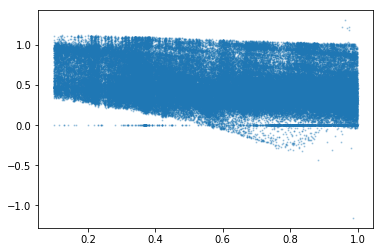

In [227]:
plt.scatter(t1['zmet'],t1['gi_o'],s=1,alpha=0.3,label='all')

In [228]:
masst= cosmos['MASS_BEST']
mass = out_data['mass']

chisq= np.log10(out_data['best_chisq'])
gio  = out_data['gi_o']
z  = out_data['zmet']

In [232]:
rabs  = out_data['rabs']
rabst = cosmos['MR']

masst = cosmos['MASS_BEST']
mass  = out_data['mass']

log_residual = filter_nan_inf(mass-masst)#get_log(residual)
residual     = 10**log_residual

zt    = out_data['zmet']
z     = out_data['zmet']

model = out_data['best_model']
chisq = out_data['best_chisq']

In [233]:
# d2 = Table(getdata(root+'bma_bad_mag_error_x5.fits'))
mass2 = bma['mass']
chisq2= get_log(bma['best_chisq'])

masst2= cosmos['MASS_BEST']

z2  = bma['zmet']
gio2= bma['gi_o']

/cvmfs/des.opensciencegrid.org/fnal/anaconda2/envs/des18a/lib/python2.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in log10
  This is separate from the ipykernel package so we can avoid doing imports until


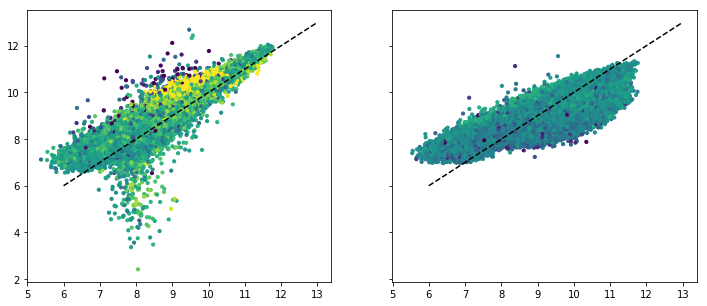

In [248]:
fig, axis = plt.subplots(1, 2, figsize=(12,5), sharex='all',sharey='all')
axis[0].scatter(masst,mass,s=10,c=np.log10(chisq),vmax=2.,vmin=-2.)
axis[1].scatter(masst2,mass2,s=10,c=np.log10(chisq2),vmax=2.,vmin=-2.)
axis[0].plot([6,13],[6,13],'k--')
axis[1].plot([6,13],[6,13],'k--')

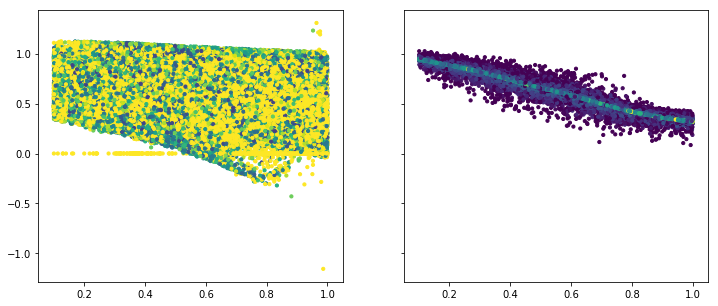

In [235]:
fig, axis = plt.subplots(1, 2, figsize=(12,5), sharex='all',sharey='all')
axis[0].scatter(z,gio,s=10,c=chisq,vmax=3.,vmin=-0.7)
axis[1].scatter(z2,gio2,s=10,c=chisq2,vmax=3.,vmin=-0.7)

In [236]:
np.count_nonzero(gio==0)

1697

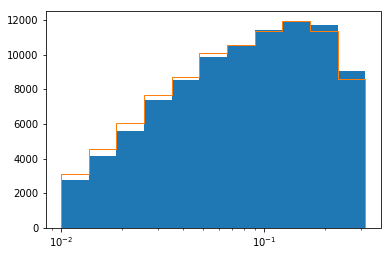

In [237]:
a = plt.hist(out_data['grerr'],bins=np.logspace(-2,-0.5,12))
_ = plt.hist(bma['grerr'],bins=a[1],histtype='step')
plt.xscale('log')

(-2, 2.0)

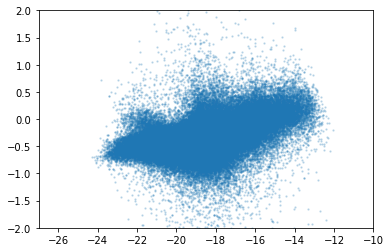

In [239]:
plt.scatter(rabst,rabs-rabst,s=2,alpha=0.2)
# plt.plot([-27.,-10.],[-27.,-10.],'k--')
plt.xlim(-27,-10.)
plt.ylim(-2,2.)
# plt.xlabel('z')
# plt.ylabel('log_residual (mass)')

In [231]:
def get_log(x):
    xlog=np.log10(x)
    xlog[np.isnan(xlog)] = -99
    xlog[np.isinf(xlog)] = -99
    return xlog

def filter_nan_inf(x):
    x[np.isnan(x)] = -99
    x[np.isinf(x)] = -99
    return x

In [240]:
log_residual = mass-masst

In [243]:
np.std(log_residual[mass>11.])

0.2330436995486379

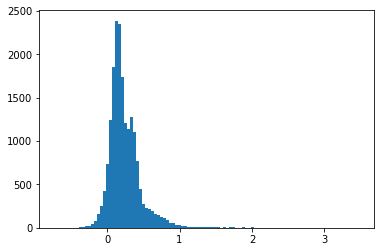

In [245]:
_ = plt.hist(log_residual[mass>10.],bins=101)
# plt.xscale('log')

In [ ]:
indices = esutil.numpy_util.match(out_data['row'],des['row'])

In [ ]:
#indices = out_data['index']
descut  = des[indices[1]]
cosmocut= cosmo[indices[1]]

In [ ]:
np.count_nonzero(descut['row']-out_data['row'][indices[0]])

In [ ]:
plt.scatter(descut['row'],out_data['row'])

In [ ]:
plt.scatter(cosmocut['row'],out_data['rowCOSMOS'])

In [ ]:
rabs  = out_data['rabs']
rabst = cosmocut['MR']

masst = descut['smass']
mass  = out_data['mass']

log_residual = filter_nan_inf(mass-masst)#get_log(residual)
residual     = 10**log_residual

zt    = descut['z_true']
z     = out_data['best_zmet']

model = out_data['best_model']
chisq = out_data['best_chisq']

In [ ]:
plt.scatter(masst,mass,s=10,alpha=0.2)
plt.plot([6,14],[6,14],'k--')
plt.xlim(6.,14)
plt.ylim(6.,14)
plt.ylabel('mass_BMA')
plt.xlabel('mass_COSMOS')

In [ ]:
_ = plt.hist(log_residual,bins=np.linspace(-3.,3.,101))
plt.xlabel('log_residual (mass)')

In [ ]:
idx = np.argsort(-1*chisq)
plt.scatter(masst[idx],log_residual[idx],s=5,alpha=0.8,c=np.log10(chisq)[idx],cmap='Dark2')
plt.plot([6.,12.],[0,0],'k--')
plt.xlim(6.,12.)
plt.ylim(-4,4)
plt.xlabel('mass_COSMOS')
plt.ylabel('log_residual (mass)')
plt.colorbar()

In [ ]:
idx = np.argsort(model)
plt.scatter(masst[idx],log_residual[idx],s=5,alpha=0.8,c=model[idx],cmap='Dark2')
plt.plot([6.,12.],[0,0],'k--')
plt.xlim(6.,12.)
plt.ylim(-4,4)
plt.xlabel('mass_COSMOS')
plt.ylabel('log_residual (mass)')
plt.colorbar()

In [ ]:
plt.scatter(zt,log_residual,s=10,alpha=0.2)
plt.plot([0,4.],[0,0],'k--')
plt.xlim(0.,4.)
plt.ylim(-4,4)
plt.xlabel('z')
plt.ylabel('log_residual (mass)')

In [ ]:
plt.scatter(rabst,rabs,s=10,alpha=0.2)
plt.plot([-27.,-10.],[-27.,-10.],'k--')
plt.xlim(-27,-10.)
plt.ylim(-27,-10.)
# plt.xlabel('z')
# plt.ylabel('log_residual (mass)')

In [ ]:
cut = mass<5

In [ ]:
mass[cut]

# Prepare input files

# Auxialiary Functions

In [212]:
def check_not_hf5(hf,path):
    return path not in hf.keys()

def delete_group(fname,path):
    fmaster = h5py.File(fname,'a')
    try:
        group   = fmaster[path]
    except:
        fmaster.close()
        return

    cols = group.keys()
    if len(cols)>0:
        for col in cols: del group[col]
    fmaster.close()
    
def stack_dict(in_list):
    columns = list(in_list[0].keys())
    new_dict= dict().fromkeys(columns)
    for col in columns:
        res = [mydict[col] for mydict in in_list]
        new_dict[col] = np.concatenate(res)
    return new_dict

def read_hdf5_file_to_dict(file,cols=None,indices=None,path='/'):
    hf = h5py.File(file, 'r')
    
    mygroup = hf[path]

    if cols is None: cols  = list(mygroup.keys())
    if indices is None: indices = np.arange(0,len(mygroup[cols[0]]),1,dtype=np.int64)

    mydict= dict().fromkeys(cols)
    for col in cols:
        mydict[col] = mygroup[col][:][indices]
    
    hf.close()

    return mydict


In [328]:
mymap

NameError: name 'mymap' is not defined

# Visualizing the input sample

In [329]:
res_map = mymap

NameError: name 'mymap' is not defined

In [330]:
plt.scatter(data['z_true'],data['i'],s=10,alpha=0.1)

KeyError: 'z_true'

In [331]:
mymap

NameError: name 'mymap' is not defined

In [332]:
import numpy as np
import h5py

#import helperfunctions
#import weightedstats as ws
#import pyfits as pf
from astropy.io import fits as pf
#
# inputDataDict is what holds the input photometry
# it expects ids, i, ierr, gr,ri,iz, grerr, rierr, izerr
#
#

#### Johnny at 27 october 2019.
from astropy.cosmology import FlatLambdaCDM
from astropy import units as u
cosmo = FlatLambdaCDM(H0=70, Om0=0.286)

def luminosityDistance(z):
    DL = float( cosmo.luminosity_distance(z) / u.Mpc ) # em Mpc
    return DL

def _get_spline(spline,zmet,zed):
    # for speed
    sgr  = float(spline[0](zed))
    sri  = float(spline[1](zed))
    siz  = float(spline[2](zed))
    sgrr = float(spline[4](zed)) ;# restframe g-r
    sgir = float(spline[5](zed)) ;# restframe g-i
    skii = float(spline[6](zed)) ;# kcorrection: i_o - i_obs
    skri = float(spline[7](zed)) ;# kcorrection: r_o - i_obs
    sml  = float(spline[8](zed)) ;# log(mass/light)  (M_sun/L_sun)
    ssfr = float(spline[9](zed))
    if (ssfr<-20.): ssfr=-20.
    sage_cosmic = float(spline[10](zed))
    sage = float(spline[11](zed))
    szmet = float(zmet)
    return np.array([sgr,sri,siz,sgrr,sgir,skii,skri,sml,ssfr,sage,szmet])

def get_spline(spline,zmet,allzed):
    unique_zed, index_zed = np.unique(allzed,return_inverse=True)
    nsize = unique_zed.size
    toto = np.zeros((nsize,11),dtype=np.float64)

    for i,zed in enumerate(unique_zed):
        toto[i] = _get_spline(spline,zmet,zed)
    
    cols  = ['sgr','sri','siz','sgrr','sgir','skii','skri','sml','ssfr','sage','szmet']
    res   = dict().fromkeys(cols)
    for i,col in enumerate(cols):
        arr = np.array(toto[:,i])
        res[col] = arr[index_zed]
    return res

def calc_copa_v2(infile, outfile, indir="simha/", lib="miles"):
    # import CosmologicalDistance
    from scipy.stats import chi2
    import os
    import logging
    import loadPopColors

    inputDataDict = load_input(infile)

    logging.debug('Starting smass.calc()')

    # cd = CosmologicalDistance.CosmologicalDistance(omega_m=0.286,omega_l=0.714)
    ldistDict = dict()
    #splineDict = dict()

    splines, zmet = loadPopColors.doAll(indir, lib=lib)
    index = inputDataDict["indices"]
    ids  = inputDataDict["mid"]
    haloid  = inputDataDict["CID"]
    mi  = inputDataDict["i"]
    ierr  = inputDataDict["ierr"]
    gr  = inputDataDict["gr"]
    ri  = inputDataDict["ri"]
    iz  = inputDataDict["iz"]
    grerr  = inputDataDict["grerr"]
    rierr  = inputDataDict["rierr"]
    izerr  = inputDataDict["izerr"]
    allzed = inputDataDict["redshift"]

    factor =1
    grerr *=factor
    rierr *=factor
    izerr *=factor
    print 'factor: ', factor
    
    #print zmet
    # protect against too small of errors => values = 0
    ix = np.nonzero(grerr < 0.02)[0]
    grerr[ix] = 0.02
    print 'fraction of small errors: gr', 1.*ix.size/ri.size

    ix = np.nonzero(rierr < 0.02)[0]
    rierr[ix] = 0.02
    print 'fraction of small errors: ri', 1.*ix.size/ri.size

    ix = np.nonzero(izerr < 0.02)[0]
    izerr[ix] = 0.02
    print 'fraction of small errors: iz', 1.*ix.size/ri.size
    print '\n'
    
    # prepping for output
    nvariables = 27
    out_index, out_id, out_haloid, out_gr, out_stdgr, out_gi, out_stdgi, \
    out_kri, out_stdkri, out_kii, out_stdkii, out_iobs, out_distmod, \
    out_bestzmet,out_stdzmet, out_rabs, out_iabs, out_mass_gr, out_mass_gi, out_mass, out_stdmass, out_sfr, out_stdsfr, out_age, out_stdage, \
    out_zmet, out_zed = [[] for i in range(nvariables)]
    
    out_bestsp, out_bestchisq = [], []

    size = haloid.size
    
    ## splines for a given cluster redshift
    spline_list_Dict = [get_spline(splines[sp],zmet[sp],allzed) for sp in range(len(splines))]

    #size = 10
    for galaxy in range(0,size) :
        zed = allzed[galaxy]

        logging.debug('{i} of {len}, z = {z}'.format(
            i = galaxy+1, len = size, z = zed))

        rest_gr,rest_gi,weight,chisqs = [], [],[],[]
        masslight, sfrs,ages, zmets,kii, kri = [],[],[],[],[],[]
        minChiSq = 999; spIndex = -1
        for sp in range(len(splines)):
            splineDict = spline_list_Dict[sp]
            #To be changed if SFH changes
            #splineDict[skey] = sgr,sri,siz,sgrr,sgir,skii,skri,sml
            sgr  = splineDict['sgr'][galaxy]
            sri  = splineDict['sri'][galaxy] 
            siz  = splineDict['siz'][galaxy]
            sgrr = splineDict['sgrr'][galaxy];  # restframe g-r
            sgir = splineDict['sgir'][galaxy];  # restframe g-i
            skii = splineDict['skii'][galaxy];  # kcorrection: i_o - i_obs
            skri = splineDict['skri'][galaxy];  # kcorrection: r_o - i_obs
            sml  = splineDict['sml'][galaxy];   # log(mass/light)  (M_sun/L_sun)
            ssfr = splineDict['ssfr'][galaxy]
            sage = splineDict['sage'][galaxy]
            szmet= splineDict['szmet'][galaxy]

            gre = grerr[galaxy]
            rie = rierr[galaxy]
            ize = izerr[galaxy]
            gr_chisq = pow((gr[galaxy] - sgr)/gre,2)
            ri_chisq = pow((ri[galaxy] - sri)/rie,2)
            iz_chisq = pow((iz[galaxy] - siz)/ize,2)
            rest_gr.append(sgrr)
            rest_gi.append(sgir)
            kii.append(skii)
            kri.append(skri)
            masslight.append(sml)
            sfrs.append(ssfr)
            ages.append(sage)
            zmets.append(szmet)
            chisq = gr_chisq + ri_chisq + iz_chisq
            probability = 1-chi2.cdf(chisq, 3-1) ;# probability of chisq greater than this
            
            weight.append(probability)
            chisqs.append(chisq)
        spIndex = np.argmax(weight)
        rest_gr = np.array(rest_gr)
        rest_gi = np.array(rest_gi)
        kii = np.array(kii)
        kri = np.array(kri)
        masslight = np.array(masslight)
        sfrs = np.array(sfrs)
        idx_sfr = (sfrs<-8.)
        ages = np.array(ages)
        weight = np.array(weight)
        gr_weighted = rest_gr * weight
        gi_weighted = rest_gi * weight
        kii_weighted = kii * weight
        kri_weighted = kri * weight
        #weight_norm = weight/np.sum(weight)
        masslight_weighted = masslight * weight
        sfr_weighted = 10**sfrs[idx_sfr] * weight[idx_sfr]
        age_weighted = ages * weight
        zmet_weighted = zmets * weight
        w1 = weight.sum()
        w2 = (weight**2).sum()
        if w1 == 0 : w1 = 1e-10
        if w2 == 0 : w2 = 1e-10
        mean_gr  = gr_weighted.sum()/w1
        mean_gi  = gi_weighted.sum()/w1
        mean_kii = kii_weighted.sum()/w1
        mean_kri = kri_weighted.sum()/w1
        mean_masslight = masslight_weighted.sum()/w1
        #try :
        #    if weight.shape[0]>1.:
        #        mean_sfr = float(ws.numpy_weighted_median(sfrs, weights=weight)) #np.median(sfr_weighted) #sfr_weighted.sum()/w1
        #    else:weight
        #        mean_sfr = -70.
        #except :
        #    mean_sfr = -70.
        #print mean_sfr
        mean_age = age_weighted.sum()/w1
        mean_zmet = zmet_weighted.sum()/w1
        mean_sfr = sfr_weighted.sum()/w1
        # unbiased weighted estimator of the sample variance
        w3 = w1**2 - w2
        if w3 == 0 : w3 = 1e-10
        var_gr = ( w1/w3 ) * (weight*(rest_gr - mean_gr)**2).sum()
        var_gi = ( w1/w3 ) * (weight*(rest_gi - mean_gi)**2).sum()
        var_kii = ( w1/w3 ) * (weight*(kii - mean_kii)**2).sum()
        var_kri = ( w1/w3 ) * (weight*(kri - mean_kii)**2).sum()
        var_masslight = ( w1/w3 ) * (weight*(masslight - mean_masslight)**2).sum()
        var_sfr = ( w1/w3 ) * (weight*(sfrs - mean_sfr)**2).sum()
        var_age = ( w1/w3 ) * (weight*(ages - mean_age)**2).sum()
        var_zmet = ( w1/w3 ) * (weight*(zmets - mean_zmet)**2).sum()
        std_gr = var_gr**0.5
        std_gi = var_gi**0.5
        std_kii = var_kii**0.5
        std_kri = var_kri**0.5
        std_masslight = var_masslight**0.5
        std_sfr = var_sfr**0.5
        std_age = var_age**0.5
        std_zmet = var_zmet**0.5 
        if std_gr > 99.99 : std_gr = 99.99
        if std_gi > 99.99 : std_gi = 99.99
        if std_kii > 99.99 : std_kii = 99.99
        if std_kri > 99.99 : std_kri = 99.99
        if std_sfr > 99.99 : std_sfr = 99.99
        if std_age > 99.99 : std_age = 99.99
        if std_masslight > 99.99 : std_masslight = 99.99
        if std_zmet > 99.99 : std_zmet = 99.99
        # Comment -distanceModulus out for fsps versions <2.5, as their mags don't include distance modulus
        if zed in ldistDict :
            lumdist = ldistDict[zed]
        else :
            # lumdist = cd.luminosity_distance(zed) ;# in Mpc
            lumdist = luminosityDistance(zed)
            ldistDict[zed] = lumdist
            
        distanceModulus = 5*np.log10(lumdist*1e6/10.)
        iabs = mi[galaxy] + mean_kii - distanceModulus
        rabs = mi[galaxy] + mean_kri - distanceModulus
        taMass = taylorMass(mean_gi, iabs)
        mcMass = mcintoshMass(mean_gr, rabs)
        fsMass = fspsMass( mean_masslight, iabs )
        # JTA: to make purely distance modulus
        #iabs = i[galaxy] - distanceModulus 
        #fsMass = gstarMass( iabs )
        if i+2<=size:
            myidx = np.argsort(-1*weight)
            print 'probs, chisq', weight[myidx], np.array(chisqs)[myidx]

        # saving for output
        out_index.append( index[galaxy])
        out_id.append( ids[galaxy] )
        out_haloid.append( haloid[galaxy] )
        out_gr.append( mean_gr )
        out_stdgr.append(std_gr )
        out_gi.append( mean_gi )
        out_stdgi.append( std_gi)
        out_kii.append( mean_kii )
        out_stdkii.append( std_kii )
        out_kri.append( mean_kri )
        out_stdkri .append( std_kri )
        out_iobs.append( mi[galaxy] )
        out_distmod.append( distanceModulus )
        out_iabs.append( iabs )
        out_rabs.append( rabs )
        out_mass_gr.append( mcMass )
        out_mass_gi.append( taMass )
        out_mass.append( fsMass )
        out_stdmass.append( std_masslight )
        out_bestsp.append( spIndex )
        out_bestzmet.append( zmets[spIndex] )
        out_bestchisq.append(chisqs[spIndex])
        out_sfr.append( mean_sfr )
        out_stdsfr.append( std_sfr  )
        out_age.append( mean_age )
        out_stdage.append( std_age  )
        out_zmet.append( mean_zmet )
        out_stdzmet.append( std_zmet  )
        out_zed.append( allzed[galaxy] )
    
    out_index = np.array(out_index).astype(int)
    out_id = np.array(out_id)#.astype(int)
    out_haloid = np.array(out_haloid).astype(int)
    out_gr = np.array(out_gr)
    out_stdgr = np.array(out_stdgr)
    out_gi = np.array(out_gi)
    out_stdgi = np.array(out_stdgi)
    out_kii = np.array(out_kii)
    out_stdkii = np.array(out_stdkii)
    out_kri = np.array(out_kri)
    out_stdkri  = np.array(out_stdkri )
    out_iobs = np.array(out_iobs)
    out_distmod = np.array(out_distmod)
    out_iabs = np.array(out_iabs)
    out_rabs = np.array(out_rabs)
    out_mass_gr = np.array(out_mass_gr)
    out_mass_gi = np.array(out_mass_gi)
    out_mass = np.array(out_mass)
    out_stdmass = np.array(out_stdmass)
    out_sfr = np.array(out_sfr)
    out_stdsfr = np.array(out_stdsfr)
    out_age = np.array(out_age)
    out_stdage = np.array(out_stdage)
    out_bestsp = np.array(out_bestsp)
    out_zmet = np.array(out_zmet)
    out_bestzmet = np.array(out_bestzmet)
    out_zed =np.array(out_zed)
    out_bestchisq = np.array(out_bestchisq)

    columns = ['index','mid','CID','gr_o','gr_o_err','gi_o','gi_o_err','kii','kii_err','kri','kri_err','iobs',
                'distmod','iabs','rabs','mcMass','taMass','mass','mass_err','ssfr','ssfr_std','mass_weight_age','mass_weight_age_err',
                'best_model','best_zmet','zmet','best_chisq']

    vectors = [out_index,out_id,out_haloid,out_gr,out_stdgr,out_gi,out_stdgi,out_kii,out_stdkii,out_kri,out_stdkri,out_iobs,
               out_distmod,out_iabs,out_rabs,out_mass_gr,out_mass_gi,out_mass,out_stdmass,out_sfr,out_stdsfr,out_age,out_stdage,
               out_bestsp,out_bestzmet,out_zed,out_bestchisq]

    mydict = dict().fromkeys(columns)
    for col,arr in zip(columns,vectors):
        mydict[col] = arr
    
    write_hdf5_file(outfile,mydict,columns)

    logging.debug('Returning from smass.calc()')


def load_input(fname):
    fmaster = h5py.File(fname, 'r')
    columns = list(fmaster['bma'].keys())

    mydict = dict().fromkeys(columns)
    for col in columns:
        mydict[col] = fmaster['bma/%s/'%col][:]
    return mydict

def write_hdf5_file(fname,table,columns):
    fmaster = h5py.File(fname, 'w')
    if check_not_hf5(fmaster,'bma'): fmaster.create_group('bma')
    for col in columns:
        fmaster.create_dataset('bma/%s/'%col, data= table[col][:])
    fmaster.close()

def check_not_hf5(hf,path):
    return path not in hf.keys()
#### end Johnny

def mcintoshMass (gr, rabs, h=0.7) :
    # equation 1, McIntosh et al 2014, arXiv:1308.0054v2
    mass = -0.406 + 1.097*gr - 0.4*(rabs - 5*np.log10(h) - 4.64)
    # log(mass/h^2) 
    return mass

def taylorMass (gi, iabs) :
    mass = -0.68 + 0.70*gi - 0.4*(iabs - 4.58)
    # assumes h=0.7
    return mass

def fspsMass( masstolight , iabs) :
    # following the above, which assumes h=0.7
    mass =  masstolight - 0.4*(iabs - 4.58)
    return mass
# how far off is just distance modulus?
def gstarMass(iabs) :
    mass =  - 0.4*(iabs - 4.58)
    return mass


# Removing temp files

In [ ]:
def remove_files(files):
    for file in files:
        os.remove(file)

In [ ]:
#remove_files(bma_temp_input_files)
#remove_files(bma_temp_output_files)